In [1]:
import numpy as np

# Expected Value of Cost function in population setting
## Projecting $p$ entries as sigmoids 
We have 

$$C(A, P) = \text{Tr}\left((B^* - B)\Sigma_X(B^* - B)\right),$$

where $$B = P^{-1}AP.$$

Here, $A$ is lower triangular and $P$ is a doubly stochastic matrix, namely

\begin{align*}
0 \leq &p_{ij} &\forall\ i,j = 1, \cdots, n\\
\sum_{j = 1}^n &p_{ij} = 1&\forall\ i = 1, \cdots, n\\
\sum_{i=1}^n &p_{ij} = 1 &\forall\ j = 1, \cdots, n\\
\end{align*}

In [1738]:
# actual solution
n = 5
As = np.tril(np.random.rand(n, n))
Ps = np.identity(n)
Sigma = np.identity(n)

print(f"A*:\n{np.round(As, 2)}\n\nP*:\n{Ps}")

A*:
[[0.21 0.   0.   0.   0.  ]
 [0.87 0.06 0.   0.   0.  ]
 [0.39 0.42 0.95 0.   0.  ]
 [0.44 0.9  0.99 0.35 0.  ]
 [0.51 0.7  0.73 0.09 0.45]]

P*:
[[1. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 1.]]


In [1739]:
def expected_cost(A, P, As = As, Ps = Ps):
    # base on the distribution of X, no actual data needed.
    # we need the covariance of X_t - X_{t-1}.
    # Then, the expected cost is the trace of this covariance
    P_inv = np.linalg.inv(P)
    Ps_inv = np.linalg.inv(Ps)
    
    B = np.matmul(P_inv, np.matmul(A, P))
    Bs = np.matmul(Ps_inv, np.matmul(As, Ps))
    
    covariance_X = np.matmul(np.linalg.inv(np.identity(n ** 2) - np.kron(Bs, Bs)), Sigma.reshape(n ** 2)).reshape((n, n))
    
    covariance_matrix = Sigma + np.matmul((Bs - B), np.matmul(covariance_X, (Bs - B).transpose()))
    
    return np.trace(covariance_matrix)

A = np.random.rand(n, n)
P = np.identity(n)
print(f"Expected cost: {expected_cost(np.random.rand(n,n), Ps)}.")

Expected cost: 221.91943464693176.


## Dealing with the constraints
### Non-negativity constraints
To deal with the $n^2$ equality constraints, we use non-negative $\textit{lagrange multipliers}$ $\lambda_{ineq, i, j} \geq 0$, $i, j = 1, \cdots, n$. The dual function now becomes 

$$\mathcal{L}(A, P_\sigma, \mathbf{\lambda}) = C(A, P) - \sum_{i=1}^n\sum_{j=1}^n \lambda_{ineq,i,j} \left(-p_{ij}\right).$$


## Dealing with equality constraints
To deal with the $2n$ equality constraints, we use $\textit{lagrange multipliers}$ $\lambda_{row, i}$, $i = 1, \cdots, n$ and $\lambda_{col, j}$, $j = 1, \cdots, n$. The dual function now becomes 

$$\mathcal{L}(A, P_\sigma, \mathbf{\lambda}) = C(A, P) - \sum_{i=1}^n\sum_{j=1}^n \lambda_{ineq,i,j} \left(-p_{ij}\right) - \sum_{i=1}^n \lambda_{row, i} \left(\sum_{j = 1}^n p_{ij} - 1\right) - \sum_{j = 1}^n \lambda_{col, j} \left(\sum_{i = 1}^n p_{ij} - 1\right).$$

In [1740]:
def expected_cost_lagrange(A, P, As = As, Ps = Ps):
    exp_cost = expected_cost(A, P)
    lambda_cost = 0
    
    for i in range(n):
        lambda_cost += lambdas[0][i] * (sum(P[:, i]) - 1)
        lambda_cost += lambdas[1][i] * (sum(P[i]) - 1)
        
    return exp_cost - lambda_cost - np.sum(lambdasineq * P)

lambdas = np.zeros((2, n))
lambdasineq = np.zeros((n, n))
P = np.ones((n, n)) / n + np.random.rand(n, n) / n
print(f"Expected lagrange cost: {expected_cost(np.random.rand(n,n), Ps)}.")

Expected lagrange cost: 113.25168812805727.


## Optimizing $\mathcal{L}(A, P_\sigma, \mathbf{\lambda})$
let $$q(\mathbf{\lambda}) = \inf_{A, P} \mathcal{L}(A, P, \mathbf{\lambda}).$$
Then the $\textit{dual problem}$ is $$\max_{\mathbf{\lambda}} q(\mathbf{\lambda}).$$

## Deriving $q(\mathbf{\lambda})$
To minimize $\mathcal{L}(A, P_\sigma, \mathbf{\lambda})$, we will use gradient descent.

The partial derivative with respect to entries in $A$ is simple, 

$$\frac{\partial\mathcal{L}(A, P, \mathbf{\lambda})}{\partial a_{ij}} = \frac{\partial C(A, P)}{\partial a_{ij}}$$

Now, the partial derivative with respect to the entries in $p$ is more involved as it occurs also in exactly two equality constraints, namely in $\lambda_{row, i}$ and in $\lambda{col, j}$.

$$\frac{\partial\mathcal{L}(A, P_\sigma, \mathbf{\lambda})}{\partial p_{ij}} = \frac{\partial C(A, P)}{\partial p_{ij}} - \lambda_{ineq, i, j} - \lambda_{row, i} - \lambda_{col, j}.$$

Now, as $C(A, P)$ is unfortunately yet inevitably non-convex, we cannot expect to find the infimum $q(\mathbf{\lambda})$. However, let us consider a local minimum $\tilde{q}(\mathbf{\lambda})$, which we will find by gradient descent. 

For a sufficiently small step size, we will do this gradient descent until we have found a stationary point:
$$(A_{t + 1}, P_{t + 1}) = (A_t, P_t) - \eta\ \nabla \mathcal{L}(A_t, P_t, \mathbf{\lambda})$$
Note that this is an $\textit{unconstrained}$ optimization problem now, which should make things more easy. 

Suppose that after a number of iterations, we have found this local minimum with parameters $\tilde{A}$, $\tilde{P}$. Then, we have that $$\tilde{q}(\mathbf{\lambda}) = \mathcal{L}(\tilde{A}, \tilde{P}, \mathbf{\lambda}).$$

In [1741]:
# get gradient of our outcome
def grad_a(A, P, i, j, As = As, Ps = Ps):
    P_inv = np.linalg.inv(P)
    Ps_inv = np.linalg.inv(Ps)
    
    B = np.matmul(P_inv, np.matmul(A, P))
    Bs = np.matmul(Ps_inv, np.matmul(As, Ps))
    
    J = np.zeros((n, n))
    J[i][j] = 1
    
    covariance_X = np.matmul(np.linalg.inv(np.identity(n ** 2) - np.kron(Bs, Bs)), Sigma.reshape(n ** 2)).reshape((n, n))

    return -2 * np.trace(np.matmul(covariance_X, np.matmul((Bs - B).transpose(), np.matmul(P_inv, np.matmul(J, P)))))

def grad_p(A, P, i, j, As = As, Ps = Ps):
    P_inv = np.linalg.inv(P)
    Ps_inv = np.linalg.inv(Ps)
    
    B = np.matmul(P_inv, np.matmul(A, P))
    Bs = np.matmul(Ps_inv, np.matmul(As, Ps))
    
    J = np.zeros((n, n))
    J[i][j] = 1
    
    covariance_X = np.matmul(np.linalg.inv(np.identity(n ** 2) - np.kron(Bs, Bs)), Sigma.reshape(n ** 2)).reshape((n, n))

    B_grad = np.matmul(P_inv, np.matmul(A, J))
    B_grad -= np.matmul(P_inv, np.matmul(J, np.matmul(P_inv, np.matmul(A, P))))
    
    return -2 * np.trace(np.matmul(covariance_X, np.matmul((Bs - B).transpose(), B_grad))) - lambdasineq[i][j] - lambdas[0][j] - lambdas[1][i]

def get_gradient(A, P):
    gradient = np.zeros(int(n * (n + 1) / 2 + n ** 2))
    index = 0
    
    for i in range(n):
        for j in range(i + 1):
            gradient[index] = grad_a(A, P, i, j)
            index += 1
            
    for i in range(n):
        for j in range(n):
            gradient[index] = grad_p(A, P, i, j)
            index += 1
            
    return gradient

## Deriving the dual problem
Now that we have $\tilde{q}(\mathbf{\lambda})$, the solution to the dual problem is
$$\max_{\lambda} \tilde{q}(\mathbf{\lambda}),$$
which is again an unconstrained optimization problem, which we can also optimize by maximizing $\lambda$'s.

## Final Algorithm
To solve this problem, we simply iterate the following:
- While $\nabla \mathcal{L}(A_t, P_t, \mathbf{\lambda}) \geq 0$:
    - $(A_{t + 1}, P_{t + 1}) = (A_t, P_t) - \eta\ \nabla \mathcal{L}(A_t, P_t, \mathbf{\lambda})$
    - $\lambda_{ineq, i, j} = max(0, p_{ij})\ \forall i, j = 1, \cdots, n$
    - $\lambda_{row, i} = 1 - \sum_{j=1}^n p_{ij} \ \forall i = 1, \cdots, n$
    - $\lambda_{col, j} = 1 - \sum_{i=1}^n p_{ij} \ \forall j = 1, \cdots, n$
    
We will end up in a local optimum of $C(A, P)$ while also fullfilling the constraints.

In [1899]:
# Initial values
A = np.zeros((n, n))
P = np.ones((n, n)) / n + np.random.rand(n, n) / n
lambdas = np.zeros((2, n))
lambdasineq = np.zeros((n, n))

In [1896]:
# step size
eta = 1e-4

In [ ]:
# the algorithm
grad = get_gradient(A, P)

# while gradient is larger than zero (or a value close)
while np.sum(np.abs(grad)) > 0.00001:
    
    # get gradient
    A_grad = np.zeros((n , n))
    A_grad[np.tril_indices(n)] = grad[:int(n * (n + 1) / 2)]
    P_grad = grad[int(n * (n + 1) / 2):].reshape((n , n))

    # update A and B according to gradient
    A -= eta * A_grad / 2
    P -= eta * P_grad / 2
    
    # recompute gradient
    grad = get_gradient(A, P)
    
    print("Gradient:", np.sum(np.abs(grad)))
    print(expected_cost_lagrange(A, P))    
    
    # update equality constraints
    for row_or_col in range(2):
        for i in range(n):
            lagrange[row_or_col][i] = grad_lambda(A, P, i, row_or_col)

    # update equality constraints
    lambdas = lagrange
    
    # update inequality constraints
    lambdasineq = np.maximum(np.zeros((n, n)), -P)

Gradient: 30235.93915290435
199.50052307421032
Gradient: 92430.53166305537
476.2326278118376
Gradient: 14277.586636578806
332.07125692827304
Gradient: 3109.5746768161507
147.04180374562438
Gradient: 2553.306661482284
130.9740534520177
Gradient: 2151.800788147499
120.38340163168742
Gradient: 1852.0298876926354
112.67684729081779
Gradient: 1617.9416471803095
106.70838009366295
Gradient: 1449.4661687428338
101.89191807025286
Gradient: 1318.252703465047
97.89281317478009
Gradient: 1204.403246609155
94.50098408782705
Gradient: 1104.9963486673273
91.57438159883507
Gradient: 1018.0668571361014
89.01175232067729
Gradient: 947.7334644943242
86.73834802879117
Gradient: 885.8501388640952
84.69772640526699
Gradient: 837.1360366917922
82.84663510473005
Gradient: 805.9257025372966
81.15158963275648
Gradient: 780.2495206474836
79.58646301912087
Gradient: 759.9311440377785
78.13072787456818
Gradient: 746.605066094022
76.76814592482242
Gradient: 736.1794120403493
75.4857785325759
Gradient: 727.13170940

Gradient: 257.627982586696
24.353033143387744
Gradient: 256.2900721011247
24.251550940410887
Gradient: 254.96158608007227
24.15103002886658
Gradient: 253.642431918537
24.051458797055744
Gradient: 252.3325182124658
23.952825806023185
Gradient: 251.0317547389287
23.855119786398152
Gradient: 249.74005243672167
23.758329635308076
Gradient: 248.45732338739822
23.662444413363083
Gradient: 247.18348079670653
23.567453341709175
Gradient: 245.91843897642883
23.473345799148326
Gradient: 244.66211332660262
23.38011131932296
Gradient: 243.41442031812204
23.287739587963568
Gradient: 242.175277475703
23.196220440197052
Gradient: 240.94460336119784
23.10554385791455
Gradient: 239.72231755726207
23.015699967196703
Gradient: 238.50834065135234
22.92667903579484
Gradient: 237.3025942200489
22.83847147066661
Gradient: 236.1050008136981
22.751067815564507
Gradient: 234.91548394136052
22.66445874867569
Gradient: 233.7339680560621
22.578635080311933
Gradient: 232.56037854033195
22.493587750648203
Gradient: 

Gradient: 116.2681967218341
15.033063359907565
Gradient: 115.85054055631463
15.007556348018724
Gradient: 115.43482244719102
14.982215421757413
Gradient: 115.02103062648177
14.95703919109286
Gradient: 114.60915342195284
14.932026279844854
Gradient: 114.19917925680745
14.907175325521983
Gradient: 113.80656283868538
14.882484979162179
Gradient: 113.42068646130488
14.857953905175357
Gradient: 113.0365528449976
14.833580781188198
Gradient: 112.65415155646463
14.809364297891022
Gradient: 112.27347224910982
14.785303158886666
Gradient: 111.89609982988763
14.761396080541477
Gradient: 111.53150167760067
14.737641791838167
Gradient: 111.16849113991609
14.714039034230792
Gradient: 110.80705904364828
14.690586561501481
Gradient: 110.44719629109177
14.667283139619224
Gradient: 110.08889385924812
14.644127546600437
Gradient: 109.73214279905031
14.621118572371422
Gradient: 109.37693423459889
14.598255018632573
Gradient: 109.02325936238924
14.575535698724503
Gradient: 108.67110945055356
14.55295943749

Gradient: 68.07557907903127
12.230670010765689
Gradient: 67.89281354580652
12.22116428394418
Gradient: 67.71072205188156
12.211703152379178
Gradient: 67.52930175727704
12.202286321329183
Gradient: 67.34854983674569
12.192913498308434
Gradient: 67.16846347966387
12.183584393066575
Gradient: 66.98903988993048
12.174298717568563
Gradient: 66.81027628585764
12.16505618597478
Gradient: 66.63216990007275
12.155856514621354
Gradient: 66.45471797941241
12.146699422000673
Gradient: 66.2779177848239
12.137584628742118
Gradient: 66.10176659126311
12.128511857592994
Gradient: 65.9262616876003
12.119480833399633
Gradient: 65.75140037651727
12.110491283088743
Gradient: 65.57717997441212
12.101542935648903
Gradient: 65.40359781130653
12.092635522112264
Gradient: 65.23065123074646
12.083768775536475
Gradient: 65.05833758971163
12.07494243098672
Gradient: 64.88665425852244
12.066156225518018
Gradient: 64.71559862074542
12.057409898157676
Gradient: 64.54516807310642
12.048703189887895
Gradient: 64.37536

Gradient: 46.651916885376366
11.03811433481526
Gradient: 46.57245678359145
11.033391045824262
Gradient: 46.49323230175197
11.028682749497861
Gradient: 46.414242671689465
11.02398936124838
Gradient: 46.33548712771258
11.019310797047241
Gradient: 46.25696490659418
11.014646973421168
Gradient: 46.17867524755671
11.009997807448421
Gradient: 46.10061739226164
11.005363216755027
Gradient: 46.02279058480008
11.000743119511075
Gradient: 45.945194071671885
10.996137434427025
Gradient: 45.867827101782865
10.991546080750036
Gradient: 45.790688926427684
10.98696897826032
Gradient: 45.71377879927533
10.98240604726757
Gradient: 45.6370959763661
10.977857208607334
Gradient: 45.560639716092595
10.973322383637495
Gradient: 45.48440927919016
10.968801494234729
Gradient: 45.40840392872519
10.964294462790988
Gradient: 45.33262293008467
10.959801212210056
Gradient: 45.25706555096613
10.955321665904068
Gradient: 45.1817310613618
10.950855747790108
Gradient: 45.10661873355565
10.946403382286794
Gradient: 45.

Gradient: 35.74019864713004
10.382587596603425
Gradient: 35.692101642240345
10.379576657384455
Gradient: 35.64413599234647
10.376571897708425
Gradient: 35.59630124659973
10.37357329073727
Gradient: 35.54859695556828
10.37058080980518
Gradient: 35.50102267122288
10.367594428417437
Gradient: 35.45357794694768
10.364614120249215
Gradient: 35.40626233752499
10.361639859144441
Gradient: 35.35907539914108
10.358671619114638
Gradient: 35.31201668937457
10.355709374337764
Gradient: 35.265085767203146
10.352753099157082
Gradient: 35.21828219299224
10.349802768080037
Gradient: 35.171605528497075
10.346858355777107
Gradient: 35.125055336856285
10.343919837080701
Gradient: 35.07863118258943
10.340987186984055
Gradient: 35.032332631598855
10.338060380640112
Gradient: 34.98615925116065
10.335139393360427
Gradient: 34.94011060992133
10.3322242006141
Gradient: 34.89418627790207
10.329314778026664
Gradient: 34.84838582648582
10.326411101379037
Gradient: 34.803175242968926
10.323513146606434
Gradient: 3

Gradient: 29.79536266855338
9.922548322606902
Gradient: 29.773404187602644
9.920338570379664
Gradient: 29.751472601422517
9.918132090986422
Gradient: 29.729567842374927
9.915928875289438
Gradient: 29.707689843071204
9.913728914200313
Gradient: 29.68583853637189
9.911532198679657
Gradient: 29.664013855388653
9.909338719736752
Gradient: 29.642215733479098
9.907148468429188
Gradient: 29.62044410424774
9.904961435862562
Gradient: 29.598698901546236
9.902777613190104
Gradient: 29.576980059469918
9.900596991612383
Gradient: 29.555287512357882
9.898419562376956
Gradient: 29.53362119479324
9.896245316778037
Gradient: 29.511981041598748
9.894074246156189
Gradient: 29.4903669878387
9.891906341897998
Gradient: 29.46877896881871
9.88974159543574
Gradient: 29.447216920079907
9.88757999824708
Gradient: 29.425680777403667
9.885421541854743
Gradient: 29.404170476807757
9.883266217826206
Gradient: 29.382685954542495
9.881114017773395
Gradient: 29.36122714709836
9.878964933352362
Gradient: 29.3397939911

Gradient: 26.255004299243872
9.572184487381508
Gradient: 26.237219453988857
9.570450114421853
Gradient: 26.219450489502503
9.568717922852583
Gradient: 26.2016973826359
9.566987908637481
Gradient: 26.183960110295818
9.565260067755094
Gradient: 26.166238649451586
9.563534396198632
Gradient: 26.148532977126315
9.561810889975895
Gradient: 26.130843070405202
9.560089545109172
Gradient: 26.113168906429813
9.558370357635143
Gradient: 26.09551046239961
9.556653323604792
Gradient: 26.077867715570797
9.55493843908333
Gradient: 26.060240643258815
9.553225700150069
Gradient: 26.042629222834428
9.551515102898392
Gradient: 26.02503343172659
9.549806643435605
Gradient: 26.00745324742003
9.548100317882884
Gradient: 25.989888647457533
9.546396122375182
Gradient: 25.972339609435878
9.544694053061132
Gradient: 25.95480611101033
9.542994106102983
Gradient: 25.937288129890657
9.541296277676489
Gradient: 25.919785643842268
9.539600563970842
Gradient: 25.902298630688023
9.53790696118858
Gradient: 25.88482706

Gradient: 23.289655898472887
9.291791697891142
Gradient: 23.27440525988659
9.290395939415403
Gradient: 23.25916711726442
9.289001806936328
Gradient: 23.243941455422245
9.28760929805143
Gradient: 23.228728259210317
9.286218410363523
Gradient: 23.213527513510186
9.284829141480715
Gradient: 23.198339203237744
9.28344148901637
Gradient: 23.183163313340252
9.282055450589093
Gradient: 23.16799982879658
9.280671023822698
Gradient: 23.152848734619198
9.279288206346187
Gradient: 23.137710015852182
9.277906995793723
Gradient: 23.122583657572193
9.276527389804597
Gradient: 23.10746964488674
9.275149386023221
Gradient: 23.092367962937328
9.273772982099095
Gradient: 23.077278596894025
9.272398175686774
Gradient: 23.062201531962167
9.271024964445864
Gradient: 23.047136753375227
9.269653346040974
Gradient: 23.03208424640121
9.268283318141702
Gradient: 23.017043996337776
9.266914878422636
Gradient: 23.002015988513783
9.26554802456328
Gradient: 22.98700020829056
9.26418275424808
Gradient: 22.9719966410

Gradient: 20.859959594623852
9.068066717200844
Gradient: 20.847914038821905
9.066925348163728
Gradient: 20.835875319018378
9.065785244802656
Gradient: 20.82384343419366
9.064646405375463
Gradient: 20.811818383320336
9.063508828142634
Gradient: 20.7998001653598
9.062372511367295
Gradient: 20.787788779270844
9.061237453315195
Gradient: 20.775784223999903
9.060103652254714
Gradient: 20.763786498486823
9.058971106456852
Gradient: 20.751795601664504
9.0578398141952
Gradient: 20.73981153245635
9.05670977374597
Gradient: 20.727834289778976
9.055580983387951
Gradient: 20.715863872539618
9.054453441402526
Gradient: 20.70390027964035
9.053327146073647
Gradient: 20.69194350997335
9.052202095687846
Gradient: 20.67999356242362
9.05107828853421
Gradient: 20.668050435868565
9.04995572290438
Gradient: 20.6561141291769
9.048834397092556
Gradient: 20.644184641211563
9.047714309395461
Gradient: 20.632261970826157
9.046595458112366
Gradient: 20.62034611686738
9.04547784154506
Gradient: 20.60843707817408
9

Gradient: 18.898756726626036
8.883328701176412
Gradient: 18.888546054528653
8.882387360473723
Gradient: 18.878341859295155
8.881447011281095
Gradient: 18.868144137615367
8.880507652236597
Gradient: 18.85795288617727
8.879569281980055
Gradient: 18.84776810167452
8.87863189915307
Gradient: 18.837589780807292
8.877695502398993
Gradient: 18.82741792027805
8.876760090362929
Gradient: 18.81725251679184
8.87582566169174
Gradient: 18.807093567060182
8.87489221503404
Gradient: 18.796941067796617
8.873959749040182
Gradient: 18.78679501571778
8.873028262362272
Gradient: 18.776655407546684
8.872097753654149
Gradient: 18.766522240009273
8.871168221571397
Gradient: 18.756395509832604
8.870239664771335
Gradient: 18.7462752137522
8.869312081913003
Gradient: 18.736161348502378
8.868385471657193
Gradient: 18.72605391082444
8.867459832666405
Gradient: 18.715952897462163
8.866535163604869
Gradient: 18.705858305162803
8.86561146313854
Gradient: 18.695770130678266
8.864688729935084
Gradient: 18.685688370761

Gradient: 17.162144343270207
8.728629505285609
Gradient: 17.153048962488423
8.727846273602593
Gradient: 17.143959505149915
8.727063814331334
Gradient: 17.13487596832468
8.72628212638951
Gradient: 17.125798349081453
8.725501208696185
Gradient: 17.116726644493838
8.724721060171799
Gradient: 17.107660851632986
8.723941679738175
Gradient: 17.098600967572153
8.723163066318508
Gradient: 17.089546989385635
8.722385218837365
Gradient: 17.080498914147007
8.721608136220697
Gradient: 17.071456738932245
8.720831817395808
Gradient: 17.062420460816377
8.720056261291388
Gradient: 17.05339007687629
8.719281466837487
Gradient: 17.04436558418925
8.718507432965525
Gradient: 17.035346979832866
8.717734158608279
Gradient: 17.02633426088729
8.716961642699905
Gradient: 17.017327424429
8.71618988417591
Gradient: 17.00832646753811
8.715418881973157
Gradient: 16.999331387298266
8.714648635029878
Gradient: 16.990342180788204
8.713879142285665
Gradient: 16.98135884508985
8.713110402681446
Gradient: 16.97238137728

Gradient: 15.62570347171977
8.599773962549119
Gradient: 15.617622106156995
8.599112986778628
Gradient: 15.609546144854619
8.598452610311993
Gradient: 15.601475584913102
8.597792832291379
Gradient: 15.593410423433353
8.597133651860094
Gradient: 15.585599739339287
8.59647506816257
Gradient: 15.57804956460809
8.595817080344386
Gradient: 15.57052522812865
8.595159687552243
Gradient: 15.563005791285079
8.594502888933983
Gradient: 15.55549125188484
8.593846683638576
Gradient: 15.547981607737448
8.593191070816117
Gradient: 15.540476856646382
8.592536049617836
Gradient: 15.532976996415883
8.591881619196087
Gradient: 15.525482024849012
8.591227778704349
Gradient: 15.51799193974561
8.590574527297228
Gradient: 15.510506738904906
8.589921864130451
Gradient: 15.503026420124314
8.589269788360873
Gradient: 15.495550981198246
8.588618299146459
Gradient: 15.488080419922557
8.587967395646306
Gradient: 15.480614734088675
8.587317077020625
Gradient: 15.473153921486524
8.58666734243074
Gradient: 15.4656979

Gradient: 14.40479426384516
8.489679456202861
Gradient: 14.39861037231785
8.489113572047707
Gradient: 14.392430505311696
8.4885481499768
Gradient: 14.386254660825735
8.487983189318175
Gradient: 14.380082836856879
8.487418689400796
Gradient: 14.37391503139874
8.48685464955456
Gradient: 14.367751242444701
8.486291069110296
Gradient: 14.36159146798461
8.485727947399754
Gradient: 14.355435706007878
8.485165283755615
Gradient: 14.34928395450052
8.484603077511483
Gradient: 14.343136211448433
8.484041328001892
Gradient: 14.3369924748345
8.483480034562293
Gradient: 14.330852742640099
8.48291919652906
Gradient: 14.324717012842259
8.482358813239497
Gradient: 14.318585283421626
8.481798884031816
Gradient: 14.312457552350802
8.481239408245152
Gradient: 14.30633381760657
8.480680385219566
Gradient: 14.300214077158346
8.480121814296028
Gradient: 14.294098328977174
8.479563694816424
Gradient: 14.287986571030256
8.47900602612356
Gradient: 14.281878801285082
8.478448807561147
Gradient: 14.2757750177053

Gradient: 13.472537939610916
8.396634293756392
Gradient: 13.467734530133256
8.396140178727196
Gradient: 13.462934368980871
8.395646420909973
Gradient: 13.458137454210831
8.395153019780468
Gradient: 13.453343783878196
8.394659974815188
Gradient: 13.448553356038294
8.394167285491378
Gradient: 13.443766168745068
8.393674951287034
Gradient: 13.439088201904802
8.3931829716809
Gradient: 13.434845143999619
8.392691346152466
Gradient: 13.43060981042725
8.392200074181968
Gradient: 13.426377421940483
8.391709155250382
Gradient: 13.42214797718876
8.391218588839427
Gradient: 13.417921474820947
8.39072837443157
Gradient: 13.41369791348609
8.39023851151001
Gradient: 13.409477291827702
8.389748999558694
Gradient: 13.405259608489622
8.389259838062301
Gradient: 13.401044862115786
8.388771026506262
Gradient: 13.39683305134334
8.388282564376723
Gradient: 13.392624174810642
8.387794451160586
Gradient: 13.388418231153263
8.387306686345477
Gradient: 13.384215219006684
8.38681926941976
Gradient: 13.380015137

Gradient: 12.825602886765662
8.314291863096193
Gradient: 12.8223664209867
8.31385345258794
Gradient: 12.819132166646583
8.313415317321592
Gradient: 12.815900122361988
8.312977456891108
Gradient: 12.812631477331818
8.312539874170108
Gradient: 12.809358147422023
8.312102571685042
Gradient: 12.806087030291788
8.311665550214844
Gradient: 12.802818128760102
8.311228809551436
Gradient: 12.79955144354807
8.310792349283185
Gradient: 12.796286975087165
8.310356168998096
Gradient: 12.793024723573527
8.309920268284117
Gradient: 12.789764689008948
8.309484646729318
Gradient: 12.786506871230717
8.309049303922027
Gradient: 12.7832512699356
8.308614239450892
Gradient: 12.779997884698322
8.308179452904952
Gradient: 12.776746714987533
8.307744943873681
Gradient: 12.773497760178188
8.307310711947006
Gradient: 12.770251019562892
8.30687675671534
Gradient: 12.767006492360885
8.306443077769599
Gradient: 12.763773329521118
8.306009674701201
Gradient: 12.760668560225302
8.305576547102104
Gradient: 12.7575658

Gradient: 12.290167420871821
8.23995572820511
Gradient: 12.287357188130997
8.239561902463414
Gradient: 12.284548783935676
8.239168294484802
Gradient: 12.281742206750758
8.238774903947057
Gradient: 12.278937455041907
8.238381730528424
Gradient: 12.276134527275289
8.237988773907604
Gradient: 12.27333342191792
8.23759603376375
Gradient: 12.27053413743745
8.237203509776482
Gradient: 12.267736672302043
8.236811201625866
Gradient: 12.26494102498075
8.236419108992422
Gradient: 12.262147193943145
8.236027231557134
Gradient: 12.259355177659458
8.235635569001428
Gradient: 12.256564974600494
8.23524412100719
Gradient: 12.253776583237707
8.234852887256757
Gradient: 12.250990002043155
8.234461867432922
Gradient: 12.248205229489486
8.234071061218925
Gradient: 12.245422264050005
8.233680468298456
Gradient: 12.242641104198446
8.233290088355659
Gradient: 12.239861748409236
8.23289992107513
Gradient: 12.237084195157287
8.232509966141912
Gradient: 12.234308442918108
8.232120223241497
Gradient: 12.2315344

Gradient: 11.819860700542147
8.173365020057965
Gradient: 11.817350579424026
8.173005113488838
Gradient: 11.814842020458704
8.172645374272612
Gradient: 11.8123350221521
8.172285802159347
Gradient: 11.809829583009938
8.17192639689945
Gradient: 11.807325701538279
8.171567158243692
Gradient: 11.804823376242732
8.171208085943197
Gradient: 11.802322605629094
8.170849179749457
Gradient: 11.79982338820315
8.170490439414305
Gradient: 11.797325722470756
8.170131864689939
Gradient: 11.79482960693737
8.16977345532891
Gradient: 11.792335040108853
8.169415211084125
Gradient: 11.789842020490614
8.169057131708842
Gradient: 11.78735054658843
8.168699216956675
Gradient: 11.784860616907636
8.168341466581591
Gradient: 11.782372229953912
8.167983880337909
Gradient: 11.779885384232465
8.167626457980301
Gradient: 11.777400078248961
8.167269199263785
Gradient: 11.774916310508651
8.16691210394374
Gradient: 11.772434079516824
8.166555171775887
Gradient: 11.769953383778805
8.166198402516303
Gradient: 11.76747422

Gradient: 11.425006327001011
8.1123886096892
Gradient: 11.423127441156554
8.112054608534788
Gradient: 11.42124926452313
8.111720735814217
Gradient: 11.41937179628357
8.11138699133308
Gradient: 11.417495035619524
8.111053374897244
Gradient: 11.415618981712
8.110719886312852
Gradient: 11.413743633740909
8.110386525386325
Gradient: 11.411868990885662
8.110053291924364
Gradient: 11.409995052325131
8.109720185733934
Gradient: 11.408121817236411
8.109387206622282
Gradient: 11.406249284796644
8.109054354396928
Gradient: 11.404377454182203
8.108721628865661
Gradient: 11.402506324567891
8.10838902983655
Gradient: 11.40063589512831
8.108056557117933
Gradient: 11.398766165037031
8.107724210518422
Gradient: 11.39689713346682
8.1073919898469
Gradient: 11.395028799589348
8.10705989491252
Gradient: 11.393161162576128
8.106727925524709
Gradient: 11.39129422159711
8.10639608149317
Gradient: 11.389427975821542
8.106064362627862
Gradient: 11.387562424418341
8.105732768739028
Gradient: 11.38569756655516
8

Gradient: 11.100944949876736
8.054790607151414
Gradient: 11.099178569098074
8.054476645286645
Gradient: 11.097412736707746
8.054162781271721
Gradient: 11.095647451699094
8.05384901495593
Gradient: 11.093882713064485
8.053535346188776
Gradient: 11.092118519793852
8.05322177481998
Gradient: 11.090354870876801
8.052908300699483
Gradient: 11.08859176530091
8.052594923677443
Gradient: 11.086829202052767
8.052281643604235
Gradient: 11.085067180117397
8.051968460330453
Gradient: 11.083305698478856
8.0516553737069
Gradient: 11.081544756119024
8.051342383584602
Gradient: 11.07978435201946
8.051029489814804
Gradient: 11.078024485159192
8.050716692248958
Gradient: 11.076265154516916
8.050403990738744
Gradient: 11.074506359069481
8.050091385136042
Gradient: 11.072748097792127
8.049778875292958
Gradient: 11.07099036965904
8.04946646106181
Gradient: 11.069233173642932
8.049154142295134
Gradient: 11.067476508715096
8.048841918845673
Gradient: 11.06572037384548
8.04852979056639
Gradient: 11.0639647680

Gradient: 10.833303232493105
8.000614826617813
Gradient: 10.831897675611653
8.000316025673794
Gradient: 10.830492607461686
8.000017299095159
Gradient: 10.829088026648805
7.999718646766432
Gradient: 10.827683931774708
7.9994200685723245
Gradient: 10.82628032143955
7.99912156439772
Gradient: 10.824877194241452
7.998823134127702
Gradient: 10.823474548774998
7.998524777647523
Gradient: 10.82207238363332
7.998226494842626
Gradient: 10.820670697407024
7.997928285598635
Gradient: 10.81926948868379
7.997630149801357
Gradient: 10.817868756049435
7.997332087336775
Gradient: 10.816468498086724
7.997034098091066
Gradient: 10.815068713376817
7.996736181950581
Gradient: 10.813669400498426
7.996438338801856
Gradient: 10.812270558025709
7.996140568531611
Gradient: 10.810872184533796
7.995842871026742
Gradient: 10.809474278592777
7.9955452461743315
Gradient: 10.808076838770308
7.995247693861642
Gradient: 10.806679863633999
7.9949502139761215
Gradient: 10.805283351745885
7.994652806405392
Gradient: 10.8

Gradient: 10.58673295523283
7.947925897567625
Gradient: 10.58539035552373
7.947638792882722
Gradient: 10.584047949078922
7.947351744636154
Gradient: 10.582705733972233
7.947064752744007
Gradient: 10.581363708272937
7.946777817122542
Gradient: 10.580021870048046
7.94649093768818
Gradient: 10.578680217359846
7.946204114357526
Gradient: 10.577338748268339
7.945917347047346
Gradient: 10.575997460828344
7.945630635674582
Gradient: 10.574656353092337
7.945343980156344
Gradient: 10.573315423109353
7.9450573804099145
Gradient: 10.571974668923044
7.944770836352748
Gradient: 10.57063408857478
7.94448434790247
Gradient: 10.56929368010259
7.944197914976874
Gradient: 10.567953441540038
7.943911537493926
Gradient: 10.566613370917365
7.943625215371769
Gradient: 10.56527346626025
7.943338948528707
Gradient: 10.563933725593
7.94305273688322
Gradient: 10.562594146933272
7.942766580353959
Gradient: 10.561254728298147
7.942480478859748
Gradient: 10.559915467697842
7.942194432319578
Gradient: 10.5585763631

Gradient: 10.381662329122321
7.898196301969217
Gradient: 10.380682098758054
7.897917991783181
Gradient: 10.379701535183138
7.897639725926592
Gradient: 10.378720635464894
7.897361504346261
Gradient: 10.377739396665728
7.897083326989186
Gradient: 10.376757815839262
7.896805193802545
Gradient: 10.375775890037405
7.896527104733695
Gradient: 10.37479361630496
7.896249059730182
Gradient: 10.373810991680763
7.89597105873973
Gradient: 10.37282801319922
7.895693101710247
Gradient: 10.371844677886688
7.895415188589827
Gradient: 10.37086098276694
7.895137319326743
Gradient: 10.369876924855902
7.894859493869451
Gradient: 10.368892501164312
7.8945817121665955
Gradient: 10.367907708698002
7.894303974167
Gradient: 10.36692254445668
7.894026279819674
Gradient: 10.365937005433851
7.893748629073808
Gradient: 10.36495108861769
7.893471021878779
Gradient: 10.363964790991057
7.893193458184148
Gradient: 10.362978109531383
7.89291593793966
Gradient: 10.361991041207908
7.8926384610952445
Gradient: 10.36100358

7.850398551893964
Gradient: 10.202250519758522
7.8501273176343265
Gradient: 10.20116205167724
7.849856121335675
Gradient: 10.2000726434473
7.849584962979206
Gradient: 10.198982291006566
7.849313842546332
Gradient: 10.197890990289157
7.849042760018678
Gradient: 10.196798737218664
7.848771715378092
Gradient: 10.195705527711539
7.848500708606641
Gradient: 10.194611357679223
7.848229739686607
Gradient: 10.193516223022376
7.847958808600489
Gradient: 10.192420119637456
7.847687915331006
Gradient: 10.191323043411522
7.847417059861098
Gradient: 10.19022499022558
7.847146242173926
Gradient: 10.189125955953179
7.84687546225286
Gradient: 10.188025936457883
7.846604720081504
Gradient: 10.18692492759967
7.846334015643672
Gradient: 10.185822925229779
7.8460633489234
Gradient: 10.184719925190812
7.845792719904948
Gradient: 10.18361592331941
7.845522128572797
Gradient: 10.182510915443874
7.845251574911642
Gradient: 10.181404897384999
7.84498105890641
Gradient: 10.180297864957708
7.844710580542239
Grad

Gradient: 10.037932751150272
7.802179566113793
Gradient: 10.037015416233787
7.801915081534936
Gradient: 10.036096271771314
7.80165063530862
Gradient: 10.035175312102535
7.801386227459937
Gradient: 10.034252531556527
7.801121858014255
Gradient: 10.033327924454802
7.800857526997216
Gradient: 10.032401485109977
7.800593234434734
Gradient: 10.031473207823367
7.800328980352998
Gradient: 10.030543086890649
7.80006476477847
Gradient: 10.029611116595355
7.799800587737886
Gradient: 10.028677291213715
7.799536449258263
Gradient: 10.027741605012093
7.799272349366887
Gradient: 10.02680405224877
7.799008288091323
Gradient: 10.025864627171122
7.798744265459409
Gradient: 10.024923324019706
7.798480281499268
Gradient: 10.02398013702464
7.798216336239289
Gradient: 10.02303506040711
7.797952429708146
Gradient: 10.022088088379414
7.797688561934784
Gradient: 10.021139215144608
7.797424732948432
Gradient: 10.020188434896642
7.797160942778595
Gradient: 10.019235741821543
7.796897191455054
Gradient: 10.01828

Gradient: 9.859025676877808
7.755483173790621
Gradient: 9.857815007522662
7.755226224098164
Gradient: 9.856601177568784
7.754969321897045
Gradient: 9.855384179902174
7.754712467266044
Gradient: 9.854164007402666
7.754455660284269
Gradient: 9.852940652943786
7.754198901031149
Gradient: 9.851714109394017
7.753942189586435
Gradient: 9.850484369617881
7.753685526030193
Gradient: 9.849251426471547
7.753428910442818
Gradient: 9.848015272806894
7.753172342905023
Gradient: 9.846775901472226
7.752915823497842
Gradient: 9.845533305306096
7.752659352302636
Gradient: 9.84428747714595
7.752402929401082
Gradient: 9.843038409820977
7.752146554875182
Gradient: 9.841786096157525
7.751890228807258
Gradient: 9.84053052897498
7.751633951279959
Gradient: 9.839271701087185
7.751377722376252
Gradient: 9.838009605305398
7.751121542179424
Gradient: 9.83674423443114
7.750865410773095
Gradient: 9.835475581266186
7.750609328241197
Gradient: 9.834203638602718
7.750353294667988
Gradient: 9.832928399232138
7.7500973

Gradient: 9.586187709961532
7.710086251766546
Gradient: 9.584790172049074
7.709839427087143
Gradient: 9.5833881956682
7.709592669228568
Gradient: 9.581981772390424
7.709345978325948
Gradient: 9.580570893790997
7.709099354514686
Gradient: 9.579155551449345
7.708852797930466
Gradient: 9.577735736948712
7.708606308709252
Gradient: 9.576311441876486
7.708359886987279
Gradient: 9.574882657824272
7.708113532901064
Gradient: 9.573449376388243
7.707867246587393
Gradient: 9.572011589168854
7.70762102818333
Gradient: 9.570569287771269
7.707374877826217
Gradient: 9.56912246380529
7.7071287956536585
Gradient: 9.567671108885872
7.7068827818035395
Gradient: 9.566215214632448
7.7066368364140105
Gradient: 9.564754772669986
7.706390959623497
Gradient: 9.563289774628815
7.706145151570692
Gradient: 9.561820212144088
7.705899412394558
Gradient: 9.560346076856876
7.705653742234323
Gradient: 9.558867360413545
7.705408141229482
Gradient: 9.557384054466612
7.705162609519801
Gradient: 9.555896150674283
7.70491

Gradient: 9.263261123126656
7.666641407589537
Gradient: 9.261111969952896
7.666409105411532
Gradient: 9.258957361631458
7.666176897981281
Gradient: 9.256797293275675
7.665944785464179
Gradient: 9.254631760034052
7.6657127680256165
Gradient: 9.25246075708861
7.665480845830997
Gradient: 9.250284279656427
7.665249019045715
Gradient: 9.248102322989332
7.665017287835171
Gradient: 9.245914882373816
7.664785652364744
Gradient: 9.243721953131999
7.664554112799822
Gradient: 9.241523530621093
7.664322669305769
Gradient: 9.239319610234292
7.664091322047948
Gradient: 9.237110187400186
7.663860071191696
Gradient: 9.23489525758393
7.6636289169023355
Gradient: 9.232674816286872
7.663397859345171
Gradient: 9.230448859046664
7.663166898685482
Gradient: 9.228217381437824
7.662936035088526
Gradient: 9.225980379072169
7.662705268719526
Gradient: 9.223737847597876
7.662474599743679
Gradient: 9.221489782701084
7.66224402832615
Gradient: 9.219236180105923
7.6620135546320665
Gradient: 9.216977035573679
7.6617

Gradient: 8.809284160662099
7.626082474953712
Gradient: 8.806601971848046
7.625870026334668
Gradient: 8.803914581361202
7.625657699917147
Gradient: 8.801221993360725
7.625445495820524
Gradient: 8.79852421207082
7.625233414163628
Gradient: 8.795821241782713
7.62502145506476
Gradient: 8.793113086854245
7.624809618641663
Gradient: 8.7903997517091
7.6245979050115364
Gradient: 8.787681240837815
7.62438631429103
Gradient: 8.784957558797313
7.624174846596236
Gradient: 8.782228710212916
7.623963502042694
Gradient: 8.779494699775036
7.623752280745378
Gradient: 8.776755532242564
7.623541182818697
Gradient: 8.77401121244157
7.623330208376502
Gradient: 8.771261745265203
7.623119357532064
Gradient: 8.76850713567406
7.622908630398079
Gradient: 8.765747388697257
7.622698027086682
Gradient: 8.762982509430383
7.622487547709413
Gradient: 8.7602125030383
7.622277192377235
Gradient: 8.757437374752987
7.622066961200524
Gradient: 8.754657129874968
7.621856854289073
Gradient: 8.751871773773228
7.621646871752

Gradient: 8.239136646577935
7.589330226915201
Gradient: 8.235641884472045
7.589141458165442
Gradient: 8.23214384614046
7.588952821725088
Gradient: 8.228642548374388
7.58876431757268
Gradient: 8.225138008025086
7.5885759456858635
Gradient: 8.2216302420032
7.588387706041363
Gradient: 8.218119267278837
7.588199598614997
Gradient: 8.214605100881561
7.588011623381674
Gradient: 8.211087759897815
7.587823780315386
Gradient: 8.207567261475722
7.587636069389223
Gradient: 8.204043622818961
7.587448490575356
Gradient: 8.20051686119144
7.58726104384505
Gradient: 8.196986993912896
7.587073729168657
Gradient: 8.193454038361725
7.586886546515617
Gradient: 8.189918011973091
7.586699495854461
Gradient: 8.186378932239954
7.586512577152812
Gradient: 8.182836816710436
7.586325790377375
Gradient: 8.17929168299062
7.5861391354939505
Gradient: 8.175743548741824
7.585952612467427
Gradient: 8.17219243168146
7.585766221261781
Gradient: 8.168638349582002
7.585579961840083
Gradient: 8.165081320272122
7.5853938341

Gradient: 7.656017970234725
7.55742523333202
Gradient: 7.653410150986014
7.557259096310521
Gradient: 7.650801947563389
7.557093074010063
Gradient: 7.648193376031163
7.556927166267154
Gradient: 7.645584452449183
7.556761372917756
Gradient: 7.642975192873635
7.556595693797293
Gradient: 7.64036561335552
7.556430128740662
Gradient: 7.637755729941578
7.556264677582226
Gradient: 7.635145558672642
7.5560993401558205
Gradient: 7.6325351155834635
7.555934116294765
Gradient: 7.629924416704232
7.555769005831858
Gradient: 7.627313478057398
7.555604008599386
Gradient: 7.624702315658728
7.555439124429123
Gradient: 7.622090945517799
7.55527435315234
Gradient: 7.619479383635718
7.555109694599806
Gradient: 7.616867646006357
7.554945148601789
Gradient: 7.614255748615121
7.554780714988065
Gradient: 7.611643707438978
7.554616393587919
Gradient: 7.609031538446438
7.554452184230153
Gradient: 7.606419257595476
7.554288086743084
Gradient: 7.603806880835841
7.554124100954552
Gradient: 7.601194424106562
7.55396

Gradient: 7.2514450876583165
7.52919556886673
Gradient: 7.249757353575793
7.529047101567133
Gradient: 7.248070173926434
7.528898714707145
Gradient: 7.246383557520583
7.528750408090481
Gradient: 7.2446975131435245
7.528602181521016
Gradient: 7.243012049540957
7.5284540348027855
Gradient: 7.241327175434009
7.52830596773997
Gradient: 7.23964289951012
7.52815798013693
Gradient: 7.237959230424303
7.5280100717981755
Gradient: 7.236276176805328
7.527862242528393
Gradient: 7.234593747240516
7.527714492132438
Gradient: 7.232911950295785
7.527566820415341
Gradient: 7.231230794497763
7.527419227182306
Gradient: 7.229550288345941
7.527271712238723
Gradient: 7.227870440302638
7.527124275390155
Gradient: 7.226191258808287
7.526976916442357
Gradient: 7.2245127522556025
7.5268296352012705
Gradient: 7.222834929019517
7.526682431473027
Gradient: 7.22115779743371
7.5265353050639545
Gradient: 7.219853503151175
7.526388255780574
Gradient: 7.2189962346004535
7.526241283429607
Gradient: 7.218138429276279
7.5

Gradient: 7.144182583196489
7.503452994772257
Gradient: 7.144166209104089
7.503316141124328
Gradient: 7.144148284166845
7.5031793370325
Gradient: 7.14412881026392
7.503042582359875
Gradient: 7.144107789279821
7.502905876969971
Gradient: 7.144085223116971
7.502769220726718
Gradient: 7.1440611136859316
7.502632613494454
Gradient: 7.144035462909039
7.502496055137933
Gradient: 7.1440082727186525
7.502359545522317
Gradient: 7.143979545060558
7.502223084513188
Gradient: 7.143949281890121
7.502086671976528
Gradient: 7.143917485174594
7.501950307778737
Gradient: 7.143884156890677
7.501813991786626
Gradient: 7.14384929902773
7.5016777238674175
Gradient: 7.143812913584679
7.501541503888743
Gradient: 7.143775002571649
7.501405331718649
Gradient: 7.143735568008225
7.501269207225589
Gradient: 7.143694611927518
7.501133130278435
Gradient: 7.143652136370544
7.500997100746461
Gradient: 7.143608143389434
7.500861118499351
Gradient: 7.143562635045377
7.500725183407211
Gradient: 7.143515613411814
7.50058

Gradient: 7.127472387919145
7.479244346292982
Gradient: 7.127276159947558
7.4791146493196345
Gradient: 7.127078823230088
7.47898498337534
Gradient: 7.1268803803225556
7.478855348389943
Gradient: 7.126680833783748
7.478725744293579
Gradient: 7.126480186173084
7.478596171016669
Gradient: 7.126278440048685
7.478466628489931
Gradient: 7.1260755979744825
7.47833711664437
Gradient: 7.125871662512386
7.4782076354112785
Gradient: 7.1256666362249685
7.47807818472223
Gradient: 7.125460521678865
7.4779487645090965
Gradient: 7.125253321438533
7.477819374704024
Gradient: 7.125045038070761
7.477690015239448
Gradient: 7.124835674144283
7.477560686048085
Gradient: 7.124625232226568
7.477431387062938
Gradient: 7.124413714886379
7.477302118217286
Gradient: 7.1242011246961825
7.477172879444687
Gradient: 7.123987464224709
7.477043670678985
Gradient: 7.12377273604394
7.476914491854296
Gradient: 7.123556942727839
7.4767853429050195
Gradient: 7.1233400868470715
7.476656223765825
Gradient: 7.123122170976329
7

Gradient: 7.07858330804357
7.456467660609155
Gradient: 7.078254483866738
7.456342635390752
Gradient: 7.077925071992816
7.4562176324157985
Gradient: 7.077595074462892
7.456092651651888
Gradient: 7.077264493314364
7.45596769306675
Gradient: 7.0769333305842945
7.455842756628256
Gradient: 7.07660158830123
7.455717842304411
Gradient: 7.076269268493252
7.455592950063359
Gradient: 7.075936373184061
7.455468079873377
Gradient: 7.075602904392342
7.455343231702886
Gradient: 7.075268864136865
7.455218405520431
Gradient: 7.074934254427351
7.4550936012946964
Gradient: 7.07459907727485
7.454968818994499
Gradient: 7.074263334682868
7.454844058588791
Gradient: 7.073927028653717
7.454719320046653
Gradient: 7.073590161184223
7.454594603337298
Gradient: 7.073252734268847
7.454469908430073
Gradient: 7.072914749897198
7.4543452352944515
Gradient: 7.072576210057141
7.454220583900039
Gradient: 7.072237116729127
7.454095954216566
Gradient: 7.071897471893344
7.4539713462139
Gradient: 7.071557277524893
7.453846

Gradient: 7.011716694544546
7.434295466626199
Gradient: 7.011311290143744
7.434174031123146
Gradient: 7.010905602974348
7.434052613728006
Gradient: 7.010499634372942
7.433931214424819
Gradient: 7.010093385677907
7.433809833197679
Gradient: 7.009686858222203
7.433688470030737
Gradient: 7.009280053333238
7.433567124908195
Gradient: 7.008872972336386
7.433445797814315
Gradient: 7.008465616552861
7.433324488733406
Gradient: 7.008057987299668
7.433203197649834
Gradient: 7.007650085892584
7.433081924548016
Gradient: 7.007241913637465
7.4329606694124255
Gradient: 7.006833471844374
7.432839432227584
Gradient: 7.00642476181538
7.432718212978066
Gradient: 7.006015784847786
7.4325970116485
Gradient: 7.0056065422371505
7.4324758282235655
Gradient: 7.0051970352756285
7.432354662687994
Gradient: 7.0047872652500365
7.432233515026563
Gradient: 7.004377233445746
7.432112385224107
Gradient: 7.0039669411409715
7.431991273265509
Gradient: 7.003556389615591
7.431870179135703
Gradient: 7.003145580139453
7.4

Gradient: 6.934880281810447
7.412597086299541
Gradient: 6.934442110274534
7.412478710912837
Gradient: 6.934003842821252
7.412360351408148
Gradient: 6.933565480207467
7.412242007775859
Gradient: 6.933127023188822
7.412123680006372
Gradient: 6.93268847251319
7.4120053680901155
Gradient: 6.93224982893231
7.411887072017533
Gradient: 6.931811093191177
7.411768791779091
Gradient: 6.931372266031455
7.411650527365272
Gradient: 6.930933348196295
7.411532278766589
Gradient: 6.930494340422339
7.4114140459735625
Gradient: 6.930055243445122
7.411295828976741
Gradient: 6.929616057998478
7.411177627766691
Gradient: 6.9291767848133325
7.411059442333998
Gradient: 6.928737424616293
7.4109412726692705
Gradient: 6.928297978131651
7.41082311876313
Gradient: 6.927858446085541
7.410704980606223
Gradient: 6.927418829195599
7.410586858189215
Gradient: 6.92697912818058
7.410468751502785
Gradient: 6.926539343755961
7.410350660537641
Gradient: 6.926099476632638
7.4102325852845015
Gradient: 6.925659527522846
7.410

Gradient: 6.855531385857612
7.3916525944662235
Gradient: 6.8550858962049634
7.391536924578563
Gradient: 6.854640410230469
7.391421269102405
Gradient: 6.854194928320977
7.391305628030601
Gradient: 6.8537494508595085
7.391190001356009
Gradient: 6.8533039782308585
7.391074389071501
Gradient: 6.852858510815482
7.390958791169953
Gradient: 6.852413048993883
7.390843207644253
Gradient: 6.851967593145375
7.3907276384873
Gradient: 6.851522143646941
7.390612083691994
Gradient: 6.851076700872518
7.39049654325125
Gradient: 6.850631265197604
7.390381017157992
Gradient: 6.850185836994234
7.390265505405147
Gradient: 6.849740416632809
7.390150007985653
Gradient: 6.849295004483862
7.390034524892463
Gradient: 6.8488496009144
7.389919056118528
Gradient: 6.848404206292276
7.389803601656814
Gradient: 6.8479588209795015
7.3896881615002945
Gradient: 6.847513445343594
7.389572735641949
Gradient: 6.847068079744046
7.389457324074771
Gradient: 6.84662272454044
7.389341926791753
Gradient: 6.846177380093934
7.3892

Gradient: 6.776152787138669
7.371170878009611
Gradient: 6.775712836570197
7.371057681015962
Gradient: 6.7752729382445445
7.370944497269085
Gradient: 6.774833092337921
7.3708313267630015
Gradient: 6.7743932990285
7.370718169491748
Gradient: 6.773953558487314
7.370605025449352
Gradient: 6.7735138708910085
7.370491894629861
Gradient: 6.773074236411909
7.370378777027313
Gradient: 6.772634655221828
7.370265672635762
Gradient: 6.77219512749282
7.370152581449259
Gradient: 6.771755653395792
7.370039503461866
Gradient: 6.771316233100574
7.369926438667647
Gradient: 6.770876866774531
7.369813387060669
Gradient: 6.770437554587605
7.369700348635005
Gradient: 6.769998296706797
7.369587323384737
Gradient: 6.769559093298544
7.3694743113039465
Gradient: 6.769119944528159
7.369361312386721
Gradient: 6.768680850560848
7.369248326627153
Gradient: 6.768241811561852
7.369135354019342
Gradient: 6.767802827692359
7.369022394557389
Gradient: 6.7673638991169
7.368909448235402
Gradient: 6.766925025995984
7.36879

Gradient: 6.697083823472543
7.350781509556214
Gradient: 6.696655576544446
7.350670629489338
Gradient: 6.696227402737582
7.3505597616535665
Gradient: 6.695799302114915
7.35044890604368
Gradient: 6.6953712747418885
7.350338062654457
Gradient: 6.6949433206831115
7.350227231480686
Gradient: 6.694515440001119
7.35011641251715
Gradient: 6.69408763276041
7.350005605758645
Gradient: 6.693659899023312
7.349894811199965
Gradient: 6.693232238852161
7.349784028835911
Gradient: 6.692804652310493
7.3496732586612845
Gradient: 6.692377139458387
7.349562500670888
Gradient: 6.691949700357894
7.349451754859538
Gradient: 6.691522335069399
7.349341021222044
Gradient: 6.691095043654492
7.349230299753222
Gradient: 6.690667826171689
7.349119590447895
Gradient: 6.690240682682552
7.349008893300885
Gradient: 6.689813613244064
7.34889820830702
Gradient: 6.689386617918109
7.34878753546113
Gradient: 6.688959696759968
7.348676874758049
Gradient: 6.688532849829603
7.3485662261926175
Gradient: 6.688106077184345
7.3484

Gradient: 6.623360801305138
7.331232847202135
Gradient: 6.6230109968129485
7.33112406516126
Gradient: 6.6226612471008925
7.331015294474986
Gradient: 6.6223115521690215
7.330906535138674
Gradient: 6.621961912020476
7.330797787147688
Gradient: 6.621612326652335
7.330689050497401
Gradient: 6.6212627960693045
7.3305803251831785
Gradient: 6.6209133202694925
7.330471611200397
Gradient: 6.620563899255501
7.3303629085444335
Gradient: 6.620214533025903
7.330254217210667
Gradient: 6.61986522158295
7.3301455371944835
Gradient: 6.619515964926611
7.3300368684912645
Gradient: 6.619166763055415
7.329928211096406
Gradient: 6.618817615972519
7.329819565005295
Gradient: 6.618468523674221
7.329710930213328
Gradient: 6.618119486163474
7.329602306715905
Gradient: 6.617770503438965
7.329493694508425
Gradient: 6.617421575500669
7.3293850935862945
Gradient: 6.617072702347059
7.329276503944921
Gradient: 6.61672388397878
7.329167925579712
Gradient: 6.616375120395456
7.329059358486086
Gradient: 6.616026411595505

Gradient: 6.561615712933828
7.311937516003402
Gradient: 6.56127564780986
7.311830695337134
Gradient: 6.560935636327697
7.311723885242129
Gradient: 6.560595678474655
7.3116170857142615
Gradient: 6.560255774239492
7.3115102967494146
Gradient: 6.559915923608355
7.311403518343476
Gradient: 6.559576126571656
7.311296750492331
Gradient: 6.559236383113979
7.3111899931918725
Gradient: 6.558896693226056
7.311083246437992
Gradient: 6.558557056893632
7.310976510226584
Gradient: 6.558217474104062
7.31086978455355
Gradient: 6.557877944847137
7.310763069414791
Gradient: 6.557538469107628
7.310656364806208
Gradient: 6.557199046875146
7.310549670723712
Gradient: 6.556859678136667
7.310442987163211
Gradient: 6.55652036287783
7.310336314120619
Gradient: 6.5561811010883675
7.310229651591847
Gradient: 6.555841892754449
7.310122999572816
Gradient: 6.555502737863973
7.310016358059446
Gradient: 6.555163636402419
7.30990972704766
Gradient: 6.554824588359522
7.309803106533383
Gradient: 6.554485593720891
7.3096

Gradient: 6.501916444544808
7.293086267349382
Gradient: 6.501585703970358
7.2929812659354605
Gradient: 6.501255014360705
7.292876274401255
Gradient: 6.500924375700745
7.292771292743115
Gradient: 6.500593787971195
7.2926663209573785
Gradient: 6.50026325115652
7.292561359040406
Gradient: 6.499932765237403
7.292456406988546
Gradient: 6.49960233019945
7.2923514647981555
Gradient: 6.499271946022339
7.29224653246559
Gradient: 6.498941612693109
7.292141609987211
Gradient: 6.498611330188926
7.29203669735938
Gradient: 6.498281098497923
7.291931794578466
Gradient: 6.497950917599983
7.291826901640834
Gradient: 6.49762078747777
7.291722018542854
Gradient: 6.497290708115273
7.2916171452809
Gradient: 6.496960679494033
7.291512281851345
Gradient: 6.496630701598188
7.29140742825057
Gradient: 6.496300774407669
7.291302584474953
Gradient: 6.495970897909032
7.291197750520878
Gradient: 6.495641072082
7.291092926384726
Gradient: 6.495311296909413
7.290988112062893
Gradient: 6.494981572375922
7.290883307551

Gradient: 6.443082773771887
7.274031974006983
Gradient: 6.44277812939416
7.273928722161058
Gradient: 6.442473519246761
7.273825479566145
Gradient: 6.442168943320715
7.273722246219019
Gradient: 6.441864401615852
7.2736190221164625
Gradient: 6.441559894124435
7.273515807255258
Gradient: 6.441255420843064
7.273412601632189
Gradient: 6.440950981767269
7.273309405244047
Gradient: 6.440646576891731
7.2732062180876165
Gradient: 6.440342206209186
7.273103040159691
Gradient: 6.440037869718884
7.272999871457065
Gradient: 6.439733567413832
7.272896711976534
Gradient: 6.439429299288813
7.272793561714892
Gradient: 6.439125065340411
7.272690420668948
Gradient: 6.43882086556288
7.272587288835496
Gradient: 6.438516699950121
7.272484166211347
Gradient: 6.43821256850007
7.272381052793305
Gradient: 6.437908471204384
7.27227794857818
Gradient: 6.437604408061768
7.2721748535627855
Gradient: 6.437300379063136
7.272071767743933
Gradient: 6.4369963842089355
7.271968691118439
Gradient: 6.436692423488787
7.2718

Gradient: 6.389091793415134
7.2556943336976305
Gradient: 6.388793189964089
7.255592688502301
Gradient: 6.388494619725295
7.255491052015645
Gradient: 6.388196082692386
7.255389424234815
Gradient: 6.3878975788591585
7.255287805156975
Gradient: 6.387599108218369
7.255186194779283
Gradient: 6.387300670763647
7.255084593098902
Gradient: 6.387002266490585
7.254983000112999
Gradient: 6.386703895388502
7.2548814158187405
Gradient: 6.386405557455495
7.254779840213294
Gradient: 6.386107252682411
7.254678273293832
Gradient: 6.38580898106229
7.254576715057529
Gradient: 6.385510742590986
7.254475165501557
Gradient: 6.385212537260508
7.254373624623094
Gradient: 6.384914365064702
7.25427209241932
Gradient: 6.384616225995997
7.254170568887415
Gradient: 6.384318120049421
7.254069054024562
Gradient: 6.384020047218462
7.253967547827948
Gradient: 6.383722007494878
7.253866050294755
Gradient: 6.383424000874459
7.25376456142218
Gradient: 6.383126027348204
7.253663081207406
Gradient: 6.3828280869109975
7.253

Gradient: 6.336850046777698
7.2376359901576945
Gradient: 6.336633403146553
7.237535860347389
Gradient: 6.336416763745802
7.237435738767466
Gradient: 6.336200128576946
7.2373356254154215
Gradient: 6.3359834976396225
7.237235520288744
Gradient: 6.335766870941944
7.237135423384935
Gradient: 6.33555024848291
7.237035334701495
Gradient: 6.335333630266323
7.236935254235924
Gradient: 6.335117016294516
7.23683518198572
Gradient: 6.3349004065702
7.2367351179483945
Gradient: 6.334683801095422
7.236635062121451
Gradient: 6.33446719987416
7.236535014502399
Gradient: 6.33425060290691
7.236434975088744
Gradient: 6.334034010198872
7.236334943878001
Gradient: 6.333817421749012
7.236234920867681
Gradient: 6.333600837564038
7.236134906055303
Gradient: 6.333384257643692
7.236034899438379
Gradient: 6.3331676819906
7.235934901014431
Gradient: 6.332951110608143
7.235834910780976
Gradient: 6.332734543497525
7.235734928735539
Gradient: 6.332517980663399
7.235634954875645
Gradient: 6.332301422105257
7.23553498

Gradient: 6.299970159840774
7.219940290762121
Gradient: 6.299790181190646
7.219841588064766
Gradient: 6.299610188888417
7.219742893178419
Gradient: 6.299430182939288
7.219644206100871
Gradient: 6.29925016336215
7.219545526829915
Gradient: 6.299070130160699
7.219446855363341
Gradient: 6.298890083351666
7.219348191698941
Gradient: 6.298710022944049
7.219249535834514
Gradient: 6.298529948948815
7.219150887767857
Gradient: 6.298349861377536
7.2190522474967675
Gradient: 6.298169760241129
7.2189536150190445
Gradient: 6.297989645550631
7.2188549903324954
Gradient: 6.297809517318223
7.218756373434915
Gradient: 6.297629375553537
7.218657764324115
Gradient: 6.297449220269513
7.2185591629979005
Gradient: 6.297269051475445
7.218460569454079
Gradient: 6.297088869183144
7.218361983690461
Gradient: 6.2969086734040385
7.218263405704857
Gradient: 6.296728464147225
7.2181648354950765
Gradient: 6.296548241426363
7.218066273058939
Gradient: 6.2963680052512405
7.217967718394258
Gradient: 6.296187755632268


Gradient: 6.267181907899822
7.202200260866282
Gradient: 6.266999627301822
7.202102937415603
Gradient: 6.2668173348607485
7.2020056214000885
Gradient: 6.2666350305846485
7.201908312817791
Gradient: 6.266452714483274
7.201811011666766
Gradient: 6.266270386563807
7.201713717945069
Gradient: 6.266088046836413
7.201616431650758
Gradient: 6.265905695309261
7.2015191527818905
Gradient: 6.265723331995177
7.201421881336528
Gradient: 6.265540956893378
7.2013246173127285
Gradient: 6.265358570021666
7.201227360708557
Gradient: 6.265176171385459
7.201130111522079
Gradient: 6.264993760993799
7.201032869751357
Gradient: 6.264811338853976
7.20093563539446
Gradient: 6.26462890497893
7.200838408449452
Gradient: 6.264446459370881
7.2007411889144075
Gradient: 6.264264002045184
7.200643976787395
Gradient: 6.264081533006348
7.2005467720664855
Gradient: 6.2638990522649
7.200449574749756
Gradient: 6.2637165598276745
7.200352384835275
Gradient: 6.26353405570506
7.2002552023211255
Gradient: 6.263351539906594
7.

Gradient: 6.234188612613455
7.184800015376119
Gradient: 6.2340043327345525
7.1847040001494555
Gradient: 6.233820042440275
7.184607992028491
Gradient: 6.2336357417393256
7.18451199101151
Gradient: 6.23345143062939
7.184415997096793
Gradient: 6.233267109131642
7.1843200102826295
Gradient: 6.233082777242317
7.184224030567301
Gradient: 6.232898434972208
7.1841280579490965
Gradient: 6.232714082328679
7.184032092426303
Gradient: 6.232529719317662
7.18393613399721
Gradient: 6.232345345945757
7.183840182660109
Gradient: 6.2321609622225065
7.18374423841329
Gradient: 6.231976568153341
7.1836483012550465
Gradient: 6.23179216374393
7.183552371183675
Gradient: 6.231607749003644
7.183456448197466
Gradient: 6.231423323936886
7.183360532294721
Gradient: 6.231238888553536
7.183264623473733
Gradient: 6.231054442857349
7.183168721732805
Gradient: 6.230869986859389
7.183072827070233
Gradient: 6.230685520561165
7.182976939484321
Gradient: 6.230501043974124
7.182881058973369
Gradient: 6.230316557104529
7.18

Gradient: 6.200856836567395
7.167630154352888
Gradient: 6.200670787853847
7.167535391576444
Gradient: 6.200484729868911
7.167440635614789
Gradient: 6.200298662617861
7.167345886466408
Gradient: 6.200112586104782
7.167251144129779
Gradient: 6.199926500338462
7.167156408603389
Gradient: 6.1997404053189005
7.167061679885722
Gradient: 6.199554301057875
7.166966957975266
Gradient: 6.199368187558259
7.166872242870507
Gradient: 6.199182064824843
7.166777534569932
Gradient: 6.19899593286364
7.166682833072032
Gradient: 6.198809791683558
7.166588138375296
Gradient: 6.198623641284954
7.166493450478215
Gradient: 6.198437481676359
7.166398769379282
Gradient: 6.198251312865812
7.166304095076991
Gradient: 6.198065134852498
7.166209427569834
Gradient: 6.197878947648533
7.166114766856307
Gradient: 6.19769275125482
7.166020112934911
Gradient: 6.1975065456807625
7.165925465804137
Gradient: 6.197320330928673
7.1658308254624865
Gradient: 6.197134107005306
7.165736191908458
Gradient: 6.196947873916295
7.165

Gradient: 6.166848580116365
7.1504941197409275
Gradient: 6.166660931200303
7.15040057324054
Gradient: 6.166473273941319
7.150307033294935
Gradient: 6.166285608350334
7.150213499902772
Gradient: 6.166097934425302
7.1501199730627105
Gradient: 6.165910252175115
7.150026452773408
Gradient: 6.165722561604074
7.149932939033524
Gradient: 6.1655348627122954
7.149839431841721
Gradient: 6.165347155509304
7.149745931196662
Gradient: 6.165159439999621
7.149652437097008
Gradient: 6.164971716184041
7.149558949541424
Gradient: 6.1647839840703496
7.149465468528577
Gradient: 6.164596243661633
7.1493719940571285
Gradient: 6.164408494964677
7.14927852612575
Gradient: 6.164220737978571
7.149185064733105
Gradient: 6.164032972713846
7.149091609877863
Gradient: 6.163845199170713
7.148998161558695
Gradient: 6.163657417359346
7.1489047197742694
Gradient: 6.163469627276087
7.1488112845232585
Gradient: 6.163281828933032
7.148717855804334
Gradient: 6.163094022330254
7.148624433616168
Gradient: 6.162906207473857
7

7.133575332651249
Gradient: 6.132374320171285
7.133482957870909
Gradient: 6.132185216380154
7.133390589415196
Gradient: 6.1319961050061895
7.133298227282924
Gradient: 6.131806986052874
7.133205871472901
Gradient: 6.131617859525008
7.133113521983939
Gradient: 6.131428725427539
7.133021178814854
Gradient: 6.131239583759369
7.132928841964457
Gradient: 6.131050434528563
7.132836511431561
Gradient: 6.130861277739331
7.132744187214984
Gradient: 6.130672113392466
7.132651869313542
Gradient: 6.130482941490891
7.132559557726045
Gradient: 6.130293762043261
7.1324672524513195
Gradient: 6.130104575049408
7.1323749534881795
Gradient: 6.1299153805127045
7.132282660835443
Gradient: 6.129726178439222
7.132190374491934
Gradient: 6.129536968830574
7.132098094456467
Gradient: 6.129347751691256
7.1320058207278665
Gradient: 6.129158527023666
7.131913553304955
Gradient: 6.1289692948353185
7.131821292186553
Gradient: 6.128780055126407
7.131729037371486
Gradient: 6.12859080790054
7.131636788858579
Gradient: 6

Gradient: 6.0980264567304925
7.116866153564436
Gradient: 6.097836037226024
7.116774911018531
Gradient: 6.097645610745471
7.116683674593037
Gradient: 6.097455177295201
7.116592444286897
Gradient: 6.0972647368786905
7.116501220099056
Gradient: 6.0970742894986
7.116410002028455
Gradient: 6.09688383515479
7.116318790074043
Gradient: 6.096693373855514
7.116227584234765
Gradient: 6.096502905599769
7.116136384509565
Gradient: 6.0963124303941685
7.116045190897391
Gradient: 6.096121948236047
7.115954003397193
Gradient: 6.09593145913518
7.1158628220079185
Gradient: 6.095740963089422
7.115771646728515
Gradient: 6.095550460103054
7.115680477557935
Gradient: 6.095359950181953
7.115589314495125
Gradient: 6.095169433325797
7.115498157539042
Gradient: 6.094978909537389
7.115407006688631
Gradient: 6.094788378822987
7.115315861942851
Gradient: 6.094597841182662
7.115224723300652
Gradient: 6.094407296620851
7.115133590760988
Gradient: 6.094216745137741
7.115042464322812
Gradient: 6.094026186742038
7.1149

Gradient: 6.063449742202967
7.10044995553227
Gradient: 6.063258106872434
7.100359804201282
Gradient: 6.063066465066344
7.100269658809967
Gradient: 6.062874816787632
7.100179519357385
Gradient: 6.0626831620396056
7.100089385842596
Gradient: 6.06249150082288
7.0999992582646545
Gradient: 6.062299833142667
7.099909136622625
Gradient: 6.062108158998674
7.099819020915563
Gradient: 6.061916478394076
7.099728911142535
Gradient: 6.06172479133398
7.099638807302597
Gradient: 6.0615330978159285
7.099548709394814
Gradient: 6.06134139784662
7.099458617418247
Gradient: 6.061149691426334
7.099368531371959
Gradient: 6.060957978559365
7.099278451255015
Gradient: 6.060766259246243
7.099188377066477
Gradient: 6.060574533491236
7.099098308805413
Gradient: 6.060382801294176
7.099008246470887
Gradient: 6.060191062659638
7.098918190061964
Gradient: 6.059999317589665
7.098828139577712
Gradient: 6.059807566087194
7.098738095017198
Gradient: 6.0596158081532945
7.0986480563794885
Gradient: 6.059424043792144
7.098

7.084495081433283
Gradient: 6.0294383963425435
7.084405944259847
Gradient: 6.029253690792509
7.084316812262159
Gradient: 6.0290689713939
7.084227685440025
Gradient: 6.028884238158401
7.0841385637932355
Gradient: 6.028699491101179
7.08404944732158
Gradient: 6.028514730245465
7.08396033602485
Gradient: 6.028329955606338
7.083871229902827
Gradient: 6.028145167212996
7.0837821289552965
Gradient: 6.0279603650854305
7.083693033182035
Gradient: 6.027775549256222
7.0836039425828226
Gradient: 6.027590719750966
7.083514857157434
Gradient: 6.0274058766021765
7.083425776905642
Gradient: 6.0272210198429335
7.083336701827223
Gradient: 6.027036149507698
7.083247631921945
Gradient: 6.026851265628326
7.083158567189581
Gradient: 6.026666368243774
7.083069507629896
Gradient: 6.026481457393231
7.08298045324266
Gradient: 6.026296533110779
7.0828914040276425
Gradient: 6.02611159543851
7.082802359984607
Gradient: 6.025926644417019
7.08271332111332
Gradient: 6.025741680084781
7.082624287413548
Gradient: 6.025

Gradient: 5.995817973653155
7.06835712931403
Gradient: 5.995631367244756
7.068268930056265
Gradient: 5.99544475314836
7.068180735925798
Gradient: 5.995258131385795
7.068092546922292
Gradient: 5.995071501975217
7.068004363045415
Gradient: 5.994884864941872
7.067916184294827
Gradient: 5.994698220307336
7.067828010670188
Gradient: 5.99451156808885
7.067739842171161
Gradient: 5.9943249083130326
7.067651678797407
Gradient: 5.994138240996326
7.067563520548584
Gradient: 5.993951566163139
7.0674753674243505
Gradient: 5.9937648838331965
7.067387219424363
Gradient: 5.993578194026732
7.067299076548281
Gradient: 5.993391496766015
7.067210938795759
Gradient: 5.993204792070067
7.067122806166452
Gradient: 5.993018079958696
7.067034678660014
Gradient: 5.992831360454601
7.066946556276101
Gradient: 5.9926446335750425
7.066858439014361
Gradient: 5.992457899345267
7.066770326874448
Gradient: 5.992271157778891
7.0666822198560135
Gradient: 5.992084408900164
7.06659411795871
Gradient: 5.991897652727294
7.066

Gradient: 5.962497112149105
7.052738091212776
Gradient: 5.962309394150788
7.05265079865892
Gradient: 5.962121670969205
7.052563511161972
Gradient: 5.961933942618522
7.0524762287214955
Gradient: 5.961746209104809
7.052388951337047
Gradient: 5.9615584704386935
7.052301679008187
Gradient: 5.9613707266251685
7.052214411734477
Gradient: 5.961182977674262
7.052127149515475
Gradient: 5.960995223593577
7.052039892350739
Gradient: 5.960807464392767
7.051952640239829
Gradient: 5.960619700077585
7.051865393182302
Gradient: 5.9604319306572435
7.051778151177715
Gradient: 5.960244156142403
7.051690914225629
Gradient: 5.960056376534997
7.0516036823256005
Gradient: 5.959868591848578
7.0515164554771825
Gradient: 5.9596808020874255
7.051429233679936
Gradient: 5.959493007261974
7.051342016933415
Gradient: 5.959305207379157
7.051254805237176
Gradient: 5.959117402444787
7.0511675985907765
Gradient: 5.958929592469386
7.05108039699377
Gradient: 5.958741777459866
7.0509932004457125
Gradient: 5.95855395742198


Gradient: 5.929007964708159
7.037279261772066
Gradient: 5.928819423798171
7.037192862208185
Gradient: 5.928630878673856
7.037106467619721
Gradient: 5.928442329336463
7.037020078006208
Gradient: 5.928253775792394
7.0369336933671764
Gradient: 5.928065218041526
7.03684731370216
Gradient: 5.927876656089153
7.03676093901069
Gradient: 5.927688089936995
7.036674569292303
Gradient: 5.927499519589433
7.036588204546526
Gradient: 5.927310945047836
7.036501844772893
Gradient: 5.927122366318426
7.036415489970939
Gradient: 5.92693378340036
7.036329140140192
Gradient: 5.926745196299099
7.036242795280187
Gradient: 5.926556605016611
7.036156455390457
Gradient: 5.926368009556731
7.036070120470534
Gradient: 5.926179409920676
7.035983790519949
Gradient: 5.925990806115377
7.035897465538234
Gradient: 5.925802198139199
7.0358111455249235
Gradient: 5.9256135859961585
7.035724830479549
Gradient: 5.92542496969207
7.0356385204016405
Gradient: 5.9252363492268945
7.035552215290733
Gradient: 5.925047724603763
7.035

Gradient: 5.8950051035515285
7.021807047679896
Gradient: 5.894815841405399
7.0217215361733105
Gradient: 5.894626575400592
7.021636029558405
Gradient: 5.8944373055379495
7.02155052783472
Gradient: 5.894248031816719
7.021465031001802
Gradient: 5.894058754241518
7.021379539059186
Gradient: 5.893869472806703
7.021294052006416
Gradient: 5.893680187522409
7.021208569843033
Gradient: 5.893490898380337
7.0211230925685815
Gradient: 5.8933016053913025
7.021037620182598
Gradient: 5.89311230854553
7.020952152684625
Gradient: 5.892923007853354
7.020866690074209
Gradient: 5.892733703310424
7.020781232350885
Gradient: 5.892544394920571
7.0206957795142
Gradient: 5.892355082682582
7.020610331563694
Gradient: 5.8921657665979685
7.020524888498911
Gradient: 5.89197644666881
7.020439450319391
Gradient: 5.891787122895693
7.020354017024678
Gradient: 5.891597795279166
7.0202685886143135
Gradient: 5.891408463820256
7.020183165087842
Gradient: 5.89121912852035
7.0200977464448036
Gradient: 5.891029789377791
7.02

Gradient: 5.861066448313175
7.006577990692528
Gradient: 5.860876506890163
7.00649334759542
Gradient: 5.860686561713923
7.006408709309788
Gradient: 5.860496612782505
7.006324075835197
Gradient: 5.860306660098102
7.006239447171214
Gradient: 5.860116703657905
7.0061548233174005
Gradient: 5.85992674346665
7.006070204273326
Gradient: 5.859736779519194
7.0059855900385495
Gradient: 5.85954681182125
7.00590098061264
Gradient: 5.859356840368898
7.005816375995163
Gradient: 5.859166865163248
7.005731776185686
Gradient: 5.858976886206028
7.005647181183771
Gradient: 5.858786903496769
7.005562590988985
Gradient: 5.858596917035809
7.005478005600895
Gradient: 5.858406926819264
7.005393425019065
Gradient: 5.858216932855986
7.0053088492430655
Gradient: 5.858026935138447
7.005224278272459
Gradient: 5.857836933667843
7.005139712106813
Gradient: 5.857646928449371
7.0050551507456955
Gradient: 5.85745691947864
7.004970594188675
Gradient: 5.857266906756756
7.0048860424353165
Gradient: 5.857076890282859
7.0048

Gradient: 5.8264353853894235
6.991251773477314
Gradient: 5.826244762083682
6.991167999053223
Gradient: 5.826054135027038
6.99108422936399
Gradient: 5.825863504224168
6.991000464409209
Gradient: 5.82567286967052
6.990916704188476
Gradient: 5.825482231368693
6.990832948701382
Gradient: 5.825291589317816
6.990749197947526
Gradient: 5.825100943517957
6.9906654519265
Gradient: 5.824910293966815
6.990581710637899
Gradient: 5.824719640667191
6.990497974081317
Gradient: 5.824528983619171
6.990414242256353
Gradient: 5.824338322818738
6.9903305151626
Gradient: 5.824147658271308
6.990246792799655
Gradient: 5.823956989971096
6.99016307516711
Gradient: 5.823766317923457
6.990079362264566
Gradient: 5.823575642124418
6.989995654091617
Gradient: 5.823384962572947
6.989911950647858
Gradient: 5.823194279274034
6.989828251932885
Gradient: 5.8230035922235075
6.9897445579463
Gradient: 5.822812901421624
6.989660868687693
Gradient: 5.822622206870088
6.9895771841566665
Gradient: 5.822431508565147
6.9894935043

Gradient: 5.79187135641625
6.976165346333501
Gradient: 5.79168005201652
6.97608242247058
Gradient: 5.791488743834863
6.975999503271798
Gradient: 5.791297431873285
6.975916588736773
Gradient: 5.791106116132158
6.975833678865135
Gradient: 5.790914796606165
6.975750773656506
Gradient: 5.79072347330187
6.975667873110512
Gradient: 5.7905321462151775
6.975584977226779
Gradient: 5.790340815345286
6.975502086004931
Gradient: 5.790149480693977
6.975419199444593
Gradient: 5.789958142260398
6.975336317545393
Gradient: 5.789766800044514
6.975253440306955
Gradient: 5.7895754540460445
6.975170567728904
Gradient: 5.7893841042628775
6.97508769981087
Gradient: 5.789192750698744
6.975004836552474
Gradient: 5.789001393350707
6.9749219779533504
Gradient: 5.788810032217874
6.974839124013119
Gradient: 5.788618667300814
6.974756274731408
Gradient: 5.788427298600769
6.9746734301078455
Gradient: 5.788235926116304
6.974590590142058
Gradient: 5.788044549848452
6.974507754833675
Gradient: 5.787853169793077
6.9744

Gradient: 5.757375442216821
6.961313838312098
Gradient: 5.757183453633987
6.9612317481019605
Gradient: 5.756991461228473
6.961149662491011
Gradient: 5.756799465000821
6.961067581478903
Gradient: 5.756607464951394
6.960985505065291
Gradient: 5.756415461079347
6.960903433249827
Gradient: 5.756223453383229
6.960821366032167
Gradient: 5.756031441865591
6.960739303411967
Gradient: 5.755839426523083
6.960657245388876
Gradient: 5.755647407357612
6.960575191962554
Gradient: 5.755455384369413
6.960493143132653
Gradient: 5.755263357555812
6.9604110988988275
Gradient: 5.755071326917729
6.960329059260734
Gradient: 5.754879292455775
6.960247024218029
Gradient: 5.754687254171142
6.960164993770367
Gradient: 5.754495212056509
6.960082967917401
Gradient: 5.754303166120684
6.960000946658789
Gradient: 5.754111116359125
6.959918929994188
Gradient: 5.753919062772091
6.959836917923253
Gradient: 5.753727005356106
6.959754910445637
Gradient: 5.7535349441177885
6.9596729075610035
Gradient: 5.753342879051497
6.

Gradient: 5.72256303174846
6.946530101143248
Gradient: 5.722370347796748
6.946448837894626
Gradient: 5.722177659984723
6.946367579185004
Gradient: 5.72198496831016
6.946286325014065
Gradient: 5.721792272775038
6.946205075381489
Gradient: 5.721599573378224
6.946123830286955
Gradient: 5.721406870120411
6.946042589730148
Gradient: 5.721214163001545
6.945961353710747
Gradient: 5.7210214520193325
6.945880122228434
Gradient: 5.720828737176005
6.945798895282896
Gradient: 5.7206360184701115
6.9457176728738075
Gradient: 5.720443295901445
6.945636455000854
Gradient: 5.7202505694682095
6.945555241663718
Gradient: 5.7200578391774854
6.945474032862084
Gradient: 5.719865105017921
6.9453928285956295
Gradient: 5.719672366997105
6.945311628864042
Gradient: 5.71947962511417
6.9452304336670005
Gradient: 5.719286879365958
6.945149243004192
Gradient: 5.71909412975328
6.9450680568752965
Gradient: 5.718901376278265
6.944986875279998
Gradient: 5.718708618939781
6.944905698217982
Gradient: 5.718515857733163
6.

Gradient: 5.688204302028515
6.932136456716185
Gradient: 5.688010928077459
6.932055996515475
Gradient: 5.687817550237481
6.931975540799198
Gradient: 5.687624168506904
6.931895089567059
Gradient: 5.68743078288305
6.931814642818764
Gradient: 5.687237393372298
6.9317342005540175
Gradient: 5.687043999967146
6.931653762772528
Gradient: 5.686850602671575
6.9315733294739985
Gradient: 5.686657201486328
6.9314929006581405
Gradient: 5.686463796407009
6.931412476324655
Gradient: 5.686270387438951
6.931332056473252
Gradient: 5.6860769745780395
6.9312516411036365
Gradient: 5.685883557825791
6.931171230215515
Gradient: 5.685690137178935
6.931090823808594
Gradient: 5.685496712642857
6.931010421882583
Gradient: 5.685303284213296
6.9309300244371865
Gradient: 5.68510985189164
6.930849631472113
Gradient: 5.684916415677396
6.930769242987072
Gradient: 5.684722975572001
6.930688858981766
Gradient: 5.684529531570821
6.930608479455907
Gradient: 5.684336083679297
6.930528104409202
Gradient: 5.684142631893735
6.

Gradient: 5.653722339977396
6.9178849174007375
Gradient: 5.653528271694912
6.917805250910077
Gradient: 5.653334199504702
6.91772558885345
Gradient: 5.653140123405436
6.91764593123059
Gradient: 5.652946043394915
6.917566278041219
Gradient: 5.652751959477579
6.9174866292850705
Gradient: 5.652557871648973
6.917406984961869
Gradient: 5.652363779910882
6.917327345071343
Gradient: 5.6521696842647655
6.917247709613223
Gradient: 5.6519755847086195
6.9171680785872365
Gradient: 5.65178148124013
6.91708845199311
Gradient: 5.651587373864512
6.9170088298305785
Gradient: 5.651393262578008
6.916929212099365
Gradient: 5.6511991473832675
6.916849598799201
Gradient: 5.651005028275904
6.916769989929816
Gradient: 5.650810905259725
6.916690385490936
Gradient: 5.650616778333584
6.9166107854822965
Gradient: 5.650422647498672
6.916531189903622
Gradient: 5.650228512752091
6.916451598754644
Gradient: 5.650034374094078
6.916372012035092
Gradient: 5.649840231526218
6.916292429744695
Gradient: 5.649646085049848
6.

Gradient: 5.6185322481347955
6.903537253584273
Gradient: 5.618337471507067
6.903458385333923
Gradient: 5.618142690962498
6.9033795214702245
Gradient: 5.617947906502381
6.903300661992926
Gradient: 5.617753118127267
6.903221806901779
Gradient: 5.61755832583565
6.903142956196531
Gradient: 5.617363529626315
6.903064109876927
Gradient: 5.61716872950471
6.902985267942721
Gradient: 5.616973925464569
6.902906430393657
Gradient: 5.6167791175101325
6.9028275972294875
Gradient: 5.6165843056380105
6.90274876844996
Gradient: 5.61638948985274
6.902669944054824
Gradient: 5.616194670148681
6.90259112404383
Gradient: 5.615999846530849
6.902512308416723
Gradient: 5.615805018996927
6.9024334971732575
Gradient: 5.615610187546365
6.90235469031318
Gradient: 5.615415352180003
6.902275887836241
Gradient: 5.615220512898265
6.902197089742191
Gradient: 5.615025669700971
6.902118296030779
Gradient: 5.614830822586913
6.9020395067017555
Gradient: 5.614635971559102
6.901960721754873
Gradient: 5.614441116612717
6.901

Gradient: 5.583800335492704
6.88956757956975
Gradient: 5.583604862164018
6.889489488274572
Gradient: 5.583409384921991
6.889411401322864
Gradient: 5.583213903768868
6.889333318714394
Gradient: 5.583018418708835
6.889255240448931
Gradient: 5.582822929735208
6.889177166526239
Gradient: 5.582627436855008
6.889099096946087
Gradient: 5.582431940061767
6.889021031708237
Gradient: 5.582236439361099
6.888942970812463
Gradient: 5.582040934748721
6.888864914258526
Gradient: 5.581845426227835
6.888786862046195
Gradient: 5.581649913795516
6.888708814175237
Gradient: 5.581454397455867
6.888630770645418
Gradient: 5.581258877206022
6.888552731456508
Gradient: 5.581063353044092
6.888474696608271
Gradient: 5.580867824976658
6.888396666100478
Gradient: 5.580672292999207
6.888318639932894
Gradient: 5.580476757109117
6.888240618105287
Gradient: 5.580281217314122
6.888162600617426
Gradient: 5.58008567360739
6.888084587469079
Gradient: 5.5798901259900795
6.8880065786600095
Gradient: 5.5796945744694435
6.887

Gradient: 5.548552217844255
6.875580900383571
Gradient: 5.548356042039099
6.8755035872380805
Gradient: 5.548159862340693
6.875426278395491
Gradient: 5.547963678750331
6.875348973855585
Gradient: 5.547767491267461
6.875271673618144
Gradient: 5.547571299889441
6.875194377682952
Gradient: 5.547375104622013
6.8751170860497925
Gradient: 5.54717890546117
6.875039798718447
Gradient: 5.546982702406478
6.874962515688701
Gradient: 5.546786495462447
6.874885236960334
Gradient: 5.546590284626126
6.874807962533133
Gradient: 5.5463940698938465
6.874730692406878
Gradient: 5.5461978512763155
6.8746534265813555
Gradient: 5.546001628762011
6.8745761650563475
Gradient: 5.5458054023583605
6.874498907831638
Gradient: 5.545609172064921
6.874421654907011
Gradient: 5.545412937876333
6.874344406282248
Gradient: 5.5452166997997185
6.874267161957135
Gradient: 5.545020457832944
6.8741899219314595
Gradient: 5.544824211970841
6.874112686204997
Gradient: 5.5446279622224885
6.874035454777538
Gradient: 5.5444317085833

Gradient: 5.5134103675734245
6.8617336497582775
Gradient: 5.513216906398444
6.861657107713952
Gradient: 5.5130234386758605
6.861580569934747
Gradient: 5.512829964401148
6.86150403642046
Gradient: 5.512636483578678
6.861427507170889
Gradient: 5.512442996208245
6.861350982185832
Gradient: 5.512249502291006
6.861274461465085
Gradient: 5.51205600182927
6.861197945008446
Gradient: 5.5118624948216315
6.8611214328157155
Gradient: 5.511668981272658
6.861044924886689
Gradient: 5.511475461178518
6.860968421221161
Gradient: 5.511281934545458
6.860891921818937
Gradient: 5.511088401370414
6.860815426679809
Gradient: 5.510894861657405
6.860738935803577
Gradient: 5.510701315405137
6.860662449190042
Gradient: 5.510507762616539
6.860585966838998
Gradient: 5.510314203290482
6.860509488750243
Gradient: 5.5101206374318
6.860433014923582
Gradient: 5.50992706503713
6.860356545358807
Gradient: 5.509733486110434
6.860280080055719
Gradient: 5.509539900650166
6.860203619014115
Gradient: 5.509346308661799
6.8601

Gradient: 5.4782882098240275
6.847948824877646
Gradient: 5.4780935802075295
6.8478730515925275
Gradient: 5.477898944235535
6.847797282537068
Gradient: 5.477704301904623
6.84772151771108
Gradient: 5.477509653218257
6.8476457571143765
Gradient: 5.4773149981763005
6.847570000746764
Gradient: 5.477120336779802
6.8474942486080534
Gradient: 5.476925669032504
6.847418500698059
Gradient: 5.476730994931715
6.84734275701659
Gradient: 5.476536314480157
6.847267017563458
Gradient: 5.476341627681013
6.847191282338471
Gradient: 5.476146934531124
6.847115551341444
Gradient: 5.475952235034006
6.847039824572188
Gradient: 5.475757529191123
6.846964102030513
Gradient: 5.475562817002244
6.84688838371623
Gradient: 5.475368098469985
6.846812669629151
Gradient: 5.47517337359346
6.84673695976909
Gradient: 5.474978642376609
6.846661254135855
Gradient: 5.474783904815249
6.846585552729257
Gradient: 5.474589160917599
6.846509855549112
Gradient: 5.474394410680537
6.84643416259523
Gradient: 5.474199654103019
6.8463

6.834302580336623
Gradient: 5.442761962451277
6.834227569601282
Gradient: 5.442566193486922
6.834152563062421
Gradient: 5.442370418362879
6.834077560719864
Gradient: 5.442174637077629
6.834002562573433
Gradient: 5.44197884963686
6.8339275686229515
Gradient: 5.441783056038229
6.833852578868243
Gradient: 5.44158725628186
6.833777593309128
Gradient: 5.441391450373054
6.833702611945431
Gradient: 5.4411956383090505
6.833627634776976
Gradient: 5.440999820092459
6.833552661803581
Gradient: 5.440803995725535
6.833477693025077
Gradient: 5.440608165205988
6.833402728441281
Gradient: 5.4404123285390185
6.833327768052017
Gradient: 5.440216485722457
6.833252811857111
Gradient: 5.4400206367606065
6.833177859856386
Gradient: 5.439824781649243
6.833102912049662
Gradient: 5.4396289203960695
6.833027968436766
Gradient: 5.439433052997943
6.832953029017519
Gradient: 5.43923717945604
6.832878093791748
Gradient: 5.439041299774647
6.832803162759272
Gradient: 5.438845413951023
6.832728235919918
Gradient: 5.43

6.8209423486456044
Gradient: 5.4076222118254496
6.820868086311627
Gradient: 5.407425357709622
6.820793828143344
Gradient: 5.40722849763298
6.820719574140584
Gradient: 5.407031631594452
6.820645324303186
Gradient: 5.406834759595354
6.8205710786309774
Gradient: 5.406637881636666
6.820496837123795
Gradient: 5.406440997718862
6.82042259978147
Gradient: 5.406244107845053
6.820348366603837
Gradient: 5.406047212014652
6.820274137590729
Gradient: 5.405850310229939
6.820199912741983
Gradient: 5.405653402490522
6.820125692057429
Gradient: 5.405456488798664
6.820051475536903
Gradient: 5.405259569154639
6.819977263180235
Gradient: 5.405062643562264
6.8199030549872655
Gradient: 5.404865712017381
6.819828850957823
Gradient: 5.404668774526528
6.819754651091743
Gradient: 5.4044718310870445
6.81968045538886
Gradient: 5.404274881702015
6.819606263849007
Gradient: 5.404077926372112
6.819532076472019
Gradient: 5.403880965099278
6.819457893257732
Gradient: 5.403683997881542
6.819383714205976
Gradient: 5.40

Gradient: 5.372771223949302
6.80749228360979
Gradient: 5.372586875919188
6.807418686470961
Gradient: 5.372402526548543
6.807345092041206
Gradient: 5.372218175971936
6.807271500321437
Gradient: 5.372033824312778
6.807197911312564
Gradient: 5.371849471689153
6.807124325015491
Gradient: 5.371665118203524
6.807050741431114
Gradient: 5.371480763950995
6.806977160560323
Gradient: 5.371296409022599
6.806903582404008
Gradient: 5.371112053495243
6.806830006963048
Gradient: 5.370927697441916
6.806756434238309
Gradient: 5.37074334092978
6.806682864230669
Gradient: 5.370558984020949
6.806609296940981
Gradient: 5.370374626765547
6.806535732370097
Gradient: 5.370190269215321
6.806462170518869
Gradient: 5.370005911415381
6.806388611388131
Gradient: 5.369821553406429
6.806315054978722
Gradient: 5.369637195224007
6.806241501291467
Gradient: 5.369452836899371
6.8061679503271835
Gradient: 5.369268478464698
6.806094402086684
Gradient: 5.3690841199406965
6.80602085657078
Gradient: 5.368899761355465
6.80594

Gradient: 5.339952452491435
6.794435290324661
Gradient: 5.3397680274798285
6.794362185034105
Gradient: 5.339583601571585
6.794289082543373
Gradient: 5.33939917476633
6.794215982852752
Gradient: 5.3392147470577225
6.7941428859625255
Gradient: 5.339030318442086
6.7940697918729756
Gradient: 5.33884588891452
6.793996700584382
Gradient: 5.3386614584709475
6.793923612097025
Gradient: 5.338477027110397
6.793850526411183
Gradient: 5.338292594824296
6.793777443527134
Gradient: 5.3381081616112365
6.793704363445152
Gradient: 5.3379237274660944
6.793631286165514
Gradient: 5.337739292385791
6.793558211688489
Gradient: 5.337554856367152
6.793485140014355
Gradient: 5.337370419402124
6.79341207114338
Gradient: 5.337185981493145
6.793339005075831
Gradient: 5.337001542629407
6.7932659418119785
Gradient: 5.336817102812448
6.793192881352092
Gradient: 5.336632662036477
6.793119823696435
Gradient: 5.336448220297411
6.793046768845273
Gradient: 5.336263777591605
6.792973716798869
Gradient: 5.336079333914261
6

Gradient: 5.306922977796643
6.7813942698368415
Gradient: 5.306738343020365
6.781321669264422
Gradient: 5.306553706866719
6.78124907152707
Gradient: 5.306369069331957
6.781176476624916
Gradient: 5.306184430417414
6.781103884558083
Gradient: 5.305999790120472
6.7810312953267
Gradient: 5.305815148437686
6.780958708930892
Gradient: 5.30563050536818
6.7808861253707855
Gradient: 5.305445860912123
6.780813544646502
Gradient: 5.305261215067604
6.78074096675817
Gradient: 5.305076567830156
6.780668391705909
Gradient: 5.304891919201836
6.780595819489842
Gradient: 5.304707269177667
6.780523250110093
Gradient: 5.304522617759199
6.7804506835667855
Gradient: 5.304337964943516
6.780378119860034
Gradient: 5.304153310728232
6.780305558989966
Gradient: 5.303968655113323
6.780233000956697
Gradient: 5.3037839980954375
6.780160445760346
Gradient: 5.303599339674432
6.780087893401034
Gradient: 5.303414679849263
6.780015343878878
Gradient: 5.303230018618313
6.779942797193996
Gradient: 5.303045355976868
6.77987

Gradient: 5.273665240032616
6.768371938362258
Gradient: 5.273480337173682
6.768299849643099
Gradient: 5.273295432745323
6.768227763773661
Gradient: 5.273110526744647
6.768155680753983
Gradient: 5.272925619173716
6.768083600584109
Gradient: 5.272740710028383
6.7680115232640805
Gradient: 5.272555799312656
6.767939448793936
Gradient: 5.272370887021102
6.7678673771737206
Gradient: 5.272185973157108
6.767795308403473
Gradient: 5.272001057719188
6.767723242483229
Gradient: 5.271816140704562
6.767651179413034
Gradient: 5.271631222113873
6.7675791191929235
Gradient: 5.271446301948407
6.76750706182294
Gradient: 5.271261380206986
6.76743500730312
Gradient: 5.271076456885215
6.7673629556335015
Gradient: 5.2708915319882905
6.767290906814124
Gradient: 5.27070660551103
6.767218860845022
Gradient: 5.270521677455284
6.7671468177262355
Gradient: 5.270336747820538
6.767074777457802
Gradient: 5.270151816604995
6.767002740039758
Gradient: 5.269966883810119
6.766930705472136
Gradient: 5.269781949432248
6.7

Gradient: 5.242910365537392
6.75537032899306
Gradient: 5.242743388178628
6.755298756450267
Gradient: 5.2425764052822075
6.755227186759836
Gradient: 5.242409416851988
6.755155619921759
Gradient: 5.242242422883162
6.755084055936029
Gradient: 5.242075423378925
6.755012494802632
Gradient: 5.241908418343414
6.754940936521563
Gradient: 5.241741407767315
6.754869381092809
Gradient: 5.241574391661586
6.754797828516365
Gradient: 5.241407370016134
6.754726278792214
Gradient: 5.241240342841474
6.75465473192035
Gradient: 5.241073310128563
6.754583187900763
Gradient: 5.240906271883723
6.754511646733437
Gradient: 5.240739228105458
6.7544401084183665
Gradient: 5.240572178792597
6.754368572955536
Gradient: 5.24040512394853
6.7542970403449365
Gradient: 5.240238063571473
6.754225510586557
Gradient: 5.2400709976607995
6.754153983680383
Gradient: 5.239903926218505
6.754082459626404
Gradient: 5.239736849243854
6.7540109384246065
Gradient: 5.239569766738859
6.753939420074981
Gradient: 5.239402678700574
6.75

Gradient: 5.212429622182006
6.742391089961681
Gradient: 5.21226164304984
6.742320036212398
Gradient: 5.212093658454539
6.7422489853108205
Gradient: 5.211925668395221
6.74217793725691
Gradient: 5.211757672875254
6.742106892050628
Gradient: 5.211589671892934
6.7420358496919315
Gradient: 5.211421665450324
6.741964810180781
Gradient: 5.211253653546729
6.741893773517139
Gradient: 5.21108563618394
6.741822739700962
Gradient: 5.210917613359452
6.741751708732211
Gradient: 5.210749585077785
6.741680680610845
Gradient: 5.21058155133722
6.7416096553368225
Gradient: 5.210413512139255
6.741538632910104
Gradient: 5.21024546748259
6.741467613330647
Gradient: 5.210077417370906
6.741396596598411
Gradient: 5.2099093618013645
6.741325582713356
Gradient: 5.209741300778953
6.741254571675439
Gradient: 5.209573234296942
6.7411835634846184
Gradient: 5.209405162363579
6.741112558140852
Gradient: 5.209237084974184
6.741041555644101
Gradient: 5.209069002132477
6.74097055599432
Gradient: 5.208900913837778
6.74089

Gradient: 5.182105902148185
6.729647248714363
Gradient: 5.181936948826155
6.729576706803225
Gradient: 5.1817679901446905
6.729506167730884
Gradient: 5.181599026108728
6.729435631497283
Gradient: 5.18143005671323
6.729365098102363
Gradient: 5.181261081966182
6.7292945675460665
Gradient: 5.181092101860614
6.729224039828337
Gradient: 5.180923116402866
6.729153514949114
Gradient: 5.180754125590728
6.729082992908341
Gradient: 5.1805851294250695
6.729012473705961
Gradient: 5.180416127907805
6.728941957341913
Gradient: 5.1802478137211585
6.728871443816139
Gradient: 5.180080716458649
6.728800933128582
Gradient: 5.179913614590436
6.728730425279186
Gradient: 5.179746508119344
6.728659920267887
Gradient: 5.179579397047032
6.72858941809463
Gradient: 5.179412281372252
6.728518918759353
Gradient: 5.17924516109751
6.728448422262003
Gradient: 5.179078036222274
6.728377928602516
Gradient: 5.178910906746886
6.728307437780838
Gradient: 5.178743772670358
6.728236949796904
Gradient: 5.178576633996505
6.728

Gradient: 5.151607719481607
6.716855318739707
Gradient: 5.151439842809014
6.716785292475268
Gradient: 5.151271961619094
6.71671526903811
Gradient: 5.151104075914715
6.716645248428164
Gradient: 5.150936185692442
6.716575230645366
Gradient: 5.150768290956847
6.7165052156896445
Gradient: 5.1506003917058925
6.716435203560934
Gradient: 5.150432487942327
6.716365194259165
Gradient: 5.150264579663618
6.7162951877842705
Gradient: 5.150096666871746
6.716225184136183
Gradient: 5.149928749568378
6.716155183314831
Gradient: 5.1497608277506535
6.71608518532015
Gradient: 5.1495929014226505
6.71601519015207
Gradient: 5.149424970583069
6.715945197810523
Gradient: 5.149257035230532
6.715875208295444
Gradient: 5.149089095369142
6.715805221606761
Gradient: 5.1489211509954185
6.715735237744407
Gradient: 5.148753202114839
6.715665256708311
Gradient: 5.1485852487232755
6.715595278498407
Gradient: 5.148417290823118
6.715525303114629
Gradient: 5.148249328412824
6.715455330556905
Gradient: 5.148081361494926
6.

Gradient: 5.121148862515511
6.704226553932671
Gradient: 5.120980174774239
6.704157038270204
Gradient: 5.120811482584973
6.7040875254222545
Gradient: 5.1206427859440335
6.704018015388745
Gradient: 5.120474084857547
6.703948508169609
Gradient: 5.120305379321461
6.703879003764771
Gradient: 5.120136669336807
6.70380950217416
Gradient: 5.119967954903637
6.7037400033977
Gradient: 5.11979923602651
6.703670507435319
Gradient: 5.119630512699331
6.703601014286947
Gradient: 5.119461784927067
6.703531523952509
Gradient: 5.119293052707016
6.703462036431935
Gradient: 5.119124316041202
6.70339255172515
Gradient: 5.118955574928732
6.703323069832079
Gradient: 5.118786829372624
6.703253590752655
Gradient: 5.118618079369108
6.703184114486801
Gradient: 5.118449324923601
6.703114641034447
Gradient: 5.118280566029618
6.703045170395518
Gradient: 5.118111802694397
6.702975702569941
Gradient: 5.11794303491363
6.702906237557647
Gradient: 5.1177742626897835
6.702836775358559
Gradient: 5.117605486020687
6.7027673

Gradient: 5.090544177918323
6.691689996458116
Gradient: 5.090374689325367
6.691620989030523
Gradient: 5.090205196329643
6.6915519844041595
Gradient: 5.090035698931445
6.691482982578953
Gradient: 5.089866197131289
6.691413983554828
Gradient: 5.089696690927317
6.691344987331711
Gradient: 5.089527180324568
6.691275993909531
Gradient: 5.089357665317415
6.691207003288211
Gradient: 5.0891881459085155
6.6911380154676765
Gradient: 5.089018622099828
6.691069030447856
Gradient: 5.088849093888733
6.691000048228677
Gradient: 5.088679561277964
6.690931068810062
Gradient: 5.0885100242652435
6.69086209219194
Gradient: 5.088340482852924
6.690793118374238
Gradient: 5.0881709370391075
6.690724147356878
Gradient: 5.088001386827693
6.69065517913979
Gradient: 5.087831832213069
6.690586213722898
Gradient: 5.087662273200866
6.690517251106131
Gradient: 5.087492709787495
6.690448291289414
Gradient: 5.0873231419784855
6.690379334272674
Gradient: 5.087153569766137
6.690310380055834
Gradient: 5.086983993155931
6.

Gradient: 5.059795201532358
6.679245212548005
Gradient: 5.059624918940518
6.679176710945282
Gradient: 5.0594546319737805
6.67910821213052
Gradient: 5.059284340635454
6.679039716103642
Gradient: 5.05911404492629
6.67897122286458
Gradient: 5.0589437448407
6.678902732413261
Gradient: 5.058773440384721
6.678834244749611
Gradient: 5.05860313155652
6.678765759873559
Gradient: 5.058432818354987
6.678697277785029
Gradient: 5.058262500783036
6.678628798483954
Gradient: 5.058092178835867
6.678560321970258
Gradient: 5.057921852519698
6.678491848243869
Gradient: 5.0577515218300455
6.678423377304714
Gradient: 5.057581186769439
6.678354909152721
Gradient: 5.057410847335567
6.678286443787821
Gradient: 5.0572405035341585
6.6782179812099365
Gradient: 5.057070155357327
6.678149521419
Gradient: 5.056899802811643
6.678081064414934
Gradient: 5.056729445893667
6.67801261019767
Gradient: 5.056559084603908
6.677944158767133
Gradient: 5.056388718945591
6.677875710123254
Gradient: 5.05621834891485
6.67780726426

Gradient: 5.028902917903665
6.666891768425095
Gradient: 5.028731845412144
6.666823770275509
Gradient: 5.028560768565308
6.666755774900998
Gradient: 5.028389687359137
6.666687782301493
Gradient: 5.028218601796361
6.666619792476927
Gradient: 5.02804751187774
6.666551805427227
Gradient: 5.027876417601516
6.666483821152326
Gradient: 5.0277053189681595
6.666415839652153
Gradient: 5.027534215978472
6.6663478609266384
Gradient: 5.02736310863189
6.6662798849757126
Gradient: 5.0271919969275345
6.666211911799307
Gradient: 5.027020880869674
6.666143941397351
Gradient: 5.026849760452473
6.666075973769778
Gradient: 5.026678635680224
6.666008008916516
Gradient: 5.026507506549334
6.6659400468374965
Gradient: 5.026336373064315
6.66587208753265
Gradient: 5.026165235222721
6.665804131001908
Gradient: 5.025994093023414
6.665736177245199
Gradient: 5.02582294646791
6.665668226262454
Gradient: 5.025651795559323
6.665600278053607
Gradient: 5.0254806402897945
6.665532332618587
Gradient: 5.02530948066775
6.665

Gradient: 4.998039714505607
6.654696742352802
Gradient: 4.997867858297109
6.654629242616312
Gradient: 4.997695997736684
6.6545617456427255
Gradient: 4.997524132825699
6.654494251431977
Gradient: 4.997352263558223
6.654426759983998
Gradient: 4.997180389941221
6.654359271298726
Gradient: 4.997008511968968
6.654291785376095
Gradient: 4.996836629648047
6.65422430221604
Gradient: 4.996664742970081
6.654156821818492
Gradient: 4.99649285194258
6.654089344183392
Gradient: 4.9963209565610285
6.654021869310669
Gradient: 4.996149056827417
6.653954397200259
Gradient: 4.995977152742968
6.6538869278521
Gradient: 4.995805244302871
6.6538194612661234
Gradient: 4.995633331512204
6.653751997442266
Gradient: 4.9954614143680995
6.653684536380459
Gradient: 4.995289492872976
6.653617078080643
Gradient: 4.995117567021266
6.653549622542746
Gradient: 4.994945636822352
6.65348216976671
Gradient: 4.994773702266895
6.653414719752465
Gradient: 4.994601763359968
6.653347272499947
Gradient: 4.994429820101793
6.65327

Gradient: 4.96651753112927
6.6423902365645935
Gradient: 4.966344878100353
6.642323241374968
Gradient: 4.966172220712831
6.642256248936704
Gradient: 4.9659995589691786
6.642189259249738
Gradient: 4.965826892863639
6.642122272314012
Gradient: 4.965654222406986
6.642055288129466
Gradient: 4.96548154758792
6.641988306696036
Gradient: 4.965308868414405
6.641921328013663
Gradient: 4.965136184879289
6.6418543520822855
Gradient: 4.964963496991828
6.6417873789018484
Gradient: 4.964790804741762
6.641720408472286
Gradient: 4.964618108135846
6.64165344079354
Gradient: 4.9644454071729225
6.641586475865548
Gradient: 4.964272701850026
6.641519513688254
Gradient: 4.964099992171879
6.641452554261595
Gradient: 4.963927278133575
6.64138559758551
Gradient: 4.963754559736817
6.6413186436599405
Gradient: 4.96358183698343
6.641251692484826
Gradient: 4.963409109872302
6.641184744060108
Gradient: 4.963236378401627
6.641117798385722
Gradient: 4.963063642571965
6.641050855461614
Gradient: 4.962890902385565
6.640

Gradient: 4.9357165959251175
6.630508380241631
Gradient: 4.935543166306736
6.630441873868001
Gradient: 4.93536973232295
6.630375370235427
Gradient: 4.935196293967348
6.630308869343853
Gradient: 4.935022851243803
6.630242371193227
Gradient: 4.934849404150027
6.6301758757834905
Gradient: 4.934675952684879
6.63010938311459
Gradient: 4.934502496852426
6.630042893186469
Gradient: 4.934329036648878
6.629976405999075
Gradient: 4.934155572074519
6.629909921552351
Gradient: 4.933982103130509
6.629843439846242
Gradient: 4.933808629816998
6.629776960880694
Gradient: 4.933635152131396
6.629710484655653
Gradient: 4.933461670077319
6.629644011171061
Gradient: 4.933288183651664
6.629577540426866
Gradient: 4.933114692855501
6.6295110724230115
Gradient: 4.932941197689525
6.629444607159446
Gradient: 4.932767698150055
6.62937814463611
Gradient: 4.932594194243045
6.6293116848529525
Gradient: 4.932420685964591
6.629245227809917
Gradient: 4.932247173313517
6.629178773506951
Gradient: 4.932073656292034
6.629

Gradient: 4.9042545664597705
6.6185153261665075
Gradient: 4.904080344416659
6.618449315056153
Gradient: 4.9039061179848
6.618383306677385
Gradient: 4.903731887163603
6.618317301030156
Gradient: 4.903557651958281
6.618251298114417
Gradient: 4.903383412362769
6.618185297930118
Gradient: 4.903209168379178
6.618119300477209
Gradient: 4.903034920008498
6.618053305755642
Gradient: 4.9028606672469435
6.617987313765367
Gradient: 4.902686410100733
6.617921324506335
Gradient: 4.9025121485633
6.617855337978496
Gradient: 4.902337882637761
6.617789354181804
Gradient: 4.902163612324006
6.617723373116206
Gradient: 4.9019893376212345
6.617657394781655
Gradient: 4.9018150585293725
6.617591419178103
Gradient: 4.901640775048238
6.617525446305496
Gradient: 4.901466487178186
6.617459476163792
Gradient: 4.901292194919824
6.617393508752937
Gradient: 4.901117898269237
6.617327544072883
Gradient: 4.900943597233066
6.617261582123584
Gradient: 4.9007692918035675
6.617195622904989
Gradient: 4.900594981985545
6.61

Gradient: 4.87317381502206
6.60680833490262
Gradient: 4.872998810089702
6.606742809267038
Gradient: 4.872823800745926
6.606677286354768
Gradient: 4.872648786991894
6.606611766165764
Gradient: 4.872473768832426
6.606546248699987
Gradient: 4.87229874625719
6.606480733957389
Gradient: 4.872123719275276
6.606415221937925
Gradient: 4.871948687883297
6.606349712641558
Gradient: 4.87177365207822
6.606284206068239
Gradient: 4.87159861186503
6.606218702217928
Gradient: 4.871423567241012
6.606153201090581
Gradient: 4.871248518203895
6.606087702686154
Gradient: 4.871073464758539
6.606022207004603
Gradient: 4.870898406903708
6.605956714045886
Gradient: 4.870723344630996
6.605891223809959
Gradient: 4.870548277953664
6.605825736296779
Gradient: 4.870373206862167
6.605760251506303
Gradient: 4.870198131359002
6.6056947694384895
Gradient: 4.870023051444939
6.605629290093294
Gradient: 4.869847967117165
6.605563813470672
Gradient: 4.869672878379559
6.605498339570581
Gradient: 4.869497785228664
6.60543286

Gradient: 4.841777555352156
6.595122591615556
Gradient: 4.841601758927846
6.595057552789562
Gradient: 4.841425958070536
6.594992516679608
Gradient: 4.84125015277662
6.594927483285653
Gradient: 4.841074343050878
6.59486245260766
Gradient: 4.840898528888747
6.5947974246455905
Gradient: 4.840722710290319
6.5947323993994065
Gradient: 4.840546887261131
6.594667376869074
Gradient: 4.840371059792234
6.594602357054551
Gradient: 4.840195227891887
6.594537339955805
Gradient: 4.840019391551973
6.594472325572793
Gradient: 4.839843550779825
6.594407313905481
Gradient: 4.839667705571255
6.594342304953833
Gradient: 4.839491855924932
6.594277298717806
Gradient: 4.8393160018449795
6.5942122951973685
Gradient: 4.839140143326585
6.5941472943924815
Gradient: 4.838964280374473
6.594082296303108
Gradient: 4.838788412985546
6.594017300929207
Gradient: 4.838612541156202
6.593952308270745
Gradient: 4.838436664895158
6.593887318327686
Gradient: 4.838260784195445
6.5938223310999895
Gradient: 4.838084899055769
6.

6.583459323662589
Gradient: 4.809886028382592
6.583394773147481
Gradient: 4.809709427011275
6.583330225342153
Gradient: 4.809532821178233
6.58326568024657
Gradient: 4.809356210885479
6.583201137860705
Gradient: 4.809179596133411
6.583136598184525
Gradient: 4.809002976919531
6.5830720612179965
Gradient: 4.808826353245918
6.583007526961089
Gradient: 4.808649725109198
6.582942995413773
Gradient: 4.80847309251163
6.5828784665760125
Gradient: 4.808296455453537
6.582813940447778
Gradient: 4.808119813934001
6.5827494170290395
Gradient: 4.8079431679536615
6.582684896319761
Gradient: 4.807766517509689
6.582620378319916
Gradient: 4.807589862604828
6.58255586302947
Gradient: 4.807413203237898
6.582491350448392
Gradient: 4.807236539409566
6.582426840576652
Gradient: 4.807059871116969
6.582362333414217
Gradient: 4.806883198364091
6.582297828961057
Gradient: 4.8067065211478965
6.582233327217139
Gradient: 4.8065298394675136
6.582168828182432
Gradient: 4.806353153325555
6.582104331856907
Gradient: 4.8

Gradient: 4.777018700825279
6.571820953350901
Gradient: 4.776833509323284
6.57175691138932
Gradient: 4.776648313588305
6.571692872289724
Gradient: 4.7764631136056765
6.571628836052283
Gradient: 4.776277909362772
6.571564802677174
Gradient: 4.776092700851317
6.571500772164569
Gradient: 4.775907488056804
6.57143674451464
Gradient: 4.77572227096978
6.57137271972756
Gradient: 4.775537049579468
6.5713086978035005
Gradient: 4.775351823873889
6.5712446787426275
Gradient: 4.775166593842092
6.571180662545115
Gradient: 4.774981359473384
6.571116649211126
Gradient: 4.774796120757156
6.571052638740831
Gradient: 4.774610877685063
6.570988631134394
Gradient: 4.77442563024613
6.570924626391983
Gradient: 4.7742403784263505
6.570860624513763
Gradient: 4.774055122220209
6.570796625499899
Gradient: 4.773869861617122
6.570732629350552
Gradient: 4.773684596602861
6.5706686360658875
Gradient: 4.773499327176504
6.570604645646064
Gradient: 4.773314053317796
6.570540658091246
Gradient: 4.773128775027753
6.5704

Gradient: 4.743794975311507
6.5604031754373295
Gradient: 4.743608923381091
6.560339648020124
Gradient: 4.74342286635988
6.560276123488083
Gradient: 4.743236804248953
6.560212601841309
Gradient: 4.743050737047294
6.560149083079904
Gradient: 4.7428646647485975
6.560085567203966
Gradient: 4.742678587356887
6.560022054213596
Gradient: 4.742492504870285
6.559958544108894
Gradient: 4.742306417287315
6.55989503688996
Gradient: 4.742120324605162
6.559831532556888
Gradient: 4.741934226824867
6.559768031109784
Gradient: 4.741748123942713
6.559704532548742
Gradient: 4.741562015961453
6.559641036873864
Gradient: 4.741375902877671
6.559577544085245
Gradient: 4.741189784690414
6.5595140541829835
Gradient: 4.741003661397939
6.559450567167179
Gradient: 4.740817533001259
6.559387083037927
Gradient: 4.740631399498101
6.5593236017953265
Gradient: 4.7404452608882774
6.559260123439475
Gradient: 4.740259117170308
6.559196647970469
Gradient: 4.740072968341218
6.559133175388406
Gradient: 4.739886814405233
6.5

Gradient: 4.710596957258836
6.549140829491298
Gradient: 4.710409991427066
6.549077817023973
Gradient: 4.710223020460415
6.549014807456513
Gradient: 4.7100360443563245
6.548951800788979
Gradient: 4.709849063118146
6.548888797021443
Gradient: 4.709662076743376
6.548825796153969
Gradient: 4.709475085236095
6.548762798186625
Gradient: 4.709288088590952
6.548699803119474
Gradient: 4.709101086812276
6.548636810952583
Gradient: 4.708914079902479
6.548573821686019
Gradient: 4.708727067853596
6.548510835319845
Gradient: 4.7085400506754205
6.548447851854127
Gradient: 4.708353028362348
6.548384871288929
Gradient: 4.708166000916628
6.548321893624318
Gradient: 4.707978968340207
6.54825891886036
Gradient: 4.707791930628203
6.548195946997117
Gradient: 4.7076048877881735
6.548132978034653
Gradient: 4.707417839813765
6.548070011973034
Gradient: 4.707230786709546
6.548007048812325
Gradient: 4.707043728473401
6.547944088552588
Gradient: 4.706856665110118
6.547881131193886
Gradient: 4.706669596610906
6.54

Gradient: 4.67704862561831
6.537907851935992
Gradient: 4.676860747216911
6.537845359466493
Gradient: 4.676672863767283
6.537782869906501
Gradient: 4.676484975264031
6.537720383256057
Gradient: 4.676297081708157
6.537657899515203
Gradient: 4.676109183109748
6.537595418683983
Gradient: 4.675921279451872
6.537532940762437
Gradient: 4.675733370753096
6.5374704657506095
Gradient: 4.675545457002935
6.537407993648541
Gradient: 4.67535753820584
6.537345524456272
Gradient: 4.675169614360731
6.537283058173846
Gradient: 4.674981685469843
6.537220594801304
Gradient: 4.6747937515330165
6.537158134338686
Gradient: 4.674605812551238
6.537095676786038
Gradient: 4.674417868523963
6.537033222143397
Gradient: 4.674229919452804
6.5369707704108055
Gradient: 4.67404196533804
6.536908321588304
Gradient: 4.673854006180829
6.536845875675934
Gradient: 4.6736660419802725
6.536783432673737
Gradient: 4.673478072736293
6.536720992581751
Gradient: 4.6732900984553725
6.53665855540002
Gradient: 4.673102119130764
6.536

6.526830060849785
Gradient: 4.6433384627781455
6.526768086846736
Gradient: 4.643149689463121
6.526706115759186
Gradient: 4.6429609112002055
6.526644147587163
Gradient: 4.642772127990323
6.526582182330688
Gradient: 4.6425833398348875
6.526520219989788
Gradient: 4.642394546737465
6.526458260564492
Gradient: 4.642205748692854
6.5263963040548205
Gradient: 4.642016945706548
6.526334350460802
Gradient: 4.641828137776646
6.52627239978246
Gradient: 4.64163932490393
6.52621045201982
Gradient: 4.641450507090807
6.526148507172909
Gradient: 4.641261684335747
6.5260865652417515
Gradient: 4.641072856637993
6.526024626226371
Gradient: 4.640884024003688
6.525962690126793
Gradient: 4.640695186426939
6.525900756943043
Gradient: 4.640506343912831
6.5258388266751455
Gradient: 4.640317496461144
6.525776899323126
Gradient: 4.640128644069883
6.5257149748870065
Gradient: 4.639939786742778
6.525653053366815
Gradient: 4.6397509244786725
6.525591134762575
Gradient: 4.639562057277788
6.525529219074308
Gradient: 4

Gradient: 4.609659423552237
6.515783182368108
Gradient: 4.609469778800454
6.515721730583643
Gradient: 4.609280129201501
6.5156602817182
Gradient: 4.609090474759015
6.515598835771794
Gradient: 4.608900815469984
6.51553739274444
Gradient: 4.608711151340151
6.515475952636152
Gradient: 4.6085214823652
6.515414515446945
Gradient: 4.608331808548128
6.515353081176832
Gradient: 4.608142129888222
6.515291649825824
Gradient: 4.607952446386967
6.5152302213939395
Gradient: 4.6077627580439975
6.515168795881192
Gradient: 4.607573064861924
6.5151073732875915
Gradient: 4.607383366838226
6.515045953613156
Gradient: 4.607193663977332
6.5149845368579
Gradient: 4.607003956274703
6.514923123021832
Gradient: 4.606814243733717
6.514861712104969
Gradient: 4.606624526359618
6.514800304107324
Gradient: 4.606434804142101
6.514738899028913
Gradient: 4.606245077091283
6.514677496869746
Gradient: 4.606055345203714
6.51461609762984
Gradient: 4.605865608478323
6.514554701309203
Gradient: 4.60567586692178
6.5144933079

Gradient: 4.575064800921332
6.504647048800252
Gradient: 4.574874283117737
6.504586128466386
Gradient: 4.574683760565977
6.5045252110533855
Gradient: 4.574493233265006
6.50446429656126
Gradient: 4.5743027012193505
6.504403384990013
Gradient: 4.574112164422085
6.504342476339653
Gradient: 4.573921622880599
6.504281570610187
Gradient: 4.573731076592464
6.50422066780162
Gradient: 4.573540525559204
6.5041597679139596
Gradient: 4.573349969778732
6.50409887094721
Gradient: 4.573159409256437
6.5040379769013805
Gradient: 4.572968843986356
6.503977085776476
Gradient: 4.5727782739747855
6.503916197572498
Gradient: 4.5725876992198895
6.503855312289461
Gradient: 4.572397119722864
6.503794429927364
Gradient: 4.5722065354815005
6.503733550486217
Gradient: 4.572015946501532
6.503672673966025
Gradient: 4.57182535277886
6.503611800366794
Gradient: 4.571634754314081
6.503550929688531
Gradient: 4.571444151112443
6.503490061931241
Gradient: 4.571253543169524
6.50342919709493
Gradient: 4.571062930487838
6.50

Gradient: 4.540886943740542
6.493788846162063
Gradient: 4.540695584079833
6.493728448737616
Gradient: 4.540504219760728
6.493668054234719
Gradient: 4.540312850786512
6.493607662653374
Gradient: 4.540121477154255
6.493547273993582
Gradient: 4.539930098869302
6.4934868882553465
Gradient: 4.5397387159276725
6.493426505438666
Gradient: 4.5395473283319605
6.493366125543546
Gradient: 4.539355936081691
6.493305748569984
Gradient: 4.539164539179083
6.493245374517984
Gradient: 4.538973137622138
6.493185003387545
Gradient: 4.538781731415066
6.493124635178669
Gradient: 4.538590320555452
6.4930642698913585
Gradient: 4.5383989050433104
6.493003907525613
Gradient: 4.538207484880029
6.492943548081436
Gradient: 4.53801606006898
6.492883191558826
Gradient: 4.537824630603708
6.492822837957787
Gradient: 4.537633196495243
6.492762487278316
Gradient: 4.53744175773323
6.4927021395204205
Gradient: 4.537250314324442
6.492641794684095
Gradient: 4.537058866268234
6.492581452769347
Gradient: 4.5368674135647975
6

Gradient: 4.506559860169087
6.483024250962248
Gradient: 4.506367675179261
6.482964376500248
Gradient: 4.506175485627526
6.482904504959757
Gradient: 4.5059832915109554
6.482844636340774
Gradient: 4.505791092833407
6.482784770643296
Gradient: 4.505598889593443
6.482724907867323
Gradient: 4.505406681794133
6.4826650480128505
Gradient: 4.505214469432078
6.48260519107988
Gradient: 4.5050222525100345
6.482545337068408
Gradient: 4.504830031030833
6.482485485978431
Gradient: 4.5046378049893345
6.48242563780995
Gradient: 4.504445574394268
6.482365792562961
Gradient: 4.504253339234205
6.482305950237462
Gradient: 4.5040610995245185
6.482246110833456
Gradient: 4.503868855251932
6.482186274350936
Gradient: 4.503676606427803
6.4821264407899015
Gradient: 4.503484353043486
6.482066610150351
Gradient: 4.503292095106998
6.482006782432281
Gradient: 4.50309983261669
6.481946957635693
Gradient: 4.502907565568807
6.481887135760582
Gradient: 4.502715293969671
6.481827316806946
Gradient: 4.5025230178180164
6.

Gradient: 4.472198415511349
6.472293619986747
Gradient: 4.472009839776382
6.472234263714133
Gradient: 4.471821256723967
6.472174910289731
Gradient: 4.471632666363451
6.472115559714222
Gradient: 4.471444068685628
6.472056211988277
Gradient: 4.4712554636903254
6.471996867112544
Gradient: 4.471066851379003
6.471937525087663
Gradient: 4.470878231745289
6.471878185914256
Gradient: 4.470689604793456
6.471818849592933
Gradient: 4.4705009705233145
6.471759516124288
Gradient: 4.470312328928304
6.471700185508901
Gradient: 4.470123680016415
6.4716408577473405
Gradient: 4.469935023783119
6.471581532840164
Gradient: 4.4697463602304115
6.471522210787912
Gradient: 4.469557689360116
6.471462891591115
Gradient: 4.469369011173333
6.471403575250292
Gradient: 4.469180325667016
6.471344261765946
Gradient: 4.46899163285086
6.471284951138577
Gradient: 4.468802932715459
6.471225643368661
Gradient: 4.4686142252773084
6.471166338456674
Gradient: 4.468425510524511
6.471107036403078
Gradient: 4.468236788466806
6.

Gradient: 4.437761531814703
6.461537994882608
Gradient: 4.437571711021305
6.461479160964216
Gradient: 4.437381884025459
6.461420329920467
Gradient: 4.437192050840816
6.461361501751347
Gradient: 4.4370022114615715
6.461302676456832
Gradient: 4.436812365906423
6.461243854036895
Gradient: 4.436622514171969
6.461185034491521
Gradient: 4.436432656271595
6.461126217820684
Gradient: 4.436242792207439
6.461067404024363
Gradient: 4.436052921985831
6.461008593102536
Gradient: 4.435863045616136
6.460949785055179
Gradient: 4.435673163100857
6.460890979882269
Gradient: 4.435483274448335
6.46083217758378
Gradient: 4.435293379665829
6.460773378159692
Gradient: 4.435103478752753
6.460714581609979
Gradient: 4.434913571726231
6.460655787934617
Gradient: 4.43472365858433
6.460596997133583
Gradient: 4.434533739333929
6.46053820920685
Gradient: 4.43434381398352
6.460479424154395
Gradient: 4.43415388253646
6.460420641976188
Gradient: 4.43396394500296
6.460361862672211
Gradient: 4.433765146893709
6.460303086

Gradient: 4.401122996184731
6.450825445360627
Gradient: 4.400921069156509
6.450767213216287
Gradient: 4.400719137057029
6.450708984400303
Gradient: 4.400517199883229
6.450650758912564
Gradient: 4.4003152576438165
6.45059253675296
Gradient: 4.400113310342277
6.45053431792138
Gradient: 4.399911357974306
6.45047610241772
Gradient: 4.399709400549608
6.450417890241863
Gradient: 4.399507438069929
6.450359681393709
Gradient: 4.399305470534927
6.450301475873141
Gradient: 4.399103497954468
6.450243273680057
Gradient: 4.398901520323074
6.450185074814346
Gradient: 4.398699537650442
6.450126879275902
Gradient: 4.398497549934317
6.450068687064617
Gradient: 4.39829555718185
6.450010498180382
Gradient: 4.398093559392914
6.449952312623092
Gradient: 4.397891556572175
6.4498941303926385
Gradient: 4.397689548722304
6.44983595148892
Gradient: 4.397487535845877
6.449777775911824
Gradient: 4.397285517944232
6.449719603661246
Gradient: 4.397083495024478
6.449661434737083
Gradient: 4.3968814670844445
6.449603

Gradient: 4.364899811297702
6.4404548208309995
Gradient: 4.36469701913318
6.440397182897023
Gradient: 4.364494222373546
6.440339548274625
Gradient: 4.364291421010716
6.44028191696372
Gradient: 4.364088615055378
6.44022428896423
Gradient: 4.363885804505042
6.440166664276068
Gradient: 4.363682989365623
6.440109042899156
Gradient: 4.363480169637928
6.440051424833411
Gradient: 4.363277345325436
6.4399938100787475
Gradient: 4.3630745164290445
6.439936198635088
Gradient: 4.36287168295207
6.439878590502348
Gradient: 4.3626688448996
6.439820985680446
Gradient: 4.362466002268828
6.439763384169301
Gradient: 4.362263155069699
6.4397057859688305
Gradient: 4.362060303296426
6.439648191078953
Gradient: 4.361857446959549
6.439590599499587
Gradient: 4.361654586052522
6.439533011230652
Gradient: 4.361451720587244
6.439475426272063
Gradient: 4.361248850564857
6.439417844623743
Gradient: 4.3610459759785485
6.439360266285611
Gradient: 4.3608430968429435
6.439302691257584
Gradient: 4.360640213150045
6.4392

6.430190312590846
Gradient: 4.328325552616899
6.430133266173948
Gradient: 4.3281219735647225
6.430076223054772
Gradient: 4.327918390371021
6.430019183233244
Gradient: 4.327714803042161
6.4299621467092924
Gradient: 4.327511211573984
6.429905113482838
Gradient: 4.327307615974231
6.42984808355381
Gradient: 4.327104016245836
6.429791056922135
Gradient: 4.326900412386632
6.429734033587739
Gradient: 4.326696804404249
6.429677013550545
Gradient: 4.326493192295514
6.429619996810482
Gradient: 4.326289576068409
6.429562983367475
Gradient: 4.3260859557237294
6.42950597322145
Gradient: 4.32588233126293
6.429448966372335
Gradient: 4.325678702689544
6.429391962820055
Gradient: 4.3254750700058215
6.429334962564535
Gradient: 4.325271433214141
6.429277965605702
Gradient: 4.325067792319012
6.429220971943484
Gradient: 4.3248641473161085
6.429163981577804
Gradient: 4.324660498218564
6.429106994508591
Gradient: 4.324456845019811
6.42905001073577
Gradient: 4.324253187728338
6.428993030259269
Gradient: 4.324

Gradient: 4.2920255769219455
6.420031471016348
Gradient: 4.291821300337312
6.419975013725295
Gradient: 4.291617020055667
6.419918559718898
Gradient: 4.2914127360766745
6.419862108997088
Gradient: 4.29120844841042
6.41980566155979
Gradient: 4.2910041570499065
6.419749217406929
Gradient: 4.290799862007671
6.419692776538439
Gradient: 4.290595563277623
6.419636338954242
Gradient: 4.290391260866897
6.419579904654268
Gradient: 4.290186954778115
6.419523473638441
Gradient: 4.289982645008385
6.419467045906692
Gradient: 4.289778331568405
6.419410621458947
Gradient: 4.289574014455219
6.419354200295133
Gradient: 4.2893696936713095
6.419297782415178
Gradient: 4.289165369220265
6.4192413678190094
Gradient: 4.288961041105868
6.419184956506554
Gradient: 4.288756709328595
6.419128548477738
Gradient: 4.288552373892327
6.4190721437324925
Gradient: 4.288348034796329
6.41901574227074
Gradient: 4.288143692048116
6.4189593440924115
Gradient: 4.287939345646095
6.418902949197434
Gradient: 4.2877349955938175
6

Gradient: 4.254788764914927
6.409810273658784
Gradient: 4.254583855701668
6.409754412973937
Gradient: 4.254378943232809
6.409698555560426
Gradient: 4.254174027513664
6.409642701418179
Gradient: 4.253969108545412
6.409586850547122
Gradient: 4.253764186329882
6.409531002947176
Gradient: 4.253559260869624
6.409475158618273
Gradient: 4.253354332166461
6.409419317560335
Gradient: 4.253149400222746
6.409363479773289
Gradient: 4.252944465044786
6.409307645257059
Gradient: 4.252739526628943
6.409251814011575
Gradient: 4.252534584983427
6.40919598603676
Gradient: 4.252329640104291
6.40914016133254
Gradient: 4.252124692000651
6.409084339898841
Gradient: 4.251919740668402
6.409028521735588
Gradient: 4.251714786117635
6.408972706842709
Gradient: 4.251509828341981
6.408916895220129
Gradient: 4.251304867350717
6.4088610868677724
Gradient: 4.2510999031435635
6.408805281785565
Gradient: 4.250894935722707
6.408749479973434
Gradient: 4.250689965092513
6.408693681431303
Gradient: 4.250484991250534
6.4086

Gradient: 4.218265890773216
6.3999185361218895
Gradient: 4.218060440326028
6.399863256555448
Gradient: 4.217854987057377
6.399807980246934
Gradient: 4.2176495309656445
6.399752707196278
Gradient: 4.217444072052621
6.399697437403394
Gradient: 4.21723861032617
6.399642170868213
Gradient: 4.21703314578409
6.3995869075906535
Gradient: 4.216827678425779
6.39953164757064
Gradient: 4.21662220826633
6.399476390808097
Gradient: 4.216416735292998
6.399421137302947
Gradient: 4.21621125951701
6.3993658870551124
Gradient: 4.21600578093991
6.399310640064518
Gradient: 4.2158002995599695
6.3992553963310845
Gradient: 4.215594815385561
6.399200155854735
Gradient: 4.2153893284141635
6.399144918635396
Gradient: 4.215183838651623
6.3990896846729886
Gradient: 4.214978346098235
6.3990344539674355
Gradient: 4.21477285075764
6.398979226518659
Gradient: 4.2145673526307785
6.398924002326585
Gradient: 4.214361851720721
6.3988687813911325
Gradient: 4.21415634803428
6.3988135637122285
Gradient: 4.213950841564148
6.

Gradient: 4.181653478434101
6.390130023874077
Gradient: 4.181447563825099
6.390075322994639
Gradient: 4.181241646828203
6.390020625359197
Gradient: 4.181035727446042
6.389965930967673
Gradient: 4.180829805684864
6.389911239819983
Gradient: 4.180623881541241
6.389856551916054
Gradient: 4.180417955022293
6.3898018672558
Gradient: 4.180212026130974
6.389747185839143
Gradient: 4.1800060948642015
6.389692507666003
Gradient: 4.179800161232323
6.389637832736301
Gradient: 4.179594225228868
6.389583161049955
Gradient: 4.1793882868650885
6.389528492606885
Gradient: 4.179182346137653
6.389473827407014
Gradient: 4.178976403052065
6.389419165450256
Gradient: 4.178770457608511
6.389364506736537
Gradient: 4.178564509811281
6.389309851265775
Gradient: 4.178358559662144
6.389255199037888
Gradient: 4.178152607164666
6.389200550052795
Gradient: 4.177946652316928
6.3891459043104195
Gradient: 4.177740695128262
6.389091261810678
Gradient: 4.177534735599152
6.389036622553492
Gradient: 4.177328773727005
6.388

Gradient: 4.144346501707954
6.380281930851523
Gradient: 4.144140196262041
6.38022781581399
Gradient: 4.143933888893999
6.380173704005656
Gradient: 4.143727579599105
6.3801195954264385
Gradient: 4.143521268386789
6.380065490076259
Gradient: 4.143314955253949
6.380011387955025
Gradient: 4.143108640206604
6.379957289062661
Gradient: 4.142902323246602
6.379903193399077
Gradient: 4.142696004375468
6.379849100964193
Gradient: 4.142489683594466
6.379795011757924
Gradient: 4.142283360914437
6.379740925780188
Gradient: 4.142077036325151
6.379686843030898
Gradient: 4.141870709840003
6.379632763509972
Gradient: 4.141664381454539
6.379578687217327
Gradient: 4.141458051176317
6.379524614152878
Gradient: 4.141251719006455
6.37947054431654
Gradient: 4.141045384945992
6.379416477708231
Gradient: 4.140839048995954
6.379362414327864
Gradient: 4.140632711167704
6.379308354175362
Gradient: 4.140426371453556
6.379254297250633
Gradient: 4.140220029859577
6.379200243553598
Gradient: 4.140013686392043
6.37914

Gradient: 4.107389620217591
6.370646704024399
Gradient: 4.10718301217139
6.370593165660909
Gradient: 4.106976402674121
6.370539630511299
Gradient: 4.106769791732562
6.370486098575479
Gradient: 4.106563179347331
6.370432569853364
Gradient: 4.106356565524926
6.3703790443448645
Gradient: 4.106149950262546
6.370325522049894
Gradient: 4.105943333567
6.370272002968364
Gradient: 4.10573671543837
6.370218487100188
Gradient: 4.1055300958805026
6.370164974445275
Gradient: 4.105323474898869
6.370111465003539
Gradient: 4.105116852491674
6.370057958774896
Gradient: 4.104910228662664
6.3700044557592514
Gradient: 4.104703603417632
6.369950955956521
Gradient: 4.104496976757871
6.3698974593666176
Gradient: 4.104290348683659
6.369843965989452
Gradient: 4.1040837191995045
6.369790475824934
Gradient: 4.103877088309565
6.369736988872981
Gradient: 4.103670456015683
6.3696835051335015
Gradient: 4.1034638223176625
6.369630024606407
Gradient: 4.103257187225708
6.3695765472916115
Gradient: 4.1030505507306225
6.

Gradient: 4.0703863190307406
6.361114453905919
Gradient: 4.070179496214046
6.361061489408098
Gradient: 4.0699726724588
6.3610085281080835
Gradient: 4.069765847760095
6.3609555700057845
Gradient: 4.069559022122588
6.360902615101109
Gradient: 4.069352195551529
6.3608496633939655
Gradient: 4.069145368047204
6.3607967148842635
Gradient: 4.06893853961375
6.360743769571906
Gradient: 4.068731710253317
6.360690827456805
Gradient: 4.068524879971385
6.360637888538866
Gradient: 4.068318048767523
6.360584952818
Gradient: 4.068111216646475
6.360532020294111
Gradient: 4.067904383608456
6.360479090967109
Gradient: 4.067697549662178
6.360426164836904
Gradient: 4.067490714803253
6.360373241903397
Gradient: 4.067283879041835
6.360320322166501
Gradient: 4.0670770423737155
6.3602674056261215
Gradient: 4.066870204809264
6.360214492282168
Gradient: 4.066663366344306
6.360161582134549
Gradient: 4.066456526985579
6.3601086751831675
Gradient: 4.066249686735814
6.360055771427935
Gradient: 4.06604284559611
6.360

6.35163227194081
Gradient: 4.032938873565682
6.351579881541335
Gradient: 4.032731928072416
6.351527494322685
Gradient: 4.032524982166756
6.351475110284765
Gradient: 4.032318035866744
6.351422729427476
Gradient: 4.032111089166779
6.351370351750724
Gradient: 4.031904142073891
6.351317977254409
Gradient: 4.03169719458668
6.351265605938434
Gradient: 4.031490246714777
6.351213237802705
Gradient: 4.031283298456697
6.3511608728471245
Gradient: 4.031076349816247
6.351108511071596
Gradient: 4.030869400794143
6.351056152476018
Gradient: 4.030662451402789
6.351003797060299
Gradient: 4.03045550163134
6.350951444824338
Gradient: 4.030248551496293
6.35089909576804
Gradient: 4.0300416009896
6.350846749891309
Gradient: 4.029834650123877
6.350794407194047
Gradient: 4.0296276988933055
6.350742067676152
Gradient: 4.029420747308009
6.350689731337535
Gradient: 4.029213795369934
6.350637398178093
Gradient: 4.02900684307685
6.3505850681977325
Gradient: 4.028799890437744
6.350532741396352
Gradient: 4.02859293

Gradient: 3.9958921297531154
6.3422531494601735
Gradient: 3.9956851619062537
6.342201330023627
Gradient: 3.9954781942237036
6.342149513750035
Gradient: 3.9952712267083075
6.342097700639298
Gradient: 3.9950642593587435
6.342045890691307
Gradient: 3.994857292184252
6.341994083905965
Gradient: 3.9946503251833025
6.341942280283171
Gradient: 3.994443358361905
6.34189047982282
Gradient: 3.9942363917225636
6.34183868252481
Gradient: 3.994029425266355
6.341786888389041
Gradient: 3.9938224590018923
6.341735097415411
Gradient: 3.9936154929250565
6.341683309603813
Gradient: 3.993408527046844
6.341631524954153
Gradient: 3.993201561363182
6.34157974346632
Gradient: 3.992994595887613
6.3415279651402185
Gradient: 3.9927876306083645
6.341476189975744
Gradient: 3.9925806655432896
6.341424417972793
Gradient: 3.9923737006862448
6.341372649131264
Gradient: 3.9921667360460034
6.341320883451058
Gradient: 3.991959771622155
6.341269120932067
Gradient: 3.9917528074179884
6.341217361574191
Gradient: 3.991545843

Gradient: 3.9586436843652857
6.332976507406525
Gradient: 3.958436799092209
6.332925255631486
Gradient: 3.9582299145896034
6.332874007000572
Gradient: 3.95802303084991
6.332822761513682
Gradient: 3.957816147880263
6.332771519170701
Gradient: 3.9576092656884825
6.332720279971528
Gradient: 3.957402384269245
6.332669043916051
Gradient: 3.957195503634755
6.332617811004164
Gradient: 3.9569886237857674
6.332566581235761
Gradient: 3.9567817447215092
6.332515354610732
Gradient: 3.956574866449305
6.332464131128969
Gradient: 3.9563679889715004
6.332412910790368
Gradient: 3.9561611122958134
6.332361693594818
Gradient: 3.955954236415777
6.3323104795422145
Gradient: 3.9557473613476457
6.332259268632447
Gradient: 3.955540487081703
6.332208060865407
Gradient: 3.955333613631626
6.3321568562409905
Gradient: 3.955126740994123
6.332105654759086
Gradient: 3.9549198691789806
6.332054456419588
Gradient: 3.954712998184756
6.332003261222388
Gradient: 3.9545061280144482
6.331952069167377
Gradient: 3.95429925867

Gradient: 3.921833351195553
6.323903120376042
Gradient: 3.9216266568687415
6.323852426534884
Gradient: 3.921419963932127
6.3238017358182415
Gradient: 3.9212132723878717
6.323751048225998
Gradient: 3.9210065822430975
6.3237003637580385
Gradient: 3.92079989349798
6.3236496824142545
Gradient: 3.9205932061587827
6.323599004194532
Gradient: 3.920386520225504
6.3235483290987515
Gradient: 3.9201798357084763
6.323497657126809
Gradient: 3.9199731526006527
6.323446988278585
Gradient: 3.9197664709164193
6.323396322553967
Gradient: 3.9195597906536275
6.323345659952844
Gradient: 3.919353111818858
6.3232950004751
Gradient: 3.919146434411685
6.323244344120624
Gradient: 3.9189397584383903
6.323193690889303
Gradient: 3.918733083901354
6.323143040781019
Gradient: 3.9185264108086826
6.323092393795662
Gradient: 3.918319739157215
6.323041749933117
Gradient: 3.9181130689543577
6.322991109193272
Gradient: 3.9179064002042105
6.322940471576016
Gradient: 3.9176997329088956
6.322889837081228
Gradient: 3.91749306

Gradient: 3.8852734220964873
6.3149788738293715
Gradient: 3.8850670308439508
6.31492873123515
Gradient: 3.8848606416295945
6.314878591744901
Gradient: 3.8846542544685247
6.31482845535851
Gradient: 3.8844478693512188
6.314778322075854
Gradient: 3.8842414862918186
6.314728191896816
Gradient: 3.884035105287431
6.314678064821278
Gradient: 3.883828726348221
6.314627940849117
Gradient: 3.883622349473029
6.314577819980217
Gradient: 3.8834159746633174
6.314527702214458
Gradient: 3.883209601935446
6.314477587551721
Gradient: 3.883003231274878
6.314427475991887
Gradient: 3.882796862699001
6.314377367534835
Gradient: 3.8825904962073547
6.314327262180445
Gradient: 3.8823841318047116
6.314277159928601
Gradient: 3.8821777694913497
6.31422706077918
Gradient: 3.8819714092776505
6.3141769647320665
Gradient: 3.8817650511572324
6.314126871787138
Gradient: 3.881558695145309
6.314076781944276
Gradient: 3.8813523412386712
6.31402669520336
Gradient: 3.8811459894426066
6.313976611564271
Gradient: 3.8809396397

Gradient: 3.8485714759960676
6.30610227757082
Gradient: 3.8483655085054154
6.3060526855770895
Gradient: 3.8481595437410823
6.306003096665603
Gradient: 3.8479535817069626
6.305953510836233
Gradient: 3.8477476224105835
6.3059039280888545
Gradient: 3.8475416658496533
6.305854348423344
Gradient: 3.8473357120331215
6.305804771839575
Gradient: 3.847129760961579
6.305755198337421
Gradient: 3.846923812642427
6.305705627916757
Gradient: 3.846717867073098
6.305656060577459
Gradient: 3.8465119242678947
6.3056064963194025
Gradient: 3.846305984219442
6.30555693514246
Gradient: 3.846100046945614
6.305507377046507
Gradient: 3.8458941124264845
6.305457822031415
Gradient: 3.8456881806972554
6.305408270097064
Gradient: 3.845482251735098
6.305358721243322
Gradient: 3.845276325560988
6.305309175470069
Gradient: 3.8450704021675994
6.305259632777173
Gradient: 3.8448644815686217
6.305210093164516
Gradient: 3.844658563760685
6.305160556631967
Gradient: 3.844452648748039
6.305111023179401
Gradient: 3.844246736

Gradient: 3.811545032306985
6.297225252463535
Gradient: 3.8113396194600484
6.297176213222828
Gradient: 3.811134210048228
6.29712717704126
Gradient: 3.8109288040900786
6.297078143918698
Gradient: 3.81072340158343
6.297029113855014
Gradient: 3.8105180025277776
6.296980086850073
Gradient: 3.810312606937414
6.296931062903745
Gradient: 3.8101072148089106
6.296882042015898
Gradient: 3.809901826148192
6.2968330241864
Gradient: 3.809696440959135
6.296784009415118
Gradient: 3.80949105924845
6.296734997701924
Gradient: 3.809285681014268
6.296685989046681
Gradient: 3.8090803062683
6.296636983449262
Gradient: 3.808874935008189
6.296587980909533
Gradient: 3.808669567241366
6.296538981427361
Gradient: 3.8084642029702973
6.296489985002615
Gradient: 3.80825884219923
6.296440991635162
Gradient: 3.808053484934771
6.2963920013248735
Gradient: 3.8078481311762795
6.2963430140716135
Gradient: 3.807642780931243
6.296294029875251
Gradient: 3.8074374342055157
6.296245048735655
Gradient: 3.8072320909960182
6.29

Gradient: 3.7750569721585827
6.288495838408144
Gradient: 3.7748620625117577
6.288447344624314
Gradient: 3.7746671558568026
6.2883988538755125
Gradient: 3.7744722521945295
6.288350366161599
Gradient: 3.774277351530775
6.288301881482439
Gradient: 3.774082453867612
6.288253399837893
Gradient: 3.7738875592092422
6.2882049212278215
Gradient: 3.7736926675603097
6.288156445652089
Gradient: 3.773497778922342
6.288107973110554
Gradient: 3.7733028933015333
6.288059503603082
Gradient: 3.7731080107001573
6.288011037129533
Gradient: 3.7729131311219932
6.2879625736897715
Gradient: 3.7727182545706324
6.287914113283656
Gradient: 3.772523381050836
6.287865655911049
Gradient: 3.7723285105646793
6.287817201571812
Gradient: 3.772133643117244
6.28776875026581
Gradient: 3.7719387787112924
6.2877203019929
Gradient: 3.7717439173511558
6.2876718567529455
Gradient: 3.771549059040444
6.287623414545808
Gradient: 3.7713542037819643
6.287574975371351
Gradient: 3.771159351581267
6.287526539229432
Gradient: 3.7709645

Gradient: 3.740765626130174
6.279767768594263
Gradient: 3.740582091101319
6.27971982187014
Gradient: 3.7403985594721414
6.279671878155518
Gradient: 3.7402150312413696
6.279623937450249
Gradient: 3.7400315064196477
6.279575999754193
Gradient: 3.739847984999527
6.279528065067201
Gradient: 3.73966446699245
6.27948013338913
Gradient: 3.7394809523984813
6.279432204719838
Gradient: 3.739297441219801
6.279384279059179
Gradient: 3.739113933460747
6.2793363564070095
Gradient: 3.7389304291229895
6.279288436763183
Gradient: 3.7387469282102668
6.2792405201275585
Gradient: 3.7385634307244846
6.2791926064999855
Gradient: 3.7383799366706185
6.279144695880325
Gradient: 3.7381964460509876
6.279096788268429
Gradient: 3.7380129588659825
6.2790488836641565
Gradient: 3.7378294751222434
6.279000982067361
Gradient: 3.7376459948208014
6.278953083477897
Gradient: 3.7374625179635323
6.278905187895619
Gradient: 3.7372790445577335
6.2788572953203845
Gradient: 3.7370955746002927
6.278809405752048
Gradient: 3.73691

Gradient: 3.7079697812383428
6.271233112327813
Gradient: 3.7077869018192735
6.271185701974203
Gradient: 3.70760402632432
6.27113829460373
Gradient: 3.7074211547700457
6.2710908902162465
Gradient: 3.7072382871503144
6.271043488811601
Gradient: 3.7070554234717736
6.270996090389641
Gradient: 3.706872563735016
6.27094869495022
Gradient: 3.70668970794845
6.270901302493184
Gradient: 3.7065068561068673
6.270853913018384
Gradient: 3.706324008220233
6.2708065265256705
Gradient: 3.706141164290739
6.270759143014893
Gradient: 3.7059583243152248
6.270711762485899
Gradient: 3.7057754883070375
6.270664384938537
Gradient: 3.705592656258103
6.270617010372662
Gradient: 3.7054098281795014
6.270569638788117
Gradient: 3.7052270040711344
6.270522270184755
Gradient: 3.7050441839369634
6.270474904562424
Gradient: 3.7048613677756865
6.270427541920973
Gradient: 3.704678555599381
6.270380182260252
Gradient: 3.7044957474013085
6.270332825580109
Gradient: 3.7043129431908035
6.270285471880394
Gradient: 3.7041301429

6.262747161962119
Gradient: 3.6749355786711715
6.262700286120357
Gradient: 3.6747534599870013
6.2626534132341485
Gradient: 3.6745713457812217
6.262606543303335
Gradient: 3.674389236057901
6.262559676327762
Gradient: 3.6742071308187603
6.262512812307273
Gradient: 3.67402503006758
6.262465951241714
Gradient: 3.6738429338054504
6.262419093130925
Gradient: 3.673660842041312
6.262372237974749
Gradient: 3.6734787547661494
6.262325385773035
Gradient: 3.6732966720001636
6.262278536525624
Gradient: 3.673114593730258
6.2622316902323565
Gradient: 3.672932519967981
6.26218484689308
Gradient: 3.6727504507161504
6.2621380065076355
Gradient: 3.672568385974348
6.26209116907587
Gradient: 3.6723863257489264
6.262044334597622
Gradient: 3.6722042700410356
6.261997503072739
Gradient: 3.672022218853604
6.261950674501062
Gradient: 3.6718401721910157
6.261903848882434
Gradient: 3.671658130056061
6.261857026216701
Gradient: 3.671476092449948
6.261810206503704
Gradient: 3.671294059376592
6.261763389743287
Gradi

Gradient: 3.6424105411142516
6.254356973794176
Gradient: 3.642229272573602
6.25431062740612
Gradient: 3.6420480090521856
6.254264283945004
Gradient: 3.6418667505607067
6.254217943410669
Gradient: 3.6416854970986177
6.254171605802954
Gradient: 3.64150424866701
6.254125271121695
Gradient: 3.6413230052749483
6.254078939366729
Gradient: 3.641141766918035
6.254032610537898
Gradient: 3.64096053360615
6.253986284635039
Gradient: 3.6407793053369315
6.253939961657988
Gradient: 3.640598082119162
6.253893641606587
Gradient: 3.640416863947805
6.253847324480669
Gradient: 3.64023565083456
6.253801010280076
Gradient: 3.64005444277599
6.253754699004644
Gradient: 3.639873239779021
6.253708390654212
Gradient: 3.6396920418451995
6.253662085228619
Gradient: 3.6395108489779004
6.2536157827277
Gradient: 3.63932966117922
6.253569483151295
Gradient: 3.6391484784536883
6.253523186499242
Gradient: 3.638967300803907
6.253476892771379
Gradient: 3.6387861282325704
6.253430601967542
Gradient: 3.638604960741758
6.25

6.2460616212068105
Gradient: 3.6096857339046635
6.246015799036032
Gradient: 3.6095054243007354
6.245969979762628
Gradient: 3.6093251202767274
6.245924163386438
Gradient: 3.609144821824727
6.245878349907292
Gradient: 3.608964528956515
6.245832539325024
Gradient: 3.6087842416725104
6.245786731639467
Gradient: 3.6086039599753157
6.245740926850456
Gradient: 3.608423683868782
6.2456951249578205
Gradient: 3.6082434133551455
6.245649325961394
Gradient: 3.608063148438098
6.245603529861013
Gradient: 3.6078828891207815
6.245557736656508
Gradient: 3.607702635403087
6.245511946347713
Gradient: 3.6075223872954165
6.245466158934459
Gradient: 3.607342144794303
6.245420374416583
Gradient: 3.60716190790464
6.2453745927939135
Gradient: 3.6069816766292817
6.245328814066285
Gradient: 3.6068014509710795
6.2452830382335325
Gradient: 3.6066212309354997
6.2452372652954855
Gradient: 3.6064410165196334
6.24519149525198
Gradient: 3.606260807736965
6.245145728102846
Gradient: 3.6060806045772846
6.245099963847918


Gradient: 3.5778605270039954
6.237950762043687
Gradient: 3.5776812513880776
6.237905452955388
Gradient: 3.577501981877172
6.237860146734379
Gradient: 3.577322718483203
6.237814843380491
Gradient: 3.5771434612002553
6.23776954289355
Gradient: 3.576964210041478
6.237724245273387
Gradient: 3.5767849650009147
6.237678950519829
Gradient: 3.5766057260928745
6.237633658632707
Gradient: 3.576426493304762
6.237588369611846
Gradient: 3.576247266653577
6.237543083457078
Gradient: 3.5760680461351386
6.237497800168231
Gradient: 3.5758888317530166
6.237452519745133
Gradient: 3.5757096235139008
6.23740724218761
Gradient: 3.5755304214135606
6.237361967495493
Gradient: 3.5753512254671493
6.237316695668612
Gradient: 3.5751720356624537
6.237271426706797
Gradient: 3.5749928520156593
6.23722616060987
Gradient: 3.5748136745220402
6.237180897377662
Gradient: 3.5746345031846465
6.237135637010003
Gradient: 3.5744553380145616
6.237090379506722
Gradient: 3.574276179003106
6.237045124867644
Gradient: 3.5740970261

6.2300203649358545
Gradient: 3.546226636834312
6.229975557833119
Gradient: 3.5460484892960844
6.229930753567188
Gradient: 3.545870348398677
6.229885952137887
Gradient: 3.5456922141360367
6.229841153545036
Gradient: 3.5455140865232284
6.229796357788464
Gradient: 3.5453359655535284
6.229751564867994
Gradient: 3.5451578512310586
6.229706774783452
Gradient: 3.5449797435664037
6.229661987534663
Gradient: 3.5448016425521747
6.229617203121448
Gradient: 3.54462354819882
6.2295724215436366
Gradient: 3.5444454605045035
6.229527642801051
Gradient: 3.544267379479019
6.229482866893518
Gradient: 3.544089305113859
6.229438093820858
Gradient: 3.5439112374232056
6.229393323582899
Gradient: 3.543733176405558
6.229348556179466
Gradient: 3.543555122060484
6.229303791610382
Gradient: 3.5433770743988697
6.229259029875473
Gradient: 3.5431990334154797
6.229214270974561
Gradient: 3.543020999118289
6.229169514907474
Gradient: 3.5428429715083225
6.229124761674033
Gradient: 3.5426649505894634
6.229080011274066
Gr

Gradient: 3.5149775063961837
6.222133533896333
Gradient: 3.514800572100859
6.222089226162195
Gradient: 3.5146236449503836
6.222044921233562
Gradient: 3.51444672495392
6.222000619110257
Gradient: 3.514269812113381
6.221956319792101
Gradient: 3.514092906430829
6.221912023278915
Gradient: 3.5139160079087737
6.22186772957052
Gradient: 3.513739116554215
6.22182343866674
Gradient: 3.5135622323603846
6.221779150567392
Gradient: 3.513385355342795
6.221734865272304
Gradient: 3.5132084854936934
6.221690582781291
Gradient: 3.5130316228216563
6.221646303094179
Gradient: 3.512854767327542
6.221602026210787
Gradient: 3.512677919015643
6.221557752130936
Gradient: 3.512501077886543
6.221513480854451
Gradient: 3.512324243945285
6.221469212381149
Gradient: 3.512147417193794
6.221424946710854
Gradient: 3.5119705976345363
6.221380683843386
Gradient: 3.5117937852721335
6.221336423778568
Gradient: 3.5116169801050945
6.2212921665162195
Gradient: 3.511440182141974
6.22124791205616
Gradient: 3.5112633913828333

Gradient: 3.483247232776492
6.214203167217397
Gradient: 3.483071631095596
6.214159361584649
Gradient: 3.4828960370741306
6.214115558725041
Gradient: 3.4827204507094125
6.214071758638387
Gradient: 3.4825448720113656
6.214027961324511
Gradient: 3.482369300972098
6.21398416678323
Gradient: 3.4821937376065595
6.213940375014362
Gradient: 3.4820181819081397
6.213896586017727
Gradient: 3.481842633884419
6.213852799793142
Gradient: 3.481667093535397
6.213809016340429
Gradient: 3.4814915608666572
6.2137652356594035
Gradient: 3.4813160358790904
6.213721457749886
Gradient: 3.481140518575348
6.213677682611694
Gradient: 3.4809650089605757
6.213633910244649
Gradient: 3.4807895070329797
6.213590140648568
Gradient: 3.4806140128002423
6.213546373823269
Gradient: 3.480438526260791
6.213502609768572
Gradient: 3.4802630474223224
6.213458848484293
Gradient: 3.480087576281978
6.213415089970255
Gradient: 3.4799121128475496
6.213371334226275
Gradient: 3.4797366571169084
6.213327581252169
Gradient: 3.479561209

Gradient: 3.451939079995384
6.206405967079633
Gradient: 3.4517648922287822
6.20636265494197
Gradient: 3.451590712610284
6.2063193455448395
Gradient: 3.4514165411266386
6.206276038888058
Gradient: 3.4512423777934966
6.206232734971442
Gradient: 3.4510682226073994
6.206189433794809
Gradient: 3.450894075568433
6.206146135357975
Gradient: 3.4507199366866823
6.206102839660757
Gradient: 3.45054580596007
6.206059546702974
Gradient: 3.450371683389724
6.206016256484438
Gradient: 3.450197568982551
6.2059729690049705
Gradient: 3.4500234627381
6.205929684264388
Gradient: 3.449849364660962
6.205886402262505
Gradient: 3.4496752747526545
6.2058431229991395
Gradient: 3.449501193016444
6.205799846474108
Gradient: 3.449327119452213
6.205756572687227
Gradient: 3.4491530540672772
6.205713301638315
Gradient: 3.448978996859408
6.205670033327185
Gradient: 3.4488049478362206
6.205626767753659
Gradient: 3.448630906995468
6.20558350491755
Gradient: 3.448456874345497
6.205540244818676
Gradient: 3.4482828498800804

6.198825071175006
Gradient: 3.4221320492413563
6.198782238543916
Gradient: 3.4219696533326727
6.198739408621012
Gradient: 3.4218072646161892
6.198696581406109
Gradient: 3.42164488310119
6.198653756899023
Gradient: 3.4214825087845187
6.198610935099569
Gradient: 3.421320141670665
6.19856811600756
Gradient: 3.4211577817674432
6.198525299622816
Gradient: 3.4209954290704374
6.19848248594515
Gradient: 3.4208330835870804
6.19843967497438
Gradient: 3.4206707453183416
6.198396866710318
Gradient: 3.4205084142675055
6.198354061152782
Gradient: 3.42034609044038
6.1983112583015885
Gradient: 3.420183773829266
6.198268458156549
Gradient: 3.4200214644528435
6.198225660717482
Gradient: 3.419859162299482
6.198182865984205
Gradient: 3.4196968673820214
6.198140073956529
Gradient: 3.4195345796946564
6.198097284634274
Gradient: 3.419372299250999
6.198054498017252
Gradient: 3.419210026040708
6.19801171410528
Gradient: 3.41904776007991
6.197968932898173
Gradient: 3.4188855013591217
6.1979261543957485
Gradient

Gradient: 3.3933414806723463
6.1912010008148215
Gradient: 3.393180408866548
6.191158650007401
Gradient: 3.3930193447375308
6.191116301875098
Gradient: 3.3928582882944225
6.191073956417724
Gradient: 3.3926972395314436
6.191031613635097
Gradient: 3.3925361984618494
6.190989273527031
Gradient: 3.392375165079362
6.190946936093342
Gradient: 3.3922141393892176
6.190904601333844
Gradient: 3.3920531214009975
6.190862269248353
Gradient: 3.3918921111027607
6.190819939836682
Gradient: 3.391736251121887
6.190777613098647
Gradient: 3.391580882853714
6.1907352890340634
Gradient: 3.3914255225492593
6.190692967642748
Gradient: 3.3912701702083927
6.190650648924511
Gradient: 3.391114825831429
6.1906083328791714
Gradient: 3.3909594894254704
6.190566019506542
Gradient: 3.3908041609857715
6.190523708806442
Gradient: 3.3906488405181303
6.190481400778678
Gradient: 3.390493528024434
6.190439095423075
Gradient: 3.390338223504583
6.190396792739439
Gradient: 3.3901829269630652
6.190354492727591
Gradient: 3.39002

6.183620774732041
Gradient: 3.365285502397528
6.183578902464555
Gradient: 3.365131522023494
6.18353703283888
Gradient: 3.3649775499211296
6.183495165854832
Gradient: 3.364823586085022
6.183453301512223
Gradient: 3.3646696305230472
6.183411439810871
Gradient: 3.3645156832319487
6.183369580750588
Gradient: 3.3643617442183746
6.183327724331189
Gradient: 3.3642078134780715
6.183285870552493
Gradient: 3.364053891019455
6.183244019414312
Gradient: 3.3638999768378106
6.183202170916463
Gradient: 3.363746070940395
6.183160325058758
Gradient: 3.363592173323258
6.183118481841014
Gradient: 3.3634382839953583
6.183076641263045
Gradient: 3.3632844029497715
6.183034803324668
Gradient: 3.363130530196768
6.182992968025699
Gradient: 3.3629766657302436
6.182951135365947
Gradient: 3.3628228095585344
6.182909305345235
Gradient: 3.3626689616780183
6.182867477963371
Gradient: 3.3625151220948144
6.182825653220174
Gradient: 3.3623612908061205
6.18278383111546
Gradient: 3.3622074678193563
6.18274201164904
Gradi

Gradient: 3.337703825846396
6.176084749750488
Gradient: 3.3375513603214513
6.1760433526405025
Gradient: 3.337398903355283
6.176001958138904
Gradient: 3.337246454952555
6.175960566245507
Gradient: 3.3370940151109263
6.1759191769601225
Gradient: 3.3369415838348035
6.175877790282572
Gradient: 3.336789161125047
6.175836406212668
Gradient: 3.3366367469813274
6.1757950247502285
Gradient: 3.336484341408357
6.1757536458950675
Gradient: 3.3363319444047845
6.175712269647001
Gradient: 3.3361795559743967
6.175670896005845
Gradient: 3.336027176116474
6.175629524971417
Gradient: 3.335874804834233
6.175588156543528
Gradient: 3.335722442129494
6.175546790722
Gradient: 3.335570088001531
6.175505427506644
Gradient: 3.3354177424540885
6.175464066897278
Gradient: 3.335265405487238
6.175422708893716
Gradient: 3.3351130771050155
6.1753813534957755
Gradient: 3.3349607573043194
6.175340000703273
Gradient: 3.334808446091766
6.175298650516022
Gradient: 3.3346561434645805
6.175257302933839
Gradient: 3.3345038494

Gradient: 3.310852107737116
6.168797922286222
Gradient: 3.310701180233724
6.168756983995642
Gradient: 3.3105502615445586
6.168716048280933
Gradient: 3.31039935167171
6.168675115141906
Gradient: 3.3102484506174674
6.1686341845783845
Gradient: 3.3100975583805003
6.168593256590178
Gradient: 3.309946674966398
6.168552331177111
Gradient: 3.30979580037013
6.168511408338994
Gradient: 3.3096449346017
6.16847048807565
Gradient: 3.3094940776529995
6.168429570386893
Gradient: 3.309343229532787
6.168388655272539
Gradient: 3.309192390238662
6.168347742732408
Gradient: 3.3090415597726235
6.168306832766313
Gradient: 3.308890738136979
6.168265925374074
Gradient: 3.3087399253320893
6.168225020555507
Gradient: 3.308589121358584
6.168184118310431
Gradient: 3.3084383262210633
6.16814321863866
Gradient: 3.3082875399155567
6.1681023215400135
Gradient: 3.308136762448938
6.1680614270143055
Gradient: 3.3079859938178955
6.1680205350613555
Gradient: 3.307835234028294
6.167979645680982
Gradient: 3.30768448307744


Gradient: 3.28382840903126
6.161470352642876
Gradient: 3.2836790889176948
6.161429875068626
Gradient: 3.283529777838326
6.1613894000374465
Gradient: 3.283380475807684
6.161348927549162
Gradient: 3.2832311828119067
6.161308457603585
Gradient: 3.2830818988676356
6.1612679902005425
Gradient: 3.2829326239614014
6.161227525339846
Gradient: 3.282783358108473
6.161187063021319
Gradient: 3.2826341012960336
6.161146603244775
Gradient: 3.2824848535381435
6.161106146010039
Gradient: 3.2823356148237197
6.1610656913169235
Gradient: 3.2821863851661064
6.161025239165253
Gradient: 3.2820371645557467
6.160984789554843
Gradient: 3.281887953002224
6.160944342485514
Gradient: 3.281738750499095
6.160903897957084
Gradient: 3.281589557056674
6.1608634559693725
Gradient: 3.2814403726646137
6.1608230165221975
Gradient: 3.281291197335057
6.160782579615378
Gradient: 3.281142031060684
6.160742145248735
Gradient: 3.2809928738492165
6.1607017134220845
Gradient: 3.2808437256966307
6.160661284135245
Gradient: 3.28069

Gradient: 3.257097488585104
6.154225185440084
Gradient: 3.25694981333171
6.154185162710508
Gradient: 3.2568021473133024
6.154145142491576
Gradient: 3.2566544905230908
6.154105124783109
Gradient: 3.256506842969345
6.154065109584926
Gradient: 3.2563592046467393
6.154025096896851
Gradient: 3.256211575560833
6.153985086718704
Gradient: 3.2560639557097577
6.153945079050306
Gradient: 3.255916345095756
6.153905073891479
Gradient: 3.255768743720191
6.153865071242043
Gradient: 3.2556211515823374
6.153825071101818
Gradient: 3.2554735686841445
6.153785073470628
Gradient: 3.255325995027535
6.153745078348291
Gradient: 3.255178430610604
6.15370508573463
Gradient: 3.2550308754398523
6.153665095629466
Gradient: 3.2548833295074204
6.153625108032622
Gradient: 3.254735792823536
6.153585122943913
Gradient: 3.2545882653821385
6.153545140363168
Gradient: 3.2544407471900083
6.153505160290204
Gradient: 3.254293238241316
6.153465182724841
Gradient: 3.254145738545073
6.153425207666904
Gradient: 3.25399824809487

Gradient: 3.230811536061271
6.147100946259295
Gradient: 3.230665527443329
6.147061370096865
Gradient: 3.230519528212403
6.147021796413271
Gradient: 3.230373538365937
6.146982225208336
Gradient: 3.2302275579083224
6.1469426564818805
Gradient: 3.2300815868385024
6.146903090233734
Gradient: 3.2299356251571565
6.146863526463716
Gradient: 3.229789672864218
6.146823965171649
Gradient: 3.2296437299635965
6.146784406357361
Gradient: 3.2294977964506932
6.146744850020672
Gradient: 3.2293518723333787
6.146705296161406
Gradient: 3.229205957605446
6.14666574477939
Gradient: 3.229060052272215
6.146626195874446
Gradient: 3.2289141563317254
6.146586649446396
Gradient: 3.2287682697886764
6.146547105495067
Gradient: 3.228622392636571
6.14650756402028
Gradient: 3.2284765248866005
6.146468025021861
Gradient: 3.2283306665277745
6.146428488499634
Gradient: 3.2281848175721946
6.146388954453421
Gradient: 3.228038978009536
6.146349422883048
Gradient: 3.2278931478508754
6.146309893788337
Gradient: 3.22774732708

Gradient: 3.2049705174338126
6.140095276109069
Gradient: 3.2048261905167923
6.140056138416269
Gradient: 3.204681873100019
6.140017003171172
Gradient: 3.204537565192013
6.139977870373607
Gradient: 3.2043932667869868
6.1399387400234
Gradient: 3.2042489778925844
6.139899612120374
Gradient: 3.204104698501355
6.139860486664358
Gradient: 3.203960428620167
6.13982136365518
Gradient: 3.2038161682461057
6.1397822430926645
Gradient: 3.203671917380674
6.139743124976641
Gradient: 3.2035276760265488
6.139704009306935
Gradient: 3.2033834441803535
6.139664896083371
Gradient: 3.2032392218454673
6.139625785305778
Gradient: 3.2030950090204096
6.139586676973981
Gradient: 3.2029508057100284
6.13954757108781
Gradient: 3.202806611908832
6.13950846764709
Gradient: 3.2026624276213997
6.139469366651648
Gradient: 3.202518252847967
6.13943026810131
Gradient: 3.2023740875879225
6.1393911719959045
Gradient: 3.202229931841279
6.139352078335255
Gradient: 3.2020857856123692
6.139312987119193
Gradient: 3.2019416488955

Gradient: 3.1792879152723037
6.133128461234277
Gradient: 3.1791452978539003
6.13308975893507
Gradient: 3.1790026900246815
6.1330510590528196
Gradient: 3.1788600917888603
6.133012361587355
Gradient: 3.178717503140523
6.1329736665385015
Gradient: 3.1785749240883145
6.132934973906094
Gradient: 3.1784323546241575
6.13289628368996
Gradient: 3.1782897947549342
6.132857595889928
Gradient: 3.1781472444774543
6.132818910505832
Gradient: 3.178004703794287
6.1327802275375
Gradient: 3.177862172703059
6.132741546984761
Gradient: 3.177719651208579
6.132702868847446
Gradient: 3.177577139304898
6.132664193125386
Gradient: 3.1774346369997897
6.132625519818408
Gradient: 3.1772921442860578
6.132586848926347
Gradient: 3.177149661170513
6.132548180449028
Gradient: 3.1770071876491457
6.1325095143862836
Gradient: 3.1768647237251244
6.132470850737943
Gradient: 3.176722269396307
6.132432189503839
Gradient: 3.1765798246672063
6.132393530683799
Gradient: 3.1764373895310847
6.132354874277654
Gradient: 3.176294963

Gradient: 3.1545777000700137
6.126353926443321
Gradient: 3.154443380122576
6.12631564692505
Gradient: 3.15430906747133
6.126277369794085
Gradient: 3.1541747621125866
6.126239095050257
Gradient: 3.1540404640550475
6.126200822693401
Gradient: 3.1539061732885267
6.12616255272335
Gradient: 3.15377188982359
6.126124285139937
Gradient: 3.1536376136512545
6.126086019942997
Gradient: 3.1535033447773344
6.126047757132361
Gradient: 3.1533690832013006
6.126009496707866
Gradient: 3.1532348289194214
6.125971238669339
Gradient: 3.15310058193842
6.12593298301662
Gradient: 3.152966342252734
6.12589472974954
Gradient: 3.1528321098664644
6.125856478867929
Gradient: 3.152697884775743
6.125818230371625
Gradient: 3.1525636669854737
6.125779984260461
Gradient: 3.1524294564922695
6.12574174053427
Gradient: 3.152295253298443
6.125703499192885
Gradient: 3.152161057401745
6.12566526023614
Gradient: 3.1520268688055118
6.125627023663864
Gradient: 3.1518926875083753
6.1255887894759
Gradient: 3.151758513508491
6.12

Gradient: 3.1306508102711152
6.119539768924308
Gradient: 3.13051779868868
6.119501914095924
Gradient: 3.1303847944252547
6.119464061625315
Gradient: 3.1302517974807023
6.11942621151232
Gradient: 3.130118807856843
6.119388363756774
Gradient: 3.1299858255517137
6.119350518358512
Gradient: 3.1298528505665475
6.1193126753173726
Gradient: 3.1297198829010107
6.119274834633191
Gradient: 3.1295869225563617
6.119236996305808
Gradient: 3.1294539695284227
6.119199160335059
Gradient: 3.129321023825689
6.1191613267207785
Gradient: 3.1291880854376273
6.119123495462806
Gradient: 3.129055154374074
6.119085666560976
Gradient: 3.1289222306280897
6.11904784001513
Gradient: 3.1287893142030203
6.119010015825101
Gradient: 3.1286564050992314
6.118972193990728
Gradient: 3.1285235033125947
6.118934374511846
Gradient: 3.1283906088527775
6.118896557388294
Gradient: 3.128257721705435
6.118858742619908
Gradient: 3.1281248418860303
6.118820930206528
Gradient: 3.12799196938139
6.11878312014799
Gradient: 3.1278591042

Gradient: 3.106826682481518
6.112763728468041
Gradient: 3.1066949889314692
6.112726295430028
Gradient: 3.106563302702752
6.11268886472075
Gradient: 3.1064316237978646
6.112651436340047
Gradient: 3.1062999522125274
6.112614010287758
Gradient: 3.1061682879494406
6.112576586563724
Gradient: 3.1060366310092116
6.112539165167785
Gradient: 3.105904981389918
6.1125017460997855
Gradient: 3.105773339091903
6.11246432935956
Gradient: 3.1056417041166946
6.112426914946954
Gradient: 3.105510076461811
6.112389502861806
Gradient: 3.105378456127858
6.112352093103957
Gradient: 3.105246843118116
6.112314685673246
Gradient: 3.105115237426703
6.1122772805695185
Gradient: 3.1049836390596517
6.112239877792612
Gradient: 3.104852048009838
6.112202477342366
Gradient: 3.1047204642858786
6.112165079218623
Gradient: 3.1045888878783954
6.112127683421223
Gradient: 3.104457318797765
6.112090289950007
Gradient: 3.10432575703114
6.112052898804818
Gradient: 3.104194202593441
6.112015509985494
Gradient: 3.10406265546913

6.106174208998702
Gradient: 3.0835005074874813
6.1061371856810664
Gradient: 3.0833701159840246
6.106100164664254
Gradient: 3.083239731786383
6.106063145948114
Gradient: 3.0831093548924757
6.106026129532485
Gradient: 3.0829789853025065
6.105989115417213
Gradient: 3.082848623018427
6.105952103602142
Gradient: 3.082718268035996
6.10591509408712
Gradient: 3.0825879203588897
6.105878086871985
Gradient: 3.0824575799843625
6.1058410819565845
Gradient: 3.0823272469151313
6.105804079340764
Gradient: 3.0821969211460414
6.105767079024365
Gradient: 3.0820666026850008
6.105730081007233
Gradient: 3.081936291521327
6.105693085289215
Gradient: 3.081805987665783
6.10565609187015
Gradient: 3.0816756911077268
6.105619100749887
Gradient: 3.081545401858628
6.105582111928268
Gradient: 3.0814151199048747
6.105545125405138
Gradient: 3.08128484526039
6.1055081411803425
Gradient: 3.0811545779111578
6.105471159253725
Gradient: 3.081024317869044
6.105434179625131
Gradient: 3.0808940651255856
6.105397202294403
Gra

Gradient: 3.06014754588086
6.099510318349887
Gradient: 3.060018466238195
6.099473708962695
Gradient: 3.05988939386505
6.099437101848454
Gradient: 3.05976032875882
6.09940049700701
Gradient: 3.059631270923089
6.099363894438212
Gradient: 3.0595022203512485
6.099327294141906
Gradient: 3.0593731770503707
6.0992906961179445
Gradient: 3.0592441410142888
6.09925410036617
Gradient: 3.0591151122468414
6.099217506886432
Gradient: 3.058986090744721
6.099180915678581
Gradient: 3.058857076511027
6.099144326742462
Gradient: 3.0587280695402086
6.0991077400779234
Gradient: 3.058599069839894
6.099071155684817
Gradient: 3.0584700774007967
6.099034573562986
Gradient: 3.0583410922307346
6.098997993712281
Gradient: 3.058212114322862
6.09896141613255
Gradient: 3.0580831436831786
6.0989248408236385
Gradient: 3.0579541803041055
6.098888267785396
Gradient: 3.05782522419382
6.098851697017674
Gradient: 3.0576962753439285
6.098815128520318
Gradient: 3.057567333760728
6.098778562293173
Gradient: 3.0574383994397225

Gradient: 3.037285618324661
6.093029513411425
Gradient: 3.037157828061531
6.092993306231123
Gradient: 3.0370300450201158
6.092957101297007
Gradient: 3.036902269187874
6.0929208986089245
Gradient: 3.0367745005771605
6.09288469816673
Gradient: 3.036646739176277
6.092848499970276
Gradient: 3.036518984993838
6.092812304019411
Gradient: 3.03639123802279
6.092776110313986
Gradient: 3.0362634982680268
6.092739918853856
Gradient: 3.0361357657245724
6.09270372963887
Gradient: 3.036008040397559
6.09266754266888
Gradient: 3.035880322281181
6.092631357943738
Gradient: 3.035752611376841
6.092595175463294
Gradient: 3.0356249076873985
6.092558995227403
Gradient: 3.0354972112064442
6.0925228172359125
Gradient: 3.035369521941408
6.092486641488678
Gradient: 3.0352418398809173
6.092450467985549
Gradient: 3.035114165040307
6.0924142967263775
Gradient: 3.0349864974007983
6.092378127711015
Gradient: 3.034858836980333
6.092341960939313
Gradient: 3.034731183761084
6.092305796411126
Gradient: 3.034603537760265

6.086691508965064
Gradient: 3.014778812376827
6.08665569484262
Gradient: 3.014652293650902
6.0866198829405125
Gradient: 3.014525782071376
6.086584073258596
Gradient: 3.0143992776425685
6.0865482657967265
Gradient: 3.0142727803591765
6.086512460554753
Gradient: 3.0141462902258374
6.086476657532539
Gradient: 3.0140198072394395
6.0864408567299355
Gradient: 3.0138933313976795
6.0864050581467986
Gradient: 3.0137668627043865
6.08636926178298
Gradient: 3.013640401156687
6.086333467638338
Gradient: 3.01351394675323
6.086297675712725
Gradient: 3.013387499496579
6.0862618860060005
Gradient: 3.0132610593835922
6.086226098518014
Gradient: 3.0131346264159324
6.086190313248622
Gradient: 3.013008200589983
6.086154530197683
Gradient: 3.012881781909357
6.08611874936505
Gradient: 3.0127553703705496
6.086082970750577
Gradient: 3.01262896597599
6.086047194354118
Gradient: 3.0125025687202394
6.086011420175534
Gradient: 3.0123761786094616
6.085975648214675
Gradient: 3.012249795637838
6.085939878471397
Gradi

Gradient: 2.992120192027576
6.0802451818212315
Gradient: 2.991994952955338
6.080209767233612
Gradient: 2.991869720955629
6.080174354840367
Gradient: 2.991744496016552
6.08013894464135
Gradient: 2.9916192781499915
6.0801035366364236
Gradient: 2.991494067342556
6.0800681308254445
Gradient: 2.9913688636057905
6.08003272720827
Gradient: 2.9912436669272293
6.079997325784761
Gradient: 2.991118477319883
6.079961926554772
Gradient: 2.9909932947678213
6.079926529518166
Gradient: 2.990868119288466
6.0798911346747975
Gradient: 2.990742950860724
6.079855742024526
Gradient: 2.9906177895073363
6.079820351567212
Gradient: 2.990492635201683
6.0797849633027115
Gradient: 2.990367487970458
6.079749577230882
Gradient: 2.9902423477887146
6.079714193351586
Gradient: 2.99011721467629
6.079678811664678
Gradient: 2.989992088614037
6.079643432170018
Gradient: 2.989866969620537
6.0796080548674665
Gradient: 2.989741857676659
6.079572679756878
Gradient: 2.989616752798095
6.079537306838114
Gradient: 2.9894916549718

Gradient: 2.9698145061127277
6.073940796704243
Gradient: 2.969690523876393
6.073905772668165
Gradient: 2.969566548610675
6.073870750801374
Gradient: 2.9694425803197833
6.073835731103731
Gradient: 2.969318618999996
6.0738007135751
Gradient: 2.9691946646535894
6.073765698215341
Gradient: 2.9690707172769466
6.073730685024315
Gradient: 2.968946776872447
6.0736956740018835
Gradient: 2.968822843435806
6.07366066514791
Gradient: 2.9686989169713485
6.073625658462254
Gradient: 2.968574997475029
6.073590653944778
Gradient: 2.968451084946439
6.073555651595343
Gradient: 2.9683271793869106
6.073520651413812
Gradient: 2.9682032807938548
6.073485653400044
Gradient: 2.968079389169067
6.073450657553902
Gradient: 2.967955504508422
6.073415663875249
Gradient: 2.9678316268155784
6.073380672363944
Gradient: 2.967707756085756
6.073345683019853
Gradient: 2.9675838923233284
6.073310695842832
Gradient: 2.967460035522026
6.073275710832747
Gradient: 2.96733618568722
6.07324072798946
Gradient: 2.9672123428110746


6.067809850308242
Gradient: 2.947977754752256
6.067775205948683
Gradient: 2.9478549979275765
6.0677405637342945
Gradient: 2.9477322479886974
6.067705923664939
Gradient: 2.947609504905846
6.0676712857404835
Gradient: 2.947486768707272
6.06763664996079
Gradient: 2.9473640393639458
6.067602016325722
Gradient: 2.947241316900617
6.067567384835147
Gradient: 2.9471186012954247
6.067532755488927
Gradient: 2.946995892567241
6.067498128286928
Gradient: 2.9468731906954613
6.067463503229016
Gradient: 2.9467504957010586
6.067428880315052
Gradient: 2.946627807560714
6.067394259544902
Gradient: 2.9465051262955066
6.067359640918433
Gradient: 2.9463824518845163
6.067325024435505
Gradient: 2.946259784349105
6.067290410095987
Gradient: 2.9461371236627842
6.067255797899741
Gradient: 2.9460144698540334
6.067221187846633
Gradient: 2.9458918228911006
6.067186579936528
Gradient: 2.945769182806111
6.067151974169291
Gradient: 2.9456465495653354
6.067117370544785
Gradient: 2.9455239232001613
6.067082769062877
Gr

Gradient: 2.926356259897321
6.061676822549002
Gradient: 2.9262347095878978
6.06164255790935
Gradient: 2.9261131660176316
6.061608295390997
Gradient: 2.925991629228976
6.061574034993807
Gradient: 2.9258700991755724
6.061539776717649
Gradient: 2.9257485759031177
6.06150552056239
Gradient: 2.9256270593656217
6.061471266527898
Gradient: 2.925505549606954
6.0614370146140395
Gradient: 2.9253840465803878
6.0614027648206825
Gradient: 2.9252625503347898
6.0613685171476925
Gradient: 2.925141060817711
6.06133427159494
Gradient: 2.9250195780812094
6.061300028162292
Gradient: 2.9248981020717775
6.061265786849614
Gradient: 2.924776632840778
6.061231547656774
Gradient: 2.9246551703357166
6.0611973105836405
Gradient: 2.9245337146089603
6.061163075630078
Gradient: 2.9244122656053095
6.061128842795959
Gradient: 2.9242908233802836
6.061094612081149
Gradient: 2.92416938787618
6.061060383485513
Gradient: 2.9240479591488766
6.0610261570089214
Gradient: 2.9239265371427092
6.060991932651241
Gradient: 2.923805

Gradient: 2.9050669177723814
6.0556787960170855
Gradient: 2.9049465471526084
6.0556449026959
Gradient: 2.904826182882412
6.055611011472891
Gradient: 2.904705825551824
6.055577122347927
Gradient: 2.904585474561435
6.055543235320881
Gradient: 2.9044651305152906
6.055509350391621
Gradient: 2.9043447928013153
6.05547546756002
Gradient: 2.904224462038365
6.055441586825944
Gradient: 2.9041041375967884
6.055407708189266
Gradient: 2.903983820115215
6.055373831649855
Gradient: 2.9038635089422966
6.05533995720758
Gradient: 2.9037432047396945
6.055306084862311
Gradient: 2.903622906832841
6.055272214613921
Gradient: 2.903502615907046
6.055238346462278
Gradient: 2.903382331263915
6.0552044804072525
Gradient: 2.9032620536115648
6.055170616448714
Gradient: 2.903141782228685
6.055136754586533
Gradient: 2.9030215178461423
6.055102894820579
Gradient: 2.9029012597226824
6.055069037150724
Gradient: 2.9027810086074126
6.0550351815768355
Gradient: 2.9026607637387984
6.055001328098788
Gradient: 2.90254052588

Gradient: 2.883625726880144
6.04964519593397
Gradient: 2.8835065232520254
6.049611676128015
Gradient: 2.883387348095445
6.049578158397146
Gradient: 2.88326815678736
6.049544642741313
Gradient: 2.883148995401835
6.049511129160307
Gradient: 2.8830298163599286
6.049477617654084
Gradient: 2.882910668796683
6.04944410822243
Gradient: 2.882791501962121
6.049410600865307
Gradient: 2.882672368274563
6.0493770955824955
Gradient: 2.8825532135878786
6.049343592373964
Gradient: 2.882434093832917
6.0493100912394855
Gradient: 2.882314951226559
6.049276592179032
Gradient: 2.8821958454705063
6.049243095192376
Gradient: 2.8820767148698767
6.049209600279495
Gradient: 2.8819576231811146
6.04917610744015
Gradient: 2.881838504512139
6.049142616674331
Gradient: 2.8817194269627056
6.049109127981789
Gradient: 2.881600320142964
6.049075641362524
Gradient: 2.881481256813914
6.049042156816277
Gradient: 2.8813621617515177
6.049008674343052
Gradient: 2.881243112732645
6.048975193942588
Gradient: 2.881124029332489


Gradient: 2.8622815986805845
6.043644939725391
Gradient: 2.8621507104044923
6.043611791423026
Gradient: 2.8620461584567938
6.0435786451246924
Gradient: 2.8619140202772773
6.043545500929292
Gradient: 2.8618108067039314
6.043512358732882
Gradient: 2.8616772895216935
6.043479218644185
Gradient: 2.8615755500779914
6.043446080548943
Gradient: 2.8614405111152874
6.043412944566714
Gradient: 2.861340395966508
6.04337981057186
Gradient: 2.861203677264211
6.043346678695895
Gradient: 2.8611053525664856
6.043313548800618
Gradient: 2.860966779320208
6.04328042103074
Gradient: 2.8608704289804265
6.0432472952342
Gradient: 2.860729807677129
6.043214171570272
Gradient: 2.8606356353168323
6.04318104987158
Gradient: 2.8604927516739593
6.0431479303135065
Gradient: 2.8604009827999004
6.043114812711744
Gradient: 2.860255599465318
6.043081697259465
Gradient: 2.8601664839063616
6.043048583753668
Gradient: 2.860018337887124
6.043015472407175
Gradient: 2.859932152500885
6.0429823629963195
Gradient: 2.8597809523

Gradient: 3.697161308834855
6.037681680982201
Gradient: 3.94385510486815
6.037648846882796
Gradient: 3.865749342317643
6.037617007097479
Gradient: 4.142459836991788
6.037584229467159
Gradient: 4.060157056643557
6.0375525864801185
Gradient: 4.379234530836208
6.037519889225275
Gradient: 4.282690719100527
6.037488488809609
Gradient: 4.647915522562441
6.037455903930413
Gradient: 4.535247011933329
6.037424803912839
Gradient: 4.965921818201275
6.037392374019518
Gradient: 4.821961057024904
6.037361647674266
Gradient: 5.327183912714618
6.037329429261097
Gradient: 5.148361012481498
6.037299169702298
Gradient: 5.737496521780624
6.03726723740381
Gradient: 5.556245299595741
6.037237563279753
Gradient: 6.203658807506852
6.037206015399262
Gradient: 6.037640305408418
6.037177078286627
Gradient: 6.733430265215269
6.037146043971223
Gradient: 6.614483698046971
6.037118037992543
Gradient: 7.335668252210045
6.037087686536356
Gradient: 7.287811946601396
6.037060860889353
Gradient: 8.020485226144471
6.03703

Gradient: 22.561120824541206
6.032847783607639
Gradient: 22.24269759275713
6.032812117748254
Gradient: 22.127600317710616
6.032758288396501
Gradient: 21.84325659953669
6.032723713760042
Gradient: 21.743662258176506
6.032671520574618
Gradient: 21.491314001176093
6.032637945105045
Gradient: 21.406175415005425
6.032587219779566
Gradient: 21.18410102266822
6.032554566945535
Gradient: 21.112383905454994
6.032505164561466
Gradient: 20.91866699168227
6.032473371290093
Gradient: 20.859869560280583
6.032425166911188
Gradient: 20.692784804745926
6.032394181886455
Gradient: 20.646519184688447
6.032347067737132
Gradient: 20.504514713136118
6.032316850003394
Gradient: 20.470496096898415
6.0322707331269445
Gradient: 20.352177992586057
6.0322412509491246
Gradient: 20.330215412106924
6.032196051262023
Gradient: 20.234334100480616
6.032167281203307
Gradient: 20.224322614144555
6.032122929878081
Gradient: 20.149760897109232
6.032094856063376
Gradient: 20.15167501981807
6.0320512941854085
Gradient: 20.09

Gradient: 155.11117710404744
6.051778227502068
Gradient: 154.2464400064317
6.050003986580472
Gradient: 152.50999645912478
6.050901302043938
Gradient: 151.5157487535762
6.049148892809416
Gradient: 149.6084473595388
6.0499415757094654
Gradient: 148.51768455109755
6.048225938974499
Gradient: 146.45456540752446
6.048919305072139
Gradient: 145.29511375532707
6.047253219140321
Gradient: 143.09605611956633
6.047853937389246
Gradient: 141.8915556405414
6.046247857593542
Gradient: 139.57928957795872
6.046763508893314
Gradient: 138.35159821768684
6.04522554347743
Gradient: 135.94817965601106
6.045664216340001
Gradient: 134.717046815503
6.0442002152651995
Gradient: 132.24343406979395
6.044570156309891
Gradient: 131.02630555330492
6.0431838854141215
Gradient: 128.50638958889144
6.043493214112702
Gradient: 127.31398017795587
6.042186586603003
Gradient: 124.76758934177832
6.042443076465881
Gradient: 123.61067754772347
6.041216416050286
Gradient: 121.05353767443414
6.041427338950414
Gradient: 119.942

Gradient: 90.25038068590976
6.028941811540421
Gradient: 90.3621796154224
6.029322307798952
Gradient: 91.64530891654535
6.029130102861071
Gradient: 91.75786840830247
6.0295245905936845
Gradient: 93.03190007427145
6.02932086902646
Gradient: 93.14269425122089
6.029729163480472
Gradient: 94.4052238863161
6.0295131320375335
Gradient: 94.51160580523526
6.029934953576318
Gradient: 95.7601566770229
6.029705824821728
Gradient: 95.859371070303
6.030140793449163
Gradient: 97.09141147796683
6.029897795822057
Gradient: 97.18061031497348
6.030345426785728
Gradient: 98.39357351346068
6.030087815706105
Gradient: 98.46983438745647
6.030547516414418
Gradient: 99.66114094246234
6.0302745862945395
Gradient: 99.72148821540915
6.030745654773776
Gradient: 100.88876110851788
6.030456751748539
Gradient: 100.92999913955123
6.030938376846523
Gradient: 102.07097430479459
6.030632911984949
Gradient: 102.08982955356223
6.031124175497149
Gradient: 103.2020434070522
6.030801638207796
Gradient: 103.19553314614787
6.03

Gradient: 74.58924570753618
6.020936883455529
Gradient: 73.98540925839552
6.021084524849142
Gradient: 74.71540903344875
6.0208926069149475
Gradient: 74.12438939085447
6.021042831117206
Gradient: 74.86463647798105
6.020851816410066
Gradient: 74.28605854934371
6.021004737452382
Gradient: 75.0363538933872
6.020814448289958
Gradient: 74.46983461748671
6.020970178170999
Gradient: 75.22996958036921
6.020780438534937
Gradient: 74.67511757213285
6.02093908707292
Gradient: 75.44487320645044
6.020749722309235
Gradient: 74.90128835992671
6.020911396958139
Gradient: 75.68043467063035
6.020722233497807
Gradient: 75.14770773012923
6.0208870391277625
Gradient: 75.93600293304252
6.020697904229754
Gradient: 75.41371504203828
6.020865942871984
Gradient: 76.21090482790437
6.020676664390877
Gradient: 75.69862706584087
6.02084803494768
Gradient: 76.5044438787806
6.020658441128202
Gradient: 76.0028129232825
6.020833239048655
Gradient: 76.81589913555695
6.020643158349497
Gradient: 76.32494810510822
6.0208214

Gradient: 85.79078266199929
6.01720145847846
Gradient: 84.99077366399489
6.0173967446075975
Gradient: 85.48623914072772
6.0170883761768925
Gradient: 84.68815053013985
6.017281752584401
Gradient: 85.18709491622579
6.016976361204206
Gradient: 84.39129187832762
6.01716793594817
Gradient: 84.89394968110834
6.016865506650706
Gradient: 84.10077931621413
6.0170553879233175
Gradient: 84.60736679937784
6.01675589834771
Gradient: 83.8171579954157
6.016944194186298
Gradient: 84.32787351246809
6.016647615068102
Gradient: 83.54093690150762
6.016834433095712
Gradient: 84.0559612785427
6.016540728748071
Gradient: 83.27258926880627
6.016726175941845
Gradient: 83.79208622852117
6.016435304725479
Gradient: 83.01255310385335
6.016619487211081
Gradient: 83.53666972290296
6.016331401990682
Gradient: 82.76123180155821
6.016514424860866
Gradient: 83.290098994197
6.016229073445981
Gradient: 82.5189948396083
6.016411040601455
Gradient: 83.05272786089941
6.016128366170253
Gradient: 82.28617853703952
6.016309380

Gradient: 86.27638779152333
6.0121874275577785
Gradient: 86.90482802418865
6.011895910249123
Gradient: 86.30338874141773
6.012132111809066
Gradient: 86.92843668726321
6.011839712757291
Gradient: 86.32330217379692
6.012075524529925
Gradient: 86.94500143640822
6.011782305276433
Gradient: 86.33617241974102
6.012017671596014
Gradient: 86.9545754313467
6.011723695333531
Gradient: 86.34206347511207
6.01195856277798
Gradient: 86.95723119316291
6.011663894114388
Gradient: 86.34105849867842
6.011898211648601
Gradient: 86.95306007167551
6.011602916366978
Gradient: 86.33325924050187
6.011836635472952
Gradient: 86.94217164564517
6.011540780289312
Gradient: 86.31878540484377
6.0117738550825965
Gradient: 86.92469305952176
6.011477507402709
Gradient: 86.29777395190122
6.011709894734895
Gradient: 86.90076830202291
6.011413122411666
Gradient: 86.27037834322115
6.01164478195869
Gradient: 86.87055743064947
6.0113476530513985
Gradient: 86.23676773568941
6.011578547387574
Gradient: 86.83423574774775
6.0112

Gradient: 82.47381277760911
6.006088984976376
Gradient: 83.11587964553436
6.005827467154868
Gradient: 82.52451271022765
6.006037681546547
Gradient: 83.1667981121268
6.005775851589086
Gradient: 82.57627052036992
6.005986582321179
Gradient: 83.21870447934579
6.005724419041831
Gradient: 82.62893763573314
6.005935661986526
Gradient: 83.27145058099055
6.005673145265054
Gradient: 82.68236541074711
6.005884895133776
Gradient: 83.3248883296261
6.0056220059488625
Gradient: 82.73640546196498
6.0058342563145315
Gradient: 83.37887005067046
6.00557097677491
Gradient: 82.7909100021059
6.0057837200967965
Gradient: 83.43324881464423
6.005520033470146
Gradient: 82.8457321720831
6.005733261121378
Gradient: 83.48787876722406
6.005469151860926
Gradient: 82.90072637032952
6.005682854158553
Gradient: 83.54261545616131
6.005418307927253
Gradient: 82.95574857856626
6.005632474164884
Gradient: 83.59731615418053
6.005367477857064
Gradient: 83.01065668328769
6.005582096339999
Gradient: 83.65184017748143
6.005316

Gradient: 83.36973464546983
6.000560903718414
Gradient: 82.74606492662751
6.000769368899331
Gradient: 83.34540621046173
6.00049743292264
Gradient: 82.72239272186783
6.000705835630084
Gradient: 83.3222555436474
6.000434164444902
Gradient: 82.69991969409557
6.000642516615389
Gradient: 83.30031299616027
6.000371103341874
Gradient: 82.67867440739988
6.000579416850636
Gradient: 83.27960551261435
6.000308254108034
Gradient: 82.65868200787216
6.000516540743348
Gradient: 83.26015663388587
6.00024562067708
Gradient: 82.63996423061687
6.000453892115293
Gradient: 83.24198650753934
6.000183206424504
Gradient: 82.62253941438186
6.000391474205832
Gradient: 83.22511190541917
6.000121014171271
Gradient: 82.6064225233165
6.0003292896763805
Gradient: 83.20954624854846
6.000059046188563
Gradient: 82.5916251757413
6.000267340615931
Gradient: 83.19529963861918
5.999997304203523
Gradient: 82.57815567957249
6.000205628547648
Gradient: 83.1823788962498
5.999935789406012
Gradient: 82.56601907437323
6.000144154

Gradient: 83.18432821856968
5.995472184477803
Gradient: 83.78116994091641
5.99519627996671
Gradient: 83.17675668334029
5.995412178688201
Gradient: 83.77329749446204
5.995136265533088
Gradient: 83.16866041705579
5.995352086810652
Gradient: 83.76491370630279
5.99507617137408
Gradient: 83.16006537197754
5.995291913353528
Gradient: 83.75604480490338
5.9950160018648875
Gradient: 83.15099830614524
5.995231662970961
Gradient: 83.74671778518606
5.994955761512882
Gradient: 83.14148670196475
5.995171340448287
Gradient: 83.7369603271221
5.994895454943667
Gradient: 83.13155868418023
5.995110950687419
Gradient: 83.72680071413563
5.9948350868871465
Gradient: 83.12124293802262
5.99505049869223
Gradient: 83.71626775135621
5.994774662163544
Gradient: 83.11056862718507
5.994989989553917
Gradient: 83.70539068411526
5.994714185669493
Gradient: 83.09956531223085
5.994929428436457
Gradient: 83.69419911693592
5.994653662364202
Gradient: 83.08826286957364
5.994868820562148
Gradient: 83.68272293299873
5.994593

Gradient: 82.84071919646769
5.9900393832859535
Gradient: 83.43626376624984
5.989765276315662
Gradient: 82.8461433366775
5.989982273959898
Gradient: 83.4415208377485
5.989708091279196
Gradient: 82.85143406493195
5.989925149246703
Gradient: 83.44663940064746
5.989650890802382
Gradient: 82.8565790494165
5.98986800695436
Gradient: 83.45160741784207
5.989593672838849
Gradient: 82.86156652434582
5.989810844987872
Gradient: 83.45641342509762
5.9895364354366265
Gradient: 82.86638530941988
5.989753661352846
Gradient: 83.46104654990295
5.989479176741444
Gradient: 82.87102482779133
5.989696454158806
Gradient: 83.46549652848
5.989421894999749
Gradient: 82.8754751222138
5.989639221622199
Gradient: 83.46975372104535
5.989364588561408
Gradient: 82.87972686932676
5.989581962069093
Gradient: 83.4738091253262
5.989307255882138
Gradient: 82.8837713922826
5.989524673937546
Gradient: 83.47765438835285
5.989249895525636
Gradient: 82.88760067156971
5.989467355779695
Gradient: 83.48128181629178
5.989192506165

Gradient: 83.30923149581324
5.984546172864878
Gradient: 82.72343957355133
5.98476433195642
Gradient: 83.30860586386504
5.984488624777922
Gradient: 82.72298221032982
5.984706821199119
Gradient: 83.30812531290215
5.984431108123919
Gradient: 82.722669098414
5.98464934283016
Gradient: 83.30778731710524
5.984373622495201
Gradient: 82.72249753559329
5.98459189639601
Gradient: 83.30758905121138
5.984316167433499
Gradient: 82.7224645256165
5.984534481391134
Gradient: 83.30752740230965
5.98425874243189
Gradient: 82.72256679024639
5.984477097260073
Gradient: 83.30759898204631
5.9842013469368
Gradient: 82.72280078183474
5.984419743399584
Gradient: 83.3078001394631
5.984143980350123
Gradient: 82.72316269638881
5.984362419160898
Gradient: 83.3081269741309
5.984086642031379
Gradient: 82.72364848707892
5.984305123852024
Gradient: 83.30857534970173
5.984029331299955
Gradient: 82.72425387780382
5.9842478567401045
Gradient: 83.30914090775983
5.983972047437395
Gradient: 82.72497437758344
5.98419061705387

5.979631231094431
Gradient: 83.33829291353906
5.979353125090279
Gradient: 82.76021996368512
5.979574155360817
Gradient: 83.33657691668049
5.979296039196586
Gradient: 82.75858422500656
5.979517085084942
Gradient: 83.33485484463914
5.979238959111897
Gradient: 82.7569442347664
5.979460020854188
Gradient: 83.3331300072769
5.979181885393513
Gradient: 82.75530328993176
5.979402963248684
Gradient: 83.33140566745843
5.9791248185911945
Gradient: 82.75366463636936
5.979345912840042
Gradient: 83.32968503392439
5.979067759245961
Gradient: 82.75203146173274
5.979288870190086
Gradient: 83.32797125423795
5.979010707888886
Gradient: 82.75040688847031
5.979231835849613
Gradient: 83.32626740818405
5.978953665039983
Gradient: 82.74879396753502
5.979174810357287
Gradient: 83.32457650138076
5.978896631207106
Gradient: 82.74719567193134
5.979117794238467
Gradient: 83.32290145916049
5.978839606884923
Gradient: 82.74561489086933
5.979060788004188
Gradient: 83.32124512068546
5.978782592553915
Gradient: 82.7440

5.974486216580419
Gradient: 83.29952980465896
5.974206471133782
Gradient: 82.73050900099804
5.974430074186991
Gradient: 83.29949847995351
5.974150303153526
Gradient: 82.73055266703452
5.974373933654203
Gradient: 83.29943806068654
5.974094137234176
Gradient: 82.7305669816353
5.974317794923176
Gradient: 83.29934827877676
5.974037973326078
Gradient: 82.73055171825791
5.9742616579486345
Gradient: 83.29922894272573
5.973981811392491
Gradient: 82.73050672669875
5.974205522698762
Gradient: 83.2990799367501
5.97392565140947
Gradient: 82.7304319323386
5.9741493891550865
Gradient: 83.29890121983892
5.9738694933657035
Gradient: 82.73032733492865
5.974093257312268
Gradient: 83.29869282457858
5.97381333726233
Gradient: 82.7301930073688
5.974037127177914
Gradient: 83.29845485581676
5.973757183112724
Gradient: 82.73002909431621
5.97398099877232
Gradient: 83.29818748918268
5.973701030942253
Gradient: 82.7298358106128
5.973924872128231
Gradient: 83.29789096954184
5.973644880788025
Gradient: 82.72961343

Gradient: 83.251703347583
5.969115846993294
Gradient: 82.69076216868798
5.969341801965147
Gradient: 83.25153071576653
5.969060282702414
Gradient: 82.69068574067626
5.9692862673216505
Gradient: 83.25136634232328
5.9690047267227655
Gradient: 82.69061725134019
5.969230741002004
Gradient: 83.2512095705742
5.968949178943502
Gradient: 82.69055603674929
5.969175222889263
Gradient: 83.2510597356441
5.968893639252304
Gradient: 82.69050142573533
5.969119712865107
Gradient: 83.25091616615103
5.968838107535656
Gradient: 82.69045274152677
5.9690642108100995
Gradient: 83.25077818598226
5.968782583679154
Gradient: 82.6904093036063
5.96900871660404
Gradient: 83.25064511601789
5.968727067567795
Gradient: 82.69037042936625
5.968953230126241
Gradient: 83.25051627584537
5.968671559086264
Gradient: 82.69033543581405
5.968897751255838
Gradient: 83.25039098541109
5.968616058119223
Gradient: 82.69030364126777
5.968842279872088
Gradient: 83.25026856668147
5.968560564551579
Gradient: 82.69027436693966
5.9687868

Gradient: 82.66785779017101
5.96431352706318
Gradient: 83.22014646444009
5.964030089869978
Gradient: 82.66742560778192
5.964258554005229
Gradient: 83.2196246949548
5.963975097779857
Gradient: 82.66699739391498
5.964203588462474
Gradient: 83.21910695780981
5.96392011318927
Gradient: 82.6665733502435
5.964148630470761
Gradient: 83.21859344735856
5.963865136131161
Gradient: 82.66615366362731
5.9640936800633595
Gradient: 83.21808434301175
5.963810166635965
Gradient: 82.66573850592985
5.96403873727089
Gradient: 83.21757980927009
5.963755204731599
Gradient: 82.66532803390342
5.963983802121323
Gradient: 83.21707999544986
5.963700250443431
Gradient: 82.66492238903663
5.963928874639942
Gradient: 83.21658503565249
5.963645303794251
Gradient: 82.66452169742749
5.96387395484932
Gradient: 83.2160950485819
5.963590364804259
Gradient: 82.66412606972933
5.9638190427693125
Gradient: 83.215610137542
5.963535433491052
Gradient: 82.66373560116533
5.963764138417041
Gradient: 83.21513039052056
5.96348050986

Gradient: 83.18414377710134
5.959164236142474
Gradient: 82.6396753525718
5.959395128611828
Gradient: 83.18367644603791
5.959109858711302
Gradient: 82.63929879187211
5.959340777655144
Gradient: 83.1832055935149
5.959055487448483
Gradient: 82.6389187560737
5.959286432846517
Gradient: 83.18273130461259
5.9590011223674635
Gradient: 82.63853533365389
5.959232094200573
Gradient: 83.18225366983908
5.9589467634826265
Gradient: 82.63814861841401
5.959177761732895
Gradient: 83.18177278492543
5.958892410809257
Gradient: 82.63775870920085
5.959123435459983
Gradient: 83.1812887504701
5.95883806436348
Gradient: 82.63736570951752
5.95906911539918
Gradient: 83.18080167152215
5.958783724162194
Gradient: 82.63696972722632
5.959014801568623
Gradient: 83.18031165740064
5.958729390223036
Gradient: 82.63657087426142
5.958960493987189
Gradient: 83.17981882124202
5.958675062564313
Gradient: 82.63616926615784
5.958906192674421
Gradient: 83.17932327968039
5.958620741204938
Gradient: 82.63576502182667
5.95885189

Gradient: 82.60346841792003
5.954583825872219
Gradient: 83.13916641607473
5.954296788857131
Gradient: 82.60307817465662
5.954530072036686
Gradient: 83.13868191451519
5.954243014887685
Gradient: 82.60268714415733
5.95447632477352
Gradient: 83.13819658251296
5.95418924748858
Gradient: 82.6022952548916
5.954422584069252
Gradient: 83.13771034950699
5.954135486647061
Gradient: 82.60190243696545
5.954368849910686
Gradient: 83.13722314667783
5.954081732350656
Gradient: 82.60150862223236
5.954315122284932
Gradient: 83.13673490696226
5.9540279845871895
Gradient: 82.60111374445594
5.954261401179425
Gradient: 83.13624556524462
5.953974243344809
Gradient: 82.60071773944304
5.954207686581956
Gradient: 83.13575505857429
5.953920508612022
Gradient: 82.60032054517423
5.9541539784806945
Gradient: 83.13526332612076
5.95386678037769
Gradient: 82.59992210185
5.954100276864195
Gradient: 83.13477030943014
5.9538130586310665
Gradient: 82.59952235214698
5.954046581721438
Gradient: 83.13427595243728
5.95375934

Gradient: 82.56284003215359
5.949771787751811
Gradient: 83.0900056194244
5.949482972494009
Gradient: 82.56235090927171
5.949718617225012
Gradient: 83.08942164730583
5.949429782513414
Gradient: 82.56186173276879
5.9496654533336235
Gradient: 83.08883760754124
5.949376599166645
Gradient: 82.56137250316384
5.9496122960771425
Gradient: 83.08825349987795
5.949323422453043
Gradient: 82.56088321930822
5.949559145454766
Gradient: 83.08766932247116
5.949270252371675
Gradient: 82.56039387844368
5.9495060014654095
Gradient: 83.08708507178952
5.949217088921322
Gradient: 82.55990447614062
5.9494528641076805
Gradient: 83.08650074273584
5.949163932100488
Gradient: 82.55941500643056
5.949399733379911
Gradient: 83.08591632868465
5.949110781907423
Gradient: 82.55892546181565
5.949346609280165
Gradient: 83.08533182144667
5.949057638340113
Gradient: 82.55843583325844
5.949293491806227
Gradient: 83.08474721142994
5.949004501396287
Gradient: 82.55794611034787
5.949240380955629
Gradient: 83.08416248757263
5.9

Gradient: 82.51670674997453
5.945012599037971
Gradient: 83.03525786519306
5.94472203622533
Gradient: 82.51615163709121
5.944960012054302
Gradient: 83.03460644511462
5.944669430057354
Gradient: 82.51559561477752
5.944907431489324
Gradient: 83.03395411088242
5.944616830314658
Gradient: 82.51503869803207
5.944854857344997
Gradient: 83.03330087747827
5.944564236999083
Gradient: 82.51448090203698
5.944802289623303
Gradient: 83.03264676009769
5.944511650112506
Gradient: 82.51392224201453
5.944749728326246
Gradient: 83.03199177383196
5.9444590696567925
Gradient: 82.51336273311549
5.944697173455813
Gradient: 83.03133593378428
5.944406495633807
Gradient: 82.51280239055521
5.944644625014007
Gradient: 83.03067925512556
5.94435392804543
Gradient: 82.51224122947505
5.944592083002817
Gradient: 83.03002175285818
5.944301366893516
Gradient: 82.51167926491605
5.944539547424223
Gradient: 83.02936344191917
5.944248812179904
Gradient: 82.51111651178881
5.944487018280178
Gradient: 83.02870433706873
5.94419

Gradient: 82.46346738005104
5.940253562234827
Gradient: 82.97321290820219
5.939961268787204
Gradient: 82.46285068025824
5.940201560287582
Gradient: 82.97249878160412
5.93990924796087
Gradient: 82.46223310959869
5.9401495647020495
Gradient: 82.97178377044187
5.9398572335007565
Gradient: 82.46161466415359
5.94009757547679
Gradient: 82.9710678709653
5.939805225405487
Gradient: 82.4609953402867
5.940045592610417
Gradient: 82.97035107974543
5.93975322367374
Gradient: 82.4603751347904
5.939993616101615
Gradient: 82.96963339369776
5.939701228304252
Gradient: 82.4597540447511
5.939941645949128
Gradient: 82.96891481008734
5.9396492392958224
Gradient: 82.45913206763409
5.939889682151758
Gradient: 82.9681953265686
5.939597256647308
Gradient: 82.45850920124471
5.9398377247083785
Gradient: 82.96747494105935
5.939545280357629
Gradient: 82.45788544372436
5.9397857736179205
Gradient: 82.96675365190764
5.939493310425759
Gradient: 82.45726079362115
5.939733828879377
Gradient: 82.96603145779866
5.9394413

Gradient: 82.404638324503
5.935598808734912
Gradient: 82.90557019096198
5.935304834920172
Gradient: 82.40395099673728
5.935547377818304
Gradient: 82.90478439623226
5.935253385510258
Gradient: 82.40326296518515
5.935495953228501
Gradient: 82.90399788382541
5.935201942430354
Gradient: 82.40257422752616
5.935444534964379
Gradient: 82.90321065141046
5.9351505056793465
Gradient: 82.40188478136433
5.935393123024791
Gradient: 82.9024226965463
5.9350990752561
Gradient: 82.40119462423291
5.935341717408579
Gradient: 82.90163401674093
5.935047651159475
Gradient: 82.40050375355797
5.935290318114576
Gradient: 82.90084460934281
5.934996233388296
Gradient: 82.39981216663307
5.935238925141575
Gradient: 82.90005447169064
5.934944821941389
Gradient: 82.39911986076392
5.9351875384883765
Gradient: 82.8992636010475
5.9348934168175695
Gradient: 82.39842683317781
5.93513615815377
Gradient: 82.89847199457944
5.934842018015634
Gradient: 82.39773308097223
5.935084784136519
Gradient: 82.89767964941318
5.93479062

Gradient: 82.83258441133223
5.930750502635181
Gradient: 82.33971238619728
5.930995235898345
Gradient: 82.83172853343234
5.9306996126989455
Gradient: 82.33895537527613
5.930944370362064
Gradient: 82.83087189021064
5.930648729020151
Gradient: 82.33819761281218
5.930893511078921
Gradient: 82.83001448316756
5.930597851598331
Gradient: 82.33743910028657
5.930842658048462
Gradient: 82.82915631374513
5.930546980433019
Gradient: 82.33667983912599
5.930791811270223
Gradient: 82.8282973833796
5.930496115523735
Gradient: 82.33591983076886
5.9307409707437415
Gradient: 82.82743769344657
5.9304452568700015
Gradient: 82.33515907654056
5.930690136468542
Gradient: 82.82657724524266
5.930394404471318
Gradient: 82.33439757772452
5.930639308444134
Gradient: 82.82571604001095
5.930343558327183
Gradient: 82.33363533557412
5.930588486670023
Gradient: 82.82485407899779
5.930292718437089
Gradient: 82.33287235125277
5.930537671145706
Gradient: 82.82399136331045
5.930241884800507
Gradient: 82.33210862587364
5.93

Gradient: 82.2694310157899
5.926492615231561
Gradient: 82.75252882286259
5.926195391457704
Gradient: 82.26860734757247
5.926442303448369
Gradient: 82.751604349723
5.926145061853764
Gradient: 82.26778291026409
5.9263919978509945
Gradient: 82.75067909443597
5.9260947384394
Gradient: 82.2669577040736
5.926341698438749
Gradient: 82.74975305720417
5.926044421213927
Gradient: 82.26613172916143
5.926291405210943
Gradient: 82.74882623819065
5.9259941101766485
Gradient: 82.26530498579821
5.926241118166896
Gradient: 82.74789863771943
5.925943805326893
Gradient: 82.2644774742677
5.926190837305936
Gradient: 82.74697025602177
5.925893506663977
Gradient: 82.26364919484439
5.926140562627391
Gradient: 82.74604109343944
5.925843214187238
Gradient: 82.2628201479038
5.926090294130604
Gradient: 82.74511115033313
5.925792927896009
Gradient: 82.26199033381275
5.926040031814913
Gradient: 82.74418042706272
5.925742647789633
Gradient: 82.2611597529372
5.925989775679668
Gradient: 82.74324892403926
5.92569237386

Gradient: 82.19227564608823
5.921989253996684
Gradient: 82.6662485281403
5.9216904408869695
Gradient: 82.19138446720319
5.9219394963540575
Gradient: 82.66525535244567
5.921640665743071
Gradient: 82.19049254363568
5.921889744836747
Gradient: 82.6642614183987
5.921590896727879
Gradient: 82.189599875055
5.921839999443978
Gradient: 82.66326672567695
5.921541133840617
Gradient: 82.18870646125156
5.921790260174982
Gradient: 82.66227127410204
5.921491377080526
Gradient: 82.18781230194185
5.921740527028993
Gradient: 82.66127506334027
5.921441626446835
Gradient: 82.1869173968574
5.92169080000524
Gradient: 82.66027809316236
5.921391881938776
Gradient: 82.18602174575835
5.921641079102958
Gradient: 82.65928036330638
5.9213421435555835
Gradient: 82.18512534836867
5.921591364321378
Gradient: 82.65828187349449
5.921292411296492
Gradient: 82.18422820444387
5.921541655659736
Gradient: 82.65728262350788
5.921242685160737
Gradient: 82.1833303137621
5.921491953117269
Gradient: 82.65628261309446
5.92119296

Gradient: 82.57381582308008
5.917235136953812
Gradient: 82.10897082559421
5.917486302336555
Gradient: 82.57275433429484
5.917185910493675
Gradient: 82.10805280243592
5.917437099136996
Gradient: 82.57169209436637
5.917136690098616
Gradient: 82.10713406405222
5.917387901998596
Gradient: 82.57062910346941
5.91708747576794
Gradient: 82.10621461059992
5.917338710920664
Gradient: 82.56956536174576
5.917038267500959
Gradient: 82.10529444221073
5.917289525902506
Gradient: 82.56850086925569
5.9169890652969634
Gradient: 82.10437355895357
5.917240346943421
Gradient: 82.5674356261555
5.916939869155259
Gradient: 82.10345196102423
5.917191174042717
Gradient: 82.56636963255076
5.916890679075145
Gradient: 82.10252964847245
5.91714200719969
Gradient: 82.56530288850715
5.916841495055916
Gradient: 82.1016066214031
5.917092846413641
Gradient: 82.56423539410414
5.916792317096867
Gradient: 82.10068287990592
5.917043691683864
Gradient: 82.56316714946817
5.916743145197297
Gradient: 82.09975842406782
5.9169945

Gradient: 82.02487075994785
5.913130872151139
Gradient: 82.4788449081602
5.912828962281178
Gradient: 82.02391024505123
5.913082205599622
Gradient: 82.47777111633033
5.912780278813098
Gradient: 82.02294902355192
5.913033545045925
Gradient: 82.47669659477513
5.912731601345888
Gradient: 82.02198709557365
5.912984890489356
Gradient: 82.47562134360422
5.9126829298788515
Gradient: 82.021024461233
5.912936241929221
Gradient: 82.47454536296908
5.912634264411296
Gradient: 82.020061120691
5.9128875993648276
Gradient: 82.4734686529851
5.9125856049425245
Gradient: 82.01909707405902
5.912838962795485
Gradient: 82.47239121378692
5.912536951471844
Gradient: 82.01813232151986
5.912790332220505
Gradient: 82.47131304553302
5.912488303998564
Gradient: 82.01716686315805
5.912741707639193
Gradient: 82.47023414831742
5.912439662521983
Gradient: 82.01620069914071
5.91269308905086
Gradient: 82.4691545223045
5.9123910270414175
Gradient: 82.01523382963126
5.91264447645482
Gradient: 82.4680741676457
5.9123423975

Gradient: 82.37815502134083
5.908423255575253
Gradient: 81.93356005299184
5.9086785691042705
Gradient: 82.37701521938226
5.9083751153237465
Gradient: 81.93253495664024
5.90863045143714
Gradient: 82.37587469421028
5.908326981009164
Gradient: 81.93150916072926
5.908582339703401
Gradient: 82.37473344578666
5.9082788526307874
Gradient: 81.93048266529266
5.90853423390235
Gradient: 82.37359147417416
5.908230730187913
Gradient: 81.92945547038275
5.908486134033287
Gradient: 82.3724487794189
5.908182613679838
Gradient: 81.92842757606822
5.908438040095504
Gradient: 82.37130536157906
5.908134503105858
Gradient: 81.92739898238163
5.908389952088305
Gradient: 82.370161220649
5.908086398465258
Gradient: 81.92636968933704
5.908341870010971
Gradient: 82.36901635669909
5.908038299757338
Gradient: 81.92533969701441
5.908293793862812
Gradient: 82.36787076973788
5.9079902069813865
Gradient: 81.92430900541726
5.9082457236431125
Gradient: 82.36672445978482
5.907942120136695
Gradient: 81.92327761457605
5.9081

Gradient: 82.27268249079535
5.9041143277409
Gradient: 81.83850670095208
5.904371660055834
Gradient: 82.27147782203784
5.904066719001402
Gradient: 81.8374188961079
5.90432407359401
Gradient: 82.27027243515991
5.904019116135749
Gradient: 81.83633039741366
5.904276493002738
Gradient: 82.2690663301818
5.903971519143231
Gradient: 81.83524120483695
5.904228918281312
Gradient: 82.26785950711326
5.903923928023145
Gradient: 81.83415131844525
5.904181349429035
Gradient: 82.2666519659983
5.903876342774799
Gradient: 81.83306073827737
5.904133786445208
Gradient: 82.2654437068806
5.903828763397477
Gradient: 81.83196946437724
5.904086229329129
Gradient: 82.26423472979823
5.903781189890486
Gradient: 81.83087749680976
5.904038678080104
Gradient: 82.26302503479543
5.903733622253128
Gradient: 81.82978483557856
5.90399113269743
Gradient: 82.26182276496286
5.9036860604846915
Gradient: 81.82869148074172
5.903943593180407
Gradient: 82.26063453506768
5.903638504584477
Gradient: 81.82759743230616
5.90389605952

5.900065246963868
Gradient: 82.16077054383497
5.899758823466994
Gradient: 81.73552849350659
5.900018191860433
Gradient: 82.15952310374078
5.899711752185318
Gradient: 81.73437700223992
5.899971142564073
Gradient: 82.15827495168222
5.899664686713075
Gradient: 81.73322482053912
5.899924099074089
Gradient: 82.15702608770388
5.899617627049574
Gradient: 81.73207194850528
5.899877061389796
Gradient: 82.1557765118591
5.899570573194122
Gradient: 81.73091838617157
5.899830029510501
Gradient: 82.1545262241838
5.899523525146021
Gradient: 81.7297641335623
5.899783003435505
Gradient: 82.15327522471414
5.899476482904575
Gradient: 81.72860919072178
5.899735983164119
Gradient: 82.15202351345533
5.8994294464690835
Gradient: 81.72745355770499
5.899688968695646
Gradient: 82.15077109049355
5.899382415838857
Gradient: 81.7262972345442
5.899641960029394
Gradient: 82.14951795581234
5.899335391013193
Gradient: 81.72514022125107
5.8995949571646635
Gradient: 82.14826410944823
5.8992883719913936
Gradient: 81.7239

5.895806928203366
Gradient: 82.04434117529354
5.895499041847083
Gradient: 81.62791945514172
5.8957603987016665
Gradient: 82.04302904168227
5.895452496371572
Gradient: 81.62670525658996
5.895713874943914
Gradient: 82.04171619780755
5.895405956642131
Gradient: 81.62549036988104
5.895667356929412
Gradient: 82.0404026436739
5.895359422658069
Gradient: 81.62427479507753
5.895620844657476
Gradient: 82.0390883793524
5.895312894418699
Gradient: 81.62305853219631
5.895574338127412
Gradient: 82.0377734048064
5.895266371923315
Gradient: 81.62184158122963
5.895527837338524
Gradient: 82.03645772005596
5.895219855171229
Gradient: 81.62062394223412
5.895481342290128
Gradient: 82.0351413251378
5.895173344161751
Gradient: 81.6194056151867
5.895434852981527
Gradient: 82.03382422001776
5.895126838894177
Gradient: 81.61818660012331
5.895388369412029
Gradient: 82.0325064047372
5.895080339367821
Gradient: 81.61696689706854
5.895341891580946
Gradient: 82.03118787929225
5.895033845581985
Gradient: 81.61574650

Gradient: 81.5158874843992
5.891596181121754
Gradient: 81.92202963838965
5.891286849544994
Gradient: 81.51461141122562
5.891550171492831
Gradient: 81.92065290240286
5.891240824125162
Gradient: 81.51333465091773
5.891504167545105
Gradient: 81.9192754565249
5.89119480438841
Gradient: 81.51205720345702
5.891458169277883
Gradient: 81.91789730073842
5.891148790334047
Gradient: 81.51077906884655
5.891412176690479
Gradient: 81.91651843504442
5.891102781961381
Gradient: 81.5095002470772
5.8913661897822
Gradient: 81.91513885944642
5.891056779269729
Gradient: 81.50822073814675
5.891320208552366
Gradient: 81.91375857390712
5.891010782258391
Gradient: 81.50694054206012
5.8912742330002805
Gradient: 81.91237757843861
5.890964790926681
Gradient: 81.50565965881441
5.891228263125263
Gradient: 81.91099587303658
5.89091880527391
Gradient: 81.50437808843692
5.891182298926623
Gradient: 81.90961345770629
5.890872825299389
Gradient: 81.5030958309116
5.89113634040368
Gradient: 81.90823033242367
5.890826851002

Gradient: 81.79671903185412
5.88721276383533
Gradient: 81.39828850698271
5.887477987022258
Gradient: 81.7952790710058
5.887167241511768
Gradient: 81.39695057400738
5.887432485952231
Gradient: 81.79383839901715
5.887121724810045
Gradient: 81.39561195332128
5.887386990501713
Gradient: 81.79239701592937
5.887076213729479
Gradient: 81.39427264490338
5.887341500670021
Gradient: 81.7909549216707
5.8870307082693785
Gradient: 81.39293264872455
5.887296016456468
Gradient: 81.78951211621907
5.886985208429059
Gradient: 81.39159196477561
5.887250537860374
Gradient: 81.78806859956829
5.886939714207838
Gradient: 81.39025059305338
5.887205064881058
Gradient: 81.7866243716991
5.886894225605028
Gradient: 81.38890853352133
5.887159597517834
Gradient: 81.78517943256344
5.886848742619941
Gradient: 81.38756578619184
5.887114135770019
Gradient: 81.78373378218078
5.886803265251897
Gradient: 81.38622235103972
5.887068679636935
Gradient: 81.78228742052042
5.886757793500213
Gradient: 81.38487822809078
5.8870232

Gradient: 81.66276734800236
5.883093170653067
Gradient: 81.27371808728167
5.883360318702022
Gradient: 81.66126256055014
5.883048157115111
Gradient: 81.27231748817805
5.88331532621686
Gradient: 81.6597570591585
5.883003149136809
Gradient: 81.27091619921677
5.883270339289275
Gradient: 81.65825084376493
5.882958146717483
Gradient: 81.26951422039737
5.883225357918596
Gradient: 81.65674391437587
5.882913149856455
Gradient: 81.26811155170579
5.883180382104142
Gradient: 81.65523627093768
5.882868158553044
Gradient: 81.26670819308953
5.883135411845238
Gradient: 81.65372791339121
5.882823172806562
Gradient: 81.26530414448267
5.883090447141199
Gradient: 81.65221884168542
5.882778192616335
Gradient: 81.26389940589425
5.883045487991353
Gradient: 81.65070905579316
5.882733217981681
Gradient: 81.26249397728198
5.883000534395021
Gradient: 81.6491985557152
5.882688248901925
Gradient: 81.26108785864238
5.882955586351533
Gradient: 81.64768734137414
5.882643285376382
Gradient: 81.25968104990777
5.8829106

5.879377674184785
Gradient: 81.52447199164784
5.879064138854005
Gradient: 81.14489721055597
5.8793331736769945
Gradient: 81.52290276764276
5.8790196229662435
Gradient: 81.14343437809447
5.879288678666696
Gradient: 81.52133282530113
5.878975112577116
Gradient: 81.14197085218669
5.87924418915322
Gradient: 81.51976216460534
5.878930607685955
Gradient: 81.14050663279693
5.879199705135897
Gradient: 81.51819078548655
5.878886108292084
Gradient: 81.13904171987552
5.879155226614055
Gradient: 81.51661868788351
5.878841614394827
Gradient: 81.13757611334805
5.879110753587017
Gradient: 81.51504587174227
5.878797125993512
Gradient: 81.13610981321503
5.87906628605412
Gradient: 81.51347233700017
5.878752643087462
Gradient: 81.13464281938403
5.879021824014682
Gradient: 81.51189808361408
5.878708165676
Gradient: 81.1331751318362
5.87897736746804
Gradient: 81.5103231115215
5.878663693758459
Gradient: 81.1317067504902
5.8789329164135165
Gradient: 81.50874742063041
5.878619227334152
Gradient: 81.130237675

Gradient: 81.01198359863713
5.875394567145928
Gradient: 81.3803577214317
5.875079651859897
Gradient: 81.01045883695443
5.8753505587281465
Gradient: 81.37872359527914
5.87503562815351
Gradient: 81.00893337673257
5.875306555747626
Gradient: 81.37708874481024
5.874991609885263
Gradient: 81.00740721789198
5.875262558203697
Gradient: 81.37545316995332
5.874947597054487
Gradient: 81.00588036036102
5.875218566095693
Gradient: 81.37381687065009
5.874903589660516
Gradient: 81.00435280409174
5.875174579422952
Gradient: 81.37217984680785
5.874859587702678
Gradient: 81.00282454899376
5.8751305981848025
Gradient: 81.37054209834984
5.874815591180305
Gradient: 81.00129559504038
5.875086622380585
Gradient: 81.36890362524497
5.874771600092732
Gradient: 80.99976594214908
5.875042652009633
Gradient: 81.3672644273645
5.874727614439286
Gradient: 80.99823559023162
5.874998687071276
Gradient: 81.3656245046349
5.874683634219297
Gradient: 80.99670453922849
5.874954727564849
Gradient: 81.3639838569971
5.8746396

Gradient: 80.87036114615651
5.871411985959465
Gradient: 81.22867643347985
5.871095682662713
Gradient: 80.86877252079138
5.871368469612791
Gradient: 81.22697605928656
5.871052151095533
Gradient: 80.86718319000838
5.871324958643039
Gradient: 81.22527495302006
5.871008624905893
Gradient: 80.86559315375807
5.871281453049558
Gradient: 81.22357311458268
5.870965104093125
Gradient: 80.86400241192433
5.871237952831684
Gradient: 81.22187054389052
5.87092158865657
Gradient: 80.86241096443914
5.871194457988757
Gradient: 81.22016724085104
5.870878078595565
Gradient: 80.86081881120265
5.871150968520124
Gradient: 81.21846320534698
5.870834573909447
Gradient: 80.85922595214652
5.871107484425119
Gradient: 81.21675843729456
5.870791074597553
Gradient: 80.85763238715396
5.87106400570308
Gradient: 81.21505293659175
5.8707475806592235
Gradient: 80.8560381161966
5.871020532353359
Gradient: 81.21334670319386
5.8707040920937965
Gradient: 80.85444313913919
5.87097706437529
Gradient: 81.21163973690277
5.870660

Gradient: 81.07269907902455
5.867199300992468
Gradient: 80.72289675370725
5.867473936994597
Gradient: 81.07093241187641
5.867156250758386
Gradient: 80.72124356411022
5.867430907256272
Gradient: 81.06916500321952
5.867113205842504
Gradient: 80.71958966053734
5.867387882835157
Gradient: 81.06739685292149
5.867070166244158
Gradient: 80.71793504286535
5.867344863730598
Gradient: 81.06562796088343
5.867027131962695
Gradient: 80.71627971102237
5.8673018499419465
Gradient: 81.06385832701099
5.866984102997463
Gradient: 80.71462366490934
5.867258841468551
Gradient: 81.06208795118073
5.866941079347809
Gradient: 80.71296690440566
5.867215838309758
Gradient: 81.06031683324943
5.8668980610130665
Gradient: 80.71130942935469
5.867172840464907
Gradient: 81.05854497309858
5.866855047992584
Gradient: 80.70965123974503
5.867129847933356
Gradient: 81.05677237067738
5.866812040285713
Gradient: 80.70799233544236
5.867086860714451
Gradient: 81.05499902582594
5.866769037891797
Gradient: 80.70633271632028
5.86

Gradient: 80.90888134888382
5.863303428235949
Gradient: 80.5695195724211
5.86357992571211
Gradient: 80.90704670698378
5.863260859281484
Gradient: 80.56780095922358
5.863537377177081
Gradient: 80.90521131219742
5.863218295585852
Gradient: 80.5660816217149
5.863494833900198
Gradient: 80.90337516439995
5.863175737148411
Gradient: 80.56436155975146
5.863452295880819
Gradient: 80.90153826344266
5.8631331839685075
Gradient: 80.56264077321012
5.863409763118298
Gradient: 80.8997006091787
5.863090636045492
Gradient: 80.56091926197314
5.863367235611989
Gradient: 80.8978622015057
5.863048093378718
Gradient: 80.55919702593422
5.863324713361249
Gradient: 80.8960230402648
5.863005555967537
Gradient: 80.55747406493289
5.863282196365425
Gradient: 80.89418312530724
5.8629630238113
Gradient: 80.55575037886311
5.863239684623882
Gradient: 80.89234245651465
5.862920496909361
Gradient: 80.55402596760345
5.863197178135974
Gradient: 80.89050103374704
5.8628779752610685
Gradient: 80.55230083100402
5.8631546769

Gradient: 80.41371191039951
5.8598136239216565
Gradient: 80.74073172249982
5.85949320797786
Gradient: 80.41192832100874
5.859771540844281
Gradient: 80.73882874951904
5.859451109730484
Gradient: 80.41014399538051
5.859729462967951
Gradient: 80.73692501048617
5.859409016683901
Gradient: 80.40835893334135
5.859687390292026
Gradient: 80.7350205052395
5.859366928837462
Gradient: 80.40657313477462
5.859645322815874
Gradient: 80.73311523361556
5.859324846190532
Gradient: 80.40478659947496
5.8596032605388455
Gradient: 80.73120919545946
5.859282768742469
Gradient: 80.40299932738866
5.859561203460323
Gradient: 80.72930239062754
5.859240696492631
Gradient: 80.4012113182997
5.859519151579649
Gradient: 80.72739481895749
5.859198629440378
Gradient: 80.399422572096
5.859477104896197
Gradient: 80.72548648027822
5.859156567585073
Gradient: 80.39763308861771
5.85943506340933
Gradient: 80.72357737444324
5.859114510926072
Gradient: 80.39584286773454
5.859393027118408
Gradient: 80.72166750129298
5.85907245

Gradient: 80.56637698588466
5.855725119778952
Gradient: 80.2483721201123
5.856005284914486
Gradient: 80.56440440848698
5.8556834870451135
Gradient: 80.24652091063614
5.855963672531198
Gradient: 80.56243104984836
5.855641859454707
Gradient: 80.24466895076615
5.855922065291273
Gradient: 80.5604569098258
5.855600237007104
Gradient: 80.24281624033517
5.8558804631940875
Gradient: 80.55848198820553
5.855558619701667
Gradient: 80.24096277917002
5.855838866239008
Gradient: 80.55650628483764
5.855517007537767
Gradient: 80.23910856712065
5.855797274425412
Gradient: 80.55452979951852
5.8554754005147736
Gradient: 80.23725360400852
5.8557556877526675
Gradient: 80.55255253208513
5.85543379863205
Gradient: 80.23539788969246
5.855714106220142
Gradient: 80.55057448236184
5.8553922018889635
Gradient: 80.23354142395902
5.855672529827209
Gradient: 80.54859565011165
5.855350610284878
Gradient: 80.23168420663964
5.855630958573235
Gradient: 80.54661603518804
5.855309023819165
Gradient: 80.22982623759329
5.85

Gradient: 80.3836507380465
5.851957526670715
Gradient: 80.07681826347519
5.852239543868007
Gradient: 80.38160629924383
5.851916359407038
Gradient: 80.07489805453284
5.852198396963546
Gradient: 80.37956106175595
5.851875197229541
Gradient: 80.07297707899107
5.852157255145525
Gradient: 80.37751502533318
5.851834040137591
Gradient: 80.07105533661873
5.852116118413317
Gradient: 80.37546818977242
5.8517928881305625
Gradient: 80.06913282728037
5.852074986766307
Gradient: 80.37342055493599
5.851751741207839
Gradient: 80.06720955075707
5.8520338602038695
Gradient: 80.3713721205225
5.851710599368784
Gradient: 80.0652855068299
5.851992738725381
Gradient: 80.36932288636211
5.851669462612777
Gradient: 80.06336069533835
5.851951622330223
Gradient: 80.36727285227548
5.851628330939197
Gradient: 80.06143511611415
5.851910511017777
Gradient: 80.36522201804114
5.8515872043474175
Gradient: 80.05950876891657
5.851869404787422
Gradient: 80.363170383448
5.851546082836815
Gradient: 80.05758165360275
5.851828

Gradient: 80.19431045959661
5.8482320578688896
Gradient: 79.89891613556887
5.848515929286666
Gradient: 80.19219246540123
5.848191350898639
Gradient: 79.89692535287385
5.848475242714932
Gradient: 80.19007365273302
5.848150648958064
Gradient: 79.89493378513406
5.848434561173481
Gradient: 80.1879540213161
5.848109952046546
Gradient: 79.892941432128
5.8483938846616965
Gradient: 80.18583357092112
5.848069260163463
Gradient: 79.89094829364758
5.848353213178963
Gradient: 80.183712301341
5.8480285733082065
Gradient: 79.88895436948187
5.848312546724673
Gradient: 80.18159021232646
5.847987891480158
Gradient: 79.88695965940005
5.848271885298209
Gradient: 80.1794673036476
5.847947214678701
Gradient: 79.88496416320633
5.848231228898965
Gradient: 80.17734357507686
5.847906542903217
Gradient: 79.88296788068001
5.848190577526326
Gradient: 80.17521902638276
5.8478658761530955
Gradient: 79.88097081158077
5.848149931179677
Gradient: 80.17309365734579
5.847825214427717
Gradient: 79.87897295573067
5.848109

Gradient: 80.00038500064315
5.844588502199818
Gradient: 79.71657557083955
5.844874212367549
Gradient: 79.99819238158642
5.844548245442124
Gradient: 79.71451323816066
5.844833976078506
Gradient: 79.99599892204466
5.844507993659001
Gradient: 79.71245009989877
5.844793744764989
Gradient: 79.99380462174881
5.844467746849837
Gradient: 79.71038615579027
5.8447535184263915
Gradient: 79.99160948044492
5.844427505014025
Gradient: 79.70832140563107
5.844713297062114
Gradient: 79.98941349788949
5.844387268150954
Gradient: 79.70625584914858
5.844673080671549
Gradient: 79.98721667380002
5.8443470362600225
Gradient: 79.70418948610256
5.844632869254095
Gradient: 79.98501900791679
5.844306809340621
Gradient: 79.7021223162709
5.844592662809152
Gradient: 79.98282050002126
5.84426658739214
Gradient: 79.70005433942117
5.844552461336113
Gradient: 79.9806211498184
5.844226370413978
Gradient: 79.69798555527112
5.84451226483437
Gradient: 79.97842095707506
5.844186158405521
Gradient: 79.69591596361285
5.844472

5.841272802646363
Gradient: 79.79738263787502
5.840945434521455
Gradient: 79.52557423497043
5.841233011747864
Gradient: 79.79511243770823
5.84090562797219
Gradient: 79.52343756651976
5.841193225770942
Gradient: 79.79284137222582
5.840865826342584
Gradient: 79.52130006919762
5.841153444715002
Gradient: 79.79056944110036
5.8408260296320265
Gradient: 79.51916174272745
5.841113668579448
Gradient: 79.78829664411064
5.840786237839934
Gradient: 79.51702258689237
5.841073897363691
Gradient: 79.7860229809462
5.840746450965706
Gradient: 79.51488260139561
5.841034131067138
Gradient: 79.78374845132808
5.840706669008738
Gradient: 79.51274178595793
5.84099436968919
Gradient: 79.78147305493871
5.840666891968433
Gradient: 79.5106001402904
5.8409546132292505
Gradient: 79.77919679147644
5.84062711984419
Gradient: 79.50845766413153
5.840914861686729
Gradient: 79.77691966069521
5.840587352635419
Gradient: 79.50631435725202
5.840875115061031
Gradient: 79.77464166229126
5.840547590341513
Gradient: 79.504170

Gradient: 79.5872150272904
5.837343112051303
Gradient: 79.327709491319
5.837632567301581
Gradient: 79.58486486149049
5.8373037507508085
Gradient: 79.32549624895049
5.837593226711311
Gradient: 79.58251380274254
5.837264394315892
Gradient: 79.3232821517806
5.837553890988331
Gradient: 79.58016185074955
5.837225042745971
Gradient: 79.32106719946647
5.837514560132055
Gradient: 79.57780900513
5.837185696040443
Gradient: 79.31885139171243
5.837475234141895
Gradient: 79.575455265604
5.837146354198725
Gradient: 79.3166347282087
5.837435913017265
Gradient: 79.57310063182231
5.837107017220222
Gradient: 79.31441720865956
5.837396596757576
Gradient: 79.57074510348764
5.837067685104351
Gradient: 79.31219883277839
5.837357285362253
Gradient: 79.56838868028902
5.837028357850526
Gradient: 79.3099796002495
5.8373179788307095
Gradient: 79.56603136185949
5.836989035458149
Gradient: 79.307759510752
5.837278677162353
Gradient: 79.56367314792334
5.836949717926636
Gradient: 79.3055385640248
5.837239380356606


Gradient: 79.37208527398766
5.833820012644783
Gradient: 79.12676796224403
5.834111339169926
Gradient: 79.36965341679777
5.8337810868971545
Gradient: 79.12452848103507
5.83407243430374
Gradient: 79.36722063638908
5.833742165962459
Gradient: 79.1222881346898
5.8340335342525895
Gradient: 79.36478693235708
5.833703249840115
Gradient: 79.12004692286652
5.833994639015897
Gradient: 79.3623523043749
5.833664338529542
Gradient: 79.11780484525326
5.833955748593085
Gradient: 79.35991675208588
5.833625432030159
Gradient: 79.1155619015347
5.833916862983579
Gradient: 79.35748027513299
5.833586530341388
Gradient: 79.11331809136048
5.833877982186806
Gradient: 79.35504287314784
5.83354763346265
Gradient: 79.11107341441229
5.833839106202188
Gradient: 79.35260454579137
5.8335087413933655
Gradient: 79.10882787038017
5.833800235029154
Gradient: 79.35016529269414
5.833469854132949
Gradient: 79.1065814588948
5.8337613686671155
Gradient: 79.34772511347109
5.833430971680825
Gradient: 79.10433417965177
5.833722

5.830297408359134
Gradient: 78.91939201400164
5.830590644245347
Gradient: 79.14476580040176
5.830258918225126
Gradient: 78.91707243140377
5.830552175202399
Gradient: 79.14233341623671
5.830220432851682
Gradient: 78.9147519525871
5.830513710922528
Gradient: 79.1399001033493
5.830181952238234
Gradient: 78.91243057724265
5.830475251405168
Gradient: 79.1374658613709
5.83014347638421
Gradient: 78.91010830499614
5.830436796649756
Gradient: 79.13503068992148
5.830105005289045
Gradient: 78.90778513550143
5.830398346655729
Gradient: 79.13259458862925
5.830066538952165
Gradient: 78.90546106834654
5.830359901422511
Gradient: 79.13015755704268
5.830028077372994
Gradient: 78.90313610319508
5.8303214609495395
Gradient: 79.12771959486965
5.829989620550968
Gradient: 78.90081023969853
5.830283025236254
Gradient: 79.12528070168398
5.829951168485516
Gradient: 78.89848347750736
5.830244594282089
Gradient: 79.12284087716287
5.829912721176074
Gradient: 78.89615581624777
5.83020616808648
Gradient: 79.1204001

Gradient: 78.70699713232874
5.827147440296284
Gradient: 78.92208632101841
5.826814231655611
Gradient: 78.70459540730303
5.827109397676492
Gradient: 78.91956879247978
5.8267761724097635
Gradient: 78.70219275210522
5.827071359769274
Gradient: 78.91705029958513
5.826738117873001
Gradient: 78.69978916637572
5.827033326574078
Gradient: 78.91453084193694
5.826700068044762
Gradient: 78.69738464972235
5.826995298090347
Gradient: 78.91201041911444
5.82666202292449
Gradient: 78.69497920174118
5.826957274317528
Gradient: 78.90948903069128
5.826623982511619
Gradient: 78.69257282203253
5.8269192552550635
Gradient: 78.90696667627348
5.826585946805593
Gradient: 78.69016551023421
5.826881240902397
Gradient: 78.90444335546192
5.8265479158058575
Gradient: 78.68775726593775
5.826843231258985
Gradient: 78.90191906781024
5.82650988951185
Gradient: 78.68534808870467
5.826805226324254
Gradient: 78.89939381288379
5.826471867922998
Gradient: 78.68293797818615
5.826767226097661
Gradient: 78.89686759032892
5.826

Gradient: 78.48458197985317
5.823704792642675
Gradient: 78.68899060256959
5.82337005616474
Gradient: 78.48209393768941
5.823667176603739
Gradient: 78.68638356382212
5.823332423162834
Gradient: 78.47960492757662
5.8236295652272325
Gradient: 78.68377552110786
5.823294794819441
Gradient: 78.47711494904611
5.8235919585126075
Gradient: 78.681166473969
5.823257171134007
Gradient: 78.47462400169674
5.823554356459322
Gradient: 78.67855642191356
5.823219552105977
Gradient: 78.47213208502633
5.823516759066822
Gradient: 78.6759453645098
5.8231819377348
Gradient: 78.46963919864262
5.8234791663345655
Gradient: 78.6733333012755
5.8231443280199295
Gradient: 78.46714534208445
5.823441578262006
Gradient: 78.670720231763
5.823106722960809
Gradient: 78.46465051490998
5.8234039948485945
Gradient: 78.66810615550457
5.82306912255689
Gradient: 78.46215471670607
5.82336641609379
Gradient: 78.66549107207837
5.82303152680763
Gradient: 78.45965794702873
5.82332884199705
Gradient: 78.66287498099425
5.822993935712

Gradient: 78.44758195590163
5.819964462958076
Gradient: 78.25157401892434
5.820263565719049
Gradient: 78.44488162444719
5.8199272516381555
Gradient: 78.24899503640373
5.82022637635167
Gradient: 78.44218024544223
5.819890044927071
Gradient: 78.24641504373679
5.820189191596945
Gradient: 78.43947781832424
5.819852842824275
Gradient: 78.24383404044384
5.820152011454338
Gradient: 78.43677434267418
5.8198156453292365
Gradient: 78.24125202610746
5.8201148359233255
Gradient: 78.4340698179525
5.819778452441412
Gradient: 78.23866900018888
5.820077665003361
Gradient: 78.431364243641
5.819741264160257
Gradient: 78.23608496222795
5.820040498693912
Gradient: 78.42865761926407
5.8197040804852325
Gradient: 78.2334999117132
5.820003336994439
Gradient: 78.42594994429209
5.8196669014158
Gradient: 78.23091384821075
5.8199661799044184
Gradient: 78.42324121823528
5.819629726951419
Gradient: 78.2283267711835
5.819929027423302
Gradient: 78.42053144058731
5.8195925570915525
Gradient: 78.22573868021045
5.819891

Gradient: 78.01269042138239
5.816898157333103
Gradient: 78.19470189595012
5.816560246504601
Gradient: 78.01001748810609
5.816861385537203
Gradient: 78.19190302276174
5.816523456947614
Gradient: 78.00734349887568
5.816824618305661
Gradient: 78.18910305369575
5.816486671950175
Gradient: 78.00466845320605
5.816787855637956
Gradient: 78.18630198817411
5.816449891511753
Gradient: 78.0019923505356
5.816751097533561
Gradient: 78.18349982561908
5.816413115631814
Gradient: 77.99931519032671
5.81671434399195
Gradient: 78.18069656547502
5.816376344309824
Gradient: 77.99663697204718
5.81667759501259
Gradient: 78.17789220719827
5.816339577545254
Gradient: 77.99395769517436
5.8166408505949665
Gradient: 78.17508675023838
5.816302815337575
Gradient: 77.99127735916201
5.8166041107385436
Gradient: 78.17228019401628
5.816266057686255
Gradient: 77.98859596348717
5.816567375442802
Gradient: 78.16947253801563
5.816229304590767
Gradient: 77.9859135076743
5.816530644707223
Gradient: 78.16666378172842
5.816192

Gradient: 77.76506387487757
5.813570551401262
Gradient: 77.93544828633426
5.8132310039813735
Gradient: 77.76229262466407
5.8135341928231625
Gradient: 77.9325473624848
5.813194627183277
Gradient: 77.75952026824574
5.813497838762042
Gradient: 77.92964529032415
5.813158254896885
Gradient: 77.75674680509742
5.813461489217392
Gradient: 77.92674206927278
5.813121887121684
Gradient: 77.7539722346215
5.813425144188698
Gradient: 77.92383769871574
5.813085523857145
Gradient: 77.75119655623459
5.813388803675436
Gradient: 77.92093217804333
5.8130491651027505
Gradient: 77.74841976932908
5.813352467677097
Gradient: 77.9180255066091
5.813012810857978
Gradient: 77.74564187332828
5.8133161361931585
Gradient: 77.91511768385061
5.812976461122302
Gradient: 77.74286286768663
5.813279809223109
Gradient: 77.91220870918804
5.812940115895218
Gradient: 77.74008275182788
5.813243486766442
Gradient: 77.90929858198359
5.812903775176195
Gradient: 77.73730152512042
5.813207168822631
Gradient: 77.90638730161925
5.812

5.810280355496786
Gradient: 77.66668715342199
5.809939127824791
Gradient: 77.50540420208736
5.810244405866157
Gradient: 77.66367919535207
5.8099031594729205
Gradient: 77.50252869157065
5.810208460706042
Gradient: 77.66067003176688
5.80986719558582
Gradient: 77.49965201929204
5.810172520015935
Gradient: 77.65765966196568
5.809831236162981
Gradient: 77.49677418456544
5.81013658379533
Gradient: 77.65464808528155
5.809795281203885
Gradient: 77.49389518681916
5.810100652043722
Gradient: 77.65163530107854
5.809759330708025
Gradient: 77.49101502537295
5.810064724760606
Gradient: 77.64862130869054
5.809723384674893
Gradient: 77.48813369962699
5.81002880194548
Gradient: 77.6456061074554
5.809687443103975
Gradient: 77.48525120894072
5.809992883597838
Gradient: 77.64258969674432
5.809651505994767
Gradient: 77.4823675526586
5.809956969717172
Gradient: 77.63957207584053
5.809615573346749
Gradient: 77.47948273016253
5.809921060302976
Gradient: 77.63655324412596
5.809579645159419
Gradient: 77.4765967

Gradient: 77.3879446987596
5.8066842292554455
Gradient: 77.23889679153342
5.80699163984769
Gradient: 77.38482426706031
5.80664866511849
Gradient: 77.23591289471042
5.806956099401035
Gradient: 77.38170256738258
5.806613105400249
Gradient: 77.23292777599958
5.806920563378816
Gradient: 77.37857959901882
5.806577550100225
Gradient: 77.22994143475965
5.806885031780542
Gradient: 77.37545536128059
5.806541999217915
Gradient: 77.22695387027957
5.806849504605716
Gradient: 77.37232985341558
5.806506452752817
Gradient: 77.22396508186701
5.80681398185384
Gradient: 77.36920307471188
5.806470910704427
Gradient: 77.22097506881865
5.806778463524416
Gradient: 77.36607502446347
5.80643537307225
Gradient: 77.21798383049547
5.8067429496169565
Gradient: 77.36294570196918
5.806399839855785
Gradient: 77.21499136616225
5.806707440130962
Gradient: 77.35981510645695
5.806364311054525
Gradient: 77.211997675076
5.806671935065929
Gradient: 77.3566832372152
5.806328786667973
Gradient: 77.20900275663676
5.8066364344

Gradient: 77.1019418386364
5.803501095258582
Gradient: 76.96536985065549
5.803810661521716
Gradient: 77.09870434439317
5.803465926810479
Gradient: 76.96227314779901
5.803775517300234
Gradient: 77.09546551509044
5.803430762736386
Gradient: 76.95917515842244
5.803740377458965
Gradient: 77.09222534993236
5.803395603035813
Gradient: 76.95607588174373
5.803705241997419
Gradient: 77.0889838481368
5.803360447708265
Gradient: 76.95297531698634
5.803670110915109
Gradient: 77.08574100889427
5.803325296753247
Gradient: 76.94987346342103
5.8036349842115476
Gradient: 77.08249683148647
5.803290150170274
Gradient: 76.94677032031997
5.803599861886253
Gradient: 77.07925131509658
5.803255007958852
Gradient: 76.9436658869052
5.8035647439387335
Gradient: 77.07600445895372
5.803219870118488
Gradient: 76.94056016241225
5.803529630368505
Gradient: 77.07275626226237
5.8031847366486895
Gradient: 76.93745314612195
5.803494521175082
Gradient: 77.06950672425815
5.803149607548968
Gradient: 76.9343448372369
5.80345

Gradient: 76.80176642865668
5.800318618520733
Gradient: 76.6782085552435
5.800630415437771
Gradient: 76.79840417455785
5.800283846103865
Gradient: 76.67499162278254
5.800595667833328
Gradient: 76.79504051178657
5.800249078016614
Gradient: 76.67177333272309
5.800560924565182
Gradient: 76.7916754395142
5.800214314258501
Gradient: 76.668553684276
5.800526185632852
Gradient: 76.78830895686212
5.800179554829036
Gradient: 76.66533267657556
5.80049145103586
Gradient: 76.78494106300337
5.800144799727738
Gradient: 76.66211030884138
5.80045672077373
Gradient: 76.78157175707803
5.800110048954123
Gradient: 76.6588865802565
5.80042199484598
Gradient: 76.77820103828007
5.800075302507706
Gradient: 76.65566148998667
5.800387273252134
Gradient: 76.77482890571119
5.8000405603880045
Gradient: 76.6524350372395
5.800352555991715
Gradient: 76.77145535857021
5.800005822594538
Gradient: 76.64920722117816
5.800317843064242
Gradient: 76.76808039597668
5.799971089126823
Gradient: 76.64597804098085
5.800283134469

Gradient: 76.49342102286884
5.7972063845415915
Gradient: 76.38315007450464
5.797520441929635
Gradient: 76.48992852981877
5.797171999864174
Gradient: 76.37980761650579
5.797486082686307
Gradient: 76.48643454937016
5.79713761947321
Gradient: 76.37646372481704
5.79745172773657
Gradient: 76.48293908062739
5.797103243368222
Gradient: 76.37311839857642
5.797417377079958
Gradient: 76.47944212268328
5.797068871548737
Gradient: 76.36977163690344
5.797383030715993
Gradient: 76.47594367463196
5.797034504014278
Gradient: 76.36642343889352
5.797348688644211
Gradient: 76.47244373554416
5.7970001407643705
Gradient: 76.36307380366043
5.797314350864136
Gradient: 76.46894230447757
5.796965781798532
Gradient: 76.35972273032871
5.797280017375299
Gradient: 76.46543938059311
5.796931427116298
Gradient: 76.35637021805685
5.7972456881772345
Gradient: 76.46193496294273
5.7968970767171895
Gradient: 76.3530162659226
5.797211363269469
Gradient: 76.458429050621
5.796862730600731
Gradient: 76.34966087308366
5.79717

Gradient: 76.17303101379112
5.794128875135389
Gradient: 76.07648180658968
5.794445250767891
Gradient: 76.1694009291341
5.794094874342806
Gradient: 76.07300670999362
5.794411276071746
Gradient: 76.16576927232194
5.794060877794175
Gradient: 76.06953009764396
5.794377305627135
Gradient: 76.16213604234348
5.794026885489025
Gradient: 76.06605196853414
5.794343339433588
Gradient: 76.15850123823034
5.793992897426889
Gradient: 76.0625723218
5.794309377490647
Gradient: 76.15486485903111
5.793958913607296
Gradient: 76.05909115646128
5.794275419797843
Gradient: 76.15122690377366
5.793924934029784
Gradient: 76.0556084715781
5.79424146635472
Gradient: 76.14758737144568
5.793890958693877
Gradient: 76.05212426619337
5.794207517160807
Gradient: 76.14394626109646
5.793856987599112
Gradient: 76.04863853936197
5.794173572215642
Gradient: 76.14030357173087
5.793823020745017
Gradient: 76.04515129014318
5.794139631518766
Gradient: 76.13665930234131
5.793789058131122
Gradient: 76.04166251753495
5.79410569506

Gradient: 75.79479482336234
5.79143809925772
Gradient: 75.90251239416547
5.791085745916097
Gradient: 75.79233311217953
5.791404501137519
Gradient: 75.90050548096644
5.791052125209071
Gradient: 75.78987035795794
5.7913709072277815
Gradient: 75.8984977620297
5.7910185087040595
Gradient: 75.78740655996391
5.7913373175280505
Gradient: 75.89648923671291
5.7909848964005946
Gradient: 75.78494171744276
5.791303732037865
Gradient: 75.89447990438859
5.790951288298218
Gradient: 75.78247582967182
5.791270150756771
Gradient: 75.89246976438827
5.790917684396467
Gradient: 75.78000889583313
5.791236573684302
Gradient: 75.89045881606253
5.790884084694871
Gradient: 75.7785866998328
5.791203000820003
Gradient: 75.88844705877224
5.790850489192971
Gradient: 75.7772386192925
5.791169432163414
Gradient: 75.886434491896
5.790816897890309
Gradient: 75.77589002656632
5.79113586771408
Gradient: 75.88442111476994
5.790783310786417
Gradient: 75.77454092113535
5.791102307471541
Gradient: 75.88240692672144
5.7907497

Gradient: 75.73295539771627
5.78810990558397
Gradient: 75.66490505452886
5.788431077546427
Gradient: 75.73207868450314
5.788076657047516
Gradient: 75.663512667765
5.788397856535102
Gradient: 75.731201682702
5.788043412672037
Gradient: 75.66211972417574
5.788364639693107
Gradient: 75.73032439182955
5.788010172457062
Gradient: 75.66072622317057
5.788331427019983
Gradient: 75.72944681145762
5.787976936402141
Gradient: 75.659332164201
5.788298218515278
Gradient: 75.72856894112316
5.787943704506811
Gradient: 75.65793754668647
5.788265014178536
Gradient: 75.72769078037854
5.787910476770617
Gradient: 75.65654237008019
5.788231814009308
Gradient: 75.72681232877
5.787877253193097
Gradient: 75.6551466337651
5.788198618007127
Gradient: 75.72593358582102
5.78784403377379
Gradient: 75.65375033719059
5.7881654261715445
Gradient: 75.7250545510935
5.787810818512238
Gradient: 75.65235347978383
5.788132238502104
Gradient: 75.72417522410093
5.787777607407982
Gradient: 75.65095606094775
5.78809905499835
G

Gradient: 75.65193547232282
5.785101272226083
Gradient: 75.535846232117
5.785424983655469
Gradient: 75.65103054186994
5.785068400460772
Gradient: 75.53440074118345
5.785392140190865
Gradient: 75.65012527819911
5.7850355328147485
Gradient: 75.53295463822627
5.785359300854229
Gradient: 75.64921968079622
5.785002669287561
Gradient: 75.53150792258452
5.785326465645109
Gradient: 75.64831374909616
5.7849698098787465
Gradient: 75.53006059360213
5.785293634563049
Gradient: 75.64740748259001
5.7849369545878515
Gradient: 75.52861265065893
5.785260807607594
Gradient: 75.64650088073859
5.784904103414418
Gradient: 75.52716409309826
5.785227984778293
Gradient: 75.64559394301563
5.784871256357989
Gradient: 75.52571492027306
5.785195166074691
Gradient: 75.64468666888209
5.784838413418108
Gradient: 75.52426513151872
5.785162351496334
Gradient: 75.64377905779125
5.784805574594313
Gradient: 75.52281472619342
5.785129541042766
Gradient: 75.64287110920064
5.78477273988615
Gradient: 75.52136370363912
5.7850

Gradient: 75.56909260631959
5.782159257416428
Gradient: 75.45062558571769
5.782485551012373
Gradient: 75.56815545638179
5.782126754556983
Gradient: 75.44987123271012
5.782453077246163
Gradient: 75.56721792183478
5.782094255775695
Gradient: 75.44911656206617
5.782420607567037
Gradient: 75.56628000210122
5.782061761072113
Gradient: 75.44836157317278
5.78238814197454
Gradient: 75.56534169654228
5.782029270445775
Gradient: 75.44760626542923
5.7823556804682115
Gradient: 75.56440300453946
5.781996783896226
Gradient: 75.44685063828743
5.782323223047602
Gradient: 75.56346392549258
5.781964301423005
Gradient: 75.44609469111776
5.782290769712252
Gradient: 75.56252445874253
5.781931823025655
Gradient: 75.445338423331
5.782258320461704
Gradient: 75.56158460368268
5.781899348703714
Gradient: 75.44458183434818
5.782225875295501
Gradient: 75.56064435972397
5.781866878456736
Gradient: 75.44382492360211
5.7821934342132
Gradient: 75.5597037262217
5.7818344122842555
Gradient: 75.44306769046972
5.78216099

Gradient: 75.38139035628876
5.779579227258505
Gradient: 75.48215980792094
5.7792181416471635
Gradient: 75.38060495497108
5.779547119502595
Gradient: 75.48118502496615
5.779186008024403
Gradient: 75.3798191793577
5.779515015792652
Gradient: 75.48020979749676
5.779153878438078
Gradient: 75.37903302876255
5.779482916128211
Gradient: 75.47923412473713
5.779121752887716
Gradient: 75.37824650247423
5.7794508205088135
Gradient: 75.47825800600765
5.779089631372862
Gradient: 75.37745959984825
5.779418728934002
Gradient: 75.47728144059658
5.779057513893054
Gradient: 75.37667232019433
5.779386641403314
Gradient: 75.4763044278066
5.779025400447836
Gradient: 75.3758846628271
5.779354557916292
Gradient: 75.47532696692517
5.778993291036744
Gradient: 75.37509662709522
5.77932247847248
Gradient: 75.4743490572479
5.778961185659321
Gradient: 75.374308212279
5.779290403071415
Gradient: 75.47337069805344
5.7789290843151
Gradient: 75.37351941772367
5.779258331712638
Gradient: 75.47239188862659
5.77889698700

Gradient: 75.39256326617377
5.776342227266889
Gradient: 75.30830091180076
5.776673933709138
Gradient: 75.39154552136374
5.776310455072004
Gradient: 75.30747854443173
5.776642192246364
Gradient: 75.39052726419544
5.776278686871864
Gradient: 75.30665573669704
5.776610454787455
Gradient: 75.38950849386997
5.776246922666001
Gradient: 75.30583248781532
5.776578721331933
Gradient: 75.38848920961877
5.77621516245396
Gradient: 75.30500879701145
5.776546991879339
Gradient: 75.38746941056948
5.7761834062352575
Gradient: 75.30418466347702
5.776515266429197
Gradient: 75.38644909592894
5.776151654009431
Gradient: 75.30336008641432
5.776483544981038
Gradient: 75.38542826488961
5.776119905776014
Gradient: 75.30253506508684
5.776451827534399
Gradient: 75.38440691666077
5.776088161534539
Gradient: 75.3017095986745
5.776420114088813
Gradient: 75.38338505042236
5.776056421284543
Gradient: 75.30088368644077
5.776388404643816
Gradient: 75.38236266537827
5.776024685025556
Gradient: 75.30005732756375
5.77635

5.7734986736157685
Gradient: 75.2324298552959
5.773833182355559
Gradient: 75.2977498729899
5.773467259067497
Gradient: 75.23156460474272
5.773801799356007
Gradient: 75.29668208060662
5.77343584847156
Gradient: 75.23069883921224
5.773770420317798
Gradient: 75.29561369825294
5.773404441827489
Gradient: 75.22983255783751
5.773739045240465
Gradient: 75.29454472501749
5.773373039134803
Gradient: 75.22896575972976
5.773707674123519
Gradient: 75.29347515998566
5.773341640393025
Gradient: 75.22809844398773
5.773676306966484
Gradient: 75.29240500223719
5.7733102456016745
Gradient: 75.2272306097276
5.77364494376888
Gradient: 75.2913342508768
5.773278854760278
Gradient: 75.22636225605173
5.773613584530224
Gradient: 75.29026290499391
5.77324746786836
Gradient: 75.22549338211181
5.773582229250047
Gradient: 75.28919096368294
5.773216084925438
Gradient: 75.22462398699476
5.773550877927862
Gradient: 75.2881184260379
5.773184705931041
Gradient: 75.22375406980787
5.773519530563191
Gradient: 75.287045291

5.770993492536343
Gradient: 75.19805181492595
5.770625019418536
Gradient: 75.15055701890313
5.770962468039479
Gradient: 75.19692649058015
5.770593966472356
Gradient: 75.14964054879565
5.770931447459713
Gradient: 75.1958004892955
5.770562917434054
Gradient: 75.14872347762042
5.770900430796561
Gradient: 75.1946738100395
5.7705318723031365
Gradient: 75.1478058043211
5.770869418049516
Gradient: 75.19354645176026
5.770500831079104
Gradient: 75.14688752790931
5.770838409218082
Gradient: 75.19241841348236
5.770469793761472
Gradient: 75.14596864744078
5.770807404301772
Gradient: 75.1912896942288
5.770438760349754
Gradient: 75.14504916189479
5.770776403300088
Gradient: 75.19016029293486
5.770407730843449
Gradient: 75.14412907028401
5.770745406212535
Gradient: 75.18903020862831
5.770376705242075
Gradient: 75.14320837160838
5.770714413038618
Gradient: 75.18789944026467
5.770345683545134
Gradient: 75.1422870648328
5.770683423777832
Gradient: 75.18676798679886
5.7703146657521245
Gradient: 75.141365

Gradient: 75.09274967350761
5.7678151439007035
Gradient: 75.06591647291913
5.768155573064634
Gradient: 75.09155848212326
5.767784444536894
Gradient: 75.06499198691131
5.768124906842206
Gradient: 75.09036651754818
5.7677537490354736
Gradient: 75.06406682846202
5.768094244490422
Gradient: 75.0891737786063
5.767723057395921
Gradient: 75.06314099647291
5.7680635860087595
Gradient: 75.08798026424415
5.767692369617733
Gradient: 75.06221448982936
5.7680329313967045
Gradient: 75.08678597328822
5.767661685700391
Gradient: 75.06128730745718
5.768002280653742
Gradient: 75.08559090469288
5.767631005643396
Gradient: 75.06035944825132
5.767971633779352
Gradient: 75.08439505730243
5.767600329446228
Gradient: 75.05943091111317
5.76794099077302
Gradient: 75.08319843003632
5.7675696571083845
Gradient: 75.05850169494214
5.7679103516342245
Gradient: 75.08200102174948
5.767538988629343
Gradient: 75.0575717986332
5.767879716362452
Gradient: 75.0808028313484
5.767508324008603
Gradient: 75.05664122108905
5.76

5.765411053617891
Gradient: 74.9810475397454
5.76503725566206
Gradient: 74.97889853651694
5.765380733653254
Gradient: 74.97978132307253
5.765006905657378
Gradient: 74.97790823677721
5.765350417511675
Gradient: 74.9785142282131
5.764976559467666
Gradient: 74.97691716033935
5.765320105192617
Gradient: 74.97724625392897
5.764946217092376
Gradient: 74.97592530601543
5.765289796695533
Gradient: 74.97597739905991
5.764915878530988
Gradient: 74.97493267259765
5.7652594920198785
Gradient: 74.97470766235546
5.7648855437829525
Gradient: 74.97393925886396
5.765229191165108
Gradient: 74.973437042639
5.764855212847744
Gradient: 74.97294506366609
5.765198894130688
Gradient: 74.97216553873906
5.764824885724834
Gradient: 74.97195008579406
5.765168600916072
Gradient: 74.97089314941626
5.7647945624136785
Gradient: 74.97095432401294
5.765138311520708
Gradient: 74.96961987345472
5.76476424291374
Gradient: 74.96995777710549
5.765108025944051
Gradient: 74.96834570966634
5.764733927224488
Gradient: 74.968960

Gradient: 74.88758196444233
5.762697503613132
Gradient: 74.8634277553547
5.762320970738321
Gradient: 74.8865177390578
5.762667525513376
Gradient: 74.86207759744786
5.762290961908724
Gradient: 74.88545262658873
5.762637551186537
Gradient: 74.86072645003142
5.762260956844864
Gradient: 74.88438662576145
5.762607580632039
Gradient: 74.85937431186609
5.762230955546185
Gradient: 74.88331973531453
5.76257761384932
Gradient: 74.8580211816714
5.762200958012124
Gradient: 74.88225195395773
5.7625476508377975
Gradient: 74.85666705817093
5.762170964242119
Gradient: 74.88118328037706
5.762517691596896
Gradient: 74.85531194007086
5.762140974235603
Gradient: 74.88011371330846
5.762487736126043
Gradient: 74.85395582611017
5.762110987992015
Gradient: 74.87904325146201
5.7624577844246625
Gradient: 74.8525987150359
5.762081005510799
Gradient: 74.8779718935613
5.762427836492186
Gradient: 74.85124060552755
5.762051026791382
Gradient: 74.87689963829249
5.762397892328026
Gradient: 74.84988149634448
5.76202105

Gradient: 74.7880962696324
5.7600145168722925
Gradient: 74.73779958821635
5.759635191026564
Gradient: 74.78694697961484
5.759984875994958
Gradient: 74.73635520951048
5.759605518824286
Gradient: 74.78579668405932
5.759955238837417
Gradient: 74.73490972446575
5.759575850335815
Gradient: 74.78464538162265
5.759925605399058
Gradient: 74.73346313177845
5.759546185560556
Gradient: 74.7834930709472
5.759895975679278
Gradient: 74.73201543015135
5.759516524497922
Gradient: 74.78233975070677
5.759866349677466
Gradient: 74.73056661821491
5.759486867147309
Gradient: 74.78118541951957
5.759836727393006
Gradient: 74.7291166946712
5.759457213508126
Gradient: 74.78003007605342
5.759807108825294
Gradient: 74.72766565821009
5.759427563579779
Gradient: 74.7788737189645
5.759777493973719
Gradient: 74.72621350748209
5.759397917361671
Gradient: 74.77771634688911
5.759747882837667
Gradient: 74.72476024118677
5.759368274853207
Gradient: 74.77655795848533
5.759718275416529
Gradient: 74.72330585798736
5.7593386

Gradient: 74.60166960963329
5.756950155499704
Gradient: 74.67798191854195
5.757303049606522
Gradient: 74.60011911872
5.756920818775469
Gradient: 74.6767344234068
5.757273748349363
Gradient: 74.59856740048906
5.756891485709413
Gradient: 74.67548579708014
5.7572444507542215
Gradient: 74.59701445362163
5.756862156300909
Gradient: 74.67423603816027
5.757215156820447
Gradient: 74.59546027671878
5.756832830549317
Gradient: 74.67298514523657
5.757185866547383
Gradient: 74.59390486850725
5.756803508454015
Gradient: 74.67173311700589
5.757156579934395
Gradient: 74.59234822764955
5.75677419001437
Gradient: 74.67047995202567
5.757127296980821
Gradient: 74.59079035278788
5.7567448752297485
Gradient: 74.66922564894361
5.7570980176860145
Gradient: 74.5892312426122
5.756715564099522
Gradient: 74.6679702063519
5.757068742049324
Gradient: 74.58767089574144
5.756686256623049
Gradient: 74.66671362289021
5.757039470070094
Gradient: 74.58610931091786
5.756656952799711
Gradient: 74.66545589719425
5.75701020

Gradient: 74.45538772480998
5.754295416201969
Gradient: 74.55965998948363
5.7546515511558205
Gradient: 74.45372012027349
5.754266409741932
Gradient: 74.55830390895535
5.75462258043101
Gradient: 74.45205116834587
5.754237406881038
Gradient: 74.55694657195963
5.754593613307321
Gradient: 74.45038086773013
5.754208407618616
Gradient: 74.55558797715793
5.754564649784071
Gradient: 74.44870921716303
5.754179411954003
Gradient: 74.55422812318389
5.754535689860569
Gradient: 74.44703621533054
5.7541504198865265
Gradient: 74.55286700865543
5.7545067335361235
Gradient: 74.44536186092904
5.754121431415519
Gradient: 74.55150463223589
5.754477780810043
Gradient: 74.4436861526963
5.7540924465403105
Gradient: 74.5501409925519
5.7544488316816365
Gradient: 74.44200908930523
5.754063465260228
Gradient: 74.54877608822724
5.754419886150207
Gradient: 74.44033066948208
5.754034487574605
Gradient: 74.54740991792801
5.754390944215068
Gradient: 74.43865089194688
5.7540055134827695
Gradient: 74.54604248027972
5.7

5.75208717913124
Gradient: 74.2997569151278
5.751699169763037
Gradient: 74.43242182211316
5.752058526150598
Gradient: 74.29796295735795
5.75167048449906
Gradient: 74.43094726772543
5.752029876707823
Gradient: 74.29616753928742
5.751641802772369
Gradient: 74.42947133676294
5.752001230802187
Gradient: 74.294370659697
5.7516131245822475
Gradient: 74.42799402790352
5.751972588432948
Gradient: 74.29257231739346
5.751584449927996
Gradient: 74.42651533989525
5.751943949599382
Gradient: 74.2907725112029
5.751555778808907
Gradient: 74.42503527143536
5.751915314300758
Gradient: 74.28897123989059
5.7515271112242665
Gradient: 74.42355382121252
5.751886682536334
Gradient: 74.28716850226874
5.7514984471733674
Gradient: 74.42207098795554
5.751858054305381
Gradient: 74.28536429719018
5.751469786655512
Gradient: 74.42058677039816
5.751829429607169
Gradient: 74.28355862339139
5.751441129669974
Gradient: 74.41910116718401
5.751800808440949
Gradient: 74.2817514797147
5.751412476216052
Gradient: 74.4176141

5.749159951981659
Gradient: 74.29565205894073
5.7495224929293265
Gradient: 74.13231510343257
5.749131578720838
Gradient: 74.29405007533339
5.749494155373874
Gradient: 74.13038509783999
5.7491032089327785
Gradient: 74.29244660552843
5.749465821288657
Gradient: 74.12845353059865
5.749074842616737
Gradient: 74.29084164834977
5.749437490672905
Gradient: 74.12652040067584
5.74904647977197
Gradient: 74.2892352026604
5.749409163525846
Gradient: 74.12458570706326
5.7490181203977375
Gradient: 74.28762726732859
5.749380839846713
Gradient: 74.12264944871791
5.748989764493292
Gradient: 74.28601784117046
5.749352519634728
Gradient: 74.12071162460495
5.748961412057889
Gradient: 74.28440692304281
5.749324202889116
Gradient: 74.11877223367344
5.748933063090778
Gradient: 74.28279451179623
5.749295889609105
Gradient: 74.11683127495299
5.748904717591227
Gradient: 74.28118060631618
5.74926757979393
Gradient: 74.11488874739118
5.748876375558483
Gradient: 74.27956520545055
5.74923927344281
Gradient: 74.1129

5.746592114939516
Gradient: 74.14365079509489
5.746957891241979
Gradient: 73.95017035565945
5.746564054612163
Gradient: 74.14190909693217
5.746929866271648
Gradient: 73.94809430042118
5.746535997688458
Gradient: 74.1401658165992
5.746901844699771
Gradient: 73.94601659975939
5.746507944167623
Gradient: 74.13842095311696
5.746873826525534
Gradient: 73.94393725284108
5.746479894048874
Gradient: 74.13667450555171
5.746845811748131
Gradient: 73.9418562589125
5.746451847331445
Gradient: 74.13492647298668
5.746817800366763
Gradient: 73.93977361717818
5.746423804014551
Gradient: 74.13317685447697
5.74678979238061
Gradient: 73.93768932687482
5.746395764097423
Gradient: 74.13142564912809
5.746761787788879
Gradient: 73.93560338722868
5.746367727579285
Gradient: 74.12967285600767
5.74673378659076
Gradient: 73.93351579744719
5.746339694459353
Gradient: 74.12791847415872
5.746705788785437
Gradient: 73.93142655676606
5.746311664736857
Gradient: 74.12616250272498
5.746677794372111
Gradient: 73.9293356

Gradient: 73.75665125309222
5.744052468069153
Gradient: 73.97857141876277
5.744421436837984
Gradient: 73.75442434683245
5.7440247142621725
Gradient: 73.97668227752152
5.744393717788366
Gradient: 73.75219573807135
5.743996963787106
Gradient: 73.97479148177104
5.744366002062617
Gradient: 73.74996542627053
5.743969216643135
Gradient: 73.97289903084695
5.744338289659896
Gradient: 73.74773341100577
5.743941472829469
Gradient: 73.97100492413966
5.744310580579381
Gradient: 73.74549969178135
5.743913732345304
Gradient: 73.96910916100373
5.744282874820228
Gradient: 73.74326426822128
5.743885995189845
Gradient: 73.96721174086409
5.744255172381617
Gradient: 73.74102713982118
5.743858261362285
Gradient: 73.96531266304382
5.7442274732627085
Gradient: 73.73878830616584
5.743830530861829
Gradient: 73.96341192696705
5.744199777462677
Gradient: 73.73654776679382
5.743802803687671
Gradient: 73.96150953200048
5.744172084980675
Gradient: 73.73430552129318
5.743775079839009
Gradient: 73.95960547754741
5.74

Gradient: 73.54936750577161
5.741567875239602
Gradient: 73.80185794764154
5.741939936210313
Gradient: 73.54698602230127
5.7415404180781096
Gradient: 73.79981782972587
5.7419125129541335
Gradient: 73.5446028121844
5.741512964175824
Gradient: 73.79777601652903
5.741885092946217
Gradient: 73.542217875296
5.741485513531921
Gradient: 73.7957325078238
5.741857676185724
Gradient: 73.53983121162607
5.7414580661455945
Gradient: 73.79368730335075
5.741830262671808
Gradient: 73.53744282112262
5.741430622016033
Gradient: 73.79164040288231
5.741802852403625
Gradient: 73.53505270374687
5.741403181142419
Gradient: 73.78959180616724
5.741775445380327
Gradient: 73.53266085944966
5.741375743523942
Gradient: 73.7875415129777
5.741748041601065
Gradient: 73.53026728821989
5.741348309159782
Gradient: 73.78548952307364
5.741720641064999
Gradient: 73.5278719900138
5.74132087804913
Gradient: 73.78343583624593
5.7416932437712775
Gradient: 73.52547496481851
5.741293450191169
Gradient: 73.78138045225805
5.7416658

Gradient: 73.61363177313842
5.739511890442648
Gradient: 73.32812494296431
5.73910968808686
Gradient: 73.61144033491344
5.739484752965088
Gradient: 73.32558843122342
5.739082520989522
Gradient: 73.60924719810191
5.739457618660408
Gradient: 73.32305020841075
5.739055357078029
Gradient: 73.60705236289455
5.73943048752776
Gradient: 73.32051027489256
5.739028196351563
Gradient: 73.60485582946333
5.7394033595663
Gradient: 73.31796863111666
5.739001038809313
Gradient: 73.60265759803546
5.739376234775181
Gradient: 73.31542527750995
5.738973884450463
Gradient: 73.60045766883108
5.739349113153557
Gradient: 73.31288021452345
5.738946733274199
Gradient: 73.598256042043
5.739321994700583
Gradient: 73.31033344257419
5.738919585279708
Gradient: 73.59605271791429
5.739294879415418
Gradient: 73.30778496214468
5.738892440466181
Gradient: 73.59384769668497
5.739267767297217
Gradient: 73.30523477365904
5.7388652988328
Gradient: 73.59164097853969
5.739240658345128
Gradient: 73.30268287755325
5.738838160378

Gradient: 73.40963624616596
5.737082125815054
Gradient: 73.09506019241608
5.736677313258378
Gradient: 73.40729335800005
5.737055270525653
Gradient: 73.09254672728383
5.736650429640015
Gradient: 73.40494881090586
5.737028418333631
Gradient: 73.0900316163576
5.736623549134743
Gradient: 73.40260260558443
5.737001569238151
Gradient: 73.08751486050565
5.736596671741771
Gradient: 73.40025474276335
5.736974723238393
Gradient: 73.08499646053414
5.736569797460299
Gradient: 73.39790522314101
5.736947880333526
Gradient: 73.08247641727505
5.736542926289524
Gradient: 73.39555404742399
5.73692104052272
Gradient: 73.07995473154838
5.73651605822865
Gradient: 73.3932012163479
5.736894203805148
Gradient: 73.07743140423857
5.736489193276885
Gradient: 73.3908467306778
5.73686737017999
Gradient: 73.07490643615485
5.73646233143342
Gradient: 73.38849059107724
5.736840539646406
Gradient: 73.07237982812009
5.736435472697452
Gradient: 73.38613279830196
5.736813712203565
Gradient: 73.06985158103518
5.73640861706

Gradient: 73.18974095488713
5.734650878352619
Gradient: 72.85971064752968
5.734243555731446
Gradient: 73.18725068904378
5.734624301568646
Gradient: 72.8570514876139
5.734216952165789
Gradient: 73.1847588522019
5.734597727807987
Gradient: 72.85439078071556
5.734190351641717
Gradient: 73.18226544562563
5.734571157069861
Gradient: 72.85172852817597
5.734163754158457
Gradient: 73.17977047052904
5.73454458935346
Gradient: 72.84906473136012
5.73413715971524
Gradient: 73.17727392817638
5.734518024657995
Gradient: 72.846399391649
5.7341105683113
Gradient: 73.1747758198421
5.734491462982674
Gradient: 72.84373251044539
5.734083979945873
Gradient: 73.17227614678198
5.734464904326701
Gradient: 72.84106408908639
5.7340573946181825
Gradient: 73.1697749102386
5.734438348689281
Gradient: 72.8383941289739
5.734030812327465
Gradient: 73.16727211151787
5.734411796069623
Gradient: 72.83572263152564
5.734004233072957
Gradient: 73.16476775188997
5.73438524646694
Gradient: 72.83304959813611
5.733977656853888

Gradient: 72.95686007555335
5.732244676229046
Gradient: 72.61157330238285
5.731834994307581
Gradient: 72.95423264765282
5.732218371372332
Gradient: 72.60877965705868
5.731808664432265
Gradient: 72.95160378581153
5.732192069468713
Gradient: 72.60598461271223
5.73178233753048
Gradient: 72.948973491785
5.7321657705174385
Gradient: 72.60318817125102
5.731756013601506
Gradient: 72.94634176736403
5.732139474517768
Gradient: 72.60039033455848
5.731729692644615
Gradient: 72.94370861430421
5.732113181468953
Gradient: 72.59759110451495
5.731703374659081
Gradient: 72.94107403441565
5.732086891370246
Gradient: 72.59479048307321
5.731677059644192
Gradient: 72.9384380294905
5.732060604220914
Gradient: 72.59198847212576
5.731650747599223
Gradient: 72.93580060133425
5.7320343200202135
Gradient: 72.58918507358513
5.731624438523446
Gradient: 72.93316175172791
5.732008038767396
Gradient: 72.58638028937551
5.731598132416148
Gradient: 72.9305214825289
5.731981760461726
Gradient: 72.58357412148038
5.7315718

Gradient: 72.71487111758486
5.729888980396646
Gradient: 72.40177629600102
5.729477131044423
Gradient: 72.71212238601179
5.729862938411987
Gradient: 72.40016752049507
5.7294510659600855
Gradient: 72.70937240204017
5.7298368993160675
Gradient: 72.39855727475498
5.729425003786622
Gradient: 72.70662116791479
5.729810863108202
Gradient: 72.39694556022295
5.729398944523371
Gradient: 72.703868685902
5.729784829787711
Gradient: 72.39533237833973
5.729372888169667
Gradient: 72.70111495829515
5.72975879935392
Gradient: 72.39371773054698
5.7293468347248435
Gradient: 72.69835998731843
5.729732771806139
Gradient: 72.39210161826693
5.729320784188232
Gradient: 72.69560377524648
5.729706747143687
Gradient: 72.39048404294732
5.729294736559169
Gradient: 72.69284632438966
5.729680725365891
Gradient: 72.3888650061129
5.729268691837002
Gradient: 72.69008763704477
5.729654706472078
Gradient: 72.38724450916915
5.729242650021061
Gradient: 72.687327715471
5.7296286904615625
Gradient: 72.38562255359506
5.729216

Gradient: 72.25243935567306
5.7271428550539
Gradient: 72.48392948254835
5.727530908361545
Gradient: 72.25079918153504
5.727117049363862
Gradient: 72.4818054600977
5.727505126552883
Gradient: 72.24915766290253
5.727091246527612
Gradient: 72.47968021305476
5.727479347574092
Gradient: 72.24751480160032
5.727065446544556
Gradient: 72.47755374355204
5.727453571424565
Gradient: 72.24587059942033
5.727039649414094
Gradient: 72.47542605377058
5.727427798103692
Gradient: 72.24422505821641
5.7270138551356355
Gradient: 72.47329714588403
5.727402027610873
Gradient: 72.24257817977927
5.726988063708571
Gradient: 72.47116702202459
5.7273762599454905
Gradient: 72.24092996591047
5.726962275132311
Gradient: 72.46903568438086
5.727350495106945
Gradient: 72.23928041844962
5.726936489406253
Gradient: 72.46690313511378
5.727324733094629
Gradient: 72.23762953923818
5.726910706529808
Gradient: 72.46476937642221
5.7272989739079385
Gradient: 72.23597733009852
5.726884926502374
Gradient: 72.46263441048352
5.7272

5.725247342012461
Gradient: 72.0996619313411
5.7248317038344245
Gradient: 72.28812629488814
5.725221809771386
Gradient: 72.09790847825302
5.724806152672005
Gradient: 72.28590115316688
5.725196280309237
Gradient: 72.09615385976393
5.724780604312439
Gradient: 72.28367499632868
5.725170753625489
Gradient: 72.094398078064
5.724755058755201
Gradient: 72.28144782682344
5.725145229719603
Gradient: 72.09264113529143
5.724729515999757
Gradient: 72.27921964714425
5.72511970859105
Gradient: 72.09088303362287
5.72470397604558
Gradient: 72.27699045980313
5.725094190239295
Gradient: 72.08912377525597
5.724678438892142
Gradient: 72.27476026729684
5.72506867466381
Gradient: 72.08736336237206
5.724652904538917
Gradient: 72.27252907213554
5.725043161864071
Gradient: 72.08560179713446
5.7246273729853785
Gradient: 72.27029687676635
5.725017651839534
Gradient: 72.08383908170698
5.724601844230993
Gradient: 72.26806368375341
5.724992144589682
Gradient: 72.08207521832503
5.7245763182752425
Gradient: 72.265829

Gradient: 72.08640276047159
5.72296050933291
Gradient: 72.06723733084544
5.722543264303211
Gradient: 72.08409732471524
5.7229352251550765
Gradient: 72.06747379356347
5.722517963363767
Gradient: 72.0824296639077
5.7229099437114614
Gradient: 72.06770847861611
5.722492665182519
Gradient: 72.08158901620425
5.722884665001603
Gradient: 72.06794138715694
5.722467369758998
Gradient: 72.08074703480546
5.7228593890250306
Gradient: 72.06817252038783
5.722442077092742
Gradient: 72.07990372159571
5.7228341157813
Gradient: 72.06840187952977
5.722416787183297
Gradient: 72.07905907837944
5.7228088452699435
Gradient: 72.06862946577031
5.722391500030198
Gradient: 72.07821310701182
5.722783577490512
Gradient: 72.06885528034778
5.722366215632991
Gradient: 72.07736580934022
5.722758312442549
Gradient: 72.06907932447038
5.722340933991216
Gradient: 72.07651718720327
5.7227330501255995
Gradient: 72.0693015993584
5.722315655104416
Gradient: 72.07637371167124
5.722707790539214
Gradient: 72.06952210625393
5.7222

Gradient: 72.08163226108769
5.720252119459117
Gradient: 72.14912364711554
5.72064575491024
Gradient: 72.08171235423626
5.720227067712206
Gradient: 72.15063028228892
5.720620720455848
Gradient: 72.08179079515699
5.720202018684403
Gradient: 72.15213464414781
5.720595688696669
Gradient: 72.08186758539776
5.720176972375313
Gradient: 72.15363673350666
5.720570659632309
Gradient: 72.08194272649386
5.720151928784533
Gradient: 72.15513655123323
5.720545633262385
Gradient: 72.08201622004552
5.720126887911679
Gradient: 72.15663409817738
5.720520609586509
Gradient: 72.08208806756016
5.720101849756338
Gradient: 72.15812937515804
5.720495588604287
Gradient: 72.08215827063783
5.720076814318126
Gradient: 72.1596223830459
5.720470570315336
Gradient: 72.08222683080254
5.720051781596641
Gradient: 72.16111312271147
5.720445554719267
Gradient: 72.08229374968396
5.720026751591501
Gradient: 72.16260159504415
5.72042054181571
Gradient: 72.08235902880838
5.720001724302301
Gradient: 72.16408780086434
5.7203955

Gradient: 72.3811321096528
5.718378611000514
Gradient: 72.23008725371541
5.717958692748752
Gradient: 72.3850514799461
5.718353820299115
Gradient: 72.23469740900723
5.717933889573565
Gradient: 72.3889673821403
5.718329032260252
Gradient: 72.23930373871113
5.7179090890834745
Gradient: 72.3928798164303
5.718304246883589
Gradient: 72.24390624276744
5.717884291278143
Gradient: 72.3967887830132
5.718279464168803
Gradient: 72.24850492107782
5.717859496157229
Gradient: 72.40069428204205
5.718254684115557
Gradient: 72.2530997735525
5.717834703720381
Gradient: 72.40459631373271
5.7182299067235265
Gradient: 72.25769080017987
5.717809913967274
Gradient: 72.4084948783163
5.718205131992392
Gradient: 72.26227800088117
5.717785126897562
Gradient: 72.41238997597824
5.718180359921817
Gradient: 72.26686137558416
5.717760342510899
Gradient: 72.41628160692699
5.718155590511475
Gradient: 72.27144092427125
5.717735560806946
Gradient: 72.42016977138604
5.71813082376104
Gradient: 72.27601664688957
5.7177107817

Gradient: 72.63395727347049
5.715712559013107
Gradient: 72.72723943835511
5.716108971895976
Gradient: 72.6382199518877
5.715687998839469
Gradient: 72.73141227788837
5.716084424833158
Gradient: 72.64247883052028
5.715663441321748
Gradient: 72.73568587772873
5.716059880404709
Gradient: 72.64673391003171
5.715638886459646
Gradient: 72.73995567522809
5.716035338610339
Gradient: 72.65098519108781
5.7156143342528685
Gradient: 72.74422167106165
5.7160107994497675
Gradient: 72.65523267433491
5.715589784701108
Gradient: 72.7484838658435
5.715986262922706
Gradient: 72.65947636044055
5.715565237804066
Gradient: 72.7527422602118
5.715961729028868
Gradient: 72.6637162500648
5.71554069356144
Gradient: 72.75699685488966
5.715937197767985
Gradient: 72.66795234395417
5.71551615197295
Gradient: 72.76124765051786
5.715912669139769
Gradient: 72.67218464273117
5.715491613038277
Gradient: 72.76549464776835
5.715888143143934
Gradient: 72.67641314715186
5.715467076757136
Gradient: 72.7697378473681
5.715863619

Gradient: 73.14289885708652
5.7139102545251355
Gradient: 73.00639908121582
5.713488423717945
Gradient: 73.14788984478704
5.7138859434635805
Gradient: 73.01031950785708
5.713464104047657
Gradient: 73.15287646056242
5.713861635012346
Gradient: 73.01423622269215
5.713439787007407
Gradient: 73.15785870549944
5.713837329171177
Gradient: 73.01819835592309
5.713415472596926
Gradient: 73.16283658070992
5.713813025939823
Gradient: 73.02218344037291
5.713391160815948
Gradient: 73.16781008730587
5.713788725318029
Gradient: 73.02616477385422
5.7133668516641904
Gradient: 73.17277922640841
5.713764427305542
Gradient: 73.03014235766973
5.713342545141394
Gradient: 73.17774399923094
5.713740131902119
Gradient: 73.03411619311714
5.71331824124729
Gradient: 73.18270440686827
5.713715839107503
Gradient: 73.0380862814657
5.713293939981603
Gradient: 73.18766045047879
5.713691548921444
Gradient: 73.04205262401447
5.713269641344067
Gradient: 73.19261213121922
5.71366726134369
Gradient: 73.04601522206868
5.7132

Gradient: 73.574727313264
5.711732684293723
Gradient: 73.38545126821698
5.711310155520824
Gradient: 73.57933012810915
5.711708607178362
Gradient: 73.39019615587654
5.71128607149752
Gradient: 73.58392869964746
5.711684532651525
Gradient: 73.39493671560345
5.711261990080778
Gradient: 73.58852302954494
5.711660460712971
Gradient: 73.3996729491176
5.711237911270343
Gradient: 73.59311311958011
5.711636391362478
Gradient: 73.40440485818463
5.711213835065972
Gradient: 73.59769897151179
5.711612324599807
Gradient: 73.40913244448708
5.711189761467399
Gradient: 73.60228058703298
5.71158826042472
Gradient: 73.41385570977181
5.711165690474376
Gradient: 73.60685796794003
5.711564198836989
Gradient: 73.41857465579693
5.711141622086656
Gradient: 73.6114311159946
5.711540139836382
Gradient: 73.42328928432312
5.711117556303987
Gradient: 73.61600003299134
5.711516083422667
Gradient: 73.42799959711697
5.711093493126109
Gradient: 73.62056472065964
5.711492029595607
Gradient: 73.4327055958989
5.71106943255

Gradient: 73.97220424285138
5.709576083766353
Gradient: 73.79537494558988
5.709153003269197
Gradient: 73.9764327598749
5.7095522386942275
Gradient: 73.79973789264213
5.7091291528356365
Gradient: 73.98065721160293
5.70952839618997
Gradient: 73.80409668940801
5.709105304986251
Gradient: 73.98487760026632
5.709504556253356
Gradient: 73.80845133808434
5.709081459720793
Gradient: 73.9890939280566
5.709480718884158
Gradient: 73.81280184088013
5.709057617039027
Gradient: 73.99330619720156
5.709456884082156
Gradient: 73.81714820000312
5.709033776940693
Gradient: 73.99751440987572
5.709433051847109
Gradient: 73.82149041765803
5.709009939425551
Gradient: 74.00171856834051
5.709409222178799
Gradient: 73.82582849612871
5.708986104493357
Gradient: 74.00591867483226
5.709385395077006
Gradient: 73.83016243759795
5.708962272143864
Gradient: 74.0101147315574
5.709361570541491
Gradient: 73.83449224433105
5.708938442376826
Gradient: 74.01430674076431
5.709337748572034
Gradient: 73.8388179185499
5.7089146

Gradient: 74.34063096735649
5.707416670090247
Gradient: 74.17568749580937
5.706993166150716
Gradient: 74.34449906915162
5.707393057765522
Gradient: 74.17968232435685
5.706969549870238
Gradient: 74.34836332244556
5.707369447987993
Gradient: 74.18367322038281
5.706945936151537
Gradient: 74.35222372982281
5.707345840757434
Gradient: 74.18766018644226
5.706922324994368
Gradient: 74.35608029382624
5.707322236073621
Gradient: 74.19164322509957
5.706898716398487
Gradient: 74.35993301696605
5.707298633936319
Gradient: 74.19562233889337
5.706875110363635
Gradient: 74.36378190181085
5.707275034345296
Gradient: 74.19959753039907
5.706851506889569
Gradient: 74.36762695090874
5.707251437300323
Gradient: 74.20356880222832
5.706827905976045
Gradient: 74.37146816684883
5.70722784280118
Gradient: 74.20753615690361
5.706804307622811
Gradient: 74.37530555214597
5.70720425084763
Gradient: 74.2114995970463
5.706780711829626
Gradient: 74.37913910938052
5.707180661439442
Gradient: 74.21545912518357
5.7067571

Gradient: 74.51612464960758
5.7049013208430654
Gradient: 74.67365208474817
5.70530173530363
Gradient: 74.51977980449114
5.704877931583855
Gradient: 74.6771842963312
5.705278351300484
Gradient: 74.52343126458697
5.70485454486411
Gradient: 74.68071289780461
5.705254969823592
Gradient: 74.52707903262058
5.704831160683572
Gradient: 74.68423789190939
5.705231590872714
Gradient: 74.53072311140461
5.7048077790419915
Gradient: 74.68775928138854
5.705208214447612
Gradient: 74.53436350368396
5.704784399939113
Gradient: 74.69127706898054
5.705184840548053
Gradient: 74.53800021222237
5.704761023374678
Gradient: 74.69479125739826
5.705161469173795
Gradient: 74.54163323979827
5.704737649348436
Gradient: 74.69830184942685
5.705138100324599
Gradient: 74.54526258919165
5.704714277860124
Gradient: 74.70180884781102
5.705114734000231
Gradient: 74.54888826321924
5.704690908909496
Gradient: 74.70531225531138
5.705091370200449
Gradient: 74.55251026462273
5.704667542496296
Gradient: 74.70881207465327
5.70506

Gradient: 74.98063624920113
5.703184106820519
Gradient: 74.83728395190325
5.702760106887634
Gradient: 74.98385131143301
5.703160951717756
Gradient: 74.84061094074093
5.702736950178379
Gradient: 74.98706301757807
5.703137799119084
Gradient: 74.84393449469997
5.702713795984661
Gradient: 74.99027137052987
5.703114649024248
Gradient: 74.84725461667689
5.702690644306217
Gradient: 74.99347637306751
5.703091501433001
Gradient: 74.85057130949437
5.702667495142773
Gradient: 74.99667802802932
5.703068356345095
Gradient: 74.85388457603614
5.70264434849407
Gradient: 74.99987633823403
5.703045213760275
Gradient: 74.8571944191638
5.702621204359839
Gradient: 75.0030713065418
5.70302207367829
Gradient: 74.86050084176765
5.702598062739815
Gradient: 75.0062629357484
5.7029989360988935
Gradient: 74.8638038466933
5.702574923633728
Gradient: 75.00945122871234
5.702975801021829
Gradient: 74.867103436814
5.702551787041313
Gradient: 75.01263618823191
5.702952668446847
Gradient: 74.87039961499273
5.70252865296

Gradient: 75.12329385876413
5.700686046182372
Gradient: 75.2598080372295
5.701087215898786
Gradient: 75.12632322195941
5.700663114790062
Gradient: 75.26272930192417
5.701064287624475
Gradient: 75.12934940907193
5.700640185888797
Gradient: 75.26564746840609
5.701041361830845
Gradient: 75.13237242295688
5.7006172594783004
Gradient: 75.26856253943865
5.7010184385176235
Gradient: 75.13539226649252
5.700594335558293
Gradient: 75.27147451789962
5.700995517684547
Gradient: 75.1384089425602
5.700571414128496
Gradient: 75.27438340660382
5.700972599331353
Gradient: 75.14142245404088
5.70054849518863
Gradient: 75.27728920838382
5.700949683457776
Gradient: 75.14443280380175
5.70052557873842
Gradient: 75.2801919260441
5.700926770063549
Gradient: 75.14743999468551
5.700502664777583
Gradient: 75.2830915624104
5.7009038591484105
Gradient: 75.15044402956975
5.700479753305843
Gradient: 75.28598812029938
5.700880950712094
Gradient: 75.15344491133075
5.700456844322918
Gradient: 75.28888160256943
5.7008580

Gradient: 75.38355223281955
5.698632164442096
Gradient: 75.51099235738187
5.699033574818794
Gradient: 75.3863071792072
5.698609456112232
Gradient: 75.5136573575027
5.699010868726662
Gradient: 75.38905920536459
5.698586750247792
Gradient: 75.51631950391382
5.698988165090749
Gradient: 75.39180831410054
5.698564046848493
Gradient: 75.51897879940022
5.698965463910788
Gradient: 75.39455450821413
5.69854134591404
Gradient: 75.52163524667833
5.698942765186484
Gradient: 75.39729779050131
5.69851864744413
Gradient: 75.52428884852597
5.698920068917557
Gradient: 75.40003816375096
5.6984959514384785
Gradient: 75.52694087407103
5.698897375103738
Gradient: 75.4027756308158
5.698473257896801
Gradient: 75.52960115906092
5.698874683744747
Gradient: 75.40551019445599
5.698450566818806
Gradient: 75.53225859104924
5.698851994840305
Gradient: 75.40824185748633
5.6984278782042
Gradient: 75.53491317282729
5.69882930839013
Gradient: 75.41097062267934
5.698405192052686
Gradient: 75.53756490712433
5.69880662439

Gradient: 75.74072008799929
5.6969998305565275
Gradient: 75.62263153764695
5.696575766657961
Gradient: 75.74315023079262
5.696977344390246
Gradient: 75.62513208041804
5.696553281475023
Gradient: 75.74557774814875
5.696954860654506
Gradient: 75.62762995307449
5.69653079873052
Gradient: 75.74800264267628
5.696932379349015
Gradient: 75.63012515827012
5.696508318424149
Gradient: 75.75042491702908
5.696909900473485
Gradient: 75.63261769871377
5.69648584055561
Gradient: 75.75284804600585
5.696887424027623
Gradient: 75.63510757710634
5.696463365124604
Gradient: 75.7553338782345
5.696864950011141
Gradient: 75.6375947960787
5.696440892130819
Gradient: 75.75781704712753
5.696842478423733
Gradient: 75.64007935833577
5.696418421573961
Gradient: 75.76029755542703
5.696820009265119
Gradient: 75.64256126652717
5.6963959534537185
Gradient: 75.76277540574311
5.6967975425349975
Gradient: 75.64504052334166
5.696373487769795
Gradient: 75.76525060080948
5.69677507823308
Gradient: 75.64751713145397
5.696351

5.694539563402325
Gradient: 75.95943280709704
5.694941240522248
Gradient: 75.84183689994663
5.694517298866528
Gradient: 75.96169679543671
5.694918976729047
Gradient: 75.84410282282815
5.694495036741235
Gradient: 75.96395834767492
5.694896715339037
Gradient: 75.84636631560934
5.694472777026133
Gradient: 75.96621746632411
5.694874456351912
Gradient: 75.84862738081571
5.6944505197209185
Gradient: 75.96847415391798
5.694852199767375
Gradient: 75.85088602096243
5.694428264825271
Gradient: 75.97072841299956
5.6948299455851155
Gradient: 75.85314223859925
5.694406012338882
Gradient: 75.97298024609668
5.694807693804833
Gradient: 75.855396036233
5.694383762261443
Gradient: 75.9752296557496
5.694785444426232
Gradient: 75.85764741639801
5.6943615145926385
Gradient: 75.97747664445134
5.694763197449003
Gradient: 75.8598963815912
5.6943392693321595
Gradient: 75.9797212147449
5.694740952872842
Gradient: 75.86214293435009
5.694317026479691
Gradient: 75.98196336915362
5.694718710697448
Gradient: 75.8643

Gradient: 76.03427023968298
5.692545372458596
Gradient: 76.15372801289898
5.6929470881055275
Gradient: 76.03632956784674
5.692523323611475
Gradient: 76.15578267741992
5.6929250393759405
Gradient: 76.03838668345769
5.6925012771465155
Gradient: 76.15783512622909
5.692902993021925
Gradient: 76.04044158881155
5.692479233063399
Gradient: 76.15988536168678
5.692880949043171
Gradient: 76.04249428627614
5.6924571913617985
Gradient: 76.16193338615294
5.69285890743936
Gradient: 76.04454477823856
5.692435152041403
Gradient: 76.16397920202206
5.6928368682101915
Gradient: 76.04659306702294
5.692413115101892
Gradient: 76.16602281159277
5.6928148313553475
Gradient: 76.04863915498333
5.692391080542953
Gradient: 76.16806421729885
5.692792796874528
Gradient: 76.05068304450883
5.692369048364264
Gradient: 76.17010342143703
5.692770764767413
Gradient: 76.05272473789886
5.692347018565505
Gradient: 76.17214042635759
5.692748735033692
Gradient: 76.05476423749755
5.692324991146357
Gradient: 76.1741752344062
5.

Gradient: 76.3319105180116
5.690950343731574
Gradient: 76.2147568293343
5.69052681012174
Gradient: 76.33377297276529
5.69092850989786
Gradient: 76.21662220982095
5.690504979094262
Gradient: 76.33563341823461
5.6909066784111575
Gradient: 76.21848558604052
5.690483150419448
Gradient: 76.33749185666119
5.690884849271151
Gradient: 76.22034696015788
5.690461324096968
Gradient: 76.33934829020205
5.690863022477526
Gradient: 76.22220633435782
5.690439500126504
Gradient: 76.34120272103164
5.690841198029969
Gradient: 76.22406371078625
5.6904176785077345
Gradient: 76.34305515131165
5.690819375928164
Gradient: 76.22591909161093
5.69039585924034
Gradient: 76.34490558319162
5.690797556171789
Gradient: 76.22777247898253
5.6903740423239855
Gradient: 76.34675401888526
5.690775738760531
Gradient: 76.22962387509128
5.690352227758359
Gradient: 76.34860046048951
5.690753923694069
Gradient: 76.23147328202157
5.690330415543129
Gradient: 76.35044491017058
5.690732110972088
Gradient: 76.23332070200766
5.690308

Gradient: 76.49173470366156
5.68899466120866
Gradient: 76.37486362054833
5.688571402067402
Gradient: 76.49342479624823
5.688973037334126
Gradient: 76.37655706546359
5.688549781483559
Gradient: 76.49511306713072
5.688951415777971
Gradient: 76.37824869318852
5.688528163223222
Gradient: 76.49679951829754
5.688929796539875
Gradient: 76.37993850570035
5.68850654728607
Gradient: 76.49848415169976
5.688908179619517
Gradient: 76.38162650495096
5.688484933671773
Gradient: 76.50016696936137
5.688886565016578
Gradient: 76.38331269298455
5.688463322380011
Gradient: 76.50184797328444
5.688864952730744
Gradient: 76.38499707176115
5.688441713410459
Gradient: 76.50352716541029
5.688843342761686
Gradient: 76.38667964321978
5.688420106762787
Gradient: 76.50520454773867
5.688821735109091
Gradient: 76.38836040939702
5.68839850243668
Gradient: 76.50688012226183
5.688800129772639
Gradient: 76.39003937221985
5.688376900431802
Gradient: 76.50855389091933
5.688778526752011
Gradient: 76.39171653368766
5.6883553

Gradient: 76.50553301922064
5.686631616608252
Gradient: 76.6233928419157
5.687032995160565
Gradient: 76.50693032362813
5.686610173136207
Gradient: 76.62478688434052
5.687011549222627
Gradient: 76.50833199420647
5.686588733313361
Gradient: 76.62618522137936
5.686990106958133
Gradient: 76.50973779892207
5.6865672970925285
Gradient: 76.62758760934115
5.68696866831531
Gradient: 76.51114748793428
5.686545864422551
Gradient: 76.62899378729264
5.686947233238336
Gradient: 76.51256079483679
5.686524435248548
Gradient: 76.63040347835195
5.686925801667627
Gradient: 76.51397743809416
5.68650300951221
Gradient: 76.63181639112646
5.686904373540139
Gradient: 76.51539712239209
5.686481587152092
Gradient: 76.63323222111092
5.6868829487896795
Gradient: 76.51681954012575
5.6864601681039195
Gradient: 76.63465065218423
5.686861527347238
Gradient: 76.51824437280564
5.68643875230088
Gradient: 76.63607135802825
5.6868401091412855
Gradient: 76.51967129255675
5.686417339673943
Gradient: 76.63749400372433
5.6868

Gradient: 76.62540903572571
5.684689717633738
Gradient: 76.74266092052669
5.685090715648706
Gradient: 76.6266336841784
5.684668479386122
Gradient: 76.74388035297747
5.685069472313596
Gradient: 76.62785962551406
5.684647244027527
Gradient: 76.74510110025504
5.68504823187859
Gradient: 76.62908686085076
5.68462601155911
Gradient: 76.74632315783114
5.685026994343749
Gradient: 76.63031538074446
5.684604781979766
Gradient: 76.74754651065567
5.685005759706763
Gradient: 76.63154516547208
5.684583555286168
Gradient: 76.74877113350621
5.684984527963024
Gradient: 76.632776185275
5.684562331472831
Gradient: 76.74999699116128
5.684963299105671
Gradient: 76.63400840068728
5.684541110532157
Gradient: 76.75122403879735
5.684942073125655
Gradient: 76.63524176288628
5.68451989245451
Gradient: 76.75245222241114
5.684920850011826
Gradient: 76.63647621407937
5.684498677228296
Gradient: 76.75368147908544
5.684899629751006
Gradient: 76.63771168782392
5.684477464840043
Gradient: 76.75491173748287
5.6848784123

Gradient: 76.84901160770326
5.68320982478804
Gradient: 76.73347045457581
5.68278827870991
Gradient: 76.85011366709973
5.683188789449179
Gradient: 76.73457512174339
5.682767250462104
Gradient: 76.85120735779546
5.683167754888634
Gradient: 76.7356713417035
5.682746223043425
Gradient: 76.85229246618849
5.683146721053865
Gradient: 76.73675891823908
5.682725196407215
Gradient: 76.85336880957327
5.683125687899068
Gradient: 76.73783768582396
5.682704170513237
Gradient: 76.85443623635658
5.683104655385247
Gradient: 76.73890750982291
5.682683145327746
Gradient: 76.85549462614905
5.683083623480246
Gradient: 76.73996828652254
5.682662120823501
Gradient: 76.85654388973782
5.683062592158783
Gradient: 76.7410199430548
5.682641096979795
Gradient: 76.85758396894488
5.683041561402431
Gradient: 76.74206243720523
5.682620073782402
Gradient: 76.85861483631004
5.68302053119956
Gradient: 76.7430957569124
5.682599051223524
Gradient: 76.85963649464361
5.682999501545287
Gradient: 76.74411992004973
5.6825780293

Gradient: 76.95450164602107
5.681323370914757
Gradient: 76.8389028638747
5.68090264770198
Gradient: 76.95596154010536
5.681302528621423
Gradient: 76.84033880471911
5.680881813853152
Gradient: 76.95741887055485
5.681281688418558
Gradient: 76.84177212162533
5.680860982082772
Gradient: 76.95887344036765
5.681260850260419
Gradient: 76.84320262298675
5.680840152348157
Gradient: 76.96032506090873
5.68124001410296
Gradient: 76.84463012571936
5.680819324608321
Gradient: 76.96177355239135
5.6812191799039695
Gradient: 76.84605445576857
5.680798498824071
Gradient: 76.96321874448677
5.68119834762319
Gradient: 76.84747544870567
5.68077767495814
Gradient: 76.96466047678473
5.6811775172224594
Gradient: 76.8488929500725
5.6807568529753
Gradient: 76.96609859918325
5.681156688665793
Gradient: 76.85030681588222
5.680736032842423
Gradient: 76.96753297242185
5.6811358619194925
Gradient: 76.85171691304666
5.6807152145286315
Gradient: 76.96896346840579
5.681115036952256
Gradient: 76.85312311968389
5.68069439

5.679014868136626
Gradient: 77.07703416434319
5.679414108455305
Gradient: 76.95938605997269
5.678994230695668
Gradient: 77.07831946046545
5.679393464221151
Gradient: 76.96065017046253
5.678973595588431
Gradient: 77.07960372478095
5.679372822314346
Gradient: 76.96191322348906
5.6789529627953526
Gradient: 77.08088686705906
5.6793521827143145
Gradient: 76.96317512980076
5.678932332296887
Gradient: 77.08216879765396
5.679331545400526
Gradient: 76.96443580086398
5.6789117040735615
Gradient: 77.08344942775301
5.679310910352568
Gradient: 76.96569514912748
5.678891078106049
Gradient: 77.0847286697386
5.679290277550228
Gradient: 76.96695308841531
5.678870454375261
Gradient: 77.08600643763386
5.679269646973568
Gradient: 76.96820953427101
5.678849832862405
Gradient: 77.08728264722893
5.679249018603005
Gradient: 76.96946440413106
5.6788292135490375
Gradient: 77.08855721656013
5.679228392419362
Gradient: 76.97071761784417
5.67880859641716
Gradient: 77.08983006612229
5.679207768403948
Gradient: 76.9

Gradient: 77.18421596539564
5.677585044945575
Gradient: 77.0647451012243
5.677165999400793
Gradient: 77.18536327416189
5.677564593139614
Gradient: 77.06587302045149
5.677145557087044
Gradient: 77.18650982618894
5.677544143642848
Gradient: 77.06700018325984
5.677125117075809
Gradient: 77.187655595925
5.677523696449337
Gradient: 77.06812656365571
5.677104679361256
Gradient: 77.18880055644257
5.677503251552808
Gradient: 77.06925213429798
5.677084243937252
Gradient: 77.18994467938252
5.677482808946658
Gradient: 77.07037686650109
5.677063810797359
Gradient: 77.19108793524065
5.677462368623992
Gradient: 77.07150073056629
5.677043379934901
Gradient: 77.19223029346067
5.67744193057767
Gradient: 77.07262369573859
5.677022951342943
Gradient: 77.19337172257511
5.677421494800309
Gradient: 77.07374573045009
5.677002525014363
Gradient: 77.19451219033189
5.6774010612843275
Gradient: 77.07486680246939
5.67698210094187
Gradient: 77.19565166389128
5.677380630021997
Gradient: 77.07598687894551
5.67696167

Gradient: 77.16004961872004
5.67535512365961
Gradient: 77.28223710160871
5.6757530604386774
Gradient: 77.16106441804304
5.675334873773563
Gradient: 77.28326904513659
5.675732803064709
Gradient: 77.1620783271513
5.6753146261005085
Gradient: 77.2843000866134
5.675712547904146
Gradient: 77.16309134645405
5.675294380640129
Gradient: 77.2853302259596
5.675692294956561
Gradient: 77.16410347547331
5.675274137391893
Gradient: 77.28635946206195
5.675672044221293
Gradient: 77.16511471254601
5.675253896355038
Gradient: 77.28738779273414
5.675651795697447
Gradient: 77.16612505514462
5.675233657528605
Gradient: 77.28841521493683
5.675631549383934
Gradient: 77.16713449980814
5.67521342091144
Gradient: 77.28944172467958
5.675611305279452
Gradient: 77.16814304220092
5.675193186502199
Gradient: 77.29046731709533
5.6755910633825
Gradient: 77.16915067707265
5.675172954299337
Gradient: 77.29149198646274
5.675570823691375
Gradient: 77.17015739838703
5.6751527243011335
Gradient: 77.29251572624797
5.67555058

5.673521218410924
Gradient: 77.37166550648273
5.673918462789655
Gradient: 77.2488990003418
5.673501163509142
Gradient: 77.3725959183337
5.673898400146323
Gradient: 77.24981259857827
5.673481110750761
Gradient: 77.37352535467573
5.673878339645091
Gradient: 77.25072523575324
5.673461060136301
Gradient: 77.3744538201904
5.673858281286487
Gradient: 77.25163691626923
5.673441011666201
Gradient: 77.37538131902595
5.673838225070938
Gradient: 77.25254764413532
5.67342096534081
Gradient: 77.37630785508557
5.67381817099879
Gradient: 77.25345742293021
5.67340092116039
Gradient: 77.37723343166448
5.673798119070284
Gradient: 77.25436625576378
5.673380879125119
Gradient: 77.37815805173064
5.67377806928558
Gradient: 77.25527414540623
5.673360839235084
Gradient: 77.37908171785816
5.673758021644752
Gradient: 77.2561810941848
5.6733408014903
Gradient: 77.38000443209074
5.673737976147769
Gradient: 77.2570871039133
5.673320765890672
Gradient: 77.38092619611064
5.673717932794511
Gradient: 77.25799217612666

Gradient: 77.45142248929746
5.672121326567415
Gradient: 77.3271909117486
5.671704923874933
Gradient: 77.452262370873
5.6721014539669365
Gradient: 77.32801509974041
5.671685061351788
Gradient: 77.45310129569731
5.672081583463143
Gradient: 77.32883834440167
5.671665200927895
Gradient: 77.45393926753921
5.672061715056346
Gradient: 77.32966064941405
5.671645342603513
Gradient: 77.45477629007517
5.672041848746828
Gradient: 77.33048201838763
5.6716254863788915
Gradient: 77.455612366889
5.672021984534853
Gradient: 77.33130245476876
5.671605632254255
Gradient: 77.4564475014107
5.672002122420671
Gradient: 77.33212196196129
5.6715857802298055
Gradient: 77.45728169697766
5.671982262404488
Gradient: 77.3329405431917
5.671565930305727
Gradient: 77.45811495682001
5.671962404486506
Gradient: 77.33375820157832
5.671546082482163
Gradient: 77.45894728393615
5.671942548666874
Gradient: 77.33457494000118
5.671526236759241
Gradient: 77.4597786812283
5.671922694945732
Gradient: 77.33539076132067
5.671506393

Gradient: 77.52408548410159
5.670321477629557
Gradient: 77.39847357250363
5.669906000759169
Gradient: 77.5248419290797
5.670301794541326
Gradient: 77.39921537221615
5.669886327953328
Gradient: 77.52559748666516
5.670282113518368
Gradient: 77.39995629620806
5.669866657215308
Gradient: 77.52635215900645
5.670262434560648
Gradient: 77.40069634663837
5.669846988545072
Gradient: 77.52710594819965
5.6702427576681345
Gradient: 77.40143552556599
5.6698273219425666
Gradient: 77.52785885639028
5.670223082840784
Gradient: 77.40217383510688
5.6698076574077385
Gradient: 77.52861088568565
5.670203410078566
Gradient: 77.40291127733832
5.669787994940543
Gradient: 77.5293620381713
5.670183739381441
Gradient: 77.40364785434294
5.669768334540927
Gradient: 77.53011231596355
5.6701640707493715
Gradient: 77.40438356816789
5.6697486762088305
Gradient: 77.53086172109295
5.670144404182305
Gradient: 77.40511842085206
5.669729019944204
Gradient: 77.53161025564243
5.670124739680207
Gradient: 77.40585241442741
5.6

Gradient: 77.46188291876983
5.66814370638373
Gradient: 77.58945072523878
5.668538750496893
Gradient: 77.46255025450505
5.668124218695678
Gradient: 77.59013094846503
5.6685192543596274
Gradient: 77.46321679109744
5.6681047330490335
Gradient: 77.59081036343113
5.668499760261142
Gradient: 77.46388252969199
5.668085249443574
Gradient: 77.5914889713522
5.668480268201221
Gradient: 77.46454747148213
5.668065767879074
Gradient: 77.59216677331983
5.668460778179635
Gradient: 77.46521161755774
5.668046288355314
Gradient: 77.59284377062293
5.668441290196189
Gradient: 77.46587496923335
5.668026810872095
Gradient: 77.59351996445825
5.668421804250676
Gradient: 77.46653752763832
5.668007335429202
Gradient: 77.59419535605244
5.668402320342897
Gradient: 77.46719929403854
5.667987862026434
Gradient: 77.59486994665485
5.668382838472653
Gradient: 77.4678602696585
5.667968390663587
Gradient: 77.59554373750531
5.668363358639741
Gradient: 77.46852045571258
5.6679489213404555
Gradient: 77.5962167298762
5.66834

Gradient: 77.51946618387998
5.666378658169513
Gradient: 77.64817054855651
5.666772923029853
Gradient: 77.52006471994709
5.666359355227425
Gradient: 77.64878117378858
5.666753611407903
Gradient: 77.5206625306006
5.666340054301588
Gradient: 77.64939106522876
5.666734301799662
Gradient: 77.52125961660403
5.6663207553917285
Gradient: 77.65000022363148
5.666714994204855
Gradient: 77.52185597868237
5.666301458497564
Gradient: 77.65060864971338
5.666695688623205
Gradient: 77.52245161760082
5.666282163618819
Gradient: 77.6512163442948
5.66667638505443
Gradient: 77.52304653417957
5.66626287075522
Gradient: 77.65182330818433
5.6666570834982695
Gradient: 77.5236407291616
5.666243579906498
Gradient: 77.6524295421772
5.666637783954454
Gradient: 77.52423420340321
5.666224291072392
Gradient: 77.65303504710315
5.666618486422727
Gradient: 77.52482695771852
5.666205004252642
Gradient: 77.65363982382131
5.666599190902828
Gradient: 77.52541899291091
5.666185719446974
Gradient: 77.65424387313439
5.66657989

Gradient: 77.70028473338012
5.665042911821371
Gradient: 77.57106114708021
5.66463031554208
Gradient: 77.70083249935942
5.6650237803899275
Gradient: 77.57159688252183
5.6646111950038724
Gradient: 77.70137959721308
5.66500465094785
Gradient: 77.57213195811954
5.66459207645718
Gradient: 77.70192602753384
5.664985523494852
Gradient: 77.57266637446762
5.664572959901724
Gradient: 77.70247179099142
5.664966398030658
Gradient: 77.57320013221812
5.664553845337218
Gradient: 77.70301688818225
5.664947274554977
Gradient: 77.57373323195269
5.664534732763374
Gradient: 77.703561319725
5.66492815306753
Gradient: 77.57426567430562
5.664515622179923
Gradient: 77.70410508626588
5.664909033568039
Gradient: 77.5747974599204
5.664496513586576
Gradient: 77.70464818847886
5.664889916056229
Gradient: 77.5753285894567
5.664477406983062
Gradient: 77.70519062696965
5.66487080053182
Gradient: 77.5758590634733
5.6644583023691
Gradient: 77.7057324024075
5.664851686994539
Gradient: 77.57638888273486
5.664439199744416

Gradient: 77.6171918205489
5.662898469287672
Gradient: 77.74796687805458
5.663291114099086
Gradient: 77.61767021439007
5.662879528884232
Gradient: 77.74845597158668
5.663272164576141
Gradient: 77.61814800639239
5.662860590447902
Gradient: 77.74894445629572
5.663253217017989
Gradient: 77.61862519714064
5.662841653978413
Gradient: 77.74943233278194
5.663234271424351
Gradient: 77.61910178717966
5.662822719475493
Gradient: 77.74991960161015
5.663215327794963
Gradient: 77.61957777709898
5.662803786938862
Gradient: 77.75040626336866
5.663196386129542
Gradient: 77.620053167431
5.6627848563682495
Gradient: 77.75089231857817
5.663177446427822
Gradient: 77.62052795874376
5.662765927763389
Gradient: 77.75137776784698
5.663158508689534
Gradient: 77.62100215160922
5.662747001123999
Gradient: 77.75186261173349
5.663139572914394
Gradient: 77.62147574658695
5.662728076449804
Gradient: 77.7523468508046
5.6631206391021385
Gradient: 77.621948744221
5.662709153740541
Gradient: 77.7528304856318
5.663101707

Gradient: 77.78961585554563
5.661593494859335
Gradient: 77.65833142549735
5.66118291553693
Gradient: 77.79005249989336
5.661574721111107
Gradient: 77.65875741835609
5.6611641530556245
Gradient: 77.79048858729358
5.661555949304042
Gradient: 77.65918286114403
5.6611453925174295
Gradient: 77.79092411826984
5.661537179437878
Gradient: 77.65960775441468
5.6611266339220885
Gradient: 77.79135909337339
5.661518411512358
Gradient: 77.66003209864856
5.661107877269329
Gradient: 77.79179351306277
5.661499645527202
Gradient: 77.66045589433827
5.661089122558875
Gradient: 77.79222737788946
5.661480881482146
Gradient: 77.66087914206847
5.661070369790481
Gradient: 77.79266068842334
5.661462119376943
Gradient: 77.66130184229883
5.661051618963871
Gradient: 77.79309344511564
5.661443359211315
Gradient: 77.661723995582
5.661032870078781
Gradient: 77.7935256485269
5.661424600985
Gradient: 77.66214560241355
5.66101412313495
Gradient: 77.79395729919912
5.661405844697741
Gradient: 77.66256666333655
5.660995378

Gradient: 77.69452863111337
5.659502043640612
Gradient: 77.82713347528087
5.659893001174454
Gradient: 77.6949071872667
5.6594834549955415
Gradient: 77.8275215782719
5.659874403009335
Gradient: 77.69528523935165
5.65946486827026
Gradient: 77.82790917140244
5.659855806761909
Gradient: 77.69566278782078
5.65944628346451
Gradient: 77.82829625507198
5.659837212431907
Gradient: 77.6960398331879
5.659427700578031
Gradient: 77.82868282984867
5.6598186200190765
Gradient: 77.69641637590988
5.659409119610565
Gradient: 77.82906889617026
5.659800029523163
Gradient: 77.69679241646645
5.659390540561858
Gradient: 77.8294544545034
5.65978144094391
Gradient: 77.69716795533289
5.659371963431651
Gradient: 77.82983950536857
5.659762854281056
Gradient: 77.69754299298968
5.659353388219685
Gradient: 77.83022404922663
5.659744269534349
Gradient: 77.69791752991937
5.6593348149257015
Gradient: 77.83060808657604
5.659725686703531
Gradient: 77.69829156656513
5.659316243549446
Gradient: 77.83099161785101
5.65970710

Gradient: 77.8600764204821
5.65822681665737
Gradient: 77.72697010199522
5.65781830732144
Gradient: 77.86042052457202
5.658208390064197
Gradient: 77.72730469906038
5.657799892329626
Gradient: 77.8607641607372
5.658189965365893
Gradient: 77.72763883402102
5.657781479234429
Gradient: 77.86110732944248
5.658171542562219
Gradient: 77.72797250727044
5.657763068035593
Gradient: 77.86145003110418
5.658153121652913
Gradient: 77.72830571924635
5.657744658732864
Gradient: 77.86179226615121
5.658134702637721
Gradient: 77.72863847038042
5.657726251325988
Gradient: 77.86213403504553
5.658116285516399
Gradient: 77.72897076113578
5.6577078458147225
Gradient: 77.86247533824042
5.658097870288698
Gradient: 77.72930259194229
5.657689442198802
Gradient: 77.8628161761431
5.658079456954352
Gradient: 77.729633963192
5.657671040477979
Gradient: 77.86315654920665
5.658061045513122
Gradient: 77.7299648753447
5.657652640652002
Gradient: 77.86349645784739
5.658042635964754
Gradient: 77.73029532884023
5.65763424272

Gradient: 77.75528301276911
5.656168524424175
Gradient: 77.89205004478981
5.656557725744427
Gradient: 77.75557771032942
5.656150279121052
Gradient: 77.89238493057852
5.656539470560311
Gradient: 77.7558719832227
5.656132035691988
Gradient: 77.89271937835571
5.656521217248374
Gradient: 77.75616583181797
5.6561137941367425
Gradient: 77.89305338855291
5.656502965808372
Gradient: 77.75645925653784
5.656095554455064
Gradient: 77.89338696159106
5.656484716240059
Gradient: 77.75675225782206
5.656077316646716
Gradient: 77.89372009789008
5.656466468543194
Gradient: 77.75704483601757
5.656059080711444
Gradient: 77.89405279782723
5.6564482227175255
Gradient: 77.75733699151891
5.656040846648998
Gradient: 77.8943850618449
5.656429978762809
Gradient: 77.75762872476236
5.656022614459132
Gradient: 77.89471689031868
5.65641173667879
Gradient: 77.75792003606395
5.656004384141592
Gradient: 77.89504828364151
5.656393496465226
Gradient: 77.75821092588109
5.655986155696134
Gradient: 77.89537924223269
5.65637

Gradient: 77.78015039789166
5.654533923688776
Gradient: 77.92048245233372
5.654922228314984
Gradient: 77.7804084098637
5.654515846061063
Gradient: 77.92077950200171
5.654904140641493
Gradient: 77.78066603112795
5.654497770285219
Gradient: 77.92107614867848
5.654886054818093
Gradient: 77.78092326197893
5.65447969636099
Gradient: 77.92137239274246
5.6548679708445375
Gradient: 77.78118010283067
5.654461624288137
Gradient: 77.92166823454517
5.654849888720581
Gradient: 77.78143655402121
5.654443554066409
Gradient: 77.92196367446533
5.654831808445974
Gradient: 77.78169261588312
5.654425485695566
Gradient: 77.92225871285288
5.654813730020483
Gradient: 77.78194828881075
5.6544074191753655
Gradient: 77.92255335007545
5.654795653443857
Gradient: 77.78220357308552
5.654389354505553
Gradient: 77.92284758648222
5.654777578715852
Gradient: 77.78245846912539
5.6543712916858855
Gradient: 77.92314142246059
5.654759505836224
Gradient: 77.78271297727265
5.654353230716126
Gradient: 77.92343485839201
5.654

5.652896413294803
Gradient: 77.94590748772418
5.6532837966197125
Gradient: 77.80229575147581
5.652878503188289
Gradient: 77.94616932830925
5.653265876310465
Gradient: 77.80251926605004
5.652860594911502
Gradient: 77.94643079787248
5.653247957829273
Gradient: 77.80274242121834
5.652842688464198
Gradient: 77.94669189672214
5.653230041175895
Gradient: 77.80296521733325
5.652824783846139
Gradient: 77.94695262525764
5.653212126350092
Gradient: 77.80318765471125
5.652806881057087
Gradient: 77.94721298378174
5.653194213351627
Gradient: 77.80340973367095
5.6527889800967985
Gradient: 77.94747297262255
5.65317630218026
Gradient: 77.80363145454035
5.652771080965032
Gradient: 77.94773259213383
5.653158392835749
Gradient: 77.8038528176399
5.652753183661551
Gradient: 77.94799184262624
5.653140485317856
Gradient: 77.80407382330603
5.652735288186108
Gradient: 77.94825072446304
5.65312257962634
Gradient: 77.80429447183039
5.6527173945384614
Gradient: 77.94850923790733
5.653104675760954
Gradient: 77.804

Gradient: 77.82081711776448
5.6512918034928505
Gradient: 77.96802557069518
5.651678262009322
Gradient: 77.82100987569757
5.651274057098874
Gradient: 77.96825531616852
5.6516605052666735
Gradient: 77.821202301732
5.651256312513033
Gradient: 77.96848471925689
5.651642750330584
Gradient: 77.82139439612135
5.651238569735081
Gradient: 77.96871378027852
5.651624997200818
Gradient: 77.82158615921031
5.65122082876479
Gradient: 77.96894249954441
5.651607245877142
Gradient: 77.82177759127026
5.651203089601916
Gradient: 77.96917087736324
5.651589496359321
Gradient: 77.82196869258539
5.651185352246229
Gradient: 77.96939891402047
5.651571748647118
Gradient: 77.82215946347682
5.651167616697477
Gradient: 77.96962660981053
5.651554002740282
Gradient: 77.82234990420702
5.6511498829554325
Gradient: 77.96985396504769
5.651536258638589
Gradient: 77.82254001508304
5.651132151019854
Gradient: 77.97008098005352
5.6515185163418025
Gradient: 77.8227297963912
5.651114420890503
Gradient: 77.97030765508977
5.6515

Gradient: 77.98736621849582
5.650087362666149
Gradient: 77.83703378755897
5.6496842570804775
Gradient: 77.98756632557118
5.650069767567808
Gradient: 77.83719750752064
5.649666674254638
Gradient: 77.9877661162476
5.650052174254809
Gradient: 77.83736092100894
5.649649093215374
Gradient: 77.98796559076138
5.650034582726906
Gradient: 77.83752402832378
5.649631513962446
Gradient: 77.98816474940726
5.650016992983877
Gradient: 77.8376868297613
5.64961393649563
Gradient: 77.98836359250528
5.649999405025485
Gradient: 77.83784932555201
5.649596360814684
Gradient: 77.98856212029003
5.649981818851498
Gradient: 77.83801151602106
5.649578786919382
Gradient: 77.98876033307673
5.649964234461685
Gradient: 77.83817340139353
5.649561214809482
Gradient: 77.98895823110414
5.6499466518558075
Gradient: 77.83833498192182
5.649543644484748
Gradient: 77.98915581462919
5.649929071033626
Gradient: 77.83849625788372
5.649526075944945
Gradient: 77.98935308396696
5.649911491994917
Gradient: 77.83865722955693
5.64950

Gradient: 77.85115562501696
5.648108930437636
Gradient: 78.00431290332905
5.648493491307065
Gradient: 77.85131996579514
5.648091507465145
Gradient: 78.00448530795802
5.648476057719091
Gradient: 77.8514840178238
5.64807408625818
Gradient: 78.00465741999781
5.648458625895264
Gradient: 77.85164778128845
5.648056666816507
Gradient: 78.00482923969025
5.6484411958353515
Gradient: 77.85181125649422
5.648039249139896
Gradient: 78.00500076732555
5.648423767539126
Gradient: 77.85197444369557
5.648021833228116
Gradient: 78.00517200314856
5.6484063410063525
Gradient: 77.85213734310861
5.648004419080932
Gradient: 78.00534294738094
5.6483889162368
Gradient: 77.85229995501228
5.647987006698109
Gradient: 78.00551360031241
5.648371493230239
Gradient: 77.85246227963525
5.647969596079424
Gradient: 78.00568396217261
5.648354071986441
Gradient: 77.85262431721799
5.647952187224638
Gradient: 78.00585403318235
5.6483366525051695
Gradient: 77.85278606799086
5.647934780133521
Gradient: 78.006023813611
5.6483192

Gradient: 78.01868618556969
5.646931506689558
Gradient: 77.8649573651038
5.646530641615083
Gradient: 78.01883322661911
5.646914230951548
Gradient: 77.86509640518925
5.646513378357364
Gradient: 78.01897999650541
5.6468969569569785
Gradient: 77.86523517789928
5.646496116844142
Gradient: 78.01912649548242
5.6468796847056195
Gradient: 77.86537368343582
5.646478857075191
Gradient: 78.019272723742
5.646862414197245
Gradient: 77.86551192199445
5.64646159905028
Gradient: 78.01941868149667
5.646845145431622
Gradient: 77.86564989382276
5.646444342769183
Gradient: 78.01956436901622
5.64682787840853
Gradient: 77.86578759914974
5.646427088231666
Gradient: 78.01970978648544
5.646810613127726
Gradient: 77.86592503815108
5.6464098354374945
Gradient: 78.01985493414631
5.646793349588993
Gradient: 77.86606221111808
5.646392584386448
Gradient: 78.019999812236
5.6467760877921
Gradient: 77.86619911822521
5.646375335078295
Gradient: 78.02014442097115
5.646758827736818
Gradient: 77.86633575971226
5.6463580875

Gradient: 78.03098342496855
5.6453665262115065
Gradient: 77.87654153338448
5.644966801068935
Gradient: 78.0311066903391
5.64534940819356
Gradient: 77.87665712731136
5.64494969562389
Gradient: 78.03122970425072
5.645332291898357
Gradient: 77.8767724732547
5.644932591902569
Gradient: 78.03135246688657
5.645315177325679
Gradient: 77.87688757141662
5.644915489904752
Gradient: 78.03147497846123
5.645298064475305
Gradient: 77.87700242199226
5.6448983896302085
Gradient: 78.03159723919568
5.645280953347
Gradient: 77.8771170251883
5.6448812910787005
Gradient: 78.03171924927213
5.645263843940539
Gradient: 77.8772313812357
5.644864194250014
Gradient: 78.0318410089121
5.645246736255692
Gradient: 77.87734549029427
5.644847099143912
Gradient: 78.03196251831554
5.645229630292237
Gradient: 77.87745935258654
5.6448300057601735
Gradient: 78.03208377768524
5.645212526049951
Gradient: 77.87757296831536
5.6448129140985746
Gradient: 78.03220478722768
5.645195423528608
Gradient: 77.87768633768087
5.644795824

Gradient: 77.88606924365892
5.643417236732528
Gradient: 78.04129649831143
5.643798851683405
Gradient: 77.88616307912153
5.643400287220732
Gradient: 78.04139746563607
5.643781891215837
Gradient: 77.88625668424585
5.643383339412124
Gradient: 78.04149819958462
5.64376493245034
Gradient: 77.8863500592696
5.643366393306492
Gradient: 78.0415987003962
5.6437479753867015
Gradient: 77.88644320437739
5.643349448903606
Gradient: 78.04169896820385
5.643731020024691
Gradient: 77.88653611970696
5.643332506203239
Gradient: 78.04179900322232
5.6437140663640815
Gradient: 77.88662880550044
5.643315565205174
Gradient: 78.04189880562413
5.6436971144046595
Gradient: 77.8867212618789
5.6432986259091775
Gradient: 78.04199837558276
5.64368016414619
Gradient: 77.8868134890624
5.643281688315033
Gradient: 78.04209771332918
5.643663215588462
Gradient: 77.88690548726038
5.643264752422515
Gradient: 78.04219681904952
5.643646268731246
Gradient: 77.88699725665872
5.6432478182314005
Gradient: 78.04229569291923
5.64362

Gradient: 78.04838164775828
5.642278864990195
Gradient: 77.89260936958834
5.64188146621183
Gradient: 78.04842561667131
5.64226204342947
Gradient: 77.89264925863284
5.641864658686152
Gradient: 78.04847444195077
5.642245224576427
Gradient: 77.89269412640722
5.641847853834205
Gradient: 78.04852850191979
5.642228408516444
Gradient: 77.892744336024
5.641831051734398
Gradient: 78.04858814611626
5.642211595329011
Gradient: 77.89280022174331
5.6418142524594375
Gradient: 78.04865369458835
5.642194785087508
Gradient: 77.8928620881652
5.641797456076134
Gradient: 78.04872543717147
5.6421779778590535
Gradient: 77.89293020950859
5.641780662645269
Gradient: 78.04880363263855
5.642161173704332
Gradient: 77.89300482902982
5.641763872221436
Gradient: 78.04888850855417
5.64214437267749
Gradient: 77.89308615890747
5.641747084852985
Gradient: 78.04898026089435
5.6421275748260715
Gradient: 77.8931743796689
5.64173030058194
Gradient: 78.04907905369589
5.642110780190916
Gradient: 77.8932696402199
5.6417135194

Gradient: 77.90665256041044
5.640394583623831
Gradient: 78.06314237916496
5.640774339397659
Gradient: 77.90671565444828
5.640377936197832
Gradient: 78.06321165689485
5.640757682871781
Gradient: 77.90677771342392
5.640361290241746
Gradient: 78.06328002234962
5.640741027855878
Gradient: 77.9068389752224
5.640344645803533
Gradient: 78.06334771347788
5.640724374400157
Gradient: 77.90689967441247
5.640328002930634
Gradient: 78.06341496435456
5.640707722554188
Gradient: 77.90696004132467
5.640311361669807
Gradient: 78.06348200434957
5.640691072366721
Gradient: 77.90702030133544
5.640294722066941
Gradient: 78.06354905748543
5.640674423885523
Gradient: 77.90708067409366
5.640278084166917
Gradient: 78.0636163415066
5.640657777157209
Gradient: 77.90714137270271
5.640261448013436
Gradient: 78.06368406721195
5.6406411322270795
Gradient: 77.90720260305139
5.640244813648872
Gradient: 78.06375243780882
5.640624489138968
Gradient: 77.90726456325919
5.6402281811141615
Gradient: 78.06382164828422
5.6406

Gradient: 78.08438161450586
5.639302073720367
Gradient: 77.92736462480389
5.638906472253465
Gradient: 78.08458007096756
5.639285604369463
Gradient: 77.92755169487579
5.63889001106221
Gradient: 78.08476925218433
5.639269134776052
Gradient: 77.92772963878045
5.638873549739004
Gradient: 78.08494935213679
5.639252664974857
Gradient: 77.92789866195182
5.638857088319792
Gradient: 78.08512059255031
5.639236195006638
Gradient: 77.92805899667441
5.638840626846147
Gradient: 78.0852832214164
5.639219724917949
Gradient: 77.92821090072574
5.638824165364988
Gradient: 78.08543751168095
5.6392032547608215
Gradient: 77.928354655911
5.638807703928317
Gradient: 78.08558375960052
5.639186784592482
Gradient: 77.92849056650415
5.638791242592915
Gradient: 78.08572228328745
5.639170314475012
Gradient: 77.92861895773623
5.638774781420034
Gradient: 78.0858534210389
5.63915384447506
Gradient: 77.92874017411978
5.638758320475092
Gradient: 78.08597752966396
5.639137374663458
Gradient: 77.9288545776582
5.6387418598

Gradient: 77.93952149991138
5.6374307840247475
Gradient: 78.09732942869093
5.63780919643156
Gradient: 77.93967404621534
5.637414469647282
Gradient: 78.09748678101292
5.6377928740247745
Gradient: 77.9398227440116
5.637398156222109
Gradient: 78.0976402140661
5.6377765525242385
Gradient: 77.93996752202108
5.6373818437323
Gradient: 78.0977896634422
5.637760231913556
Gradient: 77.9401083224205
5.637365532163617
Gradient: 78.09793507834354
5.637743912179189
Gradient: 77.94024510103675
5.637349221504554
Gradient: 78.09807642165826
5.637727593310447
Gradient: 77.9403778270449
5.637332911746299
Gradient: 78.09821366960067
5.637711275299471
Gradient: 77.94050648290202
5.637316602882727
Gradient: 78.09834681182093
5.63769495814123
Gradient: 77.94063106430096
5.637300294910393
Gradient: 78.09847585102368
5.637678641833475
Gradient: 77.94075157979739
5.6372839878284635
Gradient: 78.09860080290329
5.637662326376702
Gradient: 77.94086805066216
5.637267681638711
Gradient: 78.0987216955894
5.6376460117

Gradient: 77.94654657784136
5.635951720361539
Gradient: 78.10488542863035
5.636329364268282
Gradient: 77.94662386501736
5.635935544884079
Gradient: 78.10496832536694
5.636313180417658
Gradient: 77.94669999801158
5.635919370876794
Gradient: 78.10505001460733
5.636296998019374
Gradient: 77.9467748988423
5.635903198323205
Gradient: 78.10513041991894
5.636280817056484
Gradient: 77.94684849350529
5.635887027207579
Gradient: 78.10520946896537
5.636264637512857
Gradient: 77.94692071200384
5.63587085751495
Gradient: 78.10528709350336
5.636248459373177
Gradient: 77.94699148865087
5.635854689231177
Gradient: 78.10536322985507
5.636232282623035
Gradient: 77.94706076228698
5.635838522342992
Gradient: 78.10543781891269
5.636216107248947
Gradient: 77.94712847630562
5.6358223568380135
Gradient: 78.10551080619777
5.636199933238382
Gradient: 77.94719457891455
5.635806192704797
Gradient: 78.10558214224613
5.6361837605798035
Gradient: 77.94725902316844
5.63579002993285
Gradient: 78.10565178245065
5.63616

Gradient: 77.94896021070642
5.634485699817696
Gradient: 78.10779004461484
5.634862544366236
Gradient: 77.94897226911517
5.634469663652359
Gradient: 78.10780755704167
5.634846499392827
Gradient: 77.94898402374196
5.634453629098051
Gradient: 78.10782474111912
5.634830456025432
Gradient: 77.9489954366641
5.634437596146961
Gradient: 78.10784155868282
5.634814414255841
Gradient: 77.94900647006494
5.6344215647912845
Gradient: 78.10785797178228
5.634798374075866
Gradient: 77.94901708645622
5.634405535023235
Gradient: 78.10787394281219
5.6347823354773565
Gradient: 77.94902724867339
5.634389506835096
Gradient: 78.10788943467436
5.634766298452248
Gradient: 77.94903692018542
5.634373480219226
Gradient: 78.10790441089496
5.63475026299257
Gradient: 77.94904606514254
5.6343574551681055
Gradient: 78.10791883580535
5.6347342290904985
Gradient: 77.94905464846224
5.634341431674347
Gradient: 78.10793267450764
5.634718196738348
Gradient: 77.9490626360201
5.634325409730738
Gradient: 78.10794589328067
5.634

Gradient: 78.10666442457213
5.633424586327484
Gradient: 77.94734507032581
5.633032660763011
Gradient: 78.10663273845154
5.633408680149148
Gradient: 77.94730818386607
5.63301676535058
Gradient: 78.10660086447527
5.633392775579062
Gradient: 77.94727110788324
5.633000871545501
Gradient: 78.10656879240364
5.633376872614995
Gradient: 77.94723383187866
5.632984979345559
Gradient: 78.10653651134865
5.63336097125456
Gradient: 77.94719634485655
5.63296908874843
Gradient: 78.1065040098792
5.633345071495255
Gradient: 77.94715863512519
5.632953199751647
Gradient: 78.10647127588477
5.633329173334433
Gradient: 77.94712069047479
5.632937312352634
Gradient: 78.10643829688726
5.63331327676935
Gradient: 77.94708249836356
5.632921426548728
Gradient: 78.10640506003023
5.633297381797168
Gradient: 77.94704404585241
5.632905542337176
Gradient: 78.10637155209999
5.633281488414962
Gradient: 77.94700531964754
5.632889659715149
Gradient: 78.10633775948526
5.6332655966197285
Gradient: 77.94696630618
5.63287377867

Gradient: 77.94242282760561
5.631624054579295
Gradient: 78.10212769023758
5.631999245931409
Gradient: 77.94234953104082
5.631608297258281
Gradient: 78.10205897337468
5.631983479201802
Gradient: 77.94227599569541
5.6315925415118535
Gradient: 78.10199001513458
5.631967714045861
Gradient: 77.94220222270827
5.631576787340088
Gradient: 78.1019208164667
5.6319519504636295
Gradient: 77.94212821277385
5.631561034742956
Gradient: 78.10185137776908
5.631936188455039
Gradient: 77.94205396610391
5.631545283720354
Gradient: 78.10178169906601
5.631920428019951
Gradient: 77.94197948252855
5.6315295342720795
Gradient: 78.10171177992659
5.631904669158118
Gradient: 77.94190476146655
5.631513786397866
Gradient: 78.10164161960122
5.631888911869227
Gradient: 77.94182980198491
5.6314980400973536
Gradient: 78.10157121688488
5.631873156152871
Gradient: 77.94175460267411
5.631482295370105
Gradient: 78.10150057016224
5.6318574020085554
Gradient: 77.94167916180011
5.631466552215601
Gradient: 78.1014296775223
5.6

Gradient: 77.93458753864375
5.6302121207123825
Gradient: 78.09468532029835
5.630586457202499
Gradient: 77.93448516436116
5.63019650269082
Gradient: 78.0945871591598
5.630570829588097
Gradient: 77.93438251811722
5.630180886216055
Gradient: 78.09448872411444
5.630555203519212
Gradient: 77.9342796026292
5.630165271288424
Gradient: 78.09439001784602
5.630539578996201
Gradient: 77.93417642053093
5.6301496579082455
Gradient: 78.09429104289958
5.630523956019384
Gradient: 77.93407297425166
5.630134046075796
Gradient: 78.09419180165432
5.630508334589053
Gradient: 77.93396926610457
5.630118435791337
Gradient: 78.09409229633647
5.630492714705474
Gradient: 77.93386529818447
5.630102827055082
Gradient: 78.0939925289721
5.630477096368862
Gradient: 77.93376107244691
5.630087219867217
Gradient: 78.09389250142517
5.630461479579411
Gradient: 77.93365659066123
5.6300716142278935
Gradient: 78.0937922154033
5.630445864337269
Gradient: 77.93355185445338
5.630056010137232
Gradient: 78.09369167244671
5.630430

Gradient: 77.92418321736316
5.6287971939846795
Gradient: 78.0846505297067
5.629170651282899
Gradient: 77.92405612327718
5.628781715828421
Gradient: 78.08452734405624
5.629155163388385
Gradient: 77.92392877069884
5.6287662392009326
Gradient: 78.08440389752032
5.629139677021267
Gradient: 77.92380116132202
5.628750764102331
Gradient: 78.08428019185996
5.629124192181669
Gradient: 77.92367329682489
5.628735290532718
Gradient: 78.0841562286717
5.629108708869706
Gradient: 77.92354517883072
5.628719818492192
Gradient: 78.08403200963717
5.6290932270854945
Gradient: 77.92341680897412
5.628704347980862
Gradient: 78.08390753637346
5.62907774682916
Gradient: 77.92328818886675
5.628688878998825
Gradient: 78.08378281047713
5.629062268100801
Gradient: 77.92315932008476
5.628673411546168
Gradient: 78.08365783356237
5.629046790900536
Gradient: 77.92303020417054
5.628657945622978
Gradient: 78.08353260707361
5.629031315228435
Gradient: 77.92290084254299
5.628642481229314
Gradient: 78.08340713250249
5.6290

Gradient: 78.07260420403222
5.62778284968138
Gradient: 77.91164819009316
5.62739493300075
Gradient: 78.0724595841537
5.627767498785007
Gradient: 77.9114996953344
5.627379593476364
Gradient: 78.07231473332806
5.627752149401912
Gradient: 77.91135097298987
5.627364255466445
Gradient: 78.07216965233134
5.627736801532019
Gradient: 77.91120202380142
5.627348918970916
Gradient: 78.07202434190457
5.627721455175259
Gradient: 77.9110528485333
5.627333583989701
Gradient: 78.07187880285204
5.627706110331571
Gradient: 77.9109034480009
5.627318250522739
Gradient: 78.07173303599768
5.627690767000893
Gradient: 77.91075382300973
5.627302918569958
Gradient: 78.07158704215495
5.627675425183164
Gradient: 77.91060397438302
5.627287588131292
Gradient: 78.07144082215618
5.627660084878333
Gradient: 77.91045390291595
5.627272259206683
Gradient: 78.07129437678235
5.62764474608634
Gradient: 77.91030360942702
5.627256931796062
Gradient: 78.07114770693359
5.627629408807131
Gradient: 77.91015309479191
5.62724160589

Gradient: 77.89760899187702
5.626035634241305
Gradient: 78.05873460233619
5.6264073181356276
Gradient: 77.89744217929616
5.626020429019806
Gradient: 78.0585712008352
5.62639210295522
Gradient: 77.89727516972556
5.626005225299084
Gradient: 78.05840759979897
5.626376889274501
Gradient: 77.89710796351403
5.625990023078982
Gradient: 78.05824379959216
5.626361677093316
Gradient: 77.89694056093043
5.625974822359329
Gradient: 78.05807980046696
5.626346466411499
Gradient: 77.89677296228625
5.625959623139971
Gradient: 78.05791560280487
5.626331257228898
Gradient: 77.89660516797213
5.625944425420754
Gradient: 78.05775120695424
5.626316049545369
Gradient: 77.89643717830594
5.625929229201526
Gradient: 78.05758661324518
5.626300843360752
Gradient: 77.89626899364082
5.625914034482127
Gradient: 78.05742182209356
5.626285638674901
Gradient: 77.8961006143875
5.625898841262418
Gradient: 78.05725683386288
5.626270435487675
Gradient: 77.8959320409029
5.625883649542245
Gradient: 78.05709164890345
5.6262552

Gradient: 78.04327449362343
5.6250439414323505
Gradient: 77.88197017086173
5.6246580870787986
Gradient: 78.04309456347573
5.625028860634137
Gradient: 77.88180227927425
5.624643017812986
Gradient: 78.04291446019108
5.625013781321254
Gradient: 77.88163421480465
5.624627950033234
Gradient: 78.04273418392702
5.624998703493515
Gradient: 77.88146597759976
5.624612883739353
Gradient: 78.04255373485047
5.6249836271507325
Gradient: 77.88129756782774
5.624597818931162
Gradient: 78.04237311307926
5.624968552292725
Gradient: 77.88112898565394
5.6245827556084755
Gradient: 78.04219231890121
5.624953478919319
Gradient: 77.88096023132621
5.62456769377112
Gradient: 78.0420113524391
5.624938407030331
Gradient: 77.88079130498954
5.624552633418918
Gradient: 78.0418302139712
5.624923336625591
Gradient: 77.88062220691415
5.624537574551688
Gradient: 78.04164890362796
5.624908267704916
Gradient: 77.88045293723455
5.624522517169254
Gradient: 78.04146742165992
5.624893200268133
Gradient: 77.88028349622758
5.624

Gradient: 77.8663786625739
5.6233227226811024
Gradient: 78.0264161122675
5.623692598680533
Gradient: 77.86619634973673
5.623307785017037
Gradient: 78.02622158572335
5.623677650895067
Gradient: 77.86601388471051
5.623292848823909
Gradient: 78.02602690697856
5.623662704579763
Gradient: 77.86583126766543
5.623277914101541
Gradient: 78.02583207615196
5.62364775973444
Gradient: 77.86564849870925
5.62326298084975
Gradient: 78.0256370933664
5.623632816358913
Gradient: 77.86546557801988
5.623248049068348
Gradient: 78.02544195883522
5.623617874453006
Gradient: 77.86528250576987
5.62323311875716
Gradient: 78.02524667272509
5.6236029340165326
Gradient: 77.86509928211319
5.6232181899159945
Gradient: 78.02505123514662
5.6235879950493155
Gradient: 77.86491590723065
5.623203262544685
Gradient: 78.02485564633702
5.623573057551178
Gradient: 77.86473238126523
5.623188336643035
Gradient: 78.02465990640455
5.623558121521931
Gradient: 77.86454870439277
5.623173412210874
Gradient: 78.02446401553208
5.623543

Gradient: 78.00852801625763
5.6223679829612685
Gradient: 77.8493824826074
5.621984203235392
Gradient: 78.00832067935579
5.622353165336637
Gradient: 77.84918722364262
5.621969397251892
Gradient: 78.00811320707359
5.622338349166714
Gradient: 77.84899182940596
5.62195459272358
Gradient: 78.0079055995241
5.622323534451314
Gradient: 77.84879630005966
5.62193978965029
Gradient: 78.00769785689782
5.622308721190264
Gradient: 77.84860063580675
5.621924988031838
Gradient: 78.0074899793828
5.6222939093833855
Gradient: 77.84840483678657
5.621910187868038
Gradient: 78.0072819671195
5.622279099030495
Gradient: 77.8482089031738
5.621895389158724
Gradient: 78.00707382025661
5.622264290131425
Gradient: 77.8480128350842
5.621880591903709
Gradient: 78.00686553893996
5.622249482685984
Gradient: 77.84781663266688
5.621865796102809
Gradient: 78.00665712329383
5.622234676693999
Gradient: 77.84762029609315
5.621851001755852
Gradient: 78.0064485735419
5.622219872155294
Gradient: 77.84742382554765
5.62183620886

Gradient: 77.98912503964176
5.621025514567346
Gradient: 77.83107913475004
5.620642796082885
Gradient: 77.9889060311614
5.62101082859612
Gradient: 77.83087221550198
5.6206281217936285
Gradient: 77.98868690178332
5.620996144063568
Gradient: 77.83066517543398
5.620613448943444
Gradient: 77.98846765164356
5.620981460969509
Gradient: 77.83045801470826
5.620598777532154
Gradient: 77.98824828085343
5.620966779313761
Gradient: 77.83025073340421
5.620584107559578
Gradient: 77.98802878959806
5.620952099096157
Gradient: 77.83004333175415
5.620569439025545
Gradient: 77.98780917800272
5.620937420316515
Gradient: 77.82983580985888
5.620554771929876
Gradient: 77.98758944623633
5.620922742974663
Gradient: 77.82962816787246
5.620540106272388
Gradient: 77.98736959442307
5.62090806707042
Gradient: 77.82942040593277
5.620525442052905
Gradient: 77.98714962271022
5.620893392603604
Gradient: 77.82921252417447
5.620510779271246
Gradient: 77.9869295312104
5.620878719574037
Gradient: 77.82900452274134
5.6204961

Gradient: 77.96871710329837
5.61969496099063
Gradient: 77.81177164130048
5.619313307107666
Gradient: 77.96848766001301
5.619680405212366
Gradient: 77.81155429373426
5.619298763044479
Gradient: 77.96825810828801
5.61966585085666
Gradient: 77.8113419648741
5.619284220404179
Gradient: 77.96802844828588
5.619651297923341
Gradient: 77.81113270736874
5.619269679186588
Gradient: 77.96779868012854
5.619636746412235
Gradient: 77.81092334070051
5.619255139391535
Gradient: 77.96756880393804
5.619622196323161
Gradient: 77.81071386499082
5.619240601018834
Gradient: 77.96733881983258
5.61960764765594
Gradient: 77.81050428035718
5.619226064068306
Gradient: 77.96710872796443
5.619593100410394
Gradient: 77.81029458697704
5.619211528539784
Gradient: 77.96687852847577
5.619578554586359
Gradient: 77.81008478493638
5.619196994433084
Gradient: 77.96664822144646
5.619564010183645
Gradient: 77.80987487433863
5.619182461748026
Gradient: 77.9664178070307
5.619549467202082
Gradient: 77.80966485535689
5.619167930

Gradient: 77.79274121153433
5.618024437304564
Gradient: 77.94764751330806
5.618390617496894
Gradient: 77.79252291174572
5.618010019181533
Gradient: 77.947408801501
5.6183761890396475
Gradient: 77.79230451313651
5.617995602465552
Gradient: 77.94716999202282
5.618361761989015
Gradient: 77.79208601584733
5.617981187156448
Gradient: 77.94693108500125
5.6183473363448275
Gradient: 77.79186742002776
5.617966773254051
Gradient: 77.94669208059764
5.618332912106915
Gradient: 77.7916487257842
5.617952360758183
Gradient: 77.94645297889414
5.618318489275098
Gradient: 77.79142993322358
5.617937949668666
Gradient: 77.94621377999148
5.618304067849195
Gradient: 77.79121104244723
5.617923539985314
Gradient: 77.94597448400776
5.61828964782903
Gradient: 77.7909920535857
5.617909131707963
Gradient: 77.94573509108753
5.618275229214436
Gradient: 77.79077296672948
5.617894724836423
Gradient: 77.94549560128021
5.61826081200522
Gradient: 77.79055378198856
5.617880319370525
Gradient: 77.94525601472955
5.61824639

Gradient: 77.92578520377509
5.6170976691047985
Gradient: 77.77248469765364
5.616718128455599
Gradient: 77.92553813537555
5.617083366535711
Gradient: 77.77225785030966
5.6167038376482665
Gradient: 77.92529097878588
5.617069065357337
Gradient: 77.77203091376933
5.616689548231848
Gradient: 77.92504373413237
5.617054765569511
Gradient: 77.7718038881308
5.616675260206173
Gradient: 77.92479640153108
5.617040467172052
Gradient: 77.77157677351346
5.6166609735710695
Gradient: 77.92454898103014
5.617026170164788
Gradient: 77.77134956996416
5.616646688326346
Gradient: 77.92430147272705
5.617011874547531
Gradient: 77.77112227756867
5.616632404471829
Gradient: 77.92405387675653
5.616997580320113
Gradient: 77.77089489653454
5.616618122007355
Gradient: 77.92380619323615
5.6169832874823635
Gradient: 77.77066742685463
5.616603840932732
Gradient: 77.9235584221926
5.6169689960340925
Gradient: 77.77043986865725
5.616589561247786
Gradient: 77.9233105637863
5.616954705975131
Gradient: 77.77021222206209
5.61

Gradient: 77.751487959454
5.615423339324473
Gradient: 77.90269786733424
5.615787632181469
Gradient: 77.75125338291568
5.6154091743671
Gradient: 77.90244308398967
5.615773456821481
Gradient: 77.75101872562787
5.615395010784582
Gradient: 77.90218822100823
5.615759282836025
Gradient: 77.75078398768667
5.615380848576739
Gradient: 77.9019332784784
5.615745110224923
Gradient: 77.75054916913514
5.6153666877433945
Gradient: 77.90167825648524
5.615730938988
Gradient: 77.75031427009766
5.615352528284372
Gradient: 77.90142315509996
5.615716769125086
Gradient: 77.75007929061496
5.615338370199496
Gradient: 77.9011679744251
5.615702600636
Gradient: 77.7498442308359
5.615324213488593
Gradient: 77.90091271455142
5.615688433520565
Gradient: 77.74960909077167
5.615310058151477
Gradient: 77.90065737553071
5.615674267778602
Gradient: 77.74937387056266
5.615295904187984
Gradient: 77.90040195746856
5.615660103409947
Gradient: 77.7491385702431
5.615281751597933
Gradient: 77.90014646045326
5.615645940414419
G

Gradient: 77.87976552260535
5.614531387904592
Gradient: 77.73006254713941
5.614153978786796
Gradient: 77.87950654014868
5.614517334191968
Gradient: 77.72982103718108
5.614139936862335
Gradient: 77.87924748519194
5.614503281838304
Gradient: 77.72957945389267
5.614125896296941
Gradient: 77.8789883577707
5.614489230843428
Gradient: 77.7293377972538
5.614111857090415
Gradient: 77.8787291579342
5.614475181207152
Gradient: 77.72909606738223
5.614097819242596
Gradient: 77.87846988579366
5.614461132929313
Gradient: 77.72885426437777
5.614083782753309
Gradient: 77.87821054141675
5.614447086009736
Gradient: 77.72861238828507
5.614069747622376
Gradient: 77.87795112487075
5.614433040448245
Gradient: 77.72837043920717
5.614055713849624
Gradient: 77.87769163627677
5.614418996244666
Gradient: 77.72812841719929
5.614041681434875
Gradient: 77.87743207565855
5.614404953398824
Gradient: 77.72788632237494
5.614027650377965
Gradient: 77.877172443148
5.614390911910549
Gradient: 77.72764415479949
5.614013620

5.612895628091208
Gradient: 77.85591019808321
5.613258043841076
Gradient: 77.70779378816813
5.6128817077829565
Gradient: 77.85564491928133
5.613244113081226
Gradient: 77.7075459056972
5.612867788818079
Gradient: 77.85537957452091
5.613230183664514
Gradient: 77.70729795643054
5.612853871196396
Gradient: 77.85511416393297
5.613216255590776
Gradient: 77.70704994051873
5.61283995491774
Gradient: 77.85484868759852
5.61320232885984
Gradient: 77.70680185803448
5.61282603998194
Gradient: 77.8545831455821
5.613188403471533
Gradient: 77.7065537090303
5.612812126388817
Gradient: 77.85431753794357
5.6131744794256795
Gradient: 77.7063054935654
5.6127982141381985
Gradient: 77.85405186477104
5.6131605567221055
Gradient: 77.70605721173462
5.612784303229915
Gradient: 77.85378612608294
5.613146635360641
Gradient: 77.70580886352222
5.612770393663782
Gradient: 77.85352032194115
5.613132715341103
Gradient: 77.70556044907579
5.612756485439636
Gradient: 77.85325445247571
5.613118796663331
Gradient: 77.705311

Gradient: 77.68522498023769
5.6116343601107275
Gradient: 77.83150810761019
5.611995823892692
Gradient: 77.68497135803902
5.611620561340661
Gradient: 77.83123710383911
5.611982014652274
Gradient: 77.68471767499402
5.611606763898238
Gradient: 77.83096604009202
5.611968206739316
Gradient: 77.68446393113686
5.6115929677832925
Gradient: 77.83069491645131
5.611954400153648
Gradient: 77.68421012655578
5.611579172995644
Gradient: 77.83042373296877
5.611940594895099
Gradient: 77.68395626131426
5.611565379535132
Gradient: 77.83015248969937
5.611926790963495
Gradient: 77.68370233542927
5.611551587401572
Gradient: 77.82988118669289
5.611912988358662
Gradient: 77.68344834900898
5.611537796594802
Gradient: 77.82960982404364
5.611899187080436
Gradient: 77.68319430212256
5.611524007114645
Gradient: 77.82933840181445
5.611885387128642
Gradient: 77.6829401947919
5.61151021896093
Gradient: 77.8290669200124
5.611871588503105
Gradient: 77.68268602708405
5.611496432133489
Gradient: 77.82879537874533
5.61185

Gradient: 77.80688464806263
5.610758288614194
Gradient: 77.66190345097233
5.610384087887693
Gradient: 77.80660848546142
5.610744598159829
Gradient: 77.66164453472128
5.610370409230913
Gradient: 77.80633226816867
5.6107309090175495
Gradient: 77.66138556297452
5.6103567318862
Gradient: 77.80605599623672
5.610717221187184
Gradient: 77.66112653572601
5.610343055853364
Gradient: 77.80577966969221
5.610703534668552
Gradient: 77.66086745306505
5.610329381132254
Gradient: 77.80550328859337
5.610689849461498
Gradient: 77.66060831504666
5.610315707722695
Gradient: 77.80522685304433
5.61067616556585
Gradient: 77.66034912169953
5.610302035624509
Gradient: 77.80495036302099
5.610662482981427
Gradient: 77.66008987309591
5.610288364837531
Gradient: 77.80467381864669
5.610648801708071
Gradient: 77.65983056932915
5.610274695361595
Gradient: 77.80439721999115
5.61063512174561
Gradient: 77.65957121041497
5.610261027196525
Gradient: 77.80412056703005
5.610621443093864
Gradient: 77.6593117964099
5.61024736

5.6095178096287075
Gradient: 77.6381212426574
5.60914468234495
Gradient: 77.78125546980166
5.609504237879502
Gradient: 77.63785749259833
5.609131122389767
Gradient: 77.78097449829791
5.60949066742698
Gradient: 77.63759369179903
5.609117563731205
Gradient: 77.78069347693118
5.609477098270964
Gradient: 77.63732984031333
5.609104006369101
Gradient: 77.78041240572551
5.609463530411292
Gradient: 77.6370659381542
5.60909045030328
Gradient: 77.78013128473117
5.609449963847791
Gradient: 77.63680198540104
5.609076895533573
Gradient: 77.77985011402748
5.609436398580294
Gradient: 77.63653798213977
5.609063342059813
Gradient: 77.77956889367698
5.609422834608632
Gradient: 77.63627392837927
5.60904978988183
Gradient: 77.77928762369318
5.6094092719326385
Gradient: 77.63600982420368
5.609036238999463
Gradient: 77.77900630417726
5.60939571055215
Gradient: 77.63574566963783
5.609022689412537
Gradient: 77.77872493511943
5.60938215046699
Gradient: 77.6354814646975
5.609009141120881
Gradient: 77.7784435165

Gradient: 77.61418625350245
5.6079294595692595
Gradient: 77.75577402622838
5.608288069934336
Gradient: 77.61391813052902
5.607916015636291
Gradient: 77.75548875979118
5.608274615495325
Gradient: 77.61364996108412
5.607902572984825
Gradient: 77.75520344773746
5.608261162337739
Gradient: 77.61338174520316
5.6078891316147015
Gradient: 77.75491809010626
5.608247710461411
Gradient: 77.61311348295224
5.607875691525751
Gradient: 77.75463268700608
5.608234259866182
Gradient: 77.61284517438791
5.607862252717808
Gradient: 77.75434723841957
5.608220810551874
Gradient: 77.61257681955432
5.607848815190703
Gradient: 77.75406174445695
5.60820736251833
Gradient: 77.61230841850342
5.607835378944271
Gradient: 77.7537762051081
5.608193915765378
Gradient: 77.61203997124491
5.6078219439783465
Gradient: 77.75349062041471
5.6081804702928535
Gradient: 77.61177147783775
5.607808510292757
Gradient: 77.75320499046062
5.608167026100588
Gradient: 77.6115029383444
5.607795077887342
Gradient: 77.75291931526588
5.608

Gradient: 77.58960216058306
5.606711289193721
Gradient: 77.72963340093781
5.60706894321944
Gradient: 77.58932998866183
5.60669796119603
Gradient: 77.72934416372662
5.607055604709729
Gradient: 77.58905777420607
5.60668463446472
Gradient: 77.72905488484398
5.607042267466354
Gradient: 77.58878551724881
5.606671308999628
Gradient: 77.72876556430529
5.607028931489145
Gradient: 77.58851321781225
5.606657984800585
Gradient: 77.72847620212988
5.60701559677793
Gradient: 77.58824087592953
5.606644661867428
Gradient: 77.72818679841731
5.607002263332557
Gradient: 77.58796849170416
5.606631340199992
Gradient: 77.72789735316118
5.606988931152853
Gradient: 77.58769606511083
5.606618019798111
Gradient: 77.72760786642624
5.606975600238654
Gradient: 77.58742359623088
5.606604700661622
Gradient: 77.72731833825887
5.606962270589805
Gradient: 77.58715108510289
5.606591382790364
Gradient: 77.72702876867817
5.606948942206129
Gradient: 77.58687853174598
5.606578066184159
Gradient: 77.72673915772822
5.60693561

Gradient: 77.70343975953966
5.60587352966784
Gradient: 77.56466513376438
5.605503607206947
Gradient: 77.70314692843337
5.605860304469412
Gradient: 77.5643892521824
5.605490393775442
Gradient: 77.70285405914214
5.605847080522546
Gradient: 77.56411333158408
5.605477181595352
Gradient: 77.70256115169957
5.605833857827071
Gradient: 77.56383737202904
5.6054639706665155
Gradient: 77.70226820611619
5.605820636382826
Gradient: 77.56356137352331
5.605450760988769
Gradient: 77.70197522247437
5.605807416189653
Gradient: 77.5632853361484
5.605437552561955
Gradient: 77.70168220076818
5.605794197247385
Gradient: 77.56300925990277
5.605424345385901
Gradient: 77.70138914108529
5.605780979555862
Gradient: 77.56273314486492
5.605411139460456
Gradient: 77.7010960434341
5.605767763114927
Gradient: 77.56245699104582
5.605397934785449
Gradient: 77.70080290783842
5.605754547924404
Gradient: 77.56218079844457
5.605384731360718
Gradient: 77.70050973433554
5.6057413339841355
Gradient: 77.56190456714842
5.605371

Gradient: 77.53968384226026
5.604319391145408
Gradient: 77.67664013842634
5.604675141967987
Gradient: 77.53940459443112
5.604306289689072
Gradient: 77.6763439790804
5.604662029995389
Gradient: 77.53912531077853
5.604293189469527
Gradient: 77.676047784827
5.604648919259588
Gradient: 77.53884599141551
5.604280090486608
Gradient: 77.67575155563149
5.6046358097604125
Gradient: 77.53856663626647
5.604266992740142
Gradient: 77.67545529150642
5.604622701497689
Gradient: 77.53828724536683
5.604253896229964
Gradient: 77.67515899249008
5.604609594471265
Gradient: 77.53800781879752
5.604240800955931
Gradient: 77.67486265862958
5.604596488680986
Gradient: 77.53772835655025
5.604227706917868
Gradient: 77.67456628994731
5.604583384126679
Gradient: 77.53744885867494
5.604214614115613
Gradient: 77.67426988649825
5.60457028080819
Gradient: 77.53716932525569
5.604201522549015
Gradient: 77.6739734483206
5.60455717872536
Gradient: 77.53688975625909
5.604188432217905
Gradient: 77.67367697543588
5.604544077

Gradient: 77.51412962153543
5.603132203651177
Gradient: 77.64955042123717
5.603486997538142
Gradient: 77.51384724823217
5.603119214082267
Gradient: 77.64925121302336
5.603473997454325
Gradient: 77.51356484205192
5.603106225735509
Gradient: 77.6489519727639
5.6034609985926815
Gradient: 77.51328240299141
5.6030932386107315
Gradient: 77.64865270047349
5.603448000953054
Gradient: 77.5129999311333
5.603080252707795
Gradient: 77.64835339624244
5.603435004535288
Gradient: 77.5127174264945
5.603067268026521
Gradient: 77.64805406003165
5.603422009339214
Gradient: 77.51243488906603
5.603054284566756
Gradient: 77.64775469188567
5.603409015364679
Gradient: 77.51215231890458
5.603041302328343
Gradient: 77.64745529184546
5.603396022611521
Gradient: 77.51186971604037
5.603028321311117
Gradient: 77.64715585993109
5.603383031079579
Gradient: 77.51158708049832
5.603015341514922
Gradient: 77.64685639619724
5.6033700407687
Gradient: 77.51130441230968
5.6030023629396
Gradient: 77.6465569006537
5.6033570516

Gradient: 77.62219487222814
5.602308975380481
Gradient: 77.488017375384
5.601942259203797
Gradient: 77.62189286924661
5.602296085863384
Gradient: 77.4877321009815
5.601929381405818
Gradient: 77.6215908369433
5.60228319755402
Gradient: 77.48744679637194
5.60191650481536
Gradient: 77.62128877521505
5.602270310452223
Gradient: 77.48716146157791
5.60190362943227
Gradient: 77.62098668415791
5.602257424557845
Gradient: 77.48687609662518
5.601890755256384
Gradient: 77.62068456379565
5.602244539870726
Gradient: 77.48659070160275
5.601877882287557
Gradient: 77.62038241417724
5.60223165639071
Gradient: 77.48630527649378
5.60186501052562
Gradient: 77.62008023532624
5.60221877411764
Gradient: 77.48601982135112
5.601852139970419
Gradient: 77.61977802727587
5.6022058930513525
Gradient: 77.48573433616883
5.601839270621791
Gradient: 77.61947578997297
5.60219301319169
Gradient: 77.48544882096141
5.601826402479584
Gradient: 77.61917352352759
5.6021801345385
Gradient: 77.48516327580195
5.601813535543632


Gradient: 77.59459557995571
5.601140955866277
Gradient: 77.46193707947356
5.600775305253834
Gradient: 77.59429101370252
5.601128175608928
Gradient: 77.4616491684352
5.60076253669586
Gradient: 77.59398642048615
5.601115396545037
Gradient: 77.46136122962957
5.600749769331111
Gradient: 77.59368180035466
5.601102618674443
Gradient: 77.4610732631042
5.600737003159434
Gradient: 77.59337715330575
5.601089841996988
Gradient: 77.46078526885861
5.6007242381806694
Gradient: 77.59307247937934
5.601077066512519
Gradient: 77.46049724694004
5.6007114743946635
Gradient: 77.59276777860671
5.601064292220883
Gradient: 77.46020919735011
5.600698711801261
Gradient: 77.59246305097926
5.6010515191219135
Gradient: 77.45992112011992
5.6006859504003
Gradient: 77.5921582965646
5.601038747215465
Gradient: 77.45963301527914
5.600673190191631
Gradient: 77.59185351535491
5.6010259765013775
Gradient: 77.45934488283953
5.600660431175093
Gradient: 77.59154870738607
5.601013206979492
Gradient: 77.4590567228527
5.6006476

Gradient: 77.43591681640322
5.599630895610592
Gradient: 77.56677267512745
5.5999828207413795
Gradient: 77.43562650560916
5.5996182338198475
Gradient: 77.56646575671571
5.5999701484519395
Gradient: 77.43533616922099
5.599605573208352
Gradient: 77.5661588135346
5.599957477341837
Gradient: 77.4350458072871
5.599592913775956
Gradient: 77.5658518456274
5.599944807410921
Gradient: 77.43475541981395
5.599580255522495
Gradient: 77.5655448530112
5.599932138659033
Gradient: 77.43446500686929
5.5995675984478295
Gradient: 77.56523783575818
5.599919471086029
Gradient: 77.43417456841901
5.599554942551792
Gradient: 77.56493079380397
5.599906804691744
Gradient: 77.43388410450478
5.5995422878342325
Gradient: 77.56462372724924
5.599894139476032
Gradient: 77.4335936151837
5.5995296342950045
Gradient: 77.56431663607157
5.599881475438738
Gradient: 77.43330310043308
5.5995169819339425
Gradient: 77.56400952031186
5.599868812579707
Gradient: 77.43301256029042
5.5995043307509045
Gradient: 77.5637023799938
5.59

Gradient: 77.40968909867897
5.598496039260282
Gradient: 77.53905357660773
5.598847019892111
Gradient: 77.40939657680269
5.598483482986265
Gradient: 77.53874452131149
5.598834453128291
Gradient: 77.40910403135864
5.59847092787769
Gradient: 77.53843544329628
5.598821887530028
Gradient: 77.40881146236478
5.598458373934403
Gradient: 77.53812634252692
5.598809323097158
Gradient: 77.40851886983063
5.598445821156245
Gradient: 77.53781721907247
5.598796759829525
Gradient: 77.40822625380355
5.598433269543072
Gradient: 77.53750807293085
5.598784197726984
Gradient: 77.40793361431105
5.598420719094729
Gradient: 77.5371989041632
5.598771636789386
Gradient: 77.4076409513739
5.598408169811066
Gradient: 77.536889712748
5.598759077016576
Gradient: 77.40734826498348
5.598395621691927
Gradient: 77.53658049870944
5.5987465184083955
Gradient: 77.40705555515996
5.598383074737161
Gradient: 77.53627126205365
5.598733960964696
Gradient: 77.40676282193073
5.59837052894661
Gradient: 77.53596200284898
5.598721404

Gradient: 77.38327018091863
5.597370624314274
Gradient: 77.51114994305493
5.597720661318587
Gradient: 77.38297562053157
5.59735817232123
Gradient: 77.51083892316859
5.597708198846211
Gradient: 77.38268103844077
5.597345721479979
Gradient: 77.51052788237342
5.597695737525751
Gradient: 77.38238643460616
5.597333271790364
Gradient: 77.51021682067491
5.597683277357056
Gradient: 77.38209180909348
5.597320823252246
Gradient: 77.50990573811177
5.597670818339981
Gradient: 77.38179716190108
5.597308375865467
Gradient: 77.50959463467541
5.597658360474364
Gradient: 77.38150249302356
5.597295929629871
Gradient: 77.50928351038178
5.597645903760059
Gradient: 77.38120780249635
5.597283484545307
Gradient: 77.50897236525671
5.597633448196916
Gradient: 77.38091309036906
5.597271040611637
Gradient: 77.50866119936532
5.59762099378479
Gradient: 77.38061835665194
5.597258597828706
Gradient: 77.5083500126842
5.5976085405235265
Gradient: 77.38032360132415
5.597246156196356
Gradient: 77.50803880522727
5.597596

5.596603634592606
Gradient: 77.35637848569208
5.596242191274839
Gradient: 77.48276378283532
5.5965912751920595
Gradient: 77.3560820245788
5.59622984348
Gradient: 77.48245093663877
5.596578916929958
Gradient: 77.35578554347782
5.596217496823322
Gradient: 77.48213807121513
5.596566559806157
Gradient: 77.35548904229367
5.596205151304649
Gradient: 77.48182518655929
5.596554203820501
Gradient: 77.35519252111183
5.596192806923837
Gradient: 77.48151228272116
5.59654184897285
Gradient: 77.35489597995002
5.596180463680732
Gradient: 77.48119935972323
5.596529495263047
Gradient: 77.35459941882368
5.596168121575197
Gradient: 77.48088641757381
5.596517142690951
Gradient: 77.354302837744
5.5961557806070665
Gradient: 77.48057345625426
5.596504791256402
Gradient: 77.35400623669577
5.596143440776203
Gradient: 77.48026047581797
5.596492440959263
Gradient: 77.35370961573341
5.596131102082458
Gradient: 77.47994747627968
5.596480091799387
Gradient: 77.35341297488277
5.596118764525676
Gradient: 77.479634457

Gradient: 77.45453265743961
5.595483573062452
Gradient: 77.32932056071822
5.595123184661796
Gradient: 77.45421814978607
5.595471316653791
Gradient: 77.32902234637669
5.595110939831921
Gradient: 77.45390362441987
5.595459061370114
Gradient: 77.32872411351283
5.595098696126732
Gradient: 77.45358908135913
5.595446807211283
Gradient: 77.328425862154
5.595086453546083
Gradient: 77.45327452061352
5.595434554177148
Gradient: 77.32812759235853
5.595074212089835
Gradient: 77.45295994227024
5.595422302267569
Gradient: 77.32782930414203
5.595061971757832
Gradient: 77.45264534627034
5.595410051482387
Gradient: 77.32753099744664
5.595049732549927
Gradient: 77.45233073263756
5.595397801821466
Gradient: 77.32723267234496
5.595037494465981
Gradient: 77.45201610140529
5.595385553284652
Gradient: 77.32693432887024
5.595025257505835
Gradient: 77.45170145261362
5.595373305871803
Gradient: 77.32663596700525
5.595013021669352
Gradient: 77.45138678623786
5.595361059582766
Gradient: 77.32633758679178
5.595000

Gradient: 77.4255258611425
5.594360674279265
Gradient: 77.30180941769189
5.594001349844822
Gradient: 77.42520979120985
5.594348520757129
Gradient: 77.30150956787567
5.5939892078731
Gradient: 77.42489370498913
5.594336368346545
Gradient: 77.30120970099347
5.59397706701262
Gradient: 77.42457760253701
5.594324217047375
Gradient: 77.30090981707414
5.5939649272632375
Gradient: 77.4242614838333
5.594312066859462
Gradient: 77.30060991612353
5.593952788624796
Gradient: 77.42394534893887
5.5942999177826715
Gradient: 77.30030999816583
5.593940651097166
Gradient: 77.42362919780075
5.594287769816859
Gradient: 77.30001006317016
5.593928514680196
Gradient: 77.42331303046784
5.5942756229618755
Gradient: 77.2997101112033
5.59391637937374
Gradient: 77.42299684696118
5.594263477217573
Gradient: 77.2994101422603
5.593904245177652
Gradient: 77.42268064727955
5.594251332583811
Gradient: 77.29911015632992
5.593892112091785
Gradient: 77.42236443143062
5.594239189060439
Gradient: 77.29881015346993
5.593879980

5.5929250495290574
Gradient: 77.39701611239653
5.593271292061993
Gradient: 77.27475630025755
5.592913005891095
Gradient: 77.39669863591784
5.593259238000798
Gradient: 77.274454972484
5.592900963351523
Gradient: 77.39638114446998
5.593247185038174
Gradient: 77.27415362890437
5.592888921910195
Gradient: 77.39606363797958
5.593235133173976
Gradient: 77.27385226954351
5.592876881566964
Gradient: 77.39574611655141
5.593223082408054
Gradient: 77.27355089442746
5.592864842321687
Gradient: 77.39542858018763
5.593211032740278
Gradient: 77.27324950359973
5.5928528041742345
Gradient: 77.39511102889378
5.593198984170502
Gradient: 77.2729480970275
5.592840767124449
Gradient: 77.39479346266144
5.593186936698574
Gradient: 77.27264667473486
5.59282873117219
Gradient: 77.3944758815318
5.59317489032436
Gradient: 77.2723452367519
5.592816696317318
Gradient: 77.39415828549168
5.593162845047716
Gradient: 77.27204378304803
5.592804662559687
Gradient: 77.3938406745485
5.593150800868492
Gradient: 77.271742313

Gradient: 77.36806597577663
5.592178853775388
Gradient: 77.24727245109963
5.591821614725607
Gradient: 77.36774718905798
5.592166899099406
Gradient: 77.24696974101661
5.591809671541169
Gradient: 77.36742838852408
5.592154945509032
Gradient: 77.24666701634305
5.591797729442
Gradient: 77.36710957422633
5.592142993004119
Gradient: 77.24636427710153
5.591785788427964
Gradient: 77.36679074612866
5.592131041584534
Gradient: 77.24606152329196
5.591773848498916
Gradient: 77.366471904278
5.592119091250128
Gradient: 77.24575875489816
5.5917619096547035
Gradient: 77.36615304865694
5.592107142000756
Gradient: 77.24545597196959
5.591749971895199
Gradient: 77.36583417928902
5.592095193836283
Gradient: 77.24515317450607
5.591738035220252
Gradient: 77.36551529619953
5.59208324675656
Gradient: 77.244850362527
5.59172609962972
Gradient: 77.36519639938561
5.592071300761452
Gradient: 77.24454753602585
5.591714165123464
Gradient: 77.36487748885315
5.592059355850813
Gradient: 77.24424469500806
5.591702231701

Gradient: 77.22027546305114
5.590762905176695
Gradient: 77.33932129256127
5.591107264196003
Gradient: 77.21997150085126
5.590751058028431
Gradient: 77.33900131128351
5.591095406659555
Gradient: 77.21966752513181
5.5907392119529
Gradient: 77.33868131727155
5.591083550196048
Gradient: 77.21936353588575
5.590727366949964
Gradient: 77.33836131053276
5.591071694805342
Gradient: 77.21905953312537
5.59071552301948
Gradient: 77.33804129107408
5.591059840487286
Gradient: 77.21875551685886
5.590703680161309
Gradient: 77.33772125893888
5.591047987241758
Gradient: 77.2184514871244
5.5906918383753155
Gradient: 77.33740121407965
5.591036135068607
Gradient: 77.21814744385449
5.590679997661348
Gradient: 77.33708115653032
5.59102428396769
Gradient: 77.21784338716
5.590668158019284
Gradient: 77.33676108636018
5.591012433938886
Gradient: 77.21753931701436
5.590656319448973
Gradient: 77.33644100350953
5.591000584982033
Gradient: 77.21723523340145
5.590644481950271
Gradient: 77.33612090802
5.59098873709699

Gradient: 77.19286594895595
5.589700941732688
Gradient: 77.31047326120303
5.590044366650324
Gradient: 77.19256081250253
5.589689190572032
Gradient: 77.31015217753465
5.590032605120401
Gradient: 77.19225566347274
5.589677440471586
Gradient: 77.30983108210268
5.590020844650905
Gradient: 77.19195050187591
5.5896656914312155
Gradient: 77.30950997487011
5.590009085241696
Gradient: 77.19164532772263
5.589653943450781
Gradient: 77.30918885591878
5.589997326892636
Gradient: 77.19134014104809
5.58964219653014
Gradient: 77.30886772522518
5.589985569603591
Gradient: 77.19103494187156
5.589630450669163
Gradient: 77.30854658285006
5.5899738133744235
Gradient: 77.19072973019146
5.5896187058677
Gradient: 77.30822542874378
5.589962058204988
Gradient: 77.19042450601782
5.589606962125626
Gradient: 77.30790426294523
5.589950304095155
Gradient: 77.19011926936356
5.5895952194427965
Gradient: 77.30758308546837
5.589938551044785
Gradient: 77.18981402024184
5.589583477819073
Gradient: 77.30726189633225
5.5899

Gradient: 77.16504833728467
5.588635910937488
Gradient: 77.28120771487012
5.588978393146708
Gradient: 77.16474209936098
5.588624255692339
Gradient: 77.28088560216969
5.588966727552328
Gradient: 77.16443584979996
5.5886126014949
Gradient: 77.28056347860098
5.5889550630058835
Gradient: 77.16412958858794
5.588600948345035
Gradient: 77.28024134418399
5.588943399507237
Gradient: 77.16382331568713
5.588589296242602
Gradient: 77.27991919886989
5.588931737056245
Gradient: 77.16351703118818
5.588577645187471
Gradient: 77.27959704276844
5.588920075652787
Gradient: 77.16321073506379
5.588565995179503
Gradient: 77.27927487584039
5.588908415296719
Gradient: 77.16290442735263
5.588554346218571
Gradient: 77.2789526981
5.588896755987903
Gradient: 77.16259810803903
5.58854269830452
Gradient: 77.27863050955764
5.5888850977262
Gradient: 77.16229177712671
5.588531051437226
Gradient: 77.27830831019975
5.588873440511478
Gradient: 77.16198543460956
5.58851940561655
Gradient: 77.27798610005934
5.5888617843435

Gradient: 77.25249821392373
5.587944243516033
Gradient: 77.13744134682835
5.587591118964192
Gradient: 77.25217517082896
5.587932670655859
Gradient: 77.13713409710383
5.587579557468457
Gradient: 77.25185211768297
5.587921098831551
Gradient: 77.13682683654574
5.587567997008225
Gradient: 77.25152905449939
5.58790952804298
Gradient: 77.13651956520239
5.587556437583361
Gradient: 77.25120598130079
5.587897958290014
Gradient: 77.1362122830449
5.587544879193729
Gradient: 77.25088289808345
5.587886389572507
Gradient: 77.13590499006327
5.58753332183919
Gradient: 77.25055980483214
5.587874821890331
Gradient: 77.1355976862925
5.587521765519611
Gradient: 77.25023670161812
5.587863255243356
Gradient: 77.13529037177486
5.587510210234865
Gradient: 77.2499135883912
5.587851689631441
Gradient: 77.13498304644368
5.5874986559848105
Gradient: 77.249590465165
5.587840125054452
Gradient: 77.13467571033087
5.587487102769312
Gradient: 77.24926733194432
5.587828561512252
Gradient: 77.13436836345807
5.5874755505

Gradient: 77.10974648543873
5.586554715738476
Gradient: 77.22306116590102
5.58689533880684
Gradient: 77.10943829456035
5.586543246900095
Gradient: 77.22273724265668
5.586883859661322
Gradient: 77.10913009356129
5.586531779085154
Gradient: 77.22241331009319
5.586872381539483
Gradient: 77.1088218824688
5.586520312293518
Gradient: 77.22208936825072
5.586860904441198
Gradient: 77.10851366133551
5.5865088465250645
Gradient: 77.22176541711346
5.5868494283663335
Gradient: 77.10820543012244
5.586497381779658
Gradient: 77.22144145672775
5.58683795331476
Gradient: 77.10789718884602
5.586485918057156
Gradient: 77.22111748702287
5.586826479286328
Gradient: 77.10758893751783
5.5864744553574255
Gradient: 77.22079350809169
5.586815006280919
Gradient: 77.10728067615436
5.5864629936803425
Gradient: 77.22046951990666
5.586803534298396
Gradient: 77.10697240479223
5.586451533025775
Gradient: 77.22014552251137
5.586792063338637
Gradient: 77.10666412340218
5.5864400733935895
Gradient: 77.21982151583852
5.58

Gradient: 77.19387174437388
5.585866299989353
Gradient: 77.08166075370525
5.585515226322977
Gradient: 77.1935470150625
5.5858549124449235
Gradient: 77.08135167651092
5.585503850075064
Gradient: 77.19322227711659
5.585843525912285
Gradient: 77.08104258990399
5.585492474838551
Gradient: 77.19289753057038
5.585832140391297
Gradient: 77.08073349394556
5.585481100613316
Gradient: 77.19257277545732
5.585820755881835
Gradient: 77.08042438862196
5.585469727399223
Gradient: 77.19224801174002
5.585809372383765
Gradient: 77.08011527390141
5.585458355196139
Gradient: 77.19192323942582
5.585797989896958
Gradient: 77.07980614984098
5.585446984003941
Gradient: 77.19159845855815
5.5857866084212855
Gradient: 77.07949701639336
5.585435613822485
Gradient: 77.19127366905613
5.585775227956601
Gradient: 77.07918787354922
5.585424244651647
Gradient: 77.19094887095775
5.585763848502789
Gradient: 77.07887872136496
5.585412876491294
Gradient: 77.19062406433758
5.585752470059714
Gradient: 77.07856955986668
5.585

Gradient: 77.1646124191328
5.584845457812342
Gradient: 77.05380700577201
5.584495399296685
Gradient: 77.1642869422095
5.5848341608047996
Gradient: 77.05349711101115
5.584484113551062
Gradient: 77.16396145723655
5.584822864797289
Gradient: 77.05318720746949
5.584472828805085
Gradient: 77.16363596431155
5.584811569789684
Gradient: 77.05287729519355
5.584461545058636
Gradient: 77.16331046343225
5.584800275781869
Gradient: 77.05256737417204
5.584450262311582
Gradient: 77.16298495455666
5.584788982773699
Gradient: 77.05225744436598
5.5844389805637835
Gradient: 77.1626594376702
5.584777690765042
Gradient: 77.05194750578413
5.584427699815116
Gradient: 77.16233391283251
5.58476639975578
Gradient: 77.05163755848558
5.584416420065454
Gradient: 77.16200838003894
5.584755109745777
Gradient: 77.05132760245831
5.58440514131466
Gradient: 77.16168283929892
5.584743820734899
Gradient: 77.05101763767684
5.584393863562609
Gradient: 77.16135729059097
5.584732532723027
Gradient: 77.05070766419662
5.5843825

Gradient: 77.02588209052263
5.5834836705922735
Gradient: 77.13496203983559
5.583821509570405
Gradient: 77.02557143159261
5.583472474297609
Gradient: 77.13463586102623
5.583810303037325
Gradient: 77.0252607644924
5.583461278990993
Gradient: 77.13430967480974
5.583799097492555
Gradient: 77.02495008919273
5.583450084672293
Gradient: 77.13398348115902
5.583787892935963
Gradient: 77.02463940568353
5.583438891341378
Gradient: 77.13365728008438
5.58377668936742
Gradient: 77.02432871395766
5.583427698998116
Gradient: 77.13333107157553
5.5837654867867945
Gradient: 77.02401801406813
5.583416507642392
Gradient: 77.13300485569262
5.583754285193974
Gradient: 77.02370730600465
5.583405317274069
Gradient: 77.13267863239128
5.583743084588816
Gradient: 77.02339658976794
5.583394127893024
Gradient: 77.1323524017152
5.583731884971204
Gradient: 77.0230858653549
5.583382939499126
Gradient: 77.13202616363353
5.583720686340998
Gradient: 77.02277513278064
5.583371752092245
Gradient: 77.13169991816099
5.583709

Gradient: 77.10557687178398
5.582816864766672
Gradient: 76.99757922128363
5.58246883829865
Gradient: 77.1052500473867
5.582805746670513
Gradient: 76.99726783906911
5.582457731393442
Gradient: 77.10492321606482
5.582794629551199
Gradient: 76.99695644917435
5.582446625464689
Gradient: 77.10459637785016
5.582783513408619
Gradient: 76.99664505159683
5.582435520512274
Gradient: 77.10426953268615
5.582772398242639
Gradient: 76.99633364631096
5.58242441653606
Gradient: 77.10394268064448
5.582761284053137
Gradient: 76.99602223338253
5.582413313535927
Gradient: 77.10361582170174
5.582750170839979
Gradient: 76.99571081274617
5.58240221151174
Gradient: 77.10328895583434
5.582739058603039
Gradient: 76.9953993844442
5.5823911104633765
Gradient: 77.10296208308839
5.582727947342199
Gradient: 76.99508794850358
5.582380010390713
Gradient: 77.10263520349037
5.582716837057326
Gradient: 76.99477650492608
5.582368911293623
Gradient: 77.10230831700082
5.582705727748296
Gradient: 76.99446505369575
5.58235781

Gradient: 76.9692125906457
5.581462093196147
Gradient: 77.07548072338462
5.581798073199557
Gradient: 76.96890053013712
5.581451074632681
Gradient: 77.07515328426582
5.581787044446851
Gradient: 76.96858846237299
5.581440057034225
Gradient: 77.07482583869233
5.581776016659436
Gradient: 76.96827638741127
5.581429040400669
Gradient: 77.07449838669532
5.581764989837194
Gradient: 76.96796430525167
5.581418024731884
Gradient: 77.07417092827538
5.58175396398
Gradient: 76.96765221588304
5.581407010027737
Gradient: 77.0738434633916
5.581742939087716
Gradient: 76.96734011929253
5.581395996288104
Gradient: 77.07351599207985
5.581731915160228
Gradient: 76.96702801552112
5.581384983512875
Gradient: 77.07318851437196
5.581720892197419
Gradient: 76.9667159045736
5.581373971701913
Gradient: 77.0728610302592
5.5817098701991545
Gradient: 76.96640378647376
5.5813629608551
Gradient: 77.0725335397697
5.581698849165317
Gradient: 76.96609166119767
5.581351950972309
Gradient: 77.07220604282995
5.58168782909577

Gradient: 77.04631393919747
5.580820280170123
Gradient: 76.94109879159379
5.5804742727568355
Gradient: 77.04598594486662
5.580809336841835
Gradient: 76.94078610033023
5.580463340546947
Gradient: 77.04565794448268
5.580798394467803
Gradient: 76.94047340229136
5.580452409290913
Gradient: 77.04532993810281
5.580787453047903
Gradient: 76.94016069745297
5.580441478988606
Gradient: 77.04500192565771
5.580776512582011
Gradient: 76.9398479857793
5.580430549639894
Gradient: 77.04467390718479
5.580765573069996
Gradient: 76.9395352673193
5.580419621244665
Gradient: 77.04434588269577
5.580754634511748
Gradient: 76.93922254208393
5.5804086938027915
Gradient: 77.04401785219326
5.580743696907135
Gradient: 76.93890981008681
5.580397767314154
Gradient: 77.04368981573154
5.580732760256044
Gradient: 76.93859707135951
5.580386841778628
Gradient: 77.04336177324889
5.580721824558343
Gradient: 76.93828432581003
5.58037591719609
Gradient: 77.04303372474558
5.58071088981391
Gradient: 76.9379715735102
5.5803649

Gradient: 77.01644227023692
5.5798283300400655
Gradient: 76.91261657006582
5.579483332739364
Gradient: 77.01611374433136
5.579817473046296
Gradient: 76.91230327766051
5.579472486827013
Gradient: 77.01578521277558
5.5798066169956355
Gradient: 76.9119899788416
5.57946164185736
Gradient: 77.01545667557987
5.579795761887959
Gradient: 76.91167667360692
5.579450797830285
Gradient: 77.01512813270928
5.5797849077231465
Gradient: 76.91136336193998
5.579439954745668
Gradient: 77.01479958419226
5.57977405450108
Gradient: 76.9110500438683
5.579429112603388
Gradient: 77.01447103005411
5.579763202221637
Gradient: 76.91073671942843
5.5794182714033225
Gradient: 77.01414247032054
5.579752350884696
Gradient: 76.910423388609
5.57940743114535
Gradient: 77.01381390492026
5.579741500490132
Gradient: 76.91011005134446
5.579396591829349
Gradient: 77.0134853338717
5.579730651037824
Gradient: 76.90979670768621
5.579385753455192
Gradient: 77.01315675721759
5.579719802527651
Gradient: 76.90948335766358
5.57937491

Gradient: 76.88408116376627
5.578500200335381
Gradient: 76.9861947134959
5.5788334192351146
Gradient: 76.88376730337362
5.578489439712487
Gradient: 76.98586568364365
5.578822648500184
Gradient: 76.88345343692103
5.578478680021298
Gradient: 76.98553664849084
5.578811878697243
Gradient: 76.88313956439482
5.578467921261679
Gradient: 76.98520760804917
5.578801109826167
Gradient: 76.88282568583247
5.578457163433515
Gradient: 76.98487856229332
5.578790341886834
Gradient: 76.88251180114796
5.578446406536683
Gradient: 76.98454951119567
5.578779574879124
Gradient: 76.88219791042121
5.578435650571063
Gradient: 76.98422045483724
5.578768808802919
Gradient: 76.88188401365193
5.578424895536542
Gradient: 76.98389139318842
5.578758043658102
Gradient: 76.88157011084928
5.5784141414329955
Gradient: 76.98356232630232
5.578747279444558
Gradient: 76.88125620202322
5.578403388260308
Gradient: 76.98323325409567
5.578736516162156
Gradient: 76.88094228711621
5.578392636018353
Gradient: 76.98290417661725
5.578

5.577535461644067
Gradient: 76.95656118282699
5.577867771630891
Gradient: 76.85549543502069
5.577524784394573
Gradient: 76.95623168917308
5.57785708429573
Gradient: 76.8551810364109
5.577514108066032
Gradient: 76.95590219048565
5.577846397881814
Gradient: 76.85486663201088
5.577503432658319
Gradient: 76.95557268679856
5.577835712389023
Gradient: 76.85455222187615
5.577492758171323
Gradient: 76.95524317813937
5.577825027817243
Gradient: 76.85423780599245
5.57748208460492
Gradient: 76.95491366449315
5.577814344166353
Gradient: 76.85392338438528
5.577471411958999
Gradient: 76.95458414587921
5.577803661436243
Gradient: 76.85360895702465
5.5774607402334375
Gradient: 76.95425462225455
5.577792979626778
Gradient: 76.85329452389553
5.577450069428107
Gradient: 76.95392509363539
5.577782298737846
Gradient: 76.85298008503442
5.5774393995428975
Gradient: 76.95359556006372
5.577771618769334
Gradient: 76.85266564045253
5.577428730577698
Gradient: 76.95326602149952
5.577760939721119
Gradient: 76.8523

Gradient: 76.82717685302674
5.576567588866384
Gradient: 76.9265571465466
5.576898982270903
Gradient: 76.82686194829053
5.576556994939669
Gradient: 76.92622721012398
5.576888378285549
Gradient: 76.82654703806743
5.576546401923185
Gradient: 76.92589726897839
5.576877775210721
Gradient: 76.82623212238303
5.576535809816807
Gradient: 76.92556732310145
5.5768671730463
Gradient: 76.82591720117452
5.576525218620419
Gradient: 76.92523737247363
5.576856571792163
Gradient: 76.8256022745018
5.576514628333902
Gradient: 76.92490741714826
5.576845971448203
Gradient: 76.82528734234214
5.576504038957142
Gradient: 76.92457745708889
5.576835372014295
Gradient: 76.82497240469122
5.5764934504900205
Gradient: 76.92424749227852
5.576824773490323
Gradient: 76.82465746156359
5.576482862932419
Gradient: 76.92391752276654
5.576814175876176
Gradient: 76.82434251297545
5.576472276284228
Gradient: 76.92358754857426
5.576803579171734
Gradient: 76.82402755894066
5.576461690545325
Gradient: 76.92325756967625
5.5767929

Gradient: 76.79849838414604
5.575607254726348
Gradient: 76.89651389391726
5.575937734023287
Gradient: 76.79818299119641
5.57559674315264
Gradient: 76.89618353811596
5.575927212418296
Gradient: 76.79786759300369
5.575586232478568
Gradient: 76.89585317783644
5.575916691713247
Gradient: 76.79755218957882
5.575575722704018
Gradient: 76.8955228130695
5.575906171908021
Gradient: 76.79723678090535
5.575565213828875
Gradient: 76.89519244381778
5.575895653002508
Gradient: 76.796921367021
5.575554705853027
Gradient: 76.8948620701115
5.575885134996587
Gradient: 76.79660594791187
5.575544198776351
Gradient: 76.89453169193425
5.575874617890144
Gradient: 76.79629052357126
5.575533692598738
Gradient: 76.89420130925697
5.575864101683062
Gradient: 76.79597509396982
5.575523187320066
Gradient: 76.89387092208942
5.575853586375229
Gradient: 76.79565965915874
5.575512682940225
Gradient: 76.89354053048106
5.575843071966527
Gradient: 76.79534421914491
5.5755021794591
Gradient: 76.89321013442303
5.57583255845

5.575004822264132
Gradient: 76.77009230958336
5.574664802606174
Gradient: 76.86676418236596
5.5749943803032265
Gradient: 76.76977645448027
5.5746543715389105
Gradient: 76.86643343222173
5.574983939232045
Gradient: 76.76946059436165
5.574643941360954
Gradient: 76.86610267782751
5.574973499050468
Gradient: 76.7691447292247
5.574633512072179
Gradient: 76.8657719191207
5.574963059758384
Gradient: 76.76882885902295
5.574623083672476
Gradient: 76.86544115613364
5.574952621355677
Gradient: 76.7685129838105
5.574612656161734
Gradient: 76.86511038888257
5.5749421838422375
Gradient: 76.76819710358234
5.574602229539838
Gradient: 76.86477961737218
5.574931747217948
Gradient: 76.76788121832197
5.57459180380667
Gradient: 76.86444884157277
5.574921311482692
Gradient: 76.76756532805271
5.5745813789621215
Gradient: 76.86411806152304
5.574910876636365
Gradient: 76.76724943276557
5.5745709550060765
Gradient: 76.86378727718963
5.574900442678841
Gradient: 76.76693353244126
5.574560531938419
Gradient: 76.86

Gradient: 76.74164546108679
5.5737295548421315
Gradient: 76.8369797866111
5.574058233413932
Gradient: 76.74132916190253
5.573719203356941
Gradient: 76.83664865991281
5.574047871952451
Gradient: 76.7410128578894
5.57370885275085
Gradient: 76.83631752910658
5.5740375113703795
Gradient: 76.7406965490055
5.573698503023743
Gradient: 76.83598639420146
5.574027151667597
Gradient: 76.74038023530126
5.573688154175506
Gradient: 76.8356552552155
5.574016792843997
Gradient: 76.74006391676184
5.573677806206033
Gradient: 76.83532411216503
5.574006434899468
Gradient: 76.7397475934007
5.573667459115208
Gradient: 76.83499296500025
5.573996077833893
Gradient: 76.73943126518441
5.57365711290291
Gradient: 76.83466181374376
5.573985721647155
Gradient: 76.73911493212273
5.573646767569032
Gradient: 76.83433065839405
5.5739753663391465
Gradient: 76.73879859422453
5.57363642311346
Gradient: 76.83399949894556
5.57396501190975
Gradient: 76.73848225148751
5.573626079536087
Gradient: 76.83366833546319
5.5739546583

Gradient: 76.71284263569363
5.57279115595167
Gradient: 76.80683071788312
5.573118927947663
Gradient: 76.71252590351557
5.57278088400501
Gradient: 76.80649922616793
5.5731086460529
Gradient: 76.71220916666238
5.572770612927263
Gradient: 76.8061677305133
5.573098365027359
Gradient: 76.7118924251202
5.572760342718313
Gradient: 76.80583623089521
5.573088084870927
Gradient: 76.71157567886863
5.572750073378055
Gradient: 76.80550472735433
5.573077805583498
Gradient: 76.71125892797274
5.572739804906375
Gradient: 76.80517321990322
5.5730675271649615
Gradient: 76.71094217242793
5.572729537303165
Gradient: 76.80484170856113
5.573057249615205
Gradient: 76.71062541223783
5.572719270568315
Gradient: 76.80451019328626
5.573046972934116
Gradient: 76.71030864736271
5.572709004701704
Gradient: 76.80417867408133
5.573036697121579
Gradient: 76.70999187780856
5.572698739703231
Gradient: 76.80384715095018
5.5730264221774934
Gradient: 76.70967510359952
5.572688475572782
Gradient: 76.8035156239132
5.573016148

Gradient: 76.6840010521511
5.571859953536686
Gradient: 76.77664906424151
5.572186821532221
Gradient: 76.68368390094173
5.571849760207673
Gradient: 76.77631722114381
5.572176618283512
Gradient: 76.68336674516507
5.571839567737512
Gradient: 76.77598537427944
5.572166415893977
Gradient: 76.68304958488017
5.571829376126105
Gradient: 76.7756535236195
5.572156214363507
Gradient: 76.6827324200843
5.571819185373343
Gradient: 76.77532166921324
5.572146013691996
Gradient: 76.68241525076273
5.571808995479106
Gradient: 76.77498981100123
5.572135813879322
Gradient: 76.6820980768887
5.571798806443291
Gradient: 76.7746579489752
5.572125614925384
Gradient: 76.68178089848709
5.5717886182657885
Gradient: 76.77432608318482
5.572115416830068
Gradient: 76.6814637155671
5.571778430946482
Gradient: 76.77399421360485
5.572105219593268
Gradient: 76.68114652811454
5.571768244485268
Gradient: 76.77366234024038
5.572095023214869
Gradient: 76.68082933616827
5.571758058882039
Gradient: 76.77333046312567
5.572084827

Gradient: 76.65512188765015
5.570935864333755
Gradient: 76.74643597612945
5.5712618309236435
Gradient: 76.65480432931165
5.570925748713414
Gradient: 76.74610379332478
5.571251705412225
Gradient: 76.6544867665303
5.570915633942001
Gradient: 76.74577160680994
5.571241580750051
Gradient: 76.65416919932179
5.5709055200194175
Gradient: 76.74543941663589
5.5712314569370225
Gradient: 76.65385162773495
5.570895406945554
Gradient: 76.7451072228301
5.571221333973031
Gradient: 76.65353405177684
5.5708852947203065
Gradient: 76.74477502535773
5.571211211857968
Gradient: 76.65321647136946
5.57087518334356
Gradient: 76.74444282415998
5.571201090591721
Gradient: 76.65289888652053
5.570865072815205
Gradient: 76.74411061932638
5.571190970174185
Gradient: 76.65258129733022
5.570854963135143
Gradient: 76.74377841083776
5.5711808506052565
Gradient: 76.65226370372065
5.570844854303261
Gradient: 76.74344619868351
5.571170731884824
Gradient: 76.65194610567471
5.5708347463194405
Gradient: 76.74311398281036
5.5

Gradient: 76.62652408983571
5.570028845804963
Gradient: 76.71652493244841
5.570353923463968
Gradient: 76.62620613865218
5.570018806156828
Gradient: 76.71619242316285
5.570343873953234
Gradient: 76.62588818317337
5.5700087673479395
Gradient: 76.71585991033393
5.570333825282061
Gradient: 76.62557022338348
5.569998729378193
Gradient: 76.71552739393216
5.570323777450355
Gradient: 76.6252522592857
5.569988692247487
Gradient: 76.71519487393206
5.570313730458
Gradient: 76.624934290859
5.569978655955707
Gradient: 76.71486235035613
5.570303684304889
Gradient: 76.62461631812944
5.569968620502747
Gradient: 76.71452982321347
5.570293638990915
Gradient: 76.62429834106844
5.569958585888497
Gradient: 76.71419729247904
5.57028359451597
Gradient: 76.6239803597179
5.569948552112856
Gradient: 76.71386475815922
5.570273550879952
Gradient: 76.62366237403904
5.569938519175718
Gradient: 76.7135322202897
5.570263508082753
Gradient: 76.62334438406768
5.5699284870769725
Gradient: 76.71319967884426
5.57025346612

Gradient: 76.68691769128107
5.569462792643075
Gradient: 76.59789131036626
5.569128626138654
Gradient: 76.68658486686981
5.569452817436722
Gradient: 76.59757297445742
5.569118661596377
Gradient: 76.68625203894237
5.569442843060476
Gradient: 76.59725463432672
5.569108697883787
Gradient: 76.68591920751018
5.5694328695142366
Gradient: 76.59693628995413
5.569098735000777
Gradient: 76.68558637259676
5.5694228967978985
Gradient: 76.596617941379
5.569088772947243
Gradient: 76.68525353419548
5.569412924911353
Gradient: 76.59629958853434
5.569078811723069
Gradient: 76.68492069224826
5.569402953854484
Gradient: 76.59598123145939
5.569068851328159
Gradient: 76.68458784680618
5.5693929836272
Gradient: 76.59566287015535
5.569058891762404
Gradient: 76.68425499789524
5.569383014229396
Gradient: 76.59534450463713
5.569048933025705
Gradient: 76.68392214546833
5.569373045660961
Gradient: 76.59502613488046
5.569038975117957
Gradient: 76.68358928956152
5.569363077921796
Gradient: 76.59470776091561
5.569029

Gradient: 76.65694954341727
5.568568336295151
Gradient: 76.56922420262023
5.568235127857479
Gradient: 76.6566164064482
5.568558435377598
Gradient: 76.5689054884628
5.5682252375658
Gradient: 76.65628326604521
5.568548535280718
Gradient: 76.56858677011193
5.568215348094361
Gradient: 76.65595012216161
5.568538636004393
Gradient: 76.56826804756359
5.568205459443059
Gradient: 76.65561697482713
5.568528737548534
Gradient: 76.56794932084861
5.5681955716117955
Gradient: 76.65528382405734
5.568518839913028
Gradient: 76.56763058997257
5.5681856846004605
Gradient: 76.65495066984757
5.568508943097774
Gradient: 76.56731185490875
5.56817579840895
Gradient: 76.65461751219189
5.568499047102663
Gradient: 76.5669931156792
5.568165913037165
Gradient: 76.65428435109438
5.568489151927599
Gradient: 76.56667437230621
5.568156028484999
Gradient: 76.65395118659904
5.568479257572479
Gradient: 76.56635562477013
5.568146144752353
Gradient: 76.65361801863307
5.568469364037192
Gradient: 76.56603687304391
5.56813626

Gradient: 76.54084236344632
5.567358092172992
Gradient: 76.62695348299587
5.567680528286113
Gradient: 76.54052328001579
5.567348274476567
Gradient: 76.62662003809535
5.56767070081305
Gradient: 76.54020419249795
5.567338457591176
Gradient: 76.62628658983044
5.5676608741513425
Gradient: 76.53988510086056
5.56732864151671
Gradient: 76.62595313813584
5.567651048300877
Gradient: 76.53956600507463
5.567318826253061
Gradient: 76.62561968306079
5.567641223261554
Gradient: 76.53924690518609
5.567309011800132
Gradient: 76.62528622458947
5.567631399033272
Gradient: 76.53892780116331
5.567299198157818
Gradient: 76.62495276270604
5.567621575615924
Gradient: 76.53860869302609
5.567289385326015
Gradient: 76.62461929744089
5.567611753009412
Gradient: 76.53828958076534
5.56727957330462
Gradient: 76.62428582875528
5.567601931213626
Gradient: 76.53797046436028
5.567269762093529
Gradient: 76.62395235669332
5.56759211022847
Gradient: 76.53765134384972
5.567259951692645
Gradient: 76.62361888120682
5.5675822

Gradient: 76.51210837861586
5.566477735605478
Gradient: 76.59692986757625
5.566799293109981
Gradient: 76.5117889253498
5.566467990491061
Gradient: 76.59659611803167
5.566789538247907
Gradient: 76.51146946805613
5.566458246178474
Gradient: 76.59626236518977
5.566779784187984
Gradient: 76.51115000667458
5.56644850266761
Gradient: 76.59592860892306
5.566770030930104
Gradient: 76.51083054117251
5.5664387599583645
Gradient: 76.59559484930189
5.566760278474168
Gradient: 76.51051107158281
5.566429018050644
Gradient: 76.59526108632268
5.56675052682008
Gradient: 76.51019159790326
5.566419276944337
Gradient: 76.59492731992863
5.5667407759677205
Gradient: 76.50987212009896
5.566409536639342
Gradient: 76.59459355018161
5.566731025917006
Gradient: 76.50955263823104
5.566399797135567
Gradient: 76.59425977706717
5.5667212766678285
Gradient: 76.50923315225874
5.566390058432904
Gradient: 76.5939260005938
5.56671152822009
Gradient: 76.50891366221715
5.56638032053126
Gradient: 76.59359222076726
5.5667017

Gradient: 76.48270157463432
5.565584528800977
Gradient: 76.56621082481826
5.5659051908720345
Gradient: 76.48238174570113
5.565574857031027
Gradient: 76.56587676591916
5.565895509384137
Gradient: 76.48206191271142
5.5655651860536235
Gradient: 76.56554270369088
5.565885828689105
Gradient: 76.48174207563865
5.565555515868653
Gradient: 76.56520863807243
5.56587614878683
Gradient: 76.48142223449354
5.565545846476021
Gradient: 76.56487456914851
5.565866469677219
Gradient: 76.4811023892942
5.565536177875631
Gradient: 76.56454049683715
5.565856791360173
Gradient: 76.48078253998091
5.565526510067378
Gradient: 76.56420642115178
5.565847113835586
Gradient: 76.48046268658075
5.565516843051165
Gradient: 76.56387234209336
5.565837437103363
Gradient: 76.48014282907405
5.565507176826888
Gradient: 76.56353825964268
5.565827761163398
Gradient: 76.47982296752099
5.565497511394449
Gradient: 76.56320417391272
5.565818086015598
Gradient: 76.47950310192238
5.565487846753752
Gradient: 76.56287008480311
5.5658

Gradient: 76.5357977255674
5.565027410108184
Gradient: 76.45326026177504
5.564698030987976
Gradient: 76.53546336129278
5.5650178003620745
Gradient: 76.45294005810393
5.5646884317138365
Gradient: 76.53512899369738
5.565008191399766
Gradient: 76.452619850397
5.564678833223078
Gradient: 76.53479462277807
5.564998583221158
Gradient: 76.45229963864107
5.564669235515596
Gradient: 76.5344602484999
5.564988975826153
Gradient: 76.45197942282061
5.564659638591296
Gradient: 76.53412587087736
5.5649793692146545
Gradient: 76.45165920291295
5.564650042450076
Gradient: 76.53379148990138
5.564969763386556
Gradient: 76.4513389789743
5.564640447091839
Gradient: 76.53345710557812
5.564960158341769
Gradient: 76.45101875092143
5.564630852516481
Gradient: 76.53312271785654
5.56495055408018
Gradient: 76.45069851876833
5.5646212587239035
Gradient: 76.53278832677412
5.564940950601696
Gradient: 76.4503782825704
5.564611665714009
Gradient: 76.5324539323443
5.5649313479062235
Gradient: 76.45005804229201
5.5646020

Gradient: 76.42442562383903
5.563837222152969
Gradient: 76.50560627660346
5.564156120889815
Gradient: 76.42410505352888
5.563827692988161
Gradient: 76.50527718723163
5.564146582066017
Gradient: 76.42378447912725
5.563818164597884
Gradient: 76.50494809392343
5.564137044017072
Gradient: 76.42346390065379
5.563808636982037
Gradient: 76.504618996707
5.564127506742885
Gradient: 76.42314331812946
5.563799110140524
Gradient: 76.5042898955563
5.564117970243354
Gradient: 76.42282273147336
5.5637895840732465
Gradient: 76.50396079042235
5.5641084345183796
Gradient: 76.42250214071788
5.563780058780104
Gradient: 76.50363168136792
5.5640988995678695
Gradient: 76.42218154593763
5.563770534261009
Gradient: 76.50330256844643
5.564089365391732
Gradient: 76.42186094707671
5.563761010515856
Gradient: 76.50297345154932
5.564079831989854
Gradient: 76.42154034413352
5.563751487544548
Gradient: 76.50264433075674
5.564070299362153
Gradient: 76.42121973707204
5.563741965346983
Gradient: 76.50231520596805
5.5640

Gradient: 76.3952369964799
5.56297322802362
Gradient: 76.47564303066471
5.563291249121383
Gradient: 76.39491605409445
5.562963768942683
Gradient: 76.475313582946
5.563281780410998
Gradient: 76.39459510763287
5.562954310627452
Gradient: 76.47498413130518
5.5632723124666414
Gradient: 76.39427415706373
5.562944853077822
Gradient: 76.47465467568058
5.563262845288207
Gradient: 76.39395320237377
5.5629353962936925
Gradient: 76.47432521612404
5.5632533788756025
Gradient: 76.39363224360955
5.562925940274973
Gradient: 76.47399575264177
5.563243913228734
Gradient: 76.39331128075668
5.56291648502157
Gradient: 76.47366628519364
5.5632344483475045
Gradient: 76.39299031376478
5.562907030533383
Gradient: 76.47333681378264
5.563224984231812
Gradient: 76.392669342704
5.56289757681031
Gradient: 76.47300733844953
5.563215520881569
Gradient: 76.39234836753745
5.56288812385227
Gradient: 76.47267785914512
5.563206058296672
Gradient: 76.39202738824147
5.562878671659149
Gradient: 76.47234837589866
5.563196596

Gradient: 76.44597689269536
5.562442121818202
Gradient: 76.36601441468383
5.562115575517429
Gradient: 76.44564708850321
5.5624327216654015
Gradient: 76.36569309793103
5.562106185721918
Gradient: 76.44531728037083
5.562423322270005
Gradient: 76.36537177707486
5.562096796683392
Gradient: 76.44498746825008
5.562413923631915
Gradient: 76.36505045206223
5.562087408401748
Gradient: 76.44465765216145
5.562404525751033
Gradient: 76.36472912294661
5.5620780208769
Gradient: 76.44432783209672
5.562395128627271
Gradient: 76.36440778972242
5.562068634108748
Gradient: 76.44399800808984
5.562385732260532
Gradient: 76.36408645234762
5.562059248097196
Gradient: 76.44366818007111
5.562376336650716
Gradient: 76.36376511083039
5.562049862842146
Gradient: 76.44333834806642
5.562366941797726
Gradient: 76.36344376514376
5.562040478343505
Gradient: 76.44300851204812
5.562357547701471
Gradient: 76.36312241531836
5.56203109460118
Gradient: 76.44267867206051
5.562348154361858
Gradient: 76.36280106137376
5.562021

Gradient: 76.3370793129376
5.5612735144879135
Gradient: 76.41594838103703
5.561589797947372
Gradient: 76.33675762263657
5.561264192441224
Gradient: 76.41561821330458
5.56158046633004
Gradient: 76.33643592816098
5.561254871143007
Gradient: 76.41528804157804
5.561571135461504
Gradient: 76.33611422953058
5.561245550593168
Gradient: 76.41495786585143
5.561561805341672
Gradient: 76.33579252674379
5.5612362307916126
Gradient: 76.41462768608943
5.5615524759704495
Gradient: 76.33547081976774
5.561226911738251
Gradient: 76.4142975023355
5.561543147347745
Gradient: 76.3351491086401
5.561217593432989
Gradient: 76.4139673145576
5.561533819473468
Gradient: 76.33482739331745
5.561208275875725
Gradient: 76.4136371227483
5.561524492347506
Gradient: 76.3345056738197
5.561198959066364
Gradient: 76.41330692693444
5.561515165969781
Gradient: 76.33418395016297
5.561189643004824
Gradient: 76.41297672710189
5.561505840340195
Gradient: 76.33386222232251
5.561180327691001
Gradient: 76.41264652326132
5.56149651

5.560762205657368
Gradient: 76.30811041737545
5.560437516913692
Gradient: 76.38621714690984
5.560752940316594
Gradient: 76.30778834946749
5.560428261854806
Gradient: 76.38588661575757
5.560743675716308
Gradient: 76.30746627734325
5.560419007535996
Gradient: 76.38555608052508
5.560734411856419
Gradient: 76.30714420095497
5.56040975395716
Gradient: 76.38522554121448
5.560725148736828
Gradient: 76.30682212037006
5.560400501118209
Gradient: 76.38489499788206
5.560715886357453
Gradient: 76.30650003558975
5.5603912490190535
Gradient: 76.38456445048391
5.560706624718194
Gradient: 76.30617794657275
5.560381997659599
Gradient: 76.38423389901735
5.560697363818962
Gradient: 76.3058558533279
5.560372747039749
Gradient: 76.3839033434775
5.5606881036596585
Gradient: 76.30553375586189
5.560363497159411
Gradient: 76.38357278387144
5.560678844240189
Gradient: 76.30521165416351
5.560354248018497
Gradient: 76.38324222019764
5.560669585560474
Gradient: 76.30488954823747
5.560344999616914
Gradient: 76.3829

Gradient: 76.35678389061829
5.559931279780687
Gradient: 76.27910732001075
5.559607514736618
Gradient: 76.35645299534946
5.559922080713942
Gradient: 76.27878486949712
5.559598325914247
Gradient: 76.3561220959624
5.559912882379388
Gradient: 76.27846241470556
5.55958913782365
Gradient: 76.35579119242564
5.559903684776936
Gradient: 76.27813995559285
5.559579950464734
Gradient: 76.35546028478416
5.559894487906491
Gradient: 76.27781749223865
5.559570763837416
Gradient: 76.3551293730192
5.559885291767967
Gradient: 76.27749502461215
5.559561577941602
Gradient: 76.35479845718493
5.559876096361276
Gradient: 76.27717255271153
5.559552392777203
Gradient: 76.35446753719003
5.559866901686321
Gradient: 76.2768500765069
5.559543208344123
Gradient: 76.35413661307115
5.559857707743008
Gradient: 76.27652759599944
5.559534024642269
Gradient: 76.35380568480545
5.559848514531248
Gradient: 76.27620511122447
5.559524841671554
Gradient: 76.35347475245374
5.559839322050954
Gradient: 76.27588262218052
5.55951565

Gradient: 76.32698673078463
5.559106285484212
Gradient: 76.25006953950826
5.558783440769005
Gradient: 76.32665546178868
5.559097151949678
Gradient: 76.24974670066285
5.55877431744146
Gradient: 76.32632418860351
5.559088019139147
Gradient: 76.24942385748608
5.558765194837504
Gradient: 76.32599291128034
5.559078887052531
Gradient: 76.2491010099605
5.558756072957045
Gradient: 76.32566162972851
5.559069755689736
Gradient: 76.24877815806626
5.558746951799994
Gradient: 76.32533034399869
5.559060625050677
Gradient: 76.24845530181992
5.558737831366263
Gradient: 76.32499905405984
5.559051495135256
Gradient: 76.24813244119386
5.5587287116557595
Gradient: 76.32466775992215
5.559042365943388
Gradient: 76.24780957623166
5.558719592668393
Gradient: 76.32433646161721
5.559033237474987
Gradient: 76.247486706915
5.558710474404076
Gradient: 76.32400515909875
5.559024109729953
Gradient: 76.24716383324947
5.558701356862716
Gradient: 76.32367385239601
5.559014982708202
Gradient: 76.24684095520516
5.5586922

Gradient: 76.22131975531492
5.557974287962604
Gradient: 76.29715566161605
5.558287156426653
Gradient: 76.22099652609103
5.557965228682079
Gradient: 76.29682401259709
5.558278087691974
Gradient: 76.22067329243387
5.55795617011715
Gradient: 76.29649235936509
5.558269019673219
Gradient: 76.22035005436383
5.5579471122677315
Gradient: 76.296160701848
5.558259952370297
Gradient: 76.22002681187874
5.557938055133736
Gradient: 76.29582904007795
5.558250885783121
Gradient: 76.21970356494899
5.557928998715068
Gradient: 76.29549737404464
5.558241819911599
Gradient: 76.21938031359866
5.5579199430116395
Gradient: 76.29516570373005
5.55823275475563
Gradient: 76.2190570577859
5.5579108880233505
Gradient: 76.29483402913633
5.558223690315132
Gradient: 76.21873379756649
5.557901833750128
Gradient: 76.29450235030957
5.558214626590024
Gradient: 76.21841053291303
5.55789278019188
Gradient: 76.29417066720666
5.558205563580213
Gradient: 76.21808726383237
5.557883727348513
Gradient: 76.29383897982748
5.5581965

Gradient: 76.26729008580057
5.557473827113603
Gradient: 76.19188766605716
5.557152812994807
Gradient: 76.26695804979268
5.557464822455789
Gradient: 76.19156403042106
5.557143818469653
Gradient: 76.26662600944991
5.557455818505912
Gradient: 76.19124039028479
5.557134824652031
Gradient: 76.26629396478472
5.557446815263894
Gradient: 76.1909167456383
5.557125831541849
Gradient: 76.26596191575919
5.557437812729632
Gradient: 76.19059309649863
5.5571168391390176
Gradient: 76.26562986240788
5.557428810903049
Gradient: 76.19026944284111
5.557107847443455
Gradient: 76.26529780472146
5.557419809784056
Gradient: 76.1899457846857
5.557098856455066
Gradient: 76.26496574268104
5.557410809372562
Gradient: 76.18962212200677
5.5570898661737615
Gradient: 76.26463367628985
5.557401809668471
Gradient: 76.1892984547813
5.557080876599452
Gradient: 76.26430160550467
5.557392810671698
Gradient: 76.18897478304514
5.557071887732054
Gradient: 76.2639695304193
5.557383812382164
Gradient: 76.18865110681452
5.557062

Gradient: 76.16241823945984
5.556337197863398
Gradient: 76.23672447891786
5.556648350996704
Gradient: 76.16209418944956
5.5563282673640515
Gradient: 76.23639203939544
5.556639411102001
Gradient: 76.16177013479862
5.556319337564265
Gradient: 76.23605959544676
5.556630471907185
Gradient: 76.16144607555199
5.5563104084639585
Gradient: 76.23572714707282
5.556621533412168
Gradient: 76.16112201174093
5.556301480063041
Gradient: 76.23539469427979
5.556612595616861
Gradient: 76.16079794328283
5.55629255236142
Gradient: 76.23506223699582
5.556603658521174
Gradient: 76.1604738701997
5.556283625359016
Gradient: 76.23472977530082
5.556594722125027
Gradient: 76.16014979257388
5.55627469905574
Gradient: 76.23439730920221
5.5565857864283315
Gradient: 76.15982571029335
5.5562657734515035
Gradient: 76.2340648386095
5.5565768514309966
Gradient: 76.15950162339092
5.556256848546225
Gradient: 76.23373236360342
5.556567917132945
Gradient: 76.15917753192623
5.556247924339815
Gradient: 76.23339988416504
5.556

5.555536244487756
Gradient: 76.20678704957014
5.555846553329124
Gradient: 76.13291071842221
5.5555273766022735
Gradient: 76.20645420694032
5.555837676077259
Gradient: 76.13258624534187
5.555518509408577
Gradient: 76.20612135979937
5.555828799517509
Gradient: 76.13226176759639
5.555509642906587
Gradient: 76.20578850813783
5.555819923649784
Gradient: 76.13193728513019
5.555500777096208
Gradient: 76.20545565192961
5.555811048473989
Gradient: 76.13161279797724
5.555491911977356
Gradient: 76.20512279118846
5.555802173990041
Gradient: 76.13128830606453
5.555483047549942
Gradient: 76.20478992586011
5.555793300197856
Gradient: 76.13096380946567
5.555474183813891
Gradient: 76.20445705608151
5.55578442709736
Gradient: 76.13063930825544
5.555465320769121
Gradient: 76.20412418179924
5.555775554688458
Gradient: 76.13031480229704
5.55545645841553
Gradient: 76.20379130294106
5.55576668297106
Gradient: 76.12999029163217
5.555447596753037
Gradient: 76.20345841954769
5.555757811945081
Gradient: 76.12966

Gradient: 76.17647969573727
5.555041547195598
Gradient: 76.1033642908678
5.554723284096367
Gradient: 76.17614643655571
5.555032732575507
Gradient: 76.10303938559586
5.55471447949746
Gradient: 76.17581317274025
5.555023918639754
Gradient: 76.10271447548459
5.554705675582483
Gradient: 76.17547990425689
5.555015105388254
Gradient: 76.10238956056106
5.554696872351361
Gradient: 76.17514663114734
5.5550062928209325
Gradient: 76.10206464083015
5.554688069804012
Gradient: 76.17481335339286
5.554997480937706
Gradient: 76.1017397162973
5.5546792679403545
Gradient: 76.17448007102905
5.55498866973849
Gradient: 76.10141478694155
5.554670466760293
Gradient: 76.174146783969
5.554979859223188
Gradient: 76.10108985273094
5.554661666263747
Gradient: 76.17381349227199
5.554971049391723
Gradient: 76.10076491376533
5.554652866450634
Gradient: 76.17348019601471
5.5549622402440155
Gradient: 76.10043997002079
5.554644067320874
Gradient: 76.17314689508709
5.554953431779974
Gradient: 76.10011502142102
5.5546352

Gradient: 76.1461340012624
5.55424220889789
Gradient: 76.07377809086586
5.553924856069656
Gradient: 76.14580031581315
5.55423345620765
Gradient: 76.07345274350769
5.553916113363813
Gradient: 76.14546662561474
5.554224704194092
Gradient: 76.07312739120958
5.553907371334247
Gradient: 76.14513293065166
5.5542159528571275
Gradient: 76.07280203397698
5.553898629980871
Gradient: 76.14479923094551
5.554207202196677
Gradient: 76.07247667184868
5.553889889303613
Gradient: 76.1444655265219
5.554198452212664
Gradient: 76.07215130480347
5.553881149302383
Gradient: 76.1441318173407
5.554189702904998
Gradient: 76.07182593284783
5.553872409977102
Gradient: 76.14379810342791
5.5541809542736
Gradient: 76.07150055595761
5.553863671327678
Gradient: 76.14346438475533
5.5541722063183805
Gradient: 76.07117517417525
5.55385493335404
Gradient: 76.14313066136472
5.554163459039267
Gradient: 76.07084978743791
5.553846196056097
Gradient: 76.1427969331654
5.55415471243616
Gradient: 76.07052439576556
5.553837459433

5.553448474970465
Gradient: 76.04415120338285
5.553132029074187
Gradient: 76.11541494337922
5.553439783517214
Gradient: 76.04382540360253
5.55312334756874
Gradient: 76.11508081662149
5.55343109273308
Gradient: 76.04349959880108
5.553114666732007
Gradient: 76.11474668504154
5.553422402617982
Gradient: 76.04317378899407
5.553105986563914
Gradient: 76.11441254859409
5.55341371317184
Gradient: 76.04284797413
5.553097307064374
Gradient: 76.1140784072806
5.553405024394565
Gradient: 76.04252215424663
5.5530886282333025
Gradient: 76.11374426115589
5.553396336286086
Gradient: 76.04219632936294
5.553079950070624
Gradient: 76.11341011013565
5.55338764884631
Gradient: 76.04187049938369
5.553071272576244
Gradient: 76.11307595423847
5.553378962075153
Gradient: 76.04154466438
5.553062595750083
Gradient: 76.11274179348513
5.553370275972535
Gradient: 76.0412188243308
5.553053919592063
Gradient: 76.1124076278605
5.553361590538376
Gradient: 76.04089297923906
5.553045244102102
Gradient: 76.11207345738286


Gradient: 76.08532393904406
5.5526602827637
Gradient: 76.01448266606141
5.552344740478554
Gradient: 76.0849893700885
5.552651651863478
Gradient: 76.01415640310539
5.552336119489744
Gradient: 76.08465479614595
5.5526430216249025
Gradient: 76.01383013498982
5.552327499162189
Gradient: 76.08432021723823
5.552634392047903
Gradient: 76.01350386174128
5.552318879495806
Gradient: 76.08398563335567
5.55262576313239
Gradient: 76.01317758333175
5.552310260490513
Gradient: 76.08365104448947
5.552617134878283
Gradient: 76.01285129974754
5.552301642146222
Gradient: 76.083316450626
5.552608507285496
Gradient: 76.01252501099847
5.552293024462858
Gradient: 76.08298185178913
5.552599880353955
Gradient: 76.01219871709301
5.552284407440345
Gradient: 76.08264724794502
5.55259125408358
Gradient: 76.01187241801993
5.552275791078593
Gradient: 76.082312639148
5.552582628474285
Gradient: 76.0115461138223
5.552267175377523
Gradient: 76.08197802539337
5.55257400352599
Gradient: 76.01121980446203
5.55225856033705

Gradient: 75.98509820429027
5.551571490257988
Gradient: 76.05485762900383
5.551877570432901
Gradient: 75.98477147211858
5.551562928456883
Gradient: 76.05452260180411
5.551868999410523
Gradient: 75.98444473466671
5.55155436730974
Gradient: 76.05418756949587
5.551860429042426
Gradient: 75.98411799193032
5.551545806816482
Gradient: 76.05385253208021
5.551851859328526
Gradient: 75.98379124390618
5.5515372469770305
Gradient: 76.0535174895873
5.5518432902687485
Gradient: 75.98346449061745
5.551528687791295
Gradient: 76.05318244195215
5.551834721863008
Gradient: 75.98313773202732
5.551520129259208
Gradient: 76.05284738926719
5.55182615411123
Gradient: 75.98281096821829
5.551511571380688
Gradient: 76.05251233150615
5.551817587013334
Gradient: 75.98248419913166
5.55150301415565
Gradient: 76.05217726861233
5.55180902056923
Gradient: 75.98215742470305
5.5514944575840035
Gradient: 76.05184220057227
5.55180045477884
Gradient: 75.98183064497852
5.55148590166568
Gradient: 76.05150712742439
5.55179188

Gradient: 75.95534379160593
5.550795034596368
Gradient: 76.02434909957705
5.551100276927393
Gradient: 75.95501657332379
5.550786531977898
Gradient: 76.0240136025065
5.551091765116333
Gradient: 75.95468934959584
5.550778030006115
Gradient: 76.02367810021258
5.551083253952283
Gradient: 75.95436212048688
5.550769528680943
Gradient: 76.02334259268427
5.551074743435155
Gradient: 75.95403488595406
5.550761028002303
Gradient: 76.02300707991336
5.551066233564872
Gradient: 75.95370764599127
5.550752527970109
Gradient: 76.0226715619166
5.551057724341352
Gradient: 75.95338040063626
5.550744028584289
Gradient: 76.02233603868996
5.551049215764522
Gradient: 75.95305314985697
5.550735529844762
Gradient: 76.02200051021823
5.5510407078342965
Gradient: 75.95272589367869
5.5507270317514505
Gradient: 76.02166497654241
5.551032200550601
Gradient: 75.95239863207287
5.550718534304266
Gradient: 76.0213294375972
5.551023693913346
Gradient: 75.95207136505915
5.550710037503141
Gradient: 76.02099389344448
5.55101

Gradient: 75.99413324896474
5.550336795877236
Gradient: 75.92554459864364
5.550023934887697
Gradient: 75.9937972753782
5.55032834197964
Gradient: 75.92521688208396
5.550015490794031
Gradient: 75.99346129644431
5.550319888721948
Gradient: 75.92488915997737
5.550007047339867
Gradient: 75.99312531214642
5.550311436104069
Gradient: 75.92456143232644
5.549998604525132
Gradient: 75.99278932247097
5.550302984125933
Gradient: 75.92423369912298
5.549990162349744
Gradient: 75.99245332742656
5.550294532787457
Gradient: 75.92390596035703
5.5499817208136255
Gradient: 75.99211732699624
5.550286082088567
Gradient: 75.92357821602285
5.549973279916707
Gradient: 75.99178132121469
5.550277632029188
Gradient: 75.92325046618751
5.549964839658909
Gradient: 75.99144531006372
5.550269182609241
Gradient: 75.92292271074335
5.549956400040136
Gradient: 75.99110929348592
5.550260733828634
Gradient: 75.92259494975036
5.549947961060332
Gradient: 75.99077327160731
5.550252285687308
Gradient: 75.92226718325969
5.54993

Gradient: 75.96387397281958
5.549578498700767
Gradient: 75.89602772216463
5.549266518499653
Gradient: 75.96353751060511
5.549570102081204
Gradient: 75.89569950048201
5.549258131648884
Gradient: 75.96320104284001
5.549561706094516
Gradient: 75.89537127307905
5.5492497454306084
Gradient: 75.96286456955258
5.5495533107406345
Gradient: 75.89504303996543
5.549241359844744
Gradient: 75.96252809077919
5.549544916019482
Gradient: 75.89471480120477
5.5492329748912255
Gradient: 75.96219160651337
5.54953652193098
Gradient: 75.89438655675073
5.549224590569963
Gradient: 75.96185511671962
5.54952812847505
Gradient: 75.89405830658679
5.5492162068808915
Gradient: 75.96151862142615
5.549519735651621
Gradient: 75.89373005074538
5.549207823823925
Gradient: 75.96118212062603
5.549511343460607
Gradient: 75.89340178919642
5.54919944139899
Gradient: 75.96084561428883
5.549502951901941
Gradient: 75.89307352193246
5.549191059606005
Gradient: 75.96050910243885
5.549494560975531
Gradient: 75.89274524900429
5.549

Gradient: 75.86613608236269
5.548505895768854
Gradient: 75.93289622753956
5.548808649255935
Gradient: 75.86580733701251
5.5484975661593925
Gradient: 75.93255925275153
5.548800310538842
Gradient: 75.86547858582314
5.548489237175423
Gradient: 75.9322222723454
5.54879197244755
Gradient: 75.86514982884623
5.548480908816876
Gradient: 75.93188528630525
5.54878363498199
Gradient: 75.86482106602571
5.548472581083665
Gradient: 75.93154829460902
5.548775298142079
Gradient: 75.86449229737087
5.5484642539757285
Gradient: 75.93121129725643
5.548766961927745
Gradient: 75.86416352286386
5.548455927492969
Gradient: 75.930874294243
5.548758626338901
Gradient: 75.8638347425168
5.548447601635328
Gradient: 75.93053728556728
5.548750291375489
Gradient: 75.86350595632618
5.548439276402719
Gradient: 75.93020027122982
5.548741957037415
Gradient: 75.86317716429166
5.548430951795072
Gradient: 75.92986325125106
5.548733623324617
Gradient: 75.86284836643507
5.54842262781231
Gradient: 75.92952622563533
5.548725290

Gradient: 75.90254570668121
5.548060662111166
Gradient: 75.83619619741927
5.547750453451906
Gradient: 75.90220821750553
5.548052379411576
Gradient: 75.83586691517674
5.547742180450788
Gradient: 75.9018707225793
5.54804409733096
Gradient: 75.83553762694548
5.547733908068254
Gradient: 75.90153322184166
5.548035815869234
Gradient: 75.83520833271466
5.547725636304222
Gradient: 75.90119571527799
5.548027535026317
Gradient: 75.83487903249475
5.547717365158627
Gradient: 75.90085820295452
5.548019254802151
Gradient: 75.83454972631448
5.547709094631388
Gradient: 75.9005206848096
5.548010975196642
Gradient: 75.83422041416095
5.547700824722434
Gradient: 75.90018316090695
5.548002696209734
Gradient: 75.83389109601757
5.547692555431686
Gradient: 75.89984563118738
5.547994417841338
Gradient: 75.83356177188466
5.547684286759067
Gradient: 75.8995080956554
5.547986140091375
Gradient: 75.83323244177154
5.547676018704505
Gradient: 75.89917055434148
5.5479778629597805
Gradient: 75.83290310567014
5.5476677

Gradient: 75.87214830542412
5.547317689274378
Gradient: 75.80653666944089
5.547008351943491
Gradient: 75.8718102886839
5.547309461980853
Gradient: 75.80620684276617
5.547000134314006
Gradient: 75.87147226598958
5.547301235299543
Gradient: 75.80587700997609
5.546991917296362
Gradient: 75.87113423736993
5.54729300923038
Gradient: 75.80554717106676
5.54698370089048
Gradient: 75.8707962027886
5.547284783773281
Gradient: 75.80521732601699
5.5469754850962785
Gradient: 75.87045816227223
5.547276558928175
Gradient: 75.80488747479491
5.546967269913688
Gradient: 75.87012011576515
5.547268334694984
Gradient: 75.80455761745174
5.54695905534264
Gradient: 75.86978206335066
5.547260111073646
Gradient: 75.80422775401959
5.54695084138306
Gradient: 75.86944400501942
5.547251888064076
Gradient: 75.80389788444751
5.546942628034867
Gradient: 75.86910594068758
5.5472436656662
Gradient: 75.80356800867087
5.546934415297978
Gradient: 75.86876787040615
5.54723544387994
Gradient: 75.8032381268041
5.5469262031723

5.546571503568202
Gradient: 75.77649715481861
5.546263044108177
Gradient: 75.84102569816872
5.546563331682563
Gradient: 75.7761667638539
5.5462548818520245
Gradient: 75.84068712814783
5.546555160402406
Gradient: 75.77583636663726
5.546246720200973
Gradient: 75.84034855202411
5.54654698972765
Gradient: 75.77550596310242
5.546238559154937
Gradient: 75.84000996980122
5.546538819658222
Gradient: 75.77517555327061
5.546230398713861
Gradient: 75.83967138144114
5.546530650194055
Gradient: 75.7748451371395
5.546222238877663
Gradient: 75.83933278700599
5.546522481335071
Gradient: 75.77451471475383
5.546214079646271
Gradient: 75.83899418648417
5.5465143130811985
Gradient: 75.7741842860631
5.54620592101961
Gradient: 75.83865557982817
5.54650614543236
Gradient: 75.77385385106066
5.546197762997606
Gradient: 75.83831696707827
5.5464979783884845
Gradient: 75.77352340980337
5.5461896055801905
Gradient: 75.83797834825711
5.546489811949506
Gradient: 75.77319296227856
5.546181448767294
Gradient: 75.83763

Gradient: 75.7467366110645
5.545530855866961
Gradient: 75.81052978779218
5.54583033249935
Gradient: 75.74640564792975
5.545522747776504
Gradient: 75.81019066245051
5.5458222154122385
Gradient: 75.74607467836222
5.545514640284564
Gradient: 75.80985153088955
5.545814098923954
Gradient: 75.74574370238207
5.545506533391079
Gradient: 75.80951239306944
5.545805983034424
Gradient: 75.74541271995376
5.545498427095974
Gradient: 75.80917324899465
5.545797867743575
Gradient: 75.7450817310785
5.5454903213991695
Gradient: 75.80883409867144
5.545789753051331
Gradient: 75.7447507357538
5.545482216300597
Gradient: 75.80849494205538
5.545781638957619
Gradient: 75.7444197339631
5.545474111800185
Gradient: 75.80815577919111
5.545773525462375
Gradient: 75.74408872572687
5.545466007897863
Gradient: 75.8078166100697
5.54576541256552
Gradient: 75.74375771108217
5.545457904593559
Gradient: 75.80747743474416
5.54575730026699
Gradient: 75.74342668997559
5.545449801887196
Gradient: 75.80713825309685
5.5457491885

Gradient: 75.71692394479939
5.544803516304923
Gradient: 75.77998327684104
5.545102184449695
Gradient: 75.71659239532707
5.544795461791902
Gradient: 75.77964358212525
5.5450941209672076
Gradient: 75.7162608392724
5.544787407870903
Gradient: 75.7793038809946
5.545086058077041
Gradient: 75.71592927659759
5.544779354541861
Gradient: 75.77896417346525
5.5450779957791365
Gradient: 75.7155977073493
5.544771301804705
Gradient: 75.77862445953096
5.5450699340734175
Gradient: 75.71526613149179
5.544763249659358
Gradient: 75.77828473917793
5.5450618729598125
Gradient: 75.71493454903495
5.544755198105758
Gradient: 75.77794501240732
5.54505381243825
Gradient: 75.71460295994626
5.544747147143827
Gradient: 75.7776052792118
5.545045752508661
Gradient: 75.71427136426696
5.544739096773494
Gradient: 75.77726553959732
5.545037693170969
Gradient: 75.71393976195463
5.544731046994686
Gradient: 75.77692579354033
5.545029634425103
Gradient: 75.71360815306242
5.5447229978073365
Gradient: 75.77658604112895
5.5450

Gradient: 75.74972515536385
5.544386845949769
Gradient: 75.68705786592857
5.544080972808576
Gradient: 75.74938488344097
5.544378834904883
Gradient: 75.6867257156363
5.544072971292127
Gradient: 75.74904460496471
5.5443708244459815
Gradient: 75.68639355860813
5.544064970361289
Gradient: 75.74870431990783
5.544362814572991
Gradient: 75.68606139480394
5.544056970015997
Gradient: 75.74836402827992
5.544354805285845
Gradient: 75.68572922422993
5.544048970256179
Gradient: 75.74802373007967
5.544346796584475
Gradient: 75.68539704689897
5.544040971081767
Gradient: 75.74768342530093
5.54433878846881
Gradient: 75.6850648628067
5.5440329724926904
Gradient: 75.74734311397839
5.544330780938779
Gradient: 75.68473267196993
5.544024974488876
Gradient: 75.7470027960431
5.5443227739943035
Gradient: 75.68440047432355
5.5440169770702425
Gradient: 75.746662471545
5.544314767635318
Gradient: 75.68406826993706
5.5440089802367405
Gradient: 75.74632214048879
5.5443067618617565
Gradient: 75.68373605879495
5.5440

Gradient: 75.65746981901182
5.543371123099639
Gradient: 75.71907417133443
5.543668190486894
Gradient: 75.65713706007728
5.5433631734268625
Gradient: 75.71873330114141
5.543660231898209
Gradient: 75.65680429423946
5.5433552243334505
Gradient: 75.71839242423762
5.543652273889182
Gradient: 75.65647152148196
5.54334727581931
Gradient: 75.71805154059273
5.5436443164597256
Gradient: 75.6561387417827
5.543339327884386
Gradient: 75.7177106502244
5.543636359609785
Gradient: 75.65580595518672
5.543331380528612
Gradient: 75.71736975312527
5.543628403339288
Gradient: 75.65547316164898
5.5433234337519055
Gradient: 75.7170288492731
5.543620447648156
Gradient: 75.65514036117652
5.543315487554202
Gradient: 75.71668793868366
5.543612492536328
Gradient: 75.65480755378083
5.543307541935438
Gradient: 75.71634702136737
5.543604538003733
Gradient: 75.65447473943082
5.543299596895534
Gradient: 75.71600609729681
5.543596584050297
Gradient: 75.65414191817744
5.5432916524344265
Gradient: 75.71566516649895
5.543

Gradient: 75.62749358091492
5.542657964672321
Gradient: 75.68836868527191
5.542954230815417
Gradient: 75.62716019173659
5.5426500668625085
Gradient: 75.68802720201958
5.542946324116349
Gradient: 75.62682679542641
5.542642169625793
Gradient: 75.68768571186446
5.542938417990683
Gradient: 75.62649339203985
5.542634272962113
Gradient: 75.68734421483794
5.542930512438344
Gradient: 75.62615998159669
5.542626376871394
Gradient: 75.68700271090849
5.542922607459257
Gradient: 75.62582656403387
5.542618481353562
Gradient: 75.68666120004853
5.5429147030533565
Gradient: 75.62549313935997
5.542610586408561
Gradient: 75.68631968230858
5.542906799220582
Gradient: 75.62515970760478
5.5426026920363105
Gradient: 75.68597815764778
5.542898895960852
Gradient: 75.6248262687294
5.542594798236746
Gradient: 75.68563662606348
5.542890993274104
Gradient: 75.62449282276421
5.542586905009802
Gradient: 75.68529508759424
5.542883091160272
Gradient: 75.62415936968745
5.5425790123554055
Gradient: 75.6849535421921
5.54

Gradient: 75.597125905094
5.541941602462995
Gradient: 75.657265237481
5.542237060890369
Gradient: 75.5967918631155
5.541933756523765
Gradient: 75.6569231189419
5.542229206088657
Gradient: 75.59645781387468
5.541925911151389
Gradient: 75.65658099334549
5.542221351854094
Gradient: 75.5961237573859
5.541918066345803
Gradient: 75.6562388606658
5.542213498186613
Gradient: 75.5957896936185
5.541910222106938
Gradient: 75.6558967209062
5.542205645086139
Gradient: 75.59545562254911
5.541902378434717
Gradient: 75.65555457404614
5.542197792552613
Gradient: 75.59512154423106
5.541894535329084
Gradient: 75.65521242014022
5.542189940585963
Gradient: 75.59478745866433
5.54188669278997
Gradient: 75.65487025915868
5.542182089186124
Gradient: 75.59445336576886
5.541878850817298
Gradient: 75.65452809103638
5.54217423835302
Gradient: 75.59411926559527
5.541871009411006
Gradient: 75.6541859158537
5.542166388086593
Gradient: 75.59378515817497
5.541863168571029
Gradient: 75.65384373362235
5.542158538386776
G

Gradient: 75.62644603807803
5.541532392186775
Gradient: 75.56669812072899
5.54122993501768
Gradient: 75.62610327580666
5.541524588156624
Gradient: 75.56636341021684
5.541222140384485
Gradient: 75.62576050629431
5.54151678468752
Gradient: 75.56602869226047
5.541214346311978
Gradient: 75.62541772952952
5.5415089817794
Gradient: 75.56569396687733
5.541206552800101
Gradient: 75.62507494556593
5.541501179432202
Gradient: 75.56535923410853
5.541198759848788
Gradient: 75.62473215436324
5.541493377645853
Gradient: 75.56502449384573
5.541190967457958
Gradient: 75.6243893558418
5.541485576420278
Gradient: 75.5646897461172
5.541183175627555
Gradient: 75.62404655012017
5.54147777575543
Gradient: 75.56435499098478
5.541175384357512
Gradient: 75.62370373714161
5.541469975651226
Gradient: 75.56402022841127
5.541167593647763
Gradient: 75.6233609169251
5.541462176107606
Gradient: 75.56368545837435
5.54115980349823
Gradient: 75.62301808942394
5.541454377124492
Gradient: 75.56335068086707
5.5411520139088

5.540538400719026
Gradient: 75.595568215535
5.540832268599029
Gradient: 75.53654417323253
5.540530655725067
Gradient: 75.59522479405499
5.540824514794971
Gradient: 75.53620878587608
5.5405229112858505
Gradient: 75.59488136511172
5.540816761545938
Gradient: 75.53587339089283
5.540515167401311
Gradient: 75.59453792878367
5.540809008851871
Gradient: 75.53553798830256
5.540507424071377
Gradient: 75.59419448501018
5.540801256712699
Gradient: 75.53520257809987
5.540499681295988
Gradient: 75.59385103384479
5.540793505128361
Gradient: 75.53486716029917
5.540491939075074
Gradient: 75.59350757525775
5.5407857540987875
Gradient: 75.53453173488504
5.540484197408567
Gradient: 75.59316410928538
5.540778003623909
Gradient: 75.53419630186276
5.540476456296397
Gradient: 75.59282063584452
5.5407702537036565
Gradient: 75.53386086121301
5.540468715738509
Gradient: 75.59247715500186
5.540762504337972
Gradient: 75.53352541292473
5.540460975734824
Gradient: 75.5921336666843
5.54075475552678
Gradient: 75.5331

Gradient: 75.50632860739991
5.539835869882025
Gradient: 75.56428626666793
5.540128937222316
Gradient: 75.50599252737615
5.5398281750984095
Gradient: 75.56394216260912
5.54012123365478
Gradient: 75.50565643959386
5.539820480863529
Gradient: 75.56359805096785
5.540113530636265
Gradient: 75.50532034400544
5.5398127871773095
Gradient: 75.56325393172273
5.5401058281666975
Gradient: 75.50498424065691
5.539805094039694
Gradient: 75.5629098049101
5.540098126246019
Gradient: 75.5046481294946
5.539797401450605
Gradient: 75.56256567047382
5.540090424874159
Gradient: 75.50431201052271
5.5397897094099875
Gradient: 75.56222152841383
5.54008272405105
Gradient: 75.50397588376657
5.539782017917772
Gradient: 75.56187737881501
5.540075023776632
Gradient: 75.50363974924979
5.539774326973892
Gradient: 75.56153322161069
5.54006732405084
Gradient: 75.50330360693702
5.539766636578286
Gradient: 75.56118905679769
5.540059624873603
Gradient: 75.50296745679469
5.539758946730885
Gradient: 75.560844884351
5.5400519

Gradient: 75.53294147482143
5.5394301528493175
Gradient: 75.47537640824729
5.539130238558428
Gradient: 75.53259667193842
5.539422498974582
Gradient: 75.4750396036778
5.539122593984429
Gradient: 75.53225186130928
5.539414845642928
Gradient: 75.47470279116538
5.539114949953168
Gradient: 75.53190704290482
5.539407192854292
Gradient: 75.47436597067343
5.539107306464567
Gradient: 75.53156221671445
5.539399540608603
Gradient: 75.47402914219983
5.5390996635185665
Gradient: 75.53121738274184
5.539391888905797
Gradient: 75.47369230574847
5.539092021115101
Gradient: 75.53087254101018
5.539384237745813
Gradient: 75.47335546137616
5.539084379254111
Gradient: 75.53052769152612
5.539376587128586
Gradient: 75.47301860899266
5.53907673793553
Gradient: 75.5301828342228
5.539368937054056
Gradient: 75.47268174861662
5.539069097159293
Gradient: 75.52983796914128
5.539361287522147
Gradient: 75.47234488028275
5.539061456925329
Gradient: 75.52949309629317
5.539353638532805
Gradient: 75.47200800395427
5.53905

Gradient: 75.50187786180406
5.538743471566365
Gradient: 75.44503185105019
5.5384443929475475
Gradient: 75.50153235161554
5.538735866310277
Gradient: 75.44469432136958
5.538436796960918
Gradient: 75.50118683347773
5.538728261591475
Gradient: 75.44435678351931
5.538429201511216
Gradient: 75.50084130738838
5.538720657409888
Gradient: 75.444019237539
5.538421606598394
Gradient: 75.50049577335773
5.538713053765461
Gradient: 75.44368168340534
5.538414012222375
Gradient: 75.50015023134898
5.5387054506581155
Gradient: 75.44334412108233
5.538406418383095
Gradient: 75.49980468137682
5.538697848087798
Gradient: 75.44300655063077
5.538398825080507
Gradient: 75.49945912343975
5.538690246054449
Gradient: 75.44266897199239
5.53839123231453
Gradient: 75.49911355755081
5.5386826445579915
Gradient: 75.44233138522904
5.538383640085105
Gradient: 75.4987679837125
5.5386750435983725
Gradient: 75.44199379029908
5.538376048392171
Gradient: 75.49842240190912
5.538667443175525
Gradient: 75.44165618721786
5.5383

Gradient: 75.47040363340936
5.538053585679868
Gradient: 75.41428303491232
5.537755349168209
Gradient: 75.47005739147178
5.538046029055395
Gradient: 75.41394475542415
5.537747801781838
Gradient: 75.46971114143264
5.538038472962419
Gradient: 75.41360646758699
5.537740254926618
Gradient: 75.4693648832315
5.538030917400868
Gradient: 75.41326817141658
5.537732708602489
Gradient: 75.4690186168844
5.53802336237069
Gradient: 75.41292986688066
5.537725162809376
Gradient: 75.46867234240753
5.53801580787181
Gradient: 75.41259155403785
5.53771761754723
Gradient: 75.46832605979871
5.538008253904174
Gradient: 75.41225323285508
5.537710072815976
Gradient: 75.46797976903417
5.538000700467712
Gradient: 75.41191490332352
5.537702528615565
Gradient: 75.46763347013415
5.537993147562371
Gradient: 75.4115765654582
5.5376949849459205
Gradient: 75.46728716307825
5.537985595188072
Gradient: 75.4112382192123
5.5376874418069795
Gradient: 75.46694084788584
5.537978043344766
Gradient: 75.41089986466753
5.537679899

Gradient: 75.43920904618483
5.537375610705004
Gradient: 75.3838042679962
5.537078204253078
Gradient: 75.43886206409036
5.537368101662814
Gradient: 75.38346523039284
5.53707070441826
Gradient: 75.43851507367864
5.537360593146458
Gradient: 75.38312618425988
5.537063205108945
Gradient: 75.43816807494423
5.537353085155888
Gradient: 75.38278712962217
5.5370557063250665
Gradient: 75.43782106790496
5.537345577691027
Gradient: 75.38244806648245
5.537048208066566
Gradient: 75.43747405253589
5.537338070751822
Gradient: 75.38210899478165
5.537040710333378
Gradient: 75.4371270288277
5.537330564338208
Gradient: 75.38176991457426
5.53703321312544
Gradient: 75.43677999681984
5.537323058450122
Gradient: 75.38143082585867
5.537025716442696
Gradient: 75.43643295645563
5.5373155530875025
Gradient: 75.38109172858299
5.53701822028507
Gradient: 75.43608590777202
5.537308048250283
Gradient: 75.38075262277137
5.53701072465251
Gradient: 75.43573885072801
5.5373005439384
Gradient: 75.38041350842866
5.5370032295

Gradient: 75.35325653036037
5.53640531643959
Gradient: 75.4075993658485
5.536694433618891
Gradient: 75.35291671794394
5.536397863650915
Gradient: 75.40725161845296
5.536686972173542
Gradient: 75.35257689686895
5.536390411382164
Gradient: 75.4069038625647
5.536679511248386
Gradient: 75.35223706707464
5.5363829596332685
Gradient: 75.406556098175
5.536672050843365
Gradient: 75.35189722857656
5.536375508404172
Gradient: 75.40620832526693
5.53666459095842
Gradient: 75.35155738135603
5.536368057694812
Gradient: 75.40586054381347
5.53665713159348
Gradient: 75.35121752539676
5.536360607505122
Gradient: 75.40551275385785
5.536649672748486
Gradient: 75.3508776607689
5.536353157835044
Gradient: 75.40516495544723
5.536642214423385
Gradient: 75.35053778746067
5.536345708684521
Gradient: 75.40481714850303
5.53663475661811
Gradient: 75.350197905411
5.536338260053486
Gradient: 75.40446933304341
5.536627299332599
Gradient: 75.34985801464276
5.536330811941877
Gradient: 75.40412150905081
5.53661984256678

Gradient: 75.3222977146084
5.535729234279607
Gradient: 75.37591927685347
5.536017564824316
Gradient: 75.32195710180062
5.535721828552367
Gradient: 75.37557074707993
5.536010150465317
Gradient: 75.32161648008227
5.535714423339473
Gradient: 75.37522220862874
5.536002736620939
Gradient: 75.32127584950938
5.535707018640867
Gradient: 75.37487366148797
5.535995323291118
Gradient: 75.32093521002125
5.535699614456488
Gradient: 75.37452510567172
5.535987910475802
Gradient: 75.32059456166768
5.535692210786279
Gradient: 75.37417654116173
5.535980498174925
Gradient: 75.32025390440941
5.535684807630172
Gradient: 75.37382796791248
5.5359730863884185
Gradient: 75.31991323822734
5.535677404988109
Gradient: 75.37347938600398
5.535965675116235
Gradient: 75.3195725631507
5.5356700028600265
Gradient: 75.3731307953261
5.535958264358299
Gradient: 75.31923187911045
5.535662601245864
Gradient: 75.37278219594184
5.53595085411456
Gradient: 75.31889118620978
5.535655200145569
Gradient: 75.37243358788322
5.535943

Gradient: 75.34486584852304
5.535359695235961
Gradient: 75.29160670409995
5.535064771665727
Gradient: 75.34451653688231
5.535352326440795
Gradient: 75.29126528264524
5.535057411987133
Gradient: 75.34416721637947
5.535344958154872
Gradient: 75.29092385209175
5.535050052817445
Gradient: 75.34381788696946
5.53533759037812
Gradient: 75.29058241249263
5.535042694156607
Gradient: 75.34346854869979
5.535330223110489
Gradient: 75.29024096375002
5.53503533600455
Gradient: 75.34311920149611
5.535322856351912
Gradient: 75.28989950591858
5.535027978361219
Gradient: 75.34276984542497
5.535315490102332
Gradient: 75.28955803903796
5.5350206212265585
Gradient: 75.34242048050173
5.535308124361689
Gradient: 75.28921656306872
5.5350132646005
Gradient: 75.34207110666401
5.535300759129919
Gradient: 75.28887507799291
5.535005908482992
Gradient: 75.34172172392992
5.535293394406969
Gradient: 75.28853358378609
5.53499855287396
Gradient: 75.34137233224598
5.535286030192765
Gradient: 75.28819208052053
5.53499119

Gradient: 75.31339199335159
5.53469853612232
Gradient: 75.26084215796232
5.534404431724531
Gradient: 75.31304187415131
5.534691212918647
Gradient: 75.26049991080873
5.534397117607838
Gradient: 75.31269174588266
5.534683890218831
Gradient: 75.26015765438169
5.53438980399468
Gradient: 75.31234160855192
5.534676568022815
Gradient: 75.25981538869816
5.5343824908849975
Gradient: 75.31199146216653
5.534669246330546
Gradient: 75.25947311375785
5.534375178278733
Gradient: 75.31164130671495
5.534661925141961
Gradient: 75.25913082955174
5.5343678661758196
Gradient: 75.31129114220406
5.534654604456995
Gradient: 75.25878853604765
5.534360554576198
Gradient: 75.31094096858087
5.534647284275588
Gradient: 75.25844623325537
5.534353243479813
Gradient: 75.31059078586881
5.534639964597682
Gradient: 75.25810392116398
5.534345932886596
Gradient: 75.31024059406505
5.534632645423214
Gradient: 75.25776159980255
5.534338622796501
Gradient: 75.30989039317122
5.534625326752136
Gradient: 75.25741926911266
5.5343

Gradient: 75.28149375291801
5.534034180699791
Gradient: 75.22965944666673
5.5337409018822346
Gradient: 75.28114279980386
5.534026903105144
Gradient: 75.22931634720459
5.533733633344951
Gradient: 75.28079183743007
5.534019626008994
Gradient: 75.22897323829721
5.533726365305838
Gradient: 75.28044086578055
5.534012349411276
Gradient: 75.22863011989475
5.533719097764831
Gradient: 75.28008988484855
5.534005073311924
Gradient: 75.22828699201384
5.533711830721869
Gradient: 75.27973889463934
5.533997797710885
Gradient: 75.22794385466548
5.5337045641769
Gradient: 75.27938789519676
5.533990522608107
Gradient: 75.2276007078963
5.5336972981298675
Gradient: 75.27903688647092
5.533983248003527
Gradient: 75.22725755159549
5.5336900325806955
Gradient: 75.27868586844271
5.533975973897076
Gradient: 75.22691438581873
5.533682767529344
Gradient: 75.27833484114942
5.53396870028871
Gradient: 75.22657121059189
5.533675502975753
Gradient: 75.27798380460021
5.533961427178368
Gradient: 75.22622802590233
5.53366

Gradient: 75.19839837944605
5.533081497880713
Gradient: 75.24916702597622
5.533366721329108
Gradient: 75.19805440993892
5.533074274437519
Gradient: 75.24881521177522
5.5333594893510645
Gradient: 75.19771043078062
5.533067051487196
Gradient: 75.24846338812453
5.533352257866158
Gradient: 75.19736644197923
5.5330598290296855
Gradient: 75.24811155502732
5.5333450268743265
Gradient: 75.19702244352844
5.533052607064928
Gradient: 75.24775971247615
5.533337796375508
Gradient: 75.19667843541419
5.53304538559286
Gradient: 75.24740786045336
5.533330566369646
Gradient: 75.19633441760476
5.533038164613427
Gradient: 75.24705599894689
5.533323336856677
Gradient: 75.19599039012049
5.533030944126568
Gradient: 75.2467041279435
5.533316107836544
Gradient: 75.19564635297417
5.533023724132228
Gradient: 75.24635224751219
5.533308879309198
Gradient: 75.19530230617714
5.5330165046303526
Gradient: 75.24600035764092
5.533301651274575
Gradient: 75.1949582497337
5.533009285620883
Gradient: 75.24564845825755
5.533

5.532717811506912
Gradient: 75.16705734215688
5.532426175829855
Gradient: 75.21711294206501
5.532710623679567
Gradient: 75.16671248490572
5.532418997001515
Gradient: 75.21676025835697
5.532703436340174
Gradient: 75.16636761781027
5.532411818660811
Gradient: 75.2164075650281
5.532696249488676
Gradient: 75.16602274084622
5.532404640807679
Gradient: 75.21605486200934
5.53268906312501
Gradient: 75.16567785401256
5.532397463442064
Gradient: 75.21570214934874
5.532681877249122
Gradient: 75.16533295734402
5.532390286563913
Gradient: 75.21534942703539
5.532674691860959
Gradient: 75.16498805080028
5.532383110173171
Gradient: 75.2149966950446
5.532667506960463
Gradient: 75.16464313438962
5.532375934269772
Gradient: 75.21464395339251
5.532660322547568
Gradient: 75.16429820808222
5.532368758853658
Gradient: 75.21429120202669
5.532653138622222
Gradient: 75.1639532718975
5.5323615839247795
Gradient: 75.21393844101314
5.532645955184369
Gradient: 75.16360832585414
5.532354409483082
Gradient: 75.213585

Gradient: 75.13563471080278
5.531774892387501
Gradient: 75.18497892714414
5.532058566793329
Gradient: 75.13528894782323
5.531767757700725
Gradient: 75.18462535601468
5.532051423619059
Gradient: 75.1349431747842
5.531760623496416
Gradient: 75.18427177503878
5.5320442809275185
Gradient: 75.13459739171765
5.531753489774523
Gradient: 75.18391818422911
5.532037138718647
Gradient: 75.13425159861526
5.531746356534978
Gradient: 75.18356458355373
5.532029996992378
Gradient: 75.13390579539085
5.531739223777722
Gradient: 75.18321097297752
5.532022855748661
Gradient: 75.13355998212624
5.531732091502709
Gradient: 75.18285735258928
5.532015714987447
Gradient: 75.13321415881703
5.531724959709886
Gradient: 75.18250372233248
5.532008574708673
Gradient: 75.13286832545555
5.531717828399185
Gradient: 75.18215008223946
5.532001434912287
Gradient: 75.13252248203787
5.531710697570561
Gradient: 75.18179643226442
5.531994295598229
Gradient: 75.13217662852432
5.5317035672239445
Gradient: 75.18144277240508
5.531

Gradient: 75.1041288506701
5.531127604751685
Gradient: 75.15276334956516
5.531410507847225
Gradient: 75.10378216399666
5.531120513739107
Gradient: 75.15240887306234
5.531403408370483
Gradient: 75.1034354670418
5.531113423203888
Gradient: 75.15205438647915
5.531396309371356
Gradient: 75.10308875983948
5.531106333145978
Gradient: 75.15169988987118
5.531389210849794
Gradient: 75.10274204241992
5.531099243565324
Gradient: 75.15134538323412
5.531382112805737
Gradient: 75.10239531475659
5.531092154461857
Gradient: 75.15099086654205
5.531375015239127
Gradient: 75.1020485767944
5.531085065835526
Gradient: 75.15063633974248
5.531367918149904
Gradient: 75.10170182855043
5.531077977686276
Gradient: 75.15028180288819
5.531360821538021
Gradient: 75.10135507008061
5.531070890014062
Gradient: 75.14992725603076
5.5313537254034255
Gradient: 75.1010083013525
5.5310638028188155
Gradient: 75.14957269906336
5.531346629746056
Gradient: 75.1006615223566
5.531056716100492
Gradient: 75.14921813207154
5.5313395

Gradient: 75.12081995822905
5.530773461264622
Gradient: 75.07253811820195
5.530484270653475
Gradient: 75.12046456851226
5.530766404550978
Gradient: 75.07219048969985
5.5304772228535315
Gradient: 75.12010916851817
5.530759348309963
Gradient: 75.07184285072583
5.5304701755259105
Gradient: 75.1197537582815
5.530752292541523
Gradient: 75.0714952013159
5.530463128670557
Gradient: 75.11939833779657
5.530745237245599
Gradient: 75.07114754144891
5.530456082287407
Gradient: 75.11904290707066
5.530738182422135
Gradient: 75.07079987112422
5.530449036376416
Gradient: 75.1186874660493
5.5307311280710785
Gradient: 75.07045219029129
5.530441990937523
Gradient: 75.11833201476558
5.530724074192375
Gradient: 75.07010449902297
5.5304349459706765
Gradient: 75.11797655323427
5.53071702078597
Gradient: 75.06975679730238
5.530427901475825
Gradient: 75.11762108146172
5.5307099678518155
Gradient: 75.06940908512736
5.530420857452915
Gradient: 75.11726559943702
5.530702915389853
Gradient: 75.06906136249394
5.530

Gradient: 75.08843726456867
5.53013322906869
Gradient: 75.04086086028349
5.529844848349479
Gradient: 75.08808093334879
5.530126215139684
Gradient: 75.04051227171115
5.529837843306343
Gradient: 75.08772459169072
5.530119201678328
Gradient: 75.04016367249568
5.529830838730544
Gradient: 75.08736823959164
5.530112188684563
Gradient: 75.03981506262927
5.529823834622035
Gradient: 75.08701187702111
5.530105176158334
Gradient: 75.03946644211699
5.529816830980763
Gradient: 75.08665550405942
5.530098164099599
Gradient: 75.03911781098103
5.529809827806677
Gradient: 75.08629912061284
5.530091152508292
Gradient: 75.03876916913224
5.529802825099711
Gradient: 75.08594272666859
5.530084141384361
Gradient: 75.03842051663506
5.529795822859826
Gradient: 75.0855863222977
5.530077130727757
Gradient: 75.03807185345778
5.529788821086955
Gradient: 75.08522990745013
5.530070120538413
Gradient: 75.03772317964643
5.529781819781048
Gradient: 75.0848734821545
5.530063110816287
Gradient: 75.03737449514807
5.5297748

Gradient: 75.00944497095989
5.52921625981355
Gradient: 75.05596807542999
5.529496869961407
Gradient: 75.00909541490206
5.5292092966145665
Gradient: 75.05561078445965
5.529489898366573
Gradient: 75.00874584799664
5.529202333878065
Gradient: 75.05525348289811
5.529482927234474
Gradient: 75.00839627026058
5.529195371603996
Gradient: 75.0548961706309
5.529475956565048
Gradient: 75.0080466816217
5.529188409792289
Gradient: 75.05453884773907
5.529468986358239
Gradient: 75.00769708217271
5.529181448442917
Gradient: 75.05418151418243
5.529462016614006
Gradient: 75.00734747180468
5.529174487555801
Gradient: 75.05382416993761
5.529455047332278
Gradient: 75.00699785060354
5.529167527130903
Gradient: 75.05346681507825
5.529448078513018
Gradient: 75.00664821854444
5.529160567168164
Gradient: 75.05310944952777
5.529441110156159
Gradient: 75.00629857560176
5.5291536076675305
Gradient: 75.0527520733018
5.529434142261654
Gradient: 75.0059489217762
5.529146648628949
Gradient: 75.05239468642085
5.5294271

Gradient: 75.02341072311187
5.528864343201703
Gradient: 74.97724011217372
5.528577574734999
Gradient: 75.02305245406586
5.5288574134961515
Gradient: 74.97688954855087
5.528570653860546
Gradient: 75.02269417416312
5.5288504842484745
Gradient: 74.97653897380872
5.52856373344366
Gradient: 75.02233588334504
5.528843555458608
Gradient: 74.97618838799995
5.528556813484294
Gradient: 75.0219775816997
5.528836627126508
Gradient: 74.9758377911827
5.528549893982396
Gradient: 75.02161926923783
5.528829699252122
Gradient: 74.97548718331159
5.528542974937911
Gradient: 75.02126094589934
5.528822771835394
Gradient: 74.97513656432474
5.528536056350791
Gradient: 75.02090261163137
5.528815844876267
Gradient: 74.97478593423418
5.528529138220973
Gradient: 75.02054426651804
5.528808918374693
Gradient: 74.97443529313244
5.528522220548416
Gradient: 75.02018591061336
5.528801992330632
Gradient: 74.97408464101827
5.528515303333072
Gradient: 75.01982754380617
5.528795066744011
Gradient: 74.97373397773836
5.52850

Gradient: 74.99112278669779
5.5282424972614335
Gradient: 74.9456448421393
5.527956522405557
Gradient: 74.99076353209952
5.52823560855265
Gradient: 74.94529327450388
5.527949642501229
Gradient: 74.99040426646306
5.528228720296995
Gradient: 74.94494169564902
5.527942763049734
Gradient: 74.99004498978364
5.528221832494411
Gradient: 74.9445901055
5.52793588405101
Gradient: 74.98968570201093
5.528214945144839
Gradient: 74.94423850407277
5.527929005505015
Gradient: 74.98932640316896
5.528208058248242
Gradient: 74.94388689138368
5.527922127411693
Gradient: 74.98896709327406
5.5282011718045565
Gradient: 74.94353526743257
5.527915249770996
Gradient: 74.9886077723165
5.52819428581374
Gradient: 74.9431836322131
5.527908372582867
Gradient: 74.9882484403229
5.528187400275732
Gradient: 74.94283198575212
5.527901495847251
Gradient: 74.98788909722649
5.528180515190477
Gradient: 74.94248032797654
5.527894619564097
Gradient: 74.98752974307526
5.528173630557928
Gradient: 74.94212865894792
5.5278877437333

Gradient: 74.9143109850574
5.527345978276288
Gradient: 74.95874534582602
5.527624322099153
Gradient: 74.91395840676685
5.527339138469649
Gradient: 74.95838508757595
5.527617473962599
Gradient: 74.91360581701345
5.527332299111205
Gradient: 74.95802481805987
5.527610626274485
Gradient: 74.91325321579549
5.527325460200908
Gradient: 74.95766453728645
5.527603779034752
Gradient: 74.91290060310706
5.5273186217387
Gradient: 74.95730424526334
5.527596932243351
Gradient: 74.91254797897939
5.52731178372454
Gradient: 74.95694394196664
5.5275900859002345
Gradient: 74.91219534334171
5.527304946158366
Gradient: 74.95658362736741
5.527583240005345
Gradient: 74.91184269624023
5.527298109040134
Gradient: 74.95622330155695
5.5275763945586425
Gradient: 74.91149003769172
5.527291272369796
Gradient: 74.95586296445128
5.527569549560063
Gradient: 74.91113736766951
5.5272844361472915
Gradient: 74.95550261610043
5.527562705009564
Gradient: 74.91078468616303
5.527277600372573
Gradient: 74.9551422564617
5.527555

5.527009779737587
Gradient: 74.88217916822722
5.52672538497654
Gradient: 74.9259154841212
5.527002971753905
Gradient: 74.88182553810134
5.526718585744926
Gradient: 74.92555419252163
5.52699616421404
Gradient: 74.88147189630075
5.526711786956828
Gradient: 74.92519288944207
5.526989357117921
Gradient: 74.88111824284489
5.5267049886121935
Gradient: 74.92483157489228
5.526982550465507
Gradient: 74.88076457767485
5.526698190710973
Gradient: 74.92447024886033
5.526975744256742
Gradient: 74.8804109008747
5.526691393253122
Gradient: 74.92410891140534
5.526968938491586
Gradient: 74.8800572124203
5.526684596238589
Gradient: 74.92374756250686
5.526962133169978
Gradient: 74.879703512316
5.526677799667311
Gradient: 74.92338620211508
5.52695532829187
Gradient: 74.87934980048924
5.5266710035392475
Gradient: 74.92302483023123
5.526948523857209
Gradient: 74.87899607700643
5.526664207854349
Gradient: 74.92266344691228
5.526941719865955
Gradient: 74.87864234184391
5.526657412612565
Gradient: 74.922302052

Gradient: 74.89371539963926
5.526398832662605
Gradient: 74.85030548274598
5.526115224438667
Gradient: 74.89335307931387
5.526392064417553
Gradient: 74.84995079394321
5.5261084649199175
Gradient: 74.89299074731653
5.526385296611732
Gradient: 74.84959609324653
5.526101705840113
Gradient: 74.89262840361499
5.526378529245086
Gradient: 74.84924138066776
5.526094947199206
Gradient: 74.89226604827758
5.526371762317573
Gradient: 74.84888665625415
5.5260881889971465
Gradient: 74.89190368127647
5.526364995829143
Gradient: 74.84853191996051
5.526081431233884
Gradient: 74.89154130261693
5.526358229779744
Gradient: 74.84817717178956
5.526074673909364
Gradient: 74.89117891227335
5.526351464169322
Gradient: 74.84782241174429
5.526067917023543
Gradient: 74.89081651023857
5.526344698997828
Gradient: 74.84746763981599
5.526061160576371
Gradient: 74.89045409655817
5.526337934265223
Gradient: 74.84711285601054
5.52605440456779
Gradient: 74.89009167119143
5.52633116997144
Gradient: 74.846758060306
5.526047

Gradient: 74.86105960162615
5.525791443816533
Gradient: 74.81833569877405
5.52550861982491
Gradient: 74.86069622274997
5.525784714900896
Gradient: 74.81797993291845
5.52550189961012
Gradient: 74.86033283199293
5.52577798641997
Gradient: 74.81762415499699
5.52549517982976
Gradient: 74.85996942939093
5.5257712583737115
Gradient: 74.81726836496786
5.525488460483781
Gradient: 74.8596060148925
5.525764530762063
Gradient: 74.8169125628853
5.525481741572136
Gradient: 74.85924258851361
5.525757803584978
Gradient: 74.81655674871266
5.525475023094773
Gradient: 74.85887915031589
5.525751076842413
Gradient: 74.81620092251293
5.52546830505165
Gradient: 74.85851570021498
5.525744350534308
Gradient: 74.81584508419874
5.525461587442701
Gradient: 74.85815223825837
5.525737624660618
Gradient: 74.81548923382712
5.5254548702678905
Gradient: 74.85778876441327
5.525730899221293
Gradient: 74.81513337134845
5.525448153527159
Gradient: 74.85742527867453
5.525724174216281
Gradient: 74.81477749677923
5.525441437

Gradient: 74.78591129817961
5.524898853240073
Gradient: 74.82757879073012
5.5251741970417045
Gradient: 74.78555442458983
5.5248921723552735
Gradient: 74.82721431074225
5.525167507911698
Gradient: 74.78519753867427
5.5248854919003865
Gradient: 74.82684981866856
5.5251608192118375
Gradient: 74.78484064047093
5.524878811875377
Gradient: 74.82648531450525
5.525154130942083
Gradient: 74.78448372998696
5.524872132280192
Gradient: 74.82612079825381
5.525147443102379
Gradient: 74.7841268072003
5.524865453114777
Gradient: 74.82575626991157
5.525140755692675
Gradient: 74.78376987215417
5.524858774379091
Gradient: 74.82539172952652
5.525134068712932
Gradient: 74.78341292482688
5.524852096073084
Gradient: 74.82502717705711
5.525127382163093
Gradient: 74.78305596523043
5.524845418196707
Gradient: 74.82466261249176
5.52512069604311
Gradient: 74.78269899327128
5.524838740749902
Gradient: 74.82429803579305
5.525114010352929
Gradient: 74.7823420090408
5.524832063732628
Gradient: 74.82393344704725
5.525

Gradient: 74.79472696125785
5.524573892324149
Gradient: 74.75338523884844
5.524292647290436
Gradient: 74.7943613853491
5.52456724171117
Gradient: 74.75302723849919
5.524286005327719
Gradient: 74.79399579713356
5.524560591523929
Gradient: 74.7526692256304
5.524279363790463
Gradient: 74.79363019664514
5.52455394176238
Gradient: 74.75231120032005
5.52427272267863
Gradient: 74.79326458388647
5.524547292426477
Gradient: 74.75195316248175
5.524266081992163
Gradient: 74.7928989588219
5.524540643516169
Gradient: 74.75159511216285
5.524259441731022
Gradient: 74.79253332147506
5.524533995031409
Gradient: 74.75123704935817
5.524252801895157
Gradient: 74.7921676718424
5.524527346972152
Gradient: 74.7508789740478
5.524246162484515
Gradient: 74.79180200990407
5.524520699338347
Gradient: 74.75052088624412
5.524239523499058
Gradient: 74.79143633569588
5.524514052129953
Gradient: 74.75016278594306
5.524232884938727
Gradient: 74.79107064916619
5.524507405346903
Gradient: 74.7498046731143
5.5242262468034

Gradient: 74.76177567546084
5.523977036552861
Gradient: 74.72111492899592
5.523696568947362
Gradient: 74.76140898511946
5.52397042406252
Gradient: 74.72075579565973
5.523689965082717
Gradient: 74.76104228224162
5.523963811993563
Gradient: 74.72039664961255
5.5236833616391845
Gradient: 74.7606755669057
5.52395720034595
Gradient: 74.72003749087862
5.523676758616724
Gradient: 74.76030883902756
5.5239505891196234
Gradient: 74.71967831940725
5.523670156015277
Gradient: 74.75994209867119
5.523943978314539
Gradient: 74.71931913526845
5.5236635538348065
Gradient: 74.75957534581319
5.523937367930653
Gradient: 74.7189599383699
5.523656952075258
Gradient: 74.75920858043372
5.5239307579679116
Gradient: 74.71860072883072
5.523650350736587
Gradient: 74.75884180259844
5.523924148426273
Gradient: 74.71824150656077
5.523643749818743
Gradient: 74.75847501224263
5.5239175393056845
Gradient: 74.71788227158731
5.523637149321684
Gradient: 74.75810820938585
5.5239109306061005
Gradient: 74.71752302391961
5.52

Gradient: 74.68838153520944
5.523097335914541
Gradient: 74.72798759956002
5.523370445348126
Gradient: 74.68802123733263
5.523090770175463
Gradient: 74.72761975069703
5.523363871424931
Gradient: 74.68766092655693
5.5230842048531565
Gradient: 74.7272518891598
5.523357297918728
Gradient: 74.68730060288185
5.52307763994757
Gradient: 74.72688401488631
5.5233507248294655
Gradient: 74.68694026627756
5.523071075458661
Gradient: 74.72651612795059
5.523344152157104
Gradient: 74.68657991679983
5.523064511386384
Gradient: 74.72614822827033
5.523337579901586
Gradient: 74.68621955433983
5.523057947730675
Gradient: 74.72578031585627
5.523331008062862
Gradient: 74.68585917899603
5.5230513844915015
Gradient: 74.72541239076236
5.523324436640893
Gradient: 74.68549879073835
5.523044821668814
Gradient: 74.72504445296812
5.523317865635633
Gradient: 74.68513838958182
5.523038259262562
Gradient: 74.7246765024694
5.523311295047028
Gradient: 74.6847779755006
5.523031697272703
Gradient: 74.72430853921206
5.52330

5.522786993737997
Gradient: 74.65590277805214
5.522508082999013
Gradient: 74.69483007034765
5.522780456741627
Gradient: 74.65554130963775
5.522501554579824
Gradient: 74.69446106929175
5.5227739201580475
Gradient: 74.65517982809605
5.522495026573155
Gradient: 74.6940920552962
5.522767383987204
Gradient: 74.65481833344155
5.522488498978966
Gradient: 74.69372302842568
5.522760848229057
Gradient: 74.65445682566843
5.522481971797202
Gradient: 74.69335398860753
5.522754312883551
Gradient: 74.65409530476268
5.522475445027813
Gradient: 74.69298493586669
5.52274777795064
Gradient: 74.65373377071396
5.522468918670759
Gradient: 74.6926158702151
5.522741243430286
Gradient: 74.65337222359452
5.522462392726005
Gradient: 74.69224679168428
5.522734709322445
Gradient: 74.65301066335047
5.522455867193492
Gradient: 74.69187770022094
5.522728175627062
Gradient: 74.652649089969
5.522449342073165
Gradient: 74.69150859580665
5.522721642344086
Gradient: 74.65228750343198
5.52244281736499
Gradient: 74.69113947

Gradient: 74.66193816820629
5.522200311781268
Gradient: 74.62331783861555
5.521922171932461
Gradient: 74.66156800932129
5.522193811748549
Gradient: 74.62295518093347
5.521915680453244
Gradient: 74.66119783736708
5.522187312124426
Gradient: 74.62259250996789
5.521909189382355
Gradient: 74.66082765229612
5.522180812908843
Gradient: 74.6222298256439
5.521902698719751
Gradient: 74.66045745405785
5.522174314101755
Gradient: 74.62186712799448
5.521896208465377
Gradient: 74.66008724272717
5.522167815703119
Gradient: 74.62150441703103
5.521889718619194
Gradient: 74.65971701828761
5.522161317712886
Gradient: 74.62114169271895
5.521883229181148
Gradient: 74.65934678066665
5.522154820131003
Gradient: 74.6207789550675
5.521876740151201
Gradient: 74.65897652994255
5.5221483229574355
Gradient: 74.62041620407356
5.521870251529299
Gradient: 74.65860626607105
5.522141826192128
Gradient: 74.62005343974253
5.521863763315398
Gradient: 74.65823598905934
5.522135329835035
Gradient: 74.6196906620738
5.521857

Gradient: 74.59098887931353
5.521346024045176
Gradient: 74.62857107518843
5.521616939803191
Gradient: 74.5906250270686
5.521339568726361
Gradient: 74.62819972677335
5.521610476358492
Gradient: 74.59026116128132
5.521333113811774
Gradient: 74.62782836502392
5.521604013318231
Gradient: 74.5898972819871
5.521326659301367
Gradient: 74.62745698997509
5.521597550682366
Gradient: 74.58953338915362
5.5213202051951
Gradient: 74.62708560157655
5.521591088450854
Gradient: 74.58916948276253
5.52131375149292
Gradient: 74.62671419983582
5.521584626623638
Gradient: 74.58880556284076
5.521307298194786
Gradient: 74.62634278477279
5.5215781652006815
Gradient: 74.58844162939538
5.521300845300654
Gradient: 74.62597135640448
5.521571704181939
Gradient: 74.58807768243219
5.5212943928104705
Gradient: 74.62559991468808
5.521565243567361
Gradient: 74.58771372190857
5.521287940724197
Gradient: 74.62522845963515
5.521558783356902
Gradient: 74.58734974784741
5.521281489041786
Gradient: 74.62485699124107
5.5215523

Gradient: 74.55782264906196
5.520760239801746
Gradient: 74.59472352833525
5.521030416970581
Gradient: 74.5574575563542
5.520753821080966
Gradient: 74.59435095801737
5.521023990143128
Gradient: 74.5570924499015
5.520747402760276
Gradient: 74.5939783741477
5.521017563715972
Gradient: 74.55672732973584
5.520740984839627
Gradient: 74.59360577677545
5.521011137689069
Gradient: 74.55636219582331
5.520734567318976
Gradient: 74.59323316584171
5.5210047120623695
Gradient: 74.55599704814455
5.520728150198276
Gradient: 74.59286054135995
5.52099828683583
Gradient: 74.55563188673058
5.520721733477478
Gradient: 74.59248790332595
5.520991862009404
Gradient: 74.55526671152411
5.520715317156538
Gradient: 74.5921152517181
5.5209854375830485
Gradient: 74.55490152258511
5.5207089012354205
Gradient: 74.59174258657963
5.520979013556719
Gradient: 74.55453631988173
5.520702485714069
Gradient: 74.59136990791535
5.520972589930376
Gradient: 74.55417110345753
5.520696070592452
Gradient: 74.5909972156785
5.5209661

Gradient: 74.52490900557464
5.5201841519835675
Gradient: 74.56113771486802
5.520453600387867
Gradient: 74.5245426669765
5.520177769090228
Gradient: 74.56076391697567
5.520447209406602
Gradient: 74.5241763144265
5.5201713865929305
Gradient: 74.5603901053522
5.52044081882159
Gradient: 74.5238099479441
5.5201650044916315
Gradient: 74.56001628001339
5.5204344286327816
Gradient: 74.52344356751954
5.520158622786282
Gradient: 74.55964244091292
5.52042803884013
Gradient: 74.52307717314653
5.520152241476845
Gradient: 74.55926858806174
5.520421649443595
Gradient: 74.52271076480511
5.52014586056327
Gradient: 74.5588947214638
5.520415260443131
Gradient: 74.52234434251281
5.520139480045512
Gradient: 74.55852084109105
5.520408871838689
Gradient: 74.52197790624604
5.5201330999235285
Gradient: 74.55814694697918
5.520402483630231
Gradient: 74.5216114560157
5.520126720197273
Gradient: 74.55777303909389
5.520396095817706
Gradient: 74.52124499182128
5.5201203408667014
Gradient: 74.55739911743268
5.5203897

5.519611272495223
Gradient: 74.52744058211371
5.519879993811812
Gradient: 74.49151478920162
5.519604925067369
Gradient: 74.5270655377973
5.519873638314544
Gradient: 74.49114717165561
5.519598578031558
Gradient: 74.52669047948922
5.5198672832095195
Gradient: 74.49077953994173
5.519592231387746
Gradient: 74.52631540725926
5.5198609284967
Gradient: 74.49041189410121
5.519585885135894
Gradient: 74.52594032104747
5.519854574176042
Gradient: 74.49004423405324
5.519579539275947
Gradient: 74.52556522088024
5.519848220247501
Gradient: 74.48967655984842
5.5195731938078705
Gradient: 74.52519010673973
5.519841866711027
Gradient: 74.48930887148092
5.519566848731618
Gradient: 74.52481497865068
5.519835513566586
Gradient: 74.48894116895595
5.519560504047145
Gradient: 74.52443983659444
5.519829160814127
Gradient: 74.48857345223759
5.519554159754407
Gradient: 74.52406468055949
5.51982280845361
Gradient: 74.48820572134227
5.519547815853364
Gradient: 74.52368951053991
5.519816456484984
Gradient: 74.48783

Gradient: 74.45874110206915
5.5190415689534165
Gradient: 74.49363042169003
5.519309564837185
Gradient: 74.45837221486671
5.519035256633414
Gradient: 74.49325411188717
5.519303244466035
Gradient: 74.45800331333012
5.519028944701509
Gradient: 74.49287778791128
5.519296924483176
Gradient: 74.4576343974159
5.519022633157651
Gradient: 74.49250144980012
5.519290604888574
Gradient: 74.45726546709884
5.519016322001801
Gradient: 74.49212509746101
5.519284285682174
Gradient: 74.4568965223994
5.5190100112339096
Gradient: 74.49174873092761
5.519277966863934
Gradient: 74.45652756329281
5.519003700853935
Gradient: 74.49137235025302
5.51927164843382
Gradient: 74.45615858985839
5.5189973908618475
Gradient: 74.49099595541948
5.5192653303917885
Gradient: 74.45578960203841
5.518991081257591
Gradient: 74.49061954639123
5.519259012737789
Gradient: 74.45542059979886
5.51898477204112
Gradient: 74.49024312315241
5.5192526954717795
Gradient: 74.45505158318535
5.518978463212397
Gradient: 74.48986668576751
5.519

Gradient: 74.42548342204161
5.518475009362692
Gradient: 74.45970552114836
5.5187422814466025
Gradient: 74.42511323200333
5.5184687317971965
Gradient: 74.4593279268015
5.518735995847974
Gradient: 74.42474302738067
5.518462454615894
Gradient: 74.45895031808854
5.518729710633743
Gradient: 74.42437280817428
5.518456177818742
Gradient: 74.45857269499547
5.518723425803858
Gradient: 74.42400257438693
5.5184499014056945
Gradient: 74.45819505751997
5.518717141358276
Gradient: 74.42363232599135
5.518443625376708
Gradient: 74.45781740563868
5.518710857296953
Gradient: 74.42326206302778
5.518437349731744
Gradient: 74.45743973940532
5.518704573619858
Gradient: 74.42289178548444
5.518431074470766
Gradient: 74.45706205878803
5.518698290326941
Gradient: 74.42252149334692
5.518424799593721
Gradient: 74.45668436375998
5.518692007418155
Gradient: 74.42215118658717
5.518418525100559
Gradient: 74.45630665435382
5.518685724893456
Gradient: 74.42178086525223
5.518412250991249
Gradient: 74.45592893053146
5.51

Gradient: 74.42604304727122
5.518184363561502
Gradient: 74.39210763650499
5.517911562110379
Gradient: 74.42566416389835
5.518178112005466
Gradient: 74.39173612454988
5.517905318950274
Gradient: 74.42528526596143
5.518171860830006
Gradient: 74.39136459777717
5.517899076170502
Gradient: 74.42490635342354
5.518165610035079
Gradient: 74.3909930562484
5.517892833771029
Gradient: 74.42452742631879
5.5181593596206415
Gradient: 74.39062149987805
5.517886591751797
Gradient: 74.42414848454976
5.518153109586647
Gradient: 74.39024992870662
5.517880350112787
Gradient: 74.42376952822046
5.518146859933068
Gradient: 74.38987834273998
5.517874108853937
Gradient: 74.42339055728596
5.518140610659845
Gradient: 74.38950674191705
5.517867867975208
Gradient: 74.42301157168838
5.518134361766939
Gradient: 74.38913512631845
5.5178616274765675
Gradient: 74.422632571566
5.518128113254321
Gradient: 74.38876349591513
5.5178553873579625
Gradient: 74.4222535568112
5.518121865121932
Gradient: 74.38839185073105
5.51784

Gradient: 74.39188483478469
5.517623242730952
Gradient: 74.35861202508262
5.51735119596132
Gradient: 74.39150462891246
5.517617025256698
Gradient: 74.35823917204877
5.517344986861644
Gradient: 74.39112440818704
5.517610808159202
Gradient: 74.35786630400318
5.5173387781384955
Gradient: 74.39074417268378
5.5176045914384275
Gradient: 74.35749342094944
5.517332569791832
Gradient: 74.3903639223523
5.517598375094331
Gradient: 74.35712052287778
5.5173263618216115
Gradient: 74.38998365722091
5.517592159126873
Gradient: 74.35674760978208
5.517320154227794
Gradient: 74.38960337725536
5.51758594353601
Gradient: 74.35637468166654
5.517313947010333
Gradient: 74.38922308248898
5.517579728321698
Gradient: 74.35600173853676
5.51730774016919
Gradient: 74.38884277292325
5.517573513483895
Gradient: 74.35562878037965
5.5173015337043205
Gradient: 74.38846244849563
5.517567299022558
Gradient: 74.3552558072067
5.517295327615687
Gradient: 74.38808210929362
5.517561084937656
Gradient: 74.35488281901944
5.51728

Gradient: 74.35760673926782
5.5170651740494705
Gradient: 74.3249948640184
5.5167938800529726
Gradient: 74.35722519161573
5.517058990315861
Gradient: 74.32462065070047
5.516787704672883
Gradient: 74.3568436289213
5.51705280695524
Gradient: 74.32424642216253
5.516781529665555
Gradient: 74.35646205122116
5.517046623967575
Gradient: 74.32387217842992
5.516775355030951
Gradient: 74.35608045852405
5.517040441352825
Gradient: 74.32349791946348
5.51676918076903
Gradient: 74.35569885080164
5.517034259110948
Gradient: 74.32312364529832
5.516763006879746
Gradient: 74.35531722808335
5.517028077241898
Gradient: 74.32274935590056
5.5167568333630586
Gradient: 74.35493559029142
5.517021895745631
Gradient: 74.32237505120584
5.516750660218923
Gradient: 74.35455393746506
5.517015714622115
Gradient: 74.32200073133373
5.516744487447305
Gradient: 74.35417226964815
5.517009533871305
Gradient: 74.32162639620728
5.516738315048163
Gradient: 74.35379058676395
5.517003353493156
Gradient: 74.32125204583095
5.51673

Gradient: 74.29087883340947
5.516233441893111
Gradient: 74.32244120021446
5.5164978267053675
Gradient: 74.29050322519019
5.516227300264869
Gradient: 74.32205826110015
5.516491677113827
Gradient: 74.29012760151608
5.516221159005622
Gradient: 74.32167530673863
5.516485527891474
Gradient: 74.28975196239605
5.516215018115338
Gradient: 74.32129233713532
5.516479379038273
Gradient: 74.28937630781995
5.516208877593969
Gradient: 74.3209093523178
5.51647323055418
Gradient: 74.28900063787219
5.516202737441492
Gradient: 74.32052635231875
5.516467082439159
Gradient: 74.28862495249275
5.516196597657849
Gradient: 74.32014333707482
5.516460934693166
Gradient: 74.2882492516748
5.516190458243011
Gradient: 74.31976030658441
5.516454787316161
Gradient: 74.28787353536522
5.516184319196923
Gradient: 74.31937726080109
5.516448640308092
Gradient: 74.28749780360357
5.516178180519548
Gradient: 74.31899419981247
5.516442493668932
Gradient: 74.28712205640879
5.516172042210848
Gradient: 74.31861112354207
5.516436

Gradient: 74.28791538912715
5.515945837259288
Gradient: 74.2566349810936
5.515676059812
Gradient: 74.28753106942911
5.515939720730899
Gradient: 74.25625795832605
5.515669951595424
Gradient: 74.28714673425415
5.515933604568017
Gradient: 74.25588091991736
5.51566384374414
Gradient: 74.2867623836454
5.515927488770615
Gradient: 74.25550386582768
5.515657736258105
Gradient: 74.28637801756815
5.515921373338646
Gradient: 74.25512679609679
5.515651629137274
Gradient: 74.28599363601788
5.515915258272061
Gradient: 74.25474971064594
5.515645522381597
Gradient: 74.28560923899592
5.515909143570823
Gradient: 74.25437260957997
5.515639415991054
Gradient: 74.28522482654179
5.5159030292349
Gradient: 74.25399549283179
5.515633309965592
Gradient: 74.2848403986081
5.515896915264244
Gradient: 74.25361836041607
5.515627204305172
Gradient: 74.28445595521913
5.5158908016588155
Gradient: 74.25324121233592
5.515621099009758
Gradient: 74.28407149637786
5.515884688418576
Gradient: 74.25286404859705
5.515614994079

5.515133854404724
Gradient: 74.25326446024364
5.515396808824668
Gradient: 74.22263995533538
5.515127778540371
Gradient: 74.25287874051261
5.5153907250303815
Gradient: 74.22226151406485
5.515121703037716
Gradient: 74.25249300511882
5.515384641597976
Gradient: 74.22188305697247
5.515115627896711
Gradient: 74.25210725413305
5.515378558527411
Gradient: 74.22150458406009
5.515109553117333
Gradient: 74.25172148746766
5.515372475818646
Gradient: 74.22112609521339
5.515103478699521
Gradient: 74.25133570507538
5.5153663934716315
Gradient: 74.22074759047982
5.515097404643248
Gradient: 74.25094990702927
5.515360311486341
Gradient: 74.22036906987307
5.515091330948467
Gradient: 74.25056409330456
5.515354229862724
Gradient: 74.21999053338007
5.515085257615143
Gradient: 74.25017826390506
5.515348148600748
Gradient: 74.21961198103863
5.515079184643235
Gradient: 74.24979241882502
5.5153420677003675
Gradient: 74.21923341275618
5.515073112032701
Gradient: 74.24940655803847
5.5153359871615475
Gradient: 74

Gradient: 74.18851641010967
5.514582427036439
Gradient: 74.21809953555433
5.5148446605769506
Gradient: 74.18813653113642
5.514576383922849
Gradient: 74.21771238072587
5.514838609549932
Gradient: 74.18775663608616
5.514570341167333
Gradient: 74.2173252099729
5.514832558881158
Gradient: 74.18737672492324
5.514564298769839
Gradient: 74.21693802334326
5.514826508570593
Gradient: 74.1869967976947
5.514558256730336
Gradient: 74.21655082082223
5.5148204586181935
Gradient: 74.18661685430862
5.514552215048771
Gradient: 74.21616360237371
5.514814409023915
Gradient: 74.18623689487382
5.514546173725121
Gradient: 74.21577636807638
5.514808359787733
Gradient: 74.18585691935225
5.514540132759345
Gradient: 74.21538911788147
5.514802310909601
Gradient: 74.18547692773109
5.5145340921514014
Gradient: 74.21500185179659
5.514796262389486
Gradient: 74.18509691997895
5.514528051901247
Gradient: 74.21461456978278
5.514790214227337
Gradient: 74.18471689613094
5.514522012008842
Gradient: 74.2142272718709
5.5147

Gradient: 74.18358028929099
5.514307517581012
Gradient: 74.15426260374583
5.51403997623473
Gradient: 74.18319171157944
5.514301498283377
Gradient: 74.15388126757989
5.514033965189194
Gradient: 74.18280311778835
5.5142954793404835
Gradient: 74.15349991513567
5.51402795449818
Gradient: 74.1824145079135
5.514289460752287
Gradient: 74.15311854641968
5.5140219441616525
Gradient: 74.18202588196226
5.514283442518755
Gradient: 74.15273716139674
5.514015934179568
Gradient: 74.18163723991658
5.514277424639846
Gradient: 74.15235576006091
5.51400992455189
Gradient: 74.18124858171726
5.514271407115513
Gradient: 74.15197434239774
5.514003915278575
Gradient: 74.1808599074621
5.514265389945729
Gradient: 74.15159290849405
5.513997906359593
Gradient: 74.18047121713741
5.514259373130454
Gradient: 74.15121145825533
5.5139918977949
Gradient: 74.18008251064586
5.514253356669636
Gradient: 74.15082999167566
5.513985889584446
Gradient: 74.1796937880656
5.514247340563246
Gradient: 74.15044850879329
5.5139798817

Gradient: 74.14815352224561
5.513761209406214
Gradient: 74.11949397841714
5.513494418118805
Gradient: 74.1477634701661
5.513755222229997
Gradient: 74.1191111492422
5.5134884391751315
Gradient: 74.14737340179536
5.513749235404971
Gradient: 74.11872830357403
5.5134824605824395
Gradient: 74.1469833170777
5.5137432489311005
Gradient: 74.11834544135235
5.513476482340685
Gradient: 74.14659321607381
5.513737262808347
Gradient: 74.11796256263688
5.513470504449841
Gradient: 74.14620309874121
5.513731277036671
Gradient: 74.11757966736872
5.513464526909852
Gradient: 74.14581296505852
5.513725291616032
Gradient: 74.11719675558346
5.5134585497206965
Gradient: 74.14542281509522
5.513719306546398
Gradient: 74.11681382728847
5.5134525728823265
Gradient: 74.14503264875847
5.513713321827717
Gradient: 74.11643088240295
5.513446596394697
Gradient: 74.1446424661006
5.513707337459961
Gradient: 74.11604792104242
5.513440620257787
Gradient: 74.14425226715393
5.513701353443098
Gradient: 74.11566494311307
5.513

Gradient: 74.11298321894671
5.513223765541277
Gradient: 74.08497291629719
5.512957714332887
Gradient: 74.11259168912679
5.513217809818012
Gradient: 74.0845885909478
5.512951766823115
Gradient: 74.11220014275366
5.513211854442477
Gradient: 74.0842042488708
5.51294581966086
Gradient: 74.11180857989902
5.5132058994146345
Gradient: 74.08381989004603
5.512939872846084
Gradient: 74.11141700041435
5.5131999447344375
Gradient: 74.0834355144291
5.51293392637875
Gradient: 74.11102540440787
5.513193990401857
Gradient: 74.08305112207451
5.512927980258817
Gradient: 74.11063379185671
5.513188036416851
Gradient: 74.08266671296985
5.512922034486251
Gradient: 74.11024216277379
5.513182082779384
Gradient: 74.0822822871531
5.512916089061013
Gradient: 74.1098505171517
5.513176129489419
Gradient: 74.08189784455908
5.512910143983069
Gradient: 74.10945885497765
5.513170176546909
Gradient: 74.08151338525244
5.512904199252367
Gradient: 74.10906717628299
5.513164223951822
Gradient: 74.0811289091692
5.5128982548

Gradient: 74.07728602213302
5.512683214038553
Gradient: 74.04993048908466
5.512417909401451
Gradient: 74.07689297827348
5.512677289802529
Gradient: 74.04954463110411
5.512411993359935
Gradient: 74.07649991764589
5.512671365910767
Gradient: 74.04915875611778
5.512406077662472
Gradient: 74.07610684026096
5.512665442363233
Gradient: 74.0487728641699
5.512400162309031
Gradient: 74.0757137461307
5.512659519159887
Gradient: 74.0483869553004
5.512394247299574
Gradient: 74.07532063521252
5.512653596300693
Gradient: 74.04800102943682
5.512388332634064
Gradient: 74.07492750756151
5.512647673785619
Gradient: 74.04761508661522
5.51238241831246
Gradient: 74.07453436315129
5.512641751614619
Gradient: 74.04722912684868
5.512376504334733
Gradient: 74.07414120199405
5.512635829787666
Gradient: 74.04684315013405
5.512370590700841
Gradient: 74.07374802408805
5.5126299083047146
Gradient: 74.04645715645208
5.5123646774107415
Gradient: 74.07335482939651
5.512623987165726
Gradient: 74.0460711457883
5.5123587

Gradient: 74.04145015263963
5.512145513752922
Gradient: 74.01474769606286
5.511880953972656
Gradient: 74.04105557481058
5.5121396206909505
Gradient: 74.0143602855039
5.511875069086499
Gradient: 74.040660980047
5.5121337279698315
Gradient: 74.01397285778418
5.511869184540984
Gradient: 74.04026636825617
5.512127835589508
Gradient: 74.01358541284272
5.511863300336069
Gradient: 74.03987173949962
5.512121943549965
Gradient: 74.01319795076907
5.511857416471732
Gradient: 74.03947709380859
5.512116051851157
Gradient: 74.01281047149979
5.5118515329479125
Gradient: 74.03908243108091
5.512110160493035
Gradient: 74.01242297500899
5.511845649764585
Gradient: 74.0386877513773
5.512104269475576
Gradient: 74.01203546135312
5.51183976692172
Gradient: 74.03829305471436
5.512098378798744
Gradient: 74.01164793054491
5.511833884419277
Gradient: 74.03789834110329
5.512092488462497
Gradient: 74.01126038256497
5.511828002257212
Gradient: 74.03750361049485
5.512086598466798
Gradient: 74.01087281737568
5.511822

Gradient: 73.98020063482103
5.511358528832318
Gradient: 74.00586990709098
5.511616498887244
Gradient: 73.97981168645612
5.511352674117691
Gradient: 74.00547379247939
5.511610636352358
Gradient: 73.97942272074539
5.511346819740409
Gradient: 74.00507766066548
5.511604774154976
Gradient: 73.97903373761433
5.511340965700428
Gradient: 74.00468151168772
5.511598912295059
Gradient: 73.97864473711982
5.5113351119977105
Gradient: 74.00428534551504
5.511593050772569
Gradient: 73.97825571923048
5.511329258632224
Gradient: 74.003889162164
5.511587189587478
Gradient: 73.97786668393636
5.511323405603929
Gradient: 74.00349296161568
5.511581328739738
Gradient: 73.97747763125496
5.511317552912791
Gradient: 74.00309674383898
5.511575468229315
Gradient: 73.97708856114068
5.511311700558764
Gradient: 74.00270050888375
5.511569608056177
Gradient: 73.97669947365425
5.511305848541822
Gradient: 74.00230425673388
5.511563748220278
Gradient: 73.97631036878113
5.511299996861921
Gradient: 74.00190798740161
5.51155

Gradient: 73.96975280939303
5.511084385813677
Gradient: 73.94434430216398
5.510821302567867
Gradient: 73.9693551209779
5.511078553840922
Gradient: 73.94395374407134
5.510815478734579
Gradient: 73.96895741515024
5.511072722202326
Gradient: 73.94356316835656
5.51080965523526
Gradient: 73.96855969193574
5.511066890897861
Gradient: 73.94317257508777
5.510803832069874
Gradient: 73.96816195133498
5.511061059927487
Gradient: 73.94278196419565
5.510798009238376
Gradient: 73.96776419329117
5.511055229291161
Gradient: 73.94239133563559
5.510792186740722
Gradient: 73.96736641780987
5.511049398988845
Gradient: 73.94200068949735
5.510786364576897
Gradient: 73.96696862498607
5.51104356902052
Gradient: 73.94161002576244
5.5107805427468515
Gradient: 73.96657081471497
5.511037739386133
Gradient: 73.94121934440055
5.5107747212505584
Gradient: 73.96617298701777
5.511031910085659
Gradient: 73.94082864540474
5.510768900087973
Gradient: 73.96577514192631
5.511026081119057
Gradient: 73.94043792880002
5.51076

Gradient: 73.93389086070742
5.510560842310692
Gradient: 73.90912326655975
5.5102984908295145
Gradient: 73.93349159614014
5.510555040266955
Gradient: 73.90873111397484
5.510292696907592
Gradient: 73.9330923139284
5.510549238554111
Gradient: 73.90833894356166
5.510286903316372
Gradient: 73.93269301412005
5.510543437172134
Gradient: 73.90794675532322
5.510281110055817
Gradient: 73.93229369666435
5.510537636120977
Gradient: 73.90755454922709
5.510275317125892
Gradient: 73.93189436152818
5.510531835400606
Gradient: 73.90716232527102
5.510269524526559
Gradient: 73.93149500879352
5.510526035010993
Gradient: 73.90677008348602
5.510263732257788
Gradient: 73.9310956383985
5.510520234952093
Gradient: 73.90637782387053
5.510257940319532
Gradient: 73.93069625039254
5.510514435223872
Gradient: 73.90598554641589
5.510252148711765
Gradient: 73.93029684473132
5.510508635826295
Gradient: 73.90559325114177
5.510246357434454
Gradient: 73.9298974214669
5.5105028367593345
Gradient: 73.90520093800228
5.51024

Gradient: 73.87375784826357
5.5097783580988855
Gradient: 73.89748531868044
5.510034206985315
Gradient: 73.87336408148272
5.50977259379644
Gradient: 73.89708444039314
5.510028434906105
Gradient: 73.87297029663897
5.509766829821468
Gradient: 73.8966835442486
5.510022663154523
Gradient: 73.8725764937673
5.5097610661739385
Gradient: 73.89628263027498
5.510016891730539
Gradient: 73.8721826728485
5.509755302853817
Gradient: 73.89588169844973
5.510011120634124
Gradient: 73.8717888338637
5.509749539861067
Gradient: 73.8954807487528
5.510005349865233
Gradient: 73.87139497680995
5.509743777195654
Gradient: 73.89507978119154
5.509999579423833
Gradient: 73.87100110168417
5.509738014857538
Gradient: 73.89467879577609
5.50999380930989
Gradient: 73.87060720854534
5.509732252846691
Gradient: 73.89427779255048
5.50998803952337
Gradient: 73.87021329733474
5.509726491163067
Gradient: 73.89387677141622
5.509982270064228
Gradient: 73.86981936803605
5.509720729806643
Gradient: 73.89347573245288
5.5099765009

Gradient: 73.838246278782
5.509260878258331
Gradient: 73.86133451844685
5.509516027857142
Gradient: 73.83785087813382
5.509255143286876
Gradient: 73.86093202436668
5.509510285122839
Gradient: 73.83745545921764
5.509249408639712
Gradient: 73.86052951222227
5.509504542712984
Gradient: 73.83706002201353
5.509243674316806
Gradient: 73.86012698199933
5.509498800627536
Gradient: 73.83666456655905
5.509237940318116
Gradient: 73.85972443372853
5.509493058866466
Gradient: 73.83626909285125
5.509232206643623
Gradient: 73.85932186741285
5.509487317429739
Gradient: 73.83587360086207
5.509226473293282
Gradient: 73.85891928299144
5.50948157631732
Gradient: 73.83547809059712
5.5092207402670486
Gradient: 73.85851668053616
5.50947583552916
Gradient: 73.83508256208879
5.509215007564901
Gradient: 73.85811405999773
5.50947009506524
Gradient: 73.83468701528261
5.509209275186804
Gradient: 73.85771142137281
5.509464354925523
Gradient: 73.83429145019838
5.509203543132717
Gradient: 73.85730876466602
5.50945861

5.508751731741588
Gradient: 73.82544153312571
5.509006191044353
Gradient: 73.80258678635579
5.508746025494843
Gradient: 73.82503742188507
5.509000477048297
Gradient: 73.80218973218248
5.508740319569273
Gradient: 73.82463329234723
5.5089947633735665
Gradient: 73.80179265954105
5.508734613964849
Gradient: 73.82422914456573
5.5089890500201335
Gradient: 73.8013955684214
5.508728908681535
Gradient: 73.82382497847983
5.508983336987958
Gradient: 73.80099845879866
5.508723203719289
Gradient: 73.82342079409193
5.508977624277003
Gradient: 73.80060133068447
5.508717499078083
Gradient: 73.82301659140433
5.508971911887239
Gradient: 73.8002041840364
5.508711794757881
Gradient: 73.8226123703848
5.508966199818627
Gradient: 73.79980701888778
5.508706090758646
Gradient: 73.82220813110354
5.508960488071141
Gradient: 73.79940983526652
5.5087003870803475
Gradient: 73.82180387350549
5.508954776644728
Gradient: 73.79901263311119
5.508694683722936
Gradient: 73.82139959761
5.508949065539364
Gradient: 73.798615

Gradient: 73.767176305887
5.508239451775744
Gradient: 73.78899801958033
5.508493214240904
Gradient: 73.76677759715932
5.508233774296199
Gradient: 73.78859225333156
5.508487529025502
Gradient: 73.76637886973386
5.5082280971347215
Gradient: 73.78818646860108
5.508481844128316
Gradient: 73.76598012360004
5.50822242029127
Gradient: 73.7877806653247
5.508476159549302
Gradient: 73.76558135874453
5.508216743765816
Gradient: 73.78737484355614
5.508470475288435
Gradient: 73.76518257518921
5.508211067558321
Gradient: 73.78696900330095
5.5084647913456735
Gradient: 73.76478377293375
5.508205391668757
Gradient: 73.78656314450159
5.50845910772099
Gradient: 73.76438495192893
5.508199716097083
Gradient: 73.7861572671813
5.508453424414347
Gradient: 73.76398611220964
5.508194040843266
Gradient: 73.78575137135144
5.50844774142571
Gradient: 73.76358725378321
5.508188365907273
Gradient: 73.78534545702024
5.508442058755044
Gradient: 73.76318837666267
5.508182691289076
Gradient: 73.78493952422062
5.508436376

Gradient: 73.75281209729144
5.507988472294546
Gradient: 73.73121733575704
5.507729748437818
Gradient: 73.75240467497827
5.507982815265842
Gradient: 73.73081693419778
5.5077240994469125
Gradient: 73.75199723390048
5.507977158552298
Gradient: 73.73041651368955
5.507718450771001
Gradient: 73.75158977410518
5.507971502153897
Gradient: 73.73001607428628
5.507712802410042
Gradient: 73.75118229562554
5.507965846070594
Gradient: 73.72961561596915
5.507707154364008
Gradient: 73.75077479841286
5.507960190302358
Gradient: 73.72921513873338
5.507701506632855
Gradient: 73.7503672824642
5.50795453484915
Gradient: 73.72881464255867
5.507695859216557
Gradient: 73.74995974781922
5.507948879710945
Gradient: 73.72841412744974
5.507690212115073
Gradient: 73.74955219438401
5.5079432248876925
Gradient: 73.72801359338155
5.507684565328365
Gradient: 73.74914462222915
5.50793757037937
Gradient: 73.7276130403965
5.50767891885642
Gradient: 73.74873703136225
5.507931916185952
Gradient: 73.72721246847794
5.5076732

Gradient: 73.69510513265772
5.5072225968021025
Gradient: 73.71565971844925
5.507474969172577
Gradient: 73.69470301850937
5.507216976024521
Gradient: 73.71525058280201
5.5074693406853505
Gradient: 73.69430088521031
5.507211355558888
Gradient: 73.71484142819267
5.507463712510211
Gradient: 73.69389873273933
5.507205735405168
Gradient: 73.71443225465052
5.507458084647132
Gradient: 73.69349656117151
5.5072001155633306
Gradient: 73.71402306219545
5.507452457096078
Gradient: 73.69309437045827
5.507194496033336
Gradient: 73.71361385076239
5.507446829857005
Gradient: 73.69269216054363
5.507188876815156
Gradient: 73.71320462034019
5.507441202929892
Gradient: 73.69228993148204
5.5071832579087525
Gradient: 73.71279537098653
5.507435576314699
Gradient: 73.69188768323679
5.50717763931409
Gradient: 73.71238610264021
5.507429950011389
Gradient: 73.69148541585508
5.507172021031141
Gradient: 73.71197681538953
5.50742432401994
Gradient: 73.69108312935938
5.507166403059878
Gradient: 73.71156750919485
5.50

Gradient: 73.67835051544412
5.506964050770276
Gradient: 73.65803020154041
5.506706786867995
Gradient: 73.67793964620664
5.506958450546085
Gradient: 73.65762631628981
5.506701194649468
Gradient: 73.67752875781133
5.50695285063095
Gradient: 73.65722241160357
5.506695602739806
Gradient: 73.67711785022632
5.506947251024818
Gradient: 73.65681848758278
5.506690011138982
Gradient: 73.67670692346289
5.506941651727666
Gradient: 73.65641454414755
5.506684419846966
Gradient: 73.6762959775323
5.506936052739468
Gradient: 73.65601058141002
5.506678828863734
Gradient: 73.67588501248014
5.506930454060192
Gradient: 73.65560659928329
5.506673238189242
Gradient: 73.67547402820567
5.50692485568979
Gradient: 73.65520259771836
5.506667647823448
Gradient: 73.6750630247387
5.506919257628231
Gradient: 73.65479857679826
5.5066620577663326
Gradient: 73.67465200210356
5.506913659875489
Gradient: 73.65439453652752
5.506656468017858
Gradient: 73.67424096031291
5.506908062431533
Gradient: 73.65399047685138
5.5066508

Gradient: 73.64088264163252
5.506455691895824
Gradient: 73.62119704020314
5.506199155801062
Gradient: 73.64047001843397
5.506450119659462
Gradient: 73.62079138259764
5.5061935915546885
Gradient: 73.64005737586248
5.506444547729141
Gradient: 73.62038570541084
5.506188027614189
Gradient: 73.63964471394694
5.506438976104842
Gradient: 73.61998000864298
5.506182463979533
Gradient: 73.63923203260353
5.506433404786514
Gradient: 73.61957429228
5.506176900650678
Gradient: 73.63881933186482
5.506427833774126
Gradient: 73.61916855631418
5.506171337627597
Gradient: 73.63840661176967
5.506422263067655
Gradient: 73.61876280080185
5.506165774910267
Gradient: 73.63799387227056
5.506416692667069
Gradient: 73.61835702562456
5.506160212498639
Gradient: 73.63758111332459
5.506411122572319
Gradient: 73.61795123086767
5.506154650392681
Gradient: 73.6371683350218
5.506405552783383
Gradient: 73.61754541652196
5.506149088592369
Gradient: 73.63675553729817
5.506399983300228
Gradient: 73.61713958255724
5.5061435

Gradient: 73.60325424723298
5.5059498676516805
Gradient: 73.58420168677239
5.5056940579507065
Gradient: 73.60283984980953
5.505944323131188
Gradient: 73.5837942365585
5.505688521404802
Gradient: 73.6024254327798
5.505938778913768
Gradient: 73.58338676658107
5.505682985161799
Gradient: 73.60201099618371
5.505933234999386
Gradient: 73.58297927678882
5.505677449221672
Gradient: 73.60159653994636
5.50592769138801
Gradient: 73.58257176716177
5.505671913584378
Gradient: 73.60118206409592
5.50592214807961
Gradient: 73.58216423770962
5.505666378249896
Gradient: 73.60076756858751
5.50591660507415
Gradient: 73.58175668839434
5.505660843218181
Gradient: 73.60035305345579
5.505911062371594
Gradient: 73.5813491192903
5.505655308489208
Gradient: 73.5999385187341
5.505905519971918
Gradient: 73.58094153038184
5.505649774062946
Gradient: 73.59952396437556
5.5058999778750835
Gradient: 73.58053392161715
5.505644239939359
Gradient: 73.59910939038998
5.505894436081062
Gradient: 73.5801262930218
5.505638706

Gradient: 73.54745153409078
5.505196978148345
Gradient: 73.56546347997455
5.505446553430928
Gradient: 73.54704229098519
5.505191468734361
Gradient: 73.56504728793837
5.505441036357491
Gradient: 73.54663302783176
5.5051859596203805
Gradient: 73.56463107606254
5.505435519584192
Gradient: 73.54622374464579
5.505180450806368
Gradient: 73.56421484437493
5.505430003110996
Gradient: 73.5458144414223
5.505174942292298
Gradient: 73.56379859282337
5.505424486937871
Gradient: 73.54540511815051
5.505169434078135
Gradient: 73.56338232143966
5.505418971064785
Gradient: 73.54499577484744
5.505163926163837
Gradient: 73.56296603021262
5.505413455491698
Gradient: 73.54458641149684
5.505158418549385
Gradient: 73.5625497191555
5.505407940218591
Gradient: 73.54417702812026
5.505152911234742
Gradient: 73.56213338824469
5.505402425245423
Gradient: 73.54376762467072
5.505147404219877
Gradient: 73.56171703745287
5.505396910572168
Gradient: 73.54335820114763
5.5051418975047595
Gradient: 73.56130066682366
5.5053

Gradient: 73.5105391319799
5.504702328642318
Gradient: 73.52792647174573
5.504951215102685
Gradient: 73.5101280760426
5.504696846100619
Gradient: 73.52750848477112
5.504945724913372
Gradient: 73.50971699983094
5.504691363856052
Gradient: 73.52709047772808
5.504940235021319
Gradient: 73.50930590336137
5.5046858819085855
Gradient: 73.52667245065663
5.504934745426506
Gradient: 73.50889478666716
5.504680400258198
Gradient: 73.52625440351457
5.5049292561288885
Gradient: 73.50848364970173
5.504674918904841
Gradient: 73.52583633633344
5.5049237671284414
Gradient: 73.50807249247487
5.504669437848495
Gradient: 73.525418249077
5.504918278425134
Gradient: 73.50766131498709
5.504663957089126
Gradient: 73.52500014170863
5.504912790018927
Gradient: 73.50725011715286
5.50465847662669
Gradient: 73.52458201424145
5.504907301909786
Gradient: 73.50683889904434
5.5046529964611635
Gradient: 73.52416386671143
5.50490181409769
Gradient: 73.5064276606918
5.504647516592519
Gradient: 73.5237456991115
5.50489632

5.504210086197872
Gradient: 73.49022702744224
5.50445828489141
Gradient: 73.47304979604189
5.504204630271793
Gradient: 73.48980722549808
5.504452821329327
Gradient: 73.47263688677585
5.5041991746400125
Gradient: 73.48938740328579
5.50444735806167
Gradient: 73.47222395704445
5.5041937193024975
Gradient: 73.4889675607919
5.504441895088412
Gradient: 73.47181100683333
5.504188264259222
Gradient: 73.48854769801918
5.504436432409519
Gradient: 73.47139803614131
5.504182809510152
Gradient: 73.48812781497601
5.504430970024963
Gradient: 73.47098504500023
5.504177355055257
Gradient: 73.48770791165619
5.504425507934703
Gradient: 73.47057203332558
5.504171900894499
Gradient: 73.48728798799517
5.504420046138707
Gradient: 73.47015900115431
5.504166447027849
Gradient: 73.48686804406708
5.504414584636951
Gradient: 73.46974594851443
5.504160993455285
Gradient: 73.48644807985016
5.504409123429407
Gradient: 73.46933287535987
5.504155540176767
Gradient: 73.48602809530922
5.504403662516037
Gradient: 73.4689

Gradient: 73.43580565382041
5.503714798283364
Gradient: 73.45194171096358
5.5039623026206606
Gradient: 73.43539089157119
5.503709369010696
Gradient: 73.45152005359188
5.503956865723504
Gradient: 73.4349761086194
5.503703940029492
Gradient: 73.4510983757232
5.503951429117937
Gradient: 73.4345613049534
5.503698511339721
Gradient: 73.45067667731541
5.503945992803933
Gradient: 73.43414648055885
5.503693082941355
Gradient: 73.45025495838885
5.503940556781452
Gradient: 73.43373163543981
5.503687654834357
Gradient: 73.44983321895897
5.503935121050468
Gradient: 73.43331676964766
5.503682227018699
Gradient: 73.44941145903421
5.5039296856109505
Gradient: 73.43290188311072
5.50367679949435
Gradient: 73.44898967857162
5.503924250462866
Gradient: 73.43248697588311
5.503671372261286
Gradient: 73.4485678776064
5.503918815606192
Gradient: 73.43207204790447
5.50366594531947
Gradient: 73.44814605608273
5.50391338104089
Gradient: 73.43165709924149
5.503660518668878
Gradient: 73.44772421409732
5.503907946

Gradient: 73.41348662603349
5.5034687352886476
Gradient: 73.39756055747225
5.503216521394389
Gradient: 73.41306309271067
5.503463324799828
Gradient: 73.39714388033642
5.50321111880743
Gradient: 73.41263953866746
5.50345791459979
Gradient: 73.39672718224364
5.5032057165090995
Gradient: 73.4122159638367
5.503452504688503
Gradient: 73.39631046318063
5.503200314499374
Gradient: 73.4117923682746
5.5034470950659475
Gradient: 73.39589372319895
5.50319491277822
Gradient: 73.41136875198715
5.503441685732086
Gradient: 73.39547696228104
5.5031895113456075
Gradient: 73.41094511495191
5.503436276686886
Gradient: 73.39506018041614
5.503184110201504
Gradient: 73.41052145718632
5.5034308679303185
Gradient: 73.39464337764522
5.503178709345887
Gradient: 73.41009777869215
5.503425459462362
Gradient: 73.39422655387943
5.503173308778716
Gradient: 73.4096740794008
5.503420051282973
Gradient: 73.39380970919346
5.50316790849997
Gradient: 73.40925035941552
5.503414643392132
Gradient: 73.39339284357125
5.503162

Gradient: 73.37485990592688
5.50297755967899
Gradient: 73.35955692914781
5.5027260642300835
Gradient: 73.37443447609445
5.502972175344865
Gradient: 73.35913833730693
5.5027206877840005
Gradient: 73.37400902537462
5.502966791296766
Gradient: 73.35871972433061
5.502715311623779
Gradient: 73.37358355364722
5.5029614075346425
Gradient: 73.35830109015505
5.502709935749393
Gradient: 73.3731580609879
5.5029560240584825
Gradient: 73.35788243485452
5.502704560160816
Gradient: 73.37273254737119
5.502950640868247
Gradient: 73.35746375840317
5.502699184858015
Gradient: 73.37230701280055
5.5029452579639075
Gradient: 73.357045060775
5.502693809840957
Gradient: 73.37188145724373
5.502939875345434
Gradient: 73.35662634196034
5.502688435109611
Gradient: 73.37145588068026
5.502934493012786
Gradient: 73.35620760193387
5.502683060663946
Gradient: 73.37103028315263
5.502929110965948
Gradient: 73.35578884078306
5.502677686503939
Gradient: 73.37060466463944
5.5029237292048805
Gradient: 73.35537005840544
5.50

Gradient: 73.3213781409145
5.502237974593567
Gradient: 73.33563233596229
5.502483394413902
Gradient: 73.32095761386657
5.502232624037922
Gradient: 73.33520496795695
5.502478036267065
Gradient: 73.32053706539534
5.502227273765395
Gradient: 73.33477757874216
5.50247267840347
Gradient: 73.32011649555884
5.502221923775968
Gradient: 73.334350168387
5.5024673208231
Gradient: 73.3196959043719
5.502216574069619
Gradient: 73.3339227368359
5.502461963525917
Gradient: 73.31927529177553
5.502211224646306
Gradient: 73.33349528408576
5.50245660651189
Gradient: 73.31885465777512
5.502205875506003
Gradient: 73.33306781013842
5.50245124978099
Gradient: 73.31843400239106
5.502200526648679
Gradient: 73.33264031498933
5.502445893333188
Gradient: 73.31801332560937
5.502195178074309
Gradient: 73.33221279864941
5.502440537168461
Gradient: 73.31759262742624
5.502189829782863
Gradient: 73.33178526111685
5.502435181286772
Gradient: 73.31717190785682
5.502184481774309
Gradient: 73.33135770238334
5.50242982568809

5.502007625155594
Gradient: 73.28344478512938
5.501757555018703
Gradient: 73.29708408562485
5.502002292101089
Gradient: 73.28302232392198
5.501752229825487
Gradient: 73.29665480123089
5.501996959327182
Gradient: 73.28259984111415
5.501746904912729
Gradient: 73.29622549542995
5.501991626833855
Gradient: 73.28217733668552
5.5017415802804015
Gradient: 73.29579616819291
5.501986294621066
Gradient: 73.28175481063802
5.501736255928464
Gradient: 73.2953668195482
5.501980962688785
Gradient: 73.28133226297545
5.501730931856894
Gradient: 73.29493744947843
5.501975631036985
Gradient: 73.28090969368712
5.501725608065653
Gradient: 73.29450805800704
5.5019702996656354
Gradient: 73.28048710281745
5.501720284554728
Gradient: 73.29407864510083
5.501964968574706
Gradient: 73.28006449028166
5.501714961324075
Gradient: 73.29364921077746
5.501959637764177
Gradient: 73.27964185616204
5.501709638373678
Gradient: 73.2932197550179
5.50195430723401
Gradient: 73.27921920038033
5.501704315703492
Gradient: 73.2927

Gradient: 73.24576085272119
5.501284707738391
Gradient: 73.25879366068149
5.501528770588237
Gradient: 73.24533645900486
5.501279407390399
Gradient: 73.25836246132278
5.501523462669722
Gradient: 73.24491204348998
5.501274107320251
Gradient: 73.25793124032407
5.501518155029157
Gradient: 73.24448760611853
5.501268807527903
Gradient: 73.25749999767487
5.501512847666509
Gradient: 73.2440631468952
5.501263508013334
Gradient: 73.25706873340393
5.501507540581756
Gradient: 73.2436386658803
5.501258208776523
Gradient: 73.25663744749389
5.501502233774872
Gradient: 73.24321416302372
5.501252909817441
Gradient: 73.25620613997852
5.501496927245834
Gradient: 73.24278963832793
5.501247611136048
Gradient: 73.255774810784
5.50149162099459
Gradient: 73.24236509177146
5.501242312732318
Gradient: 73.25534345996891
5.501486315021128
Gradient: 73.24194052341173
5.501237014606228
Gradient: 73.25491208750142
5.501481009325416
Gradient: 73.24151593318545
5.5012317167577445
Gradient: 73.25448069338438
5.50147570

Gradient: 73.21989880278396
5.501052167697499
Gradient: 73.20705134850084
5.500803510286433
Gradient: 73.21946564686453
5.501046884678073
Gradient: 73.20662495850702
5.500798235102692
Gradient: 73.21903246912427
5.501041601933985
Gradient: 73.20619854647497
5.500792960194155
Gradient: 73.21859926950137
5.501036319465205
Gradient: 73.20577211233852
5.500787685560773
Gradient: 73.21816604802565
5.501031037271699
Gradient: 73.20534565622431
5.500782411202539
Gradient: 73.217732804726
5.501025755353447
Gradient: 73.20491917802143
5.500777137119417
Gradient: 73.21729953954637
5.501020473710415
Gradient: 73.2044926777555
5.500771863311371
Gradient: 73.21686625252005
5.5010151923425745
Gradient: 73.2040661554451
5.500766589778382
Gradient: 73.21643294359782
5.501009911249898
Gradient: 73.20363961103725
5.500761316520412
Gradient: 73.21599961281714
5.501004630432354
Gradient: 73.2032130445644
5.5007560435374385
Gradient: 73.21556626014652
5.500999349889916
Gradient: 73.20278645603153
5.5007507

Gradient: 73.18039182522497
5.500572536928763
Gradient: 73.16815925398649
5.500324591997483
Gradient: 73.17995667048558
5.5005672788469795
Gradient: 73.16773084704599
5.500319341738812
Gradient: 73.17952149365581
5.500562021037913
Gradient: 73.16730241782635
5.500314091752723
Gradient: 73.17908629475585
5.50055676350154
Gradient: 73.16687396633758
5.50030884203919
Gradient: 73.17865107375982
5.500551506237829
Gradient: 73.16644549255342
5.500303592598183
Gradient: 73.17821583066666
5.500546249246751
Gradient: 73.16601699648172
5.500298343429673
Gradient: 73.17778056552751
5.500540992528283
Gradient: 73.16558847817421
5.5002930945336415
Gradient: 73.1773452782976
5.500535736082396
Gradient: 73.16515993753296
5.500287845910042
Gradient: 73.17690996894594
5.500530479909049
Gradient: 73.16473137460461
5.500282597558851
Gradient: 73.17647463751341
5.500525224008225
Gradient: 73.1643027893747
5.500277349480047
Gradient: 73.17603928390957
5.500519968379888
Gradient: 73.16387418177641
5.500272

Gradient: 73.14113917517369
5.500100398464744
Gradient: 73.12951311082313
5.499853157069471
Gradient: 73.14070202326438
5.500095164813754
Gradient: 73.12908268882377
5.499847931229409
Gradient: 73.14026484903337
5.500089931432932
Gradient: 73.12865224431934
5.499842705659373
Gradient: 73.13982765248103
5.500084698322238
Gradient: 73.12822177728677
5.499837480359333
Gradient: 73.1393904336282
5.50007946548165
Gradient: 73.12779128778496
5.499832255329269
Gradient: 73.1389531924582
5.50007423291114
Gradient: 73.12736077574408
5.499827030569144
Gradient: 73.13851592896441
5.500069000610677
Gradient: 73.12693024118389
5.499821806078933
Gradient: 73.13807864317285
5.500063768580237
Gradient: 73.12649968412717
5.499816581858619
Gradient: 73.13764133506453
5.500058536819794
Gradient: 73.1260691045482
5.499811357908165
Gradient: 73.13720400460987
5.500053305329317
Gradient: 73.12563850244001
5.499806134227538
Gradient: 73.13676665182834
5.500048074108775
Gradient: 73.12520787779239
5.499800910

5.499389111538956
Gradient: 73.10170587373769
5.499630448566948
Gradient: 73.09068470804174
5.499383909621318
Gradient: 73.10126670432787
5.499625239117865
Gradient: 73.09025225066118
5.4993787079712035
Gradient: 73.10082751234256
5.4996200299364055
Gradient: 73.0898197705614
5.499373506588592
Gradient: 73.10038829783151
5.4996148210225595
Gradient: 73.08938726774379
5.499368305473458
Gradient: 73.09994906080635
5.4996096123762905
Gradient: 73.08895474216304
5.499363104625765
Gradient: 73.09950980120927
5.4996044039975684
Gradient: 73.08852219384053
5.499357904045492
Gradient: 73.09907051905971
5.499599195886365
Gradient: 73.08808962277597
5.499352703732607
Gradient: 73.09863121440775
5.49959398804266
Gradient: 73.08765702902275
5.499347503687092
Gradient: 73.09819188721227
5.499588780466423
Gradient: 73.0872244124889
5.499342303908905
Gradient: 73.09775253744215
5.499583573157618
Gradient: 73.08679177322637
5.4993371043980295
Gradient: 73.09731316513879
5.499578366116228
Gradient: 73.

Gradient: 73.05123770860679
5.498911651503854
Gradient: 73.06120765761273
5.499152296069034
Gradient: 73.05080317267826
5.49890647408264
Gradient: 73.06076640487794
5.499147111125791
Gradient: 73.0503686137834
5.498901296926401
Gradient: 73.06032512938978
5.499141926447628
Gradient: 73.0499340319509
5.498896120035121
Gradient: 73.05988383116002
5.499136742034519
Gradient: 73.04949942716489
5.498890943408764
Gradient: 73.05944251013838
5.499131557886434
Gradient: 73.04906479934795
5.498885767047296
Gradient: 73.0590011662891
5.499126374003343
Gradient: 73.04863014856572
5.498880590950697
Gradient: 73.05855979971014
5.4991211903852175
Gradient: 73.04819547484136
5.498875415118936
Gradient: 73.05811841037412
5.499116007032038
Gradient: 73.04776077816575
5.4988702395519935
Gradient: 73.05767699827722
5.4991108239437745
Gradient: 73.04732605851427
5.498865064249828
Gradient: 73.05723556338576
5.499105641120387
Gradient: 73.04689131590064
5.498859889212426
Gradient: 73.0567941057354
5.499100

5.4986867095832
Gradient: 73.01160062469933
5.498441587915302
Gradient: 73.02096014552765
5.4986815483868785
Gradient: 73.01116398939797
5.498436434494511
Gradient: 73.0205168111837
5.498676387453157
Gradient: 73.01072733088164
5.498431281336207
Gradient: 73.02007345388758
5.498671226782022
Gradient: 73.0102906492257
5.498426128440359
Gradient: 73.01963007359217
5.49866606637344
Gradient: 73.00985394436967
5.49842097580694
Gradient: 73.01918667029786
5.498660906227385
Gradient: 73.00941721631058
5.498415823435915
Gradient: 73.01874324400993
5.498655746343827
Gradient: 73.0089804650538
5.498410671327267
Gradient: 73.01829979471108
5.498650586722739
Gradient: 73.00854369059743
5.498405519480963
Gradient: 73.01785632242124
5.498645427364101
Gradient: 73.00810689297882
5.498400367896982
Gradient: 73.01741282716063
5.49864026826788
Gradient: 73.00767007215188
5.498395216575296
Gradient: 73.01696930887191
5.498635109434054
Gradient: 73.00723322808324
5.498390065515868
Gradient: 73.0165257675

Gradient: 72.97177156470248
5.4979736981824825
Gradient: 72.98052227437914
5.49821297537888
Gradient: 72.97133280928767
5.497968568536275
Gradient: 72.98007683770149
5.49820783822863
Gradient: 72.97089403046719
5.49796343915008
Gradient: 72.9796313778157
5.498202701338483
Gradient: 72.97045522821232
5.497958310023864
Gradient: 72.97918589469597
5.498197564708419
Gradient: 72.97001640254518
5.497953181157615
Gradient: 72.97874038836027
5.498192428338417
Gradient: 72.96957755346381
5.4979480525512985
Gradient: 72.97829485879024
5.498187292228439
Gradient: 72.9691386809212
5.497942924204883
Gradient: 72.9778493059521
5.49818215637846
Gradient: 72.9686997849549
5.497937796118348
Gradient: 72.97740372988939
5.498177020788462
Gradient: 72.96826086553166
5.497932668291664
Gradient: 72.97695813060251
5.49817188545841
Gradient: 72.96782192273348
5.497927540724808
Gradient: 72.97651250809503
5.498166750388281
Gradient: 72.96738295648173
5.497922413417749
Gradient: 72.97606686232771
5.49816161557

5.497751670436659
Gradient: 72.93174863566554
5.4975079618682186
Gradient: 72.93989214905116
5.497746556588665
Gradient: 72.93130773927192
5.49750285577329
Gradient: 72.93944458911687
5.497741442998369
Gradient: 72.93086681921034
5.497497749935936
Gradient: 72.93899700574667
5.4977363296657416
Gradient: 72.93042587554996
5.497492644356131
Gradient: 72.93854939894702
5.497731216590757
Gradient: 72.92998490822475
5.497487539033842
Gradient: 72.93810176866924
5.497726103773379
Gradient: 72.92954391721963
5.497482433969042
Gradient: 72.93765411492318
5.49772099121359
Gradient: 72.92910290256657
5.497477329161716
Gradient: 72.93720643773068
5.49771587891137
Gradient: 72.92866186429778
5.497472224611837
Gradient: 72.9367587371141
5.497710766866691
Gradient: 72.92822080237734
5.497467120319375
Gradient: 72.9363110130291
5.497705655079521
Gradient: 72.927779716803
5.497462016284299
Gradient: 72.93586326550661
5.497700543549828
Gradient: 72.92733860756378
5.497456912506578
Gradient: 72.93541549

Gradient: 72.89152994081874
5.497044358768005
Gradient: 72.89906787067876
5.497282271792676
Gradient: 72.89108688258268
5.497039276003612
Gradient: 72.89861816664177
5.4972771815413815
Gradient: 72.89064380051451
5.4970341934943825
Gradient: 72.89816843896041
5.497272091545346
Gradient: 72.8902006945575
5.497029111240285
Gradient: 72.89771868755327
5.497267001804533
Gradient: 72.88975756468064
5.497024029241299
Gradient: 72.89726891244828
5.497261912318921
Gradient: 72.88931441093783
5.497018947497393
Gradient: 72.89681911368857
5.497256823088486
Gradient: 72.88887123334352
5.497013866008551
Gradient: 72.8963692912393
5.497251734113201
Gradient: 72.88842803185207
5.4970087847747315
Gradient: 72.89591944512625
5.497246645393036
Gradient: 72.88798480649889
5.497003703795926
Gradient: 72.89546957531306
5.497241556927976
Gradient: 72.88754155723996
5.496998623072101
Gradient: 72.8950196818065
5.497236468717988
Gradient: 72.88709828409246
5.496993542603225
Gradient: 72.89456976457863
5.4972

Gradient: 72.85895120453758
5.496830236017461
Gradient: 72.85155879795653
5.496587928812022
Gradient: 72.85849938331184
5.496825168380914
Gradient: 72.85111358112577
5.496582868907123
Gradient: 72.8580475381608
5.496820100997289
Gradient: 72.85066834020284
5.496577809255032
Gradient: 72.85759566910914
5.496815033866557
Gradient: 72.85022307516398
5.496572749855709
Gradient: 72.8571437761471
5.496809966988687
Gradient: 72.84977778604579
5.496567690709145
Gradient: 72.85669185927958
5.496804900363661
Gradient: 72.84933247280524
5.496562631815306
Gradient: 72.85623991852304
5.496799833991457
Gradient: 72.84888713549348
5.4965575731741705
Gradient: 72.85578795385345
5.496794767872041
Gradient: 72.84844177404531
5.49655251478571
Gradient: 72.85533596526591
5.496789702005393
Gradient: 72.84799638851054
5.4965474566499
Gradient: 72.85488395276462
5.4967846363914825
Gradient: 72.84755097885957
5.496542398766712
Gradient: 72.85443191635858
5.496779571030284
Gradient: 72.84710554508368
5.4965373

Gradient: 72.81094507458666
5.496128509543888
Gradient: 72.81728327806977
5.496365068912738
Gradient: 72.81049765439397
5.496123472537895
Gradient: 72.81682924722234
5.496360024436073
Gradient: 72.81005020984891
5.4961184357823445
Gradient: 72.81637519221707
5.496354980209942
Gradient: 72.80960274095439
5.496113399277213
Gradient: 72.81592111305852
5.496349936234317
Gradient: 72.80915524774021
5.496108363022479
Gradient: 72.81546700976712
5.496344892509173
Gradient: 72.8087077301673
5.49610332701811
Gradient: 72.81501288231149
5.496339849034483
Gradient: 72.80826018827334
5.496098291264086
Gradient: 72.81455873076185
5.49633480581023
Gradient: 72.80781262207597
5.496093255760388
Gradient: 72.81410455507492
5.496329762836386
Gradient: 72.80736503152404
5.49608822050698
Gradient: 72.81365035521125
5.496324720112921
Gradient: 72.80691741659898
5.496083185503838
Gradient: 72.81319613118622
5.4963196776398044
Gradient: 72.80646977733265
5.496078150750935
Gradient: 72.81274188302868
5.496314

Gradient: 72.77632354154751
5.495912066381236
Gradient: 72.77012990015238
5.495671164456844
Gradient: 72.77586732838972
5.495907044349759
Gradient: 72.76968025565463
5.495666150136406
Gradient: 72.7754110908401
5.495902022566502
Gradient: 72.76923058652886
5.495661136064082
Gradient: 72.77495482890015
5.495897001031448
Gradient: 72.76878089283923
5.49565612223985
Gradient: 72.77449854260917
5.495891979744574
Gradient: 72.76833117462569
5.49565110866368
Gradient: 72.77404223197655
5.495886958705846
Gradient: 72.76788143186536
5.495646095335562
Gradient: 72.77358589697569
5.495881937915252
Gradient: 72.7674316645228
5.49564108225545
Gradient: 72.77312953758772
5.495876917372749
Gradient: 72.76698187257517
5.495636069423324
Gradient: 72.77267315379177
5.495871897078321
Gradient: 72.76653205608866
5.495631056839169
Gradient: 72.77221674564508
5.495866877031947
Gradient: 72.7660822149692
5.495626044502946
Gradient: 72.7717603130641
5.495861857233587
Gradient: 72.76563234928005
5.49562103241

Gradient: 72.73001507147538
5.4952258586749885
Gradient: 72.73516648034987
5.495461074708192
Gradient: 72.72956323120965
5.495220866337485
Gradient: 72.73470806431618
5.495456074915362
Gradient: 72.72911136611788
5.495215874245845
Gradient: 72.73424962360488
5.495451075368474
Gradient: 72.72865947622981
5.495210882400042
Gradient: 72.73379115836653
5.495446076067512
Gradient: 72.7282075615907
5.495205890800054
Gradient: 72.73333266851594
5.495441077012442
Gradient: 72.72775562214343
5.495200899445853
Gradient: 72.73287415407866
5.495436078203248
Gradient: 72.72730365791233
5.4951959083374105
Gradient: 72.7324156150428
5.495431079639889
Gradient: 72.7268516689008
5.495190917474704
Gradient: 72.73195705143584
5.4954260813223526
Gradient: 72.72639965510635
5.495185926857709
Gradient: 72.73149846321058
5.495421083250613
Gradient: 72.72594761648052
5.495180936486398
Gradient: 72.7310398503556
5.495416085424634
Gradient: 72.72549555304808
5.495175946360749
Gradient: 72.73058121287968
5.49541

Gradient: 72.68879580043979
5.494772559714272
Gradient: 72.69334960599969
5.495007097649633
Gradient: 72.68834169430728
5.4947675896474255
Gradient: 72.69288894167389
5.495002120134917
Gradient: 72.68788756312064
5.49476261982416
Gradient: 72.69242825252225
5.494997142863859
Gradient: 72.68743340691091
5.494757650244451
Gradient: 72.69196753849303
5.494992165836435
Gradient: 72.68697922566056
5.494752680908273
Gradient: 72.69150679966253
5.494987189052631
Gradient: 72.68652501939488
5.494747711815603
Gradient: 72.69104603599536
5.494982212512411
Gradient: 72.68607078810021
5.494742742966415
Gradient: 72.69058524751651
5.4949772362157585
Gradient: 72.68561653183579
5.494737774360695
Gradient: 72.69012443424123
5.494972260162652
Gradient: 72.68516225053571
5.494732805998405
Gradient: 72.68966359610287
5.494967284353052
Gradient: 72.68470794417462
5.494727837879518
Gradient: 72.68920273314436
5.494962308786943
Gradient: 72.68425361282102
5.494722870004018
Gradient: 72.68874184533117
5.494

Gradient: 72.64736938746601
5.494321278084388
Gradient: 72.65132719036026
5.494555138591507
Gradient: 72.64691299438358
5.494316330081948
Gradient: 72.65086425668977
5.494550183148453
Gradient: 72.64645657606314
5.494311382320835
Gradient: 72.65040129796087
5.494545227946803
Gradient: 72.64600013247353
5.494306434801027
Gradient: 72.64993831414426
5.494540272986538
Gradient: 72.64554366362215
5.494301487522498
Gradient: 72.64947530530321
5.494535318267635
Gradient: 72.64508716955359
5.494296540485231
Gradient: 72.64901227139504
5.494530363790066
Gradient: 72.64463065018289
5.4942915936891845
Gradient: 72.64854921241243
5.494525409553799
Gradient: 72.64417410557658
5.494286647134348
Gradient: 72.64808612834237
5.494520455558819
Gradient: 72.64371753570215
5.494281700820693
Gradient: 72.64762301924137
5.494515501805101
Gradient: 72.6432609405588
5.494276754748193
Gradient: 72.64715988502368
5.494510548292613
Gradient: 72.64280432012649
5.494271808916824
Gradient: 72.64669672575229
5.4945

Gradient: 72.60909731598686
5.4941051788525055
Gradient: 72.60527521594213
5.4938670689800855
Gradient: 72.60863209184487
5.494100245277005
Gradient: 72.6048164893472
5.49386214307724
Gradient: 72.6081668424089
5.494095311940681
Gradient: 72.60435773727379
5.493857217413472
Gradient: 72.60770156765454
5.494090378843513
Gradient: 72.60389895967164
5.4938522919887545
Gradient: 72.60723626762497
5.494085445985476
Gradient: 72.60344015663948
5.493847366803072
Gradient: 72.60677094230621
5.4940805133665425
Gradient: 72.60298132805717
5.493842441856384
Gradient: 72.60630559163116
5.494075580986684
Gradient: 72.60252247398068
5.493837517148676
Gradient: 72.60584021571185
5.494070648845885
Gradient: 72.60206359447481
5.493832592679932
Gradient: 72.60537481453544
5.494065716944123
Gradient: 72.60160468947228
5.493827668450116
Gradient: 72.60490938796777
5.494060785281358
Gradient: 72.60114575886038
5.493822744459195
Gradient: 72.60444393608775
5.49405585385758
Gradient: 72.6006868028101
5.49381

5.4934246923749095
Gradient: 72.56665805847311
5.49365719996251
Gradient: 72.5634264364596
5.493419787891849
Gradient: 72.56619052281127
5.493652288052761
Gradient: 72.56296538055595
5.493414883645681
Gradient: 72.56572296157546
5.493647376379975
Gradient: 72.5625042989121
5.493409979636379
Gradient: 72.56525537482044
5.493642464944138
Gradient: 72.56204319157882
5.4934050758639374
Gradient: 72.56478776257376
5.493637553745233
Gradient: 72.56158205852765
5.49340017232832
Gradient: 72.5643201247853
5.493632642783227
Gradient: 72.56112089976162
5.493395269029507
Gradient: 72.56385246151135
5.4936277320580995
Gradient: 72.56065971529435
5.493390365967469
Gradient: 72.563384772688
5.4936228215698195
Gradient: 72.56019850508699
5.493385463142182
Gradient: 72.56291705829057
5.493617911318363
Gradient: 72.55973726909471
5.49338056055362
Gradient: 72.56244931835491
5.493613001303707
Gradient: 72.55927600740434
5.493375658201766
Gradient: 72.56198155290593
5.493608091525837
Gradient: 72.5588147

Gradient: 72.52400749818568
5.4932111836580955
Gradient: 72.52136473806297
5.492974468573756
Gradient: 72.52353762967994
5.493206293214535
Gradient: 72.52090133156742
5.492969585784931
Gradient: 72.52306773538581
5.493201403005767
Gradient: 72.52043789912284
5.492964703230804
Gradient: 72.52259781534339
5.493196513031773
Gradient: 72.51997444072437
5.492959820911347
Gradient: 72.52212786954587
5.493191623292516
Gradient: 72.51951095639242
5.49295493882654
Gradient: 72.52165789800495
5.4931867337879865
Gradient: 72.51904744609602
5.492950056976362
Gradient: 72.52118790066507
5.493181844518152
Gradient: 72.5185839098348
5.492945175360782
Gradient: 72.52071787758555
5.493176955482991
Gradient: 72.51812034762008
5.492940293979781
Gradient: 72.52024782873951
5.493172066682483
Gradient: 72.5176567594599
5.492935412833335
Gradient: 72.51977775415082
5.4931671781166
Gradient: 72.5171931453496
5.492930531921418
Gradient: 72.51930765375913
5.493162289785317
Gradient: 72.51672950519458
5.49292565

Gradient: 72.4795539353969
5.492535954750171
Gradient: 72.48114369602744
5.492767111882761
Gradient: 72.47908818355951
5.492531092989044
Gradient: 72.48067147371717
5.492762242708102
Gradient: 72.4786224055709
5.492526231460484
Gradient: 72.48019922542412
5.4927573737660795
Gradient: 72.47815660137317
5.492521370164469
Gradient: 72.47972695113205
5.49275250505667
Gradient: 72.4776907710353
5.492516509100977
Gradient: 72.47925465087928
5.492747636579854
Gradient: 72.47722491449132
5.492511648269974
Gradient: 72.47878232463634
5.492742768335602
Gradient: 72.47675903180776
5.492506787671447
Gradient: 72.47830997241226
5.492737900323889
Gradient: 72.47629312292979
5.492501927305368
Gradient: 72.4778375942309
5.492733032544701
Gradient: 72.47582718789589
5.492497067171716
Gradient: 72.47736519003492
5.492728164998006
Gradient: 72.47536122664255
5.492492207270464
Gradient: 72.47689275985027
5.492723297683781
Gradient: 72.47489523922056
5.492487347601589
Gradient: 72.47642030366504
5.49271843

Gradient: 72.4385393236279
5.492329815110217
Gradient: 72.43706301956965
5.492094483993264
Gradient: 72.43806475224048
5.492324966778794
Gradient: 72.4365948749653
5.4920896432996145
Gradient: 72.43759015464053
5.492320118677906
Gradient: 72.43612670395832
5.492084802836404
Gradient: 72.43711553077799
5.492315270807518
Gradient: 72.4356585064796
5.492079962603604
Gradient: 72.4366408806781
5.492310423167612
Gradient: 72.43519028259627
5.492075122601198
Gradient: 72.4361662043684
5.4923055757581665
Gradient: 72.43472203228816
5.492070282829158
Gradient: 72.43569150179802
5.492300728579157
Gradient: 72.4342537555417
5.492065443287465
Gradient: 72.4352167730082
5.492295881630562
Gradient: 72.43378545237557
5.492060603976091
Gradient: 72.43474201799
5.492291034912355
Gradient: 72.43331712278672
5.492055764895021
Gradient: 72.43426723669485
5.492286188424514
Gradient: 72.43284876669719
5.492050926044211
Gradient: 72.43379242914367
5.492281342167006
Gradient: 72.43238038418366
5.492046087423

Gradient: 72.39435333361706
5.491654921694062
Gradient: 72.39476862813052
5.491884730696716
Gradient: 72.39388277438886
5.491650101875311
Gradient: 72.39429163334371
5.491879903476829
Gradient: 72.39341218853212
5.49164528228489
Gradient: 72.39381461220684
5.491875076485344
Gradient: 72.39294157615096
5.4916404629227875
Gradient: 72.39333756466331
5.491870249722237
Gradient: 72.39247093713678
5.491635643788967
Gradient: 72.39286049069447
5.4918654231874795
Gradient: 72.39200027150768
5.491630824883411
Gradient: 72.39238339031192
5.491860596881054
Gradient: 72.39152957927658
5.491626006206097
Gradient: 72.39190626350603
5.491855770802933
Gradient: 72.39105886041715
5.491621187756995
Gradient: 72.39142911025108
5.491850944953092
Gradient: 72.39058811490673
5.491616369536082
Gradient: 72.39095193055647
5.491846119331505
Gradient: 72.39011734278483
5.491611551543341
Gradient: 72.39047472443426
5.491841293938156
Gradient: 72.38964654405004
5.491606733778744
Gradient: 72.38999749190049
5.491

Gradient: 72.35142331049869
5.491217250402841
Gradient: 72.35125375623653
5.491446386169361
Gradient: 72.35095032255731
5.491212451267879
Gradient: 72.35077435014068
5.491441579639164
Gradient: 72.3504773077427
5.491207652359158
Gradient: 72.35029491734878
5.49143677333527
Gradient: 72.35000426599753
5.491202853676649
Gradient: 72.3498154578542
5.491431967257654
Gradient: 72.34953119738937
5.491198055220333
Gradient: 72.34933597161381
5.49142716140629
Gradient: 72.34905810183871
5.491193256990185
Gradient: 72.34885645872836
5.491422355781167
Gradient: 72.34858497945248
5.491188458986197
Gradient: 72.3483769191001
5.491417550382258
Gradient: 72.34811183010999
5.49118366120833
Gradient: 72.34789735276776
5.491412745209542
Gradient: 72.3476386538827
5.491178863656569
Gradient: 72.34741775970619
5.491407940262991
Gradient: 72.3471654506954
5.49117406633089
Gradient: 72.34693813988065
5.491403135542589
Gradient: 72.34669222055963
5.491169269231273
Gradient: 72.3464584932789
5.49139833104830

Gradient: 72.30848083073047
5.49101948864787
Gradient: 72.30874543604213
5.4907862317221925
Gradient: 72.30799900431686
5.491014702171685
Gradient: 72.30826998300677
5.4907814528598715
Gradient: 72.30751715022045
5.491009915919846
Gradient: 72.307794502112
5.490776674221815
Gradient: 72.30703526847499
5.491005129892333
Gradient: 72.30731899336763
5.490771895807997
Gradient: 72.3065533590927
5.491000344089127
Gradient: 72.30684345679748
5.490767117618402
Gradient: 72.30607142206534
5.490995558510203
Gradient: 72.30636789236252
5.4907623396530045
Gradient: 72.30558945735501
5.490990773155538
Gradient: 72.30589230006206
5.490757561911776
Gradient: 72.30510746500032
5.490985988025111
Gradient: 72.3054166799219
5.490752784394703
Gradient: 72.30462544498042
5.490981203118898
Gradient: 72.30494103192385
5.490748007101758
Gradient: 72.30414339737784
5.4909764184368886
Gradient: 72.30446535618225
5.490743230032941
Gradient: 72.30366132216211
5.490971633979064
Gradient: 72.30398965261439
5.49073

Gradient: 72.2663240966604
5.490361788644594
Gradient: 72.26500879535043
5.490589601674468
Gradient: 72.26584631627685
5.490357029651668
Gradient: 72.26452463317557
5.490584835297532
Gradient: 72.26536851374867
5.490352270880837
Gradient: 72.26404044906275
5.490580069142738
Gradient: 72.26489068914562
5.490347512332058
Gradient: 72.26355624313204
5.490575303210059
Gradient: 72.26441284265826
5.490342754005305
Gradient: 72.26307201550338
5.4905705374994564
Gradient: 72.26393497438382
5.490337995900552
Gradient: 72.26258776633566
5.490565772010904
Gradient: 72.26345708450918
5.490333238017761
Gradient: 72.26210349582777
5.4905610067443735
Gradient: 72.2629791732133
5.490328480356911
Gradient: 72.26161920406061
5.490556241699833
Gradient: 72.26250124052643
5.49032372291796
Gradient: 72.26113489112363
5.490551476877245
Gradient: 72.26202328659818
5.490318965700879
Gradient: 72.26065055718517
5.490546712276576
Gradient: 72.2615453116178
5.49031420870563
Gradient: 72.26016620241731
5.4905419

Gradient: 72.22276632719996
5.489929625721708
Gradient: 72.2208709437025
5.490156766979393
Gradient: 72.2222866905197
5.489924886804235
Gradient: 72.22038493360773
5.490152020681202
Gradient: 72.22180702104097
5.489920148106082
Gradient: 72.21989889052765
5.490147274602362
Gradient: 72.22132731794531
5.489915409627252
Gradient: 72.21941281361867
5.490142528742871
Gradient: 72.22084758024202
5.489910671367736
Gradient: 72.21892670183793
5.490137783102719
Gradient: 72.22036780697701
5.489905933327528
Gradient: 72.21844055431042
5.49013303768191
Gradient: 72.21988799719007
5.4899011955066275
Gradient: 72.21795436996183
5.490128292480432
Gradient: 72.21940814975702
5.489896457905027
Gradient: 72.21746814771764
5.490123547498283
Gradient: 72.21892826362793
5.4898917205227225
Gradient: 72.21698188648963
5.49011880273546
Gradient: 72.21844833769215
5.4898869833597175
Gradient: 72.21649558515465
5.490114058191966
Gradient: 72.21796837071759
5.489882246416007
Gradient: 72.21600924250463
5.49010

Gradient: 72.17727207447082
5.489735210426773
Gradient: 72.17924529091665
5.489504006549013
Gradient: 72.17677416257744
5.489730483927363
Gradient: 72.17875350210372
5.489499287645744
Gradient: 72.1762759438787
5.489725757659095
Gradient: 72.17826140194022
5.489494568973447
Gradient: 72.17577741333122
5.489721031622322
Gradient: 72.177768985339
5.4894898505324665
Gradient: 72.17527856595655
5.4897163058174065
Gradient: 72.17727624735744
5.489485132323163
Gradient: 72.17477939675132
5.489711580244715
Gradient: 72.17678318283613
5.489480414345883
Gradient: 72.17427990063496
5.4897068549046155
Gradient: 72.17628978681904
5.489475696600994
Gradient: 72.17378007276204
5.489702129797488
Gradient: 72.1757960543502
5.4894709790888685
Gradient: 72.1732799081306
5.489697404923716
Gradient: 72.17530198048311
5.489466261809882
Gradient: 72.17277940191082
5.489692680283698
Gradient: 72.17480756036323
5.4894615447644215
Gradient: 72.17227854928248
5.489687955877823
Gradient: 72.17431278912625
5.4894

Gradient: 72.131071246013
5.489310798659162
Gradient: 72.13359064902113
5.489080275996637
Gradient: 72.13055383114175
5.489306094393709
Gradient: 72.13307979381563
5.489075579239626
Gradient: 72.13003721960845
5.489301390372186
Gradient: 72.1325697809438
5.489070882724163
Gradient: 72.12952147815972
5.489296686593242
Gradient: 72.13206067897264
5.489066186448857
Gradient: 72.1290066762002
5.4892919830554145
Gradient: 72.1315525591476
5.48906149041219
Gradient: 72.12849288592525
5.489287279757152
Gradient: 72.13104549559478
5.489056794612576
Gradient: 72.12798018242985
5.489282576696806
Gradient: 72.13053956539176
5.489052099048321
Gradient: 72.12746864376925
5.489277873872629
Gradient: 72.13003484860641
5.489047403717626
Gradient: 72.12695835095985
5.489273171282746
Gradient: 72.1295314284166
5.48904270861858
Gradient: 72.12644938822882
5.489268468925189
Gradient: 72.12902939118527
5.489038013749161
Gradient: 72.12594184304666
5.489263766797876
Gradient: 72.12852882668304
5.48903331910

Gradient: 72.10849847169797
5.488883040301255
Gradient: 72.11226572190309
5.488653187104996
Gradient: 72.10902826843966
5.488878325068788
Gradient: 72.11282736642475
5.488648479083164
Gradient: 72.10959553409398
5.4888736087109
Gradient: 72.11342729803097
5.488643769935724
Gradient: 72.11020141065885
5.488868891180467
Gradient: 72.11406668158031
5.488639059615822
Gradient: 72.11084707086403
5.488864172428985
Gradient: 72.1147467132072
5.488634348075229
Gradient: 72.11153371892269
5.488859452406537
Gradient: 72.1154686212196
5.488629635264335
Gradient: 72.11226259137709
5.48885473106176
Gradient: 72.1162336667647
5.488624921132067
Gradient: 72.11303495779478
5.488850008341784
Gradient: 72.11704314469127
5.488620205625899
Gradient: 72.11385212174258
5.488845284192247
Gradient: 72.11789838448097
5.488615488691783
Gradient: 72.11471542142782
5.488840558557188
Gradient: 72.11880075088732
5.488610770274121
Gradient: 72.11562623065151
5.488835831379051
Gradient: 72.11975164503562
5.4886060503

Gradient: 72.56742857138474
5.488218987613404
Gradient: 72.56751958718476
5.4884428145163024
Gradient: 72.58248013202186
5.488213704840409
Gradient: 72.58267060285561
5.488437502046296
Gradient: 72.59795137300202
5.488208404231051
Gradient: 72.59824367912672
5.488432171070325
Gradient: 72.61385266368056
5.4882030853112935
Gradient: 72.6142492298517
5.488426821095398
Gradient: 72.63019460181906
5.48819774759557
Gradient: 72.63069789765318
5.488421451616473
Gradient: 72.6469880173388
5.488192390586545
Gradient: 72.64760055745687
5.4884160621161655
Gradient: 72.6642439758395
5.488187013774826
Gradient: 72.66496832008926
5.4884106520644655
Gradient: 72.68197378236047
5.488181616638728
Gradient: 72.6828125358994
5.488405220918474
Gradient: 72.70018898472262
5.488176198643976
Gradient: 72.70114479808194
5.488399768122078
Gradient: 72.71890137718941
5.488170759243412
Gradient: 72.71997694637201
5.4883942931056655
Gradient: 72.73812300387304
5.48816529787675
Gradient: 72.73932107017465
5.48838

Gradient: 77.55020808781532
5.487774104990637
Gradient: 77.62222084576356
5.48754978091162
Gradient: 77.66686661175227
5.487762543406495
Gradient: 77.73942958436874
5.487538398807981
Gradient: 77.78485359797227
5.487750812378673
Gradient: 77.85793377243678
5.487526854149385
Gradient: 77.9041163287342
5.487738907739805
Gradient: 77.97767784628431
5.487515143021798
Gradient: 78.02459701770182
5.487726825196696
Gradient: 78.09860104807858
5.487503261392187
Gradient: 78.14623258134928
5.487714560324816
Gradient: 78.2206371959608
5.487491205103012
Gradient: 78.2689544079744
5.487702108562623
Gradient: 78.3437144516096
5.487478969866467
Gradient: 78.39268812408122
5.487689465205632
Gradient: 78.46775508629146
5.48746655125853
Gradient: 78.51735336006561
5.487676625400343
Gradient: 78.59267524564098
5.487453944712743
Gradient: 78.64286351455172
5.487663584137971
Gradient: 78.71838471473735
5.487441145513886
Gradient: 78.76912551975374
5.487650336248037
Gradient: 78.84478668369246
5.4874281487

Gradient: 71.11863361763983
5.485286799638623
Gradient: 71.04655786449858
5.485394145920374
Gradient: 70.50420163645478
5.485254072340618
Gradient: 70.43426508602448
5.48536025643912
Gradient: 69.87503992838074
5.485222727106245
Gradient: 69.80285171202075
5.485327825549753
Gradient: 69.23942028373736
5.485192943813654
Gradient: 69.15188248370251
5.485297038746306
Gradient: 68.5841924860995
5.485164917520398
Gradient: 68.48086284470136
5.485268097031566
Gradient: 67.91155194572372
5.485138859989623
Gradient: 67.78923222173053
5.485241218473155
Gradient: 67.26021417830782
5.485115001397153
Gradient: 67.40236087665068
5.4852166399406155
Gradient: 67.26108233663862
5.4850935922383695
Gradient: 67.56115246151741
5.485194619041657
Gradient: 67.42897512627711
5.48507490545529
Gradient: 67.72432335920142
5.48517543627679
Gradient: 67.59843453216072
5.485059238805445
Gradient: 67.88917453469341
5.485159397432429
Gradient: 67.77002574107621
5.48504691749548
Gradient: 68.0719416604739
5.48514683

Gradient: 68.55956310356999
5.488888594078398
Gradient: 68.0277338149024
5.488382736121882
Gradient: 67.01489055285867
5.48843704594821
Gradient: 66.52988576096703
5.487968198545767
Gradient: 65.61289578202488
5.488020704231564
Gradient: 65.25632855510698
5.487585680272027
Gradient: 64.36232755616611
5.487637165197032
Gradient: 64.05080840316738
5.487233010252373
Gradient: 63.17831217532805
5.487284095398544
Gradient: 62.898903191557395
5.486908084202494
Gradient: 62.051345996587045
5.486959257079501
Gradient: 61.80139564483079
5.486608885950231
Gradient: 60.980279872088026
5.486660525279311
Gradient: 60.758599272667766
5.486333501761299
Gradient: 59.96506703010354
5.486385898342375
Gradient: 59.770443588921665
5.486080129074371
Gradient: 59.0053282710086
5.486133503280131
Gradient: 58.83654814107805
5.485847080867962
Gradient: 58.10042034235612
5.48590159720048
Gradient: 57.95628631867858
5.485632786683652
Gradient: 57.249494447534126
5.485688565803972
Gradient: 57.128839948858115
5.4

Gradient: 84.01272246628474
5.488530220246234
Gradient: 84.11644209655263
5.488284795504483
Gradient: 84.3072941197409
5.488636640873337
Gradient: 84.38173174008708
5.4883831362376725
Gradient: 84.54705557446927
5.4887365958184375
Gradient: 84.59175876036578
5.488475075666686
Gradient: 84.73077955243494
5.488829677418373
Gradient: 84.74545210596341
5.488560252835989
Gradient: 84.85753380886635
5.48891552377265
Gradient: 84.84204079406885
5.488638352926117
Gradient: 84.92669260829815
5.4889938231293
Gradient: 84.88106345621917
5.488709110954218
Gradient: 84.93794459658827
5.4890643175133125
Gradient: 84.86237419750485
5.488772314705294
Gradient: 84.89287573167374
5.489126805510888
Gradient: 84.78614463419996
5.488827806826004
Gradient: 84.79070296327548
5.489181144146025
Gradient: 84.65286206141485
5.4888754860364655
Gradient: 84.63167285205884
5.489227249811475
Gradient: 84.46332379050874
5.488915307440235
Gradient: 84.41672856892106
5.4892650982432825
Gradient: 84.2186277834534
5.4889

Gradient: 57.90571662139649
5.486025888596007
Gradient: 58.092169088456544
5.486226685737466
Gradient: 58.267309428177605
5.486034554998746
Gradient: 58.466705021553004
5.486237513045561
Gradient: 58.64730666364566
5.48604504215726
Gradient: 58.862540054951005
5.486250256506405
Gradient: 59.044754512548906
5.486057354218469
Gradient: 59.27594985558842
5.486264917840893
Gradient: 59.46480980392668
5.486071492626903
Gradient: 59.707513835503605
5.4862814957001405
Gradient: 59.902111570528575
5.4860874557137125
Gradient: 60.1564845482311
5.486299985220578
Gradient: 60.359244274580774
5.486105238258727
Gradient: 60.6218372574142
5.486320377551151
Gradient: 60.837757355629634
5.486124831025826
Gradient: 61.10623069966415
5.486342659353164
Gradient: 61.33201379615909
5.48614622027241
Gradient: 61.60962169213147
5.4863668122738565
Gradient: 61.85170563131238
5.486169387234056
Gradient: 62.127967502961326
5.486392812395286
Gradient: 62.40407277985169
5.48619430758623
Gradient: 62.7569566476833

Gradient: 69.30887710526986
5.484444189243449
Gradient: 68.99736227915355
5.4845914906333615
Gradient: 68.72273891389149
5.484398825738646
Gradient: 68.41804595735121
5.484546059704693
Gradient: 68.15026517237257
5.484356758584157
Gradient: 67.85273046405275
5.484504059974062
Gradient: 67.59205718421146
5.484318041202449
Gradient: 67.301985306567
5.484465543528687
Gradient: 67.04865028243881
5.484282722055891
Gradient: 66.76631542589678
5.484430557748443
Gradient: 66.5205165814034
5.484250845225319
Gradient: 66.24616394830403
5.48439914588423
Gradient: 66.00806771353388
5.484222450944359
Gradient: 65.74191490538263
5.484371347588255
Gradient: 65.5116575214517
5.484197576086034
Gradient: 65.25389589467862
5.484347199392994
Gradient: 65.03158467947304
5.484176254598663
Gradient: 64.78238065732384
5.484326735136143
Gradient: 64.56809522258811
5.484158517888618
Gradient: 64.32759155240794
5.484309986329427
Gradient: 64.12138496508715
5.484144395148
Gradient: 63.889701911903614
5.4842969824

Gradient: 72.57756879975182
5.487267423405429
Gradient: 72.33024975680898
5.487493368858362
Gradient: 72.03833162039983
5.487182903782716
Gradient: 71.77501292395698
5.4874042740093385
Gradient: 71.46636383204002
5.48709646158968
Gradient: 71.18808800059847
5.487313425672187
Gradient: 70.86290607241044
5.487008473176406
Gradient: 70.57213839062092
5.487221217102141
Gradient: 70.22968695302792
5.4869193097210776
Gradient: 69.930606705731
5.487128034964158
Gradient: 69.56818840885364
5.486829335838017
Gradient: 69.26144684051758
5.487034257994521
Gradient: 68.878786092912
5.48673890843088
Gradient: 68.56578617223906
5.486940255923785
Gradient: 68.16256854160487
5.4866483757886275
Gradient: 67.84469848308392
5.48684638865605
Gradient: 67.42201340514453
5.4865580769185005
Gradient: 67.09919725645145
5.486753005696099
Gradient: 66.65925449679159
5.486468341107113
Gradient: 66.33022962397962
5.4866604458129995
Gradient: 65.87285322154608
5.486379487698526
Gradient: 65.62321436162684
5.486569

Gradient: 84.8677065697553
5.4842705071730755
Gradient: 83.97602795531455
5.484313152464615
Gradient: 82.75268985654668
5.484022170007083
Gradient: 81.8672532282206
5.484062584194629
Gradient: 80.65584821476807
5.48378157874978
Gradient: 79.77966446285149
5.483820341751269
Gradient: 78.58416918869696
5.483549366622747
Gradient: 77.7198961871939
5.48358697733095
Gradient: 76.54383583789664
5.483326013194093
Gradient: 75.69379007790783
5.48336289498069
Gradient: 74.54025751475237
5.483111859196052
Gradient: 73.70642998736244
5.483148366219622
Gradient: 72.57810914467021
5.48290712195035
Gradient: 71.76218439900666
5.48294354591921
Gradient: 70.66137671150852
5.482711910849228
Gradient: 69.8647541244664
5.482748487950535
Gradient: 68.79340691099526
5.482526242455717
Gradient: 68.01722332831892
5.482563160221337
Gradient: 66.97695921372731
5.482350054894694
Gradient: 66.22211224833273
5.482387458829146
Gradient: 65.2142588588294
5.48218322130261
Gradient: 64.48143025589641
5.48222122114715

5.493746602988315
Gradient: 101.73389464955834
5.494567331574151
Gradient: 101.98710171267041
5.493977603524657
Gradient: 102.66303729756642
5.494788722012461
Gradient: 102.82882039750174
5.494159905755977
Gradient: 103.4120240898128
5.494957082177056
Gradient: 103.49011482097477
5.4942915748551835
Gradient: 103.97745015332112
5.495070694208728
Gradient: 103.96851018221506
5.494371466374594
Gradient: 104.35775288308696
5.49512871884681
Gradient: 104.26335776634701
5.4943992533283605
Gradient: 104.55323035573065
5.495131211629895
Gradient: 104.37582953126176
5.494375425081684
Gradient: 104.56601254260745
5.49507910768455
Gradient: 104.3088672897081
5.494301258489885
Gradient: 104.39998711338194
5.494974176433708
Gradient: 104.06708929185535
5.494178763355167
Gradient: 104.06068368632351
5.494818949318648
Gradient: 103.65665887280088
5.494010605687592
Gradient: 103.5551221478313
5.49461662508971
Gradient: 103.08512134283288
5.4938000133555
Gradient: 102.89163201233566
5.494370958265731
G

Gradient: 88.52368297674377
5.484982665192152
Gradient: 89.29211014298625
5.4848217440540905
Gradient: 90.00339567970582
5.48514762489946
Gradient: 90.74666243901409
5.484980011663823
Gradient: 91.44049719520191
5.48531082577347
Gradient: 92.15529175098689
5.485135998861346
Gradient: 92.82698081508715
5.485470973901604
Gradient: 93.50920176287487
5.485288422869628
Gradient: 94.1547480030105
5.485626713481369
Gradient: 94.80029551042608
5.4854359487710855
Gradient: 95.41569923086792
5.485776643804195
Gradient: 96.02052572093598
5.485577207433863
Gradient: 96.60183354245923
5.485919339349669
Gradient: 97.16199800043415
5.485710816312875
Gradient: 97.70535514988161
5.4860533726854745
Gradient: 98.21707997319461
5.485835402752229
Gradient: 98.71878491996047
5.486177339701594
Gradient: 99.17851401775104
5.485949629255086
Gradient: 99.63507419592065
5.486289886542633
Gradient: 100.03953086818233
5.486052220034125
Gradient: 100.44771806222474
5.486389737452386
Gradient: 100.79396105775191
5.4

Gradient: 67.26142948700189
5.484928890379152
Gradient: 67.69308272823491
5.484774824432325
Gradient: 68.28905504347736
5.485067315600117
Gradient: 68.71909843604564
5.484907429529033
Gradient: 69.29361079127222
5.485205004272516
Gradient: 69.71375409804955
5.485038969167199
Gradient: 70.26686031347401
5.485341388927937
Gradient: 70.67460366198264
5.485168894538053
Gradient: 71.20529219931835
5.485475889059403
Gradient: 71.59921283593856
5.485296647029317
Gradient: 72.10648156464019
5.485607915020825
Gradient: 72.48517554136535
5.485421662152628
Gradient: 72.96804015020648
5.485736872361954
Gradient: 73.33013100387615
5.485543373850613
Gradient: 73.7908265700357
5.485862166554001
Gradient: 74.13178128651862
5.4856612191341725
Gradient: 74.56972480244416
5.485983208048305
Gradient: 74.88790904848406
5.485774642989236
Gradient: 75.30191951730788
5.486099417598255
Gradient: 75.59639529345242
5.485883103481554
Gradient: 75.98550427338257
5.486210231763671
Gradient: 76.25523685835167
5.4859

Gradient: 88.42006413194034
5.484170166041823
Gradient: 88.73488891315073
5.484439989644458
Gradient: 89.14826429331069
5.484206192887785
Gradient: 89.44782810847408
5.484476025944401
Gradient: 89.83829480267318
5.484239912986863
Gradient: 90.12083852576998
5.484509347209432
Gradient: 90.48663681795523
5.484270799398587
Gradient: 90.7504337011568
5.484539413234722
Gradient: 91.08986919173613
5.4842983300514
Gradient: 91.33324166693554
5.4845656926578785
Gradient: 91.64470281186942
5.484321993908166
Gradient: 91.86603962739306
5.48458766947334
Gradient: 92.1480152905977
5.484341297412452
Gradient: 92.34578870097053
5.484604849759664
Gradient: 92.59688540098809
5.48435577108831
Gradient: 92.76966810469341
5.484616768478865
Gradient: 92.98862662210283
5.484364976150554
Gradient: 93.1351081274855
5.484622996193371
Gradient: 93.32081913138315
5.4843685109704845
Gradient: 93.43982122386852
5.484623145536351
Gradient: 93.59133958027535
5.4843660172352715
Gradient: 93.68183056803433
5.48461687

Gradient: 56.583232852139446
5.482928363390972
Gradient: 56.82702696817874
5.482822193397595
Gradient: 57.1350135739448
5.4830951369071785
Gradient: 57.448598383643706
5.482985469081203
Gradient: 57.969906117370236
5.483267125980575
Gradient: 58.33639176906976
5.483153483187143
Gradient: 59.101377994385814
5.483443958608656
Gradient: 59.48600524683436
5.483325845766005
Gradient: 60.304125813477256
5.483625208163298
Gradient: 60.69425110924858
5.483502114229925
Gradient: 61.50463243265608
5.483810391343648
Gradient: 61.898807051222256
5.483681791836979
Gradient: 62.700170488824526
5.483998966726703
Gradient: 63.09688537692947
5.483864326803078
Gradient: 63.88787275361524
5.484190334026948
Gradient: 64.28556381010448
5.48404911214303
Gradient: 65.06474143757575
5.4843838341752775
Gradient: 65.46349407641026
5.484235486339045
Gradient: 66.22765988553034
5.484578750322544
Gradient: 66.62749386466704
5.484422734927788
Gradient: 67.3734067360152
5.484774309863992
Gradient: 67.77260218030986


Gradient: 69.76027448609574
5.482131134664241
Gradient: 70.28456186449954
5.482352618551331
Gradient: 71.01549888564364
5.482180087718634
Gradient: 71.5594498020766
5.482408013068838
Gradient: 72.30624760042183
5.482235916724899
Gradient: 72.86894486710264
5.482470450064685
Gradient: 73.63040204019305
5.482298552864736
Gradient: 74.2107658852916
5.482539833306573
Gradient: 74.98551646080837
5.482367890374036
Gradient: 75.58229310715365
5.482616025286976
Gradient: 76.36879576887577
5.482443780727489
Gradient: 76.98054648395615
5.482698841084886
Gradient: 77.7770746335775
5.482526026541249
Gradient: 78.4021655627784
5.482788041996464
Gradient: 79.20679856397703
5.48261437529738
Gradient: 79.84339170293221
5.482883329058023
Gradient: 80.65400769545226
5.482708513023668
Gradient: 81.30130331110504
5.482984336616744
Gradient: 82.11432410480916
5.482808058094372
Gradient: 82.77053082554272
5.483090626138544
Gradient: 83.5829435430872
5.48291255535145
Gradient: 84.24564547522698
5.48320168047

Gradient: 48.33084801350776
5.479495355432314
Gradient: 48.22091628353553
5.479425556258435
Gradient: 48.168022137333345
5.479561088021435
Gradient: 48.0722988132773
5.479493646792982
Gradient: 48.042415200573416
5.479634251606185
Gradient: 47.96042351128153
5.479568990208158
Gradient: 47.95344724773095
5.4797150018736485
Gradient: 47.88469020702168
5.4796517323027745
Gradient: 47.900513419652256
5.479803499385922
Gradient: 47.84447189040438
5.4797420218612
Gradient: 47.88297936020195
5.479899907250204
Gradient: 47.84396322927469
5.4798400082052865
Gradient: 47.90762945464644
5.480004388451353
Gradient: 47.89201308390943
5.479945838414846
Gradient: 48.07239270858595
5.480117102821959
Gradient: 48.17598741097639
5.480059654195206
Gradient: 48.37925180541251
5.480238203626396
Gradient: 48.497866853333164
5.480181588372715
Gradient: 48.72279870002592
5.480367833738007
Gradient: 48.85105349666816
5.480311761002547
Gradient: 49.10169527495123
5.480506121392531
Gradient: 49.234656501006654
5

5.481266319269032
Gradient: 55.96788510078098
5.481403268109071
Gradient: 56.145235929253275
5.481193297674013
Gradient: 56.17422770761356
5.481331956293194
Gradient: 56.367369628657144
5.481126866941717
Gradient: 56.41999396740904
5.48126750076016
Gradient: 56.63607521799961
5.481066995198562
Gradient: 56.70764892230892
5.48120986244192
Gradient: 56.94525163273582
5.481013651057303
Gradient: 57.13219450232825
5.481159003414198
Gradient: 57.49773786448668
5.48096680430324
Gradient: 57.71156013973766
5.481114887458495
Gradient: 58.109842020495606
5.48092642632322
Gradient: 58.34017307562202
5.481077480357202
Gradient: 58.76048168847477
5.480892490279976
Gradient: 59.00738525672669
5.481046749924413
Gradient: 59.44957481782676
5.4808649710329
Gradient: 59.713067411588746
5.481022665773439
Gradient: 60.176962035446564
5.480843844804563
Gradient: 60.45700963923149
5.481005198820118
Gradient: 60.94239826971684
5.480829088591004
Gradient: 61.23891257463782
5.480994320519852
Gradient: 61.7455

Gradient: 60.97001226289336
5.4792194273298005
Gradient: 60.568673642487134
5.479072269699895
Gradient: 60.163700595375516
5.479183657968938
Gradient: 59.780982724068565
5.479041192377385
Gradient: 59.39325451294439
5.479154159743662
Gradient: 59.02914152950393
5.479016222286109
Gradient: 58.65881686182357
5.4791309333124385
Gradient: 58.313241952144104
5.4789973582238565
Gradient: 57.96043901680364
5.479113980544136
Gradient: 57.63328916635554
5.478984600510811
Gradient: 57.29879339114221
5.4791033056332346
Gradient: 56.989210318510295
5.478977951955272
Gradient: 56.67590121733736
5.479098915980613
Gradient: 56.38086233480459
5.478977418593853
Gradient: 56.088744118337516
5.479100822848534
Gradient: 55.80803885903476
5.478983010214016
Gradient: 55.537091213656595
5.479109041797416
Gradient: 55.270476343137204
5.478994740666355
Gradient: 55.0206572181237
5.479123592910885
Gradient: 54.767859317139845
5.479012627972485
Gradient: 54.539107283201304
5.479144500814287
Gradient: 54.29982487

5.482253803753945
Gradient: 65.48073944942632
5.482421639979265
Gradient: 64.92964351002595
5.482121406690802
Gradient: 64.56238696365892
5.482286145419243
Gradient: 64.06107360723482
5.481992639024448
Gradient: 63.650784381447274
5.482154667812711
Gradient: 63.19518348391709
5.481867787475052
Gradient: 62.795818950069346
5.482027485415754
Gradient: 62.333225350364685
5.481747107862206
Gradient: 61.94590785799176
5.481904845065403
Gradient: 61.47632138213304
5.481630827433293
Gradient: 61.10210411471504
5.481786964715243
Gradient: 60.62546796823132
5.481519147233332
Gradient: 60.26533715333364
5.481674035983192
Gradient: 59.78223582572447
5.481412244473018
Gradient: 59.43641779887664
5.4815662266692025
Gradient: 58.9479567701199
5.481310274857744
Gradient: 58.616043506163535
5.481463683206774
Gradient: 58.15416146350849
5.4812133748455825
Gradient: 57.83100024163568
5.481366533017592
Gradient: 57.665636192984266
5.481121663807067
Gradient: 57.424775311929324
5.4812748867436545
Gradient

Gradient: 74.48074792026912
5.479140471376297
Gradient: 73.88382313087612
5.4792378763790115
Gradient: 73.26703273253909
5.4790224363260895
Gradient: 72.67721570087724
5.4791187360609275
Gradient: 72.0725634794097
5.478909388058257
Gradient: 71.49111183499332
5.479004815683094
Gradient: 70.89986920080304
5.478801523300001
Gradient: 70.32792214355173
5.478896296558143
Gradient: 69.75122035572923
5.478699003387801
Gradient: 69.1898829772193
5.478793325971888
Gradient: 68.62864085282982
5.478601958146696
Gradient: 68.07959024866787
5.478696021156207
Gradient: 67.53392121454658
5.478510489731144
Gradient: 66.99800196892976
5.4786044731841415
Gradient: 66.4686325117741
5.478424676365906
Gradient: 65.94659110158614
5.478518750732172
Gradient: 65.43414074824233
5.478344575938527
Gradient: 64.92663244483904
5.478438903667464
Gradient: 64.43162141641812
5.47827022940686
Gradient: 63.939217229988785
5.478364966429104
Gradient: 63.46207398819584
5.478201663995508
Gradient: 62.985267549548546
5.47

Gradient: 83.1167156559982
5.4843110852547685
Gradient: 82.70434461799711
5.483890213142345
Gradient: 82.31396104662812
5.484154382515127
Gradient: 81.88159228070651
5.483737733884363
Gradient: 81.46188466830156
5.483991552425779
Gradient: 81.01136390956428
5.483579847346036
Gradient: 80.56438371591588
5.483823652074279
Gradient: 80.09751482936679
5.4834175388806425
Gradient: 79.6253171764921
5.483651708384617
Gradient: 79.1438491702302
5.483251762446681
Gradient: 78.6484762650295
5.483476709932222
Gradient: 78.15409200902565
5.4830834335693925
Gradient: 77.6375580054987
5.48329960020402
Gradient: 77.13186466783984
5.482913423626303
Gradient: 76.59614205937801
5.483121272278084
Gradient: 76.08066323517833
5.482742555420749
Gradient: 75.52767082701504
5.4829425648640715
Gradient: 75.00384030092584
5.482571599979129
Gradient: 74.43877191524123
5.482764259618596
Gradient: 73.90458983464421
5.482401274486082
Gradient: 73.33146235288866
5.482587079629768
Gradient: 72.78639444141415
5.482232

Gradient: 95.48373549221577
5.480791981322427
Gradient: 95.01704983689446
5.480953849844528
Gradient: 94.46005118460666
5.480649653738046
Gradient: 93.96204209387565
5.480803810983736
Gradient: 93.37371052022641
5.480501599776358
Gradient: 92.84665362569004
5.480648477533698
Gradient: 92.23058743958097
5.480348887331343
Gradient: 91.67746241427056
5.480488943750815
Gradient: 91.03727445716923
5.4801925740624995
Gradient: 90.46109060436874
5.4803262846523895
Gradient: 89.80037027038144
5.480033693041703
Gradient: 89.20413278881621
5.4801615423387915
Gradient: 88.5264114881926
5.479873240275082
Gradient: 87.91309073128511
5.479995714343864
Gradient: 87.2218111988607
5.479712164243654
Gradient: 86.5943152872488
5.479829744108113
Gradient: 85.89280498499573
5.47955135751876
Gradient: 85.25395599550347
5.479664513583844
Gradient: 84.54540471714803
5.479391650430013
Gradient: 83.89791854813204
5.479500837908192
Gradient: 83.18536020802333
5.479233806698032
Gradient: 82.53183010914233
5.47933

Gradient: 86.56560956137093
5.484347975623456
Gradient: 86.73273756663535
5.484005628998991
Gradient: 87.06444663932754
5.484433975493813
Gradient: 87.18981129358191
5.484079056381671
Gradient: 87.47517437519352
5.484502896716822
Gradient: 87.55862422729936
5.484136059190396
Gradient: 87.7968877655141
5.484554382710206
Gradient: 87.83850431613399
5.484176380329788
Gradient: 88.02916402523276
5.484588231038184
Gradient: 88.02925971286213
5.484199908267817
Gradient: 88.17206456934662
5.484604395515249
Gradient: 88.13117739085034
5.4842066774895795
Gradient: 88.22613012183169
5.48460298535918
Gradient: 88.14501502536797
5.484196866254138
Gradient: 88.19236911261552
5.484584261451074
Gradient: 88.07198638265572
5.4841707917541145
Gradient: 88.07223969396631
5.484548629854041
Gradient: 87.91374062521481
5.484128902859919
Gradient: 87.8676258659203
5.48449663282804
Gradient: 87.67233608260035
5.484071770701478
Gradient: 87.58080833418069
5.484428937650809
Gradient: 87.35020916253768
5.484000

Gradient: 97.60724501556422
5.480608041996785
Gradient: 97.8697719438197
5.480893598664066
Gradient: 98.1513568902603
5.480650218171528
Gradient: 98.37315028800595
5.480931524493944
Gradient: 98.60580918437806
5.480682234117414
Gradient: 98.785106228935
5.480958593556828
Gradient: 98.9672850925871
5.4807034720113545
Gradient: 99.10260684458423
5.480974229520314
Gradient: 99.23308452056841
5.480713418523535
Gradient: 99.32325950354212
5.480977970321123
Gradient: 99.40116840457335
5.480711675873607
Gradient: 99.44535160184897
5.480969478280106
Gradient: 99.47019296505664
5.4806979706400485
Gradient: 99.46787965953757
5.480948547695005
Gradient: 99.43953282929257
5.480672159982718
Gradient: 99.3905668593848
5.4809151096124165
Gradient: 99.30929228305669
5.480634235031388
Gradient: 99.2138684557918
5.480869233585206
Gradient: 99.0803042733931
5.4805843213006336
Gradient: 98.93896485737343
5.480811126338653
Gradient: 98.75411716694654
5.480522676107649
Gradient: 98.56774257383255
5.48074112

Gradient: 70.15921697888383
5.480492491254963
Gradient: 70.98447490669649
5.480853085249782
Gradient: 71.56381252378156
5.480697259581119
Gradient: 72.36170115652955
5.481066349768685
Gradient: 72.93420154409286
5.480900402081154
Gradient: 73.7079938938243
5.481277537174281
Gradient: 74.26553049171189
5.481100907149814
Gradient: 75.01315785056937
5.481485562695792
Gradient: 75.55355797267234
5.481297727156497
Gradient: 76.27293965485853
5.48168930639794
Gradient: 76.7940503421815
5.481489788069803
Gradient: 77.48786237658577
5.481887624014878
Gradient: 77.98281857270837
5.481676000350623
Gradient: 78.64975364970294
5.482079359112751
Gradient: 79.11575692114499
5.4818552709726145
Gradient: 79.75355949441862
5.482263356408226
Gradient: 80.18888282177241
5.4820265163804045
Gradient: 80.79535132730575
5.482438476017969
Gradient: 81.19837735527955
5.482188676149844
Gradient: 81.77158427954608
5.4826036083645
Gradient: 82.14062557993935
5.482340727073086
Gradient: 82.67863001345053
5.4827576

Gradient: 80.24474575249073
5.4786453674941376
Gradient: 80.9780476260452
5.47847378845622
Gradient: 81.54299482551284
5.478737721190943
Gradient: 82.27237724401945
5.478564232665861
Gradient: 82.84038418342729
5.47883343359856
Gradient: 83.5634170229779
5.478657732837683
Gradient: 84.132174354496
5.478931942534011
Gradient: 84.84628712291179
5.478753718268191
Gradient: 85.41333480548943
5.479032623388672
Gradient: 86.11582623827442
5.478851557178272
Gradient: 86.67856237974061
5.479134788954408
Gradient: 87.36661319876748
5.4789505570645485
Gradient: 87.9223059857583
5.479237690536708
Gradient: 88.59357273443493
5.479049966379485
Gradient: 89.13879787692187
5.479340520530067
Gradient: 89.79128598048557
5.479148977702623
Gradient: 90.32209172850085
5.47944241660925
Gradient: 90.95264518294461
5.479246732539821
Gradient: 91.46610755696469
5.479542467657837
Gradient: 92.07153050310505
5.479342327850587
Gradient: 92.56468333022536
5.479639721510468
Gradient: 93.14176972551176
5.4794348243

Gradient: 49.88996785711916
5.476496255183395
Gradient: 49.965428491147975
5.476429636094705
Gradient: 50.17796743701007
5.476625033345986
Gradient: 50.256713646161245
5.476558326026399
Gradient: 50.49661867945225
5.476761359759358
Gradient: 50.58433556253362
5.476694231425598
Gradient: 50.86791495137015
5.476905231369034
Gradient: 51.0519079669896
5.476837324814069
Gradient: 51.32704453592261
5.477056614933881
Gradient: 51.685512700441656
5.476987547151769
Gradient: 52.08342338861689
5.477215442415411
Gradient: 52.52436196699441
5.477144803409098
Gradient: 53.2599539682673
5.477381606195724
Gradient: 53.71199533525273
5.477308958021948
Gradient: 54.54235337411406
5.477554954180739
Gradient: 55.00721673220305
5.477479830291437
Gradient: 55.83607534046678
5.477735284859209
Gradient: 56.31252058219275
5.477657189803512
Gradient: 57.13899535638645
5.477922342402648
Gradient: 57.62569136607776
5.477840751957494
Gradient: 58.44879546815231
5.478115811906954
Gradient: 58.944597504291025
5.47

Gradient: 59.15588702884251
5.4769910646798605
Gradient: 59.642191343541384
5.476814831735919
Gradient: 59.9582254161962
5.476976537143859
Gradient: 60.46656683302759
5.476802758584483
Gradient: 60.798719654046316
5.476968424592654
Gradient: 61.32891327470675
5.47679688331953
Gradient: 61.67708629351311
5.4769667345710005
Gradient: 62.2288972510324
5.47679721639669
Gradient: 62.592926811391976
5.4769714716276905
Gradient: 63.16606341838418
5.47680376462897
Gradient: 63.545715014745824
5.4769826357474205
Gradient: 64.13982145140965
5.476816529536516
Gradient: 64.53478355953332
5.477000220476986
Gradient: 65.14943213680377
5.476835505395331
Gradient: 65.55930965381681
5.47702421073842
Gradient: 66.19399270108184
5.476860676978624
Gradient: 66.61830004490025
5.477054580324677
Gradient: 67.27242148523027
5.476892016987687
Gradient: 67.71454531429552
5.477091289076894
Gradient: 68.38344211003005
5.476929483173282
Gradient: 68.84305716359916
5.477134279747758
Gradient: 69.52556731345523
5.47

Gradient: 53.483078566301465
5.474472470990409
Gradient: 53.19217845206218
5.47457921031622
Gradient: 52.93813121232273
5.474476704630227
Gradient: 52.668761669161256
5.474585918361498
Gradient: 52.4296029943642
5.474486909728908
Gradient: 52.181690766035686
5.4745987849409845
Gradient: 51.957119819966096
5.474503122980835
Gradient: 51.73058228621942
5.474617855765299
Gradient: 51.520276971098646
5.474525389600557
Gradient: 51.31502367187272
5.474643185508068
Gradient: 51.118641725911885
5.474553763079826
Gradient: 50.93457549300476
5.474674837491048
Gradient: 50.7517552673614
5.474588304774126
Gradient: 50.588772976954374
5.474712883193289
Gradient: 50.41913391620343
5.474629083315231
Gradient: 50.27712687491741
5.474757401579134
Gradient: 50.12026972470652
5.474676173844352
Gradient: 49.99912370103206
5.47480847823792
Gradient: 49.85463046780274
5.474729657058725
Gradient: 49.754225380126584
5.474866204326559
Gradient: 49.621659067676205
5.474789618063278
Gradient: 49.5418683396292
5

Gradient: 61.29982093040888
5.477364672581507
Gradient: 60.86258681353115
5.477499594239585
Gradient: 60.39012170952079
5.4772401041892
Gradient: 59.94876198961528
5.477373698089262
Gradient: 59.49145637056658
5.477121063800454
Gradient: 59.066988298770575
5.477253686105961
Gradient: 58.60452902673052
5.477007659383308
Gradient: 58.197777955516024
5.477139653450298
Gradient: 57.7299220302053
5.476899979357483
Gradient: 57.34164730153911
5.477031676442836
Gradient: 56.86832534367282
5.476798095394832
Gradient: 56.499002550800256
5.476929815426689
Gradient: 56.02171495265354
5.476702065029037
Gradient: 55.67014705511354
5.476834117414979
Gradient: 55.38104820307101
5.476611934063068
Gradient: 55.01963915054549
5.476744618514148
Gradient: 55.07893992998746
5.476527738766528
Gradient: 54.85274228517706
5.4766613461175035
Gradient: 55.004149715481844
5.476449507857727
Gradient: 54.94166596280364
5.476584320865828
Gradient: 55.13419514388171
5.476377264267462
Gradient: 55.14901535029671
5.47

Gradient: 71.49547177108359
5.474924612556522
Gradient: 70.87183265535545
5.474720751095505
Gradient: 70.26382019444432
5.474809036249397
Gradient: 69.65548763857726
5.474611498764407
Gradient: 69.05842806017048
5.474699280758801
Gradient: 68.46644462990488
5.47450798460297
Gradient: 67.88130361921029
5.474595456712971
Gradient: 67.30657374673581
5.474410302836792
Gradient: 66.73420461820466
5.4744976452370935
Gradient: 66.17750350772923
5.474318520770721
Gradient: 65.61903718248679
5.474405902278243
Gradient: 65.08063748699709
5.474232682908286
Gradient: 64.53727493508202
5.474320262707619
Gradient: 64.01717108944456
5.474152814838907
Gradient: 63.48949295613524
5.4742407441670675
Gradient: 62.98810818270083
5.474078926865762
Gradient: 62.47661040472726
5.47416735063865
Gradient: 61.99427736495701
5.474011017357445
Gradient: 61.49937883788886
5.474100075725636
Gradient: 61.03634769177898
5.473949075815421
Gradient: 60.558397663432515
5.4740389056411685
Gradient: 60.114843721038696
5.4

Gradient: 82.2699965361013
5.479877882439111
Gradient: 81.80866712340463
5.479473679791099
Gradient: 81.34983384666208
5.479708842179272
Gradient: 80.87209714476057
5.479310187168511
Gradient: 80.3882293723897
5.479535728989964
Gradient: 79.89589118059726
5.47914320097215
Gradient: 79.3890896239073
5.479359540246239
Gradient: 78.88388754748283
5.478973644988427
Gradient: 78.3562217920894
5.479181227077736
Gradient: 77.83981539010504
5.4788023977120375
Gradient: 77.293310074553
5.4790016889744155
Gradient: 76.7672727667962
5.478630287859203
Gradient: 76.20389540864194
5.478821769782646
Gradient: 75.66970807989776
5.478458091131669
Gradient: 75.0913585573156
5.478642255003044
Gradient: 74.55040477014497
5.478286528142458
Gradient: 73.95890643503164
5.478463870280755
Gradient: 73.41246914078944
5.478116263398315
Gradient: 72.80956151005971
5.4782872809650796
Gradient: 72.26014263818061
5.477947905223073
Gradient: 71.64988816481011
5.478113092607163
Gradient: 71.09552144080348
5.4777820065

5.476904807868277
Gradient: 94.46715939660415
5.476606938177975
Gradient: 93.98834731591961
5.476762128712331
Gradient: 93.43590555042982
5.4764658120111305
Gradient: 92.92851335411156
5.476613645941643
Gradient: 92.34555478366875
5.4763195104332345
Gradient: 91.81211332300674
5.476460407519249
Gradient: 91.20332573178212
5.476169049892881
Gradient: 90.64548459504118
5.476303452066686
Gradient: 90.01433204302245
5.476015431877298
Gradient: 89.43498037780405
5.476143795037325
Gradient: 88.78489256458533
5.475859630183865
Gradient: 88.18690463685985
5.475982416658482
Gradient: 87.52124577850418
5.4757025799742935
Gradient: 86.9074532636402
5.475820251781024
Gradient: 86.22949462443813
5.4755451687121965
Gradient: 85.60266208731835
5.475658181693307
Gradient: 84.91555834841398
5.47538822900867
Gradient: 84.27836207708819
5.475497027883497
Gradient: 83.5851316009807
5.475232533334194
Gradient: 82.94014184858037
5.475337547672382
Gradient: 82.2436507892023
5.475078790500086
Gradient: 81.593

Gradient: 87.6077869377306
5.479898126436792
Gradient: 87.93764949970563
5.4803150034399835
Gradient: 88.06661526911164
5.4799684239575654
Gradient: 88.34963043038152
5.480380566657153
Gradient: 88.43657543651308
5.480022369831389
Gradient: 88.67202182023262
5.480428790900656
Gradient: 88.71702670784677
5.480059728834315
Gradient: 88.90443552036331
5.480459496926286
Gradient: 88.90781269115178
5.480080409853626
Gradient: 89.0469712362511
5.4804726599212295
Gradient: 89.00925935195647
5.480084465980641
Gradient: 89.10021100819992
5.480468408280811
Gradient: 89.02216627227452
5.480072091953342
Gradient: 89.06520696962536
5.480447019550101
Gradient: 88.94779141196574
5.48004361905791
Gradient: 88.94346273148096
5.480408913691086
Gradient: 88.78782979402752
5.479999507677258
Gradient: 88.73690889597202
5.480354643918492
Gradient: 88.54438667980926
5.479940337743712
Gradient: 88.4478733385787
5.480284885417634
Gradient: 88.21994591948845
5.479866797409424
Gradient: 88.07904700435364
5.48020

5.476801079182281
Gradient: 97.44410879655914
5.476575382845462
Gradient: 97.76746297346037
5.476867116806732
Gradient: 98.13715947392544
5.476635172078873
Gradient: 98.42058327288827
5.476923470298859
Gradient: 98.74182486582899
5.476685213257626
Gradient: 98.98309693314205
5.476969289652509
Gradient: 99.25379725494193
5.4767247155761245
Gradient: 99.45095692318269
5.477003813013183
Gradient: 99.66934415019001
5.4767529806304225
Gradient: 99.82072235908049
5.477026382482492
Gradient: 99.98536867251347
5.476769417141448
Gradient: 100.08961497548529
5.477036458275261
Gradient: 100.19946107393633
5.476773553852109
Gradient: 100.25556592746659
5.477033630704819
Gradient: 100.30993982045882
5.476765050112921
Gradient: 100.3172514728817
5.4770176295346795
Gradient: 100.31588094740479
5.476743703743545
Gradient: 100.27411639759593
5.476988330324845
Gradient: 100.21713473816246
5.476709455854567
Gradient: 100.12638441320664
5.476945757512626
Gradient: 100.01432916625357
5.476662392429597
Grad

Gradient: 64.6944141804973
5.475570031058755
Gradient: 65.60973111369348
5.475889967175325
Gradient: 66.25528165254204
5.475781246753265
Gradient: 67.15246281437669
5.476111322019683
Gradient: 67.79918144884124
5.475994901442377
Gradient: 68.67640695879817
5.4763349692272385
Gradient: 69.32474075221808
5.476210174931163
Gradient: 70.18352646564736
5.476560017931545
Gradient: 70.82851943327313
5.47642617769347
Gradient: 71.66758606294417
5.476785504233901
Gradient: 72.3026942485462
5.476641954564705
Gradient: 73.11990450819306
5.477010395680991
Gradient: 73.74282634451735
5.476856489975286
Gradient: 74.54056695628915
5.477233597437116
Gradient: 75.144394102895
5.4770687147848225
Gradient: 75.92238157356799
5.4774539602041985
Gradient: 76.50282709266008
5.477277514736976
Gradient: 77.25859524187574
5.477670289895493
Gradient: 77.81354327496338
5.477481740507448
Gradient: 78.54470524512826
5.477881359015013
Gradient: 79.07198906240053
5.477680219265189
Gradient: 79.77616827857483
5.478085

Gradient: 71.70573253854555
5.474010479268895
Gradient: 72.43274854741107
5.473856044007662
Gradient: 72.95912849221479
5.474079506246112
Gradient: 73.69524593155903
5.473924612507311
Gradient: 74.2341846104103
5.474154120989562
Gradient: 74.97794484902704
5.473998527363516
Gradient: 75.52804276360506
5.47423409563624
Gradient: 76.27784003347094
5.474077551257069
Gradient: 76.83754206299423
5.474319157545365
Gradient: 77.59161899716223
5.474161401364607
Gradient: 78.15920977714883
5.474408984960908
Gradient: 78.91565441726206
5.474249745215938
Gradient: 79.48951768854222
5.474503202896164
Gradient: 80.24599971838362
5.474342196826665
Gradient: 80.82547543208045
5.474601379384065
Gradient: 81.57838844687723
5.474438313253924
Gradient: 82.16131935960811
5.47470302225508
Gradient: 82.90823804223156
5.474537591739707
Gradient: 83.4923059537855
5.474807576620122
Gradient: 84.23065860376964
5.474639467620094
Gradient: 84.8133897061003
5.474914423247986
Gradient: 85.54146774349562
5.474743313

Gradient: 48.39255185517669
5.471690123041922
Gradient: 48.285894137123435
5.4716222174258435
Gradient: 48.238198845050476
5.471766055964881
Gradient: 48.141787352327626
5.471699894812362
Gradient: 48.113908919335884
5.471848920303777
Gradient: 48.02723553500158
5.471784310012892
Gradient: 48.02298474231617
5.471938823836643
Gradient: 47.947768245237825
5.471875558401208
Gradient: 48.02961592786076
5.472035870366935
Gradient: 48.0790860287311
5.471973729766403
Gradient: 48.21868048282216
5.47214015710033
Gradient: 48.28113425925234
5.472078905639541
Gradient: 48.44178821080788
5.472251771737303
Gradient: 48.50961051113486
5.4721911563517915
Gradient: 48.69307241948481
5.47237078927493
Gradient: 48.763683148078194
5.472310537821422
Gradient: 48.971495233582246
5.472497268515501
Gradient: 49.05108417107613
5.472437088071706
Gradient: 49.28845352498327
5.472631248285022
Gradient: 49.4364784048356
5.472570823487726
Gradient: 49.69694239861627
5.472772743371242
Gradient: 50.01849816222757
5

Gradient: 53.78718946934798
5.473193219013689
Gradient: 53.99711396648322
5.472999226063119
Gradient: 54.021991043989374
5.47312871577979
Gradient: 54.26080856357328
5.472938915586124
Gradient: 54.311650605036846
5.473070417589961
Gradient: 54.56000449732672
5.472884563730185
Gradient: 54.64286758403247
5.473018327467624
Gradient: 54.89899021264431
5.47283617852969
Gradient: 55.00939820518038
5.472972449169109
Gradient: 55.2904862299755
5.4727937688893435
Gradient: 55.41964307221504
5.472932787770941
Gradient: 55.7193079908142
5.472757345054438
Gradient: 55.98126935974982
5.472899350030737
Gradient: 56.41193166692956
5.472726918862715
Gradient: 56.69382183051042
5.47287214451834
Gradient: 57.157978592889904
5.47270250377352
Gradient: 57.45586708617386
5.472851181512718
Gradient: 57.941907112521875
5.472684114668521
Gradient: 58.25584482026571
5.472836472658211
Gradient: 58.763676987950944
5.472671767416657
Gradient: 59.093665295422255
5.4728280303724715
Gradient: 59.623160707918416
5.4

Gradient: 60.080983561790084
5.4707872853203785
Gradient: 59.63083469401401
5.470643926655813
Gradient: 59.154131237841554
5.470729030209448
Gradient: 58.72362029526366
5.470590719012736
Gradient: 58.2643188411218
5.470676748762019
Gradient: 57.85348578898358
5.4705433291501135
Gradient: 57.41175483492334
5.470630410645626
Gradient: 57.02058536185613
5.470501727262245
Gradient: 56.596549555494725
5.470589987405321
Gradient: 56.22498089537654
5.470465886024593
Gradient: 55.81872655815701
5.470555454142498
Gradient: 55.4666527857611
5.470435782117744
Gradient: 55.07823297895125
5.470526790962783
Gradient: 54.745509785396095
5.470411397530834
Gradient: 54.37494891962616
5.470503984207937
Gradient: 54.06139787953357
5.470392720658672
Gradient: 53.70869587398244
5.470487027485784
Gradient: 53.41410821970456
5.470379747205556
Gradient: 53.07924421968961
5.470475922510833
Gradient: 52.80338414056651
5.470372480907415
Gradient: 52.48850851421989
5.470470679766558
Gradient: 52.228927293835916
5

Gradient: 76.06210989668507
5.475466398381436
Gradient: 75.5156366593208
5.475113620005327
Gradient: 74.91713765373106
5.475284421525957
Gradient: 74.36517509232262
5.474939874793028
Gradient: 73.75524220558921
5.475104189995592
Gradient: 73.19902974084421
5.474767993055692
Gradient: 72.57937922380908
5.474926324965066
Gradient: 72.02141051651749
5.474598541596165
Gradient: 71.39230016535417
5.47475138669529
Gradient: 70.83429181318978
5.47443203095597
Gradient: 70.1965493521564
5.474579876555386
Gradient: 69.63941490113734
5.474268917489096
Gradient: 69.0001576280176
5.4744122396214685
Gradient: 68.43901031620209
5.4741096059272065
Gradient: 67.80087286512509
5.474248867725643
Gradient: 67.23510552513733
5.4739544523237695
Gradient: 66.59948591936589
5.47409010283907
Gradient: 66.02952854861007
5.473803767274339
Gradient: 65.39772073551507
5.473936240684501
Gradient: 64.82391291518368
5.473657819320907
Gradient: 64.20583995312055
5.473787534485844
Gradient: 63.6229657176075
5.47351683

Gradient: 90.20103335848853
5.473074010648465
Gradient: 89.56200190191893
5.47278955811581
Gradient: 88.96946071059219
5.472912840996416
Gradient: 88.31241350998855
5.4726323970597806
Gradient: 87.7019688483731
5.4727502070512015
Gradient: 87.03024756625133
5.472474230419113
Gradient: 86.40471826381443
5.472587029316351
Gradient: 85.72156264978659
5.472315930299644
Gradient: 85.08369196527994
5.472424171845544
Gradient: 84.39221757510771
5.472158311453407
Gradient: 83.74465321935119
5.472262436657848
Gradient: 83.04783302532479
5.47200212661238
Gradient: 82.3931105901893
5.472102559989703
Gradient: 81.693760398262
5.471848063551637
Gradient: 81.03429012076555
5.4719452102414285
Gradient: 80.33505762461814
5.471696743729897
Gradient: 79.67311434054585
5.471790987443882
Gradient: 78.97647157489703
5.471548722329187
Gradient: 78.31418765626103
5.471640424050737
Gradient: 77.62242656175663
5.4714044895001654
Gradient: 76.96178759037088
5.47149398685261
Gradient: 76.27701836934494
5.4712644

Gradient: 88.80255471284738
5.477142012600033
Gradient: 88.92655850086899
5.476798958313452
Gradient: 89.20069097835128
5.477203772652264
Gradient: 89.28217634238393
5.476849243187075
Gradient: 89.50794205386822
5.477248014397497
Gradient: 89.54702880822161
5.476882782632485
Gradient: 89.72401975409477
5.477274591850426
Gradient: 89.72106364178626
5.476899517374559
Gradient: 89.84913402081278
5.477283515125345
Gradient: 89.80472052161034
5.476899533615601
Gradient: 89.88398581063653
5.47727494854414
Gradient: 89.79892068046973
5.476883059852897
Gradient: 89.8297531390146
5.477249205891157
Gradient: 89.7050499261675
5.476850461148572
Gradient: 89.68807067512151
5.477206742998261
Gradient: 89.5249355324668
5.476802231060129
Gradient: 89.46100343831668
5.477148147925227
Gradient: 89.26081761154856
5.476738981507838
Gradient: 89.15101527950478
5.477074129068449
Gradient: 88.91531569760704
5.476661430909332
Gradient: 88.76093293710107
5.476985501582632
Gradient: 88.49139136099618
5.47657039

Gradient: 96.06434667731534
5.473547900143178
Gradient: 96.54118471813653
5.473333205513026
Gradient: 96.90621708856526
5.4736259939466745
Gradient: 97.33957708566284
5.47340504947938
Gradient: 97.66698125772584
5.473695314750848
Gradient: 98.05421255715444
5.473467997951475
Gradient: 98.34150817153107
5.473754927962556
Gradient: 98.68020017762474
5.473521170290111
Gradient: 98.92513063484945
5.473803968508473
Gradient: 99.21314988513642
5.473563760612574
Gradient: 99.41371663888992
5.473841657926988
Gradient: 99.64924089821217
5.473595054021258
Gradient: 99.80373481478067
5.473867320432672
Gradient: 99.98528321363568
5.473614441595121
Gradient: 100.09231210496066
5.473880397389784
Gradient: 100.21877042078117
5.473621433607355
Gradient: 100.27728193623233
5.473880459661884
Gradient: 100.34792223355001
5.47361567047528
Gradient: 100.35722141215524
5.473867217365007
Gradient: 100.37171541013123
5.4735969310180135
Gradient: 100.33147634378847
5.473840526638374
Gradient: 100.2899020655681

Gradient: 61.31994903551899
5.4718918146460975
Gradient: 62.2600627127293
5.4721830165642125
Gradient: 62.924598039778786
5.472095913708834
Gradient: 63.850451438244306
5.472397358655384
Gradient: 64.52161187071076
5.472304182436453
Gradient: 65.4315786397159
5.472615876348021
Gradient: 66.10737331787136
5.472515971629462
Gradient: 66.9997216611498
5.472837860381351
Gradient: 67.67923097193376
5.472730558031653
Gradient: 68.55950210981808
5.473062522372646
Gradient: 69.23719830405496
5.472947144676903
Gradient: 70.10043225409422
5.47328899558436
Gradient: 70.77175704242148
5.4731648625347535
Gradient: 71.61745465607969
5.4735163371427555
Gradient: 72.2785444831591
5.47338277358741
Gradient: 73.11015214060811
5.4737435318465275
Gradient: 73.75306788422321
5.473599875447864
Gradient: 74.56834521593697
5.473969497676196
Gradient: 75.19073404413652
5.4738151075981625
Gradient: 75.98726474369793
5.474193093078602
Gradient: 76.58688265505626
5.474027359288422
Gradient: 77.3621410298241
5.474

Gradient: 66.64581247391783
5.470562893704069
Gradient: 67.34062174290997
5.4704159038153835
Gradient: 67.81948037337622
5.470613422514185
Gradient: 68.5274854602041
5.470466649679869
Gradient: 69.02274831741262
5.470669990408808
Gradient: 69.74299605309757
5.4705232263068435
Gradient: 70.25378776002674
5.470732503166064
Gradient: 70.98520291759455
5.47058553324319
Gradient: 71.51051843247352
5.470800838091937
Gradient: 72.251896001435
5.47065344048389
Gradient: 72.79059288371269
5.470874839770874
Gradient: 73.54059089166495
5.470726784268402
Gradient: 74.09138205737776
5.470954315669151
Gradient: 74.84851515196411
5.470805362762673
Gradient: 75.4099623378167
5.471039031663729
Gradient: 76.17259636574961
5.470888931705099
Gradient: 76.74310454512187
5.471128707587053
Gradient: 77.50945238615766
5.470977200112482
Gradient: 78.08726540315598
5.471223012896963
Gradient: 78.85538433636896
5.471069826160767
Gradient: 79.43858204335754
5.471321562600574
Gradient: 80.2063729350704
5.471166413

Gradient: 48.73269206622548
5.468091739154514
Gradient: 48.56696648873577
5.4682063960671785
Gradient: 48.41162610962277
5.4681325893838695
Gradient: 48.265982458859455
5.468250799501836
Gradient: 48.12262115919188
5.468179495189626
Gradient: 47.99694781793799
5.468301496509924
Gradient: 47.86514958809349
5.468232549581949
Gradient: 47.75933225167434
5.468358590954026
Gradient: 47.63866437297149
5.4682918509716645
Gradient: 47.55258530384571
5.46842219206708
Gradient: 47.44259769853132
5.468357501903132
Gradient: 47.376134693027055
5.468492413068528
Gradient: 47.276359128684255
5.468429607583892
Gradient: 47.22938420365949
5.468569369561489
Gradient: 47.139333377506745
5.468508274198157
Gradient: 47.111711183861935
5.4686531776962575
Gradient: 47.03335100988177
5.468593606990917
Gradient: 47.038146153304425
5.468743952085419
Gradient: 47.05250469800427
5.468685708109976
Gradient: 47.17457873230404
5.468841803456493
Gradient: 47.23244228168301
5.468784674194244
Gradient: 47.375015937216

Gradient: 57.0132386469308
5.470507016005182
Gradient: 56.587392434914484
5.4702884714563735
Gradient: 56.16465716196661
5.470403524727509
Gradient: 55.733294024896026
5.470190734775348
Gradient: 55.33088010211437
5.470306094613342
Gradient: 54.8936409281029
5.470098794247037
Gradient: 54.51208283296257
5.470214741823752
Gradient: 54.06856999636621
5.470012667348241
Gradient: 53.708353344486476
5.4701294749880995
Gradient: 53.27702667860119
5.46993236510858
Gradient: 52.93611148610319
5.470050297209176
Gradient: 52.85601001268796
5.469857893926113
Gradient: 52.64107234675626
5.46997720784413
Gradient: 52.7761034188883
5.469789257173987
Gradient: 52.68790752615249
5.469910204064348
Gradient: 52.880940797852816
5.46972645660062
Gradient: 52.90609744189858
5.469849282197739
Gradient: 53.155690938341785
5.469669493525662
Gradient: 53.20679946827203
5.469794438856581
Gradient: 53.46849816744519
5.4696183698339444
Gradient: 53.546686651897616
5.469745671853491
Gradient: 53.81460808057491
5.4

Gradient: 68.55385895563435
5.46818776523522
Gradient: 67.94082470294488
5.468266649602836
Gradient: 67.34530226942564
5.4680829236935455
Gradient: 66.74437813532438
5.468161470395606
Gradient: 66.16636074275522
5.467983834400566
Gradient: 65.57833485146756
5.4680622086691795
Gradient: 65.01853372160224
5.467890541364212
Gradient: 64.44409189732494
5.467968896928414
Gradient: 63.9031020642382
5.4678030672493865
Gradient: 63.342835792540825
5.467881548058478
Gradient: 62.82114523585466
5.467721417198899
Gradient: 62.27555957109839
5.467800159093397
Gradient: 61.77355812752137
5.467645582380076
Gradient: 61.243079443536146
5.467724714695392
Gradient: 60.76106740367133
5.4675755432463795
Gradient: 60.247031717998695
5.467655190339278
Gradient: 59.78424722254853
5.467511272511085
Gradient: 59.28697007618126
5.467591555203025
Gradient: 58.84353420964242
5.467452737836375
Gradient: 58.36325693124817
5.467533774771073
Gradient: 57.93924159527453
5.467399904245736
Gradient: 57.47615237144662
5

Gradient: 84.11752605635199
5.4732767450826
Gradient: 83.66763849101373
5.47350619633508
Gradient: 83.19526743557931
5.4731127063505545
Gradient: 82.71824900965893
5.473332028303825
Gradient: 82.22945908109519
5.472944290676164
Gradient: 81.72754507892446
5.473153891302459
Gradient: 81.22422835974757
5.472772481727637
Gradient: 80.69963242934519
5.472972801372755
Gradient: 80.18360821029877
5.47259821988661
Gradient: 79.63850639411598
5.472789724267134
Gradient: 79.1115110054537
5.472422396477556
Gradient: 78.54802752244852
5.472605570143679
Gradient: 78.01170604095007
5.4722458493809585
Gradient: 77.43190085813109
5.472421189715725
Gradient: 76.88780061720243
5.472069359952317
Gradient: 76.29365880728852
5.472237371754472
Gradient: 75.7432246092581
5.4718936511467575
Gradient: 75.136647456505
5.472054841823197
Gradient: 74.58121836364373
5.471719386732945
Gradient: 73.96401615041842
5.471874262108085
Gradient: 73.40482371546591
5.471547171470189
Gradient: 72.7787100990026
5.4716962322

Gradient: 97.31367317567846
5.470973381874572
Gradient: 96.91790511170487
5.470680175567293
Gradient: 96.52119630106279
5.470852592441778
Gradient: 96.08184170772509
5.470558998805882
Gradient: 95.64866145886583
5.470722997384751
Gradient: 95.16875221057427
5.470429700376016
Gradient: 94.70167013149543
5.470585588075642
Gradient: 94.1843974905957
5.470293260079881
Gradient: 93.68612180743727
5.47044139176962
Gradient: 93.1347947698695
5.470150685413338
Gradient: 92.60813594089288
5.470291454378495
Gradient: 92.02614035871495
5.470002995182314
Gradient: 91.47397552550483
5.470136824166338
Gradient: 90.86473483399784
5.46985120417401
Gradient: 90.28997381914101
5.469978536742237
Gradient: 89.65691207681698
5.469696309212906
Gradient: 89.06246552847523
5.469817601641448
Gradient: 88.40958945867467
5.4695392768485975
Gradient: 87.79772350998078
5.4696549906992065
Gradient: 87.12946074929133
5.469381032838731
Gradient: 86.50190178244894
5.469491628336435
Gradient: 85.82149351996506
5.469222

Gradient: 83.1426706940702
5.472645331250792
Gradient: 83.77850077921948
5.473053705623004
Gradient: 84.20361592844829
5.472815411252405
Gradient: 84.80317258744917
5.473226500271391
Gradient: 85.19174273719742
5.472974341792577
Gradient: 85.75281467223681
5.473387109606126
Gradient: 86.10331994979661
5.473121061910209
Gradient: 86.62384217051451
5.473534440549793
Gradient: 86.9349434009091
5.4732545865815
Gradient: 87.4130207079125
5.4736674878528
Gradient: 87.68357685987272
5.4733740220671825
Gradient: 88.1175057500724
5.4737853501587
Gradient: 88.34658897470469
5.473478580094758
Gradient: 88.7348774858304
5.473887244623248
Gradient: 88.92178536706928
5.473567590471866
Gradient: 89.26317041540543
5.473972519659891
Gradient: 89.40743511411151
5.473640511763875
Gradient: 89.70089693050727
5.474040665432467
Gradient: 89.80229098036642
5.473696939722114
Gradient: 90.04706431601232
5.474091321782016
Gradient: 90.10560291427043
5.473736613216867
Gradient: 90.30118476653035
5.47412428335486

Gradient: 84.46037846835273
5.469382029554278
Gradient: 85.20911831618741
5.469220246641639
Gradient: 85.78930455247345
5.469495303536623
Gradient: 86.52510587556225
5.469329942065119
Gradient: 87.0960353465727
5.469609228658681
Gradient: 87.81588621171295
5.469439957479372
Gradient: 88.37474925467492
5.469722991412946
Gradient: 89.0755422107194
5.469549478510504
Gradient: 89.61943713943555
5.4698357208184385
Gradient: 90.2979919116219
5.469657637130709
Gradient: 90.82394691163918
5.469946494246557
Gradient: 91.47703662556108
5.469763518104903
Gradient: 91.98203492363733
5.470054345101508
Gradient: 92.60641569219678
5.4698661672567095
Gradient: 93.08742382300437
5.470158272384258
Gradient: 93.67986741050592
5.469964601554419
Gradient: 94.13386629008873
5.470257252102958
Gradient: 94.69119543885999
5.470057820949005
Gradient: 95.1152138333126
5.470350250416859
Gradient: 95.6343397096547
5.470144821819853
Gradient: 96.0254895681741
5.4704362383191265
Gradient: 96.5034506598592
5.47022461

Gradient: 47.73825090214643
5.466896863064774
Gradient: 47.976855292877374
5.467082867680336
Gradient: 48.32604275833012
5.467030884077223
Gradient: 48.690804902400615
5.4672245151699865
Gradient: 49.12797946600934
5.467172022111308
Gradient: 49.878388680472014
5.467373603953412
Gradient: 50.35262278036859
5.467320250791769
Gradient: 51.15208057857838
5.467530100775515
Gradient: 51.642468832776046
5.467475509772535
Gradient: 52.442136672735145
5.467693935016281
Gradient: 52.94792105547773
5.4676377001574
Gradient: 53.746898911126195
5.467864993750854
Gradient: 54.26795819491213
5.467806679816146
Gradient: 55.06452224271605
5.468043116710134
Gradient: 55.600809928149104
5.4679822586639135
Gradient: 56.424938968906595
5.468228091219317
Gradient: 56.94321166956689
5.468164193985896
Gradient: 57.822861241800496
5.46841964720708
Gradient: 58.345217825795544
5.468352185903906
Gradient: 59.26384571756333
5.468617452394618
Gradient: 59.90900487836848
5.468545873096124
Gradient: 60.847753661486

Gradient: 55.38761935911705
5.467049738010932
Gradient: 55.69394327635581
5.46718845436159
Gradient: 56.194239369608994
5.46703655036423
Gradient: 56.51633074305285
5.4671790273950736
Gradient: 57.03776373616706
5.467029155132199
Gradient: 57.3756270534057
5.467175604084775
Gradient: 57.918103973662696
5.467027571282125
Gradient: 58.27169403145468
5.467178200897665
Gradient: 58.83508140887305
5.467031818297095
Gradient: 59.20429844860781
5.467186834283257
Gradient: 59.788415980286544
5.467041914983601
Gradient: 60.17310038064245
5.467201519296609
Gradient: 60.77771414602711
5.467057878027748
Gradient: 61.17764068466247
5.467222267956843
Gradient: 61.802455931758374
5.46707972028906
Gradient: 62.21732763612437
5.467249087330377
Gradient: 62.861981167025554
5.4671074488215785
Gradient: 63.29142278487684
5.467281977329136
Gradient: 63.955474980730095
5.467141062613511
Gradient: 64.39902611296512
5.467320928216267
Gradient: 65.08195265195386
5.467180550039471
Gradient: 65.54280454402894
5.

Gradient: 54.20583293559086
5.464996642745019
Gradient: 53.870854150106524
5.4648854735443075
Gradient: 53.48124727308508
5.464969555039359
Gradient: 53.16493367652955
5.464862458073172
Gradient: 52.792551062301335
5.4649480036724345
Gradient: 52.49469831434628
5.464844840746049
Gradient: 52.13950744881005
5.464931981447893
Gradient: 51.859885910012
5.46483261709864
Gradient: 51.52192068608332
5.464921489885703
Gradient: 51.260195258910656
5.4648257912584
Gradient: 50.9426315369482
5.464916539776886
Gradient: 50.69529144108613
5.464824376403122
Gradient: 50.3980434192116
5.464917151595204
Gradient: 50.16481039019331
5.464828395080841
Gradient: 49.887785149906755
5.464923355771808
Gradient: 49.66836273252824
5.464837879396057
Gradient: 49.41146210416728
5.464935192836756
Gradient: 49.20553693163603
5.464852871065224
Gradient: 48.96865900931614
5.464952713429167
Gradient: 48.77590177447691
5.464873421342465
Gradient: 48.55894209390512
5.464975978175712
Gradient: 48.37900823257007
5.46489

Gradient: 71.57579634459066
5.468893564608778
Gradient: 70.93536184742877
5.469027806887198
Gradient: 70.37457789606563
5.468729744794984
Gradient: 69.72768823170489
5.468859561303674
Gradient: 69.1690487006256
5.468569742276804
Gradient: 68.51704604314233
5.468695586379311
Gradient: 67.96127014576106
5.468413898171285
Gradient: 67.30539351044132
5.468536208070821
Gradient: 66.75310087022311
5.468262508126669
Gradient: 66.09545033778136
5.468381706185231
Gradient: 65.546202107033
5.46811582579048
Gradient: 64.89439026101134
5.468232318185879
Gradient: 64.34204409866801
5.467974066366773
Gradient: 63.697160003002764
5.468088243041352
Gradient: 63.14191336404626
5.467837410194565
Gradient: 62.504948011593086
5.467949645051403
Gradient: 61.94692061448491
5.46770600629004
Gradient: 61.32513193530856
5.467816657595416
Gradient: 60.764145473701376
5.467579975805729
Gradient: 60.15716814973295
5.467689386759791
Gradient: 59.58886729610556
5.467459415368938
Gradient: 58.99700247976942
5.467567

5.466967212611963
Gradient: 85.46900589565385
5.467072692886108
Gradient: 84.78598429109311
5.466809440178256
Gradient: 84.13749902925996
5.4669105416202965
Gradient: 83.44731028999703
5.466652604699947
Gradient: 82.7901229235149
5.46674975367016
Gradient: 82.09562055512805
5.466497414867886
Gradient: 81.43216878284107
5.466591020122342
Gradient: 80.73604720148282
5.46634451479629
Gradient: 80.06864049999007
5.46643496500316
Gradient: 79.37342597412062
5.46619448336675
Gradient: 78.70423724482318
5.466282145392696
Gradient: 78.01228199337994
5.466047834835093
Gradient: 77.34334198051485
5.46613305272665
Gradient: 76.65682113559578
5.4659050205123565
Gradient: 75.99001536210238
5.465988115089246
Gradient: 75.31092647864676
5.465766431329733
Gradient: 74.64799442518215
5.465847700303759
Gradient: 73.9781592087739
5.465632401103528
Gradient: 73.32069545126431
5.465712119637066
Gradient: 72.66176337433582
5.4655032103271965
Gradient: 72.01122039493154
5.46558163194868
Gradient: 71.36467388

5.471775836480378
Gradient: 90.63570654314594
5.471419419992223
Gradient: 90.79386105294606
5.47179526756419
Gradient: 90.78092517310859
5.471429428035375
Gradient: 90.8894529338937
5.471797073928407
Gradient: 90.83479073720574
5.471422761496967
Gradient: 90.89392851385993
5.4717814768156
Gradient: 90.79841748343179
5.4713997010932545
Gradient: 90.80866214151325
5.471748844770781
Gradient: 90.67338790068916
5.471360661737816
Gradient: 90.6354868961921
5.4716996852612825
Gradient: 90.4617270081266
5.471306183626854
Gradient: 90.37666571152971
5.471634633993592
Gradient: 90.16587122549774
5.471236921363655
Gradient: 90.03485741943396
5.471554442283791
Gradient: 89.78863261049841
5.471153631471083
Gradient: 89.61307855683279
5.471459962883491
Gradient: 89.33315933245336
5.471057158674346
Gradient: 89.11466184501467
5.471352134690549
Gradient: 88.80289329881018
5.470948421351735
Gradient: 88.54321228287128
5.471231966781662
Gradient: 88.20152587072431
5.470828396551143
Gradient: 87.9025617

Gradient: 95.95271809672707
5.467880526231222
Gradient: 96.31829780090317
5.468168244673247
Gradient: 96.77392087493631
5.46795579279919
Gradient: 97.10225904029302
5.468241221643874
Gradient: 97.51251910759922
5.468022322514307
Gradient: 97.80115645627325
5.468304658696822
Gradient: 98.1636449304328
5.468079242596967
Gradient: 98.41033561401044
5.468357695706585
Gradient: 98.72290717144537
5.468125750407833
Gradient: 98.92565217940192
5.468399554174359
Gradient: 99.1864582898068
5.468161129258758
Gradient: 99.34353617004845
5.4684295529533715
Gradient: 99.55105499337272
5.468184763119906
Gradient: 99.66104902927842
5.468447122533757
Gradient: 99.81411080751775
5.468196149709501
Gradient: 99.87593186418667
5.468451817373495
Gradient: 99.97373903808662
5.468194911487995
Gradient: 99.98664339441908
5.468443325813805
Gradient: 100.02878481509059
5.468180804140301
Gradient: 99.9923864340262
5.468421477195485
Gradient: 99.9788452080073
5.468153722214683
Gradient: 99.89347205485869
5.4683862

Gradient: 57.315758641064306
5.466032732525887
Gradient: 57.90005564042451
5.465969869393209
Gradient: 58.84079956266932
5.466227637428485
Gradient: 59.52089214311447
5.466160919127936
Gradient: 60.45136019710698
5.466428491572698
Gradient: 61.14333554353122
5.466357353174784
Gradient: 62.06141823047365
5.4666348550376
Gradient: 62.76356797262508
5.466558705197326
Gradient: 63.66775602907251
5.4668462152231
Gradient: 64.37825378016387
5.466764438653777
Gradient: 65.27511832042627
5.46706198387651
Gradient: 65.98679566987511
5.466973944595002
Gradient: 66.87503800330151
5.467281494984313
Gradient: 67.58632463904073
5.467186540377397
Gradient: 68.4647959352084
5.467504003701583
Gradient: 69.1688849510956
5.467401469448212
Gradient: 70.03905510203883
5.467728686490111
Gradient: 70.73029004745484
5.467617902355684
Gradient: 71.58990138411636
5.4679546426287455
Gradient: 72.26618313078352
5.467834939124542
Gradient: 73.11288410666312
5.468180897244081
Gradient: 73.77206125049
5.468051613117

Gradient: 60.251261471884504
5.464857065680818
Gradient: 60.87391963145409
5.464719719434235
Gradient: 61.28685553107326
5.464883888299881
Gradient: 61.929160743885944
5.464747390620856
Gradient: 62.35656530316481
5.464916654286513
Gradient: 63.01811855526844
5.464780826799907
Gradient: 63.45956560989378
5.464955360057203
Gradient: 64.13988746386336
5.464820022622635
Gradient: 64.59719454795936
5.464999990861064
Gradient: 65.2933852947402
5.4648649605940225
Gradient: 65.76780788778584
5.465050517849211
Gradient: 66.47733768954105
5.464915608104826
Gradient: 66.96822216868605
5.465106894861876
Gradient: 67.69026226806369
5.464971914192181
Gradient: 68.19684378964229
5.465169054943971
Gradient: 68.93045277554134
5.465033806043084
Gradient: 69.4518473823491
5.465236906608742
Gradient: 70.19596347237307
5.465101185263912
Gradient: 70.7311603607319
5.465310329879049
Gradient: 71.48459406412059
5.465173923950027
Gradient: 72.03244817486585
5.465389172148311
Gradient: 72.79387551892914
5.4652

Gradient: 49.875870911422965
5.462596563895686
Gradient: 49.64583767158141
5.462510170603304
Gradient: 49.364649231911834
5.46260180626869
Gradient: 49.148097885863734
5.462518642268097
Gradient: 48.886613351334766
5.462612524796299
Gradient: 48.68323401100996
5.462532470322468
Gradient: 48.44134969035464
5.462628769033089
Gradient: 48.250817400575315
5.462551705182282
Gradient: 48.02842769891882
5.462650598507162
Gradient: 47.850403082064986
5.46257640661303
Gradient: 47.647401341716225
5.462678082499563
Gradient: 47.48153098744261
5.462606643430087
Gradient: 47.297810032343534
5.462711299694765
Gradient: 47.14372665200798
5.462642493069477
Gradient: 46.97917904560123
5.462750337695996
Gradient: 46.83650140977461
5.462684041022452
Gradient: 46.69101943507494
5.462795292397203
Gradient: 46.55935211349153
5.462731380125731
Gradient: 46.432827482847316
5.46284626720189
Gradient: 46.31176040634496
5.4627846096974535
Gradient: 46.204083707887136
5.462903372077349
Gradient: 46.0931915714997

Gradient: 64.11828708062589
5.4655926854523695
Gradient: 63.46828935062264
5.465700745047019
Gradient: 62.9238235213153
5.465458274747977
Gradient: 62.28239148625004
5.46556455029625
Gradient: 61.73535098902987
5.465329100731999
Gradient: 61.103341268460966
5.465433936674522
Gradient: 60.55560993058447
5.46520526946275
Gradient: 59.93954991102339
5.465308995363409
Gradient: 59.38843909952256
5.46508686390529
Gradient: 58.788005106322885
5.465189795209091
Gradient: 58.22960252743312
5.464973947025515
Gradient: 57.64547059423387
5.465076385905514
Gradient: 57.07955244608148
5.464866564707614
Gradient: 56.56701286198907
5.464968800975143
Gradient: 56.054162030385584
5.464764748482262
Gradient: 55.66145003377514
5.4648670605379674
Gradient: 55.188552948909646
5.464668518057681
Gradient: 54.76998701385735
5.46477117386369
Gradient: 54.35610973223651
5.464577883649616
Gradient: 53.94278140194993
5.464681141705848
Gradient: 53.53873464046174
5.464492848109428
Gradient: 53.146922166599694
5.46

Gradient: 78.22079896363704
5.463967831616349
Gradient: 77.53465089439709
5.463737430215311
Gradient: 76.86627013861518
5.4638202983076685
Gradient: 76.18571817700824
5.463596111089659
Gradient: 75.51963659180555
5.463676895008396
Gradient: 74.84661678504932
5.463458983852947
Gradient: 74.18452050749002
5.463537972364305
Gradient: 73.52079723653773
5.463326366462887
Gradient: 72.86423070090387
5.463403826315963
Gradient: 72.21140047480296
5.463198525342529
Gradient: 71.56176939791025
5.463274702189347
Gradient: 70.92126611853719
5.463075679469314
Gradient: 70.27984179442485
5.463150799046704
Gradient: 69.65294320048595
5.462958004665598
Gradient: 69.02086785270593
5.463032274172544
Gradient: 68.40870287442567
5.462845637976943
Gradient: 67.78699583317783
5.4629192475888875
Gradient: 67.19055261192244
5.462738682042464
Gradient: 66.58011710334887
5.462811806511979
Gradient: 66.00025145782973
5.46263720937915
Gradient: 65.40188181646971
5.462710009680458
Gradient: 64.83932596347584
5.462

Gradient: 91.15867046868402
5.469445251312286
Gradient: 91.05465527840482
5.469068490451342
Gradient: 91.0501659482775
5.469407949657363
Gradient: 90.9066823258222
5.469025142357968
Gradient: 90.85427216025882
5.469354397792871
Gradient: 90.67263824187319
5.468966624832004
Gradient: 90.57336609406136
5.469285258922764
Gradient: 90.35506894640896
5.468893616143389
Gradient: 90.21021140344014
5.469201307009378
Gradient: 89.95688646720868
5.468806891919662
Gradient: 89.76791927896144
5.469103412405523
Gradient: 89.48132859593272
5.4687073113044775
Gradient: 89.24990624065275
5.468992526500765
Gradient: 88.9319159430297
5.468595802399535
Gradient: 88.65984979508443
5.46886966581275
Gradient: 88.31240732451423
5.468473347379763
Gradient: 88.00164289352362
5.468735895940863
Gradient: 87.62675439324568
5.468340967652868
Gradient: 87.27934809450178
5.468592315771388
Gradient: 86.87905637942842
5.468199709402714
Gradient: 86.49715227130386
5.468440042282186
Gradient: 86.07351573558941
5.4680506

Gradient: 97.281248029051
5.465735536759259
Gradient: 97.56085431268983
5.466014480748525
Gradient: 97.92202242453163
5.465791526343335
Gradient: 98.15971613423818
5.466066571416392
Gradient: 98.47123126249981
5.4658371131412515
Gradient: 98.66508391549083
5.466107507561666
Gradient: 98.92516480274176
5.465871606019329
Gradient: 99.07352330538183
5.46613663386013
Gradient: 99.2807111771797
5.465894413803116
Gradient: 99.38222370968553
5.466153405568423
Gradient: 99.53540640518679
5.465905057745898
Gradient: 99.58904402445536
5.466157400227196
Gradient: 99.68747494681196
5.465903181920276
Gradient: 99.69254826506204
5.466148326981928
Gradient: 99.73585956323903
5.465888561142153
Gradient: 99.69202999506871
5.466126033163762
Gradient: 99.68023955304106
5.46586110612032
Gradient: 99.58868443921517
5.466090507870689
Gradient: 99.52103677758149
5.465820865626698
Gradient: 99.38243238363904
5.466041882402742
Gradient: 99.25940926407816
5.465768025596386
Gradient: 99.074421128384
5.4659804275

Gradient: 59.13732629232413
5.4639546392892875
Gradient: 59.83239252831495
5.463890599205569
Gradient: 60.748107722687124
5.464154722660727
Gradient: 61.45523356575175
5.464086286252596
Gradient: 62.35827005070027
5.464360197281472
Gradient: 63.07574835536986
5.46428678011307
Gradient: 63.972749756915164
5.464570549235823
Gradient: 64.69169669209836
5.464491543390818
Gradient: 65.58387118914345
5.4647851895472375
Gradient: 66.30430740701863
5.464699966891013
Gradient: 67.18943683338493
5.465003452196563
Gradient: 67.90377519527027
5.464911368449278
Gradient: 68.78253491213893
5.4652245931790056
Gradient: 69.48608654298562
5.4651249928322425
Gradient: 70.35631147637648
5.465447790767582
Gradient: 71.04703921501186
5.465340012858647
Gradient: 71.90646104640216
5.46567214714275
Gradient: 72.58226259206572
5.465555531877667
Gradient: 73.42852061524322
5.465896691531928
Gradient: 74.08724201160774
5.465770587721817
Gradient: 74.91789613298221
5.466120384979056
Gradient: 75.55734711201718
5.

Gradient: 61.43024874652439
5.462428848668343
Gradient: 61.86061818802633
5.4625949695571405
Gradient: 62.52609225900764
5.462464313616716
Gradient: 62.97017846363003
5.462635688422329
Gradient: 63.654037807625336
5.462505402055252
Gradient: 64.11395338621799
5.462682191300606
Gradient: 64.81301385628814
5.4625520976600885
Gradient: 65.2896819129118
5.462734450895484
Gradient: 66.00176015199676
5.462604369159309
Gradient: 66.49453093782924
5.462792422806298
Gradient: 67.2188123108634
5.4626621671653615
Gradient: 67.72692715738057
5.462856042124278
Gradient: 68.46248640958567
5.46272542076254
Gradient: 68.98507004951294
5.462925219788741
Gradient: 69.73086382985456
5.4627940338723775
Gradient: 70.26691688331141
5.46299983873255
Gradient: 71.02177664619464
5.462867881430133
Gradient: 71.57016842975901
5.463079749857498
Gradient: 72.33279388940845
5.462946805417549
Gradient: 72.89225572814638
5.463164767893491
Gradient: 73.6612090638603
5.463030610810791
Gradient: 74.23032830993277
5.4632

Gradient: 49.18802137294057
5.4603089286732205
Gradient: 48.966239514988445
5.46022592954383
Gradient: 48.68836835888612
5.460315177573225
Gradient: 48.47959253031581
5.460235308033426
Gradient: 48.22092859699814
5.460326755318594
Gradient: 48.02484832263883
5.460249901756972
Gradient: 47.7852863029124
5.460343713827526
Gradient: 47.60157707744677
5.460269763489095
Gradient: 47.381010604527766
5.460366114830134
Gradient: 47.20933441063534
5.460294955198524
Gradient: 47.00765678328742
5.460394029637755
Gradient: 46.84766237514359
5.4603255477424915
Gradient: 46.664767005096806
5.460427538790856
Gradient: 46.51608997506126
5.460361620438836
Gradient: 46.3518705675248
5.460466731578888
Gradient: 46.21413321380215
5.460403260508724
Gradient: 46.068483689053764
5.460511705423723
Gradient: 45.94129470247684
5.460450562381592
Gradient: 45.814108865273134
5.460562565116606
Gradient: 45.6970628530118
5.460503626852233
Gradient: 45.58823381562134
5.460619421897103
Gradient: 45.48091068076368
5.4

5.463573680030494
Gradient: 64.65538248757021
5.463327792519003
Gradient: 64.00047203029139
5.463431202287936
Gradient: 63.46468097151095
5.463192515226918
Gradient: 62.81391577136677
5.463294067748599
Gradient: 62.28009653930549
5.4630623606127084
Gradient: 61.63877742301794
5.463162395899821
Gradient: 61.10257152879791
5.462937436856726
Gradient: 60.47148518770709
5.463036279862722
Gradient: 59.93289189358346
5.462817828407222
Gradient: 59.31429886181198
5.462915789757444
Gradient: 58.778446369970084
5.462703599073002
Gradient: 58.17628673633444
5.462800975889858
Gradient: 57.6332366581931
5.462594794947043
Gradient: 57.047995257733604
5.462691871743337
Gradient: 56.497505584237835
5.462491447147551
Gradient: 55.930767334018896
5.4625884967653
Gradient: 55.40004881388478
5.4623935743677965
Gradient: 54.988152390886285
5.462490858942856
Gradient: 54.49946609953426
5.462301185230408
Gradient: 54.11034322180693
5.462398957165851
Gradient: 53.679871587475525
5.462214280444891
Gradient: 5

Gradient: 80.03792061469663
5.461939303329271
Gradient: 79.35448737521284
5.461702675687281
Gradient: 78.68843968135465
5.461787657292286
Gradient: 78.00708176341368
5.4615569819571705
Gradient: 77.34031902636622
5.461639384365419
Gradient: 76.66319814930014
5.461414776511105
Gradient: 75.99758969792
5.461494916877523
Gradient: 75.32669836104111
5.461276455271056
Gradient: 74.66397407652448
5.46135462862768
Gradient: 74.00113639807361
5.461142358574431
Gradient: 73.34288710313243
5.461218838153084
Gradient: 72.68976153922529
5.46101277454777
Gradient: 72.03744104849889
5.461087812468818
Gradient: 71.39552469218208
5.460887942879238
Gradient: 70.75045326504875
5.460961771133431
Gradient: 70.12108743930453
5.460768058855075
Gradient: 69.48445638690109
5.460840890511362
Gradient: 68.86883326178751
5.46065327754163
Gradient: 68.24171047551772
5.4607253081206935
Gradient: 67.64088046237275
5.46054371801203
Gradient: 67.024216648904
5.460615126972649
Gradient: 66.43909634674023
5.46043946753

Gradient: 91.23921553008591
5.466799061838101
Gradient: 91.35520194911639
5.467153744629237
Gradient: 91.31468643638527
5.466795330847542
Gradient: 91.38123743806813
5.467141307988448
Gradient: 91.29972871643187
5.46677541251962
Gradient: 91.31730627425273
5.467112049240455
Gradient: 91.19582265706029
5.466739686686149
Gradient: 91.16514085674717
5.467066437736629
Gradient: 91.00489666574623
5.466688657475674
Gradient: 90.92690961299289
5.467005070251977
Gradient: 90.72929753768594
5.466622943108318
Gradient: 90.60518439253522
5.466928659074381
Gradient: 90.37175593525032
5.466543264047946
Gradient: 90.20290345578448
5.466838018507615
Gradient: 89.93534792175062
5.466450429875368
Gradient: 89.72333094285338
5.4667340501984025
Gradient: 89.42345344809135
5.466345325265547
Gradient: 89.17001374909083
5.46661772771004
Gradient: 88.83971271576517
5.4662288954548455
Gradient: 88.54673674194207
5.466490080759536
Gradient: 88.18798133300407
5.4661021315725185
Gradient: 87.85747723433019
5.466

Gradient: 93.8191339150885
5.463177456140902
Gradient: 94.22716482830467
5.463460424020383
Gradient: 94.75332778866928
5.463264285173068
Gradient: 95.1286498656961
5.463546292820886
Gradient: 95.61449350307313
5.463343948281987
Gradient: 95.95449827743474
5.463624223404196
Gradient: 96.39738540600041
5.463415538333693
Gradient: 96.69961741247566
5.4636933039910485
Gradient: 97.09710742145222
5.463478191100462
Gradient: 97.35929776395014
5.463752676028071
Gradient: 97.70918163689184
5.463531100675113
Gradient: 97.92928029421195
5.463801549979966
Gradient: 98.2296135996889
5.463573534591907
Gradient: 98.40581965557342
5.463839220547511
Gradient: 98.6549526345904
5.4636048481819035
Gradient: 98.78574162920297
5.4638650808179285
Gradient: 98.98234554422865
5.463624497687191
Gradient: 99.06649318961125
5.46387863486394
Gradient: 99.20958217297726
5.4636320516777195
Gradient: 99.24618375093537
5.463879508341175
Gradient: 99.3351314978639
5.4636272003571085
Gradient: 99.32361636771455
5.46386

Gradient: 52.18427768917563
5.460827297445174
Gradient: 52.72401751633194
5.460779604954394
Gradient: 53.5460805358125
5.460995489973957
Gradient: 54.06243031424316
5.46094584391475
Gradient: 54.92537184606532
5.461170483525199
Gradient: 55.50542180681663
5.461118443405485
Gradient: 56.427780130691545
5.461352074603539
Gradient: 57.1095904066443
5.461297170776248
Gradient: 58.0298184713761
5.461540004021424
Gradient: 58.7266880634176
5.461481737888143
Gradient: 59.636494176225014
5.46173395229194
Gradient: 60.346944161429846
5.461671797008893
Gradient: 61.24499065113234
5.461933535313816
Gradient: 61.96742196478582
5.461866937069995
Gradient: 62.86174066009238
5.462138300482194
Gradient: 63.5849517197876
5.462066680417195
Gradient: 64.47699387380767
5.462347723371358
Gradient: 65.20333115318869
5.462270480195823
Gradient: 66.09143892395515
5.4625612051460655
Gradient: 66.81168862014323
5.462477718519364
Gradient: 67.69496765045814
5.4627780708647204
Gradient: 68.40616097051594
5.462687

Gradient: 54.56190120096643
5.460159810933486
Gradient: 55.09699566785286
5.460027924470095
Gradient: 55.44435192021144
5.460163557877645
Gradient: 55.999248440405076
5.4600330625040945
Gradient: 56.361463153787035
5.460172871181884
Gradient: 56.936055707940355
5.460043600791489
Gradient: 57.313023691127434
5.460187771327358
Gradient: 57.90716253369893
5.460059561454491
Gradient: 58.29872393052797
5.460208277857584
Gradient: 58.912209294930406
5.460080964974057
Gradient: 59.31814422264961
5.460234407807937
Gradient: 59.95071965285695
5.460107828568449
Gradient: 60.37074247782887
5.460266173897569
Gradient: 61.02208781016664
5.460140164336024
Gradient: 61.455841087965595
5.460303582474416
Gradient: 62.125565117484214
5.460177977153894
Gradient: 62.57261323404213
5.460346631205872
Gradient: 63.26024611043931
5.460221262326463
Gradient: 63.72334549522927
5.460395306510755
Gradient: 64.42505408690218
5.460270002981243
Gradient: 64.9044306240956
5.460449580732069
Gradient: 65.61872635977177

Gradient: 52.1066811310323
5.458113207027148
Gradient: 51.80260593260894
5.4580130669353215
Gradient: 51.4220366046503
5.4580901439153084
Gradient: 51.135219788015554
5.457993713565637
Gradient: 50.77065318408728
5.458072133060647
Gradient: 50.500871202369595
5.45797929133289
Gradient: 50.152244918463566
5.4580591723656555
Gradient: 49.89925491992672
5.4579698011218305
Gradient: 49.5689600102869
5.458051268520042
Gradient: 49.33003685695646
5.45796525242272
Gradient: 49.01871817167667
5.458048437397809
Gradient: 48.79285819274652
5.457965663653007
Gradient: 48.50041727014488
5.4580507043445685
Gradient: 48.28733883383565
5.4579710623718825
Gradient: 48.01367341797779
5.458058104358726
Gradient: 47.81308028413632
5.457981485390642
Gradient: 47.5580857543828
5.4580706821686364
Gradient: 47.36966795073491
5.45799697877987
Gradient: 47.133238465894834
5.458088492205622
Gradient: 46.95667291648023
5.458017597772999
Gradient: 46.73870228465747
5.458111598471401
Gradient: 46.57365320638839
5.

Gradient: 72.3126503127622
5.461993128631455
Gradient: 71.67669969209295
5.462111384635786
Gradient: 71.1187322602639
5.461831493277405
Gradient: 70.47887718049887
5.461945486464087
Gradient: 69.92321089541744
5.461673497345191
Gradient: 69.27888203654766
5.461783658448221
Gradient: 68.72626200872878
5.461519466720343
Gradient: 68.07871140038736
5.461626211065729
Gradient: 67.52978463661134
5.4613696829447544
Gradient: 66.88016274418331
5.461473409829595
Gradient: 66.3354825115579
5.461224386533363
Gradient: 65.6848398461274
5.461325478926713
Gradient: 65.1448703560186
5.461083780379915
Gradient: 64.49415971288036
5.461182604901262
Gradient: 63.9592810213997
5.460948033186682
Gradient: 63.309360237936424
5.46104494032001
Gradient: 62.779873272081566
5.460817282863326
Gradient: 62.13150840381132
5.460912607367557
Gradient: 61.60764003467491
5.460691639850008
Gradient: 60.96807943845379
5.460785701329741
Gradient: 60.443416953747445
5.460571190328666
Gradient: 59.81482513676224
5.4606642

5.460882887579327
Gradient: 88.82919632160707
5.460613242237153
Gradient: 88.23843453108216
5.460728385871924
Gradient: 87.62157138319756
5.460462364570484
Gradient: 87.01394720100564
5.460571993542874
Gradient: 86.37951062807335
5.460310033792528
Gradient: 85.75766727558275
5.460414571977583
Gradient: 85.10868659780783
5.460157067169733
Gradient: 84.47519934483476
5.460256933880496
Gradient: 83.81460531528307
5.460004232353787
Gradient: 83.17196341888796
5.46009983776075
Gradient: 82.50363825667222
5.459852242682691
Gradient: 81.85316157848416
5.459943984019767
Gradient: 81.18045097834911
5.459701753994873
Gradient: 80.52375081924362
5.459790012535636
Gradient: 79.84918067773609
5.45955336284204
Gradient: 79.18842187953086
5.459638501609144
Gradient: 78.51436298529777
5.459407605961138
Gradient: 77.8515837251073
5.459489968115931
Gradient: 77.18024646808672
5.459264960849926
Gradient: 76.51735327784017
5.459344868698087
Gradient: 75.8507848965559
5.459125847282881
Gradient: 75.1895499

5.46412675868
Gradient: 87.0031775670256
5.463883561304854
Gradient: 87.52142629572371
5.464268658006488
Gradient: 87.84281201578568
5.4640124138717505
Gradient: 88.31839594747524
5.464396733872387
Gradient: 88.59975155657467
5.464127619742312
Gradient: 89.03099305381585
5.464510125288969
Gradient: 89.27134679308
5.464228423925178
Gradient: 89.65678060295943
5.4646080840727835
Gradient: 89.8553820245057
5.464314183922812
Gradient: 90.19377228867901
5.464689986905689
Gradient: 90.35010181585733
5.464384379873749
Gradient: 90.64045620409217
5.464755345279911
Gradient: 90.75423145209693
5.464438622580628
Gradient: 90.99581210021924
5.46480381303485
Gradient: 91.06699079136774
5.464476659192214
Gradient: 91.2593217999956
5.464835191266156
Gradient: 91.28810119726815
5.4644983763806065
Gradient: 91.43097253495958
5.4648494304725785
Gradient: 91.41778540924597
5.464503800935685
Gradient: 91.51125315418088
5.464846629896581
Gradient: 91.45676039277475
5.464493097782253
Gradient: 91.5011433406

Gradient: 81.56676826609393
5.459882565672766
Gradient: 82.14101912050663
5.46013652501893
Gradient: 82.90427475943117
5.459991461919564
Gradient: 83.472704910436
5.460250160986786
Gradient: 84.22470380842614
5.460101528309374
Gradient: 84.7848484199807
5.460364600728306
Gradient: 85.52285361318846
5.460212095939666
Gradient: 86.07214269080708
5.460479123102072
Gradient: 86.79332099397675
5.460322441989958
Gradient: 87.32909460008298
5.460592953266291
Gradient: 88.03053517907892
5.460431793197939
Gradient: 88.55006152681278
5.460705267088575
Gradient: 89.22879755268835
5.46053933080359
Gradient: 89.72929395201785
5.460815197114955
Gradient: 90.38232724305183
5.46064419702929
Gradient: 90.8609837917928
5.46092184014506
Gradient: 91.48531225647282
5.4607455031205525
Gradient: 91.93931807630534
5.461024266410336
Gradient: 92.53196566499746
5.460842338919362
Gradient: 92.95853738662875
5.461121530293752
Gradient: 93.51658615614657
5.460933783883509
Gradient: 93.91299825861222
5.46121268246

Gradient: 44.28779222747429
5.457309095515482
Gradient: 44.337995042394205
5.457265044616221
Gradient: 44.465866463448336
5.457406850130838
Gradient: 44.52234024694708
5.457363793488003
Gradient: 44.67152476081719
5.457511279063651
Gradient: 44.74598459903177
5.457469019065944
Gradient: 44.92755723550866
5.457622482804125
Gradient: 45.06791836402739
5.457580805021213
Gradient: 45.2713204455798
5.457740549155269
Gradient: 45.60466902715559
5.457699220728618
Gradient: 45.920391541399695
5.4578655499568995
Gradient: 46.35113469786765
5.4578243179942065
Gradient: 47.08118086456793
5.457997537536638
Gradient: 47.55948774747111
5.457956127535888
Gradient: 48.31688248675809
5.45813654089591
Gradient: 48.811437840555044
5.458094655229933
Gradient: 49.571249911684404
5.458282561646423
Gradient: 50.084184463875026
5.458239878144309
Gradient: 50.84299680924778
5.458435569721637
Gradient: 51.3747831849485
5.458391740388616
Gradient: 52.17353785746312
5.458595498897696
Gradient: 52.68337781822432
5

Gradient: 48.83054107851588
5.458109576979439
Gradient: 48.9854569542946
5.457961369534778
Gradient: 48.872080036647944
5.458061917178556
Gradient: 49.09214606006233
5.457916741655132
Gradient: 49.13754390281581
5.458019585136939
Gradient: 49.427839571052175
5.457877242346807
Gradient: 49.503801207935396
5.457982568879087
Gradient: 49.80702462728518
5.457842865114956
Gradient: 49.9057178026377
5.457950860606214
Gradient: 50.21588841463351
5.457813607483815
Gradient: 50.338807181356934
5.4579244569176195
Gradient: 50.670210182285985
5.4577894711552615
Gradient: 50.81636649589429
5.457903358884567
Gradient: 51.165426359841305
5.457770462024007
Gradient: 51.415601971186526
5.45788757197456
Gradient: 51.87334961189879
5.457756590046486
Gradient: 52.17909560449601
5.457877105822215
Gradient: 52.674708632094834
5.457747868958811
Gradient: 52.99422759781197
5.457871973841569
Gradient: 53.51123931862003
5.457744315838059
Gradient: 53.84530402866386
5.45787219267322
Gradient: 54.381688742952186

Gradient: 62.229409460513395
5.456540357575015
Gradient: 61.71789666896115
5.456389817920071
Gradient: 61.16218468972337
5.456457026382639
Gradient: 60.668366464473536
5.456311657338416
Gradient: 60.12598287865764
5.456378954049866
Gradient: 59.650163463576725
5.456238622462739
Gradient: 59.12144029247668
5.456306112858671
Gradient: 58.66384940030527
5.456170683269046
Gradient: 58.14905899862307
5.456238468228137
Gradient: 57.709858658866686
5.456107804014313
Gradient: 57.209219749940736
5.456175981028755
Gradient: 56.78851077441476
5.4560499453916815
Gradient: 56.302194178829566
5.4561186096694545
Gradient: 55.90002222042467
5.45599706646818
Gradient: 55.42815625598147
5.456066311967922
Gradient: 55.04451744420713
5.455949126415642
Gradient: 54.58719298145681
5.456019046816143
Gradient: 54.222039128665344
5.455906086046934
Gradient: 53.78019636460002
5.45597677565442
Gradient: 53.43255767125703
5.455867909170172
Gradient: 53.00634794468454
5.455939463767122
Gradient: 52.675979882866
5

5.462127802925058
Gradient: 87.17619591083029
5.462352868125785
Gradient: 86.7684014992801
5.461984376283194
Gradient: 86.36300039635886
5.462199015131394
Gradient: 85.93328659953742
5.461834069625792
Gradient: 85.49771480963176
5.462038565543021
Gradient: 85.04809201158021
5.461677886769169
Gradient: 84.58460755227787
5.46187257058235
Gradient: 84.11705594564145
5.461516811765077
Gradient: 83.6279237545155
5.461702054479684
Gradient: 83.14437814353386
5.461351799863244
Gradient: 82.63185170534214
5.461528005596017
Gradient: 82.13418809661565
5.461183769797635
Gradient: 81.60049264481884
5.461351368994787
Gradient: 81.0905166717603
5.4610135974127605
Gradient: 80.53783407513113
5.461173040456081
Gradient: 80.01727125808213
5.460842110609312
Gradient: 79.44772665700773
5.460993861889164
Gradient: 78.918214460908
5.460670085556969
Gradient: 78.33386467478192
5.4608146180686195
Gradient: 77.7969462934781
5.460498244097173
Gradient: 77.19976998213808
5.460636034595892
Gradient: 76.65688975

Gradient: 98.43828338877667
5.460118714369015
Gradient: 98.53552007331724
5.45987265912815
Gradient: 98.518489543346
5.460107528008566
Gradient: 98.56276700606304
5.459856242488956
Gradient: 98.50023065876576
5.460083757145335
Gradient: 98.49033789446327
5.459827630906442
Gradient: 98.38238467843695
5.460047432364352
Gradient: 98.31883034348112
5.459786907723534
Gradient: 98.16586711919147
5.459998712824224
Gradient: 98.04951219678301
5.459734279862741
Gradient: 97.85225646615301
5.459937882997686
Gradient: 97.68430175037868
5.459670073564493
Gradient: 97.44376950951175
5.459865346783121
Gradient: 97.22573787762985
5.459594727661028
Gradient: 96.94322694933363
5.459781619200605
Gradient: 96.67694092201454
5.459508784628484
Gradient: 96.3540102502184
5.459687315970577
Gradient: 96.0415654633289
5.459412879735066
Gradient: 95.68001095384636
5.459583141341416
Gradient: 95.32374626259362
5.459307728661111
Gradient: 94.92557383219734
5.45946987458079
Gradient: 94.52803883431889
5.4591941140

Gradient: 65.62932075053666
5.458566865975376
Gradient: 66.51288613037076
5.458849664278975
Gradient: 67.22779873965763
5.458770297751336
Gradient: 68.10609967795978
5.45906231973952
Gradient: 68.81201941023576
5.4589762316690225
Gradient: 69.68297830887782
5.459277347423743
Gradient: 70.37794979219001
5.459183917141236
Gradient: 71.23938386786718
5.4594939323624
Gradient: 71.92137987868887
5.459392536291284
Gradient: 72.77101063995686
5.45971118874827
Gradient: 73.43794391055161
5.459601206884127
Gradient: 74.27340868176964
5.459928163550103
Gradient: 74.92314553042782
5.459808986670335
Gradient: 75.74201104293374
5.460143841681396
Gradient: 76.37238677218488
5.460014879213234
Gradient: 77.17216479646328
5.460357152789376
Gradient: 77.78100075754318
5.460217841235063
Gradient: 78.55916569954952
5.4605669796894585
Gradient: 79.14428786787857
5.460416791476717
Gradient: 79.89829619769071
5.460772168423033
Gradient: 80.45755504947606
5.460610621018939
Gradient: 81.18486637205194
5.460971

Gradient: 60.722540108474206
5.456536222837453
Gradient: 61.396010806968306
5.456418728858539
Gradient: 61.84599218258131
5.4565825543406445
Gradient: 62.53628144751145
5.456465087508122
Gradient: 63.002211479821334
5.4566342222622435
Gradient: 63.70501125632859
5.456516621185733
Gradient: 64.18632918095588
5.4566911978012165
Gradient: 64.90094243122294
5.456573296499931
Gradient: 65.39699183600892
5.456753435102084
Gradient: 66.1226236817633
5.456635062110365
Gradient: 66.63264556464475
5.456820868111522
Gradient: 67.36839648153332
5.456701845589467
Gradient: 67.89152239323755
5.4568934072407425
Gradient: 68.63638166537235
5.456773550107168
Gradient: 69.17162706205019
5.456970935862765
Gradient: 69.92446663563192
5.4568500509711155
Gradient: 70.47072458478888
5.457053306683801
Gradient: 71.23029347965789
5.456931192065714
Gradient: 71.78632888248367
5.457140338039848
Gradient: 72.55124833718223
5.457016782245151
Gradient: 73.11569284855551
5.457231810182321
Gradient: 73.88538463411689

Gradient: 47.580295721525516
5.454264143358998
Gradient: 47.29920139971782
5.454346070109477
Gradient: 47.10245325687862
5.4542722290128225
Gradient: 46.83915188777719
5.454356107854911
Gradient: 46.65390447732685
5.454285091069588
Gradient: 46.408291454850655
5.454371070614048
Gradient: 46.2342365705171
5.454302781097101
Gradient: 46.00620725848053
5.45439101802176
Gradient: 45.84302493101633
5.454325359300894
Gradient: 45.63247528687596
5.4544160187150315
Gradient: 45.47983397673448
5.454352894288995
Gradient: 45.28666094806725
5.454446150062027
Gradient: 45.144217559391755
5.454385462736711
Gradient: 44.968319260254596
5.454481497786471
Gradient: 44.83571899097963
5.454423148945037
Gradient: 44.67699466446337
5.454522155479787
Gradient: 44.55387070721327
5.45446604428494
Gradient: 44.4122204795362
5.454568223991944
Gradient: 44.29819358841338
5.454514246518517
Gradient: 44.17351801922149
5.454619810690747
Gradient: 44.06819595819741
5.45456785898682
Gradient: 43.96039539116178
5.454

Gradient: 67.48079710913612
5.457751468711069
Gradient: 66.93956704180795
5.457511087847684
Gradient: 66.29725943271299
5.4576044054698
Gradient: 65.76065388239546
5.457371143659684
Gradient: 65.11836040167266
5.457462163396162
Gradient: 64.58679642264586
5.457235836667876
Gradient: 63.945400848018195
5.457324897031668
Gradient: 63.41921656216981
5.457105306448647
Gradient: 62.77951167095142
5.457192730354244
Gradient: 62.25897116737194
5.456979664867461
Gradient: 61.62166209430865
5.457065760145849
Gradient: 61.106960333318284
5.456858999189312
Gradient: 60.47266818727802
5.456944059233005
Gradient: 59.96393585118497
5.456743375065277
Gradient: 59.3352941655844
5.456827679574771
Gradient: 58.83050976022001
5.456632839373334
Gradient: 58.214139744530414
5.456716655179593
Gradient: 57.70716288107464
5.456527422897967
Gradient: 57.10356883662928
5.4566110048386625
Gradient: 56.59889075481588
5.456427142838132
Gradient: 56.006516192265124
5.45651073466826
Gradient: 55.5038337908217
5.4563

Gradient: 85.30036171779815
5.456562660492384
Gradient: 84.68230540961727
5.456663286059884
Gradient: 84.0508793552327
5.456414120199224
Gradient: 83.4221635885066
5.45651029767782
Gradient: 82.78002638672582
5.456265851557008
Gradient: 82.14298994807884
5.456357964902772
Gradient: 81.4927828762738
5.456118512480609
Gradient: 80.84966608978559
5.4562069331632905
Gradient: 80.19498042199348
5.455972706929579
Gradient: 79.5468387140008
5.456057791284296
Gradient: 78.89068126887108
5.455828983578918
Gradient: 78.2389014262254
5.455911070809217
Gradient: 77.58349104689319
5.45568783558946
Gradient: 76.92998159324341
5.455767246372769
Gradient: 76.27738647202148
5.455549701337625
Gradient: 75.62393186501026
5.455626736975164
Gradient: 74.97606743790402
5.455414965959194
Gradient: 74.32432592560312
5.455489908006789
Gradient: 73.68295476877009
5.455283963562099
Gradient: 73.03445800836408
5.4553570738763355
Gradient: 72.40119148052824
5.455156979969045
Gradient: 71.75734569575415
5.455228501

5.4602895166131455
Gradient: 88.8109361648392
5.460657672051492
Gradient: 89.07272910850166
5.460393658713359
Gradient: 89.47356870895976
5.460759353734993
Gradient: 89.69456018710397
5.460483444242659
Gradient: 90.04928529290113
5.460845700581688
Gradient: 90.22883976964039
5.460558319256073
Gradient: 90.53637760192399
5.460916184285551
Gradient: 90.67408842924056
5.460617851872865
Gradient: 90.93361179838875
5.460970409906757
Gradient: 91.02930580524
5.460661738716692
Gradient: 91.24024185808713
5.461008121687406
Gradient: 91.29398060983131
5.460689809044202
Gradient: 91.45601614698191
5.461029206303436
Gradient: 91.46809384365318
5.460702026453221
Gradient: 91.58117710414592
5.461033693471865
Gradient: 91.55211517440986
5.460698488138684
Gradient: 91.61645407450682
5.461021753918002
Gradient: 91.54699260693383
5.460679421742535
Gradient: 91.56304950838026
5.460993694792416
Gradient: 91.45413574292893
5.460645179919487
Gradient: 91.422618910478
5.460949952707236
Gradient: 91.27539308

Gradient: 81.76261021513614
5.456448294924204
Gradient: 82.51697958781712
5.456307766628831
Gradient: 83.07000759600677
5.456560812701786
Gradient: 83.8122506696698
5.456416582105749
Gradient: 84.3558756457177
5.456673736994525
Gradient: 85.08335288968925
5.45652551772644
Gradient: 85.61509010829738
5.456786364201929
Gradient: 86.32507925257462
5.4566338700764145
Gradient: 86.84236804526272
5.456897942596306
Gradient: 87.53208248063227
5.456740890890143
Gradient: 88.0323041559009
5.457007677017745
Gradient: 88.69891409937954
5.456845792216437
Gradient: 89.17941240869551
5.45711473499608
Gradient: 89.82006871475922
5.45694775297956
Gradient: 90.27817273074697
5.457218254321962
Gradient: 90.89003314123454
5.457045926937551
Gradient: 91.32308233114938
5.457317352041957
Gradient: 91.90333986472649
5.457139451990609
Gradient: 92.30871105733505
5.457411134799394
Gradient: 92.85462414697186
5.457227460739395
Gradient: 93.22976000343863
5.457498710385117
Gradient: 93.73868389873257
5.457309092

Gradient: 43.12315862753279
5.453414141433259
Gradient: 43.11713774687708
5.453370369173549
Gradient: 43.195800076218205
5.45349392507248
Gradient: 43.234845148487736
5.453451530430259
Gradient: 43.331452499343854
5.453579828902804
Gradient: 43.37511576345007
5.453538661607525
Gradient: 43.48965806650402
5.453671970838306
Gradient: 43.540461310416774
5.453631868370501
Gradient: 43.67423819420083
5.453770463342389
Gradient: 43.7450549986481
5.453731249492596
Gradient: 43.91255258645452
5.453875410990694
Gradient: 44.05598008423904
5.4538368943772975
Gradient: 44.23991645312951
5.453986907782398
Gradient: 44.569120761468724
5.4539488803423275
Gradient: 44.893168707204254
5.454105034194448
Gradient: 45.317453322214604
5.4540672696641455
Gradient: 46.04583894172238
5.454229853977378
Gradient: 46.52175617033987
5.4541921063856
Gradient: 47.25874504106386
5.4543614106965705
Gradient: 47.7509974345797
5.454323412894941
Gradient: 48.490707335516845
5.454499724029174
Gradient: 49.00274445461541

Gradient: 51.73412015671484
5.454540256776488
Gradient: 51.35932869823066
5.454623394319016
Gradient: 50.91345781051284
5.454469013390049
Gradient: 50.55885339142493
5.454553334194946
Gradient: 50.16856971591227
5.454402723272177
Gradient: 49.79287934386805
5.454488414081808
Gradient: 49.43858659485429
5.454341361842333
Gradient: 49.08518308001078
5.454428605056959
Gradient: 48.72327889395095
5.454284905294888
Gradient: 48.392341601953504
5.454373879690595
Gradient: 48.022370791825225
5.454233331488847
Gradient: 47.71405740922701
5.454324212885152
Gradient: 47.675727872510336
5.454186620703429
Gradient: 47.51710267494845
5.454279582576914
Gradient: 47.704293647264805
5.454144756264132
Gradient: 47.66677723842999
5.4542399703044575
Gradient: 47.919790349740865
5.454107725042908
Gradient: 47.98301794903509
5.454205361647579
Gradient: 48.28964451079036
5.454075517835078
Gradient: 48.3817268293983
5.454175746539091
Gradient: 48.69682223546414
5.454048129614389
Gradient: 48.81121779687069
5

Gradient: 68.87251717921202
5.453389698214973
Gradient: 68.25048220682756
5.453457124891183
Gradient: 67.66453554318653
5.453280164316288
Gradient: 67.0509932711224
5.45334671231363
Gradient: 66.47840581695883
5.453175318594837
Gradient: 65.87421236347645
5.453241149798507
Gradient: 65.3158185026775
5.453075238208432
Gradient: 64.72173249132673
5.453140501562035
Gradient: 64.17825606987626
5.45297997606008
Gradient: 63.5949446580249
5.453044808864816
Gradient: 63.067006186460475
5.452889564089817
Gradient: 62.49505125708485
5.452954093309377
Gradient: 61.98317515009577
5.452804016406745
Gradient: 61.423079562861986
5.45286835995773
Gradient: 60.92770131483297
5.452723332239017
Gradient: 60.37989512695299
5.452787600251069
Gradient: 59.90136833761766
5.452647498686976
Gradient: 59.36621492116035
5.4527117947208845
Gradient: 58.90481810328158
5.452576493271694
Gradient: 58.382620098377025
5.452640915487198
Gradient: 57.938563212590665
5.452510286276438
Gradient: 57.429568268135405
5.4525

Gradient: 91.04508324405694
5.459025815627992
Gradient: 90.92406088649064
5.459305188226405
Gradient: 90.71022216294278
5.458950939507548
Gradient: 90.54526374250382
5.459219968829152
Gradient: 90.29754622232713
5.458863480927306
Gradient: 90.09018135444843
5.459122008221331
Gradient: 89.81028545299752
5.458764253003218
Gradient: 89.56220758269723
5.45901220130454
Gradient: 89.25193137645746
5.458654127396151
Gradient: 88.96497661989477
5.458891497585545
Gradient: 88.62619459239178
5.458534020932359
Gradient: 88.30231986602244
5.458760886844741
Gradient: 87.93696185013854
5.458404882346038
Gradient: 87.57822270868843
5.45862138511135
Gradient: 87.18825338979434
5.458267679431908
Gradient: 86.79678196790927
5.4584740212377705
Gradient: 86.3841812697575
5.458123386858633
Gradient: 85.96216468957874
5.458319824321686
Gradient: 85.52890931648639
5.45797297485199
Gradient: 85.07856888197632
5.458159812176178
Gradient: 84.62661524078908
5.457817398912079
Gradient: 84.15018669360964
5.4579949

Gradient: 91.45851199846979
5.455655457623647
Gradient: 91.85884204234415
5.455923854208285
Gradient: 92.40405163994498
5.455742701452529
Gradient: 92.77454017754708
5.456010710667131
Gradient: 93.28338505120152
5.455823680410594
Gradient: 93.62163045805252
5.456090611363574
Gradient: 94.09165410364145
5.455897575698217
Gradient: 94.395376633047
5.456162728257519
Gradient: 94.82427834328762
5.455963599480935
Gradient: 95.0913488638638
5.456226272718304
Gradient: 95.47701407585659
5.456021007763217
Gradient: 95.7054820616969
5.456280508832037
Gradient: 96.04601140545512
5.4560691131979375
Gradient: 96.23413153216694
5.456324766435028
Gradient: 96.52786787668099
5.456107297467814
Gradient: 96.67412457572985
5.456358453488398
Gradient: 96.91967738458948
5.456135022864489
Gradient: 97.02280672871407
5.456381067406644
Gradient: 97.2190730786472
5.456151842696131
Gradient: 97.27808141849181
5.456392204968736
Gradient: 97.42426310245412
5.4561574101773855
Gradient: 97.43844194410732
5.4563915

Gradient: 47.83700207333918
5.452885988501179
Gradient: 48.567342701622266
5.453060595008731
Gradient: 49.08652760727963
5.453023284060241
Gradient: 49.862036302784176
5.453205084774848
Gradient: 50.361170689301886
5.453166898219249
Gradient: 51.18542396802556
5.453356158372242
Gradient: 51.74062148236864
5.453316761794828
Gradient: 52.61553826398058
5.453513735048378
Gradient: 53.2815717093451
5.45347276849877
Gradient: 54.169495983850794
5.453677693538148
Gradient: 54.85453151928705
5.453634770867837
Gradient: 55.73435041492502
5.453847867706896
Gradient: 56.43728454583448
5.453802576202382
Gradient: 57.30829483460803
5.454024042220589
Gradient: 58.0275481396725
5.453975942589398
Gradient: 58.89871991177577
5.454205948328529
Gradient: 59.62281929469117
5.454154575097975
Gradient: 60.497491789457584
5.454393259857435
Gradient: 61.222654806240755
5.454338122246862
Gradient: 62.10412019559385
5.454585589528238
Gradient: 62.827204019362945
5.454526172854703
Gradient: 63.70843927163296
5.

5.45256624085003
Gradient: 47.988447622457585
5.452664881840173
Gradient: 48.30857754824092
5.452542275483148
Gradient: 48.432535836721684
5.452643728543288
Gradient: 48.76077746750295
5.452523002828819
Gradient: 48.90621760909187
5.452627430473397
Gradient: 49.263475627996435
5.452508427995537
Gradient: 49.435795922819594
5.452615992955268
Gradient: 49.89159330444426
5.452498560203269
Gradient: 50.19862706612813
5.45260942550477
Gradient: 50.68086484464849
5.45249341248498
Gradient: 50.99990748914882
5.452607741441435
Gradient: 51.512540441170316
5.4524930012605495
Gradient: 51.84509387672507
5.452610957366605
Gradient: 52.37582288235174
5.452497345776838
Gradient: 52.72187551771807
5.45261909250016
Gradient: 53.27066442146126
5.4525064674066375
Gradient: 53.63016693637823
5.452632167868088
Gradient: 54.196947530710446
5.452520388798748
Gradient: 54.56980896501126
5.452650205332493
Gradient: 55.154475999103
5.4525391328704895
Gradient: 55.540559525831185
5.452673226454976
Gradient: 56

Gradient: 59.34762518963286
5.451281730313958
Gradient: 58.887650546339046
5.451147096991029
Gradient: 58.36495018373362
5.451210328731122
Gradient: 57.92187227686304
5.451080306372514
Gradient: 57.41199260673797
5.45114370145719
Gradient: 56.985971116365455
5.451018164956495
Gradient: 56.489116168774736
5.451081812197341
Gradient: 56.080254627624626
5.450960636358582
Gradient: 55.59658417397953
5.451024622074242
Gradient: 55.20493535105241
5.450907682364768
Gradient: 54.734569706493495
5.450972091290949
Gradient: 54.360140631406985
5.450859264474755
Gradient: 53.90316516600798
5.4509241806198565
Gradient: 53.54592178815639
5.450815345280043
Gradient: 53.10239113983369
5.450880852728705
Gradient: 52.76226261877676
5.4507758896870655
Gradient: 52.332204604393944
5.450842073354548
Gradient: 52.00908723576647
5.450740865996411
Gradient: 51.59286468336439
5.450807812337169
Gradient: 51.28626724492633
5.450710246848599
Gradient: 50.88448525269715
5.450778044522517
Gradient: 50.5936282778908

Gradient: 87.1164544150698
5.456750524598513
Gradient: 86.7224089583162
5.4569506173146145
Gradient: 86.31149512325925
5.456607094423333
Gradient: 85.88738003467067
5.4567974726504636
Gradient: 85.45605510787135
5.456457716878359
Gradient: 85.00407887884151
5.456638685361892
Gradient: 84.55427752953705
5.456303328501702
Gradient: 84.07666101909516
5.456475230952031
Gradient: 83.61028217718271
5.456144841772343
Gradient: 83.10924054185367
5.456308054250431
Gradient: 82.62813385186875
5.455983137490791
Gradient: 82.10585992860595
5.45613806202485
Gradient: 81.61181390524845
5.455819058386117
Gradient: 81.07046316810619
5.455966116919365
Gradient: 80.56519507587596
5.455653403943685
Gradient: 80.00687224242495
5.455793032691797
Gradient: 79.49201968094073
5.455486926417125
Gradient: 78.91876700187478
5.4556195706932735
Gradient: 78.39588114720111
5.455320327963441
Gradient: 77.80966837677973
5.455446437509502
Gradient: 77.28020879934797
5.455154258820438
Gradient: 76.68292481112127
5.4552

Gradient: 96.48001119195182
5.4546567739400205
Gradient: 96.57602424642684
5.454899412786241
Gradient: 96.77021499546322
5.454672576918048
Gradient: 96.82275024900703
5.454909625215261
Gradient: 96.96771040021355
5.454677339100465
Gradient: 96.97648440144619
5.454908294060521
Gradient: 97.0713978665176
5.454670838648197
Gradient: 97.03716915930175
5.4548952535739055
Gradient: 97.08077966230071
5.454652961865812
Gradient: 97.00343885411311
5.454870451357109
Gradient: 96.9959677419472
5.4546237055979025
Gradient: 96.87569266115656
5.454833949523843
Gradient: 96.81768230715556
5.45458317738432
Gradient: 96.65493461095097
5.454785923526172
Gradient: 96.54724107642512
5.45453159336532
Gradient: 96.3427585491908
5.454726658683164
Gradient: 96.18653955275042
5.454469274007816
Gradient: 95.9413243131455
5.454656544532171
Gradient: 95.7380228331278
5.4543966378007545
Gradient: 95.4533257772219
5.454576067197942
Gradient: 95.20464972811561
5.4543141931358585
Gradient: 94.88195163518398
5.4544858

Gradient: 58.42842198229898
5.452559900738301
Gradient: 59.294553112723385
5.452788236489913
Gradient: 60.017283526952035
5.452737588989669
Gradient: 60.89364740913476
5.452974449115869
Gradient: 61.61485300864784
5.45292000224588
Gradient: 62.49286103644406
5.453165476101365
Gradient: 63.21176365514232
5.453106721766208
Gradient: 64.08908955737785
5.453360858002308
Gradient: 64.8041105676341
5.453297267301464
Gradient: 65.67901091708673
5.453560069361934
Gradient: 66.38847584795569
5.453491095311961
Gradient: 67.2590920220644
5.453762517030168
Gradient: 67.96123569683829
5.45368759795871
Gradient: 68.82559842039501
5.453967539357094
Gradient: 69.5185716798993
5.453886102996752
Gradient: 70.374607300897
5.454174406399747
Gradient: 71.05648538750353
5.4540858746945
Gradient: 71.9020239841793
5.454382321274256
Gradient: 72.57081663467463
5.454286115893453
Gradient: 73.40360202518877
5.4545904227733635
Gradient: 74.05726528756145
5.4544859713072205
Gradient: 74.87496697997874
5.4547977893

Gradient: 50.47884243741029
5.4510081523425225
Gradient: 50.803907030567515
5.45112137259852
Gradient: 51.32311142661275
5.4510108379798226
Gradient: 51.66135562245374
5.451127712653026
Gradient: 52.198250024431466
5.4510181588636595
Gradient: 52.549645299914744
5.451138845805854
Gradient: 53.10418496997246
5.451030136814755
Gradient: 53.46866484592739
5.451154793505323
Gradient: 54.04077196815183
5.451046794516135
Gradient: 54.41822810816577
5.451175577584553
Gradient: 55.00778685963735
5.451068154472385
Gradient: 55.398064871841314
5.451201219094583
Gradient: 56.00491620239601
5.451094237808696
Gradient: 56.40781115282218
5.45123173696832
Gradient: 57.03174728516668
5.4511250629014
Gradient: 57.44699893700569
5.451267146507189
Gradient: 58.087757605311154
5.4511606438326385
Gradient: 58.515045404958585
5.451307457683284
Gradient: 59.17230385765936
5.451200988662775
Gradient: 59.611241696484925
5.451352673251536
Gradient: 60.28461049699812
5.451246097516073
Gradient: 60.73626501162777

Gradient: 55.13248606585182
5.449480435793938
Gradient: 54.66136301533317
5.449543506556085
Gradient: 54.287702282271354
5.449431342884517
Gradient: 53.8296013254017
5.449494861421212
Gradient: 53.47272184214449
5.449386633142401
Gradient: 53.02770148085374
5.449450680755635
Gradient: 52.68754309061377
5.449346271801677
Gradient: 52.25563494118252
5.449410930344562
Gradient: 51.9321047719171
5.449310227100668
Gradient: 51.51331709758913
5.449375579665937
Gradient: 51.20629306464574
5.4492784712193965
Gradient: 50.80109956391352
5.449344602787368
Gradient: 50.50994800143915
5.449250981098672
Gradient: 50.118802963002466
5.449317979148047
Gradient: 49.84286928899665
5.449227739149883
Gradient: 49.4657257217648
5.449295694234572
Gradient: 49.204821546901655
5.449208733863865
Gradient: 48.841619115026774
5.449277740159025
Gradient: 48.5955389883838
5.449193960326437
Gradient: 48.24620627918729
5.449264116146455
Gradient: 48.01472956512849
5.449183420647051
Gradient: 47.6813619719361
5.4492

Gradient: 83.49675316584205
5.4546314025421
Gradient: 82.99449343351574
5.454788792683006
Gradient: 82.51579976535804
5.454471173674289
Gradient: 81.992795527911
5.4546204770828774
Gradient: 81.50137223581446
5.45430868925096
Gradient: 80.95975693770612
5.454450322536928
Gradient: 80.45729811972333
5.454144728617098
Gradient: 79.89915358119947
5.454279121513878
Gradient: 79.3872747118291
5.453980024591723
Gradient: 78.8146197869423
5.4541076149725
Gradient: 78.29485117474678
5.4538152607734185
Gradient: 77.70963205821613
5.4539364901626675
Gradient: 77.18341383958298
5.453651069849994
Gradient: 76.58749598466403
5.453766379448861
Gradient: 76.0561745544305
5.453488032819361
Gradient: 75.4513361384494
5.453597860048577
Gradient: 74.91616190329482
5.45332667902056
Gradient: 74.30408875750146
5.453431454572196
Gradient: 73.7662150875514
5.453167486869695
Gradient: 73.14849699103968
5.45326763224886
Gradient: 72.60898023800716
5.453010885194723
Gradient: 71.98710846491646
5.453106810724486

Gradient: 96.32822645518063
5.453430340586614
Gradient: 96.47263801660364
5.45320075509681
Gradient: 96.4767887157646
5.453428488127992
Gradient: 96.57167751190843
5.453193856586021
Gradient: 96.53359586463475
5.453415188793963
Gradient: 96.57817887166388
5.453175841682268
Gradient: 96.49778271919057
5.453390400332075
Gradient: 96.4922926649476
5.453146715178982
Gradient: 96.36977677267078
5.453354190430421
Gradient: 96.31475558884435
5.453106588057139
Gradient: 96.15058806611125
5.453306735438463
Gradient: 96.04687961302713
5.453055675344051
Gradient: 95.84179425505087
5.453248316922772
Gradient: 95.69053260809582
5.452994291921427
Gradient: 95.44551737231293
5.453179316175089
Gradient: 95.24811098205245
5.452922846425544
Gradient: 94.96439291428038
5.453100206859681
Gradient: 94.72250506048832
5.452841833445602
Gradient: 94.40153207666691
5.45301154604681
Gradient: 94.1170581244823
5.452751824278716
Gradient: 93.76047812584589
5.452913963925905
Gradient: 93.43552016285949
5.452653456

Gradient: 59.617557124231396
5.451367323816647
Gradient: 60.33552334986737
5.451317541162011
Gradient: 61.2089465298459
5.451552001100996
Gradient: 61.9259401217665
5.451498414132883
Gradient: 62.79993641808831
5.451741303736294
Gradient: 63.514476808314356
5.4516834128039005
Gradient: 64.38741089692058
5.451934768318418
Gradient: 65.0979199111785
5.451872053989877
Gradient: 65.96804062825277
5.452131866656925
Gradient: 66.67284630938929
5.4520637924844415
Gradient: 67.5382898705289
5.452332004313997
Gradient: 68.23563177648118
5.452258020253739
Gradient: 69.09442660095985
5.45253452001743
Gradient: 69.78246266856954
5.452454066528324
Gradient: 70.63253592164351
5.452738686080759
Gradient: 71.30935096555572
5.452651198911396
Gradient: 72.14853690996708
5.4529437099560365
Gradient: 72.81215279834022
5.452848625611102
Gradient: 73.63820301803197
5.453148737031606
Gradient: 74.28659053469703
5.453045498888854
Gradient: 75.09718606092909
5.453352854768146
Gradient: 75.72827842548477
5.4532

Gradient: 50.1968687036157
5.449530422780552
Gradient: 50.52650614860164
5.449642210198633
Gradient: 51.050167726953575
5.449535701766045
Gradient: 51.39263364186773
5.449651149958159
Gradient: 51.933568398493506
5.449545491199267
Gradient: 52.28882075216862
5.449664752398267
Gradient: 52.846977569751324
5.449559813010854
Gradient: 53.214936517173285
5.449683039064618
Gradient: 53.79023067123315
5.449578689648447
Gradient: 54.17077470399815
5.449706031518829
Gradient: 54.76308303916008
5.449602143022703
Gradient: 55.15604485749889
5.449733750162304
Gradient: 55.76520069179812
5.4496301932998925
Gradient: 56.170362807434394
5.44976621289819
Gradient: 56.79615057812708
5.4496628575335535
Gradient: 57.21324066514008
5.449803433624286
Gradient: 57.85539033536591
5.449700148128671
Gradient: 58.284076349557665
5.449845420550384
Gradient: 58.9422576017542
5.449742071132725
Gradient: 59.38214269895583
5.449892174335427
Gradient: 60.05595894999864
5.449788624350064
Gradient: 60.50882423588058
5

Gradient: 55.15250529020383
5.448066358482657
Gradient: 54.67966419291796
5.448128111066302
Gradient: 54.305376872474426
5.44801620358364
Gradient: 53.84516856506231
5.448078336816002
Gradient: 53.487241893643954
5.447970317411973
Gradient: 53.0397320844142
5.448032909956409
Gradient: 52.69812053033924
5.447928665552874
Gradient: 52.26334762793497
5.447991796281388
Gradient: 51.937972738367236
5.447891216098176
Gradient: 51.515951327294516
5.447954964763065
Gradient: 51.20670519356024
5.4478579405857825
Gradient: 50.79742924209775
5.447922388452263
Gradient: 50.50417764598642
5.447828814824622
Gradient: 50.10812758120801
5.44789404526756
Gradient: 49.830208701257895
5.447803819613824
Gradient: 49.4478000257201
5.447869918681603
Gradient: 49.18458104529426
5.447782941364278
Gradient: 48.815758507556154
5.447849998312843
Gradient: 48.56704613285781
5.447766172630001
Gradient: 48.21174283735297
5.4478342804297615
Gradient: 47.97732836099631
5.44775351255576
Gradient: 47.63616226736286
5.4

Gradient: 84.44395283241694
5.453298951727374
Gradient: 83.96640909755212
5.453459918987903
Gradient: 83.50683375936188
5.453143737063805
Gradient: 83.00658545396968
5.453296377167762
Gradient: 82.53249745969609
5.452985466696689
Gradient: 82.01169854391661
5.453130170267722
Gradient: 81.52484639048028
5.452824947137821
Gradient: 80.98561295800516
5.452962122819841
Gradient: 80.48767683333304
5.452662943324264
Gradient: 79.93207428904255
5.4527930124787325
Gradient: 79.42465794638105
5.452500174892812
Gradient: 78.85468980696307
5.452623566742115
Gradient: 78.33931401839585
5.4523373135075195
Gradient: 77.75691233039225
5.452454460758669
Gradient: 77.23500984604021
5.452174981164334
Gradient: 76.64202718585952
5.4522863161311035
Gradient: 76.11493910443305
5.452013749383926
Gradient: 75.5131420994081
5.45211970061136
Gradient: 74.98211554036985
5.451854139195523
Gradient: 74.37317983000945
5.451955128578679
Gradient: 73.83936678622196
5.451696621810122
Gradient: 73.2248733260307
5.4517

Gradient: 95.04104810681142
5.451679446293559
Gradient: 95.1728935955825
5.451920759899461
Gradient: 95.41945941466818
5.451705662635719
Gradient: 95.51030091437119
5.4519422272730695
Gradient: 95.71034682253546
5.45172166557436
Gradient: 95.75930970402675
5.451952957327342
Gradient: 95.91212390674808
5.451727151982679
Gradient: 95.91952842317335
5.4519526924921315
Gradient: 96.02374692705087
5.451721913985708
Gradient: 95.9897769817751
5.451941276229203
Gradient: 96.04473031754661
5.451705843065389
Gradient: 95.96927958074859
5.451918656167128
Gradient: 95.9751540284611
5.451678932252716
Gradient: 95.8583827493121
5.451884885200125
Gradient: 95.81566250628143
5.451641276329064
Gradient: 95.65799451606469
5.451840120509934
Gradient: 95.56745532858115
5.45159307002703
Gradient: 95.36957117145607
5.451784620541746
Gradient: 95.23226973981338
5.451534604290331
Gradient: 94.99509611831004
5.451718740035742
Gradient: 94.81235555300032
5.451466260718041
Gradient: 94.5370513730235
5.451642923

Gradient: 52.49079138031277
5.449044862811785
Gradient: 53.34551949812365
5.4492355386186055
Gradient: 54.0331788652699
5.44919775660097
Gradient: 54.880573425252734
5.449395979207002
Gradient: 55.58650988702185
5.449356219279371
Gradient: 56.43470783530363
5.449562178334872
Gradient: 57.14868185478937
5.44952004703942
Gradient: 58.00305155793647
5.449733909041734
Gradient: 58.71738321954569
5.449688988499837
Gradient: 59.583114911979465
5.449910892865882
Gradient: 60.29677420494523
5.4498627413369
Gradient: 61.16578581919252
5.450092796319906
Gradient: 61.87864298728982
5.450040949210876
Gradient: 62.74820218484345
5.450279227712625
Gradient: 63.45879866673455
5.450223199091231
Gradient: 64.3272875989711
5.450469734432355
Gradient: 65.03406853088129
5.450409019092112
Gradient: 65.8997554000831
5.450663800814344
Gradient: 66.60107329065475
5.450597876934845
Gradient: 67.46211551051712
5.450860846720353
Gradient: 68.15623535133831
5.4507891791571845
Gradient: 69.01068427478123
5.4510602

Gradient: 46.69305621795859
5.4481833114272975
Gradient: 47.02496075116625
5.448074830834108
Gradient: 47.172793681674584
5.44817118587092
Gradient: 47.52378008771447
5.448064113779674
Gradient: 47.686801910864325
5.448163506979289
Gradient: 48.078867618019856
5.4480577078337955
Gradient: 48.386886424222396
5.4481602841436025
Gradient: 48.860128463452085
5.44805562533262
Gradient: 49.175488240077975
5.448161530362565
Gradient: 49.679102378447084
5.448057881832792
Gradient: 50.0097025527423
5.44816726175275
Gradient: 50.53277665380297
5.448064495592692
Gradient: 50.87584405254573
5.448177496943074
Gradient: 51.41577204811092
5.4480754869377055
Gradient: 51.771260896789265
5.448192256346753
Gradient: 52.327993258859024
5.448090877503091
Gradient: 52.69582112495628
5.448211561303611
Gradient: 53.269275484723366
5.448110689347122
Gradient: 53.649319563552126
5.44823543308522
Gradient: 54.23937607556672
5.448134943927247
Gradient: 54.631469214034176
5.4482638917551816
Gradient: 55.237965665

Gradient: 59.58264098222959
5.447060185707231
Gradient: 59.12518986812898
5.4469264011452365
Gradient: 58.60032521953569
5.446986453287255
Gradient: 58.15824089905597
5.44685710351538
Gradient: 57.64488682999058
5.446917125016267
Gradient: 57.218382701878255
5.446792097052975
Gradient: 56.716775539272575
5.446852173024584
Gradient: 56.30600875956557
5.44673135303494
Gradient: 55.81633973469083
5.446791565193027
Gradient: 55.421416238152695
5.446674839269559
Gradient: 54.94383594818875
5.446735266771588
Gradient: 54.56481518202111
5.446622521606223
Gradient: 54.09943781955197
5.446683241843926
Gradient: 53.73633717639827
5.446574365298186
Gradient: 53.28324451588111
5.446635454645709
Gradient: 52.936043459003855
5.446530336226295
Gradient: 52.49528859178879
5.446591870745418
Gradient: 52.16393246930091
5.446490401992115
Gradient: 51.735543285304615
5.446552458096831
Gradient: 51.419946835222405
5.446454532889415
Gradient: 51.003929250529524
5.446517187972322
Gradient: 50.70397980033913


Gradient: 88.60251851845314
5.452541230665126
Gradient: 88.28262269685403
5.452745841568616
Gradient: 87.93615316974024
5.452418642978196
Gradient: 87.58243906884397
5.452613585028303
Gradient: 87.21158294551799
5.45228838272394
Gradient: 86.82610974519564
5.45247384721372
Gradient: 86.43274893606629
5.4521513484446205
Gradient: 86.01762973043589
5.452327575918932
Gradient: 85.60364937893597
5.45200843617096
Gradient: 85.1610315701237
5.4521757102767
Gradient: 84.72830385746613
5.451860530023196
Gradient: 84.26035050519836
5.452019171308301
Gradient: 83.81071981896997
5.451708493813022
Gradient: 83.31959215906883
5.451858853604104
Gradient: 82.85486174529899
5.45155316371875
Gradient: 82.34270304477286
5.451695618190056
Gradient: 81.86462322136856
5.45139534207061
Gradient: 81.33354409302882
5.4515302865983255
Gradient: 80.84380205856363
5.451235792249785
Gradient: 80.29586731704397
5.451363636126881
Gradient: 79.79607855442032
5.451075234677123
Gradient: 79.23329565499142
5.4511963962

Gradient: 92.08384550539404
5.45023329785596
Gradient: 92.52007323294019
5.450046652080359
Gradient: 92.77796595061065
5.450296103931692
Gradient: 93.17480780146354
5.450103720213433
Gradient: 93.3971709693914
5.450350580816707
Gradient: 93.75288617816403
5.450152467009147
Gradient: 93.93812997975215
5.450396129331768
Gradient: 94.25118038763475
5.4501923376468255
Gradient: 94.39790908250716
5.450432214150877
Gradient: 94.66698004435825
5.450222843239569
Gradient: 94.77401071195425
5.450458373289225
Gradient: 94.99802944637895
5.450243569593975
Gradient: 95.06440821200823
5.450474226537567
Gradient: 95.24255912784659
5.45025418483688
Gradient: 95.26807601434628
5.450479482576861
Gradient: 95.39931105608493
5.450254445665868
Gradient: 95.3844676817379
5.450473944541461
Gradient: 95.46755680470704
5.450244202018142
Gradient: 95.4121297788537
5.450457513844729
Gradient: 95.44710821160237
5.45022340000096
Gradient: 95.35113003931046
5.450430192136356
Gradient: 95.33832022495154
5.450192082

Gradient: 47.08953556016663
5.4471681580240725
Gradient: 47.56577113461193
5.447136152776849
Gradient: 48.35156867646346
5.447299809964616
Gradient: 48.88237058389038
5.447267293445843
Gradient: 49.71466096017295
5.447437567640483
Gradient: 50.356605270322845
5.44740426003701
Gradient: 51.2076461276143
5.447581385131952
Gradient: 51.87054464558883
5.447546984438809
Gradient: 52.71513373936698
5.447731183073468
Gradient: 53.39829389452754
5.447695364325941
Gradient: 54.23579460706059
5.447886844834395
Gradient: 54.93777635154569
5.447849259554016
Gradient: 55.777482616731064
5.448048212670124
Gradient: 56.48699773955829
5.448008488570786
Gradient: 57.33451643602934
5.448215083907291
Gradient: 58.04376020825353
5.448172824910538
Gradient: 58.90317486759744
5.448387207238066
Gradient: 59.612104047660765
5.448341993848453
Gradient: 60.475638448629745
5.448564279209439
Gradient: 61.18449661437989
5.4485156693015675
Gradient: 62.04917006877457
5.448745941004257
Gradient: 62.75656132930052
5.

Gradient: 46.20647042960586
5.446798019971201
Gradient: 45.892297816936924
5.4468738707744295
Gradient: 45.56934038467908
5.446758019037407
Gradient: 45.27718465467555
5.446835868616029
Gradient: 45.00256165158096
5.446722224002234
Gradient: 44.759157105048246
5.446802209008504
Gradient: 44.92313533843408
5.446690617694706
Gradient: 44.798289893551484
5.446772874279176
Gradient: 45.04548822841595
5.446663186906551
Gradient: 45.08782202010777
5.446747851069612
Gradient: 45.38896463729131
5.446639922554601
Gradient: 45.48383442508518
5.446727130446846
Gradient: 45.811827707483886
5.446620819758231
Gradient: 45.93233352589266
5.446710707927094
Gradient: 46.26469367326409
5.446605877831606
Gradient: 46.406199169726136
5.446698583411162
Gradient: 46.74578254557193
5.446595100189444
Gradient: 46.90546231174184
5.446690761029943
Gradient: 47.27324093609997
5.446588494164225
Gradient: 47.50144213682897
5.446687248897348
Gradient: 47.965326642054336
5.446586070731715
Gradient: 48.27847210886161

Gradient: 67.97902743456171
5.44638122065698
Gradient: 67.42496493847807
5.44621099051833
Gradient: 66.82999334852727
5.446274328806344
Gradient: 66.28650120875854
5.446109143832136
Gradient: 65.69864579089574
5.44617151987556
Gradient: 65.16656836198129
5.446011319227272
Gradient: 64.5865830659834
5.446072875975524
Gradient: 64.06666630152537
5.445917587641476
Gradient: 63.495223032497876
5.445978457171661
Gradient: 62.98811998185462
5.445827999689487
Gradient: 62.425813319923705
5.445888304174871
Gradient: 61.93208977255886
5.44574258823315
Gradient: 61.37944184101259
5.445802440926378
Gradient: 60.899582027838086
5.44566137084068
Gradient: 60.35704742985069
5.4457208770557815
Gradient: 59.89145970213123
5.4455843521171055
Gradient: 59.35943045807212
5.445643610197629
Gradient: 58.90845287876991
5.445511525893918
Gradient: 58.38726330662698
5.445570628157301
Gradient: 57.95116909867612
5.445442877270464
Gradient: 57.44110058900001
5.4455019109213065
Gradient: 57.020103396576815
5.445

Gradient: 91.25053226470192
5.451956087617914
Gradient: 91.27239237388473
5.451667832525103
Gradient: 91.3662048414907
5.45195627472607
Gradient: 91.34896726062321
5.451661073576688
Gradient: 91.39621099483705
5.451941669576399
Gradient: 91.34052799787568
5.451640296141894
Gradient: 91.34170322212191
5.451912557519295
Gradient: 91.24841780707473
5.4516058234085225
Gradient: 91.20425049865408
5.451869334846141
Gradient: 91.07438410910652
5.4515580796258885
Gradient: 90.98581505340186
5.451812500980776
Gradient: 90.82055325879782
5.451497582084997
Gradient: 90.6887246863751
5.451742649165868
Gradient: 90.48940115419666
5.451424931825032
Gradient: 90.31564127876858
5.4516604559224815
Gradient: 90.0837204001025
5.451340803334161
Gradient: 89.86952621108765
5.451566669583926
Gradient: 89.60658475506693
5.45124593352775
Gradient: 89.35360343969658
5.451462098215007
Gradient: 89.06131161496708
5.451141110291051
Gradient: 88.77132099622833
5.451347597225867
Gradient: 88.45142328820896
5.451027

Gradient: 77.2095289528642
5.447307552980565
Gradient: 77.73575211243238
5.447531036510139
Gradient: 78.46980204936816
5.447408004812448
Gradient: 78.98940093370688
5.447635791179335
Gradient: 79.71511771709092
5.447509353871061
Gradient: 80.22714721030769
5.44774116623973
Gradient: 80.94134031622157
5.447611087682206
Gradient: 81.44374868038096
5.447846610317184
Gradient: 82.14418053439269
5.447712654559818
Gradient: 82.63484830703712
5.447951532742778
Gradient: 83.31921859834947
5.447813465879657
Gradient: 83.79597107464112
5.448055306413764
Gradient: 84.46193140222663
5.44791289927524
Gradient: 84.92255298998836
5.44815727163604
Gradient: 85.56772349491953
5.448010302799114
Gradient: 86.00997388493462
5.448256740980644
Gradient: 86.63196177052515
5.44810500006927
Gradient: 87.05359381163521
5.448353005159732
Gradient: 87.65001359507733
5.448196296392654
Gradient: 88.04879270854816
5.448445339896278
Gradient: 88.61728798689896
5.4482834858258355
Gradient: 88.99101289912309
5.44853301

Gradient: 41.86522255968585
5.4443892449682085
Gradient: 41.71671153589524
5.44447851895573
Gradient: 41.613924514451455
5.444433633996512
Gradient: 41.47942174749829
5.444525756573478
Gradient: 41.38278886749073
5.444482628411191
Gradient: 41.264623821841326
5.444577782893835
Gradient: 41.1713685795054
5.444536328068829
Gradient: 41.08115702493799
5.4446347054774
Gradient: 40.988808156495125
5.444594835623088
Gradient: 40.93535289037473
5.444696634592249
Gradient: 40.89458915188031
5.4446582555391805
Gradient: 40.94278000465287
5.444763682146143
Gradient: 40.963693176498566
5.4447266929688105
Gradient: 41.02755252011268
5.444835960467612
Gradient: 41.0519043785568
5.4448002524749555
Gradient: 41.13144400703605
5.44491358092439
Gradient: 41.16460880296663
5.444879036596159
Gradient: 41.25884426094108
5.444996652367975
Gradient: 41.31521762091202
5.444963144240578
Gradient: 41.444248376753706
5.445085279393797
Gradient: 41.58377385419878
5.445052668900843
Gradient: 41.730746951071794
5.

Gradient: 60.8903351242176
5.446491878886733
Gradient: 60.29370040489834
5.4465527594918015
Gradient: 59.80952003895237
5.446385494931465
Gradient: 59.217609981095045
5.446445849742193
Gradient: 58.73962030005879
5.446283541539468
Gradient: 58.15285728024725
5.446343580992923
Gradient: 57.68110272203431
5.446186030153187
Gradient: 57.09984563409255
5.446245954231837
Gradient: 56.634326682418646
5.446092960944321
Gradient: 56.05887455057794
5.446152959963297
Gradient: 55.59955136295471
5.446004324689643
Gradient: 55.03014691015494
5.446064580091168
Gradient: 54.576942765139144
5.445920104503233
Gradient: 54.01377591016782
5.445980789648447
Gradient: 53.5665804661019
5.445840277426794
Gradient: 53.01158661559455
5.445901558376826
Gradient: 52.568464089718326
5.445764815881404
Gradient: 52.028398868768555
5.445826852161017
Gradient: 51.58886631828634
5.445693688985206
Gradient: 51.057516146363994
5.445756634323661
Gradient: 50.62230459277155
5.445626863742486
Gradient: 50.10508174100036
5

Gradient: 85.69318851910515
5.446945712538753
Gradient: 85.19609701612579
5.446708372585707
Gradient: 84.65136300420289
5.446814325747459
Gradient: 84.13589763678317
5.4465800166475
Gradient: 83.5764493762783
5.446681183827493
Gradient: 83.04500367844506
5.446450239221398
Gradient: 82.4728912826256
5.446546930684809
Gradient: 81.92780873212016
5.446319652162344
Gradient: 81.34503471977061
5.446412177602935
Gradient: 80.78859383101181
5.446188834168856
Gradient: 80.19710074179662
5.446277499485743
Gradient: 79.6315022009168
5.446058327527099
Gradient: 79.03316203383926
5.446143432062424
Gradient: 78.46051787612981
5.445928635765562
Gradient: 77.85712333548352
5.4460104700019665
Gradient: 77.27944812277364
5.445800222162812
Gradient: 76.6727056191752
5.445879065867627
Gradient: 76.09190953736875
5.445673509036201
Gradient: 75.48343386155304
5.44574962982963
Gradient: 74.90131762917406
5.445548877729428
Gradient: 74.29262819282727
5.445622530046666
Gradient: 73.71205837643649
5.4454266692

Gradient: 78.38786966382767
5.4484711624647595
Gradient: 79.11853048020144
5.448774348075661
Gradient: 79.67770891535906
5.448645531184746
Gradient: 80.38363984625275
5.448953220694517
Gradient: 80.91847450286535
5.448814744344929
Gradient: 81.59735968295851
5.449126309512918
Gradient: 82.10592874186182
5.448977848300108
Gradient: 82.7554910228981
5.449292611267455
Gradient: 83.23593734748465
5.449133893582044
Gradient: 83.85395926412926
5.4494511318033885
Gradient: 84.30450943727843
5.449281946328467
Gradient: 84.88885457187958
5.449600898498845
Gradient: 85.30783780168028
5.449421100154317
Gradient: 85.85647219518742
5.449740973064313
Gradient: 86.24233873480232
5.449550488220305
Gradient: 86.7533519648043
5.449870464440483
Gradient: 87.10469068033666
5.44966929523002
Gradient: 87.57631621295806
5.4499885414954745
Gradient: 87.89187093303478
5.449776769071736
Gradient: 88.32250535152018
5.450094445209846
Gradient: 88.60118964446609
5.449872231815615
Gradient: 88.98941036393246
5.4501

Gradient: 55.41653677417113
5.444570534947334
Gradient: 55.83291605397349
5.444703525758814
Gradient: 56.46924387684116
5.444611303899266
Gradient: 56.89571368976907
5.44474877291693
Gradient: 57.546478840677686
5.444656218326984
Gradient: 57.98263696702811
5.444798280686772
Gradient: 58.64744769696179
5.444705270745697
Gradient: 59.09577957002568
5.444852035192034
Gradient: 59.77122600387238
5.444758443477605
Gradient: 60.23186598720596
5.444910010999202
Gradient: 60.91674911892723
5.444815706702088
Gradient: 61.38913419697551
5.4449721690332265
Gradient: 62.08280250335476
5.444877016379111
Gradient: 62.5662909279455
5.445038454368151
Gradient: 63.268012189585725
5.444942312057642
Gradient: 63.761878699350206
5.445108793907487
Gradient: 64.47083556180633
5.445011514585657
Gradient: 64.97426678250488
5.445183093974201
Gradient: 65.68955262108214
5.445084523743692
Gradient: 66.2016427392516
5.4452612378363385
Gradient: 66.92389051290937
5.445161215830212
Gradient: 67.44200474047027
5.44

Gradient: 49.526697078921885
5.442864456105095
Gradient: 49.1359096846186
5.442924990239117
Gradient: 48.87173570004449
5.442839363161773
Gradient: 48.49224875832198
5.442900584409057
Gradient: 48.24217002737941
5.442817942587193
Gradient: 47.8744292911343
5.442879928592296
Gradient: 47.63777591028155
5.442800187889407
Gradient: 47.28214062504237
5.442863019235632
Gradient: 47.058304653584955
5.44278609814459
Gradient: 46.71470227999097
5.4428498587647445
Gradient: 46.5034861624289
5.442775678330937
Gradient: 46.17433587317989
5.442840455901019
Gradient: 45.9730317089338
5.442768939605065
Gradient: 45.65855906819215
5.442834825922272
Gradient: 45.46663633912633
5.442765899523777
Gradient: 45.16675174057819
5.442832990869792
Gradient: 44.98398093754376
5.442766582212985
Gradient: 44.698592717745285
5.44283497970314
Gradient: 44.524733967167506
5.4427710184850016
Gradient: 44.25374934064706
5.442840828403478
Gradient: 44.08855290136514
5.442779245904299
Gradient: 43.83187874048397
5.4428

Gradient: 80.33473013678943
5.447664352442143
Gradient: 79.84801694952559
5.447393019574689
Gradient: 79.29277471708926
5.447502958562972
Gradient: 78.79733790650627
5.4472375407485645
Gradient: 78.22952744912264
5.447341549306184
Gradient: 77.72679374821388
5.447082243766774
Gradient: 77.14823921781489
5.447180721735713
Gradient: 76.63955295327213
5.446927679550475
Gradient: 76.05199975398807
5.447021024057914
Gradient: 75.53861983198925
5.446774352965326
Gradient: 74.94372926249723
5.446862955649246
Gradient: 74.42682730259197
5.446622723066591
Gradient: 73.82617248759777
5.446706967732455
Gradient: 73.30683199462044
5.446473203915907
Gradient: 72.70189501210984
5.4465534646048726
Gradient: 72.18111147391039
5.446326165881688
Gradient: 71.57328157602277
5.446402805325042
Gradient: 71.05196337100978
5.446181937337383
Gradient: 70.44253619237921
5.446255305767851
Gradient: 69.9215061943647
5.446040806676898
Gradient: 69.31168383822047
5.446111240964681
Gradient: 68.791681609026
5.44590

Gradient: 93.3102568966562
5.446566564259546
Gradient: 93.3758792693259
5.44678931367678
Gradient: 93.56689027738794
5.446578720114669
Gradient: 93.59444452876409
5.446796626408368
Gradient: 93.74115160930349
5.446581306796297
Gradient: 93.73074626295355
5.446793957485103
Gradient: 93.83230710102453
5.446574178173333
Gradient: 93.7837105354129
5.446781205243789
Gradient: 93.84010344882628
5.4465572723041555
Gradient: 93.7533121541571
5.44675835592271
Gradient: 93.76477131507104
5.446530612591296
Gradient: 93.6400093984552
5.4467254839341015
Gradient: 93.60702211207465
5.446494307370415
Gradient: 93.44473765703046
5.446682750513267
Gradient: 93.36803816716187
5.446448547945341
Gradient: 93.1688965411793
5.4466304007866
Gradient: 93.04945651472485
5.446393605131014
Gradient: 92.81433079401447
5.446568759350924
Gradient: 92.65334671959823
5.446329824412782
Gradient: 92.38330547132352
5.446498224502784
Gradient: 92.18218327988795
5.4462576198722825
Gradient: 91.87847600346188
5.44641926129

Gradient: 48.81616320179609
5.443779588420194
Gradient: 49.45183838767574
5.443749559558342
Gradient: 50.27222598607337
5.443914004123784
Gradient: 50.92972139509208
5.443883165544896
Gradient: 51.74405320577443
5.444054093170447
Gradient: 52.42204926498229
5.4440221589332385
Gradient: 53.23493792846912
5.4441997670427416
Gradient: 53.92719192606859
5.444166429912972
Gradient: 54.74698894630251
5.444350901258712
Gradient: 55.44334474939103
5.4443158322919265
Gradient: 56.276880781593164
5.444507331874569
Gradient: 56.96970771553765
5.444470180247098
Gradient: 57.814690889401845
5.444668852044097
Gradient: 58.50986082863963
5.444629245176407
Gradient: 59.35811563083847
5.444835208705487
Gradient: 60.054448155507075
5.444792752723134
Gradient: 60.904649797851754
5.445006099475705
Gradient: 61.60087061777724
5.4449603800534
Gradient: 62.451585756694286
5.44518116984196
Gradient: 63.146327505436425
5.445131753475169
Gradient: 63.996014611785824
5.445360010747876
Gradient: 64.68781871953601

Gradient: 44.93888009883139
5.443101772525143
Gradient: 44.632283452087535
5.443170768855757
Gradient: 44.336111687450384
5.443066943343927
Gradient: 44.05106912686445
5.4431379334846985
Gradient: 43.7460337159755
5.443035971898157
Gradient: 43.48358643363431
5.443109074991599
Gradient: 43.379056652417695
5.443008841336621
Gradient: 43.27259827017406
5.443084176478801
Gradient: 43.477501120719204
5.442985538703456
Gradient: 43.445951710868506
5.443063225233131
Gradient: 43.71193278866831
5.44296605502845
Gradient: 43.80149681526445
5.443046212772666
Gradient: 44.129517097694276
5.442950385348625
Gradient: 44.24952360669159
5.443033134822765
Gradient: 44.58585366944035
5.442938528660649
Gradient: 44.7258646408432
5.443023991220572
Gradient: 45.0655728407327
5.44293048780309
Gradient: 45.2257801318693
5.443018785746599
Gradient: 45.57918280131088
5.4429262692665406
Gradient: 45.75274105457699
5.4430175258809355
Gradient: 46.155761825266524
5.442925882928928
Gradient: 46.46849733096551
5.

Gradient: 68.76525784991713
5.4428692609145735
Gradient: 68.17829573988196
5.442933345942663
Gradient: 67.64343092072413
5.442765326129473
Gradient: 67.06120267410626
5.442828120165464
Gradient: 66.53500587222138
5.442664848669159
Gradient: 65.95836528156008
5.442726505549546
Gradient: 65.44171014384978
5.442567939051766
Gradient: 64.87143014363892
5.442628601476156
Gradient: 64.36509801617278
5.442474685119523
Gradient: 63.801874211276676
5.442534485364775
Gradient: 63.30655860482014
5.442385154343091
Gradient: 62.75101309818395
5.442444215030719
Gradient: 62.26732438048058
5.44229939608475
Gradient: 61.72000981437201
5.442357830982382
Gradient: 61.248480041293284
5.442217443794225
Gradient: 60.709883775828125
5.4422753586348565
Gradient: 60.250971584740945
5.4421393171167205
Gradient: 59.72151994693874
5.442196810422214
Gradient: 59.275615445622314
5.442065023897868
Gradient: 58.75567799135405
5.442122187795698
Gradient: 58.32310758654344
5.441994562074904
Gradient: 57.81300132596127

Gradient: 90.5008023442744
5.4481421895212945
Gradient: 90.61324062253377
5.447888977097512
Gradient: 90.79832623357785
5.448171902782776
Gradient: 90.87210065746646
5.447910841668743
Gradient: 91.01148291938489
5.448187414955759
Gradient: 91.04676603876501
5.4479191124698705
Gradient: 91.14045404118308
5.448188754023567
Gradient: 91.13761761597848
5.447913869935691
Gradient: 91.18584981422649
5.448176060259837
Gradient: 91.14545862666682
5.447895299038424
Gradient: 91.14869815135958
5.448149582793259
Gradient: 91.0715013720488
5.4478636852148155
Gradient: 91.03042859661909
5.448109674388362
Gradient: 90.91734891435021
5.447819408706759
Gradient: 90.83285147128154
5.448056784609926
Gradient: 90.68497224427138
5.447762937490564
Gradient: 90.55813273341863
5.447991451580638
Gradient: 90.37668345808098
5.447694819004344
Gradient: 90.20876513431304
5.447914292574338
Gradient: 89.995105555999
5.447615670908571
Gradient: 89.78753631806958
5.44782599370982
Gradient: 89.5431395242365
5.4475261

Gradient: 70.5032205288548
5.4432869261753565
Gradient: 71.0214300885415
5.443481233449629
Gradient: 71.74964910166594
5.443376202432563
Gradient: 72.26751221575421
5.443575278124749
Gradient: 72.9952939889528
5.443467761322109
Gradient: 73.51132130924128
5.443671486602579
Gradient: 74.23707493875122
5.443561285759571
Gradient: 74.7496851184843
5.443769511656883
Gradient: 75.47172672670479
5.443656423172969
Gradient: 75.9792497924827
5.443868969073163
Gradient: 76.69580682564423
5.443752784980695
Gradient: 77.19648891583876
5.443969437382061
Gradient: 77.90570593116044
5.443849946580819
Gradient: 78.3986967656939
5.444070458162813
Gradient: 79.09766152429467
5.443947447924477
Gradient: 79.58150544587255
5.4441715369899795
Gradient: 80.26777460960858
5.444044794741333
Gradient: 80.74054236344833
5.4442721450904505
Gradient: 81.41202971750704
5.444141460477833
Gradient: 81.87174290532921
5.444371721768057
Gradient: 82.52631819751096
5.444236888997632
Gradient: 82.97096161870944
5.4444696

5.440680026740671
Gradient: 42.81797873241686
5.4407508474291495
Gradient: 42.67421899674873
5.4406959330095805
Gradient: 42.44737701149497
5.440768434985971
Gradient: 42.31081295308549
5.440715602516561
Gradient: 42.09727409059249
5.440789909492034
Gradient: 41.96762736751349
5.440739098517561
Gradient: 41.76730513007395
5.440815340388218
Gradient: 41.644288490430526
5.440766490101572
Gradient: 41.45709770794487
5.440844803156249
Gradient: 41.34041480820143
5.440797851922317
Gradient: 41.16627159502384
5.44087837902404
Gradient: 41.05561675047147
5.4408332638610775
Gradient: 40.89443835262278
5.440916154597475
Gradient: 40.78949622765283
5.440872810613932
Gradient: 40.641200763542145
5.44095822141135
Gradient: 40.54164601266663
5.440916581196546
Gradient: 40.41034052835815
5.441004675391741
Gradient: 40.311648976986774
5.4409646683585615
Gradient: 40.2051958512161
5.441055616221019
Gradient: 40.10735413842704
5.4410171678992505
Gradient: 40.036524455722684
5.4411111465963335
Gradient:

Gradient: 68.42360391103074
5.44366526080263
Gradient: 67.82113518175063
5.443726385457566
Gradient: 67.31031283673616
5.443534961954845
Gradient: 66.71007230185876
5.443593991594282
Gradient: 66.202748136336
5.443408324927351
Gradient: 65.60448568873078
5.443465535874829
Gradient: 65.10190586965093
5.44328548743386
Gradient: 64.50566791159218
5.44334114227748
Gradient: 64.00821867792965
5.443166561486813
Gradient: 63.414763741754534
5.443220909384366
Gradient: 62.92276700051454
5.443051635840265
Gradient: 62.332776945649144
5.443104912943344
Gradient: 61.84649421958994
5.442940778372465
Gradient: 61.26057734239459
5.4429932083464685
Gradient: 60.78021370804272
5.442834038385837
Gradient: 60.19890801409174
5.442885833004979
Gradient: 59.72461598737741
5.442731448806784
Gradient: 59.14839257161649
5.442782808605686
Gradient: 58.680275906084965
5.44263302827267
Gradient: 58.10954239290851
5.44268414323831
Gradient: 57.64765976193316
5.442538783097061
Gradient: 57.082763763152684
5.442589

Gradient: 92.00179628348013
5.444411061249773
Gradient: 91.88311921442393
5.444180053036485
Gradient: 91.6433428147003
5.4443498465975715
Gradient: 91.48520513354946
5.44411693022991
Gradient: 91.21224178503326
5.444280302125169
Gradient: 91.0160076023833
5.444045924160765
Gradient: 90.711077603671
5.44420287575394
Gradient: 90.47828373016824
5.443967490722128
Gradient: 90.14275502758457
5.4441180672810265
Gradient: 89.87509264689356
5.44388213284592
Gradient: 89.51046399085698
5.4440264204742155
Gradient: 89.20975905163151
5.443790392693056
Gradient: 88.8176421783553
5.443928514786373
Gradient: 88.48583491490294
5.443692843561626
Gradient: 88.06793611881358
5.443824956900032
Gradient: 87.70706010633428
5.443590081712864
Gradient: 87.26516156219762
5.443716372304136
Gradient: 86.8773226989588
5.443482718304002
Gradient: 86.4132638743319
5.443603397089617
Gradient: 86.00061965743461
5.443371371599851
Gradient: 85.51627913039718
5.443486670129728
Gradient: 85.08101855863487
5.44325665961

5.442634661300538
Gradient: 59.618541226830644
5.442595178844026
Gradient: 60.458771724656444
5.44279941240455
Gradient: 61.14688847471219
5.44275695132584
Gradient: 61.98791724189786
5.44296825851784
Gradient: 62.67520095035694
5.442922413045309
Gradient: 63.515545846975996
5.44314082169181
Gradient: 64.2006026019467
5.443091169091379
Gradient: 65.03867791841094
5.443316670863656
Gradient: 65.72002716241911
5.4432627733997
Gradient: 66.55414605242733
5.443495320472293
Gradient: 67.23022430940254
5.443436727858134
Gradient: 68.05860254704534
5.443676229717277
Gradient: 68.72776842794732
5.443612482077425
Gradient: 69.5485295871983
5.4438588025628025
Gradient: 70.20907014396576
5.443789433919417
Gradient: 71.0202522831658
5.444042388585075
Gradient: 71.67039076155046
5.443966930869289
Gradient: 72.46995467565264
5.444226284753727
Gradient: 73.10785969514981
5.44414427232876
Gradient: 73.89369877279583
5.444409738225773
Gradient: 74.51749493354004
5.444320712893042
Gradient: 75.287446627

Gradient: 42.7169757562497
5.440764779369441
Gradient: 42.80535015475262
5.440841107913174
Gradient: 43.13444768595345
5.440751855187867
Gradient: 43.25476438680528
5.440830737069864
Gradient: 43.5939732919798
5.44074253151551
Gradient: 43.73666546602133
5.440824078926676
Gradient: 44.078736781482874
5.44073681156704
Gradient: 44.240997487117895
5.4408211377532005
Gradient: 44.589988436599384
5.440734701968547
Gradient: 44.76822196388464
5.440821921257801
Gradient: 45.143675774667116
5.440736212487729
Gradient: 45.445641432918
5.4408264402660045
Gradient: 45.91499252046759
5.44074135569504
Gradient: 46.23453036727221
5.440834708326226
Gradient: 46.723120556940785
5.440750146552168
Gradient: 47.05573933087594
5.440846741238775
Gradient: 47.569226985840714
5.4407626019237645
Gradient: 47.91258285760742
5.440862556503718
Gradient: 48.4406664481634
5.440778740007869
Gradient: 48.7944270031295
5.440882172682737
Gradient: 49.33706241445478
5.440798579680331
Gradient: 49.7011371363036
5.44090

Gradient: 62.94544581299838
5.440287048544001
Gradient: 62.399871817342756
5.440345255020603
Gradient: 61.9305118503261
5.440203407589179
Gradient: 61.39252875718348
5.440260939575775
Gradient: 60.93448339027137
5.440123337450941
Gradient: 60.404564604922385
5.440180296966949
Gradient: 59.95828468003349
5.440046860760371
Gradient: 59.43684609026357
5.440103342992578
Gradient: 59.002717907904575
5.439973988849905
Gradient: 58.49012173955241
5.4400300828800106
Gradient: 58.06847143511397
5.439904723479053
Gradient: 57.56503008823902
5.439960513001309
Gradient: 57.15612792595465
5.439839058456179
Gradient: 56.66210775369039
5.4398946224787545
Gradient: 56.2661723017255
5.439776981152398
Gradient: 55.78179729975059
5.439832394677619
Gradient: 55.39899945758333
5.439718473906214
Gradient: 54.92445483893691
5.439773808586312
Gradient: 54.55492169390874
5.4396635153195865
Gradient: 54.090357328721055
5.4397188400857415
Gradient: 53.734175824106885
5.439612081447665
Gradient: 53.27970952830411

Gradient: 91.02497890179336
5.4459201720077814
Gradient: 91.0099405847858
5.445654799324167
Gradient: 91.03266530923779
5.445900861634017
Gradient: 90.9810440713879
5.4456302079115835
Gradient: 90.9598404440938
5.445868408931967
Gradient: 90.87242527567511
5.445593187114945
Gradient: 90.80806252506221
5.44582319435305
Gradient: 90.68580586574059
5.445544139595876
Gradient: 90.57924903433579
5.445765686875709
Gradient: 90.42325385600849
5.445483548056343
Gradient: 90.27565101634897
5.445696435740434
Gradient: 90.08715641591328
5.445411967022126
Gradient: 89.89982408873618
5.445616061200122
Gradient: 89.6801897034917
5.4453300138184995
Gradient: 89.45459679527059
5.445525244537052
Gradient: 89.20528636559756
5.445238358974285
Gradient: 88.94303695798763
5.445424717603936
Gradient: 88.66560136301055
5.445137716292105
Gradient: 88.36841669394545
5.445315252143565
Gradient: 88.06447677859975
5.445028832816227
Gradient: 87.73417675204942
5.445197649130191
Gradient: 87.40540624790023
5.444912

Gradient: 69.44474825352586
5.441258913328048
Gradient: 70.16011087603823
5.441158926544042
Gradient: 70.66628635338895
5.441349619438929
Gradient: 71.38171585909865
5.441247238630278
Gradient: 71.88648485824055
5.441442460606137
Gradient: 72.60052071956244
5.441337501526572
Gradient: 73.10242618379674
5.441537125078315
Gradient: 73.81352106537284
5.441429398471632
Gradient: 74.31102307210203
5.4416332675103245
Gradient: 75.01754628944028
5.4415225799519
Gradient: 75.50902592567161
5.441730508575113
Gradient: 76.20926819805155
5.441616663535597
Gradient: 76.69303271023625
5.441828435055422
Gradient: 77.38521228822047
5.441711234199547
Gradient: 77.8607231474631
5.441926600479755
Gradient: 78.54177180815066
5.441805845209047
Gradient: 79.00736714975199
5.442024526362731
Gradient: 79.67522469542556
5.4419000196057565
Gradient: 80.129065715781
5.4421217041026635
Gradient: 80.78175343857403
5.441993252350231
Gradient: 81.22196249798309
5.442217597579115
Gradient: 81.85746784887561
5.442085

Gradient: 42.88991653373763
5.438563874573227
Gradient: 42.63721981810848
5.438630885741109
Gradient: 42.49009343941881
5.438575656154005
Gradient: 42.25012661179497
5.438644135377232
Gradient: 42.109810214615585
5.438590954013621
Gradient: 41.88248761438358
5.438661012254045
Gradient: 41.748721144578674
5.438609823816271
Gradient: 41.53395805942003
5.438681577548645
Gradient: 41.406472984183225
5.43863232684476
Gradient: 41.204185820252206
5.438705898270756
Gradient: 41.08270502787029
5.438658529818603
Gradient: 40.89281137972387
5.438734047060639
Gradient: 40.77704901340495
5.438688504654995
Gradient: 40.599467636059245
5.438766101926378
Gradient: 40.48912886987107
5.438722328167434
Gradient: 40.323779555460725
5.438802145914694
Gradient: 40.21856032015838
5.438760081696093
Gradient: 40.06546183924857
5.438842266708663
Gradient: 39.96495034897474
5.438801850663403
Gradient: 39.83131244371836
5.438886556145179
Gradient: 39.72789654614956
5.438847724047686
Gradient: 39.622197171399385


Gradient: 70.46914730806711
5.441717705689692
Gradient: 69.87108911290841
5.441777116075485
Gradient: 69.36471058769575
5.4415841613700495
Gradient: 68.7672157448657
5.4416410696683
Gradient: 68.26199733909145
5.441453818366078
Gradient: 67.66609506023465
5.44150851237832
Gradient: 67.16266127629137
5.441326861085402
Gradient: 66.56929536793183
5.441379615152924
Gradient: 66.06821913501314
5.441203444898665
Gradient: 65.47823055773824
5.441254519927665
Gradient: 64.9818532465367
5.441083698472335
Gradient: 64.3941657739125
5.441133342116473
Gradient: 63.902871612148964
5.440967726101733
Gradient: 63.318223593703564
5.441016173076502
Gradient: 62.83233490321359
5.440855610012426
Gradient: 62.25139057575437
5.440903082517911
Gradient: 61.77117153876501
5.440747412604065
Gradient: 61.194524058003175
5.4407941208346005
Gradient: 60.720184475778204
5.4406431786158915
Gradient: 60.14835909981545
5.440689321337522
Gradient: 59.68005810375588
5.440542937197987
Gradient: 59.1135154758196
5.4405

Gradient: 91.41946498924179
5.4421144187965105
Gradient: 91.28859390455243
5.442298716344745
Gradient: 91.26440464532072
5.442079493814732
Gradient: 91.09930195777534
5.442258016441023
Gradient: 91.0354123714817
5.4420361618803454
Gradient: 90.83672119435899
5.442208768714343
Gradient: 90.73402109761241
5.441984673181775
Gradient: 90.50255818970027
5.442151268280243
Gradient: 90.36212515747695
5.441925338697199
Gradient: 90.09887032433582
5.442085870194834
Gradient: 89.9219567203658
5.441858525106495
Gradient: 89.62804043406878
5.442012983698714
Gradient: 89.4160586028294
5.441784648930665
Gradient: 89.0927481147218
5.441933065753888
Gradient: 88.84725405745375
5.4417041700592295
Gradient: 88.49593830425832
5.4418466140481385
Gradient: 88.21861418236443
5.441617584836736
Gradient: 87.84078779886818
5.441754159647816
Gradient: 87.5334236193606
5.441525418883236
Gradient: 87.13067037597648
5.44165625948029
Gradient: 86.79514521090735
5.441428219820769
Gradient: 86.36912118813446
5.441553

Gradient: 51.91647808944005
5.439791788204351
Gradient: 52.58919821293201
5.439763016189001
Gradient: 53.387176130752316
5.439929410433253
Gradient: 54.05707434434772
5.439899395333098
Gradient: 54.86951751507259
5.440072025462304
Gradient: 55.54042662970353
5.440040472764328
Gradient: 56.36166827045286
5.440219478541159
Gradient: 57.03627478121457
5.440186074380888
Gradient: 57.861612111247176
5.440371576120414
Gradient: 58.538889404866936
5.4403359874054535
Gradient: 59.36714666464623
5.44052808296449
Gradient: 60.04598035577576
5.440489957787987
Gradient: 60.875881098987875
5.440688719451346
Gradient: 61.55506877853762
5.440647687833439
Gradient: 62.38523536707118
5.44085315913566
Gradient: 63.06348721884897
5.440808834130194
Gradient: 63.89244128164317
5.441021026659025
Gradient: 64.56838166626505
5.440973005860251
Gradient: 65.39454563530538
5.441191896096025
Gradient: 66.06671573802817
5.4411397635764285
Gradient: 66.88841557036747
5.44136528982922
Gradient: 67.55527720054465
5.4

Gradient: 44.16391492434658
5.438717828628322
Gradient: 43.800096238022164
5.438776269466072
Gradient: 43.42865450860802
5.438685149589872
Gradient: 43.18843505492332
5.4387454397733705
Gradient: 42.84821507593438
5.438655921452662
Gradient: 42.59553905597551
5.438718159791257
Gradient: 42.30111343407371
5.438630124264172
Gradient: 42.04334242186669
5.43869440966222
Gradient: 41.765774507595935
5.438607741638415
Gradient: 41.53086405281582
5.438674173352902
Gradient: 41.43390524131243
5.438588760837718
Gradient: 41.35333754506671
5.438657438702411
Gradient: 41.56954516230827
5.4385731728026405
Gradient: 41.55487524843603
5.43864419741765
Gradient: 41.827678383110815
5.4385609721302
Gradient: 41.931559661517554
5.438634445015642
Gradient: 42.26787761490853
5.438552157000243
Gradient: 42.40124764055517
5.438628180712289
Gradient: 42.744209098420924
5.438546729048914
Gradient: 42.89727820078461
5.438625407256256
Gradient: 43.24252620501808
5.438544693187832
Gradient: 43.41455763738922
5.4

Gradient: 70.56735063606992
5.438920744842656
Gradient: 70.00172047598569
5.438987873947715
Gradient: 69.49051008362984
5.43881645422108
Gradient: 68.92617097765662
5.438881833745568
Gradient: 68.4196016053527
5.438714754748472
Gradient: 67.85752525100565
5.4387785507816515
Gradient: 67.3566234067158
5.4386158122975035
Gradient: 66.79770665689128
5.438678180617547
Gradient: 66.30341203569222
5.438519768479078
Gradient: 65.74847852383908
5.438580854834067
Gradient: 65.26164650883793
5.438426742383491
Gradient: 64.71144875473934
5.438486682875607
Gradient: 64.23285335713854
5.438336832382522
Gradient: 63.68807526859672
5.438395753934645
Gradient: 63.218412416257884
5.438250117958297
Gradient: 62.67967210770176
5.4383081388441985
Gradient: 62.21956319863893
5.438166661529493
Gradient: 61.68741605400561
5.43822389195084
Gradient: 61.23741170003958
5.438086510250449
Gradient: 60.71235361458103
5.438143052946018
Gradient: 60.27293750710404
5.438009697763168
Gradient: 59.75540824922179
5.4380

Gradient: 86.50558323476378
5.442935019881661
Gradient: 86.96089220775502
5.443215851604246
Gradient: 87.288029698624
5.443034333012269
Gradient: 87.70452794763173
5.443313556899806
Gradient: 87.9975120798403
5.443123004510747
Gradient: 88.37385503467343
5.443399899625322
Gradient: 88.63174677321697
5.443200494821951
Gradient: 88.96676661542574
5.4434743500494065
Gradient: 89.18879647433698
5.443266341782981
Gradient: 89.48151473884451
5.443536463621144
Gradient: 89.66709124935181
5.443320167245955
Gradient: 89.91672930277424
5.443585887410288
Gradient: 90.06544529040686
5.443361682418286
Gradient: 90.27143246835465
5.443622365098484
Gradient: 90.38306899827384
5.443390691780471
Gradient: 90.54504823463151
5.443645740389479
Gradient: 90.61957613845372
5.443407095480825
Gradient: 90.73740697527018
5.4436559587513615
Gradient: 90.774985928911
5.443410890149657
Gradient: 90.84874485476988
5.44365306745222
Gradient: 90.84972003526603
5.443402168121153
Gradient: 90.87969816167387
5.44363721

Gradient: 55.32365064480139
5.4382735082770335
Gradient: 55.962406019010835
5.438194250645983
Gradient: 56.39423025099093
5.438327230435381
Gradient: 57.04291751182295
5.438247164063523
Gradient: 57.4848423483266
5.438384473129891
Gradient: 58.14124698037826
5.4383034864849655
Gradient: 58.59276233565988
5.438445196558035
Gradient: 59.25630849009687
5.43836317368166
Gradient: 59.71683983853545
5.438509347495532
Gradient: 60.3868857689574
5.438426167636047
Gradient: 60.85579065289912
5.438576857568245
Gradient: 61.53162558094316
5.4384923948462625
Gradient: 62.00819029177598
5.438647641476281
Gradient: 62.69027589548186
5.438561764593108
Gradient: 63.17246803141306
5.438721595189817
Gradient: 63.86037530461462
5.438634167190738
Gradient: 64.34690160236488
5.438798594141167
Gradient: 65.03969802024434
5.438709472246533
Gradient: 65.52961268157755
5.438878491441721
Gradient: 66.22628514914615
5.438787526960151
Gradient: 66.71856335327313
5.438961116157439
Gradient: 67.4180168090731
5.4388

Gradient: 49.9127075497903
5.436640512242599
Gradient: 49.509062937907736
5.436694798678923
Gradient: 49.23498000789969
5.4366080006997635
Gradient: 48.84074310214774
5.4366625942766476
Gradient: 48.57875987391786
5.436578596991463
Gradient: 48.19391317180471
5.436633558031322
Gradient: 47.94392912272693
5.436552288092027
Gradient: 47.56844262119571
5.436607678059576
Gradient: 47.330340580599625
5.436529064252934
Gradient: 46.9641734273354
5.436584946106322
Gradient: 46.73782110584145
5.436508919396128
Gradient: 46.38092311438322
5.436565357924077
Gradient: 46.16617447348041
5.43649185146087
Gradient: 45.818487506313126
5.436548913607024
Gradient: 45.61518397412764
5.436477862707175
Gradient: 45.277380969652725
5.436535617882866
Gradient: 45.084614739066595
5.4364669599786
Gradient: 44.75933299204066
5.436525480365011
Gradient: 44.574215802970386
5.436459154926484
Gradient: 44.26137989053626
5.43651851576705
Gradient: 44.08372191668143
5.4364544641974035
Gradient: 43.78325335319636
5.4

Gradient: 86.12906548067633
5.441729790114745
Gradient: 85.72338370122054
5.441863727899794
Gradient: 85.35235137092147
5.441602516424258
Gradient: 84.92168969291663
5.441728912502466
Gradient: 84.5314834593049
5.44147075221121
Gradient: 84.07803829926638
5.441589882356017
Gradient: 83.67062911909173
5.441335216527431
Gradient: 83.19606326507436
5.441447380388642
Gradient: 82.77336433213995
5.441196608462972
Gradient: 82.27936093772514
5.441302124932468
Gradient: 81.8429643643712
5.441055601967651
Gradient: 81.33146669920549
5.4411548047534986
Gradient: 80.8829197981669
5.440912841502769
Gradient: 80.35583389578848
5.441006074968967
Gradient: 79.89663099598769
5.440768938515381
Gradient: 79.35581533039479
5.440856553831259
Gradient: 78.88739084906511
5.4406244687095775
Gradient: 78.33464732987011
5.440706820340283
Gradient: 77.85837007162999
5.440479970073939
Gradient: 77.29543634800729
5.4405574126315095
Gradient: 76.81260498305724
5.440335941612552
Gradient: 76.24114802577279
5.44040

Gradient: 78.76053299373979
5.439038857130775
Gradient: 79.18654369727066
5.439252395093975
Gradient: 79.81076842215829
5.439126854469101
Gradient: 80.22243292592793
5.439342704816734
Gradient: 80.82918525862198
5.439213076519592
Gradient: 81.22475986079124
5.439430883824281
Gradient: 81.81219001049928
5.43929701585433
Gradient: 82.18992953633327
5.439516400785162
Gradient: 82.75619385388251
5.439378153306855
Gradient: 83.11436494798551
5.4395987147797795
Gradient: 83.65764061432336
5.439455962634513
Gradient: 83.99453582707639
5.439677280422216
Gradient: 84.51303630103254
5.439529915687907
Gradient: 84.82698880158397
5.439751553474754
Gradient: 85.31897982799173
5.439599488022573
Gradient: 85.60837854700515
5.4398209968771285
Gradient: 86.07219449800964
5.439664164869579
Gradient: 86.33549947739958
5.439885087093516
Gradient: 86.76955977333078
5.439723447363701
Gradient: 87.00531747884287
5.439943320662598
Gradient: 87.4081428145888
5.439776858911779
Gradient: 87.6150011492889
5.43999

5.4358758280869
Gradient: 39.94552630322596
5.435948854878366
Gradient: 39.83286517950708
5.435906068687587
Gradient: 39.65719493505392
5.435981073259614
Gradient: 39.54893617706982
5.435939932171256
Gradient: 39.38666668017862
5.436017046142787
Gradient: 39.28028306972809
5.435977497319079
Gradient: 39.1364137578419
5.436056858023117
Gradient: 39.02726315892168
5.4360188463834875
Gradient: 38.90974095985072
5.43610059691315
Gradient: 38.7997452795876
5.436064064589737
Gradient: 38.71468651903031
5.436148353802479
Gradient: 38.61288302196064
5.436113239555166
Gradient: 38.62135645448781
5.436200222028798
Gradient: 38.61573086344934
5.436166460619017
Gradient: 38.63712336942004
5.436256296552396
Gradient: 38.6336221779991
5.4362238180750095
Gradient: 38.66795714851207
5.436316673125684
Gradient: 38.67346403419229
5.436285402299044
Gradient: 38.71811811865311
5.436381447349497
Gradient: 38.74704532973326
5.4363513027642805
Gradient: 38.81922502218134
5.436450713607723
Gradient: 38.913547

5.438237478698935
Gradient: 65.09387893771033
5.438279763708811
Gradient: 64.60687811016986
5.438122714503779
Gradient: 64.03159626926174
5.4381637848368145
Gradient: 63.5496585208042
5.438011550564657
Gradient: 62.97787843049912
5.43805161929422
Gradient: 62.501316797048226
5.437904057214161
Gradient: 61.93366547606647
5.437943325663807
Gradient: 61.46273853655086
5.437800286736629
Gradient: 60.899775884680196
5.437838944986417
Gradient: 60.434691267208315
5.437700275339068
Gradient: 59.87691314030494
5.437738502787409
Gradient: 59.41783098178624
5.437604045033719
Gradient: 58.865672347564484
5.437642010999829
Gradient: 58.412708676061754
5.437511605422137
Gradient: 57.866546810585255
5.437549469776347
Gradient: 57.41977682642662
5.437422955374262
Gradient: 56.87993451485974
5.437460869184979
Gradient: 56.439395750357484
5.437338084598372
Gradient: 55.90614446258844
5.437376190786295
Gradient: 55.47183980651541
5.437256975100357
Gradient: 54.94540282149171
5.437295409091997
Gradient: 

Gradient: 89.43054459098393
5.43912552376792
Gradient: 89.26553657068806
5.439297128282675
Gradient: 89.21229284378059
5.4390843161463485
Gradient: 89.01603754344785
5.439250491741728
Gradient: 88.92680900998653
5.439035670972047
Gradient: 88.700074374758
5.439196328930158
Gradient: 88.57584847809383
5.438979872692081
Gradient: 88.31954424525742
5.439134962603776
Gradient: 88.16146038750722
5.438917253204319
Gradient: 87.87662722946504
5.439066761680511
Gradient: 87.68596397847001
5.438848186842729
Gradient: 87.37376142895454
5.438992135733381
Gradient: 87.15192249512535
5.438773084881522
Gradient: 86.8136159029354
5.438911529065849
Gradient: 86.56211516507503
5.438692389694854
Gradient: 86.199061932003
5.438825414514215
Gradient: 85.91950779852748
5.438606568711385
Gradient: 85.533143158799
5.438734287120903
Gradient: 85.227222549158
5.438516108300186
Gradient: 84.81904514326237
5.43863865781706
Gradient: 84.48850736603023
5.438421507717612
Gradient: 84.06006485154327
5.43853904724341

Gradient: 49.64723558205601
5.43665985875547
Gradient: 50.40545165368775
5.436806087535413
Gradient: 51.05736052508021
5.4367802551994
Gradient: 51.83152087667327
5.436931945242375
Gradient: 52.48149177108468
5.436905290727036
Gradient: 53.270880990704626
5.437062595267116
Gradient: 53.9220478362132
5.437034869419707
Gradient: 54.721956121084105
5.437197928914334
Gradient: 55.3780658657996
5.437168865165858
Gradient: 56.183002852227595
5.437337804857325
Gradient: 56.843171560408535
5.437307119077935
Gradient: 57.652105427213854
5.437482046415636
Gradient: 58.31536699558812
5.43744943698744
Gradient: 59.127172022995914
5.437630438931755
Gradient: 59.792477044125484
5.437595587072109
Gradient: 60.605932290509756
5.4377827273068595
Gradient: 61.272147602347275
5.437745297675473
Gradient: 62.085936355453434
5.437938613762456
Gradient: 62.75184537018544
5.437898255384997
Gradient: 63.56455547772167
5.438097755900785
Gradient: 64.22885938248575
5.438054103439888
Gradient: 65.03898456541431
5

Gradient: 45.59762309117252
5.435938846435428
Gradient: 45.2338875246228
5.43585216726024
Gradient: 44.80149485662355
5.435900532019068
Gradient: 44.439311139486676
5.4358155825024985
Gradient: 44.026514992742406
5.435865556176617
Gradient: 43.65564837108421
5.435782220044741
Gradient: 43.262375467387926
5.435833888452672
Gradient: 42.88248385419899
5.435752052922482
Gradient: 42.508652885678075
5.43580550159283
Gradient: 42.12819327841066
5.435725057259644
Gradient: 41.86166034653817
5.435780371710453
Gradient: 41.51382650163714
5.43570121241587
Gradient: 41.30891049751243
5.435758478406879
Gradient: 41.00440123029328
5.435680501089558
Gradient: 40.76716822167167
5.435739804847002
Gradient: 40.50618145411467
5.435662909377773
Gradient: 40.28556557607634
5.435724337791267
Gradient: 40.08326536954345
5.435648426794055
Gradient: 39.95160063958723
5.435712067584895
Gradient: 40.1558859945076
5.435637046244566
Gradient: 40.097472928992914
5.435702988104457
Gradient: 40.37126606482346
5.435

Gradient: 74.6932849033253
5.436748283888015
Gradient: 74.22106514065624
5.43656214453095
Gradient: 73.67985221626473
5.436638623258377
Gradient: 73.2033785980712
5.4364562092991475
Gradient: 72.65953826749731
5.436530165855117
Gradient: 72.18019740776552
5.436351570719815
Gradient: 71.63490807136733
5.4364231949729875
Gradient: 71.15401216818063
5.436248492913843
Gradient: 70.60838586542135
5.436317966821683
Gradient: 70.12717070847424
5.43614721402429
Gradient: 69.58225188355406
5.436214711162913
Gradient: 69.10187572827698
5.436047946931437
Gradient: 68.55864073986115
5.436113632203485
Gradient: 68.08130099500906
5.435950880197717
Gradient: 67.53954126184104
5.436014909698619
Gradient: 67.06647085097156
5.435856179199435
Gradient: 66.52679760905673
5.435918700222287
Gradient: 66.05890375182501
5.435763987404662
Gradient: 65.52211151369306
5.435825138564308
Gradient: 65.060226085201
5.435674427759874
Gradient: 64.52704548458922
5.435734339217632
Gradient: 64.0719271868045
5.435587604

Gradient: 79.03552001841808
5.439206961702592
Gradient: 79.57161894197029
5.439101985664276
Gradient: 80.22232660035772
5.439358676350599
Gradient: 80.73667317072668
5.439246030116797
Gradient: 81.36127384429045
5.439505186906504
Gradient: 81.85214194950684
5.439384624436857
Gradient: 82.44862967613471
5.439645684444527
Gradient: 82.91434637924749
5.439517000493506
Gradient: 83.48077427532837
5.439779369657166
Gradient: 83.91973555998858
5.439642404416999
Gradient: 84.45423365819173
5.439905462264253
Gradient: 84.86492010564226
5.439760105611069
Gradient: 85.36571314871946
5.440023210659608
Gradient: 85.74670527396059
5.439869405883546
Gradient: 86.21213016826391
5.440131901599395
Gradient: 86.56212313625555
5.439969648505414
Gradient: 86.99064575698861
5.440230869722435
Gradient: 87.30846319635219
5.440060226997912
Gradient: 87.69869423619204
5.440319506684224
Gradient: 87.98330087606897
5.440140593444142
Gradient: 88.33401043414273
5.4403972696862635
Gradient: 88.58452330414912
5.440

Gradient: 44.74558393760792
5.435024356389368
Gradient: 45.25319817399153
5.4349552830470245
Gradient: 45.60083391540276
5.435046113911129
Gradient: 46.121012384144436
5.434976999335852
Gradient: 46.477160951305294
5.435071082391466
Gradient: 47.009841230075864
5.435001845996487
Gradient: 47.374390366888946
5.435099276698913
Gradient: 47.919483508269934
5.435029837065566
Gradient: 48.292291318575906
5.435130710327935
Gradient: 48.84967897206573
5.435060984877355
Gradient: 49.230571380076356
5.435165394604601
Gradient: 49.80010280847451
5.4350952992612696
Gradient: 50.188870914993245
5.435203337817178
Gradient: 50.7703599157736
5.435132786665745
Gradient: 51.16675726265395
5.435244544269838
Gradient: 51.75997900819473
5.435173449206894
Gradient: 52.163718766565786
5.435289013258226
Gradient: 52.76840658054819
5.435217283641452
Gradient: 53.17915868158285
5.435336737966902
Gradient: 53.795000772969075
5.435264280264586
Gradient: 54.21238900446253
5.435387704289923
Gradient: 54.8390251840

Gradient: 58.235107890123274
5.434429869136201
Gradient: 57.74698240645703
5.434483876231226
Gradient: 57.361078026973416
5.434364739380775
Gradient: 56.880155931613984
5.434418278977304
Gradient: 56.50449360591354
5.434302590766504
Gradient: 56.03103481399782
5.434355734877662
Gradient: 55.665845985855796
5.434243422776843
Gradient: 55.20007385073235
5.434296239729526
Gradient: 54.845549077038484
5.434187229848415
Gradient: 54.38765308912445
5.434239784759909
Gradient: 54.04394496349467
5.434134002385779
Gradient: 53.59408337496381
5.43418635762742
Gradient: 53.26130933921871
5.434083727704826
Gradient: 52.819611700260765
5.434135943350857
Gradient: 52.497856731224275
5.434036390905837
Gradient: 52.06442632669973
5.434088525166298
Gradient: 51.753745488515904
5.433991975678139
Gradient: 51.3286616663743
5.4340440853151355
Gradient: 51.02908252179099
5.433950465038891
Gradient: 50.61240290711222
5.434002605766065
Gradient: 50.32392778341169
5.433911842009029
Gradient: 49.91569037394492

Gradient: 90.52679192071831
5.439848988499955
Gradient: 90.56002858282268
5.439622566500255
Gradient: 90.583705888357
5.4398360635692775
Gradient: 90.58072751719457
5.439604767698488
Gradient: 90.56341569911682
5.439811257828672
Gradient: 90.52489271820733
5.439575667543597
Gradient: 90.46711497000726
5.439774852002801
Gradient: 90.39387706011973
5.439535569946682
Gradient: 90.29633891728172
5.439727206067413
Gradient: 90.1893647282466
5.439484851341626
Gradient: 90.05294421509114
5.4396687530760515
Gradient: 89.91334956131112
5.439423954438284
Gradient: 89.73908561050061
5.439599992051333
Gradient: 89.56811039943594
5.4393533811811645
Gradient: 89.3571897925431
5.439521480129983
Gradient: 89.15618395362992
5.439273685095138
Gradient: 88.90992705114832
5.439433824161703
Gradient: 88.68033574098938
5.439185463206279
Gradient: 88.40018128318982
5.4393376719654665
Gradient: 88.14352964468529
5.439089347726485
Gradient: 87.83101890825955
5.439233703443376
Gradient: 87.548896654098
5.438985

Gradient: 58.88563358074881
5.4349423025512476
Gradient: 59.53847267965766
5.434865212482019
Gradient: 59.9966468599108
5.435010441290188
Gradient: 60.654976359757775
5.434931887585489
Gradient: 61.117664072235215
5.435081358922987
Gradient: 61.78098547349673
5.435001218136136
Gradient: 62.24712809142436
5.435154940781191
Gradient: 62.914604557779
5.4350730845165085
Gradient: 63.38334841678328
5.435231053080393
Gradient: 64.05407448216076
5.4351473479848
Gradient: 64.52449863442575
5.435309541570792
Gradient: 65.19749925032471
5.4352238494093035
Gradient: 65.66861483321694
5.435390230275641
Gradient: 66.34284496189372
5.435302408102903
Gradient: 66.8135951164463
5.435472920350796
Gradient: 67.48793994284685
5.435382820791187
Gradient: 67.95720035296273
5.435557389101677
Gradient: 68.63047618671537
5.435464860750078
Gradient: 69.09705630879532
5.435643389196152
Gradient: 69.76801224685715
5.43554827715126
Gradient: 70.2306572975816
5.435730648114043
Gradient: 70.89797771381264
5.4356327

Gradient: 46.81365245165087
5.433063046096381
Gradient: 46.45085991841945
5.433116128805058
Gradient: 46.2328207989982
5.433042171701622
Gradient: 45.878136747714805
5.433095665289751
Gradient: 45.670352447934015
5.433024045635885
Gradient: 45.323725190549254
5.433078008935311
Gradient: 45.12606161578786
5.433008669968485
Gradient: 44.78743259785763
5.4330631636589715
Gradient: 44.599744684212496
5.432996050473453
Gradient: 44.27141342572151
5.433051137340862
Gradient: 44.091182027275785
5.432986196843122
Gradient: 43.77398962780559
5.4330419420300196
Gradient: 43.60013963724185
5.43297912287231
Gradient: 43.294016699176446
5.4330355941215895
Gradient: 43.126370558416085
5.43297484661419
Gradient: 42.83124483160249
5.433032114505975
Gradient: 42.669616136979435
5.432973390508426
Gradient: 42.38541322568744
5.433031528690508
Gradient: 42.22960709726628
5.432974781481907
Gradient: 41.95625107901433
5.433033866893594
Gradient: 41.80606445208416
5.432979051021808
Gradient: 41.5434784130027

Gradient: 85.58438026646951
5.437912994928558
Gradient: 85.1675310204727
5.438025409717333
Gradient: 84.80581204727243
5.437789827710564
Gradient: 84.36507873474767
5.437895416610487
Gradient: 83.98592486863629
5.437662740934212
Gradient: 83.52311115411551
5.43776177498921
Gradient: 83.12818322553548
5.437532387423841
Gradient: 82.64509118182576
5.4376251566500855
Gradient: 82.23602400683649
5.43739940041312
Gradient: 81.73444160943419
5.437486209743279
Gradient: 81.31283416494924
5.437264389158577
Gradient: 80.79452385997237
5.437345554595267
Gradient: 80.36193061025779
5.43712793527789
Gradient: 79.82861901655838
5.437203780300978
Gradient: 79.38654240690367
5.436990589802608
Gradient: 78.83991118664616
5.437061442063854
Gradient: 78.38979529557957
5.436852870919898
Gradient: 77.8314732027475
5.436919059247881
Gradient: 77.37469852496095
5.4367152623658175
Gradient: 76.80625461958225
5.436777114094247
Gradient: 76.34413393363907
5.436578212422941
Gradient: 75.76707193085139
5.4366360

Gradient: 73.63115436235654
5.435149147067802
Gradient: 74.05994909100097
5.4353423209969325
Gradient: 74.69322403385354
5.435233646478242
Gradient: 75.11231818551722
5.435429696346862
Gradient: 75.7337200053816
5.435317532407347
Gradient: 76.14167264276296
5.4355162067348335
Gradient: 76.74958684179244
5.435400406490977
Gradient: 77.14489371424816
5.43560143095604
Gradient: 77.73772505932942
5.435481853751969
Gradient: 78.11886735793928
5.435684932020096
Gradient: 78.69500998415536
5.43556144526065
Gradient: 79.0604640917729
5.435766260155669
Gradient: 79.61831228708067
5.435638741239463
Gradient: 79.96656028265815
5.435844956269251
Gradient: 80.50452003166941
5.4357132945955025
Gradient: 80.83406085364462
5.435920555834384
Gradient: 81.35056202584445
5.43578465485195
Gradient: 81.65992317665052
5.435992593173838
Gradient: 82.15343222070521
5.435852372436256
Gradient: 82.44118187380438
5.436060606083545
Gradient: 82.91021485811339
5.43591600326968
Gradient: 83.17497420892359
5.4361241

Gradient: 40.318730674946195
5.432320002180152
Gradient: 40.090995473622115
5.4323834397985165
Gradient: 39.96267521997413
5.432336898893647
Gradient: 39.745097859787094
5.43240172059975
Gradient: 39.6209398667952
5.432356853944419
Gradient: 39.41344473012948
5.432423159580228
Gradient: 39.293199830669025
5.432379926334299
Gradient: 39.095711863341364
5.432447820243074
Gradient: 38.97912307609819
5.4324061790549045
Gradient: 38.79156780383604
5.432475770207664
Gradient: 38.67837019818056
5.432435678871742
Gradient: 38.5075554202446
5.432507080973306
Gradient: 38.39059422266436
5.432468496058711
Gradient: 38.236766598089105
5.432541827629811
Gradient: 38.12064680892748
5.4325047040779575
Gradient: 37.995101641789034
5.432580088509437
Gradient: 37.87063700529023
5.432544379199955
Gradient: 37.77445140352984
5.432621944774651
Gradient: 37.68498214652132
5.432587600058139
Gradient: 37.675490464606476
5.432667479935446
Gradient: 37.65488889397233
5.4326344471321075
Gradient: 37.657018318566

Gradient: 71.51110852149796
5.435344267806986
Gradient: 71.04018574726871
5.435174480040816
Gradient: 70.44819326485106
5.435214317842916
Gradient: 69.97426636194305
5.435049443690027
Gradient: 69.38609535084822
5.435087096761975
Gradient: 68.90899097949847
5.4349270805524
Gradient: 68.32580659210797
5.434962800472234
Gradient: 67.84605281920898
5.43480757022289
Gradient: 67.26893788679745
5.434841596562141
Gradient: 66.78915316337716
5.434691065985091
Gradient: 66.21695854817071
5.434723626268599
Gradient: 65.73927329310285
5.434577696680936
Gradient: 65.17120064641335
5.43460900648691
Gradient: 64.69609911789372
5.434467568610565
Gradient: 64.1328639167264
5.434497831789811
Gradient: 63.66077312238133
5.43436076743307
Gradient: 63.103021108556774
5.4343901764274065
Gradient: 62.635289912681635
5.434257360043156
Gradient: 62.08262366445782
5.4342860962848425
Gradient: 61.62030732238539
5.434157396403331
Gradient: 61.07250762640637
5.434185630778874
Gradient: 60.61584009956266
5.434060

Gradient: 84.88496716293528
5.435379496387591
Gradient: 85.04047602509831
5.435580499109496
Gradient: 85.36347851843374
5.435415510015188
Gradient: 85.49081374686703
5.435614476347134
Gradient: 85.78284066398022
5.435445299127958
Gradient: 85.88122929699756
5.435641863890786
Gradient: 86.14153431736077
5.435468608658383
Gradient: 86.21032966490787
5.435662421427365
Gradient: 86.43830401106402
5.435485224926637
Gradient: 86.47699253908797
5.435675953322401
Gradient: 86.67217152225868
5.435494978657977
Gradient: 86.68146374759904
5.43568231141076
Gradient: 86.84244638398118
5.435497747396367
Gradient: 86.82216349594943
5.43568139712188
Gradient: 86.94873326301085
5.43549345725311
Gradient: 86.89877813283552
5.435673162884866
Gradient: 86.99093605131017
5.435482083945442
Gradient: 86.9113542003394
5.435657612776912
Gradient: 86.96925858560469
5.435463653098257
Gradient: 86.86023727015098
5.435634802398358
Gradient: 86.88420198047099
5.435438239801366
Gradient: 86.74606768484313
5.43560483

Gradient: 37.49620829214193
5.4321564053933225
Gradient: 37.54706435117004
5.432127725412608
Gradient: 37.60509570687886
5.432218479694383
Gradient: 37.838958422601785
5.432190814434358
Gradient: 37.96980804318827
5.432284619256073
Gradient: 38.32544578898488
5.432257891672881
Gradient: 38.888267586529025
5.432354903272231
Gradient: 39.28345578032048
5.432329029450475
Gradient: 39.87303741770001
5.432429406866876
Gradient: 40.26146467679592
5.4324042952998015
Gradient: 40.90242873064613
5.432508199789695
Gradient: 41.29567749602285
5.432483750637929
Gradient: 41.973517994809235
5.432591344986464
Gradient: 42.48617212537717
5.432567449320851
Gradient: 43.20310090327861
5.432678897041817
Gradient: 43.754542394720744
5.432655436077435
Gradient: 44.46836578651981
5.432770900493594
Gradient: 45.04189649811133
5.43274774482346
Gradient: 45.752329299874134
5.432867388020027
Gradient: 46.34811442610675
5.432844396858811
Gradient: 47.058314370304885
5.432968378503631
Gradient: 47.67288608137194

Gradient: 58.460846225401156
5.433128937519758
Gradient: 57.93508702500916
5.4331544631053195
Gradient: 57.499325514331616
5.433044350264352
Gradient: 56.98016846600328
5.433070002512326
Gradient: 56.550559196240314
5.432963201484007
Gradient: 56.038274333304585
5.432989101852562
Gradient: 55.61485444060875
5.4328854726144895
Gradient: 55.1096669808519
5.432911735648648
Gradient: 54.69244356670479
5.4328111390369385
Gradient: 54.19453674424258
5.432837872943994
Gradient: 53.78348936805152
5.43274017117569
Gradient: 53.29300718609618
5.432767478388624
Gradient: 52.88809022193023
5.432672535505242
Gradient: 52.40514011390905
5.432700513230572
Gradient: 52.006284968592794
5.432608195469313
Gradient: 51.53094035767922
5.4326369362166
Gradient: 51.13805754992242
5.432547112315755
Gradient: 50.67036029982842
5.432576704406705
Gradient: 50.28334140117069
5.43248924585135
Gradient: 49.823304153343926
5.432519773907045
Gradient: 49.442023593709735
5.432434555120913
Gradient: 48.98963198747017
5

Gradient: 85.89992901498354
5.434614207318391
Gradient: 85.70200202176275
5.434768821692728
Gradient: 85.62659558244324
5.434568655678655
Gradient: 85.40207244715002
5.4347185203392305
Gradient: 85.29635176550954
5.434517107889564
Gradient: 85.04605825042484
5.434662183173073
Gradient: 84.91101879084643
5.434459851683095
Gradient: 84.63588024058562
5.434600126548926
Gradient: 84.4726229568587
5.434397205559898
Gradient: 84.17365465818887
5.4345326961915195
Gradient: 83.98337505712291
5.434329514594681
Gradient: 83.66167198886441
5.4344602627123955
Gradient: 83.44564859809358
5.434257146048086
Gradient: 83.10237474923133
5.434383216982059
Gradient: 82.86195718590412
5.434180484877664
Gradient: 82.4983346204392
5.434301965452805
Gradient: 82.23493145530747
5.4340999292378624
Gradient: 81.85222929608165
5.43421692552273
Gradient: 81.56729589894641
5.434015886053189
Gradient: 81.16681939452141
5.43412852102433
Gradient: 80.86184593657893
5.433928766741312
Gradient: 80.44492576239132
5.4340

Gradient: 47.22810447475929
5.432199515661388
Gradient: 47.940419149521354
5.432324310886625
Gradient: 48.55333315723358
5.43230156354017
Gradient: 49.28232593983071
5.432430830689094
Gradient: 49.89450556083698
5.432407846582772
Gradient: 50.63966545551618
5.43254172713691
Gradient: 51.252280735097514
5.432518324415863
Gradient: 52.011260668462064
5.4326569521203725
Gradient: 52.63053865845716
5.432632935063149
Gradient: 53.39579354261457
5.432776434152239
Gradient: 54.021074802921376
5.432751592764857
Gradient: 54.79179928873479
5.432900076057075
Gradient: 55.42235352461803
5.432874185788481
Gradient: 56.19766124035222
5.433027752660754
Gradient: 56.83268517889107
5.4330005742633825
Gradient: 57.61160649379394
5.433159308516621
Gradient: 58.250222180592324
5.433130588076964
Gradient: 59.031702464858995
5.433294555710375
Gradient: 59.67295605724171
5.4332640248755135
Gradient: 60.45585452386754
5.433433271791556
Gradient: 61.09871565804078
5.433400648217555
Gradient: 61.88180487380632

Gradient: 48.74267810021462
5.431715085858479
Gradient: 48.371004518610086
5.431635058210882
Gradient: 47.93318302105466
5.43166594661558
Gradient: 47.56694078619907
5.431587832801321
Gradient: 47.13669987777515
5.431619901130061
Gradient: 46.77572470843324
5.431543589114547
Gradient: 46.35297800266103
5.431576907904949
Gradient: 45.997094925792304
5.431502288840002
Gradient: 45.58173762377473
5.431536927136853
Gradient: 45.2307621268478
5.431463895351024
Gradient: 44.82267260232196
5.431499921036972
Gradient: 44.47641168811108
5.431428374001144
Gradient: 44.07545296866337
5.43146585410512
Gradient: 43.73903182752356
5.431395692376315
Gradient: 43.34346360725857
5.431434693360135
Gradient: 43.01478041622458
5.43136582050621
Gradient: 42.62703728148647
5.431406408529739
Gradient: 42.30148220633707
5.431338731037279
Gradient: 41.92343124929474
5.43138097220253
Gradient: 41.59874700297694
5.431314399369913
Gradient: 41.23965368363678
5.431358359944355
Gradient: 40.90616993298047
5.4312928

Gradient: 81.50483671384092
5.433339032965147
Gradient: 81.12219162737016
5.433453961458613
Gradient: 80.84015824722795
5.433256036102956
Gradient: 80.44050358205415
5.43336674831007
Gradient: 80.13929989132052
5.4331701618480555
Gradient: 79.7239286139489
5.433276792113289
Gradient: 79.4050192589109
5.433081805801818
Gradient: 78.97523597308307
5.433184499613135
Gradient: 78.64009411449705
5.432991359401359
Gradient: 78.19720586146227
5.4330902712265585
Gradient: 77.84730325104303
5.432899206739708
Gradient: 77.39261089001278
5.4329944979512
Gradient: 77.02940861298387
5.432805721725365
Gradient: 76.56419885362841
5.43289755864016
Gradient: 76.18913880709066
5.4327112656000835
Gradient: 75.71467694691476
5.432799817656326
Gradient: 75.32917410501331
5.432616184824034
Gradient: 74.84669750786952
5.432701622910066
Gradient: 74.45213300586374
5.432520809328692
Gradient: 73.96284534227979
5.432603304275666
Gradient: 73.56056039597371
5.432425451130343
Gradient: 73.06562665055657
5.4325051

Gradient: 57.92027077709048
5.43237840198954
Gradient: 58.695231616622884
5.432538148686629
Gradient: 59.33125195272358
5.432508728931761
Gradient: 60.10785204135107
5.432673592544586
Gradient: 60.745840634243095
5.432642231821946
Gradient: 61.5228890866111
5.432812238610518
Gradient: 62.1617766285229
5.432778653941456
Gradient: 62.93799772309953
5.432953806639456
Gradient: 63.576640149170025
5.432917702844494
Gradient: 64.35067421162792
5.4330979784164875
Gradient: 64.98785397647994
5.433059049246554
Gradient: 65.75825915056964
5.433244396702588
Gradient: 66.39268734612912
5.433202326266016
Gradient: 67.15794233164503
5.4333926645777995
Gradient: 67.78826171401188
5.4333471290788395
Gradient: 68.54676954476167
5.433542345245952
Gradient: 69.17155852882138
5.433493015045602
Gradient: 69.92165145365269
5.433692962363686
Gradient: 70.53942912548499
5.433639504367905
Gradient: 71.27937464331774
5.433844000953396
Gradient: 71.88860682527309
5.433786081326428
Gradient: 72.61661490891831
5.4

Gradient: 44.52456037147719
5.430748743588801
Gradient: 44.18298983386593
5.430680097270571
Gradient: 43.79028852030103
5.430716012939879
Gradient: 43.45648986982822
5.43064867438443
Gradient: 43.068120280708115
5.430686109665782
Gradient: 42.745122893448396
5.4306199863820535
Gradient: 42.36456650629468
5.430659004244651
Gradient: 42.044702440760304
5.430594006540143
Gradient: 41.67178790888221
5.430634669978882
Gradient: 41.35484343180936
5.430570710851595
Gradient: 40.99873423138689
5.430613083097028
Gradient: 40.67514707553643
5.430550078115559
Gradient: 40.337780155118296
5.430594222824296
Gradient: 40.005202421865526
5.4305320899973974
Gradient: 39.68645973236711
5.430578071423013
Gradient: 39.3445877998896
5.43051673105969
Gradient: 39.05622003622704
5.430564614204111
Gradient: 38.73622508009607
5.430503988765189
Gradient: 38.56700479900026
5.430553839510398
Gradient: 38.271549278056
5.430493853452304
Gradient: 38.11118795919405
5.43054573867199
Gradient: 37.85398724696104
5.430

Gradient: 77.39081819174373
5.432322765203777
Gradient: 77.04593190482149
5.432135217544099
Gradient: 76.59388549863095
5.432228796375778
Gradient: 76.23649198699323
5.43204355658074
Gradient: 75.77459350814833
5.432133817046106
Gradient: 75.40607403062774
5.431951067069991
Gradient: 74.93553726523481
5.432038171921352
Gradient: 74.55724495388674
5.431858076488737
Gradient: 74.07925485133816
5.431942189489789
Gradient: 73.69250843964632
5.4317648961003195
Gradient: 73.20821590595484
5.431846180652588
Gradient: 72.81429424163007
5.431671819763932
Gradient: 72.32481165271605
5.431750437692221
Gradient: 71.92494899047982
5.431579123061862
Gradient: 71.4313464146131
5.431655233559528
Gradient: 71.02672847170115
5.431487062725143
Gradient: 70.53003057928055
5.431560821456602
Gradient: 70.12179132713558
5.431395876334665
Gradient: 69.62297495842189
5.431467434689946
Gradient: 69.21219411428719
5.431305782272238
Gradient: 68.71218646813668
5.431375286766089
Gradient: 68.29988764473171
5.43121

Gradient: 66.17174017705852
5.432448391800852
Gradient: 66.931214661557
5.432634153901932
Gradient: 67.55808352847549
5.4325903372230036
Gradient: 68.31106415311847
5.4327808304689595
Gradient: 68.93281730273337
5.432733405465166
Gradient: 69.6776703864774
5.432928489832499
Gradient: 70.29285942204407
5.432877134594391
Gradient: 71.0278869290612
5.433076636211247
Gradient: 71.63500975182338
5.433021027578709
Gradient: 72.35845616630186
5.433224737569559
Gradient: 72.95596372041382
5.433164553979901
Gradient: 73.66602409221088
5.433372227656382
Gradient: 74.25232815583357
5.433307152279226
Gradient: 74.94715731636043
5.433518508729037
Gradient: 75.52063932434369
5.433448232862166
Gradient: 76.19836224834897
5.43366295498464
Gradient: 76.7573831088298
5.433587181675062
Gradient: 77.41610637368137
5.433804916706948
Gradient: 77.95901721762442
5.4337233645515095
Gradient: 78.59684148524133
5.433943725119463
Gradient: 79.1219952633183
5.433856132189563
Gradient: 79.737028680456
5.4340786979

Gradient: 40.0459137963889
5.429847082955635
Gradient: 39.72279099305938
5.429787528089459
Gradient: 39.40855965501731
5.429832046336619
Gradient: 39.076245167193896
5.42977322195492
Gradient: 38.78039459333693
5.429819627756156
Gradient: 38.453660023049316
5.429761459706864
Gradient: 38.25992250967656
5.429809816211159
Gradient: 37.95717940518232
5.4297522322124445
Gradient: 37.81499023865562
5.429802603586564
Gradient: 37.55016857596553
5.4297455330673365
Gradient: 37.381051298881445
5.429797984578523
Gradient: 37.15267626644087
5.429741358512701
Gradient: 36.997195367406874
5.429795956591264
Gradient: 37.09881822676278
5.429739707326052
Gradient: 37.06840424867447
5.429796519607054
Gradient: 37.32895032312328
5.429740580685401
Gradient: 37.41216611923474
5.429799676028462
Gradient: 37.71458158527696
5.429743982005702
Gradient: 37.860602289482614
5.429805430491707
Gradient: 38.21216036949458
5.429749916746431
Gradient: 38.38623302223824
5.4298137896498835
Gradient: 38.740445568855264

Gradient: 73.24313434954416
5.4311768377406215
Gradient: 72.86412663576971
5.431003259166367
Gradient: 72.38480478511508
5.431083209055807
Gradient: 71.99922006190036
5.430912537865764
Gradient: 71.5152096134006
5.430989935242774
Gradient: 71.12421809090573
5.4308222747862755
Gradient: 70.63653505451512
5.430897271080256
Gradient: 70.24125939737277
5.430732709400095
Gradient: 69.75087536707679
5.430805452519406
Gradient: 69.3523879183432
5.430644062962602
Gradient: 68.86022799997491
5.43071469663661
Gradient: 68.4595486456725
5.430556538549297
Gradient: 67.96648995247203
5.43062520180207
Gradient: 67.56458458532768
5.430470321290619
Gradient: 67.0714552615434
5.4305371480375655
Gradient: 66.66923479871133
5.430385578779178
Gradient: 66.17681352697888
5.430450697536692
Gradient: 65.77547516031385
5.430302461623918
Gradient: 65.28414938131289
5.4303659953216785
Gradient: 64.88536204921093
5.43022110412665
Gradient: 64.39494280768936
5.430283170011769
Gradient: 63.99943735869347
5.4301416

Gradient: 69.54313101331965
5.432174721997227
Gradient: 70.1547938267619
5.432125113411433
Gradient: 70.88357513905767
5.432319885999246
Gradient: 71.48752784135327
5.4322662079495485
Gradient: 72.20493851434195
5.432465042574863
Gradient: 72.79966092516703
5.432406984065313
Gradient: 73.50392775491022
5.432609643658908
Gradient: 74.08786005100808
5.432546897847636
Gradient: 74.77716975349533
5.432753110408173
Gradient: 75.34872092953991
5.432685377828797
Gradient: 76.02123015090115
5.432894836436676
Gradient: 76.57878745395888
5.432821828439555
Gradient: 77.23263385213679
5.433034191737583
Gradient: 77.77457313366594
5.4329556341087555
Gradient: 78.40788746166234
5.433170527284924
Gradient: 78.93258436760021
5.433086163991244
Gradient: 79.5435034611939
5.433303180290269
Gradient: 80.04934535633853
5.433212777290417
Gradient: 80.63602590307877
5.433431480070579
Gradient: 81.12142440106192
5.433334829123368
Gradient: 81.68205733996403
5.433554754463005
Gradient: 82.14994300629934
5.4334

Gradient: 39.71862180456086
5.429097930630125
Gradient: 39.40480175597099
5.429040995415552
Gradient: 39.09606454960589
5.429084128295295
Gradient: 38.77314751003117
5.429027859120353
Gradient: 38.48265379734731
5.429072867494467
Gradient: 38.1503483671756
5.429017193649216
Gradient: 37.926321754748784
5.429064138040485
Gradient: 37.629158246790794
5.429008990552923
Gradient: 37.49313371317187
5.429057932529235
Gradient: 37.22236451261035
5.429003244009758
Gradient: 37.07113212017275
5.429054246257776
Gradient: 36.83611060207842
5.428999950737968
Gradient: 36.68331194657843
5.42905307711781
Gradient: 36.647585150389205
5.428999109883832
Gradient: 36.633593957291566
5.429054425463931
Gradient: 36.8823072437569
5.429000722884503
Gradient: 36.924976257277905
5.429058293955678
Gradient: 37.213516240075265
5.4290047933048164
Gradient: 37.36063051274102
5.429064687372528
Gradient: 37.71163827144359
5.429011326646905
Gradient: 37.88170612164278
5.429073612400323
Gradient: 38.236714023565504
5

Gradient: 72.00334466563518
5.430240018267211
Gradient: 71.52924329390305
5.430318633365304
Gradient: 71.1522772353357
5.430151719032248
Gradient: 70.67398375151254
5.430227895350387
Gradient: 70.29213980296541
5.430063953476309
Gradient: 69.81061610683643
5.430137834747827
Gradient: 69.42495387658809
5.429976944113848
Gradient: 68.94111853517038
5.4300486705780875
Gradient: 68.55264882184875
5.429890896191055
Gradient: 68.06737533615785
5.429960604017666
Gradient: 67.67705834371048
5.429805997799294
Gradient: 67.19117393234373
5.4298738186319255
Gradient: 66.79991802810702
5.429722420162906
Gradient: 66.31420288899211
5.429788480773867
Gradient: 65.92286386182371
5.429640318077937
Gradient: 65.43805087046294
5.429704740124518
Gradient: 65.04837889756357
5.429559830478397
Gradient: 64.564206444922
5.429622730351284
Gradient: 64.17718956725966
5.4294810811081105
Gradient: 63.694058649548055
5.429542569861981
Gradient: 63.31038128788451
5.429404179276968
Gradient: 62.828898225913676
5.42

Gradient: 71.39434210609167
5.431515641324083
Gradient: 72.10469728263374
5.431709659016597
Gradient: 72.69586033446049
5.4316535309864395
Gradient: 73.39323937676969
5.431851219214729
Gradient: 73.97396310943645
5.431790598935296
Gradient: 74.65658450357328
5.43199169313662
Gradient: 75.22530560554048
5.431926291072268
Gradient: 75.89135806888177
5.432130493069261
Gradient: 76.44649074580552
5.432060029735649
Gradient: 77.09414396838869
5.432267008194797
Gradient: 77.63408992829886
5.432191217601122
Gradient: 78.2615062901778
5.432400608970138
Gradient: 78.78466555269887
5.432319242186859
Gradient: 79.3900127251614
5.4325306521365935
Gradient: 79.89492998105796
5.432443480932232
Gradient: 80.47625947099141
5.432656486319301
Gradient: 80.96678391876962
5.432563306802425
Gradient: 81.51689736506788
5.432777458157265
Gradient: 81.99140903845006
5.432678094352724
Gradient: 82.50865893477743
5.432892918885283
Gradient: 82.96557391934792
5.432787226169147
Gradient: 83.45359806353395
5.43300

Gradient: 38.77485375039291
5.428334837446944
Gradient: 38.46157851257534
5.4282811317428985
Gradient: 38.176680391856706
5.428324744378894
Gradient: 37.85412710693225
5.428271573780646
Gradient: 37.602570513494065
5.428317107223665
Gradient: 37.301516462495265
5.428264406036611
Gradient: 37.1638613808287
5.428311919325807
Gradient: 36.88704121439872
5.428259623309332
Gradient: 36.75394997791045
5.428309176618357
Gradient: 36.51245524454773
5.428257222829336
Gradient: 36.362504954525015
5.428308877513354
Gradient: 36.22624320939119
5.428257204144733
Gradient: 36.18826337812961
5.428311022768664
Gradient: 36.42483717694769
5.428259568983114
Gradient: 36.42583559615706
5.42831561533022
Gradient: 36.715228315922836
5.428264321088923
Gradient: 36.86364311057524
5.428322660148682
Gradient: 37.19888974613984
5.428271466035291
Gradient: 37.36491443749874
5.42833216396935
Gradient: 37.72078176705095
5.428281011008936
Gradient: 37.909741282382804
5.428344135093772
Gradient: 38.26543696469137
5.

Gradient: 70.6760459583059
5.4295563386686005
Gradient: 70.3081934002943
5.429393122121498
Gradient: 69.83600655420169
5.4294681760595385
Gradient: 69.46375387686832
5.429307887558512
Gradient: 68.98873440808393
5.429380746165788
Gradient: 68.6130802743953
5.429223456061562
Gradient: 68.13609573102056
5.429294252175397
Gradient: 67.75799166595185
5.429140017931147
Gradient: 67.27986608165143
5.429208880461302
Gradient: 66.90021499293458
5.429057747329869
Gradient: 66.42172791886864
5.429124800862928
Gradient: 66.04138310831061
5.428976802609225
Gradient: 65.56326907735186
5.429042167112952
Gradient: 65.18344163376358
5.428897326768067
Gradient: 64.70598208579696
5.42896111738713
Gradient: 64.32818907989416
5.428819448021699
Gradient: 63.85126424645183
5.428881774955837
Gradient: 63.47619605541021
5.428743280461571
Gradient: 63.000418393631406
5.428804248917276
Gradient: 62.62871549944043
5.4286689247868685
Gradient: 62.15465424941708
5.428728634993625
Gradient: 61.786908252929905
5.428

Gradient: 72.59479729766124
5.430898647127682
Gradient: 73.28466678709097
5.431091252251089
Gradient: 73.8617425700579
5.4310327432165675
Gradient: 74.53704953517851
5.431228601083803
Gradient: 75.10249983615375
5.431165518119798
Gradient: 75.7614665491258
5.431364339229993
Gradient: 76.3137338586415
5.431296412380171
Gradient: 76.95456363304888
5.431497875386815
Gradient: 77.49207694577093
5.431424847273029
Gradient: 78.11296548254464
5.431628599879639
Gradient: 78.63524035142441
5.43155022909074
Gradient: 79.2332983162089
5.431755889426979
Gradient: 79.74342078782786
5.431671953979152
Gradient: 80.31221397372167
5.431879112472801
Gradient: 80.80856231518044
5.431789413281834
Gradient: 81.34641523141912
5.431997635031761
Gradient: 81.82738840593375
5.431901999331273
Gradient: 82.33951139600879
5.432110826974554
Gradient: 82.79671192264749
5.4320091116089895
Gradient: 83.28243000429433
5.432218068662597
Gradient: 83.71346215706728
5.432110163180972
Gradient: 84.1711489427827
5.43231875

Gradient: 38.46847664593068
5.427584508277705
Gradient: 38.16547926710463
5.427533353097423
Gradient: 37.88570536632275
5.427575495415605
Gradient: 37.57355735725421
5.427524818567326
Gradient: 37.311606196466265
5.427568863619581
Gradient: 37.00645512183713
5.427518602593634
Gradient: 36.843092673800804
5.42756460691942
Gradient: 36.55887277223225
5.427514700537895
Gradient: 36.445237062647244
5.4275627218223566
Gradient: 36.19605141286083
5.427513110087684
Gradient: 36.05688103985882
5.427563207201981
Gradient: 35.8618384358836
5.427513831140972
Gradient: 35.73803664935153
5.427566064164928
Gradient: 35.94573828938544
5.427516865668335
Gradient: 35.927245136435936
5.427571295894486
Gradient: 36.2048456623479
5.42752221755213
Gradient: 36.335953012852386
5.427578907470249
Gradient: 36.652614801630506
5.427529892401622
Gradient: 36.813811225598045
5.427588905662519
Gradient: 37.17001781081885
5.427539897342874
Gradient: 37.35788485600588
5.427601298700207
Gradient: 37.71438576499739
5.

Gradient: 71.47773860115564
5.428972470954593
Gradient: 71.13063871866693
5.428807262490396
Gradient: 70.6726675111197
5.428885979390527
Gradient: 70.31954628887836
5.428723481493903
Gradient: 69.85730301065713
5.428799830563222
Gradient: 69.49918706786008
5.4286401323290985
Gradient: 69.0335715871946
5.428714245480483
Gradient: 68.6714461934045
5.428557422787254
Gradient: 68.2033194042319
5.42862942918317
Gradient: 67.83812625494788
5.428475545236287
Gradient: 67.36830842124715
5.428545570739767
Gradient: 67.00094392561752
5.428394676679823
Gradient: 66.53021348395471
5.4284628434097915
Gradient: 66.16152753208326
5.428314978971072
Gradient: 65.69062031997981
5.428381404955353
Gradient: 65.32141549352013
5.428236599161689
Gradient: 64.85102436910428
5.428301398080258
Gradient: 64.48311031979529
5.428159669966053
Gradient: 64.0128303734903
5.428222950976568
Gradient: 63.64700618935578
5.428084310321931
Gradient: 63.17735265241005
5.428146177959421
Gradient: 62.814266275913816
5.4280106

Gradient: 70.57939205147196
5.430053841804606
Gradient: 71.17062013691161
5.430005481729681
Gradient: 71.86538448229831
5.430189408408502
Gradient: 72.44839322976284
5.430137238643217
Gradient: 73.13056327294855
5.430324517029552
Gradient: 73.70388190872075
5.43026826307721
Gradient: 74.3717452297312
5.430458644392214
Gradient: 74.93387067017906
5.430398037329447
Gradient: 75.58568566499886
5.430591241856635
Gradient: 76.1350908728061
5.430526021250858
Gradient: 76.76909676834487
5.4307217387457065
Gradient: 77.3060232527342
5.430651655736422
Gradient: 77.91866775399984
5.430849546267477
Gradient: 78.44571045601921
5.430774366770977
Gradient: 79.03108664172089
5.430974062016249
Gradient: 79.54664073886852
5.430893570005425
Gradient: 80.10306348196082
5.43109467501946
Gradient: 80.60553032315453
5.431008675823723
Gradient: 81.13941747466717
5.431210771280872
Gradient: 81.61915330832153
5.431119094844816
Gradient: 82.12884722877932
5.431321739753126
Gradient: 82.58436744130111
5.43122424

Gradient: 39.69022526755195
5.426821274982087
Gradient: 39.36810811601124
5.426856472667071
Gradient: 39.08615128078717
5.426806804381804
Gradient: 38.7746183834739
5.4268437261417946
Gradient: 38.49164765439092
5.42679460818788
Gradient: 38.198041309887294
5.4268333049626385
Gradient: 37.90633315635048
5.426784675018838
Gradient: 37.63052508902439
5.426825198700212
Gradient: 37.32982090215728
5.4267769959456205
Gradient: 37.07168489789912
5.426819399459144
Gradient: 36.76171920453367
5.42677156443583
Gradient: 36.54898108174431
5.426815901807307
Gradient: 36.26800125006401
5.42676837627858
Gradient: 36.15874179140455
5.426814702685275
Gradient: 35.89936757876157
5.426767429489739
Gradient: 35.78260510671635
5.426815801295596
Gradient: 35.55690106330421
5.426768724197074
Gradient: 35.42975126265303
5.426819198971339
Gradient: 35.43339332250071
5.42677226250473
Gradient: 35.434472513671246
5.426824899023104
Gradient: 35.69387111680503
5.426778048336087
Gradient: 35.758258510461815
5.426

Gradient: 72.66502877288352
5.428302693292896
Gradient: 72.23090861879166
5.4283881641027225
Gradient: 71.90786062153089
5.428221259379919
Gradient: 71.46700966563287
5.428304064571535
Gradient: 71.13627172471237
5.428139618958365
Gradient: 70.6896441324221
5.42821988757845
Gradient: 70.35225987226153
5.428058009352386
Gradient: 69.90077935028876
5.428135869931206
Gradient: 69.55775799970516
5.427976654067053
Gradient: 69.10231494358216
5.428052233810621
Gradient: 68.75462836387146
5.427895762361954
Gradient: 68.29607749748831
5.427969186451477
Gradient: 67.94465772970852
5.427815529015478
Gradient: 67.4838162165378
5.427886920011354
Gradient: 67.12955352419635
5.4277361342630925
Gradient: 66.66719952603282
5.42780561160929
Gradient: 66.31094090579504
5.427657743892142
Gradient: 65.847812560422
5.427725423515573
Gradient: 65.49036068895371
5.4275805094749225
Gradient: 65.02715547646079
5.427646503473599
Gradient: 64.66979044413398
5.427504568721986
Gradient: 64.20664252503923
5.4275689

Gradient: 66.4470249225037
5.428888433768827
Gradient: 67.04874636042288
5.428851318683445
Gradient: 67.76282950479242
5.429018969491781
Gradient: 68.36083909603295
5.4289790602451395
Gradient: 69.06742176798122
5.4291504533550095
Gradient: 69.66042282669562
5.429107486559305
Gradient: 70.35796912986265
5.429282470955952
Gradient: 70.94461333961254
5.429236181043077
Gradient: 71.63153495121793
5.429414577187548
Gradient: 72.21042762754479
5.429364698504719
Gradient: 72.88509043982
5.429546297667907
Gradient: 73.45479668129731
5.429492566800603
Gradient: 74.115528433892
5.429677130700965
Gradient: 74.67458016163113
5.429619289008346
Gradient: 75.31967905319027
5.429806549791018
Gradient: 75.8685672876637
5.429744346131594
Gradient: 76.49432716903004
5.429934006723376
Gradient: 77.03565897679717
5.4298672003419135
Gradient: 77.63623160658204
5.430058935211754
Gradient: 78.16843774142816
5.429987298750876
Gradient: 78.74234331840246
5.430180755099159
Gradient: 79.26364959926215
5.43010407

Gradient: 41.9164322477334
5.426146376124005
Gradient: 41.58255910980802
5.42617346686471
Gradient: 41.27845576910409
5.4261237634961805
Gradient: 40.95142601151699
5.426152371068511
Gradient: 40.65146502722074
5.426103421498787
Gradient: 40.3311132513292
5.426133591398126
Gradient: 40.04150804588496
5.426085329590581
Gradient: 39.721271337683255
5.426117107842046
Gradient: 39.44235844977837
5.426069469638888
Gradient: 39.1285289970977
5.4261029029272505
Gradient: 38.85316704102835
5.426055825936104
Gradient: 38.54638900628367
5.426090961722096
Gradient: 38.27356923087151
5.426044385197279
Gradient: 37.98225053077842
5.42608127182031
Gradient: 37.70319442102768
5.426035136539323
Gradient: 37.429528926836596
5.426073823306611
Gradient: 37.141666853113165
5.42602807144217
Gradient: 36.885527351584805
5.426068608704119
Gradient: 36.58860639608105
5.426023183692047
Gradient: 36.34986841105416
5.426065622903625
Gradient: 36.055033451660826
5.426020469306726
Gradient: 35.906562212829805
5.42

Gradient: 75.96410957745766
5.428014863152115
Gradient: 75.59536531335479
5.428117535264679
Gradient: 75.34876611761024
5.427942111151485
Gradient: 74.96771407873203
5.428041514188353
Gradient: 74.70733091957112
5.427867614625377
Gradient: 74.31497785975924
5.427963852885441
Gradient: 74.04191625371436
5.427791657614217
Gradient: 73.63926500279581
5.4278848413777565
Gradient: 73.35462419236994
5.427714517541235
Gradient: 72.94266825300683
5.42780476178515
Gradient: 72.64753550470014
5.42763646359419
Gradient: 72.22725408728164
5.427723886779642
Gradient: 71.9226994670594
5.427557755325533
Gradient: 71.49505298560635
5.427642478268447
Gradient: 71.18212463127968
5.4274786414718745
Gradient: 70.74805067353891
5.427560786303966
Gradient: 70.42777057597692
5.427399358989602
Gradient: 69.98818035318587
5.42747904821512
Gradient: 69.66154064915472
5.427320132299954
Gradient: 69.21731592388208
5.427397487951105
Gradient: 68.885275695557
5.427241172733821
Gradient: 68.4372661783892
5.427316315

Gradient: 58.838380585124725
5.427366910829371
Gradient: 59.55872838239138
5.427505968315209
Gradient: 60.153703893766554
5.427479901107689
Gradient: 60.87452705700859
5.427622884366921
Gradient: 61.4716521873785
5.427595395912666
Gradient: 62.19185299171761
5.427742300020849
Gradient: 62.79017659812784
5.4277131738890025
Gradient: 63.50858665332676
5.427863974696537
Gradient: 64.10709363291602
5.427832985604802
Gradient: 64.8224749916267
5.427987638164275
Gradient: 65.42008731204379
5.42795455280504
Gradient: 66.13113430317827
5.428112989862089
Gradient: 66.72671270147603
5.428077567932267
Gradient: 67.43205454734556
5.428239698511667
Gradient: 68.0244009485876
5.428201693956175
Gradient: 68.72260521839657
5.428367402077469
Gradient: 69.31046592046715
5.428326564553454
Gradient: 70.00004286555567
5.428495708112365
Gradient: 70.58211252950237
5.428451784677438
Gradient: 71.26152033593056
5.428624194530656
Gradient: 71.83644680993493
5.4285769315537085
Gradient: 72.50409779158309
5.4287

Gradient: 44.98924243621032
5.425534769198278
Gradient: 44.62794339710602
5.425553063254246
Gradient: 44.30542336789573
5.425501582715299
Gradient: 43.9516694389968
5.425521164813085
Gradient: 43.634119187644885
5.425470728563607
Gradient: 43.28778881167983
5.425491640960781
Gradient: 42.97505810707824
5.425442175961841
Gradient: 42.63601977366977
5.425464460663211
Gradient: 42.32795305521958
5.425415896098897
Gradient: 41.9960662903719
5.425439595046779
Gradient: 41.6925032759635
5.425391862249757
Gradient: 41.36761955802819
5.425417017499793
Gradient: 41.068395796176304
5.425370049868091
Gradient: 40.75035940290972
5.4253967037510895
Gradient: 40.45530677294526
5.425350436657068
Gradient: 40.143955563877256
5.425378631927301
Gradient: 39.85506963033491
5.425333002619909
Gradient: 39.5480688681497
5.425362782590237
Gradient: 39.269846127988245
5.425317730091177
Gradient: 38.96357554380727
5.425349138755199
Gradient: 38.694641083865875
5.425304603749764
Gradient: 38.39542249661639
5.42

Gradient: 77.76845616981457
5.427588163738076
Gradient: 77.47973319480494
5.427707050721699
Gradient: 77.32502344093908
5.427530077149715
Gradient: 77.01968210849901
5.427645438849044
Gradient: 76.84648661274906
5.42746893614738
Gradient: 76.52542547187733
5.42758082278085
Gradient: 76.33473800835434
5.427405013827135
Gradient: 75.99888158645273
5.427513487823079
Gradient: 75.79172154403386
5.427338587144261
Gradient: 75.44201385982137
5.427443721840375
Gradient: 75.21941932005154
5.427269934574046
Gradient: 74.85681757500637
5.427371812900013
Gradient: 74.61983860195372
5.4271993339036
Gradient: 74.2453071134348
5.427298047067799
Gradient: 73.9949993205324
5.427127060178463
Gradient: 73.60950375098803
5.4272227063777345
Gradient: 73.34692220014158
5.427053383822698
Gradient: 72.95142412907795
5.427146066991992
Gradient: 72.67761760811638
5.42697856894656
Gradient: 72.27306948383645
5.427068397562801
Gradient: 71.98907519898799
5.426902871850843
Gradient: 71.5764156989356
5.42698995780

Gradient: 50.83597073102632
5.426006610820824
Gradient: 51.5227848969922
5.42611906573413
Gradient: 52.07799478667715
5.426097708642902
Gradient: 52.770405809433214
5.426213614968956
Gradient: 53.33228413449645
5.426192020828656
Gradient: 54.02964051202909
5.426311452525063
Gradient: 54.59764499729215
5.426289476824712
Gradient: 55.29923230137173
5.426412498747308
Gradient: 55.87276377007113
5.4263899872772825
Gradient: 56.57780274189539
5.426516653823616
Gradient: 57.15620331712881
5.426493442557464
Gradient: 57.863848275383766
5.4266237962498645
Gradient: 58.44639986795555
5.4265997113253475
Gradient: 59.15573748577988
5.42673378134503
Gradient: 59.74166062131525
5.426708639159354
Gradient: 60.45170913154777
5.426846439845879
Gradient: 61.04016217118348
5.426820047280292
Gradient: 61.74987106069868
5.426961576613464
Gradient: 62.33994987180921
5.426933731402358
Gradient: 63.04820012702682
5.427078969486733
Gradient: 63.63893826040486
5.42704946074593
Gradient: 64.34454322539727
5.427

Gradient: 49.87779976642156
5.42507199778525
Gradient: 49.465478796713214
5.425080393852163
Gradient: 49.10868632725662
5.425022776811376
Gradient: 48.7082489674369
5.425032149340462
Gradient: 48.3572464860936
5.424976067968807
Gradient: 47.96481713093929
5.424986464094268
Gradient: 47.61951914712821
5.424931833007172
Gradient: 47.235059614383786
5.424943297959492
Gradient: 46.895369482053525
5.4248900340389135
Gradient: 46.51882476244842
5.424902611437132
Gradient: 46.1846357682783
5.424850633860178
Gradient: 45.81593547369165
5.424864365986654
Gradient: 45.48713184053058
5.424813596233911
Gradient: 45.12619156134561
5.424828524291991
Gradient: 44.802649370903765
5.424778886137955
Gradient: 44.44937194574533
5.42479505049315
Gradient: 44.13095998467971
5.42474646998079
Gradient: 43.78523668447677
5.424763910385956
Gradient: 43.47181721831477
5.424716315787391
Gradient: 43.133528849178205
5.424735071592592
Gradient: 42.82495832846616
5.424688393357525
Gradient: 42.493976255688324
5.424

Gradient: 78.97272380947499
5.427341772146071
Gradient: 79.05051692917758
5.427176020972774
Gradient: 78.9468336175187
5.4273244960357045
Gradient: 78.99995177521564
5.427156884654862
Gradient: 78.87442278224863
5.427302244908836
Gradient: 78.90321938585458
5.4271329909265775
Gradient: 78.756212084516
5.427275134262804
Gradient: 78.76112345679039
5.427104462203929
Gradient: 78.59308027712025
5.427243304737357
Gradient: 78.57462165205206
5.427071444436259
Gradient: 78.38605593701045
5.427206920415673
Gradient: 78.34481683687287
5.427034105374195
Gradient: 78.1363081662769
5.4271661668964155
Gradient: 78.07294723345387
5.426992632633626
Gradient: 77.8451362900999
5.427121249175011
Gradient: 77.760375654244
5.426947231593347
Gradient: 77.5139587098175
5.427072389374594
Gradient: 77.40857797583149
5.426898123165729
Gradient: 77.14430107911282
5.427019824368679
Gradient: 77.0191310237785
5.42684554148076
Gradient: 76.73778397274378
5.426963803337481
Gradient: 76.59370003815465
5.42678973152

Gradient: 39.7418252739327
5.424636310337026
Gradient: 40.19155180938172
5.424610786707337
Gradient: 40.78047291989875
5.424693721201099
Gradient: 41.25198576460779
5.4246689707428954
Gradient: 41.837148251162816
5.424754306928352
Gradient: 42.330482797937876
5.42473026863824
Gradient: 42.9178470083073
5.424818107958295
Gradient: 43.42687204264176
5.424794715624064
Gradient: 44.02985004517038
5.424885159223005
Gradient: 44.541957326233906
5.424862340983124
Gradient: 45.161502878753794
5.4249554891293945
Gradient: 45.67402278621442
5.424933167029068
Gradient: 46.30992837706214
5.425029118467618
Gradient: 46.822543298406096
5.425007208016062
Gradient: 47.47455587197082
5.425106059247224
Gradient: 47.99426297639445
5.4250844689817015
Gradient: 48.6547271460788
5.425186313464217
Gradient: 49.18249965053607
5.4251649445271735
Gradient: 49.849691281101926
5.425269871803668
Gradient: 50.38517801849444
5.425248617540415
Gradient: 51.0585995994945
5.4253567122847155
Gradient: 51.60140200793026


5.425019451621918
Gradient: 58.13133934817329
5.424942952111679
Gradient: 57.634126977176884
5.42494229273249
Gradient: 57.22833507530151
5.4248682634506
Gradient: 56.743843229486345
5.424867964939966
Gradient: 56.3401484371188
5.424796310798155
Gradient: 55.86623022039561
5.424796454756923
Gradient: 55.47019675811002
5.4247270804247485
Gradient: 55.00162447318322
5.424727742892789
Gradient: 54.61335702057417
5.424660553234062
Gradient: 54.15030033478787
5.424661805126276
Gradient: 53.76987813979589
5.424596705581134
Gradient: 53.312474187668684
5.424598613113777
Gradient: 52.939953072652926
5.424535510030027
Gradient: 52.48830851900779
5.424538135134891
Gradient: 52.12372279431465
5.424476936052203
Gradient: 51.67791583258274
5.42448033677674
Gradient: 51.321280113509246
5.4244209506673275
Gradient: 50.881362392085784
5.4244251815592595
Gradient: 50.53267331754516
5.424367519028645
Gradient: 50.10399763439216
5.424372631504101
Gradient: 49.75790964049767
5.424316604955404
Gradient: 49

Gradient: 74.63976784544288
5.426386808659227
Gradient: 74.99865610063927
5.426258946968521
Gradient: 75.16499804360417
5.426428137799132
Gradient: 75.5034369758213
5.42629685177706
Gradient: 75.64979396338258
5.426465439715621
Gradient: 75.96713878953763
5.426330777018977
Gradient: 76.09291938276056
5.4264985159340915
Gradient: 76.38859095173913
5.42636053984853
Gradient: 76.49327010550022
5.426527187614907
Gradient: 76.76675952997473
5.426385977207013
Gradient: 76.84988284422417
5.426551297438436
Gradient: 77.10075559869712
5.42640694754289
Gradient: 77.1619430259311
5.426570711281949
Gradient: 77.38984244773226
5.426423332317768
Gradient: 77.42879139970532
5.426585319656376
Gradient: 77.63344153840286
5.426435037269367
Gradient: 77.64992934325855
5.426595038875005
Gradient: 77.8311371125539
5.426441993406932
Gradient: 77.82502278370549
5.426599811931139
Gradient: 77.98267938326993
5.426444157719811
Gradient: 77.95390467214082
5.426599609067766
Gradient: 78.0879862554256
5.4264415135

Gradient: 36.39067300107933
5.423420009817825
Gradient: 36.228025896258025
5.423479060718572
Gradient: 36.04812272789763
5.4234399850343085
Gradient: 35.931310627654
5.423500149539286
Gradient: 35.84782643035876
5.4234623124732675
Gradient: 35.76877957437152
5.423523663275971
Gradient: 35.68538954646649
5.423487038288462
Gradient: 35.61404305459365
5.423549650425294
Gradient: 35.53946478536895
5.423514210159731
Gradient: 35.47010537750937
5.42357816100614
Gradient: 35.41561581944361
5.423543877066282
Gradient: 35.3504379469628
5.423609246313101
Gradient: 35.30377471869457
5.423576089023824
Gradient: 35.292881938836835
5.423642958631317
Gradient: 35.400828509854534
5.423610896782685
Gradient: 35.40416106066821
5.423679350909584
Gradient: 35.53181709780911
5.423648351483803
Gradient: 35.9245041924184
5.423718476388495
Gradient: 36.218602347622024
5.423688504269603
Gradient: 36.705943937660145
5.423760388180273
Gradient: 36.97758571400899
5.423731405846506
Gradient: 37.50390415650551
5.42

Gradient: 71.52998321397823
5.425488661298398
Gradient: 70.97455407763178
5.425492306441038
Gradient: 70.55029398560468
5.425381717492445
Gradient: 69.99364770189557
5.425383853340523
Gradient: 69.56835487148192
5.425276478978927
Gradient: 69.01142208944276
5.4252772974571535
Gradient: 68.58586878468114
5.425173117357699
Gradient: 68.02951984590025
5.4251728012525176
Gradient: 67.60442576395117
5.425071783880273
Gradient: 67.04947101962843
5.425070506696223
Gradient: 66.62550402253513
5.424972610456408
Gradient: 66.07269454550158
5.42497053638206
Gradient: 65.65047169860148
5.4248757107376315
Gradient: 65.10050033980183
5.4248729947074175
Gradient: 64.68058921057334
5.4247811812543825
Gradient: 64.13409195121369
5.424777969093078
Gradient: 63.71701212578292
5.424689102586155
Gradient: 63.17456967879375
5.424685531223415
Gradient: 62.76079445494231
5.424599540546122
Gradient: 62.22293407259981
5.424595738289347
Gradient: 61.81289229229337
5.4245125473645475
Gradient: 61.28008973885618
5

Gradient: 63.682217572903966
5.424813518159418
Gradient: 64.21813971277895
5.424731440317743
Gradient: 64.57198554819283
5.424883245314079
Gradient: 65.10039701745876
5.424798327036869
Gradient: 65.44529698369196
5.424952395773696
Gradient: 65.96528261728423
5.424864548250997
Gradient: 66.30031747966652
5.425020729033198
Gradient: 66.8109531990874
5.4249298679972435
Gradient: 67.13519611004776
5.425087997152114
Gradient: 67.63555340571146
5.424994043795216
Gradient: 67.94807449461837
5.425153946091007
Gradient: 68.43722521734617
5.4250568280125275
Gradient: 68.73709648516738
5.425218317213951
Gradient: 69.21411791230648
5.425117969385164
Gradient: 69.50041839712983
5.425280848947994
Gradient: 69.964398534879
5.425177214682733
Gradient: 70.23685837418208
5.425341278587316
Gradient: 70.68626278256
5.425234310504569
Gradient: 70.94412608501595
5.425399344225402
Gradient: 71.37794621175928
5.425289005189084
Gradient: 71.62036072155229
5.42545478679499
Gradient: 72.03773565047547
5.42534105

Gradient: 41.63536607843382
5.422736699460912
Gradient: 41.471823555419476
5.4226779769563915
Gradient: 41.17032706619443
5.4227280716386765
Gradient: 41.00896198415717
5.422670928787742
Gradient: 40.71401482621449
5.422721363503009
Gradient: 40.55468721613383
5.422665770752812
Gradient: 40.26623753434231
5.4227165917763855
Gradient: 40.10880009658444
5.4226625204089896
Gradient: 39.8267926143039
5.422713775276975
Gradient: 39.67109093864603
5.422661197364631
Gradient: 39.39546734504809
5.422712934979502
Gradient: 39.24134010526927
5.422661823330261
Gradient: 38.97203941107162
5.422714094062457
Gradient: 38.81931853552292
5.422664422155919
Gradient: 38.55627739766868
5.422717277940976
Gradient: 38.40478821923909
5.422669019854103
Gradient: 38.1479412372077
5.422722514284936
Gradient: 37.99750262496441
5.4226756446076765
Gradient: 37.75247663277088
5.422729833021331
Gradient: 37.59720708552895
5.422684326761833
Gradient: 37.36476688416784
5.422739266320068
Gradient: 37.20363914547832
5.

5.426323601889886
Gradient: 83.93947545710708
5.426372770515383
Gradient: 83.6649967246807
5.426229845252211
Gradient: 83.26400165437488
5.426274240571391
Gradient: 82.97145191330654
5.4261326386107775
Gradient: 82.55110552456114
5.426172455064563
Gradient: 82.24174501526467
5.42603242238388
Gradient: 81.80348148363674
5.426067867002757
Gradient: 81.47857621493337
5.4259296314476115
Gradient: 81.023833875686
5.425960921392137
Gradient: 80.68464748501506
5.425824691867815
Gradient: 80.21485989378357
5.425852052050426
Gradient: 79.86264607270641
5.425718017984611
Gradient: 79.37923369115993
5.425741678802675
Gradient: 79.01522922679825
5.4256100098651325
Gradient: 78.51959178548128
5.425630205069828
Gradient: 78.14501025448584
5.425501051131115
Gradient: 77.63851983036521
5.42551801585153
Gradient: 77.25454596742453
5.425391507159889
Gradient: 76.73854079760258
5.4254054760964365
Gradient: 76.3463255479027
5.42528172365
Gradient: 75.82210458885973
5.425292929446596
Gradient: 75.422760841

Gradient: 46.828857058847845
5.422895723430671
Gradient: 47.21010172114761
5.422992971764723
Gradient: 47.750771106516076
5.422946038612237
Gradient: 48.13362708415635
5.423046322209023
Gradient: 48.679183324792184
5.422998088838501
Gradient: 49.06325311787532
5.423101431320592
Gradient: 49.61328374122725
5.4230518212113825
Gradient: 49.998138561861545
5.423158240747321
Gradient: 50.55219871485994
5.423107174701756
Gradient: 50.937377865103585
5.423216683444662
Gradient: 51.49498973453649
5.423164079635304
Gradient: 51.881731797184315
5.423276683151037
Gradient: 52.440652528731846
5.423222457203125
Gradient: 52.829022512804045
5.423338153892788
Gradient: 53.38811652741283
5.42328221900559
Gradient: 53.777560383011206
5.423400999528063
Gradient: 54.336244718047546
5.423343266638631
Gradient: 54.72617385019328
5.423465113339363
Gradient: 55.283833937791485
5.423405491332433
Gradient: 55.67362535962463
5.423530377685602
Gradient: 56.22981514128898
5.423468773652812
Gradient: 56.6186123806

Gradient: 51.17982998760356
5.4224393775069855
Gradient: 50.7875807738491
5.4224908111359165
Gradient: 50.55567453015693
5.422400359385818
Gradient: 50.167034562153674
5.4224513568989146
Gradient: 49.94013420997479
5.422363059839537
Gradient: 49.55520157829284
5.422413666025431
Gradient: 49.33338329265627
5.422327485576592
Gradient: 48.95224014549397
5.422377744057409
Gradient: 48.73556292552452
5.422293641892957
Gradient: 48.35827641823303
5.422343595271551
Gradient: 48.14678302810236
5.422261532995199
Gradient: 47.773406245705985
5.422311223001355
Gradient: 47.567124117485385
5.422231162304369
Gradient: 47.19769696704165
5.422280629939424
Gradient: 46.99663906219065
5.422202532740977
Gradient: 46.63118913278978
5.4222518184204525
Gradient: 46.435354761334025
5.422175646991539
Gradient: 46.07389814980017
5.42222479068549
Gradient: 45.883273745656595
5.4221505077572605
Gradient: 45.52581584668107
5.422199549128102
Gradient: 45.340375698172394
5.4221271179853465
Gradient: 44.98866738161

Gradient: 86.46197138899659
5.426149367530672
Gradient: 86.63207732915777
5.42628431875091
Gradient: 86.84837503771774
5.426177214287545
Gradient: 86.98659318213757
5.426308450193488
Gradient: 87.174079873149
5.426197660191688
Gradient: 87.28000185540603
5.426324894260363
Gradient: 87.4383626198618
5.4262105808525245
Gradient: 87.5117111287797
5.4263335484963235
Gradient: 87.64074927875743
5.426215897778934
Gradient: 87.68138041651154
5.4263343587333015
Gradient: 87.78101901992198
5.426213579279427
Gradient: 87.78892333150719
5.426327319674661
Gradient: 87.85920552272748
5.426203640740416
Gradient: 87.83450767972855
5.426312474821978
Gradient: 87.87559574332883
5.426186144277493
Gradient: 87.81855289037674
5.4262899157474145
Gradient: 87.830726138204
5.426161197769039
Gradient: 87.741724934757
5.426259780729984
Gradient: 87.7253764190569
5.426128953295866
Gradient: 87.60492883287591
5.426222252788717
Gradient: 87.56056095957342
5.426089605023821
Gradient: 87.40929889046356
5.4261775571

Gradient: 32.77478506945863
5.42151991418283
Gradient: 32.753058259568455
5.421562320329113
Gradient: 32.5505769451167
5.421531402051513
Gradient: 32.51245134506576
5.421575815911878
Gradient: 32.39270597122139
5.421544680578799
Gradient: 32.42388297392457
5.4215911491880195
Gradient: 32.681651781520245
5.421559758508588
Gradient: 32.73000713132239
5.421608329852878
Gradient: 33.03138354373302
5.421576645044033
Gradient: 33.2205234721195
5.421627367978033
Gradient: 33.55010502827293
5.4215953496374665
Gradient: 33.74945508930472
5.421648273785507
Gradient: 34.11199117300177
5.421615881762308
Gradient: 34.335322805604264
5.421671057402853
Gradient: 34.69640238537097
5.42163825066617
Gradient: 34.93220464737695
5.421695728598467
Gradient: 35.29169518741139
5.421662465104464
Gradient: 35.53995472500689
5.42172229649636
Gradient: 35.89956572166556
5.421688533053839
Gradient: 36.200049936127826
5.421750769269694
Gradient: 36.61499710983453
5.421716461404932
Gradient: 36.973984338330894
5.42

Gradient: 65.15609741238043
5.422924467329078
Gradient: 64.75784189953957
5.422999920919573
Gradient: 64.49408067504605
5.42285978522987
Gradient: 64.0922073055066
5.422933379683833
Gradient: 63.82575343664843
5.422795513144021
Gradient: 63.42041429549701
5.42286733465645
Gradient: 63.15190141827286
5.42273178363747
Gradient: 62.743679678230116
5.422801917185623
Gradient: 62.473711749752
5.422668719999408
Gradient: 62.06316437581425
5.422737249039826
Gradient: 61.79231508804457
5.422606436355711
Gradient: 61.37997219784134
5.422673442571664
Gradient: 61.10878462008934
5.422545037851948
Gradient: 60.695149062164205
5.422610600948394
Gradient: 60.42413549364649
5.422484620896915
Gradient: 60.00968262527215
5.422548818439612
Gradient: 59.73932463791513
5.4224252734576694
Gradient: 59.32450228610017
5.42248818075311
Gradient: 59.05525093834622
5.422367075397676
Gradient: 58.64047952576114
5.422428765410279
Gradient: 58.372755728161906
5.422310098849983
Gradient: 57.95842854636375
5.4223706

Gradient: 69.07501419886064
5.4237768132904565
Gradient: 69.66479220765962
5.423912354132719
Gradient: 70.21157219278359
5.423877383931561
Gradient: 70.79419132296712
5.424014900247071
Gradient: 71.332587030404
5.423977762897082
Gradient: 71.90672093399748
5.42411708851279
Gradient: 72.43557254297289
5.42407760962933
Gradient: 72.99986345327696
5.424218559218019
Gradient: 73.51910960674896
5.424176566425829
Gradient: 74.07104997162057
5.424318935621481
Gradient: 74.58742951986446
5.424274260092187
Gradient: 75.11767250725941
5.424417825833133
Gradient: 75.6299070401881
5.424370303924181
Gradient: 76.13709747693302
5.424514825039883
Gradient: 76.64388670587427
5.424464300018263
Gradient: 77.13118462725564
5.424609518072495
Gradient: 77.62670875250407
5.424555841902818
Gradient: 78.09499870814717
5.424701482301636
Gradient: 78.57572532290186
5.424644517474651
Gradient: 79.02362694888298
5.424790290842951
Gradient: 79.48831755025633
5.424729912217279
Gradient: 79.91447692824828
5.42487551

Gradient: 42.156715326351446
5.420917352110456
Gradient: 41.87131684478116
5.420885075824227
Gradient: 41.58576742418921
5.420893877153459
Gradient: 41.30520684989176
5.420862195639482
Gradient: 41.02678041051833
5.420872271957941
Gradient: 40.75094220354795
5.420841136557862
Gradient: 40.47951749906778
5.420852514052203
Gradient: 40.20828253539112
5.420821877549051
Gradient: 39.94373339327929
5.420834582780802
Gradient: 39.676979351316376
5.420804399334573
Gradient: 39.419175261556504
5.420818459348429
Gradient: 39.156776971557456
5.420788684427345
Gradient: 38.905583627285765
5.420804126850869
Gradient: 38.64741338551886
5.420774717158733
Gradient: 38.40269317887279
5.4207915702937735
Gradient: 38.14862103050317
5.420762483693911
Gradient: 37.91023350577021
5.420780776599967
Gradient: 37.660127498437014
5.420751972036014
Gradient: 37.427929766304246
5.42077173460578
Gradient: 37.18165617741035
5.420743172019644
Gradient: 36.95550329213974
5.420764435046824
Gradient: 36.71292683235977

Gradient: 73.98630212687296
5.4234859646658995
Gradient: 74.0135263658984
5.42332956900712
Gradient: 73.86516649839689
5.42346108465069
Gradient: 73.8734653748869
5.42330361038918
Gradient: 73.70689076140108
5.423432410876265
Gradient: 73.69662867617423
5.423274054413177
Gradient: 73.5128256259731
5.42340008842328
Gradient: 73.48399798886814
5.423241047364271
Gradient: 73.28347914993157
5.423364276642784
Gradient: 73.23664749059488
5.423204748585722
Gradient: 73.01996763411334
5.423325147567447
Gradient: 72.95573559453976
5.423165328923441
Gradient: 72.72348744039626
5.423282884254221
Gradient: 72.64249634300094
5.423122969115877
Gradient: 72.39530624037917
5.423237679084473
Gradient: 72.29823052623757
5.423077858154013
Gradient: 72.03675404190327
5.423189732047228
Gradient: 71.92429663341997
5.423030191635407
Gradient: 71.64921409888153
5.423139249029881
Gradient: 71.52210174012276
5.422980170135007
Gradient: 71.23411380683766
5.4230864401393095
Gradient: 71.09309243117565
5.422927997

Gradient: 43.58541426948277
5.421205478920329
Gradient: 44.132198182552585
5.421282727111288
Gradient: 44.56400451513636
5.421257661345518
Gradient: 45.125999974925506
5.421336803433366
Gradient: 45.56171092025602
5.4213123877589755
Gradient: 46.134908076440865
5.421393490700986
Gradient: 46.57877001951032
5.42136967037037
Gradient: 47.15849483700529
5.421452799446712
Gradient: 47.6103256395061
5.421429515526049
Gradient: 48.196267737674766
5.421514733837444
Gradient: 48.65585408196917
5.421491922918809
Gradient: 49.247665506791904
5.421579290836904
Gradient: 49.7147609684072
5.421556884756653
Gradient: 50.31205426087475
5.42164645932648
Gradient: 50.786377393087434
5.421624384893956
Gradient: 51.38872370730541
5.421716219188441
Gradient: 51.86995615631626
5.421694397929657
Gradient: 52.476883449805875
5.421788540356827
Gradient: 52.96466812113097
5.4217668882782935
Gradient: 53.57565944343976
5.421863381842677
Gradient: 54.069598742533
5.421841809221107
Gradient: 54.68409064987377
5.4

Gradient: 59.28304091147939
5.421303053220494
Gradient: 58.895482930060176
5.421243418045307
Gradient: 58.410919849944754
5.421228916362167
Gradient: 58.02768775005549
5.42117130693402
Gradient: 57.54919359687885
5.421157154509195
Gradient: 57.170562360014536
5.4211015030076295
Gradient: 56.69840668101898
5.421087772277855
Gradient: 56.324621081146674
5.421034009650415
Gradient: 55.85903838283939
5.421020767720319
Gradient: 55.49031464157647
5.42096882409547
Gradient: 55.03150631310993
5.420956133094736
Gradient: 54.66803374231279
5.420905938153885
Gradient: 54.21616996579686
5.420893855592445
Gradient: 53.85811258596857
5.420845338902758
Gradient: 53.41333421998141
5.420833918021055
Gradient: 53.060832344479664
5.420787009330926
Gradient: 52.62325277016928
5.420776299442898
Gradient: 52.27697300327685
5.42073092894211
Gradient: 51.84613146726889
5.420720975768971
Gradient: 51.50679695463788
5.420677074315726
Gradient: 51.08213155610073
5.420667920309022
Gradient: 50.749790943465285
5.

Gradient: 63.94324083450331
5.421979601086198
Gradient: 64.23619393584113
5.422127635860855
Gradient: 64.68642462324073
5.422038156490314
Gradient: 64.96772218033374
5.422187702076042
Gradient: 65.40674830054726
5.422095167494677
Gradient: 65.67562263843436
5.422246057020598
Gradient: 66.10269742246112
5.42215042298526
Gradient: 66.35839352619104
5.42230248196058
Gradient: 66.7727865879124
5.422203712713318
Gradient: 67.01456645658239
5.422356759797022
Gradient: 67.41556810053945
5.422254828795885
Gradient: 67.64271516664488
5.422408676660957
Gradient: 68.02964071448855
5.422303567270175
Gradient: 68.24146428553975
5.422458023555894
Gradient: 68.61365837520033
5.422349729683553
Gradient: 68.80949805021291
5.422504598027472
Gradient: 69.16633885939545
5.422393124698713
Gradient: 69.34602643491756
5.422548205838193
Gradient: 69.68647221642335
5.422433569692459
Gradient: 69.84960203084717
5.422588662623901
Gradient: 70.17292890981851
5.422470892325249
Gradient: 70.31896937595363
5.4226257

Gradient: 39.22454264886593
5.420025805841104
Gradient: 39.0581517044905
5.419971466473111
Gradient: 38.77529315163626
5.420021957788101
Gradient: 38.60948834632819
5.419969017697469
Gradient: 38.33762147022958
5.420019851420736
Gradient: 38.1664007723829
5.4199682859987455
Gradient: 37.90573394488192
5.420019504564263
Gradient: 37.72867584727214
5.419969289756374
Gradient: 37.479200297187695
5.420020936553881
Gradient: 37.30256198216591
5.419972048810819
Gradient: 37.07010217399724
5.420024168247093
Gradient: 36.884114746983656
5.419976584468123
Gradient: 36.673981100175794
5.420029222022977
Gradient: 36.47044369200806
5.419982919491163
Gradient: 36.2827545801768
5.420036121767641
Gradient: 36.089800716773055
5.419991078077031
Gradient: 35.96453823334229
5.420044892845147
Gradient: 35.84545391693864
5.420001085819627
Gradient: 35.72625691417437
5.42005556205292
Gradient: 35.60823952486955
5.420012969656615
Gradient: 35.49387721453501
5.420068157560735
Gradient: 35.38876369867256
5.420

Gradient: 80.54343286506676
5.422824846544483
Gradient: 80.25271725744552
5.4227174023453975
Gradient: 79.84108098354805
5.4227322089959396
Gradient: 79.53589079915584
5.422626102535274
Gradient: 79.1097593963216
5.422637541160661
Gradient: 78.79117723746072
5.422532930355068
Gradient: 78.35178984623774
5.422541192768846
Gradient: 78.02089500234365
5.422438222087096
Gradient: 77.5694818232048
5.422443503837743
Gradient: 77.22734447293107
5.422342303989576
Gradient: 76.76512048911707
5.422344802746549
Gradient: 76.41279636746049
5.422245490535823
Gradient: 75.94095560112407
5.42224540458773
Gradient: 75.57948115611968
5.422148082918398
Gradient: 75.09919148053507
5.422145609794045
Gradient: 74.72957953379466
5.422050367815659
Gradient: 74.24197805282297
5.422045703035215
Gradient: 73.86521396936048
5.421952616413535
Gradient: 73.37140296711624
5.421945952374068
Gradient: 72.98844133305496
5.421855083671817
Gradient: 72.4894847878833
5.4218466086686385
Gradient: 72.10124658560937
5.42175

Gradient: 40.74924325293117
5.419748168817092
Gradient: 41.1132818834419
5.419827322675605
Gradient: 41.60403266911277
5.419792015845514
Gradient: 41.970091708744505
5.41987386244503
Gradient: 42.4657147735835
5.419837478323493
Gradient: 42.833527642713236
5.419922050884139
Gradient: 43.33373364664692
5.419884527608554
Gradient: 43.70300985886599
5.419971856174588
Gradient: 44.207484948539346
5.419933129454
Gradient: 44.57790941767023
5.420023240485118
Gradient: 45.086314579548805
5.41998324359058
Gradient: 45.45754700319705
5.420076159537666
Gradient: 45.96951750600196
5.420034823314337
Gradient: 46.341191838615835
5.420130562181796
Gradient: 46.85633677851404
5.420087815085479
Gradient: 47.228060807181656
5.420186389982825
Gradient: 47.74596276958068
5.420142158143586
Gradient: 48.11731780769952
5.420243576829375
Gradient: 48.63753265957756
5.420197784144999
Gradient: 49.00807337218987
5.4203020485667315
Gradient: 49.530130200166504
5.420254616828736
Gradient: 49.89938457618743
5.420

Gradient: 52.199201480074464
5.419981432313055
Gradient: 51.98143619986503
5.419883109349586
Gradient: 51.591582677366034
5.4199381733722225
Gradient: 51.37677841712956
5.4198419607547175
Gradient: 50.988906072643985
5.41989635111361
Gradient: 50.77721628250676
5.4198022229944565
Gradient: 50.39148276743471
5.419855986730184
Gradient: 50.183042269299925
5.419763915791016
Gradient: 49.79958800428296
5.419817098540697
Gradient: 49.59451378092119
5.419727056229097
Gradient: 49.21346270775184
5.419779702316458
Gradient: 49.01185468607095
5.419691659065965
Gradient: 48.63331502173132
5.419743811595476
Gradient: 48.43525684609095
5.4196577370292065
Gradient: 48.059321833745365
5.419709437983254
Gradient: 47.864881624368365
5.419625301101483
Gradient: 47.4918831430827
5.419676591439741
Gradient: 47.300861370119534
5.419594360791844
Gradient: 46.9322989442567
5.419645280551998
Gradient: 46.743300869347365
5.419564924393316
Gradient: 46.37936646726496
5.41961551279255
Gradient: 46.1922787568711

Gradient: 81.99982110638007
5.422670020823871
Gradient: 82.31446447402604
5.422604588722034
Gradient: 82.56235852481095
5.422716338294456
Gradient: 82.85493498730199
5.422648041358731
Gradient: 83.07760850784007
5.422757445519701
Gradient: 83.34738574937359
5.422686294578743
Gradient: 83.54410939888936
5.422793099023497
Gradient: 83.79042698463088
5.422719122379129
Gradient: 83.96055782071383
5.4228230812635845
Gradient: 84.18283267446441
5.422746324964233
Gradient: 84.32581961273108
5.4228472030888355
Gradient: 84.52355089953058
5.422767730997542
Gradient: 84.63893944913067
5.4228653059116505
Gradient: 84.81171278594852
5.4227831995607145
Gradient: 84.89914898456684
5.422877263551973
Gradient: 85.04663991030273
5.4227926217802835
Gradient: 85.10587339385191
5.4228829837148975
Gradient: 85.22785004345326
5.422795922088874
Gradient: 85.25873619974578
5.422882409071387
Gradient: 85.35506113765807
5.42279305909469
Gradient: 85.35756230715668
5.422875517919107
Gradient: 85.42819349166447
5

Gradient: 35.014330008783034
5.418420738209652
Gradient: 34.844960119763854
5.418440327048097
Gradient: 34.63618338373244
5.418419949055409
Gradient: 34.47215842019439
5.418441035662943
Gradient: 34.271936172777934
5.418420636843556
Gradient: 34.107894616886206
5.418443251488781
Gradient: 33.916810020469285
5.4184228037509925
Gradient: 33.751927265741294
5.418446977819926
Gradient: 33.56987374538393
5.41842645324116
Gradient: 33.404578377537945
5.4184522192496685
Gradient: 33.230886460023015
5.41843158999438
Gradient: 33.071159621220964
5.418458981594164
Gradient: 32.89960675796049
5.418438219829603
Gradient: 32.74779380856328
5.41846727180731
Gradient: 32.57579284652999
5.418446349617182
Gradient: 32.43856876985122
5.418477097886245
Gradient: 32.25920266462609
5.418455987182147
Gradient: 32.13648075777867
5.418488468766936
Gradient: 31.949593988402444
5.418467141197532
Gradient: 31.841291251879763
5.41850139420922
Gradient: 31.646724526972896
5.418479821067135
Gradient: 31.55276158960

Gradient: 68.509551690517
5.420779415132796
Gradient: 68.24527283655014
5.420884906038728
Gradient: 68.13284543729358
5.4207341121218136
Gradient: 67.8571159119669
5.420837123493546
Gradient: 67.73269111613622
5.4206869807908555
Gradient: 67.44613992327376
5.420787542862819
Gradient: 67.31036976544456
5.420638198531718
Gradient: 67.0136334206615
5.420736348092556
Gradient: 66.86717536310384
5.42058794238358
Gradient: 66.56089459798335
5.420683722123058
Gradient: 66.40440821504808
5.420536387982971
Gradient: 66.08922482989051
5.420629845840992
Gradient: 65.92349437778913
5.420483708595607
Gradient: 65.59992254149617
5.420574897120786
Gradient: 65.42627803235997
5.420430074235708
Gradient: 65.09427744572824
5.4205190499601414
Gradient: 64.91337971535715
5.420375650876468
Gradient: 64.57356517602986
5.420462473712494
Gradient: 64.38606405412219
5.4203205997538495
Gradient: 64.03904233503714
5.420405332417634
Gradient: 63.845574388219944
5.4202650767640925
Gradient: 63.49194197353525
5.420

Gradient: 54.37280431169594
5.4196321428766945
Gradient: 54.926185963063844
5.419718648131629
Gradient: 55.374706962920555
5.4196967330531765
Gradient: 55.930173601689084
5.4197850046346
Gradient: 56.383519781254634
5.419763197918206
Gradient: 56.94049611697055
5.419853243566166
Gradient: 57.39821781316496
5.419831465364036
Gradient: 57.95608839388007
5.419923285908478
Gradient: 58.417698391200936
5.419901452009361
Gradient: 58.97580709936809
5.419995040737654
Gradient: 59.440779848997614
5.419973062563213
Gradient: 59.99842962327712
5.4200684045826595
Gradient: 60.46816389400912
5.420046189228471
Gradient: 61.02265346311073
5.420143260830922
Gradient: 61.50159566404049
5.420120711157355
Gradient: 62.047096106661044
5.420219479194033
Gradient: 62.53464350772553
5.420196493972251
Gradient: 63.07029546709428
5.420296915247779
Gradient: 63.56580178590254
5.420273389365899
Gradient: 64.09845421998531
5.4203754100615775
Gradient: 64.59348624060601
5.420351234795835
Gradient: 65.124263383376

Gradient: 50.88670479766496
5.418375926961994
Gradient: 50.49604760765145
5.418359432253735
Gradient: 50.17040240613062
5.41832733275601
Gradient: 49.786742006838836
5.4183116513651175
Gradient: 49.466609471809846
5.418280636814681
Gradient: 49.08998368302278
5.418265798167954
Gradient: 48.776121393721795
5.418235816450136
Gradient: 48.4058636135659
5.418221847844981
Gradient: 48.098643209879995
5.418192847703368
Gradient: 47.73444238246074
5.418179774537223
Gradient: 47.43388239944022
5.418151705663518
Gradient: 47.075752425175864
5.4181395516525805
Gradient: 46.78185987189832
5.41811236476039
Gradient: 46.42980016927396
5.418101152147583
Gradient: 46.14257147856806
5.418074799031444
Gradient: 45.79656806805303
5.418064548783635
Gradient: 45.515989992575314
5.418038982364557
Gradient: 45.1760165275372
5.418029714359216
Gradient: 44.902066983029215
5.418004888717971
Gradient: 44.571488849120435
5.417996621919479
Gradient: 44.30073458354468
5.41797249231879
Gradient: 43.98150614791744
5

Gradient: 63.48445999006271
5.419938202437975
Gradient: 63.71538250390946
5.420082966247001
Gradient: 64.08499565614366
5.419987172215751
Gradient: 64.30241955992723
5.420132770768799
Gradient: 64.65897140337302
5.420033934815034
Gradient: 64.86230372609853
5.420180198356171
Gradient: 65.20524695293528
5.420078319224033
Gradient: 65.39392185478124
5.420225074519568
Gradient: 65.72273947055636
5.420120161072976
Gradient: 65.89622174410823
5.420267232321897
Gradient: 66.2104302770768
5.420159303929155
Gradient: 66.36821873102632
5.420306513718127
Gradient: 66.66737127794113
5.420195600559227
Gradient: 66.80900196542191
5.420342770851801
Gradient: 67.09269103713189
5.420228914140992
Gradient: 67.21774028970589
5.4203758672895805
Gradient: 67.48560042113718
5.420259119406913
Gradient: 67.59368765356432
5.420405679175714
Gradient: 67.84539774491208
5.4202861037024785
Gradient: 67.9361879949249
5.420432096288724
Gradient: 68.17147335405687
5.420309767943099
Gradient: 68.24467952680718
5.4204

Gradient: 36.44541029267961
5.418016980010582
Gradient: 36.30243591402995
5.417967121828091
Gradient: 36.15611011027931
5.418018135206481
Gradient: 36.01662548151268
5.417969536129218
Gradient: 35.871875900088426
5.418020911983098
Gradient: 35.74672993712234
5.41797355031187
Gradient: 35.59855189828094
5.418025327017276
Gradient: 35.48673326170468
5.417979181364051
Gradient: 35.332834422850226
5.418031397908754
Gradient: 35.2315346817854
5.41798644714044
Gradient: 35.12314459866357
5.41803914314122
Gradient: 35.09151840329181
5.417995366316955
Gradient: 34.972134605733096
5.418048582029882
Gradient: 35.041203161655034
5.4180059583317
Gradient: 34.98957236514993
5.418059734654745
Gradient: 35.11303793746203
5.418018243311548
Gradient: 35.45293314648434
5.418072621778825
Gradient: 35.59522514011235
5.418032241983555
Gradient: 35.97064009542262
5.418087264750386
Gradient: 36.118795792189886
5.418047975570381
Gradient: 36.500840575574344
5.418103685388418
Gradient: 36.73020833198687
5.4180

Gradient: 76.97070115455267
5.420049367635501
Gradient: 76.57493015149524
5.420046256232107
Gradient: 76.27404455747602
5.419966938288907
Gradient: 75.86696923911148
5.419961297408522
Gradient: 75.55491855334398
5.419883215812853
Gradient: 75.13757907152682
5.4198752089308995
Gradient: 74.81526998524475
5.419798460593995
Gradient: 74.38869492948709
5.419788252327238
Gradient: 74.0570252129605
5.419712924590243
Gradient: 73.62222706679695
5.419700679590889
Gradient: 73.28208163664107
5.419626850166006
Gradient: 72.84005264047227
5.419612732103205
Gradient: 72.49229998742065
5.419540469109629
Gradient: 72.04400841993174
5.41952463974373
Gradient: 71.68949740452133
5.419454001830035
Gradient: 71.23588428591279
5.419436620182637
Gradient: 70.87544130502101
5.419367656726749
Gradient: 70.41741752216808
5.419348878347996
Gradient: 70.05184404377243
5.419281629725525
Gradient: 69.59028788976131
5.419261606058187
Gradient: 69.2203583479278
5.419196103969557
Gradient: 68.75611346459425
5.419174

5.417304196980136
Gradient: 34.76689661101111
5.417365651156617
Gradient: 35.15791603470113
5.4173406063320515
Gradient: 35.53178657976942
5.417404409437211
Gradient: 35.936764981108745
5.417378545892416
Gradient: 36.30609007282421
5.4174447380829385
Gradient: 36.729061979442676
5.417418008322343
Gradient: 37.09190711879171
5.417486628437034
Gradient: 37.52820739807434
5.417458982827039
Gradient: 37.88435016480462
5.417530068110795
Gradient: 38.33379854405531
5.417501454819056
Gradient: 38.69089363080528
5.417575040629861
Gradient: 39.150957118874956
5.417545405575415
Gradient: 39.508372721419555
5.417621525074693
Gradient: 39.9759899583603
5.417590811890642
Gradient: 40.33474889312992
5.417669495717757
Gradient: 40.8060439462859
5.417637645728509
Gradient: 41.16587945262093
5.417718921660336
Gradient: 41.64055364027223
5.417685873875314
Gradient: 42.00117747235604
5.417769766472146
Gradient: 42.478910515914734
5.417735457598125
Gradient: 42.840012497470745
5.417821987837494
Gradient: 

Gradient: 54.596588826852226
5.418191183322916
Gradient: 54.21272416964206
5.41825478569995
Gradient: 54.01324643663888
5.418144714093439
Gradient: 53.6288182324738
5.418207208512702
Gradient: 53.4299264561612
5.418099184217222
Gradient: 53.04535195654939
5.418160625198348
Gradient: 52.84717947862896
5.418054645128936
Gradient: 52.46274615662665
5.418115085874883
Gradient: 52.265516907899446
5.41801114358955
Gradient: 51.881492885218314
5.418070635960746
Gradient: 51.68541173800559
5.417968721957983
Gradient: 51.30204614436597
5.41802731646193
Gradient: 51.10729943882933
5.417927418468186
Gradient: 50.724822826128644
5.4179851642627535
Gradient: 50.53157893089191
5.4178872675088465
Gradient: 50.1509765897921
5.417944212417757
Gradient: 49.95861363278192
5.417848299903205
Gradient: 49.58075921747315
5.417904490442176
Gradient: 49.3887325685363
5.4178105431869215
Gradient: 49.01381870031098
5.417866024599122
Gradient: 48.82223151951615
5.41777402188203
Gradient: 48.45043407946544
5.41782

Gradient: 74.2677490850652
5.419616587345798
Gradient: 74.66731155541008
5.4195821453187945
Gradient: 75.02173589822162
5.419677117266836
Gradient: 75.40896253928862
5.419641116875616
Gradient: 75.74860148517273
5.419735484583937
Gradient: 76.12261925256118
5.419697851698726
Gradient: 76.44653385894392
5.419791430199191
Gradient: 76.80648248333893
5.4197520968656905
Gradient: 77.11375630075423
5.419844696523399
Gradient: 77.45879339044642
5.4198036017797655
Gradient: 77.74853815681172
5.419895029442501
Gradient: 78.07784440259621
5.419852120114133
Gradient: 78.34920577936788
5.41994218035932
Gradient: 78.66199020780206
5.419897411818129
Gradient: 78.91415349562811
5.419985908285451
Gradient: 79.20965871475765
5.419939245160238
Gradient: 79.44185448455517
5.420025981955837
Gradient: 79.71936186126494
5.419977398780238
Gradient: 79.93087143234027
5.420062181936102
Gradient: 80.1897061397004
5.420011663720953
Gradient: 80.3798668369141
5.4200943026912265
Gradient: 80.61940270770143
5.4200

Gradient: 38.80578484368118
5.416212419297412
Gradient: 38.584236653892916
5.416198133277053
Gradient: 38.368883799629444
5.416197158324834
Gradient: 38.153670973933885
5.41618309484206
Gradient: 37.94269163309724
5.4161832298125185
Gradient: 37.73375123031021
5.4161693628270475
Gradient: 37.52704661317104
5.416170622822575
Gradient: 37.324313925542455
5.4161569269884815
Gradient: 37.121782836076946
5.416159327708124
Gradient: 36.92519161224862
5.416145778332723
Gradient: 36.733876756417104
5.416149336130856
Gradient: 36.53621337714908
5.41613590913155
Gradient: 36.35623913456776
5.4161406410726425
Gradient: 36.157205278976065
5.416127312931889
Gradient: 35.98851886471314
5.416133236841471
Gradient: 35.78799074253496
5.416119984559912
Gradient: 35.630539942562564
5.416127119071902
Gradient: 35.42945112770195
5.416113920119782
Gradient: 35.2821243104384
5.416122284720202
Gradient: 35.084910136417406
5.416109116987097
Gradient: 34.94309214524546
5.416118732054274
Gradient: 34.74966719584

Gradient: 66.44394003283668
5.418862042537812
Gradient: 66.45105265264094
5.418998932174608
Gradient: 66.59008428397031
5.418869353166265
Gradient: 66.58020351521246
5.419004920428844
Gradient: 66.70344282637468
5.418873317192892
Gradient: 66.67659511436132
5.419007438671785
Gradient: 66.78412515173238
5.4188739458963004
Gradient: 66.74038426465083
5.419006506133963
Gradient: 66.83233152640054
5.4188712649707895
Gradient: 66.77209750538742
5.419002156911972
Gradient: 66.84835109129475
5.4188653141925
Gradient: 66.77199535504455
5.418994439552607
Gradient: 66.83255935462529
5.418856146961511
Gradient: 66.74029473664598
5.418983416510851
Gradient: 66.78541511252169
5.418843829728044
Gradient: 66.6774960058131
5.418969163491243
Gradient: 66.70764237480748
5.418828441312443
Gradient: 66.58417728198982
5.4189517686836535
Gradient: 66.59983542462552
5.418810072130104
Gradient: 66.4609901187489
5.418931331905908
Gradient: 66.46254753956116
5.41878882333387
Gradient: 66.30865476770103
5.418907

Gradient: 41.21224352886587
5.41682123174664
Gradient: 41.505985747060464
5.4167864772225816
Gradient: 41.896769593036886
5.4168432272765425
Gradient: 42.189386282163
5.416809413416505
Gradient: 42.593758746890295
5.416866899946102
Gradient: 42.88586390735311
5.41683400393594
Gradient: 43.3030940031083
5.416892261195678
Gradient: 43.5983489329019
5.4168602594270165
Gradient: 44.02463233236769
5.416919321213966
Gradient: 44.326770979690004
5.416888189168315
Gradient: 44.758202780570954
5.416948088680964
Gradient: 45.067168223893844
5.416917800809721
Gradient: 45.50360453342992
5.416978570491019
Gradient: 45.81932601366091
5.416949100091858
Gradient: 46.26060493475863
5.417010771455749
Gradient: 46.58299683957878
5.416982090545808
Gradient: 47.02893746556865
5.4170446939867345
Gradient: 47.35789829158196
5.417016773173433
Gradient: 47.80829969321837
5.417080337758244
Gradient: 48.14371099016648
5.417053146108349
Gradient: 48.598351201245336
5.417117699350341
Gradient: 48.940076502695796


Gradient: 64.80586432569152
5.417286009796463
Gradient: 64.4480713869902
5.417239506047841
Gradient: 64.01362922601517
5.417211048954045
Gradient: 63.65419323308014
5.417165974115931
Gradient: 63.22082191421505
5.417137170746521
Gradient: 62.86025092884593
5.417093519503431
Gradient: 62.42853691513767
5.417064467295039
Gradient: 62.067312970942424
5.417022229899352
Gradient: 61.637808804778224
5.4169930211863795
Gradient: 61.276387816603695
5.416952183813721
Gradient: 60.849612317079576
5.416922905841523
Gradient: 60.48842415001424
5.416883450944825
Gradient: 60.06486278514535
5.416854185920608
Gradient: 59.704311467405866
5.41681609257953
Gradient: 59.28441688265774
5.416786917756476
Gradient: 58.92495525290372
5.416750162019189
Gradient: 58.50907362907914
5.416721149809302
Gradient: 58.15154179717615
5.4166857050242445
Gradient: 57.739575626474874
5.41665692313576
Gradient: 57.38432788324438
5.416622760271189
Gradient: 56.976610494270936
5.416594271866525
Gradient: 56.62397642829242


Gradient: 39.93269982904138
5.4161955470260335
Gradient: 40.28520999162737
5.416275835760579
Gradient: 40.73914995637278
5.416244917520308
Gradient: 41.09192484587874
5.416327735480139
Gradient: 41.547952564965954
5.416295498557325
Gradient: 41.900678918745456
5.416380861804848
Gradient: 42.35844524308642
5.41634724044162
Gradient: 42.71078949737299
5.416435160986919
Gradient: 43.16992559672984
5.416400087438316
Gradient: 43.521533804595386
5.416490572888765
Gradient: 43.98165124111692
5.416453977542677
Gradient: 44.33214909500886
5.416547030751635
Gradient: 44.792840011128504
5.416508842276646
Gradient: 45.14183297867383
5.416604460994274
Gradient: 45.60267040706283
5.416564606516994
Gradient: 45.94974398999742
5.4166627830465925
Gradient: 46.410282294877604
5.416621188360077
Gradient: 46.755002420296144
5.416721909223669
Gradient: 47.214777877253226
5.416678499028221
Gradient: 47.55669142906043
5.4167817446452755
Gradient: 48.015222950177176
5.41673644282256
Gradient: 48.353858449358

5.416472711337304
Gradient: 47.52154380642194
5.416529026382832
Gradient: 47.332466298688566
5.416437630643671
Gradient: 46.97672969132066
5.416493230053497
Gradient: 46.787674008009645
5.416403682866504
Gradient: 46.43452636280737
5.416458607820833
Gradient: 46.245561986887125
5.416370889451969
Gradient: 45.895149643829896
5.416425180099878
Gradient: 45.70633298308438
5.416339269559046
Gradient: 45.35878838462017
5.41639296505647
Gradient: 45.170163265280536
5.416308840275736
Gradient: 44.82560551682043
5.4163619788279265
Gradient: 44.63720367484565
5.416279616827911
Gradient: 44.29573910942872
5.416332235735602
Gradient: 44.1075806762085
5.416251612780164
Gradient: 43.76930341943496
5.41630374848868
Gradient: 43.581397399846836
5.416224840228127
Gradient: 43.246389932774974
5.4162765283787975
Gradient: 43.05873467358252
5.41619930998183
Gradient: 42.727068390347945
5.4162505854651295
Gradient: 42.539652037113456
5.416175031739874
Gradient: 42.211387795038604
5.416225928749658
Gradien

Gradient: 77.2791390938007
5.418172608421703
Gradient: 77.46927831881374
5.418240557169573
Gradient: 77.70468218720343
5.418201513838425
Gradient: 77.87656955660373
5.418267556718846
Gradient: 78.09541135546334
5.418227138770019
Gradient: 78.24852308910509
5.418291131911053
Gradient: 78.4502900970178
5.41824933403088
Gradient: 78.58415296123366
5.418311138286949
Gradient: 78.76837613802306
5.418267963227601
Gradient: 78.88257084877272
5.418327445256077
Gradient: 79.04882807273722
5.418282904027479
Gradient: 79.1429923745868
5.418339937338255
Gradient: 79.2909113953032
5.418294049322251
Gradient: 79.36474277532129
5.418348515285563
Gradient: 79.49400384389884
5.418301308268111
Gradient: 79.54726184340824
5.41835309706612
Gradient: 79.65759998500634
5.418304607184546
Gradient: 79.6901080768194
5.418353618692798
Gradient: 79.78131497547997
5.418303890296596
Gradient: 79.7929619798644
5.418350034882398
Gradient: 79.86488744930934
5.4182991203074895
Gradient: 79.85562846722608
5.41834231953

Gradient: 36.05442539721777
5.414596002007975
Gradient: 35.89245261365783
5.414596491789732
Gradient: 35.71373147865725
5.414587526601235
Gradient: 35.55550872144366
5.41458909578382
Gradient: 35.38257387785054
5.414580172766872
Gradient: 35.22801505782074
5.414582836596288
Gradient: 35.060812120528986
5.414573937893784
Gradient: 34.914775877252566
5.414577712374915
Gradient: 34.748303920890336
5.4145688204538
Gradient: 34.61282355877726
5.414573722387635
Gradient: 34.444905421521966
5.414564819998873
Gradient: 34.31994282216498
5.414570867017181
Gradient: 34.150471403924826
5.41456193715425
Gradient: 34.035989668929886
5.414569147751741
Gradient: 33.864855471699116
5.414560173607612
Gradient: 33.76081903610713
5.414568567171555
Gradient: 33.59165222442366
5.414559532094138
Gradient: 33.494284933388336
5.414569128931374
Gradient: 33.3286747033803
5.4145600163774095
Gradient: 33.23624055662741
5.414570837738722
Gradient: 33.07411496509534
5.414561631226044
Gradient: 32.98653837925788
5.

5.417496503587486
Gradient: 63.82494085994348
5.417366399958424
Gradient: 63.766492641225355
5.417493763202351
Gradient: 63.83795174595037
5.4173621206149605
Gradient: 63.76394874029438
5.417487898334503
Gradient: 63.82169588476023
5.417354859278467
Gradient: 63.73229641582001
5.417478966349365
Gradient: 63.7765974959937
5.417344676827511
Gradient: 63.671997823178145
5.4174670362579205
Gradient: 63.70314935657157
5.417331644997401
Gradient: 63.583582147313265
5.417452188045771
Gradient: 63.601909207123924
5.417315845702014
Gradient: 63.46764180292554
5.417434511925557
Gradient: 63.47349580881431
5.417297370287847
Gradient: 63.324828306449234
5.417414107524031
Gradient: 63.31858469734682
5.417276318731298
Gradient: 63.155847867352826
5.41739108301556
Gradient: 63.13790368204349
5.417252798790547
Gradient: 62.96145674914801
5.417365554214338
Gradient: 62.93222813923283
5.417226925123669
Gradient: 62.7424564482799
5.417337643637423
Gradient: 62.70237614990843
5.417198818384594
Gradient: 6

Gradient: 46.1198038395336
5.415489712652275
Gradient: 46.5077035491483
5.415544966662878
Gradient: 46.78127729797837
5.415514461695588
Gradient: 47.173126380545085
5.415570323348592
Gradient: 47.452582465720795
5.415540632004216
Gradient: 47.848212372425984
5.415597121749944
Gradient: 48.13345310534701
5.415568219620894
Gradient: 48.53267906339683
5.415625356636437
Gradient: 48.823593021365895
5.415597218331056
Gradient: 49.22621330836885
5.415655020357565
Gradient: 49.52267452999714
5.415627619407033
Gradient: 49.92846975646601
5.415686102575374
Gradient: 50.23033693349084
5.415659411340627
Gradient: 50.63906933922489
5.415718589985461
Gradient: 50.94618501092233
5.415692579564975
Gradient: 51.35759778227122
5.4157524660276035
Gradient: 51.66978753691889
5.415727106166856
Gradient: 52.083604150968846
5.4157877105870975
Gradient: 52.40067584086838
5.415762969590755
Gradient: 52.8165994446995
5.4158242996885
Gradient: 53.138342421007856
5.415800144336278
Gradient: 53.55605525432456
5.4

Gradient: 60.5752565762822
5.415411635423177
Gradient: 60.18007933605536
5.415379789265706
Gradient: 59.84704978933707
5.415348717271532
Gradient: 59.45408158863175
5.415316837056491
Gradient: 59.120805402645935
5.4152868332464
Gradient: 58.73048359826202
5.415254989386314
Gradient: 58.39733184694997
5.4152260408802455
Gradient: 58.01006705975715
5.415194299809207
Gradient: 57.6773904400613
5.415166391262008
Gradient: 57.29356693327338
5.415134815501225
Gradient: 56.96169595279787
5.4151079293344795
Gradient: 56.58167211514494
5.415076577578584
Gradient: 56.25091736715187
5.415050694207057
Gradient: 55.87502628765325
5.41501962142827
Gradient: 55.54567880414556
5.414994719479641
Gradient: 55.174228926380316
5.414963977047077
Gradient: 54.84656059805222
5.4149400335735915
Gradient: 54.47983644208254
5.414909669385136
Gradient: 54.154100496338515
5.414886660066298
Gradient: 53.79236343687942
5.414856718690661
Gradient: 53.4687949645197
5.414834618026118
Gradient: 53.11228405546292
5.4148

5.414622004140799
Gradient: 36.368854800699566
5.414597999578903
Gradient: 36.74424601599762
5.414669126843151
Gradient: 37.12253384595435
5.414644019258679
Gradient: 37.487891247002636
5.4147175060685795
Gradient: 37.880620591548634
5.4146912388396276
Gradient: 38.237342230122586
5.414767107561745
Gradient: 38.64099460455021
5.414739622008204
Gradient: 38.990819400116926
5.4148178919718095
Gradient: 39.40308208218945
5.414789127409015
Gradient: 39.745731308293934
5.414869814604237
Gradient: 40.166274713215024
5.414839708417057
Gradient: 40.508580242244484
5.414922825188006
Gradient: 40.933635030723806
5.414891312927033
Gradient: 41.274040859064506
5.414976867661935
Gradient: 41.703185651755746
5.414943883163328
Gradient: 42.04249453831852
5.4150318799840305
Gradient: 42.47178780685508
5.414997355514505
Gradient: 42.809642061367846
5.415087793967925
Gradient: 43.23869235557248
5.415051660396319
Gradient: 43.57471681790335
5.415144535150709
Gradient: 44.00311690164074
5.415106722147211


Gradient: 46.85520263174742
5.41526247730463
Gradient: 46.669728346915285
5.415167929282718
Gradient: 46.328494850104164
5.4152257162380835
Gradient: 46.1423995124134
5.415132964658201
Gradient: 45.80268655806913
5.4151899307112314
Gradient: 45.61606601353074
5.415098963890683
Gradient: 45.27805279823148
5.415155149204565
Gradient: 45.09099009542912
5.415065953631899
Gradient: 44.754841983515405
5.415121397435845
Gradient: 44.5674077850637
5.415033957964207
Gradient: 44.23327673403865
5.415088698561855
Gradient: 44.04552973679566
5.415002998592546
Gradient: 43.71355474059327
5.415057073376483
Gradient: 43.52554210122216
5.414973095032481
Gradient: 43.197635851904444
5.415026540504005
Gradient: 43.00760740951851
5.414944264793348
Gradient: 42.68660294658014
5.414997116586801
Gradient: 42.491865468225264
5.414916523555875
Gradient: 42.17795064299409
5.41496881646674
Gradient: 41.98343715563577
5.4148898853434115
Gradient: 41.677081454426514
5.414941653359576
Gradient: 41.478643213443384


5.416362860575665
Gradient: 74.25365066573488
5.416334960771512
Gradient: 74.42679230872713
5.416388111296838
Gradient: 74.63966093976158
5.416359354565067
Gradient: 74.79791420394906
5.416410902070988
Gradient: 74.9971743563631
5.416381268528818
Gradient: 75.1400855182455
5.416431105429142
Gradient: 75.3252851550458
5.416400580090184
Gradient: 75.45243635573505
5.416448601776087
Gradient: 75.62315384123632
5.416417174785552
Gradient: 75.73416576299698
5.41646328036293
Gradient: 75.89001244314503
5.41643094719485
Gradient: 75.98454679748293
5.4164750402124975
Gradient: 76.12516942099631
5.416441801824879
Gradient: 76.20293121798218
5.416483790984393
Gradient: 76.32801417059885
5.416449653928699
Gradient: 76.38875374317752
5.4164894537671575
Gradient: 76.49802106900297
5.416454430249187
Gradient: 76.54153582607131
5.416491961785562
Gradient: 76.63475301207822
5.416456069675387
Gradient: 76.66088889895963
5.416491261012211
Gradient: 76.73786440060024
5.41645452380162
Gradient: 76.7465170

Gradient: 36.72232108879882
5.41310250798762
Gradient: 36.55203828731874
5.41309692822368
Gradient: 36.386916082960965
5.413091499059297
Gradient: 36.21723820411038
5.413085987874333
Gradient: 36.06091384469943
5.413081498836789
Gradient: 35.89178415952388
5.413076041178252
Gradient: 35.74459180184524
5.413072503300827
Gradient: 35.57557761395875
5.413067084451354
Gradient: 35.43828279105616
5.413064509313338
Gradient: 35.26851751885684
5.4130591148658445
Gradient: 35.14109106473951
5.413057514631104
Gradient: 34.975628909317535
5.413052130462536
Gradient: 34.85291368708765
5.413051517916146
Gradient: 34.69295221431501
5.413046130159866
Gradient: 34.573645928087196
5.413046518742822
Gradient: 34.4191453341879
5.413041113759666
Gradient: 34.30318147747077
5.413042517601778
Gradient: 34.1541011603
5.4130370819498275
Gradient: 34.041412633165564
5.413039515900782
Gradient: 33.897711261108086
5.413034036303755
Gradient: 33.78823046596175
5.4130375159623645
Gradient: 33.64986603571587
5.413

Gradient: 59.20667402384892
5.415872224676623
Gradient: 59.386203379336465
5.415763468540173
Gradient: 59.44031052744351
5.415893741897069
Gradient: 59.60703488756134
5.415782683645666
Gradient: 59.64669860717224
5.4159123862772605
Gradient: 59.80054251330008
5.415799112604552
Gradient: 59.825674023729505
5.41592812043924
Gradient: 59.96659516675446
5.415812725464767
Gradient: 59.97714148806729
5.4159409185962994
Gradient: 60.10513064615233
5.415823503454085
Gradient: 60.101266661541345
5.415950766673436
Gradient: 60.21615561974074
5.415831439044848
Gradient: 60.19788613315564
5.415957662329037
Gradient: 60.29974516371412
5.415836535924757
Gradient: 60.26708092731762
5.415961614878016
Gradient: 60.35604186247464
5.415838808874781
Gradient: 60.30902907351881
5.4159626451184195
Gradient: 60.385254483648126
5.415838283556777
Gradient: 60.323974238875095
5.415960785064716
Gradient: 60.38765624436638
5.415834996214462
Gradient: 60.31222378148034
5.415956077592407
Gradient: 60.36358269052887

5.413943945901379
Gradient: 43.71447759503448
5.413991408462627
Gradient: 43.90656053139164
5.413954046040235
Gradient: 44.22238251839437
5.4140017394761
Gradient: 44.41992291801822
5.413965335991893
Gradient: 44.73953453957633
5.414013278722965
Gradient: 44.942498853118515
5.413977816059135
Gradient: 45.265813028107075
5.41402602592488
Gradient: 45.47416071330501
5.413991485801831
Gradient: 45.80108054324047
5.41403997999878
Gradient: 46.01476355212641
5.41400634392168
Gradient: 46.34518184776627
5.414055138935052
Gradient: 46.564144100309676
5.414022388138189
Gradient: 46.897942900673165
5.4140714996668065
Gradient: 47.12211974540279
5.4140396150559
Gradient: 47.45916983172136
5.4140890579302985
Gradient: 47.6884874954747
5.414058020023068
Gradient: 48.02864790137214
5.414107808116596
Gradient: 48.263022929253545
5.41407759698176
Gradient: 48.60614045084221
5.414127743114705
Gradient: 48.84547913953371
5.4140983383098416
Gradient: 49.191387848199724
5.414148854146515
Gradient: 49.435

Gradient: 65.4578748374405
5.414389632222339
Gradient: 65.11330113324374
5.414361137857567
Gradient: 64.84020038961387
5.414330714541701
Gradient: 64.49222069898111
5.4143014352951635
Gradient: 64.21427705910108
5.414271727988414
Gradient: 63.86346705275539
5.414241749952829
Gradient: 63.58114360344945
5.414212778836673
Gradient: 63.22806377029765
5.414182186202431
Gradient: 62.94181415070403
5.414153968363006
Gradient: 62.58700859006758
5.41412284317209
Gradient: 62.29727586324264
5.414095392662445
Gradient: 61.94127123770461
5.414063814595217
Gradient: 61.64848689207879
5.414037142515137
Gradient: 61.29179153733221
5.414005188709235
Gradient: 60.99637461573244
5.413979303300466
Gradient: 60.63947780226849
5.4139470482008045
Gradient: 60.341834155897246
5.413921954955677
Gradient: 59.98520549709502
5.413889470194249
Gradient: 59.68572715845501
5.413865171975445
Gradient: 59.32981615723964
5.413832526279353
Gradient: 59.02888082856781
5.413809023448958
Gradient: 58.67411655626525
5.413

Gradient: 30.398153713351107
5.412575897472227
Gradient: 30.441716923180277
5.412613305191848
Gradient: 30.365515825118944
5.412602297766104
Gradient: 30.419727162911357
5.4126414285700655
Gradient: 30.338280283839723
5.412629906583895
Gradient: 30.40306048934402
5.412670795920446
Gradient: 30.31734923022731
5.412658731157627
Gradient: 30.3923537721559
5.412701414571133
Gradient: 30.30948896690196
5.412688777348833
Gradient: 30.427414859487133
5.4127332903655265
Gradient: 30.344772422396574
5.412720049469984
Gradient: 30.508167222472323
5.412766427473611
Gradient: 30.424179050877704
5.412752550098325
Gradient: 30.593833501067056
5.412800828195355
Gradient: 30.555694814704452
5.412786279882422
Gradient: 30.702199533835604
5.412836492756583
Gradient: 30.928713954336374
5.412821237341968
Gradient: 31.078299090088546
5.412873419097941
Gradient: 31.37961583319486
5.412857418661573
Gradient: 31.516735613116808
5.412911602657735
Gradient: 31.835142923380026
5.412894817479377
Gradient: 32.0707

Gradient: 52.15874813725936
5.414403525260888
Gradient: 51.868008902459806
5.414480748724771
Gradient: 51.71920968027517
5.414363942967855
Gradient: 51.42451099427763
5.4144396507749875
Gradient: 51.271879796576854
5.4143242392647
Gradient: 50.97361670645582
5.414398469939924
Gradient: 50.8174222078289
5.414284499807842
Gradient: 50.51597954231782
5.414357292871323
Gradient: 50.35647839500604
5.414244806403179
Gradient: 50.05223006192248
5.414316202152922
Gradient: 49.88966654479215
5.414205236939283
Gradient: 49.58297492298294
5.414275276249786
Gradient: 49.41758067208325
5.414165865351851
Gradient: 49.10879609523449
5.414234589489007
Gradient: 48.94078991130865
5.414126761616999
Gradient: 48.630250239392126
5.4141942120691064
Gradient: 48.4598379664813
5.414087991770706
Gradient: 48.14786824092146
5.414154210095287
Gradient: 47.97524271116535
5.414049617951956
Gradient: 47.66215488922478
5.414114645638027
Gradient: 47.48749592844477
5.414011698467002
Gradient: 47.173588692117164
5.41

Gradient: 62.39178468332538
5.413978631879982
Gradient: 62.67552965318442
5.414030048037087
Gradient: 62.97901945074375
5.414012550712401
Gradient: 63.2592582032924
5.414063853987587
Gradient: 63.55964816752949
5.414046472633018
Gradient: 63.83590848065535
5.414097612945085
Gradient: 64.13277181205063
5.414080308978872
Gradient: 64.40457305387174
5.414131233006367
Gradient: 64.69747323576102
5.414113967479698
Gradient: 64.9643275923085
5.414164618722793
Gradient: 65.25281943085565
5.414147352453458
Gradient: 65.5142332479952
5.414197671322147
Gradient: 65.79786402381296
5.414180365041932
Gradient: 66.0533392618222
5.414230288972041
Gradient: 66.33164999141937
5.414212903487304
Gradient: 66.58068578892272
5.414262367085439
Gradient: 66.85321259437534
5.4142448634503335
Gradient: 67.09530693714956
5.414293798668746
Gradient: 67.36158252093904
5.414276138370294
Gradient: 67.59623400989506
5.414324474712294
Gradient: 67.85578922967616
5.414306619866183
Gradient: 68.08249894035171
5.4143542

Gradient: 45.4964780247215
5.412060553348502
Gradient: 45.24032148239846
5.412053248779147
Gradient: 44.995410339693585
5.412029253496297
Gradient: 44.742278698798614
5.412022316833742
Gradient: 44.50289916979003
5.411998979811801
Gradient: 44.25309823505023
5.41199239323936
Gradient: 44.019060761651005
5.411969726788831
Gradient: 43.773228532308245
5.411963472629507
Gradient: 43.543995989675864
5.411941488236221
Gradient: 43.30220044161881
5.411935548986755
Gradient: 43.07779123185078
5.411914257396488
Gradient: 42.84009344310424
5.411908615757331
Gradient: 42.620519221469024
5.4118880270576195
Gradient: 42.386973746685726
5.411882665959099
Gradient: 42.17223987397706
5.411862789658244
Gradient: 41.942895107750765
5.411857692283064
Gradient: 41.73300108634571
5.41183853738623
Gradient: 41.50789961470774
5.411833687188495
Gradient: 41.30283950814405
5.41181526227093
Gradient: 41.082018447736075
5.411810642991947
Gradient: 40.881781283593604
5.411792956269308
Gradient: 40.66527260793538

Gradient: 42.92607888080605
5.4130452995675045
Gradient: 43.221529070446834
5.4131402535462865
Gradient: 43.57132679009342
5.41309786570513
Gradient: 43.85768280806472
5.413194844986476
Gradient: 44.20906433411142
5.413150531656078
Gradient: 44.491400794997105
5.413249497231572
Gradient: 44.83949677689016
5.413203199340791
Gradient: 45.12002886333471
5.4133041068896555
Gradient: 45.46399908147049
5.413255766835869
Gradient: 45.7393223569574
5.413358566657801
Gradient: 46.07854802774149
5.413308128669319
Gradient: 46.348256471684095
5.413412765647679
Gradient: 46.68233261816364
5.413360176159662
Gradient: 46.94601641847836
5.413466589757211
Gradient: 47.274538006949854
5.413411797798522
Gradient: 47.531784950217435
5.4135199220877315
Gradient: 47.854348343915234
5.41346287967586
Gradient: 48.104745285951324
5.413572643405502
Gradient: 48.42094975514091
5.413513305946271
Gradient: 48.66408416533949
5.413624632645674
Gradient: 48.97353344558479
5.413562959334304
Gradient: 49.2089950169314

Gradient: 38.246739478337204
5.412728724352469
Gradient: 38.02640845835501
5.412777073359097
Gradient: 38.01096337420246
5.412707517859209
Gradient: 37.827252206257846
5.41275538452502
Gradient: 37.77943481427404
5.412687249781082
Gradient: 37.655368098894094
5.412734659992202
Gradient: 37.554330629122205
5.4126679279671785
Gradient: 37.65497774464399
5.412714907015446
Gradient: 37.60122555268839
5.412649559392632
Gradient: 37.78845078428759
5.412696131993405
Gradient: 37.736276241482415
5.41263215024429
Gradient: 37.92967970812412
5.412678340554569
Gradient: 37.88930317625908
5.412615706000644
Gradient: 38.07863662624683
5.412661537637217
Gradient: 38.0885518431636
5.4126002315058
Gradient: 38.276976044487064
5.412645727563211
Gradient: 38.33146213097838
5.412585731037601
Gradient: 38.52179492825517
5.41263091410561
Gradient: 38.58794436667857
5.412572208369712
Gradient: 38.774632737002406
5.412617100550103
Gradient: 38.85252649540563
5.412559666827822
Gradient: 39.03552799252695
5.41

Gradient: 71.57984497375489
5.413673011443132
Gradient: 71.58590653487929
5.413690541614589
Gradient: 71.63100489451259
5.4136684253489875
Gradient: 71.62333139699263
5.413684176496627
Gradient: 71.65713377910309
5.413661679581814
Gradient: 71.63572611554605
5.413675625122012
Gradient: 71.65813084992101
5.41365276014396
Gradient: 71.62302251985747
5.4136648784920185
Gradient: 71.63395575987923
5.4136416607825755
Gradient: 71.58521289823474
5.413651935513795
Gradient: 71.58462891883765
5.413628383055709
Gradient: 71.52235014041659
5.413636803029736
Gradient: 71.51023147470852
5.413612936339992
Gradient: 71.43454753505927
5.413619495787092
Gradient: 71.4109049500666
5.41359533777983
Gradient: 71.32197822550751
5.4136000363481624
Gradient: 71.28685053585127
5.413575612178332
Gradient: 71.1848743267636
5.413578454941859
Gradient: 71.13832805038669
5.4135537918314505
Gradient: 71.02352571441567
5.413554789258601
Gradient: 70.96565457279232
5.413529916307168
Gradient: 70.8382784954577
5.4135

Gradient: 35.314066849824016
5.410820586833445
Gradient: 35.200903067204266
5.410816189039362
Gradient: 35.066477520013194
5.410814111452137
Gradient: 34.9610083157376
5.410810562554667
Gradient: 34.82697902297366
5.410808454660063
Gradient: 34.72918497495503
5.410805765464466
Gradient: 34.595512619370425
5.410803617516721
Gradient: 34.50559179469711
5.410801799317663
Gradient: 34.37201776049374
5.410799601659146
Gradient: 34.29083936401147
5.410798666265323
Gradient: 34.156432239142376
5.410796409306185
Gradient: 34.083986341173684
5.410796369063716
Gradient: 33.952942547914816
5.410794043260382
Gradient: 33.88496936404468
5.410794911074949
Gradient: 33.7588402924481
5.410792506907582
Gradient: 33.693723735197096
5.410794296265246
Gradient: 33.57248474058156
5.410791804213995
Gradient: 33.510183510330705
5.410794529200769
Gradient: 33.393809132370706
5.410791939720919
Gradient: 33.334281571503766
5.410795615040947
Gradient: 33.22274555437046
5.410792918536882
Gradient: 33.165949684949

Gradient: 52.55174147620373
5.4132802964175015
Gradient: 52.64358456238337
5.4133975564037575
Gradient: 52.799264179417975
5.413304656625619
Gradient: 52.87970776302228
5.413421850795365
Gradient: 53.02503184189486
5.413326879448963
Gradient: 53.09393831825082
5.413443903016191
Gradient: 53.22882049332344
5.41334691931768
Gradient: 53.286076407110045
5.413463669073083
Gradient: 53.41045347622577
5.413364738194606
Gradient: 53.45597009029288
5.4134811129364655
Gradient: 53.56980214307331
5.413380305784061
Gradient: 53.60351587031763
5.413496206733115
Gradient: 53.70678627972668
5.413393599683884
Gradient: 53.72865897518197
5.413508930878517
Gradient: 53.821374252523455
5.41340460547937
Gradient: 53.83139336249208
5.413519274147617
Gradient: 53.913582877282344
5.4134133167782545
Gradient: 53.91176144533723
5.413527233683484
Gradient: 53.98347701315313
5.413419735186789
Gradient: 53.969853542702495
5.413532814944227
Gradient: 54.031168885579646
5.413423870227742
Gradient: 54.0058070618818

Gradient: 44.276161500808165
5.411802715531976
Gradient: 44.39416944397195
5.41176227106931
Gradient: 44.63292997929537
5.411803100810079
Gradient: 44.75533520564164
5.41176362960965
Gradient: 44.996975260859905
5.4118044045249585
Gradient: 45.12375197502122
5.411765891395143
Gradient: 45.36821653803276
5.411806623896241
Gradient: 45.499334907876786
5.411769053712928
Gradient: 45.74656285450566
5.411809755680914
Gradient: 45.88198874768448
5.411773113368011
Gradient: 46.13191262170136
5.411813796129268
Gradient: 46.271607333151074
5.411778066637165
Gradient: 46.524153121614205
5.411818740935922
Gradient: 46.66807309374569
5.411783909218264
Gradient: 46.92315999767668
5.411824585186149
Gradient: 47.07125653253725
5.411790636174783
Gradient: 47.3287967344979
5.411831323297412
Gradient: 47.481015699821015
5.4117982418758865
Gradient: 47.74091412938503
5.411838948956434
Gradient: 47.89719565910754
5.411806719932016
Gradient: 48.15934975723101
5.411847455051708
Gradient: 48.31962794682643
5

Gradient: 64.1544622170123
5.412080710496327
Gradient: 63.90417046752693
5.412057203338643
Gradient: 63.707088715287824
5.412037904589041
Gradient: 63.45163624237526
5.412013517697616
Gradient: 63.24858803943927
5.4119945171953185
Gradient: 62.98840437733625
5.411969310287731
Gradient: 62.7797177898743
5.411950628764339
Gradient: 62.51523078879525
5.411924661761699
Gradient: 62.30123561174568
5.41190631863301
Gradient: 62.032870164673284
5.411879651427059
Gradient: 61.813896799097236
5.411861664732064
Gradient: 61.54207363936353
5.411834356964698
Gradient: 61.3184520208238
5.4118167433167494
Gradient: 61.04358659482996
5.411788854173052
Gradient: 60.81564517748602
5.411771628723014
Gradient: 60.53814659560327
5.4117432167386275
Gradient: 60.306211394924674
5.4117263931495465
Gradient: 60.02648146317522
5.411697516033036
Gradient: 59.79087516059036
5.411681106465905
Gradient: 59.5093074946263
5.41165182093656
Gradient: 59.27034860564467
5.411635836046555
Gradient: 58.98732782790167
5.41

Gradient: 32.093375286740056
5.410177477848615
Gradient: 32.12849286471696
5.4101972151679405
Gradient: 32.04742830146194
5.410191915092824
Gradient: 32.08619274800279
5.410212875400722
Gradient: 32.007714206932995
5.410207277820022
Gradient: 32.05009364405294
5.410229485048876
Gradient: 31.975618240649027
5.410223574671686
Gradient: 32.02011202874242
5.410247053231519
Gradient: 31.951758617927275
5.41024081405825
Gradient: 31.99616200861967
5.410265588804606
Gradient: 31.933870063976375
5.410259004083311
Gradient: 31.978155186928003
5.410285100280762
Gradient: 31.921862752751323
5.41027815246305
Gradient: 31.966000526249786
5.410305595744112
Gradient: 31.91564412288127
5.410298266440741
Gradient: 31.959604207624068
5.4103270827599355
Gradient: 31.91511873573689
5.410319352696436
Gradient: 31.958869487820607
5.410349568279236
Gradient: 31.920188130833857
5.410341417251613
Gradient: 31.963696554323448
5.41037305853807
Gradient: 31.930750680981753
5.410364465368988
Gradient: 31.973982380

Gradient: 50.059516315577994
5.412425213473538
Gradient: 49.89942467006881
5.412514233099984
Gradient: 49.82995787911973
5.412403090997458
Gradient: 49.6621364583472
5.412490707315612
Gradient: 49.586517499571244
5.412379799365263
Gradient: 49.41355084496142
5.412466006946445
Gradient: 49.32973522469652
5.412355417808498
Gradient: 49.15240441120609
5.4124402146348345
Gradient: 49.060156628214344
5.412330026094207
Gradient: 48.87888624826212
5.412413413380215
Gradient: 48.778330727298496
5.412303704167821
Gradient: 48.59390041001781
5.412385686175257
Gradient: 48.484807975176835
5.4122765318147685
Gradient: 48.29942554398509
5.412357115662643
Gradient: 48.180138337084166
5.412248588342475
Gradient: 47.99430669806138
5.412327783814138
Gradient: 47.864869457567174
5.412219952284014
Gradient: 47.67908651100931
5.412297771632966
Gradient: 47.53954492603718
5.412190701124497
Gradient: 47.35430268100173
5.412267158880549
Gradient: 47.204702645820795
5.412160911050896
Gradient: 47.020486402843

Gradient: 54.643486467130025
5.41124678874504
Gradient: 54.88051701788396
5.411284360556874
Gradient: 55.09017338001016
5.411264037708976
Gradient: 55.32151696409416
5.4113015368191215
Gradient: 55.53772261118927
5.411281764916312
Gradient: 55.763133441069925
5.4113191792294035
Gradient: 55.98570692847727
5.411299939029713
Gradient: 56.205021994543316
5.411337254970684
Gradient: 56.43368231649888
5.411318526767161
Gradient: 56.65116747113984
5.411355729243697
Gradient: 56.88118815199504
5.411337492860811
Gradient: 57.098242019514124
5.411374565229602
Gradient: 57.32774745537674
5.411356800023398
Gradient: 57.544108629221384
5.411393724060854
Gradient: 57.77286722307301
5.411376408923188
Gradient: 57.98826664593187
5.411413164801334
Gradient: 58.216038845773284
5.411396278168523
Gradient: 58.43020010869699
5.411432844436673
Gradient: 58.656738616279945
5.411416364302816
Gradient: 58.86937830616667
5.411452717875838
Gradient: 59.09442833114215
5.411436621811095
Gradient: 59.3052564277486

Gradient: 51.614566901830386
5.410289384514864
Gradient: 51.366324744422954
5.4102610741016575
Gradient: 51.12581512583254
5.410253163225913
Gradient: 50.87996574533153
5.410225092429033
Gradient: 50.63983309489301
5.410217530330394
Gradient: 50.3965652122703
5.410189727122399
Gradient: 50.156983586806646
5.410182507460606
Gradient: 49.91647572211474
5.410154998445433
Gradient: 49.67761145794007
5.410148114306425
Gradient: 49.44003210034725
5.410120924753147
Gradient: 49.20204386794804
5.410114368697075
Gradient: 48.96755167130877
5.410087522577747
Gradient: 48.730590552781806
5.410081286686114
Gradient: 48.4993345529488
5.410054806717126
Gradient: 48.2635441406869
5.410048882638898
Gradient: 48.03566399300671
5.410022790325388
Gradient: 47.80118050692218
5.410017169321737
Gradient: 47.576806739961036
5.40999148500453
Gradient: 47.34375916097079
5.409986157992104
Gradient: 47.12301344517202
5.409960900896752
Gradient: 46.891523663823
5.409955858489347
Gradient: 46.67451909172062
5.4099

Gradient: 33.18749708033376
5.409953773054005
Gradient: 33.29906871943729
5.41000256721177
Gradient: 33.26291723312953
5.40998655217539
Gradient: 33.382371718527814
5.410036962016524
Gradient: 33.34200821011295
5.410020144544373
Gradient: 33.469252333496144
5.41007218570841
Gradient: 33.42461735734544
5.410054530961826
Gradient: 33.56031536279828
5.410108217777713
Gradient: 33.5105876980655
5.410089689889834
Gradient: 33.66633938294318
5.410145035247188
Gradient: 33.62516366826412
5.410125597356628
Gradient: 33.8171827817966
5.41018261257427
Gradient: 33.757906337038136
5.4101622268672624
Gradient: 33.97356803249294
5.410220921559493
Gradient: 33.90926872443383
5.410199549321127
Gradient: 34.13232559166842
5.410259931262545
Gradient: 34.069980413017326
5.4102375329374635
Gradient: 34.29325000970721
5.410299607926899
Gradient: 34.31013121101319
5.410276143189926
Gradient: 34.53492324689114
5.4103399149144265
Gradient: 34.71706664813348
5.410315342751714
Gradient: 34.89127074039355
5.410

Gradient: 42.099938890372826
5.411047148500052
Gradient: 41.91655866575976
5.4111074280988305
Gradient: 41.78671837575935
5.411019151803598
Gradient: 41.599122341820944
5.411078446229819
Gradient: 41.47081578703593
5.410991320714332
Gradient: 41.30125337827461
5.411049653764445
Gradient: 41.152527185048186
5.410963696677079
Gradient: 41.00149475890933
5.411021092376881
Gradient: 40.8791823595052
5.410936319080869
Gradient: 40.70011698233576
5.410992801607625
Gradient: 40.642034552790406
5.410909225281437
Gradient: 40.43137404700818
5.410964818892255
Gradient: 40.40479723245676
5.410882450631876
Gradient: 40.22902666723837
5.410937179598192
Gradient: 40.168098843878326
5.410856028520621
Gradient: 40.02728158509042
5.410909917068552
Gradient: 39.93158043524716
5.41082999041576
Gradient: 39.83846798125955
5.4108830626721165
Gradient: 39.69636794738609
5.410804365914847
Gradient: 39.750698585326376
5.410856645858553
Gradient: 39.62791208828709
5.410779182799458
Gradient: 39.77035489354149


Gradient: 62.02825847775555
5.410780648746238
Gradient: 62.18143091694156
5.410807921734124
Gradient: 62.34518223380016
5.410795362734045
Gradient: 62.49360976912978
5.410822028142695
Gradient: 62.652797923261566
5.410809614722348
Gradient: 62.796213011545326
5.4108356392781705
Gradient: 62.950579227617155
5.410823351247283
Gradient: 63.088717631634175
5.410848701217702
Gradient: 63.23800485683046
5.410836518720756
Gradient: 63.37060649292887
5.41086116003587
Gradient: 63.514560183672934
5.410849063623746
Gradient: 63.64136998543218
5.410872962005894
Gradient: 63.77973891582113
5.410860932709248
Gradient: 63.90050771023587
5.410884053810025
Gradient: 64.03304479770941
5.410872073213731
Gradient: 64.14753018881048
5.41089438275781
Gradient: 64.27399333309808
5.410882433075941
Gradient: 64.38196058789308
5.410903897010952
Gradient: 64.50211351866241
5.410891961161679
Gradient: 64.60333645042967
5.410912545813367
Gradient: 64.7169495787296
5.410900607493077
Gradient: 64.8112114217068
5.41

5.409004250404507
Gradient: 43.367163363889034
5.409001669676046
Gradient: 43.20158803597541
5.408982471623492
Gradient: 43.00206402817657
5.408980044052172
Gradient: 42.8397853494017
5.408961379159937
Gradient: 42.643148677548176
5.408959095926915
Gradient: 42.484202252680106
5.408940974626755
Gradient: 42.290519362663616
5.408938826899856
Gradient: 42.134936353088655
5.408921259200136
Gradient: 41.94426925082077
5.408919238148316
Gradient: 41.7920765948994
5.408902233674091
Gradient: 41.604483016357705
5.408900330480445
Gradient: 41.45570364544704
5.408883898512791
Gradient: 41.27123722450102
5.408882104386064
Gradient: 41.12589027480012
5.408866253900545
Gradient: 40.944600708542296
5.408864560085291
Gradient: 40.8027017278252
5.408849299789537
Gradient: 40.62463493910034
5.408847697574876
Gradient: 40.48619608809023
5.408833035945213
Gradient: 40.311394384127
5.408831516672225
Gradient: 40.17642463221692
5.40881746198933
Gradient: 40.00492685949268
5.408816017057179
Gradient: 39.87

Gradient: 37.06032186316017
5.409909204128206
Gradient: 37.30679993333122
5.409874457311325
Gradient: 37.41175594598929
5.409948481608368
Gradient: 37.660027117460224
5.409912361498594
Gradient: 37.81409595304537
5.409987764459193
Gradient: 38.009837141828875
5.409950238522511
Gradient: 38.21127132336864
5.410026992969845
Gradient: 38.39466253146257
5.409988029721945
Gradient: 38.602649833105616
5.410066105753562
Gradient: 38.7975748300058
5.410025674927465
Gradient: 38.98782388993543
5.41010503990538
Gradient: 39.19374627044246
5.410063112622741
Gradient: 39.370215026482015
5.410143731176371
Gradient: 39.58275817260385
5.41010028012155
Gradient: 39.758847918546714
5.410182114164106
Gradient: 39.964193433573975
5.410137113759738
Gradient: 40.13960680681217
5.410220122518587
Gradient: 40.33763757541637
5.410173549101624
Gradient: 40.512075283246006
5.410257689163095
Gradient: 40.70267998871907
5.410209521159915
Gradient: 40.87584146298235
5.410294746528819
Gradient: 41.05891520409773
5.

Gradient: 41.566563885505644
5.409824969698474
Gradient: 41.655986794584244
5.409868998974162
Gradient: 41.68662867273615
5.409807088867948
Gradient: 41.781649061360596
5.409850583316397
Gradient: 41.811673628958324
5.4097897510764845
Gradient: 41.91237244804273
5.409832727777356
Gradient: 41.94175753906718
5.409772967521399
Gradient: 42.04821276848806
5.409815443229081
Gradient: 42.07693459077862
5.409756748496408
Gradient: 42.189221237201366
5.409798739631948
Gradient: 42.21725435212436
5.409741103435263
Gradient: 42.3354444441148
5.409782626079571
Gradient: 42.362761743634
5.409726040953834
Gradient: 42.48692432334092
5.4097671108419165
Gradient: 42.51349700427002
5.409711568890398
Gradient: 42.64369811510424
5.409752201406519
Gradient: 42.66949565038165
5.409697694344024
Gradient: 42.805798320605504
5.409737904517597
Gradient: 42.83078842842865
5.409684423710957
Gradient: 42.97325265001777
5.409724226213057
Gradient: 42.99751812486291
5.409671762718771
Gradient: 43.14608396158491
5

Gradient: 64.01764649041328
5.410028003765988
Gradient: 64.0467248259225
5.410036846558947
Gradient: 64.0831693802718
5.410025969937198
Gradient: 64.10514156717515
5.410033810667079
Gradient: 64.13443543365915
5.410022896366414
Gradient: 64.1492326704241
5.410029721256512
Gradient: 64.1717535593992
5.410018764345981
Gradient: 64.17885433595391
5.410024561339986
Gradient: 64.1948509675303
5.410013557902342
Gradient: 64.19388845540996
5.410018316748694
Gradient: 64.20327567330821
5.410007263887595
Gradient: 64.19424315354354
5.410010976215625
Gradient: 64.19694793244086
5.40999987205699
Gradient: 64.17985322581939
5.4100025314441424
Gradient: 64.17581492477117
5.409991375131504
Gradient: 64.15068046860398
5.409992977161045
Gradient: 64.13985103455182
5.4099817688449345
Gradient: 64.10671389916664
5.409982311153621
Gradient: 64.08905801848866
5.409971051974933
Gradient: 64.04796986354553
5.409970534290215
Gradient: 64.02346506083643
5.409959226357647
Gradient: 63.974492030886864
5.4099576

Gradient: 38.48881729376362
5.408020815285064
Gradient: 38.35342256713415
5.408019464556401
Gradient: 38.260300662315174
5.408012264869857
Gradient: 38.12813208797428
5.408010900491137
Gradient: 38.03813099462877
5.408004348760711
Gradient: 37.909203865410454
5.40800296346954
Gradient: 37.82231521056562
5.407997067832396
Gradient: 37.69664275783667
5.40799565437294
Gradient: 37.61285674990316
5.4079904230599825
Gradient: 37.490661308737046
5.4079889741775125
Gradient: 37.40975574164251
5.407984415531514
Gradient: 37.291259928109156
5.407982923966152
Gradient: 37.21300916399927
5.407979046459007
Gradient: 37.098216610635056
5.407977504938776
Gradient: 37.02261099435907
5.407974317187808
Gradient: 36.911523694209265
5.407972718420896
Gradient: 36.838863780786035
5.4079702292042535
Gradient: 36.73117071551052
5.407968565870602
Gradient: 36.66469222660042
5.40796678414174
Gradient: 36.55714453597912
5.4079650488838995
Gradient: 36.4968471867987
5.407963983785078
Gradient: 36.38942945769722

Gradient: 40.96230617361846
5.409577839625166
Gradient: 41.09200003027069
5.409660699785954
Gradient: 41.208768326051306
5.409603322036386
Gradient: 41.325993487169136
5.409686709155984
Gradient: 41.444870243812964
5.409627915382809
Gradient: 41.54993304538462
5.409711776764884
Gradient: 41.67038088361203
5.409651576538743
Gradient: 41.76493574087685
5.40973585867452
Gradient: 41.88508374305519
5.409674264326583
Gradient: 41.97555832049707
5.409758913046309
Gradient: 42.08877759719141
5.409695939694405
Gradient: 42.17495972295373
5.409780900323429
Gradient: 42.281277182386276
5.409716565885165
Gradient: 42.362961449678025
5.409801783403665
Gradient: 42.46241382329488
5.409736108596189
Gradient: 42.539402044202575
5.409821527801546
Gradient: 42.63203599772301
5.409754536127626
Gradient: 42.70413763047283
5.4098401017983555
Gradient: 42.790009836179394
5.4097718195187054
Gradient: 42.857042383401954
5.409857476578905
Gradient: 42.93621955222173
5.409787932670617
Gradient: 42.998008927480

Gradient: 45.01681315520564
5.408914259808939
Gradient: 45.046159114955536
5.408869821608003
Gradient: 45.19978620302883
5.408905401534398
Gradient: 45.23152584685667
5.40886182773463
Gradient: 45.387313103171124
5.40889708485226
Gradient: 45.421431488469246
5.40885436741379
Gradient: 45.57937058101031
5.4088893110639935
Gradient: 45.61615425004643
5.408847441791247
Gradient: 45.775929927812285
5.408882080973551
Gradient: 45.815621025954066
5.408841051528699
Gradient: 45.97695689028053
5.408875394894814
Gradient: 46.01953834235688
5.408835196809623
Gradient: 46.18241155539685
5.408869252657149
Gradient: 46.227863943809666
5.408829877343224
Gradient: 46.392248230210555
5.408863653609016
Gradient: 46.44054972182168
5.4088250923665315
Gradient: 46.606415317171795
5.40885859661967
Gradient: 46.657541587304834
5.408820840644702
Gradient: 46.824855185974684
5.408854080079052
Gradient: 46.87877933878154
5.408817120469418
Gradient: 47.047504040913935
5.408850101895749
Gradient: 47.104196527209

Gradient: 61.48066790637482
5.408985947583192
Gradient: 61.419374142196205
5.408976260567955
Gradient: 61.34283841779332
5.408969128885959
Gradient: 61.27591502079139
5.408959457226839
Gradient: 61.19341439671157
5.408951501856839
Gradient: 61.12091668129466
5.408941850112954
Gradient: 61.03258482789558
5.40893308585273
Gradient: 60.95457714612225
5.408923459030492
Gradient: 60.860556569605066
5.408913902090114
Gradient: 60.77711204285325
5.408904305600518
Gradient: 60.6775536556509
5.408893973551196
Gradient: 60.58875387823434
5.408884413165648
Gradient: 60.48381654380137
5.408873324882972
Gradient: 60.38975125918344
5.408863806687867
Gradient: 60.279601314370666
5.408851982289899
Gradient: 60.18036806749393
5.408842512640422
Gradient: 60.065178824761475
5.408829973421111
Gradient: 59.960882591485955
5.4088205588944795
Gradient: 59.840833824675556
5.408807327252977
Gradient: 59.73158662175921
5.408797974601557
Gradient: 59.60686403748299
5.4087840739679
Gradient: 59.49278451504824
5.4

Gradient: 36.68697227123591
5.407281300035631
Gradient: 36.669154153371736
5.407284800679182
Gradient: 36.56670514224559
5.4072818261845335
Gradient: 36.551866074517974
5.407286052113529
Gradient: 36.4530464695694
5.407282943236557
Gradient: 36.44019328613729
5.407287903961375
Gradient: 36.344992543048846
5.407284652908484
Gradient: 36.33411081041491
5.407290358096606
Gradient: 36.24251708179027
5.407286956924737
Gradient: 36.23359156212054
5.40729341640209
Gradient: 36.14559171159211
5.407289857007112
Gradient: 36.13860638030284
5.407297080758319
Gradient: 36.054185994238516
5.407293354863114
Gradient: 36.04912405448277
5.407301353030633
Gradient: 35.968267450165115
5.407297452172823
Gradient: 35.96834946092995
5.407306235054917
Gradient: 35.887801576247526
5.407302150574369
Gradient: 35.89449380290511
5.407311728621882
Gradient: 35.81275185732598
5.407307451647908
Gradient: 35.82604816675449
5.407317835459821
Gradient: 35.743079773182735
5.407313356898205
Gradient: 35.76297301783248


5.408977381729784
Gradient: 41.146223817989636
5.408911489637388
Gradient: 41.231440278726595
5.4089875510349215
Gradient: 41.22475528022818
5.408920759936533
Gradient: 41.30482940878764
5.408996686657389
Gradient: 41.294944538602046
5.408929030259306
Gradient: 41.37098662303623
5.409004782702053
Gradient: 41.35679895237345
5.408936296247096
Gradient: 41.42992636509563
5.409011835714063
Gradient: 41.410338334172664
5.4089425558889594
Gradient: 41.48167459334173
5.409017844674141
Gradient: 41.45559480412001
5.408947809511049
Gradient: 41.52626862300846
5.409022810982596
Gradient: 41.49261259986058
5.408952059755237
Gradient: 41.56375692842657
5.409026738432204
Gradient: 41.52144784510187
5.40895531154743
Gradient: 41.59419890716079
5.40902963317038
Gradient: 41.542168276876794
5.408957572055681
Gradient: 41.617664607444496
5.4090315036509455
Gradient: 41.5548529347315
5.408958850638745
Gradient: 41.63423442056697
5.409032360575983
Gradient: 41.559591812598015
5.408959158785343
Gradient:

Gradient: 48.18416225731385
5.408064231078905
Gradient: 48.34021008391226
5.408094243331204
Gradient: 48.38928193723205
5.408061968101904
Gradient: 48.54612584963277
5.408091714063989
Gradient: 48.59732038712153
5.408060116694896
Gradient: 48.754908850573436
5.4080895996792915
Gradient: 48.80818200405506
5.408058672377167
Gradient: 48.96646026618482
5.408087895323152
Gradient: 49.02176521097109
5.408057630169709
Gradient: 49.1806752839332
5.408086595635084
Gradient: 49.2379623834502
5.408056984587493
Gradient: 49.39744302927022
5.40808569474029
Gradient: 49.46016497358575
5.408056729631161
Gradient: 49.61664650026947
5.408085186241233
Gradient: 49.68493658529947
5.4080568587780675
Gradient: 49.838162507619344
5.408085063208686
Gradient: 49.911971339625474
5.408057364972944
Gradient: 50.061861620801544
5.408085318172382
Gradient: 50.14113626567653
5.408058240618101
Gradient: 50.287608121251836
5.408085943111266
Gradient: 50.37229202532079
5.408059477563437
Gradient: 50.515259963056344
5

Gradient: 57.25531531878002
5.407867979430951
Gradient: 57.1441974316013
5.407854646791384
Gradient: 57.02897553585929
5.4078469360095625
Gradient: 56.914637240797546
5.407833145977263
Gradient: 56.79582562283505
5.407825518675367
Gradient: 56.67842802821862
5.407811292703599
Gradient: 56.55613700463863
5.407803752761877
Gradient: 56.43584353642922
5.407789112733181
Gradient: 56.31018672960127
5.40778166399013
Gradient: 56.18716274954174
5.407766632160449
Gradient: 56.058256767388315
5.407759278387088
Gradient: 55.932669194396176
5.40774387733008
Gradient: 55.80063331020508
5.4077366222054435
Gradient: 55.67265024795857
5.407720874757355
Gradient: 55.537606080958454
5.407713721845231
Gradient: 55.4073964522923
5.407697651050578
Gradient: 55.26946765137774
5.407690603777697
Gradient: 55.137200841147376
5.407674232836025
Gradient: 54.99651277211633
5.407667294471669
Gradient: 54.862358279871074
5.407650646685667
Gradient: 54.71903771783094
5.40764382032282
Gradient: 54.58316482095222
5.4

Gradient: 36.965654338730005
5.4066598604351555
Gradient: 36.88538626693344
5.406654246691994
Gradient: 36.91143514057033
5.406666213078818
Gradient: 36.8299502477584
5.406660379553761
Gradient: 36.86192298649754
5.406673097178834
Gradient: 36.779194953071915
5.406667034866043
Gradient: 36.81707927265194
5.406680512277186
Gradient: 36.73308105488502
5.406674211958211
Gradient: 36.776863361221416
5.406688457707476
Gradient: 36.691567217052764
5.406681909943662
Gradient: 36.74123257981624
5.4066969325763035
Gradient: 36.65749552767303
5.406690127701353
Gradient: 36.710142218214386
5.406705935743694
Gradient: 36.62831515792231
5.406698863856583
Gradient: 36.683545523837175
5.406715465802783
Gradient: 36.60360137098378
5.406708116760923
Gradient: 36.66139369465282
5.4067255210586165
Gradient: 36.58330427757297
5.406717884471424
Gradient: 36.64363587120293
5.406736099506236
Gradient: 36.567371936584976
5.406728164729137
Gradient: 36.63021912729698
5.4067471988080635
Gradient: 36.55575034608

Gradient: 41.92665742127552
5.408026308537375
Gradient: 42.030058168107274
5.408090941504027
Gradient: 41.98386157902654
5.408027277203509
Gradient: 42.08538067143343
5.408091586669177
Gradient: 42.039748203333936
5.408027515170902
Gradient: 42.1393117471745
5.40809147843108
Gradient: 42.094367123331246
5.408027032796772
Gradient: 42.19190455586633
5.408090628129868
Gradient: 42.14777245798683
5.408025841748309
Gradient: 42.24321652583553
5.408089048438525
Gradient: 42.20002244058988
5.408023954948007
Gradient: 42.293309168269126
5.408086753304139
Gradient: 42.25117923411416
5.408021386515336
Gradient: 42.342247883174124
5.408083757885524
Gradient: 42.301308738078205
5.4080181517050825
Gradient: 42.39010175756703
5.408080078487576
Gradient: 42.35048038823018
5.408014266842901
Gradient: 42.4369433561653
5.408075732492882
Gradient: 42.398766949493854
5.408009749258383
Gradient: 42.48284850661875
5.4080707382910065
Gradient: 42.44624430380103
5.408004617216134
Gradient: 42.52789607945947


Gradient: 50.28446971199585
5.407300364922421
Gradient: 50.40369004526629
5.407325558764037
Gradient: 50.47253707094826
5.407299984049758
Gradient: 50.59276138601681
5.407324896823554
Gradient: 50.66165175210807
5.407299857552933
Gradient: 50.78281442472247
5.407324488654796
Gradient: 50.85168478206933
5.407299977538686
Gradient: 50.97371763008957
5.407324326039252
Gradient: 51.04250252761609
5.407300335658618
Gradient: 51.16533484170634
5.4073244003005385
Gradient: 51.23396673925269
5.407300923107854
Gradient: 51.35752531841336
5.407324702303523
Gradient: 51.425934605153614
5.407301730624303
Gradient: 51.550143797361045
5.407325222454074
Gradient: 51.62116590967206
5.407302748488369
Gradient: 51.743040562696486
5.4073259506993026
Gradient: 51.818029694082526
5.407303966523359
Gradient: 51.93606152627082
5.407326876528625
Gradient: 52.01493862782101
5.407305374096698
Gradient: 52.12904831926915
5.4073279889755606
Gradient: 52.21173118409327
5.40730696012194
Gradient: 52.32183839655117


5.406859171679548
Gradient: 53.59653006783403
5.406852799765602
Gradient: 53.49479357655501
5.406839915957518
Gradient: 53.36960125049575
5.406833630846841
Gradient: 53.26643136932269
5.406820547969369
Gradient: 53.13916082844324
5.406814350773473
Gradient: 53.03468475775081
5.4068010866479845
Gradient: 52.90543049533634
5.406794978377117
Gradient: 52.79977522055768
5.406781550848652
Gradient: 52.66863248114412
5.406775532401423
Gradient: 52.56192456471446
5.406761959309402
Gradient: 52.4289891534418
5.406756031463255
Gradient: 52.321354534644215
5.406742330613305
Gradient: 52.18672263135521
5.4067364940158695
Gradient: 52.07828643431771
5.406722683152892
Gradient: 51.94205441312232
5.4067169383142035
Gradient: 51.83294076344934
5.406703035096747
Gradient: 51.695205017971
5.406697382382333
Gradient: 51.58553686811062
5.406683404358316
Gradient: 51.44639364305719
5.40667784398318
Gradient: 51.33629260725215
5.406663808567032
Gradient: 51.19583783627276
5.406658340590446
Gradient: 51.085

Gradient: 37.94625967939955
5.406073479319872
Gradient: 38.01129647925829
5.40609223800519
Gradient: 37.935886843384765
5.4060825878969165
Gradient: 38.00303935236148
5.4061020523260765
Gradient: 37.92912260801454
5.406092093983095
Gradient: 37.99836780600151
5.406112269030961
Gradient: 37.925917518425685
5.406101992957962
Gradient: 37.99723145818627
5.406122883310278
Gradient: 37.926220352432
5.406112279858728
Gradient: 37.99957815559448
5.406133889997119
Gradient: 37.92997813253423
5.406122949367403
Gradient: 38.00535398599475
5.406145283553818
Gradient: 37.93713613903802
5.406133995798051
Gradient: 38.01450329132662
5.406157058058665
Gradient: 37.94763792446028
5.406145413084288
Gradient: 38.026968682628045
5.406169207192915
Gradient: 37.9614253287378
5.406157194766968
Gradient: 38.042691055514
5.406181724227973
Gradient: 37.97843849651787
5.40616933398227
Gradient: 38.06160960824222
5.406194602013079
Gradient: 37.9986158960681
5.406181823450172
Gradient: 38.08366186116471
5.4062078

Gradient: 43.3931513310171
5.407076915026631
Gradient: 43.48405363718378
5.407128767303113
Gradient: 43.44645009050643
5.407072623974858
Gradient: 43.537883207202356
5.407124100812711
Gradient: 43.49941429350184
5.407067931791874
Gradient: 43.59144194304537
5.407119023940381
Gradient: 43.5521011664009
5.407062852424485
Gradient: 43.64478789908199
5.407113551286072
Gradient: 43.6045693296621
5.40705740020529
Gradient: 43.69798043700149
5.407107697827802
Gradient: 43.65687864840772
5.407051589811226
Gradient: 43.75108007513987
5.407101478878645
Gradient: 43.709090082376136
5.407045436222317
Gradient: 43.80414833832221
5.40709491004411
Gradient: 43.761265536352504
5.407038954680859
Gradient: 43.85724760783867
5.407088007180002
Gradient: 43.81346771089335
5.407032160651155
Gradient: 43.91044097201025
5.4070807863509325
Gradient: 43.86575995378271
5.407025069779915
Gradient: 43.96379207824484
5.407073263789654
Gradient: 43.91820611296531
5.407017697857509
Gradient: 44.01736498582939
5.40706

Gradient: 52.03863036940355
5.406522566747044
Gradient: 52.115139794436104
5.406541560794026
Gradient: 52.181366293913754
5.406522113908803
Gradient: 52.255680724735
5.406540793182524
Gradient: 52.32298577683336
5.406521726394118
Gradient: 52.39680443767359
5.406540088068085
Gradient: 52.46335754666555
5.40652139470007
Gradient: 52.53661298183221
5.406539435786432
Gradient: 52.6023486954164
5.4065211090920995
Gradient: 52.674972722437985
5.406538826448439
Gradient: 52.73982483915864
5.406520859615916
Gradient: 52.81174863998384
5.406538249952671
Gradient: 52.87565028530388
5.406520636110139
Gradient: 52.94680450130704
5.406537695998673
Gradient: 53.0096882086512
5.406520428219877
Gradient: 53.08000303957871
5.406537154101227
Gradient: 53.141800834971036
5.406520225411218
Gradient: 53.21120614117828
5.406536613605462
Gradient: 53.27184963167438
5.406520016986524
Gradient: 53.34027503996906
5.406536063702838
Gradient: 53.39969550630231
5.406519792100691
Gradient: 53.46707051927682
5.4065

Gradient: 49.371545495137326
5.4058308482189945
Gradient: 49.28977759911025
5.405821569257056
Gradient: 49.17272534776568
5.405816061170396
Gradient: 49.09087700095821
5.40580682344748
Gradient: 48.973408785482974
5.405801371810064
Gradient: 48.8915481925866
5.405792187457863
Gradient: 48.77373932250535
5.405786790808064
Gradient: 48.691933551647
5.405777671822728
Gradient: 48.57385850845815
5.405772328605436
Gradient: 48.492173430369796
5.40576328684018
Gradient: 48.37390579589939
5.405757995405975
Gradient: 48.292406027537396
5.405749042564418
Gradient: 48.17401841631286
5.405743801168995
Gradient: 48.0927672693993
5.405734948799222
Gradient: 47.974331265580346
5.405729755603145
Gradient: 47.89339069969825
5.4057210150924675
Gradient: 47.77497679769388
5.405715868161106
Gradient: 47.6944073776785
5.4057072507315205
Gradient: 47.57608492719521
5.405702148035284
Gradient: 47.49594578540446
5.405693664739598
Gradient: 47.37778294072934
5.40568860415438
Gradient: 47.29813174325654
5.4056

Gradient: 39.62455991533271
5.405546827798071
Gradient: 39.71191712547143
5.405572694306545
Gradient: 39.649811487979875
5.405557126285949
Gradient: 39.73855188219845
5.405583566499333
Gradient: 39.67734036595674
5.405567623071113
Gradient: 39.767435868221334
5.4055946357566915
Gradient: 39.70709282755995
5.405578309746305
Gradient: 39.79851473867605
5.405605893354712
Gradient: 39.739014213971586
5.405589177635609
Gradient: 39.83173322694676
5.405617330292407
Gradient: 39.77304897246297
5.405600217796769
Gradient: 39.867035189031455
5.405628937294265
Gradient: 39.80914070177883
5.405611421024251
Gradient: 39.90436365002557
5.405640704813613
Gradient: 39.847232199183736
5.405622777853054
Gradient: 39.943660852356714
5.405652623036759
Gradient: 39.88726550993174
5.405634278563338
Gradient: 39.98486830663992
5.405664681888028
Gradient: 39.929181978314034
5.405645913185867
Gradient: 40.02792684365991
5.405676871035579
Gradient: 39.972922301161994
5.405657671508319
Gradient: 40.072776669690

Gradient: 45.105336382341655
5.406156612842426
Gradient: 45.060060266466294
5.406111421827193
Gradient: 45.16375833714262
5.406151221806408
Gradient: 45.11884646280285
5.406106177716211
Gradient: 45.22242256460447
5.406145660347085
Gradient: 45.177891620724075
5.406100775887044
Gradient: 45.281362679857516
5.40613993819535
Gradient: 45.23722904072575
5.406095225770845
Gradient: 45.34061206611194
5.406134065078035
Gradient: 45.29689175716032
5.406089536786042
Gradient: 45.40020379084642
5.406128050700031
Gradient: 45.356912455669004
5.406083718321373
Gradient: 45.460170524003274
5.406121904727048
Gradient: 45.41732339239835
5.406077779719514
Gradient: 45.52054445744883
5.40611563676905
Gradient: 45.478156314040916
5.406071730261295
Gradient: 45.58135722541428
5.406109256364198
Gradient: 45.53944237962426
5.406065579150505
Gradient: 45.642639827595644
5.406102772963601
Gradient: 45.60121208458623
5.406059335499459
Gradient: 45.70442255331446
5.406096195916677
Gradient: 45.66349518582318


5.405689240101872
Gradient: 52.329577880935034
5.405701769424856
Gradient: 52.355013143404705
5.405686322341826
Gradient: 52.39452506241287
5.4056985451659
Gradient: 52.418673393998944
5.405683340505213
Gradient: 52.457101810969114
5.405695255750843
Gradient: 52.47992521323297
5.405680288672652
Gradient: 52.51723332447975
5.405691895304774
Gradient: 52.53869440625329
5.405677160979532
Gradient: 52.57484612693841
5.405688458015322
Gradient: 52.59490816671431
5.40567395162832
Gradient: 52.62986819601304
5.405684938145116
Gradient: 52.648495204067416
5.405670654900914
Gradient: 52.68222908973554
5.40568133004418
Gradient: 52.69938587048088
5.405667265171061
Gradient: 52.731860072639385
5.405677628162409
Gradient: 52.74751228639103
5.405663776916749
Gradient: 52.778694240768615
5.40567382706201
Gradient: 52.79280846550553
5.405660184732602
Gradient: 52.82266664511759
5.405669921429869
Gradient: 52.835210436878356
5.405656483342112
Gradient: 52.86371441309623
5.405665906089797
Gradient: 52.

Gradient: 46.667055947006176
5.404969960298183
Gradient: 46.617322636228295
5.4049674630399425
Gradient: 46.52912018925846
5.4049608906436974
Gradient: 46.479815223200674
5.404958538518428
Gradient: 46.39189617450812
5.404951970410023
Gradient: 46.34305364168851
5.4049497707158265
Gradient: 46.25545887669924
5.4049432045113575
Gradient: 46.207112027987
5.404941164447839
Gradient: 46.11988166257333
5.4049345977161565
Gradient: 46.072062897597924
5.404932724383026
Gradient: 45.98523625703649
5.40492615464578
Gradient: 45.93797711199636
5.404924455041671
Gradient: 45.85159271153246
5.4049178797734125
Gradient: 45.80492384879865
5.404916360794879
Gradient: 45.71901937577955
5.404909777423231
Gradient: 45.67297057500239
5.404908445863949
Gradient: 45.5875828725937
5.404901851769806
Gradient: 45.542183023086096
5.404900714319908
Gradient: 45.457348075338224
5.404894106837677
Gradient: 45.41262517005809
5.404893170083264
Gradient: 45.32837808858287
5.404886546501151
Gradient: 45.2843592195264

5.404975077076823
Gradient: 41.68540349169025
5.404955725735229
Gradient: 41.77891545029493
5.404982743103549
Gradient: 41.72023319676825
5.404963078669072
Gradient: 41.8145251150334
5.404990451893411
Gradient: 41.75635507159917
5.404970471952563
Gradient: 41.85140456802904
5.404998196536127
Gradient: 41.79373038169488
5.404977898825165
Gradient: 41.889514894021204
5.405005970065998
Gradient: 41.8323202445435
5.404985352477263
Gradient: 41.92881704943967
5.405013765469244
Gradient: 41.872085668455526
5.404992826057406
Gradient: 41.96927190149465
5.405021575691547
Gradient: 41.91298759197313
5.405000312679817
Gradient: 42.01084026787005
5.405029393645886
Gradient: 41.95498692332947
5.405007805432134
Gradient: 42.05348295671795
5.405037212220605
Gradient: 41.998044580332866
5.405015297383399
Gradient: 42.09716080678745
5.405045024287747
Gradient: 42.04212153055685
5.405022781592281
Gradient: 42.14183472792246
5.405052822711601
Gradient: 42.087178831610274
5.4050302511154955
Gradient: 42.

Gradient: 46.620531911206754
5.405225648687121
Gradient: 46.576898491767665
5.405191576578341
Gradient: 46.674978008965766
5.405221540943369
Gradient: 46.63172382856739
5.405187628476054
Gradient: 46.729474608163926
5.405217362106537
Gradient: 46.686603147454534
5.405183615174062
Gradient: 46.78402677801138
5.405213116472464
Gradient: 46.7415411438037
5.40517954079024
Gradient: 46.838639094242474
5.405208808276993
Gradient: 46.7965420074043
5.405175409380835
Gradient: 46.89331560819025
5.4052044416902465
Gradient: 46.851609391695575
5.4051712249349135
Gradient: 46.94805981643215
5.405200020811037
Gradient: 46.90674638406974
5.4051669913691205
Gradient: 47.002874631876594
5.405195549661625
Gradient: 46.961955477557666
5.405162712522642
Gradient: 47.057762355975925
5.405191032182664
Gradient: 47.017238543628025
5.405158392152463
Gradient: 47.11272465213976
5.405186472228481
Gradient: 47.07259680599655
5.405154033928828
Gradient: 47.16776252017816
5.405181873562527
Gradient: 47.1280308158

Gradient: 50.60589017325867
5.404809522108532
Gradient: 50.61984155306614
5.404818857745439
Gradient: 50.610948022496316
5.404804588373812
Gradient: 50.624119959204954
5.404813717111434
Gradient: 50.614231545167854
5.404799600055836
Gradient: 50.62661678141066
5.404808523547851
Gradient: 50.61572576951124
5.404794556039823
Gradient: 50.627317681769455
5.404803276012522
Gradient: 50.61541702468381
5.404789455297451
Gradient: 50.62620963767044
5.404797973551388
Gradient: 50.61329296980054
5.404784296889933
Gradient: 50.62328096965292
5.40479261530146
Gradient: 50.60934262080579
5.404779079970885
Gradient: 50.61852136713359
5.404787200493579
Gradient: 50.60355637538606
5.404773803789012
Gradient: 50.611921912612274
5.404781728455025
Gradient: 50.59592603623912
5.404768467690672
Gradient: 50.60347510342559
5.404776198611927
Gradient: 50.58644483176945
5.404763071122142
Gradient: 50.59317487190094
5.404770610491477
Gradient: 50.575107435323034
5.404757613631811
Gradient: 50.581016603055375


Gradient: 45.46519143720454
5.404248470595354
Gradient: 45.44795121946852
5.404253664106269
Gradient: 45.39289746761047
5.404244202376579
Gradient: 45.3761118745439
5.404249550229796
Gradient: 45.321482917142674
5.40424005053313
Gradient: 45.3051649364619
5.404245556271599
Gradient: 45.2509777718935
5.40423601644856
Gradient: 45.23513996898566
5.404241683549302
Gradient: 45.1814111569946
5.404232101428771
Gradient: 45.16606567226297
5.40423793330209
Gradient: 45.11281132872527
5.404228306701531
Gradient: 45.09796987512325
5.4042343066902365
Gradient: 45.04520566717771
5.404224633416029
Gradient: 45.031839623504915
5.4042308047946825
Gradient: 44.978620669964585
5.404221082642495
Gradient: 44.96684946263447
5.404227428616693
Gradient: 44.91308194655405
5.404217655371852
Gradient: 44.902922439185204
5.404224179077522
Gradient: 44.84861421366867
5.404214352515423
Gradient: 44.840125160085414
5.404221057018145
Gradient: 44.78524129134865
5.4042111749047015
Gradient: 44.77867634470293
5.404

Gradient: 43.94244515950663
5.40429787986333
Gradient: 44.03416509344724
5.404321886219734
Gradient: 43.97568745717233
5.404300988063601
Gradient: 44.06773236198637
5.404325140412943
Gradient: 44.00951485822452
5.40430406937134
Gradient: 44.101871869301746
5.404328363773519
Gradient: 44.04390659608851
5.404307120913552
Gradient: 44.13656287477226
5.404331553372432
Gradient: 44.07884199521038
5.404310139858173
Gradient: 44.17178473771199
5.404334706324096
Gradient: 44.11430048546393
5.404313123416727
Gradient: 44.207516931466074
5.404337819789067
Gradient: 44.15026161630673
5.404316068846951
Gradient: 44.24373905749035
5.404340890976741
Gradient: 44.186705070287815
5.404318973455337
Gradient: 44.280430858839026
5.4043439171479415
Gradient: 44.22361067684761
5.4043218345996555
Gradient: 44.317572233825715
5.4043468956175085
Gradient: 44.260958425377936
5.4043246496914215
Gradient: 44.355143248622845
5.404349823756781
Gradient: 44.298728477589215
5.404327416198208
Gradient: 44.39312414989

Gradient: 47.479244517786995
5.404323650783569
Gradient: 47.43908781887858
5.404298925684085
Gradient: 47.50969848509831
5.404320366573463
Gradient: 47.47037357162302
5.404295746753003
Gradient: 47.539782007228524
5.404317039402365
Gradient: 47.50128989705667
5.404292526876219
Gradient: 47.569489999623286
5.404313670510414
Gradient: 47.53183129924021
5.404289267218187
Gradient: 47.598817309056756
5.404310261115586
Gradient: 47.56199221445054
5.404285968921195
Gradient: 47.6277587120715
5.4043068124127895
Gradient: 47.59176700909616
5.404282633104453
Gradient: 47.65630891315786
5.404303325572972
Gradient: 47.62114997912366
5.404279260863355
Gradient: 47.684462544037096
5.404299801742362
Gradient: 47.650135348785795
5.404275853268702
Gradient: 47.71221416280134
5.404296242041728
Gradient: 47.6787172706535
5.404272411366096
Gradient: 47.739558253925395
5.404292647565772
Gradient: 47.70688982576401
5.404268936175363
Gradient: 47.76648922846582
5.404289019382546
Gradient: 47.734647023942976

Gradient: 48.18360344675043
5.403946512286453
Gradient: 48.15882946026036
5.4039321237543145
Gradient: 48.163269345312074
5.403941844455743
Gradient: 48.13817335431005
5.403927530822377
Gradient: 48.14237966179438
5.4039371784069505
Gradient: 48.11691647347118
5.403922938222622
Gradient: 48.120893491672525
5.403932514756122
Gradient: 48.09506807014219
5.40391834656977
Gradient: 48.09882024005624
5.403927854135228
Gradient: 48.07263774123378
5.403913756494851
Gradient: 48.07616965389563
5.403923197191943
Gradient: 48.04963542242754
5.403909168644906
Gradient: 48.052951816304606
5.403918544589342
Gradient: 48.02607138260282
5.403904583682675
Gradient: 48.02917714083006
5.403913897005559
Gradient: 48.001956217900336
5.4039000022862895
Gradient: 48.00485636532989
5.403909255133489
Gradient: 47.97730084538813
5.403895425148903
Gradient: 47.98000054543263
5.40390461968038
Gradient: 47.95211649620896
5.403890852978276
Gradient: 47.954621047548684
5.403899991367403
Gradient: 47.92641470851241


Gradient: 45.556147234219935
5.403623930462911
Gradient: 45.50313252679126
5.403610783250828
Gradient: 45.53613905808571
5.4036222318494165
Gradient: 45.482777283363205
5.403609042051267
Gradient: 45.516677051259165
5.403620584622252
Gradient: 45.46297100650105
5.403607351198581
Gradient: 45.49776642026578
5.403618988520677
Gradient: 45.44371895924171
5.403605710444095
Gradient: 45.479412051661754
5.403617443257556
Gradient: 45.42502608305277
5.4036041195130835
Gradient: 45.46161851160891
5.4036159485195085
Gradient: 45.40689699767214
5.403602578104902
Gradient: 45.44439004647266
5.4036145039670975
Gradient: 45.38933600169246
5.403601085893194
Gradient: 45.42773058315478
5.403613109235031
Gradient: 45.37272752457588
5.403599642526065
Gradient: 45.41164372925493
5.403611763932324
Gradient: 45.356977532038584
5.403598247626303
Gradient: 45.396132774266825
5.403610467642578
Gradient: 45.34180568044248
5.4035969007915945
Gradient: 45.38120069026195
5.403609219924179
Gradient: 45.3272147598

Gradient: 45.76443354368242
5.403576534386356
Gradient: 45.826023472880635
5.40359516959365
Gradient: 45.78334441624892
5.403576338841089
Gradient: 45.84502778492515
5.403595003855521
Gradient: 45.80235863292428
5.403576120022034
Gradient: 45.86412170223194
5.403594813148388
Gradient: 45.82146697823317
5.403575877239497
Gradient: 45.883296088534394
5.4035945967817325
Gradient: 45.840660293030844
5.403575609822634
Gradient: 45.90254186936068
5.403594354084709
Gradient: 45.85992947857454
5.403575317119699
Gradient: 45.92185003578227
5.403594084406378
Gradient: 45.879265500161964
5.403574998498303
Gradient: 45.94121164819405
5.403593787115949
Gradient: 45.898659390793256
5.403574653345593
Gradient: 45.96061783966806
5.403593461602974
Gradient: 45.91810225477952
5.403574281068484
Gradient: 45.98005981979301
5.4035931072775645
Gradient: 45.93758527120237
5.403573881093821
Gradient: 45.99952887745886
5.403592723570527
Gradient: 45.95709969713941
5.403573452868535
Gradient: 46.019016384745626

Gradient: 47.05100487683445
5.4034336600103465
Gradient: 47.09517447823109
5.403449697009343
Gradient: 47.05460949422432
5.40343077069004
Gradient: 47.09867304013935
5.403446747929791
Gradient: 47.05793163420233
5.4034278633946276
Gradient: 47.10189016244202
5.403443780934814
Gradient: 47.060972404788785
5.403424938604269
Gradient: 47.10482698598874
5.403440796526176
Gradient: 47.06373300997981
5.403421996799812
Gradient: 47.1074847467385
5.403437795206044
Gradient: 47.06621474820151
5.403419038462608
Gradient: 47.10986477442588
5.403434777476801
Gradient: 47.068419011338186
5.403416064074325
Gradient: 47.111968491539926
5.403431743840881
Gradient: 47.07034728332726
5.403413074116766
Gradient: 47.11379741185516
5.403428694800555
Gradient: 47.07200113906228
5.403410069071712
Gradient: 47.11535313952548
5.403425630857784
Gradient: 47.07338224320971
5.403407049420752
Gradient: 47.11663736763323
5.403422552514038
Gradient: 47.074492348621845
5.4034040156450915
Gradient: 47.11765187680924
5

Gradient: 46.57214234075538
5.4031569422357135
Gradient: 46.61052238832114
5.403169579070844
Gradient: 46.56246932489365
5.403154114989886
Gradient: 46.600891808219785
5.403166745970038
Gradient: 46.55282257707789
5.403151302607127
Gradient: 46.59129303273854
5.403163928475526
Gradient: 46.543205984483336
5.403148505249803
Gradient: 46.58172987638493
5.403161126744247
Gradient: 46.533623392246454
5.4031457230741715
Gradient: 46.57220611006939
5.403158340926827
Gradient: 46.5240786017728
5.40314295623034
Gradient: 46.56272545949218
5.403155571167514
Gradient: 46.51457536954116
5.403140204862255
Gradient: 46.55329160403241
5.403152817604203
Gradient: 46.50511740557506
5.4031374691076595
Gradient: 46.54390817507669
5.403150080368366
Gradient: 46.495708371836024
5.403134749098052
Gradient: 46.53457875451521
5.40314735958503
Gradient: 46.48635188098302
5.403132044958679
Gradient: 46.525306873866654
5.403144655372783
Gradient: 46.47705149519986
5.403129356808512
Gradient: 46.516096012569264


Gradient: 46.16327545260761
5.4029792778212355
Gradient: 46.11776396194816
5.402963651702725
Gradient: 46.16434456403624
5.402977746072755
Gradient: 46.1189014013835
5.402962102116255
Gradient: 46.16552680649484
5.4029762204434375
Gradient: 46.12015110817897
5.402960558509804
Gradient: 46.16682018220041
5.402974700647298
Gradient: 46.12151105809762
5.402959020605314
Gradient: 46.16822265434601
5.402973186397697
Gradient: 46.12297918865351
5.402957488124084
Gradient: 46.169732148674754
5.402971677407507
Gradient: 46.1245534006287
5.402955960786914
Gradient: 46.171346554796905
5.402970173389234
Gradient: 46.126231559500766
5.4029544383142385
Gradient: 46.17306372771526
5.402968674055165
Gradient: 46.128011496747376
5.402952920426256
Gradient: 46.17488148913214
5.402967179117491
Gradient: 46.1298910113619
5.402951406843046
Gradient: 46.17679762898291
5.402965688288454
Gradient: 46.13186787136203
5.402949897284748
Gradient: 46.17880990679708
5.402964201280476
Gradient: 46.13393981504878
5.

Gradient: 46.39435976944416
5.402821032604426
Gradient: 46.44063857742091
5.402836112210667
Gradient: 46.39662378775442
5.402819136201523
Gradient: 46.44286719228779
5.402834211954332
Gradient: 46.398822568254836
5.402817230686235
Gradient: 46.445030480404405
5.402832302318848
Gradient: 46.40095549323008
5.402815316079893
Gradient: 46.44712784683138
5.4028303833303735
Gradient: 46.403021989950005
5.402813392408103
Gradient: 46.449158741287164
5.40282845501939
Gradient: 46.40502153056809
5.402811459700709
Gradient: 46.4511226585048
5.402826517420696
Gradient: 46.40695363207645
5.402809517991743
Gradient: 46.45301913756143
5.402824570573324
Gradient: 46.40881785577796
5.402807567319338
Gradient: 46.454847761774076
5.402822614520461
Gradient: 46.41061380726792
5.402805607725686
Gradient: 46.45660815859395
5.40282064930941
Gradient: 46.412341136259805
5.402803639256971
Gradient: 46.45829999936602
5.402818674991518
Gradient: 46.41399953621159
5.402801661963314
Gradient: 46.45992299883977
5.

Gradient: 46.40674476936246
5.402640729794633
Gradient: 46.36012327306694
5.4026241378726025
Gradient: 46.40474405210865
5.402638404157172
Gradient: 46.35811027750982
5.402621821583177
Gradient: 46.40274018726001
5.402636079679609
Gradient: 46.35609465131031
5.40261950644758
Gradient: 46.40073425267619
5.402633756472334
Gradient: 46.35407746905973
5.40261719257276
Gradient: 46.39872731373593
5.40263143464376
Gradient: 46.35205979270084
5.4026148800637355
Gradient: 46.39672042297943
5.402629114300287
Gradient: 46.350042671061
5.402612569023567
Gradient: 46.394714619586566
5.40262679554628
Gradient: 46.34802713931273
5.402610259553318
Gradient: 46.392710928935216
5.402624478484036
Gradient: 46.34601421853168
5.402607951752032
Gradient: 46.39071036193252
5.402622163213746
Gradient: 46.34400491513546
5.402605645716704
Gradient: 46.38871391474633
5.402619849833481
Gradient: 46.34200022039536
5.402603341542244
Gradient: 46.38672256825497
5.402617538439157
Gradient: 46.340001110455596
5.40260

Gradient: 46.24943946002141
5.402431447503351
Gradient: 46.295775091388705
5.402445449713111
Gradient: 46.24930578162958
5.402429407874986
Gradient: 46.29565736615511
5.40244341117582
Gradient: 46.24919304940269
5.40242737088383
Gradient: 46.295560261996634
5.402441375320743
Gradient: 46.24910078482203
5.402425336475375
Gradient: 46.29548329643262
5.402439342091578
Gradient: 46.24902850071078
5.402423304594413
Gradient: 46.29542597862074
5.402437311431351
Gradient: 46.24897570154347
5.40242127518508
Gradient: 46.2953878096985
5.402435283282426
Gradient: 46.24894188411517
5.402419248190907
Gradient: 46.295368283279615
5.40243325758658
Gradient: 46.24892653768725
5.402417223554835
Gradient: 46.29536688558213
5.402431234285004
Gradient: 46.248929144339414
5.4024152012192515
Gradient: 46.29538309600319
5.402429213318346
Gradient: 46.24894917967107
5.4024131811260565
Gradient: 46.295416387662044
5.402427194626786
Gradient: 46.248986113011306
5.402411163216672
Gradient: 46.295466227598894
5.

5.402251770000612
Gradient: 46.30620412532242
5.402265885577792
Gradient: 46.259430499313645
5.402249752211568
Gradient: 46.30595799742647
5.402263868000743
Gradient: 46.25917494951141
5.402247733013681
Gradient: 46.30569603575128
5.402261848981511
Gradient: 46.25890355191039
5.402245712398974
Gradient: 46.30541822775603
5.402259828512308
Gradient: 46.25861629854887
5.40224369036048
Gradient: 46.30512457173839
5.402257806586355
Gradient: 46.25831319225105
5.402241666892225
Gradient: 46.30481507678067
5.402255783197903
Gradient: 46.2579942465927
5.402239641989228
Gradient: 46.304489762509746
5.40225375834219
Gradient: 46.257659485660554
5.402237615647473
Gradient: 46.30414865908982
5.402251732015451
Gradient: 46.2573089441006
5.40223558786393
Gradient: 46.30379180730735
5.402249704214916
Gradient: 46.25694266700046
5.4022335586365156
Gradient: 46.30341925790917
5.402247674938767
Gradient: 46.256560709456984
5.402231527964091
Gradient: 46.303031072047446
5.402245644186163
Gradient: 46.25

Gradient: 46.194260553854775
5.402067664906931
Gradient: 46.24068177120364
5.402081712607427
Gradient: 46.1933699247983
5.402065570503874
Gradient: 46.23979728909542
5.4020796170454535
Gradient: 46.192484507975365
5.402063476244875
Gradient: 46.23891815454698
5.402077521630595
Gradient: 46.191604530657145
5.402061382150848
Gradient: 46.238044591753145
5.402075426384012
Gradient: 46.190730214638336
5.40205928824234
Gradient: 46.23717681919797
5.402073331326468
Gradient: 46.18986177598391
5.402057194539504
Gradient: 46.23631504994443
5.402071236478356
Gradient: 46.188999425278155
5.402055101062117
Gradient: 46.235459491092556
5.4020691418596565
Gradient: 46.18814336712657
5.40205300782955
Gradient: 46.23461034402303
5.40206704748995
Gradient: 46.18729380033916
5.4020509148607765
Gradient: 46.23376780425498
5.402064953388415
Gradient: 46.186450917951554
5.402048822174362
Gradient: 46.232932061271725
5.402062859573787
Gradient: 46.18561490672516
5.402046729788437
Gradient: 46.2321032984441

Gradient: 46.14623912651554
5.401883118235796
Gradient: 46.19334829443582
5.401897083557408
Gradient: 46.14601600449264
5.401881068216714
Gradient: 46.1931305896701
5.4018950327879764
Gradient: 46.14579583105632
5.401879018518459
Gradient: 46.192915726839445
5.401892982339596
Gradient: 46.14557841044971
5.401876969128736
Gradient: 46.19270351000263
5.401890932199846
Gradient: 46.14536354664685
5.401874920035176
Gradient: 46.19249374283828
5.401888882356213
Gradient: 46.145151043260476
5.401872871225328
Gradient: 46.192286228750405
5.401886832796113
Gradient: 46.144940703802874
5.401870822686675
Gradient: 46.19208077128303
5.401884783506898
Gradient: 46.144732332001794
5.401868774406657
Gradient: 46.19187717418185
5.401882734475888
Gradient: 46.1445257317288
5.401866726372661
Gradient: 46.19167524130516
5.4018806856903305
Gradient: 46.14432070709448
5.401864678572038
Gradient: 46.19147477696876
5.4018786371374565
Gradient: 46.14411706270542
5.40186263099212
Gradient: 46.19127558594124
5

Gradient: 46.118210491701234
5.40169653222113
Gradient: 46.16548780786468
5.40171042075779
Gradient: 46.11767603892215
5.401694470906832
Gradient: 46.16495387533902
5.401708358489346
Gradient: 46.1171360327288
5.4016924092771035
Gradient: 46.16441441850462
5.401706295904619
Gradient: 46.116590534089354
5.401690347334894
Gradient: 46.16386949986212
5.40170423300665
Gradient: 46.11603960671231
5.401688285083351
Gradient: 46.16331918462956
5.401702169798685
Gradient: 46.11548331711534
5.401686222525825
Gradient: 46.16276354075411
5.401700106284153
Gradient: 46.11492173431485
5.401684159665838
Gradient: 46.1622026386936
5.401698042466679
Gradient: 46.11435493002848
5.4016820965071135
Gradient: 46.16163655158502
5.401695978350078
Gradient: 46.11378297852416
5.401680033053566
Gradient: 46.16106535504517
5.401693913938353
Gradient: 46.113205956495165
5.401677969309275
Gradient: 46.16048912708865
5.401691849235686
Gradient: 46.11262394297596
5.401675905278497
Gradient: 46.15990794795916
5.4016

Gradient: 46.10714885770425
5.401526279338819
Gradient: 46.05898183220595
5.401510403521009
Gradient: 46.10650432121136
5.401524212034871
Gradient: 46.0583352201502
5.401508337178339
Gradient: 46.10586252491782
5.401522144935641
Gradient: 46.05769136909603
5.401506271040358
Gradient: 46.10522351172394
5.401520078044234
Gradient: 46.057050320838435
5.401504205110055
Gradient: 46.104587322041496
5.401518011363586
Gradient: 46.056412114749044
5.401502139390264
Gradient: 46.10395399414598
5.401515944896502
Gradient: 46.05577678809979
5.401500073883678
Gradient: 46.103323564145114
5.401513878645635
Gradient: 46.05514437582075
5.401498008592842
Gradient: 46.10269606572082
5.401511812613484
Gradient: 46.05451491069152
5.401495943520168
Gradient: 46.10207153054215
5.401509746802423
Gradient: 46.05388842321335
5.401493878667907
Gradient: 46.10144998776801
5.40150768121465
Gradient: 46.053264941477295
5.401491814038159
Gradient: 46.10083146443061
5.401505615852226
Gradient: 46.05264449153266
5.4

Gradient: 46.05997258236086
5.401341057904662
Gradient: 46.01159701015886
5.401325260094925
Gradient: 46.05952262701288
5.401339006292992
Gradient: 46.01114370503629
5.401323209219687
Gradient: 46.059072573857506
5.401336954706269
Gradient: 46.01069027435773
5.401321158367231
Gradient: 46.05862236263486
5.401334903140332
Gradient: 46.01023665804394
5.40131910753344
Gradient: 46.058171933616364
5.401332851591034
Gradient: 46.009782796670166
5.40131705671423
Gradient: 46.057721227608354
5.401330800054269
Gradient: 46.009328631374935
5.401315005905572
Gradient: 46.0572701862515
5.401328748525983
Gradient: 46.00887410407944
5.401312955103467
Gradient: 46.05681875161854
5.40132669700214
Gradient: 46.008419157098174
5.401310904303939
Gradient: 46.05636686655838
5.401324645478758
Gradient: 46.00796373371515
5.401308853503081
Gradient: 46.05591447469503
5.401322593951907
Gradient: 46.00750777784579
5.40130680269702
Gradient: 46.05546152029387
5.401320542417684
Gradient: 46.0070512340793
5.4013

Gradient: 45.966237051863814
5.401142503129276
Gradient: 46.01438430497676
5.401156178160654
Gradient: 45.96564914797231
5.401140445500091
Gradient: 46.01379889539723
5.4011541196717685
Gradient: 45.96505977815626
5.40113838779414
Gradient: 46.01321203514699
5.4011520611059165
Gradient: 45.964468971682585
5.401136330013397
Gradient: 46.012623753740165
5.401150002465117
Gradient: 45.96387675842523
5.401134272159891
Gradient: 46.01203408130502
5.401147943751434
Gradient: 45.96328316858606
5.401132214235666
Gradient: 46.01144304830814
5.401145884966955
Gradient: 45.96268823303738
5.401130156242822
Gradient: 46.01085068596057
5.401143826113828
Gradient: 45.96209198311752
5.401128098183495
Gradient: 46.010257025726155
5.401141767194225
Gradient: 45.96149445048317
5.401126040059848
Gradient: 46.00966209957748
5.401139708210352
Gradient: 45.96089566733834
5.401123981874082
Gradient: 46.0090659397482
5.401137649164442
Gradient: 45.96029566598835
5.4011219236283985
Gradient: 46.008468578922155


Gradient: 45.960882193680305
5.400974988403124
Gradient: 45.91185564269623
5.400959330393332
Gradient: 45.960287945202126
5.400972931604388
Gradient: 45.91125855361601
5.400957274462648
Gradient: 45.959694546196395
5.400970874895431
Gradient: 45.9106623166151
5.400955218621026
Gradient: 45.95910200058186
5.400968818276617
Gradient: 45.91006693536783
5.4009531628688086
Gradient: 45.9585103117856
5.400966761748282
Gradient: 45.909472413014214
5.4009511072063034
Gradient: 45.95791948256102
5.4009647053107175
Gradient: 45.90887875192371
5.400949051633763
Gradient: 45.95732951485344
5.400962648964143
Gradient: 45.90828595377994
5.400946996151385
Gradient: 45.956740410118044
5.400960592708753
Gradient: 45.907694019827694
5.400944940759339
Gradient: 45.956152169186126
5.400958536544695
Gradient: 45.907102950471284
5.400942885457737
Gradient: 45.95556479216654
5.4009564804720585
Gradient: 45.90651274565009
5.400940830246652
Gradient: 45.95497827860072
5.400954424490896
Gradient: 45.90592340453

Gradient: 45.861216512542036
5.4007766483221875
Gradient: 45.909954114903506
5.400790182064524
Gradient: 45.86065684738029
5.4007745977542
Gradient: 45.90939745794396
5.400788130730916
Gradient: 45.86009686760577
5.400772547193671
Gradient: 45.908840477711685
5.400786079404115
Gradient: 45.859536558073614
5.40077049663945
Gradient: 45.90828315920014
5.400784028082968
Gradient: 45.858975903930414
5.400768446090423
Gradient: 45.90772548773836
5.40078197676635
Gradient: 45.85841489060159
5.400766395545481
Gradient: 45.90716744884135
5.400779925453147
Gradient: 45.85785350376156
5.400764345003543
Gradient: 45.90660902840696
5.400777874142276
Gradient: 45.85729172942893
5.400762294463549
Gradient: 45.906050212597414
5.400775822832672
Gradient: 45.8567295539195
5.400760243924458
Gradient: 45.90549098784544
5.400773771523278
Gradient: 45.856166963768246
5.400758193385241
Gradient: 45.904931340963316
5.4007717202130765
Gradient: 45.855603945957384
5.400756142844902
Gradient: 45.904371259018816

Gradient: 45.80803579521195
5.400590000376659
Gradient: 45.85703337472678
5.400603462014382
Gradient: 45.807425336508416
5.400587948646503
Gradient: 45.85642584729658
5.400601409476387
Gradient: 45.80681449175718
5.400585896913943
Gradient: 45.85581793891524
5.40059935693603
Gradient: 45.806203271114164
5.4005838451796935
Gradient: 45.855209659682394
5.400597304394029
Gradient: 45.80559168473252
5.40058179344448
Gradient: 45.85460101997735
5.4005952518511355
Gradient: 45.80497974301507
5.400579741709045
Gradient: 45.85399202997864
5.400593199308089
Gradient: 45.80436745604949
5.400577689974109
Gradient: 45.85338270001158
5.40059114676563
Gradient: 45.8037548343537
5.4005756382404195
Gradient: 45.852773040462864
5.4005890942245145
Gradient: 45.80314188820657
5.400573586508715
Gradient: 45.85216306175658
5.400587041685496
Gradient: 45.802528628139356
5.400571534779754
Gradient: 45.85155277427641
5.4005849891493405
Gradient: 45.80191506445571
5.4005694830542765
Gradient: 45.85094218853047

Gradient: 45.752031342834655
5.400403365796414
Gradient: 45.801312472427284
5.400416755021255
Gradient: 45.751420103632654
5.400401316389822
Gradient: 45.80070442944984
5.400414704834834
Gradient: 45.75080904369935
5.400399267023587
Gradient: 45.800096564442654
5.400412654689033
Gradient: 45.75019816148168
5.400397217697619
Gradient: 45.7994888758282
5.4004106045837625
Gradient: 45.749587455480984
5.400395168411827
Gradient: 45.798881362079015
5.400408554518926
Gradient: 45.74897692407887
5.400393119166121
Gradient: 45.798274021369586
5.40040650449442
Gradient: 45.74836656525553
5.400391069960371
Gradient: 45.79766685167169
5.4004044545101175
Gradient: 45.747756377059524
5.400389020794461
Gradient: 45.79705985090602
5.400402404565886
Gradient: 45.747146357194396
5.400386971668238
Gradient: 45.79645301675211
5.4004003546615715
Gradient: 45.74653650342875
5.400384922581564
Gradient: 45.79584634689737
5.40039830479703
Gradient: 45.745926813300386
5.400382873534277
Gradient: 45.79523983873

5.4002190499339795
Gradient: 45.74685725917086
5.400232369240826
Gradient: 45.69668771965514
5.400217002983185
Gradient: 45.746248730801064
5.400230321508331
Gradient: 45.69607603559675
5.400214956043835
Gradient: 45.745639989015054
5.400228273787069
Gradient: 45.69546413715038
5.400212909115685
Gradient: 45.74503103080873
5.4002262260767955
Gradient: 45.694852021320386
5.400210862198492
Gradient: 45.74442185328875
5.40022417837727
Gradient: 45.69423968523214
5.400208815292021
Gradient: 45.74381245363405
5.400222130688248
Gradient: 45.69362712618093
5.400206768396047
Gradient: 45.74320282916365
5.400220083009511
Gradient: 45.6930143414161
5.4002047215103435
Gradient: 45.742592977247064
5.4002180353408304
Gradient: 45.69240132849944
5.400202674634706
Gradient: 45.741982895433374
5.400215987682007
Gradient: 45.69178808492484
5.4002006277689265
Gradient: 45.74137258128433
5.400213940032826
Gradient: 45.691174608334684
5.4001985809128135
Gradient: 45.740762032548616
5.4002118923930995
Grad

Gradient: 45.64194448345954
5.400036905812609
Gradient: 45.69176252016808
5.400050154923494
Gradient: 45.641313066113725
5.4000348597164765
Gradient: 45.69113405374893
5.400048108035786
Gradient: 45.64068150999904
5.400032813635671
Gradient: 45.6905054498455
5.400046061163447
Gradient: 45.64004981810592
5.400030767570404
Gradient: 45.68987671147481
5.4000440143067046
Gradient: 45.63941799359672
5.400028721520911
Gradient: 45.689247841747964
5.400041967465789
Gradient: 45.638786039477175
5.400026675487417
Gradient: 45.68861884372285
5.400039920640933
Gradient: 45.638153958756796
5.400024629470133
Gradient: 45.68798972036624
5.4000378738323445
Gradient: 45.63752175454786
5.400022583469294
Gradient: 45.68736047481116
5.40003582704027
Gradient: 45.63688942982108
5.400020537485118
Gradient: 45.686731109952234
5.4000337802649225
Gradient: 45.636256987547554
5.400018491517822
Gradient: 45.68610162883189
5.400031733506523
Gradient: 45.635624430811575
5.400016445567632
Gradient: 45.685472034531

Gradient: 45.63493706002523
5.399866018437906
Gradient: 45.58421495136676
5.399850796102254
Gradient: 45.63430468209639
5.399863973582201
Gradient: 45.58357957647878
5.399848752054228
Gradient: 45.63367229248963
5.399861928751687
Gradient: 45.58294418996462
5.399846708031267
Gradient: 45.63303989040017
5.399859883946295
Gradient: 45.5823087909573
5.399844664033308
Gradient: 45.6324074750075
5.399857839165969
Gradient: 45.58167337862856
5.3998426200602925
Gradient: 45.6317750453681
5.39985579441064
Gradient: 45.581037952039125
5.399840576112151
Gradient: 45.63114260063834
5.399853749680243
Gradient: 45.58040251035605
5.399838532188821
Gradient: 45.6305101399187
5.399851704974714
Gradient: 45.579767052595
5.399836488290235
Gradient: 45.62987766215197
5.399849660293976
Gradient: 45.57913157772867
5.399834444416314
Gradient: 45.629245166388756
5.399847615637957
Gradient: 45.578496084758186
5.39983240056699
Gradient: 45.628612651553574
5.399845571006576
Gradient: 45.577860572607406
5.399830

Gradient: 45.52747816613518
5.39966896312799
Gradient: 45.5778294075314
5.399682070980573
Gradient: 45.52683671738292
5.399666920923468
Gradient: 45.57719085259165
5.399680027991894
Gradient: 45.52619514751204
5.399664878735397
Gradient: 45.57655217587502
5.399677985019606
Gradient: 45.52555345597786
5.399662836563735
Gradient: 45.57591337690687
5.399675942063665
Gradient: 45.52491164227795
5.399660794408432
Gradient: 45.57527445512211
5.39967389912402
Gradient: 45.52426970581193
5.399658752269432
Gradient: 45.57463540996588
5.399671856200616
Gradient: 45.523627646119124
5.399656710146694
Gradient: 45.573996241025185
5.399669813293413
Gradient: 45.522985462775495
5.399654668040173
Gradient: 45.573356947882765
5.399667770402372
Gradient: 45.522343155343705
5.39965262594983
Gradient: 45.57271753003192
5.399665727527441
Gradient: 45.52170072335457
5.399650583875623
Gradient: 45.57207798716497
5.399663684668591
Gradient: 45.521058166530395
5.3996485418175215
Gradient: 45.57143831893674
5.3

Gradient: 45.46991607842129
5.3994872705221795
Gradient: 45.520523956813065
5.399500308429152
Gradient: 45.46926452210177
5.399485229802678
Gradient: 45.519875286477955
5.399498266923365
Gradient: 45.46861288336557
5.399483189101962
Gradient: 45.51922653381563
5.399496225436381
Gradient: 45.467961162887036
5.399481148420078
Gradient: 45.51857769959038
5.3994941839682555
Gradient: 45.46730936168332
5.399479107757104
Gradient: 45.51792878476549
5.3994921425190645
Gradient: 45.46665748060182
5.399477067113097
Gradient: 45.51727979031274
5.3994901010888725
Gradient: 45.46600552056901
5.399475026488128
Gradient: 45.51663071697529
5.39948805967774
Gradient: 45.46535348243352
5.399472985882257
Gradient: 45.51598156569537
5.3994860182857325
Gradient: 45.46470136698691
5.399470945295544
Gradient: 45.51533233720312
5.399483976912911
Gradient: 45.46404917510098
5.399468904728049
Gradient: 45.51468303252608
5.399481935559342
Gradient: 45.46339690774806
5.399466864179841
Gradient: 45.51403365244319

Gradient: 45.41167962358592
5.399305725488704
Gradient: 45.46254427736092
5.39931869354732
Gradient: 45.411022913910905
5.399303686599236
Gradient: 45.46189044181995
5.399316653874417
Gradient: 45.410366152771275
5.39930164773075
Gradient: 45.461236554399235
5.399314614222518
Gradient: 45.40970933988363
5.399299608883226
Gradient: 45.460582614731315
5.399312574591591
Gradient: 45.40905247492461
5.39929757005663
Gradient: 45.45992862252856
5.399310534981611
Gradient: 45.40839555769975
5.399295531250952
Gradient: 45.45927457758896
5.399308495392563
Gradient: 45.407738587862525
5.399293492466163
Gradient: 45.458620479580276
5.399306455824423
Gradient: 45.407081565185614
5.399291453702244
Gradient: 45.45796632822402
5.399304416277159
Gradient: 45.406424489307206
5.399289414959161
Gradient: 45.45731212320705
5.399302376750748
Gradient: 45.40576735991645
5.399287376236887
Gradient: 45.45665786416163
5.399300337245157
Gradient: 45.405110176719184
5.399285337535405
Gradient: 45.456003550876254

Gradient: 45.40410958822929
5.399137241475703
Gradient: 45.35232842897585
5.399122306002851
Gradient: 45.40344976631652
5.399135203553847
Gradient: 45.351665695752274
5.399120268883444
Gradient: 45.40278986468235
5.399133165650518
Gradient: 45.351002883049304
5.399118231782566
Gradient: 45.4021298832529
5.399131127765703
Gradient: 45.350339990803214
5.3991161947002055
Gradient: 45.40146982193453
5.399129089899389
Gradient: 45.349677018921504
5.399114157636352
Gradient: 45.400809680615374
5.399127052051563
Gradient: 45.34901396732629
5.399112120590995
Gradient: 45.400149459367206
5.399125014222228
Gradient: 45.348350836033774
5.39911008356413
Gradient: 45.399489158025844
5.399122976411365
Gradient: 45.34768762495461
5.39910804655575
Gradient: 45.39882877660047
5.399120938618973
Gradient: 45.34702433400584
5.399106009565837
Gradient: 45.398168314976644
5.399118900845031
Gradient: 45.34636096318259
5.399103972594392
Gradient: 45.39750777326839
5.399116863089552
Gradient: 45.3456975125789


Gradient: 45.293042809779166
5.398941075119369
Gradient: 45.34441529040322
5.398953902872137
Gradient: 45.292373468663016
5.398939039668161
Gradient: 45.34374876433145
5.398951866636774
Gradient: 45.29170406426814
5.398937004236371
Gradient: 45.343082174878944
5.3989498304208485
Gradient: 45.29103459692091
5.398934968824025
Gradient: 45.3424155223358
5.398947794224374
Gradient: 45.29036506682421
5.398932933431135
Gradient: 45.341748806890116
5.398945758047367
Gradient: 45.28969547428113
5.398930898057719
Gradient: 45.341082028848746
5.398943721889842
Gradient: 45.28902581950233
5.398928862703789
Gradient: 45.34041518844272
5.3989416857518195
Gradient: 45.28835610276329
5.398926827369367
Gradient: 45.33974828595508
5.398939649633318
Gradient: 45.287686324390535
5.398924792054474
Gradient: 45.33908132171089
5.398937613534356
Gradient: 45.2870164846326
5.398922756759125
Gradient: 45.33841429590885
5.398935577454953
Gradient: 45.28634658367963
5.398920721483331
Gradient: 45.33774720877686


5.398772755461342
Gradient: 45.23257204437388
5.398757963763456
Gradient: 45.28419712974645
5.398770720995956
Gradient: 45.23189768046507
5.398755930101027
Gradient: 45.28352556116363
5.398768686550503
Gradient: 45.2312232628326
5.3987538964585235
Gradient: 45.28285393856791
5.39876665212498
Gradient: 45.230548791435325
5.398751862835931
Gradient: 45.28218226184612
5.398764617719378
Gradient: 45.22987426613663
5.39874982923324
Gradient: 45.28151053096478
5.398762583333683
Gradient: 45.229199686935495
5.398747795650449
Gradient: 45.280838745862866
5.398760548967896
Gradient: 45.228525053758304
5.398745762087549
Gradient: 45.28016690651315
5.39875851462201
Gradient: 45.227850366603946
5.398743728544533
Gradient: 45.27949501283595
5.39875648029601
Gradient: 45.22717562532923
5.39874169502139
Gradient: 45.2788230647336
5.39875444598989
Gradient: 45.226500829847836
5.398739661518115
Gradient: 45.27815106213048
5.398752411703642
Gradient: 45.225825980106734
5.398737628034695
Gradient: 45.277

Gradient: 45.17165501818974
5.3985750128921035
Gradient: 45.22353045594083
5.398587699664128
Gradient: 45.17097552307374
5.398572980988162
Gradient: 45.222853729552085
5.398585666977307
Gradient: 45.17029596896409
5.398570949103469
Gradient: 45.22217694391176
5.398583634309734
Gradient: 45.16961635582085
5.398568917238018
Gradient: 45.22150009900254
5.398581601661401
Gradient: 45.168936683701624
5.398566885391808
Gradient: 45.220823194851945
5.398579569032308
Gradient: 45.16825695256729
5.3985648535648325
Gradient: 45.220146231458656
5.39857753642245
Gradient: 45.167577162486126
5.3985628217570945
Gradient: 45.2194692089026
5.398575503831833
Gradient: 45.1668973135531
5.398560789968601
Gradient: 45.21879212725504
5.398573471260461
Gradient: 45.166217405769835
5.398558758199344
Gradient: 45.21811498647635
5.398571438708323
Gradient: 45.16553743904828
5.398556726449313
Gradient: 45.217437786505755
5.39856940617541
Gradient: 45.16485741351343
5.398554694718523
Gradient: 45.21676052754816


Gradient: 45.11027093124535
5.398392218777794
Gradient: 45.16239469094353
5.3984048351010125
Gradient: 45.10958639825748
5.398390188614794
Gradient: 45.16171290814358
5.3984028041555066
Gradient: 45.10890181371812
5.39838815847135
Gradient: 45.161031073595005
5.398400773229564
Gradient: 45.10821717772011
5.398386128347461
Gradient: 45.160349187377705
5.3983987423231845
Gradient: 45.10753249039013
5.398384098243139
Gradient: 45.15966724962884
5.398396711436381
Gradient: 45.106847751805425
5.398382068158389
Gradient: 45.158985260470715
5.398394680569158
Gradient: 45.10616296205761
5.398380038093209
Gradient: 45.15830321992094
5.398392649721512
Gradient: 45.105478121245284
5.398378008047607
Gradient: 45.157621128108644
5.398390618893453
Gradient: 45.10479322944691
5.398375978021587
Gradient: 45.15693898510451
5.398388588084985
Gradient: 45.10410828673925
5.398373948015155
Gradient: 45.156256791042814
5.398386557296117
Gradient: 45.10342329331185
5.398371918028321
Gradient: 45.155574546019

Gradient: 45.10220783030842
5.3982261871287704
Gradient: 45.0491540351956
5.398211611199674
Gradient: 45.10152174222229
5.398224157914229
Gradient: 45.048465168674
5.39820958278654
Gradient: 45.10083560653848
5.39822212871935
Gradient: 45.047776254769886
5.39820755439306
Gradient: 45.10014942323105
5.398220099544127
Gradient: 45.047087293524186
5.398205526019226
Gradient: 45.099463192411186
5.398218070388564
Gradient: 45.04639828498284
5.398203497665039
Gradient: 45.09877691399036
5.39821604125265
Gradient: 45.04570922908136
5.3982014693304965
Gradient: 45.09809058802411
5.398214012136389
Gradient: 45.0450201258692
5.3981994410155965
Gradient: 45.09740421450942
5.398211983039783
Gradient: 45.04433097535204
5.398197412720337
Gradient: 45.09671779338558
5.398209953962816
Gradient: 45.04364177742548
5.398195384444709
Gradient: 45.09603132465689
5.398207924905492
Gradient: 45.04295253219179
5.3981933561887185
Gradient: 45.095344808430966
5.398205895867816
Gradient: 45.042263239722494
5.398

Gradient: 45.040269240635794
5.398043636248115
Gradient: 44.98696632643083
5.3980291324106995
Gradient: 45.03957887243787
5.398041608792746
Gradient: 44.98627320098996
5.398027105756006
Gradient: 45.03888845717468
5.398039581356842
Gradient: 44.985580028702515
5.398025079120771
Gradient: 45.03819799484225
5.398037553940398
Gradient: 44.98488680957692
5.398023052504988
Gradient: 45.03750748546527
5.398035526543416
Gradient: 44.98419354364994
5.398021025908663
Gradient: 45.036816929083216
5.398033499165897
Gradient: 44.98350023095384
5.398018999331789
Gradient: 45.03612632572698
5.398031471807836
Gradient: 44.98280687157411
5.398016972774377
Gradient: 45.035435675429724
5.398029444469238
Gradient: 44.98211346542637
5.398014946236413
Gradient: 45.03474497821706
5.3980274171501
Gradient: 44.98142001264512
5.398012919717905
Gradient: 45.034054234136214
5.398025389850423
Gradient: 44.98072651322259
5.398010893218854
Gradient: 45.03336344319135
5.398023362570205
Gradient: 44.98003296720317
5.

Gradient: 44.9250991207103
5.397848836382904
Gradient: 44.977952079119234
5.397861243264288
Gradient: 44.92440198779785
5.397846811462325
Gradient: 44.977257638621914
5.3978592175631634
Gradient: 44.92370481201207
5.397844786561288
Gradient: 44.976563155054535
5.397857191881591
Gradient: 44.923007593369654
5.397842761679788
Gradient: 44.975868628438704
5.397855166219563
Gradient: 44.92231033196612
5.397840736817829
Gradient: 44.97517405887624
5.397853140577086
Gradient: 44.921613027834276
5.397838711975415
Gradient: 44.97447944643785
5.397851114954166
Gradient: 44.92091568105269
5.3978366871525445
Gradient: 44.973784791040266
5.397849089350792
Gradient: 44.92021829155246
5.397834662349213
Gradient: 44.973090092838135
5.397847063766975
Gradient: 44.91952085953628
5.397832637565438
Gradient: 44.97239535188321
5.397845038202717
Gradient: 44.91882338495287
5.397830612801207
Gradient: 44.97170056819665
5.397843012658018
Gradient: 44.91812586791575
5.3978285880565275
Gradient: 44.97100574178

Gradient: 44.86289087176661
5.397668695039442
Gradient: 44.915982681996425
5.397681032488738
Gradient: 44.862190066456186
5.397666671859557
Gradient: 44.915284551364536
5.39767900852914
Gradient: 44.86148922102447
5.3976646486992195
Gradient: 44.914586380464165
5.397676984589095
Gradient: 44.86078833560447
5.397662625558428
Gradient: 44.91388816929434
5.397674960668602
Gradient: 44.86008741002305
5.397660602437167
Gradient: 44.913189917766616
5.397672936767652
Gradient: 44.85938644439348
5.397658579335446
Gradient: 44.912491626044485
5.3976709128862534
Gradient: 44.858685438788555
5.397656556253271
Gradient: 44.911793294152844
5.397668889024408
Gradient: 44.85798439321847
5.397654533190632
Gradient: 44.9110949220463
5.397666865182107
Gradient: 44.857283307633104
5.397652510147532
Gradient: 44.91039650972872
5.397664841359356
Gradient: 44.85658218211382
5.397650487123972
Gradient: 44.909698057343704
5.397662817556156
Gradient: 44.85588101669684
5.397648464119951
Gradient: 44.90899956473

Gradient: 44.85299157965291
5.397498954312543
Gradient: 44.79895550571441
5.397484665576265
Gradient: 44.85228989332754
5.397496932108716
Gradient: 44.798251124170406
5.397482644170799
Gradient: 44.8515881684433
5.397494909924368
Gradient: 44.7975467042125
5.39748062278479
Gradient: 44.85088640497703
5.3974928877594905
Gradient: 44.79684224598004
5.397478601418254
Gradient: 44.85018460301191
5.397490865614088
Gradient: 44.796137749380485
5.3974765800711735
Gradient: 44.84948276252997
5.397488843488155
Gradient: 44.795433214567424
5.397474558743567
Gradient: 44.8487808836117
5.397486821381705
Gradient: 44.79472864145365
5.397472537435413
Gradient: 44.848078966218395
5.397484799294719
Gradient: 44.79402403009634
5.397470516146726
Gradient: 44.847377010384896
5.397482777227206
Gradient: 44.793319380536985
5.397468494877504
Gradient: 44.84667501613535
5.397480755179169
Gradient: 44.79261469276468
5.397466473627741
Gradient: 44.84597298354963
5.397478733150605
Gradient: 44.791909966875664
5

Gradient: 44.73541080590292
5.397302817023811
Gradient: 44.78898354533632
5.397315013497164
Gradient: 44.73470308587693
5.39730079736982
Gradient: 44.7882784652459
5.397312993065217
Gradient: 44.73399533005637
5.3972987777352905
Gradient: 44.78757334925383
5.397310972652746
Gradient: 44.733287538509614
5.39729675812022
Gradient: 44.78686819729485
5.397308952259742
Gradient: 44.73257971123978
5.39729473852461
Gradient: 44.786163009444124
5.39730693188621
Gradient: 44.73187184832706
5.397292718948465
Gradient: 44.78545778584552
5.397304911532161
Gradient: 44.73116394986328
5.397290699391789
Gradient: 44.78475252645391
5.397302891197587
Gradient: 44.73045601580996
5.397288679854579
Gradient: 44.7840472312875
5.397300870882489
Gradient: 44.72974804615512
5.397286660336826
Gradient: 44.78334190032985
5.397298850586861
Gradient: 44.729040040975335
5.397284640838539
Gradient: 44.78263653369973
5.397296830310709
Gradient: 44.72833200030589
5.3972826213597145
Gradient: 44.7819311313706
5.397294

Gradient: 44.67157593096597
5.397121126092102
Gradient: 44.725385539860156
5.397133252595057
Gradient: 44.67086509544886
5.397119108188788
Gradient: 44.7246773279107
5.397131233914818
Gradient: 44.670154226228966
5.397117090304899
Gradient: 44.72396908211746
5.397129215254016
Gradient: 44.669443323469864
5.397115072440445
Gradient: 44.723260802649506
5.397127196612665
Gradient: 44.66873238719238
5.397113054595425
Gradient: 44.722552489490724
5.397125177990758
Gradient: 44.66802141737105
5.397111036769831
Gradient: 44.72184414251416
5.397123159388284
Gradient: 44.66731041399439
5.397109018963663
Gradient: 44.721135761862854
5.397121140805254
Gradient: 44.666599377093306
5.3971070011769235
Gradient: 44.720427347504156
5.397119122241661
Gradient: 44.665888306707885
5.397104983409613
Gradient: 44.719718899437936
5.397117103697506
Gradient: 44.665177202802
5.397102965661722
Gradient: 44.71901041769628
5.3971150851727865
Gradient: 44.66446606543071
5.397100947933259
Gradient: 44.718301902341

Gradient: 44.66151336381665
5.3969516491592024
Gradient: 44.60675456246181
5.39693757637443
Gradient: 44.66080218729216
5.3969496322260735
Gradient: 44.6060407464398
5.396935560236513
Gradient: 44.66009097870783
5.396947615312328
Gradient: 44.60532689859844
5.396933544117973
Gradient: 44.659379738118815
5.396945598417968
Gradient: 44.60461301891631
5.396931528018799
Gradient: 44.65866846550384
5.39694358154299
Gradient: 44.603899107406065
5.396929511938996
Gradient: 44.65795716090785
5.3969415646873955
Gradient: 44.603185164132476
5.396927495878566
Gradient: 44.657245824411426
5.396939547851188
Gradient: 44.60247118913571
5.396925479837507
Gradient: 44.65653445595743
5.39693753103436
Gradient: 44.60175718237912
5.396923463815815
Gradient: 44.655823055577955
5.3969355142369135
Gradient: 44.601043143857865
5.396921447813491
Gradient: 44.65511162329075
5.396933497458849
Gradient: 44.60032907370299
5.396919431830537
Gradient: 44.65440015922127
5.396931480700167
Gradient: 44.59961497189501


5.396768187572345
Gradient: 44.54166952348908
5.396754187097785
Gradient: 44.59595372180944
5.396766172401478
Gradient: 44.54095289799111
5.396752172720906
Gradient: 44.59523968824419
5.3967641572499545
Gradient: 44.5402362426545
5.396750158363362
Gradient: 44.594525624608025
5.396762142117779
Gradient: 44.53951955743453
5.396748144025154
Gradient: 44.59381153097941
5.39676012700495
Gradient: 44.53880284242254
5.396746129706274
Gradient: 44.59309740736137
5.396758111911468
Gradient: 44.538086097573725
5.396744115406728
Gradient: 44.59238325369328
5.396756096837325
Gradient: 44.53736932286904
5.396742101126509
Gradient: 44.59166907006802
5.39675408178253
Gradient: 44.53665251840344
5.396740086865621
Gradient: 44.59095485647361
5.3967520667470765
Gradient: 44.535935684160776
5.396738072624062
Gradient: 44.59024061296051
5.396750051730968
Gradient: 44.53521882022004
5.396736058401836
Gradient: 44.589526339591295
5.3967480367342056
Gradient: 44.534501926559386
5.396734044198935
Gradient: 4

Gradient: 44.53300590554966
5.396588913067164
Gradient: 44.477775080195215
5.39657498320181
Gradient: 44.53228930213304
5.3965868996160244
Gradient: 44.47705587129213
5.396572970543367
Gradient: 44.53157267027056
5.396584886184173
Gradient: 44.476336634195036
5.3965709579042045
Gradient: 44.53085601006422
5.396582872771618
Gradient: 44.475617368906654
5.396568945284321
Gradient: 44.53013932153374
5.396580859378358
Gradient: 44.47489807548614
5.396566932683718
Gradient: 44.52942260466601
5.396578846004391
Gradient: 44.474178753912796
5.396564920102394
Gradient: 44.528705859480425
5.396576832649716
Gradient: 44.47345940418839
5.396562907540347
Gradient: 44.527989086032846
5.396574819314336
Gradient: 44.472740026439965
5.396560894997585
Gradient: 44.52727228432852
5.39657280599825
Gradient: 44.47202062050205
5.396558882474087
Gradient: 44.526555454265434
5.396570792701446
Gradient: 44.47130118648242
5.396556869969871
Gradient: 44.5258385960021
5.396568779423936
Gradient: 44.47058172444025

Gradient: 44.46911898946306
5.396409791396401
Gradient: 44.41365698670175
5.396395932021883
Gradient: 44.468399926689145
5.396407779659807
Gradient: 44.41293533447814
5.396393921076625
Gradient: 44.4676808370822
5.3964057679424515
Gradient: 44.412213655594876
5.396391910150587
Gradient: 44.46696172061749
5.396403756244326
Gradient: 44.41149195002998
5.396389899243768
Gradient: 44.46624257730772
5.396401744565436
Gradient: 44.4107702178149
5.396387888356167
Gradient: 44.46552340722326
5.39639973290578
Gradient: 44.410048458977705
5.396385877487782
Gradient: 44.46480421031083
5.396397721265353
Gradient: 44.409326673518876
5.396383866638612
Gradient: 44.46408498665454
5.396395709644159
Gradient: 44.4086048614576
5.396381855808657
Gradient: 44.463365736205105
5.396393698042192
Gradient: 44.407883022779984
5.396379844997913
Gradient: 44.462646458986015
5.396391686459454
Gradient: 44.40716115752321
5.3963778342063815
Gradient: 44.46192715506541
5.396389674895942
Gradient: 44.406439265775695


Gradient: 44.40357634400753
5.396226802049575
Gradient: 44.34787942007807
5.396213014620848
Gradient: 44.402854906383354
5.396224792060573
Gradient: 44.34715540887288
5.396211005421705
Gradient: 44.402133443388266
5.396222782090741
Gradient: 44.3464313725226
5.396208996241723
Gradient: 44.401411955135615
5.396220772140088
Gradient: 44.34570731106904
5.3962069870808955
Gradient: 44.400690441622444
5.396218762208607
Gradient: 44.34498322454948
5.396204977939231
Gradient: 44.399968902864785
5.396216752296303
Gradient: 44.34425911287097
5.396202968816717
Gradient: 44.39924733875708
5.396214742403163
Gradient: 44.34353497607892
5.396200959713353
Gradient: 44.398525749457264
5.396212732529195
Gradient: 44.342810814257774
5.396198950629145
Gradient: 44.397804134926304
5.396210722674395
Gradient: 44.3420866273931
5.396196941564092
Gradient: 44.39708249519309
5.396208712838765
Gradient: 44.34136241547071
5.396194932518191
Gradient: 44.39636083023671
5.396206703022304
Gradient: 44.34063817847172

Gradient: 44.282619546881534
5.396032263337485
Gradient: 44.337823755228584
5.396043971480379
Gradient: 44.28189333499796
5.396030255859549
Gradient: 44.33710007775704
5.396041963233232
Gradient: 44.28116709939904
5.396028248400707
Gradient: 44.336376376390916
5.396039955005194
Gradient: 44.28044084000839
5.3960262409609525
Gradient: 44.33565265105223
5.396037946796257
Gradient: 44.27971455688791
5.396024233540286
Gradient: 44.3349289018589
5.3960359386064285
Gradient: 44.27898825000101
5.3960222261387045
Gradient: 44.334205128730375
5.396033930435696
Gradient: 44.27826191946755
5.396020218756212
Gradient: 44.33348133186183
5.396031922284077
Gradient: 44.277535565223346
5.396018211392804
Gradient: 44.332757511072266
5.396029914151554
Gradient: 44.27680918734772
5.396016204048482
Gradient: 44.33203366653025
5.396027906038135
Gradient: 44.27608278583506
5.396014196723246
Gradient: 44.33130979823589
5.396025897943823
Gradient: 44.275356360724615
5.396012189417097
Gradient: 44.330585906071

5.39586330566509
Gradient: 44.216438712261834
5.395849660920224
Gradient: 44.27187293207385
5.39586129913433
Gradient: 44.21571039681109
5.3958476551761505
Gradient: 44.27114713737086
5.395859292622606
Gradient: 44.21498205894392
5.395845649451097
Gradient: 44.27042132008758
5.395857286129915
Gradient: 44.214253698615266
5.395843643745058
Gradient: 44.26969548018273
5.395855279656259
Gradient: 44.21352531585123
5.395841638058035
Gradient: 44.26896961769832
5.395853273201638
Gradient: 44.21279691066234
5.395839632390028
Gradient: 44.26824373265259
5.395851266766045
Gradient: 44.21206848305386
5.395837626741028
Gradient: 44.26751782503776
5.39584926034948
Gradient: 44.21134003307421
5.395835621111044
Gradient: 44.26679189487165
5.395847253951946
Gradient: 44.210611560708216
5.395833615500072
Gradient: 44.266065942222106
5.395845247573445
Gradient: 44.20988306599119
5.395831609908108
Gradient: 44.265339967042436
5.395843241213969
Gradient: 44.2091545489231
5.3958296043351535
Gradient: 44.

Gradient: 44.20646247179649
5.395680789212891
Gradient: 44.150071692419495
5.395667215980321
Gradient: 44.205734697157865
5.3956787844109115
Gradient: 44.14934138904833
5.395665211963331
Gradient: 44.20500690118852
5.395676779627901
Gradient: 44.14861106435843
5.395663207965272
Gradient: 44.20427908376179
5.395674774863841
Gradient: 44.14788071845812
5.395661203986158
Gradient: 44.203551245008285
5.395672770118741
Gradient: 44.14715035137825
5.395659200025981
Gradient: 44.20282338491775
5.3956707653926
Gradient: 44.14641996313441
5.395657196084745
Gradient: 44.202095503536924
5.395668760685417
Gradient: 44.14568955374722
5.395655192162446
Gradient: 44.20136760083301
5.395666755997187
Gradient: 44.144959123144
5.395653188259079
Gradient: 44.20063967682994
5.395664751327914
Gradient: 44.14422867145201
5.39565118437465
Gradient: 44.19991173150896
5.395662746677593
Gradient: 44.14349819860452
5.395649180509158
Gradient: 44.19918376495992
5.395660742046229
Gradient: 44.14276770463916
5.3956

Gradient: 44.084260892497504
5.395486930205218
Gradient: 44.14014899157782
5.395498429768436
Gradient: 44.08352873012407
5.395484927889369
Gradient: 44.13941932378617
5.395496426688249
Gradient: 44.082796547647476
5.395482925592376
Gradient: 44.13868963577903
5.395494423626943
Gradient: 44.08206434513602
5.395480923314248
Gradient: 44.13795992752332
5.395492420584514
Gradient: 44.08133212248598
5.395478921054975
Gradient: 44.13723019907158
5.395490417560966
Gradient: 44.080599879897555
5.395476918814573
Gradient: 44.136500450498744
5.395488414556304
Gradient: 44.07986761723336
5.395474916593019
Gradient: 44.13577068169809
5.395486411570509
Gradient: 44.07913533452965
5.3954729143903215
Gradient: 44.13504089273036
5.395484408603591
Gradient: 44.07840303179197
5.39547091220648
Gradient: 44.13431108355076
5.395482405655544
Gradient: 44.077670709012416
5.39546891004149
Gradient: 44.133581254259006
5.395480402726373
Gradient: 44.07693836631148
5.395466907895359
Gradient: 44.132851404890985


Gradient: 44.01902113742429
5.395308797850591
Gradient: 44.0751307062327
5.39532022946358
Gradient: 44.01828723391222
5.395306797209784
Gradient: 44.07439928493194
5.395318228060171
Gradient: 44.01755331141264
5.395304796587761
Gradient: 44.07366784442398
5.3953162266755585
Gradient: 44.01681936981055
5.395302795984509
Gradient: 44.072936384734916
5.39531422530974
Gradient: 44.01608540922373
5.3953007954000345
Gradient: 44.07220490591099
5.39531222396272
Gradient: 44.015351429640404
5.395298794834339
Gradient: 44.07147340794941
5.395310222634497
Gradient: 44.014617431051875
5.395296794287413
Gradient: 44.070741890849995
5.395308221325067
Gradient: 44.01388341347212
5.395294793759266
Gradient: 44.07001035463638
5.395306220034433
Gradient: 44.013149376965494
5.395292793249891
Gradient: 44.06927879934307
5.395304218762593
Gradient: 44.01241532148491
5.395290792759292
Gradient: 44.06854722491626
5.395302217509545
Gradient: 44.01168124704706
5.3952887922874595
Gradient: 44.06781563143305
5.

Gradient: 43.95289490953199
5.395128815276915
Gradient: 44.0092273270181
5.395140178335693
Gradient: 43.9521593378565
5.39512681632243
Gradient: 44.008494225266354
5.395138178620417
Gradient: 43.95142374815726
5.395124817386637
Gradient: 44.00776110535299
5.395136178923853
Gradient: 43.95068814037634
5.395122818469533
Gradient: 44.007027967231686
5.395134179245999
Gradient: 43.949952514644885
5.395120819571124
Gradient: 44.006294811023515
5.395132179586863
Gradient: 43.94921687088879
5.395118820691401
Gradient: 44.005561636698346
5.395130179946434
Gradient: 43.948481209216354
5.395116821830374
Gradient: 44.00482844426806
5.395128180324718
Gradient: 43.94774552955258
5.3951148229880355
Gradient: 44.004095233714025
5.3951261807217135
Gradient: 43.947009831881665
5.395112824164383
Gradient: 44.003362005026574
5.39512418113741
Gradient: 43.946274116248105
5.395110825359417
Gradient: 44.00262875823877
5.3951221815718196
Gradient: 43.94553838268132
5.3951088265731375
Gradient: 44.00189549341

5.3949602787958435
Gradient: 43.88588533189768
5.394946986849098
Gradient: 43.94244196602749
5.39495828076092
Gradient: 43.88514816246184
5.394944989591691
Gradient: 43.94170725439119
5.394956282744619
Gradient: 43.88441097591071
5.394942992352885
Gradient: 43.94097252557543
5.394954284746946
Gradient: 43.883673772348445
5.394940995132684
Gradient: 43.94023777954939
5.3949522867678965
Gradient: 43.88293655169037
5.394938997931085
Gradient: 43.93950301631152
5.394950288807468
Gradient: 43.882199313968016
5.394937000748084
Gradient: 43.9387682358988
5.39494829086566
Gradient: 43.88146205921285
5.394935003583683
Gradient: 43.93803343828949
5.394946292942476
Gradient: 43.88072478739678
5.394933006437881
Gradient: 43.93729862352326
5.394944295037909
Gradient: 43.8799874985883
5.394931009310676
Gradient: 43.93656379165789
5.394942297151964
Gradient: 43.879250192818986
5.394929012202073
Gradient: 43.935828942626486
5.394940299284637
Gradient: 43.87851286998392
5.394927015112062
Gradient: 43.9

Gradient: 43.87698634773326
5.394780530130672
Gradient: 43.819472827186075
5.39476730807055
Gradient: 43.876250142788436
5.394778533768034
Gradient: 43.818734159812244
5.394765312483399
Gradient: 43.87551392153132
5.39477653742393
Gradient: 43.81799547617467
5.394763316914757
Gradient: 43.87477768387215
5.39477454109836
Gradient: 43.81725677633174
5.394761321364625
Gradient: 43.874041429906754
5.39477254479132
Gradient: 43.81651806031378
5.394759325833
Gradient: 43.87330515960392
5.394770548502809
Gradient: 43.815779328125366
5.394757330319889
Gradient: 43.87256887302715
5.3947685522328355
Gradient: 43.81504057972997
5.394755334825281
Gradient: 43.871832570136064
5.394766555981384
Gradient: 43.81430181521604
5.39475333934918
Gradient: 43.871096250921475
5.394764559748463
Gradient: 43.813563034478264
5.394751343891582
Gradient: 43.87035991542976
5.3947625635340675
Gradient: 43.81282423764972
5.394749348452493
Gradient: 43.869623563686474
5.394760567338201
Gradient: 43.812085424679296
5.

Gradient: 43.809925911211906
5.3945989369044955
Gradient: 43.75218886710145
5.394585785318818
Gradient: 43.80918825734319
5.3945969422242825
Gradient: 43.75144876310314
5.394583791411966
Gradient: 43.80845058790941
5.394594947562502
Gradient: 43.750708643786766
5.394581797523536
Gradient: 43.807712903018995
5.394592952919165
Gradient: 43.74996850908552
5.394579803653518
Gradient: 43.80697520262485
5.394590958294264
Gradient: 43.749228359030326
5.394577809801916
Gradient: 43.8062374867103
5.394588963687799
Gradient: 43.7484881936023
5.394575815968722
Gradient: 43.80549975535756
5.39458696909977
Gradient: 43.747748012894874
5.394573822153946
Gradient: 43.80476200859977
5.394584974530178
Gradient: 43.74700781685115
5.394571828357581
Gradient: 43.804024246315294
5.394582979979014
Gradient: 43.74626760546108
5.394569834579624
Gradient: 43.80328646860585
5.394580985446287
Gradient: 43.745527378735105
5.394567840820072
Gradient: 43.80254867543974
5.394578990931989
Gradient: 43.744787136734544

Gradient: 43.685518992255666
5.39440640733528
Gradient: 43.74273699267989
5.394417496388321
Gradient: 43.68477754018295
5.394404415081641
Gradient: 43.74199796394897
5.394415503381813
Gradient: 43.684036073471
5.394402422846321
Gradient: 43.741258920484476
5.394413510393646
Gradient: 43.68329459219022
5.394400430629317
Gradient: 43.74051986229567
5.394411517423816
Gradient: 43.68255309630735
5.394398438430631
Gradient: 43.73978078945009
5.394409524472333
Gradient: 43.681811585946804
5.39439644625027
Gradient: 43.73904170195591
5.394407531539191
Gradient: 43.68107006097032
5.394394454088214
Gradient: 43.738302599746966
5.394405538624384
Gradient: 43.680328521492676
5.394392461944478
Gradient: 43.737563482877995
5.394403545727917
Gradient: 43.679586967434375
5.394390469819053
Gradient: 43.73682435131761
5.394401552849782
Gradient: 43.67884539884082
5.39438847771194
Gradient: 43.73608520509435
5.394399559989985
Gradient: 43.67810381569451
5.394386485623138
Gradient: 43.73534604423327
5.39

Gradient: 43.67690675401283
5.394240190516978
Gradient: 43.61873083377697
5.394227177750326
Gradient: 43.67616644789676
5.3942381991387345
Gradient: 43.617988101265475
5.39422518714109
Gradient: 43.67542612782786
5.394236207778743
Gradient: 43.617245354937985
5.394223196550072
Gradient: 43.67468579381091
5.394234216436995
Gradient: 43.616502594773905
5.39422120597728
Gradient: 43.673945445812
5.394232225113495
Gradient: 43.61575982074884
5.394219215422706
Gradient: 43.67320508385198
5.394230233808238
Gradient: 43.61501703290417
5.394217224886349
Gradient: 43.67246470790073
5.394228242521219
Gradient: 43.61427423117405
5.394215234368205
Gradient: 43.671724317975276
5.394226251252438
Gradient: 43.613531415571586
5.394213243868269
Gradient: 43.67098391408605
5.3942242600018915
Gradient: 43.61278858621722
5.3942112533865565
Gradient: 43.67024349629467
5.394222268769588
Gradient: 43.612045743037285
5.394209262923053
Gradient: 43.66950306457152
5.3942202775555215
Gradient: 43.61130288609675


Gradient: 43.55257424383777
5.3940500847550075
Gradient: 43.61022409478785
5.394061039420196
Gradient: 43.55183030795526
5.394048095763065
Gradient: 43.60948256070989
5.394059049679641
Gradient: 43.551086358895226
5.3940461067892445
Gradient: 43.60874101337198
5.3940570599572375
Gradient: 43.5503423966748
5.394044117833545
Gradient: 43.60799945270101
5.394055070252974
Gradient: 43.54959842125797
5.394042128895961
Gradient: 43.60725787873962
5.394053080566855
Gradient: 43.54885443266511
5.394040139976496
Gradient: 43.606516291525
5.394051090898878
Gradient: 43.548110430981524
5.394038151075149
Gradient: 43.605774691062166
5.394049101249045
Gradient: 43.54736641615381
5.394036162191919
Gradient: 43.60503307731905
5.394047111617349
Gradient: 43.54662238814757
5.394034173326801
Gradient: 43.60429145032373
5.394045122003794
Gradient: 43.54587834704702
5.3940321844798
Gradient: 43.60354981009479
5.394043132408378
Gradient: 43.54513429282365
5.3940301956509105
Gradient: 43.60280815660783
5.39

5.393886011589094
Gradient: 43.48631316345106
5.393873135305808
Gradient: 43.54417631750055
5.393884023441028
Gradient: 43.48556808289957
5.393871147922193
Gradient: 43.54343362835333
5.393882035310999
Gradient: 43.48482298981207
5.393869160556599
Gradient: 43.54269092661245
5.39388004719902
Gradient: 43.484077884249
5.3938671732090295
Gradient: 43.54194821226029
5.393878059105089
Gradient: 43.48333276611981
5.39386518587947
Gradient: 43.54120548517757
5.393876071029189
Gradient: 43.48258763545702
5.39386319856793
Gradient: 43.54046274554862
5.39387408297134
Gradient: 43.48184249233932
5.393861211274411
Gradient: 43.53971999325653
5.39387209493153
Gradient: 43.481097336713766
5.393859223998903
Gradient: 43.538977228394344
5.3938701069097625
Gradient: 43.480352168555356
5.393857236741406
Gradient: 43.53823445081197
5.393868118906025
Gradient: 43.479606987848626
5.393855249501911
Gradient: 43.53749166059511
5.393866130920318
Gradient: 43.478861794629246
5.39385326228043
Gradient: 43.5367

Gradient: 43.4199526667328
5.393696328597588
Gradient: 43.47802820941767
5.393707150400677
Gradient: 43.419206496951375
5.393694342813187
Gradient: 43.47728442085999
5.393705163872109
Gradient: 43.41846031516642
5.393692357046696
Gradient: 43.4765406202186
5.393703177361479
Gradient: 43.41771412140551
5.393690371298116
Gradient: 43.475796807492266
5.393701190868786
Gradient: 43.41696791572011
5.393688385567451
Gradient: 43.47505298271636
5.393699204394037
Gradient: 43.41622169810306
5.393686399854698
Gradient: 43.47430914589751
5.39369721793722
Gradient: 43.4154754685684
5.3936844141598606
Gradient: 43.4735652971322
5.3936952314983495
Gradient: 43.414729227207786
5.3936824284829346
Gradient: 43.472821436342784
5.393693245077412
Gradient: 43.41398297395946
5.393680442823921
Gradient: 43.47207756356823
5.393691258674411
Gradient: 43.413236708812235
5.393678457182813
Gradient: 43.47133367877984
5.393689272289346
Gradient: 43.412490431788626
5.393676471559613
Gradient: 43.470589781996445
5

Gradient: 43.41103973900595
5.393528434548649
Gradient: 43.35200311394441
5.393515695440605
Gradient: 43.410294891856985
5.39352644963015
Gradient: 43.35125588422571
5.39351371128175
Gradient: 43.40955003320916
5.393524464729482
Gradient: 43.35050864318206
5.393511727140712
Gradient: 43.40880516312643
5.393522479846654
Gradient: 43.349761390701886
5.393509743017472
Gradient: 43.408060281499914
5.39352049498165
Gradient: 43.34901412689573
5.3935077589120395
Gradient: 43.40731538845496
5.393518510134484
Gradient: 43.3482668518068
5.393505774824416
Gradient: 43.406570484000696
5.393516525305151
Gradient: 43.347519565327445
5.393503790754593
Gradient: 43.40582556804779
5.393514540493644
Gradient: 43.346772267538995
5.3935018067025755
Gradient: 43.40508064068085
5.393512555699971
Gradient: 43.34602495847089
5.393499822668363
Gradient: 43.40433570192906
5.393510570924126
Gradient: 43.34527763805774
5.393497838651947
Gradient: 43.403590751722035
5.393508586166106
Gradient: 43.34453030638575
5

Gradient: 43.34470411332239
5.3933518465136645
Gradient: 43.28545589565534
5.393339174906891
Gradient: 43.34395826904895
5.393349863177927
Gradient: 43.28470767912141
5.393337192328354
Gradient: 43.343212413858325
5.393347879859923
Gradient: 43.283959451774905
5.3933352097675185
Gradient: 43.34246654770306
5.393345896559645
Gradient: 43.28321121363146
5.393333227224386
Gradient: 43.34172067069751
5.393343913277101
Gradient: 43.2824629646997
5.393331244698952
Gradient: 43.340974782738925
5.39334193001228
Gradient: 43.28171470491606
5.393329262191216
Gradient: 43.34022888384774
5.393339946765183
Gradient: 43.28096643437158
5.393327279701175
Gradient: 43.33948297410299
5.39333796353581
Gradient: 43.28021815305188
5.393325297228836
Gradient: 43.33873705346585
5.3933359803241645
Gradient: 43.279469860946016
5.393323314774191
Gradient: 43.33799112189547
5.393333997130237
Gradient: 43.27872155802889
5.393321332337236
Gradient: 43.337245179465896
5.393332013954032
Gradient: 43.27797324441026
5

Gradient: 43.21807375931853
5.3931608135946725
Gradient: 43.276788220192536
5.393171435421081
Gradient: 43.217324592157
5.393158832604503
Gradient: 43.27604140464353
5.393169453693868
Gradient: 43.216575414617516
5.393156851631928
Gradient: 43.27529457866723
5.393167471984272
Gradient: 43.215826226851526
5.3931548706769465
Gradient: 43.27454774238048
5.393165490292304
Gradient: 43.215077028796834
5.393152889739558
Gradient: 43.27380089564579
5.39316350861795
Gradient: 43.21432782045248
5.393150908819759
Gradient: 43.273054038504085
5.3931615269612125
Gradient: 43.21357860177689
5.393148927917547
Gradient: 43.27230717098152
5.393159545322093
Gradient: 43.212829372846386
5.393146947032925
Gradient: 43.271560293055884
5.393157563700586
Gradient: 43.21208013366122
5.393144966165889
Gradient: 43.270813404788754
5.3931555820966945
Gradient: 43.21133088420641
5.393142985316438
Gradient: 43.270066506176164
5.393153600510417
Gradient: 43.21058162452654
5.393141004484572
Gradient: 43.26931959718

Gradient: 43.2110292014973
5.3929971107445995
Gradient: 43.15135814617206
5.392984574226963
Gradient: 43.21028149064415
5.392995130563339
Gradient: 43.15060808317733
5.392982594797823
Gradient: 43.209533769950475
5.392993150399595
Gradient: 43.14985801033633
5.3929806153861675
Gradient: 43.20878603927246
5.39299117025336
Gradient: 43.149107927634034
5.392978635991992
Gradient: 43.208038298662956
5.392989190124635
Gradient: 43.14835783512915
5.3929766566153
Gradient: 43.20729054808092
5.39298721001342
Gradient: 43.14760773275805
5.392974677256085
Gradient: 43.206542787595644
5.392985229919709
Gradient: 43.1468576206089
5.392972697914348
Gradient: 43.20579501721139
5.392983249843504
Gradient: 43.1461074986791
5.392970718590094
Gradient: 43.205047236923754
5.392981269784812
Gradient: 43.1453573669083
5.392968739283313
Gradient: 43.20429944671741
5.39297928974362
Gradient: 43.14460722537352
5.392966759994011
Gradient: 43.20355164666765
5.392977309719935
Gradient: 43.14385707410703
5.392964

Gradient: 43.14294745895226
5.392816985817063
Gradient: 43.083062796947175
5.39280451762321
Gradient: 43.14219886511367
5.392815007224467
Gradient: 43.08231186073141
5.392802539780077
Gradient: 43.14145026175068
5.392813028649266
Gradient: 43.08156091514567
5.392800561954316
Gradient: 43.14070164897791
5.392811050091468
Gradient: 43.08080996023581
5.392798584145925
Gradient: 43.13995302678665
5.392809071551073
Gradient: 43.08005899599418
5.3927966063549055
Gradient: 43.139204395135124
5.392807093028073
Gradient: 43.07930802243348
5.392794628581258
Gradient: 43.13845575403196
5.392805114522472
Gradient: 43.078557039469175
5.392792650824969
Gradient: 43.13770710345699
5.39280313603426
Gradient: 43.07780604719386
5.392790673086049
Gradient: 43.1369584434648
5.3928011575634445
Gradient: 43.077055045573516
5.3927886953644935
Gradient: 43.136209773975224
5.392799179110019
Gradient: 43.07630403456886
5.392786717660296
Gradient: 43.13546109507845
5.392797200673984
Gradient: 43.07555301426821
5

Gradient: 43.07628608358493
5.392640959077431
Gradient: 43.01619336821416
5.392628557470216
Gradient: 43.07553666617133
5.392638982028664
Gradient: 43.01544161789567
5.392626581168278
Gradient: 43.074787239752695
5.392637004997191
Gradient: 43.014689858645056
5.392624604883601
Gradient: 43.07403780423833
5.392635027983005
Gradient: 43.01393809039479
5.392622628616177
Gradient: 43.07328835967854
5.3926330509861025
Gradient: 43.01318631321871
5.392620652366011
Gradient: 43.072538906080425
5.392631074006489
Gradient: 43.01243452712623
5.392618676133103
Gradient: 43.07178944351229
5.392629097044159
Gradient: 43.01168273218923
5.392616699917455
Gradient: 43.07103997194312
5.392627120099118
Gradient: 43.01093092828852
5.392614723719055
Gradient: 43.0702904913259
5.3926251431713546
Gradient: 43.01017911552151
5.392612747537912
Gradient: 43.06954100176141
5.392623166260876
Gradient: 43.009427293839536
5.3926107713740175
Gradient: 43.06879150314099
5.392621189367675
Gradient: 43.008675463251215

Gradient: 42.94925313235792
5.3924527340463895
Gradient: 43.008802866313914
5.392463093788974
Gradient: 42.9485006051209
5.392450759275699
Gradient: 43.008052654128704
5.39246111829132
Gradient: 42.947748069327446
5.392448784522153
Gradient: 43.00730243325828
5.392459142810835
Gradient: 42.94699552495811
5.392446809785752
Gradient: 43.006552203736184
5.392457167347528
Gradient: 42.946242972035265
5.392444835066494
Gradient: 43.00580196557461
5.392455191901394
Gradient: 42.94549041063455
5.392442860364383
Gradient: 43.00505171887198
5.392453216472438
Gradient: 42.94473784077179
5.3924408856794175
Gradient: 43.00430146356432
5.392451241060652
Gradient: 42.94398526243281
5.3924389110116
Gradient: 43.00355119971853
5.392449265666046
Gradient: 42.943232675626085
5.39243693636092
Gradient: 43.00280092729344
5.392447290288606
Gradient: 42.942480080272176
5.392434961727377
Gradient: 43.00205064613084
5.392445314928327
Gradient: 42.941727476366104
5.3924329871109675
Gradient: 43.0013003564235
5

5.392289315611352
Gradient: 42.88224531770184
5.392277046463078
Gradient: 42.94200070916013
5.392287341620463
Gradient: 42.88149204881124
5.392275073213609
Gradient: 42.941249746677286
5.392285367646643
Gradient: 42.880738771810535
5.3922730999811765
Gradient: 42.94049877595293
5.392283393689887
Gradient: 42.87998548659289
5.39227112676577
Gradient: 42.939747796940324
5.392281419750189
Gradient: 42.87923219332914
5.392269153567405
Gradient: 42.93899680980889
5.39227944582756
Gradient: 42.8784788919461
5.392267180386069
Gradient: 42.93824581441599
5.39227747192199
Gradient: 42.87772558241208
5.392265207221762
Gradient: 42.93749481080072
5.392275498033478
Gradient: 42.876972264802866
5.392263234074487
Gradient: 42.936743799039945
5.392273524162033
Gradient: 42.87621893907864
5.392261260944237
Gradient: 42.935992779011904
5.392271550307635
Gradient: 42.87546560524794
5.392259287831015
Gradient: 42.9352417508001
5.392269576470301
Gradient: 42.87471226328899
5.392257314734819
Gradient: 42.9

Gradient: 42.874381600972995
5.392109752171649
Gradient: 42.81366503298071
5.3920975503654365
Gradient: 42.87362991416559
5.392107779728563
Gradient: 42.81291104058036
5.392095578660939
Gradient: 42.87287821950831
5.3921058073024275
Gradient: 42.81215704046387
5.39209360697336
Gradient: 42.87212651695948
5.392103834893239
Gradient: 42.81140303252933
5.392091635302701
Gradient: 42.87137480657298
5.392101862500998
Gradient: 42.810649016898765
5.392089663648957
Gradient: 42.87062308837421
5.392099890125709
Gradient: 42.809894993518114
5.3920876920121295
Gradient: 42.86987136232175
5.392097917767362
Gradient: 42.80914096236822
5.392085720392214
Gradient: 42.86911962839424
5.392095945425958
Gradient: 42.808386923467815
5.39208374878921
Gradient: 42.868367886635006
5.3920939731014945
Gradient: 42.8076328768356
5.3920817772031215
Gradient: 42.86761613702478
5.392092000793976
Gradient: 42.80687882239095
5.39207980563393
Gradient: 42.866864379535464
5.392090028503388
Gradient: 42.80612476027579

Gradient: 42.80669877352714
5.391932300028652
Gradient: 42.7457750962287
5.391920164569414
Gradient: 42.80594639517404
5.3919303291059455
Gradient: 42.74502042111242
5.391918194382458
Gradient: 42.80519400934609
5.391928358200076
Gradient: 42.74426573854245
5.391916224212305
Gradient: 42.804441615959405
5.391926387311038
Gradient: 42.743511048590875
5.391914254058953
Gradient: 42.80368921511852
5.391924416438832
Gradient: 42.74275635120308
5.391912283922398
Gradient: 42.802936806723196
5.391922445583454
Gradient: 42.74200164644624
5.391910313802648
Gradient: 42.80218439089519
5.39192047474491
Gradient: 42.74124693429334
5.3919083436996935
Gradient: 42.80143196753377
5.391918503923192
Gradient: 42.74049221470422
5.391906373613533
Gradient: 42.80067953672102
5.391916533118301
Gradient: 42.73973748780702
5.391904403544175
Gradient: 42.79992709843818
5.391914562330239
Gradient: 42.73898275347497
5.391902433491603
Gradient: 42.799174652646975
5.391912591559
Gradient: 42.738228011801155
5.39

Gradient: 42.677825105400245
5.391742914887345
Gradient: 42.73820207123921
5.391753014844195
Gradient: 42.67706977857149
5.391740946207477
Gradient: 42.73744902544229
5.391751045448175
Gradient: 42.676314444640965
5.391738977544291
Gradient: 42.73669597241379
5.3917490760688676
Gradient: 42.67555910363567
5.391737008897793
Gradient: 42.73594291228258
5.391747106706281
Gradient: 42.67480375560453
5.391735040267982
Gradient: 42.73518984500655
5.3917451373604095
Gradient: 42.67404840053402
5.39173307165485
Gradient: 42.73443677061016
5.391743168031253
Gradient: 42.67329303839095
5.391731103058404
Gradient: 42.73368368901184
5.391741198718807
Gradient: 42.67253766918569
5.391729134478634
Gradient: 42.732930600302815
5.391739229423072
Gradient: 42.671782292945
5.391727165915543
Gradient: 42.73217750441288
5.391737260144044
Gradient: 42.67102690958356
5.391725197369126
Gradient: 42.73142440137107
5.391735290881721
Gradient: 42.67027151925083
5.391723228839389
Gradient: 42.730671291251895
5.3

Gradient: 42.609061842800514
5.391563833192483
Gradient: 42.6696460119563
5.391573868106724
Gradient: 42.608305887131635
5.391561866025757
Gradient: 42.66889232913514
5.391571900226682
Gradient: 42.60754992474277
5.3915598988756015
Gradient: 42.66813863945603
5.391569932363238
Gradient: 42.60679395555025
5.391557931742009
Gradient: 42.667386433136656
5.391567964516389
Gradient: 42.60603797969851
5.391555964624989
Gradient: 42.666635993553975
5.3915659966861496
Gradient: 42.60528199714371
5.391553997524533
Gradient: 42.66588554700048
5.3915640288725
Gradient: 42.604526007824134
5.39155203044064
Gradient: 42.665135093572616
5.391562061075445
Gradient: 42.603770011786956
5.391550063373305
Gradient: 42.66438463318847
5.391560093294977
Gradient: 42.603014008961125
5.391548096322529
Gradient: 42.66363416593047
5.391558125531104
Gradient: 42.60225799949575
5.391546129288317
Gradient: 42.662883691779946
5.391556157783826
Gradient: 42.6015019832707
5.391544162270663
Gradient: 42.66213321068193


Gradient: 42.540242665858074
5.391384888708141
Gradient: 42.60132166514516
5.391394858839353
Gradient: 42.53948611027436
5.3913829230437615
Gradient: 42.60057063052284
5.3913928924645305
Gradient: 42.53872954823147
5.391380957395835
Gradient: 42.599819589227124
5.391390926106187
Gradient: 42.53797297970499
5.391378991764349
Gradient: 42.599068541289085
5.391388959764318
Gradient: 42.537216404716354
5.391377026149306
Gradient: 42.598317486764515
5.391386993438924
Gradient: 42.53645982337664
5.3913750605507165
Gradient: 42.59756642569718
5.391385027130016
Gradient: 42.53570323565542
5.391373094968573
Gradient: 42.59681535805609
5.391383060837586
Gradient: 42.53494664150089
5.391371129402872
Gradient: 42.59606428380074
5.391381094561629
Gradient: 42.534190040869206
5.391369163853607
Gradient: 42.59531320289796
5.3913791283021375
Gradient: 42.53343343382484
5.391367198320783
Gradient: 42.59456211545691
5.391377162059125
Gradient: 42.532676820418615
5.391365232804398
Gradient: 42.5938110214

Gradient: 42.53370245978563
5.391217950957371
Gradient: 42.47137014189374
5.391206080449345
Gradient: 42.532950843441434
5.3912159860605895
Gradient: 42.47061301391902
5.391204116276465
Gradient: 42.53219922079734
5.391214021180174
Gradient: 42.46985587974777
5.391202152119909
Gradient: 42.531447591760994
5.391212056316114
Gradient: 42.46909873941802
5.391200187979684
Gradient: 42.53069595642794
5.391210091468416
Gradient: 42.468341592965764
5.391198223855786
Gradient: 42.529944314777694
5.391208126637076
Gradient: 42.467584440313075
5.391196259748208
Gradient: 42.52919266680465
5.391206161822092
Gradient: 42.46682728163161
5.3911942956569625
Gradient: 42.52844101262948
5.39120419702347
Gradient: 42.466070116851235
5.391192331582039
Gradient: 42.527689352111324
5.391202232241204
Gradient: 42.465312945882616
5.391190367523434
Gradient: 42.52693768532571
5.391200267475289
Gradient: 42.464555768830934
5.391188403481152
Gradient: 42.52618601224723
5.391198302725728
Gradient: 42.46379858568

Gradient: 42.403204395302005
5.3910293701356835
Gradient: 42.4652798960781
5.391039212198059
Gradient: 42.4024467271411
5.3910274074272015
Gradient: 42.46452771798067
5.3910372487849525
Gradient: 42.401689053145965
5.391025444734934
Gradient: 42.46377553388406
5.391035285388094
Gradient: 42.400931373254096
5.391023482058868
Gradient: 42.4630233437265
5.391033322007473
Gradient: 42.400173687536025
5.391021519399016
Gradient: 42.46227114757074
5.3910313586430965
Gradient: 42.39941599596236
5.391019556755366
Gradient: 42.46151894537753
5.3910293952949555
Gradient: 42.39865829848982
5.391017594127919
Gradient: 42.46076673709793
5.391027431963045
Gradient: 42.3979005951574
5.391015631516677
Gradient: 42.460014522836325
5.391025468647379
Gradient: 42.397142886014606
5.391013668921641
Gradient: 42.459262302570096
5.391023505347947
Gradient: 42.396385171009484
5.391011706342804
Gradient: 42.45851007631695
5.391021542064751
Gradient: 42.3956274502152
5.391009743780172
Gradient: 42.4577578440389

Gradient: 42.399065477772886
5.3908664938811555
Gradient: 42.33574932190713
5.390854752413361
Gradient: 42.39831278069063
5.390864531892454
Gradient: 42.33499114392555
5.390852791142492
Gradient: 42.39756007783053
5.3908625699198796
Gradient: 42.33423296030491
5.3908508298877145
Gradient: 42.39680736923941
5.3908606079634325
Gradient: 42.33347477119537
5.390848868649036
Gradient: 42.396054654908426
5.3908586460231165
Gradient: 42.332716576421944
5.390846907426445
Gradient: 42.39530193478288
5.390856684098917
Gradient: 42.3319583761119
5.390844946219947
Gradient: 42.39454920898378
5.390854722190846
Gradient: 42.33120017021745
5.390842985029533
Gradient: 42.39379647737084
5.390852760298889
Gradient: 42.330441958706224
5.390841023855205
Gradient: 42.39304374001418
5.390850798423055
Gradient: 42.32968374164113
5.390839062696966
Gradient: 42.39229099695174
5.390848836563346
Gradient: 42.328925519040325
5.390837101554813
Gradient: 42.39153824812864
5.390846874719747
Gradient: 42.328167290846

Gradient: 42.268249904197944
5.390680262177929
Gradient: 42.33130000087912
5.390689979334873
Gradient: 42.267491239632825
5.390678302334194
Gradient: 42.330546796691316
5.390688018792384
Gradient: 42.2667325697072
5.390676342506435
Gradient: 42.329793587021996
5.390686058265904
Gradient: 42.26597389447474
5.390674382694652
Gradient: 42.329040371891196
5.390684097755433
Gradient: 42.26521521393536
5.390672422898841
Gradient: 42.32828715122234
5.390682137260968
Gradient: 42.26445652800727
5.390670463118996
Gradient: 42.327533925025804
5.390680176782503
Gradient: 42.2636978367604
5.390668503355127
Gradient: 42.32678069341539
5.390678216320051
Gradient: 42.26293914023902
5.39066654360723
Gradient: 42.3260274562708
5.390676255873594
Gradient: 42.262180438340266
5.390664583875295
Gradient: 42.32527421362786
5.390674295443141
Gradient: 42.261421731145205
5.390662624159327
Gradient: 42.32452096551678
5.390672335028685
Gradient: 42.26066301864661
5.390660664459324
Gradient: 42.32376771197956
5.

5.390513594471073
Gradient: 42.19918990595566
5.390501981656653
Gradient: 42.26273622797032
5.390511635364085
Gradient: 42.19843076694717
5.390500023261254
Gradient: 42.261982534440364
5.39050967627298
Gradient: 42.19767162282703
5.390498064881705
Gradient: 42.261228835709396
5.390507717197768
Gradient: 42.19691247364033
5.390496106518014
Gradient: 42.26047513169819
5.39050575813844
Gradient: 42.19615331936883
5.390494148170174
Gradient: 42.25972142245341
5.390503799095001
Gradient: 42.19539416000541
5.390492189838183
Gradient: 42.25896770798576
5.390501840067444
Gradient: 42.19463499563085
5.390490231522045
Gradient: 42.25821398829888
5.390499881055774
Gradient: 42.19387582612763
5.390488273221751
Gradient: 42.25746026334352
5.390497922059982
Gradient: 42.19311665156596
5.390486314937307
Gradient: 42.256706533144055
5.39049596308007
Gradient: 42.192357471929355
5.390484356668708
Gradient: 42.255952797780566
5.39049400411604
Gradient: 42.19159828730835
5.390482398415956
Gradient: 42.25

Gradient: 42.13160692087959
5.390327746401798
Gradient: 42.195637260189955
5.3903373383243665
Gradient: 42.130847339678766
5.390325789412252
Gradient: 42.194883110140765
5.390335380642139
Gradient: 42.13008775361939
5.39032383243844
Gradient: 42.194128955042665
5.390333422975677
Gradient: 42.129328162698016
5.390321875480365
Gradient: 42.19337479497533
5.390331465324987
Gradient: 42.12856856694404
5.390319918538018
Gradient: 42.19262062983051
5.3903295076900575
Gradient: 42.127808966301906
5.390317961611405
Gradient: 42.19186645972455
5.3903275500709
Gradient: 42.127049360821346
5.390316004700521
Gradient: 42.191112284553306
5.3903255924675
Gradient: 42.12628975048896
5.390314047805366
Gradient: 42.19035810445271
5.39032363487987
Gradient: 42.12553013538668
5.390312090925941
Gradient: 42.18960391934273
5.390321677308
Gradient: 42.124770515423776
5.390310134062243
Gradient: 42.18884972928193
5.390319719751893
Gradient: 42.12401089069051
5.390308177214273
Gradient: 42.18809553423469
5.39

Gradient: 42.06398549407655
5.390153635803028
Gradient: 42.1284985797453
5.390163166210815
Gradient: 42.06322549132509
5.390151680208767
Gradient: 42.12774399393871
5.390161209926922
Gradient: 42.062465483959855
5.390149724630125
Gradient: 42.126989403414896
5.390159253658685
Gradient: 42.06170547202149
5.3901477690671
Gradient: 42.12623480810916
5.390157297406094
Gradient: 42.060945455439104
5.3901458135196885
Gradient: 42.12548020799459
5.390155341169153
Gradient: 42.06018543422056
5.390143857987886
Gradient: 42.12472560312765
5.390153384947862
Gradient: 42.05942540845934
5.390141902471703
Gradient: 42.12397099353305
5.390151428742216
Gradient: 42.058665378078736
5.3901399469711295
Gradient: 42.12321637915356
5.390149472552218
Gradient: 42.0579053430597
5.3901379914861645
Gradient: 42.12246176000747
5.390147516377863
Gradient: 42.05714530347738
5.390136036016806
Gradient: 42.12170713609905
5.390145560219148
Gradient: 42.056385259247364
5.390134080563054
Gradient: 42.12095250738852
5.

Gradient: 41.996327441133786
5.389979648919671
Gradient: 42.0613220189882
5.389989118085625
Gradient: 41.99556703693938
5.389977694710121
Gradient: 42.060567017730875
5.389987163189524
Gradient: 41.994806628308694
5.389975740516066
Gradient: 42.0598120119425
5.389985208308957
Gradient: 41.99404621535429
5.389973786337515
Gradient: 42.05905700162515
5.389983253443924
Gradient: 41.993285797989884
5.3899718321744565
Gradient: 42.05830198678019
5.389981298594423
Gradient: 41.99252537623232
5.389969878026891
Gradient: 42.05754696731756
5.389979343760445
Gradient: 41.99176495007703
5.3899679238948215
Gradient: 42.056791943400555
5.389977388942003
Gradient: 41.99100451957131
5.389965969778243
Gradient: 42.05603691487826
5.3899754341390835
Gradient: 41.990244084609614
5.389964015677152
Gradient: 42.05528188181696
5.389973479351687
Gradient: 41.989483645347526
5.389962061591554
Gradient: 42.0545268442509
5.3899715245798205
Gradient: 41.988723201647566
5.389960107521441
Gradient: 42.053771802112

Gradient: 41.92863451896548
5.389805784809504
Gradient: 41.994109351701795
5.389815193009382
Gradient: 41.92787373275621
5.389803831974069
Gradient: 41.99335395465093
5.389813239490512
Gradient: 41.92711294237405
5.389801879154013
Gradient: 41.99259855326417
5.389811285987055
Gradient: 41.92635214780962
5.389799926349335
Gradient: 41.99184314755183
5.389809332499015
Gradient: 41.925591349059104
5.389797973560035
Gradient: 41.99108773750866
5.389807379026386
Gradient: 41.92483054614776
5.389796020786111
Gradient: 41.99033232312664
5.3898054255691665
Gradient: 41.92406973904944
5.389794068027557
Gradient: 41.98957690442758
5.3898034721273556
Gradient: 41.92330892778821
5.389792115284381
Gradient: 41.98882148139914
5.389801518700956
Gradient: 41.922548112365604
5.389790162556574
Gradient: 41.988066054044914
5.389799565289961
Gradient: 41.92178729273302
5.389788209844134
Gradient: 41.98731062232739
5.389797611894365
Gradient: 41.921026468918484
5.389786257147061
Gradient: 41.98655518628589

Gradient: 41.86014727904865
5.3896300910568335
Gradient: 41.9261065218879
5.389639437888875
Gradient: 41.859386125635055
5.38962813960016
Gradient: 41.92535074390182
5.38963748575195
Gradient: 41.85862496825216
5.389626188158745
Gradient: 41.924594961749875
5.389635533630317
Gradient: 41.85786380688083
5.389624236732589
Gradient: 41.92383917548125
5.389633581523976
Gradient: 41.857102641592235
5.389622285321689
Gradient: 41.92308338509166
5.3896316294329285
Gradient: 41.85634147227283
5.38962033392604
Gradient: 41.92232759059783
5.389629677357169
Gradient: 41.85558029902221
5.389618382545649
Gradient: 41.92157179194176
5.3896277252967
Gradient: 41.85481912178593
5.389616431180506
Gradient: 41.92081598923302
5.389625773251521
Gradient: 41.854057940645504
5.389614479830621
Gradient: 41.9200601824241
5.389623821221628
Gradient: 41.8532967555341
5.389612528495982
Gradient: 41.91930437147047
5.389621869207017
Gradient: 41.85253556647177
5.389610577176589
Gradient: 41.91854855642174
5.389619

Gradient: 41.792389327226
5.389456471013497
Gradient: 41.85882638818933
5.3894657574424345
Gradient: 41.791627829103874
5.389454520909586
Gradient: 41.85807025202912
5.3894638066614435
Gradient: 41.7908663272105
5.389452570820813
Gradient: 41.85731411198209
5.38946185589563
Gradient: 41.79010482156619
5.38945062074718
Gradient: 41.85655796799273
5.38945990514499
Gradient: 41.78934331215354
5.389448670688685
Gradient: 41.855801820132996
5.389457954409522
Gradient: 41.78858179904559
5.38944672064533
Gradient: 41.85504566841482
5.389456003689233
Gradient: 41.787820282148346
5.389444770617105
Gradient: 41.854289512733004
5.38945405298411
Gradient: 41.787058761483195
5.389442820604012
Gradient: 41.85353335313251
5.389452102294152
Gradient: 41.7862972370583
5.38944087060605
Gradient: 41.85277718965424
5.389450151619364
Gradient: 41.78553570885977
5.389438920623216
Gradient: 41.85202102221492
5.38944820095974
Gradient: 41.78477417695805
5.389436970655517
Gradient: 41.851264850984684
5.3894462

5.3892810221362515
Gradient: 41.79075869932432
5.389290247772179
Gradient: 41.72307782851042
5.389279073389485
Gradient: 41.79000221930695
5.389288298351577
Gradient: 41.722315996339745
5.389277124657741
Gradient: 41.78924573561915
5.389286348946033
Gradient: 41.721554160627335
5.389275175941015
Gradient: 41.78848924821791
5.389284399555542
Gradient: 41.720792321348256
5.389273227239305
Gradient: 41.78773275710657
5.389282450180106
Gradient: 41.72003047852023
5.389271278552607
Gradient: 41.78697626230712
5.3892805008197175
Gradient: 41.71926863215239
5.3892693298809276
Gradient: 41.78621976377414
5.38927855147438
Gradient: 41.71850678215617
5.389267381224252
Gradient: 41.78546326150383
5.389276602144085
Gradient: 41.7177449286078
5.389265432582588
Gradient: 41.78470675550625
5.3892746528288376
Gradient: 41.716983071454564
5.389263483955931
Gradient: 41.78395024577232
5.389272703528633
Gradient: 41.716221210767436
5.389261535344279
Gradient: 41.78319373239345
5.389270754243474
Gradient:

Gradient: 41.6560231696618
5.389107642333017
Gradient: 41.72341766310132
5.38911680813966
Gradient: 41.65526103161916
5.38910569491761
Gradient: 41.72266086064991
5.389114860053654
Gradient: 41.65449889022515
5.389103747517108
Gradient: 41.72190405467539
5.389112911982585
Gradient: 41.65373674543892
5.389101800131499
Gradient: 41.72114724520331
5.38911096392645
Gradient: 41.65297459728837
5.389099852760787
Gradient: 41.72039043217258
5.389109015885246
Gradient: 41.6522124457626
5.389097905404971
Gradient: 41.71963361565349
5.3891070678589745
Gradient: 41.65145029084795
5.389095958064045
Gradient: 41.71887679558881
5.389105119847631
Gradient: 41.650688132565165
5.389094010738008
Gradient: 41.718119972008296
5.389103171851215
Gradient: 41.64992597092102
5.389092063426868
Gradient: 41.7173631449641
5.38910122386973
Gradient: 41.64916380598112
5.389090116130619
Gradient: 41.716606314457486
5.389099275903173
Gradient: 41.64840163767195
5.389088168849261
Gradient: 41.71584948039753
5.3890973

5.388945433595677
Gradient: 41.588179891708094
5.388934380552212
Gradient: 41.656048685868406
5.388943486818823
Gradient: 41.587417461184124
5.388932434457518
Gradient: 41.65529157812896
5.388941540056796
Gradient: 41.58665502747523
5.388930488377601
Gradient: 41.65453446700684
5.388939593309576
Gradient: 41.58589259057127
5.388928542312459
Gradient: 41.65377735256627
5.388937646577172
Gradient: 41.58513015046393
5.388926596262095
Gradient: 41.653020234792045
5.388935699859586
Gradient: 41.58436770716746
5.388924650226506
Gradient: 41.652263113660226
5.388933753156806
Gradient: 41.58360526068134
5.388922704205688
Gradient: 41.651505989226266
5.388931806468836
Gradient: 41.58284281103471
5.3889207581996414
Gradient: 41.650748861468514
5.388929859795675
Gradient: 41.58208035819301
5.388918812208367
Gradient: 41.64999173035412
5.388927913137323
Gradient: 41.58131790213581
5.3889168662318605
Gradient: 41.64923459593956
5.388925966493775
Gradient: 41.58055544296215
5.388914920270125
Gradien

Gradient: 41.58941066489041
5.38877222832703
Gradient: 41.52031130970195
5.3887612358452355
Gradient: 41.58865327164478
5.3887702828636375
Gradient: 41.51954860320146
5.388759291060586
Gradient: 41.58789587526961
5.3887683374149455
Gradient: 41.51878589367885
5.388757346290594
Gradient: 41.58713847571089
5.388766391980948
Gradient: 41.518023181150255
5.388755401535261
Gradient: 41.58638107303946
5.3887644465616455
Gradient: 41.51726046560846
5.388753456794582
Gradient: 41.585623667212204
5.388762501157037
Gradient: 41.51649774710986
5.388751512068562
Gradient: 41.584866258261805
5.388760555767122
Gradient: 41.51573502557702
5.388749567357194
Gradient: 41.58410884614035
5.388758610391896
Gradient: 41.514972301025836
5.388747622660474
Gradient: 41.583351430880285
5.388756665031356
Gradient: 41.51420957350619
5.38874567797841
Gradient: 41.58259401249131
5.388754719685511
Gradient: 41.51344684300132
5.388743733310992
Gradient: 41.58183659100027
5.388752774354348
Gradient: 41.51268410949197

Gradient: 41.520475224818675
5.388595251181531
Gradient: 41.45089294358653
5.388584320306973
Gradient: 41.51971755319856
5.38859330705011
Gradient: 41.4501299715991
5.388582376850776
Gradient: 41.51895987863146
5.388591362933266
Gradient: 41.44936699674385
5.388580433409109
Gradient: 41.518202201027506
5.388589418830991
Gradient: 41.44860401909888
5.388578489981983
Gradient: 41.51744452057183
5.3885874747432965
Gradient: 41.44784103865755
5.388576546569394
Gradient: 41.51668683710045
5.388585530670173
Gradient: 41.44707805537539
5.388574603171334
Gradient: 41.515929150708345
5.388583586611617
Gradient: 41.44631506932265
5.388572659787808
Gradient: 41.5151714613913
5.388581642567631
Gradient: 41.445552080473774
5.388570716418809
Gradient: 41.51441376909811
5.388579698538214
Gradient: 41.44478908876569
5.388568773064341
Gradient: 41.51365607379374
5.388577754523357
Gradient: 41.444026094209136
5.388566829724396
Gradient: 41.512898375623564
5.38857581052307
Gradient: 41.4432630969748
5.38

Gradient: 41.451515213640626
5.388418394744999
Gradient: 41.38145117028092
5.388407525156152
Gradient: 41.45075728054955
5.388416451934429
Gradient: 41.3806879495217
5.388405583017257
Gradient: 41.44999934465419
5.388414509138314
Gradient: 41.379924726012945
5.38840364089277
Gradient: 41.44924140589957
5.388412566356643
Gradient: 41.379161499870364
5.388401698782699
Gradient: 41.44848346440702
5.388410623589425
Gradient: 41.37839827107379
5.388399756687038
Gradient: 41.44772552017655
5.388408680836661
Gradient: 41.37763503973271
5.388397814605792
Gradient: 41.44696757313801
5.3884067380983405
Gradient: 41.376871805667015
5.388395872538947
Gradient: 41.44620962334152
5.388404795374467
Gradient: 41.376108569015955
5.388393930486516
Gradient: 41.44545167075077
5.388402852665041
Gradient: 41.37534532967018
5.388391988448483
Gradient: 41.444693715409436
5.388400909970053
Gradient: 41.374582087756416
5.388390046424859
Gradient: 41.443935757278965
5.388398967289509
Gradient: 41.37381884316906

Gradient: 41.38329032097519
5.388243599519672
Gradient: 41.31275093543829
5.388232790224232
Gradient: 41.38253214531851
5.388241658004476
Gradient: 41.31198748447086
5.388230849377177
Gradient: 41.38177396711657
5.388239716503617
Gradient: 41.31122403102014
5.388228908544411
Gradient: 41.38101578624301
5.388237775017083
Gradient: 41.31046057505917
5.388226967725935
Gradient: 41.38025760278684
5.38823583354488
Gradient: 41.3096971166348
5.38822502692175
Gradient: 41.37949941672684
5.388233892087005
Gradient: 41.30893365577725
5.3882230861318545
Gradient: 41.37874122811215
5.388231950643459
Gradient: 41.3081701925133
5.388221145356248
Gradient: 41.37798303690757
5.3882300092142374
Gradient: 41.30740672672209
5.388219204594925
Gradient: 41.37722484307995
5.388228067799339
Gradient: 41.30664325849256
5.3882172638478885
Gradient: 41.37646664664432
5.388226126398765
Gradient: 41.30587978777599
5.388215323115133
Gradient: 41.37570844760892
5.38822418501251
Gradient: 41.305116314572
5.38821338

Gradient: 41.31504431357953
5.3880689203936845
Gradient: 41.244030686935695
5.388058171072066
Gradient: 41.314285911337365
5.388066980162974
Gradient: 41.24326702149558
5.3880562315059315
Gradient: 41.313527506719296
5.38806503994648
Gradient: 41.242503353771596
5.388054291953967
Gradient: 41.312769099664855
5.388063099744196
Gradient: 41.2417396837364
5.388052352416172
Gradient: 41.31201069016393
5.388061159556117
Gradient: 41.24097601144052
5.388050412892548
Gradient: 41.31125227831981
5.388059219382251
Gradient: 41.240212336889044
5.388048473383097
Gradient: 41.31049386398149
5.388057279222586
Gradient: 41.2394486599605
5.388046533887798
Gradient: 41.309735447200815
5.388055339077122
Gradient: 41.238684980743585
5.3880445944066695
Gradient: 41.30897702798864
5.388053398945862
Gradient: 41.23792129926515
5.388042654939702
Gradient: 41.308218606423594
5.388051458828803
Gradient: 41.23715761553174
5.388040715486897
Gradient: 41.30746018244256
5.388049518725946
Gradient: 41.236393929529

Gradient: 41.176055688906764
5.387885605026894
Gradient: 41.24677861190517
5.387894356386569
Gradient: 41.17529182656605
5.387883666716703
Gradient: 41.24601999880751
5.387892417429454
Gradient: 41.17452796214139
5.387881728420567
Gradient: 41.245261383385994
5.387890478486426
Gradient: 41.173764095505845
5.3878797901384745
Gradient: 41.24450276568064
5.387888539557484
Gradient: 41.17300022680116
5.387877851870435
Gradient: 41.24374414579658
5.387886600642633
Gradient: 41.17223635598599
5.387875913616443
Gradient: 41.24298552364738
5.387884661741866
Gradient: 41.171472483048476
5.387873975376493
Gradient: 41.24222689924116
5.387882722855185
Gradient: 41.17070860801443
5.387872037150592
Gradient: 41.24146827261551
5.387880783982589
Gradient: 41.16994473086763
5.387870098938735
Gradient: 41.24070964373502
5.3878788451240744
Gradient: 41.169180851553705
5.387868160740913
Gradient: 41.23995101253763
5.387876906279633
Gradient: 41.16841697009665
5.387866222557129
Gradient: 41.23919237913459

Gradient: 41.10653573055001
5.387709276174513
Gradient: 41.17773580220229
5.387717968822715
Gradient: 41.10577168224806
5.387707339137441
Gradient: 41.17697699141863
5.3877160311422525
Gradient: 41.10500763200156
5.387705402114295
Gradient: 41.17621817856067
5.387714093475754
Gradient: 41.104243579806266
5.387703465105077
Gradient: 41.17545936360102
5.387712155823225
Gradient: 41.10347952562019
5.387701528109784
Gradient: 41.17470054652421
5.3877102181846555
Gradient: 41.102715469482106
5.387699591128413
Gradient: 41.17394172740397
5.38770828056005
Gradient: 41.10195141140039
5.3876976541609665
Gradient: 41.17318290618746
5.387706342949408
Gradient: 41.10118735136935
5.387695717207443
Gradient: 41.172424082933276
5.387704405352727
Gradient: 41.10042328944298
5.3876937802678375
Gradient: 41.1716652576108
5.387702467770004
Gradient: 41.099659225553275
5.387691843342153
Gradient: 41.170906430180366
5.38770053020124
Gradient: 41.09889515965262
5.387689906430381
Gradient: 41.17014760067042


Gradient: 41.11019369138708
5.387545569804241
Gradient: 41.037763761210925
5.387534998461909
Gradient: 41.109434702417616
5.387543633361591
Gradient: 41.03699954416183
5.387533062672976
Gradient: 41.10867571151979
5.3875416969327885
Gradient: 41.03623532527283
5.387531126897839
Gradient: 41.10791671869524
5.3875397605178295
Gradient: 41.03547110464447
5.387529191136516
Gradient: 41.10715772396796
5.387537824116717
Gradient: 41.03470688218045
5.387527255388992
Gradient: 41.10639872726295
5.3875358877294435
Gradient: 41.03394265789408
5.3875253196552695
Gradient: 41.10563972868707
5.387533951356013
Gradient: 41.03317843187522
5.387523383935351
Gradient: 41.104880728188256
5.387532014996425
Gradient: 41.032414204042155
5.38752144822923
Gradient: 41.104121725777375
5.387530078650675
Gradient: 41.031649974447305
5.387519512536911
Gradient: 41.10336272148195
5.387528142318765
Gradient: 41.03088574306038
5.387517576858386
Gradient: 41.10260371526871
5.387526206000689
Gradient: 41.030121509933

Gradient: 40.970506000883844
5.387364701739514
Gradient: 41.042636369679684
5.387373280481826
Gradient: 40.96974163311998
5.387362767160402
Gradient: 41.041877217182886
5.3873713452663194
Gradient: 40.96897726375198
5.3873608325949816
Gradient: 41.04111806301496
5.387369410064547
Gradient: 40.96821289279362
5.387358898043249
Gradient: 41.04035890702491
5.387367474876494
Gradient: 40.96744852013293
5.387356963505195
Gradient: 41.039599749296286
5.387365539702168
Gradient: 40.96668414586945
5.387355028980828
Gradient: 41.038840589835175
5.387363604541565
Gradient: 40.96591976999967
5.387353094470143
Gradient: 41.038081428612024
5.387361669394682
Gradient: 40.96515539248867
5.387351159973139
Gradient: 41.037322265651554
5.387359734261523
Gradient: 40.964391013356696
5.387349225489813
Gradient: 41.036563100919636
5.387357799142081
Gradient: 40.963626632574375
5.387347291020166
Gradient: 41.035803934423114
5.387355864036354
Gradient: 40.96286225016443
5.387345356564197
Gradient: 41.03504476

Gradient: 40.90094207679773
5.387188710928577
Gradient: 40.973546536737686
5.387197231921548
Gradient: 40.9001775680457
5.387186777589541
Gradient: 40.9727872321829
5.3871952979497335
Gradient: 40.89941305779455
5.387184844264068
Gradient: 40.97202792604591
5.387193363991521
Gradient: 40.898648546102805
5.387182910952164
Gradient: 40.97126861829774
5.387191430046916
Gradient: 40.89788403290461
5.387180977653813
Gradient: 40.9705093089984
5.38718949611591
Gradient: 40.89711951829743
5.387179044369033
Gradient: 40.96974999813436
5.38718756219851
Gradient: 40.89635500223646
5.3871771110978095
Gradient: 40.968990685681106
5.387185628294708
Gradient: 40.89559048467194
5.38717517784014
Gradient: 40.96823137160338
5.387183694404502
Gradient: 40.89482596565071
5.3871732445960285
Gradient: 40.967472055965644
5.387181760527892
Gradient: 40.89406144517381
5.387171311365473
Gradient: 40.966712738756186
5.387179826664877
Gradient: 40.89329692327291
5.387169378148474
Gradient: 40.965953419992445
5.3

Gradient: 40.83289525809886
5.387016696721862
Gradient: 40.90596242540661
5.387025161554138
Gradient: 40.83213062591871
5.387014764584832
Gradient: 40.905202986827646
5.387023228787894
Gradient: 40.83136599239928
5.3870128324612505
Gradient: 40.90444354677934
5.387021296035131
Gradient: 40.83060135754677
5.387010900351105
Gradient: 40.903684105310916
5.387019363295854
Gradient: 40.8298367214291
5.387008968254408
Gradient: 40.90292466244799
5.38701743057006
Gradient: 40.82907208398245
5.387007036171146
Gradient: 40.9021652181403
5.387015497857744
Gradient: 40.82830744524275
5.387005104101328
Gradient: 40.90140577241789
5.387013565158912
Gradient: 40.827542805187285
5.387003172044944
Gradient: 40.90064632525392
5.387011632473553
Gradient: 40.82677816384782
5.387001240001999
Gradient: 40.89988687670396
5.3870096998016725
Gradient: 40.826013521195506
5.386999307972487
Gradient: 40.899127426739454
5.387007767143269
Gradient: 40.82524887729105
5.3869973759564145
Gradient: 40.89836797538111
5

Gradient: 40.838367013874816
5.386853198012608
Gradient: 40.764073333257684
5.386842858077193
Gradient: 40.83760745549732
5.386851266441256
Gradient: 40.7633085905706
5.386840927144793
Gradient: 40.836847895923256
5.386849334883268
Gradient: 40.76254384679184
5.38683899622572
Gradient: 40.83608833510652
5.386847403338646
Gradient: 40.76177910181371
5.3868370653199635
Gradient: 40.83532877297006
5.386845471807383
Gradient: 40.761014355705434
5.386835134427534
Gradient: 40.83456920956187
5.386843540289481
Gradient: 40.76024960837839
5.386833203548413
Gradient: 40.83380964485663
5.386841608784936
Gradient: 40.75948485994106
5.386831272682614
Gradient: 40.833050078936225
5.386839677293751
Gradient: 40.75872011040164
5.386829341830136
Gradient: 40.83229051181149
5.386837745815929
Gradient: 40.757955359720356
5.38682741099097
Gradient: 40.831530943391314
5.386835814351457
Gradient: 40.757190607931065
5.386825480165121
Gradient: 40.830771373781495
5.386833882900342
Gradient: 40.75642585502545

Gradient: 40.77076157497618
5.386681340346815
Gradient: 40.69600694518251
5.386671057114297
Gradient: 40.77000191112333
5.386679409959675
Gradient: 40.695242107353266
5.386669127362378
Gradient: 40.76924224616019
5.386677479585781
Gradient: 40.69447726855711
5.386667197623664
Gradient: 40.768482580134304
5.386675549225131
Gradient: 40.69371242878134
5.386665267898154
Gradient: 40.76772291299919
5.386673618877723
Gradient: 40.69294758800763
5.386663338185843
Gradient: 40.76696324475644
5.386671688543556
Gradient: 40.69218274626072
5.386661408486733
Gradient: 40.76620357544758
5.386669758222632
Gradient: 40.69141790356633
5.38665947880082
Gradient: 40.7654439050668
5.3866678279149465
Gradient: 40.69065305988936
5.3866575491281035
Gradient: 40.76468423359211
5.386665897620497
Gradient: 40.68988821522895
5.386655619468582
Gradient: 40.76392456098208
5.386663967339284
Gradient: 40.68912336959343
5.386653689822257
Gradient: 40.76316488731634
5.3866620370713045
Gradient: 40.688358523001654
5.

Gradient: 40.701627864634766
5.386505729192419
Gradient: 40.62640287227612
5.386495503592543
Gradient: 40.70086810762642
5.386503800005063
Gradient: 40.62563795171762
5.386493575036575
Gradient: 40.7001083497172
5.386501870830836
Gradient: 40.62487303034702
5.386491646493685
Gradient: 40.69934859089274
5.3864999416697295
Gradient: 40.62410810816152
5.386489717963879
Gradient: 40.69858883109797
5.3864980125217405
Gradient: 40.62334318511542
5.386487789447144
Gradient: 40.69782907038501
5.38649608338687
Gradient: 40.62257826129593
5.386485860943489
Gradient: 40.697069308739984
5.386494154265119
Gradient: 40.62181333664671
5.3864839324529115
Gradient: 40.6963095462003
5.386492225156489
Gradient: 40.621048411173014
5.386482003975404
Gradient: 40.695549782662006
5.386490296060964
Gradient: 40.62028348485778
5.386480075510969
Gradient: 40.694790018252434
5.386488366978558
Gradient: 40.619518557760756
5.386478147059603
Gradient: 40.69403025285113
5.386486437909257
Gradient: 40.61875362978138


Gradient: 40.55832190047181
5.386323913179682
Gradient: 40.633246177799485
5.386332154727894
Gradient: 40.557556913150215
5.386321985782557
Gradient: 40.63248634330665
5.386330226716169
Gradient: 40.55679192507884
5.3863200583983835
Gradient: 40.63172650794103
5.386328298717436
Gradient: 40.55602693634411
5.38631813102717
Gradient: 40.6309666718145
5.3863263707317035
Gradient: 40.55526194693782
5.386316203668913
Gradient: 40.630206834932785
5.38632444275897
Gradient: 40.55449695690447
5.386314276323614
Gradient: 40.62944699727335
5.386322514799236
Gradient: 40.55373196613229
5.386312348991266
Gradient: 40.62868715878883
5.386320586852494
Gradient: 40.5529669747556
5.386310421671877
Gradient: 40.62792731964254
5.3863186589187535
Gradient: 40.552201982770235
5.386308494365441
Gradient: 40.62716747967775
5.386316730998003
Gradient: 40.55143699003704
5.38630656707195
Gradient: 40.62640763892549
5.386314803090244
Gradient: 40.550671996682034
5.38630463979141
Gradient: 40.625647797387465
5.3

5.386160612442836
Gradient: 40.48947055070355
5.386150499183194
Gradient: 40.56485814900113
5.386158685582916
Gradient: 40.48870550985384
5.386148572947035
Gradient: 40.56409825130657
5.386156758735881
Gradient: 40.48794046851387
5.386146646723714
Gradient: 40.56333835293935
5.386154831901725
Gradient: 40.48717542661217
5.386144720513223
Gradient: 40.562578453935444
5.38615290508044
Gradient: 40.48641038420186
5.386142794315573
Gradient: 40.56181855434515
5.386150978272037
Gradient: 40.48564534132704
5.386140868130757
Gradient: 40.561058654178325
5.386149051476513
Gradient: 40.48488029795059
5.386138941958774
Gradient: 40.56029875335515
5.386147124693861
Gradient: 40.484115254045264
5.386137015799619
Gradient: 40.559538851924074
5.386145197924078
Gradient: 40.483350209650226
5.386135089653297
Gradient: 40.558778949898496
5.386143271167172
Gradient: 40.48258516473515
5.386133163519803
Gradient: 40.558019047277575
5.386141344423136
Gradient: 40.48182011935242
5.3861312373991375
Gradient:

Gradient: 40.496465072318315
5.385985320773963
Gradient: 40.419849938315735
5.385975264100331
Gradient: 40.495705125715844
5.385983395080684
Gradient: 40.419084857774926
5.385973339026902
Gradient: 40.49494517871088
5.385981469400171
Gradient: 40.41831977689469
5.385971413966187
Gradient: 40.49418523118585
5.385979543732408
Gradient: 40.41755469564906
5.385969488918185
Gradient: 40.493425283279095
5.3859776180774075
Gradient: 40.416789614082326
5.385967563882898
Gradient: 40.49266533486416
5.385975692435157
Gradient: 40.41602453214093
5.385965638860319
Gradient: 40.49190538601425
5.3859737668056615
Gradient: 40.41525944990325
5.385963713850456
Gradient: 40.4911454367441
5.385971841188919
Gradient: 40.4144943672775
5.385961788853297
Gradient: 40.49038548698099
5.385969915584923
Gradient: 40.41372928427856
5.385959863868841
Gradient: 40.48962553674235
5.385967989993675
Gradient: 40.41296420094176
5.385957938897094
Gradient: 40.4888655860746
5.385966064415174
Gradient: 40.412199117308205


Gradient: 40.428828219652274
5.38581398388029
Gradient: 40.35175657687397
5.385803982203602
Gradient: 40.4280682388905
5.385812059317207
Gradient: 40.3509914715456
5.385802058256514
Gradient: 40.42730825787094
5.385810134766764
Gradient: 40.350226366018774
5.385800134322022
Gradient: 40.426548276520656
5.385808210228958
Gradient: 40.34946126028963
5.385798210400124
Gradient: 40.42578829485804
5.385806285703785
Gradient: 40.34869615436831
5.385796286490816
Gradient: 40.42502831292739
5.385804361191248
Gradient: 40.347931048227906
5.385794362594098
Gradient: 40.42426833066481
5.38580243669134
Gradient: 40.347165941904905
5.385792438709972
Gradient: 40.423508348123896
5.38580051220407
Gradient: 40.34640083537292
5.385790514838429
Gradient: 40.42274836523679
5.385798587729423
Gradient: 40.34563572863374
5.385788590979476
Gradient: 40.4219883820893
5.3857966632674055
Gradient: 40.34487062172904
5.385786667133108
Gradient: 40.421228398651095
5.385794738818016
Gradient: 40.34410551459888
5.38

Gradient: 40.36042893894037
5.385640823659505
Gradient: 40.282896496824414
5.385630877248261
Gradient: 40.359668937808095
5.3856389002284315
Gradient: 40.28213138036703
5.385628954429268
Gradient: 40.35890893654571
5.385636976809878
Gradient: 40.281366263897006
5.385627031622752
Gradient: 40.35814893515041
5.385635053403841
Gradient: 40.28060114737369
5.385625108828706
Gradient: 40.35738893361152
5.385633130010318
Gradient: 40.27983603085271
5.385623186047131
Gradient: 40.3566289319763
5.385631206629308
Gradient: 40.279070914294905
5.3856212632780265
Gradient: 40.35586893020033
5.385629283260811
Gradient: 40.278305797706395
5.385619340521391
Gradient: 40.35510892827889
5.385627359904821
Gradient: 40.2775406810853
5.385617417777219
Gradient: 40.35434892623651
5.385625436561342
Gradient: 40.276775564417385
5.385615495045511
Gradient: 40.35358892403348
5.385623513230367
Gradient: 40.276010447712274
5.3856135723262675
Gradient: 40.352828921728374
5.3856215899119
Gradient: 40.27524533100795

5.385459795048032
Gradient: 40.292028464355745
5.3854677648330505
Gradient: 40.21403604833209
5.385457873333818
Gradient: 40.29126845718146
5.385465842523049
Gradient: 40.21327093493579
5.385455951631963
Gradient: 40.29050845006544
5.385463920225447
Gradient: 40.212505821675435
5.385454029942456
Gradient: 40.2897484429907
5.38546199794024
Gradient: 40.21174070855518
5.3854521082653015
Gradient: 40.288988435951204
5.385460075667428
Gradient: 40.21097559556097
5.385450186600497
Gradient: 40.288228428900226
5.3854581534070025
Gradient: 40.21021048261939
5.385448264948035
Gradient: 40.287468421796845
5.385456231158962
Gradient: 40.20944536977105
5.385446343307917
Gradient: 40.286708414775994
5.385454308923312
Gradient: 40.208680257116654
5.385444421680146
Gradient: 40.28594840779051
5.3854523867000506
Gradient: 40.207915144585314
5.385442500064718
Gradient: 40.285188400858644
5.385450464489176
Gradient: 40.20715003218249
5.385440578461631
Gradient: 40.28442839391553
5.385448542290684
Gradi

Gradient: 40.145941598586816
5.385286890081194
Gradient: 40.223628084550256
5.385294806415949
Gradient: 40.1451765020952
5.385284969473269
Gradient: 40.2228680857174
5.385292885216076
Gradient: 40.14441140589659
5.385283048877577
Gradient: 40.222108087061585
5.385290964028476
Gradient: 40.143646309933814
5.385281128294114
Gradient: 40.221348088564724
5.3852890428531515
Gradient: 40.142881214249776
5.385279207722877
Gradient: 40.220588090226485
5.385287121690092
Gradient: 40.142116118810904
5.385277287163865
Gradient: 40.219828092049084
5.385285200539301
Gradient: 40.141351023633646
5.385275366617076
Gradient: 40.21906809404182
5.385283279400778
Gradient: 40.140585928742304
5.385273446082513
Gradient: 40.21830809624696
5.385281358274521
Gradient: 40.1398208341639
5.385271525560173
Gradient: 40.21754809862657
5.385279437160533
Gradient: 40.139055739826844
5.385269605050051
Gradient: 40.21678810118283
5.385277516058803
Gradient: 40.13829064575752
5.385267684552148
Gradient: 40.21602810389

Gradient: 40.0763191256721
5.385112164678896
Gradient: 40.15446910887904
5.385120027321784
Gradient: 40.07555406071566
5.385110245178389
Gradient: 40.15370913295215
5.3851181072332315
Gradient: 40.07478899617614
5.38510832568999
Gradient: 40.15294915735763
5.3851161871568305
Gradient: 40.07402393206377
5.385106406213695
Gradient: 40.152189182125326
5.385114267092579
Gradient: 40.073258868403116
5.3851044867495075
Gradient: 40.15142920720346
5.385112347040473
Gradient: 40.07249380514253
5.38510256729742
Gradient: 40.15066923263184
5.385110427000514
Gradient: 40.071728742343325
5.385100647857432
Gradient: 40.14990925837935
5.385108506972698
Gradient: 40.07096367996975
5.385098728429552
Gradient: 40.149149284504745
5.3851065869570265
Gradient: 40.07019861803113
5.385096809013765
Gradient: 40.148389310925495
5.385104666953496
Gradient: 40.0694335564836
5.385094889610074
Gradient: 40.14762933770024
5.3851027469621044
Gradient: 40.068668495450396
5.3850929702184835
Gradient: 40.1468693648723

Gradient: 40.0860728192422
5.384947267854309
Gradient: 40.00670017415206
5.384937539546559
Gradient: 40.08531288038478
5.384945348853844
Gradient: 40.00593515511317
5.384935621142238
Gradient: 40.084552942000485
5.3849434298654035
Gradient: 40.00517013673498
5.3849337027499065
Gradient: 40.08379300418808
5.384941510889
Gradient: 40.00440511895104
5.3849317843695585
Gradient: 40.08303306685931
5.384939591924619
Gradient: 40.003640101771296
5.384929866001194
Gradient: 40.08227313004066
5.384937672972264
Gradient: 40.002875085162415
5.384927947644804
Gradient: 40.08151319369376
5.384935754031928
Gradient: 40.002110069149055
5.384926029300392
Gradient: 40.08075325786699
5.384933835103615
Gradient: 40.0013450537278
5.384924110967962
Gradient: 40.07999332249615
5.384931916187321
Gradient: 40.000580038831245
5.384922192647498
Gradient: 40.07923338760645
5.384929997283043
Gradient: 39.999815024551026
5.38492027433901
Gradient: 40.078473453250865
5.384928078390781
Gradient: 39.99905001091051
5.

5.384766848336386
Gradient: 40.01768050558102
5.384774605826805
Gradient: 39.93785101716174
5.384764930993303
Gradient: 40.01692061820849
5.384772687903464
Gradient: 39.93708605790897
5.384763013662084
Gradient: 40.01616073145187
5.384770769992027
Gradient: 39.93632109935704
5.384761096342723
Gradient: 40.0154008453448
5.384768852092496
Gradient: 39.93555614157009
5.384759179035225
Gradient: 40.014640959915546
5.384766934204869
Gradient: 39.93479118455994
5.384757261739586
Gradient: 40.01388107517849
5.384765016329147
Gradient: 39.934026228296425
5.384755344455802
Gradient: 40.01312119105796
5.384763098465323
Gradient: 39.933261272768334
5.384753427183878
Gradient: 40.01236130761387
5.384761180613401
Gradient: 39.932496317985155
5.384751509923808
Gradient: 40.011601424810856
5.384759262773377
Gradient: 39.93173136396865
5.384749592675589
Gradient: 40.010841542704014
5.384757344945248
Gradient: 39.930966410716614
5.384747675439224
Gradient: 40.010081661243916
5.384755427129016
Gradient:

Gradient: 39.95005328292367
5.38460395712086
Gradient: 39.8697727508648
5.384594334810177
Gradient: 39.949293460535344
5.384602040251879
Gradient: 39.8690078645833
5.384592418529315
Gradient: 39.94853363896172
5.3846001233946845
Gradient: 39.86824297924869
5.384590502260195
Gradient: 39.947773818225876
5.384598206549276
Gradient: 39.867478094794556
5.384588586002812
Gradient: 39.9470139982989
5.384596289715648
Gradient: 39.866713211247465
5.384586669757172
Gradient: 39.94625417917557
5.384594372893805
Gradient: 39.86594832863255
5.38458475352327
Gradient: 39.94549436094661
5.384592456083746
Gradient: 39.86518344691741
5.384582837301098
Gradient: 39.944734543432304
5.384590539285459
Gradient: 39.86441856606464
5.384580921090663
Gradient: 39.943974726789875
5.384588622498954
Gradient: 39.863653686167055
5.384579004891957
Gradient: 39.94321491094698
5.384586705724222
Gradient: 39.8628888071163
5.38457708870498
Gradient: 39.94245509594722
5.384584788961266
Gradient: 39.862123929099695
5.38

Gradient: 39.80170159565636
5.384423831635761
Gradient: 39.881672725569494
5.384431485955379
Gradient: 39.800936796314794
5.3844219163945
Gradient: 39.88091298330472
5.384429570141689
Gradient: 39.8001719980641
5.384420001164861
Gradient: 39.88015324204831
5.384427654339664
Gradient: 39.79940720086518
5.3844180859468365
Gradient: 39.8793935017137
5.384425738549297
Gradient: 39.798642404744434
5.384416170740433
Gradient: 39.8786337623922
5.384423822770594
Gradient: 39.79787760961402
5.384414255545639
Gradient: 39.87787402396548
5.384421907003544
Gradient: 39.79711281560993
5.384412340362466
Gradient: 39.87711428662042
5.384419991248161
Gradient: 39.79634802266673
5.384410425190903
Gradient: 39.87635455020585
5.384418075504432
Gradient: 39.79558323074317
5.384408510030953
Gradient: 39.87559481472911
5.384416159772356
Gradient: 39.79481843988036
5.384406594882609
Gradient: 39.874835080261875
5.384414244051935
Gradient: 39.79405365011485
5.384404679745877
Gradient: 39.87407534678768
5.3844

Gradient: 39.813300018860446
5.38425910927664
Gradient: 39.73210939314768
5.384249592098519
Gradient: 39.81254037113642
5.384257194507241
Gradient: 39.731344697117166
5.384247677909085
Gradient: 39.811780724559505
5.3842552797493894
Gradient: 39.730580002316344
5.384245763731149
Gradient: 39.811021079093194
5.384253365003075
Gradient: 39.729815308676606
5.384243849564703
Gradient: 39.81026143472434
5.384251450268296
Gradient: 39.72905061628232
5.384241935409752
Gradient: 39.80950179156149
5.384249535545058
Gradient: 39.72828592514994
5.3842400212662955
Gradient: 39.80874214953097
5.384247620833357
Gradient: 39.72752123523
5.384238107134327
Gradient: 39.80798250867838
5.384245706133192
Gradient: 39.72675654658987
5.384236193013852
Gradient: 39.80722286893802
5.384243791444559
Gradient: 39.7259918590848
5.3842342789048585
Gradient: 39.8064632303187
5.384241876767455
Gradient: 39.7252271728251
5.3842323648073505
Gradient: 39.80570359280072
5.38423996210188
Gradient: 39.72446248773972
5.38

Gradient: 39.74493646773921
5.3840868260951
Gradient: 39.663291828844464
5.384077360930871
Gradient: 39.74417692904635
5.384084912358998
Gradient: 39.66252724932301
5.384075447770621
Gradient: 39.743417391674924
5.384082998634315
Gradient: 39.661762671195255
5.384073534621744
Gradient: 39.7426578555725
5.384081084921046
Gradient: 39.66099809448231
5.384071621484241
Gradient: 39.741898320853174
5.384079171219202
Gradient: 39.66023351914997
5.38406970835811
Gradient: 39.741138787344525
5.384077257528767
Gradient: 39.65946894518073
5.3840677952433476
Gradient: 39.74037925522153
5.384075343849754
Gradient: 39.65870437263298
5.3840658821399545
Gradient: 39.73961972431294
5.384073430182145
Gradient: 39.65793980141599
5.384063969047927
Gradient: 39.7388601947809
5.3840715165259505
Gradient: 39.65717523162577
5.384062055967265
Gradient: 39.73810066650943
5.384069602881166
Gradient: 39.656410663201946
5.384060142897966
Gradient: 39.73734113957625
5.384067689247789
Gradient: 39.655646096185734
5

5.383905221899163
Gradient: 39.67582396410958
5.383912722706358
Gradient: 39.5937209442268
5.3839033097570645
Gradient: 39.67506455044803
5.383910810003833
Gradient: 39.59295649715895
5.38390139762622
Gradient: 39.67430513827874
5.3839088973126055
Gradient: 39.592192051674914
5.383899485506628
Gradient: 39.673545727639514
5.3839069846326755
Gradient: 39.59142760773936
5.383897573398285
Gradient: 39.67278631842761
5.383905071964039
Gradient: 39.59066316531431
5.383895661301187
Gradient: 39.67202691068002
5.383903159306692
Gradient: 39.589898724419605
5.38389374921533
Gradient: 39.67126750431619
5.3839012466606295
Gradient: 39.589134285029786
5.38389183714072
Gradient: 39.670508099432595
5.383899334025857
Gradient: 39.588369847182214
5.383889925077348
Gradient: 39.66974869603973
5.383897421402373
Gradient: 39.58760541093271
5.3838880130252225
Gradient: 39.668989294156724
5.383895508790175
Gradient: 39.586840976263105
5.383886100984339
Gradient: 39.66822989375888
5.383893596189268
Gradien

Gradient: 39.52645568458956
5.383735085156206
Gradient: 39.608242064959214
5.383742536260346
Gradient: 39.52569137966704
5.383733174010096
Gradient: 39.60748278815059
5.383740624557791
Gradient: 39.52492707646311
5.383731262875122
Gradient: 39.60672351297556
5.383738712866413
Gradient: 39.524162774937196
5.383729351751269
Gradient: 39.60596423939121
5.383736801186203
Gradient: 39.52339847510283
5.383727440638544
Gradient: 39.60520496747057
5.383734889517169
Gradient: 39.522634177036224
5.38372552953695
Gradient: 39.60444569718743
5.383732977859306
Gradient: 39.521869880584525
5.383723618446473
Gradient: 39.603686428416154
5.383731066212604
Gradient: 39.52110558581528
5.383721707367119
Gradient: 39.60292716134575
5.383729154577073
Gradient: 39.52034129280624
5.38371979629889
Gradient: 39.60216789590288
5.383727242952711
Gradient: 39.519577001508225
5.38371788524178
Gradient: 39.60140863208103
5.383725331339512
Gradient: 39.518812711850245
5.383715974195782
Gradient: 39.60064936984991
5.

Gradient: 39.54067296959852
5.383572438336578
Gradient: 39.45767523601709
5.383563126419443
Gradient: 39.5399138438712
5.383570527623196
Gradient: 39.45691109067613
5.383561216269514
Gradient: 39.53915471988642
5.383568616920866
Gradient: 39.45614694722721
5.383559306130593
Gradient: 39.538395597742934
5.383566706229589
Gradient: 39.455382805650224
5.383557396002676
Gradient: 39.53763647733306
5.383564795549359
Gradient: 39.45461866589601
5.383555485885762
Gradient: 39.53687735874133
5.383562884880181
Gradient: 39.45385452804626
5.383553575779855
Gradient: 39.53611824193712
5.383560974222049
Gradient: 39.45309039206211
5.38355166568495
Gradient: 39.535359126937735
5.383559063574967
Gradient: 39.45232625793343
5.3835497556010425
Gradient: 39.53460001369743
5.383557152938925
Gradient: 39.45156212564349
5.38354784552813
Gradient: 39.533840902261865
5.383555242313928
Gradient: 39.4507979952558
5.383545935466218
Gradient: 39.533081792614816
5.383553331699974
Gradient: 39.45003386667617
5.38

5.383402427974165
Gradient: 39.38967377487947
5.383393166022549
Gradient: 39.472358996022564
5.383400518239155
Gradient: 39.38890980172222
5.383391256846853
Gradient: 39.47160003771957
5.383398608515073
Gradient: 39.38814583058543
5.3833893476820425
Gradient: 39.47084108137742
5.383396698801925
Gradient: 39.387381861489125
5.383387438528117
Gradient: 39.47008212701668
5.383394789099707
Gradient: 39.38661789439428
5.383385529385071
Gradient: 39.46932317451944
5.38339287940841
Gradient: 39.38585392926909
5.383383620252905
Gradient: 39.468564223964
5.383390969728041
Gradient: 39.385089966154645
5.383381711131616
Gradient: 39.46780527537166
5.3833890600585965
Gradient: 39.38432600512999
5.383379802021212
Gradient: 39.46704632880261
5.38338715040008
Gradient: 39.3835620461556
5.383377892921684
Gradient: 39.46628738417883
5.383385240752483
Gradient: 39.38279808916289
5.383375983833029
Gradient: 39.46552844141256
5.3833833311158035
Gradient: 39.3820341341507
5.383374074755248
Gradient: 39.464

Gradient: 39.32168826320528
5.383223291855785
Gradient: 39.40481952813221
5.383230595443651
Gradient: 39.32092447649013
5.38322138364349
Gradient: 39.40406075000545
5.383228686687008
Gradient: 39.32016069197782
5.383219475441961
Gradient: 39.40330197395017
5.383226777941174
Gradient: 39.31939690961342
5.383217567251188
Gradient: 39.40254320001908
5.383224869206147
Gradient: 39.3186331294401
5.383215659071178
Gradient: 39.401784428173855
5.383222960481925
Gradient: 39.31786935143725
5.3832137509019296
Gradient: 39.40102565846449
5.38322105176851
Gradient: 39.3171055756198
5.383211842743435
Gradient: 39.40026689084777
5.3832191430658956
Gradient: 39.31634180200257
5.383209934595699
Gradient: 39.399508125374055
5.383217234374085
Gradient: 39.31557803055715
5.383208026458716
Gradient: 39.39874936199588
5.3832153256930715
Gradient: 39.31481426135032
5.383206118332492
Gradient: 39.39799060080147
5.383213417022863
Gradient: 39.31405049430857
5.383204210217019
Gradient: 39.39723184168054
5.383

Gradient: 39.25295638843361
5.383051595694692
Gradient: 39.336538146684944
5.383058850473529
Gradient: 39.252192804792266
5.3830496884455865
Gradient: 39.33577956540704
5.383056942684176
Gradient: 39.25142922352017
5.383047781207127
Gradient: 39.335020986438984
5.383055034905511
Gradient: 39.2506656445842
5.383045873979302
Gradient: 39.33426240973766
5.383053127137531
Gradient: 39.24990206800017
5.383043966762116
Gradient: 39.33350383532574
5.383051219380234
Gradient: 39.249138493757556
5.383042059555568
Gradient: 39.332745263182815
5.38304931163362
Gradient: 39.24837492188801
5.383040152359656
Gradient: 39.33198669336233
5.383047403897686
Gradient: 39.24761135237602
5.383038245174374
Gradient: 39.331228125807044
5.38304549617243
Gradient: 39.24684778518986
5.383036337999721
Gradient: 39.330469560509734
5.3830435884578485
Gradient: 39.24608422037079
5.383034430835702
Gradient: 39.32971099752308
5.383041680753946
Gradient: 39.24532065788992
5.383032523682311
Gradient: 39.328952436801046

Gradient: 39.18424344795666
5.382879985726946
Gradient: 39.26827515116782
5.382887192066513
Gradient: 39.18348008219441
5.382878079429935
Gradient: 39.2675167817641
5.382885285233368
Gradient: 39.18271671892944
5.38287617314344
Gradient: 39.266758414850095
5.3828833784107895
Gradient: 39.181953358224234
5.382874266867462
Gradient: 39.266000050369655
5.382881471598772
Gradient: 39.18118999998642
5.382872360601991
Gradient: 39.26524168829535
5.382879564797308
Gradient: 39.18042664422555
5.382870454347034
Gradient: 39.264483328643756
5.382877658006403
Gradient: 39.1796632910247
5.382868548102593
Gradient: 39.263724971482524
5.382875751226061
Gradient: 39.17889994028171
5.382866641868658
Gradient: 39.26296661673375
5.3828738444562685
Gradient: 39.17813659209826
5.38286473564523
Gradient: 39.262208264443366
5.382871937697033
Gradient: 39.17737324637028
5.382862829432307
Gradient: 39.261449914547015
5.382870030948341
Gradient: 39.17660990316578
5.382860923229888
Gradient: 39.26069156714927
5

5.382712271695578
Gradient: 39.20154817996986
5.38271943103135
Gradient: 39.116313906033184
5.3827103663187446
Gradient: 39.200790032177785
5.382717525122425
Gradient: 39.115550770222505
5.382708460952301
Gradient: 39.200031887021794
5.382715619223944
Gradient: 39.114787637129155
5.382706555596257
Gradient: 39.199273744486895
5.382713713335906
Gradient: 39.11402450668626
5.382704650250604
Gradient: 39.1985156045577
5.3827118074583025
Gradient: 39.11326137890847
5.382702744915342
Gradient: 39.19775746715873
5.382709901591135
Gradient: 39.11249825374223
5.382700839590471
Gradient: 39.19699933240202
5.382707995734402
Gradient: 39.11173513131878
5.382698934275988
Gradient: 39.19624120028429
5.382706089888111
Gradient: 39.1109720115394
5.382697028971889
Gradient: 39.195483070755586
5.382704184052247
Gradient: 39.11020889447345
5.382695123678182
Gradient: 39.19472494386635
5.382702278226817
Gradient: 39.10944578005032
5.382693218394855
Gradient: 39.193966819555236
5.382700372411817
Gradient:

Gradient: 39.0476425785544
5.382538924805596
Gradient: 39.13256760941246
5.382546035910115
Gradient: 39.0468796900583
5.382537020369107
Gradient: 39.13180970591573
5.382544130945734
Gradient: 39.04611680439257
5.38253511594289
Gradient: 39.131051805210404
5.382542225991672
Gradient: 39.04535392160652
5.382533211526941
Gradient: 39.130293907291616
5.382540321047928
Gradient: 39.044591041633076
5.38253130712126
Gradient: 39.12953601212446
5.382538416114493
Gradient: 39.04382816446529
5.382529402725842
Gradient: 39.12877811972108
5.38253651119137
Gradient: 39.04306529015693
5.38252749834069
Gradient: 39.12802023011431
5.382534606278557
Gradient: 39.04230241870193
5.382525593965801
Gradient: 39.12726234330471
5.382532701376057
Gradient: 39.04153955009926
5.3825236896011734
Gradient: 39.12650445925475
5.382530796483863
Gradient: 39.040776684319084
5.382521785246808
Gradient: 39.12574657796988
5.382528891601975
Gradient: 39.040013821383724
5.382519880902705
Gradient: 39.12498869954032
5.3825

Gradient: 38.97823154860029
5.382365662974206
Gradient: 39.06360996590313
5.38237272623026
Gradient: 38.97746892542408
5.382363759466668
Gradient: 39.06285232222505
5.382370822199045
Gradient: 38.97670630523665
5.382361855969271
Gradient: 39.06209468146936
5.382368918178017
Gradient: 38.97594368803685
5.382359952482015
Gradient: 39.06133704366458
5.382367014167179
Gradient: 38.9751810738403
5.382358049004902
Gradient: 39.06057940877622
5.38236511016653
Gradient: 38.97441846259895
5.382356145537925
Gradient: 39.059821776798174
5.382363206176063
Gradient: 38.97365585440368
5.382354242081091
Gradient: 39.059064147834675
5.382361302195787
Gradient: 38.97289324921175
5.3823523386343926
Gradient: 39.058306521777126
5.38235939822569
Gradient: 38.97213064702294
5.38235043519783
Gradient: 39.05754889866046
5.382357494265777
Gradient: 38.97136804783916
5.382348531771405
Gradient: 39.05679127852785
5.382355590316048
Gradient: 38.97060545164793
5.3823466283551085
Gradient: 39.05603366130042
5.3823

Gradient: 38.90884534641913
5.382192485162761
Gradient: 38.99467665844315
5.382199500954682
Gradient: 38.90808300379412
5.382190582572736
Gradient: 38.99391928996688
5.382197597845212
Gradient: 38.90732066430193
5.382188679992731
Gradient: 38.993161924679455
5.382195694745812
Gradient: 38.90655832806503
5.382186777422746
Gradient: 38.99240456252543
5.382193791656477
Gradient: 38.90579599499961
5.382184874862777
Gradient: 38.99164720347996
5.382191888577205
Gradient: 38.905033665097406
5.382182972312822
Gradient: 38.99088984753317
5.382189985507991
Gradient: 38.904271338348636
5.382181069772881
Gradient: 38.990132494691466
5.382188082448842
Gradient: 38.903509014755016
5.382179167242949
Gradient: 38.989375144945775
5.382186179399746
Gradient: 38.9027466943494
5.38217726472303
Gradient: 38.98861779833956
5.382184276360712
Gradient: 38.901984377107574
5.382175362213121
Gradient: 38.98786045483751
5.3821823733317276
Gradient: 38.90122206307153
5.382173459713218
Gradient: 38.98710311451548


Gradient: 38.84024742186746
5.382021292024809
Gradient: 38.92652618501599
5.3820282612537
Gradient: 38.83948537191371
5.382019390330968
Gradient: 38.92576910419076
5.382026359044616
Gradient: 38.838723325287916
5.382017488647024
Gradient: 38.92501202667386
5.382024456845477
Gradient: 38.83796128203679
5.38201558697297
Gradient: 38.92425495241996
5.382022554656276
Gradient: 38.83719924208998
5.382013685308808
Gradient: 38.923497881448775
5.382020652477012
Gradient: 38.83643720547933
5.382011783654537
Gradient: 38.922740813745094
5.382018750307687
Gradient: 38.83567517220874
5.382009882010155
Gradient: 38.92198374934936
5.382016848148297
Gradient: 38.83491314231935
5.382007980375662
Gradient: 38.92122668827433
5.3820149459988444
Gradient: 38.834151115784806
5.382006078751057
Gradient: 38.920469630471246
5.382013043859325
Gradient: 38.833389092570734
5.3820041771363325
Gradient: 38.91971257594166
5.382011141729734
Gradient: 38.83262707270298
5.382002275531494
Gradient: 38.91895552471892
5

5.3818590034191445
Gradient: 38.771676512583014
5.38185017904471
Gradient: 38.85840227939793
5.381857102089434
Gradient: 38.77091477050353
5.381848278235846
Gradient: 38.85764550153712
5.381855200769543
Gradient: 38.77015303188936
5.381846377436746
Gradient: 38.85688872713668
5.38185329945947
Gradient: 38.76939129680056
5.381844476647419
Gradient: 38.85613195619969
5.3818513981592115
Gradient: 38.76862956522228
5.381842575867859
Gradient: 38.85537518872874
5.381849496868769
Gradient: 38.767867837168424
5.381840675098067
Gradient: 38.854618424721544
5.381847595588141
Gradient: 38.767106112650296
5.3818387743380365
Gradient: 38.85386166417504
5.381845694317322
Gradient: 38.76634439160512
5.38183687358777
Gradient: 38.853104907076954
5.381843793056313
Gradient: 38.765582674080605
5.381834972847265
Gradient: 38.852348153431684
5.381841891805113
Gradient: 38.76482096006704
5.381833072116519
Gradient: 38.85159140323519
5.3818399905637175
Gradient: 38.76405924957098
5.381831171395531
Gradient

Gradient: 38.79106278793557
5.38168792290498
Gradient: 38.7031339854169
5.381679145212544
Gradient: 38.79030632483643
5.381686022453371
Gradient: 38.702372566390274
5.38167724527742
Gradient: 38.78954986536964
5.381684122011457
Gradient: 38.70161115100338
5.381675345351938
Gradient: 38.788793409468994
5.381682221579229
Gradient: 38.700849739315714
5.3816734454361015
Gradient: 38.78803695727245
5.381680321156699
Gradient: 38.70008833133916
5.381671545529908
Gradient: 38.78728050866253
5.381678420743855
Gradient: 38.69932692697502
5.381669645633353
Gradient: 38.78652406368634
5.381676520340697
Gradient: 38.69856552633057
5.381667745746439
Gradient: 38.78576762230799
5.381674619947227
Gradient: 38.697804129314825
5.381665845869158
Gradient: 38.78501118453718
5.381672719563439
Gradient: 38.69704273600004
5.38166394600152
Gradient: 38.784254750435636
5.381670819189337
Gradient: 38.69628134639846
5.381662046143514
Gradient: 38.78349832002326
5.381668918824922
Gradient: 38.695519960527726
5.3

Gradient: 38.72299584008637
5.381516920919792
Gradient: 38.63462121318994
5.381508189516458
Gradient: 38.72223971057481
5.38151502133504
Gradient: 38.633860132424175
5.381506290443817
Gradient: 38.72148358488813
5.381513121759857
Gradient: 38.633099055553856
5.381504391380697
Gradient: 38.7207274630037
5.38151122219424
Gradient: 38.632337982536455
5.381502492327096
Gradient: 38.71997134493192
5.381509322638192
Gradient: 38.631576913343466
5.381500593283013
Gradient: 38.71921523064614
5.381507423091708
Gradient: 38.63081584802914
5.381498694248447
Gradient: 38.71845912017638
5.381505523554788
Gradient: 38.63005478657506
5.381496795223395
Gradient: 38.71770301352498
5.381503624027432
Gradient: 38.629293729001176
5.381494896207858
Gradient: 38.716946910701694
5.381501724509634
Gradient: 38.62853267525976
5.381492997201829
Gradient: 38.71619081167789
5.381499825001395
Gradient: 38.6277716254062
5.381491098205313
Gradient: 38.71543471645671
5.381497925502715
Gradient: 38.62701057936916
5.38

Gradient: 38.65420383243022
5.381344097722002
Gradient: 38.56537884828973
5.381335412721242
Gradient: 38.653448056182086
5.381342199002299
Gradient: 38.56461812534969
5.381333514509213
Gradient: 38.65269228388452
5.381340300292036
Gradient: 38.56385740637676
5.3813316163065705
Gradient: 38.65193651553361
5.38133840159121
Gradient: 38.56309669143621
5.381329718113325
Gradient: 38.65118075113931
5.381336502899826
Gradient: 38.56233598050702
5.38132781992947
Gradient: 38.65042499074691
5.381334604217882
Gradient: 38.561575273621756
5.381325921755002
Gradient: 38.64966923434159
5.381332705545371
Gradient: 38.56081457078746
5.381324023589925
Gradient: 38.64891348194409
5.381330806882301
Gradient: 38.560053871971974
5.381322125434235
Gradient: 38.64815773349149
5.381328908228659
Gradient: 38.55929317716363
5.381320227287923
Gradient: 38.64740198905635
5.381327009584453
Gradient: 38.55853248643889
5.381318329151001
Gradient: 38.646646248577
5.381325110949676
Gradient: 38.55777179969539
5.3813

Gradient: 38.586200094375826
5.381173250599881
Gradient: 38.496930101651714
5.381164611093965
Gradient: 38.58544468307471
5.381171352724366
Gradient: 38.496169747969496
5.381162713721719
Gradient: 38.5846892758993
5.381169454858166
Gradient: 38.49540939845295
5.38116081635874
Gradient: 38.58393387285085
5.38116755700128
Gradient: 38.494649053180495
5.381158919005032
Gradient: 38.583178474036465
5.381165659153711
Gradient: 38.49388871216133
5.3811570216605915
Gradient: 38.58242307941659
5.381163761315462
Gradient: 38.493128375342394
5.3811551243254145
Gradient: 38.581667688918856
5.38116186348652
Gradient: 38.49236804272504
5.381153226999496
Gradient: 38.580912302565324
5.3811599656668845
Gradient: 38.49160771427071
5.381151329682838
Gradient: 38.580156920362526
5.381158067856558
Gradient: 38.490847390030716
5.38114943237544
Gradient: 38.57940154232445
5.381156170055538
Gradient: 38.49008707002349
5.381147535077302
Gradient: 38.57864616845747
5.381154272263827
Gradient: 38.4893267541739

Gradient: 38.42927525759846
5.380995781096926
Gradient: 38.51822990436882
5.381002478951998
Gradient: 38.42851528446296
5.380993884544008
Gradient: 38.517474873781
5.381000581909367
Gradient: 38.42775531561167
5.380991988000228
Gradient: 38.51671984750516
5.380998684875928
Gradient: 38.42699535119161
5.380990091465595
Gradient: 38.515964825572865
5.380996787851679
Gradient: 38.42623539111692
5.3809881949401
Gradient: 38.51520980793255
5.380994890836617
Gradient: 38.42547543539016
5.380986298423743
Gradient: 38.5144547946301
5.3809929938307395
Gradient: 38.424715484056755
5.380984401916525
Gradient: 38.51369978565828
5.38099109683405
Gradient: 38.42395553709705
5.380982505418444
Gradient: 38.512944781055296
5.380989199846545
Gradient: 38.423195594556105
5.380980608929497
Gradient: 38.51218978078869
5.380987302868223
Gradient: 38.422435656379605
5.380978712449684
Gradient: 38.511434784811385
5.380985405899081
Gradient: 38.42167572253037
5.380976815979002
Gradient: 38.510679793182035
5.38

Gradient: 38.36089536747723
5.380825127786849
Gradient: 38.45029467635587
5.380831781759448
Gradient: 38.360135794590875
5.380823232051181
Gradient: 38.4495400422724
5.380829885538374
Gradient: 38.35937622625191
5.3808213363245265
Gradient: 38.44878541264475
5.380827989326358
Gradient: 38.35861666242077
5.380819440606885
Gradient: 38.44803078755582
5.380826093123409
Gradient: 38.35785710317384
5.380817544898259
Gradient: 38.447276166960975
5.380824196929522
Gradient: 38.35709754845678
5.380815649198647
Gradient: 38.44652155085839
5.380822300744696
Gradient: 38.35633799826907
5.3808137535080425
Gradient: 38.445766939242105
5.380820404568926
Gradient: 38.355578452611525
5.380811857826451
Gradient: 38.44501233212841
5.380818508402216
Gradient: 38.35481891150407
5.380809962153864
Gradient: 38.44425772952073
5.380816612244562
Gradient: 38.354059374972024
5.380808066490289
Gradient: 38.4435031314636
5.380814716095964
Gradient: 38.353299843025454
5.38080617083572
Gradient: 38.44274853793436
5

Gradient: 38.292552195436606
5.380654547522965
Gradient: 38.3823958326743
5.380661158001166
Gradient: 38.291793038453505
5.380652652593167
Gradient: 38.38164161082693
5.380659262590279
Gradient: 38.291033886149
5.380650757672255
Gradient: 38.380887393658185
5.38065736718833
Gradient: 38.2902747385515
5.380648862760233
Gradient: 38.38013318112975
5.380655471795314
Gradient: 38.28951559564824
5.380646967857098
Gradient: 38.379378973304455
5.380653576411239
Gradient: 38.288756457517806
5.3806450729628486
Gradient: 38.37862477018156
5.380651681036098
Gradient: 38.28799732408072
5.380643178077487
Gradient: 38.377870571702914
5.380649785669887
Gradient: 38.287238195340905
5.3806412832010055
Gradient: 38.37711637791028
5.380647890312609
Gradient: 38.28647907136257
5.380639388333408
Gradient: 38.376362188840176
5.38064599496426
Gradient: 38.28571995210038
5.380637493474689
Gradient: 38.37560800439918
5.380644099624841
Gradient: 38.28496083753419
5.380635598624852
Gradient: 38.374853824634556
5

5.380485933424669
Gradient: 38.31528859913709
5.380492501274547
Gradient: 38.22424715287266
5.380484039280575
Gradient: 38.31453480056033
5.380490606653648
Gradient: 38.22348842745275
5.380482145145246
Gradient: 38.31378100689485
5.380488712041566
Gradient: 38.22272970692737
5.380480251018679
Gradient: 38.3130272180214
5.3804868174382925
Gradient: 38.22197099126067
5.380478356900876
Gradient: 38.31227343403816
5.3804849228438325
Gradient: 38.22121228052285
5.380476462791836
Gradient: 38.31151965489353
5.380483028258181
Gradient: 38.22045357464979
5.380474568691553
Gradient: 38.310765880610056
5.380481133681337
Gradient: 38.219694873696085
5.38047267460003
Gradient: 38.31001211121517
5.380479239113302
Gradient: 38.21893617766048
5.380470780517265
Gradient: 38.30925834666723
5.380477344554069
Gradient: 38.21817748649639
5.380468886443253
Gradient: 38.308504586968766
5.3804754500036385
Gradient: 38.21741880025088
5.380466992377993
Gradient: 38.3077508321403
5.38047355546201
Gradient: 38.2

Gradient: 38.15598165442981
5.38031360203238
Gradient: 38.24671301059756
5.38032012669076
Gradient: 38.155223376360894
5.380311708680097
Gradient: 38.245959660979
5.380318232866065
Gradient: 38.154465103311686
5.380309815336448
Gradient: 38.24520631636271
5.380316339050055
Gradient: 38.15370683536441
5.380307922001435
Gradient: 38.244452976821705
5.38031444524273
Gradient: 38.152948572505565
5.380306028675058
Gradient: 38.243699642285
5.380312551444088
Gradient: 38.15219031467007
5.38030413535731
Gradient: 38.24294631280493
5.380310657654125
Gradient: 38.151432061970304
5.380302242048196
Gradient: 38.24219298835556
5.380308763872841
Gradient: 38.150673814294436
5.38030034874771
Gradient: 38.24143966893306
5.380306870100233
Gradient: 38.1499155717012
5.380298455455852
Gradient: 38.24068635455605
5.380304976336304
Gradient: 38.149157334154204
5.380296562172617
Gradient: 38.23993304517691
5.380303082581046
Gradient: 38.14839910169525
5.380294668898007
Gradient: 38.23917974084513
5.3803011

Gradient: 38.08699930917815
5.380141342168119
Gradient: 38.178179012955326
5.380147824035315
Gradient: 38.086241499550766
5.3801394495959345
Gradient: 38.17742612866697
5.380145930995126
Gradient: 38.08548369519235
5.380137557032259
Gradient: 38.176673249597044
5.380144037963492
Gradient: 38.08472589606839
5.380135664477091
Gradient: 38.17592037575706
5.380142144940417
Gradient: 38.083968102216204
5.380133771930428
Gradient: 38.17516750712994
5.380140251925895
Gradient: 38.08321031358773
5.380131879392266
Gradient: 38.174414643669735
5.380138358919921
Gradient: 38.08245253017785
5.380129986862606
Gradient: 38.173661785465505
5.3801364659225
Gradient: 38.081694752055625
5.3801280943414485
Gradient: 38.17290893243378
5.3801345729336285
Gradient: 38.080936979146706
5.380126201828787
Gradient: 38.17215608468166
5.380132679953303
Gradient: 38.08017921155576
5.3801243093246285
Gradient: 38.17140324212518
5.380130786981525
Gradient: 38.07942144918477
5.3801224168289625
Gradient: 38.1706504048

Gradient: 38.11044050745397
5.379977484518178
Gradient: 38.01806032462303
5.379969152764882
Gradient: 38.10968809954187
5.379975592242334
Gradient: 38.017302999737495
5.379967260961056
Gradient: 38.10893569704137
5.379973699974926
Gradient: 38.01654568023864
5.379965369165612
Gradient: 38.10818329988352
5.379971807715941
Gradient: 38.01578836616055
5.379963477378542
Gradient: 38.10743090812342
5.379969915465381
Gradient: 38.015031057498646
5.37996158559985
Gradient: 38.10667852177245
5.379968023223245
Gradient: 38.014273754270874
5.3799596938295275
Gradient: 38.10592614078887
5.379966130989532
Gradient: 38.01351645648241
5.379957802067582
Gradient: 38.10517376524507
5.379964238764242
Gradient: 38.01275916414388
5.379955910314007
Gradient: 38.10442139508392
5.379962346547374
Gradient: 38.01200187718177
5.379954018568799
Gradient: 38.103669030279676
5.379960454338917
Gradient: 38.01124459566536
5.3799521268319594
Gradient: 38.102916670908854
5.37995856213888
Gradient: 38.01048731961248
5

Gradient: 38.04349751257999
5.379809104811934
Gradient: 37.950679845213585
5.379800814871915
Gradient: 38.042745591632176
5.379807213280637
Gradient: 37.94992301017966
5.379798923808179
Gradient: 38.04199367627115
5.379805321757647
Gradient: 37.9491661807042
5.379797032752693
Gradient: 38.04124176642132
5.379803430242953
Gradient: 37.948409356792055
5.379795141705452
Gradient: 38.040489862126776
5.3798015387365545
Gradient: 37.94765253853848
5.379793250666466
Gradient: 38.0397379634734
5.3797996472384595
Gradient: 37.94689572585658
5.379791359635723
Gradient: 38.03898607030373
5.3797977557486565
Gradient: 37.94613891874323
5.379789468613225
Gradient: 38.038234182752134
5.37979586426715
Gradient: 37.94538211730365
5.379787577598979
Gradient: 38.03748230081327
5.37979397279394
Gradient: 37.94462532144299
5.379785686592968
Gradient: 38.03673042438281
5.379792081329014
Gradient: 37.94386853117673
5.379783795595204
Gradient: 38.035978553568015
5.379790189872383
Gradient: 37.9431117465401
5.

Gradient: 37.882587320697404
5.379630652015034
Gradient: 37.9750957216923
5.379637009286159
Gradient: 37.8818309968995
5.379628761688216
Gradient: 37.974344315010946
5.379635118504477
Gradient: 37.88107467887376
5.379626871369518
Gradient: 37.973592914022944
5.379633227730964
Gradient: 37.88031836659063
5.379624981058941
Gradient: 37.97284151877419
5.379631336965622
Gradient: 37.87956206004172
5.379623090756481
Gradient: 37.9720901292402
5.379629446208446
Gradient: 37.878805759288944
5.379621200462141
Gradient: 37.9713387454972
5.379627555459439
Gradient: 37.87804946438759
5.3796193101759275
Gradient: 37.97058736758032
5.379625664718605
Gradient: 37.87729317526699
5.379617419897823
Gradient: 37.96983599539007
5.379623773985933
Gradient: 37.87653689192423
5.379615529627835
Gradient: 37.96908462893579
5.379621883261422
Gradient: 37.875780614348734
5.379613639365958
Gradient: 37.96833326823842
5.3796199925450745
Gradient: 37.875024342601925
5.3796117491121995
Gradient: 37.967581913387
5.3

Gradient: 37.81454152390202
5.379460554965838
Gradient: 37.90749235556233
5.379466871495133
Gradient: 37.81378572738077
5.3794586653643535
Gradient: 37.90674147373328
5.379464981443188
Gradient: 37.81302993682564
5.379456775770866
Gradient: 37.905990597847335
5.379463091399289
Gradient: 37.81227415220208
5.379454886185369
Gradient: 37.90523972789573
5.379461201363433
Gradient: 37.81151837359239
5.3794529966078715
Gradient: 37.904488863901534
5.379459311335619
Gradient: 37.8107626009143
5.379451107038359
Gradient: 37.903738005831855
5.379457421315846
Gradient: 37.81000683422856
5.379449217476838
Gradient: 37.90298715371993
5.379455531304109
Gradient: 37.80925107353009
5.379447327923307
Gradient: 37.9022363075667
5.379453641300412
Gradient: 37.80849531875895
5.379445438377758
Gradient: 37.901485467280224
5.379451751304743
Gradient: 37.80773956993336
5.37944354884019
Gradient: 37.900734632986044
5.379449861317111
Gradient: 37.806983827121826
5.37944165931061
Gradient: 37.89998380464222
5.

5.379290522680881
Gradient: 37.83993695718444
5.379296798865095
Gradient: 37.74578865035677
5.3792886337931325
Gradient: 37.83918661660764
5.379294909531298
Gradient: 37.745033403437425
5.379286744913249
Gradient: 37.838436282143306
5.379293020205415
Gradient: 37.744278162695295
5.37928485604123
Gradient: 37.837685953848094
5.3792911308874505
Gradient: 37.74352292809937
5.379282967177074
Gradient: 37.836935631615155
5.3792892415773945
Gradient: 37.74276769956133
5.3792810783207745
Gradient: 37.8361853154676
5.379287352275243
Gradient: 37.74201247725807
5.379279189472341
Gradient: 37.83543500552316
5.379285462981009
Gradient: 37.741257261103286
5.379277300631765
Gradient: 37.834684701698436
5.379283573694684
Gradient: 37.740502051077364
5.379275411799044
Gradient: 37.833934403946756
5.379281684416257
Gradient: 37.73974684717389
5.379273522974178
Gradient: 37.83318411232568
5.379279795145738
Gradient: 37.7389916494089
5.379271634157164
Gradient: 37.832433826803644
5.37927790588312
Gradie

Gradient: 37.773180784598345
5.379128678985661
Gradient: 37.67859591270087
5.379120554113788
Gradient: 37.772430995301576
5.379126790350591
Gradient: 37.67784121925915
5.379118665928123
Gradient: 37.771681212286815
5.379124901723304
Gradient: 37.67708653217729
5.379116777750198
Gradient: 37.77093143557535
5.379123013103804
Gradient: 37.67633185137014
5.379114889580004
Gradient: 37.77018166510649
5.379121124492085
Gradient: 37.675577176855626
5.379113001417542
Gradient: 37.769431900937136
5.379119235888147
Gradient: 37.67482250865195
5.379111113262809
Gradient: 37.768682143044565
5.379117347291988
Gradient: 37.67406784678617
5.379109225115807
Gradient: 37.76793239147325
5.379115458703611
Gradient: 37.67331319123171
5.379107336976535
Gradient: 37.76718264620674
5.37911357012301
Gradient: 37.67255854201399
5.379105448844986
Gradient: 37.76643290719936
5.379111681550184
Gradient: 37.67180389909606
5.379103560721168
Gradient: 37.765683174577575
5.379109792985139
Gradient: 37.67104926257587


Gradient: 37.706474379794436
5.378960620790878
Gradient: 37.61145313302611
5.378952535717905
Gradient: 37.70572515779172
5.37895873284312
Gradient: 37.61069900897522
5.378950648215046
Gradient: 37.70497594227311
5.378956844903023
Gradient: 37.60994489140574
5.378948760719791
Gradient: 37.70422673319359
5.378954956970578
Gradient: 37.6091907802756
5.378946873232136
Gradient: 37.703477530546095
5.378953069045785
Gradient: 37.608436675654524
5.378944985752091
Gradient: 37.70272833441055
5.378951181128651
Gradient: 37.60768257755007
5.378943098279647
Gradient: 37.70197914477897
5.378949293219166
Gradient: 37.60692848598141
5.37894121081481
Gradient: 37.701229961621934
5.378947405317335
Gradient: 37.60617440087968
5.378939323357566
Gradient: 37.70048078491865
5.3789455174231495
Gradient: 37.60542032227564
5.378937435907926
Gradient: 37.69973161474349
5.378943629536617
Gradient: 37.604666250201234
5.37893554846588
Gradient: 37.69898245097754
5.3789417416577265
Gradient: 37.603912184555384
5.

Gradient: 37.639070530994346
5.378790735991753
Gradient: 37.54360818487112
5.37878269075599
Gradient: 37.63832189898323
5.378788848727393
Gradient: 37.542854652706446
5.378780803931953
Gradient: 37.63757327364952
5.378786961470562
Gradient: 37.542101127258476
5.378778917115392
Gradient: 37.636824654969615
5.378785074221257
Gradient: 37.54134760844357
5.378777030306308
Gradient: 37.636076042907696
5.378783186979475
Gradient: 37.54059409631273
5.378775143504697
Gradient: 37.63532743752897
5.3787812997452145
Gradient: 37.539840590852066
5.378773256710557
Gradient: 37.63457883877695
5.378779412518477
Gradient: 37.53908709204255
5.37877136992389
Gradient: 37.6338302467191
5.378777525299262
Gradient: 37.538333599980454
5.3787694831446915
Gradient: 37.633081661319125
5.378775638087566
Gradient: 37.53758011455093
5.378767596372957
Gradient: 37.63233308255135
5.378773750883383
Gradient: 37.536826635801354
5.378765709608692
Gradient: 37.63158451050006
5.37877186368672
Gradient: 37.53607316377663

Gradient: 37.5717205147144
5.37862091217625
Gradient: 37.47581723389346
5.378612906365667
Gradient: 37.57097248916929
5.378619025583545
Gradient: 37.47506430993382
5.378611020208703
Gradient: 37.5702244704184
5.378617138998238
Gradient: 37.474311392780415
5.378609134059083
Gradient: 37.56947645848486
5.378615252420324
Gradient: 37.473558482487874
5.378607247916806
Gradient: 37.56872845339964
5.378613365849801
Gradient: 37.47280557906144
5.378605361781874
Gradient: 37.56798045522927
5.378611479286678
Gradient: 37.47205268260848
5.378603475654291
Gradient: 37.56723246389279
5.378609592730949
Gradient: 37.471299792906564
5.378601589534041
Gradient: 37.566484479371006
5.378607706182604
Gradient: 37.47054691012537
5.378599703421133
Gradient: 37.56573650170861
5.378605819641649
Gradient: 37.46979403415165
5.378597817315558
Gradient: 37.564988530846314
5.378603933108078
Gradient: 37.469041165045404
5.378595931217319
Gradient: 37.56424056688458
5.378602046581894
Gradient: 37.46828830286657
5.3

Gradient: 37.408081747954064
5.378443181487751
Gradient: 37.50367841109871
5.378449262353201
Gradient: 37.40732944859087
5.378441295986077
Gradient: 37.50293101560911
5.378447376427646
Gradient: 37.40657715625577
5.378439410491618
Gradient: 37.5021836270597
5.378445490509353
Gradient: 37.405824870896794
5.378437525004367
Gradient: 37.50143624548837
5.378443604598319
Gradient: 37.405072592563485
5.378435639524331
Gradient: 37.50068887098992
5.37844171869455
Gradient: 37.404320321307374
5.378433754051502
Gradient: 37.499941503474105
5.378439832798036
Gradient: 37.40356805707128
5.378431868585888
Gradient: 37.499194143045806
5.3784379469087895
Gradient: 37.402815799905014
5.378429983127477
Gradient: 37.49844678960814
5.378436061026794
Gradient: 37.40206354973965
5.378428097676269
Gradient: 37.49769944318868
5.378434175152052
Gradient: 37.401311306656496
5.378426212232273
Gradient: 37.496952103846084
5.378432289284569
Gradient: 37.40055907062998
5.378424326795473
Gradient: 37.4962047714750

Gradient: 37.437187915494675
5.378281443259436
Gradient: 37.34040319982584
5.378273515059782
Gradient: 37.43644115240306
5.378279557974673
Gradient: 37.33965154134004
5.378271630201566
Gradient: 37.43569439650365
5.378277672697044
Gradient: 37.338899890046505
5.378269745350433
Gradient: 37.434947647820685
5.378275787426549
Gradient: 37.338148245993594
5.378267860506383
Gradient: 37.43420090629802
5.378273902163184
Gradient: 37.337396609091066
5.37826597566941
Gradient: 37.43345417201827
5.3782720169069504
Gradient: 37.336644979477086
5.37826409083952
Gradient: 37.43270744494475
5.378270131657844
Gradient: 37.33589335707636
5.378262206016707
Gradient: 37.43196072510298
5.3782682464158675
Gradient: 37.33514174191686
5.378260321200969
Gradient: 37.43121401242933
5.378266361181013
Gradient: 37.33439013389145
5.378258436392301
Gradient: 37.430467306931796
5.378264475953281
Gradient: 37.33363853313972
5.378256551590708
Gradient: 37.42972060873008
5.378262590732675
Gradient: 37.33288693967326

Gradient: 37.37075442161886
5.378113680686673
Gradient: 37.27353407044222
5.378105790249182
Gradient: 37.37000830718476
5.378111796031113
Gradient: 37.27278306183322
5.378103906015611
Gradient: 37.36926220013338
5.3781099113825555
Gradient: 37.272032060634274
5.378102021788994
Gradient: 37.36851610049507
5.378108026741004
Gradient: 37.2712810668895
5.37810013756933
Gradient: 37.36777000827168
5.378106142106456
Gradient: 37.27053008049524
5.378098253356611
Gradient: 37.36702392335175
5.378104257478899
Gradient: 37.26977910149357
5.378096369150841
Gradient: 37.36627784590441
5.378102372858347
Gradient: 37.26902812995072
5.3780944849520225
Gradient: 37.36553177582554
5.37810048824479
Gradient: 37.268277165754725
5.378092600760145
Gradient: 37.36478571312102
5.378098603638227
Gradient: 37.2675262089749
5.378090716575211
Gradient: 37.36403965778044
5.378096719038657
Gradient: 37.26677525956646
5.378088832397218
Gradient: 37.363293609874
5.378094834446078
Gradient: 37.26602431761458
5.378086

Gradient: 37.30363392494921
5.377944089563538
Gradient: 37.205973148597096
5.377936236899597
Gradient: 37.302888483010456
5.377942205532424
Gradient: 37.20522281359159
5.377934353285852
Gradient: 37.30214304865014
5.377940321508182
Gradient: 37.20447248621146
5.3779324696789335
Gradient: 37.30139762189913
5.377938437490812
Gradient: 37.203722166368394
5.37793058607883
Gradient: 37.30065220268746
5.377936553480309
Gradient: 37.20297185413
5.377928702485544
Gradient: 37.29990679105306
5.377934669476671
Gradient: 37.202221549487035
5.377926818899075
Gradient: 37.299161387014514
5.377932785479905
Gradient: 37.20147125239398
5.3779249353194185
Gradient: 37.29841599047967
5.377930901489995
Gradient: 37.20072096285463
5.377923051746572
Gradient: 37.29767060155561
5.377929017506949
Gradient: 37.19997068093295
5.377921168180538
Gradient: 37.29692522019393
5.377927133530764
Gradient: 37.199220406571825
5.377919284621311
Gradient: 37.29617984638643
5.377925249561437
Gradient: 37.19847013980204
5.

Gradient: 37.23731944901983
5.377776437534776
Gradient: 37.139223230843484
5.3777686218156555
Gradient: 37.23657468840727
5.377774554109432
Gradient: 37.138473578064804
5.377766738803104
Gradient: 37.2358299355414
5.377772670690823
Gradient: 37.137723933055995
5.377764855797244
Gradient: 37.23508519039077
5.377770787278952
Gradient: 37.136974295747635
5.377762972798061
Gradient: 37.23434045296554
5.377768903873817
Gradient: 37.13622466620373
5.377761089805571
Gradient: 37.23359572330058
5.3777670204754155
Gradient: 37.135475044405624
5.3777592068197615
Gradient: 37.23285100135192
5.37776513708375
Gradient: 37.13472543036133
5.377757323840634
Gradient: 37.232106287195386
5.377763253698816
Gradient: 37.133975824141714
5.377755440868193
Gradient: 37.231361580833024
5.377761370320617
Gradient: 37.133226225683785
5.3777535579024285
Gradient: 37.23061688224119
5.377759486949146
Gradient: 37.13247663502458
5.37775167494334
Gradient: 37.229872191420796
5.377757603584404
Gradient: 37.1317270521

Gradient: 37.07328370276678
5.377602942152066
Gradient: 37.17106632527985
5.37760883890414
Gradient: 37.0725347403913
5.37760105972243
Gradient: 37.170322262201495
5.377606956072843
Gradient: 37.071785785918834
5.3775991772993486
Gradient: 37.16957820709385
5.377605073248157
Gradient: 37.07103683942415
5.377597294882825
Gradient: 37.16883415983727
5.377603190430074
Gradient: 37.070287900821405
5.377595412472856
Gradient: 37.16809012061764
5.3776013076186
Gradient: 37.06953897025352
5.377593530069447
Gradient: 37.167346089338054
5.377599424813732
Gradient: 37.06879004760684
5.377591647672586
Gradient: 37.166602066005446
5.377597542015464
Gradient: 37.068041132926325
5.377589765282277
Gradient: 37.16585805058038
5.377595659223797
Gradient: 37.06729222613448
5.377587882898513
Gradient: 37.16511404303975
5.377593776438724
Gradient: 37.066543327279035
5.3775860005212985
Gradient: 37.16437004348289
5.377591893660253
Gradient: 37.06579443637422
5.3775841181506285
Gradient: 37.16362605187469
5

Gradient: 37.00665736117429
5.377435431426888
Gradient: 37.1048760034641
5.377441292627434
Gradient: 37.005909113114534
5.377433549575095
Gradient: 37.104132654270316
5.377439410378438
Gradient: 37.00516087313207
5.377431667729727
Gradient: 37.1033893132131
5.377437528135918
Gradient: 37.004412641324166
5.3774297858907865
Gradient: 37.10264598031377
5.377435645899877
Gradient: 37.003664417656935
5.377427904058266
Gradient: 37.1019026555058
5.377433763670305
Gradient: 37.0029162020714
5.377426022232167
Gradient: 37.10115933877569
5.377431881447203
Gradient: 37.00216799456881
5.377424140412485
Gradient: 37.100416030163686
5.3774299992305705
Gradient: 37.00141979521691
5.377422258599222
Gradient: 37.099672729674666
5.377428117020407
Gradient: 37.00067160399418
5.377420376792376
Gradient: 37.09892943734549
5.377426234816711
Gradient: 36.99992342097053
5.377418494991954
Gradient: 37.09818615316672
5.377424352619485
Gradient: 36.99917524599773
5.3774166131979335
Gradient: 37.097442877047285


Gradient: 36.93934778341465
5.377266090324973
Gradient: 37.03800731286368
5.377271915978091
Gradient: 36.93860027404802
5.377264209045513
Gradient: 37.03726470213143
5.377270034305941
Gradient: 36.93785277302068
5.377262327772346
Gradient: 37.03652209975054
5.377268152640137
Gradient: 36.93710528032791
5.37726044650547
Gradient: 37.03577950564548
5.37726627098067
Gradient: 36.93635779588229
5.3772585652448806
Gradient: 37.035036919820875
5.377264389327542
Gradient: 36.93561031976142
5.377256683990578
Gradient: 37.03429434231636
5.37726250768075
Gradient: 36.9348628519394
5.377254802742556
Gradient: 37.03355177307011
5.3772606260402895
Gradient: 36.93411539237319
5.377252921500821
Gradient: 37.03280921213035
5.377258744406165
Gradient: 36.93336794118942
5.37725104026537
Gradient: 37.03206665957289
5.377256862778377
Gradient: 36.93262049833776
5.377249159036201
Gradient: 37.03132411534598
5.377254981156921
Gradient: 36.931873063827496
5.3772472778133125
Gradient: 37.03058157942036
5.3772

Gradient: 36.971947687626546
5.377104471819923
Gradient: 36.87210542451998
5.377096800194251
Gradient: 36.97120582351072
5.377102590706302
Gradient: 36.87135867037874
5.377094919475007
Gradient: 36.970463967859914
5.377100709598887
Gradient: 36.87061192469403
5.377093038761921
Gradient: 36.96972212067431
5.377098828497679
Gradient: 36.869865187508154
5.377091158054989
Gradient: 36.96898028200191
5.3770969474026735
Gradient: 36.869118458836354
5.377089277354211
Gradient: 36.968238451837095
5.377095066313879
Gradient: 36.86837173864323
5.377087396659584
Gradient: 36.96749663012604
5.3770931852312795
Gradient: 36.86762502689542
5.377085515971106
Gradient: 36.966754816877774
5.377091304154882
Gradient: 36.86687832364234
5.377083635288777
Gradient: 36.966013012115056
5.377089423084679
Gradient: 36.86613162887727
5.377081754612596
Gradient: 36.96527121588743
5.377087542020679
Gradient: 36.86538494264627
5.377079873942562
Gradient: 36.964529428119874
5.377085660962875
Gradient: 36.86463826488

Gradient: 36.905955227614456
5.376937076848109
Gradient: 36.805677759927335
5.376929440119573
Gradient: 36.90521412644677
5.376935196281132
Gradient: 36.80493176884504
5.376927559942366
Gradient: 36.90447303389029
5.376933315720226
Gradient: 36.80418578643294
5.376925679771185
Gradient: 36.903731950029446
5.376931435165396
Gradient: 36.803439812661324
5.37692379960602
Gradient: 36.9029908747827
5.376929554616633
Gradient: 36.80269384754769
5.376921919446876
Gradient: 36.90224980824897
5.376927674073944
Gradient: 36.80194789116198
5.376920039293753
Gradient: 36.9015087504316
5.376925793537323
Gradient: 36.801201943481146
5.376918159146649
Gradient: 36.90076770130175
5.376923913006772
Gradient: 36.80045600447572
5.37691627900556
Gradient: 36.90002666083048
5.376922032482286
Gradient: 36.79971007408125
5.376914398870479
Gradient: 36.89928562895908
5.376920151963858
Gradient: 36.79896415233513
5.376912518741409
Gradient: 36.8985446057805
5.376918271451492
Gradient: 36.79821823930854
5.3769

Gradient: 36.84003138683638
5.376769730003178
Gradient: 36.73931872057897
5.376762127761499
Gradient: 36.83929106488344
5.376767849970917
Gradient: 36.73857350872664
5.376760248114396
Gradient: 36.83855075180003
5.3767659699445955
Gradient: 36.73782830575838
5.376758368473184
Gradient: 36.83781044755395
5.376764089924214
Gradient: 36.73708311161399
5.376756488837858
Gradient: 36.83707015216436
5.376762209909769
Gradient: 36.73633792633087
5.376754609208415
Gradient: 36.836329865605805
5.376760329901257
Gradient: 36.73559274989229
5.376752729584857
Gradient: 36.83558958791551
5.376758449898681
Gradient: 36.73484758228035
5.376750849967181
Gradient: 36.83484931907164
5.376756569902037
Gradient: 36.73410242356957
5.376748970355386
Gradient: 36.834109059107526
5.376754689911324
Gradient: 36.7333572736694
5.376747090749467
Gradient: 36.833368807921715
5.3767528099265345
Gradient: 36.73261213260143
5.376745211149427
Gradient: 36.83262856565814
5.376750929947679
Gradient: 36.731867000464014
5

Gradient: 36.773438086534526
5.3766005507117445
Gradient: 36.67228532408899
5.376592982926694
Gradient: 36.772698569078834
5.376598671208026
Gradient: 36.671540916583055
5.376591103803465
Gradient: 36.77195906065312
5.376596791710109
Gradient: 36.670796518086554
5.376589224685986
Gradient: 36.77121956126058
5.376594912217995
Gradient: 36.67005212866171
5.376587345574263
Gradient: 36.77048007092802
5.376593032731685
Gradient: 36.669307748228846
5.37658546646828
Gradient: 36.76974058959781
5.376591153251168
Gradient: 36.66856337688708
5.376583587368049
Gradient: 36.76900111736479
5.376589273776455
Gradient: 36.667819014546296
5.376581708273565
Gradient: 36.76826165415321
5.376587394307534
Gradient: 36.66707466128373
5.376579829184827
Gradient: 36.76752219996996
5.376585514844411
Gradient: 36.66633031702588
5.376577950101827
Gradient: 36.76678275484197
5.376583635387079
Gradient: 36.66558598181213
5.376576071024569
Gradient: 36.76604331875619
5.376581755935536
Gradient: 36.66484165563632


Gradient: 36.707656640486704
5.3764332974357245
Gradient: 36.606068650582785
5.376425763310927
Gradient: 36.706917935021316
5.376431418442589
Gradient: 36.60532505475654
5.376423884693658
Gradient: 36.7061792387707
5.376429539455122
Gradient: 36.604581468128934
5.376422006082006
Gradient: 36.70544055171353
5.37642766047332
Gradient: 36.60383789067528
5.376420127475965
Gradient: 36.70470187391023
5.376425781497184
Gradient: 36.60309432254573
5.376418248875544
Gradient: 36.70396320536071
5.3764239025267155
Gradient: 36.60235076357787
5.376416370280733
Gradient: 36.70322454600239
5.376422023561906
Gradient: 36.60160721384503
5.3764144916915315
Gradient: 36.7024858958758
5.376420144602756
Gradient: 36.600863673332725
5.37641261310794
Gradient: 36.701747255010545
5.3764182656492725
Gradient: 36.600120142040325
5.376410734529956
Gradient: 36.70100862333184
5.3764163867014405
Gradient: 36.599376619965994
5.376408855957575
Gradient: 36.7002700008849
5.3764145077592636
Gradient: 36.598633107096

Gradient: 36.54066770219653
5.376260466323587
Gradient: 36.641948176714905
5.376266089070914
Gradient: 36.53992492473751
5.3762585881947205
Gradient: 36.641210299466735
5.376264210576289
Gradient: 36.53918215667112
5.376256710071338
Gradient: 36.64047243164201
5.376262332087199
Gradient: 36.53843939799688
5.376254831953436
Gradient: 36.639734573224565
5.376260453603642
Gradient: 36.53769664875928
5.376252953841014
Gradient: 36.63899672426591
5.376258575125616
Gradient: 36.53695390894433
5.376251075734071
Gradient: 36.63825888465344
5.3762566966531145
Gradient: 36.536211178469735
5.3762491976326015
Gradient: 36.63752105448134
5.3762548181861405
Gradient: 36.53546845742585
5.376247319536608
Gradient: 36.636783233666264
5.376252939724688
Gradient: 36.53472574574935
5.376245441446084
Gradient: 36.636045422310865
5.376251061268765
Gradient: 36.53398304355065
5.3762435633610375
Gradient: 36.63530762040577
5.3762491828183645
Gradient: 36.533240350732356
5.376241685281458
Gradient: 36.63456982

Gradient: 36.57631414313754
5.376098924541079
Gradient: 36.473855581147134
5.376091456501457
Gradient: 36.575577110421364
5.376097046532853
Gradient: 36.473113656940704
5.376089578859838
Gradient: 36.5748400872169
5.376095168530018
Gradient: 36.472371742337984
5.376087701223564
Gradient: 36.574103073674046
5.376093290532584
Gradient: 36.47162983730762
5.376085823592632
Gradient: 36.57336606968131
5.376091412540539
Gradient: 36.4708879418451
5.376083945967042
Gradient: 36.572629075329715
5.376089534553892
Gradient: 36.470146056030835
5.3760820683467925
Gradient: 36.57189209053929
5.376087656572629
Gradient: 36.46940417976624
5.376080190731881
Gradient: 36.571155115370615
5.37608577859676
Gradient: 36.46866231307447
5.376078313122303
Gradient: 36.57041814975239
5.3760839006262735
Gradient: 36.46792045598825
5.376076435518064
Gradient: 36.569681193794224
5.376082022661178
Gradient: 36.467178608479315
5.376074557919153
Gradient: 36.56894424735041
5.376080144701458
Gradient: 36.466436770554

Gradient: 36.510755983836845
5.375931802765532
Gradient: 36.407862050562926
5.375924367150089
Gradient: 36.51001981182375
5.375929925231533
Gradient: 36.40712098635735
5.375922489978068
Gradient: 36.509283649624166
5.375928047702799
Gradient: 36.40637993194628
5.37592061281125
Gradient: 36.5085474971672
5.375926170179318
Gradient: 36.40563888725997
5.37591873564964
Gradient: 36.50781135450066
5.3759242926610975
Gradient: 36.40489785231953
5.375916858493231
Gradient: 36.50707522153112
5.375922415148125
Gradient: 36.40415682711367
5.3759149813420235
Gradient: 36.50633909836018
5.375920537640409
Gradient: 36.40341581169059
5.3759131041960195
Gradient: 36.505602984970466
5.375918660137944
Gradient: 36.40267480605189
5.375911227055218
Gradient: 36.504866881397106
5.375916782640731
Gradient: 36.40193381020431
5.375909349919612
Gradient: 36.50413078761998
5.375914905148767
Gradient: 36.401192824159594
5.375907472789205
Gradient: 36.50339470362047
5.375913027662051
Gradient: 36.400451847878486

Gradient: 36.44527514245614
5.375764722659299
Gradient: 36.341945763479515
5.3757573190553085
Gradient: 36.44453984739714
5.3757628455873165
Gradient: 36.34120557531646
5.375755442340661
Gradient: 36.44380456230336
5.375760968520456
Gradient: 36.340465397075604
5.37575356563108
Gradient: 36.44306928712186
5.375759091458714
Gradient: 36.33972522873401
5.3757516889265675
Gradient: 36.44233402190252
5.375757214402091
Gradient: 36.33898507038282
5.375749812227122
Gradient: 36.441598766657336
5.375755337350586
Gradient: 36.338244921976425
5.375747935532744
Gradient: 36.4408635213498
5.3757534603042
Gradient: 36.337504783469655
5.375746058843426
Gradient: 36.44012828599344
5.375751583262923
Gradient: 36.33676465495866
5.375744182159171
Gradient: 36.43939306061125
5.375749706226759
Gradient: 36.33602453634178
5.375742305479974
Gradient: 36.438657845196474
5.3757478291957055
Gradient: 36.33528442777546
5.375740428805843
Gradient: 36.43792263980094
5.375745952169768
Gradient: 36.3345443291191
5

Gradient: 36.37913865929719
5.375595806510772
Gradient: 36.27536885285678
5.375588434857899
Gradient: 36.37840426747472
5.375593929893522
Gradient: 36.274629566840474
5.3755865585932865
Gradient: 36.37766988580552
5.375592053281253
Gradient: 36.27389029099102
5.375584682333606
Gradient: 36.376935514304066
5.375590176673967
Gradient: 36.27315102523815
5.3755828060788495
Gradient: 36.376201152837105
5.3755883000716524
Gradient: 36.27241176955815
5.37558092982902
Gradient: 36.375466801587955
5.37558642347432
Gradient: 36.27167252408411
5.37557905358412
Gradient: 36.37473246048345
5.375584546881967
Gradient: 36.2709332887063
5.375577177344144
Gradient: 36.37399812951588
5.375582670294587
Gradient: 36.27019406347203
5.375575301109088
Gradient: 36.37326380867951
5.375580793712177
Gradient: 36.269454848367396
5.375573424878955
Gradient: 36.37252949798855
5.37557891713474
Gradient: 36.268715643363336
5.375571548653738
Gradient: 36.37179519743452
5.3755770405622725
Gradient: 36.267976448514666


Gradient: 36.20887386540359
5.375419590603447
Gradient: 36.312350730333485
5.375425054552732
Gradient: 36.20813549795709
5.3754177147762725
Gradient: 36.31161726857003
5.375423178382456
Gradient: 36.2073971407425
5.3754158389538835
Gradient: 36.310883817117485
5.375421302217019
Gradient: 36.20665879385619
5.375413963136283
Gradient: 36.31015037596528
5.3754194260564185
Gradient: 36.205920457246094
5.375412087323468
Gradient: 36.30941694515373
5.375417549900658
Gradient: 36.20518213095434
5.37541021151544
Gradient: 36.30868352461532
5.37541567374973
Gradient: 36.20444381491187
5.375408335712193
Gradient: 36.307950114399226
5.3754137976036365
Gradient: 36.20370550924879
5.375406459913731
Gradient: 36.30721671459675
5.37541192146238
Gradient: 36.20296721392412
5.375404584120049
Gradient: 36.30648332509486
5.375410045325952
Gradient: 36.202228928878
5.375402708331143
Gradient: 36.30574994589506
5.375408169194353
Gradient: 36.2014906541289
5.375400832547015
Gradient: 36.30501657702304
5.375

Gradient: 36.24711325482872
5.375258094174357
Gradient: 36.14246227082987
5.375250785155542
Gradient: 36.246380718994175
5.37525621842872
Gradient: 36.141724838234666
5.37524890975315
Gradient: 36.24564819363717
5.375254342687788
Gradient: 36.140987416040744
5.375247034355402
Gradient: 36.24491567876614
5.375252466951554
Gradient: 36.14025000437202
5.375245158962306
Gradient: 36.24418317440144
5.3752505912200155
Gradient: 36.13951260320594
5.375243283573857
Gradient: 36.24345068059578
5.37524871549318
Gradient: 36.13877521255431
5.375241408190051
Gradient: 36.24271819729775
5.375246839771036
Gradient: 36.13803783236544
5.375239532810884
Gradient: 36.24198572442002
5.375244964053582
Gradient: 36.13730046257098
5.375237657436356
Gradient: 36.24125326199132
5.375243088340814
Gradient: 36.13656310328106
5.3752357820664685
Gradient: 36.24052081016488
5.375241212632743
Gradient: 36.13582575453404
5.37523390670122
Gradient: 36.239788368845595
5.375239336929358
Gradient: 36.135088416325566
5.3

Gradient: 36.077608531655095
5.375085767367156
Gradient: 36.18195889144695
5.375091171042747
Gradient: 36.076872028875414
5.375083892367822
Gradient: 36.18122729759177
5.37508929570933
Gradient: 36.07613553672043
5.375082017372995
Gradient: 36.18049571437769
5.375087420380473
Gradient: 36.07539905519333
5.375080142382678
Gradient: 36.179764141795005
5.375085545056173
Gradient: 36.07466258426149
5.3750782673968605
Gradient: 36.17903257984776
5.375083669736427
Gradient: 36.07392612401147
5.375076392415553
Gradient: 36.17830102866084
5.375081794421242
Gradient: 36.07318967449646
5.375074517438755
Gradient: 36.17756948816954
5.375079919110614
Gradient: 36.0724532356153
5.375072642466452
Gradient: 36.176837958376844
5.375078043804538
Gradient: 36.07171680743001
5.375070767498652
Gradient: 36.17610643924166
5.375076168503011
Gradient: 36.07098038990114
5.375068892535355
Gradient: 36.175374930831175
5.375074293206036
Gradient: 36.07024398307905
5.375067017576553
Gradient: 36.17464343310565
5.

Gradient: 36.012101731593454
5.374918909908763
Gradient: 36.11688906590216
5.374924284049623
Gradient: 36.01136618488786
5.37491703530465
Gradient: 36.11615842997365
5.374922409115941
Gradient: 36.01063064903279
5.374915160704907
Gradient: 36.115427804901586
5.37492053418668
Gradient: 36.00989512401807
5.374913286109534
Gradient: 36.114697190694656
5.374918659261838
Gradient: 36.00915960984341
5.374911411518529
Gradient: 36.11396658733618
5.374916784341414
Gradient: 36.00842410649642
5.374909536931885
Gradient: 36.113235994817536
5.374914909425403
Gradient: 36.00768861395398
5.374907662349602
Gradient: 36.11250541315505
5.3749130345138045
Gradient: 36.00695313228357
5.374905787771684
Gradient: 36.11177484238171
5.374911159606623
Gradient: 36.00621766148548
5.374903913198128
Gradient: 36.11104428246985
5.3749092847038495
Gradient: 36.00548220148433
5.374902038628927
Gradient: 36.11031373341292
5.374907409805485
Gradient: 36.00474675236413
5.374900164064085
Gradient: 36.10958319524114
5.

Gradient: 35.94668072292432
5.374752087074233
Gradient: 36.051905200198874
5.374757432081917
Gradient: 35.945946148126076
5.374750212852808
Gradient: 36.05117553814505
5.374755557535435
Gradient: 35.94521158439537
5.374748338635616
Gradient: 36.050445887172714
5.374753682993236
Gradient: 35.94447703169092
5.374746464422652
Gradient: 36.04971624723648
5.374751808455315
Gradient: 35.943742489989646
5.374744590213911
Gradient: 36.0489866183277
5.374749933921669
Gradient: 35.943007959294505
5.374742716009394
Gradient: 36.04825700045848
5.374748059392297
Gradient: 35.94227343964438
5.374740841809099
Gradient: 36.047527393625316
5.374746184867198
Gradient: 35.941538930971916
5.374738967613025
Gradient: 36.046797797830635
5.374744310346371
Gradient: 35.94080443336608
5.374737093421169
Gradient: 36.04606821310987
5.3747424358298135
Gradient: 35.94006994677457
5.374735219233532
Gradient: 36.045338639393506
5.374740561317523
Gradient: 35.939335471139074
5.374733345050104
Gradient: 36.04460907668

Gradient: 35.88134691135042
5.3745852977456074
Gradient: 35.98700871269267
5.374590614021731
Gradient: 35.88061332433253
5.374583423894286
Gradient: 35.98628004050202
5.374588739849867
Gradient: 35.879879748464745
5.3745815500470515
Gradient: 35.98555137949651
5.374586865682137
Gradient: 35.87914618382379
5.374579676203903
Gradient: 35.98482272976109
5.374584991518547
Gradient: 35.87841263039604
5.374577802364839
Gradient: 35.98409409119327
5.374583117359089
Gradient: 35.87767908809529
5.374575928529855
Gradient: 35.98336546383125
5.374581243203763
Gradient: 35.876945557004156
5.374574054698953
Gradient: 35.982636847692646
5.37457936905257
Gradient: 35.876212037126294
5.3745721808721285
Gradient: 35.9819082428
5.374577494905505
Gradient: 35.87547852844063
5.37457030704938
Gradient: 35.98117964909326
5.374575620762569
Gradient: 35.87474503091434
5.374568433230705
Gradient: 35.980451066588685
5.374573746623753
Gradient: 35.874011544620274
5.374566559416104
Gradient: 35.97972249536555
5.3

Gradient: 35.8161016976629
5.374418540799992
Gradient: 35.92220101663504
5.374423828746213
Gradient: 35.81536911396391
5.374416667306125
Gradient: 35.921473350057795
5.374421954936313
Gradient: 35.81463654168388
5.3744147938162055
Gradient: 35.92074569488422
5.374420081130412
Gradient: 35.81390398077509
5.374412920330226
Gradient: 35.920018051107014
5.3744182073285005
Gradient: 35.81317143125001
5.374411046848188
Gradient: 35.919290418708265
5.374416333530585
Gradient: 35.81243889305536
5.374409173370089
Gradient: 35.91856279772665
5.3744144597366565
Gradient: 35.81170636623783
5.3744072998959265
Gradient: 35.917835188103936
5.374412585946714
Gradient: 35.810973850788486
5.3744054264257
Gradient: 35.917107589858475
5.374410712160762
Gradient: 35.81024134668314
5.374403552959405
Gradient: 35.91638000301351
5.374408838378789
Gradient: 35.80950885394532
5.374401679497047
Gradient: 35.915652427558534
5.374406964600803
Gradient: 35.808776372601386
5.3743998060386176
Gradient: 35.91492486356

Gradient: 35.85675686904581
5.374255201666493
Gradient: 35.74948335365875
5.374248068814728
Gradient: 35.856030235416576
5.374253328209707
Gradient: 35.748751812097915
5.374246195673212
Gradient: 35.855303613351325
5.3742514547567755
Gradient: 35.74802028202367
5.374244322535491
Gradient: 35.854577002818175
5.374249581307685
Gradient: 35.747288763492875
5.374242449401566
Gradient: 35.853850403890206
5.374247707862448
Gradient: 35.74655725655762
5.374240576271438
Gradient: 35.853123816507676
5.374245834421052
Gradient: 35.74582576106369
5.374238703145099
Gradient: 35.85239724064678
5.374243960983498
Gradient: 35.74509427716149
5.3742368300225545
Gradient: 35.85167067643489
5.37424208754979
Gradient: 35.74436280486496
5.374234956903803
Gradient: 35.8509441238183
5.374240214119924
Gradient: 35.74363134409498
5.374233083788837
Gradient: 35.85021758272427
5.3742383406938945
Gradient: 35.74289989483442
5.374231210677657
Gradient: 35.849491053249295
5.374236467271706
Gradient: 35.742168457193

5.374084732670145
Gradient: 35.68296057118241
5.374077628293506
Gradient: 35.789955244458895
5.374082859557132
Gradient: 35.68223008797913
5.374075755491002
Gradient: 35.78922968337979
5.374080986447826
Gradient: 35.68149961651734
5.37407388269215
Gradient: 35.7885041340317
5.374079113342218
Gradient: 35.680769156734264
5.374072009896942
Gradient: 35.78777859640776
5.374077240240309
Gradient: 35.68003870864441
5.374070137105382
Gradient: 35.787053070501315
5.374075367142098
Gradient: 35.67930827226131
5.374068264317467
Gradient: 35.78632755634458
5.3740734940475825
Gradient: 35.67857784761656
5.374066391533198
Gradient: 35.78560205392656
5.374071620956761
Gradient: 35.677847434660784
5.37406451875257
Gradient: 35.784876563259644
5.374069747869635
Gradient: 35.67711703346072
5.374062645975584
Gradient: 35.78415108436087
5.374067874786199
Gradient: 35.676386643973636
5.374060773202236
Gradient: 35.783425617259184
5.374066001706456
Gradient: 35.67565626634164
5.374058900432535
Gradient: 3

Gradient: 35.72615105770342
5.373918039930229
Gradient: 35.61799368089041
5.373910962983834
Gradient: 35.72542653804689
5.373916167140463
Gradient: 35.617264248390185
5.3739090904999225
Gradient: 35.724702030350954
5.373914294354261
Gradient: 35.61653482779974
5.373907218019518
Gradient: 35.72397753457699
5.3739124215716165
Gradient: 35.61580541911375
5.373905345542619
Gradient: 35.72325305071969
5.373910548792524
Gradient: 35.61507602232255
5.373903473069222
Gradient: 35.72252857882248
5.373908676016992
Gradient: 35.61434663745785
5.373901600599329
Gradient: 35.72180411884534
5.373906803245008
Gradient: 35.61361726446995
5.373899728132934
Gradient: 35.72107967076797
5.373904930476574
Gradient: 35.61288790338861
5.37389785567004
Gradient: 35.72035523466016
5.373903057711692
Gradient: 35.61215855418302
5.373895983210639
Gradient: 35.71963081043697
5.373901184950354
Gradient: 35.611429216908654
5.373894110754734
Gradient: 35.718906398196786
5.373899312192562
Gradient: 35.610699891551135


Gradient: 35.66171571965005
5.373751375393221
Gradient: 35.55312098397037
5.373744325462706
Gradient: 35.66099226874962
5.3737495029138245
Gradient: 35.55239261755053
5.3737424532845015
Gradient: 35.66026882989418
5.3737476304378395
Gradient: 35.55166426313173
5.373740581109657
Gradient: 35.659545403073
5.3737457579652625
Gradient: 35.550935920810446
5.373738708938175
Gradient: 35.65882198845077
5.373743885496102
Gradient: 35.55020759062884
5.373736836770054
Gradient: 35.658098585968574
5.373742013030354
Gradient: 35.549479272511995
5.373734964605288
Gradient: 35.657375195546365
5.3737401405680085
Gradient: 35.5487509664994
5.373733092443882
Gradient: 35.65665181730428
5.373738268109076
Gradient: 35.548022672575655
5.373731220285829
Gradient: 35.655928451130585
5.373736395653543
Gradient: 35.5472943907041
5.373729348131125
Gradient: 35.65520509709464
5.373734523201415
Gradient: 35.54656612092947
5.373727475979775
Gradient: 35.654481755155274
5.373732650752687
Gradient: 35.5458378632170

Gradient: 35.595931457917814
5.373580993549201
Gradient: 35.486889286337245
5.3735739708132755
Gradient: 35.595209115749036
5.373579121373766
Gradient: 35.48616202584825
5.373572098934277
Gradient: 35.59448678583762
5.373577249201592
Gradient: 35.48543477754861
5.3735702270584875
Gradient: 35.59376446815419
5.373575377032683
Gradient: 35.4847075415077
5.373568355185912
Gradient: 35.5930421628257
5.373573504867038
Gradient: 35.48398031774341
5.373566483316541
Gradient: 35.5923198697172
5.373571632704648
Gradient: 35.48325310618968
5.373564611450382
Gradient: 35.59159758892333
5.373569760545521
Gradient: 35.48252590692594
5.373562739587427
Gradient: 35.59087532039323
5.373567888389648
Gradient: 35.48179871984496
5.373560867727675
Gradient: 35.590153064135
5.373566016237028
Gradient: 35.481071545067124
5.373558995871127
Gradient: 35.5894308201979
5.373564144087664
Gradient: 35.480344382566486
5.373557124017783
Gradient: 35.588708588573844
5.373562271941554
Gradient: 35.47961723231451
5.37

5.373409257578436
Gradient: 35.53169128518159
5.3734143825337375
Gradient: 35.422211255741615
5.37340738597584
Gradient: 35.53097004285659
5.373412510642429
Gradient: 35.42148509218421
5.373405514376317
Gradient: 35.530248812996675
5.37341063875424
Gradient: 35.42075894104687
5.373403642779857
Gradient: 35.529527595570926
5.373408766869168
Gradient: 35.42003280233515
5.373401771186462
Gradient: 35.52880639058911
5.373406894987211
Gradient: 35.419306676017555
5.373399899596129
Gradient: 35.52808519807169
5.373405023108367
Gradient: 35.41858056212379
5.37339802800886
Gradient: 35.52736401798944
5.373403151232634
Gradient: 35.417854460640775
5.373396156424646
Gradient: 35.526642850389024
5.373401279360011
Gradient: 35.41712837161085
5.373394284843494
Gradient: 35.52592169525158
5.373399407490499
Gradient: 35.41640229502182
5.3733924132654
Gradient: 35.52520055258417
5.373397535624093
Gradient: 35.41567623085258
5.373390541690356
Gradient: 35.524479422395885
5.373395663760793
Gradient: 35.

Gradient: 35.46682954638836
5.373245924611091
Gradient: 35.35690646974359
5.373238954104241
Gradient: 35.4661094318449
5.373244052993819
Gradient: 35.35618143088897
5.373237082774048
Gradient: 35.46538932992709
5.373242181379517
Gradient: 35.35545640460796
5.3732352114467705
Gradient: 35.46466924060165
5.373240309768181
Gradient: 35.354731390894
5.3732333401224075
Gradient: 35.463949163914464
5.373238438159813
Gradient: 35.35400638978747
5.3732314688009595
Gradient: 35.463229099842934
5.373236566554408
Gradient: 35.35328140125362
5.373229597482424
Gradient: 35.46250904840174
5.373234694951967
Gradient: 35.35255642532728
5.373227726166798
Gradient: 35.46178900959877
5.3732328233524855
Gradient: 35.35183146201947
5.373225854854085
Gradient: 35.46106898345059
5.373230951755967
Gradient: 35.35110651127632
5.373223983544275
Gradient: 35.46034896987137
5.373229080162405
Gradient: 35.35038157308847
5.37322211223737
Gradient: 35.45962896890755
5.3732272085717945
Gradient: 35.34965664750457
5.3

5.373079362113983
Gradient: 35.29242749886751
5.373072416952424
Gradient: 35.40206999470615
5.373077490754494
Gradient: 35.2917035872355
5.373070545875362
Gradient: 35.40135102335787
5.373075619397828
Gradient: 35.29097968837968
5.373068674801072
Gradient: 35.400632064821714
5.373073748043982
Gradient: 35.290255802260475
5.373066803729549
Gradient: 35.39991311905896
5.373071876692952
Gradient: 35.28953192889223
5.373064932660793
Gradient: 35.3991941861528
5.373070005344746
Gradient: 35.28880806835984
5.373063061594803
Gradient: 35.398475266028896
5.37306813399935
Gradient: 35.28808422052418
5.373061190531573
Gradient: 35.39775635866131
5.373066262656767
Gradient: 35.287360385441545
5.373059319471103
Gradient: 35.39703746408127
5.373064391316996
Gradient: 35.28663656305782
5.373057448413392
Gradient: 35.39631858226301
5.37306251998003
Gradient: 35.28591275348157
5.373055577358438
Gradient: 35.395599713293144
5.373060648645878
Gradient: 35.28518895665915
5.373053706306237
Gradient: 35.39

Gradient: 35.228049508706576
5.372905901749525
Gradient: 35.3381318426229
5.372910950864694
Gradient: 35.227326739217546
5.372904030912405
Gradient: 35.33741401690615
5.372909079752468
Gradient: 35.22660398266054
5.372902160077906
Gradient: 35.33669620415336
5.372907208642914
Gradient: 35.22588123900214
5.372900289246028
Gradient: 35.33597840436774
5.372905337536028
Gradient: 35.22515850826993
5.3728984184167645
Gradient: 35.33526061750993
5.372903466431811
Gradient: 35.22443579045675
5.372896547590118
Gradient: 35.334542843636214
5.372901595330262
Gradient: 35.22371308556514
5.372894676766087
Gradient: 35.33382508271935
5.372899724231377
Gradient: 35.222990393611134
5.372892805944667
Gradient: 35.33310733480138
5.372897853135154
Gradient: 35.222267714610794
5.3728909351258585
Gradient: 35.33238959985908
5.3728959820415945
Gradient: 35.2215450485595
5.372889064309661
Gradient: 35.33167187791593
5.372894110950696
Gradient: 35.22082239545256
5.372887193496072
Gradient: 35.330954168932145

Gradient: 35.27429630887974
5.372744432147253
Gradient: 35.16305220818837
5.372737536708214
Gradient: 35.27357964376097
5.372742561266213
Gradient: 35.16233060874507
5.372735666100252
Gradient: 35.27286299174823
5.372740690387692
Gradient: 35.16160902237867
5.372733795494761
Gradient: 35.272146352833985
5.372738819511691
Gradient: 35.16088744905986
5.372731924891737
Gradient: 35.271429727063094
5.37273694863821
Gradient: 35.1601658888667
5.37273005429118
Gradient: 35.270713114406334
5.372735077767243
Gradient: 35.15944434172726
5.372728183693085
Gradient: 35.26999651487953
5.372733206898793
Gradient: 35.1587228077156
5.372726313097457
Gradient: 35.26927992853379
5.372731336032862
Gradient: 35.158001286833986
5.372724442504289
Gradient: 35.268563355337974
5.372729465169438
Gradient: 35.157279779061405
5.372722571913585
Gradient: 35.26784679530185
5.37272759430853
Gradient: 35.15655828434744
5.372720701325334
Gradient: 35.26713024830262
5.37272572345012
Gradient: 35.155836802678984
5.372

Gradient: 35.20984922630319
5.372576062756031
Gradient: 35.09816087711097
5.372569191685298
Gradient: 35.20913374977264
5.372574192095216
Gradient: 35.09744046262817
5.372567321292868
Gradient: 35.20841828651123
5.372572321436769
Gradient: 35.09672006140994
5.3725654509027585
Gradient: 35.207702836607076
5.372570450780695
Gradient: 35.0959996735014
5.372563580514969
Gradient: 35.20698740001427
5.37256858012699
Gradient: 35.09527929882213
5.372561710129489
Gradient: 35.20627197668905
5.372566709475647
Gradient: 35.09455893741729
5.372559839746326
Gradient: 35.20555656667821
5.372564838826671
Gradient: 35.09383858924525
5.372557969365472
Gradient: 35.20484116992071
5.372562968180052
Gradient: 35.093118254277734
5.372556098986924
Gradient: 35.20412578647835
5.372561097535795
Gradient: 35.09239793263279
5.372554228610687
Gradient: 35.20341041636827
5.372559226893895
Gradient: 35.09167762423367
5.372552358236755
Gradient: 35.202695059522966
5.37255735625435
Gradient: 35.09095732909472
5.372

Gradient: 35.03409608750229
5.372402735644421
Gradient: 35.14550978971201
5.372407712576538
Gradient: 35.03337685950149
5.372400865451665
Gradient: 35.144795516804905
5.372405842122257
Gradient: 35.03265764490237
5.372398995261079
Gradient: 35.144081257378886
5.372403971670194
Gradient: 35.031938443740614
5.37239712507266
Gradient: 35.14336701143094
5.372402101220351
Gradient: 35.031219255993626
5.372395254886403
Gradient: 35.142652778922304
5.372400230772717
Gradient: 35.030500081681936
5.37239338470231
Gradient: 35.14193855992184
5.372398360327301
Gradient: 35.029780920780865
5.372391514520374
Gradient: 35.141224354324436
5.372396489884093
Gradient: 35.029061773291765
5.3723896443406
Gradient: 35.14051016222825
5.372394619443094
Gradient: 35.02834263919768
5.372387774162979
Gradient: 35.13979598357358
5.372392749004301
Gradient: 35.0276235185664
5.372385903987517
Gradient: 35.139081818418695
5.372390878567717
Gradient: 35.02690441134475
5.372384033814207
Gradient: 35.13836766667954
5

Gradient: 35.08199241157611
5.372241250636776
Gradient: 34.969419501286055
5.372234426776552
Gradient: 35.08127934363264
5.372239380373205
Gradient: 34.96870148777057
5.372232556772035
Gradient: 35.0805662892505
5.372237510111697
Gradient: 34.967983487780984
5.372230686769529
Gradient: 35.07985324848988
5.37223563985225
Gradient: 34.96726550136825
5.372228816769035
Gradient: 35.07914022132608
5.372233769594865
Gradient: 34.966547528513615
5.372226946770552
Gradient: 35.07842720785149
5.372231899339546
Gradient: 34.96582956935057
5.372225076774086
Gradient: 35.0777142080168
5.37223002908629
Gradient: 34.965111623708594
5.37222320677962
Gradient: 35.077001221769436
5.3722281588350835
Gradient: 34.96439369162761
5.372221336787157
Gradient: 35.07628824915314
5.372226288585934
Gradient: 34.96367577319003
5.372219466796703
Gradient: 35.07557529021539
5.372224418338845
Gradient: 34.96295786829582
5.372217596808251
Gradient: 35.07486234483857
5.372222548093801
Gradient: 34.96223997696645
5.372

Gradient: 35.01787105460765
5.372072934988637
Gradient: 34.90485286592763
5.372066134234958
Gradient: 35.0171592196949
5.372071064904152
Gradient: 34.90413608142416
5.372064264404844
Gradient: 35.01644739853651
5.372069194821579
Gradient: 34.90341931063195
5.372062394576588
Gradient: 35.01573559115646
5.372067324740915
Gradient: 34.90270255357581
5.372060524750193
Gradient: 35.01502379758092
5.372065454662163
Gradient: 34.90198581031025
5.372058654925657
Gradient: 35.01431201783749
5.372063584585318
Gradient: 34.90126908078531
5.372056785102974
Gradient: 35.01360025187215
5.372061714510379
Gradient: 34.90055236501133
5.372054915282146
Gradient: 35.012888499719374
5.372059844437342
Gradient: 34.89983566298632
5.37205304546317
Gradient: 35.01217676132055
5.372057974366207
Gradient: 34.899118974674224
5.372051175646039
Gradient: 35.011465036681344
5.372056104296968
Gradient: 34.89840230007695
5.372049305830754
Gradient: 35.01075332584338
5.372054234229629
Gradient: 34.897685639247456
5.37

Gradient: 34.954571924726054
5.3719065047614825
Gradient: 34.84111304281396
5.371899726443116
Gradient: 34.95386132352221
5.371904634840429
Gradient: 34.84039748786928
5.371897856771799
Gradient: 34.95315073624007
5.371902764921129
Gradient: 34.83968194689422
5.371895987102194
Gradient: 34.952440162953266
5.3719008950035905
Gradient: 34.838966419801
5.371894117434293
Gradient: 34.95172960360618
5.371899025087808
Gradient: 34.83825090659274
5.371892247768096
Gradient: 34.951019058187704
5.371897155173777
Gradient: 34.83753540727903
5.371890378103598
Gradient: 34.95030852669648
5.371895285261498
Gradient: 34.836819921837275
5.371888508440797
Gradient: 34.94959800914134
5.371893415350968
Gradient: 34.83610445032482
5.371886638779701
Gradient: 34.948887505592914
5.371891545442187
Gradient: 34.83538899275004
5.371884769120297
Gradient: 34.948177015975105
5.371889675535152
Gradient: 34.834673549017594
5.371882899462586
Gradient: 34.94746654025898
5.371887805629861
Gradient: 34.83395811918667

Gradient: 34.77748327115666
5.371733332183782
Gradient: 34.89067386495652
5.371738218707365
Gradient: 34.776768959869756
5.371731462657606
Gradient: 34.88996452566086
5.371736348937673
Gradient: 34.77605466260371
5.371729593132984
Gradient: 34.88925520052562
5.371734479169589
Gradient: 34.775340379409855
5.37172772360991
Gradient: 34.888545889450896
5.371732609403105
Gradient: 34.77462611023542
5.371725854088386
Gradient: 34.887836592491745
5.371730739638219
Gradient: 34.77391185517078
5.371723984568412
Gradient: 34.88712730970143
5.371728869874937
Gradient: 34.77319761417539
5.371722115049983
Gradient: 34.88641804097445
5.371727000113245
Gradient: 34.77248338721799
5.3717202455331
Gradient: 34.88570878637009
5.37172513035315
Gradient: 34.771769174338495
5.371718376017759
Gradient: 34.884999545884675
5.371723260594648
Gradient: 34.77105497551282
5.371716506503957
Gradient: 34.884290319506505
5.371721390837737
Gradient: 34.77034079072455
5.371714636991692
Gradient: 34.88358110720027
5.3

Gradient: 34.713964791053385
5.371566950238069
Gradient: 34.82759809526695
5.37157181528561
Gradient: 34.71325173716896
5.371565080843297
Gradient: 34.82689001793926
5.371569945651791
Gradient: 34.71253869747013
5.371563211449921
Gradient: 34.82618195487386
5.371568076019419
Gradient: 34.71182567204713
5.371561342057949
Gradient: 34.82547390614708
5.371566206388499
Gradient: 34.71111266081495
5.371559472667366
Gradient: 34.824765871622986
5.371564336759022
Gradient: 34.71039966376507
5.371557603278177
Gradient: 34.824057851340605
5.371562467130986
Gradient: 34.709686680899196
5.371555733890377
Gradient: 34.823349845303056
5.37156059750439
Gradient: 34.70897371225383
5.371553864503967
Gradient: 34.82264185355025
5.371558727879233
Gradient: 34.708260757876815
5.371551995118948
Gradient: 34.82193387616408
5.371556858255522
Gradient: 34.707547817737776
5.371550125735314
Gradient: 34.82122591294571
5.371554988633239
Gradient: 34.706834891716994
5.37154825635306
Gradient: 34.82051796396225
5

Gradient: 34.64984704085753
5.371398710103353
Gradient: 34.763928445382135
5.3714035538374665
Gradient: 34.64913527249273
5.371396840827428
Gradient: 34.763221658254295
5.371401684327004
Gradient: 34.648423518455104
5.371394971552743
Gradient: 34.7625148855869
5.371399814817835
Gradient: 34.64771177881302
5.371393102279299
Gradient: 34.76180812732937
5.371397945309955
Gradient: 34.64700005351993
5.371391233007094
Gradient: 34.76110138346078
5.371396075803362
Gradient: 34.64628834252724
5.3713893637361165
Gradient: 34.760394653940594
5.371394206298047
Gradient: 34.64557664590976
5.371387494466374
Gradient: 34.75968793886784
5.3713923367940195
Gradient: 34.64486496367404
5.371385625197869
Gradient: 34.75898123828738
5.37139046729128
Gradient: 34.644153295869145
5.371383755930594
Gradient: 34.75827455211814
5.371388597789819
Gradient: 34.64344164240184
5.371381886664547
Gradient: 34.75756788034221
5.371386728289636
Gradient: 34.64273000330766
5.3713800173997255
Gradient: 34.75686122301795

Gradient: 34.5858455992254
5.3712304800338515
Gradient: 34.70037553344441
5.371235302860184
Gradient: 34.58513513016188
5.371228610862586
Gradient: 34.69967005047522
5.371233433458883
Gradient: 34.58442467557235
5.371226741692398
Gradient: 34.69896458207465
5.371231564058714
Gradient: 34.58371423552248
5.371224872523294
Gradient: 34.69825912823384
5.371229694659677
Gradient: 34.58300380996614
5.371223003355268
Gradient: 34.69755368895677
5.3712278252617685
Gradient: 34.5822933989154
5.371221134188318
Gradient: 34.696848264251
5.371225955864987
Gradient: 34.58158300240521
5.371219265022447
Gradient: 34.6961428541522
5.371224086469336
Gradient: 34.58087262046083
5.371217395857651
Gradient: 34.695437458654816
5.371222217074808
Gradient: 34.580162253026934
5.371215526693928
Gradient: 34.694732077700664
5.371220347681401
Gradient: 34.579451900095464
5.371213657531274
Gradient: 34.69402671135094
5.371218478289116
Gradient: 34.57874156174394
5.371211788369689
Gradient: 34.69332135959348
5.371

Gradient: 34.52267087633712
5.371064127831233
Gradient: 34.63764479007091
5.371068930380453
Gradient: 34.52196170550397
5.371062258749432
Gradient: 34.63694061027662
5.3710670610730675
Gradient: 34.52125254940759
5.3710603896685605
Gradient: 34.63623644529093
5.371065191766661
Gradient: 34.520543407939854
5.3710585205886066
Gradient: 34.63553229493765
5.371063322461223
Gradient: 34.51983428116901
5.371056651509584
Gradient: 34.63482815938903
5.371061453156767
Gradient: 34.51912516907977
5.371054782431475
Gradient: 34.63412403853803
5.371059583853273
Gradient: 34.5184160716541
5.371052913354291
Gradient: 34.633419932393195
5.371057714550753
Gradient: 34.51770698886159
5.371051044278018
Gradient: 34.63271584099568
5.371055845249197
Gradient: 34.51699792079012
5.371049175202662
Gradient: 34.632011764330215
5.371053975948607
Gradient: 34.51628886736284
5.37104730612822
Gradient: 34.63130770234315
5.371052106648978
Gradient: 34.515579828543736
5.3710454370546845
Gradient: 34.63060365505969


Gradient: 34.57432775449915
5.37090069641503
Gradient: 34.45819657846323
5.370894044962913
Gradient: 34.57362490609897
5.37089882718835
Gradient: 34.457488748772754
5.370892175958094
Gradient: 34.572922072569924
5.370896957962488
Gradient: 34.45678093385959
5.370890306954036
Gradient: 34.57221925383785
5.370895088737435
Gradient: 34.45607313372624
5.370888437950739
Gradient: 34.57151645002871
5.370893219513196
Gradient: 34.455365348455196
5.370886568948207
Gradient: 34.57081366112636
5.370891350289771
Gradient: 34.45465757803845
5.370884699946435
Gradient: 34.57011088705845
5.370889481067152
Gradient: 34.453949822353884
5.370882830945414
Gradient: 34.569408127845996
5.370887611845339
Gradient: 34.45324208151726
5.370880961945151
Gradient: 34.56870538351679
5.37088574262433
Gradient: 34.45253435548862
5.370879092945641
Gradient: 34.56800265408476
5.370883873404126
Gradient: 34.451826644355265
5.370877223946886
Gradient: 34.56729993958133
5.370882004184727
Gradient: 34.45111894802105
5.3

Gradient: 34.511131140764896
5.3707324690719265
Gradient: 34.394551423076564
5.370725837380407
Gradient: 34.510429637128254
5.3707305999115285
Gradient: 34.393844933078654
5.370723968437228
Gradient: 34.50972814853024
5.370728730751787
Gradient: 34.39313845805754
5.370722099494652
Gradient: 34.50902667494512
5.370726861592702
Gradient: 34.392431998005456
5.370720230552677
Gradient: 34.50832521640227
5.370724992434266
Gradient: 34.39172555289649
5.3707183616113
Gradient: 34.50762377283812
5.37072312327648
Gradient: 34.391019122750485
5.37071649267052
Gradient: 34.50692234431958
5.370721254119341
Gradient: 34.390312707575966
5.37071462373034
Gradient: 34.506220930823844
5.370719384962851
Gradient: 34.38960630736918
5.370712754790755
Gradient: 34.505519532342106
5.370717515807002
Gradient: 34.38889992211094
5.370710885851762
Gradient: 34.50481814889804
5.3707156466517985
Gradient: 34.38819355185292
5.370709016913358
Gradient: 34.50411678050162
5.370713777497235
Gradient: 34.3874871965827


Gradient: 34.33102742847193
5.370557634701161
Gradient: 34.44735600384266
5.370562377941203
Gradient: 34.330322291359565
5.370555765805131
Gradient: 34.44665587344919
5.370560508833088
Gradient: 34.329617169351586
5.37055389690954
Gradient: 34.445955758222695
5.370558639725464
Gradient: 34.3289120624613
5.370552028014391
Gradient: 34.44525565817096
5.370556770618333
Gradient: 34.32820697066205
5.37055015911968
Gradient: 34.44455557326163
5.370554901511689
Gradient: 34.32750189393228
5.370548290225404
Gradient: 34.4438555034862
5.370553032405526
Gradient: 34.326796832345025
5.370546421331565
Gradient: 34.44315544897523
5.370551163299858
Gradient: 34.32609178590356
5.37054455243816
Gradient: 34.44245540957326
5.370549294194666
Gradient: 34.32538675452007
5.370542683545181
Gradient: 34.44175538535114
5.370547425089954
Gradient: 34.3246817382718
5.370540814652636
Gradient: 34.441055376298614
5.370545555985723
Gradient: 34.32397673715223
5.370538945760518
Gradient: 34.440355382454584
5.3705

Gradient: 34.38440518759396
5.3703941599688525
Gradient: 34.266921993591254
5.370387566753865
Gradient: 34.38370642840289
5.370392290897782
Gradient: 34.26621823742255
5.3703856978906845
Gradient: 34.38300768446396
5.370390421827038
Gradient: 34.26551449650245
5.370383829027785
Gradient: 34.382308955905216
5.3703885527566255
Gradient: 34.264810770906124
5.370381960165167
Gradient: 34.3816102426551
5.370386683686541
Gradient: 34.264107060512245
5.370380091302819
Gradient: 34.38091154469607
5.370384814616778
Gradient: 34.26340336537328
5.370378222440743
Gradient: 34.38021286204636
5.370382945547336
Gradient: 34.262699685498895
5.370376353578938
Gradient: 34.37951419471232
5.370381076478214
Gradient: 34.26199602084184
5.370374484717399
Gradient: 34.37881554267744
5.370379207409409
Gradient: 34.26129237144349
5.370372615856127
Gradient: 34.37811690594425
5.370377338340921
Gradient: 34.2605887372848
5.37037074699512
Gradient: 34.377418284510064
5.370375469272747
Gradient: 34.259885118342865

Gradient: 34.321578353809436
5.370225944678964
Gradient: 34.203645193852346
5.370219369968536
Gradient: 34.32088097865637
5.370224075630279
Gradient: 34.20294281633768
5.370217501123125
Gradient: 34.320183618971754
5.370222206581765
Gradient: 34.202240454193344
5.370215632277825
Gradient: 34.31948627472451
5.37022033753341
Gradient: 34.20153810745924
5.37021376343264
Gradient: 34.318788945967185
5.370218468485224
Gradient: 34.200835776125956
5.370211894587569
Gradient: 34.318091632651615
5.370216599437198
Gradient: 34.200133460162114
5.370210025742602
Gradient: 34.31739433472559
5.370214730389326
Gradient: 34.199431159551814
5.370208156897742
Gradient: 34.31669705229571
5.370212861341611
Gradient: 34.198728874352064
5.370206288052989
Gradient: 34.31599978530098
5.3702109922940515
Gradient: 34.198026604566124
5.37020441920834
Gradient: 34.31530253378433
5.370209123246646
Gradient: 34.1973243501656
5.370202550363793
Gradient: 34.314605297729315
5.370207254199394
Gradient: 34.196622111184

Gradient: 34.258876648773736
5.370057730748796
Gradient: 34.140493027270686
5.370051174127051
Gradient: 34.25818067026756
5.370055861707759
Gradient: 34.13979204080856
5.370049305284667
Gradient: 34.25748470736369
5.370053992666726
Gradient: 34.139091069904424
5.370047436442238
Gradient: 34.25678876004472
5.370052123625696
Gradient: 34.138390114506144
5.370045567599754
Gradient: 34.25609282836509
5.370050254584664
Gradient: 34.13768917469173
5.3700436987572235
Gradient: 34.25539691225665
5.37004838554363
Gradient: 34.13698825038157
5.370041829914634
Gradient: 34.25470101174663
5.370046516502586
Gradient: 34.13628734158168
5.3700399610719876
Gradient: 34.254005126829675
5.370044647461539
Gradient: 34.13558644836425
5.370038092229286
Gradient: 34.25330925753627
5.370042778420484
Gradient: 34.13488557067028
5.370036223386521
Gradient: 34.25261340383547
5.370040909379416
Gradient: 34.13418470850192
5.370034354543692
Gradient: 34.251917565687265
5.370039040338331
Gradient: 34.13348386180146

Gradient: 34.19630119963044
5.369889516848342
Gradient: 34.07746660983846
5.3698829779000725
Gradient: 34.195606630266454
5.369887647800141
Gradient: 34.07676702681502
5.369881109045914
Gradient: 34.19491207661197
5.369885778751777
Gradient: 34.0760674594576
5.3698792401915405
Gradient: 34.194217538713644
5.369883909703247
Gradient: 34.075367907806076
5.369877371336953
Gradient: 34.193523016540425
5.369882040654553
Gradient: 34.07466837175464
5.369875502482145
Gradient: 34.19282851007905
5.369880171605689
Gradient: 34.07396885142698
5.36987363362712
Gradient: 34.19213401937823
5.369878302556656
Gradient: 34.07326934673349
5.3698717647718714
Gradient: 34.19143954438329
5.369876433507446
Gradient: 34.072569857701126
5.369869895916397
Gradient: 34.19074508511874
5.369874564458064
Gradient: 34.07187038434242
5.369868027060698
Gradient: 34.190050641601516
5.369872695408504
Gradient: 34.07117092669231
5.369866158204776
Gradient: 34.1893562138267
5.36987082635877
Gradient: 34.07047148467218
5

Gradient: 34.015265221036245
5.369716648831378
Gradient: 34.13385311371363
5.369721301640242
Gradient: 34.01456703777154
5.36971477995093
Gradient: 34.13315996568332
5.369719432569975
Gradient: 34.01386887026649
5.369712911070102
Gradient: 34.132466833494234
5.369717563499375
Gradient: 34.01317071854231
5.369711042188894
Gradient: 34.13177371716762
5.369715694428446
Gradient: 34.0124725826189
5.369709173307301
Gradient: 34.131080616662274
5.369713825357182
Gradient: 34.011774462423105
5.369707304425322
Gradient: 34.130387532038796
5.369711956285584
Gradient: 34.011076358113456
5.369705435542962
Gradient: 34.129694463305405
5.369710087213652
Gradient: 34.01037826958749
5.369703566660216
Gradient: 34.12900141043817
5.369708218141381
Gradient: 34.00968019686077
5.369701697777075
Gradient: 34.12830837343081
5.369706349068766
Gradient: 34.008982139930346
5.369699828893546
Gradient: 34.12761535229994
5.3697044799958125
Gradient: 34.00828409882264
5.369697960009623
Gradient: 34.12692234703896

Gradient: 34.07153348150487
5.369553083779902
Gradient: 33.9517953905071
5.3695465789357435
Gradient: 34.070841766748565
5.369551214672581
Gradient: 33.95109865034858
5.369544710013268
Gradient: 34.07015006799283
5.369549345564764
Gradient: 33.95040192612328
5.369542841090247
Gradient: 34.069458385218255
5.369547476456449
Gradient: 33.94970521778804
5.369540972166676
Gradient: 34.068766718396006
5.369545607347631
Gradient: 33.9490085253731
5.369539103242554
Gradient: 34.06807506757514
5.369543738238313
Gradient: 33.948311848908205
5.36953723431788
Gradient: 34.06738343282491
5.369541869128496
Gradient: 33.94761518841355
5.369535365392654
Gradient: 34.066691814059695
5.369540000018173
Gradient: 33.94691854388385
5.369533496466872
Gradient: 34.06600021133915
5.3695381309073404
Gradient: 33.94622191525278
5.369531627540529
Gradient: 34.06530862452597
5.369536261795998
Gradient: 33.94552530250678
5.369529758613626
Gradient: 34.06461705376332
5.369534392684145
Gradient: 33.94482870574771
5.

Gradient: 34.009343370893255
5.369384861915114
Gradient: 33.889152725053556
5.369378373503055
Gradient: 34.00865310122241
5.369382992755679
Gradient: 33.888457423897506
5.369376504523878
Gradient: 34.007962847666676
5.369381123595576
Gradient: 33.887762138834084
5.36937463554399
Gradient: 34.007272610244414
5.369379254434811
Gradient: 33.88706686978355
5.369372766563381
Gradient: 34.006582388884624
5.369377385273374
Gradient: 33.8863716167307
5.36937089758205
Gradient: 34.0058921836258
5.369375516111266
Gradient: 33.88567637976856
5.369369028600002
Gradient: 34.005201994556465
5.369373646948488
Gradient: 33.88498115893144
5.369367159617236
Gradient: 34.0045118216584
5.369371777785042
Gradient: 33.88428595412677
5.369365290633742
Gradient: 34.003821664839606
5.369369908620915
Gradient: 33.883590765385186
5.369363421649523
Gradient: 34.00313152416374
5.369368039456115
Gradient: 33.88289559272125
5.369361552664577
Gradient: 34.00244139964752
5.369366170290635
Gradient: 33.882200436097335


Gradient: 33.82733394510695
5.369212031344049
Gradient: 33.947283829606285
5.369216634686163
Gradient: 33.826640078187864
5.3692101622939115
Gradient: 33.946595016516724
5.369214765459459
Gradient: 33.825946227431636
5.369208293242888
Gradient: 33.94590621964534
5.369212896231918
Gradient: 33.8252523928523
5.369206424190985
Gradient: 33.945217439026564
5.369211027003546
Gradient: 33.824558574437816
5.369204555138191
Gradient: 33.9445286746447
5.369209157774335
Gradient: 33.82386477222354
5.369202686084517
Gradient: 33.94383992652906
5.369207288544287
Gradient: 33.82317098618876
5.36920081702995
Gradient: 33.943151194651534
5.369205419313395
Gradient: 33.822477216313885
5.36919894797449
Gradient: 33.942462479018744
5.369203550081664
Gradient: 33.821783462619976
5.369197078918138
Gradient: 33.941773779646525
5.369201680849088
Gradient: 33.82108972511142
5.369195209860887
Gradient: 33.94108509652217
5.369199811615664
Gradient: 33.82039600383399
5.369193340802746
Gradient: 33.9403964297206

Gradient: 33.88535588369906
5.369048400725674
Gradient: 33.76425846516512
5.3690419439417285
Gradient: 33.884668538437765
5.369046531416465
Gradient: 33.763566075930726
5.3690400748036335
Gradient: 33.88398120952982
5.369044662106249
Gradient: 33.76287370308802
5.3690382056644905
Gradient: 33.8832938970928
5.369042792795038
Gradient: 33.76218134652835
5.369036336524291
Gradient: 33.88260660099828
5.369040923482815
Gradient: 33.761489006293736
5.369034467383033
Gradient: 33.8819193212415
5.369039054169583
Gradient: 33.760796682274
5.369032598240713
Gradient: 33.881232057846205
5.369037184855339
Gradient: 33.760104374619154
5.369030729097335
Gradient: 33.88054481086829
5.369035315540087
Gradient: 33.759412083275684
5.3690288599528975
Gradient: 33.87985758023817
5.369033446223819
Gradient: 33.75871980814905
5.369026990807385
Gradient: 33.87917036590969
5.36903157690653
Gradient: 33.75802754934305
5.369025121660809
Gradient: 33.878483168011996
5.369029707588226
Gradient: 33.757335306885565

Gradient: 33.702008881103154
5.368873717072333
Gradient: 33.822874672660625
5.368878289251625
Gradient: 33.701317964391635
5.368871847831855
Gradient: 33.82218882276685
5.368876419843413
Gradient: 33.70062706406771
5.368869978590151
Gradient: 33.82150298938754
5.368874550434027
Gradient: 33.69993618017497
5.368868109347224
Gradient: 33.82081717247958
5.368872681023464
Gradient: 33.69924531271183
5.368866240103067
Gradient: 33.82013137211983
5.368870811611723
Gradient: 33.698554461711005
5.368864370857683
Gradient: 33.81944558824165
5.368868942198802
Gradient: 33.69786362707857
5.368862501611064
Gradient: 33.818759820800565
5.368867072784693
Gradient: 33.69717280886809
5.368860632363213
Gradient: 33.818074069925004
5.368865203369404
Gradient: 33.69648200715807
5.3688587631141305
Gradient: 33.81738833558991
5.368863333952928
Gradient: 33.69579122185404
5.368856893863805
Gradient: 33.81670261768288
5.368861464535262
Gradient: 33.69510045292473
5.36885502461224
Gradient: 33.81601691626688


Gradient: 33.63989229727593
5.368705480303704
Gradient: 33.761214400810374
5.368710037581992
Gradient: 33.639202863695935
5.368703610945442
Gradient: 33.76053004074849
5.368708168060373
Gradient: 33.63851344670112
5.368701741585786
Gradient: 33.75984569732925
5.368706298537413
Gradient: 33.63782404621451
5.36869987222473
Gradient: 33.75916137049933
5.368704429013101
Gradient: 33.63713466226153
5.368698002862274
Gradient: 33.7584770602498
5.368702559487434
Gradient: 33.63644529482229
5.3686961334984185
Gradient: 33.757792766639966
5.368700689960418
Gradient: 33.63575594396798
5.36869426413316
Gradient: 33.75710848965176
5.368698820432048
Gradient: 33.635066609624765
5.368692394766495
Gradient: 33.756424229258954
5.368696950902318
Gradient: 33.6343772918204
5.368690525398422
Gradient: 33.75573998551761
5.368695081371231
Gradient: 33.63368799063578
5.368688656028945
Gradient: 33.75505575844376
5.36869321183879
Gradient: 33.63299870597117
5.368686786658052
Gradient: 33.75437154792772
5.368

5.3685391017360775
Gradient: 33.70037156063085
5.36854364466589
Gradient: 33.577909664590834
5.368537232246111
Gradient: 33.6996886842099
5.3685417750168885
Gradient: 33.57722172461985
5.368535362754579
Gradient: 33.699005824510394
5.368539905366367
Gradient: 33.57653380128196
5.368533493261479
Gradient: 33.698322981525976
5.368538035714327
Gradient: 33.5758458945894
5.368531623766809
Gradient: 33.6976401552369
5.368536166060764
Gradient: 33.57515800453143
5.368529754270564
Gradient: 33.696957345717735
5.368534296405679
Gradient: 33.57447013118084
5.368527884772749
Gradient: 33.69627455295362
5.36853242674907
Gradient: 33.573782274515395
5.3685260152733605
Gradient: 33.695591776957485
5.368530557090938
Gradient: 33.57309443449451
5.368524145772391
Gradient: 33.69490901761807
5.368528687431269
Gradient: 33.57240661106275
5.368522276269839
Gradient: 33.69422627503114
5.36852681777007
Gradient: 33.5717188043834
5.368520406765709
Gradient: 33.693543549238804
5.368524948107338
Gradient: 33.

5.368375369950867
Gradient: 33.51606190808176
5.368368971501763
Gradient: 33.638298458145165
5.368373500157549
Gradient: 33.51537547187232
5.368367101861387
Gradient: 33.6376171090821
5.368371630362541
Gradient: 33.51468905240207
5.368365232219269
Gradient: 33.636935776862344
5.36836976056584
Gradient: 33.51400264966982
5.368363362575405
Gradient: 33.63625446142747
5.3683678907674395
Gradient: 33.51331626372792
5.3683614929297985
Gradient: 33.635573162895874
5.368366020967345
Gradient: 33.51262989456627
5.368359623282443
Gradient: 33.63489188121561
5.368364151165554
Gradient: 33.511943542204335
5.368357753633341
Gradient: 33.63421061640226
5.368362281362059
Gradient: 33.51125720658561
5.368355883982485
Gradient: 33.63352936839858
5.3683604115568615
Gradient: 33.51057088773699
5.368354014329876
Gradient: 33.63284813723429
5.368358541749959
Gradient: 33.50988458565542
5.368352144675513
Gradient: 33.63216692296398
5.368356671941352
Gradient: 33.50919830035326
5.36835027501939
Gradient: 33

Gradient: 33.45434993219713
5.368200696665053
Gradient: 33.577044637276096
5.3682052115973775
Gradient: 33.4536650096377
5.3681988268601675
Gradient: 33.57636480888114
5.3682033416422055
Gradient: 33.452980103958126
5.3681969570533665
Gradient: 33.57568499742788
5.368201471685165
Gradient: 33.452295215127045
5.368195087244645
Gradient: 33.57500520288454
5.3681996017262525
Gradient: 33.45161034313914
5.368193217434006
Gradient: 33.57432542530574
5.36819773176547
Gradient: 33.45092548805921
5.368191347621444
Gradient: 33.573645664699896
5.368195861802816
Gradient: 33.450240649842314
5.368189477806958
Gradient: 33.572965921013996
5.368193991838281
Gradient: 33.44955582849709
5.368187607990546
Gradient: 33.57228619433457
5.368192121871871
Gradient: 33.44887102406511
5.368185738172205
Gradient: 33.57160648460596
5.36819025190358
Gradient: 33.44818623651511
5.3681838683519345
Gradient: 33.5709267918212
5.368188381933408
Gradient: 33.44750146583274
5.368181998529733
Gradient: 33.5702471159943

Gradient: 33.517284757840244
5.368040648177674
Gradient: 33.393458032108
5.368034276305275
Gradient: 33.51660642569064
5.368038778050652
Gradient: 33.39277461585067
5.368032406322219
Gradient: 33.51592811064697
5.368036907921595
Gradient: 33.39209121657869
5.3680305363370735
Gradient: 33.51524981262432
5.368035037790494
Gradient: 33.39140783429134
5.368028666349839
Gradient: 33.51457153169091
5.368033167657352
Gradient: 33.390724468974305
5.368026796360505
Gradient: 33.51389326782202
5.36803129752216
Gradient: 33.390041120660364
5.368024926369078
Gradient: 33.51321502099522
5.368029427384926
Gradient: 33.38935778930776
5.368023056375553
Gradient: 33.51253679121682
5.368027557245638
Gradient: 33.388674474933204
5.368021186379925
Gradient: 33.51185857851196
5.368025687104297
Gradient: 33.38799117755041
5.368019316382203
Gradient: 33.51118038288429
5.368023816960908
Gradient: 33.38730789714074
5.368017446382372
Gradient: 33.510502204281345
5.368021946815457
Gradient: 33.38662463372442
5.3

Gradient: 33.45562651950669
5.367870458028027
Gradient: 33.33133681493349
5.367864099051464
Gradient: 33.45494974415804
5.367868587707358
Gradient: 33.330654948261305
5.36786222887021
Gradient: 33.45427298599658
5.367866717384471
Gradient: 33.32997309873351
5.367860358686686
Gradient: 33.453596245044324
5.367864847059367
Gradient: 33.329291266263404
5.367858488500896
Gradient: 33.45291952117938
5.3678629767320345
Gradient: 33.32860945080259
5.3678566183128265
Gradient: 33.452242814473806
5.367861106402479
Gradient: 33.327927652493095
5.36785474812249
Gradient: 33.45156612498817
5.367859236070701
Gradient: 33.32724587129394
5.3678528779298755
Gradient: 33.450889452679874
5.367857365736695
Gradient: 33.32656410716747
5.367851007734983
Gradient: 33.4502127975059
5.367855495400455
Gradient: 33.325882360092834
5.3678491375378075
Gradient: 33.44953615948732
5.3678536250619855
Gradient: 33.325200630152736
5.367847267338355
Gradient: 33.44885953869691
5.36785175472128
Gradient: 33.324518917292

Gradient: 33.395460846662736
5.367703990577518
Gradient: 33.27071770033188
5.367697643813492
Gradient: 33.39478560302605
5.367702120051686
Gradient: 33.27003735822269
5.367695773422639
Gradient: 33.39411037665535
5.367700249523463
Gradient: 33.26935703329964
5.367693903029342
Gradient: 33.393435167545945
5.367698378992843
Gradient: 33.268676725585806
5.367692032633602
Gradient: 33.39275997579068
5.367696508459829
Gradient: 33.26799643511492
5.367690162235417
Gradient: 33.3920848012715
5.367694637924414
Gradient: 33.26731616177912
5.367688291834777
Gradient: 33.39140964397429
5.367692767386596
Gradient: 33.26663590559828
5.367686421431687
Gradient: 33.390734503975516
5.367690896846373
Gradient: 33.26595566665168
5.367684551026142
Gradient: 33.39005938123388
5.367689026303746
Gradient: 33.265275444866596
5.3676826806181435
Gradient: 33.38938427575903
5.36768715575871
Gradient: 33.264595240255105
5.367680810207687
Gradient: 33.38870918755413
5.367685285211264
Gradient: 33.263915052858636


Gradient: 33.33475817677427
5.367535633431515
Gradient: 33.20955584183421
5.367529298616121
Gradient: 33.334084490946545
5.367533762682271
Gradient: 33.20887705020656
5.367527427997378
Gradient: 33.33341082251496
5.367531891930456
Gradient: 33.20819827587488
5.3675255573760134
Gradient: 33.332737171403615
5.367530021176064
Gradient: 33.20751951874994
5.367523686752018
Gradient: 33.332063537613834
5.367528150419092
Gradient: 33.20684077891482
5.367521816125401
Gradient: 33.33138992121165
5.367526279659545
Gradient: 33.20616205636321
5.367519945496153
Gradient: 33.33071632217124
5.367524408897414
Gradient: 33.20548335111626
5.367518074864279
Gradient: 33.33004274053586
5.367522538132705
Gradient: 33.204804663150966
5.36751620422977
Gradient: 33.329369176243766
5.367520667365409
Gradient: 33.20412599247297
5.367514333592627
Gradient: 33.32869562932029
5.367518796595527
Gradient: 33.20344733908124
5.36751246295285
Gradient: 33.32802209976143
5.367516925823056
Gradient: 33.20276870294313
5.

Gradient: 33.27419609370867
5.367367255460946
Gradient: 33.148533904438786
5.3673609321918185
Gradient: 33.273523974336555
5.367365384472156
Gradient: 33.14785667174354
5.36735906132906
Gradient: 33.27285187233559
5.36736351348061
Gradient: 33.147179456411806
5.367357190463502
Gradient: 33.27217978783973
5.367361642486312
Gradient: 33.14650225850647
5.367355319595141
Gradient: 33.271507720804
5.367359771489258
Gradient: 33.145825077921096
5.367353448723971
Gradient: 33.2708356712185
5.367357900489445
Gradient: 33.145147914737365
5.367351577849994
Gradient: 33.27016363908366
5.367356029486868
Gradient: 33.144470768909585
5.367349706973207
Gradient: 33.269491624394846
5.367354158481532
Gradient: 33.143793640467564
5.367347836093611
Gradient: 33.268819627196585
5.367352287473432
Gradient: 33.14311652940171
5.367345965211197
Gradient: 33.26814764743372
5.367350416462561
Gradient: 33.142439435688225
5.367344094325966
Gradient: 33.26747568510281
5.367348545448922
Gradient: 33.141762359334145

Gradient: 33.0876526411038
5.367192543085515
Gradient: 33.21310481587612
5.367196983965149
Gradient: 33.08697697557764
5.367190671962533
Gradient: 33.212434288738706
5.36719511271765
Gradient: 33.08630132752195
5.367188800836563
Gradient: 33.211763779141634
5.367193241467212
Gradient: 33.085625696931956
5.367186929707612
Gradient: 33.21109328710395
5.36719137021384
Gradient: 33.084950083764895
5.367185058575671
Gradient: 33.2104228125466
5.367189498957525
Gradient: 33.08427448805598
5.36718318744074
Gradient: 33.209752355569435
5.367187627698268
Gradient: 33.08359890979813
5.367181316302818
Gradient: 33.20908191610235
5.367185756436068
Gradient: 33.08292334899759
5.367179445161907
Gradient: 33.20841149420313
5.367183885170923
Gradient: 33.082247805651996
5.367177574017994
Gradient: 33.20774108982445
5.367182013902827
Gradient: 33.081572279755946
5.367175702871085
Gradient: 33.207070702989796
5.367180142631782
Gradient: 33.0808967713356
5.367173831721179
Gradient: 33.20640033373188
5.36

Gradient: 33.027586884467375
5.367026001229899
Gradient: 33.153496711919615
5.367030431213086
Gradient: 33.026912776504346
5.367024129833536
Gradient: 33.15282774999254
5.367028559696419
Gradient: 33.02623868608003
5.367022258434012
Gradient: 33.152158805707344
5.36702668817664
Gradient: 33.02556461316902
5.367020387031325
Gradient: 33.15148987900386
5.367024816653743
Gradient: 33.02489055781433
5.367018515625469
Gradient: 33.150820969982036
5.367022945127726
Gradient: 33.02421651999551
5.367016644216446
Gradient: 33.15015207856588
5.367021073598589
Gradient: 33.02354249973146
5.367014772804251
Gradient: 33.1494832047849
5.367019202066327
Gradient: 33.02286849701313
5.367012901388884
Gradient: 33.148814348619894
5.367017330530938
Gradient: 33.02219451178966
5.367011029970337
Gradient: 33.14814551007787
5.367015458992421
Gradient: 33.02152054416628
5.367009158548619
Gradient: 33.14747668918763
5.367013587450776
Gradient: 33.02084659404696
5.367007287123716
Gradient: 33.14680788592472
5.

Gradient: 33.09402824824302
5.366863853799803
Gradient: 32.966987537394296
5.36685756265294
Gradient: 33.09336085911364
5.366861981997922
Gradient: 32.96631501207273
5.366855690963819
Gradient: 33.09269348767194
5.366860110192742
Gradient: 32.96564250431437
5.366853819271348
Gradient: 33.09202613394358
5.366858238384265
Gradient: 32.96497001420305
5.366851947575534
Gradient: 33.09135879794307
5.366856366572486
Gradient: 32.96429754176488
5.366850075876373
Gradient: 33.09069147969454
5.36685449475741
Gradient: 32.963625086954174
5.3668482041738566
Gradient: 33.09002417915761
5.366852622939026
Gradient: 32.96295264974831
5.366846332467986
Gradient: 33.08935689628477
5.366850751117334
Gradient: 32.96228023014388
5.366844460758762
Gradient: 33.088689631160825
5.366848879292336
Gradient: 32.96160782823073
5.366842589046183
Gradient: 33.08802238381346
5.366847007464032
Gradient: 32.96093544396734
5.366840717330241
Gradient: 33.08735515417121
5.366845135632412
Gradient: 32.96026307736946
5.36

Gradient: 33.03470008573608
5.3666972502923445
Gradient: 32.907201909623225
5.366690968988836
Gradient: 33.03403427663336
5.366695378189094
Gradient: 32.90653095647089
5.366689096993975
Gradient: 33.033368485275304
5.366693506082367
Gradient: 32.90586002103217
5.366687224995592
Gradient: 33.03270271175607
5.366691633972157
Gradient: 32.90518910335047
5.366685352993678
Gradient: 33.03203695603953
5.366689761858465
Gradient: 32.90451820332561
5.366683480988231
Gradient: 33.0313712181171
5.366687889741293
Gradient: 32.90384732104802
5.366681608979252
Gradient: 33.03070549799338
5.366686017620631
Gradient: 32.9031764564748
5.36667973696674
Gradient: 33.03003979569283
5.366684145496483
Gradient: 32.90250560963728
5.366677864950688
Gradient: 33.02937411120097
5.366682273368845
Gradient: 32.90183478050288
5.366675992931097
Gradient: 33.0287084444882
5.366680401237711
Gradient: 32.90116396907341
5.366674120907967
Gradient: 33.02804279558062
5.366678529103085
Gradient: 32.90049317534775
5.36667

Gradient: 32.97551285329406
5.366530619249081
Gradient: 32.84755651261197
5.366524347400671
Gradient: 32.97484863119556
5.366528746828221
Gradient: 32.846887138586155
5.366522475083847
Gradient: 32.97418442696777
5.366526874403701
Gradient: 32.846217782324224
5.366520602763308
Gradient: 32.973520240578026
5.3665250019755115
Gradient: 32.84554844386523
5.366518730439064
Gradient: 32.972856072125595
5.366523129543665
Gradient: 32.84487912319451
5.366516858111104
Gradient: 32.972191921503374
5.366521257108148
Gradient: 32.84420982029776
5.366514985779427
Gradient: 32.971527788788016
5.36651938466896
Gradient: 32.84354053523043
5.3665131134440305
Gradient: 32.97086367393414
5.366517512226104
Gradient: 32.84287126788286
5.366511241104914
Gradient: 32.9701995769331
5.36651563977957
Gradient: 32.84220201833007
5.366509368762073
Gradient: 32.96953549778748
5.36651376732936
Gradient: 32.841532786554815
5.366507496415509
Gradient: 32.96887143656613
5.366511894875475
Gradient: 32.84086357261264
5

Gradient: 32.78805194609913
5.366357696439851
Gradient: 32.91580453164016
5.366362086465519
Gradient: 32.787384157784636
5.366355823784735
Gradient: 32.91514192118797
5.366360213706867
Gradient: 32.78671638725555
5.3663539511257214
Gradient: 32.91447932862992
5.366358340944363
Gradient: 32.78604863462734
5.366352078462818
Gradient: 32.91381675406673
5.366356468178014
Gradient: 32.78538089984475
5.366350205796012
Gradient: 32.91315419747474
5.366354595407814
Gradient: 32.7847131829722
5.366348333125312
Gradient: 32.91249165883083
5.366352722633761
Gradient: 32.78404548390685
5.366346460450703
Gradient: 32.911829138103116
5.36635084985585
Gradient: 32.78337780266927
5.366344587772192
Gradient: 32.9111666352823
5.366348977074079
Gradient: 32.78271013928801
5.366342715089773
Gradient: 32.91050415043432
5.366347104288449
Gradient: 32.78204249375916
5.366340842403443
Gradient: 32.9098416835122
5.366345231498959
Gradient: 32.781374866098005
5.366338969713206
Gradient: 32.90917923457273
5.3663

Gradient: 32.856902557614276
5.366195395642586
Gradient: 32.72802258437567
5.366189141639348
Gradient: 32.856241547215696
5.366193522533363
Gradient: 32.72735640582523
5.366187268625438
Gradient: 32.85558055484298
5.366191649420108
Gradient: 32.72669024521696
5.366185395607447
Gradient: 32.85491958049901
5.36618977630282
Gradient: 32.726024102520476
5.366183522585374
Gradient: 32.854258624132555
5.366187903181493
Gradient: 32.725357977738334
5.366181649559211
Gradient: 32.85359768581473
5.3661860300561255
Gradient: 32.72469187089676
5.366179776528963
Gradient: 32.85293676550275
5.366184156926719
Gradient: 32.724025781981624
5.366177903494625
Gradient: 32.85227586321087
5.36618228379327
Gradient: 32.72335971096987
5.366176030456195
Gradient: 32.85161497894778
5.366180410655774
Gradient: 32.72269365791661
5.366174157413671
Gradient: 32.85095411267797
5.366178537514234
Gradient: 32.72202762276647
5.366172284367052
Gradient: 32.85029326441993
5.366176664368641
Gradient: 32.721361605497336


Gradient: 32.79814325596402
5.366028672892146
Gradient: 32.668802955985434
5.366022427181543
Gradient: 32.797483851648614
5.366026799415823
Gradient: 32.66813837528207
5.36602055379621
Gradient: 32.79682446540149
5.366024925935275
Gradient: 32.66747381257989
5.366018680406607
Gradient: 32.79616509724845
5.366023052450509
Gradient: 32.66680926784896
5.366016807012737
Gradient: 32.7955057471692
5.366021178961518
Gradient: 32.66614474111409
5.366014933614595
Gradient: 32.794846415181
5.366019305468304
Gradient: 32.66548023239166
5.36601306021218
Gradient: 32.79418710128712
5.366017431970861
Gradient: 32.66481574167294
5.366011186805491
Gradient: 32.79352780549328
5.366015558469192
Gradient: 32.66415126890887
5.366009313394521
Gradient: 32.792868527739905
5.366013684963287
Gradient: 32.66348681413481
5.366007439979271
Gradient: 32.79220926808687
5.366011811453149
Gradient: 32.66282237734863
5.36600556655974
Gradient: 32.79155002647875
5.366009937938776
Gradient: 32.662157958500075
5.366003

Gradient: 32.73821158107207
5.365858169013861
Gradient: 32.608399848316694
5.365851931385448
Gradient: 32.73755382481945
5.365856295144985
Gradient: 32.60773690712577
5.36585005760316
Gradient: 32.736896086674314
5.365854421271697
Gradient: 32.607073984040696
5.365848183816415
Gradient: 32.73623836674391
5.365852547393998
Gradient: 32.60641107900682
5.3658463100252085
Gradient: 32.735580664908596
5.365850673511882
Gradient: 32.60574819200434
5.3658444362295405
Gradient: 32.73492298126069
5.36584879962535
Gradient: 32.60508532308078
5.365842562429406
Gradient: 32.734265315722105
5.365846925734401
Gradient: 32.604422472181554
5.365840688624807
Gradient: 32.7336076683491
5.36584505183903
Gradient: 32.603759639357364
5.365838814815737
Gradient: 32.732950039133364
5.365843177939234
Gradient: 32.60309682458286
5.365836941002196
Gradient: 32.73229242805486
5.365841304035015
Gradient: 32.60243402784145
5.365835067184181
Gradient: 32.73163483510431
5.365839430126364
Gradient: 32.60177124916778


Gradient: 32.549468839574004
5.365685147060591
Gradient: 32.67908625921805
5.365689502901625
Gradient: 32.548807507337635
5.365683272873174
Gradient: 32.67843013847951
5.36568762862731
Gradient: 32.54814619317034
5.365681398681109
Gradient: 32.67777403595347
5.36568575434839
Gradient: 32.54748489714053
5.365679524484395
Gradient: 32.67711795162806
5.3656838800648705
Gradient: 32.54682361921138
5.36567765028303
Gradient: 32.67646188554455
5.365682005776746
Gradient: 32.54616235943522
5.365675776077011
Gradient: 32.675805837660995
5.365680131484014
Gradient: 32.545501117715936
5.3656739018663355
Gradient: 32.67514980796917
5.365678257186671
Gradient: 32.544839894149476
5.365672027651006
Gradient: 32.67449379647831
5.3656763828847165
Gradient: 32.544178688646795
5.365670153431012
Gradient: 32.673837803185506
5.365674508578148
Gradient: 32.543517501274906
5.365668279206357
Gradient: 32.67318182810256
5.365672634266961
Gradient: 32.54285633198869
5.365666404977035
Gradient: 32.6725258712104

5.365516451330284
Gradient: 32.62010836522569
5.365520799534576
Gradient: 32.489361822136466
5.365514576716078
Gradient: 32.61945388511898
5.3655189248376045
Gradient: 32.48870213999603
5.365512702097033
Gradient: 32.61879942329312
5.36551705013584
Gradient: 32.48804247601631
5.365510827473146
Gradient: 32.618144979737345
5.365515175429282
Gradient: 32.48738283021552
5.365508952844414
Gradient: 32.617490554413976
5.365513300717927
Gradient: 32.486723202561315
5.3655070782108405
Gradient: 32.61683614736147
5.36551142600177
Gradient: 32.486063593050645
5.365505203572413
Gradient: 32.616181758584744
5.365509551280811
Gradient: 32.485404001771784
5.365503328929142
Gradient: 32.61552738806028
5.36550767655505
Gradient: 32.48474442857534
5.365501454281016
Gradient: 32.61487303574336
5.365505801824481
Gradient: 32.48408487352434
5.3654995796280325
Gradient: 32.61421870168332
5.365503927089103
Gradient: 32.48342533665962
5.365497704970198
Gradient: 32.613564385931824
5.365502052348917
Gradient

Gradient: 32.43137937434115
5.3653495914729525
Gradient: 32.56193119742992
5.3653539324906605
Gradient: 32.43072129247515
5.365347716419679
Gradient: 32.5612783444348
5.365352057358698
Gradient: 32.43006322878422
5.365345841361378
Gradient: 32.56062550977722
5.365350182221754
Gradient: 32.42940518336201
5.365343966298047
Gradient: 32.559972693450504
5.365348307079826
Gradient: 32.428747156165215
5.365342091229683
Gradient: 32.55931989547328
5.36534643193291
Gradient: 32.42808914724215
5.365340216156289
Gradient: 32.55866711582286
5.365344556781006
Gradient: 32.42743115647063
5.365338341077848
Gradient: 32.5580143544267
5.365342681624107
Gradient: 32.42677318388187
5.365336465994368
Gradient: 32.55736161131006
5.365340806462209
Gradient: 32.426115229481844
5.36533459090584
Gradient: 32.55670888647616
5.365338931295312
Gradient: 32.425457293300255
5.365332715812274
Gradient: 32.55605618000119
5.365337056123422
Gradient: 32.4247993753433
5.365330840713656
Gradient: 32.555403491809585
5.36

5.365180816281553
Gradient: 32.50324781911542
5.3651851504000065
Gradient: 32.371568559916696
5.365178940766982
Gradient: 32.50259661608217
5.36518327481085
Gradient: 32.370912137382675
5.365177065247187
Gradient: 32.50194543144371
5.365181399216517
Gradient: 32.37025573311628
5.36517518972217
Gradient: 32.50129426514792
5.365179523617005
Gradient: 32.36959934709736
5.365173314191918
Gradient: 32.500643117191046
5.365177648012306
Gradient: 32.36894297929469
5.365171438656436
Gradient: 32.499991987543694
5.365175772402422
Gradient: 32.36828662975411
5.365169563115723
Gradient: 32.49934087631521
5.365173896787353
Gradient: 32.36763029848469
5.365167687569778
Gradient: 32.49868978335637
5.365172021167092
Gradient: 32.366973985398374
5.365165812018588
Gradient: 32.49803870879458
5.36517014554164
Gradient: 32.36631769064641
5.3651639364621655
Gradient: 32.497387652612964
5.365168269910996
Gradient: 32.365661414164734
5.365162060900501
Gradient: 32.49673661479105
5.365166394275159
Gradient: 

5.365011998794378
Gradient: 32.444713117714784
5.365016326382332
Gradient: 32.3125637046376
5.365010122800989
Gradient: 32.444063568659445
5.365014450318448
Gradient: 32.311908927129124
5.365008246802181
Gradient: 32.44341403803283
5.3650125742491905
Gradient: 32.311254167941314
5.365006370797951
Gradient: 32.442764525765924
5.365010698174556
Gradient: 32.31059942700507
5.365004494788298
Gradient: 32.44211503188165
5.365008822094542
Gradient: 32.30994470435151
5.365002618773217
Gradient: 32.44146555638664
5.365006946009149
Gradient: 32.30928999998591
5.3650007427527076
Gradient: 32.44081609926473
5.365005069918372
Gradient: 32.308635313947
5.364998866726774
Gradient: 32.44016666063236
5.365003193822213
Gradient: 32.307980646266145
5.364996990695405
Gradient: 32.43951724037352
5.365001317720671
Gradient: 32.307325996802604
5.3649951146586
Gradient: 32.43886783848205
5.364999441613733
Gradient: 32.30667136568832
5.364993238616364
Gradient: 32.43821845502467
5.364997565501408
Gradient: 32

Gradient: 32.3863274443295
5.3648474588552775
Gradient: 32.25370706873923
5.364841260940633
Gradient: 32.385679553068556
5.364845582299036
Gradient: 32.25305393996381
5.364839384445196
Gradient: 32.385031680217274
5.364843705737222
Gradient: 32.25240082953204
5.3648375079441415
Gradient: 32.384383825821075
5.364841829169838
Gradient: 32.2517477374254
5.364835631437465
Gradient: 32.38373598984316
5.364839952596874
Gradient: 32.251094663652545
5.364833754925166
Gradient: 32.38308817231256
5.364838076018338
Gradient: 32.25044160821629
5.364831878407245
Gradient: 32.382440373192296
5.3648361994342215
Gradient: 32.24978857108592
5.364830001883696
Gradient: 32.38179259249276
5.364834322844522
Gradient: 32.249135552299315
5.364828125354519
Gradient: 32.38114483027341
5.364832446249237
Gradient: 32.2484825518665
5.364826248819709
Gradient: 32.38049708646836
5.364830569648369
Gradient: 32.24782956976655
5.364824372279267
Gradient: 32.3798493611126
5.364828693041915
Gradient: 32.24717660601246
5

Gradient: 32.19630197689126
5.364676107597702
Gradient: 32.32873737264097
5.364680423287764
Gradient: 32.195650463361375
5.36467423059953
Gradient: 32.32809112401489
5.364678546227184
Gradient: 32.19499896819616
5.3646723535955445
Gradient: 32.32744489384581
5.364676669160835
Gradient: 32.19434749139777
5.364670476585747
Gradient: 32.32679868215952
5.3646747920887226
Gradient: 32.193696032986175
5.364668599570136
Gradient: 32.32615248893825
5.3646729150108365
Gradient: 32.193044592923115
5.364666722548705
Gradient: 32.32550631421342
5.364671037927179
Gradient: 32.19239317128491
5.364664845521458
Gradient: 32.324860157980424
5.364669160837748
Gradient: 32.1917417679834
5.364662968488388
Gradient: 32.324214020179696
5.36466728374254
Gradient: 32.191090383075306
5.364661091449493
Gradient: 32.323567900893956
5.364665406641554
Gradient: 32.19043901653225
5.3646592144047744
Gradient: 32.322921800083954
5.364663529534788
Gradient: 32.18978766838116
5.364657337354227
Gradient: 32.322275717737

Gradient: 32.138389259374605
5.36450903175539
Gradient: 32.27129363351231
5.364513342067187
Gradient: 32.137739382334914
5.364507154231429
Gradient: 32.27064903052541
5.364511464484817
Gradient: 32.13708952369428
5.364505276701459
Gradient: 32.27000444605312
5.3645095868964825
Gradient: 32.136439683460694
5.364503399165484
Gradient: 32.26935988009877
5.364507709302186
Gradient: 32.13578986164693
5.364501521623493
Gradient: 32.26871533262755
5.36450583170192
Gradient: 32.13514005821929
5.364499644075491
Gradient: 32.268070803708824
5.364503954095687
Gradient: 32.13449027323074
5.364497766521474
Gradient: 32.267426293268265
5.3645020764834825
Gradient: 32.1338405066101
5.364495888961436
Gradient: 32.26678180134721
5.364500198865306
Gradient: 32.13319075843276
5.364494011395379
Gradient: 32.26613732795035
5.364498321241154
Gradient: 32.132541028656945
5.364492133823301
Gradient: 32.265492873082266
5.364496443611024
Gradient: 32.131891317316736
5.3644902562451975
Gradient: 32.2648484367236

Gradient: 32.07997406651369
5.364340030279574
Gradient: 32.21335352166017
5.364344335513786
Gradient: 32.07932584696905
5.364338152206075
Gradient: 32.212710585502194
5.364342457385904
Gradient: 32.0786776458129
5.364336274126372
Gradient: 32.21206766788222
5.364340579251863
Gradient: 32.07802946311319
5.3643343960404595
Gradient: 32.21142476881953
5.364338701111656
Gradient: 32.07738129885945
5.364332517948337
Gradient: 32.2107818883006
5.364336822965285
Gradient: 32.07673315304907
5.3643306398499995
Gradient: 32.21013902630719
5.364334944812742
Gradient: 32.076085025639344
5.364328761745444
Gradient: 32.20949618285164
5.364333066654027
Gradient: 32.07543691670607
5.364326883634675
Gradient: 32.208853357987635
5.364331188489144
Gradient: 32.074788826225614
5.364325005517686
Gradient: 32.208210551621995
5.364329310318082
Gradient: 32.074140754137986
5.364323127394472
Gradient: 32.207567763781825
5.364327432140843
Gradient: 32.07349270045458
5.36432124926503
Gradient: 32.20692499444679


Gradient: 32.02106158641216
5.3641690999019795
Gradient: 32.15492226162917
5.364173400369911
Gradient: 32.02041504499898
5.364167221254489
Gradient: 32.15428101317598
5.364171521672091
Gradient: 32.01976852200848
5.364165342600585
Gradient: 32.15363978327225
5.364169642967904
Gradient: 32.01912201750368
5.3641634639402715
Gradient: 32.1529985719459
5.364167764257352
Gradient: 32.0184755314553
5.364161585273546
Gradient: 32.15235737919974
5.364165885540428
Gradient: 32.01782906384703
5.364159706600397
Gradient: 32.15171620493705
5.364164006817131
Gradient: 32.0171826146453
5.364157827920831
Gradient: 32.15107504923435
5.364162128087456
Gradient: 32.016536183875814
5.364155949234837
Gradient: 32.15043391210395
5.364160249351404
Gradient: 32.015889771620664
5.364154070542426
Gradient: 32.149792793550056
5.3641583706089735
Gradient: 32.01524337783446
5.36415219184359
Gradient: 32.14915169358156
5.3641564918601645
Gradient: 32.01459700247117
5.36415031313832
Gradient: 32.14851061212267
5.36

Gradient: 31.96230190659226
5.363998116456264
Gradient: 32.09664467561217
5.36400241252615
Gradient: 31.961657045201417
5.3639962372162096
Gradient: 32.09600511685165
5.364000533239807
Gradient: 31.96101220230252
5.363994357969543
Gradient: 32.095365576670666
5.363998653946895
Gradient: 31.960367377841642
5.3639924787162565
Gradient: 32.094726055045555
5.363996774647404
Gradient: 31.959722571858904
5.363990599456351
Gradient: 32.09408655200606
5.363994895341342
Gradient: 31.95907778437205
5.363988720189823
Gradient: 32.093447067566025
5.363993016028702
Gradient: 31.95843301536151
5.363986840916671
Gradient: 32.092807601737746
5.363991136709482
Gradient: 31.95778826486567
5.363984961636896
Gradient: 32.09216815446978
5.36398925738368
Gradient: 31.957143532768598
5.363983082350486
Gradient: 32.09152872573402
5.3639873780512906
Gradient: 31.956498819154433
5.363981203057448
Gradient: 32.09088931559336
5.363985498712317
Gradient: 31.955854123987113
5.363979323757773
Gradient: 32.0902499239

Gradient: 32.04043463642036
5.363837009925898
Gradient: 31.904981592413755
5.3638308379294255
Gradient: 32.03979671304793
5.36383513005264
Gradient: 31.904338375506224
5.363828958091759
Gradient: 32.039158808353946
5.363833250172617
Gradient: 31.903695177174306
5.363827078247277
Gradient: 32.038520922268226
5.363831370285823
Gradient: 31.903051997295798
5.363825198395975
Gradient: 32.037883054717746
5.363829490392249
Gradient: 31.90240883584898
5.363823318537847
Gradient: 32.037245205735914
5.363827610491899
Gradient: 31.901765692898696
5.3638214386728995
Gradient: 32.0366073753554
5.363825730584769
Gradient: 31.90112256841467
5.363819558801122
Gradient: 32.03596956356875
5.363823850670856
Gradient: 31.90047946243832
5.363817678922523
Gradient: 32.035331770397825
5.363821970750162
Gradient: 31.899836374961023
5.36381579903709
Gradient: 32.03469399580831
5.36382009082268
Gradient: 31.899193305973117
5.363813919144825
Gradient: 32.034056239839934
5.363818210888411
Gradient: 31.8985502554

Gradient: 31.847807691227
5.3636635054246815
Gradient: 31.983096015350966
5.363667793950536
Gradient: 31.847166119948845
5.363661624971421
Gradient: 31.982459765848894
5.363665913458833
Gradient: 31.846524567218392
5.363659744511141
Gradient: 31.981823534971664
5.363664032960161
Gradient: 31.8458830329227
5.363657864043838
Gradient: 31.981187322673716
5.363662152454503
Gradient: 31.845241517191592
5.363655983569518
Gradient: 31.980551129034325
5.363660271941873
Gradient: 31.84460001994467
5.363654103088167
Gradient: 31.979914953963124
5.3636583914222555
Gradient: 31.843958541118866
5.363652222599784
Gradient: 31.97927879742046
5.363656510895649
Gradient: 31.843317080784427
5.363650342104369
Gradient: 31.978642659513582
5.36365463036206
Gradient: 31.84267563897238
5.363648461601926
Gradient: 31.978006540227923
5.363652749821484
Gradient: 31.84203421566283
5.363646581092446
Gradient: 31.97737043954833
5.363650869273914
Gradient: 31.841392810853918
5.36364470057593
Gradient: 31.9767343575

Gradient: 31.927177283294178
5.363502283727637
Gradient: 31.790780284024493
5.36349611733699
Gradient: 31.92654267123684
5.3635004026133295
Gradient: 31.79014035904251
5.363494236250044
Gradient: 31.925908077707643
5.363498521491843
Gradient: 31.789500452591792
5.363492355155875
Gradient: 31.92527350282014
5.3634966403631745
Gradient: 31.788860564632003
5.3634904740544815
Gradient: 31.92463894657451
5.363494759227329
Gradient: 31.788220695224737
5.36348859294586
Gradient: 31.924004408954374
5.3634928780842985
Gradient: 31.787580844293167
5.36348671183001
Gradient: 31.923369889945086
5.363490996934084
Gradient: 31.786941011864883
5.363484830706925
Gradient: 31.92273538948505
5.363489115776675
Gradient: 31.786301197915318
5.363482949576607
Gradient: 31.922100907703395
5.363487234612078
Gradient: 31.785661402538317
5.363481068439055
Gradient: 31.921466444544244
5.363485353440291
Gradient: 31.7850216256237
5.363479187294261
Gradient: 31.92083199998413
5.363483472261307
Gradient: 31.7843818

Gradient: 31.870769688678898
5.363334836186589
Gradient: 31.733899415385906
5.363328672051296
Gradient: 31.870136733043694
5.363332954424484
Gradient: 31.73326113706824
5.3633267903124615
Gradient: 31.869503795951935
5.363331072654994
Gradient: 31.73262287722326
5.363324908566197
Gradient: 31.868870877464705
5.363329190878117
Gradient: 31.731984635863775
5.363323026812503
Gradient: 31.86823797756394
5.363327309093849
Gradient: 31.73134641300262
5.363321145051378
Gradient: 31.86760509631853
5.363325427302199
Gradient: 31.730708208678145
5.3633192632828175
Gradient: 31.866972233700665
5.363323545503155
Gradient: 31.730070022874703
5.36331738150682
Gradient: 31.8663393896976
5.363321663696716
Gradient: 31.729431855547247
5.363315499723381
Gradient: 31.86570656426396
5.363319781882881
Gradient: 31.72879370673302
5.363313617932501
Gradient: 31.865073757491764
5.363317900061649
Gradient: 31.72815557637474
5.363311736134175
Gradient: 31.864440969263697
5.363316018233013
Gradient: 31.727517464

Gradient: 31.8145095164637
5.36316733018563
Gradient: 31.677165094107192
5.36316116794248
Gradient: 31.81387821720824
5.363165447757393
Gradient: 31.676528462353897
5.363159285533445
Gradient: 31.813246936591028
5.363163565321566
Gradient: 31.675891849115537
5.363157403116778
Gradient: 31.812615674599623
5.363161682878152
Gradient: 31.67525525438316
5.363155520692472
Gradient: 31.81198443120046
5.363159800427141
Gradient: 31.674618678129974
5.363153638260528
Gradient: 31.81135320642253
5.363157917968536
Gradient: 31.67398212037223
5.3631517558209385
Gradient: 31.81072200021841
5.3631560355023264
Gradient: 31.673345581077612
5.363149873373702
Gradient: 31.81009081259356
5.3631541530285185
Gradient: 31.672709060268524
5.363147990918822
Gradient: 31.80945964358093
5.363152270547108
Gradient: 31.67207255796498
5.363146108456295
Gradient: 31.8088284932197
5.363150388058091
Gradient: 31.671436074216924
5.363144225986119
Gradient: 31.808197361497324
5.363148505561469
Gradient: 31.670799608963

Gradient: 31.620577300709307
5.362993603375709
Gradient: 31.757767111876923
5.362997880975713
Gradient: 31.619942315048732
5.362991720278043
Gradient: 31.757137487276808
5.362995997855103
Gradient: 31.619307347854253
5.362989837172533
Gradient: 31.756507881293253
5.362994114726698
Gradient: 31.618672399180024
5.36298795405918
Gradient: 31.755878293979066
5.362992231590491
Gradient: 31.618037469060106
5.362986070937984
Gradient: 31.755248725255885
5.36299034844648
Gradient: 31.617402557396538
5.3629841878089355
Gradient: 31.754619175140622
5.362988465294663
Gradient: 31.616767664226305
5.362982304672035
Gradient: 31.753989643614975
5.362986582135036
Gradient: 31.616132789546562
5.362980421527281
Gradient: 31.753360130685028
5.362984698967599
Gradient: 31.615497933330705
5.362978538374667
Gradient: 31.752730636364007
5.362982815792346
Gradient: 31.614863095618734
5.3629766552141955
Gradient: 31.75210116061578
5.362980932609277
Gradient: 31.61422827636845
5.362974772045863
Gradient: 31.75

Gradient: 31.70243135723739
5.362832136248844
Gradient: 31.56413598005458
5.362825976705958
Gradient: 31.70180336942129
5.362830252432905
Gradient: 31.56350263973023
5.362824092901121
Gradient: 31.701175400224017
5.362828368608959
Gradient: 31.562869317863402
5.362822209088234
Gradient: 31.70054744961282
5.362826484777006
Gradient: 31.56223601451536
5.362820325267296
Gradient: 31.699919517647718
5.362824600937043
Gradient: 31.561602729650705
5.362818441438297
Gradient: 31.69929160423039
5.362822717089067
Gradient: 31.560969463235473
5.362816557601242
Gradient: 31.69866370939952
5.362820833233072
Gradient: 31.56033621531137
5.3628146737561275
Gradient: 31.698035833207456
5.362818949369062
Gradient: 31.559702985914285
5.36281278990295
Gradient: 31.697407975604058
5.362817065497032
Gradient: 31.55906977497944
5.362810906041706
Gradient: 31.69678013659766
5.362815181616982
Gradient: 31.55843658250994
5.3628090221723905
Gradient: 31.696152316162916
5.362813297728901
Gradient: 31.55780340851

Gradient: 31.646613242172595
5.362664445010018
Gradient: 31.507841043493116
5.362658286278066
Gradient: 31.645986908623584
5.362662560472276
Gradient: 31.507209347260112
5.3626564017474
Gradient: 31.645360593657106
5.362660675926318
Gradient: 31.506577669523537
5.36265451720848
Gradient: 31.64473429729528
5.362658791372143
Gradient: 31.5059460102524
5.362652632661293
Gradient: 31.644108019531476
5.362656906809748
Gradient: 31.505314369478228
5.36265074810584
Gradient: 31.643481760359553
5.362655022239129
Gradient: 31.504682747145814
5.362648863542119
Gradient: 31.642855519719898
5.362653137660283
Gradient: 31.504051143259293
5.362646978970123
Gradient: 31.64222929765988
5.362651253073208
Gradient: 31.50341955781284
5.362645094389854
Gradient: 31.641603094173604
5.362649368477902
Gradient: 31.502787990871735
5.362643209801308
Gradient: 31.640976909276045
5.362647483874363
Gradient: 31.502156442339228
5.362641325204485
Gradient: 31.64035074290493
5.362645599262586
Gradient: 31.5015249122

Gradient: 31.45169236480459
5.362490530426441
Gradient: 31.590317610603396
5.362494803426686
Gradient: 31.45106231108768
5.362488645151179
Gradient: 31.58969294837145
5.36249291813993
Gradient: 31.450432275864223
5.362486759867447
Gradient: 31.589068304741897
5.362491032844744
Gradient: 31.449802259101844
5.362484874575237
Gradient: 31.58844367966401
5.362489147541122
Gradient: 31.449172260725376
5.3624829892745485
Gradient: 31.587819073102672
5.362487262229063
Gradient: 31.44854228081448
5.36248110396538
Gradient: 31.587194485110366
5.3624853769085705
Gradient: 31.44791231929463
5.362479218647726
Gradient: 31.58656991562759
5.3624834915796304
Gradient: 31.447282376250065
5.362477333321587
Gradient: 31.585945364768666
5.362481606242254
Gradient: 31.446652451704374
5.3624754479869665
Gradient: 31.58532083249157
5.362479720896434
Gradient: 31.446022545562684
5.36247356264385
Gradient: 31.584696318726692
5.362477835542159
Gradient: 31.445392657829743
5.362471677292243
Gradient: 31.5840718

Gradient: 31.534795323227712
5.362326979618725
Gradient: 31.39506137138855
5.362320821436471
Gradient: 31.534172311818782
5.362325093572257
Gradient: 31.394432976673105
5.362318935389037
Gradient: 31.533549318989277
5.362323207517151
Gradient: 31.393804600364025
5.362317049332914
Gradient: 31.532926344666226
5.362321321453396
Gradient: 31.393176242499813
5.362315163268102
Gradient: 31.53230338891496
5.362319435380995
Gradient: 31.392547903038043
5.362313277194596
Gradient: 31.531680451674465
5.362317549299941
Gradient: 31.391919582001538
5.362311391112393
Gradient: 31.531057532974593
5.362315663210235
Gradient: 31.39129127936843
5.36230950502149
Gradient: 31.53043463277253
5.362313777111869
Gradient: 31.3906629951447
5.362307618921888
Gradient: 31.52981175116813
5.362311891004848
Gradient: 31.390034729397062
5.362305732813587
Gradient: 31.529188888082505
5.362310004889167
Gradient: 31.38940648203323
5.362303846696576
Gradient: 31.52856604352467
5.362308118764822
Gradient: 31.3887782530

Gradient: 31.33983311126913
5.362154815738257
Gradient: 31.479419862180055
5.362159087360673
Gradient: 31.339206336266372
5.362152928917014
Gradient: 31.478798499292292
5.362157200535474
Gradient: 31.338579579654976
5.36215104208687
Gradient: 31.478177154927756
5.362155313701419
Gradient: 31.337952841426223
5.362149155247824
Gradient: 31.477555829066123
5.362153426858504
Gradient: 31.337326121591307
5.362147268399872
Gradient: 31.476934521695995
5.362151540006725
Gradient: 31.3366994201279
5.362145381543014
Gradient: 31.476313232864975
5.36214965314608
Gradient: 31.33607273710723
5.362143494677246
Gradient: 31.47569196253885
5.362147766276569
Gradient: 31.335446072429203
5.362141607802562
Gradient: 31.47507071068719
5.362145879398184
Gradient: 31.334819426131528
5.362139720918965
Gradient: 31.474449477319006
5.362143992510927
Gradient: 31.334192798210154
5.3621378340264485
Gradient: 31.473828262491736
5.3621421056147955
Gradient: 31.33356618871341
5.362135947125013
Gradient: 31.4732070

Gradient: 31.284747275426888
5.361988741132587
Gradient: 31.42481074262065
5.361993012568237
Gradient: 31.28412211747346
5.3619868535188395
Gradient: 31.424191007105815
5.36199112495424
Gradient: 31.283496977880578
5.36198496589598
Gradient: 31.42357129012073
5.361989237331173
Gradient: 31.282871856695834
5.361983078264006
Gradient: 31.422951591646274
5.361987349699031
Gradient: 31.28224675385081
5.361981190622914
Gradient: 31.422331911616162
5.361985462057811
Gradient: 31.28162166938928
5.361979302972701
Gradient: 31.421712250073472
5.361983574407514
Gradient: 31.280996603245615
5.361977415313361
Gradient: 31.4210926069658
5.361981686748135
Gradient: 31.280371555442763
5.361975527644898
Gradient: 31.42047298232171
5.361979799079668
Gradient: 31.27974652599911
5.3619736399673075
Gradient: 31.419853376191703
5.36197791140212
Gradient: 31.279121514913655
5.361971752280581
Gradient: 31.419233788497106
5.361976023715481
Gradient: 31.278496522183428
5.361969864584727
Gradient: 31.4186142192

5.361828755955281
Gradient: 31.229803607511123
5.36182259596898
Gradient: 31.370344703595116
5.361826867542939
Gradient: 31.229180063567654
5.3618207075439175
Gradient: 31.369726592489954
5.361824979121309
Gradient: 31.22855653790659
5.3618188191095255
Gradient: 31.369108499805776
5.361823090690391
Gradient: 31.22793303052534
5.3618169306658015
Gradient: 31.368490425530112
5.361821202250183
Gradient: 31.227309541491117
5.361815042212745
Gradient: 31.36787236970512
5.361819313800687
Gradient: 31.226686070752503
5.361813153750354
Gradient: 31.367254332369903
5.361817425341898
Gradient: 31.22606261842953
5.36181126527863
Gradient: 31.366636313480914
5.361815536873815
Gradient: 31.225439184361697
5.3618093767975585
Gradient: 31.366018312995145
5.361813648396429
Gradient: 31.22481576859735
5.361807488307147
Gradient: 31.36540033093905
5.3618117599097435
Gradient: 31.224192371178813
5.361805599807392
Gradient: 31.36478236735028
5.361809871413756
Gradient: 31.223568992084534
5.361803711298288

Gradient: 31.174379884639322
5.361654489331465
Gradient: 31.315404972200717
5.3616587613743505
Gradient: 31.17375796939151
5.361652600066611
Gradient: 31.314788500431042
5.361656872116638
Gradient: 31.17313607242874
5.361650710792208
Gradient: 31.314172047037715
5.3616549828494176
Gradient: 31.172514193699946
5.361648821508256
Gradient: 31.313555612023876
5.361653093572693
Gradient: 31.171892333252735
5.361646932214753
Gradient: 31.312939195423365
5.361651204286456
Gradient: 31.17127049111675
5.361645042911696
Gradient: 31.3123227972512
5.36164931499071
Gradient: 31.17064866727786
5.3616431535990845
Gradient: 31.31170641749249
5.36164742568545
Gradient: 31.17002686169065
5.361641264276913
Gradient: 31.311090056055473
5.361645536370668
Gradient: 31.169405074327948
5.361639374945179
Gradient: 31.310473713016382
5.361643647046367
Gradient: 31.168783305248425
5.361637485603879
Gradient: 31.309857388358537
5.361641757712543
Gradient: 31.168161554458685
5.361635596253018
Gradient: 31.3092410

Gradient: 31.11910094905065
5.361486307096088
Gradient: 31.260610975318972
5.361490579937203
Gradient: 31.118480658587984
5.3614844169719555
Gradient: 31.259996138968496
5.361488689823903
Gradient: 31.117860386334883
5.361482526838057
Gradient: 31.259381321053656
5.361486799700883
Gradient: 31.117240132377447
5.361480636694395
Gradient: 31.25876652145167
5.361484909568132
Gradient: 31.1166198965688
5.361478746540954
Gradient: 31.25815174015051
5.36148301942565
Gradient: 31.115999679016245
5.361476856377741
Gradient: 31.25753697727542
5.3614811292734394
Gradient: 31.115379479754335
5.361474966204759
Gradient: 31.25692223279011
5.361479239111497
Gradient: 31.114759298745444
5.361473076021997
Gradient: 31.25630750664829
5.361477348939816
Gradient: 31.1141391359292
5.361471185829452
Gradient: 31.25569279879212
5.3614754587583935
Gradient: 31.11351899128402
5.361469295627123
Gradient: 31.255078109300733
5.36147356856723
Gradient: 31.11289886491997
5.361467405415011
Gradient: 31.254463438173

Gradient: 31.063966433834523
5.36131804752354
Gradient: 31.205962352778364
5.361322321490563
Gradient: 31.063347763844963
5.361316156520527
Gradient: 31.20534914770002
5.361320430502059
Gradient: 31.062729112028574
5.361314265507527
Gradient: 31.204735960899804
5.361318539503605
Gradient: 31.06211047835459
5.361312374484538
Gradient: 31.20412279239286
5.361316648495205
Gradient: 31.061491862908788
5.361310483451556
Gradient: 31.2035096422256
5.361314757476851
Gradient: 31.060873265607135
5.361308592408579
Gradient: 31.20289651034866
5.361312866448547
Gradient: 31.060254686551993
5.361306701355611
Gradient: 31.202283396760276
5.361310975410289
Gradient: 31.059636125588717
5.361304810292637
Gradient: 31.201670301484548
5.36130908436207
Gradient: 31.059017582843985
5.361302919219662
Gradient: 31.201057224460975
5.361307193303888
Gradient: 31.05839905824814
5.361301028136684
Gradient: 31.20044416579018
5.3613053022357455
Gradient: 31.05778055188978
5.361299137043702
Gradient: 31.1998311254

Gradient: 31.008975930032282
5.361149708863247
Gradient: 31.15145870231301
5.361153984282226
Gradient: 31.008358875741195
5.361147816961625
Gradient: 31.150847123775478
5.361152092398764
Gradient: 31.007741839529697
5.3611459250497875
Gradient: 31.150235563408195
5.3611502005051275
Gradient: 31.007124821438623
5.361144033127741
Gradient: 31.149624021321024
5.361148308601324
Gradient: 31.006507821512503
5.361142141195484
Gradient: 31.14901249751239
5.36114641668735
Gradient: 31.00589083966784
5.361140249253005
Gradient: 31.148400991879736
5.361144524763194
Gradient: 31.005273875956334
5.36113835730031
Gradient: 31.147789504539883
5.361142632828863
Gradient: 31.00465693037119
5.361136465337393
Gradient: 31.14717803543028
5.361140740884351
Gradient: 31.00404000291135
5.361134573364248
Gradient: 31.1465665845501
5.361138848929655
Gradient: 31.003423093510794
5.361132681380876
Gradient: 31.14595515185389
5.361136956964769
Gradient: 31.0028062022291
5.361130789387276
Gradient: 31.14534373746

5.360987459337033
Gradient: 30.95412899650094
5.360981289353796
Gradient: 31.09709958939845
5.360985566549127
Gradient: 30.95351355266091
5.360979396533703
Gradient: 31.096489632204378
5.36098367375083
Gradient: 30.952898126901758
5.360977503703178
Gradient: 31.095879693215515
5.360981780942142
Gradient: 30.952282719185437
5.3609756108622175
Gradient: 31.095269772411186
5.360979888123058
Gradient: 30.951667329581035
5.360973718010822
Gradient: 31.09465986982695
5.360977995293579
Gradient: 30.951051958016997
5.360971825148984
Gradient: 31.094049985394374
5.360976102453698
Gradient: 30.950436604491465
5.360969932276701
Gradient: 31.09344011912855
5.360974209603415
Gradient: 30.94982126901787
5.3609680393939705
Gradient: 31.092830271032952
5.360972316742725
Gradient: 30.949205951583828
5.360966146500793
Gradient: 31.092220441130614
5.360970423871629
Gradient: 30.948590652230834
5.360964253597162
Gradient: 31.09161062939842
5.36096853099012
Gradient: 30.947975370920744
5.360962360683079
Gr

Gradient: 31.04349290189574
5.360818960239541
Gradient: 30.899425155154624
5.360812787222605
Gradient: 31.042884542472358
5.36081706651703
Gradient: 30.898811316215273
5.3608108934640635
Gradient: 31.042276201156096
5.3608151727839015
Gradient: 30.89819749527996
5.360808999694868
Gradient: 31.0416678779951
5.360813279040157
Gradient: 30.897583692354555
5.360807105915008
Gradient: 31.041059572937627
5.360811385285791
Gradient: 30.896969907415432
5.360805212124483
Gradient: 31.040451285963556
5.3608094915208016
Gradient: 30.89635614044341
5.360803318323293
Gradient: 31.03984301715349
5.360807597745188
Gradient: 30.89574239151461
5.360801424511438
Gradient: 31.039234766505558
5.360805703958946
Gradient: 30.89512866064168
5.360799530688914
Gradient: 31.03862653398035
5.360803810162077
Gradient: 30.894514947714157
5.360797636855712
Gradient: 31.03801831953387
5.360801916354573
Gradient: 30.89390125276738
5.3607957430118365
Gradient: 31.037410123212176
5.360800022536433
Gradient: 30.89328757

Gradient: 30.988813051752803
5.360648482400371
Gradient: 30.84425164973638
5.36064230596868
Gradient: 30.98820632040923
5.360646587712287
Gradient: 30.84363942766094
5.360640411240701
Gradient: 30.98759960716424
5.360644693013359
Gradient: 30.843027223553563
5.360638516501836
Gradient: 30.986992912006986
5.360642798303588
Gradient: 30.84241503740956
5.360636621752083
Gradient: 30.98638623489549
5.360640903582965
Gradient: 30.841802869115682
5.360634726991432
Gradient: 30.985779575745987
5.360639008851485
Gradient: 30.841190718719616
5.3606328322198875
Gradient: 30.985172934668046
5.360637114109151
Gradient: 30.84057858629639
5.360630937437444
Gradient: 30.984566311654138
5.360635219355962
Gradient: 30.83996647173806
5.3606290426441
Gradient: 30.98395970663986
5.360633324591908
Gradient: 30.83935437510752
5.3606271478398515
Gradient: 30.98335311971826
5.360631429816995
Gradient: 30.838742296452864
5.3606252530247005
Gradient: 30.98274655086502
5.360629535031217
Gradient: 30.838130235712

Gradient: 30.789834002199285
5.360473632252317
Gradient: 30.9342794453249
5.360477916739076
Gradient: 30.78922337262344
5.360471736545322
Gradient: 30.933674335665074
5.360476021064712
Gradient: 30.788612760890267
5.360469840827214
Gradient: 30.933069243984715
5.360474125379273
Gradient: 30.78800216697317
5.360467945097982
Gradient: 30.932464170217294
5.360472229682751
Gradient: 30.78739159086966
5.360466049357629
Gradient: 30.931859114377453
5.360470333975146
Gradient: 30.786781032578048
5.3604641536061495
Gradient: 30.931254076552968
5.360468438256459
Gradient: 30.786170492224585
5.360462257843552
Gradient: 30.930649056802487
5.360466542526691
Gradient: 30.78555996976732
5.360460362069825
Gradient: 30.930044054998504
5.360464646785835
Gradient: 30.78494946514565
5.360458466284965
Gradient: 30.929439071171604
5.3604627510338885
Gradient: 30.78433897834212
5.360456570488973
Gradient: 30.928834105295437
5.360460855270844
Gradient: 30.783728509397324
5.360454674681844
Gradient: 30.928229

5.360312951362352
Gradient: 30.736166846581185
5.360306767203309
Gradient: 30.881098524040468
5.360311054714765
Gradient: 30.735557784805735
5.360304870508273
Gradient: 30.88049499324563
5.3603091580558795
Gradient: 30.73494874075589
5.36030297380189
Gradient: 30.879891480317312
5.360307261385685
Gradient: 30.73433971451113
5.360301077084166
Gradient: 30.87928798532739
5.3603053647041925
Gradient: 30.733730706056917
5.360299180355094
Gradient: 30.878684508221006
5.360303468011388
Gradient: 30.73312171532607
5.360297283614669
Gradient: 30.878081049021546
5.360301571307273
Gradient: 30.732512742440615
5.3602953868628935
Gradient: 30.877477607754265
5.360299674591848
Gradient: 30.731903787327887
5.360293490099764
Gradient: 30.876874184413612
5.36029777786511
Gradient: 30.731294850015956
5.360291593325278
Gradient: 30.87627077897424
5.360295881127052
Gradient: 30.730685930451827
5.360289696539427
Gradient: 30.87566739137261
5.36029398437767
Gradient: 30.730077028609376
5.3602877997422125
G

Gradient: 30.68142237107022
5.360136018918293
Gradient: 30.826852344000905
5.3601403098427465
Gradient: 30.680814905430854
5.360134121192034
Gradient: 30.82625042072688
5.360138412156216
Gradient: 30.68020745748681
5.360132223454198
Gradient: 30.825648515301694
5.360136514458156
Gradient: 30.67960002724831
5.360130325704788
Gradient: 30.82504662767618
5.360134616748554
Gradient: 30.678992614665077
5.360128427943793
Gradient: 30.824444757850625
5.360132719027407
Gradient: 30.678385219787238
5.360126530171216
Gradient: 30.823842905875168
5.360130821294719
Gradient: 30.677777842604876
5.36012463238705
Gradient: 30.823241071683714
5.360128923550482
Gradient: 30.67717048309524
5.360122734591294
Gradient: 30.822639255342125
5.360127025794698
Gradient: 30.6765631412825
5.360120836783948
Gradient: 30.822037456767685
5.3601251280273585
Gradient: 30.67595581712969
5.360118938965006
Gradient: 30.82143567601532
5.360123230248465
Gradient: 30.67534851066644
5.360117041134465
Gradient: 30.8208339130

Gradient: 30.77455157519281
5.359975167679806
Gradient: 30.628033009469675
5.35996897440744
Gradient: 30.773951198435
5.3599732689798225
Gradient: 30.627427096861783
5.359967075652479
Gradient: 30.77335083941105
5.359971370268076
Gradient: 30.626821201876393
5.359965176885714
Gradient: 30.772750498127415
5.359969471544561
Gradient: 30.626215324484672
5.3599632781071405
Gradient: 30.77215017460857
5.359967572809282
Gradient: 30.625609464784052
5.359961379316759
Gradient: 30.771549868879543
5.359965674062231
Gradient: 30.6250036226635
5.3599594805145605
Gradient: 30.770949580823274
5.359963775303402
Gradient: 30.62439779812638
5.359957581700546
Gradient: 30.77034931051393
5.359961876532799
Gradient: 30.623791991184497
5.359955682874712
Gradient: 30.769749057907255
5.359959977750417
Gradient: 30.62318620183337
5.359953784037059
Gradient: 30.76914882303672
5.359958078956251
Gradient: 30.62258043008392
5.359951885187578
Gradient: 30.768548605886465
5.359956180150299
Gradient: 30.62197467595

Gradient: 30.721786193767993
5.359808036760474
Gradient: 30.574779980004433
5.359801838489267
Gradient: 30.721187373599946
5.359806137015196
Gradient: 30.574175612643685
5.359799938685319
Gradient: 30.720588571072962
5.359804237257921
Gradient: 30.573571262778422
5.3597980388693305
Gradient: 30.719989786194247
5.3598023374886505
Gradient: 30.572966930443656
5.359796139041303
Gradient: 30.71939101897539
5.359800437707378
Gradient: 30.57236261560848
5.359794239201234
Gradient: 30.71879226934332
5.3597985379141
Gradient: 30.57175831827659
5.359792339349115
Gradient: 30.718193537392498
5.359796638108819
Gradient: 30.571154038461398
5.359790439484951
Gradient: 30.717594823048174
5.359794738291526
Gradient: 30.570549776162416
5.359788539608738
Gradient: 30.71699612641175
5.359792838462226
Gradient: 30.569945531409896
5.359786639720472
Gradient: 30.7163974473682
5.35979093862091
Gradient: 30.569341304134852
5.35978473982015
Gradient: 30.715798785986575
5.359789038767577
Gradient: 30.568737094

Gradient: 30.521662571294094
5.359634609372441
Gradient: 30.66856016374905
5.359638912155862
Gradient: 30.52105974086449
5.359632708499077
Gradient: 30.667962909491173
5.35963701133262
Gradient: 30.52045692782705
5.359630807613444
Gradient: 30.66736567275165
5.359635110497146
Gradient: 30.519854132194094
5.359628906715535
Gradient: 30.666768453545608
5.359633209649436
Gradient: 30.519251353964844
5.359627005805353
Gradient: 30.666171251886908
5.359631308789491
Gradient: 30.51864859317822
5.359625104882893
Gradient: 30.66557406780089
5.359629407917307
Gradient: 30.518045849776033
5.35962320394815
Gradient: 30.66497690120936
5.359627507032879
Gradient: 30.51744312381179
5.359621303001125
Gradient: 30.664379752234964
5.359625606136212
Gradient: 30.516840415284193
5.3596194020418135
Gradient: 30.663782620742953
5.359623705227294
Gradient: 30.51623772411688
5.359617501070216
Gradient: 30.663185506809857
5.359621804306128
Gradient: 30.51563505037092
5.359615600086323
Gradient: 30.66258841039

Gradient: 30.61487741302144
5.3594677887652775
Gradient: 30.466876178935546
5.359461579326611
Gradient: 30.614281733148445
5.359465886830555
Gradient: 30.46627492858626
5.359459677325759
Gradient: 30.613686070769447
5.359463984883366
Gradient: 30.465673695545725
5.3594577753123955
Gradient: 30.613090425839935
5.3594620829237005
Gradient: 30.465072479874173
5.359455873286517
Gradient: 30.61249479837219
5.359460180951563
Gradient: 30.464471281453235
5.359453971248119
Gradient: 30.611899188279864
5.359458278966943
Gradient: 30.46387010032546
5.359452069197199
Gradient: 30.61130359566986
5.35945637696984
Gradient: 30.46326893655522
5.359450167133759
Gradient: 30.610708020500375
5.359454474960257
Gradient: 30.46266779008791
5.359448265057793
Gradient: 30.61011246276519
5.359452572938188
Gradient: 30.46206666090461
5.359446362969294
Gradient: 30.609516922470533
5.359450670903625
Gradient: 30.461465549061792
5.35944446086827
Gradient: 30.608921399583807
5.359448768856572
Gradient: 30.46086445

Gradient: 30.561335944370324
5.359296564379204
Gradient: 30.412832837913164
5.359290348822663
Gradient: 30.560741829559777
5.359294661311354
Gradient: 30.41223314076629
5.359288445684958
Gradient: 30.560147732089135
5.3592927582307945
Gradient: 30.411633460798186
5.359286542534494
Gradient: 30.559553651900853
5.359290855137515
Gradient: 30.411033797992324
5.359284639371276
Gradient: 30.558959589036167
5.359288952031517
Gradient: 30.41043415237243
5.359282736195295
Gradient: 30.558365543475063
5.3592870489127975
Gradient: 30.409834523952178
5.3592808330065544
Gradient: 30.557771515274062
5.359285145781357
Gradient: 30.40923491275597
5.35927892980505
Gradient: 30.557177504396968
5.35928324263719
Gradient: 30.40863531872788
5.359277026590776
Gradient: 30.556583510848778
5.359281339480294
Gradient: 30.408035741951338
5.359275123363738
Gradient: 30.555989534698355
5.35927943631067
Gradient: 30.407436182379875
5.359273220123923
Gradient: 30.555395575814803
5.359277533128309
Gradient: 30.4068

Gradient: 30.360125198454043
5.3591228235872395
Gradient: 30.50852746255356
5.3591271412521175
Gradient: 30.359527010292425
5.359120919316883
Gradient: 30.507934885586806
5.359125237042293
Gradient: 30.35892883916209
5.3591190150335315
Gradient: 30.507342325762373
5.359123332819509
Gradient: 30.35833068512009
5.359117110737189
Gradient: 30.50674978321674
5.359121428583774
Gradient: 30.357732548238378
5.35911520642785
Gradient: 30.50615725793683
5.3591195243350835
Gradient: 30.35713442841874
5.359113302105511
Gradient: 30.50556474982152
5.359117620073426
Gradient: 30.356536325673773
5.35911139777017
Gradient: 30.50497225895052
5.359115715798811
Gradient: 30.35593824004383
5.359109493421825
Gradient: 30.50437978528661
5.359113811511226
Gradient: 30.3553401714519
5.359107589060471
Gradient: 30.50378732882226
5.35911190721067
Gradient: 30.354742119968886
5.359105684686111
Gradient: 30.50319488960626
5.359110002897147
Gradient: 30.354144085603515
5.359103780298738
Gradient: 30.5026024676302

Gradient: 30.30754992085756
5.358955197768081
Gradient: 30.45644647388594
5.358959520906249
Gradient: 30.30695323174254
5.35895329234412
Gradient: 30.455855407535772
5.358957615546185
Gradient: 30.30635655954935
5.358951386906926
Gradient: 30.455264358268646
5.3589557101729275
Gradient: 30.3057599043727
5.3589494814565
Gradient: 30.454673326137325
5.358953804786476
Gradient: 30.30516326615173
5.358947575992838
Gradient: 30.45408231105704
5.358951899386823
Gradient: 30.30456664487997
5.35894567051594
Gradient: 30.45349131311208
5.358949993973974
Gradient: 30.303970040563975
5.358943765025797
Gradient: 30.452900332230517
5.358948088547922
Gradient: 30.303373453249783
5.358941859522414
Gradient: 30.452309368493236
5.358946183108661
Gradient: 30.302776882895753
5.358939954005783
Gradient: 30.451718421840646
5.358944277656194
Gradient: 30.30218032947136
5.358938048475899
Gradient: 30.45112749222506
5.358942372190514
Gradient: 30.30158379298438
5.358936142932764
Gradient: 30.450536579730354


Gradient: 30.404497970754615
5.358791798421947
Gradient: 30.254510906642835
5.358785562916443
Gradient: 30.4039084046679
5.358789891890533
Gradient: 30.25391572297104
5.358783656304312
Gradient: 30.403318855522496
5.358787985345684
Gradient: 30.253320556129434
5.358781749678707
Gradient: 30.402729323392812
5.358786078787398
Gradient: 30.25272540617815
5.358779843039628
Gradient: 30.402139808231816
5.358784172215678
Gradient: 30.25213027302786
5.358777936387067
Gradient: 30.40155031004692
5.358782265630513
Gradient: 30.25153515674754
5.358776029721026
Gradient: 30.400960828868456
5.358780359031907
Gradient: 30.250940057346348
5.358774123041502
Gradient: 30.400371364666828
5.358778452419854
Gradient: 30.250344974772013
5.358772216348491
Gradient: 30.399781917438947
5.358776545794352
Gradient: 30.249749909047914
5.35877030964199
Gradient: 30.399192487211586
5.358774639155399
Gradient: 30.24915486019029
5.358768402921999
Gradient: 30.398603073960086
5.358772732502993
Gradient: 30.248559828

Gradient: 30.352092951365336
5.3586220642117235
Gradient: 30.201605398281604
5.358615821363658
Gradient: 30.351504891671617
5.358620156474039
Gradient: 30.20101170903798
5.358613913541648
Gradient: 30.350916848801322
5.358618248722674
Gradient: 30.20041803655191
5.358612005705921
Gradient: 30.350328822869187
5.358616340957633
Gradient: 30.199824380814796
5.358610097856475
Gradient: 30.349740813783423
5.35861443317891
Gradient: 30.19923074182102
5.358608189993306
Gradient: 30.34915282155142
5.358612525386499
Gradient: 30.19863711949225
5.358606282116406
Gradient: 30.34856484611845
5.358610617580397
Gradient: 30.19804351386631
5.358604374225777
Gradient: 30.347976887556314
5.358608709760604
Gradient: 30.19744992496203
5.358602466321417
Gradient: 30.347388945839093
5.358606801927116
Gradient: 30.196856352784895
5.358600558403324
Gradient: 30.346801020995784
5.358604894079934
Gradient: 30.196262797377017
5.358598650471493
Gradient: 30.346213113028945
5.358602986219052
Gradient: 30.19566925

Gradient: 30.148432586205
5.358447844116039
Gradient: 30.29876093688228
5.358452187513912
Gradient: 30.14776545096386
5.358445932648683
Gradient: 30.29809692721382
5.358450276189046
Gradient: 30.1470944927428
5.358444021041946
Gradient: 30.297429036723926
5.358448364719011
Gradient: 30.14641955770246
5.358442109288124
Gradient: 30.29675710928101
5.358446453096078
Gradient: 30.14574049404677
5.358440197379614
Gradient: 30.29608099113867
5.35844454131263
Gradient: 30.14505715208015
5.358438285308942
Gradient: 30.295400531222334
5.3584426293611696
Gradient: 30.144369384345204
5.358436373068738
Gradient: 30.294715580905446
5.358440717234319
Gradient: 30.143677045574286
5.3584344606517575
Gradient: 30.294025994206514
5.358438804924818
Gradient: 30.142979992820607
5.358432548050878
Gradient: 30.293331627611416
5.35843689242553
Gradient: 30.142278085339953
5.358430635259092
Gradient: 30.29263234017403
5.358434979729441
Gradient: 30.1415711848881
5.358428722269515
Gradient: 30.291927993600897


Gradient: 30.063959313181062
5.3582785480225334
Gradient: 30.21440237931375
5.358282883167324
Gradient: 30.062640860875522
5.358276608632656
Gradient: 30.21308496415012
5.358280943495468
Gradient: 30.06131467832751
5.358274668908461
Gradient: 30.211759849556973
5.358279003486986
Gradient: 30.05998082872717
5.358272728853043
Gradient: 30.210427099651945
5.358277063145047
Gradient: 30.05863937708203
5.358270788469586
Gradient: 30.20908678052892
5.3582751224729135
Gradient: 30.057290390390488
5.358268847761366
Gradient: 30.207738960003443
5.358273181473943
Gradient: 30.055933937332604
5.358266906731747
Gradient: 30.20638370790632
5.35827124015158
Gradient: 30.054570088665166
5.358264965384194
Gradient: 30.205021095763648
5.3582692985093665
Gradient: 30.053198916668084
5.358263023722246
Gradient: 30.203651196953057
5.358267356550929
Gradient: 30.051820495653512
5.358261081749539
Gradient: 30.20227408659839
5.358265414279979
Gradient: 30.050434901543962
5.358259139469796
Gradient: 30.200889

Gradient: 29.925233345270748
5.358103197155781
Gradient: 30.075968128299714
5.358107506619246
Gradient: 29.92361351111009
5.358101246968553
Gradient: 30.074354119976107
5.3581055562325375
Gradient: 29.921995403214524
5.358099296909213
Gradient: 30.072741889943487
5.358103605977075
Gradient: 29.92037912298155
5.358097346982701
Gradient: 30.07113153902465
5.358101655857813
Gradient: 29.918764770714574
5.358095397193908
Gradient: 30.069523167074788
5.3580997058796695
Gradient: 29.9171524457021
5.358093447547662
Gradient: 30.06791687269294
5.358097756047497
Gradient: 29.91554224602773
5.358091498048749
Gradient: 30.06631275351876
5.3580958063661
Gradient: 29.91393426883457
5.358089548701893
Gradient: 30.064710906060316
5.358093856840224
Gradient: 29.912328609999182
5.358087599511771
Gradient: 30.063111425655038
5.358091907474564
Gradient: 29.91072536435388
5.3580856504829955
Gradient: 30.06151440646621
5.358089958273749
Gradient: 29.909124625432785
5.358083701620123
Gradient: 30.0599199414

Gradient: 29.797289791940486
5.357932459182364
Gradient: 29.94865790006316
5.3579367641176665
Gradient: 29.796057114413532
5.357930531692501
Gradient: 29.947432757706714
5.357934836702746
Gradient: 29.794829516429225
5.357928604493605
Gradient: 29.946212677832527
5.357932909580533
Gradient: 29.793606966087182
5.3579266775841345
Gradient: 29.944997627925023
5.3579309827494335
Gradient: 29.792389430206843
5.357924750962473
Gradient: 29.94378757391729
5.357929056207781
Gradient: 29.791176873980973
5.357922824626938
Gradient: 29.94258248040858
5.357927129953842
Gradient: 29.78996926147888
5.357920898575787
Gradient: 29.941382310684972
5.357925203985823
Gradient: 29.78876655529716
5.3579189728072025
Gradient: 29.940187026696666
5.357923278301855
Gradient: 29.787568716819177
5.357917047319319
Gradient: 29.938996589168166
5.357921352900027
Gradient: 29.786375706080754
5.3579151221101915
Gradient: 29.93781095734331
5.357919427778336
Gradient: 29.785187481719742
5.357913197177818
Gradient: 29.9

5.357766063325625
Gradient: 29.700238080636318
5.35775983770013
Gradient: 29.8521558563357
5.357764150397481
Gradient: 29.699221852572208
5.357757924736147
Gradient: 29.851143920068818
5.357762237468456
Gradient: 29.698204651395393
5.357756011769953
Gradient: 29.850130970992712
5.357760324534972
Gradient: 29.697186404242416
5.357754098798019
Gradient: 29.849116936613555
5.357758411593485
Gradient: 29.69616703892138
5.357752185816848
Gradient: 29.848101744912018
5.357756498640472
Gradient: 29.695146483621038
5.357750272822962
Gradient: 29.84708532443689
5.357754585672432
Gradient: 29.694124667300326
5.357748359812918
Gradient: 29.84606760438671
5.3577526726859075
Gradient: 29.69310151931602
5.357746446783298
Gradient: 29.845048514512165
5.357750759677455
Gradient: 29.692076969849754
5.357744533730716
Gradient: 29.844027985257064
5.357748846643675
Gradient: 29.69105094962495
5.357742620651819
Gradient: 29.843005947647054
5.357746933581191
Gradient: 29.690023389980926
5.357740707543279
Gr

Gradient: 29.753148713198435
5.357595497916343
Gradient: 29.599670157255307
5.357589269312281
Gradient: 29.751863559313975
5.357593575577846
Gradient: 29.59837852573305
5.357587346998592
Gradient: 29.75057451416234
5.357591653093657
Gradient: 29.597083012220097
5.357585424541453
Gradient: 29.749281592932185
5.357589730464504
Gradient: 29.59578363239943
5.357583501941617
Gradient: 29.74798481187948
5.357587807691172
Gradient: 29.594480403028044
5.357581579199887
Gradient: 29.746684188237854
5.357585884774491
Gradient: 29.59317334184105
5.357579656317108
Gradient: 29.74537974032994
5.357583961715347
Gradient: 29.591862467536252
5.357577733294173
Gradient: 29.744071487342104
5.357582038514666
Gradient: 29.590547799951075
5.357575810132033
Gradient: 29.742759449645778
5.3575801151734295
Gradient: 29.589229359711684
5.357573886831675
Gradient: 29.74144364832366
5.3575781916926575
Gradient: 29.58790716852335
5.357571963394139
Gradient: 29.74012410567533
5.357576268073427
Gradient: 29.5865812

Gradient: 29.471815337927783
5.357415875460262
Gradient: 29.624312555182215
5.35742016440606
Gradient: 29.470326131012943
5.357413947515153
Gradient: 29.622827857110273
5.357418236291487
Gradient: 29.468837049590384
5.357412019618686
Gradient: 29.621343311195222
5.357416308226924
Gradient: 29.467348147251826
5.357410091773421
Gradient: 29.619858970859813
5.3574143802149425
Gradient: 29.46585947726865
5.35740816398191
Gradient: 29.618374889298998
5.357412452258118
Gradient: 29.46437109276032
5.357406236246688
Gradient: 29.616891119416284
5.357410524359006
Gradient: 29.462883046424693
5.357404308570279
Gradient: 29.615407713864847
5.357408596520145
Gradient: 29.461395390783316
5.357402380955193
Gradient: 29.61392472493417
5.357406668744064
Gradient: 29.459908177926685
5.357400453403922
Gradient: 29.61244220454948
5.357404741033272
Gradient: 29.458421459610257
5.357398525918937
Gradient: 29.61096020430495
5.357402813390257
Gradient: 29.456935287246793
5.3573965985027
Gradient: 29.60947877

Gradient: 29.499015195981393
5.357250911953498
Gradient: 29.34471863218853
5.357244715197884
Gradient: 29.49769287161302
5.357248995419282
Gradient: 29.343393236758658
5.357242798863556
Gradient: 29.496373252471663
5.357247079057898
Gradient: 29.34207054590917
5.357240882700672
Gradient: 29.495056335510554
5.357245162869193
Gradient: 29.340750556241947
5.357238966709054
Gradient: 29.493742116863906
5.357243246852969
Gradient: 29.339433263489234
5.3572370508885
Gradient: 29.492430591981098
5.357241331009001
Gradient: 29.338118662824225
5.357235135238764
Gradient: 29.491121755566013
5.357239415337033
Gradient: 29.336806748487813
5.357233219759571
Gradient: 29.48981560150649
5.3572374998367565
Gradient: 29.335497514143757
5.357231304450603
Gradient: 29.488512123129876
5.357235584507845
Gradient: 29.33419095269243
5.357229389311517
Gradient: 29.48721131288171
5.357233669349927
Gradient: 29.332887056294364
5.3572274743419355
Gradient: 29.485913162640742
5.357231754362606
Gradient: 29.331585

Gradient: 29.23542387078978
5.35707474015514
Gradient: 29.388867272992446
5.357079020257693
Gradient: 29.234258569466615
5.357072835208294
Gradient: 29.387706442612245
5.357077115305309
Gradient: 29.23309361152085
5.35707093031977
Gradient: 29.386545934880356
5.357075210410519
Gradient: 29.231928959506803
5.357069025487779
Gradient: 29.385385712456053
5.35707330557153
Gradient: 29.230764576055932
5.357067120710537
Gradient: 29.38422573791373
5.35707140078653
Gradient: 29.229600423833347
5.357065215986256
Gradient: 29.383065973984174
5.357069496053721
Gradient: 29.22843646562538
5.357063311313165
Gradient: 29.381906383500592
5.3570675913713135
Gradient: 29.227272664288208
5.357061406689486
Gradient: 29.38074692940547
5.357065686737518
Gradient: 29.226108982886057
5.3570595021134535
Gradient: 29.379587574786626
5.357063782150553
Gradient: 29.224945384525633
5.357057597583308
Gradient: 29.378428282803334
5.357061877608643
Gradient: 29.22378183239985
5.357055693097291
Gradient: 29.37726901

Gradient: 29.12810134821943
5.356903345960292
Gradient: 29.2818792165793
5.356907621562686
Gradient: 29.126847491515974
5.356901440552322
Gradient: 29.280628584217787
5.35690571605632
Gradient: 29.12559184555173
5.356899535100597
Gradient: 29.279376159588438
5.3569038105052895
Gradient: 29.124334407756045
5.356897629604988
Gradient: 29.278121940387223
5.356901904909472
Gradient: 29.123075176186198
5.356895724065399
Gradient: 29.276865924995164
5.356899999268785
Gradient: 29.121814149387035
5.356893818481743
Gradient: 29.27560811220776
5.35689809358316
Gradient: 29.120551326439582
5.356891912853975
Gradient: 29.2743485013466
5.356896187852555
Gradient: 29.119286706843024
5.356890007182054
Gradient: 29.273087092156814
5.3568942820769445
Gradient: 29.118020290663267
5.356888101465985
Gradient: 29.271823885048732
5.356892376256347
Gradient: 29.116752078574585
5.356886195705784
Gradient: 29.2705588809839
5.35689047039079
Gradient: 29.115482071777162
5.356884289901501
Gradient: 29.2692920813

Gradient: 29.164445428362228
5.3567378981025096
Gradient: 29.008993518945125
5.356731725803109
Gradient: 29.16307735088954
5.356735990593765
Gradient: 29.007621226688816
5.356729818436551
Gradient: 29.16170888038392
5.356734083106314
Gradient: 29.006248555196095
5.356727911092082
Gradient: 29.16034004303328
5.356732175641402
Gradient: 29.0048755306561
5.356726003770926
Gradient: 29.158970865137306
5.356730268200268
Gradient: 29.003502179418337
5.356724096474321
Gradient: 29.157601373039373
5.3567283607841585
Gradient: 29.00212852777127
5.356722189203494
Gradient: 29.156231593000015
5.356726453394319
Gradient: 29.00075460197423
5.356720281959674
Gradient: 29.154861551257056
5.3567245460319866
Gradient: 28.99938042824911
5.356718374744094
Gradient: 29.153491274095078
5.356722638698404
Gradient: 28.998006032893443
5.35671646755798
Gradient: 29.152120787806652
5.356720731394818
Gradient: 28.99663144216203
5.356714560402565
Gradient: 29.150750118618113
5.3567188241224635
Gradient: 28.995256

Gradient: 29.04259163049322
5.356566442059166
Gradient: 28.886808318463455
5.356560284045416
Gradient: 29.041279398787385
5.356564540770958
Gradient: 28.88549278873141
5.3565583829123975
Gradient: 29.039968504201887
5.356562639585501
Gradient: 28.884178599694664
5.356556481881624
Gradient: 29.03865895265613
5.356560738503066
Gradient: 28.8828657572115
5.356554580953359
Gradient: 29.03735074982501
5.356558837523919
Gradient: 28.881554266714375
5.356552680127848
Gradient: 29.03604390095615
5.3565569366482935
Gradient: 28.880244133294884
5.356550779405319
Gradient: 29.034738410904865
5.356555035876413
Gradient: 28.87893536162065
5.356548878785984
Gradient: 29.033434284240226
5.356553135208484
Gradient: 28.877627956132827
5.356546978270042
Gradient: 29.032131525153474
5.356551234644699
Gradient: 28.87632192078687
5.356545077857669
Gradient: 29.030830137431195
5.356549334185225
Gradient: 28.875017259217994
5.356543177549023
Gradient: 29.029530124500692
5.356547433830218
Gradient: 28.8737139

Gradient: 28.93088098836632
5.356397621293791
Gradient: 28.77480025339203
5.356391474296237
Gradient: 28.929673439601654
5.356395728438275
Gradient: 28.773589145821475
5.356389581528936
Gradient: 28.928466540433586
5.356393835652211
Gradient: 28.77237868042134
5.356387688830357
Gradient: 28.927260273548686
5.35639194293477
Gradient: 28.771168839833763
5.356385796199676
Gradient: 28.926054621565886
5.356390050285121
Gradient: 28.769959606657316
5.356383903636075
Gradient: 28.92484956704939
5.356388157702436
Gradient: 28.768750963411055
5.356382011138726
Gradient: 28.92364509245867
5.356386265185876
Gradient: 28.76754289257852
5.3563801187068005
Gradient: 28.92244118026392
5.356384372734601
Gradient: 28.76633537651582
5.356378226339462
Gradient: 28.92123781278905
5.3563824803477695
Gradient: 28.765128397621616
5.3563763340358825
Gradient: 28.920034972384084
5.356380588024541
Gradient: 28.763921938131297
5.356374441795218
Gradient: 28.91883264127482
5.356378695764063
Gradient: 28.76271598

Gradient: 28.823998124971673
5.3562293358265665
Gradient: 28.667573250887006
5.356223194807941
Gradient: 28.822783338519944
5.356227446046899
Gradient: 28.666354360517293
5.35622130508721
Gradient: 28.82156787623657
5.356225556273348
Gradient: 28.665134791853994
5.3562194153727205
Gradient: 28.820351730623972
5.356223666505556
Gradient: 28.663914537557027
5.35621752566412
Gradient: 28.819134894503197
5.356221776743169
Gradient: 28.662693590513477
5.356215635961069
Gradient: 28.817917360781642
5.356219886985851
Gradient: 28.661471943795163
5.356213746263236
Gradient: 28.816699122789935
5.356217997233274
Gradient: 28.66024959082789
5.356211856570303
Gradient: 28.815480173974883
5.35621610748512
Gradient: 28.659026525166226
5.356209966881961
Gradient: 28.814260508042196
5.356214217741087
Gradient: 28.657802740671308
5.356208077197917
Gradient: 28.813040119040945
5.35621232800088
Gradient: 28.656578231488375
5.356206187517887
Gradient: 28.811819001146876
5.3562104382642195
Gradient: 28.655

Gradient: 28.712977042048056
5.356061156137798
Gradient: 28.556190354021624
5.35605502160189
Gradient: 28.711699890486504
5.356059266760212
Gradient: 28.554909311699006
5.356053132316297
Gradient: 28.710422297427073
5.356057377398874
Gradient: 28.553627834201553
5.3560512430473945
Gradient: 28.709144273852374
5.3560554880542846
Gradient: 28.552345932479632
5.356049353795682
Gradient: 28.707865830615944
5.356053598726947
Gradient: 28.55106361732549
5.35604746456165
Gradient: 28.706586978619782
5.35605170941736
Gradient: 28.54978089984545
5.356045575345808
Gradient: 28.705307729129665
5.356049820126044
Gradient: 28.54849779130037
5.356043686148668
Gradient: 28.704028093356243
5.356047930853515
Gradient: 28.547214302945036
5.356041796970738
Gradient: 28.702748082627906
5.356046041600294
Gradient: 28.545930446087752
5.356039907812538
Gradient: 28.701467708278813
5.356044152366899
Gradient: 28.544646232121195
5.356038018674588
Gradient: 28.70018698175487
5.356042263153861
Gradient: 28.54336

Gradient: 28.600193484984555
5.355895012724701
Gradient: 28.443089572433035
5.355888887451482
Gradient: 28.598922406786812
5.3558931268429735
Gradient: 28.44181515420745
5.355887001680435
Gradient: 28.59765187197408
5.355891241022721
Gradient: 28.44054128377558
5.355885115970777
Gradient: 28.596381888282465
5.355889355264296
Gradient: 28.4392679688636
5.355883230322849
Gradient: 28.595112463337337
5.355887469568045
Gradient: 28.437995216973
5.355881344736991
Gradient: 28.593843604552646
5.355885583934303
Gradient: 28.436723035460062
5.355879459213533
Gradient: 28.592575319151745
5.3558836983633995
Gradient: 28.435451431504305
5.355877573752801
Gradient: 28.591307614330468
5.355881812855659
Gradient: 28.434180412184816
5.355875688355107
Gradient: 28.59004049707042
5.3558799274114
Gradient: 28.432909984377392
5.3558738030207635
Gradient: 28.588773974127168
5.355878042030927
Gradient: 28.43164015487109
5.355871917750072
Gradient: 28.58750805227797
5.355876156714546
Gradient: 28.4303709302

Gradient: 28.332287332755158
5.355721315113575
Gradient: 28.488469312785227
5.355725551638802
Gradient: 28.331073267006744
5.355719435304578
Gradient: 28.487259100750407
5.355723671810391
Gradient: 28.329859800051693
5.355717555558498
Gradient: 28.486049483750357
5.355721792045043
Gradient: 28.32864692590133
5.355715675875048
Gradient: 28.48484045574867
5.355719912342464
Gradient: 28.327434638399396
5.355713796253939
Gradient: 28.48363201047182
5.355718032702356
Gradient: 28.326222931326527
5.355711916694873
Gradient: 28.482424141735095
5.355716153124424
Gradient: 28.325011798378092
5.35571003719755
Gradient: 28.4812168430792
5.355714273608356
Gradient: 28.323801233069606
5.355708157761664
Gradient: 28.480010108055794
5.355712394153845
Gradient: 28.322591228928218
5.355706278386905
Gradient: 28.478803930118687
5.355710514760576
Gradient: 28.321381779346556
5.355704399072963
Gradient: 28.47759830256988
5.355708635428227
Gradient: 28.32017287756699
5.355702519819519
Gradient: 28.47639321

Gradient: 28.224537812734084
5.355552342652221
Gradient: 28.381047712477468
5.355556577440514
Gradient: 28.22334669889374
5.355550467046502
Gradient: 28.379860017770355
5.355554701810182
Gradient: 28.22215547671294
5.355548591470383
Gradient: 28.378672210323067
5.355552826209249
Gradient: 28.220964139481875
5.3555467159235475
Gradient: 28.37748428352264
5.355550950637399
Gradient: 28.21977268046132
5.355544840405676
Gradient: 28.376296230612084
5.3555490750943076
Gradient: 28.218581093068074
5.355542964916461
Gradient: 28.37510804504885
5.35554719957967
Gradient: 28.21738937070161
5.35554108945559
Gradient: 28.373919720334506
5.355545324093168
Gradient: 28.216197506977203
5.355539214022761
Gradient: 28.37273125009466
5.355543448634501
Gradient: 28.21500549555207
5.35553733861767
Gradient: 28.371542628026596
5.355541573203367
Gradient: 28.213813330153336
5.355535463240024
Gradient: 28.370353847917603
5.355539697799471
Gradient: 28.21262100459803
5.355533587889528
Gradient: 28.3691649036

Gradient: 28.27438071301565
5.355389736313416
Gradient: 28.11636207326886
5.355383630786611
Gradient: 28.273168255919266
5.355387862581495
Gradient: 28.115146076590158
5.3553817571146025
Gradient: 28.271955499498617
5.355385988869503
Gradient: 28.113929782782048
5.355379883462706
Gradient: 28.27074244651763
5.355384115177559
Gradient: 28.11271319463866
5.355378009831042
Gradient: 28.269529099819763
5.355382241505779
Gradient: 28.111496315119048
5.35537613621974
Gradient: 28.268315462508102
5.355380367854305
Gradient: 28.11027914730255
5.355374262628926
Gradient: 28.267101537594122
5.355378494223262
Gradient: 28.1090616942399
5.355372389058732
Gradient: 28.26588732825555
5.355376620612788
Gradient: 28.107843959209283
5.355370515509298
Gradient: 28.26467283772493
5.355374747023024
Gradient: 28.10662594536202
5.3553686419807605
Gradient: 28.263458069257236
5.355372873454107
Gradient: 28.10540765611831
5.355366768473264
Gradient: 28.262243026360856
5.3553709999061905
Gradient: 28.104189094

Gradient: 28.00746663465302
5.355216974125037
Gradient: 28.16456745792133
5.355221202489606
Gradient: 28.00624244442693
5.355215103038998
Gradient: 28.163346674264847
5.355219331370655
Gradient: 28.005018411974426
5.355213231992975
Gradient: 28.162126050539104
5.35521746029192
Gradient: 28.003794542755475
5.355211360987205
Gradient: 28.160905592186694
5.355215589253639
Gradient: 28.002570842147666
5.355209490021923
Gradient: 28.15968530456636
5.355213718256055
Gradient: 28.0013473155345
5.355207619097366
Gradient: 28.158465193027467
5.3552118472993975
Gradient: 28.00012396818525
5.355205748213764
Gradient: 28.157245262814456
5.355209976383901
Gradient: 27.998900805385254
5.355203877371344
Gradient: 28.156025519219845
5.355208105509799
Gradient: 27.99767783236194
5.35520200657034
Gradient: 28.154805967434832
5.355206234677322
Gradient: 27.99645505433087
5.355200135810977
Gradient: 28.1535866126661
5.3552043638866955
Gradient: 27.995232476401192
5.355198265093477
Gradient: 28.15236745996

Gradient: 27.89961419438604
5.355050625038934
Gradient: 28.05702340899233
5.355054851329494
Gradient: 27.898418698068266
5.355048758143441
Gradient: 28.055831389658145
5.355052984420002
Gradient: 27.897223596647848
5.355046891297904
Gradient: 28.054639764284815
5.355051117560636
Gradient: 27.89602888936549
5.355045024502285
Gradient: 28.053448532071553
5.355049250751354
Gradient: 27.894834575375587
5.355043157756535
Gradient: 28.052257692133697
5.3550473839920985
Gradient: 27.893640653810667
5.355041291060603
Gradient: 28.051067243582413
5.355045517282825
Gradient: 27.89244712370995
5.355039424414438
Gradient: 28.049877185387864
5.355043650623477
Gradient: 27.89125398399373
5.355037557817981
Gradient: 28.048687516467186
5.355041784013997
Gradient: 27.8900612335571
5.355035691271173
Gradient: 28.047498235661813
5.3550399174543175
Gradient: 27.888868871281424
5.355033824773956
Gradient: 28.046309341797418
5.3550380509443825
Gradient: 27.887676895850873
5.35503195832626
Gradient: 28.04512

Gradient: 27.952233619231073
5.354888880551223
Gradient: 27.793383750260794
5.354882792192535
Gradient: 27.951066875931424
5.354887017620401
Gradient: 27.792214869189262
5.354880929306772
Gradient: 27.949900251696317
5.354885154726352
Gradient: 27.79104610582157
5.3548790664576185
Gradient: 27.948733742386853
5.3548832918688785
Gradient: 27.789877456068055
5.354877203644886
Gradient: 27.947567343880664
5.354881429047783
Gradient: 27.788708915750924
5.354875340868368
Gradient: 27.946401051952428
5.3548795662628645
Gradient: 27.78754048067365
5.354873478127873
Gradient: 27.945234862507725
5.354877703513923
Gradient: 27.78637214676441
5.354871615423205
Gradient: 27.944068771453168
5.354875840800768
Gradient: 27.78520390987301
5.354869752754171
Gradient: 27.942902774620997
5.354873978123201
Gradient: 27.784035765905294
5.354867890120575
Gradient: 27.94173686795653
5.354872115481024
Gradient: 27.78286771074051
5.354866027522223
Gradient: 27.940571047336718
5.354870252874044
Gradient: 27.781

Gradient: 27.689398817283585
5.354717118995931
Gradient: 27.84727383244331
5.354721343421328
Gradient: 27.688227154395044
5.354715258736427
Gradient: 27.84610425616696
5.354719483147041
Gradient: 27.687055363306662
5.354713398501667
Gradient: 27.844934551054394
5.354717622897426
Gradient: 27.68588344342796
5.3547115382916175
Gradient: 27.84376471651345
5.354715762672455
Gradient: 27.68471139424571
5.354709678106245
Gradient: 27.842594752061427
5.354713902472095
Gradient: 27.683539215265327
5.35470781794552
Gradient: 27.84142465728168
5.354712042296318
Gradient: 27.682366906036098
5.35470595780941
Gradient: 27.840254431671177
5.354710182145091
Gradient: 27.681194466203593
5.354704097697891
Gradient: 27.83908407496935
5.354708322018394
Gradient: 27.680021895468613
5.354702237610941
Gradient: 27.837913586888455
5.354706461916204
Gradient: 27.67884919354541
5.354700377548541
Gradient: 27.8367429671666
5.354704601838504
Gradient: 27.6776763602538
5.35469851751067
Gradient: 27.83557221567472

Gradient: 27.743915197299952
5.354557735346411
Gradient: 27.584676479017443
5.354551654360676
Gradient: 27.74273753041355
5.354555877356017
Gradient: 27.583496689469417
5.35454979641517
Gradient: 27.741559860391725
5.35455401939519
Gradient: 27.582316898503034
5.3545479384992785
Gradient: 27.740382189952733
5.354552161464045
Gradient: 27.581137108964043
5.354546080613122
Gradient: 27.739204521935918
5.3545503035627
Gradient: 27.579957323624214
5.354544222756818
Gradient: 27.738026859077724
5.354548445691275
Gradient: 27.578777545197767
5.354542364930473
Gradient: 27.736849204165342
5.35454658784988
Gradient: 27.577597776589183
5.354540507134212
Gradient: 27.73567156002483
5.3545447300386355
Gradient: 27.576418020509344
5.354538649368146
Gradient: 27.73449392942513
5.354542872257661
Gradient: 27.575238279796366
5.354536791632395
Gradient: 27.733316315162853
5.35454101450707
Gradient: 27.574058557241173
5.3545349339270665
Gradient: 27.7321387200659
5.3545391567869824
Gradient: 27.5728788

Gradient: 27.639398379380033
5.354392502866013
Gradient: 27.479977740290817
5.354386425924783
Gradient: 27.638230647633954
5.354390647933015
Gradient: 27.47880803639205
5.3543845710358084
Gradient: 27.637063119993837
5.354388793038137
Gradient: 27.47763853781303
5.354382716184873
Gradient: 27.635895797586635
5.354386938181417
Gradient: 27.476469245649668
5.35438086137202
Gradient: 27.634728681499073
5.3543850833629
Gradient: 27.475300161000533
5.354379006597286
Gradient: 27.633561772823594
5.35438322858262
Gradient: 27.474131284982438
5.354377151860715
Gradient: 27.63239507265864
5.354381373840626
Gradient: 27.47296261859767
5.35437529716234
Gradient: 27.63122858195014
5.354379519136945
Gradient: 27.471794162795604
5.354373442502194
Gradient: 27.63006230164487
5.35437766447161
Gradient: 27.470625918524426
5.354371587880315
Gradient: 27.628896232699162
5.354375809844662
Gradient: 27.46945788678947
5.354369733296731
Gradient: 27.627730376075526
5.354373955256126
Gradient: 27.468290068360

Gradient: 27.376715604602424
5.354221490429101
Gradient: 27.535159713449502
5.354225712304335
Gradient: 27.375564419597694
5.354219638901862
Gradient: 27.534010625890645
5.35422386077883
Gradient: 27.374413400692287
5.354217787410132
Gradient: 27.532861702873497
5.354222009288871
Gradient: 27.373262546097425
5.3542159359538255
Gradient: 27.531712942658004
5.354220157834369
Gradient: 27.372111854071715
5.354214084532854
Gradient: 27.530564343519966
5.35421830641524
Gradient: 27.370961322836038
5.35421223314713
Gradient: 27.529415903603052
5.354216455031392
Gradient: 27.36981095059704
5.354210381796565
Gradient: 27.528267621168226
5.3542146036827365
Gradient: 27.36866073553883
5.354208530481072
Gradient: 27.527119494386614
5.354212752369186
Gradient: 27.36751067584656
5.35420667920056
Gradient: 27.5259715213845
5.354210901090643
Gradient: 27.366360769619178
5.354204827954935
Gradient: 27.52482370032239
5.35420904984702
Gradient: 27.365211015033076
5.354202976744111
Gradient: 27.523676029

Gradient: 27.27583394592478
5.354058681552547
Gradient: 27.434456716706674
5.3540629036113625
Gradient: 27.27468992352678
5.3540568327863785
Gradient: 27.43331466142855
5.3540610548466026
Gradient: 27.27354590053443
5.354054984047572
Gradient: 27.432172604449498
5.354059206109171
Gradient: 27.272401875512045
5.354053135336051
Gradient: 27.43103054425005
5.354057357398996
Gradient: 27.271257846976106
5.354051286651741
Gradient: 27.429888479494487
5.354055508716003
Gradient: 27.27011381363463
5.35404943799458
Gradient: 27.428746408779393
5.354053660060127
Gradient: 27.268969774046774
5.354047589364493
Gradient: 27.427604330783993
5.354051811431295
Gradient: 27.267825726927835
5.354045740761416
Gradient: 27.426462244144158
5.35404996282944
Gradient: 27.266681670863967
5.354043892185276
Gradient: 27.425320147492236
5.354048114254493
Gradient: 27.265537604610415
5.354042043636008
Gradient: 27.42417803963246
5.354046265706386
Gradient: 27.264393526835484
5.354040195113548
Gradient: 27.423035

Gradient: 27.333849037487823
5.353900311493418
Gradient: 27.173909086692728
5.353894242896168
Gradient: 27.332704062255775
5.353898464976528
Gradient: 27.172762158802854
5.353892396404889
Gradient: 27.331559054821582
5.353896618484833
Gradient: 27.171615199410425
5.35389054993883
Gradient: 27.330414015973787
5.353894772018366
Gradient: 27.17046820931776
5.353888703498013
Gradient: 27.329268946480198
5.3538929255771475
Gradient: 27.169321189299417
5.35388685708247
Gradient: 27.32812384714923
5.353891079161203
Gradient: 27.168174140088322
5.35388501069222
Gradient: 27.326978718702726
5.353889232770561
Gradient: 27.167027062530515
5.35388316432729
Gradient: 27.325833561982588
5.353887386405248
Gradient: 27.165879957418372
5.353881317987713
Gradient: 27.324688377838054
5.353885540065292
Gradient: 27.16473282561426
5.353879471673512
Gradient: 27.32354316709656
5.353883693750722
Gradient: 27.163585667976566
5.353877625384719
Gradient: 27.32239793066435
5.353881847461572
Gradient: 27.16243848

5.353731852335826
Gradient: 27.231939420062066
5.353736074477771
Gradient: 27.071829171174524
5.3537300082188075
Gradient: 27.23079594618931
5.3537342303634645
Gradient: 27.070683829166114
5.353728164130892
Gradient: 27.229652546911552
5.353732386278326
Gradient: 27.069538562731037
5.353726320072124
Gradient: 27.228509223367013
5.353730542222395
Gradient: 27.068393373059997
5.35372447604255
Gradient: 27.227365976800158
5.353728698195718
Gradient: 27.067248261380467
5.3537226320422135
Gradient: 27.226222808449627
5.353726854198344
Gradient: 27.06610322889172
5.353720788071158
Gradient: 27.22507971942669
5.353725010230311
Gradient: 27.06495827678536
5.353718944129431
Gradient: 27.223936710994973
5.353723166291668
Gradient: 27.063813406218102
5.353717100217068
Gradient: 27.222793784270895
5.353721322382454
Gradient: 27.06266861835984
5.353715256334114
Gradient: 27.22165094038667
5.353719478502712
Gradient: 27.061523914337066
5.353713412480611
Gradient: 27.220508180529517
5.353717634652486

Gradient: 27.129435758222684
5.353570224870518
Gradient: 26.969160781176797
5.353564160839127
Gradient: 27.128302279248004
5.353568383491963
Gradient: 26.9680255003255
5.353562319482799
Gradient: 27.12716892594265
5.353566542144059
Gradient: 26.966890345539287
5.353560478157057
Gradient: 27.126035698072783
5.35356470082679
Gradient: 26.965755316552155
5.3535586368618775
Gradient: 27.124902595447736
5.353562859540138
Gradient: 26.964620413110815
5.353556795597242
Gradient: 27.12376961773655
5.353561018284078
Gradient: 26.963485634968052
5.353554954363132
Gradient: 27.122636764698505
5.353559177058594
Gradient: 26.962350981828244
5.353553113159527
Gradient: 27.121504036097534
5.353557335863665
Gradient: 26.96121645339661
5.353551271986402
Gradient: 27.120371431520894
5.353555494699263
Gradient: 26.960082049364598
5.353549430843739
Gradient: 27.11923895072299
5.353553653565373
Gradient: 26.958947769369384
5.353547589731509
Gradient: 27.118106593289298
5.353551812461966
Gradient: 26.957813

Gradient: 27.028987239318568
5.353406458553684
Gradient: 26.868628059816906
5.353400396220592
Gradient: 27.027862510757732
5.35340461976247
Gradient: 26.867502741586158
5.353398557445433
Gradient: 27.026737840099237
5.353402780998163
Gradient: 26.866377481096343
5.353396718697128
Gradient: 27.025613226383733
5.3534009422607145
Gradient: 26.865252277395417
5.353394879975625
Gradient: 27.024488668599542
5.35339910355007
Gradient: 26.8641271294685
5.35339304128087
Gradient: 27.023364165731387
5.353397264866179
Gradient: 26.86300203626633
5.353391202612809
Gradient: 27.022239716716257
5.353395426208982
Gradient: 26.86187699677725
5.353389363971394
Gradient: 27.021115320609653
5.3533935875784335
Gradient: 26.86075200997378
5.353387525356565
Gradient: 27.01999097626524
5.353391748974473
Gradient: 26.859627074808124
5.353385686768273
Gradient: 27.018866682764056
5.3533899103970475
Gradient: 26.858502190274734
5.353383848206463
Gradient: 27.017742439042046
5.353388071846108
Gradient: 26.857377

Gradient: 26.769720229774844
5.353238681481999
Gradient: 26.9290087881182
5.353242905961548
Gradient: 26.768596695255965
5.353236844894118
Gradient: 26.927885841921785
5.353241069383945
Gradient: 26.767473154512345
5.353235008329565
Gradient: 26.92676288909499
5.353239232829666
Gradient: 26.766349607255112
5.353233171788323
Gradient: 26.925639929358212
5.353237396298686
Gradient: 26.76522605329827
5.3532313352703715
Gradient: 26.9245169625517
5.353235559790994
Gradient: 26.76410249238763
5.353229498775695
Gradient: 26.9233939883694
5.353233723306564
Gradient: 26.762978924313373
5.353227662304276
Gradient: 26.922271006721683
5.353231886845388
Gradient: 26.761855348918644
5.353225825856096
Gradient: 26.921148017330403
5.353230050407443
Gradient: 26.76073176597886
5.3532239894311395
Gradient: 26.920025020070984
5.353228213992717
Gradient: 26.759608175323805
5.353222153029389
Gradient: 26.918902014737323
5.353226377601189
Gradient: 26.758484576828778
5.353220316650832
Gradient: 26.91777900

Gradient: 26.829043115647895
5.353079541038641
Gradient: 26.668579308286
5.353073481117114
Gradient: 26.827919985547894
5.3530777065215425
Gradient: 26.667455616982817
5.353071646612855
Gradient: 26.826796871252412
5.353075872027995
Gradient: 26.666331941970604
5.353069812132143
Gradient: 26.82567377336215
5.353074037558025
Gradient: 26.66520828395408
5.353067977675006
Gradient: 26.82455069251877
5.353072203111644
Gradient: 26.66408464348018
5.353066143241456
Gradient: 26.823427629302742
5.353070368688873
Gradient: 26.662961021249906
5.3530643088315175
Gradient: 26.8223045844053
5.353068534289736
Gradient: 26.661837417789513
5.353062474445199
Gradient: 26.82118155831628
5.353066699914242
Gradient: 26.66071383372861
5.353060640082529
Gradient: 26.820058551765616
5.353064865562413
Gradient: 26.65959026977372
5.3530588057435216
Gradient: 26.818935565407926
5.353063031234275
Gradient: 26.6584667265724
5.353056971428197
Gradient: 26.817812599833964
5.353061196929842
Gradient: 26.65734320467

Gradient: 26.73033711696845
5.35291819579158
Gradient: 26.56982599828314
5.3529121369623285
Gradient: 26.729217730505034
5.352916363417909
Gradient: 26.568706096479126
5.352910304600219
Gradient: 26.72809840992546
5.352914531069238
Gradient: 26.56758626095604
5.35290847226308
Gradient: 26.726979155505106
5.352912698745573
Gradient: 26.566466491971866
5.352906639950917
Gradient: 26.725859967595273
5.352910866446923
Gradient: 26.56534678994467
5.35290480766374
Gradient: 26.72474084657457
5.352909034173293
Gradient: 26.56422715525065
5.352902975401555
Gradient: 26.72362179280045
5.352907201924692
Gradient: 26.563107588161934
5.3529011431643685
Gradient: 26.722502806529654
5.352905369701125
Gradient: 26.56198808899089
5.352899310952183
Gradient: 26.721383888114104
5.352903537502595
Gradient: 26.560868658024667
5.352897478765001
Gradient: 26.72026503773617
5.352901705329103
Gradient: 26.55974929550016
5.3528956466028275
Gradient: 26.719146255754094
5.352899873180656
Gradient: 26.55863000179

Gradient: 26.630988018706837
5.352755212298983
Gradient: 26.47043219002629
5.352749154355732
Gradient: 26.629874875188854
5.352753382134604
Gradient: 26.469318551905282
5.352747324199444
Gradient: 26.628761795046774
5.352751551994386
Gradient: 26.468204977252764
5.352745494067278
Gradient: 26.627648777991595
5.352749721878303
Gradient: 26.467091465755523
5.3527436639592025
Gradient: 26.62653582359177
5.352747891786334
Gradient: 26.46597801687377
5.352741833875193
Gradient: 26.625422931354695
5.3527460617184435
Gradient: 26.46486463028538
5.352740003815225
Gradient: 26.62431010103235
5.352744231674617
Gradient: 26.463751305605115
5.352738173779272
Gradient: 26.62319733211156
5.352742401654822
Gradient: 26.462638042416412
5.352736343767315
Gradient: 26.62208462430942
5.352740571659038
Gradient: 26.461524840369545
5.35273451377932
Gradient: 26.620971977133777
5.352738741687236
Gradient: 26.460411698978668
5.3527326838152645
Gradient: 26.619859390206727
5.35273691173939
Gradient: 26.459298

Gradient: 26.532114902754223
5.352592419112116
Gradient: 26.3715150694715
5.352586361734454
Gradient: 26.531005569122307
5.3525905909865275
Gradient: 26.370405240575977
5.352584533613711
Gradient: 26.529896256198413
5.352588762882523
Gradient: 26.369295432351006
5.352582705514527
Gradient: 26.528786963525896
5.352586934800076
Gradient: 26.368185644344234
5.3525808774368695
Gradient: 26.527677690625524
5.3525851067391566
Gradient: 26.36707587613079
5.352579049380717
Gradient: 26.5265684370941
5.352583278699741
Gradient: 26.36596612728434
5.352577221346046
Gradient: 26.52545920253377
5.352581450681799
Gradient: 26.364856397422542
5.352575393332824
Gradient: 26.524349986502536
5.352579622685309
Gradient: 26.36374668608125
5.352573565341027
Gradient: 26.523240788568334
5.352577794710242
Gradient: 26.362636992785838
5.352571737370626
Gradient: 26.522131608234876
5.352575966756569
Gradient: 26.361527317160693
5.352569909421602
Gradient: 26.521022445209738
5.352574138824268
Gradient: 26.36041

Gradient: 26.434535712826143
5.352431624192823
Gradient: 26.27389249330151
5.352425567170691
Gradient: 26.433427068762192
5.352429797886686
Gradient: 26.27278336177882
5.35242374086806
Gradient: 26.432318427013477
5.352427971600625
Gradient: 26.27167423274397
5.352421914585499
Gradient: 26.431209787625075
5.352426145334636
Gradient: 26.27056510631973
5.352420088323004
Gradient: 26.430101150707344
5.352424319088715
Gradient: 26.26945598258401
5.352418262080568
Gradient: 26.42899251632933
5.352422492862851
Gradient: 26.268346861543684
5.352416435858184
Gradient: 26.427883884486235
5.352420666657045
Gradient: 26.267237743291908
5.352414609655847
Gradient: 26.4267752553406
5.3524188404712865
Gradient: 26.26612862793234
5.352412783473557
Gradient: 26.425666628915497
5.352417014305576
Gradient: 26.265019515516897
5.352410957311305
Gradient: 26.424558005301776
5.352415188159906
Gradient: 26.263910406126488
5.352409131169088
Gradient: 26.42344938464512
5.352413362034274
Gradient: 26.2628012999

5.35226492922204
Gradient: 26.33589345919588
5.35226916141874
Gradient: 26.17520787627771
5.352263104684836
Gradient: 26.33478574662444
5.352267336898833
Gradient: 26.174099701177674
5.352261280167849
Gradient: 26.333678056745953
5.352265512399161
Gradient: 26.172991549083328
5.352259455671081
Gradient: 26.332570389906607
5.352263687919723
Gradient: 26.171883420354703
5.352257631194541
Gradient: 26.331462746376992
5.352261863460525
Gradient: 26.170775315192046
5.3522558067382295
Gradient: 26.33035512636576
5.352260039021574
Gradient: 26.16966723390156
5.352253982302152
Gradient: 26.32924753029225
5.352258214602869
Gradient: 26.16855917685455
5.3522521578863165
Gradient: 26.328139958452553
5.352256390204422
Gradient: 26.167451144394555
5.352250333490724
Gradient: 26.32703241115737
5.352254565826238
Gradient: 26.166343136731108
5.352248509115385
Gradient: 26.325924888676226
5.35225274146832
Gradient: 26.165235154228267
5.352246684760298
Gradient: 26.324817391335607
5.352250917130671
Grad

Gradient: 26.23853131303465
5.352108681497566
Gradient: 26.077806120938476
5.352102624965119
Gradient: 26.23742655650397
5.352106858768202
Gradient: 26.076700925008776
5.352100802237205
Gradient: 26.236321840650497
5.35210503605913
Gradient: 26.075595769925915
5.352098979529558
Gradient: 26.235217165541233
5.352103213370348
Gradient: 26.074490655810266
5.352097156842177
Gradient: 26.234112531234995
5.352101390701846
Gradient: 26.073385582626308
5.352095334175052
Gradient: 26.233007937669356
5.352099568053616
Gradient: 26.072280550335282
5.352093511528175
Gradient: 26.231903384891766
5.352097745425653
Gradient: 26.071175559045678
5.352091688901543
Gradient: 26.230798872959987
5.3520959228179485
Gradient: 26.07007060875869
5.352089866295144
Gradient: 26.229694401878696
5.352094100230497
Gradient: 26.068965699509782
5.352088043708978
Gradient: 26.228589971668782
5.352092277663289
Gradient: 26.067860831289277
5.352086221143031
Gradient: 26.22748558238781
5.352090455116323
Gradient: 26.0667

Gradient: 26.14146331153203
5.351948357899183
Gradient: 25.98069991920341
5.3519423013991245
Gradient: 26.140361849318953
5.351946536912889
Gradient: 25.979598025950963
5.351940480412078
Gradient: 26.139260416758617
5.351944715945719
Gradient: 25.978496162435604
5.351938659444133
Gradient: 26.13815901366759
5.351942894997657
Gradient: 25.9773943283487
5.351936838495266
Gradient: 26.13705763970522
5.351941074068678
Gradient: 25.976292523428462
5.351935017565459
Gradient: 26.13595629463285
5.351939253158766
Gradient: 25.975190747434034
5.351933196654697
Gradient: 26.134854978240888
5.351937432267903
Gradient: 25.974089000173926
5.351931375762962
Gradient: 26.133753690289577
5.351935611396072
Gradient: 25.972987281332966
5.351929554890232
Gradient: 26.132652430457085
5.351933790543249
Gradient: 25.97188559062794
5.351927734036488
Gradient: 26.131551198492094
5.351931969709418
Gradient: 25.97078392782594
5.351925913201712
Gradient: 26.130449994150702
5.351930148894558
Gradient: 25.96968229

Gradient: 26.043519831917372
5.351786362852059
Gradient: 25.882718142050038
5.351780306202704
Gradient: 26.042420005781818
5.351784543494087
Gradient: 25.88161788660427
5.351778486842285
Gradient: 26.041320187735593
5.351782724153621
Gradient: 25.880517639261477
5.351776667499356
Gradient: 26.04022037756291
5.351780904830643
Gradient: 25.879417399816468
5.351774848173899
Gradient: 26.039120575048592
5.351779085525133
Gradient: 25.878317168078617
5.351773028865901
Gradient: 26.03802078006877
5.35177726623708
Gradient: 25.87721694393906
5.351771209575349
Gradient: 26.03692099245105
5.351775446966469
Gradient: 25.87611672718335
5.3517693903022225
Gradient: 26.03582121199141
5.351773627713285
Gradient: 25.87501651763715
5.35176757104651
Gradient: 26.034721438609864
5.351771808477512
Gradient: 25.873916315240198
5.3517657518082
Gradient: 26.033621672124823
5.351769989259139
Gradient: 25.872816119771958
5.351763932587278
Gradient: 26.032521912355783
5.35176817005815
Gradient: 25.871715931059

Gradient: 25.784814647353265
5.351618450200798
Gradient: 25.944554795902537
5.351622689260782
Gradient: 25.783714770723982
5.351616632351904
Gradient: 25.943455344354078
5.351620871431733
Gradient: 25.782614898359142
5.351614814519642
Gradient: 25.94235589699776
5.351619053619315
Gradient: 25.781515030375573
5.351612996704009
Gradient: 25.941256453949205
5.351617235823528
Gradient: 25.78041516676847
5.351611178904993
Gradient: 25.940157015182226
5.351615418044361
Gradient: 25.779315307620553
5.351609361122593
Gradient: 25.939057580834735
5.3516136002818095
Gradient: 25.778215453057985
5.35160754335681
Gradient: 25.93795815100237
5.351611782535876
Gradient: 25.77711560315067
5.351605725607635
Gradient: 25.93685872577258
5.351609964806553
Gradient: 25.776015757993605
5.351603907875062
Gradient: 25.935759305224813
5.351608147093833
Gradient: 25.774915917680215
5.351602090159091
Gradient: 25.934659889483562
5.351606329397717
Gradient: 25.773816082337472
5.3516002724597165
Gradient: 25.9335

Gradient: 25.847831528257288
5.351462783637297
Gradient: 25.686955094657364
5.351456726421961
Gradient: 25.84673290517101
5.351460967261301
Gradient: 25.6858560653165
5.351454910042153
Gradient: 25.84563429759214
5.351459150901727
Gradient: 25.684757051664878
5.351453093678757
Gradient: 25.844535705609992
5.35145733455857
Gradient: 25.683658053760084
5.351451277331772
Gradient: 25.84343712940906
5.351455518231832
Gradient: 25.68255907178924
5.351449461001192
Gradient: 25.842338569064786
5.351453701921505
Gradient: 25.681460105833494
5.351447644687015
Gradient: 25.84124002473525
5.351451885627586
Gradient: 25.68036115609476
5.35144582838924
Gradient: 25.840141496594477
5.351450069350085
Gradient: 25.67926222267619
5.351444012107867
Gradient: 25.839042984715807
5.351448253088984
Gradient: 25.678163305686134
5.351442195842889
Gradient: 25.83794448923092
5.351446436844287
Gradient: 25.677064405229594
5.351440379594305
Gradient: 25.836846010228744
5.3514446206159905
Gradient: 25.67596552139

Gradient: 25.74902890120842
5.351299375126418
Gradient: 25.58811645854918
5.351293317522771
Gradient: 25.747932006054683
5.351297560211129
Gradient: 25.58701916822449
5.3512915026025745
Gradient: 25.746835131324744
5.351295745311772
Gradient: 25.58592189838275
5.351289687698287
Gradient: 25.74573827691372
5.351293930428326
Gradient: 25.58482464893667
5.351287872809904
Gradient: 25.74464144279372
5.35129211556079
Gradient: 25.583727419831042
5.351286057937412
Gradient: 25.743544628915913
5.3512903007091515
Gradient: 25.58263021108936
5.3512842430808085
Gradient: 25.742447835304375
5.351288485873406
Gradient: 25.581533022623773
5.351282428240073
Gradient: 25.74135106180509
5.3512866710535345
Gradient: 25.58043585440818
5.3512806134152076
Gradient: 25.740254308492194
5.351284856249536
Gradient: 25.579338706399874
5.351278798606198
Gradient: 25.739157575222613
5.351283041461397
Gradient: 25.578241578492566
5.351276983813028
Gradient: 25.738060861947464
5.351281226689108
Gradient: 25.577144

Gradient: 25.6525719507177
5.351139722358699
Gradient: 25.491624914766177
5.351133664267466
Gradient: 25.651476522662414
5.351137908801778
Gradient: 25.490529094772977
5.351131850704391
Gradient: 25.65038110588406
5.35113609525973
Gradient: 25.4894332860514
5.3511300371561745
Gradient: 25.64928570024737
5.351134281732537
Gradient: 25.48833748854011
5.351128223622803
Gradient: 25.64819030569172
5.351132468220186
Gradient: 25.487241702056515
5.351126410104257
Gradient: 25.647094921937448
5.351130654722661
Gradient: 25.48614592641099
5.351124596600528
Gradient: 25.645999548933712
5.351128841239954
Gradient: 25.485050161523688
5.3511227831116015
Gradient: 25.644904186486002
5.351127027772045
Gradient: 25.48395440720289
5.351120969637462
Gradient: 25.643808834456493
5.351125214318922
Gradient: 25.482858663305638
5.351119156178098
Gradient: 25.642713492713014
5.351123400880574
Gradient: 25.481762929703294
5.351117342733493
Gradient: 25.641618161125056
5.351121587456985
Gradient: 25.480667206

Gradient: 25.39303058424723
5.350970501539072
Gradient: 25.55291791562934
5.350974747955566
Gradient: 25.391935265628035
5.3509686892611406
Gradient: 25.55182298836995
5.350972935698388
Gradient: 25.390839947973262
5.350966876996952
Gradient: 25.550728061943026
5.350971123454951
Gradient: 25.38974463116451
5.350965064746493
Gradient: 25.54963313630585
5.350969311225238
Gradient: 25.388649315224555
5.350963252509758
Gradient: 25.548538211433623
5.350967499009245
Gradient: 25.38755400002261
5.350961440286729
Gradient: 25.54744328714876
5.350965686806954
Gradient: 25.38645868547882
5.350959628077404
Gradient: 25.546348363482075
5.350963874618363
Gradient: 25.385363371583225
5.35095781588177
Gradient: 25.545253440375934
5.3509620624434575
Gradient: 25.384268058313438
5.350956003699816
Gradient: 25.54415851780265
5.350960250282231
Gradient: 25.383172745578708
5.3509541915315335
Gradient: 25.54306359564613
5.35095843813467
Gradient: 25.382077433305266
5.350952379376912
Gradient: 25.541968673

Gradient: 25.456564213452104
5.350815320935141
Gradient: 25.29554740362591
5.35080926160478
Gradient: 25.4554692835286
5.350813509854473
Gradient: 25.294452088460297
5.350807450516706
Gradient: 25.454374354397014
5.35081169878687
Gradient: 25.293356774188158
5.3508056394416945
Gradient: 25.45327942613482
5.350809887732327
Gradient: 25.292261460857837
5.350803828379737
Gradient: 25.452184498775065
5.35080807669084
Gradient: 25.29116614847173
5.350802017330831
Gradient: 25.4510895722968
5.3508062656623965
Gradient: 25.290070837064036
5.35080020629497
Gradient: 25.449994646825218
5.3508044546469975
Gradient: 25.288975526793166
5.3507983952721485
Gradient: 25.448899722440068
5.35080264364464
Gradient: 25.28788021760698
5.350796584262358
Gradient: 25.447804799099575
5.35080083265531
Gradient: 25.286784909582998
5.350794773265596
Gradient: 25.446709876906173
5.350799021679006
Gradient: 25.28568960279742
5.350792962281857
Gradient: 25.445614955960863
5.350797210715724
Gradient: 25.28459429736

Gradient: 25.36021991463808
5.350655995284834
Gradient: 25.19916951335392
5.350649935287146
Gradient: 25.35912528453229
5.35065418533435
Gradient: 25.198074504979708
5.350648125328866
Gradient: 25.358030660436505
5.35065237539648
Gradient: 25.196979502696486
5.350646315383195
Gradient: 25.356936042411707
5.350650565471219
Gradient: 25.19588450655458
5.3506445054501235
Gradient: 25.355841430488866
5.350648755558556
Gradient: 25.194789516566154
5.35064269552965
Gradient: 25.3547468246934
5.350646945658494
Gradient: 25.193694532799277
5.350640885621767
Gradient: 25.353652225113827
5.350645135771019
Gradient: 25.19259955530965
5.3506390757264715
Gradient: 25.35255763178735
5.350643325896134
Gradient: 25.191504584117332
5.350637265843754
Gradient: 25.351463044758784
5.350641516033825
Gradient: 25.19040961935915
5.350635455973612
Gradient: 25.350368464107227
5.350639706184095
Gradient: 25.18931466096526
5.350633646116037
Gradient: 25.34927388977904
5.35063789634693
Gradient: 25.1882197089805

Gradient: 25.262824475450977
5.3504949583568875
Gradient: 25.10174062278114
5.350488897640052
Gradient: 25.261730458049396
5.350493149502665
Gradient: 25.100646231247705
5.350487088777437
Gradient: 25.260636447099763
5.350491340660406
Gradient: 25.099551846151805
5.350485279926771
Gradient: 25.259542442536485
5.350489531830096
Gradient: 25.098457467460257
5.3504834710880464
Gradient: 25.2584484443122
5.350487723011728
Gradient: 25.097363095149344
5.350481662261261
Gradient: 25.257354452432256
5.350485914205295
Gradient: 25.09626872921069
5.3504798534464
Gradient: 25.256260466856244
5.350484105410787
Gradient: 25.095174369569307
5.350478044643457
Gradient: 25.255166487472316
5.35048229662819
Gradient: 25.09408001612394
5.350476235852418
Gradient: 25.254072514272004
5.350480487857499
Gradient: 25.09298566889224
5.3504744270732765
Gradient: 25.252978547189198
5.350478679098704
Gradient: 25.091891327799864
5.350472618306023
Gradient: 25.251884586182634
5.350476870351791
Gradient: 25.090796

Gradient: 25.004358681311952
5.350327954564744
Gradient: 25.164382124384144
5.350332208227794
Gradient: 25.003264628859405
5.3503261467270455
Gradient: 25.16328844632096
5.350330400410138
Gradient: 25.002170576905655
5.350324338900392
Gradient: 25.162194768742893
5.3503285926035264
Gradient: 25.00107652545932
5.3503225310847755
Gradient: 25.161101091588
5.350326784807948
Gradient: 24.999982474375813
5.350320723280184
Gradient: 25.160007414700647
5.350324977023387
Gradient: 24.99888842358394
5.350318915486607
Gradient: 25.15891373805201
5.350323169249835
Gradient: 24.99779437302214
5.3503171077040355
Gradient: 25.1578200615896
5.350321361487284
Gradient: 24.996700322645694
5.3503152999324595
Gradient: 25.15672638521988
5.350319553735722
Gradient: 24.995606272350933
5.350313492171868
Gradient: 25.15563270887327
5.350317745995137
Gradient: 24.994512222083806
5.350311684422248
Gradient: 25.15453903247711
5.350315938265523
Gradient: 24.993418171727722
5.350309876683591
Gradient: 25.15344535

Gradient: 25.067038737605245
5.350171354527191
Gradient: 24.90588794526581
5.350165292208779
Gradient: 25.065944844210502
5.3501695476525555
Gradient: 24.904793677725223
5.350163485324818
Gradient: 25.06485094618279
5.350167740788092
Gradient: 24.903699405528542
5.350161678451021
Gradient: 25.063757043476503
5.3501659339337895
Gradient: 24.902605128708192
5.350159871587385
Gradient: 25.06266313613785
5.35016412708964
Gradient: 24.901510847210794
5.350158064733902
Gradient: 25.0615692240548
5.350162320255638
Gradient: 24.900416561010317
5.350156257890562
Gradient: 25.060475307236928
5.35016051343177
Gradient: 24.899322270064104
5.350154451057358
Gradient: 25.05938138567756
5.350158706618033
Gradient: 24.89822797440324
5.350152644234279
Gradient: 25.058287459362845
5.350156899814414
Gradient: 24.897133673973737
5.35015083742132
Gradient: 25.057193528213844
5.350155093020908
Gradient: 24.896039368713808
5.350149030618467
Gradient: 25.056099592199377
5.350153286237504
Gradient: 24.89494505

Gradient: 24.970756969376822
5.3500123876199215
Gradient: 24.809573300571603
5.350006324475033
Gradient: 24.9696626371013
5.35001058161062
Gradient: 24.808478595543825
5.350004518456292
Gradient: 24.968568300289473
5.350008775610835
Gradient: 24.807383885986717
5.350002712447071
Gradient: 24.967473958889578
5.350006969620567
Gradient: 24.806289171878884
5.350000906447363
Gradient: 24.96637961299016
5.350005163639808
Gradient: 24.805194453275593
5.349999100457162
Gradient: 24.96528526255268
5.350003357668547
Gradient: 24.80409973012764
5.349997294476456
Gradient: 24.964190907586758
5.350001551706779
Gradient: 24.803005002543614
5.349995488505247
Gradient: 24.96309654822323
5.3499997457545
Gradient: 24.80191027054807
5.3499936825435235
Gradient: 24.9620021843865
5.3499979398117015
Gradient: 24.800815534110324
5.349991876591285
Gradient: 24.960907816159143
5.349996133878382
Gradient: 24.79972079330041
5.349990070648519
Gradient: 24.959813443559792
5.349994327954528
Gradient: 24.7986260481

Gradient: 24.873346340666686
5.349851689350164
Gradient: 24.712129581354574
5.349845625361151
Gradient: 24.872251698726046
5.34984988416319
Gradient: 24.711034568442663
5.349843820164634
Gradient: 24.87115705429168
5.349848078985164
Gradient: 24.70993955304635
5.349842014977063
Gradient: 24.870062407408433
5.34984627381608
Gradient: 24.708844535190817
5.34984020979843
Gradient: 24.86896775802121
5.349844468655928
Gradient: 24.707749514870628
5.34983840462873
Gradient: 24.867873106168137
5.349842663504707
Gradient: 24.706654492065322
5.3498365994679515
Gradient: 24.86677845185145
5.349840858362401
Gradient: 24.70555946686529
5.349834794316096
Gradient: 24.86568379515437
5.34983905322901
Gradient: 24.70446443923282
5.34983298917315
Gradient: 24.86458913598868
5.349837248104525
Gradient: 24.70336940915328
5.349831184039107
Gradient: 24.863494474391004
5.349835442988938
Gradient: 24.702274376685864
5.349829378913961
Gradient: 24.862399810431327
5.349833637882246
Gradient: 24.70117934183157

Gradient: 24.61575922811548
5.3496868015169365
Gradient: 24.775913756357404
5.349691061925546
Gradient: 24.614663992959738
5.349684997079369
Gradient: 24.774818889089843
5.3496892575059745
Gradient: 24.61356875460817
5.349683192650073
Gradient: 24.773724018589807
5.34968745309467
Gradient: 24.612473512968133
5.34968138822904
Gradient: 24.77262914481448
5.349685648691618
Gradient: 24.611378268078973
5.349679583816259
Gradient: 24.77153426778424
5.349683844296814
Gradient: 24.610283019924264
5.349677779411727
Gradient: 24.77043938743959
5.349682039910251
Gradient: 24.609187768373413
5.349675975015425
Gradient: 24.769344503670602
5.349680235531913
Gradient: 24.608092513448295
5.349674170627355
Gradient: 24.768249616570593
5.349678431161799
Gradient: 24.606997255154678
5.349672366247502
Gradient: 24.76715472604011
5.349676626799896
Gradient: 24.605901993413415
5.34967056187586
Gradient: 24.766059832096886
5.3496748224461985
Gradient: 24.60480672828146
5.349668757512424
Gradient: 24.7649649

Gradient: 24.678453796619532
5.349530499948433
Gradient: 24.51717092138039
5.349524434229937
Gradient: 24.677358493096158
5.349528696229724
Gradient: 24.516075606405025
5.34952263050137
Gradient: 24.67626318274282
5.349526892518482
Gradient: 24.51498138451544
5.349520826780269
Gradient: 24.675167865515164
5.349525088814701
Gradient: 24.5138871555961
5.349519023066628
Gradient: 24.674072541355144
5.3495232851183685
Gradient: 24.512792919561594
5.349517219360434
Gradient: 24.672977210233356
5.349521481429479
Gradient: 24.511698676493943
5.349515415661684
Gradient: 24.671881872141338
5.349519677748022
Gradient: 24.51060442624646
5.349513611970367
Gradient: 24.67078652695767
5.349517874073987
Gradient: 24.50951016880755
5.34951180828647
Gradient: 24.669691174731327
5.349516070407368
Gradient: 24.508415904165073
5.349510004609991
Gradient: 24.66859581537537
5.349514266748157
Gradient: 24.50732163218912
5.349508200940913
Gradient: 24.66750044875579
5.349512463096336
Gradient: 24.506227352854

Gradient: 24.420847877125112
5.34936573373294
Gradient: 24.580940563158805
5.349369997223933
Gradient: 24.41975290517317
5.349363930628021
Gradient: 24.579844505548152
5.349368194135556
Gradient: 24.418657923355454
5.349362127529815
Gradient: 24.5787484381593
5.349366391053886
Gradient: 24.417562931607335
5.349360324438314
Gradient: 24.57765236099806
5.349364587978909
Gradient: 24.416467929938875
5.34935852135351
Gradient: 24.576556274006382
5.349362784910619
Gradient: 24.415372918320973
5.349356718275393
Gradient: 24.575460177230482
5.349360981849011
Gradient: 24.414277896802055
5.349354915203962
Gradient: 24.574364070653193
5.349359178794074
Gradient: 24.413182865292306
5.3493531121392
Gradient: 24.573267954189113
5.349357375745802
Gradient: 24.412087823820713
5.349351309081107
Gradient: 24.57217182796021
5.349355572704185
Gradient: 24.410992772391452
5.349349506029669
Gradient: 24.571075691799475
5.349353769669218
Gradient: 24.409897710914905
5.349347702984886
Gradient: 24.569979545

Gradient: 24.48444900885574
5.349211350267426
Gradient: 24.323355498285338
5.34920528281264
Gradient: 24.48335206180513
5.349209547739985
Gradient: 24.322259615118707
5.349203480275522
Gradient: 24.482255104668475
5.349207745218596
Gradient: 24.321163721789738
5.349201677744461
Gradient: 24.481158137456433
5.349205942703254
Gradient: 24.320067818195902
5.349199875219448
Gradient: 24.48006116014842
5.349204140193948
Gradient: 24.31897190439951
5.349198072700472
Gradient: 24.4789641727872
5.349202337690676
Gradient: 24.317875980414712
5.349196270187532
Gradient: 24.477867175358803
5.349200535193428
Gradient: 24.316780046258373
5.3491944676806185
Gradient: 24.476770167924347
5.3491987327022015
Gradient: 24.315684101916816
5.349192665179726
Gradient: 24.475673150403708
5.349196930216981
Gradient: 24.314588147357522
5.349190862684844
Gradient: 24.474576122819762
5.349195127737766
Gradient: 24.313492182658663
5.34918906019597
Gradient: 24.473479085252713
5.349193325264549
Gradient: 24.312396

Gradient: 24.226879469883627
5.349046681962483
Gradient: 24.38678205896143
5.349050948239651
Gradient: 24.225782715136354
5.349044879931613
Gradient: 24.385684242555858
5.349049146223723
Gradient: 24.224685950668217
5.349043077906184
Gradient: 24.384586416559344
5.349047344213225
Gradient: 24.223589176491885
5.349041275886188
Gradient: 24.383488581054102
5.34904554220815
Gradient: 24.22249239270192
5.349039473871617
Gradient: 24.38239073604175
5.349043740208493
Gradient: 24.221395599223648
5.349037671862471
Gradient: 24.381292881481073
5.349041938214246
Gradient: 24.22029879609915
5.3490358698587315
Gradient: 24.380195017432193
5.349040136225406
Gradient: 24.219201983332862
5.349034067860401
Gradient: 24.379097143853755
5.349038334241962
Gradient: 24.218105160885585
5.349032265867467
Gradient: 24.377999260793494
5.349036532263907
Gradient: 24.217008328834652
5.349030463879928
Gradient: 24.37690136820431
5.349034730291232
Gradient: 24.215911487108897
5.34902866189777
Gradient: 24.375803

Gradient: 24.290137339223673
5.3488923908254336
Gradient: 24.12923002076719
5.348886321688554
Gradient: 24.289038663073526
5.348890589259123
Gradient: 24.12813238374871
5.348884520112907
Gradient: 24.287939976563557
5.348888787697578
Gradient: 24.12703473625131
5.3488827185420265
Gradient: 24.28684127973105
5.3488869861407915
Gradient: 24.12593707825276
5.348880916975909
Gradient: 24.28574257249853
5.348885184588755
Gradient: 24.124839409728942
5.348879115414545
Gradient: 24.284643854875526
5.348883383041463
Gradient: 24.123741730633455
5.348877313857925
Gradient: 24.283545126819327
5.348881581498904
Gradient: 24.122644040971846
5.348875512306042
Gradient: 24.28244638833416
5.3488797799610746
Gradient: 24.121546340706644
5.3488737107588875
Gradient: 24.281347639374374
5.348877978427961
Gradient: 24.12044862982017
5.348871909216452
Gradient: 24.280248879902636
5.34887617689956
Gradient: 24.119350908265957
5.348870107678731
Gradient: 24.279150109939764
5.348874375375859
Gradient: 24.1182

Gradient: 24.03149655497473
5.34872599921158
Gradient: 24.191212311387233
5.348730267996735
Gradient: 24.03039788853038
5.348724198028558
Gradient: 24.190112607250978
5.348728466826878
Gradient: 24.029299209326446
5.34872239684958
Gradient: 24.1890128905183
5.3487266656610535
Gradient: 24.02820051733027
5.348720595674639
Gradient: 24.18791316108306
5.348724864499249
Gradient: 24.02710181246691
5.348718794503718
Gradient: 24.186813418937376
5.348723063341461
Gradient: 24.0260030947463
5.34871699333682
Gradient: 24.185713664101222
5.348721262187681
Gradient: 24.024904364193958
5.34871519217393
Gradient: 24.18461389653524
5.3487194610378985
Gradient: 24.023805620707662
5.348713391015042
Gradient: 24.18351411615209
5.348717659892104
Gradient: 24.022706864250857
5.348711589860144
Gradient: 24.182414322991857
5.348715858750293
Gradient: 24.021608094900348
5.348709788709233
Gradient: 24.18131451701924
5.348714057612457
Gradient: 24.020509312530574
5.3487079875623005
Gradient: 24.1802146981822

Gradient: 24.09328630824978
5.348569978742918
Gradient: 23.932562469105093
5.348563907976081
Gradient: 24.09218538503308
5.348568177900174
Gradient: 23.931462556405897
5.348562107124531
Gradient: 24.091084447192408
5.348566377060747
Gradient: 23.930362628947158
5.348560306276305
Gradient: 24.08998349476275
5.348564576224633
Gradient: 23.92926268677169
5.348558505431392
Gradient: 24.088882527758564
5.348562775391822
Gradient: 23.92816272983969
5.348556704589792
Gradient: 24.087781546119295
5.348560974562309
Gradient: 23.927062758067287
5.348554903751488
Gradient: 24.086680549778897
5.348559173736081
Gradient: 23.92596277150191
5.34855310291648
Gradient: 24.085579538853615
5.348557372913142
Gradient: 23.924862770151098
5.348551302084755
Gradient: 24.084478513194362
5.34855557209347
Gradient: 23.923762753878293
5.348549501256307
Gradient: 24.083377472810973
5.348553771277063
Gradient: 23.922662722784043
5.348547700431129
Gradient: 24.082276417781504
5.348551970463915
Gradient: 23.92156267

5.3484097158809
Gradient: 23.834611271136726
5.348403644347699
Gradient: 23.99414353519406
5.348407915304237
Gradient: 23.83351000864613
5.348401843762637
Gradient: 23.99304126100484
5.348406114730237
Gradient: 23.832408730765863
5.348400043180238
Gradient: 23.991938971598607
5.3484043141588895
Gradient: 23.831307437478827
5.3483982426005
Gradient: 23.990836666947068
5.348402513590191
Gradient: 23.830206128783537
5.348396442023413
Gradient: 23.98973434701728
5.348400713024127
Gradient: 23.82910480467244
5.348394641448965
Gradient: 23.98863201184787
5.348398912460698
Gradient: 23.8280034651821
5.3483928408771595
Gradient: 23.98752966150296
5.348397111899894
Gradient: 23.82690211033361
5.348391040307983
Gradient: 23.98642729587602
5.348395311341708
Gradient: 23.825800740032903
5.348389239741428
Gradient: 23.985324915000614
5.348393510786132
Gradient: 23.82469935435599
5.348387439177489
Gradient: 23.98422251884469
5.348391710233159
Gradient: 23.823597953194607
5.348385638616156
Gradient: 

Gradient: 23.895981327610365
5.348247673797989
Gradient: 23.73543585048281
5.348241601528181
Gradient: 23.894877692572923
5.348245873432175
Gradient: 23.734333197583744
5.348239801154409
Gradient: 23.89377404217438
5.348244073068379
Gradient: 23.733230529127816
5.348238000782657
Gradient: 23.89267037634699
5.348242272706591
Gradient: 23.73212784511543
5.348236200412921
Gradient: 23.89156669514649
5.348240472346807
Gradient: 23.731025145548635
5.3482344000451905
Gradient: 23.890462998560405
5.348238671989017
Gradient: 23.729922430454316
5.348232599679459
Gradient: 23.889359286588608
5.3482368716332145
Gradient: 23.728819699806465
5.348230799315724
Gradient: 23.88825555925129
5.348235071279393
Gradient: 23.72771695364965
5.348228998953975
Gradient: 23.887151816543074
5.348233270927548
Gradient: 23.726614191914422
5.348227198594203
Gradient: 23.886048058371962
5.348231470577666
Gradient: 23.72551141458391
5.348225398236401
Gradient: 23.88494428483854
5.348229670229743
Gradient: 23.7244086

Gradient: 23.79659185781618
5.348085648091907
Gradient: 23.636134113122537
5.348079575125931
Gradient: 23.79548681008884
5.348083847878148
Gradient: 23.63503003257603
5.348077774904668
Gradient: 23.79438174619115
5.348082047665732
Gradient: 23.633925935682107
5.3480759746847575
Gradient: 23.793276666084992
5.348080247454659
Gradient: 23.6328218224439
5.348074174466193
Gradient: 23.792171569766936
5.348078447244921
Gradient: 23.63171769278708
5.3480723742489715
Gradient: 23.791066457234855
5.348076647036508
Gradient: 23.630613546756862
5.348070574033079
Gradient: 23.789961328415192
5.348074846829415
Gradient: 23.629509384223486
5.348068773818507
Gradient: 23.788856183300258
5.348073046623628
Gradient: 23.628405205301128
5.348066973605252
Gradient: 23.787751021938796
5.348071246419148
Gradient: 23.627301009917932
5.348065173393306
Gradient: 23.786645844274396
5.348069446215959
Gradient: 23.626196798042084
5.348063373182657
Gradient: 23.78554065026098
5.3480676460140595
Gradient: 23.62509

Gradient: 23.538910588551857
5.347921159994644
Gradient: 23.698177346118186
5.347925433475299
Gradient: 23.537805003544342
5.347919359863066
Gradient: 23.697070791471397
5.347923633351399
Gradient: 23.536699400587324
5.347917559732162
Gradient: 23.695964219073733
5.34792183322816
Gradient: 23.535593779734555
5.347915759601922
Gradient: 23.694857628920314
5.3479200331055745
Gradient: 23.534488140949005
5.347913959472346
Gradient: 23.69375102099496
5.347918232983636
Gradient: 23.533382484200537
5.347912159343419
Gradient: 23.692644395271145
5.347916432862335
Gradient: 23.532276809490597
5.347910359215139
Gradient: 23.691537751706548
5.347914632741666
Gradient: 23.53117111669478
5.347908559087488
Gradient: 23.690431090236245
5.3479128326216125
Gradient: 23.5300654059041
5.34790675896047
Gradient: 23.689324410932485
5.347911032502176
Gradient: 23.528959677054402
5.34790495883407
Gradient: 23.688217713727568
5.347909232383345
Gradient: 23.5278539301736
5.3479031587082835
Gradient: 23.687110

Gradient: 23.599622433285923
5.347765224159394
Gradient: 23.43933409985911
5.3477591499481765
Gradient: 23.59851423041317
5.347763424064149
Gradient: 23.438226832959057
5.3477573498464945
Gradient: 23.59740600833794
5.347761623968884
Gradient: 23.4371195466405
5.3477555497447975
Gradient: 23.596297767001573
5.34775982387359
Gradient: 23.43601224091583
5.347753749643083
Gradient: 23.595189506468436
5.34775802377826
Gradient: 23.434904915791588
5.347751949541338
Gradient: 23.59408122664719
5.347756223682885
Gradient: 23.433797571212345
5.3477501494395545
Gradient: 23.592972927567693
5.347754423587463
Gradient: 23.432690207201453
5.34774834933773
Gradient: 23.591864609215612
5.3477526234919806
Gradient: 23.431582823755093
5.347746549235853
Gradient: 23.59075627158197
5.347750823396432
Gradient: 23.430475420813977
5.347744749133914
Gradient: 23.589647914614318
5.347749023300809
Gradient: 23.42936799839884
5.347742949031911
Gradient: 23.58853953835551
5.347747223205105
Gradient: 23.42826055

Gradient: 23.499805929584284
5.347603214629805
Gradient: 23.3396011235528
5.347597139867509
Gradient: 23.498695955998176
5.347601414502997
Gradient: 23.338492070006787
5.347595339734908
Gradient: 23.49758596236167
5.347599614375502
Gradient: 23.33738299622962
5.347593539601628
Gradient: 23.496475948694457
5.347597814247319
Gradient: 23.336273902259855
5.347591739467665
Gradient: 23.495365914980752
5.347596014118436
Gradient: 23.335164788045223
5.3475899393330115
Gradient: 23.494255861189117
5.347594213988851
Gradient: 23.334055653568186
5.347588139197661
Gradient: 23.493145787327514
5.347592413858549
Gradient: 23.33294649888222
5.347586339061605
Gradient: 23.492035693419716
5.3475906137275295
Gradient: 23.33183732398073
5.347584538924838
Gradient: 23.49092557951194
5.347588813595787
Gradient: 23.330728128894123
5.347582738787355
Gradient: 23.489815445500504
5.3475870134633094
Gradient: 23.329618913460898
5.3475809386491395
Gradient: 23.488705291391884
5.347585213330087
Gradient: 23.328

5.347441199632894
Gradient: 23.23970470661912
5.347435124379392
Gradient: 23.398715621032757
5.347439399415718
Gradient: 23.238593812119312
5.347433324157104
Gradient: 23.397603801963097
5.347437599197211
Gradient: 23.237482896895507
5.347431523933496
Gradient: 23.396491962366664
5.347435798977364
Gradient: 23.23637196093479
5.347429723708554
Gradient: 23.395380102175782
5.34743399875617
Gradient: 23.235261004270804
5.347427923482275
Gradient: 23.394268221482164
5.347432198533624
Gradient: 23.23415002685443
5.347426123254648
Gradient: 23.393156320213848
5.347430398309716
Gradient: 23.233039028765724
5.347424323025673
Gradient: 23.392044398458047
5.347428598084444
Gradient: 23.231928009903772
5.347422522795332
Gradient: 23.390932456035458
5.34742679785779
Gradient: 23.23081697027314
5.347420722563628
Gradient: 23.389820493095833
5.347424997629759
Gradient: 23.229705909953644
5.347418922330549
Gradient: 23.388708509604154
5.347423197400339
Gradient: 23.228594828837032
5.347417122096086
G

Gradient: 23.300796127202837
5.347280974264307
Gradient: 23.140753162568533
5.347274898586824
Gradient: 23.29968247112617
5.3472791739001035
Gradient: 23.139640394274398
5.347273098218215
Gradient: 23.298568793744217
5.3472773735339185
Gradient: 23.13852760452467
5.347271297847633
Gradient: 23.297455095065178
5.347275573165743
Gradient: 23.13741479331882
5.347269497475072
Gradient: 23.29634137511257
5.347273772795573
Gradient: 23.136301960589954
5.347267697100519
Gradient: 23.29522763377291
5.347271972423396
Gradient: 23.13518910633424
5.347265896723972
Gradient: 23.29411387113829
5.3472701720492095
Gradient: 23.13407623061115
5.347264096345424
Gradient: 23.293000087163982
5.347268371673006
Gradient: 23.132963333280166
5.3472622959648595
Gradient: 23.29188628176807
5.34726657129477
Gradient: 23.13185041441862
5.34726049558228
Gradient: 23.290772455014462
5.347264770914505
Gradient: 23.130737473976495
5.347258695197673
Gradient: 23.289658606806334
5.347262970532196
Gradient: 23.12962451

Gradient: 23.201595897707676
5.347120733242807
Gradient: 23.041631216902335
5.347114657205697
Gradient: 23.20048029556264
5.347118932673008
Gradient: 23.040516485875145
5.347112856632236
Gradient: 23.199364670890724
5.347117132100561
Gradient: 23.039401732173935
5.347111056056142
Gradient: 23.19824902375214
5.347115331525464
Gradient: 23.038286955759904
5.3471092554774
Gradient: 23.197133354085985
5.347113530947703
Gradient: 23.037172156651838
5.347107454896001
Gradient: 23.196017661853475
5.347111730367268
Gradient: 23.03605733478026
5.347105654311946
Gradient: 23.194901947094486
5.3471099297841596
Gradient: 23.03494249021522
5.347103853725219
Gradient: 23.193786209789252
5.347108129198367
Gradient: 23.03382762290224
5.347102053135819
Gradient: 23.192670449895225
5.347106328609884
Gradient: 23.032712732787402
5.347100252543735
Gradient: 23.191554667374795
5.347104528018698
Gradient: 23.031597819911305
5.347098451948961
Gradient: 23.19043886230004
5.34710272742481
Gradient: 23.03048288

Gradient: 23.102217626828985
5.34696047131573
Gradient: 22.942329731810325
5.346954394987673
Gradient: 23.101099968144556
5.346958670481078
Gradient: 22.941212927316016
5.346952594150165
Gradient: 23.099982285772132
5.346956869643119
Gradient: 22.940096098887
5.346950793309349
Gradient: 23.098864579654837
5.346955068801836
Gradient: 22.938979246616032
5.34694899246523
Gradient: 23.09774684984596
5.346953267957231
Gradient: 22.93786237039886
5.346947191617793
Gradient: 23.09662909631382
5.3469514671092915
Gradient: 22.93674547029778
5.346945390767035
Gradient: 23.09551131903298
5.346949666258015
Gradient: 22.935628546217167
5.346943589912945
Gradient: 23.09439351794981
5.346947865403386
Gradient: 22.93451159818435
5.3469417890555135
Gradient: 23.09327569309971
5.346946064545406
Gradient: 22.933394626142615
5.346939988194736
Gradient: 23.09215784443247
5.34694426368406
Gradient: 22.932277630138195
5.3469381873306085
Gradient: 23.091039971965987
5.346942462819346
Gradient: 22.931160610109

Gradient: 22.84395822707609
5.3467959078415435
Gradient: 23.00265190039594
5.346800183230603
Gradient: 22.842839277888352
5.346794106685399
Gradient: 23.00153208923863
5.3467983820725165
Gradient: 22.84172030389073
5.3467923055253115
Gradient: 23.000412253507207
5.346796580910469
Gradient: 22.840601305091262
5.346790504361271
Gradient: 22.99929239311849
5.346794779744451
Gradient: 22.83948228143182
5.346788703193269
Gradient: 22.998172508075296
5.346792978574454
Gradient: 22.83836323300051
5.346786902021305
Gradient: 22.997052598464645
5.346791177400478
Gradient: 22.83724415975999
5.346785100845365
Gradient: 22.99593266418134
5.346789376222509
Gradient: 22.836125061605024
5.3467832996654385
Gradient: 22.994812705174475
5.346787575040539
Gradient: 22.83500593860593
5.346781498481527
Gradient: 22.99369272153423
5.346785773854563
Gradient: 22.83388679078424
5.346779697293622
Gradient: 22.9925727132609
5.3467839726645785
Gradient: 22.83276761807867
5.3467778961017105
Gradient: 22.991452680

Gradient: 22.744273713279007
5.346635588675669
Gradient: 22.902891396263822
5.3466398638242145
Gradient: 22.74315252564583
5.346633787140153
Gradient: 22.901769363157328
5.346638062285214
Gradient: 22.74203131254066
5.346631985600052
Gradient: 22.900647304762387
5.346636260741608
Gradient: 22.74091007393867
5.346630184055353
Gradient: 22.899525221055793
5.346634459193392
Gradient: 22.739788809851717
5.346628382506058
Gradient: 22.898403112071918
5.3466326576405585
Gradient: 22.738667520266198
5.346626580952154
Gradient: 22.897280977711183
5.346630856083098
Gradient: 22.73754620508008
5.346624779393632
Gradient: 22.896158817981693
5.346629054521004
Gradient: 22.736424864379075
5.346622977830488
Gradient: 22.895036632895504
5.346627252954269
Gradient: 22.735303498141818
5.3466211762627145
Gradient: 22.89391442250578
5.346625451382889
Gradient: 22.734182106394933
5.346619374690304
Gradient: 22.892792186765636
5.346623649806855
Gradient: 22.73306068903598
5.346617573113248
Gradient: 22.891

Gradient: 22.643263761343764
5.346473431262472
Gradient: 22.80180609802207
5.346477706026594
Gradient: 22.642140245730374
5.3464716292852525
Gradient: 22.800681753726213
5.346475904044291
Gradient: 22.641016703806667
5.346469827302793
Gradient: 22.799557383300805
5.34647410205673
Gradient: 22.639893135590018
5.346468025315089
Gradient: 22.7984329867638
5.346472300063907
Gradient: 22.638769541019133
5.34646622332213
Gradient: 22.79730856409996
5.3464704980658135
Gradient: 22.637645920187026
5.346464421323915
Gradient: 22.796184115325055
5.346468696062444
Gradient: 22.63652227300195
5.346462619320433
Gradient: 22.79505964040476
5.346466894053787
Gradient: 22.635398599497925
5.346460817311678
Gradient: 22.79393513935213
5.346465092039843
Gradient: 22.634274899657164
5.346459015297642
Gradient: 22.792810612134545
5.346463290020595
Gradient: 22.633151173436655
5.346457213278318
Gradient: 22.79168605875724
5.346461487996042
Gradient: 22.6320274209072
5.346455411253696
Gradient: 22.7905614792

Gradient: 22.542040816896744
5.346311231479467
Gradient: 22.700509323596332
5.346315505713312
Gradient: 22.540914891700126
5.346309429001633
Gradient: 22.699382586595096
5.34631370322875
Gradient: 22.539788939126687
5.346307626517901
Gradient: 22.698255822391417
5.346311900738272
Gradient: 22.538662959199996
5.346305824028266
Gradient: 22.697129031094086
5.3463100982418705
Gradient: 22.537536951983128
5.346304021532721
Gradient: 22.69600221266381
5.346308295739542
Gradient: 22.536410917441465
5.3463022190312595
Gradient: 22.694875367097374
5.346306493231277
Gradient: 22.535284855527784
5.346300416523872
Gradient: 22.69374849434101
5.34630469071707
Gradient: 22.534158766242612
5.346298614010551
Gradient: 22.692621594399824
5.34630288819691
Gradient: 22.533032649590965
5.346296811491292
Gradient: 22.691494667316217
5.346301085670794
Gradient: 22.53190650559013
5.346295008966089
Gradient: 22.690367713010218
5.346299283138711
Gradient: 22.530780334131357
5.346293206434929
Gradient: 22.6892

Gradient: 22.442853504733673
5.34615259005576
Gradient: 22.60125129853337
5.346156863625756
Gradient: 22.441725129056326
5.346150787031005
Gradient: 22.600122127753547
5.346155060592615
Gradient: 22.440596725030723
5.346148983999714
Gradient: 22.598992928850624
5.3461532575529205
Gradient: 22.439468292645536
5.346147180961874
Gradient: 22.597863701757106
5.3461514545066535
Gradient: 22.43833983185451
5.34614537791748
Gradient: 22.59673444640916
5.346149651453817
Gradient: 22.43721134257334
5.346143574866516
Gradient: 22.59560516276131
5.346147848394391
Gradient: 22.436082824850004
5.3461417718089885
Gradient: 22.59447585090279
5.346146045328379
Gradient: 22.434954278663227
5.346139968744876
Gradient: 22.593346510743608
5.346144242255768
Gradient: 22.4338257040024
5.34613816567418
Gradient: 22.592217142331215
5.3461424391765515
Gradient: 22.43269710089912
5.346136362596895
Gradient: 22.591087745652416
5.346140636090727
Gradient: 22.43156846931166
5.34613455951301
Gradient: 22.5899583207

5.345999974426343
Gradient: 22.343446508498452
5.3459938980369195
Gradient: 22.50177506782765
5.345998170795155
Gradient: 22.34231559112157
5.345992094408627
Gradient: 22.500643372222342
5.345996367156774
Gradient: 22.341184644279192
5.34599029077315
Gradient: 22.49951164739609
5.345994563511185
Gradient: 22.340053668090835
5.3459884871304855
Gradient: 22.498379893460072
5.345992759858394
Gradient: 22.33892266256681
5.345986683480627
Gradient: 22.497248110335832
5.345990956198385
Gradient: 22.337791627644158
5.345984879823562
Gradient: 22.496116298015085
5.345989152531156
Gradient: 22.33666056330457
5.345983076159287
Gradient: 22.494984456488982
5.345987348856694
Gradient: 22.335529469563742
5.345981272487793
Gradient: 22.493852585722603
5.345985545174994
Gradient: 22.334398346414055
5.345979468809077
Gradient: 22.49272068578103
5.34598374148605
Gradient: 22.333267193836413
5.345977665123127
Gradient: 22.491588756565434
5.345981937789855
Gradient: 22.33213601176233
5.345975861429933
Gr

Gradient: 22.242678774433287
5.345833346174472
Gradient: 22.40093883942313
5.345837617957527
Gradient: 22.241545206195134
5.345831541878725
Gradient: 22.39980451034272
5.345835813649931
Gradient: 22.240411607709554
5.345829737575156
Gradient: 22.398670151266167
5.345834009334489
Gradient: 22.239277979010893
5.345827933263751
Gradient: 22.397535762157734
5.345832205011194
Gradient: 22.238144320063583
5.345826128944511
Gradient: 22.3964013430191
5.345830400680041
Gradient: 22.23701063090717
5.345824324617425
Gradient: 22.395266893817144
5.345828596341023
Gradient: 22.23587691147079
5.345822520282486
Gradient: 22.39413241460955
5.345826791994134
Gradient: 22.234743161850986
5.345820715939688
Gradient: 22.39299790534759
5.345824987639366
Gradient: 22.233609381911524
5.345818911589023
Gradient: 22.39186336601049
5.345823183276708
Gradient: 22.23247557177952
5.345817107230485
Gradient: 22.39072879666987
5.345821378906158
Gradient: 22.231341731368673
5.345815302864066
Gradient: 22.38959419722

Gradient: 22.14280813669835
5.3456745374096055
Gradient: 22.301002005705207
5.345678808072551
Gradient: 22.141671875016332
5.345672732397809
Gradient: 22.29986500057127
5.345677003047122
Gradient: 22.14053558230688
5.345670927377557
Gradient: 22.29872796463983
5.3456751980132164
Gradient: 22.13939925858918
5.345669122348842
Gradient: 22.29759089787573
5.345673392970828
Gradient: 22.1382629038372
5.345667317311655
Gradient: 22.296453800296764
5.345671587919945
Gradient: 22.1371265180313
5.345665512265988
Gradient: 22.29531667182664
5.345669782860565
Gradient: 22.135990101108046
5.345663707211832
Gradient: 22.29417951243757
5.345667977792675
Gradient: 22.13485365309781
5.3456619021491845
Gradient: 22.29304232216102
5.34566617271627
Gradient: 22.1337171739592
5.345660097078033
Gradient: 22.291905100977182
5.3456643676313425
Gradient: 22.13258066377115
5.3456582919983795
Gradient: 22.290767848967246
5.34566256253789
Gradient: 22.131444122506117
5.345656486910207
Gradient: 22.28963056603589

Gradient: 22.040419089235456
5.345512051626047
Gradient: 22.198546842638
5.345516320979325
Gradient: 22.039279992799123
5.345510245824097
Gradient: 22.197407020596184
5.3455145151618755
Gradient: 22.038140864355704
5.34550844001304
Gradient: 22.19626716680063
5.3455127093352965
Gradient: 22.037001703963913
5.345506634192866
Gradient: 22.195127281238662
5.345510903499582
Gradient: 22.035862511551375
5.345504828363569
Gradient: 22.19398736380785
5.34550909765472
Gradient: 22.034723287056075
5.345503022525138
Gradient: 22.192847414529638
5.345507291800707
Gradient: 22.03358403051076
5.345501216677569
Gradient: 22.191707433394647
5.345505485937533
Gradient: 22.03244474191546
5.345499410820853
Gradient: 22.190567420413156
5.3455036800651925
Gradient: 22.031305421241306
5.345497604954985
Gradient: 22.189427375532752
5.345501874183678
Gradient: 22.03016606847176
5.345495799079956
Gradient: 22.18828729878605
5.345500068292981
Gradient: 22.029026683635212
5.345493993195762
Gradient: 22.18714719

Gradient: 21.940054852185085
5.345353105386637
Gradient: 22.09811951842442
5.345357373294832
Gradient: 21.938912895549613
5.3453512987552445
Gradient: 22.096976853789755
5.345355566646068
Gradient: 21.937770905873982
5.345349492114104
Gradient: 22.095834156331463
5.345353759987534
Gradient: 21.936628883171974
5.345347685463206
Gradient: 22.09469142600843
5.34535195331922
Gradient: 21.93548682737292
5.345345878802542
Gradient: 22.093548662799563
5.34535014664112
Gradient: 21.934344738495653
5.345344072132108
Gradient: 22.09240586675005
5.345348339953228
Gradient: 21.933202616576665
5.345342265451898
Gradient: 22.09126303785942
5.345346533255535
Gradient: 21.932060461576974
5.345340458761899
Gradient: 22.090120176035466
5.345344726548038
Gradient: 21.93091827346317
5.345338652062112
Gradient: 22.088977281351575
5.345342919830726
Gradient: 21.92977605226029
5.345336845352523
Gradient: 22.08783435376647
5.345341113103592
Gradient: 21.92863379794524
5.3453350386331255
Gradient: 22.086691393

Gradient: 21.838290031342275
5.345192276189869
Gradient: 21.996292474357606
5.345196542466852
Gradient: 21.83714508913208
5.345190468662356
Gradient: 21.995146842132655
5.345194734920025
Gradient: 21.836000112892147
5.345188661124448
Gradient: 21.99400117603503
5.345192927362779
Gradient: 21.834855102570128
5.345186853576139
Gradient: 21.992855476099255
5.345191119795113
Gradient: 21.833710058204982
5.345185046017417
Gradient: 21.99170974231449
5.345189312217013
Gradient: 21.83256497974974
5.345183238448281
Gradient: 21.990563974609056
5.345187504628473
Gradient: 21.83141986715634
5.3451814308687196
Gradient: 21.989418172958523
5.345185697029487
Gradient: 21.830274720400386
5.3451796232787245
Gradient: 21.988272337381076
5.3451838894200465
Gradient: 21.82912953955662
5.345177815678294
Gradient: 21.987126467949697
5.345182081800148
Gradient: 21.827984324618146
5.345176008067418
Gradient: 21.98598056457888
5.345180274169781
Gradient: 21.826839075481992
5.345174200446086
Gradient: 21.9848

Gradient: 21.737403514593918
5.3450331731818315
Gradient: 21.89534601272564
5.345037437674093
Gradient: 21.736255532803
5.345031364711854
Gradient: 21.894197358832724
5.345035629182837
Gradient: 21.735107516021113
5.345029556230844
Gradient: 21.89304867017937
5.345033820680526
Gradient: 21.733959464226924
5.345027747738796
Gradient: 21.89189994667117
5.345032012167157
Gradient: 21.732811377362964
5.345025939235701
Gradient: 21.890751188299785
5.345030203642715
Gradient: 21.731663255447504
5.345024130721556
Gradient: 21.889602395109026
5.345028395107202
Gradient: 21.730515098431184
5.345022322196345
Gradient: 21.888453566993192
5.345026586560601
Gradient: 21.72936690635452
5.34502051366007
Gradient: 21.887304704048073
5.345024778002912
Gradient: 21.728218679226043
5.345018705112722
Gradient: 21.88615580624186
5.345022969434129
Gradient: 21.727070416961354
5.345016896554289
Gradient: 21.885006873524958
5.3450211608542375
Gradient: 21.725922119624556
5.345015087984767
Gradient: 21.8838579

Gradient: 21.63509480937035
5.344872175336505
Gradient: 21.792978294450577
5.34487643784607
Gradient: 21.633943669741182
5.344870365856507
Gradient: 21.791826501014256
5.3448746283427635
Gradient: 21.632792494197172
5.34486855636484
Gradient: 21.79067467191311
5.344872818827767
Gradient: 21.631641282723365
5.344866746861494
Gradient: 21.7895228070204
5.344871009301065
Gradient: 21.630490035199088
5.344864937346456
Gradient: 21.788370906280477
5.344869199762651
Gradient: 21.629338751658928
5.3448631278197265
Gradient: 21.787218969775832
5.34486739021252
Gradient: 21.6281874321363
5.344861318281294
Gradient: 21.786066997533617
5.344865580650664
Gradient: 21.627036076703096
5.344859508731154
Gradient: 21.78491498953984
5.344863771077078
Gradient: 21.62588468522761
5.344857699169298
Gradient: 21.78376294566877
5.344861961491751
Gradient: 21.624733257645232
5.344855889595715
Gradient: 21.78261086593873
5.344860151894678
Gradient: 21.623581794046
5.3448540800104025
Gradient: 21.7814587503971

Gradient: 21.691482438703552
5.344717155990224
Gradient: 21.532501351047458
5.344711085085796
Gradient: 21.69032745770627
5.344715345430006
Gradient: 21.53134696875516
5.344709274538632
Gradient: 21.68917244005256
5.344713534857461
Gradient: 21.530192549501507
5.3447074639791525
Gradient: 21.688017385596794
5.344711724272574
Gradient: 21.52903809326636
5.344705653407348
Gradient: 21.686862294372787
5.34470991367534
Gradient: 21.52788360002389
5.344703842823214
Gradient: 21.685707166414566
5.3447081030657495
Gradient: 21.526729069885654
5.344702032226742
Gradient: 21.68455200169735
5.344706292443802
Gradient: 21.52557450266746
5.34470022161792
Gradient: 21.683396800142987
5.3447044818094795
Gradient: 21.524419898513862
5.344698410996752
Gradient: 21.682241561850535
5.344702671162786
Gradient: 21.523265257322603
5.344696600363225
Gradient: 21.681086286756674
5.344700860503709
Gradient: 21.522110579136815
5.344694789717328
Gradient: 21.679930974825954
5.34469904983224
Gradient: 21.5209558

Gradient: 21.589702271292467
5.344557778687614
Gradient: 21.4307730246889
5.344551708994904
Gradient: 21.588544014247635
5.344555967014399
Gradient: 21.429615346935595
5.344549897336199
Gradient: 21.587385719394018
5.344554155328211
Gradient: 21.42845763112246
5.344548085664539
Gradient: 21.58622738672766
5.3445523436290445
Gradient: 21.42729987730261
5.344546273979917
Gradient: 21.585069016265496
5.344550531916889
Gradient: 21.426142085484095
5.344544462282328
Gradient: 21.583910608038146
5.344548720191744
Gradient: 21.42498425569862
5.344542650571762
Gradient: 21.582752162014064
5.344546908453603
Gradient: 21.423826387869475
5.344540838848216
Gradient: 21.58159367819231
5.344545096702451
Gradient: 21.422668482017144
5.344539027111681
Gradient: 21.580435156542485
5.344543284938286
Gradient: 21.42151053812768
5.3445372153621475
Gradient: 21.579276597033548
5.344541473161099
Gradient: 21.42035255611804
5.344535403599606
Gradient: 21.578117999607212
5.344539661370882
Gradient: 21.4191945

5.344396488152597
Gradient: 21.327589579918673
5.344390419818307
Gradient: 21.48530647066756
5.344394675296524
Gradient: 21.326428473933287
5.344388606978278
Gradient: 21.484144766272532
5.344392862426839
Gradient: 21.325267328860868
5.344386794124646
Gradient: 21.482983022996905
5.344391049543526
Gradient: 21.32410614472948
5.344384981257411
Gradient: 21.48182124089505
5.344389236646583
Gradient: 21.3229449215031
5.344383168376558
Gradient: 21.480659419867905
5.344387423736
Gradient: 21.321783659153873
5.344381355482084
Gradient: 21.479497559935346
5.344385610811769
Gradient: 21.320622357685195
5.344379542573981
Gradient: 21.478335661138416
5.344383797873887
Gradient: 21.319461017092703
5.344377729652241
Gradient: 21.47717372334951
5.344381984922341
Gradient: 21.31829963731783
5.3443759167168565
Gradient: 21.47601174666913
5.344380171957128
Gradient: 21.317138218448378
5.344374103767826
Gradient: 21.474849731045875
5.344378358978242
Gradient: 21.315976760334095
5.34437229080513
Gradie

Gradient: 21.22293212712598
5.344227208894934
Gradient: 21.380596004996704
5.344231461604342
Gradient: 21.221767456007775
5.344225394801844
Gradient: 21.379430754442502
5.344229647479343
Gradient: 21.220602744704237
5.344223580694498
Gradient: 21.37826546392845
5.344227833340069
Gradient: 21.219437993187178
5.344221766572896
Gradient: 21.37710013339235
5.344226019186507
Gradient: 21.218273201448362
5.344219952437021
Gradient: 21.3759347628726
5.344224205018651
Gradient: 21.217108369559668
5.344218138286873
Gradient: 21.374769352450052
5.344222390836501
Gradient: 21.215943497477024
5.3442163241224465
Gradient: 21.373603902025685
5.344220576640039
Gradient: 21.214778585191553
5.344214509943726
Gradient: 21.372438411552388
5.344218762429264
Gradient: 21.213613632617943
5.344212695750714
Gradient: 21.371272881079896
5.344216948204167
Gradient: 21.212448639820124
5.344210881543395
Gradient: 21.370107310525892
5.344215133964742
Gradient: 21.211283606725026
5.344209067321766
Gradient: 21.3689

Gradient: 21.119117761628075
5.34406569797274
Gradient: 21.276730903126463
5.344069947742889
Gradient: 21.117949469285925
5.34406388258277
Gradient: 21.275562050272967
5.344068132318739
Gradient: 21.116781135693277
5.344062067177904
Gradient: 21.274393156418498
5.344066316879668
Gradient: 21.115612760898735
5.344060251758132
Gradient: 21.27322422156639
5.3440645014256685
Gradient: 21.114444344886007
5.344058436323452
Gradient: 21.272055245699313
5.344062685956731
Gradient: 21.1132758875847
5.3440566208738485
Gradient: 21.270886228768603
5.344060870472844
Gradient: 21.112107389046145
5.34405480540932
Gradient: 21.269717170801005
5.34405905497401
Gradient: 21.110938849226034
5.3440529899298586
Gradient: 21.26854807176855
5.344057239460214
Gradient: 21.10977026810034
5.344051174435456
Gradient: 21.267378931643997
5.34405542393145
Gradient: 21.108601645678366
5.344049358926106
Gradient: 21.266209750413324
5.344053608387715
Gradient: 21.10743298189788
5.344047543401796
Gradient: 21.26504052

5.343902252359261
Gradient: 21.171368499830034
5.343906498949154
Gradient: 21.01263289615735
5.34390043559948
Gradient: 21.170195908082537
5.343904682152845
Gradient: 21.011460803315845
5.343898618824148
Gradient: 21.16902327421228
5.343902865340955
Gradient: 21.01028866818077
5.343896802033261
Gradient: 21.167850598297306
5.343901048513487
Gradient: 21.00911649073321
5.343894985226807
Gradient: 21.166677880229507
5.343899231670427
Gradient: 21.00794427087491
5.3438931684047795
Gradient: 21.165505119967076
5.343897414811765
Gradient: 21.006772008675682
5.343891351567174
Gradient: 21.164332317661177
5.3438955979375
Gradient: 21.005599704177634
5.343889534713985
Gradient: 21.163159473187292
5.343893781047624
Gradient: 21.004427357218002
5.343887717845199
Gradient: 21.161986586455043
5.343891964142125
Gradient: 21.003254967817135
5.34388590096081
Gradient: 21.160813657533406
5.343890147220996
Gradient: 21.00208253602849
5.343884084060814
Gradient: 21.159640686466304
5.343888330284236
Grad

Gradient: 21.06801791728578
5.343746560449329
Gradient: 20.909325349061383
5.343740499019699
Gradient: 21.066841573254592
5.3437447422544535
Gradient: 20.90814948395372
5.343738680847512
Gradient: 21.065665186043276
5.3437429240433625
Gradient: 20.9069735753773
5.343736862659126
Gradient: 21.064488755545973
5.343741105816045
Gradient: 20.905797623340124
5.343735044454537
Gradient: 21.063312281875092
5.343739287572498
Gradient: 20.904621627891977
5.343733226233737
Gradient: 21.062135765001674
5.343737469312714
Gradient: 20.903445589008427
5.343731407996716
Gradient: 21.060959204827906
5.343735651036682
Gradient: 20.902269506589686
5.3437295897434725
Gradient: 21.059782601423205
5.3437338327444
Gradient: 20.901093380709163
5.343727771473994
Gradient: 21.05860595472162
5.343732014435856
Gradient: 20.89991721131925
5.343725953188276
Gradient: 21.057429264723176
5.3437301961110455
Gradient: 20.898740998373057
5.34372413488631
Gradient: 21.05625253140541
5.343728377769957
Gradient: 20.897564

Gradient: 20.964332832588266
5.343586496423364
Gradient: 20.805681531229585
5.343580437066355
Gradient: 20.963152636715595
5.343584676773525
Gradient: 20.80450179409342
5.3435786174409605
Gradient: 20.96197239649304
5.343582857106825
Gradient: 20.803322012381457
5.343576797798728
Gradient: 20.960792111893095
5.3435810374232595
Gradient: 20.802142186052258
5.343574978139651
Gradient: 20.95961178290731
5.343579217722821
Gradient: 20.80096231509573
5.343573158463722
Gradient: 20.958431409501493
5.343577398005505
Gradient: 20.79978239948963
5.34357133877093
Gradient: 20.95725099168424
5.343575578271298
Gradient: 20.79860243928551
5.3435695190612735
Gradient: 20.95607052947241
5.343573758520198
Gradient: 20.797422434400975
5.34356769933474
Gradient: 20.954890022776482
5.343571938752193
Gradient: 20.79624238481368
5.343565879591324
Gradient: 20.95370947160003
5.34357011896728
Gradient: 20.795062290555745
5.343564059831022
Gradient: 20.952528876028623
5.343568299165451
Gradient: 20.7938821516

Gradient: 20.859120173097608
5.343424480741081
Gradient: 20.700508796857978
5.34341842364008
Gradient: 20.857935976991328
5.343422659562258
Gradient: 20.699325038962286
5.343416602487538
Gradient: 20.85675173534962
5.343420838365925
Gradient: 20.698141235307247
5.343414781317506
Gradient: 20.85556744812444
5.343419017152078
Gradient: 20.696957385810823
5.343412960129979
Gradient: 20.85438311530787
5.343417195920708
Gradient: 20.69577349049083
5.3434111389249495
Gradient: 20.85319873688214
5.343415374671803
Gradient: 20.694589549349672
5.343409317702409
Gradient: 20.852014312822618
5.343413553405361
Gradient: 20.693405562385138
5.343407496462357
Gradient: 20.850829843230464
5.343411732121379
Gradient: 20.692221529580326
5.343405675204774
Gradient: 20.84964532792514
5.343409910819842
Gradient: 20.691037450869995
5.343403853929665
Gradient: 20.848460766993234
5.3434080895007465
Gradient: 20.68985332628042
5.343402032637014
Gradient: 20.8472761603865
5.343406268164083
Gradient: 20.68866915

Gradient: 20.752358508988856
5.343260503667949
Gradient: 20.593785643845536
5.3432544490166896
Gradient: 20.751170159362136
5.34325868088412
Gradient: 20.59259771155411
5.343252626261049
Gradient: 20.749981762965042
5.343256858082123
Gradient: 20.591409732305124
5.343250803487267
Gradient: 20.74879331983027
5.343255035261957
Gradient: 20.590221706006663
5.343248980695329
Gradient: 20.747604829870266
5.343253212423608
Gradient: 20.589033632717737
5.3432471578852345
Gradient: 20.746416293117136
5.34325138956707
Gradient: 20.58784551240521
5.343245335056976
Gradient: 20.745227709628665
5.343249566692343
Gradient: 20.58665734506889
5.3432435122105435
Gradient: 20.744039079242725
5.3432477437994095
Gradient: 20.585469130609503
5.343241689345928
Gradient: 20.742850401987184
5.343245920888266
Gradient: 20.58428086907484
5.343239866463127
Gradient: 20.74166167789591
5.343244097958905
Gradient: 20.58309256048539
5.343238043562128
Gradient: 20.740472906962797
5.343242275011322
Gradient: 20.58190

Gradient: 20.646410735401073
5.343098203939656
Gradient: 20.48787410158776
5.343092151882389
Gradient: 20.64521817086813
5.343096379510441
Gradient: 20.48668193364925
5.3430903274833055
Gradient: 20.64402555835489
5.343094555062406
Gradient: 20.485489717489493
5.343088503065427
Gradient: 20.64283289787632
5.34309273059555
Gradient: 20.484297453160003
5.34308667862875
Gradient: 20.641640189427953
5.343090906109862
Gradient: 20.483105140574583
5.34308485417326
Gradient: 20.640447432889882
5.343089081605336
Gradient: 20.481912779664622
5.343083029698953
Gradient: 20.639254628302858
5.343087257081959
Gradient: 20.480720370537426
5.343081205205823
Gradient: 20.63806177572517
5.3430854325397314
Gradient: 20.479527913141595
5.343079380693863
Gradient: 20.63686887508083
5.343083607978645
Gradient: 20.478335407454814
5.343077556163064
Gradient: 20.635675926362783
5.343081783398688
Gradient: 20.47714285346621
5.343075731613419
Gradient: 20.634482929579406
5.3430799587998585
Gradient: 20.47595025

Gradient: 20.538886175645473
5.342933929089186
Gradient: 20.380384296981955
5.342927879833509
Gradient: 20.53768923806815
5.342932102937137
Gradient: 20.379187734890507
5.342926053713614
Gradient: 20.536492251249538
5.342930276765611
Gradient: 20.37799112332581
5.342924227574267
Gradient: 20.535295215259005
5.342928450574599
Gradient: 20.37679446242228
5.342922401415465
Gradient: 20.534098130093327
5.342926624364105
Gradient: 20.37559775200036
5.342920575237189
Gradient: 20.53290099558771
5.342924798134109
Gradient: 20.374400992029365
5.34291874903944
Gradient: 20.531703811750464
5.342922971884605
Gradient: 20.373204182522002
5.342916922822209
Gradient: 20.530506578666664
5.342921145615592
Gradient: 20.37200732350886
5.342915096585487
Gradient: 20.529309296248606
5.3429193193270565
Gradient: 20.370810414934432
5.3429132703292685
Gradient: 20.528111964523042
5.3429174930189935
Gradient: 20.369613456796227
5.342911444053542
Gradient: 20.526914583396888
5.342915666691396
Gradient: 20.3684

Gradient: 20.432164345546383
5.342771324454934
Gradient: 20.273694962790458
5.342765278151274
Gradient: 20.430962970825583
5.342769496540762
Gradient: 20.272493942548422
5.342763450271313
Gradient: 20.429761545579307
5.3427676686064585
Gradient: 20.271292871574033
5.342761622371249
Gradient: 20.428560069805485
5.34276584065202
Gradient: 20.270091749798308
5.342759794451069
Gradient: 20.42735854347203
5.342764012677436
Gradient: 20.268890577276856
5.34275796651077
Gradient: 20.426156966601834
5.342762184682698
Gradient: 20.267689353963743
5.342756138550341
Gradient: 20.42495533920075
5.342760356667803
Gradient: 20.266488079876815
5.342754310569778
Gradient: 20.423753661189693
5.342758528632743
Gradient: 20.265286754946622
5.342752482569071
Gradient: 20.422551932573334
5.342756700577505
Gradient: 20.264085379177004
5.342750654548215
Gradient: 20.421350153387685
5.342754872502089
Gradient: 20.262883952599463
5.342748826507201
Gradient: 20.420148323557687
5.342753044406484
Gradient: 20.261

Gradient: 20.167809306084862
5.342604346940659
Gradient: 20.325042523908667
5.342608560429099
Gradient: 20.166603763521024
5.342602517263183
Gradient: 20.32383659593669
5.342606730694538
Gradient: 20.16539816892002
5.342600687564954
Gradient: 20.322630616104682
5.342604900939192
Gradient: 20.164192522236846
5.34259885784596
Gradient: 20.32142458441156
5.342603071163054
Gradient: 20.16298682345101
5.342597028106203
Gradient: 20.32021850083956
5.342601241366113
Gradient: 20.16178107254185
5.342595198345665
Gradient: 20.319012365377883
5.342599411548365
Gradient: 20.160575269512513
5.342593368564343
Gradient: 20.31780617802076
5.342597581709803
Gradient: 20.159369414363276
5.342591538762233
Gradient: 20.316599938782367
5.342595751850419
Gradient: 20.15816350710366
5.342589708939327
Gradient: 20.315393647622003
5.342593921970208
Gradient: 20.1569575476505
5.34258787909561
Gradient: 20.31418730454073
5.342592092069154
Gradient: 20.155751536104056
5.342586049231087
Gradient: 20.3129809095559

Gradient: 20.218720781552417
5.342447463411871
Gradient: 20.060310447329623
5.342441423536284
Gradient: 20.217510234229565
5.342445631819959
Gradient: 20.059100212438416
5.342439591982856
Gradient: 20.21629963378505
5.342443800206609
Gradient: 20.057889924159504
5.342437760408015
Gradient: 20.21508898011089
5.342441968571818
Gradient: 20.056679582374873
5.342435928811756
Gradient: 20.213878273207058
5.3424401369155765
Gradient: 20.055469187161954
5.342434097194072
Gradient: 20.212667513068148
5.342438305237879
Gradient: 20.054258738474108
5.342432265554958
Gradient: 20.211456699711917
5.342436473538716
Gradient: 20.05304823630977
5.3424304338944015
Gradient: 20.210245833101183
5.342434641818081
Gradient: 20.051837680708733
5.3424286022124
Gradient: 20.209034913283936
5.342432810075969
Gradient: 20.050627071621452
5.342426770508946
Gradient: 20.207823940152892
5.342430978312371
Gradient: 20.04941640894768
5.342424938784027
Gradient: 20.206612913681806
5.342429146527274
Gradient: 20.0482

Gradient: 20.11077210218498
5.342284366953631
Gradient: 19.952388634537275
5.342278330601156
Gradient: 20.109556762272703
5.342282533425079
Gradient: 19.951173585692437
5.3422764971133265
Gradient: 20.10834136781706
5.3422806998744345
Gradient: 19.949958482030713
5.342274663603428
Gradient: 20.107125918702586
5.342278866301686
Gradient: 19.948743323540587
5.342272830071458
Gradient: 20.10591041507182
5.342277032706834
Gradient: 19.94752811027518
5.342270996517401
Gradient: 20.104694856832772
5.3422751990898645
Gradient: 19.946312842151563
5.342269162941258
Gradient: 20.103479244001676
5.342273365450774
Gradient: 19.94509751922684
5.342267329343019
Gradient: 20.102263576583745
5.342271531789554
Gradient: 19.943882141398696
5.342265495722673
Gradient: 20.101047854441973
5.342269698106194
Gradient: 19.942666708700205
5.342263662080218
Gradient: 20.09983207773982
5.342267864400695
Gradient: 19.941451221158935
5.342261828415643
Gradient: 20.09861624632358
5.342266030673039
Gradient: 19.9402

Gradient: 20.00117120134738
5.3421192600325025
Gradient: 19.842812967271318
5.342113227448214
Gradient: 19.999950889144174
5.34211742448594
Gradient: 19.84159292452626
5.342111391944705
Gradient: 19.99873052103497
5.34211558891662
Gradient: 19.84037282557125
5.342109556418465
Gradient: 19.997510096901273
5.342113753324532
Gradient: 19.839152670370105
5.34210772086948
Gradient: 19.99628961679368
5.342111917709671
Gradient: 19.837932458953112
5.342105885297752
Gradient: 19.995069080661843
5.34211008207203
Gradient: 19.8367121912427
5.342104049703263
Gradient: 19.993848488486943
5.3421082464115965
Gradient: 19.83549186724305
5.342102214086012
Gradient: 19.99262784020899
5.3421064107283645
Gradient: 19.834271486952204
5.34210037844599
Gradient: 19.991407135908013
5.34210457502233
Gradient: 19.833051050372813
5.342098542783193
Gradient: 19.99018637556505
5.342102739293486
Gradient: 19.831830557511402
5.34209670709761
Gradient: 19.988965559106923
5.342100903541824
Gradient: 19.83061000827282

Gradient: 19.891117061800955
5.341953968818094
Gradient: 19.732782106083
5.341947940214494
Gradient: 19.88989164788872
5.341952131193441
Gradient: 19.731556939771355
5.341946102635287
Gradient: 19.888666176512928
5.34195029354536
Gradient: 19.73033171580585
5.341944265032679
Gradient: 19.887440647721977
5.34194845587384
Gradient: 19.729106434149575
5.341942427406663
Gradient: 19.88621506145582
5.341946618178882
Gradient: 19.7278810947948
5.3419405897572325
Gradient: 19.884989417744933
5.341944780460476
Gradient: 19.726655697744953
5.341938752084375
Gradient: 19.883763716561113
5.341942942718607
Gradient: 19.725430242982164
5.341936914388092
Gradient: 19.88253795785896
5.341941104953276
Gradient: 19.724204730418474
5.341935076668365
Gradient: 19.881312141569808
5.34193926716447
Gradient: 19.72297916007933
5.341933238925197
Gradient: 19.88008626776399
5.3419374293521855
Gradient: 19.72175353193138
5.341931401158573
Gradient: 19.87886033638196
5.341935591516412
Gradient: 19.72052784599389

Gradient: 19.781828451693833
5.341790327634332
Gradient: 19.623514583038208
5.341784303182055
Gradient: 19.780597861507843
5.341788487895423
Gradient: 19.622284218825385
5.341782463491025
Gradient: 19.77936721246865
5.3417866481324205
Gradient: 19.621053795577907
5.341780623775937
Gradient: 19.778136504525616
5.3417848083453245
Gradient: 19.61982331306379
5.341778784036769
Gradient: 19.776905737528867
5.341782968534118
Gradient: 19.618592771322383
5.34177694427353
Gradient: 19.775674911652334
5.341781128698797
Gradient: 19.617362170513154
5.3417751044862065
Gradient: 19.774444026837955
5.34177928883936
Gradient: 19.616131510408767
5.341773264674787
Gradient: 19.773213082961906
5.341777448955794
Gradient: 19.61490079105337
5.3417714248392665
Gradient: 19.77198208004754
5.34177560904809
Gradient: 19.613670012400497
5.341769584979636
Gradient: 19.770751018103457
5.3417737691162435
Gradient: 19.61243917447904
5.3417677450958925
Gradient: 19.769519897069678
5.3417719291602435
Gradient: 19.6

Gradient: 19.513778557942356
5.341620475601284
Gradient: 19.670837370123596
5.341624653770292
Gradient: 19.512542861347583
5.3416186337394
Gradient: 19.669601408828903
5.341622811833267
Gradient: 19.511307104011202
5.341616791852786
Gradient: 19.668365387063346
5.34162096987148
Gradient: 19.510071285987742
5.34161494994144
Gradient: 19.667129304830063
5.341619127884919
Gradient: 19.50883540725458
5.34161310800535
Gradient: 19.66589316210856
5.341617285873582
Gradient: 19.5075994677724
5.341611266044509
Gradient: 19.664656958840055
5.341615443837457
Gradient: 19.506363467506525
5.341609424058913
Gradient: 19.663420695068655
5.34161360177654
Gradient: 19.505127406489606
5.341607582048551
Gradient: 19.662184370731552
5.3416117596908235
Gradient: 19.503891284661506
5.341605740013417
Gradient: 19.66094798586173
5.341609917580296
Gradient: 19.502655102080432
5.3416038979535045
Gradient: 19.659711540396877
5.341608075444956
Gradient: 19.501418858613008
5.341602055868803
Gradient: 19.658475034

Gradient: 19.404802993364626
5.341458296277348
Gradient: 19.56183938634406
5.341462467695226
Gradient: 19.403561888289197
5.341456452210794
Gradient: 19.56059803667728
5.341460623550328
Gradient: 19.402320720998603
5.3414546081188545
Gradient: 19.559356624972523
5.34145877938001
Gradient: 19.401079491385232
5.341452764001518
Gradient: 19.558115151195352
5.341456935184257
Gradient: 19.3998381994843
5.341450919858783
Gradient: 19.556873615358697
5.341455090963067
Gradient: 19.39859684529845
5.341449075690641
Gradient: 19.555632017489774
5.3414532467164335
Gradient: 19.39735542879288
5.341447231497081
Gradient: 19.554390357496814
5.3414514024443465
Gradient: 19.39611394994378
5.341445387278095
Gradient: 19.553148635411066
5.341449558146797
Gradient: 19.39487240877158
5.341443543033685
Gradient: 19.551906851239465
5.341447713823783
Gradient: 19.393630805224973
5.34144169876383
Gradient: 19.55066500490055
5.341445869475292
Gradient: 19.392389139302406
5.341439854468531
Gradient: 19.54942309

Gradient: 19.294098829738452
5.341294074089909
Gradient: 19.451114346637787
5.341298238390018
Gradient: 19.292852113863788
5.341292227734605
Gradient: 19.449867406482213
5.341296391953059
Gradient: 19.291605334126146
5.341290381353249
Gradient: 19.44862040267501
5.341294545490008
Gradient: 19.29035849045131
5.34128853494583
Gradient: 19.44737333520264
5.341292699000855
Gradient: 19.28911158295025
5.341286688512342
Gradient: 19.446126204138597
5.3412908524856
Gradient: 19.287864611528427
5.3412848420527785
Gradient: 19.44487900933
5.341289005944228
Gradient: 19.28661757613452
5.341282995567129
Gradient: 19.443631750855545
5.341287159376736
Gradient: 19.28537047685157
5.341281149055389
Gradient: 19.442384428640253
5.341285312783112
Gradient: 19.2841233135425
5.341279302517549
Gradient: 19.44113704266027
5.341283466163354
Gradient: 19.282876086255452
5.3412774559536045
Gradient: 19.439889592938265
5.3412816195174475
Gradient: 19.28162879494802
5.341275609363541
Gradient: 19.43864207939101

Gradient: 19.34113800524198
5.341135651231928
Gradient: 19.18413830127686
5.341129645585911
Gradient: 19.339885394746855
5.341133802470059
Gradient: 19.18291406056215
5.341127796882335
Gradient: 19.338632719020993
5.341131953681439
Gradient: 19.181689751244875
5.341125948152033
Gradient: 19.33737997795789
5.341130104866053
Gradient: 19.18046537331145
5.3411240993949995
Gradient: 19.33612717157729
5.341128256023897
Gradient: 19.179240926766028
5.341122250611228
Gradient: 19.334874299895006
5.341126407154965
Gradient: 19.178016411570425
5.34112040180071
Gradient: 19.333621362857027
5.341124558259246
Gradient: 19.176791827762905
5.3411185529634375
Gradient: 19.332368360516014
5.341122709336737
Gradient: 19.175567175294134
5.341116704099405
Gradient: 19.331115292764565
5.341120860387427
Gradient: 19.174342454106505
5.341114855208601
Gradient: 19.329862159615036
5.341119011411309
Gradient: 19.17311766420748
5.341113006291019
Gradient: 19.328608961031442
5.3411171624083735
Gradient: 19.17189

5.340969154623054
Gradient: 19.073679731330685
5.340963154348329
Gradient: 19.2268808855858
5.340967303422981
Gradient: 19.072449241722232
5.340961303209377
Gradient: 19.22562225815839
5.340965452195477
Gradient: 19.071218681793173
5.3409594520430215
Gradient: 19.22436356375002
5.340963600940531
Gradient: 19.069988051575024
5.340957600849254
Gradient: 19.22310480233623
5.340961749658136
Gradient: 19.06875735098901
5.34095574962807
Gradient: 19.22184597384618
5.340959898348282
Gradient: 19.067526579971265
5.340953898379457
Gradient: 19.220587078232036
5.340958047010959
Gradient: 19.066295738539836
5.340952047103411
Gradient: 19.219328115571145
5.340956195646162
Gradient: 19.06506482674366
5.340950195799925
Gradient: 19.218069085836667
5.340954344253889
Gradient: 19.06383384449801
5.340948344468988
Gradient: 19.216809988950196
5.340952492834123
Gradient: 19.062602791790287
5.340946493110595
Gradient: 19.215550824952224
5.340950641386866
Gradient: 19.0613716686418
5.340944641724741
Gradie

Gradient: 19.115863042652663
5.340804289519692
Gradient: 18.963888560889377
5.340798294810131
Gradient: 19.114598444027834
5.340802435848194
Gradient: 18.962651735744302
5.340796441202623
Gradient: 19.113333776698745
5.340800582148589
Gradient: 18.96141483849489
5.340794587567039
Gradient: 19.11206904060395
5.3407987284208644
Gradient: 18.96017786918305
5.34079273390337
Gradient: 19.11080423574588
5.340796874665014
Gradient: 18.958940827673143
5.340790880211606
Gradient: 19.1095393620215
5.34079502088103
Gradient: 18.957703713997443
5.340789026491739
Gradient: 19.108274419500706
5.340793167068905
Gradient: 18.956466528203926
5.340787172743769
Gradient: 19.1070094082094
5.340791313228633
Gradient: 18.955229270228546
5.34078531896768
Gradient: 19.10574432801529
5.340789459360201
Gradient: 18.953991940056916
5.3407834651634705
Gradient: 19.10447917898857
5.3407876054636105
Gradient: 18.95275453764886
5.34078161133113
Gradient: 19.103213961076836
5.340785751538847
Gradient: 18.951517063059

Gradient: 19.00177152488189
5.340637345609424
Gradient: 18.852560508055987
5.340631356791158
Gradient: 19.000500659423178
5.340635489377522
Gradient: 18.851343112153423
5.340629500626235
Gradient: 18.999229723446113
5.340633633116829
Gradient: 18.850125639200538
5.340627644432546
Gradient: 18.997958716797598
5.340631776827327
Gradient: 18.848908089205857
5.34062578821009
Gradient: 18.996687639596217
5.340629920509017
Gradient: 18.847690462242078
5.340623931958855
Gradient: 18.995416491778983
5.340628064161888
Gradient: 18.84647275821994
5.34062207567884
Gradient: 18.994145273352004
5.3406262077859346
Gradient: 18.845254977155378
5.340620219370031
Gradient: 18.992873984265007
5.340624351381146
Gradient: 18.844037118984104
5.340618363032419
Gradient: 18.99160262447114
5.340622494947519
Gradient: 18.84281918364996
5.3406165066660005
Gradient: 18.990331193918383
5.3406206384850385
Gradient: 18.84160117118214
5.340614650270768
Gradient: 18.989059692674115
5.340618781993705
Gradient: 18.8403

Gradient: 18.889662990314505
5.340473886135432
Gradient: 18.74513262730207
5.340467903341017
Gradient: 18.888385836165735
5.340472027340302
Gradient: 18.74390837509941
5.340466044615867
Gradient: 18.887108609633366
5.340470168515706
Gradient: 18.74268404397347
5.340464185861281
Gradient: 18.885831310641912
5.340468309661633
Gradient: 18.7414596339584
5.3404623270772555
Gradient: 18.884553939222116
5.3404664507780755
Gradient: 18.740235145050264
5.340460468263781
Gradient: 18.88327649536373
5.340464591865031
Gradient: 18.739010577220697
5.3404586094208515
Gradient: 18.88199897902215
5.340462732922486
Gradient: 18.737785930425055
5.340456750548458
Gradient: 18.88072139014853
5.340460873950437
Gradient: 18.736561204619356
5.3404548916465915
Gradient: 18.879443728756122
5.34045901494887
Gradient: 18.735336399873443
5.34045303271525
Gradient: 18.878165994867963
5.340457155917784
Gradient: 18.734111516082912
5.340451173754416
Gradient: 18.876888188362205
5.34045529685717
Gradient: 18.7328865

5.340304222018494
Gradient: 18.775710351016574
5.340308337103661
Gradient: 18.635862859709114
5.340302360673946
Gradient: 18.774426670114202
5.3403064756559075
Gradient: 18.63463150279579
5.340300499299293
Gradient: 18.773142914911283
5.340304614178006
Gradient: 18.63340006505949
5.340298637894523
Gradient: 18.771859085325076
5.3403027526699445
Gradient: 18.63216854639608
5.34029677645963
Gradient: 18.770575181347475
5.340300891131717
Gradient: 18.630936946882834
5.340294914994608
Gradient: 18.7692912030331
5.340299029563319
Gradient: 18.629705266492564
5.34029305349945
Gradient: 18.768007150314606
5.340297167964738
Gradient: 18.628473505179187
5.340291191974145
Gradient: 18.76672302318387
5.340295306335968
Gradient: 18.627241662912752
5.3402893304186865
Gradient: 18.765438821607987
5.340293444677001
Gradient: 18.62600973975427
5.340287468833071
Gradient: 18.764154545639478
5.340291582987835
Gradient: 18.624777735629507
5.340285607217287
Gradient: 18.762870195164297
5.340289721268457
G

Gradient: 18.52471440482931
5.340134715445383
Gradient: 18.65858843990626
5.340138820960482
Gradient: 18.523475683804634
5.340132851329693
Gradient: 18.65729790719702
5.340136956737605
Gradient: 18.52223687993108
5.340130987183193
Gradient: 18.65600729813911
5.340135092483877
Gradient: 18.520997993154133
5.340129123005883
Gradient: 18.654716612766148
5.3401332281992895
Gradient: 18.51975902351242
5.34012725879775
Gradient: 18.653425851040666
5.340131363883839
Gradient: 18.518519970961623
5.340125394558791
Gradient: 18.652135012960734
5.340129499537519
Gradient: 18.51728083547202
5.340123530288994
Gradient: 18.650844098447642
5.340127635160314
Gradient: 18.516041616967414
5.340121665988352
Gradient: 18.649553107497148
5.3401257707522225
Gradient: 18.5148023154415
5.34011980165686
Gradient: 18.648262040044386
5.340123906313232
Gradient: 18.51356293090594
5.340117937294506
Gradient: 18.646970896197352
5.340122041843339
Gradient: 18.51232346338091
5.340116072901288
Gradient: 18.64567967584

5.339970554495092
Gradient: 18.544726945997194
5.339974650407084
Gradient: 18.41414113928418
5.339968687639002
Gradient: 18.543429610768037
5.339972783439868
Gradient: 18.41289495314752
5.339966820751432
Gradient: 18.542132197277148
5.339970916441124
Gradient: 18.411648682109934
5.339964953832368
Gradient: 18.54083470544225
5.339969049410843
Gradient: 18.410402326088878
5.339963086881806
Gradient: 18.539537135226734
5.3399671823490165
Gradient: 18.40915588511536
5.339961219899735
Gradient: 18.538239486653765
5.339965315255641
Gradient: 18.407909359119937
5.339959352886148
Gradient: 18.53694175963593
5.3399634481307015
Gradient: 18.406662748088877
5.339957485841042
Gradient: 18.53564395416106
5.339961580974195
Gradient: 18.405416051994393
5.339955618764403
Gradient: 18.534346070245658
5.339959713786111
Gradient: 18.404169270802903
5.339953751656223
Gradient: 18.53304810783294
5.339957846566443
Gradient: 18.402922404542075
5.339951884516499
Gradient: 18.531750066925035
5.3399559793151825

Gradient: 18.301641431601336
5.339800540724174
Gradient: 18.426345899626533
5.339804626336563
Gradient: 18.300387505729013
5.339798670971353
Gradient: 18.425041341794795
5.339802756468442
Gradient: 18.299133492814626
5.3397968011863455
Gradient: 18.423736703560948
5.339800886568089
Gradient: 18.297879392793618
5.339794931369142
Gradient: 18.422431984826265
5.339799016635491
Gradient: 18.296625205556506
5.339793061519734
Gradient: 18.42112718551815
5.339797146670642
Gradient: 18.29537093117268
5.339791191638115
Gradient: 18.419822305779732
5.339795276673537
Gradient: 18.294116569623473
5.3397893217242745
Gradient: 18.41851734544121
5.339793406644164
Gradient: 18.292862120842535
5.339787451778211
Gradient: 18.41721230455518
5.339791536582519
Gradient: 18.291607584819012
5.339785581799908
Gradient: 18.415907183056078
5.339789666488592
Gradient: 18.290352961531283
5.339783711789364
Gradient: 18.41460198092544
5.3397877963623746
Gradient: 18.289098250909273
5.33978184174657
Gradient: 18.413

Gradient: 18.30992245902754
5.33963808095889
Gradient: 18.18843638595977
5.339632133143517
Gradient: 18.308610646207416
5.339636208191401
Gradient: 18.187174522358067
5.33963026046263
Gradient: 18.307298750793493
5.339634335390984
Gradient: 18.185912569452316
5.3396283877488555
Gradient: 18.30598677276635
5.339632462557633
Gradient: 18.18465052718186
5.339626515002186
Gradient: 18.304674712019068
5.339630589691337
Gradient: 18.183388395493132
5.3396246422226135
Gradient: 18.30336256864165
5.339628716792092
Gradient: 18.18212617447115
5.339622769410131
Gradient: 18.302050342555553
5.3396268438598895
Gradient: 18.18086386394404
5.339620896564728
Gradient: 18.300738033676886
5.339624970894716
Gradient: 18.179601463988842
5.339619023686397
Gradient: 18.299425642090277
5.339623097896572
Gradient: 18.178338974551743
5.339617150775132
Gradient: 18.298113167696975
5.339621224865443
Gradient: 18.177076395589292
5.339615277830925
Gradient: 18.296800610512406
5.339619351801327
Gradient: 18.175813

Gradient: 18.074507889168586
5.339463459231974
Gradient: 18.19020617439759
5.339467523330113
Gradient: 18.07323788330989
5.339461583559949
Gradient: 18.188886741804772
5.339465647534222
Gradient: 18.071967785782462
5.339459707854334
Gradient: 18.187567224342903
5.339463771704696
Gradient: 18.070697596577908
5.339457832115118
Gradient: 18.18624762189028
5.339461895841518
Gradient: 18.06942731566173
5.339455956342298
Gradient: 18.184927934572436
5.339460019944688
Gradient: 18.06815694309218
5.339454080535866
Gradient: 18.183608162279608
5.339458144014199
Gradient: 18.06688647869379
5.339452204695807
Gradient: 18.182288304930886
5.339456268050034
Gradient: 18.065615922572107
5.3394503288221244
Gradient: 18.180968362642183
5.339454392052195
Gradient: 18.06434527466341
5.339448452914804
Gradient: 18.179648335296534
5.339452516020669
Gradient: 18.063074534894284
5.339446576973835
Gradient: 18.178328222831396
5.339450639955447
Gradient: 18.06180370326382
5.339444700999217
Gradient: 18.1770080

Gradient: 18.073768329155655
5.339302323661808
Gradient: 17.961198656277286
5.339296391993776
Gradient: 18.072441327759897
5.339300444875674
Gradient: 17.95992307653131
5.339294513301568
Gradient: 18.07111423922887
5.339298566055211
Gradient: 17.95864740290711
5.339292634575072
Gradient: 18.069787063516664
5.339296687200412
Gradient: 17.957371635345204
5.3392907558142815
Gradient: 18.06845980058322
5.339294808311268
Gradient: 17.95609577382325
5.339288877019188
Gradient: 18.06713245041764
5.339292929387771
Gradient: 17.954819818330424
5.339286998189782
Gradient: 18.065805012962095
5.339291050429911
Gradient: 17.95354376878857
5.339285119326057
Gradient: 18.0644774881917
5.339289171437683
Gradient: 17.952267625220774
5.339283240428008
Gradient: 18.0631498761285
5.339287292411078
Gradient: 17.95099138759746
5.339281361495623
Gradient: 18.061822176705554
5.33928541335009
Gradient: 17.949715055840834
5.339279482528894
Gradient: 18.060494389842752
5.339283534254707
Gradient: 17.948438629932

Gradient: 17.95535605383069
5.339133094495356
Gradient: 17.846071584911336
5.33912717145062
Gradient: 17.954042871659645
5.339131212588027
Gradient: 17.84478923930314
5.339125289641059
Gradient: 17.952729596699044
5.339129330645661
Gradient: 17.843506798047024
5.339123407796502
Gradient: 17.951416228860033
5.33912744866825
Gradient: 17.84222426102518
5.339121525916944
Gradient: 17.950102768058834
5.339125566655782
Gradient: 17.840941628210793
5.339119644002372
Gradient: 17.94878921433756
5.339123684608254
Gradient: 17.839658899615475
5.339117762052782
Gradient: 17.947475567628786
5.339121802525655
Gradient: 17.8383760751813
5.339115880068162
Gradient: 17.9461618278975
5.339119920407976
Gradient: 17.837093154855395
5.339113998048509
Gradient: 17.944847995099998
5.3391180382552115
Gradient: 17.83581013865291
5.339112115993813
Gradient: 17.943534069291175
5.339116156067353
Gradient: 17.834527026555136
5.339110233904066
Gradient: 17.94222005034684
5.339114273844391
Gradient: 17.83324381848

Gradient: 17.836794489066186
5.338963581577012
Gradient: 17.730273867311755
5.338957667506169
Gradient: 17.835472838025193
5.338961696484526
Gradient: 17.72898279541779
5.338955782515399
Gradient: 17.834151091562823
5.338959811356286
Gradient: 17.72769162521157
5.338953897488919
Gradient: 17.83282924964945
5.338957926192288
Gradient: 17.72640035674553
5.338952012426729
Gradient: 17.831507312350823
5.338956040992524
Gradient: 17.725108990000724
5.338950127328816
Gradient: 17.830185279605804
5.338954155756984
Gradient: 17.723817524921493
5.338948242195169
Gradient: 17.828863151307218
5.33895227048566
Gradient: 17.72252596140624
5.338946357025786
Gradient: 17.827540927481554
5.338950385178546
Gradient: 17.721234299553224
5.338944471820657
Gradient: 17.826218608156886
5.338948499835634
Gradient: 17.719942539317557
5.338942586579776
Gradient: 17.824896193289497
5.3389466144569155
Gradient: 17.718650680661263
5.338940701303132
Gradient: 17.823573682818495
5.338944729042383
Gradient: 17.71735

5.338797555711785
Gradient: 17.616280296299607
5.338791650764156
Gradient: 17.718790803708867
5.3387956674428
Gradient: 17.61498046826575
5.338789762600863
Gradient: 17.717460551876073
5.338793779137364
Gradient: 17.61368053939498
5.338787874401164
Gradient: 17.716130202074368
5.338791890795467
Gradient: 17.612380509737108
5.338785986165053
Gradient: 17.714799754358587
5.338790002417107
Gradient: 17.6110803792299
5.338784097892522
Gradient: 17.713469208618807
5.338788114002271
Gradient: 17.609780147817833
5.338782209583561
Gradient: 17.71213856484817
5.338786225550951
Gradient: 17.608479815485648
5.338780321238165
Gradient: 17.71080782300603
5.338784337063144
Gradient: 17.60717938217543
5.338778432856324
Gradient: 17.709476983050116
5.3387824485388355
Gradient: 17.60587884790653
5.338776544438029
Gradient: 17.70814604500775
5.338780559978022
Gradient: 17.60457821264032
5.338774655983276
Gradient: 17.70681500884194
5.3387786713806955
Gradient: 17.60327747632664
5.3387727674920535
Gradie

Gradient: 17.50019747848155
5.338623460765916
Gradient: 17.60113979578801
5.338627464581499
Gradient: 17.498888562064206
5.338621569331412
Gradient: 17.599821897783613
5.338625573000005
Gradient: 17.49757954220274
5.3386196778597945
Gradient: 17.59850389558941
5.3386236813813435
Gradient: 17.496270418853033
5.338617786351054
Gradient: 17.5971857891371
5.338621789725503
Gradient: 17.49496119196221
5.338615894805186
Gradient: 17.59586757841099
5.33861989803248
Gradient: 17.4936518615137
5.338614003222177
Gradient: 17.59454926334173
5.338618006302261
Gradient: 17.49234242743503
5.338612111602023
Gradient: 17.593230843937654
5.338616114534843
Gradient: 17.49103288979455
5.338610219944718
Gradient: 17.591912320178388
5.338614222730216
Gradient: 17.489723248418507
5.338608328250246
Gradient: 17.5905936919333
5.3386123308883695
Gradient: 17.488413503343995
5.338606436518606
Gradient: 17.589274959290645
5.338610439009299
Gradient: 17.48710365460333
5.33860454474979
Gradient: 17.587956122232008

Gradient: 17.483435208146062
5.338458967364121
Gradient: 17.381976964551654
5.338453082079335
Gradient: 17.482107912305192
5.338457072443183
Gradient: 17.380658611577527
5.338451187272528
Gradient: 17.480780509459006
5.33845517748436
Gradient: 17.379340152302763
5.338449292427885
Gradient: 17.479452999521783
5.338453282487643
Gradient: 17.378021586721136
5.338447397545399
Gradient: 17.478125382553976
5.33845138745303
Gradient: 17.376702914847787
5.338445502625065
Gradient: 17.47679765850679
5.3384494923805095
Gradient: 17.37538413658487
5.338443607666869
Gradient: 17.475469827253406
5.338447597270072
Gradient: 17.374065251903275
5.338441712670807
Gradient: 17.47414188887616
5.338445702121714
Gradient: 17.372746260795022
5.33843981763687
Gradient: 17.472813843277457
5.338443806935421
Gradient: 17.37142716325272
5.338437922565054
Gradient: 17.4714856904748
5.338441911711192
Gradient: 17.370107959193927
5.3384360274553435
Gradient: 17.470157430388497
5.338440016449014
Gradient: 17.3687886

Gradient: 17.26422375419286
5.338284295200852
Gradient: 17.36354623031275
5.338288271811963
Gradient: 17.26289581746382
5.338282396995293
Gradient: 17.362209174503906
5.33828637344929
Gradient: 17.261567771616058
5.338280498751187
Gradient: 17.36087200876581
5.338284475048012
Gradient: 17.26023961657043
5.33827860046852
Gradient: 17.35953473302903
5.338282576608116
Gradient: 17.258911352265592
5.338276702147286
Gradient: 17.35819734725591
5.3382806781295935
Gradient: 17.257582978695087
5.3382748037874785
Gradient: 17.356859851494995
5.338278779612439
Gradient: 17.256254495962985
5.33827290538909
Gradient: 17.355522245727567
5.338276881056647
Gradient: 17.2549259038969
5.33827100695211
Gradient: 17.354184529832963
5.338274982462204
Gradient: 17.253597202465656
5.338269108476529
Gradient: 17.352846703794008
5.338273083829103
Gradient: 17.252268391672864
5.338267209962344
Gradient: 17.351508767619237
5.338271185157339
Gradient: 17.25093947147849
5.3382653114095415
Gradient: 17.35017072123

Gradient: 17.245294985547716
5.338119165425256
Gradient: 17.144268458506488
5.338113301358248
Gradient: 17.24396344553452
5.338117263594757
Gradient: 17.14293056641037
5.338111399650821
Gradient: 17.242631790629606
5.338115361724926
Gradient: 17.141592562168942
5.338109497904115
Gradient: 17.24130002076675
5.338113459815758
Gradient: 17.140254445736343
5.338107596118125
Gradient: 17.23996813597607
5.3381115578672444
Gradient: 17.138916217116112
5.3381056942928415
Gradient: 17.238636136209205
5.338109655879378
Gradient: 17.137577876292347
5.338103792428258
Gradient: 17.237304021449194
5.338107753852151
Gradient: 17.136239423175905
5.338101890524361
Gradient: 17.235971791585904
5.338105851785554
Gradient: 17.134900857741886
5.3380999885811455
Gradient: 17.234639446643946
5.338103949679579
Gradient: 17.13356217995109
5.338098086598606
Gradient: 17.233306986543667
5.3381020475342185
Gradient: 17.132223389779583
5.338096184576732
Gradient: 17.231974411286124
5.338100145349463
Gradient: 17.1

Gradient: 17.124992179475527
5.337947842212846
Gradient: 17.023405023768802
5.337941989430516
Gradient: 17.12365016014568
5.337945936810179
Gradient: 17.02205690147295
5.33794008415562
Gradient: 17.122308022794343
5.337944031367448
Gradient: 17.020708663973686
5.337938178840717
Gradient: 17.120965767364765
5.337942125884654
Gradient: 17.019360311120483
5.337936273485795
Gradient: 17.11962339379229
5.337940220361775
Gradient: 17.018011842978503
5.337934368090849
Gradient: 17.118280902090014
5.337938314798815
Gradient: 17.01666325948014
5.337932462655872
Gradient: 17.11693829222417
5.337936409195761
Gradient: 17.01531456059933
5.337930557180853
Gradient: 17.11559556411414
5.337934503552604
Gradient: 17.01396574623671
5.337928651665784
Gradient: 17.114252717724288
5.337932597869335
Gradient: 17.01261681644739
5.337926746110661
Gradient: 17.112909753076394
5.3379306921459495
Gradient: 17.01126777113829
5.33792484051547
Gradient: 17.11156667003898
5.337928786382435
Gradient: 17.009918610240

Gradient: 17.0050861333834
5.337778103568576
Gradient: 16.902966787806832
5.337772262367331
Gradient: 17.00373346732728
5.3377761945684785
Gradient: 16.90160826882589
5.3377703534997885
Gradient: 17.0023806800314
5.33777428552759
Gradient: 16.900249631394974
5.3377684445915055
Gradient: 17.00102777136112
5.337772376445903
Gradient: 16.898890875449354
5.3377665356424835
Gradient: 16.99967474134896
5.337770467323412
Gradient: 16.89753200104103
5.337764626652713
Gradient: 16.99832159003102
5.337768558160108
Gradient: 16.89617300810925
5.337762717622181
Gradient: 16.99696831726356
5.337766648955983
Gradient: 16.894813896540246
5.337760808550884
Gradient: 16.995614923000833
5.337764739711029
Gradient: 16.893454666338094
5.3377588994388105
Gradient: 16.99426140727739
5.337762830425235
Gradient: 16.89209531752706
5.337756990285957
Gradient: 16.992907770035224
5.337760921098596
Gradient: 16.890735850005463
5.337755081092308
Gradient: 16.991554011215122
5.337759011731103
Gradient: 16.8893762637

Gradient: 16.781590614415798
5.33760221271106
Gradient: 16.88285612551638
5.337606129236826
Gradient: 16.7802214098822
5.337600300186101
Gradient: 16.881492395431938
5.337604216532867
Gradient: 16.778852083553495
5.337598387619675
Gradient: 16.88012854065499
5.337602303787377
Gradient: 16.777482635433913
5.337596475011779
Gradient: 16.878764561215256
5.337600391000352
Gradient: 16.776113065563372
5.337594562362404
Gradient: 16.877400457099007
5.337598478171784
Gradient: 16.77474337382768
5.337592649671542
Gradient: 16.87603622817824
5.337596565301662
Gradient: 16.77337356019991
5.337590736939182
Gradient: 16.874671874456364
5.3375946523899795
Gradient: 16.7720036246551
5.337588824165318
Gradient: 16.873307395911013
5.33759273943673
Gradient: 16.770633567113624
5.337586911349941
Gradient: 16.871942792446802
5.337590826441902
Gradient: 16.76926338757951
5.337584998493044
Gradient: 16.870578064049628
5.3375889134054875
Gradient: 16.767893085947797
5.337583085594614
Gradient: 16.8692132106

Gradient: 16.762366443241653
5.337437651413854
Gradient: 16.659250320517074
5.337431834683558
Gradient: 16.760991594687837
5.337435735023842
Gradient: 16.65787013067611
5.337429918436102
Gradient: 16.759616618059916
5.337433818591574
Gradient: 16.656489815664266
5.337428002146446
Gradient: 16.758241513256642
5.337431902117043
Gradient: 16.655109375424356
5.337426085814587
Gradient: 16.756866280316697
5.3374299856002425
Gradient: 16.653728809956732
5.337424169440514
Gradient: 16.755490919160977
5.337428069041163
Gradient: 16.652348119155693
5.337422253024218
Gradient: 16.754115429689815
5.337426152439792
Gradient: 16.650967303010766
5.337420336565692
Gradient: 16.752739811956523
5.337424235796125
Gradient: 16.64958636153776
5.33741842006493
Gradient: 16.751364065949694
5.337422319110158
Gradient: 16.64820529466704
5.33741650352192
Gradient: 16.749988191496563
5.337420402381876
Gradient: 16.646824102278906
5.3374145869366565
Gradient: 16.74861218864177
5.337418485611272
Gradient: 16.6454

Gradient: 16.535918736344733
5.337261122478274
Gradient: 16.638112333394083
5.337265006109232
Gradient: 16.534527250144546
5.337259202442913
Gradient: 16.63672579484691
5.3372630858830945
Gradient: 16.533135635225996
5.337257282364616
Gradient: 16.63533912458515
5.337261165613957
Gradient: 16.531743891514783
5.337255362243379
Gradient: 16.63395232246709
5.337259245301809
Gradient: 16.530352018935858
5.33725344207919
Gradient: 16.632565388541046
5.337257324946641
Gradient: 16.52896001755539
5.337251521872046
Gradient: 16.63117832279751
5.337255404548448
Gradient: 16.527567887289628
5.337249601621933
Gradient: 16.62979112511799
5.337253484107221
Gradient: 16.52617562805646
5.337247681328845
Gradient: 16.628403795473737
5.33725156362295
Gradient: 16.524783239838435
5.337245760992773
Gradient: 16.627016333855977
5.337249643095629
Gradient: 16.523390722633323
5.337243840613713
Gradient: 16.625628740205496
5.337247722525247
Gradient: 16.521998076303205
5.337241920191648
Gradient: 16.62424101

5.337093936643347
Gradient: 16.41016455067855
5.337088146370787
Gradient: 16.512791320698067
5.337092012557445
Gradient: 16.40876131270462
5.337086222438118
Gradient: 16.51139275733233
5.337090088427799
Gradient: 16.407357942257768
5.337084298461763
Gradient: 16.50999405843489
5.337088164254403
Gradient: 16.405954439303905
5.33708237444172
Gradient: 16.508595223956412
5.337086240037246
Gradient: 16.40455080375968
5.337080450377974
Gradient: 16.507196253821107
5.33708431577632
Gradient: 16.403149632093363
5.33707852627052
Gradient: 16.505797147968224
5.337082391471613
Gradient: 16.401748631375632
5.337076602119356
Gradient: 16.50439790647601
5.337080467123124
Gradient: 16.40034749804357
5.3370746779244636
Gradient: 16.50299852924121
5.337078542730839
Gradient: 16.398946232032227
5.337072753685842
Gradient: 16.501599016204263
5.337076618294755
Gradient: 16.397544833281614
5.337070829403476
Gradient: 16.50019936736775
5.337074693814859
Gradient: 16.396143301767317
5.3370689050773645
Gradi

Gradient: 16.286820012079037
5.336918672163319
Gradient: 16.389194139703964
5.336922520746646
Gradient: 16.285418445015697
5.33691674435462
Gradient: 16.387783482296843
5.3369205927347485
Gradient: 16.28401673954078
5.336914816501504
Gradient: 16.386372685533377
5.336918664678359
Gradient: 16.28261489563241
5.336912888603963
Gradient: 16.38496174928754
5.336916736577473
Gradient: 16.281212913160388
5.336910960661983
Gradient: 16.38355067354734
5.336914808432077
Gradient: 16.279810792177912
5.336909032675561
Gradient: 16.382139458315343
5.33691288024217
Gradient: 16.278408532579544
5.33690710464469
Gradient: 16.380728103456146
5.336910952007736
Gradient: 16.277006134312366
5.336905176569356
Gradient: 16.379316609000927
5.3369090237287695
Gradient: 16.27560359739141
5.336903248449554
Gradient: 16.377904974838707
5.336907095405264
Gradient: 16.274200921687612
5.336901320285273
Gradient: 16.376493200988616
5.336905167037209
Gradient: 16.27279810728743
5.3368993920765115
Gradient: 16.375081

Gradient: 16.264517738373897
5.336752684468487
Gradient: 16.16153341948258
5.336746922294299
Gradient: 16.2630946411293
5.336750752509243
Gradient: 16.16011935743728
5.336744990499497
Gradient: 16.26167140045741
5.336748820504767
Gradient: 16.15870515293601
5.336743058659531
Gradient: 16.2602480163661
5.3367468884550515
Gradient: 16.15729080597425
5.336741126774387
Gradient: 16.25882448874296
5.3367449563600875
Gradient: 16.15587631643222
5.336739194844061
Gradient: 16.257400817621487
5.336743024219864
Gradient: 16.154461684389894
5.336737262868545
Gradient: 16.25597700289918
5.336741092034379
Gradient: 16.153046909664326
5.336735330847828
Gradient: 16.254553044523423
5.336739159803619
Gradient: 16.151631992254373
5.336733398781901
Gradient: 16.253128942467118
5.336737227527577
Gradient: 16.150216932139582
5.336731466670758
Gradient: 16.251704696705577
5.3367352952062435
Gradient: 16.14880172927964
5.336729534514392
Gradient: 16.25028030716778
5.336733362839611
Gradient: 16.14738638358

Gradient: 16.035118805742986
5.336574814727806
Gradient: 16.135859154936995
5.336578625990303
Gradient: 16.033691883349086
5.336572878880154
Gradient: 16.13442296315292
5.336576689926322
Gradient: 16.032264814363586
5.336570942986583
Gradient: 16.132986623681006
5.336574753816349
Gradient: 16.03083759861609
5.3365690070470855
Gradient: 16.131550136473983
5.336572817660366
Gradient: 16.029410236201926
5.3365670710616575
Gradient: 16.13011350153679
5.33657088145838
Gradient: 16.02798272699981
5.336565135030281
Gradient: 16.128676718852205
5.336568945210374
Gradient: 16.026555071064116
5.336563198952957
Gradient: 16.127239788274622
5.336567008916338
Gradient: 16.02512726815104
5.336561262829666
Gradient: 16.125802709719707
5.336565072576265
Gradient: 16.023699318335698
5.33655932666041
Gradient: 16.12436548328219
5.33656313619015
Gradient: 16.022271221593634
5.3365573904451775
Gradient: 16.122928108799492
5.3365611997579805
Gradient: 16.020842977763976
5.336555454183957
Gradient: 16.12149

Gradient: 16.008903659258642
5.336408075361652
Gradient: 15.907543004407458
5.336402343508162
Gradient: 16.007454285459424
5.336406135217625
Gradient: 15.906102841459646
5.336400403540567
Gradient: 16.006004759682646
5.3364041950268595
Gradient: 15.904662527514379
5.336398463526299
Gradient: 16.004555081843648
5.336402254789338
Gradient: 15.903222062527728
5.336396523465347
Gradient: 16.00310525187222
5.336400314505057
Gradient: 15.90178144638286
5.336394583357702
Gradient: 16.001655269672973
5.336398374174004
Gradient: 15.900340679084428
5.336392643203359
Gradient: 16.000205135285697
5.336396433796175
Gradient: 15.898899760629407
5.336390703002308
Gradient: 15.998754848699498
5.33639449337156
Gradient: 15.897458690957098
5.33638876275454
Gradient: 15.997304409789653
5.3363925529001515
Gradient: 15.896017469994373
5.336386822460048
Gradient: 15.995853818549062
5.33639061238194
Gradient: 15.894576097732626
5.336384882118823
Gradient: 15.994403074930576
5.336388671816917
Gradient: 15.893

Gradient: 15.778771485592515
5.336229502648443
Gradient: 15.877845264200669
5.336233274187119
Gradient: 15.777317685951655
5.336227558493454
Gradient: 15.876382005569976
5.336231329801917
Gradient: 15.775863730784524
5.336225614291034
Gradient: 15.874918590315628
5.3362293853692
Gradient: 15.774409620056431
5.336223670041169
Gradient: 15.873455018420264
5.33622744088896
Gradient: 15.77295535371518
5.3362217257438544
Gradient: 15.871991289801663
5.33622549636119
Gradient: 15.771500931646127
5.336219781399078
Gradient: 15.870527404317343
5.33622355178588
Gradient: 15.770046353838477
5.336217837006837
Gradient: 15.86906336208605
5.336221607163019
Gradient: 15.768591620318855
5.336215892567118
Gradient: 15.867599162984883
5.336219662492605
Gradient: 15.767136730930568
5.336213948079917
Gradient: 15.866134806933925
5.336217717774624
Gradient: 15.765681685649447
5.336212003545218
Gradient: 15.864670293829326
5.33621577300907
Gradient: 15.764226484348727
5.336210058963017
Gradient: 15.8632056

Gradient: 15.749950198109598
5.336063934012718
Gradient: 15.650235963461103
5.336058234491961
Gradient: 15.748473113846273
5.336061985461607
Gradient: 15.648768274734492
5.336056286129962
Gradient: 15.746995868202372
5.3360600368622295
Gradient: 15.647300425742085
5.336054337719773
Gradient: 15.745518461236788
5.33605808821458
Gradient: 15.645832416557358
5.336052389261391
Gradient: 15.744040892924435
5.336056139518654
Gradient: 15.6443642470238
5.336050440754798
Gradient: 15.742563163125567
5.336054190774435
Gradient: 15.642895917100937
5.336048492199992
Gradient: 15.74108527184924
5.33605224198192
Gradient: 15.641427426825052
5.336046543596963
Gradient: 15.73960721901758
5.336050293141101
Gradient: 15.639958775989776
5.3360445949457
Gradient: 15.738129004520626
5.336048344251965
Gradient: 15.638489964578147
5.336042646246195
Gradient: 15.736650628326963
5.336046395314501
Gradient: 15.637020992595756
5.336040697498443
Gradient: 15.735172090435045
5.336044446328709
Gradient: 15.6355518

Gradient: 15.521941863263438
5.335888545808782
Gradient: 15.619343302973347
5.335892275814687
Gradient: 15.520460029852044
5.33588659322207
Gradient: 15.617851813047741
5.335890322983309
Gradient: 15.518978031365917
5.335884640586414
Gradient: 15.616360156922344
5.335888370102906
Gradient: 15.517495867824515
5.335882687901814
Gradient: 15.61486833453641
5.335886417173468
Gradient: 15.516013539072366
5.335880735168253
Gradient: 15.613376345824213
5.335884464194987
Gradient: 15.514531045122531
5.335878782385727
Gradient: 15.611884190690155
5.335882511167457
Gradient: 15.51304838588687
5.335876829554227
Gradient: 15.61039186917216
5.3358805580908655
Gradient: 15.511565561347101
5.335874876673742
Gradient: 15.608899381172645
5.335878604965208
Gradient: 15.510082571447814
5.335872923744267
Gradient: 15.607406726620198
5.335876651790471
Gradient: 15.508599416088778
5.335870970765791
Gradient: 15.60591390547355
5.335874698566648
Gradient: 15.507116095269684
5.335869017738308
Gradient: 15.6044

Gradient: 15.488955813236478
5.3357221951612885
Gradient: 15.390902470829776
5.3357165298852
Gradient: 15.487449647507056
5.335720238032212
Gradient: 15.38940589409637
5.335714572958595
Gradient: 15.485943310499271
5.335718280853356
Gradient: 15.387909147215963
5.335712615982285
Gradient: 15.484436802151183
5.335716323624706
Gradient: 15.386412230144806
5.335710658956263
Gradient: 15.48293012241459
5.3357143663462585
Gradient: 15.384915142838995
5.335708701880521
Gradient: 15.481423271267097
5.335712409018003
Gradient: 15.383417885245912
5.335706744755048
Gradient: 15.47991624861946
5.335710451639931
Gradient: 15.381920457271908
5.3357047875798385
Gradient: 15.478409054372108
5.3357084942120325
Gradient: 15.380422858885849
5.335702830354881
Gradient: 15.476901688505425
5.335706536734299
Gradient: 15.378925089945703
5.335700873080166
Gradient: 15.475394150916518
5.335704579206723
Gradient: 15.37742715050282
5.335698915755692
Gradient: 15.4738864416503
5.335702621629293
Gradient: 15.3759

Gradient: 15.260057508524577
5.335546090407111
Gradient: 15.355751019747267
5.335549776277896
Gradient: 15.258545906283816
5.33554412912372
Gradient: 15.354229551559797
5.335547814734531
Gradient: 15.257034128650174
5.335542167789865
Gradient: 15.352707906711647
5.335545853140614
Gradient: 15.25552217556974
5.335540206405539
Gradient: 15.351186085203812
5.335543891496135
Gradient: 15.254010046992255
5.335538244970736
Gradient: 15.349664086969494
5.335541929801088
Gradient: 15.252497742857155
5.335536283485441
Gradient: 15.34814191192876
5.3355399680554605
Gradient: 15.250985263062564
5.335534321949651
Gradient: 15.346619559976421
5.335538006259245
Gradient: 15.249472607564442
5.335532360363353
Gradient: 15.34509703112991
5.335536044412435
Gradient: 15.247959776325047
5.335530398726541
Gradient: 15.343574325270781
5.335534082515021
Gradient: 15.246446769282688
5.3355284370392075
Gradient: 15.342051442418175
5.33553212056699
Gradient: 15.244933586427035
5.335526475301344
Gradient: 15.340

Gradient: 15.124831027788613
5.335371337581227
Gradient: 15.219641589670747
5.33537499995825
Gradient: 15.12330357138939
5.335369371772403
Gradient: 15.218104155804323
5.335373033881317
Gradient: 15.121775933943857
5.335367405912338
Gradient: 15.216566539690914
5.33537106775305
Gradient: 15.120248115468485
5.335365440001019
Gradient: 15.215028741229503
5.335369101573436
Gradient: 15.11872011581273
5.335363474038442
Gradient: 15.213490760330227
5.33536713534247
Gradient: 15.117191934969034
5.3353615080245955
Gradient: 15.211952596962698
5.335365169060142
Gradient: 15.115663572864566
5.3353595419594715
Gradient: 15.21041425111451
5.335363202726445
Gradient: 15.114135029499172
5.33535757584306
Gradient: 15.20887572268699
5.335361236341366
Gradient: 15.112606304753541
5.335355609675355
Gradient: 15.207337011584958
5.3353592699049015
Gradient: 15.111077398503806
5.335353643456345
Gradient: 15.205798117716549
5.335357303417038
Gradient: 15.109548310744863
5.335351677186022
Gradient: 15.20425

Gradient: 14.986627390352405
5.33519420852652
Gradient: 15.080534837092205
5.3351978463981355
Gradient: 14.98508338191614
5.335192238070594
Gradient: 15.078980734939918
5.335195875665617
Gradient: 14.983539186505965
5.3351902675626315
Gradient: 15.0774264444937
5.335193904880966
Gradient: 14.98199480408516
5.335188297002621
Gradient: 15.075871965723266
5.33519193404417
Gradient: 14.980450234549338
5.335186326390558
Gradient: 15.074317298561535
5.335189963155228
Gradient: 14.97890547790884
5.335184355726435
Gradient: 15.072762442971392
5.335187992214125
Gradient: 14.977360534103745
5.3351823850102384
Gradient: 15.07120739887089
5.335186021220857
Gradient: 14.975815403001036
5.335180414241964
Gradient: 15.069652166186717
5.335184050175415
Gradient: 14.974270084566573
5.335178443421599
Gradient: 15.068096744819147
5.335182079077787
Gradient: 14.972724578666178
5.335176472549135
Gradient: 15.06654113473129
5.335180107927964
Gradient: 14.971178885388326
5.335174501624566
Gradient: 15.064985

Gradient: 14.943045676447602
5.335024221400687
Gradient: 14.848470832205624
5.335018633170451
Gradient: 14.941474743985033
5.335022246046536
Gradient: 14.8469099177474
5.33501665804863
Gradient: 14.939903617079057
5.335020270639469
Gradient: 14.845348810189472
5.335014682873986
Gradient: 14.938332295798247
5.335018295179478
Gradient: 14.84378750950093
5.335012707646506
Gradient: 14.93676077997166
5.335016319666554
Gradient: 14.842226015581032
5.3350107323661815
Gradient: 14.935189069576424
5.3350143441006885
Gradient: 14.84066432834173
5.335008757033008
Gradient: 14.933617164516473
5.335012368481873
Gradient: 14.839102447756172
5.335006781646972
Gradient: 14.9320450647229
5.335010392810097
Gradient: 14.837540373679554
5.335004806208066
Gradient: 14.930472770093171
5.335008417085353
Gradient: 14.835978106087289
5.335002830716283
Gradient: 14.928900280607898
5.33500644130763
Gradient: 14.834415644954182
5.335000855171612
Gradient: 14.927327596215541
5.335004465476922
Gradient: 14.8328529

Gradient: 14.70878518098854
5.334842639454202
Gradient: 14.800874825191523
5.334846226552671
Gradient: 14.707206800234232
5.334840659596067
Gradient: 14.799286109466003
5.334844246400364
Gradient: 14.705628219954713
5.334838679684314
Gradient: 14.79769719283966
5.334842266194335
Gradient: 14.704049440059878
5.334836699718931
Gradient: 14.796108075152983
5.334840285934576
Gradient: 14.702470460475157
5.334834719699914
Gradient: 14.794518756433355
5.334838305621079
Gradient: 14.700891281149364
5.334832739627251
Gradient: 14.792929236537631
5.3348363252538356
Gradient: 14.699311901999558
5.334830759500933
Gradient: 14.791339515424168
5.334834344832834
Gradient: 14.69773232295162
5.334828779320953
Gradient: 14.789749593006295
5.33483236435807
Gradient: 14.696152543909935
5.3348267990873
Gradient: 14.78815946917561
5.334830383829529
Gradient: 14.694572564798502
5.334824818799966
Gradient: 14.78656914388084
5.334828403247206
Gradient: 14.692992385539602
5.334822838458941
Gradient: 14.7849786

5.334668205704032
Gradient: 14.660290375086287
5.334671766521153
Gradient: 14.567519393901357
5.334666221093178
Gradient: 14.658683686811692
5.334669781607017
Gradient: 14.565922959546846
5.334664236427917
Gradient: 14.657076790873553
5.334667796638371
Gradient: 14.564326318839944
5.33466225170824
Gradient: 14.655469687170843
5.3346658116152
Gradient: 14.56272947179345
5.334660266934136
Gradient: 14.65386237567553
5.334663826537501
Gradient: 14.56113241827434
5.334658282105597
Gradient: 14.652254856261491
5.334661841405259
Gradient: 14.559535158264076
5.334656297222618
Gradient: 14.650647128940324
5.3346598562184715
Gradient: 14.557937691691976
5.334654312285185
Gradient: 14.649039193542885
5.334657870977127
Gradient: 14.556340018383636
5.334652327293293
Gradient: 14.64743104999936
5.3346558856812125
Gradient: 14.55474213830879
5.334650342246924
Gradient: 14.645822698188752
5.334653900330724
Gradient: 14.553144051350298
5.334648357146081
Gradient: 14.644214138117896
5.334651914925651
G

5.334489371767935
Gradient: 14.514847434884999
5.334492904864049
Gradient: 14.42300484087463
5.334487382224345
Gradient: 14.513221738348836
5.334490915007557
Gradient: 14.421389523364912
5.334485392625537
Gradient: 14.511595826929605
5.33448892509574
Gradient: 14.419773992328235
5.3344834029714985
Gradient: 14.5099697005131
5.334486935128586
Gradient: 14.418158247729401
5.334481413262224
Gradient: 14.508343359064074
5.334484945106083
Gradient: 14.416542289553941
5.334479423497704
Gradient: 14.506716802498325
5.3344829550282284
Gradient: 14.414926117639586
5.33447743367793
Gradient: 14.50509003071814
5.33448096489501
Gradient: 14.413309731927246
5.3344754438028925
Gradient: 14.503463043644269
5.334478974706421
Gradient: 14.411693132349471
5.334473453872582
Gradient: 14.50183584121344
5.334476984462449
Gradient: 14.410076318793406
5.334471463886987
Gradient: 14.500208423292488
5.3344749941630845
Gradient: 14.40845929122659
5.334469473846103
Gradient: 14.498580789840743
5.334473003808322


Gradient: 14.278396234080184
5.334310090630458
Gradient: 14.367664355412789
5.334313595125708
Gradient: 14.276761592370686
5.334308096080916
Gradient: 14.366018984476355
5.334311600253325
Gradient: 14.275126729702222
5.334306101475336
Gradient: 14.364373391065563
5.334309605324794
Gradient: 14.273491646055497
5.334304106813717
Gradient: 14.362727575101434
5.334307610340109
Gradient: 14.271856341268997
5.334302112096041
Gradient: 14.361081536456652
5.33430561529926
Gradient: 14.270220815276563
5.334300117322304
Gradient: 14.359435275051691
5.334303620202233
Gradient: 14.268585068013202
5.3342981224924975
Gradient: 14.357788790863875
5.334301625049023
Gradient: 14.26694909942772
5.33429612760661
Gradient: 14.356142083784789
5.334299629839621
Gradient: 14.265312909394996
5.334294132664634
Gradient: 14.35449515365842
5.3342976345740185
Gradient: 14.263676497770856
5.3342921376665595
Gradient: 14.352848000488521
5.334295639252205
Gradient: 14.262039864628706
5.334290142612381
Gradient: 14.3

Gradient: 14.133692511100758
5.33413435477171
Gradient: 14.222010476059184
5.334137830422529
Gradient: 14.13203809349374
5.334132355256271
Gradient: 14.220345190852623
5.334135830574206
Gradient: 14.130383447239062
5.334130355683995
Gradient: 14.218679675390185
5.3341338306689305
Gradient: 14.12872857219778
5.3341283560548725
Gradient: 14.217013929522135
5.334131830706691
Gradient: 14.127073468265353
5.334126356368896
Gradient: 14.215347953183315
5.334129830687481
Gradient: 14.125418135401706
5.334124356626056
Gradient: 14.213681746357885
5.334127830611292
Gradient: 14.123762573566596
5.334122356826342
Gradient: 14.212015308874122
5.334125830478113
Gradient: 14.122106782543913
5.334120356969746
Gradient: 14.210348640641163
5.334123830287938
Gradient: 14.120450762320596
5.33411835705626
Gradient: 14.208681741613777
5.334121830040752
Gradient: 14.118794512818045
5.334116357085872
Gradient: 14.207014611713193
5.334119829736551
Gradient: 14.117138033936968
5.334114357058576
Gradient: 14.20

Gradient: 14.076259443503274
5.333963629583911
Gradient: 13.987218355743444
5.3339581788383965
Gradient: 14.074573778438905
5.333961624746293
Gradient: 13.985543463089968
5.333956174286293
Gradient: 14.072887874979676
5.33395961985092
Gradient: 13.983868333595158
5.333954169676543
Gradient: 14.071201733008918
5.333957614897786
Gradient: 13.982192967149043
5.333952165009139
Gradient: 14.069515352454195
5.333955609886876
Gradient: 13.980517363711414
5.333950160284079
Gradient: 14.067828733266696
5.333953604818189
Gradient: 13.978841523175513
5.333948155501345
Gradient: 14.066141875270123
5.333951599691707
Gradient: 13.97716544539723
5.333946150660933
Gradient: 14.064454778443347
5.333949594507428
Gradient: 13.97548913035492
5.333944145762829
Gradient: 14.062767442626443
5.333947589265337
Gradient: 13.973812577893382
5.3339421408070296
Gradient: 14.061079867774364
5.333945583965433
Gradient: 13.972135787950048
5.333940135793524
Gradient: 14.05939205374798
5.3339435786076965
Gradient: 13.9

Gradient: 13.926997737301113
5.33378698177739
Gradient: 13.838910660184368
5.33378155658599
Gradient: 13.925290721649468
5.333784971822028
Gradient: 13.837214556541669
5.333779546926062
Gradient: 13.923583458934225
5.3337829618080965
Gradient: 13.835518207462417
5.33377753720768
Gradient: 13.921875949132266
5.333780951735587
Gradient: 13.833821612932216
5.333775527430839
Gradient: 13.920168192127099
5.333778941604493
Gradient: 13.832124772782567
5.333773517595522
Gradient: 13.918460187760477
5.333776931414802
Gradient: 13.83042768688426
5.333771507701725
Gradient: 13.916751935957242
5.333774921166504
Gradient: 13.828730355187862
5.333769497749437
Gradient: 13.91504343667133
5.33377291085959
Gradient: 13.827032777628197
5.333767487738649
Gradient: 13.913334689756148
5.333770900494054
Gradient: 13.825334954056562
5.3337654776693535
Gradient: 13.911625695128006
5.333768890069885
Gradient: 13.823636884348817
5.3337634675415355
Gradient: 13.909916452615231
5.3337668795870705
Gradient: 13.82

Gradient: 13.690420818571969
5.333606496516452
Gradient: 13.775823555119267
5.333609880484714
Gradient: 13.688702983247824
5.333604481736428
Gradient: 13.774094408937863
5.333607865339707
Gradient: 13.68698489355078
5.333602466897148
Gradient: 13.772365006660639
5.333605850135314
Gradient: 13.685266549430871
5.333600451998597
Gradient: 13.770635348152972
5.333603834871521
Gradient: 13.683547950730823
5.3335984370407665
Gradient: 13.76890543330401
5.333601819548322
Gradient: 13.681829097401476
5.3335964220236525
Gradient: 13.767175262057574
5.33359980416571
Gradient: 13.680109989296962
5.333594406947241
Gradient: 13.765444834212527
5.3335977887236705
Gradient: 13.67839062626808
5.3335923918115205
Gradient: 13.763714149696176
5.333595773222197
Gradient: 13.676671008296928
5.333590376616488
Gradient: 13.761983208485116
5.333593757661279
Gradient: 13.674951135268222
5.333588361362129
Gradient: 13.760252010372966
5.333591742040907
Gradient: 13.673231007034264
5.333586346048442
Gradient: 13.

Gradient: 13.624418270113946
5.333434339707953
Gradient: 13.538265931331836
5.333428968008703
Gradient: 13.622666436708144
5.333432319361206
Gradient: 13.536525302230856
5.333426947978235
Gradient: 13.620914337706349
5.3334302989542595
Gradient: 13.534784409241436
5.3334249278876875
Gradient: 13.619161972944124
5.333428278487096
Gradient: 13.533043252249506
5.33342290773705
Gradient: 13.617409342336153
5.333426257959714
Gradient: 13.531301831148522
5.333420887526318
Gradient: 13.615656445805378
5.333424237372101
Gradient: 13.529560145823126
5.333418867255476
Gradient: 13.61390328317936
5.333422216724248
Gradient: 13.527818196196392
5.333416846924521
Gradient: 13.6121498544376
5.333420196016147
Gradient: 13.526075982104317
5.333414826533437
Gradient: 13.610396159355105
5.333418175247786
Gradient: 13.524333503448181
5.3334128060822215
Gradient: 13.608642197849967
5.3334161544191545
Gradient: 13.522590760094005
5.333410785570859
Gradient: 13.606887969856697
5.333414133530247
Gradient: 13.

Gradient: 13.467452053094625
5.333254292027395
Gradient: 13.382303748505077
5.333248948966876
Gradient: 13.465676133114114
5.333252266285806
Gradient: 13.380539189475552
5.3332469235527755
Gradient: 13.463899937274405
5.333250240483178
Gradient: 13.378774356422545
5.333244898077764
Gradient: 13.46212346550716
5.333248214619503
Gradient: 13.377009249192007
5.333242872541828
Gradient: 13.460346717608079
5.333246188694767
Gradient: 13.37524386763797
5.333240846944966
Gradient: 13.45856969349742
5.333244162708964
Gradient: 13.373478211651635
5.3332388212871615
Gradient: 13.456792393044054
5.333242136662081
Gradient: 13.37171228116691
5.33323679556841
Gradient: 13.455014816167473
5.333240110554113
Gradient: 13.369946075996793
5.333234769788698
Gradient: 13.453236962672598
5.333238084385048
Gradient: 13.368179595987847
5.333232743948016
Gradient: 13.451458832430754
5.333236058154874
Gradient: 13.366412841084898
5.333230718046358
Gradient: 13.449680425420969
5.333234031863587
Gradient: 13.364

Gradient: 13.22774916204649
5.333072509073683
Gradient: 13.310101907244764
5.333075792069196
Gradient: 13.22596031018563
5.333070478325107
Gradient: 13.30830124924595
5.333073760919886
Gradient: 13.22417117374412
5.333068447514798
Gradient: 13.306500304634001
5.333071729708705
Gradient: 13.222381752555977
5.33306641664275
Gradient: 13.3046990733575
5.333069698435642
Gradient: 13.220592046561306
5.333064385708956
Gradient: 13.302897555252315
5.333067667100689
Gradient: 13.218802055560626
5.333062354713401
Gradient: 13.30109575019603
5.333065635703831
Gradient: 13.217011779517097
5.333060323656081
Gradient: 13.299293658065164
5.333063604245065
Gradient: 13.215221218230745
5.333058292536983
Gradient: 13.297491278700406
5.333061572724379
Gradient: 13.213430371545352
5.333056261356098
Gradient: 13.29568861194963
5.333059541141762
Gradient: 13.211639239384686
5.333054230113416
Gradient: 13.293885657773725
5.3330575094972055
Gradient: 13.209847821668324
5.333052198808931
Gradient: 13.29208241

Gradient: 13.0655978371877
5.332889493364078
Gradient: 13.146879985343222
5.332892739714743
Gradient: 13.063782863131976
5.332887457021978
Gradient: 13.145053023176104
5.332890702958817
Gradient: 13.06196759291978
5.332885420617296
Gradient: 13.14322576282073
5.3328886661401596
Gradient: 13.060152026493835
5.332883384150026
Gradient: 13.14139820415544
5.332886629258765
Gradient: 13.058336163653276
5.332881347620156
Gradient: 13.139570347044923
5.332884592314625
Gradient: 13.056520004286359
5.332879311027677
Gradient: 13.13774219130362
5.332882555307723
Gradient: 13.05470354822275
5.332877274372578
Gradient: 13.135913736834091
5.332880518238055
Gradient: 13.05288679538878
5.332875237654853
Gradient: 13.134084983510038
5.332878481105613
Gradient: 13.051069745632535
5.332873200874488
Gradient: 13.132255931179676
5.332876443910383
Gradient: 13.049252398773625
5.332871164031475
Gradient: 13.130426579726326
5.3328744066523575
Gradient: 13.047434754754832
5.332869127125809
Gradient: 13.128596

Gradient: 12.902890287500451
5.332708012774052
Gradient: 12.983097316362556
5.332711221706185
Gradient: 12.901048430823126
5.332705970825114
Gradient: 12.981243284459413
5.332709179329971
Gradient: 12.899206265882235
5.332703928812747
Gradient: 12.97938894213591
5.332707136890176
Gradient: 12.89736379254342
5.332701886736946
Gradient: 12.977534289307844
5.3327050943867915
Gradient: 12.895521010729542
5.332699844597701
Gradient: 12.975679325856323
5.332703051819804
Gradient: 12.893677920281434
5.332697802394999
Gradient: 12.9738240515736
5.332701009189215
Gradient: 12.891834521000991
5.332695760128835
Gradient: 12.971968466388374
5.332698966495003
Gradient: 12.889990812866928
5.332693717799197
Gradient: 12.970112570164709
5.332696923737167
Gradient: 12.888146795662319
5.332691675406078
Gradient: 12.968256362704501
5.332694880915692
Gradient: 12.886302469197334
5.332689632949462
Gradient: 12.966399843816067
5.332692838030567
Gradient: 12.88445783337823
5.332687590429347
Gradient: 12.9645

Gradient: 12.737741889417455
5.332526029860327
Gradient: 12.816856815528782
5.33252920015422
Gradient: 12.735872041351579
5.332523982229149
Gradient: 12.81497459752573
5.332527152081796
Gradient: 12.73400187219781
5.332521934533696
Gradient: 12.813092056219748
5.332525103944938
Gradient: 12.732131381798926
5.332519886773959
Gradient: 12.811209191444362
5.332523055743632
Gradient: 12.730260570020773
5.332517838949925
Gradient: 12.809326003038938
5.332521007477872
Gradient: 12.728389436729007
5.3325157910615895
Gradient: 12.807442490924316
5.33251895914765
Gradient: 12.726517981802708
5.332513743108942
Gradient: 12.805558654929923
5.332516910752953
Gradient: 12.724646205121884
5.332511695091971
Gradient: 12.803674494958369
5.332514862293777
Gradient: 12.722774106481713
5.332509647010667
Gradient: 12.801790010701753
5.332512813770102
Gradient: 12.720901685642566
5.3325075988650195
Gradient: 12.799905202052027
5.332510765181926
Gradient: 12.719028942543929
5.332505550655023
Gradient: 12.79

Gradient: 12.651878287813208
5.332350775779678
Gradient: 12.571949656516235
5.332345591221681
Gradient: 12.649967371605216
5.332348722065318
Gradient: 12.570050973902092
5.332343537897652
Gradient: 12.648056118679209
5.332346668285682
Gradient: 12.568151956787656
5.3323414845085075
Gradient: 12.646144528916022
5.332344614440761
Gradient: 12.566252604946168
5.332339431054232
Gradient: 12.64423260205763
5.332342560530549
Gradient: 12.564352918188188
5.332337377534817
Gradient: 12.64232033799793
5.3323405065550284
Gradient: 12.562452896408672
5.332335323950257
Gradient: 12.640407736568282
5.332338452514198
Gradient: 12.560552539447166
5.332333270300541
Gradient: 12.63849479768563
5.332336398408041
Gradient: 12.558651847211602
5.3323312165856604
Gradient: 12.636581521150118
5.332334344236556
Gradient: 12.556750819450507
5.332329162805603
Gradient: 12.634667906775714
5.332332289999723
Gradient: 12.554849456045918
5.332327108960361
Gradient: 12.632753954390799
5.332330235697542
Gradient: 12.

Gradient: 12.405495705215063
5.332166707405613
Gradient: 12.482410988864409
5.33216979798099
Gradient: 12.403567313252147
5.332164648380346
Gradient: 12.480469820192246
5.332167738485356
Gradient: 12.401638572523574
5.332162589289121
Gradient: 12.478528300343484
5.332165678923591
Gradient: 12.399709482896437
5.3321605301319295
Gradient: 12.476586429168362
5.33216361929569
Gradient: 12.397780044211018
5.332158470908766
Gradient: 12.474644206560878
5.332161559601638
Gradient: 12.395850256344534
5.3321564116196205
Gradient: 12.472701632295278
5.332159499841434
Gradient: 12.393920119074547
5.332154352264482
Gradient: 12.470758706231916
5.3321574400150595
Gradient: 12.391989632259552
5.33215229284334
Gradient: 12.468815428167801
5.3321553801225114
Gradient: 12.39005879567857
5.332150233356184
Gradient: 12.466871797899497
5.332153320163777
Gradient: 12.38812760915329
5.332148173803003
Gradient: 12.464927815267206
5.3321512601388426
Gradient: 12.386196072571904
5.332146114183794
Gradient: 12.

Gradient: 12.310225089909451
5.331988308159841
Gradient: 12.232483815962368
5.331983194781702
Gradient: 12.308252358782974
5.331986242807702
Gradient: 12.230523715119897
5.331981129848661
Gradient: 12.306279261144985
5.331984177388578
Gradient: 12.228563250105708
5.331979064848804
Gradient: 12.304305796791365
5.331982111902459
Gradient: 12.226602420717587
5.331976999782124
Gradient: 12.302331965571316
5.331980046349335
Gradient: 12.224641226844867
5.331974934648611
Gradient: 12.300357767279994
5.331977980729198
Gradient: 12.222679668209398
5.331972869448254
Gradient: 12.298383201767745
5.3319759150420385
Gradient: 12.220717744735293
5.331970804181045
Gradient: 12.296408268823575
5.331973849287844
Gradient: 12.21875545615455
5.331968738846971
Gradient: 12.294432968257567
5.331971783466607
Gradient: 12.216792802336002
5.331966673446029
Gradient: 12.292457299962615
5.331969717578316
Gradient: 12.214829783127136
5.331964607978203
Gradient: 12.290481263672714
5.331967651622965
Gradient: 12.

Gradient: 12.135201633324082
5.331806299683252
Gradient: 12.058580929100698
5.331801223847698
Gradient: 12.133195943959091
5.33180422839909
Gradient: 12.056588080790862
5.331799152997962
Gradient: 12.131189871681073
5.33180215704708
Gradient: 12.054594852043369
5.33179708208056
Gradient: 12.129183416374294
5.331800085627219
Gradient: 12.052601242706412
5.331795011095482
Gradient: 12.127176577808036
5.331798014139494
Gradient: 12.0506072525005
5.331792940042718
Gradient: 12.12516935568461
5.331795942583894
Gradient: 12.04861288124528
5.33179086892226
Gradient: 12.123161749916584
5.331793870960412
Gradient: 12.046618128781027
5.331788797734097
Gradient: 12.121153760310534
5.331791799269037
Gradient: 12.044622994921781
5.331786726478217
Gradient: 12.119145386649002
5.331789727509756
Gradient: 12.0426274794737
5.331784655154614
Gradient: 12.117136628726772
5.331787655682565
Gradient: 12.040631582178719
5.331782583763275
Gradient: 12.115127486311028
5.33178558378745
Gradient: 12.03863530292

5.331619611241443
Gradient: 11.877678048812289
5.331614575228048
Gradient: 11.951092185554998
5.331617533812056
Gradient: 11.875650177246012
5.331612498249476
Gradient: 11.94905084725612
5.331615456313946
Gradient: 11.873621907426
5.331610421202361
Gradient: 11.947009107912834
5.331613378747094
Gradient: 11.871593239148645
5.3316083440867
Gradient: 11.944966967379422
5.331611301111499
Gradient: 11.869564172268316
5.33160626690248
Gradient: 11.94292442552444
5.331609223407149
Gradient: 11.86753470656677
5.33160418964969
Gradient: 11.940881482013294
5.331607145634033
Gradient: 11.865504841777023
5.331602112328321
Gradient: 11.938838136642648
5.3316050677921405
Gradient: 11.863474577699375
5.3316000349383605
Gradient: 11.936794389257436
5.331602989881461
Gradient: 11.861443914178098
5.331597957479806
Gradient: 11.934750239654363
5.331600911901991
Gradient: 11.859412850970674
5.331595879952641
Gradient: 11.932705687578903
5.331598833853714
Gradient: 11.857381387888735
5.331593802356859
Gra

Gradient: 11.695614358880297
5.331429454627658
Gradient: 11.767818987245422
5.33143236619367
Gradient: 11.693550225005687
5.331427371510926
Gradient: 11.765741135454894
5.331430282539564
Gradient: 11.691485674133288
5.331425288324792
Gradient: 11.763662863748849
5.331428198815851
Gradient: 11.689420705991065
5.331423205069241
Gradient: 11.761584171875992
5.331426115022519
Gradient: 11.687355320305912
5.331421121744262
Gradient: 11.759505059537746
5.331424031159554
Gradient: 11.685289516877727
5.331419038349851
Gradient: 11.757425526600832
5.33142194722695
Gradient: 11.683223295496187
5.3314169548859915
Gradient: 11.755345572814523
5.331419863224693
Gradient: 11.681156655944596
5.331414871352682
Gradient: 11.753265197969245
5.331417779152778
Gradient: 11.679089598059665
5.331412787749906
Gradient: 11.751184401903085
5.331415695011194
Gradient: 11.677022121601887
5.331410704077656
Gradient: 11.749103184331773
5.331413610799931
Gradient: 11.674954226266907
5.331408620335921
Gradient: 11.7

Gradient: 11.58122018156576
5.331246647265149
Gradient: 11.508145804435024
5.331241695006975
Gradient: 11.57910407089097
5.331244557377146
Gradient: 11.506043237556339
5.331239605604705
Gradient: 11.576987520000564
5.331242467418655
Gradient: 11.503940233212349
5.33123751613215
Gradient: 11.574870528602617
5.331240377389666
Gradient: 11.501836791192053
5.331235426589303
Gradient: 11.572753096499182
5.331238287290174
Gradient: 11.499732911207289
5.331233336976154
Gradient: 11.570635223377487
5.33123619712016
Gradient: 11.497628593025325
5.33123124729269
Gradient: 11.568516909044881
5.331234106879624
Gradient: 11.495523836431845
5.331229157538909
Gradient: 11.566398153276985
5.33123201656855
Gradient: 11.493418641219444
5.331227067714795
Gradient: 11.564278955859544
5.3312299261869285
Gradient: 11.49131300715149
5.33122497782034
Gradient: 11.562159316542932
5.331227835734755
Gradient: 11.489206933968926
5.331222887855533
Gradient: 11.560039235062591
5.331225745212013
Gradient: 11.4871004

5.331062466215513
Gradient: 11.321419090559065
5.331057557496056
Gradient: 11.39113499365116
5.331060370086938
Gradient: 11.319277106962542
5.331055461871618
Gradient: 11.388978753314898
5.331058273887009
Gradient: 11.317134664575196
5.331053366176042
Gradient: 11.386822051036688
5.331056177615717
Gradient: 11.314991763070243
5.331051270409316
Gradient: 11.384664886421858
5.331054081273051
Gradient: 11.312848402176545
5.331049174571431
Gradient: 11.382507259247872
5.331051984858998
Gradient: 11.310704581678598
5.331047078662375
Gradient: 11.380349169300407
5.331049888373555
Gradient: 11.308560301321004
5.331044982682142
Gradient: 11.37819061632596
5.331047791816711
Gradient: 11.30641556084191
5.33104288663072
Gradient: 11.3760316000049
5.33104569518845
Gradient: 11.304270359947047
5.331040790508099
Gradient: 11.373872120131466
5.331043598488766
Gradient: 11.30212469848451
5.331038694314271
Gradient: 11.371712176482944
5.3310415017176505
Gradient: 11.299978576106689
5.331036598049223
Gr

Gradient: 11.19739098547717
5.330873527712888
Gradient: 11.126772728724944
5.33086866523744
Gradient: 11.195192607723673
5.33087142512298
Gradient: 11.124588414992889
5.330866563171417
Gradient: 11.192993744549375
5.330869322460829
Gradient: 11.122403618913165
5.3308644610333795
Gradient: 11.190794395674395
5.330867219726429
Gradient: 11.120218340176368
5.330862358823316
Gradient: 11.188594560818467
5.330865116919766
Gradient: 11.118032578567558
5.330860256541217
Gradient: 11.186394239751996
5.330863014040832
Gradient: 11.11584633378914
5.330858154187073
Gradient: 11.184193432180185
5.33086091108962
Gradient: 11.1136596055551
5.330856051760875
Gradient: 11.181992137782832
5.330858808066119
Gradient: 11.111472393582787
5.330853949262611
Gradient: 11.179790356350473
5.330856704970315
Gradient: 11.109284697653429
5.330851846692273
Gradient: 11.177588087581565
5.330854601802203
Gradient: 11.107096517458393
5.330849744049851
Gradient: 11.175385331214489
5.330852498561771
Gradient: 11.104907

Gradient: 10.99980296893353
5.330686113197855
Gradient: 10.930448589717821
5.3306812982436655
Gradient: 10.997560296058674
5.330684004139967
Gradient: 10.928220259938035
5.330679189730188
Gradient: 10.995317112645147
5.330681895008962
Gradient: 10.925991422796699
5.3306770811438255
Gradient: 10.993073418362624
5.330679785804832
Gradient: 10.923762078047288
5.3306749724845774
Gradient: 10.990829212985897
5.33067767652757
Gradient: 10.921532225370274
5.330672863752425
Gradient: 10.988584496127137
5.330675567177158
Gradient: 10.919301864447863
5.330670754947367
Gradient: 10.986339267517938
5.330673457753592
Gradient: 10.917070994971834
5.330668646069388
Gradient: 10.984093526845731
5.330671348256858
Gradient: 10.914839616667301
5.33066653711848
Gradient: 10.981847273839845
5.330669238686948
Gradient: 10.912607729276822
5.330664428094636
Gradient: 10.979600508264085
5.330667129043854
Gradient: 10.910375332553071
5.330662318997845
Gradient: 10.97735322977771
5.330665019327567
Gradient: 10.9

Gradient: 10.800460566237865
5.330500235136694
Gradient: 10.73238086901707
5.33049546901
Gradient: 10.798171814147185
5.33049811960699
Gradient: 10.73010674954414
5.330493354046028
Gradient: 10.79588252475324
5.330496004003306
Gradient: 10.727832096134623
5.330491239008322
Gradient: 10.793592697744135
5.330493888325635
Gradient: 10.725556908454305
5.330489123896878
Gradient: 10.791302332759585
5.330491772573963
Gradient: 10.723281186213429
5.330487008711683
Gradient: 10.789011429536508
5.330489656748284
Gradient: 10.721004929056788
5.330484893452726
Gradient: 10.786719987682574
5.330487540848583
Gradient: 10.718728136670467
5.330482778120002
Gradient: 10.784428006922681
5.330485424874856
Gradient: 10.716450808768018
5.330480662713497
Gradient: 10.782135486917555
5.330483308827089
Gradient: 10.714172945006272
5.330478547233202
Gradient: 10.779842427379785
5.330481192705275
Gradient: 10.711894545092306
5.330476431679111
Gradient: 10.777548827999869
5.330479076509403
Gradient: 10.70961560

5.3303111902961815
Gradient: 10.596958260324499
5.330313784256658
Gradient: 10.530179348679187
5.330309068881616
Gradient: 10.5946209863354
5.330311662179364
Gradient: 10.527857011368855
5.330306947392485
Gradient: 10.592283146227224
5.330309540027232
Gradient: 10.525534111448106
5.330304825828774
Gradient: 10.589944739592475
5.33030741780025
Gradient: 10.523210648626016
5.330302704190481
Gradient: 10.587605766231203
5.3303052954984125
Gradient: 10.520886622595011
5.330300582477592
Gradient: 10.585266225711868
5.330303173121709
Gradient: 10.518562032907361
5.330298460690097
Gradient: 10.58292611765123
5.330301050670126
Gradient: 10.516236879243614
5.330296338827986
Gradient: 10.580585441722793
5.330298928143654
Gradient: 10.513911161305975
5.33029421689125
Gradient: 10.578244197656318
5.330296805542289
Gradient: 10.51158487875306
5.330292094879882
Gradient: 10.575902385068499
5.330294682866016
Gradient: 10.509258031271601
5.330289972793871
Gradient: 10.573560003658512
5.330292560114829

Gradient: 10.327567131751373
5.330124219323867
Gradient: 10.389072998545755
5.330126753908992
Gradient: 10.325216777371475
5.330122091310877
Gradient: 10.38668457106533
5.330124625208811
Gradient: 10.322865836221489
5.330119963222479
Gradient: 10.384295546378677
5.330122496432935
Gradient: 10.320514308038849
5.330117835058669
Gradient: 10.381905924158486
5.330120367581362
Gradient: 10.31816219237647
5.330115706819434
Gradient: 10.379515704016239
5.330118238654079
Gradient: 10.315809488903774
5.330113578504765
Gradient: 10.37712488552388
5.330116109651076
Gradient: 10.313456197209053
5.330111450114654
Gradient: 10.374733468357451
5.330113980572344
Gradient: 10.311102317003733
5.330109321649088
Gradient: 10.372341452248124
5.330111851417874
Gradient: 10.308747847978704
5.330107193108061
Gradient: 10.369948836696654
5.330109722187656
Gradient: 10.306392789606573
5.330105064491565
Gradient: 10.367555621374919
5.330107592881679
Gradient: 10.304037141652664
5.330102935799585
Gradient: 10.365

Gradient: 10.116046291835135
5.329934529808374
Gradient: 10.174121950867534
5.3299370020977515
Gradient: 10.113642272177131
5.329932395047384
Gradient: 10.171678901632447
5.329934866623531
Gradient: 10.111237632509491
5.329930260210147
Gradient: 10.169235221278772
5.329932731072765
Gradient: 10.108832372374286
5.32992812529666
Gradient: 10.166790909449594
5.329930595445448
Gradient: 10.106426491425706
5.3299259903069105
Gradient: 10.16434596573472
5.329928459741567
Gradient: 10.104019989281134
5.329923855240893
Gradient: 10.161900389773098
5.329926323961117
Gradient: 10.101612865558096
5.329921720098594
Gradient: 10.159454181138386
5.329924188104087
Gradient: 10.099205119832181
5.329919584880004
Gradient: 10.157007339435967
5.329922052170464
Gradient: 10.096796751730786
5.329917449585118
Gradient: 10.154559864241392
5.32991991616024
Gradient: 10.094387760825818
5.329915314213923
Gradient: 10.152111755191449
5.329917780073408
Gradient: 10.091978146775233
5.329913178766409
Gradient: 10.1

Gradient: 9.897154692641315
5.329742094874951
Gradient: 9.951877524217704
5.32974450174965
Gradient: 9.894693271041858
5.329739953214942
Gradient: 9.949378984142335
5.3297423593486535
Gradient: 9.892231193020919
5.329737811477858
Gradient: 9.946879776516035
5.329740216870263
Gradient: 9.889768458161416
5.329735669663689
Gradient: 9.944379900967153
5.329738074314476
Gradient: 9.887305066037314
5.329733527772428
Gradient: 9.941879357037514
5.329735931681276
Gradient: 9.884841016168876
5.329731385804061
Gradient: 9.939378144248291
5.329733788970656
Gradient: 9.88237630817682
5.329729243758584
Gradient: 9.936876262221894
5.329731646182603
Gradient: 9.879910941631286
5.329727101635986
Gradient: 9.934373710539171
5.329729503317115
Gradient: 9.877444916149226
5.329724959436257
Gradient: 9.931870488747734
5.329727360374175
Gradient: 9.874978231212253
5.329722817159387
Gradient: 9.929366596376784
5.329725217353778
Gradient: 9.872510886482013
5.32972067480537
Gradient: 9.926862033057716
5.329723

Gradient: 9.670425104659746
5.329546887084248
Gradient: 9.72172387173137
5.3295492252078285
Gradient: 9.66790217890334
5.329544738373171
Gradient: 9.719162788878386
5.329547075726124
Gradient: 9.665378556911405
5.329542589584197
Gradient: 9.716600998053291
5.329544926166188
Gradient: 9.66285423820301
5.329540440717314
Gradient: 9.714038498757922
5.329542776528007
Gradient: 9.660329222330963
5.329538291772513
Gradient: 9.711475290519186
5.329540626811577
Gradient: 9.657803508858406
5.329536142749791
Gradient: 9.708911372867743
5.329538477016885
Gradient: 9.655277097243244
5.329533993649132
Gradient: 9.70634674534073
5.329536327143923
Gradient: 9.652749987118854
5.329531844470529
Gradient: 9.703781407515146
5.329534177192681
Gradient: 9.650222178020744
5.329529695213976
Gradient: 9.701215358899042
5.329532027163154
Gradient: 9.647693669446255
5.329527545879462
Gradient: 9.69864859900191
5.329529877055327
Gradient: 9.64516446094018
5.329525396466976
Gradient: 9.696081127353143
5.329527726

Gradient: 9.440518746506493
5.329353190063339
Gradient: 9.488335404341093
5.329355457464286
Gradient: 9.437931286451633
5.329351034306026
Gradient: 9.485708698467892
5.329353300905354
Gradient: 9.435343087491995
5.329348878470026
Gradient: 9.483081241222521
5.3293511442673775
Gradient: 9.432754149195429
5.329346722555329
Gradient: 9.4804530321742
5.3293489875503495
Gradient: 9.43016447103774
5.329344566561927
Gradient: 9.477824070824559
5.329346830754262
Gradient: 9.427574052598526
5.329342410489808
Gradient: 9.475194356668865
5.329344673879105
Gradient: 9.424982893279335
5.329340254338966
Gradient: 9.472563889127636
5.32934251692487
Gradient: 9.422390992606434
5.329338098109395
Gradient: 9.469932667786978
5.329340359891543
Gradient: 9.419798350169518
5.329335941801082
Gradient: 9.467300692128877
5.329338202779128
Gradient: 9.417204965371946
5.329333785414018
Gradient: 9.464667961599183
5.329336045587603
Gradient: 9.414610837754617
5.329331628948197
Gradient: 9.462034475744467
5.329333

Gradient: 9.204629291494614
5.329158855754428
Gradient: 9.24886294758516
5.329161049564005
Gradient: 9.201973312461167
5.329156692881081
Gradient: 9.246166567852093
5.329158885856238
Gradient: 9.199316548580914
5.3291545299282825
Gradient: 9.243469389994189
5.329156722068645
Gradient: 9.196658999287816
5.329152366896026
Gradient: 9.240771413521369
5.329154558201223
Gradient: 9.194000664050265
5.329150203784308
Gradient: 9.238072637816504
5.32915239425396
Gradient: 9.19134154230112
5.329148040593118
Gradient: 9.235373062406476
5.329150230226848
Gradient: 9.188681633565912
5.329145877322444
Gradient: 9.232672686700486
5.329148066119878
Gradient: 9.186020937266955
5.329143713972282
Gradient: 9.22997151021975
5.329145901933043
Gradient: 9.183359452949622
5.329141550542625
Gradient: 9.227269532391642
5.329143737666336
Gradient: 9.18069717996898
5.329139387033458
Gradient: 9.224566752633656
5.329141573319744
Gradient: 9.17803411782743
5.3291372234447785
Gradient: 9.22186317040374
5.329139408

Gradient: 8.959655352956764
5.328961707952005
Gradient: 9.00015729716389
5.328963824263831
Gradient: 8.956925718822822
5.328959537815755
Gradient: 8.99738602185096
5.328961653258024
Gradient: 8.954195249604567
5.328957367599331
Gradient: 8.994613897382418
5.328959482171644
Gradient: 8.951463944729662
5.328955197302719
Gradient: 8.991840923199325
5.328957311004681
Gradient: 8.948731803598243
5.328953026925919
Gradient: 8.989067098688823
5.328955139757124
Gradient: 8.94599882572129
5.328950856468918
Gradient: 8.98629242332049
5.328952968428972
Gradient: 8.943265010403136
5.328948685931707
Gradient: 8.983516896441568
5.328950797020213
Gradient: 8.940530357156433
5.328946515314284
Gradient: 8.980740517488673
5.328948625530843
Gradient: 8.937794865330648
5.3289443446166365
Gradient: 8.977963285873244
5.328946453960848
Gradient: 8.935058534398449
5.328942173838759
Gradient: 8.975185200990088
5.32894428231022
Gradient: 8.932321363725993
5.328940002980642
Gradient: 8.972406262267945
5.32894211

5.328763896306382
Gradient: 8.744421923557091
5.32876593182765
Gradient: 8.70496004385954
5.32876171884313
Gradient: 8.741570932022748
5.328763753457562
Gradient: 8.702151123620713
5.328759541299022
Gradient: 8.738719036352384
5.328761575006194
Gradient: 8.699341313603595
5.328757363674054
Gradient: 8.73586623597166
5.328759396473543
Gradient: 8.696530613226145
5.328755185968216
Gradient: 8.733012530225315
5.328757217859598
Gradient: 8.693719021855964
5.328753008181505
Gradient: 8.73015791854058
5.328755039164359
Gradient: 8.690906538894268
5.3287508303139095
Gradient: 8.727302400178655
5.328752860387813
Gradient: 8.688093163619014
5.328748652365423
Gradient: 8.724445974551534
5.328750681529953
Gradient: 8.685278895494024
5.328746474336042
Gradient: 8.721588641042
5.32874850259077
Gradient: 8.682463733855066
5.328744296225751
Gradient: 8.718730398991601
5.328746323570259
Gradient: 8.679647678163008
5.328742118034555
Gradient: 8.715871247872968
5.328744144468411
Gradient: 8.676830727772

Gradient: 8.451410637119443
5.32856759997471
Gradient: 8.484136916745719
5.328569552156654
Gradient: 8.44852005968845
5.328565415206964
Gradient: 8.481201990749135
5.328567366442938
Gradient: 8.445628535816905
5.32856323035776
Gradient: 8.478266102414873
5.328565180647316
Gradient: 8.442736064796932
5.328561045427085
Gradient: 8.47532925098023
5.328562994769775
Gradient: 8.439842645947646
5.328558860414933
Gradient: 8.47239143580021
5.328560808810309
Gradient: 8.436948278655542
5.3285566753213
Gradient: 8.46945265625729
5.328558622768913
Gradient: 8.434052962303067
5.328554490146182
Gradient: 8.466512911695371
5.328556436645579
Gradient: 8.431156696179501
5.328552304889564
Gradient: 8.46357220137045
5.328554250440302
Gradient: 8.428259479613438
5.32855011955145
Gradient: 8.460630524606128
5.328552064153077
Gradient: 8.425361311910523
5.328547934131827
Gradient: 8.457687880770727
5.32854987778389
Gradient: 8.42246219248206
5.328545748630692
Gradient: 8.454744269176707
5.3285476913327425

Gradient: 8.21605942504302
5.328372509113888
Gradient: 8.18441109391313
5.328368451775345
Gradient: 8.213035149974418
5.328370316002742
Gradient: 8.181431636569203
5.328366259569716
Gradient: 8.210009850448145
5.3283681228091275
Gradient: 8.17845117102052
5.3283640672820844
Gradient: 8.20698352578414
5.328365929533041
Gradient: 8.175469696574604
5.328361874912455
Gradient: 8.203956175257261
5.328363736174473
Gradient: 8.17248721246823
5.328359682460809
Gradient: 8.20092779811533
5.328361542733419
Gradient: 8.169503718056966
5.328357489927151
Gradient: 8.19789839370969
5.328359349209874
Gradient: 8.166519212645301
5.328355297311476
Gradient: 8.194867961321668
5.3283571556038325
Gradient: 8.163533695531864
5.328353104613775
Gradient: 8.19183650022353
5.328354961915288
Gradient: 8.160547165984894
5.328350911834041
Gradient: 8.188804009651216
5.328352768144235
Gradient: 8.157559623254468
5.32834871897227
Gradient: 8.18577048891094
5.328350574290667
Gradient: 8.154571066714704
5.32834652602

Gradient: 7.915210814159992
5.328173023788185
Gradient: 7.939687249460422
5.328174798185072
Gradient: 7.912138841672183
5.328170824265072
Gradient: 7.936567881005752
5.328172597630361
Gradient: 7.909065797206917
5.328168624659535
Gradient: 7.93344742256194
5.328170396992716
Gradient: 7.905991680006581
5.328166424971567
Gradient: 7.930325873392621
5.328168196272138
Gradient: 7.902916489357447
5.328164225201161
Gradient: 7.927203232744432
5.32816599546862
Gradient: 7.899840224513936
5.32816202534832
Gradient: 7.924079499858317
5.328163794582156
Gradient: 7.8967628847388305
5.3281598254130325
Gradient: 7.9209546739626555
5.3281615936127436
Gradient: 7.893684469272177
5.328157625395302
Gradient: 7.917828754356184
5.328159392560378
Gradient: 7.890604977399687
5.328155425295116
Gradient: 7.914701740283556
5.328157191425054
Gradient: 7.887524408429331
5.328153225112477
Gradient: 7.911573630972259
5.328154990206766
Gradient: 7.884442761545588
5.328151024847377
Gradient: 7.908444425737906
5.328

Gradient: 7.657709533667985
5.327978623580702
Gradient: 7.6343529356741175
5.327974736137576
Gradient: 7.654490198427425
5.327976415629157
Gradient: 7.631181508247921
5.327972529181144
Gradient: 7.651269705562193
5.32797420759434
Gradient: 7.628008941576775
5.327970322141975
Gradient: 7.648048054386505
5.327971999476248
Gradient: 7.624835234942582
5.327968115020061
Gradient: 7.644825244059973
5.327969791274879
Gradient: 7.621660387530252
5.327965907815405
Gradient: 7.641601273876996
5.327967582990228
Gradient: 7.618484398637103
5.327963700527999
Gradient: 7.638376142964988
5.327965374622293
Gradient: 7.615307267404448
5.327961493157843
Gradient: 7.635149850601373
5.32796316617107
Gradient: 7.612128993136743
5.327959285704935
Gradient: 7.631922396006701
5.327960957636558
Gradient: 7.608949575070977
5.3279570781692716
Gradient: 7.6286937784523925
5.327958749018751
Gradient: 7.6057690124824395
5.327954870550848
Gradient: 7.625463997126174
5.32795654031765
Gradient: 7.602587304531024
5.327

Gradient: 7.366567547857622
5.327781789498054
Gradient: 7.347548016742761
5.327777992746614
Gradient: 7.363242147775218
5.327779574125463
Gradient: 7.344272206610237
5.327775778417964
Gradient: 7.359915520885946
5.327777358669406
Gradient: 7.3409951890794245
5.32777356400641
Gradient: 7.356587666371812
5.327775143129876
Gradient: 7.337716963450906
5.327771349511949
Gradient: 7.35325858348663
5.327772927506874
Gradient: 7.334437528918894
5.327769134934589
Gradient: 7.34992827146812
5.327770711800404
Gradient: 7.331156884790922
5.327766920274319
Gradient: 7.346596729510342
5.327768496010456
Gradient: 7.327875030218947
5.327764705531141
Gradient: 7.3432639568387055
5.327766280137035
Gradient: 7.324591964518897
5.32776249070506
Gradient: 7.339929952721627
5.327764064180136
Gradient: 7.321307686844878
5.3277602757960665
Gradient: 7.336594716229627
5.327761848139763
Gradient: 7.318022196369335
5.327758060804163
Gradient: 7.3332582466700025
5.327759632015907
Gradient: 7.314735492481194
5.3277

5.327582071581896
Gradient: 7.047799645517063
5.3275783710938365
Gradient: 7.058837664267271
5.327579848694758
Gradient: 7.04441210888109
5.327576149303042
Gradient: 7.055397437249136
5.327577625724133
Gradient: 7.0410232963041794
5.32757392742936
Gradient: 7.051955912924674
5.327575402670021
Gradient: 7.037633207014647
5.327571705472785
Gradient: 7.048513090410228
5.3275731795324255
Gradient: 7.034241840173848
5.3275694834333285
Gradient: 7.04506896897602
5.327570956311343
Gradient: 7.030849195130019
5.327567261310987
Gradient: 7.041623547897981
5.327568733006776
Gradient: 7.02745527106649
5.327565039105761
Gradient: 7.038176826345746
5.327566509618724
Gradient: 7.0240600672485725
5.327562816817653
Gradient: 7.03472880360424
5.32756428614719
Gradient: 7.020663582991393
5.327560594446669
Gradient: 7.031279478954344
5.32756206259218
Gradient: 7.017265817454181
5.3275583719928
Gradient: 7.0278288515015035
5.327559838953687
Gradient: 7.013866769890038
5.327556149456056
Gradient: 7.0243769

Gradient: 6.74393257880334
5.327379447158283
Gradient: 6.7342184942918
5.3273758489380905
Gradient: 6.740372582744903
5.32737721668104
Gradient: 6.730711821587466
5.327373619613286
Gradient: 6.736811222625194
5.327374986120512
Gradient: 6.727203806577053
5.3273713902058315
Gradient: 6.733248497707289
5.327372755476702
Gradient: 6.723694448576633
5.32736916071573
Gradient: 6.729684407303029
5.3273705247496155
Gradient: 6.720183746913026
5.327366931142987
Gradient: 6.726118950734842
5.327368293939259
Gradient: 6.716671700934375
5.327364701487607
Gradient: 6.722552127296652
5.327366063045631
Gradient: 6.713158309877228
5.3273624717495895
Gradient: 6.718983936228497
5.327363832068738
Gradient: 6.709643573063499
5.327360241928946
Gradient: 6.715414376900385
5.327361601008585
Gradient: 6.706127489831898
5.327358012025675
Gradient: 6.711843448549035
5.32735936986517
Gradient: 6.7026100594533276
5.32735578203978
Gradient: 6.708271150496082
5.327357138638504
Gradient: 6.699091281283735
5.327353

Gradient: 6.4181342925661005
5.3271783711697935
Gradient: 6.413162972135501
5.32717487924964
Gradient: 6.414455976509121
5.327176133215639
Gradient: 6.409532831186576
5.327172642506397
Gradient: 6.410776239809133
5.32717389517867
Gradient: 6.405901289788009
5.327170405681007
Gradient: 6.407095081852124
5.327171657058891
Gradient: 6.402268347393155
5.327168168773471
Gradient: 6.403412502085059
5.327169418856308
Gradient: 6.398634003386514
5.3271659317837985
Gradient: 6.399728499877872
5.327167180570931
Gradient: 6.394998257196411
5.327163694711999
Gradient: 6.396043074651624
5.327164942202766
Gradient: 6.391361108230768
5.327161457558072
Gradient: 6.3923562257938755
5.327162703751818
Gradient: 6.38772255595045
5.327159220322036
Gradient: 6.388667952801688
5.327160465218095
Gradient: 6.384082599752773
5.327156983003894
Gradient: 6.384978255026487
5.327158226601604
Gradient: 6.380441239124048
5.327154745603648
Gradient: 6.381287131941057
5.327155987902355
Gradient: 6.376798473403327
5.327

Gradient: 6.085137969613795
5.326978869817119
Gradient: 6.084534513383529
5.326975488311283
Gradient: 6.081331105906382
5.326976624523709
Gradient: 6.080777661905461
5.326973244289268
Gradient: 6.07752277643082
5.326974379148251
Gradient: 6.077019365723245
5.3269710001859
Gradient: 6.0737129808629575
5.326972133690754
Gradient: 6.073259624502311
5.326968756001185
Gradient: 6.069901718757272
5.326969888151232
Gradient: 6.069498437833714
5.326966511735139
Gradient: 6.066088989747318
5.326967642529696
Gradient: 6.065735805311376
5.32696426738777
Gradient: 6.062274793403966
5.326965396826154
Gradient: 6.061971726513293
5.32696202295909
Gradient: 6.058459129298239
5.326963151040614
Gradient: 6.05820620113123
5.326959778449112
Gradient: 6.054641997179626
5.326960905173094
Gradient: 6.054439228771145
5.326957533857843
Gradient: 6.050823396543046
5.326958659223598
Gradient: 6.050670809042964
5.326955289185299
Gradient: 6.047003327117776
5.326956413192144
Gradient: 6.0469009416226385
5.32695304

Gradient: 5.744480005555439
5.326775453103491
Gradient: 5.736610516145915
5.326776466163587
Gradient: 5.740593383548461
5.326773201888313
Gradient: 5.732670489901684
5.326774213533455
Gradient: 5.736705294200704
5.326770950592916
Gradient: 5.728728974529205
5.326771960822409
Gradient: 5.732815737395461
5.326768699217317
Gradient: 5.724785969929269
5.326769708030459
Gradient: 5.728924713109296
5.326766447761535
Gradient: 5.720841476111358
5.326767455157626
Gradient: 5.725032221234354
5.326764196225578
Gradient: 5.716895492884904
5.326765202203922
Gradient: 5.721138261674696
5.326761944609462
Gradient: 5.712948020203299
5.326762949169363
Gradient: 5.717242834334998
5.326759692913207
Gradient: 5.708999057995269
5.3267606960539595
Gradient: 5.713345939213285
5.326757441136823
Gradient: 5.705048606209048
5.326758442857734
Gradient: 5.709447576181253
5.326755189280329
Gradient: 5.701096664759728
5.326756189580696
Gradient: 5.705547745225353
5.326752937343737
Gradient: 5.697143233560759
5.326

Gradient: 5.380117356786597
5.326575667012819
Gradient: 5.3888079845235275
5.326572524336791
Gradient: 5.376044961546359
5.326573407244595
Gradient: 5.38478947065074
5.326570265967236
Gradient: 5.371971087622834
5.326571147396961
Gradient: 5.380769500072873
5.3265680075189925
Gradient: 5.367895735438567
5.326568887469939
Gradient: 5.3767480731472475
5.326565748992082
Gradient: 5.363818905343234
5.326566627463546
Gradient: 5.372725190302074
5.326563490386524
Gradient: 5.359740597731766
5.326564367377803
Gradient: 5.3687008518574775
5.326561231702336
Gradient: 5.3556608129378835
5.32656210721273
Gradient: 5.364675058178886
5.326558972939538
Gradient: 5.351579551370429
5.326559846968344
Gradient: 5.360647809697925
5.32655671409815
Gradient: 5.347496813414815
5.326557586644666
Gradient: 5.356619106726848
5.326554455178187
Gradient: 5.343412599398842
5.326555326241715
Gradient: 5.352588949706691
5.326552196179678
Gradient: 5.339326909842164
5.326553065759513
Gradient: 5.348557339069501
5.32

Gradient: 5.025833353299799
5.326371223606859
Gradient: 5.007739048337269
5.32637197222863
Gradient: 5.021703019109988
5.32636895831484
Gradient: 5.003535807773973
5.326369705396542
Gradient: 5.017571292415368
5.3263666929460305
Gradient: 4.999331148666434
5.326367438486975
Gradient: 5.01343817429685
5.3263644275004545
Gradient: 4.995125072070484
5.326365171499955
Gradient: 5.009303665731148
5.326362161978135
Gradient: 4.99091757894892
5.326362904435507
Gradient: 5.005167767697987
5.326359896379097
Gradient: 4.9867086703788575
5.326360637293652
Gradient: 5.001030481278571
5.326357630703363
Gradient: 4.9824983474091535
5.326358370074415
Gradient: 4.996891807486223
5.326355364950956
Gradient: 4.978286611049199
5.32635610277782
Gradient: 4.99275174731516
5.3263530991219
Gradient: 4.974073462383183
5.32635383540389
Gradient: 4.988610301883673
5.326350833216222
Gradient: 4.96985890249828
5.326351567952651
Gradient: 4.984467472228452
5.32634856723394
Gradient: 4.965642932461046
5.32634930042

Gradient: 4.644416203473762
5.326164770540489
Gradient: 4.619583345777704
5.326165376246118
Gradient: 4.640164355320805
5.326162498361734
Gradient: 4.61525631532098
5.326163102466369
Gradient: 4.635911243960624
5.326160226108493
Gradient: 4.610927997982074
5.32616082861149
Gradient: 4.63165687131243
5.3261579537807915
Gradient: 4.606598395765983
5.3261585546815065
Gradient: 4.627401239340489
5.326155681378661
Gradient: 4.602267510628321
5.326156280676446
Gradient: 4.623144349906202
5.326153408902124
Gradient: 4.597935344436502
5.326154006596339
Gradient: 4.618886204928754
5.326151136351212
Gradient: 4.593601899215991
5.326151732441208
Gradient: 4.614626806369456
5.326148863725947
Gradient: 4.5892671768915765
5.326149458211087
Gradient: 4.610366156126835
5.326146591026359
Gradient: 4.5849311794657455
5.3261471839059995
Gradient: 4.606104256238043
5.326144318252478
Gradient: 4.580593908988764
5.326144909525974
Gradient: 4.601841108663346
5.326142045404326
Gradient: 4.576255367427443
5.32

Gradient: 4.261299719214252
5.325962258091454
Gradient: 4.229687537769815
5.3259627188628444
Gradient: 4.256944253815655
5.325959979392731
Gradient: 4.225254948325632
5.325960438508667
Gradient: 4.252587742717521
5.325957700622037
Gradient: 4.220821293604121
5.325958158081947
Gradient: 4.248230188915645
5.325955421779401
Gradient: 4.216386576550467
5.325955877582718
Gradient: 4.243871595456474
5.325953142864854
Gradient: 4.2119508004021196
5.325953597011007
Gradient: 4.239511965468598
5.3259508638784245
Gradient: 4.207513968281434
5.325951316366847
Gradient: 4.2351513020250975
5.3259485848201376
Gradient: 4.203076083270991
5.325949035650268
Gradient: 4.230789608177036
5.325946305690029
Gradient: 4.198637148569393
5.325946754861294
Gradient: 4.226426887111234
5.325944026488123
Gradient: 4.194197167377062
5.325944473999965
Gradient: 4.222063141943639
5.325941747214451
Gradient: 4.189756142883279
5.325942193066305
Gradient: 4.2176983758674504
5.3259394678690395
Gradient: 4.185314078337724

Gradient: 3.8284310778685287
5.325757200035845
Gradient: 3.8610813787534086
5.32575460533832
Gradient: 3.823983105796114
5.325754913275007
Gradient: 3.8566451154618777
5.325752320209877
Gradient: 3.819534424251956
5.325752626444371
Gradient: 3.85220814835005
5.325750035012113
Gradient: 3.815085037895391
5.325750339543966
Gradient: 3.847770481927422
5.325747749745057
Gradient: 3.810634951232201
5.325748052573825
Gradient: 3.843332120742211
5.325745464408738
Gradient: 3.8061841687494953
5.325745765533975
Gradient: 3.8388930693331296
5.325743179003182
Gradient: 3.8017326951083747
5.32574347842445
Gradient: 3.834453332274766
5.325740893528417
Gradient: 3.7972805348775482
5.3257411912452755
Gradient: 3.8300129142215873
5.3257386079844755
Gradient: 3.792827692642904
5.325738903996483
Gradient: 3.825571819721623
5.325736322371382
Gradient: 3.788374173082198
5.325736616678106
Gradient: 3.8211300534269466
5.325734036689166
Gradient: 3.7839199807953894
5.325734329290171
Gradient: 3.8166876199973

Gradient: 3.459992198971854
5.325548669405104
Gradient: 3.430283051907808
5.325548822569444
Gradient: 3.4555242193329523
5.325546378147427
Gradient: 3.4259086213027796
5.325546529576898
Gradient: 3.4510560191214794
5.325544086822823
Gradient: 3.421533980263761
5.325544236517154
Gradient: 3.4465876046262034
5.3255417954313184
Gradient: 3.4171591349265937
5.325541943390247
Gradient: 3.4421189820798928
5.325539503972933
Gradient: 3.41278409143038
5.325539650196193
Gradient: 3.4376501577804666
5.325537212447692
Gradient: 3.4084088559097503
5.325537356935028
Gradient: 3.433181137979964
5.325534920855621
Gradient: 3.40403343455955
5.325535063606773
Gradient: 3.428711929060315
5.32553262919674
Gradient: 3.3996578335720393
5.325532770211454
Gradient: 3.424242537320678
5.325530337471076
Gradient: 3.395282059186329
5.325530476749096
Gradient: 3.41977296914677
5.32552804567865
Gradient: 3.390906117591811
5.325528183219726
Gradient: 3.4153032308888918
5.325525753819482
Gradient: 3.386530015034416


Gradient: 3.067723184135622
5.325346784940084
Gradient: 3.0455515221958214
5.325346784689782
Gradient: 3.063283457815064
5.325344487873864
Gradient: 3.0411881713597353
5.3253444858750765
Gradient: 3.0588441443098873
5.3253421907424405
Gradient: 3.0368252251816013
5.325342186995136
Gradient: 3.0544052516504174
5.325339893545819
Gradient: 3.0324626915540804
5.325339888049974
Gradient: 3.049966787904327
5.325337596284022
Gradient: 3.028100578419939
5.325337589039612
Gradient: 3.0455287610948645
5.325335298957059
Gradient: 3.023738893670719
5.325335289964065
Gradient: 3.0410911792961683
5.325333001564947
Gradient: 3.01937764522726
5.325332990823354
Gradient: 3.0366540505572743
5.325330704107694
Gradient: 3.0150168410775486
5.3253306916174905
Gradient: 3.0322173830805292
5.325328406585321
Gradient: 3.010656489264227
5.325328392346492
Gradient: 3.027781184957944
5.325326108997835
Gradient: 3.0062965977031904
5.3253260930103785
Gradient: 3.023345464355801
5.3253238113452515
Gradient: 3.001937

5.325139789101617
Gradient: 2.6580435972151255
5.325139631757555
Gradient: 2.6664265842670716
5.325137486205176
Gradient: 2.653795342060741
5.325137327123423
Gradient: 2.662059701173086
5.325135183244155
Gradient: 2.6495482814128346
5.325135022424995
Gradient: 2.6576940421881057
5.325132880218552
Gradient: 2.645302424738457
5.325132717662271
Gradient: 2.6533296171545206
5.325130577128368
Gradient: 2.641057781616683
5.3251304128352555
Gradient: 2.6489664358589122
5.325128273973594
Gradient: 2.6368143615463593
5.325128107943947
Gradient: 2.6446045081746927
5.325125970754236
Gradient: 2.6325721741564028
5.325125802988355
Gradient: 2.6402438438821973
5.325123667470287
Gradient: 2.628331228942346
5.3251234979684705
Gradient: 2.635884452898467
5.3251213641217445
Gradient: 2.624091535558283
5.3251211928843025
Gradient: 2.63152634510089
5.325119060708609
Gradient: 2.6198531036303727
5.325118887735851
Gradient: 2.627169530387187
5.3251167572308775
Gradient: 2.6156159427352526
5.325116582523115


Gradient: 2.2825256783671977
5.324931956928009
Gradient: 2.2805883008722825
5.324929960319374
Gradient: 2.278473646389255
5.324929646492064
Gradient: 2.276394653935353
5.324927651513778
Gradient: 2.274423702640128
5.324927335991177
Gradient: 2.2722031670225102
5.324925342642558
Gradient: 2.27037585767628
5.324925025425331
Gradient: 2.268013851135593
5.324923033705696
Gradient: 2.2663301221855647
5.324922714794509
Gradient: 2.2638267173315327
5.324920724703168
Gradient: 2.262286506861158
5.324920404098694
Gradient: 2.2596417767040733
5.324918415634954
Gradient: 2.258245022366912
5.324918093337864
Gradient: 2.2554590403269765
5.3249161065010275
Gradient: 2.254205679454773
5.324915782512004
Gradient: 2.251278519296752
5.324913797301364
Gradient: 2.250168488755178
5.324913471621093
Gradient: 2.247100224692998
5.324911488035944
Gradient: 2.24613346099726
5.324911160665113
Gradient: 2.2429241676488507
5.324909178704741
Gradient: 2.2421006069848537
5.324908849644045
Gradient: 2.23875035930849

Gradient: 1.921880931877542
5.3247242164886375
Gradient: 1.927478424743656
5.324723754891059
Gradient: 1.9180032197793875
5.324721901726197
Gradient: 1.9236578877680706
5.324721438510213
Gradient: 1.9141286170628975
5.324719586895141
Gradient: 1.919840424196034
5.324719122061826
Gradient: 1.910257134956408
5.324717271995424
Gradient: 1.9160260451032918
5.324716805545859
Gradient: 1.9063887846925507
5.324714957027
Gradient: 1.9122147614822254
5.32471448896227
Gradient: 1.9025235774452305
5.324712641989826
Gradient: 1.908406584421805
5.324712172311014
Gradient: 1.8986615245462117
5.324710326883851
Gradient: 1.9046015250399608
5.324709855592057
Gradient: 1.8948026371986444
5.324708011709032
Gradient: 1.900799594373309
5.324707538805353
Gradient: 1.890946926657454
5.324705696465324
Gradient: 1.8970008034491492
5.32470522195086
Gradient: 1.8870944041395683
5.324703381152679
Gradient: 1.8932051633577034
5.324702905028536
Gradient: 1.8832450808702352
5.324701065771047
Gradient: 1.889412685091

5.324520249182934
Gradient: 1.6055602758528382
5.324519649799097
Gradient: 1.590205844272645
5.324517928181813
Gradient: 1.6020890252277264
5.3245173272922255
Gradient: 1.5866482582989054
5.324515607107156
Gradient: 1.5986217622924888
5.324515004713312
Gradient: 1.5830947553104864
5.324513285958901
Gradient: 1.5951584971204804
5.324512682062286
Gradient: 1.5795453456333377
5.324510964736973
Gradient: 1.5916992397942826
5.324510359339092
Gradient: 1.5760000397290406
5.324508643441315
Gradient: 1.588244000446221
5.324508036543662
Gradient: 1.5724588479396013
5.324506322071856
Gradient: 1.5847927890834943
5.324505713675941
Gradient: 1.5689217805810103
5.3245040006285285
Gradient: 1.5813456157261636
5.324503390735859
Gradient: 1.565388847942986
5.3245016791112665
Gradient: 1.5779024903697643
5.324501067723361
Gradient: 1.5618600603173847
5.3244993575200015
Gradient: 1.5744634229897816
5.324498744638378
Gradient: 1.5583354280234718
5.3244970358546695
Gradient: 1.5710284237015522
5.324496421

Gradient: 1.2938586933523801
5.3243133841506
Gradient: 1.3133314234479485
5.324312657081132
Gradient: 1.2906977631802345
5.324311056324989
Gradient: 1.3102521895615489
5.324310327899176
Gradient: 1.287541740405152
5.324308728419267
Gradient: 1.3071777525628638
5.324307998638971
Gradient: 1.2843906330895978
5.324306400433354
Gradient: 1.3041081202835516
5.324305669300436
Gradient: 1.2812444492813215
5.324304072367165
Gradient: 1.3010433004317716
5.324303339883499
Gradient: 1.2781031969215384
5.324301744220621
Gradient: 1.2979833007841142
5.324301010388079
Gradient: 1.2749668840305985
5.3242994159936465
Gradient: 1.29492812906912
5.324298680814103
Gradient: 1.271835518551835
5.324297087686156
Gradient: 1.29187779294401
5.3242963511614905
Gradient: 1.2687091083314521
5.3242947592980645
Gradient: 1.2888322999980772
5.324294021430166
Gradient: 1.265587661227705
5.324292430829301
Gradient: 1.285791657891842
5.324291691620052
Gradient: 1.2624711851267687
5.324290102279778
Gradient: 1.28275587

Gradient: 1.0334255929843168
5.324105884615912
Gradient: 1.0610974363179666
5.324105044512065
Gradient: 1.0307646577009042
5.3241035493366535
Gradient: 1.0585284498946448
5.324102708055141
Gradient: 1.0281091189163831
5.324101213969864
Gradient: 1.055964695597957
5.324100371512826
Gradient: 1.025458980860003
5.32409887851546
Gradient: 1.0534061773778745
5.324098034885034
Gradient: 1.0228142476920277
5.324096542973358
Gradient: 1.0508528993080313
5.32409569817168
Gradient: 1.0201749236729323
5.324094207343473
Gradient: 1.0483048653992482
5.324093361372688
Gradient: 1.0175410128982874
5.324091871625721
Gradient: 1.0457620795319205
5.324091024487971
Gradient: 1.0149125193951543
5.324089535820013
Gradient: 1.0432245455247209
5.324088687517452
Gradient: 1.0122894471993953
5.3240871999262716
Gradient: 1.0406922672781596
5.324086350461043
Gradient: 1.009671800309
5.324084863944409
Gradient: 1.0381652485465531
5.324084013318664
Gradient: 1.0070595826249296
5.324082527874342
Gradient: 1.0356434

Gradient: 0.8209121840874102
5.323897692504393
Gradient: 0.8548615202223702
5.323896756163341
Gradient: 0.8188735583571961
5.323895349109597
Gradient: 0.8528022225956726
5.3238944117876486
Gradient: 0.8168401728599224
5.323893005619974
Gradient: 0.8507482395728572
5.323892067319392
Gradient: 0.8148120273070474
5.32389066203545
Gradient: 0.8486995707751733
5.323889722758492
Gradient: 0.8127891213628472
5.323888318355944
Gradient: 0.8466562157568043
5.32388737810487
Gradient: 0.8107714545874086
5.323885974581383
Gradient: 0.8446181740943166
5.323885033358457
Gradient: 0.8087590266119105
5.323883630711686
Gradient: 0.8425854453042982
5.323882688519166
Gradient: 0.8067518369415507
5.323881286746779
Gradient: 0.8405580287823949
5.3238803435869295
Gradient: 0.8047498850015387
5.323878942686582
Gradient: 0.8385359239313956
5.323877998561661
Gradient: 0.8028029354375971
5.323876598531016
Gradient: 0.8365191301118513
5.3238756534432925
Gradient: 0.8008666859108405
5.3238742542800095
Gradient: 0

Gradient: 0.7045569317185099
5.323687735752701
Gradient: 0.6824430705133109
5.323686398429019
Gradient: 0.7032266826358964
5.323685382849887
Gradient: 0.6812026467945016
5.323684046205725
Gradient: 0.7019007016276781
5.323683029848129
Gradient: 0.6799661913627202
5.32368169388122
Gradient: 0.7005789847874131
5.323680676747361
Gradient: 0.6787337005348028
5.3236793414554295
Gradient: 0.6992615280632987
5.3236783235475205
Gradient: 0.6775051706441546
5.323676988928298
Gradient: 0.6979483275165128
5.3236759702485426
Gradient: 0.6762805979761334
5.323674636299764
Gradient: 0.6966393790917762
5.323673616850363
Gradient: 0.6750599787481835
5.323672283569759
Gradient: 0.6953346786571895
5.323671263352915
Gradient: 0.6738433091621019
5.323669930738221
Gradient: 0.6940342220805653
5.323668909756137
Gradient: 0.6726305853623313
5.323667577805095
Gradient: 0.6927380052281817
5.323666556059963
Gradient: 0.6714218035473161
5.32366522477031
Gradient: 0.6914460239180101
5.323664202264331
Gradient: 0.

Gradient: 0.5889486375356371
5.32348137006953
Gradient: 0.6044093196005234
5.323480294811204
Gradient: 0.5880395539877481
5.323479008823897
Gradient: 0.6035485806581562
5.323477932971166
Gradient: 0.5871339876855289
5.323476647472257
Gradient: 0.6026912015482087
5.323475571027115
Gradient: 0.586231932375632
5.32347428601456
Gradient: 0.6018371761385091
5.323473208979004
Gradient: 0.585333381689038
5.323471924450759
Gradient: 0.6009864984240324
5.323470846826778
Gradient: 0.5844383293684494
5.3234695627808115
Gradient: 0.600139162317729
5.323468484570394
Gradient: 0.5835467690489484
5.323467201004668
Gradient: 0.5992951617211708
5.3234661222097985
Gradient: 0.5826586943795607
5.323464839122285
Gradient: 0.5984544905621592
5.323463759744943
Gradient: 0.5817740989622107
5.323462477133613
Gradient: 0.597617142627453
5.3234613971757785
Gradient: 0.5808929763971239
5.323460115038611
Gradient: 0.5967831118327166
5.323459034502256
Gradient: 0.5800153202354843
5.32345775283723
Gradient: 0.59595

Gradient: 0.5416348764420933
5.323272049628238
Gradient: 0.5266036295225083
5.323270799199045
Gradient: 0.5410603322543404
5.323269678461645
Gradient: 0.5260850316530631
5.323268428355397
Gradient: 0.5404884778271687
5.323267307187253
Gradient: 0.5255688462027432
5.32326605740225
Gradient: 0.5399193058618957
5.323264935805028
Gradient: 0.5250550666736283
5.323263686339573
Gradient: 0.5393528091397315
5.323262564314929
Gradient: 0.5245436866102432
5.323261315167335
Gradient: 0.5387889803748339
5.323260192716924
Gradient: 0.5240346994436732
5.323258943885506
Gradient: 0.5382278123208115
5.323257821010972
Gradient: 0.5235280987082807
5.323256572494049
Gradient: 0.5376692977396162
5.32325544919704
Gradient: 0.5230238779179446
5.3232542009929364
Gradient: 0.5371134293020874
5.323253077275093
Gradient: 0.522522030447996
5.323251829382137
Gradient: 0.5365601997194724
5.323250705245092
Gradient: 0.522022549849473
5.323249457661617
Gradient: 0.536009601733685
5.3232483331070055
Gradient: 0.5215

Gradient: 0.49314493223661315
5.32306174258196
Gradient: 0.5001972040790166
5.3230605898245145
Gradient: 0.49289074547478545
5.323059361993612
Gradient: 0.4998331252046097
5.323058208934954
Gradient: 0.4926379790747417
5.323056981293407
Gradient: 0.4994710767093695
5.323055827934815
Gradient: 0.4923866278726807
5.323054600481327
Gradient: 0.4991110512359408
5.323053446824071
Gradient: 0.49213668675297795
5.3230522195573515
Gradient: 0.49875304143393984
5.323051065602697
Gradient: 0.49188815058931157
5.323049838521457
Gradient: 0.4983970399265039
5.323048684270662
Gradient: 0.4916410142406786
5.323047457373621
Gradient: 0.4980430393920432
5.323046302827943
Gradient: 0.49139527260080884
5.32304507611382
Gradient: 0.4976910324196163
5.323043921274515
Gradient: 0.49115092050437653
5.323042694742037
Gradient: 0.49734101167659595
5.323041539610347
Gradient: 0.49090795283471744
5.323040313258248
Gradient: 0.49699296980839447
5.323039157835418
Gradient: 0.49066636451602236
5.323037931662427
Gr

Gradient: 0.4863059603735176
5.322850645514136
Gradient: 0.4842567929046995
5.32284942987418
Gradient: 0.4862736623069818
5.322848254800299
Gradient: 0.48421551640433685
5.322847039252584
Gradient: 0.48624167317095135
5.322845863973822
Gradient: 0.48417459347005753
5.322844648517438
Gradient: 0.48620999154961386
5.32284347303469
Gradient: 0.48413402247569204
5.322842257668725
Gradient: 0.4861786160345367
5.322841081982878
Gradient: 0.48409380181360806
5.322839866706428
Gradient: 0.4861475452194165
5.322838690818369
Gradient: 0.4840539298635716
5.32283747563053
Gradient: 0.4861167777033272
5.3228362995411365
Gradient: 0.48401440502515003
5.322835084441015
Gradient: 0.48608631209076786
5.322833908151165
Gradient: 0.4839752256849217
5.322832693137867
Gradient: 0.4860561469871912
5.322831516648434
Gradient: 0.48393639023983914
5.32283030172107
Gradient: 0.4860262809919713
5.3228291250329205
Gradient: 0.48389789708598907
5.322827910190607
Gradient: 0.4859967127157344
5.3228267333046055
Grad

5.322642229935123
Gradient: 0.4825957659671702
5.322641019315149
Gradient: 0.48449908235086336
5.3226398293487955
Gradient: 0.48261949062201204
5.32263861875587
Gradient: 0.4844889334006996
5.322637428648175
Gradient: 0.4826431624113605
5.322636218081704
Gradient: 0.4844857094496522
5.322635027833249
Gradient: 0.48266678164056115
5.3226338172926395
Gradient: 0.484494217984713
5.322632626903994
Gradient: 0.4826903486072324
5.322631416388661
Gradient: 0.4845027809464574
5.3226302258603955
Gradient: 0.48271386360744056
5.322629015369753
Gradient: 0.48451139803900245
5.322627824702437
Gradient: 0.4827373269428795
5.322626614235902
Gradient: 0.4845200689584914
5.322625423430098
Gradient: 0.4827607389112869
5.322624212987095
Gradient: 0.48452879341206684
5.322623022043364
Gradient: 0.48278409980877474
5.322621811623316
Gradient: 0.4845375711002715
5.322620620542215
Gradient: 0.4828074099290857
5.322619410144552
Gradient: 0.4845464017340316
5.322618218926634
Gradient: 0.48283066956774945
5.32

Gradient: 0.48449162863579875
5.322431739367249
Gradient: 0.4853759023472778
5.322430538946964
Gradient: 0.48451176907198024
5.322429328760045
Gradient: 0.48538807632834824
5.322428128237783
Gradient: 0.4845318788997003
5.322426918036732
Gradient: 0.48540028314824646
5.322425717412835
Gradient: 0.4845519583276706
5.322424507197297
Gradient: 0.4854125225990964
5.3224233064721025
Gradient: 0.48457200756515695
5.322422096241726
Gradient: 0.4854247944689058
5.322420895415567
Gradient: 0.4845920268222299
5.322419685170008
Gradient: 0.4854370985525529
5.322418484243217
Gradient: 0.48461201630445844
5.322417273982122
Gradient: 0.4854494346425231
5.322416072955033
Gradient: 0.4846319762195749
5.322414862678063
Gradient: 0.4854618025346702
5.322413661551002
Gradient: 0.4846519067696431
5.322412451257811
Gradient: 0.48547420202562436
5.322411250031104
Gradient: 0.4846718081594643
5.322410039721356
Gradient: 0.48548663291167526
5.322408838395325
Gradient: 0.484691680590335
5.322407628068681
Gradi

Gradient: 0.4865522324807813
5.3222179516319095
Gradient: 0.4861857291030797
5.322216739072753
Gradient: 0.4865666011130003
5.322215530674463
Gradient: 0.4862038581705217
5.322214318077611
Gradient: 0.486580987790515
5.322213109599867
Gradient: 0.4862219716173357
5.322211896965123
Gradient: 0.48659539238526944
5.322210688408103
Gradient: 0.48624006956954835
5.322209475735277
Gradient: 0.4866098147671125
5.322208267099155
Gradient: 0.4862581521590048
5.322207054388058
Gradient: 0.48662425480688154
5.32220584567301
Gradient: 0.48627621951049954
5.322204632923453
Gradient: 0.486638712380177
5.322203424129654
Gradient: 0.486294271754532
5.322202211341445
Gradient: 0.48665318735682067
5.322201002469066
Gradient: 0.4863123090149108
5.322199789642023
Gradient: 0.4866676796161671
5.322198580691235
Gradient: 0.48633033141449256
5.322197367825175
Gradient: 0.48668218903336924
5.322196158796145
Gradient: 0.4863483390804489
5.322194945890883
Gradient: 0.4866967154826779
5.32219373678378
Gradient: 

Gradient: 0.4878732683318754
5.322004457241067
Gradient: 0.4877337557919482
5.322003240762026
Gradient: 0.4878888090237611
5.32200202591583
Gradient: 0.4877509256963298
5.322000809386652
Gradient: 0.4879043590626557
5.321999594472102
Gradient: 0.4877680886735524
5.3219983778926885
Gradient: 0.48791991837028464
5.321997162909868
Gradient: 0.48778524479822827
5.321995946280125
Gradient: 0.48793548688074095
5.321994731229116
Gradient: 0.4878023941379112
5.321993514548943
Gradient: 0.48795106451954456
5.321992299429828
Gradient: 0.48781953676636836
5.321991082699131
Gradient: 0.4879666512181241
5.32198986751199
Gradient: 0.4878366727509231
5.3219886507306775
Gradient: 0.48798224691161796
5.3219874354755845
Gradient: 0.48785380215862745
5.321986218643561
Gradient: 0.4879978515250223
5.321985003320601
Gradient: 0.48787092506294527
5.32198378643777
Gradient: 0.48801346499261355
5.3219825710470205
Gradient: 0.48788804153026966
5.321981354113294
Gradient: 0.4880290872460762
5.321980138654831
Gr

Gradient: 0.48926988396845933
5.321790045393922
Gradient: 0.4892249281045811
5.321788824202758
Gradient: 0.4892860243775077
5.321787603584184
Gradient: 0.48924171112035286
5.321786382336735
Gradient: 0.4893021695530223
5.32178516165464
Gradient: 0.489258491790018
5.321783940350853
Gradient: 0.4893183194589944
5.321782719605269
Gradient: 0.489275270152186
5.321781498245105
Gradient: 0.48933447406093433
5.321780277436067
Gradient: 0.4892920462382443
5.321779056019475
Gradient: 0.4893506333246521
5.321777835147011
Gradient: 0.4893088200854172
5.321776613673947
Gradient: 0.48936679721511955
5.321775392738088
Gradient: 0.4893255917279993
5.321774171208505
Gradient: 0.4893829656958726
5.321772950209286
Gradient: 0.489342361200298
5.321771728623139
Gradient: 0.48939913873593266
5.321770507560587
Gradient: 0.4893591285371057
5.32176928591783
Gradient: 0.4894153162999202
5.321768064791976
Gradient: 0.4893758937691126
5.321766843092566
Gradient: 0.4894314983586434
5.32176562190344
Gradient: 0.48

5.321577158172175
Gradient: 0.49067942891802896
5.321575931942434
Gradient: 0.49070524194354515
5.321574705883596
Gradient: 0.4906961125325848
5.321573479594622
Gradient: 0.4907216954785656
5.321572253473917
Gradient: 0.4907127959476238
5.321571027125687
Gradient: 0.4907381516289149
5.321569800943122
Gradient: 0.49072947917974474
5.321568574535612
Gradient: 0.49075461037821794
5.321567348291197
Gradient: 0.49074616224709794
5.321566121824387
Gradient: 0.4907710717137136
5.321564895518127
Gradient: 0.49076284515928414
5.321563668991992
Gradient: 0.49078753561947414
5.321562442623897
Gradient: 0.4907795279357614
5.321561216038415
Gradient: 0.4908040020800002
5.321559989608494
Gradient: 0.4907962105901594
5.321558762963641
Gradient: 0.4908204710805784
5.321557536471901
Gradient: 0.4908128931371304
5.321556309767655
Gradient: 0.49083694260773464
5.321555083214103
Gradient: 0.49082957559106977
5.3215538564504445
Gradient: 0.4908534166455674
5.321552629835087
Gradient: 0.4908462579703249
5.3

Gradient: 0.49213153386209624
5.321362123000436
Gradient: 0.49214514190196146
5.321360891575666
Gradient: 0.4921482454877144
5.3213596600598105
Gradient: 0.4921617787873885
5.321358428573408
Gradient: 0.4921649578282012
5.321357196996781
Gradient: 0.4921784173980761
5.3213559654487455
Gradient: 0.49218167089417014
5.321354733811329
Gradient: 0.49219505772754535
5.32135350220166
Gradient: 0.4921983846875363
5.321352270503439
Gradient: 0.49221169976912665
5.3213510388321374
Gradient: 0.49221509921764933
5.321349807073105
Gradient: 0.49222834351717426
5.321348575340161
Gradient: 0.4922318144907721
5.321347343520304
Gradient: 0.49224498896712227
5.321346111725718
Gradient: 0.4922485305102678
5.321344879845021
Gradient: 0.4922616361106632
5.321343647988794
Gradient: 0.49226524728403515
5.321342416047244
Gradient: 0.49227828494393155
5.321341184129373
Gradient: 0.4922819648162384
5.321339952126959
Gradient: 0.4922949354629121
5.321338720147441
Gradient: 0.492298683115315
5.321337488084148
Gr

5.321144914029694
Gradient: 0.49361525910358706
5.3211436771687435
Gradient: 0.4936222522930427
5.321142440260594
Gradient: 0.4936320306578804
5.321141203337662
Gradient: 0.4936390461294702
5.321139966367783
Gradient: 0.49364880360408186
5.321138729382867
Gradient: 0.4936558410413049
5.321137492351243
Gradient: 0.4936655779374954
5.321136255304336
Gradient: 0.49367263703055275
5.321135018210963
Gradient: 0.4936823536583126
5.32113378110206
Gradient: 0.49368943409830823
5.321132543946926
Gradient: 0.49369913076244326
5.321131306776019
Gradient: 0.4937062322474429
5.321130069559116
Gradient: 0.4937159092507084
5.321128832326202
Gradient: 0.4937230314784801
5.32112759504752
Gradient: 0.49373268911990487
5.321126357752593
Gradient: 0.49373983179511094
5.3211251204121215
Gradient: 0.49374947036842737
5.321123883055177
Gradient: 0.49375663320015695
5.32112264565291
Gradient: 0.4937662529928567
5.321121408233938
Gradient: 0.4937734356952643
5.3211201707698645
Gradient: 0.493783036993075
5.321

5.3209304739793035
Gradient: 0.49507063204166407
5.320929231730215
Gradient: 0.49507941981718045
5.3209279894538986
Gradient: 0.4950875243132149
5.320926747142343
Gradient: 0.49509630696643203
5.320925504803489
Gradient: 0.4951044177802672
5.3209242624294575
Gradient: 0.49511319540135645
5.320923020028061
Gradient: 0.4951213124419848
5.32092177759155
Gradient: 0.49513008512434087
5.320920535127601
Gradient: 0.4951382083021927
5.320919292628598
Gradient: 0.49514697613138847
5.320918050102091
Gradient: 0.49515510535933055
5.3209168075405895
Gradient: 0.49516386842428767
5.320915564951519
Gradient: 0.4951720036151882
5.32091432232751
Gradient: 0.49518076199978245
5.320913079675867
Gradient: 0.49518890306923036
5.320911836989347
Gradient: 0.4951976568616762
5.320910594275124
Gradient: 0.4952058037237089
5.320909351526079
Gradient: 0.4952145530045946
5.320908108749271
Gradient: 0.495222705578781
5.320906865937696
Gradient: 0.4952314504298363
5.320905623098295
Gradient: 0.49523960863498867
5

Gradient: 0.49654479714296884
5.320712603328036
Gradient: 0.49655337063825916
5.320711355584265
Gradient: 0.4965617955551328
5.320710107808041
Gradient: 0.4965703683274427
5.3207088600011065
Gradient: 0.496578795208695
5.320707612161729
Gradient: 0.4965873672778418
5.320706364291621
Gradient: 0.4965957960982163
5.320705116389085
Gradient: 0.49660436749245396
5.320703868455796
Gradient: 0.49661279822730986
5.320702620490092
Gradient: 0.49662136896658604
5.320701372493616
Gradient: 0.49662980159390646
5.320700124464735
Gradient: 0.49663837170207137
5.320698876405065
Gradient: 0.49664680620067786
5.320697628313
Gradient: 0.49665537569529744
5.320696380190129
Gradient: 0.496663812048591
5.320695132034873
Gradient: 0.4966723809523492
5.320693883848792
Gradient: 0.49668081913483414
5.320692635630337
Gradient: 0.4966893874707876
5.320691387381039
Gradient: 0.49669782746043734
5.320690139099378
Gradient: 0.49670639524853494
5.3206888907868555
Gradient: 0.49671483702631314
5.320687642441982
Gra

Gradient: 0.4980368835992849
5.320493765667932
Gradient: 0.49804542280711916
5.320492512368849
Gradient: 0.49805399090618013
5.320491259038026
Gradient: 0.49806253102251863
5.320490005675129
Gradient: 0.4980710994751023
5.320488752280484
Gradient: 0.4980796404915705
5.320487498853762
Gradient: 0.49808820930608155
5.320486245395286
Gradient: 0.4980967512171922
5.320484991904734
Gradient: 0.49810532039630795
5.32048373838242
Gradient: 0.4981138631990602
5.320482484828027
Gradient: 0.49812243274743173
5.3204812312418674
Gradient: 0.4981309764361712
5.320479977623629
Gradient: 0.4981395463590448
5.320478723973616
Gradient: 0.4981480909290626
5.3204774702915225
Gradient: 0.4981566612312816
5.32047621657765
Gradient: 0.4981652066799508
5.320474962831696
Gradient: 0.4981737773649167
5.320473709053955
Gradient: 0.49818232368626725
5.320472455244132
Gradient: 0.4981908947577455
5.320471201402515
Gradient: 0.49819944194771876
5.320469947528814
Gradient: 0.4982080134139619
5.3204686936233125
Grad

Gradient: 0.49954715857607734
5.32027269196987
Gradient: 0.4995557652597023
5.320271433025868
Gradient: 0.4995643770481025
5.320270174049654
Gradient: 0.49957298441601383
5.320268915041164
Gradient: 0.4995815967886946
5.320267656000459
Gradient: 0.49959020483759375
5.320266396927477
Gradient: 0.49959881779417664
5.320265137822275
Gradient: 0.4996074265248377
5.320263878684793
Gradient: 0.49961604006554416
5.320262619515084
Gradient: 0.4996246494790547
5.3202613603130935
Gradient: 0.4996332636033396
5.320260101078873
Gradient: 0.4996418736965216
5.320258841812366
Gradient: 0.49965048841039855
5.320257582513624
Gradient: 0.49965909918036
5.320256323182595
Gradient: 0.49966771448362934
5.3202550638193244
Gradient: 0.4996763259292979
5.320253804423764
Gradient: 0.4996849418243621
5.3202525449959595
Gradient: 0.4996935539446885
5.32025128553586
Gradient: 0.49970217043131926
5.320250026043512
Gradient: 0.4997107832272989
5.320248766518866
Gradient: 0.49971940030469014
5.320247506961967
Gradi

Gradient: 0.5010759053713458
5.320049354951575
Gradient: 0.5010845710267604
5.320048090271062
Gradient: 0.5010932362408814
5.320046825557963
Gradient: 0.501101902522573
5.320045560812288
Gradient: 0.5011105683850892
5.320044296034024
Gradient: 0.5011192352933076
5.320043031223181
Gradient: 0.501127901801317
5.3200417663797435
Gradient: 0.5011365693387613
5.3200405015037235
Gradient: 0.5011452364909996
5.320039236595104
Gradient: 0.5011539046573402
5.320037971653901
Gradient: 0.5011625724545405
5.320036706680095
Gradient: 0.501171241250841
5.320035441673697
Gradient: 0.5011799096910593
5.320034176634695
Gradient: 0.5011885791169688
5.320032911563098
Gradient: 0.5011972482039986
5.320031646458892
Gradient: 0.5012059182559488
5.320030381322086
Gradient: 0.501214587989625
5.32002911615267
Gradient: 0.5012232586692293
5.320027850950648
Gradient: 0.5012319290492303
5.320026585716014
Gradient: 0.5012406003581964
5.320025320448769
Gradient: 0.501249271382763
5.320024055148908
Gradient: 0.50125

Gradient: 0.5025971845222983
5.319827538150293
Gradient: 0.5026059056097026
5.3198262677391055
Gradient: 0.5026146271277576
5.319824997295004
Gradient: 0.5026233488568195
5.319823726817981
Gradient: 0.5026320710136396
5.319822456308039
Gradient: 0.502640793385312
5.319821185765177
Gradient: 0.5026495161788183
5.319819915189388
Gradient: 0.502658239193155
5.319818644580679
Gradient: 0.5026669626261331
5.3198173739390375
Gradient: 0.5026756862817746
5.319816103264471
Gradient: 0.50268441035508
5.319814832556969
Gradient: 0.5026931346499113
5.319813561816536
Gradient: 0.5027018593644033
5.319812291043169
Gradient: 0.5027105843010644
5.319811020236864
Gradient: 0.5027193096548077
5.319809749397619
Gradient: 0.5027280352328843
5.319808478525434
Gradient: 0.5027367612255512
5.319807207620306
Gradient: 0.5027454874469099
5.319805936682232
Gradient: 0.5027542140749489
5.3198046657112155
Gradient: 0.5027629409424592
5.319803394707246
Gradient: 0.502771668208985
5.319802123670328
Gradient: 0.502

Gradient: 0.5041546001905501
5.319600884653425
Gradient: 0.5041633784748013
5.319599608352824
Gradient: 0.5041721570778086
5.319598332018963
Gradient: 0.5041809360036663
5.31959705565184
Gradient: 0.5041897152508578
5.319595779251452
Gradient: 0.5041984948213336
5.319594502817802
Gradient: 0.504207274715003
5.3195932263508805
Gradient: 0.504216054924449
5.319591949850694
Gradient: 0.5042248354628871
5.319590673317234
Gradient: 0.5042336163177813
5.319589396750501
Gradient: 0.5042423974995651
5.3195881201504935
Gradient: 0.5042511789992383
5.3195868435172065
Gradient: 0.5042599608235527
5.319585566850642
Gradient: 0.5042687429680902
5.319584290150797
Gradient: 0.5042775254362857
5.3195830134176685
Gradient: 0.5042863082231247
5.3195817366512586
Gradient: 0.5042950913371906
5.319580459851556
Gradient: 0.504303874769047
5.3195791830185675
Gradient: 0.5043126585237371
5.319577906152289
Gradient: 0.504321442602864
5.319576629252717
Gradient: 0.5043302269988373
5.319575352319851
Gradient: 0.

5.319377023966679
Gradient: 0.5057045429733984
5.319375741816087
Gradient: 0.5057133780386753
5.319374459631894
Gradient: 0.5057222134445094
5.319373177414101
Gradient: 0.5057310491591698
5.3193718951627025
Gradient: 0.5057398852103081
5.319370612877698
Gradient: 0.5057487215704056
5.319369330559088
Gradient: 0.5057575582708345
5.319368048206868
Gradient: 0.505766395278875
5.319366765821036
Gradient: 0.5057752326273988
5.319365483401591
Gradient: 0.5057840702787485
5.319364200948528
Gradient: 0.5057929082740487
5.3193629184618505
Gradient: 0.5058017465734307
5.319361635941555
Gradient: 0.5058105852180469
5.319360353387636
Gradient: 0.5058194241639105
5.319359070800095
Gradient: 0.5058282634554405
5.3193577881789285
Gradient: 0.5058371030465383
5.319356505524137
Gradient: 0.5058459429878882
5.319355222835716
Gradient: 0.5058547832264502
5.319353940113662
Gradient: 0.5058636238125536
5.3193526573579755
Gradient: 0.5058724646992527
5.3193513745686545
Gradient: 0.5058813059328123
5.3193500

Gradient: 0.5073087811332905
5.319150846283551
Gradient: 0.5073185915048973
5.319149558189337
Gradient: 0.507328402158302
5.319148270061178
Gradient: 0.5073382132173694
5.319146981899074
Gradient: 0.5073480245769235
5.319145693703022
Gradient: 0.5073578363311089
5.319144405473021
Gradient: 0.5073676483913405
5.319143117209068
Gradient: 0.5073774608327895
5.319141828911163
Gradient: 0.507387273604005
5.319140540579301
Gradient: 0.5073970867381603
5.319139252213478
Gradient: 0.5074069002037174
5.319137963813702
Gradient: 0.5074167140403243
5.319136675379962
Gradient: 0.5074265282035915
5.319135386912257
Gradient: 0.5074363427355725
5.319134098410587
Gradient: 0.5074461575962764
5.319132809874953
Gradient: 0.5074559728353821
5.319131521305345
Gradient: 0.5074657883808318
5.319130232701769
Gradient: 0.5074756043254175
5.31912894406422
Gradient: 0.507485420567489
5.319127655392694
Gradient: 0.5074952372134182
5.3191263666871915
Gradient: 0.5075050541516293
5.31912507794771
Gradient: 0.50751

Gradient: 0.5090407815640284
5.318923617213649
Gradient: 0.5090506534212796
5.318922323115072
Gradient: 0.5090605256762396
5.3189210289822055
Gradient: 0.5090703982427202
5.318919734815047
Gradient: 0.5090802712001763
5.318918440613593
Gradient: 0.5090901444579126
5.318917146377845
Gradient: 0.5091000181256498
5.318915852107799
Gradient: 0.5091098920782003
5.318914557803452
Gradient: 0.509119766449231
5.318913263464805
Gradient: 0.5091296411117507
5.318911969091851
Gradient: 0.5091395161694343
5.318910674684594
Gradient: 0.5091493915429696
5.318909380243029
Gradient: 0.5091592672985884
5.318908085767153
Gradient: 0.5091691433707749
5.318906791256968
Gradient: 0.5091790198321451
5.318905496712465
Gradient: 0.5091888965997151
5.318904202133652
Gradient: 0.5091987737700003
5.318902907520518
Gradient: 0.5092086512362481
5.318901612873065
Gradient: 0.5092185291034679
5.3189003181912895
Gradient: 0.5092284072713786
5.318899023475191
Gradient: 0.5092382858480029
5.31889772872477
Gradient: 0.5

Gradient: 0.5107737054040357
5.318696626163321
Gradient: 0.5107836387562376
5.318695326033904
Gradient: 0.5107935724675539
5.318694025869851
Gradient: 0.5108035065259982
5.318692725671157
Gradient: 0.5108134409357341
5.318691425437825
Gradient: 0.5108233757056
5.318690125169851
Gradient: 0.5108333108162697
5.318688824867231
Gradient: 0.510843246291256
5.318687524529964
Gradient: 0.5108531821035922
5.318686224158051
Gradient: 0.5108631182839013
5.318684923751486
Gradient: 0.5108730548010516
5.318683623310272
Gradient: 0.5108829916865605
5.318682322834401
Gradient: 0.5108929289083237
5.318681022323874
Gradient: 0.5109028664923183
5.31867972177869
Gradient: 0.5109128044251823
5.318678421198846
Gradient: 0.5109227427152666
5.318677120584338
Gradient: 0.5109326813409074
5.318675819935168
Gradient: 0.5109426203442201
5.318674519251332
Gradient: 0.5109525596749687
5.318673218532826
Gradient: 0.5109624993771366
5.3186719177796515
Gradient: 0.5109724394151353
5.318670616991804
Gradient: 0.51098

Gradient: 0.5125174098418593
5.318468574432238
Gradient: 0.5125274049624451
5.318467268211187
Gradient: 0.5125374003826672
5.318465961955149
Gradient: 0.5125473962042929
5.318464655664124
Gradient: 0.5125573923202827
5.3184633493381135
Gradient: 0.5125673888746176
5.318462042977108
Gradient: 0.5125773856696625
5.318460736581113
Gradient: 0.5125873829474633
5.318459430150123
Gradient: 0.5125973804502504
5.3184581236841355
Gradient: 0.5126073784257004
5.318456817183148
Gradient: 0.5126173766440338
5.318455510647162
Gradient: 0.5126273753260615
5.318454204076174
Gradient: 0.5126373742498929
5.318452897470178
Gradient: 0.5126473736352661
5.318451590829177
Gradient: 0.5126573732699231
5.318450284153167
Gradient: 0.5126673733626549
5.318448977442145
Gradient: 0.5126773737016843
5.318447670696114
Gradient: 0.5126873745025327
5.318446363915066
Gradient: 0.5126973755572486
5.318445057099
Gradient: 0.5127073770578797
5.318443750247918
Gradient: 0.5127173788162136
5.318442443361812
Gradient: 0.51

5.318238138975205
Gradient: 0.5142920544050485
5.318236826566015
Gradient: 0.5143021121562381
5.31823551412149
Gradient: 0.5143121703376321
5.318234201641623
Gradient: 0.5143222287946516
5.318232889126415
Gradient: 0.5143322876838473
5.318231576575864
Gradient: 0.5143423468475588
5.3182302639899675
Gradient: 0.5143524064566182
5.318228951368725
Gradient: 0.5143624663208561
5.3182276387121314
Gradient: 0.5143725266449037
5.318226326020186
Gradient: 0.5143825872142921
5.318225013292888
Gradient: 0.5143926482583898
5.318223700530234
Gradient: 0.5144027095319201
5.318222387732222
Gradient: 0.514412771281791
5.318221074898852
Gradient: 0.5144228332700063
5.31821976203012
Gradient: 0.514432895727791
5.318218449126026
Gradient: 0.5144429584269437
5.318217136186566
Gradient: 0.5144530215965988
5.3182158232117365
Gradient: 0.5144630850043068
5.318214510201537
Gradient: 0.5144731488797134
5.318213197155969
Gradient: 0.5144832130075024
5.318211884075026
Gradient: 0.5144932775856121
5.318210570958

Gradient: 0.516077817972774
5.318003971609786
Gradient: 0.5160879387499853
5.318002652878823
Gradient: 0.5160980597934419
5.318001334112162
Gradient: 0.5161081812732029
5.318000015309803
Gradient: 0.5161183030377259
5.317998696471741
Gradient: 0.5161284252204024
5.3179973775979805
Gradient: 0.5161385477056382
5.3179960586885135
Gradient: 0.5161486705979599
5.317994739743341
Gradient: 0.5161587937932162
5.31799342076246
Gradient: 0.5161689174087252
5.317992101745868
Gradient: 0.5161790413053764
5.317990782693567
Gradient: 0.5161891656416329
5.317989463605547
Gradient: 0.5161992902445163
5.317988144481812
Gradient: 0.5162094152931821
5.317986825322361
Gradient: 0.5162195406149159
5.317985506127188
Gradient: 0.516229666372459
5.317984186896292
Gradient: 0.5162397924122478
5.317982867629671
Gradient: 0.5162499188716005
5.317981548327324
Gradient: 0.5162600456303849
5.317980228989249
Gradient: 0.5162701728104278
5.317978909615442
Gradient: 0.5162803002671145
5.3179775902059045
Gradient: 0.5

5.317772648437911
Gradient: 0.5178645599608223
5.317771323429259
Gradient: 0.5178747435137824
5.317769998384553
Gradient: 0.5178849274262693
5.317768673303795
Gradient: 0.517895111686106
5.317767348186981
Gradient: 0.517905296316427
5.3177660230341095
Gradient: 0.5179154812948821
5.31776469784518
Gradient: 0.5179256666372793
5.317763372620188
Gradient: 0.5179358523324862
5.317762047359134
Gradient: 0.5179460383930335
5.317760722062013
Gradient: 0.5179562247950382
5.317759396728825
Gradient: 0.5179664115807582
5.317758071359568
Gradient: 0.5179765986821697
5.317756745954238
Gradient: 0.5179867862046635
5.317755420512838
Gradient: 0.5179969740102273
5.317754095035359
Gradient: 0.5180071622486516
5.317752769521801
Gradient: 0.5180173507657432
5.317751443972168
Gradient: 0.5180275397280014
5.31775011838645
Gradient: 0.5180377289515113
5.317748792764649
Gradient: 0.5180479186406881
5.317747467106763
Gradient: 0.5180581085691878
5.31774614141279
Gradient: 0.5180682989727405
5.317744815682723

Gradient: 0.5196521321754807
5.317538889906224
Gradient: 0.5196623784246721
5.317537558521163
Gradient: 0.5196726250185717
5.31753622709969
Gradient: 0.5196828719788766
5.317534895641804
Gradient: 0.5196931192908676
5.317533564147502
Gradient: 0.5197033669680651
5.317532232616785
Gradient: 0.5197136150020958
5.31753090104965
Gradient: 0.5197238633924912
5.317529569446094
Gradient: 0.5197341121465264
5.3175282378061155
Gradient: 0.5197443612565946
5.317526906129712
Gradient: 0.5197546107236832
5.317525574416881
Gradient: 0.5197648605555358
5.31752424266762
Gradient: 0.5197751107358768
5.317522910881931
Gradient: 0.5197853612908627
5.317521579059808
Gradient: 0.5197956121871125
5.31752024720125
Gradient: 0.5198058634576684
5.3175189153062545
Gradient: 0.5198161150789078
5.317517583374821
Gradient: 0.5198263670563896
5.317516251406946
Gradient: 0.5198366194043718
5.317514919402625
Gradient: 0.519846872093402
5.317513587361862
Gradient: 0.5198571251642009
5.317512255284653
Gradient: 0.5198

Gradient: 0.5214610024758197
5.31730400358347
Gradient: 0.5214713120354267
5.317302665758584
Gradient: 0.5214816218355944
5.317301327896925
Gradient: 0.521491932117679
5.317299989998493
Gradient: 0.5215022426334888
5.317298652063284
Gradient: 0.5215125536350749
5.317297314091297
Gradient: 0.5215228648725585
5.317295976082533
Gradient: 0.5215331765961528
5.3172946380369845
Gradient: 0.5215434885542436
5.317293299954652
Gradient: 0.5215538009931526
5.317291961835534
Gradient: 0.5215641136751868
5.317290623679627
Gradient: 0.5215744268345328
5.317289285486928
Gradient: 0.521584740236049
5.317287947257438
Gradient: 0.5215950541086597
5.3172866089911555
Gradient: 0.521605368243178
5.317285270688074
Gradient: 0.5216156828259952
5.317283932348197
Gradient: 0.5216259976893545
5.317282593971516
Gradient: 0.521636312981677
5.317281255558033
Gradient: 0.5216466285767071
5.317279917107744
Gradient: 0.5216569445790094
5.317278578620649
Gradient: 0.5216672609008022
5.317277240096746
Gradient: 0.5216

Gradient: 0.5232913976522416
5.317066633946299
Gradient: 0.5233017709689378
5.317065289580651
Gradient: 0.5233121446636898
5.317063945177867
Gradient: 0.5233225187041053
5.317062600737944
Gradient: 0.5233328931235527
5.317061256260875
Gradient: 0.5233432678787521
5.317059911746666
Gradient: 0.5233536430309631
5.31705856719531
Gradient: 0.5233640185010757
5.317057222606807
Gradient: 0.5233743943769724
5.317055877981153
Gradient: 0.523384770571617
5.3170545333183465
Gradient: 0.5233951471671471
5.317053188618387
Gradient: 0.5234055240908801
5.317051843881272
Gradient: 0.5234159013964765
5.317050499106998
Gradient: 0.5234262790558616
5.317049154295562
Gradient: 0.5234366570724058
5.317047809446965
Gradient: 0.5234470354654426
5.317046464561204
Gradient: 0.523457414200326
5.317045119638278
Gradient: 0.5234677933145488
5.317043774678181
Gradient: 0.5234781727681324
5.317042429680915
Gradient: 0.523488552610349
5.317041084646474
Gradient: 0.5234989327850822
5.317039739574858
Gradient: 0.5235

Gradient: 0.5251331075630334
5.316828100886899
Gradient: 0.525143544930592
5.316826749915566
Gradient: 0.5251539826253836
5.316825398906729
Gradient: 0.5251644207211323
5.316824047860381
Gradient: 0.5251748591320637
5.316822696776526
Gradient: 0.5251852979582717
5.316821345655159
Gradient: 0.5251957370901265
5.316819994496279
Gradient: 0.5252061766469125
5.316818643299882
Gradient: 0.5252166164995453
5.316817292065966
Gradient: 0.5252270567754805
5.316815940794532
Gradient: 0.5252374973591185
5.316814589485574
Gradient: 0.5252479383581905
5.316813238139092
Gradient: 0.5252583796684258
5.316811886755086
Gradient: 0.5252688213902514
5.31681053533355
Gradient: 0.5252792634217347
5.316809183874484
Gradient: 0.5252897058768504
5.316807832377885
Gradient: 0.5253001486256372
5.316806480843751
Gradient: 0.5253105918040006
5.3168051292720815
Gradient: 0.5253210352839353
5.316803777662872
Gradient: 0.5253314791842016
5.316802426016122
Gradient: 0.5253419233888529
5.3168010743318295
Gradient: 0.5

Gradient: 0.5269966679828505
5.316587035236561
Gradient: 0.5270071699042782
5.316585677556349
Gradient: 0.527017672196988
5.316584319838256
Gradient: 0.5270281748407031
5.316582962082286
Gradient: 0.5270386778642354
5.316581604288434
Gradient: 0.5270491812378738
5.316580246456697
Gradient: 0.527059684978856
5.316578888587074
Gradient: 0.5270701890858598
5.316577530679565
Gradient: 0.5270806935523326
5.3165761727341625
Gradient: 0.5270911983843596
5.3165748147508705
Gradient: 0.527101703580716
5.3165734567296825
Gradient: 0.5271122091329787
5.316572098670596
Gradient: 0.527122715059513
5.3165707405736145
Gradient: 0.5271332213461666
5.316569382438728
Gradient: 0.5271437279885689
5.316568024265942
Gradient: 0.527154235008978
5.316566666055251
Gradient: 0.5271647423741113
5.316565307806652
Gradient: 0.5271752501208934
5.316563949520145
Gradient: 0.5271857582182693
5.316562591195724
Gradient: 0.5271962666818923
5.316561232833393
Gradient: 0.5272067755125576
5.316559874433144
Gradient: 0.52

Gradient: 0.5288400410442355
5.316348862666931
Gradient: 0.5288506065797238
5.316347498326123
Gradient: 0.5288611725840635
5.316346133947067
Gradient: 0.5288717388495996
5.316344769529764
Gradient: 0.528882305574184
5.31634340507421
Gradient: 0.5288928725767821
5.3163420405804045
Gradient: 0.5289034400281994
5.316340676048345
Gradient: 0.528914007758633
5.3163393114780275
Gradient: 0.528924575938116
5.316337946869454
Gradient: 0.5289351444002457
5.31633658222262
Gradient: 0.528945713305873
5.31633521753752
Gradient: 0.5289562824991458
5.316333852814156
Gradient: 0.5289668521287348
5.3163324880525265
Gradient: 0.5289774220505794
5.316331123252628
Gradient: 0.5289879924157229
5.316329758414455
Gradient: 0.5289985630587045
5.316328393538013
Gradient: 0.5290091341558468
5.316327028623295
Gradient: 0.5290197055286024
5.3163256636702965
Gradient: 0.5290302773500115
5.316324298679021
Gradient: 0.5290408494588015
5.316322933649463
Gradient: 0.5290514220042728
5.316321568581622
Gradient: 0.5290

Gradient: 0.5307051988869438
5.316108147810656
Gradient: 0.530715828710685
5.3161067767060155
Gradient: 0.5307264588103207
5.316105405562757
Gradient: 0.5307370893695638
5.316104034380878
Gradient: 0.5307477201959121
5.316102663160377
Gradient: 0.5307583514812081
5.3161012919012505
Gradient: 0.5307689830487432
5.316099920603497
Gradient: 0.5307796150562689
5.316098549267116
Gradient: 0.5307902473577252
5.316097177892102
Gradient: 0.5308008800949169
5.316095806478455
Gradient: 0.5308115131295831
5.316094435026173
Gradient: 0.5308221465918931
5.316093063535254
Gradient: 0.5308327803574835
5.316091692005696
Gradient: 0.5308434145516692
5.316090320437495
Gradient: 0.5308540490493909
5.316088948830651
Gradient: 0.5308646839737892
5.316087577185162
Gradient: 0.5308753192054472
5.316086205501023
Gradient: 0.5308859548535557
5.316084833778234
Gradient: 0.5308965908176717
5.316083462016795
Gradient: 0.5309072271937133
5.3160820902167
Gradient: 0.5309178638966727
5.316080718377949
Gradient: 0.53

5.315866236773215
Gradient: 0.5325923627334737
5.315864858839003
Gradient: 0.5326030572161722
5.3158634808657945
Gradient: 0.5326137520942672
5.3158621028535915
Gradient: 0.5326244473031867
5.315860724802391
Gradient: 0.5326351429177598
5.31585934671219
Gradient: 0.5326458388540964
5.31585796858299
Gradient: 0.532656535207771
5.315856590414787
Gradient: 0.5326672318715803
5.315855212207576
Gradient: 0.532677928960936
5.3158538339613575
Gradient: 0.5326886263548224
5.315852455676129
Gradient: 0.5326993241768392
5.315851077351887
Gradient: 0.5327100222982124
5.315849698988633
Gradient: 0.5327207208624548
5.315848320586362
Gradient: 0.5327314197057464
5.315846942145072
Gradient: 0.5327421190071906
5.3158455636647615
Gradient: 0.5327528185832986
5.315844185145428
Gradient: 0.5327635186147115
5.315842806587069
Gradient: 0.5327742189279335
5.3158414279896835
Gradient: 0.5327849196840801
5.315840049353268
Gradient: 0.5327956207356287
5.315838670677821
Gradient: 0.5328063222180679
5.3158372919

Gradient: 0.5345125135930152
5.315617578394312
Gradient: 0.5345232737101075
5.315616193406902
Gradient: 0.5345340341483924
5.315614808380116
Gradient: 0.5345447949990535
5.315613423313949
Gradient: 0.5345555561709054
5.315612038208401
Gradient: 0.5345663177592335
5.315610653063467
Gradient: 0.5345770796629586
5.315609267879145
Gradient: 0.534587841982421
5.315607882655436
Gradient: 0.5345986046274736
5.315606497392334
Gradient: 0.5346093676719211
5.315605112089839
Gradient: 0.5346201310534322
5.315603726747949
Gradient: 0.5346308948355162
5.3156023413666595
Gradient: 0.5346416589410063
5.315600955945973
Gradient: 0.5346524234674292
5.315599570485883
Gradient: 0.5346631883019377
5.315598184986389
Gradient: 0.5346739535678255
5.315596799447489
Gradient: 0.5346847191300083
5.315595413869181
Gradient: 0.5346954851308623
5.3155940282514615
Gradient: 0.5347062514278608
5.315592642594328
Gradient: 0.5347170181578289
5.315591256897782
Gradient: 0.5347277852001278
5.315589871161818
Gradient: 0.

Gradient: 0.5364335939843163
5.315370428320985
Gradient: 0.5364444194566826
5.3153690362903365
Gradient: 0.5364552452863232
5.315367644219925
Gradient: 0.5364660714971934
5.315366252109751
Gradient: 0.5364768980565329
5.315364859959811
Gradient: 0.5364877250130851
5.315363467770102
Gradient: 0.5364985522943133
5.315362075540622
Gradient: 0.5365093799976283
5.315360683271371
Gradient: 0.5365202080108775
5.315359290962345
Gradient: 0.5365310364435307
5.315357898613543
Gradient: 0.5365418652019891
5.315356506224964
Gradient: 0.5365526943610005
5.315355113796598
Gradient: 0.5365635238600767
5.315353721328452
Gradient: 0.5365743537540565
5.315352328820521
Gradient: 0.5365851839897595
5.315350936272801
Gradient: 0.536596014613159
5.315349543685292
Gradient: 0.5366068455838705
5.31534815105799
Gradient: 0.536617676952821
5.315346758390897
Gradient: 0.5366285086559506
5.3153453656840055
Gradient: 0.5366393407520977
5.315343972937315
Gradient: 0.536650173197958
5.315342580150824
Gradient: 0.536

5.315127614668574
Gradient: 0.5383336518001967
5.315126215686824
Gradient: 0.5383445416517845
5.3151248166649365
Gradient: 0.5383554319001093
5.315123417602908
Gradient: 0.538366322489338
5.315122018500736
Gradient: 0.5383772134723727
5.31512061935842
Gradient: 0.538388104804592
5.315119220175954
Gradient: 0.5383989965221818
5.315117820953342
Gradient: 0.53840988858985
5.3151164216905755
Gradient: 0.5384207810413543
5.315115022387657
Gradient: 0.5384316738464965
5.3151136230445815
Gradient: 0.5384425670363616
5.31511222366135
Gradient: 0.5384534605808051
5.315110824237958
Gradient: 0.5384643545037482
5.3151094247744
Gradient: 0.5384752487870557
5.315108025270681
Gradient: 0.5384861434462677
5.315106625726797
Gradient: 0.5384970384653012
5.315105226142738
Gradient: 0.5385079338643253
5.315103826518513
Gradient: 0.538518829613547
5.3151024268541125
Gradient: 0.5385297257575445
5.315101027149536
Gradient: 0.5385406222344098
5.315099627404782
Gradient: 0.5385515191232388
5.31509822761985
G

Gradient: 0.5402449895942406
5.314880773804828
Gradient: 0.5402559440057372
5.31487936772519
Gradient: 0.5402668987259399
5.314877961605032
Gradient: 0.5402778538756431
5.314876555444348
Gradient: 0.5402888093348417
5.314875149243141
Gradient: 0.5402997652211312
5.314873743001405
Gradient: 0.5403107214184696
5.314872336719137
Gradient: 0.5403216780431805
5.314870930396336
Gradient: 0.5403326349727142
5.314869524033001
Gradient: 0.5403435923445594
5.314868117629128
Gradient: 0.5403545500088174
5.314866711184717
Gradient: 0.5403655081167049
5.314865304699763
Gradient: 0.5403764665209645
5.314863898174267
Gradient: 0.5403874253666452
5.314862491608226
Gradient: 0.5403983845093395
5.314861085001635
Gradient: 0.5404093440908297
5.314859678354495
Gradient: 0.540420303971988
5.314858271666799
Gradient: 0.5404312642957196
5.3148568649385535
Gradient: 0.5404422249125603
5.314855458169748
Gradient: 0.5404531859708174
5.314854051360387
Gradient: 0.5404641473319176
5.314852644510461
Gradient: 0.54

Gradient: 0.5422006850287
5.314629851268585
Gradient: 0.5422117051264124
5.314628437941602
Gradient: 0.5422227256216052
5.31462702457371
Gradient: 0.5422337464587559
5.314625611164905
Gradient: 0.542244767689392
5.314624197715183
Gradient: 0.5422557892677838
5.314622784224541
Gradient: 0.5422668112365463
5.31462137069298
Gradient: 0.542277833558626
5.314619957120496
Gradient: 0.5422888562614818
5.3146185435070885
Gradient: 0.5422998793243203
5.314617129852753
Gradient: 0.5423109027662925
5.314615716157488
Gradient: 0.5423219265683819
5.314614302421292
Gradient: 0.5423329507455933
5.314612888644163
Gradient: 0.5423439752931606
5.314611474826099
Gradient: 0.5423550002086714
5.314610060967096
Gradient: 0.5423660254956876
5.314608647067152
Gradient: 0.5423770511423314
5.314607233126267
Gradient: 0.5423880771798386
5.314605819144436
Gradient: 0.5423991035578686
5.31460440512166
Gradient: 0.5424101303420832
5.314602991057933
Gradient: 0.542421157450417
5.314601576953257
Gradient: 0.542432184

Gradient: 0.5441459184704972
5.314380473717765
Gradient: 0.5441570037058043
5.314379053156473
Gradient: 0.5441680892390428
5.31437763255388
Gradient: 0.5441791752163734
5.314376211909986
Gradient: 0.5441902614877537
5.314374791224788
Gradient: 0.5442013482067791
5.314373370498287
Gradient: 0.5442124352208471
5.314371949730475
Gradient: 0.5442235226763442
5.314370528921356
Gradient: 0.5442346104302
5.314369108070922
Gradient: 0.5442456986274595
5.314367687179174
Gradient: 0.5442567871218369
5.314366266246108
Gradient: 0.5442678760580268
5.314364845271728
Gradient: 0.5442789652963628
5.3143634242560225
Gradient: 0.5442900549664788
5.314362003198994
Gradient: 0.5443011449479627
5.314360582100641
Gradient: 0.544312235362348
5.314359160960959
Gradient: 0.5443233260760421
5.3143577397799495
Gradient: 0.5443344172394258
5.314356318557604
Gradient: 0.5443455086881834
5.314354897293928
Gradient: 0.5443566005891443
5.314353475988913
Gradient: 0.5443676927829396
5.31435205464256
Gradient: 0.54437

Gradient: 0.5461249164246175
5.314126961180609
Gradient: 0.5461360675207402
5.314125533233245
Gradient: 0.5461472190231591
5.314124105244189
Gradient: 0.5461583708664561
5.3141226772134385
Gradient: 0.5461695231067424
5.314121249140988
Gradient: 0.5461806756965898
5.31411982102684
Gradient: 0.5461918286712218
5.314118392870991
Gradient: 0.5462029820033858
5.3141169646734365
Gradient: 0.5462141357240553
5.314115536434177
Gradient: 0.5462252897920186
5.314114108153207
Gradient: 0.5462364442582938
5.314112679830527
Gradient: 0.5462475990635988
5.314111251466133
Gradient: 0.5462587542714599
5.314109823060026
Gradient: 0.5462699098179321
5.3141083946122
Gradient: 0.546281065770408
5.3141069661226545
Gradient: 0.5462922220514629
5.314105537591386
Gradient: 0.5463033787491614
5.314104109018396
Gradient: 0.5463145357710595
5.314102680403678
Gradient: 0.5463256932103211
5.314101251747231
Gradient: 0.5463368509758958
5.314099823049054
Gradient: 0.5463480091505127
5.314098394309145
Gradient: 0.54

Gradient: 0.5480932213490064
5.313874998387104
Gradient: 0.5481044377194304
5.31387356306753
Gradient: 0.5481156544553969
5.3138721277058725
Gradient: 0.548126871572314
5.313870692302125
Gradient: 0.5481380890421631
5.3138692568562895
Gradient: 0.5481493069041651
5.3138678213683646
Gradient: 0.5481605251156246
5.313866385838345
Gradient: 0.548171743719922
5.31386495026623
Gradient: 0.5481829626772989
5.3138635146520175
Gradient: 0.5481941820202447
5.313862078995704
Gradient: 0.5482054017166226
5.313860643297288
Gradient: 0.5482166218049978
5.313859207556767
Gradient: 0.5482278422428885
5.31385777177414
Gradient: 0.5482390630731194
5.313856335949404
Gradient: 0.5482502842529122
5.313854900082554
Gradient: 0.5482615058227609
5.313853464173595
Gradient: 0.548272727751516
5.313852028222517
Gradient: 0.5482839500527209
5.313850592229319
Gradient: 0.5482951727323907
5.313849156194003
Gradient: 0.5483063957693622
5.313847720116565
Gradient: 0.5483176191973336
5.313846283997
Gradient: 0.548328

5.313618846479366
Gradient: 0.5501068626082706
5.313617403633524
Gradient: 0.55011814539875
5.3136159607452
Gradient: 0.5501294285732157
5.313614517814392
Gradient: 0.5501407121097093
5.3136130748410935
Gradient: 0.5501519960254931
5.313611631825309
Gradient: 0.5501632803078946
5.313610188767032
Gradient: 0.550174564963142
5.313608745666262
Gradient: 0.550185849988153
5.313607302522996
Gradient: 0.5501971353861256
5.313605859337229
Gradient: 0.5502084211539287
5.313604416108962
Gradient: 0.5502197072972322
5.3136029728381935
Gradient: 0.5502309938041332
5.313601529524918
Gradient: 0.5502422806896863
5.313600086169138
Gradient: 0.5502535679428981
5.313598642770845
Gradient: 0.5502648555636582
5.313597199330043
Gradient: 0.5502761435678849
5.313595755846725
Gradient: 0.5502874319291933
5.313594312320892
Gradient: 0.5502987206754513
5.31359286875254
Gradient: 0.5503100097784797
5.313591425141665
Gradient: 0.5503212992655291
5.313589981488269
Gradient: 0.5503325891147904
5.313588537792348


Gradient: 0.5520870065883343
5.313364249372092
Gradient: 0.5520983543698688
5.313362799014703
Gradient: 0.5521097025571342
5.3133613486144355
Gradient: 0.5521210510771302
5.313359898171289
Gradient: 0.552132400014106
5.313358447685257
Gradient: 0.5521437492730994
5.313356997156343
Gradient: 0.5521550989544026
5.313355546584542
Gradient: 0.5521664489578045
5.313354095969848
Gradient: 0.552177799379755
5.313352645312263
Gradient: 0.5521891501248046
5.313351194611787
Gradient: 0.5522005012953775
5.313349743868412
Gradient: 0.5522118527758124
5.3133482930821385
Gradient: 0.5522232046940042
5.3133468422529635
Gradient: 0.5522345569216054
5.313345391380888
Gradient: 0.5522459095755917
5.313343940465904
Gradient: 0.5522572625525921
5.313342489508015
Gradient: 0.5522686159438063
5.3133410385072155
Gradient: 0.5522799696685383
5.313339587463503
Gradient: 0.552291323800499
5.313338136376876
Gradient: 0.5523026782695886
5.313336685247333
Gradient: 0.5523140331402754
5.31333523407487
Gradient: 0.5

Gradient: 0.5541241828561945
5.313103950184244
Gradient: 0.5541355971725621
5.313102492115677
Gradient: 0.5541470118779566
5.313101034003826
Gradient: 0.5541584269411224
5.3130995758486925
Gradient: 0.5541698423860235
5.313098117650271
Gradient: 0.5541812581985801
5.313096659408559
Gradient: 0.55419267438323
5.313095201123556
Gradient: 0.5542040909390054
5.3130937427952585
Gradient: 0.5542155078728492
5.313092284423666
Gradient: 0.5542269251652348
5.313090826008772
Gradient: 0.5542383428462874
5.313089367550581
Gradient: 0.5542497608764854
5.313087909049085
Gradient: 0.5542611793090244
5.313086450504283
Gradient: 0.5542725980806474
5.313084991916176
Gradient: 0.5542840172479611
5.3130835332847575
Gradient: 0.5542954367781265
5.313082074610026
Gradient: 0.5543068566789201
5.31308061589198
Gradient: 0.5543182769550073
5.31307915713062
Gradient: 0.5543296975999701
5.31307769832594
Gradient: 0.5543411186249083
5.3130762394779385
Gradient: 0.5543525400016085
5.313074780586612
Gradient: 0.55

Gradient: 0.5561503100051508
5.312845195816988
Gradient: 0.556161790138169
5.312843730052059
Gradient: 0.5561732706549964
5.312842264243446
Gradient: 0.5561847515415894
5.312840798391145
Gradient: 0.5561962327969256
5.312839332495159
Gradient: 0.5562077144272153
5.312837866555479
Gradient: 0.5562191964332426
5.312836400572108
Gradient: 0.5562306787999463
5.312834934545038
Gradient: 0.5562421615497082
5.312833468474271
Gradient: 0.5562536446636339
5.312832002359804
Gradient: 0.5562651281572856
5.312830536201634
Gradient: 0.556276612012951
5.31282906999976
Gradient: 0.5562880962536179
5.312827603754178
Gradient: 0.556299580847327
5.312826137464887
Gradient: 0.5563110658368172
5.312824671131883
Gradient: 0.5563225511720183
5.312823204755166
Gradient: 0.5563340369039629
5.3128217383347325
Gradient: 0.556345522989314
5.31282027187058
Gradient: 0.5563570094595756
5.312818805362707
Gradient: 0.556368496287595
5.312817338811112
Gradient: 0.556379983505821
5.312815872215792
Gradient: 0.55639147

5.312586546414661
Gradient: 0.5581880883673889
5.312585072926179
Gradient: 0.5581996343603568
5.3125835993936095
Gradient: 0.5582111806904883
5.312582125816952
Gradient: 0.5582227274276796
5.312580652196206
Gradient: 0.5582342745009365
5.312579178531366
Gradient: 0.5582458219870792
5.3125777048224325
Gradient: 0.5582573698013807
5.312576231069399
Gradient: 0.5582689180326262
5.312574757272268
Gradient: 0.5582804665920293
5.3125732834310355
Gradient: 0.5582920155609679
5.312571809545696
Gradient: 0.5583035648690534
5.312570335616255
Gradient: 0.5583151145838676
5.312568861642701
Gradient: 0.558326664632611
5.312567387625038
Gradient: 0.5583382150895082
5.312565913563261
Gradient: 0.5583497658884469
5.312564439457369
Gradient: 0.5583613170861901
5.312562965307359
Gradient: 0.558372868625218
5.312561491113227
Gradient: 0.5583844205675983
5.3125600168749765
Gradient: 0.5583959728625464
5.312558542592598
Gradient: 0.5584075255338121
5.312557068266094
Gradient: 0.5584190785800045
5.312555593

Gradient: 0.5602723567594203
5.312319124617003
Gradient: 0.5602839696938858
5.312317643111696
Gradient: 0.5602955830000041
5.312316161561886
Gradient: 0.5603071966782206
5.3123146799675744
Gradient: 0.560318810725053
5.312313198328756
Gradient: 0.5603304251478185
5.312311716645431
Gradient: 0.5603420399367807
5.312310234917597
Gradient: 0.5603536551070009
5.312308753145249
Gradient: 0.5603652706407632
5.312307271328389
Gradient: 0.5603768865510783
5.31230578946701
Gradient: 0.560388502830342
5.312304307561115
Gradient: 0.5604001194844546
5.312302825610698
Gradient: 0.5604117365110104
5.312301343615758
Gradient: 0.560423353904496
5.31229986157629
Gradient: 0.5604349716759445
5.312298379492295
Gradient: 0.5604465898159401
5.312296897363769
Gradient: 0.5604582083306533
5.312295415190713
Gradient: 0.560469827213306
5.312293932973118
Gradient: 0.5604814464699912
5.312292450710989
Gradient: 0.5604930661016037
5.3122909684043185
Gradient: 0.5605046860971246
5.312289486053107
Gradient: 0.56051

Gradient: 0.5623336395459873
5.312056202948524
Gradient: 0.5623453183010355
5.312054713530802
Gradient: 0.5623569974549708
5.312053224068173
Gradient: 0.5623686769461871
5.312051734560633
Gradient: 0.5623803568534523
5.31205024500818
Gradient: 0.5623920370818203
5.312048755410815
Gradient: 0.5624037177334302
5.312047265768533
Gradient: 0.562415398709941
5.312045776081328
Gradient: 0.5624270801013307
5.312044286349206
Gradient: 0.5624387618299345
5.312042796572157
Gradient: 0.5624504439534505
5.3120413067501815
Gradient: 0.5624621264302547
5.312039816883277
Gradient: 0.5624738093020125
5.312038326971443
Gradient: 0.562485492515242
5.3120368370146736
Gradient: 0.5624971761330309
5.31203534701297
Gradient: 0.5625088600971451
5.31203385696633
Gradient: 0.562520544450424
5.312032366874748
Gradient: 0.5625322291566308
5.312030876738225
Gradient: 0.5625439142636024
5.312029386556756
Gradient: 0.5625555997065037
5.312027896330341
Gradient: 0.562567285560902
5.312026406058976
Gradient: 0.562578

Gradient: 0.5643948292632871
5.311793371785945
Gradient: 0.5644065734567535
5.311791874428868
Gradient: 0.5644183180571979
5.311790377026475
Gradient: 0.564430062993208
5.311788879578765
Gradient: 0.5644418083341631
5.311787382085734
Gradient: 0.5644535540177542
5.311785884547384
Gradient: 0.5644653001029473
5.311784386963709
Gradient: 0.564477046525578
5.311782889334708
Gradient: 0.5644887933582463
5.3117813916603795
Gradient: 0.5645005405216454
5.3117798939407175
Gradient: 0.5645122881000182
5.311778396175724
Gradient: 0.5645240360043843
5.311776898365395
Gradient: 0.5645357843289878
5.311775400509727
Gradient: 0.564547532975317
5.311773902608718
Gradient: 0.5645592820456545
5.311772404662369
Gradient: 0.5645710314341572
5.311770906670675
Gradient: 0.5645827812431743
5.311769408633632
Gradient: 0.5645945313814615
5.311767910551239
Gradient: 0.5646062819334114
5.3117664124234985
Gradient: 0.5646180328134862
5.311764914250401
Gradient: 0.5646297841052252
5.311763416031946
Gradient: 0.5

Gradient: 0.5665029643119449
5.311524620780998
Gradient: 0.5665147750246659
5.311523115275634
Gradient: 0.5665265861524784
5.311521609724542
Gradient: 0.5665383976158433
5.311520104127718
Gradient: 0.5665502094768875
5.311518598485157
Gradient: 0.5665620216887025
5.311517092796859
Gradient: 0.5665738342997433
5.3115155870628215
Gradient: 0.5665856472400108
5.311514081283043
Gradient: 0.5665974606027133
5.31151257545752
Gradient: 0.566609274287555
5.311511069586251
Gradient: 0.5666210883856913
5.311509563669232
Gradient: 0.5666329028235781
5.311508057706463
Gradient: 0.566644717656
5.31150655169794
Gradient: 0.5666565328423143
5.311505045643661
Gradient: 0.5666683484136915
5.311503539543624
Gradient: 0.5666801643480868
5.311502033397828
Gradient: 0.5666919806595142
5.3115005272062685
Gradient: 0.566703797339781
5.3114990209689426
Gradient: 0.5667156143868028
5.311497514685851
Gradient: 0.5667274318149972
5.311496008356986
Gradient: 0.5667392496054019
5.311494501982353
Gradient: 0.566751

Gradient: 0.5685873739894263
5.311258945512323
Gradient: 0.5685992500669939
5.311257431922577
Gradient: 0.5686111265610392
5.3112559182866885
Gradient: 0.5686230033825976
5.311254404604657
Gradient: 0.56863488061538
5.311252890876481
Gradient: 0.5686467581826915
5.311251377102159
Gradient: 0.5686586361600814
5.311249863281683
Gradient: 0.5686705144649303
5.311248349415059
Gradient: 0.568682393185409
5.31124683550228
Gradient: 0.5686942722346562
5.311245321543343
Gradient: 0.5687061516961378
5.311243807538246
Gradient: 0.568718031488988
5.31124229348699
Gradient: 0.56872991169278
5.311240779389569
Gradient: 0.5687417922312268
5.311239265245982
Gradient: 0.5687536731692968
5.311237751056227
Gradient: 0.5687655544547879
5.3112362368203
Gradient: 0.5687774361379696
5.311234722538202
Gradient: 0.5687893181628993
5.311233208209926
Gradient: 0.5688012005859571
5.311231693835475
Gradient: 0.5688130833562209
5.311230179414842
Gradient: 0.5688249665237781
5.311228664948025
Gradient: 0.5688368500

Gradient: 0.5706713417540046
5.310993362766268
Gradient: 0.570683282794232
5.310991841066344
Gradient: 0.570695224192171
5.310990319319872
Gradient: 0.5707071659738054
5.310988797526846
Gradient: 0.5707191081111196
5.3109872756872685
Gradient: 0.5707310506461655
5.310985753801131
Gradient: 0.5707429935127277
5.310984231868438
Gradient: 0.5707549367939302
5.3109827098891795
Gradient: 0.5707668804033517
5.3109811878633595
Gradient: 0.5707788244266836
5.310979665790973
Gradient: 0.5707907687772424
5.310978143672018
Gradient: 0.5708027135423284
5.310976621506492
Gradient: 0.5708146586338307
5.3109750992943905
Gradient: 0.570826604139905
5.310973577035716
Gradient: 0.5708385499781676
5.3109720547304615
Gradient: 0.5708504962116921
5.310970532378628
Gradient: 0.5708624428067728
5.310969009980212
Gradient: 0.5708743897763366
5.3109674875352075
Gradient: 0.5708863371100088
5.3109659650436205
Gradient: 0.5708982848295051
5.3109644425054405
Gradient: 0.5709102329006698
5.310962919920669
Gradient

Gradient: 0.5728146927008448
5.310720234688221
Gradient: 0.572826700082012
5.3107187046184725
Gradient: 0.5728387078256796
5.310717174501755
Gradient: 0.5728507159472566
5.310715644338064
Gradient: 0.5728627244343539
5.310714114127397
Gradient: 0.5728747332951521
5.310712583869752
Gradient: 0.5728867425203561
5.3107110535651305
Gradient: 0.5728987521248086
5.310709523213526
Gradient: 0.572910762093138
5.310707992814936
Gradient: 0.5729227724320618
5.3107064623693585
Gradient: 0.5729347831481375
5.310704931876793
Gradient: 0.5729467942260276
5.310703401337236
Gradient: 0.5729588056796673
5.310701870750684
Gradient: 0.5729708174984355
5.310700340117137
Gradient: 0.5729828296946964
5.310698809436591
Gradient: 0.5729948422522032
5.310697278709042
Gradient: 0.5730068551919406
5.310695747934493
Gradient: 0.5730188684917162
5.310694217112939
Gradient: 0.5730308821695907
5.310692686244375
Gradient: 0.5730428962063181
5.310691155328799
Gradient: 0.5730549106301863
5.310689624366214
Gradient: 0.

Gradient: 0.5749457650549064
5.31044867859299
Gradient: 0.5749578379761422
5.310447140172798
Gradient: 0.5749699112069839
5.310445601705217
Gradient: 0.5749819848622375
5.3104440631902445
Gradient: 0.5749940588366309
5.3104425246278835
Gradient: 0.575006133235931
5.3104409860181265
Gradient: 0.5750182079452943
5.310439447360972
Gradient: 0.5750302830790683
5.310437908656418
Gradient: 0.5750423585391486
5.310436369904462
Gradient: 0.5750544344037387
5.310434831105102
Gradient: 0.5750665106089036
5.310433292258338
Gradient: 0.5750785872115972
5.310431753364162
Gradient: 0.5750906641544646
5.310430214422577
Gradient: 0.5751027414993544
5.310428675433576
Gradient: 0.5751148191813168
5.31042713639716
Gradient: 0.57512689726365
5.310425597313326
Gradient: 0.5751389756867982
5.310424058182073
Gradient: 0.5751510545055178
5.310422519003393
Gradient: 0.5751631336708937
5.310420979777291
Gradient: 0.5751752132330854
5.31041944050376
Gradient: 0.5751872931384443
5.3104179011828
Gradient: 0.575199

Gradient: 0.5770884242578984
5.310175637962228
Gradient: 0.5771005625642343
5.310174091117604
Gradient: 0.5771127012280426
5.310172544225177
Gradient: 0.5771248402739559
5.3101709972849385
Gradient: 0.5771369796668995
5.310169450296892
Gradient: 0.5771491194564191
5.310167903261029
Gradient: 0.5771612595910897
5.310166356177354
Gradient: 0.5771734001161815
5.310164809045857
Gradient: 0.5771855409855726
5.310163261866542
Gradient: 0.5771976822554303
5.310161714639402
Gradient: 0.5772098238581387
5.310160167364437
Gradient: 0.577221965868925
5.310158620041649
Gradient: 0.577234108210182
5.310157072671026
Gradient: 0.57724625095971
5.31015552525257
Gradient: 0.577258394036348
5.310153977786281
Gradient: 0.5772705375251661
5.310152430272155
Gradient: 0.5772826813399006
5.31015088271019
Gradient: 0.5772948255691824
5.310149335100383
Gradient: 0.5773069701244365
5.310147787442731
Gradient: 0.57731911508703
5.310146239737236
Gradient: 0.5773312603843512
5.310144691983886
Gradient: 0.577343406

5.309901099678246
Gradient: 0.5792548541549869
5.309899544334959
Gradient: 0.579267058123695
5.309897988943444
Gradient: 0.5792792624398029
5.309896433503698
Gradient: 0.5792914671437324
5.309894878015724
Gradient: 0.5793036721984541
5.309893322479516
Gradient: 0.5793158776334819
5.30989176689507
Gradient: 0.579328083435694
5.309890211262387
Gradient: 0.5793402895947768
5.309888655581465
Gradient: 0.5793524961440945
5.309887099852297
Gradient: 0.579364703039585
5.309885544074885
Gradient: 0.5793769103186884
5.309883988249224
Gradient: 0.5793891179570609
5.309882432375313
Gradient: 0.579401325969822
5.309880876453152
Gradient: 0.579413534349139
5.309879320482734
Gradient: 0.5794257430924907
5.30987776446406
Gradient: 0.5794379522152373
5.309876208397125
Gradient: 0.5794501616964801
5.309874652281927
Gradient: 0.5794623715486119
5.309873096118466
Gradient: 0.5794745817679967
5.309871539906738
Gradient: 0.5794867923649796
5.30986998364674
Gradient: 0.5794990033123155
5.309868427338472
Gra

Gradient: 0.5814084215518489
5.309625050579548
Gradient: 0.5814206902947283
5.309623486663113
Gradient: 0.5814329594072656
5.309621922698031
Gradient: 0.5814452288910832
5.309620358684299
Gradient: 0.5814574987311043
5.309618794621913
Gradient: 0.5814697689479713
5.309617230510872
Gradient: 0.5814820395323839
5.309615666351173
Gradient: 0.5814943104791718
5.309614102142815
Gradient: 0.5815065817976164
5.309612537885796
Gradient: 0.5815188534889824
5.309610973580111
Gradient: 0.5815311255322986
5.309609409225758
Gradient: 0.5815433979614266
5.309607844822738
Gradient: 0.5815556707432628
5.309606280371045
Gradient: 0.5815679439049549
5.309604715870679
Gradient: 0.581580217421602
5.309603151321635
Gradient: 0.5815924913233477
5.309601586723913
Gradient: 0.581604765571258
5.309600022077508
Gradient: 0.5816170402047729
5.309598457382422
Gradient: 0.5816293151929592
5.309596892638649
Gradient: 0.5816415905609563
5.3095953278461865
Gradient: 0.5816538662875312
5.309593763005033
Gradient: 0.58

Gradient: 0.5835857119516297
5.309347477462833
Gradient: 0.5835980457046452
5.3093459048985405
Gradient: 0.5836103798121344
5.309344332285179
Gradient: 0.5836227143034807
5.309342759622747
Gradient: 0.5836350491435938
5.309341186911236
Gradient: 0.5836473843664032
5.309339614150649
Gradient: 0.5836597199446019
5.309338041340982
Gradient: 0.5836720558946644
5.309336468482231
Gradient: 0.583684392206109
5.309334895574396
Gradient: 0.5836967289001056
5.309333322617472
Gradient: 0.583709065936552
5.309331749611461
Gradient: 0.5837214033635885
5.3093301765563545
Gradient: 0.5837337411342478
5.309328603452157
Gradient: 0.5837460792962859
5.309327030298863
Gradient: 0.5837584178012055
5.309325457096467
Gradient: 0.5837707566944386
5.30932388384497
Gradient: 0.5837830959310507
5.309322310544368
Gradient: 0.5837954355613005
5.309320737194661
Gradient: 0.5838077755322651
5.309319163795844
Gradient: 0.5838201158930975
5.309317590347916
Gradient: 0.5838324566010491
5.309316016850876
Gradient: 0.58

Gradient: 0.585762095433017
5.309069948322681
Gradient: 0.585774493662648
5.309068367085096
Gradient: 0.5857868922346052
5.309066785798023
Gradient: 0.585799291199919
5.3090652044614535
Gradient: 0.585811690500152
5.309063623075388
Gradient: 0.5858240902006207
5.309062041639821
Gradient: 0.5858364902336501
5.309060460154755
Gradient: 0.5858488906639922
5.309058878620183
Gradient: 0.58586129142793
5.309057297036104
Gradient: 0.5858736925870353
5.30905571540252
Gradient: 0.5858860940871449
5.309054133719422
Gradient: 0.5858984959738982
5.309052551986811
Gradient: 0.5859108982126437
5.309050970204683
Gradient: 0.5859233008220479
5.309049388373037
Gradient: 0.5859357038013558
5.30904780649187
Gradient: 0.5859481071326587
5.30904622456118
Gradient: 0.58596051084887
5.309044642580963
Gradient: 0.5859729149089398
5.30904306055122
Gradient: 0.585985319365689
5.3090414784719435
Gradient: 0.5859977241411698
5.309039896343138
Gradient: 0.5860101293402191
5.309038314164795
Gradient: 0.586022534847

Gradient: 0.5879871988266588
5.308786116080846
Gradient: 0.5879996624420417
5.308784525945936
Gradient: 0.5880121263950717
5.308782935761103
Gradient: 0.5880245907394097
5.308781345526346
Gradient: 0.588037055431919
5.308779755241661
Gradient: 0.5880495204927533
5.308778164907047
Gradient: 0.5880619859228033
5.308776574522504
Gradient: 0.5880744517117635
5.308774984088024
Gradient: 0.588086917869857
5.308773393603609
Gradient: 0.5880993843897893
5.308771803069255
Gradient: 0.588111851273857
5.308770212484958
Gradient: 0.588124318524798
5.308768621850719
Gradient: 0.5881367861421868
5.308767031166535
Gradient: 0.5881492541181277
5.308765440432401
Gradient: 0.5881617224657087
5.308763849648318
Gradient: 0.5881741911727613
5.308762258814279
Gradient: 0.5881866602429688
5.308760667930286
Gradient: 0.5881991296842366
5.308759076996336
Gradient: 0.5882115994862149
5.308757486012423
Gradient: 0.5882240696498899
5.308755894978549
Gradient: 0.5882365401823818
5.308754303894709
Gradient: 0.58824

Gradient: 0.5902132864659722
5.30850228342253
Gradient: 0.5902259157820093
5.308500684363601
Gradient: 0.5902385454669701
5.308499085254323
Gradient: 0.5902511755098425
5.308497486094691
Gradient: 0.5902638059354764
5.308495886884703
Gradient: 0.5902764367161395
5.3084942876243595
Gradient: 0.5902890678716904
5.308492688313657
Gradient: 0.5903016993953161
5.308491088952588
Gradient: 0.5903143312794572
5.308489489541158
Gradient: 0.5903269635440237
5.308487890079358
Gradient: 0.590339596159994
5.308486290567189
Gradient: 0.5903522291626999
5.308484691004647
Gradient: 0.5903648625114136
5.308483091391732
Gradient: 0.5903774962568937
5.308481491728439
Gradient: 0.5903901303310293
5.308479892014768
Gradient: 0.5904027648196448
5.308478292250715
Gradient: 0.5904153996240422
5.308476692436275
Gradient: 0.5904280348493359
5.308475092571451
Gradient: 0.5904406703965028
5.308473492656237
Gradient: 0.5904533063460025
5.308471892690632
Gradient: 0.5904659426411378
5.308470292674634
Gradient: 0.59

Gradient: 0.5924543979163097
5.308218463542341
Gradient: 0.5924670922181523
5.3082168555338125
Gradient: 0.5924797868886867
5.308215247474506
Gradient: 0.5924924819227595
5.30821363936442
Gradient: 0.5925051773245325
5.308212031203553
Gradient: 0.5925178730955037
5.308210422991899
Gradient: 0.5925305692270867
5.308208814729458
Gradient: 0.5925432657298513
5.3082072064162285
Gradient: 0.592555962597789
5.308205598052206
Gradient: 0.5925686598340096
5.308203989637388
Gradient: 0.5925813574247866
5.3082023811717765
Gradient: 0.5925940554084126
5.308200772655364
Gradient: 0.5926067537243904
5.308199164088149
Gradient: 0.5926194524363445
5.30819755547013
Gradient: 0.5926321514946581
5.308195946801305
Gradient: 0.5926448509302151
5.3081943380816705
Gradient: 0.5926575507229064
5.308192729311226
Gradient: 0.592670250897871
5.308191120489966
Gradient: 0.5926829514121467
5.308189511617892
Gradient: 0.5926956523298659
5.308187902694999
Gradient: 0.5927083535750816
5.308186293721282
Gradient: 0.5

5.307931435892383
Gradient: 0.5947325073483769
5.307929818807378
Gradient: 0.5947452671239574
5.307928201671165
Gradient: 0.5947580272246831
5.3079265844837416
Gradient: 0.5947707877176229
5.307924967245107
Gradient: 0.5947835485562698
5.3079233499552565
Gradient: 0.5947963097709654
5.3079217326141865
Gradient: 0.5948090713483847
5.307920115221897
Gradient: 0.5948218332880111
5.307918497778387
Gradient: 0.5948345955924771
5.307916880283652
Gradient: 0.594847358261299
5.307915262737689
Gradient: 0.5948601213027763
5.307913645140497
Gradient: 0.5948728846981273
5.307912027492071
Gradient: 0.5948856484627387
5.30791040979241
Gradient: 0.5948984125914654
5.307908792041515
Gradient: 0.594911177090047
5.30790717423938
Gradient: 0.5949239419460058
5.307905556386002
Gradient: 0.5949367071668165
5.30790393848138
Gradient: 0.5949494727624339
5.307902320525513
Gradient: 0.5949622387078218
5.3079007025183955
Gradient: 0.594975005032897
5.307899084460025
Gradient: 0.5949877717064846
5.3078974663504

Gradient: 0.59699665753441
5.307642785845742
Gradient: 0.597009481725773
5.3076411596075825
Gradient: 0.5970223062545728
5.307639533317784
Gradient: 0.5970351311767663
5.307637906976343
Gradient: 0.5970479564292608
5.307636280583258
Gradient: 0.5970607820736649
5.307634654138528
Gradient: 0.5970736080627427
5.307633027642148
Gradient: 0.5970864344321617
5.307631401094118
Gradient: 0.5970992611395062
5.307629774494435
Gradient: 0.5971120882375279
5.307628147843095
Gradient: 0.5971249156742593
5.3076265211400955
Gradient: 0.5971377434917935
5.307624894385436
Gradient: 0.597150571664032
5.307623267579112
Gradient: 0.5971634002008741
5.307621640721124
Gradient: 0.5971762291046535
5.307620013811468
Gradient: 0.5971890583627586
5.307618386850142
Gradient: 0.5972018879880809
5.307616759837139
Gradient: 0.5972147179791962
5.307615132772464
Gradient: 0.597227548334248
5.307613505656112
Gradient: 0.5972403790411147
5.3076118784880775
Gradient: 0.5972532101341967
5.3076102512683585
Gradient: 0.59

Gradient: 0.5992850729109951
5.307352499741369
Gradient: 0.5992979615787979
5.307350864273241
Gradient: 0.5993108505950356
5.307349228753041
Gradient: 0.5993237399855633
5.307347593180768
Gradient: 0.5993366297205918
5.30734595755642
Gradient: 0.5993495198376105
5.307344321879992
Gradient: 0.5993624102940305
5.3073426861514825
Gradient: 0.5993753011347135
5.3073410503708915
Gradient: 0.5993881923133978
5.307339414538216
Gradient: 0.5994010838749113
5.3073377786534515
Gradient: 0.5994139757780699
5.307336142716597
Gradient: 0.5994268680607164
5.307334506727649
Gradient: 0.5994397606861739
5.307332870686605
Gradient: 0.5994526536883299
5.307331234593464
Gradient: 0.5994655470465706
5.3073295984482245
Gradient: 0.5994784407591198
5.30732796225088
Gradient: 0.5994913348473709
5.307326326001433
Gradient: 0.5995042292839416
5.307324689699878
Gradient: 0.599517124083473
5.307323053346213
Gradient: 0.5995300192527497
5.307321416940434
Gradient: 0.5995429147711593
5.307319780482544
Gradient: 0.

Gradient: 0.6015590322484503
5.30706385328811
Gradient: 0.6015719843327648
5.3070622086180785
Gradient: 0.6015849367876933
5.30706056389555
Gradient: 0.601597889593397
5.307058919120518
Gradient: 0.6016108427621929
5.307057274292983
Gradient: 0.6016237962938926
5.307055629412943
Gradient: 0.6016367501755127
5.307053984480395
Gradient: 0.6016497044297884
5.307052339495334
Gradient: 0.6016626590260297
5.30705069445776
Gradient: 0.6016756140022316
5.3070490493676745
Gradient: 0.6016885693226042
5.307047404225066
Gradient: 0.601701525006421
5.307045759029939
Gradient: 0.6017144810503383
5.307044113782291
Gradient: 0.6017274374544781
5.3070424684821145
Gradient: 0.6017403942162214
5.30704082312941
Gradient: 0.6017533513383486
5.307039177724178
Gradient: 0.6017663088187644
5.3070375322664125
Gradient: 0.6017792666590451
5.307035886756111
Gradient: 0.6017922248606322
5.307034241193271
Gradient: 0.6018051834152298
5.307032595577894
Gradient: 0.6018181423361163
5.307030949909972
Gradient: 0.601

Gradient: 0.6038831718782425
5.306768618710931
Gradient: 0.6038961881328219
5.306766964604899
Gradient: 0.6039092047300936
5.30676531044593
Gradient: 0.6039222216954617
5.306763656234026
Gradient: 0.6039352390145876
5.30676200196918
Gradient: 0.6039482566876224
5.306760347651396
Gradient: 0.6039612747272272
5.306758693280667
Gradient: 0.6039742931104548
5.306757038856992
Gradient: 0.6039873118713308
5.306755384380367
Gradient: 0.6040003309641959
5.306753729850793
Gradient: 0.6040133504396226
5.306752075268265
Gradient: 0.604026370249676
5.30675042063278
Gradient: 0.6040393904313076
5.306748765944336
Gradient: 0.6040524109673606
5.306747111202934
Gradient: 0.6040654318562519
5.306745456408566
Gradient: 0.6040784531091024
5.3067438015612325
Gradient: 0.6040914747078793
5.306742146660932
Gradient: 0.6041044966837765
5.30674049170766
Gradient: 0.6041175189891197
5.306738836701413
Gradient: 0.6041305416849254
5.306737181642194
Gradient: 0.6041435647025633
5.306735526529998
Gradient: 0.60415

5.306471688149496
Gradient: 0.606231842148008
5.306470024529471
Gradient: 0.6062449225352988
5.306468360856076
Gradient: 0.6062580032641871
5.30646669712931
Gradient: 0.606271084360434
5.306465033349167
Gradient: 0.6062841657986807
5.306463369515649
Gradient: 0.6062972476039306
5.306461705628751
Gradient: 0.6063103297581661
5.30646004168847
Gradient: 0.6063234122675851
5.306458377694805
Gradient: 0.6063364951405634
5.3064567136477505
Gradient: 0.6063495783472932
5.306455049547311
Gradient: 0.6063626619399026
5.3064533853934766
Gradient: 0.6063757458526293
5.306451721186248
Gradient: 0.6063888301587379
5.306450056925623
Gradient: 0.6064019147804354
5.306448392611599
Gradient: 0.6064149997914554
5.306446728244173
Gradient: 0.6064280851303503
5.306445063823342
Gradient: 0.606441170849481
5.3064433993491065
Gradient: 0.6064542568993294
5.306441734821461
Gradient: 0.6064673433230061
5.306440070240404
Gradient: 0.6064804300891271
5.306438405605932
Gradient: 0.6064935172182819
5.3064367409180

Gradient: 0.6085394473881038
5.306176393900582
Gradient: 0.6085525900828337
5.306174720796117
Gradient: 0.6085657331307908
5.306173047637851
Gradient: 0.60857887652386
5.306171374425783
Gradient: 0.608592020293784
5.306169701159909
Gradient: 0.6086051643802881
5.306168027840227
Gradient: 0.6086183088562661
5.306166354466732
Gradient: 0.6086314536525217
5.306164681039425
Gradient: 0.6086445988332646
5.306163007558299
Gradient: 0.608657744333384
5.306161334023356
Gradient: 0.6086708902191861
5.306159660434595
Gradient: 0.6086840364342279
5.306157986792009
Gradient: 0.6086971830122088
5.306156313095594
Gradient: 0.6087103299405325
5.306154639345355
Gradient: 0.6087234772214056
5.306152965541285
Gradient: 0.6087366248550757
5.30615129168338
Gradient: 0.6087497728447137
5.306149617771641
Gradient: 0.6087629211783603
5.306147943806064
Gradient: 0.6087760698780671
5.306146269786647
Gradient: 0.6087892189159352
5.3061445957133895
Gradient: 0.6088023683248152
5.306142921586282
Gradient: 0.60881

Gradient: 0.6108711890687988
5.3058794141863705
Gradient: 0.6108843940147783
5.305877731521102
Gradient: 0.6108975993175796
5.305876048801602
Gradient: 0.610910804964562
5.305874366027868
Gradient: 0.6109240109712006
5.305872683199894
Gradient: 0.6109372173170448
5.305871000317681
Gradient: 0.6109504240247197
5.305869317381225
Gradient: 0.6109636310778774
5.305867634390523
Gradient: 0.6109768384759915
5.3058659513455755
Gradient: 0.6109900462309548
5.305864268246376
Gradient: 0.6110032543336859
5.305862585092925
Gradient: 0.6110164627925659
5.305860901885219
Gradient: 0.6110296715926662
5.305859218623257
Gradient: 0.6110428807517778
5.305857535307034
Gradient: 0.6110560902496973
5.305855851936549
Gradient: 0.6110693001130312
5.305854168511799
Gradient: 0.6110825103108064
5.305852485032784
Gradient: 0.6110957208722924
5.305850801499499
Gradient: 0.6111089317788755
5.30584911791194
Gradient: 0.6111221430308593
5.305847434270109
Gradient: 0.6111353546440579
5.305845750574002
Gradient: 0.6

Gradient: 0.6131873792489122
5.305584119928665
Gradient: 0.6132006453303775
5.305582427735523
Gradient: 0.613213911735357
5.305580735487722
Gradient: 0.6132271785179206
5.305579043185262
Gradient: 0.6132404456211514
5.305577350828135
Gradient: 0.6132537130927325
5.305575658416342
Gradient: 0.6132669808968827
5.305573965949879
Gradient: 0.6132802490648667
5.3055722734287425
Gradient: 0.613293517561182
5.305570580852935
Gradient: 0.6133067864257828
5.305568888222449
Gradient: 0.613320055622296
5.305567195537286
Gradient: 0.6133333251807418
5.305565502797439
Gradient: 0.613346595065117
5.3055638100029086
Gradient: 0.6133598653241985
5.305562117153693
Gradient: 0.6133731359105632
5.305560424249787
Gradient: 0.6133864068571614
5.305558731291192
Gradient: 0.6133996781460282
5.305557038277899
Gradient: 0.6134129497823514
5.305555345209915
Gradient: 0.6134262217698977
5.305553652087228
Gradient: 0.6134394941021434
5.305551958909843
Gradient: 0.6134527667803109
5.305550265677754
Gradient: 0.613

Gradient: 0.6155275536357484
5.305285450000299
Gradient: 0.6155408807104664
5.30528374814952
Gradient: 0.6155542081603291
5.305282046243652
Gradient: 0.615567535922833
5.305280344282691
Gradient: 0.6155808640626195
5.305278642266638
Gradient: 0.6155941925180128
5.305276940195489
Gradient: 0.615607521343623
5.305275238069243
Gradient: 0.6156208504965203
5.305273535887893
Gradient: 0.6156341800092827
5.305271833651442
Gradient: 0.6156475098496795
5.305270131359884
Gradient: 0.6156608400538006
5.305268429013218
Gradient: 0.6156741705884918
5.305266726611443
Gradient: 0.6156875014808767
5.3052650241545525
Gradient: 0.6157008327042967
5.305263321642547
Gradient: 0.6157141642913049
5.305261619075424
Gradient: 0.6157274962008343
5.305259916453179
Gradient: 0.615740828479001
5.305258213775813
Gradient: 0.6157541610800982
5.305256511043321
Gradient: 0.6157674940487168
5.305254808255702
Gradient: 0.6157808273420373
5.305253105412953
Gradient: 0.615794160991046
5.305251402515069
Gradient: 0.61580

Gradient: 0.6178918130495581
5.304983362135093
Gradient: 0.6179052010149997
5.304981650495636
Gradient: 0.6179185893385
5.304979938800661
Gradient: 0.6179319779776986
5.304978227050161
Gradient: 0.6179453669900592
5.304976515244134
Gradient: 0.6179587563112171
5.304974803382583
Gradient: 0.6179721460097977
5.304973091465501
Gradient: 0.6179855360138438
5.304971379492886
Gradient: 0.6179989264009687
5.304969667464735
Gradient: 0.6180123170915899
5.304967955381049
Gradient: 0.618025708156976
5.304966243241822
Gradient: 0.618039099539901
5.304964531047055
Gradient: 0.6180524912844888
5.304962818796742
Gradient: 0.6180658833559912
5.304961106490881
Gradient: 0.6180792757798943
5.304959394129472
Gradient: 0.6180926685404097
5.30495768171251
Gradient: 0.6181060616495022
5.304955969239995
Gradient: 0.6181194550942751
5.3049542567119214
Gradient: 0.6181328488803725
5.30495254412829
Gradient: 0.6181462430188464
5.304950831489098
Gradient: 0.6181596374897211
5.304949118794339
Gradient: 0.6181730

Gradient: 0.6202802523125761
5.304677813450432
Gradient: 0.620293700983001
5.304676091890003
Gradient: 0.6203071500126016
5.304674370273617
Gradient: 0.6203205993605891
5.304672648601277
Gradient: 0.6203340490712912
5.304670926872976
Gradient: 0.6203474991004257
5.304669205088716
Gradient: 0.620360949486916
5.304667483248491
Gradient: 0.620374400197418
5.304665761352303
Gradient: 0.6203878512637768
5.304664039400143
Gradient: 0.6204013026515786
5.304662317392013
Gradient: 0.620414754393139
5.304660595327913
Gradient: 0.620428206466261
5.304658873207831
Gradient: 0.6204416588834001
5.304657151031776
Gradient: 0.6204551116355184
5.304655428799739
Gradient: 0.6204685647312843
5.304653706511719
Gradient: 0.6204820181615045
5.304651984167713
Gradient: 0.6204954719369161
5.304650261767721
Gradient: 0.6205089260493666
5.304648539311736
Gradient: 0.6205223804984445
5.304646816799762
Gradient: 0.6205358352904929
5.304645094231788
Gradient: 0.6205492904174923
5.304643371607819
Gradient: 0.620562

Gradient: 0.6226389263679294
5.30437568634098
Gradient: 0.6226524342081012
5.304373954951573
Gradient: 0.6226659423881634
5.304372223505784
Gradient: 0.6226794509045724
5.304370492003614
Gradient: 0.6226929597527981
5.304368760445058
Gradient: 0.622706468950091
5.304367028830119
Gradient: 0.6227199784704823
5.304365297158787
Gradient: 0.622733488337935
5.304363565431065
Gradient: 0.6227469985299792
5.304361833646947
Gradient: 0.6227605090741468
5.3043601018064335
Gradient: 0.6227740199337379
5.3043583699095205
Gradient: 0.6227875311552022
5.304356637956208
Gradient: 0.6228010426896335
5.304354905946488
Gradient: 0.6228145545747368
5.304353173880363
Gradient: 0.6228280667895929
5.304351441757829
Gradient: 0.6228415793446762
5.304349709578883
Gradient: 0.6228550922318101
5.304347977343523
Gradient: 0.6228686054591454
5.3043462450517485
Gradient: 0.6228821190174695
5.304344512703555
Gradient: 0.6228956329263242
5.30434278029894
Gradient: 0.6229091471463539
5.304341047837902
Gradient: 0.62

Gradient: 0.6250350400463647
5.304068350035854
Gradient: 0.6250486071674334
5.304066608629365
Gradient: 0.6250621746375027
5.304064867166064
Gradient: 0.6250757424188143
5.304063125645953
Gradient: 0.625089310555319
5.304061384069025
Gradient: 0.6251028790120481
5.304059642435282
Gradient: 0.6251164478033024
5.304057900744718
Gradient: 0.6251300169313021
5.304056158997331
Gradient: 0.6251435863929098
5.304054417193122
Gradient: 0.6251571561845664
5.304052675332084
Gradient: 0.6251707263113728
5.304050933414216
Gradient: 0.6251842967700268
5.30404919143952
Gradient: 0.62519786756122
5.304047449407985
Gradient: 0.6252114386909419
5.3040457073196166
Gradient: 0.6252250101437877
5.304043965174408
Gradient: 0.6252385819386113
5.304042222972359
Gradient: 0.6252521540622286
5.3040404807134625
Gradient: 0.625265726519685
5.304038738397723
Gradient: 0.6252792993127152
5.304036996025134
Gradient: 0.6252928724350443
5.3040352535956945
Gradient: 0.6253064458898113
5.304033511109398
Gradient: 0.625

Gradient: 0.6274279703855521
5.303760985451329
Gradient: 0.627441595884701
5.303759234008898
Gradient: 0.627455221713581
5.303757482509228
Gradient: 0.6274688478641366
5.30375573095232
Gradient: 0.6274824743579113
5.303753979338168
Gradient: 0.6274961011646725
5.303752227666773
Gradient: 0.6275097283205158
5.30375047593813
Gradient: 0.6275233557856855
5.30374872415224
Gradient: 0.6275369836012159
5.3037469723090975
Gradient: 0.6275506117336402
5.303745220408698
Gradient: 0.6275642401923068
5.303743468451045
Gradient: 0.6275778689959983
5.303741716436132
Gradient: 0.6275914981112519
5.303739964363959
Gradient: 0.6276051275753927
5.303738212234522
Gradient: 0.6276187573524928
5.303736460047816
Gradient: 0.6276323874710965
5.303734707803843
Gradient: 0.627646017911857
5.3037329555026
Gradient: 0.6276596486866503
5.303731203144083
Gradient: 0.6276732797886546
5.30372945072829
Gradient: 0.6276869112205128
5.303727698255217
Gradient: 0.6277005429822462
5.303725945724866
Gradient: 0.627714175

Gradient: 0.6298448045487317
5.303450086413026
Gradient: 0.6298584881370834
5.303448324801876
Gradient: 0.6298721720471077
5.30344656313306
Gradient: 0.6298858562948719
5.303444801406575
Gradient: 0.6298995408544885
5.30344303962242
Gradient: 0.6299132257596909
5.30344127778059
Gradient: 0.6299269109658073
5.3034395158810845
Gradient: 0.629940596525923
5.3034377539239035
Gradient: 0.629954282389594
5.303435991909041
Gradient: 0.6299679685910599
5.303434229836494
Gradient: 0.6299816551141237
5.303432467706265
Gradient: 0.6299953419724958
5.3034307055183465
Gradient: 0.6300090291421314
5.303428943272736
Gradient: 0.6300227166543797
5.303427180969435
Gradient: 0.6300364044739393
5.303425418608438
Gradient: 0.6300500926417263
5.3034236561897465
Gradient: 0.6300637811153637
5.3034218937133515
Gradient: 0.6300774699321463
5.303420131179256
Gradient: 0.6300911590586111
5.303418368587456
Gradient: 0.630104848527444
5.303416605937949
Gradient: 0.6301185383072456
5.3034148432307315
Gradient: 0.6

Gradient: 0.6322718652756774
5.303137380837621
Gradient: 0.632285606307011
5.30313560898194
Gradient: 0.6322993476775288
5.303133837068165
Gradient: 0.6323130893650137
5.303132065096294
Gradient: 0.6323268313760833
5.303130293066325
Gradient: 0.6323405737118628
5.303128520978255
Gradient: 0.6323543163639336
5.303126748832081
Gradient: 0.6323680593439422
5.303124976627802
Gradient: 0.6323818026452726
5.303123204365414
Gradient: 0.6323955462713235
5.3031214320449145
Gradient: 0.6324092902150438
5.303119659666305
Gradient: 0.6324230344865662
5.303117887229577
Gradient: 0.6324367790739736
5.303116114734731
Gradient: 0.6324505239911061
5.303114342181767
Gradient: 0.6324642692262112
5.303112569570678
Gradient: 0.6324780147864981
5.303110796901467
Gradient: 0.6324917606674041
5.303109024174127
Gradient: 0.6325055068703451
5.3031072513886555
Gradient: 0.6325192534018396
5.303105478545052
Gradient: 0.6325330002399983
5.303103705643315
Gradient: 0.6325467474240616
5.303101932683441
Gradient: 0.6

Gradient: 0.6346814425556632
5.302826419498197
Gradient: 0.6346952397558547
5.3028246374393895
Gradient: 0.6347090372627178
5.302822855322068
Gradient: 0.6347228350966094
5.302821073146227
Gradient: 0.6347366332471884
5.302819290911865
Gradient: 0.6347504317153306
5.302817508618981
Gradient: 0.6347642305073062
5.302815726267572
Gradient: 0.6347780296095542
5.302813943857635
Gradient: 0.6347918290398616
5.302812161389168
Gradient: 0.634805628780279
5.302810378862168
Gradient: 0.6348194288478443
5.302808596276635
Gradient: 0.6348332292256372
5.302806813632563
Gradient: 0.6348470299312325
5.302805030929951
Gradient: 0.6348608309496915
5.3028032481687974
Gradient: 0.6348746322818177
5.3028014653490985
Gradient: 0.6348884339490746
5.302799682470855
Gradient: 0.6349022359135369
5.30279789953406
Gradient: 0.6349160382175005
5.3027961165387145
Gradient: 0.6349298408223887
5.302794333484814
Gradient: 0.6349436437630089
5.302792550372356
Gradient: 0.6349574469996575
5.302790767201342
Gradient: 0

Gradient: 0.6371423466991306
5.302508289010499
Gradient: 0.6371562003093882
5.302506496498023
Gradient: 0.6371700542430665
5.302504703926602
Gradient: 0.6371839084758961
5.302502911296236
Gradient: 0.6371977630407366
5.302501118606923
Gradient: 0.6372116179085869
5.3024993258586575
Gradient: 0.6372254730983751
5.30249753305144
Gradient: 0.6372393285942295
5.3024957401852655
Gradient: 0.6372531844190501
5.3024939472601345
Gradient: 0.6372670405402217
5.302492154276043
Gradient: 0.6372808969948032
5.302490361232989
Gradient: 0.6372947537479297
5.3024885681309675
Gradient: 0.6373086108284955
5.3024867749699816
Gradient: 0.6373224682151168
5.302484981750028
Gradient: 0.6373363259219909
5.302483188471097
Gradient: 0.637350183937659
5.302481395133191
Gradient: 0.6373640422741083
5.302479601736311
Gradient: 0.6373779009191682
5.302477808280452
Gradient: 0.637391759886383
5.30247601476561
Gradient: 0.6374056191583026
5.302474221191784
Gradient: 0.637419478758602
5.302472427558969
Gradient: 0.6

Gradient: 0.6395854114752821
5.302191896943006
Gradient: 0.639599320169881
5.302190094019557
Gradient: 0.6396132291429819
5.302188291036744
Gradient: 0.6396271384586707
5.302186487994563
Gradient: 0.6396410480553667
5.302184684893013
Gradient: 0.639654957989028
5.30218288173209
Gradient: 0.6396688682149286
5.302181078511793
Gradient: 0.6396827787655457
5.302179275232117
Gradient: 0.6396966896113432
5.302177471893063
Gradient: 0.6397106007829061
5.302175668494625
Gradient: 0.6397245122511358
5.302173865036806
Gradient: 0.6397384240459603
5.302172061519598
Gradient: 0.6397523361320823
5.302170257943003
Gradient: 0.6397662485483473
5.302168454307016
Gradient: 0.6397801612572358
5.3021666506116345
Gradient: 0.6397940742929603
5.302164846856856
Gradient: 0.6398079876267175
5.30216304304268
Gradient: 0.6398219012769037
5.302161239169101
Gradient: 0.6398358152341665
5.3021594352361205
Gradient: 0.6398497295077832
5.302157631243733
Gradient: 0.6398636440797261
5.30215582719194
Gradient: 0.6398

Gradient: 0.6420241407607963
5.301875479407688
Gradient: 0.642038103456999
5.3018736660589765
Gradient: 0.6420520664614049
5.301871852650485
Gradient: 0.6420660297704108
5.301870039182204
Gradient: 0.642079993385785
5.30186822565414
Gradient: 0.6420939573114515
5.30186641206628
Gradient: 0.6421079215321428
5.301864598418633
Gradient: 0.6421218860820115
5.30186278471119
Gradient: 0.642135850906687
5.301860970943949
Gradient: 0.6421498160699668
5.301859157116908
Gradient: 0.6421637815122163
5.301857343230067
Gradient: 0.6421777472811272
5.30185552928342
Gradient: 0.6421917133430808
5.301853715276966
Gradient: 0.6422056797170336
5.301851901210707
Gradient: 0.6422196463974279
5.30185008708463
Gradient: 0.642233613378335
5.301848272898746
Gradient: 0.6422475806783355
5.301846458653043
Gradient: 0.6422615482714553
5.301844644347519
Gradient: 0.6422755161731155
5.301842829982178
Gradient: 0.6422894843879787
5.301841015557011
Gradient: 0.6423034528978941
5.301839201072018
Gradient: 0.642317421

Gradient: 0.6444722571482435
5.301557231100524
Gradient: 0.6444862730898682
5.301555407253602
Gradient: 0.6445002893493427
5.301553583346482
Gradient: 0.6445143059002947
5.301551759379161
Gradient: 0.6445283227615719
5.301549935351635
Gradient: 0.6445423399193744
5.301548111263905
Gradient: 0.6445563573780049
5.301546287115965
Gradient: 0.6445703751446403
5.301544462907817
Gradient: 0.6445843932048988
5.30154263863945
Gradient: 0.6445984115738521
5.301540814310872
Gradient: 0.6446124302430962
5.3015389899220775
Gradient: 0.6446264492106286
5.301537165473061
Gradient: 0.6446404684905307
5.301535340963821
Gradient: 0.6446544880523414
5.301533516394358
Gradient: 0.6446685079407538
5.301531691764667
Gradient: 0.644682528109048
5.301529867074747
Gradient: 0.6446965485949752
5.301528042324594
Gradient: 0.6447105693719228
5.301526217514207
Gradient: 0.6447245904562714
5.301524392643582
Gradient: 0.6447386118376639
5.301522567712719
Gradient: 0.6447526335262774
5.301520742721616
Gradient: 0.64

5.301233470386469
Gradient: 0.6469718306517955
5.301231635847476
Gradient: 0.6469858999445017
5.3012298012478665
Gradient: 0.6469999695602884
5.301227966587636
Gradient: 0.6470140394493464
5.30122613186678
Gradient: 0.647028109652725
5.301224297085305
Gradient: 0.6470421801437529
5.301222462243199
Gradient: 0.6470562509357641
5.301220627340465
Gradient: 0.6470703220276108
5.3012187923770995
Gradient: 0.6470843934098144
5.301216957353099
Gradient: 0.647098465094437
5.301215122268462
Gradient: 0.6471125370723858
5.301213287123188
Gradient: 0.647126609357979
5.301211451917272
Gradient: 0.6471406819212862
5.30120961665071
Gradient: 0.6471547548036857
5.301207781323505
Gradient: 0.6471688279618992
5.301205945935651
Gradient: 0.6471829014360795
5.301204110487145
Gradient: 0.6471969751908064
5.30120227497799
Gradient: 0.6472110492610856
5.301200439408174
Gradient: 0.6472251236051707
5.3011986037777055
Gradient: 0.647239198269725
5.301196768086573
Gradient: 0.6472532732113515
5.301194932334778

5.300904119992122
Gradient: 0.6494949480718786
5.300902274565041
Gradient: 0.6495090701643642
5.300900429076924
Gradient: 0.6495231925635758
5.300898583527762
Gradient: 0.64953731524163
5.300896737917559
Gradient: 0.6495514382272597
5.30089489224631
Gradient: 0.6495655614887016
5.3008930465140125
Gradient: 0.6495796850540161
5.300891200720663
Gradient: 0.6495938089088686
5.3008893548662614
Gradient: 0.649607933052956
5.300887508950805
Gradient: 0.6496220574927853
5.3008856629742915
Gradient: 0.6496361822241711
5.300883816936715
Gradient: 0.649650307250007
5.300881970838078
Gradient: 0.6496644325597662
5.300880124678376
Gradient: 0.6496785581740582
5.300878278457608
Gradient: 0.6496926840665018
5.300876432175768
Gradient: 0.6497068102658352
5.300874585832856
Gradient: 0.6497209367385387
5.300872739428871
Gradient: 0.6497350635289125
5.300870892963811
Gradient: 0.649749190583403
5.300869046437671
Gradient: 0.6497633179517717
5.300867199850449
Gradient: 0.6497774456003935
5.30086535320214

Gradient: 0.6519849164079914
5.300576526525829
Gradient: 0.6519990895453658
5.300574670258353
Gradient: 0.6520132629705928
5.300572813929423
Gradient: 0.6520274366864094
5.300570957539036
Gradient: 0.6520416106817039
5.300569101087193
Gradient: 0.6520557849807624
5.300567244573887
Gradient: 0.6520699595387223
5.30056538799912
Gradient: 0.6520841344184636
5.3005635313628865
Gradient: 0.6520983095517442
5.300561674665187
Gradient: 0.6521124850029825
5.30055981790602
Gradient: 0.6521266607211856
5.300557961085379
Gradient: 0.6521408367367056
5.300556104203261
Gradient: 0.6521550130289396
5.300554247259671
Gradient: 0.6521691896227552
5.300552390254599
Gradient: 0.652183366487417
5.300550533188046
Gradient: 0.6521975436550502
5.30054867606001
Gradient: 0.6522117210954227
5.300546818870488
Gradient: 0.652225898835531
5.300544961619477
Gradient: 0.6522400768537087
5.300543104306977
Gradient: 0.6522542551634198
5.3005412469329825
Gradient: 0.6522684337580764
5.3005393894974935
Gradient: 0.652

Gradient: 0.6545122364174375
5.300245140686717
Gradient: 0.6545264602720388
5.300243273443853
Gradient: 0.6545406843926258
5.30024140613912
Gradient: 0.6545549088062442
5.30023953877252
Gradient: 0.654569133491969
5.300237671344044
Gradient: 0.6545833584711465
5.300235803853698
Gradient: 0.6545975837286547
5.300233936301473
Gradient: 0.65461180926025
5.300232068687369
Gradient: 0.654626035085924
5.300230201011384
Gradient: 0.6546402611851466
5.300228333273514
Gradient: 0.6546544875741008
5.3002264654737585
Gradient: 0.6546687142322234
5.300224597612116
Gradient: 0.6546829411861748
5.30022272968858
Gradient: 0.6546971684096259
5.300220861703154
Gradient: 0.654711395929161
5.300218993655831
Gradient: 0.6547256237164993
5.30021712554661
Gradient: 0.6547398518004197
5.300215257375491
Gradient: 0.6547540801447491
5.300213389142467
Gradient: 0.6547683087938934
5.300211520847543
Gradient: 0.6547825377082847
5.300209652490707
Gradient: 0.6547967669163567
5.300207784071962
Gradient: 0.654810996

Gradient: 0.6570484986977198
5.299911794718025
Gradient: 0.6570627722860051
5.299909916426287
Gradient: 0.6570770461703619
5.299908038072273
Gradient: 0.6570913203259687
5.2999061596559764
Gradient: 0.6571055947568937
5.299904281177395
Gradient: 0.6571198694712019
5.299902402636528
Gradient: 0.657134144447777
5.299900524033374
Gradient: 0.6571484197190329
5.299898645367929
Gradient: 0.6571626952514782
5.299896766640189
Gradient: 0.6571769710737458
5.299894887850157
Gradient: 0.657191247156127
5.299893008997826
Gradient: 0.6572055235335521
5.299891130083197
Gradient: 0.6572198001714364
5.299889251106262
Gradient: 0.6572340770996552
5.299887372067027
Gradient: 0.6572483542919672
5.299885492965484
Gradient: 0.6572626317684562
5.299883613801631
Gradient: 0.6572769095214871
5.299881734575469
Gradient: 0.6572911875431824
5.299879855286991
Gradient: 0.6573054658502451
5.299877975936198
Gradient: 0.657319744427535
5.2998760965230876
Gradient: 0.6573340232881275
5.299874217047657
Gradient: 0.65

Gradient: 0.6595792089946079
5.299578364934176
Gradient: 0.6595935310949641
5.299576475583268
Gradient: 0.659607853472062
5.2995745861696735
Gradient: 0.6596221761129797
5.299572696693395
Gradient: 0.6596364990373473
5.299570807154424
Gradient: 0.6596508222201694
5.2995689175527625
Gradient: 0.6596651456810679
5.299567027888407
Gradient: 0.6596794694089998
5.299565138161353
Gradient: 0.6596937934130264
5.2995632483716015
Gradient: 0.6597081176853168
5.299561358519148
Gradient: 0.6597224422260606
5.2995594686039915
Gradient: 0.6597367670438634
5.299557578626129
Gradient: 0.6597510921247618
5.29955568858556
Gradient: 0.6597654174808352
5.299553798482279
Gradient: 0.6597797431099359
5.299551908316286
Gradient: 0.6597940690055357
5.299550018087578
Gradient: 0.6598083951794812
5.299548127796153
Gradient: 0.6598227216066632
5.299546237442008
Gradient: 0.6598370483268108
5.299544347025141
Gradient: 0.6598513752971619
5.299542456545551
Gradient: 0.659865702561173
5.299540566003232
Gradient: 0.

Gradient: 0.662118415951779
5.299242971365314
Gradient: 0.6621327855294896
5.299241070883603
Gradient: 0.6621471554159828
5.299239170338804
Gradient: 0.662161525524414
5.299237269730914
Gradient: 0.6621758959333034
5.299235369059931
Gradient: 0.6621902665817108
5.299233468325854
Gradient: 0.662204637516416
5.299231567528677
Gradient: 0.6622190086923628
5.299229666668403
Gradient: 0.6622333801628952
5.299227765745026
Gradient: 0.6622477518709554
5.299225864758544
Gradient: 0.662262123866747
5.299223963708956
Gradient: 0.6622764961091363
5.299222062596259
Gradient: 0.6622908686299365
5.29922016142045
Gradient: 0.6623052414045933
5.29921826018153
Gradient: 0.6623196144574386
5.2992163588794945
Gradient: 0.6623339877604418
5.299214457514341
Gradient: 0.662348361344306
5.299212556086065
Gradient: 0.6623627351746905
5.2992106545946704
Gradient: 0.6623771092889683
5.299208753040148
Gradient: 0.6623914836526521
5.299206851422499
Gradient: 0.6624058582899087
5.299204949741724
Gradient: 0.662420

5.298903689698212
Gradient: 0.6646947705744245
5.298901777951144
Gradient: 0.6647091871436254
5.298899866140586
Gradient: 0.6647236039713682
5.2988979542665335
Gradient: 0.6647380210565735
5.298896042328989
Gradient: 0.664752438411554
5.2988941303279455
Gradient: 0.6647668560069329
5.298892218263402
Gradient: 0.6647812738846328
5.298890306135358
Gradient: 0.6647956919988242
5.298888393943811
Gradient: 0.6648101103858794
5.298886481688757
Gradient: 0.6648245290310916
5.298884569370194
Gradient: 0.6648389479310173
5.298882656988122
Gradient: 0.6648533670921561
5.298880744542534
Gradient: 0.6648677865142193
5.298878832033433
Gradient: 0.6648822061887472
5.298876919460816
Gradient: 0.6648966261313118
5.298875006824679
Gradient: 0.6649110463265634
5.2988730941250175
Gradient: 0.6649254667819339
5.298871181361833
Gradient: 0.6649398874949326
5.298869268535124
Gradient: 0.6649543084735531
5.298867355644884
Gradient: 0.6649687296980653
5.298865442691114
Gradient: 0.6649831511966611
5.298863529

Gradient: 0.6672794354987187
5.298558550251045
Gradient: 0.6672938979244804
5.298556627039587
Gradient: 0.6673083606271875
5.298554703764237
Gradient: 0.6673228235631632
5.29855278042499
Gradient: 0.6673372867679213
5.298550857021847
Gradient: 0.6673517502087276
5.2985489335548035
Gradient: 0.6673662139227838
5.2985470100238565
Gradient: 0.6673806778657262
5.298545086429005
Gradient: 0.6673951420886692
5.29854316277025
Gradient: 0.6674096065399241
5.298541239047582
Gradient: 0.6674240712602035
5.298539315261005
Gradient: 0.6674385362234317
5.298537391410515
Gradient: 0.6674530014488653
5.298535467496108
Gradient: 0.6674674669139815
5.298533543517784
Gradient: 0.6674819326460133
5.298531619475539
Gradient: 0.667496398618993
5.298529695369373
Gradient: 0.6675108648521058
5.298527771199282
Gradient: 0.6675253313354705
5.298525846965266
Gradient: 0.667539798072815
5.298523922667318
Gradient: 0.6675542650581097
5.29852199830544
Gradient: 0.6675687323029088
5.2985200738796285
Gradient: 0.667

Gradient: 0.6699365467295425
5.298217144601363
Gradient: 0.6699517013069041
5.298215210046199
Gradient: 0.6699668561409271
5.2982132754267495
Gradient: 0.6699820112116394
5.298211340743009
Gradient: 0.6699971665468627
5.2982094059949825
Gradient: 0.6700123221082165
5.2982074711826606
Gradient: 0.6700274779427016
5.298205536306047
Gradient: 0.6700426340031611
5.298203601365133
Gradient: 0.6700577903261131
5.2982016663599225
Gradient: 0.6700729468928952
5.298199731290411
Gradient: 0.6700881037061676
5.298197796156595
Gradient: 0.670103260768854
5.298195860958474
Gradient: 0.6701184180767917
5.298193925696046
Gradient: 0.6701335756392484
5.298191990369307
Gradient: 0.6701487334393337
5.298190054978255
Gradient: 0.6701638914972785
5.29818811952289
Gradient: 0.6701790497955314
5.298186184003209
Gradient: 0.6701942083491125
5.298184248419208
Gradient: 0.6702093671458283
5.298182312770886
Gradient: 0.670224526189573
5.298180377058241
Gradient: 0.6702396854765289
5.298178441281269
Gradient: 0.

Gradient: 0.6726227404450029
5.297873725023562
Gradient: 0.6726379383824765
5.297871779055582
Gradient: 0.6726531365536661
5.297869833022927
Gradient: 0.6726683349761078
5.297867886925597
Gradient: 0.6726835336306561
5.297865940763589
Gradient: 0.6726987325298075
5.2978639945368995
Gradient: 0.6727139316711492
5.297862048245529
Gradient: 0.6727291310592141
5.29786010188947
Gradient: 0.6727443306715124
5.2978581554687265
Gradient: 0.6727595305520455
5.297856208983293
Gradient: 0.6727747306421301
5.297854262433168
Gradient: 0.6727899310038088
5.297852315818347
Gradient: 0.6728051315752627
5.297850369138834
Gradient: 0.6728203324220473
5.297848422394619
Gradient: 0.6728355334740015
5.297846475585706
Gradient: 0.6728507348038695
5.29784452871209
Gradient: 0.672865936342038
5.29784258177377
Gradient: 0.6728811381453856
5.2978406347707425
Gradient: 0.6728963401691053
5.297838687703005
Gradient: 0.6729115424529865
5.297836740570558
Gradient: 0.6729267449634609
5.297834793373395
Gradient: 0.67

Gradient: 0.6753469805939508
5.297524364385738
Gradient: 0.6753622211182688
5.297522406806444
Gradient: 0.6753774618823917
5.297520449162091
Gradient: 0.6753927028789568
5.297518491452671
Gradient: 0.6754079441142264
5.297516533678185
Gradient: 0.6754231855789778
5.2975145758386315
Gradient: 0.6754384272789614
5.297512617934004
Gradient: 0.6754536692095772
5.297510659964305
Gradient: 0.6754689113818185
5.297508701929531
Gradient: 0.6754841537846563
5.297506743829676
Gradient: 0.6754993964180658
5.297504785664746
Gradient: 0.675514639292581
5.29750282743473
Gradient: 0.6755298823936042
5.297500869139631
Gradient: 0.6755451257319878
5.297498910779447
Gradient: 0.6755603693050978
5.29749695235417
Gradient: 0.6755756131119133
5.297494993863808
Gradient: 0.6755908571488247
5.297493035308349
Gradient: 0.6756061014308361
5.297491076687796
Gradient: 0.6756213459254836
5.297489118002148
Gradient: 0.6756365906781323
5.297487159251399
Gradient: 0.6756518356449479
5.297485200435548
Gradient: 0.675

Gradient: 0.6780328863711028
5.297178826544512
Gradient: 0.6780481675223158
5.2971768574811025
Gradient: 0.6780634488894701
5.297174888352252
Gradient: 0.6780787305015998
5.297172919157958
Gradient: 0.6780940123157322
5.297170949898222
Gradient: 0.6781092943820785
5.29716898057304
Gradient: 0.67812457665478
5.297167011182408
Gradient: 0.6781398591736787
5.297165041726325
Gradient: 0.678155141898382
5.29716307220479
Gradient: 0.6781704248707321
5.2971611026178
Gradient: 0.6781857080541236
5.297159132965351
Gradient: 0.678200991473048
5.2971571632474435
Gradient: 0.6782162751136092
5.297155193464077
Gradient: 0.6782315589879764
5.297153223615245
Gradient: 0.6782468430782959
5.297151253700946
Gradient: 0.6782621274078405
5.29714928372118
Gradient: 0.6782774119471331
5.2971473136759455
Gradient: 0.6782926967341757
5.297145343565239
Gradient: 0.6783079817269808
5.297143373389055
Gradient: 0.6783232669613479
5.297141403147398
Gradient: 0.6783385524134191
5.297139432840262
Gradient: 0.6783538

Gradient: 0.6807717906049655
5.2968253196703605
Gradient: 0.680787111735563
5.296823338859353
Gradient: 0.6808024330868058
5.296821357982529
Gradient: 0.6808177546634764
5.296819377039882
Gradient: 0.6808330764443074
5.296817396031411
Gradient: 0.6808483984634812
5.296815414957115
Gradient: 0.6808637206881802
5.296813433816992
Gradient: 0.6808790431392073
5.2968114526110375
Gradient: 0.6808943658093638
5.296809471339252
Gradient: 0.6809096886959121
5.296807490001634
Gradient: 0.6809250118061123
5.296805508598178
Gradient: 0.6809403351259203
5.296803527128886
Gradient: 0.6809556586793348
5.296801545593751
Gradient: 0.6809709824323182
5.296799563992775
Gradient: 0.6809863064283033
5.296797582325955
Gradient: 0.681001630620665
5.2967956005932875
Gradient: 0.6810169550499459
5.296793618794773
Gradient: 0.6810322796819468
5.296791636930405
Gradient: 0.6810476045543559
5.296789655000185
Gradient: 0.6810629296165541
5.296787673004112
Gradient: 0.6810782549272618
5.2967856909421815
Gradient: 0

Gradient: 0.6835177303672788
5.29646970396312
Gradient: 0.6835330901190364
5.296467711337104
Gradient: 0.6835484500584252
5.296465718644897
Gradient: 0.6835638102366638
5.296463725886494
Gradient: 0.6835791706021233
5.296461733061892
Gradient: 0.6835945311997522
5.296459740171091
Gradient: 0.683609891987649
5.296457747214089
Gradient: 0.6836252530097583
5.296455754190882
Gradient: 0.6836406142289309
5.296453761101471
Gradient: 0.6836559756612193
5.296451767945853
Gradient: 0.6836713373103378
5.296449774724023
Gradient: 0.683686699163247
5.296447781435983
Gradient: 0.6837020612384321
5.296445788081728
Gradient: 0.6837174235069647
5.296443794661256
Gradient: 0.6837327860079212
5.296441801174566
Gradient: 0.68374814870268
5.296439807621657
Gradient: 0.6837635116221313
5.296437814002528
Gradient: 0.6837788747382691
5.296435820317171
Gradient: 0.6837942380844486
5.296433826565588
Gradient: 0.6838096016167794
5.2964318327477775
Gradient: 0.6838249653877556
5.2964298388637365
Gradient: 0.6838

Gradient: 0.6862088697860963
5.296119984803197
Gradient: 0.6862242658982802
5.296117980561926
Gradient: 0.6862396622203919
5.296115976254101
Gradient: 0.6862550587445919
5.296113971879722
Gradient: 0.6862704554750507
5.296111967438783
Gradient: 0.6862858523998321
5.296109962931287
Gradient: 0.6863012495451629
5.296107958357227
Gradient: 0.6863166468695523
5.296105953716603
Gradient: 0.6863320444244552
5.296103949009414
Gradient: 0.6863474421639197
5.296101944235655
Gradient: 0.6863628401188462
5.296099939395329
Gradient: 0.6863782382644799
5.296097934488429
Gradient: 0.6863936366280011
5.296095929514954
Gradient: 0.6864090351767764
5.296093924474906
Gradient: 0.6864244339550961
5.296091919368278
Gradient: 0.6864398329047507
5.29608991419507
Gradient: 0.6864552320882285
5.296087908955279
Gradient: 0.6864706314524537
5.296085903648903
Gradient: 0.6864860310325859
5.296083898275942
Gradient: 0.686501430807041
5.296081892836392
Gradient: 0.6865168307964027
5.296079887330252
Gradient: 0.686

Gradient: 0.6889062538836319
5.295768227512378
Gradient: 0.688921684974394
5.295766211593237
Gradient: 0.6889371162671626
5.295764195607188
Gradient: 0.6889525477497629
5.29576217955423
Gradient: 0.6889679794360555
5.295760163434357
Gradient: 0.6889834113090658
5.295758147247572
Gradient: 0.6889988433837766
5.295756130993866
Gradient: 0.6890142756569333
5.295754114673244
Gradient: 0.6890297081119687
5.2957520982857
Gradient: 0.6890451407764371
5.295750081831235
Gradient: 0.6890605736344543
5.295748065309843
Gradient: 0.6890760066798336
5.295746048721525
Gradient: 0.6890914399290018
5.295744032066278
Gradient: 0.6891068733667839
5.2957420153441
Gradient: 0.6891223070066699
5.295739998554989
Gradient: 0.6891377408331462
5.295737981698943
Gradient: 0.6891531748643847
5.295735964775961
Gradient: 0.6891686090816773
5.295733947786038
Gradient: 0.6891840435034244
5.295731930729177
Gradient: 0.6891994781083224
5.295729913605372
Gradient: 0.6892149129197112
5.295727896414621
Gradient: 0.6892303

Gradient: 0.6916405642791847
5.295410365832218
Gradient: 0.6916560292859171
5.295408338039044
Gradient: 0.6916714944900887
5.29540631017861
Gradient: 0.6916869598731952
5.295404282250909
Gradient: 0.6917024254425972
5.295402254255944
Gradient: 0.6917178912084592
5.295400226193712
Gradient: 0.6917333571541785
5.295398198064209
Gradient: 0.6917488232916998
5.295396169867433
Gradient: 0.6917642896097707
5.295394141603382
Gradient: 0.6917797561174568
5.295392113272057
Gradient: 0.6917952228178526
5.295390084873454
Gradient: 0.6918106896954884
5.295388056407569
Gradient: 0.6918261567714673
5.295386027874404
Gradient: 0.6918416240208525
5.295383999273956
Gradient: 0.6918570914698096
5.295381970606222
Gradient: 0.6918725590970791
5.295379941871199
Gradient: 0.6918880269146825
5.295377913068886
Gradient: 0.6919034949156581
5.295375884199282
Gradient: 0.6919189631103095
5.295373855262383
Gradient: 0.6919344314805096
5.2953718262581875
Gradient: 0.6919499000468178
5.295369797186696
Gradient: 0.6

Gradient: 0.694365248256382
5.295052436636836
Gradient: 0.6943807454930577
5.295050396975223
Gradient: 0.694396242907382
5.295048357246006
Gradient: 0.6944117405038712
5.295046317449177
Gradient: 0.6944272382737607
5.295044277584738
Gradient: 0.6944427362292986
5.2950422376526864
Gradient: 0.6944582343583656
5.295040197653017
Gradient: 0.6944737326666095
5.295038157585734
Gradient: 0.6944892311559678
5.295036117450829
Gradient: 0.6945047298189873
5.295034077248303
Gradient: 0.6945202286659846
5.295032036978156
Gradient: 0.6945357276857744
5.295029996640381
Gradient: 0.6945512268880725
5.295027956234981
Gradient: 0.6945667262648617
5.2950259157619515
Gradient: 0.6945822258228862
5.295023875221292
Gradient: 0.6945977255589181
5.295021834613001
Gradient: 0.6946132254709794
5.295019793937074
Gradient: 0.694628725558744
5.295017753193512
Gradient: 0.6946442258356453
5.295015712382308
Gradient: 0.6946597262758559
5.295013671503467
Gradient: 0.6946752269040234
5.295011630556981
Gradient: 0.69

Gradient: 0.6971132797345053
5.2946944648322045
Gradient: 0.6971290276731522
5.29469241330987
Gradient: 0.6971447757868212
5.294690361719589
Gradient: 0.6971605241086101
5.2946883100613595
Gradient: 0.6971762725977425
5.294686258335185
Gradient: 0.6971920213079847
5.294684206541058
Gradient: 0.6972077701801549
5.2946821546789815
Gradient: 0.697223519272125
5.294680102748949
Gradient: 0.6972392685332491
5.29467805075096
Gradient: 0.6972550180016146
5.294675998685014
Gradient: 0.6972707676469192
5.294673946551109
Gradient: 0.6972865174999925
5.294671894349239
Gradient: 0.6973022675298195
5.294669842079409
Gradient: 0.6973180177637319
5.294667789741612
Gradient: 0.6973337681753151
5.294665737335848
Gradient: 0.6973495187946062
5.294663684862114
Gradient: 0.697365269587634
5.29466163232041
Gradient: 0.6973810205826256
5.294659579710729
Gradient: 0.6973967717673146
5.294657527033078
Gradient: 0.6974125231439434
5.294655474287448
Gradient: 0.697428274704927
5.294653421473839
Gradient: 0.6974

Gradient: 0.6998878276436067
5.294332348858671
Gradient: 0.6999036086073742
5.294330285348898
Gradient: 0.6999193897660198
5.294328221770848
Gradient: 0.6999351710894843
5.29432615812452
Gradient: 0.6999509526133407
5.294324094409909
Gradient: 0.699966734305353
5.294322030627018
Gradient: 0.6999825161931548
5.2943199667758405
Gradient: 0.6999982982593369
5.294317902856379
Gradient: 0.7000140805092321
5.294315838868627
Gradient: 0.700029862938577
5.2943137748125855
Gradient: 0.7000456455572248
5.294311710688252
Gradient: 0.7000614283561184
5.294309646495625
Gradient: 0.700077211335109
5.294307582234701
Gradient: 0.7000929945031444
5.294305517905481
Gradient: 0.7001087778462369
5.29430345350796
Gradient: 0.7001245613778111
5.294301389042139
Gradient: 0.7001403450909907
5.294299324508014
Gradient: 0.7001561289878038
5.294297259905583
Gradient: 0.7001719130629271
5.294295195234846
Gradient: 0.700187697329355
5.2942931304958005
Gradient: 0.7002034817650626
5.294291065688444
Gradient: 0.7002

Gradient: 0.7027154973848837
5.293961891139135
Gradient: 0.7027313104129723
5.293959815378192
Gradient: 0.7027471236143554
5.293957739548637
Gradient: 0.702762936984178
5.2939556636504745
Gradient: 0.7027787505392451
5.293953587683698
Gradient: 0.702794564256211
5.29395151164831
Gradient: 0.702810378164857
5.293949435544303
Gradient: 0.7028261922237877
5.293947359371681
Gradient: 0.7028420064832823
5.293945283130441
Gradient: 0.7028578208958334
5.293943206820578
Gradient: 0.702873635493368
5.293941130442092
Gradient: 0.7028894502672807
5.2939390539949835
Gradient: 0.7029052652078627
5.293936977479248
Gradient: 0.7029210803254015
5.293934900894883
Gradient: 0.7029368956203779
5.293932824241889
Gradient: 0.7029527110823008
5.293930747520261
Gradient: 0.7029685267267816
5.2939286707300015
Gradient: 0.7029843425393925
5.293926593871104
Gradient: 0.7030001585251846
5.293924516943573
Gradient: 0.7030159746922002
5.293922439947399
Gradient: 0.703031791023021
5.293920362882584
Gradient: 0.7030

Gradient: 0.7055487641230713
5.293589235223148
Gradient: 0.7055646076161246
5.293587147152415
Gradient: 0.7055804512572509
5.29358505901275
Gradient: 0.7055962950877044
5.2935829708041515
Gradient: 0.7056121390581629
5.2935808825266175
Gradient: 0.7056279832151531
5.2935787941801475
Gradient: 0.7056438275226515
5.293576705764736
Gradient: 0.7056596720045397
5.2935746172803855
Gradient: 0.7056755166497777
5.293572528727091
Gradient: 0.705691361456527
5.293570440104855
Gradient: 0.7057072064353926
5.293568351413669
Gradient: 0.7057230515724227
5.293566262653538
Gradient: 0.7057388968741783
5.293564173824454
Gradient: 0.7057547423475612
5.293562084926423
Gradient: 0.7057705879760083
5.293559995959434
Gradient: 0.7057864337840468
5.2935579069234935
Gradient: 0.7058022797475677
5.293555817818595
Gradient: 0.7058181258698875
5.293553728644738
Gradient: 0.7058339721703126
5.293551639401919
Gradient: 0.7058498186257087
5.293549550090139
Gradient: 0.7058656652562638
5.293547460709394
Gradient: 

Gradient: 0.7083238500151604
5.293222771797291
Gradient: 0.7083397216853828
5.293220671636487
Gradient: 0.7083555935219648
5.293218571406442
Gradient: 0.7083714655059143
5.293216471107155
Gradient: 0.7083873376630858
5.293214370738623
Gradient: 0.7084032099552321
5.293212270300844
Gradient: 0.7084190824242778
5.29321016979382
Gradient: 0.7084349550268929
5.2932080692175445
Gradient: 0.708450827810929
5.293205968572018
Gradient: 0.7084667007282209
5.293203867857239
Gradient: 0.7084825738188731
5.293201767073203
Gradient: 0.70849844705295
5.293199666219913
Gradient: 0.7085143204514803
5.293197565297362
Gradient: 0.7085301940008136
5.293195464305554
Gradient: 0.7085460677106203
5.293193363244482
Gradient: 0.708561941574885
5.293191262114149
Gradient: 0.7085778155883786
5.293189160914547
Gradient: 0.7085936897670563
5.293187059645681
Gradient: 0.7086095640948604
5.2931849583075445
Gradient: 0.7086254385787554
5.293182856900138
Gradient: 0.7086413132257798
5.29318075542346
Gradient: 0.70865

Gradient: 0.7111196277670285
5.29285207563876
Gradient: 0.7111355261658363
5.2928499632649375
Gradient: 0.7111514247172015
5.29284785082157
Gradient: 0.7111673234098708
5.292845738308658
Gradient: 0.7111832222526799
5.292843625726198
Gradient: 0.7111991212428326
5.292841513074189
Gradient: 0.7112150203784283
5.29283940035263
Gradient: 0.7112309196611122
5.292837287561519
Gradient: 0.7112468190893226
5.292835174700854
Gradient: 0.7112627186679332
5.292833061770633
Gradient: 0.7112786183871699
5.292830948770854
Gradient: 0.711294518259558
5.292828835701518
Gradient: 0.7113104182743835
5.292826722562618
Gradient: 0.7113263184379297
5.292824609354158
Gradient: 0.7113422187454952
5.292822496076133
Gradient: 0.711358119202421
5.292820382728542
Gradient: 0.7113740198024232
5.292818269311383
Gradient: 0.7113899205519024
5.292816155824655
Gradient: 0.7114058214438659
5.292814042268355
Gradient: 0.7114217224867939
5.292811928642483
Gradient: 0.7114376236696476
5.292809814947038
Gradient: 0.71145

5.292477100724428
Gradient: 0.7139518099729694
5.292474976015129
Gradient: 0.7139677336936234
5.29247285123599
Gradient: 0.713983657554579
5.292470726387009
Gradient: 0.7139995815535483
5.292468601468186
Gradient: 0.7140155056936894
5.292466476479514
Gradient: 0.7140314299572217
5.292464351420999
Gradient: 0.7140473543738681
5.292462226292634
Gradient: 0.7140632789182415
5.292460101094417
Gradient: 0.7140792036013409
5.29245797582635
Gradient: 0.7140951284255
5.2924558504884285
Gradient: 0.7141110533752655
5.2924537250806525
Gradient: 0.714126978478631
5.2924515996030195
Gradient: 0.7141429037040594
5.292449474055529
Gradient: 0.7141588290739037
5.292447348438176
Gradient: 0.7141747545786254
5.292445222750962
Gradient: 0.7141906802203484
5.292443096993885
Gradient: 0.7142066059990696
5.292440971166943
Gradient: 0.7142225319084344
5.292438845270134
Gradient: 0.7142384579636849
5.292436719303457
Gradient: 0.7142543841498128
5.2924345932669095
Gradient: 0.7142703104754753
5.29243246716049

Gradient: 0.716740503390044
5.29210207488222
Gradient: 0.7167564502928282
5.292099937855836
Gradient: 0.7167723973242706
5.292097800759324
Gradient: 0.7167883444759936
5.292095663592686
Gradient: 0.7168042917735751
5.292093526355918
Gradient: 0.7168202391722056
5.292091389049017
Gradient: 0.7168361867255743
5.292089251671985
Gradient: 0.7168521343836294
5.292087114224816
Gradient: 0.7168680821864448
5.292084976707511
Gradient: 0.7168840300998917
5.292082839120067
Gradient: 0.7168999781564476
5.2920807014624875
Gradient: 0.7169159263276463
5.292078563734763
Gradient: 0.7169318746280819
5.292076425936898
Gradient: 0.7169478230630955
5.292074288068889
Gradient: 0.7169637716182518
5.292072150130732
Gradient: 0.716979720293746
5.29207001212243
Gradient: 0.71699566911572
5.292067874043976
Gradient: 0.7170116180394084
5.292065735895372
Gradient: 0.7170275671147741
5.292063597676617
Gradient: 0.7170435162911188
5.2920614593877096
Gradient: 0.7170594656224454
5.292059321028642
Gradient: 0.71707

Gradient: 0.7195331020265484
5.291727026189637
Gradient: 0.7195490703613622
5.291724876866931
Gradient: 0.7195650388183683
5.2917227274738226
Gradient: 0.7195810073915788
5.29172057801031
Gradient: 0.7195969760786531
5.291718428476391
Gradient: 0.7196129448844121
5.291716278872065
Gradient: 0.7196289138135621
5.291714129197331
Gradient: 0.7196448828460167
5.2917119794521845
Gradient: 0.7196608520067951
5.291709829636626
Gradient: 0.7196768212843978
5.2917076797506555
Gradient: 0.7196927906727859
5.29170552979427
Gradient: 0.7197087601843979
5.2917033797674655
Gradient: 0.7197247298043901
5.291701229670244
Gradient: 0.7197406995530616
5.291699079502603
Gradient: 0.7197566694106969
5.29169692926454
Gradient: 0.719772639380192
5.291694778956057
Gradient: 0.7197886094802081
5.291692628577145
Gradient: 0.7198045796793224
5.291690478127809
Gradient: 0.7198205500155164
5.291688327608045
Gradient: 0.7198365204471328
5.291686177017852
Gradient: 0.7198524910067141
5.29168402635723
Gradient: 0.71

Gradient: 0.72234528444854
5.291347659815977
Gradient: 0.7223612725354095
5.2913454980787495
Gradient: 0.7223772607340182
5.291343336270849
Gradient: 0.7223932490344966
5.291341174392278
Gradient: 0.7224092374386732
5.291339012443029
Gradient: 0.7224252259634693
5.291336850423108
Gradient: 0.7224412145764956
5.291334688332506
Gradient: 0.7224572033095626
5.291332526171227
Gradient: 0.7224731921443193
5.291330363939268
Gradient: 0.7224891810831063
5.291328201636628
Gradient: 0.7225051701356648
5.291326039263302
Gradient: 0.7225211592821417
5.291323876819294
Gradient: 0.7225371485566915
5.291321714304597
Gradient: 0.7225531379103831
5.291319551719215
Gradient: 0.7225691273913515
5.29131738906314
Gradient: 0.7225851169653198
5.291315226336378
Gradient: 0.7226011066579856
5.291313063538922
Gradient: 0.7226170964432148
5.291310900670772
Gradient: 0.7226330863470315
5.291308737731928
Gradient: 0.7226490763443243
5.291306574722385
Gradient: 0.7226650664589268
5.291304411642146
Gradient: 0.722

Gradient: 0.7251767870967639
5.290963930199827
Gradient: 0.7251927931762887
5.2909617559307
Gradient: 0.7252087993434646
5.290959581590642
Gradient: 0.725224805622799
5.290957407179651
Gradient: 0.7252408119803301
5.290955232697726
Gradient: 0.7252568184494166
5.290953058144862
Gradient: 0.7252728249975258
5.290950883521062
Gradient: 0.7252888316604569
5.290948708826323
Gradient: 0.7253048384059302
5.290946534060644
Gradient: 0.725320845249352
5.2909443592240235
Gradient: 0.7253368521984656
5.290942184316456
Gradient: 0.7253528592196073
5.290940009337946
Gradient: 0.7253688663658331
5.2909378342884885
Gradient: 0.725384873586653
5.290935659168086
Gradient: 0.7254008809127083
5.2909334839767315
Gradient: 0.725416888328912
5.290931308714429
Gradient: 0.7254328958435305
5.290929133381173
Gradient: 0.7254489034519043
5.2909269579769616
Gradient: 0.7254649111563298
5.290924782501797
Gradient: 0.7254809189600564
5.290922606955678
Gradient: 0.7254969268497886
5.290920431338597
Gradient: 0.725

Gradient: 0.7280273272938075
5.290575791583478
Gradient: 0.728043349513464
5.290573604666021
Gradient: 0.7280593718295032
5.290571417677378
Gradient: 0.7280753942259757
5.2905692306175505
Gradient: 0.7280914167078869
5.290567043486536
Gradient: 0.7281074392738063
5.290564856284334
Gradient: 0.7281234619298834
5.290562669010941
Gradient: 0.7281394846554397
5.2905604816663585
Gradient: 0.7281555074875397
5.290558294250585
Gradient: 0.728171530383964
5.290556106763614
Gradient: 0.7281875533839001
5.2905539192054505
Gradient: 0.7282035764524396
5.290551731576091
Gradient: 0.7282195996176659
5.2905495438755334
Gradient: 0.7282356228531447
5.290547356103777
Gradient: 0.7282516461875648
5.290545168260818
Gradient: 0.7282676695956471
5.29054298034666
Gradient: 0.7282836931010134
5.290540792361297
Gradient: 0.7282997166737073
5.290538604304729
Gradient: 0.7283157403468458
5.290536416176954
Gradient: 0.7283317640845726
5.2905342279779735
Gradient: 0.7283477879293442
5.290532039707784
Gradient: 0

Gradient: 0.7308484936062012
5.290189796652261
Gradient: 0.7308645298369115
5.29018759718537
Gradient: 0.7308805661490206
5.290185397647053
Gradient: 0.7308966025239306
5.2901831980373135
Gradient: 0.7309126389795468
5.290180998356148
Gradient: 0.7309286755043738
5.290178798603556
Gradient: 0.7309447121099153
5.290176598779533
Gradient: 0.7309607487782743
5.290174398884082
Gradient: 0.7309767855296598
5.290172198917202
Gradient: 0.7309928223539399
5.290169998878889
Gradient: 0.7310088592451933
5.290167798769141
Gradient: 0.7310248962139412
5.290165598587958
Gradient: 0.7310409332577181
5.29016339833534
Gradient: 0.7310569703745187
5.290161198011286
Gradient: 0.7310730075564043
5.290158997615791
Gradient: 0.7310890448208249
5.290156797148854
Gradient: 0.7311050821545395
5.290154596610479
Gradient: 0.7311211195595768
5.29015239600066
Gradient: 0.731137157043889
5.290150195319398
Gradient: 0.7311531945930131
5.290147994566689
Gradient: 0.7311692322186727
5.29014579374253
Gradient: 0.73118

Gradient: 0.7336559025635944
5.28980380137863
Gradient: 0.7336719507398167
5.289801589392803
Gradient: 0.7336879989770055
5.289799377335323
Gradient: 0.7337040472781314
5.289797165206196
Gradient: 0.7337200956459546
5.289794953005413
Gradient: 0.7337361440678635
5.289792740732979
Gradient: 0.7337521925614074
5.289790528388887
Gradient: 0.7337682411091642
5.28978831597314
Gradient: 0.7337842897209828
5.289786103485733
Gradient: 0.7338003383983179
5.289783890926669
Gradient: 0.7338163871336287
5.289781678295945
Gradient: 0.7338324359319564
5.289779465593558
Gradient: 0.7338484847866213
5.289777252819508
Gradient: 0.7338645337210261
5.2897750399737955
Gradient: 0.7338805826943443
5.289772827056417
Gradient: 0.7338966317482453
5.289770614067374
Gradient: 0.7339126808468597
5.289768401006661
Gradient: 0.7339287300244504
5.289766187874278
Gradient: 0.7339447792451066
5.289763974670226
Gradient: 0.7339608285442714
5.289761761394502
Gradient: 0.7339768778908684
5.289759548047105
Gradient: 0.73

5.289415611885395
Gradient: 0.7364812846119215
5.289413387341797
Gradient: 0.7364973427495491
5.289411162726331
Gradient: 0.7365134009549982
5.289408938039
Gradient: 0.7365294592038072
5.2894067132798
Gradient: 0.7365455175021561
5.289404488448728
Gradient: 0.7365615758594948
5.289402263545787
Gradient: 0.736577634257009
5.289400038570971
Gradient: 0.7365936927143686
5.289397813524281
Gradient: 0.7366097512105123
5.2893955884057196
Gradient: 0.7366258097696438
5.28939336321528
Gradient: 0.7366418683667509
5.289391137952961
Gradient: 0.7366579270282744
5.289388912618763
Gradient: 0.7366739857193303
5.289386687212688
Gradient: 0.7366900444836869
5.289384461734731
Gradient: 0.736706103279261
5.289382236184891
Gradient: 0.7367221621376631
5.2893800105631685
Gradient: 0.7367382210397213
5.28937778486956
Gradient: 0.7367542799869138
5.289375559104068
Gradient: 0.7367703389982693
5.289373333266686
Gradient: 0.7367863980378071
5.289371107357418
Gradient: 0.7368024571537974
5.289368881376259
Gr

Gradient: 0.7392921732514353
5.289022984403568
Gradient: 0.7393082392334984
5.289020747193208
Gradient: 0.7393243052661755
5.289018509910772
Gradient: 0.739340371326086
5.289016272556263
Gradient: 0.739356437435975
5.2890140351296795
Gradient: 0.739372503573401
5.2890117976310185
Gradient: 0.7393885697627878
5.289009560060278
Gradient: 0.739404635972305
5.289007322417462
Gradient: 0.739420702239977
5.2890050847025645
Gradient: 0.7394367685287043
5.289002846915586
Gradient: 0.739452834869986
5.289000609056525
Gradient: 0.7394689012362903
5.28899837112538
Gradient: 0.7394849676506441
5.288996133122152
Gradient: 0.7395010341007027
5.288993895046838
Gradient: 0.7395171005841523
5.288991656899437
Gradient: 0.7395331671138059
5.2889894186799475
Gradient: 0.7395492336673001
5.288987180388368
Gradient: 0.739565300276344
5.288984942024699
Gradient: 0.7395813669081606
5.288982703588939
Gradient: 0.7395974335874606
5.288980465081088
Gradient: 0.7396135002942057
5.288978226501142
Gradient: 0.73962

Gradient: 0.742104250149981
5.288630374289548
Gradient: 0.7421203218601189
5.288628124449354
Gradient: 0.7421363935877314
5.288625874536892
Gradient: 0.7421524653599307
5.288623624552161
Gradient: 0.7421685371393522
5.288621374495163
Gradient: 0.7421846089650486
5.288619124365895
Gradient: 0.7422006807971491
5.288616874164356
Gradient: 0.7422167526668855
5.28861462389054
Gradient: 0.7422328245560669
5.288612373544455
Gradient: 0.7422488964806022
5.288610123126094
Gradient: 0.7422649684219905
5.288607872635457
Gradient: 0.7422810403971911
5.288605622072544
Gradient: 0.7422971123881121
5.288603371437354
Gradient: 0.7423131844166094
5.2886011207298855
Gradient: 0.7423292564641246
5.288598869950135
Gradient: 0.7423453285288855
5.288596619098106
Gradient: 0.7423614006454043
5.2885943681737935
Gradient: 0.7423774727522774
5.288592117177199
Gradient: 0.7423935449166781
5.28858986610832
Gradient: 0.742409617077536
5.288587614967154
Gradient: 0.7424256892920307
5.288585363753705
Gradient: 0.742

Gradient: 0.7449332156462786
5.288233288559708
Gradient: 0.744949290924921
5.288231025984337
Gradient: 0.7449653662143887
5.288228763336515
Gradient: 0.7449814415222387
5.288226500616244
Gradient: 0.7449975168354559
5.288224237823519
Gradient: 0.7450135921731448
5.288221974958342
Gradient: 0.7450296675136626
5.28821971202071
Gradient: 0.745045742876306
5.288217449010623
Gradient: 0.7450618182515344
5.28821518592808
Gradient: 0.7450778936341402
5.28821292277308
Gradient: 0.7450939690364928
5.288210659545623
Gradient: 0.7451100444454605
5.288208396245708
Gradient: 0.7451261198788866
5.28820613287333
Gradient: 0.7451421953117532
5.28820386942849
Gradient: 0.7451582707658444
5.288201605911193
Gradient: 0.7451743462331728
5.28819934232143
Gradient: 0.7451904217084677
5.288197078659205
Gradient: 0.7452064972027862
5.288194814924513
Gradient: 0.7452225727029634
5.288192551117356
Gradient: 0.7452386482221744
5.2881902872377315
Gradient: 0.7452547237497422
5.288188023285639
Gradient: 0.74527079

Gradient: 0.7478108435816762
5.287827132440199
Gradient: 0.7478269201945761
5.287824856880656
Gradient: 0.7478429968009122
5.287822581248493
Gradient: 0.7478590734099264
5.287820305543702
Gradient: 0.7478751500130971
5.28781802976629
Gradient: 0.7478912266343137
5.287815753916249
Gradient: 0.7479073032347991
5.287813477993581
Gradient: 0.7479233798514033
5.287811201998285
Gradient: 0.7479394564599374
5.287808925930361
Gradient: 0.74795553307128
5.287806649789807
Gradient: 0.7479716096848169
5.287804373576622
Gradient: 0.7479876862994035
5.287802097290805
Gradient: 0.7480037629060907
5.287799820932356
Gradient: 0.7480198395203866
5.287797544501271
Gradient: 0.7480359161363068
5.287795267997553
Gradient: 0.7480519927406439
5.287792991421202
Gradient: 0.7480680693614257
5.2877907147722105
Gradient: 0.748084145964403
5.287788438050584
Gradient: 0.7481002225837364
5.287786161256319
Gradient: 0.7481162991850193
5.287783884389416
Gradient: 0.7481323758058709
5.287781607449871
Gradient: 0.7481

Gradient: 0.7507374866921452
5.287420937961296
Gradient: 0.7507541748424027
5.287418649460495
Gradient: 0.7507708629829813
5.2874163608869145
Gradient: 0.7507875511030131
5.287414072240547
Gradient: 0.7508042392106294
5.287411783521397
Gradient: 0.7508209273036754
5.28740949472946
Gradient: 0.750837615384619
5.2874072058647394
Gradient: 0.7508543034503898
5.287404916927229
Gradient: 0.7508709914940181
5.287402627916934
Gradient: 0.7508876795383669
5.287400338833848
Gradient: 0.7509043675528627
5.287398049677973
Gradient: 0.7509210555624888
5.287395760449306
Gradient: 0.7509377435481105
5.2873934711478485
Gradient: 0.7509544315309065
5.287391181773602
Gradient: 0.750971119483252
5.287388892326558
Gradient: 0.7509878074360874
5.287386602806724
Gradient: 0.751004495363965
5.287384313214093
Gradient: 0.7510211832808973
5.287382023548666
Gradient: 0.7510378711780826
5.287379733810445
Gradient: 0.751054559063734
5.287377443999425
Gradient: 0.7510712469314262
5.287375154115608
Gradient: 0.751

Gradient: 0.7536576282377205
5.287019341467667
Gradient: 0.7536743127013625
5.287017040217211
Gradient: 0.7536909971434244
5.287014738893831
Gradient: 0.7537076815545057
5.287012437497519
Gradient: 0.7537243659351844
5.2870101360282815
Gradient: 0.7537410502950881
5.2870078344861176
Gradient: 0.7537577346197204
5.287005532871022
Gradient: 0.7537744189166118
5.2870032311829975
Gradient: 0.7537911031878459
5.28700092942204
Gradient: 0.7538077874259682
5.2869986275881535
Gradient: 0.7538244716396372
5.286996325681331
Gradient: 0.7538411558247835
5.2869940237015784
Gradient: 0.7538578399765903
5.286991721648892
Gradient: 0.7538745241069187
5.286989419523269
Gradient: 0.75389120819498
5.28698711732471
Gradient: 0.7539078922715444
5.2869848150532155
Gradient: 0.7539245763024065
5.286982512708784
Gradient: 0.7539412603161828
5.286980210291414
Gradient: 0.75395794429609
5.286977907801106
Gradient: 0.7539746282411867
5.286975605237858
Gradient: 0.7539913121682003
5.286973302601671
Gradient: 0.7

Gradient: 0.7565769115560756
5.286615511665586
Gradient: 0.7565935898670081
5.286613197641516
Gradient: 0.7566102681537934
5.2866108835443875
Gradient: 0.7566269463817785
5.286608569374203
Gradient: 0.7566436245795614
5.2866062551309625
Gradient: 0.7566603027267591
5.28660394081466
Gradient: 0.7566769808333362
5.286601626425301
Gradient: 0.7566936589011196
5.286599311962879
Gradient: 0.7567103369206782
5.2865969974274005
Gradient: 0.7567270149025169
5.2865946828188575
Gradient: 0.7567436928336205
5.286592368137254
Gradient: 0.7567603707295963
5.286590053382588
Gradient: 0.7567770485784411
5.286587738554857
Gradient: 0.7567937263825498
5.2865854236540635
Gradient: 0.7568104041499115
5.286583108680204
Gradient: 0.7568270818665664
5.286580793633279
Gradient: 0.7568437595473202
5.286578478513289
Gradient: 0.7568604371775968
5.286576163320232
Gradient: 0.7568771147676105
5.286573848054106
Gradient: 0.756893792312137
5.286571532714912
Gradient: 0.7569104698130928
5.28656921730265
Gradient: 0

Gradient: 0.759494900731501
5.286209444568291
Gradient: 0.7595115703811111
5.286207117749026
Gradient: 0.759528239979623
5.286204790856588
Gradient: 0.7595449095210454
5.286202463890977
Gradient: 0.7595615790012956
5.286200136852193
Gradient: 0.7595782484322829
5.286197809740232
Gradient: 0.7595949177996166
5.286195482555098
Gradient: 0.759611587111513
5.286193155296786
Gradient: 0.7596282563681889
5.2861908279652985
Gradient: 0.7596449255650162
5.286188500560636
Gradient: 0.7596615947050733
5.286186173082793
Gradient: 0.7596782637836893
5.286183845531773
Gradient: 0.7596949328145988
5.286181517907574
Gradient: 0.7597116017783463
5.286179190210196
Gradient: 0.7597282706873874
5.286176862439636
Gradient: 0.7597449395395555
5.286174534595896
Gradient: 0.7597616083320007
5.286172206678975
Gradient: 0.7597782770683448
5.28616987868887
Gradient: 0.7597949457452461
5.286167550625587
Gradient: 0.7598116143602154
5.2861652224891165
Gradient: 0.759828282920807
5.286162894279463
Gradient: 0.7598

Gradient: 0.7624611257779497
5.285794117490987
Gradient: 0.7624777839788339
5.285791777637572
Gradient: 0.7624944421183375
5.285789437710881
Gradient: 0.7625111001753548
5.285787097710913
Gradient: 0.7625277581648069
5.285784757637668
Gradient: 0.7625444160796793
5.285782417491143
Gradient: 0.762561073928055
5.285780077271341
Gradient: 0.7625777316940965
5.285777736978261
Gradient: 0.762594389398433
5.285775396611899
Gradient: 0.7626110470242538
5.285773056172257
Gradient: 0.7626277045802792
5.285770715659334
Gradient: 0.762644362058573
5.285768375073133
Gradient: 0.7626610194697014
5.285766034413646
Gradient: 0.7626776768050847
5.285763693680878
Gradient: 0.7626943340663599
5.285761352874826
Gradient: 0.7627109912599513
5.285759011995492
Gradient: 0.7627276483731604
5.285756671042874
Gradient: 0.76274430541891
5.285754330016971
Gradient: 0.7627609623887375
5.285751988917784
Gradient: 0.7627776192815707
5.285749647745309
Gradient: 0.7627942761085553
5.28574730649955
Gradient: 0.7628109

Gradient: 0.7654250734690476
5.2853764687784235
Gradient: 0.7654417175138764
5.285374115873721
Gradient: 0.7654583614644448
5.285371762895653
Gradient: 0.765475005335245
5.285369409844222
Gradient: 0.7654916491148053
5.285367056719421
Gradient: 0.7655082928074268
5.285364703521256
Gradient: 0.7655249364075294
5.285362350249723
Gradient: 0.7655415799315658
5.285359996904823
Gradient: 0.7655582233546419
5.285357643486557
Gradient: 0.765574866698749
5.285355289994917
Gradient: 0.765591509945319
5.285352936429914
Gradient: 0.7656081531162483
5.28535058279154
Gradient: 0.7656247961886986
5.285348229079795
Gradient: 0.7656414391769448
5.285345875294682
Gradient: 0.7656580820797871
5.285343521436198
Gradient: 0.7656747248907749
5.285341167504341
Gradient: 0.7656913676105002
5.285338813499116
Gradient: 0.7657080102474481
5.285336459420517
Gradient: 0.765724652791075
5.285334105268546
Gradient: 0.7657412952454573
5.285331751043201
Gradient: 0.7657579376164662
5.285329396744483
Gradient: 0.76577

Gradient: 0.7683696287434832
5.284958861517185
Gradient: 0.7683862559695145
5.284956495620221
Gradient: 0.7684028830663341
5.2849541296498215
Gradient: 0.7684195100869342
5.2849517636059815
Gradient: 0.7684361369811219
5.284949397488703
Gradient: 0.7684527637870517
5.284947031297986
Gradient: 0.7684693904830513
5.28494466503383
Gradient: 0.7684860170787282
5.284942298696235
Gradient: 0.7685026435702531
5.284939932285197
Gradient: 0.768519269953184
5.284937565800721
Gradient: 0.7685358962400841
5.2849351992428035
Gradient: 0.7685525224184719
5.284932832611445
Gradient: 0.7685691484920221
5.284930465906645
Gradient: 0.768585774473278
5.284928099128402
Gradient: 0.7686024003266952
5.284925732276719
Gradient: 0.7686190261051031
5.2849233653515935
Gradient: 0.7686356517548454
5.284920998353023
Gradient: 0.7686522773153847
5.284918631281008
Gradient: 0.7686689027615283
5.284916264135552
Gradient: 0.7686855281131535
5.284913896916651
Gradient: 0.7687021533500988
5.284911529624306
Gradient: 0.

Gradient: 0.7713109604841311
5.284538953573195
Gradient: 0.7713275680735089
5.284536574672478
Gradient: 0.7713441755541466
5.284534195698268
Gradient: 0.7713607829004494
5.28453181665056
Gradient: 0.7713773901408219
5.284529437529358
Gradient: 0.7713939972577273
5.2845270583346595
Gradient: 0.7714106042546258
5.284524679066467
Gradient: 0.7714272111331439
5.284522299724776
Gradient: 0.7714438178895175
5.284519920309589
Gradient: 0.7714604245320134
5.2845175408209055
Gradient: 0.7714770310462629
5.284515161258725
Gradient: 0.7714936374522101
5.2845127816230475
Gradient: 0.7715102437268571
5.284510401913874
Gradient: 0.7715268498930129
5.2845080221312
Gradient: 0.7715434559279941
5.284505642275028
Gradient: 0.7715600618469425
5.284503262345359
Gradient: 0.7715766676530118
5.28450088234219
Gradient: 0.7715932733279168
5.284498502265523
Gradient: 0.7716098788903589
5.284496122115358
Gradient: 0.7716264843265734
5.284493741891689
Gradient: 0.7716430896429622
5.284491361594525
Gradient: 0.77

Gradient: 0.7742817397964444
5.284111959260523
Gradient: 0.7742983246421762
5.2841095672003195
Gradient: 0.7743149093680858
5.284107175066582
Gradient: 0.7743314939502336
5.284104782859306
Gradient: 0.7743480783979575
5.284102390578496
Gradient: 0.7743646627125595
5.284099998224148
Gradient: 0.7743812468934739
5.284097605796263
Gradient: 0.7743978309284814
5.284095213294841
Gradient: 0.774414414841295
5.284092820719884
Gradient: 0.7744309986087482
5.284090428071388
Gradient: 0.774447582241029
5.284088035349354
Gradient: 0.7744641657417859
5.284085642553786
Gradient: 0.7744807491022486
5.284083249684676
Gradient: 0.7744973323261892
5.284080856742029
Gradient: 0.7745139154165983
5.284078463725844
Gradient: 0.7745304983674717
5.2840760706361225
Gradient: 0.774547081184766
5.284073677472861
Gradient: 0.7745636638652629
5.284071284236062
Gradient: 0.7745802464059102
5.284068890925724
Gradient: 0.7745968288093749
5.284066497541847
Gradient: 0.774613411083497
5.284064104084431
Gradient: 0.774

Gradient: 0.777181947656584
5.283692229000291
Gradient: 0.7771985074121777
5.2836898240689925
Gradient: 0.7772150670168841
5.283687419064131
Gradient: 0.7772316264682944
5.283685013985714
Gradient: 0.7772481857732663
5.283682608833734
Gradient: 0.7772647449184336
5.283680203608195
Gradient: 0.7772813039219413
5.283677798309095
Gradient: 0.7772978627646473
5.283675392936436
Gradient: 0.7773144214588428
5.283672987490217
Gradient: 0.7773309799976185
5.283670581970436
Gradient: 0.7773475383867863
5.2836681763770965
Gradient: 0.7773640966238162
5.283665770710196
Gradient: 0.7773806547061698
5.283663364969734
Gradient: 0.7773972126379559
5.283660959155713
Gradient: 0.7774137704158476
5.28365855326813
Gradient: 0.7774303280397106
5.283656147306988
Gradient: 0.7774468855101725
5.283653741272282
Gradient: 0.7774634428317853
5.283651335164016
Gradient: 0.7774799999980522
5.283648928982193
Gradient: 0.777496557010431
5.283646522726802
Gradient: 0.7775131138635094
5.2836441163978565
Gradient: 0.7

Gradient: 0.7801271075010121
5.283262992383853
Gradient: 0.7801436387614462
5.283260574358049
Gradient: 0.7801601698561749
5.283258156258676
Gradient: 0.7801767007817401
5.283255738085736
Gradient: 0.7801932315434612
5.283253319839232
Gradient: 0.7802097621284394
5.2832509015191595
Gradient: 0.7802262925461566
5.2832484831255195
Gradient: 0.7802428228035223
5.2832460646583135
Gradient: 0.780259352878439
5.283243646117542
Gradient: 0.7802758827959977
5.283241227503203
Gradient: 0.780292412531479
5.283238808815296
Gradient: 0.7803089421104712
5.283236390053825
Gradient: 0.7803254715117085
5.283233971218786
Gradient: 0.7803420007470079
5.283231552310181
Gradient: 0.7803585298080821
5.2832291333280095
Gradient: 0.7803750587047764
5.2832267142722715
Gradient: 0.7803915874289329
5.283224295142967
Gradient: 0.7804081159855203
5.283221875940094
Gradient: 0.7804246443632736
5.283219456663657
Gradient: 0.7804411725847248
5.283217037313651
Gradient: 0.7804577006203773
5.283214617890081
Gradient: 

Gradient: 0.7830174265838283
5.282838717844773
Gradient: 0.7830339268662558
5.282836286945441
Gradient: 0.7830504269623604
5.2828338559725525
Gradient: 0.7830669268706031
5.2828314249261075
Gradient: 0.7830834265992728
5.282828993806106
Gradient: 0.7830999261400882
5.282826562612549
Gradient: 0.7831164254896401
5.2828241313454365
Gradient: 0.7831329246594221
5.2828217000047655
Gradient: 0.7831494236384531
5.282819268590541
Gradient: 0.783165922435971
5.282816837102762
Gradient: 0.783182421040717
5.282814405541426
Gradient: 0.7831989194661984
5.282811973906535
Gradient: 0.7832154177031995
5.2828095421980885
Gradient: 0.7832319157460096
5.282807110416088
Gradient: 0.7832484136171128
5.282804678560531
Gradient: 0.7832649112829161
5.282802246631418
Gradient: 0.7832814087774184
5.282799814628754
Gradient: 0.7832979060727745
5.282797382552533
Gradient: 0.7833144031958117
5.282794950402758
Gradient: 0.7833309001100532
5.282792518179426
Gradient: 0.7833473968611158
5.282790085882541
Gradient: 

Gradient: 0.7859514623305133
5.282404859154312
Gradient: 0.7859679280245696
5.282402415164199
Gradient: 0.7859843935168379
5.282399971100557
Gradient: 0.786000858807758
5.282397526963388
Gradient: 0.7860173238926838
5.282395082752691
Gradient: 0.7860337887762924
5.282392638468467
Gradient: 0.7860502534552697
5.282390194110716
Gradient: 0.7860667179318892
5.2823877496794385
Gradient: 0.7860831821987972
5.282385305174634
Gradient: 0.7860996462748092
5.282382860596305
Gradient: 0.7861161101283274
5.282380415944446
Gradient: 0.78613257379718
5.282377971219063
Gradient: 0.7861490372455161
5.282375526420153
Gradient: 0.7861655004995678
5.282373081547721
Gradient: 0.7861819635480225
5.282370636601762
Gradient: 0.7861984263872266
5.282368191582277
Gradient: 0.7862148890294728
5.282365746489268
Gradient: 0.7862313514592534
5.282363301322735
Gradient: 0.7862478136856834
5.282360856082677
Gradient: 0.7862642757166853
5.2823584107690955
Gradient: 0.7862807375312174
5.28235596538199
Gradient: 0.786

Gradient: 0.7888626350644926
5.281971127850511
Gradient: 0.7888790632480585
5.281968670849811
Gradient: 0.7888954911916445
5.281966213775628
Gradient: 0.7889119189331748
5.281963756627964
Gradient: 0.7889283464380421
5.281961299406822
Gradient: 0.7889447737349198
5.281958842112196
Gradient: 0.7889612007985547
5.281956384744094
Gradient: 0.7889776276509715
5.281953927302513
Gradient: 0.7889940542735622
5.281951469787448
Gradient: 0.7890104806777808
5.2819490121989086
Gradient: 0.7890269068638891
5.281946554536889
Gradient: 0.7890433328190587
5.281944096801392
Gradient: 0.7890597585687384
5.281941638992416
Gradient: 0.7890761840733567
5.281939181109962
Gradient: 0.7890926093744008
5.281936723154032
Gradient: 0.789109034442059
5.281934265124624
Gradient: 0.7891254592982686
5.281931807021741
Gradient: 0.7891418839195383
5.281929348845381
Gradient: 0.7891583083309694
5.281926890595545
Gradient: 0.7891747325051628
5.281924432272233
Gradient: 0.7891911564739464
5.281921973875446
Gradient: 0.7

Gradient: 0.79173411237019
5.281540034279745
Gradient: 0.7917505003222949
5.281537564425215
Gradient: 0.7917668880492504
5.281535094497269
Gradient: 0.7917832755179235
5.2815326244959095
Gradient: 0.791799662767453
5.281530154421133
Gradient: 0.7918160497667904
5.281527684272939
Gradient: 0.7918324365238656
5.281525214051335
Gradient: 0.7918488230538931
5.281522743756314
Gradient: 0.7918652093310424
5.28152027338788
Gradient: 0.7918815953815295
5.281517802946031
Gradient: 0.7918979811767457
5.28151533243077
Gradient: 0.791914366748172
5.281512861842096
Gradient: 0.7919307520687044
5.281510391180011
Gradient: 0.7919471371531352
5.281507920444515
Gradient: 0.791963521999778
5.281505449635606
Gradient: 0.7919799066023794
5.281502978753288
Gradient: 0.7919962909647672
5.281500507797559
Gradient: 0.7920126750931766
5.281498036768419
Gradient: 0.7920290589711569
5.281495565665869
Gradient: 0.7920454426174964
5.281493094489913
Gradient: 0.7920618260178003
5.281490623240545
Gradient: 0.7920782

5.281106692368464
Gradient: 0.794614622398872
5.281104209673066
Gradient: 0.7946309667241688
5.281101726904334
Gradient: 0.7946473107955545
5.281099244062268
Gradient: 0.7946636546071648
5.281096761146874
Gradient: 0.7946799981643451
5.281094278158147
Gradient: 0.7946963414612133
5.281091795096088
Gradient: 0.7947126845020257
5.2810893119607005
Gradient: 0.7947290272868771
5.281086828751984
Gradient: 0.7947453698069713
5.281084345469938
Gradient: 0.7947617120808765
5.2810818621145605
Gradient: 0.7947780540818008
5.281079378685858
Gradient: 0.7947943958412576
5.281076895183829
Gradient: 0.7948107373288749
5.281074411608471
Gradient: 0.7948270785655405
5.281071927959787
Gradient: 0.7948434195449963
5.281069444237777
Gradient: 0.7948597602596428
5.281066960442443
Gradient: 0.794876100718013
5.281064476573782
Gradient: 0.7948924409186304
5.281061992631797
Gradient: 0.7949087808616859
5.28105950861649
Gradient: 0.7949251205404756
5.28105702452786
Gradient: 0.7949414599718482
5.2810545403659

Gradient: 0.7974708726521811
5.280668609152643
Gradient: 0.7974871703807076
5.28066611355943
Gradient: 0.7975034678334814
5.280663617892986
Gradient: 0.7975197650080204
5.280661122153313
Gradient: 0.7975360619112812
5.280658626340412
Gradient: 0.7975523585328388
5.280656130454283
Gradient: 0.7975686548862082
5.280653634494929
Gradient: 0.7975849509554288
5.280651138462347
Gradient: 0.7976012467537261
5.2806486423565415
Gradient: 0.7976175422716483
5.280646146177508
Gradient: 0.797633837516968
5.280643649925252
Gradient: 0.7976501324803307
5.280641153599774
Gradient: 0.7976664271786702
5.280638657201071
Gradient: 0.7976827215818367
5.280636160729145
Gradient: 0.797699015724316
5.280633664184
Gradient: 0.7977153095839622
5.280631167565633
Gradient: 0.7977316031674777
5.280628670874044
Gradient: 0.7977478964692912
5.280626174109235
Gradient: 0.7977641894995444
5.28062367727121
Gradient: 0.797780482250636
5.280621180359965
Gradient: 0.7977967747219046
5.280618683375503
Gradient: 0.79781306

Gradient: 0.8003511806235797
5.280225749142828
Gradient: 0.8003674278967363
5.280223240598624
Gradient: 0.8003836748869675
5.280220731981312
Gradient: 0.8003999215717594
5.280218223290896
Gradient: 0.8004161679721429
5.280215714527378
Gradient: 0.8004324140708492
5.280213205690753
Gradient: 0.8004486598755872
5.280210696781029
Gradient: 0.8004649053864759
5.280208187798203
Gradient: 0.8004811506006634
5.280205678742275
Gradient: 0.8004973955255251
5.280203169613248
Gradient: 0.8005136401434152
5.28020066041112
Gradient: 0.8005298844777159
5.280198151135896
Gradient: 0.8005461285078324
5.280195641787574
Gradient: 0.8005623722468292
5.2801931323661515
Gradient: 0.8005786156851071
5.280190622871636
Gradient: 0.8005948588377896
5.280188113304025
Gradient: 0.8006111016802859
5.280185603663317
Gradient: 0.8006273442372225
5.280183093949517
Gradient: 0.8006435864936214
5.280180584162624
Gradient: 0.8006598284536026
5.280178074302638
Gradient: 0.8006760701181247
5.280175564369562
Gradient: 0.8

Gradient: 0.8032222619168112
5.27978059884424
Gradient: 0.8032384553558367
5.279778077372796
Gradient: 0.8032546484911545
5.279775555828392
Gradient: 0.8032708413055664
5.2797730342110265
Gradient: 0.8032870338020691
5.279770512520702
Gradient: 0.8033032259964332
5.279767990757421
Gradient: 0.8033194178647567
5.279765468921181
Gradient: 0.8033356094252964
5.279762947011987
Gradient: 0.8033518006705834
5.279760425029835
Gradient: 0.8033679916015107
5.279757902974728
Gradient: 0.8033841822085392
5.2797553808466695
Gradient: 0.8034003725162902
5.279752858645656
Gradient: 0.8034165624983141
5.279750336371691
Gradient: 0.8034327521672966
5.279747814024775
Gradient: 0.8034489415214819
5.279745291604909
Gradient: 0.8034651305634508
5.279742769112092
Gradient: 0.803481319280853
5.2797402465463295
Gradient: 0.8034975076956408
5.279737723907617
Gradient: 0.8035136957846991
5.279735201195958
Gradient: 0.8035298835659732
5.279732678411356
Gradient: 0.8035460710239243
5.279730155553805
Gradient: 0.

Gradient: 0.8060996483475591
5.279330628411832
Gradient: 0.8061157841847826
5.279328093967777
Gradient: 0.8061319196834014
5.27932555945093
Gradient: 0.8061480548464484
5.27932302486129
Gradient: 0.8061641896798177
5.279320490198857
Gradient: 0.8061803241811085
5.279317955463631
Gradient: 0.8061964583389094
5.279315420655615
Gradient: 0.8062125921706061
5.279312885774811
Gradient: 0.8062287256695848
5.279310350821221
Gradient: 0.8062448588272223
5.279307815794839
Gradient: 0.8062609916559378
5.279305280695674
Gradient: 0.8062771241465662
5.27930274552372
Gradient: 0.8062932563035683
5.2793002102789846
Gradient: 0.8063093881291725
5.279297674961464
Gradient: 0.8063255196127325
5.279295139571163
Gradient: 0.8063416507677494
5.279292604108082
Gradient: 0.8063577815854174
5.279290068572218
Gradient: 0.8063739120691948
5.279287532963574
Gradient: 0.8063900422098479
5.279284997282153
Gradient: 0.8064061720264873
5.2792824615279565
Gradient: 0.806422301501365
5.2792799257009815
Gradient: 0.80

Gradient: 0.8089664681764216
5.278878351589721
Gradient: 0.8089825428646038
5.278875804204606
Gradient: 0.8089986172020194
5.278873256746884
Gradient: 0.8090146911824629
5.278870709216556
Gradient: 0.8090307648108044
5.278868161613626
Gradient: 0.8090468380824563
5.278865613938091
Gradient: 0.8090629110064487
5.278863066189955
Gradient: 0.8090789835683703
5.278860518369219
Gradient: 0.8090950557824784
5.278857970475882
Gradient: 0.8091111276385935
5.27885542250995
Gradient: 0.8091271991402611
5.2788528744714185
Gradient: 0.8091432702894481
5.27885032636029
Gradient: 0.8091593410805191
5.2788477781765675
Gradient: 0.809175411522527
5.278845229920252
Gradient: 0.8091914816028498
5.2788426815913425
Gradient: 0.8092075513332626
5.278840133189842
Gradient: 0.8092236207059793
5.27883758471575
Gradient: 0.8092396897236009
5.27883503616907
Gradient: 0.809255758385937
5.278832487549803
Gradient: 0.8092718266946475
5.278829938857947
Gradient: 0.8092878946451093
5.278827390093505
Gradient: 0.8093

Gradient: 0.8118380977326843
5.278421214045508
Gradient: 0.8118541073187882
5.278418653682369
Gradient: 0.8118701165246198
5.278416093246836
Gradient: 0.8118861253659331
5.278413532738908
Gradient: 0.8119021338261674
5.27841097215859
Gradient: 0.8119181419164485
5.278408411505877
Gradient: 0.8119341496303696
5.278405850780778
Gradient: 0.8119501569678584
5.278403289983288
Gradient: 0.8119661639311426
5.278400729113413
Gradient: 0.811982170524632
5.27839816817115
Gradient: 0.811998176735569
5.278395607156504
Gradient: 0.81201418257755
5.278393046069473
Gradient: 0.8120301880430467
5.2783904849100605
Gradient: 0.8120461931276297
5.278387923678268
Gradient: 0.81206219784873
5.278385362374094
Gradient: 0.8120782021831737
5.278382800997544
Gradient: 0.81209420614667
5.278380239548613
Gradient: 0.8121102097295778
5.278377678027309
Gradient: 0.8121262129473402
5.278375116433629
Gradient: 0.8121422157791224
5.278372554767577
Gradient: 0.8121582182432106
5.27836999302915
Gradient: 0.81217422032

Gradient: 0.8146339798113056
5.277972049406231
Gradient: 0.8146499221851947
5.277969476393593
Gradient: 0.8146658641754512
5.277966903308788
Gradient: 0.8146818057586475
5.277964330151819
Gradient: 0.814697746960836
5.2779617569226875
Gradient: 0.8147136877558581
5.277959183621393
Gradient: 0.8147296281672094
5.277956610247938
Gradient: 0.8147455681782235
5.277954036802326
Gradient: 0.8147615077937482
5.277951463284553
Gradient: 0.8147774470190542
5.277948889694627
Gradient: 0.8147933858371954
5.2779463160325415
Gradient: 0.8148093242759817
5.277943742298306
Gradient: 0.8148252623089508
5.277941168491917
Gradient: 0.8148411999495669
5.277938594613375
Gradient: 0.8148571371952551
5.277936020662688
Gradient: 0.8148730740437384
5.277933446639851
Gradient: 0.814889010496179
5.277930872544867
Gradient: 0.8149049465544482
5.277928298377736
Gradient: 0.814920882213509
5.277925724138462
Gradient: 0.8149368174795724
5.277923149827047
Gradient: 0.8149527523474976
5.277920575443488
Gradient: 0.81

Gradient: 0.8174654048648704
5.277512917621102
Gradient: 0.8174812752176767
5.277510331785171
Gradient: 0.8174971451728799
5.277507745877329
Gradient: 0.8175130147021326
5.277505159897577
Gradient: 0.8175288838188868
5.2775025738459185
Gradient: 0.8175447525188186
5.277499987722351
Gradient: 0.8175606208046486
5.2774974015268805
Gradient: 0.8175764886750095
5.277494815259508
Gradient: 0.8175923561279121
5.2774922289202335
Gradient: 0.8176082231686961
5.277489642509059
Gradient: 0.8176240897856738
5.2774870560259854
Gradient: 0.817639955993731
5.277484469471013
Gradient: 0.8176558217829206
5.277481882844149
Gradient: 0.8176716871573795
5.277479296145387
Gradient: 0.8176875521108465
5.277476709374733
Gradient: 0.8177034166553905
5.2774741225321895
Gradient: 0.8177192807725053
5.277471535617755
Gradient: 0.8177351444830692
5.277468948631435
Gradient: 0.8177510077721997
5.277466361573226
Gradient: 0.8177668706408249
5.27746377444313
Gradient: 0.817782733097836
5.277461187241155
Gradient: 0

Gradient: 0.8202520901594381
5.277056704441541
Gradient: 0.8202678856398242
5.277054105973098
Gradient: 0.8202836806796332
5.277051507433019
Gradient: 0.8202994752845225
5.277048908821306
Gradient: 0.8203152694556706
5.277046310137962
Gradient: 0.8203310631815433
5.277043711382986
Gradient: 0.820346856485896
5.277041112556385
Gradient: 0.8203626493435345
5.2770385136581535
Gradient: 0.8203784417603919
5.277035914688298
Gradient: 0.8203942337532981
5.277033315646819
Gradient: 0.8204100252969451
5.277030716533718
Gradient: 0.8204258164114393
5.277028117348995
Gradient: 0.8204416070854353
5.277025518092655
Gradient: 0.8204573973237141
5.277022918764696
Gradient: 0.8204731871229689
5.2770203193651195
Gradient: 0.820488976482959
5.2770177198939345
Gradient: 0.8205047654130855
5.277015120351134
Gradient: 0.8205205538907137
5.277012520736723
Gradient: 0.82053634194833
5.277009921050704
Gradient: 0.8205521295564095
5.277007321293074
Gradient: 0.820567916726235
5.277004721463841
Gradient: 0.820

Gradient: 0.8230567055890807
5.27659305012668
Gradient: 0.8230724215600298
5.276590438933556
Gradient: 0.823088137078198
5.276587827669098
Gradient: 0.8231038521375953
5.2765852163333085
Gradient: 0.823119566731938
5.276582604926189
Gradient: 0.8231352808820195
5.276579993447744
Gradient: 0.8231509945615949
5.2765773818979715
Gradient: 0.8231667077911231
5.276574770276875
Gradient: 0.82318242055879
5.276572158584457
Gradient: 0.8231981328685145
5.276569546820716
Gradient: 0.823213844719332
5.2765669349856585
Gradient: 0.8232295561150856
5.276564323079283
Gradient: 0.8232452670456842
5.276561711101592
Gradient: 0.8232609775237607
5.276559099052587
Gradient: 0.8232766875421457
5.276556486932272
Gradient: 0.8232923970980592
5.276553874740646
Gradient: 0.8233081061992609
5.276551262477709
Gradient: 0.8233238148340344
5.276548650143469
Gradient: 0.823339523019565
5.276546037737923
Gradient: 0.8233552307378948
5.276543425261075
Gradient: 0.8233709379961315
5.276540812712923
Gradient: 0.82338

Gradient: 0.825846830261642
5.276127135703644
Gradient: 0.8258624628866733
5.276124511841757
Gradient: 0.8258780950406899
5.276121887908863
Gradient: 0.8258937267140525
5.276119263904964
Gradient: 0.8259093579035214
5.2761166398300645
Gradient: 0.8259249886205311
5.276114015684163
Gradient: 0.8259406188491196
5.2761113914672615
Gradient: 0.8259562486067998
5.276108767179362
Gradient: 0.8259718778796474
5.276106142820469
Gradient: 0.8259875066711306
5.27610351839058
Gradient: 0.826003134982987
5.276100893889703
Gradient: 0.8260187628210172
5.276098269317835
Gradient: 0.8260343901715591
5.276095644674979
Gradient: 0.8260500170434772
5.276093019961137
Gradient: 0.8260656434363353
5.27609039517631
Gradient: 0.8260812693445503
5.276087770320504
Gradient: 0.8260968947748113
5.276085145393716
Gradient: 0.8261125197250074
5.276082520395952
Gradient: 0.8261281441937076
5.276079895327211
Gradient: 0.826143768178079
5.2760772701874945
Gradient: 0.8261593916870069
5.276074644976806
Gradient: 0.826

Gradient: 0.8285906842871074
5.275664244237449
Gradient: 0.8286062306915989
5.275661607908371
Gradient: 0.8286217765938007
5.275658971508635
Gradient: 0.8286373219898038
5.27565633503824
Gradient: 0.8286528668944827
5.27565369849719
Gradient: 0.8286684112885496
5.275651061885486
Gradient: 0.8286839551883076
5.275648425203131
Gradient: 0.8286994985818803
5.2756457884501256
Gradient: 0.8287150414771918
5.27564315162647
Gradient: 0.8287305838617955
5.2756405147321725
Gradient: 0.8287461257569804
5.27563787776723
Gradient: 0.8287616671464761
5.2756352407316465
Gradient: 0.828777208028183
5.275632603625422
Gradient: 0.8287927484152185
5.2756299664485615
Gradient: 0.8288082882922418
5.275627329201066
Gradient: 0.8288238276738763
5.275624691882937
Gradient: 0.8288393665510676
5.2756220544941765
Gradient: 0.828854904921283
5.275619417034786
Gradient: 0.8288704427893456
5.275616779504768
Gradient: 0.8288859801617516
5.275614141904126
Gradient: 0.8289015170218282
5.27561150423286
Gradient: 0.828

5.275199164009927
Gradient: 0.8313344826604254
5.275196515276825
Gradient: 0.8313499384747669
5.275193866473437
Gradient: 0.8313653937503844
5.2751912175997635
Gradient: 0.83138084851399
5.275188568655801
Gradient: 0.831396302745702
5.27518591964156
Gradient: 0.8314117564631229
5.275183270557038
Gradient: 0.8314272096498139
5.275180621402237
Gradient: 0.8314426623145181
5.275177972177162
Gradient: 0.8314581144614962
5.275175322881815
Gradient: 0.8314735660756378
5.275172673516193
Gradient: 0.8314890171688987
5.275170024080303
Gradient: 0.8315044677426979
5.2751673745741465
Gradient: 0.831519917781731
5.275164724997727
Gradient: 0.831535367307894
5.275162075351045
Gradient: 0.8315508163066585
5.2751594256341
Gradient: 0.8315662647725244
5.2751567758469
Gradient: 0.8315817127287052
5.2751541259894426
Gradient: 0.8315971601438907
5.275151476061731
Gradient: 0.83161260704724
5.2751488260637664
Gradient: 0.8316280534122258
5.275146175995555
Gradient: 0.8316434992689036
5.275143525857095
Gra

Gradient: 0.8340311756321432
5.274731906515863
Gradient: 0.8340465379942785
5.27472924544623
Gradient: 0.8340618998160318
5.274726584306706
Gradient: 0.8340772610896444
5.274723923097291
Gradient: 0.8340926218191145
5.274721261817989
Gradient: 0.834107981996973
5.274718600468798
Gradient: 0.8341233416401618
5.274715939049726
Gradient: 0.8341387007271625
5.274713277560772
Gradient: 0.8341540592748037
5.27471061600194
Gradient: 0.8341694172767569
5.27470795437323
Gradient: 0.8341847747253327
5.274705292674647
Gradient: 0.8342001316390371
5.274702630906192
Gradient: 0.8342154879953032
5.274699969067866
Gradient: 0.8342308438105734
5.274697307159675
Gradient: 0.8342461990819974
5.274694645181618
Gradient: 0.8342615538013978
5.2746919831337
Gradient: 0.834276907974433
5.274689321015919
Gradient: 0.8342922616030879
5.2746866588282835
Gradient: 0.8343076146858968
5.274683996570791
Gradient: 0.8343229672168062
5.274681334243444
Gradient: 0.8343383192013882
5.274678671846249
Gradient: 0.8343536

Gradient: 0.8367111786191795
5.274265157281795
Gradient: 0.8367264436523268
5.2742624840169885
Gradient: 0.836741708122663
5.2742598106827066
Gradient: 0.8367569720163621
5.274257137278953
Gradient: 0.8367722353497652
5.274254463805731
Gradient: 0.8367874981120786
5.27425179026304
Gradient: 0.8368027603094992
5.274249116650886
Gradient: 0.8368180219350818
5.274246442969269
Gradient: 0.8368332829918053
5.274243769218193
Gradient: 0.8368485434853861
5.274241095397661
Gradient: 0.8368638034047624
5.2742384215076745
Gradient: 0.8368790627587368
5.274235747548236
Gradient: 0.8368943215460415
5.274233073519349
Gradient: 0.836909579759459
5.274230399421015
Gradient: 0.8369248374106414
5.274227725253233
Gradient: 0.8369400944824517
5.274225051016013
Gradient: 0.8369553509966238
5.274222376709352
Gradient: 0.8369706069325262
5.274219702333253
Gradient: 0.8369858623006186
5.27421702788772
Gradient: 0.8370011171031136
5.274214353372755
Gradient: 0.8370163713335902
5.274211678788363
Gradient: 0.83

Gradient: 0.8393738073786666
5.2737962803913705
Gradient: 0.8393889711533941
5.273793595006832
Gradient: 0.8394041343350029
5.273790909553262
Gradient: 0.8394192969241927
5.273788224030665
Gradient: 0.8394344589288143
5.273785538439043
Gradient: 0.8394496203400195
5.273782852778398
Gradient: 0.8394647811618883
5.273780167048734
Gradient: 0.83947994139154
5.273777481250052
Gradient: 0.839495101028422
5.273774795382354
Gradient: 0.8395102600824651
5.273772109445647
Gradient: 0.8395254185355888
5.273769423439929
Gradient: 0.8395405764027446
5.2737667373652055
Gradient: 0.8395557336793624
5.273764051221476
Gradient: 0.8395708903576637
5.2737613650087445
Gradient: 0.8395860464571839
5.273758678727015
Gradient: 0.8396012019503085
5.273755992376288
Gradient: 0.8396163568646704
5.27375330595657
Gradient: 0.8396315111775693
5.273750619467859
Gradient: 0.8396466649031382
5.27374793291016
Gradient: 0.8396618180361057
5.273745246283475
Gradient: 0.8396769705704632
5.273742559587808
Gradient: 0.839

Gradient: 0.8420982175608368
5.273317196953891
Gradient: 0.8421142984321437
5.27331449932383
Gradient: 0.8421303787287491
5.273311801625216
Gradient: 0.8421464584564982
5.273309103858054
Gradient: 0.8421625376184021
5.273306406022343
Gradient: 0.8421786161986959
5.273303708118085
Gradient: 0.8421946942189562
5.273301010145289
Gradient: 0.8422107716618592
5.273298312103952
Gradient: 0.8422268485366424
5.27329561399408
Gradient: 0.8422429248391501
5.2732929158156745
Gradient: 0.8422590005675736
5.273290217568738
Gradient: 0.8422750757287798
5.273287519253275
Gradient: 0.8422911503155176
5.273284820869286
Gradient: 0.8423072243341125
5.273282122416773
Gradient: 0.8423232977753314
5.273279423895742
Gradient: 0.8423393706494559
5.273276725306194
Gradient: 0.8423554429461303
5.273274026648132
Gradient: 0.8423715146775823
5.27327132792156
Gradient: 0.8423875858280909
5.273268629126476
Gradient: 0.842403656410294
5.27326593026289
Gradient: 0.842419726419522
5.2732632313308
Gradient: 0.84243579

Gradient: 0.8449035687307256
5.272844070432069
Gradient: 0.8449195477531524
5.272841360848026
Gradient: 0.8449355261836418
5.272838651195927
Gradient: 0.8449515040195623
5.272835941475773
Gradient: 0.8449674812596362
5.272833231687566
Gradient: 0.8449834579070405
5.272830521831312
Gradient: 0.8449994339598679
5.272827811907014
Gradient: 0.8450154094188393
5.2728251019146715
Gradient: 0.8450313842830168
5.272822391854291
Gradient: 0.8450473585518514
5.272819681725872
Gradient: 0.8450633322248794
5.272816971529421
Gradient: 0.8450793053068252
5.272814261264937
Gradient: 0.8450952777906494
5.2728115509324285
Gradient: 0.8451112496792376
5.272808840531892
Gradient: 0.8451272209715679
5.272806130063334
Gradient: 0.8451431916742824
5.272803419526758
Gradient: 0.8451591617714298
5.272800708922165
Gradient: 0.8451751312821545
5.272797998249557
Gradient: 0.8451911001922208
5.272795287508943
Gradient: 0.845207068508246
5.272792576700316
Gradient: 0.8452230362251361
5.272789865823687
Gradient: 0.

Gradient: 0.8476907396216964
5.272368859640672
Gradient: 0.8477066126829342
5.27236613819166
Gradient: 0.8477224851319933
5.272363416675111
Gradient: 0.8477383569619594
5.272360695091032
Gradient: 0.8477542281720698
5.272357973439421
Gradient: 0.8477700987679315
5.272355251720287
Gradient: 0.8477859687438459
5.272352529933628
Gradient: 0.8478018381000639
5.272349808079451
Gradient: 0.8478177068385457
5.272347086157755
Gradient: 0.8478335749619527
5.272344364168546
Gradient: 0.8478494424659117
5.272341642111828
Gradient: 0.8478653093472128
5.2723389199876
Gradient: 0.8478811756165695
5.272336197795868
Gradient: 0.8478970412594691
5.272333475536634
Gradient: 0.8479129062903297
5.272330753209901
Gradient: 0.8479287706940067
5.272328030815675
Gradient: 0.8479446344908064
5.272325308353954
Gradient: 0.8479604976536479
5.272322585824746
Gradient: 0.8479763602079815
5.27231986322805
Gradient: 0.847992222137472
5.272317140563873
Gradient: 0.8480080834480395
5.272314417832214
Gradient: 0.848023

Gradient: 0.8505220549225616
5.2718806472735835
Gradient: 0.8505378153095793
5.271877913785292
Gradient: 0.8505535750559701
5.271875180230028
Gradient: 0.8505693341542809
5.271872446607792
Gradient: 0.850585092620411
5.271869712918589
Gradient: 0.8506008504360829
5.27186697916242
Gradient: 0.8506166076104755
5.2718642453392945
Gradient: 0.8506323641505206
5.271861511449208
Gradient: 0.8506481200372384
5.271858777492165
Gradient: 0.8506638752883928
5.271856043468172
Gradient: 0.8506796298928276
5.271853309377231
Gradient: 0.8506953838565223
5.271850575219345
Gradient: 0.8507111371737233
5.271847840994516
Gradient: 0.8507268898518174
5.271845106702749
Gradient: 0.8507426418827055
5.271842372344046
Gradient: 0.8507583932744682
5.271839637918412
Gradient: 0.8507741440203674
5.271836903425849
Gradient: 0.8507898941204217
5.271834168866358
Gradient: 0.8508056435784852
5.271831434239946
Gradient: 0.8508213923944923
5.2718286995466155
Gradient: 0.8508371405634909
5.271825964786369
Gradient: 0.

Gradient: 0.8532858772103363
5.271398524837982
Gradient: 0.8533015225363876
5.271395779612527
Gradient: 0.8533171671876358
5.271393034320675
Gradient: 0.8533328111777716
5.271390288962434
Gradient: 0.8533484545008695
5.271387543537805
Gradient: 0.8533640971585688
5.27138479804679
Gradient: 0.8533797391481687
5.271382052489393
Gradient: 0.8533953804694983
5.271379306865618
Gradient: 0.8534110211302686
5.271376561175468
Gradient: 0.8534266611174905
5.271373815418948
Gradient: 0.853442300439976
5.271371069596059
Gradient: 0.8534579390965169
5.271368323706804
Gradient: 0.8534735770821198
5.271365577751191
Gradient: 0.8534892144039886
5.271362831729218
Gradient: 0.8535048510557786
5.27136008564089
Gradient: 0.8535204870430543
5.271357339486212
Gradient: 0.8535361223563841
5.271354593265186
Gradient: 0.8535517570090221
5.271351846977815
Gradient: 0.8535673909884238
5.271349100624104
Gradient: 0.8535830243029112
5.271346354204056
Gradient: 0.8535986569455918
5.271343607717673
Gradient: 0.8536

Gradient: 0.8560446002094999
5.270911588859496
Gradient: 0.8560601254973501
5.270908831935396
Gradient: 0.8560756500976597
5.270906074945514
Gradient: 0.8560911740016961
5.270903317889847
Gradient: 0.8561066972198017
5.270900560768403
Gradient: 0.8561222197386977
5.270897803581185
Gradient: 0.8561377415797684
5.270895046328196
Gradient: 0.8561532627175685
5.270892289009442
Gradient: 0.8561687831731829
5.2708895316249205
Gradient: 0.8561843029270881
5.270886774174641
Gradient: 0.8561998220004469
5.270884016658603
Gradient: 0.8562153403747355
5.270881259076815
Gradient: 0.8562308580570367
5.270878501429275
Gradient: 0.8562463750542143
5.270875743715986
Gradient: 0.8562618913478602
5.2708729859369585
Gradient: 0.8562774069611558
5.27087022809219
Gradient: 0.8562929218740427
5.270867470181688
Gradient: 0.8563084360965953
5.270864712205452
Gradient: 0.8563239496285402
5.270861954163489
Gradient: 0.8563394624637287
5.2708591960558
Gradient: 0.8563549746074112
5.270856437882389
Gradient: 0.85

Gradient: 0.8587970947505368
5.2704198233530715
Gradient: 0.8588124949303401
5.270417054775605
Gradient: 0.8588278943876472
5.270414286132996
Gradient: 0.8588432931343413
5.270411517425247
Gradient: 0.8588586911623457
5.270408748652363
Gradient: 0.8588740884790853
5.270405979814345
Gradient: 0.8588894850728916
5.2704032109112
Gradient: 0.8589048809568859
5.27040044194293
Gradient: 0.8589202761213365
5.270397672909538
Gradient: 0.8589356705697664
5.270394903811027
Gradient: 0.8589510643026567
5.2703921346474045
Gradient: 0.8589664573155781
5.270389365418672
Gradient: 0.858981849617052
5.2703865961248315
Gradient: 0.8589972411966924
5.270383826765887
Gradient: 0.8590126320652967
5.270381057341846
Gradient: 0.8590280222085036
5.270378287852708
Gradient: 0.8590434116422099
5.270375518298479
Gradient: 0.859058800353116
5.270372748679161
Gradient: 0.8590741883479722
5.2703699789947605
Gradient: 0.859089575624995
5.270367209245278
Gradient: 0.8591049621849568
5.270364439430719
Gradient: 0.859

Gradient: 0.8615421969133202
5.26992321368868
Gradient: 0.861557466790076
5.269920433510107
Gradient: 0.8615727359278061
5.269917653267064
Gradient: 0.8615880043197599
5.269914872959554
Gradient: 0.8616032719767923
5.269912092587584
Gradient: 0.8616185388911818
5.269909312151156
Gradient: 0.861633805056722
5.269906531650274
Gradient: 0.8616490704911766
5.269903751084942
Gradient: 0.8616643351791802
5.269900970455164
Gradient: 0.8616795991254451
5.2698981897609425
Gradient: 0.8616948623321964
5.269895409002284
Gradient: 0.8617101247943062
5.269892628179188
Gradient: 0.8617253865171489
5.269889847291664
Gradient: 0.861740647494124
5.269887066339711
Gradient: 0.8617559077299382
5.269884285323338
Gradient: 0.8617711672275412
5.269881504242541
Gradient: 0.8617864259773087
5.2698787230973325
Gradient: 0.8618016839894433
5.269875941887712
Gradient: 0.861816941251975
5.269873160613682
Gradient: 0.8618321977775358
5.269870379275249
Gradient: 0.861847453554607
5.269867597872417
Gradient: 0.86186

Gradient: 0.8642030247485615
5.2694357043042706
Gradient: 0.8642181628562955
5.2694329129029285
Gradient: 0.8642333001966034
5.269430121437805
Gradient: 0.8642484367767982
5.269427329908906
Gradient: 0.864263572586433
5.26942453831623
Gradient: 0.8642787076298737
5.269421746659784
Gradient: 0.864293841906528
5.269418954939571
Gradient: 0.864308975422712
5.269416163155596
Gradient: 0.8643241081639106
5.269413371307864
Gradient: 0.8643392401501511
5.269410579396377
Gradient: 0.8643543713579697
5.269407787421139
Gradient: 0.8643695018073385
5.269404995382156
Gradient: 0.8643846314871579
5.269402203279431
Gradient: 0.8643997603972713
5.269399411112967
Gradient: 0.8644148885430788
5.2693966188827694
Gradient: 0.8644300159203292
5.269393826588842
Gradient: 0.8644451425324109
5.269391034231188
Gradient: 0.8644602683746144
5.269388241809812
Gradient: 0.8644753934496759
5.269385449324719
Gradient: 0.8644905177574767
5.269382656775911
Gradient: 0.8645056412961383
5.269379864163393
Gradient: 0.86

Gradient: 0.8668704172351196
5.268940636471075
Gradient: 0.866885417634758
5.268937833843513
Gradient: 0.866900417240122
5.268935031152893
Gradient: 0.8669154160510791
5.26893222839922
Gradient: 0.8669304140816624
5.268929425582495
Gradient: 0.8669454113082176
5.2689266227027245
Gradient: 0.8669604077538009
5.26892381975991
Gradient: 0.8669754033999668
5.26892101675406
Gradient: 0.8669903982625383
5.2689182136851755
Gradient: 0.8670053923266576
5.26891541055326
Gradient: 0.8670203856029804
5.268912607358322
Gradient: 0.8670353780844999
5.268909804100361
Gradient: 0.8670503697738206
5.2689070007793815
Gradient: 0.8670653606736294
5.268904197395392
Gradient: 0.8670803507783462
5.268901393948393
Gradient: 0.8670953400918981
5.268898590438388
Gradient: 0.8671103286117321
5.268895786865383
Gradient: 0.8671253163399418
5.268892983229384
Gradient: 0.8671403032751128
5.268890179530392
Gradient: 0.8671552894148402
5.2688873757684105
Gradient: 0.8671702747621325
5.268884571943447
Gradient: 0.867

Gradient: 0.8694833213666039
5.26844922027316
Gradient: 0.8694981811895974
5.268446406674598
Gradient: 0.8695130402041413
5.268443593013721
Gradient: 0.8695278984003865
5.2684407792905334
Gradient: 0.8695427557758864
5.268437965505038
Gradient: 0.8695576123436088
5.268435151657243
Gradient: 0.8695724680905458
5.268432337747148
Gradient: 0.8695873230198983
5.268429523774759
Gradient: 0.8696021771336915
5.2684267097400825
Gradient: 0.8696170304293406
5.268423895643122
Gradient: 0.8696318829103473
5.26842108148388
Gradient: 0.8696467345718026
5.268418267262362
Gradient: 0.8696615854155085
5.268415452978573
Gradient: 0.869676435445822
5.268412638632515
Gradient: 0.8696912846521168
5.268409824224195
Gradient: 0.8697061330468239
5.2684070097536155
Gradient: 0.8697209806207065
5.268404195220782
Gradient: 0.8697358273756486
5.268401380625699
Gradient: 0.8697506733130861
5.268398565968369
Gradient: 0.8697655184314617
5.268395751248799
Gradient: 0.8697803627333873
5.2683929364669915
Gradient: 0.

Gradient: 0.8720859570735282
5.267953071178075
Gradient: 0.8721006710724354
5.267950246679585
Gradient: 0.8721153842389712
5.267947422119556
Gradient: 0.8721300965569003
5.2679445974979915
Gradient: 0.8721448080349989
5.267941772814899
Gradient: 0.8721595186723639
5.267938948070281
Gradient: 0.8721742284692868
5.267936123264142
Gradient: 0.8721889374189623
5.267933298396488
Gradient: 0.8722036455311069
5.267930473467322
Gradient: 0.8722183527973758
5.267927648476648
Gradient: 0.8722330592266949
5.267924823424472
Gradient: 0.872247764807071
5.267921998310797
Gradient: 0.872262469545716
5.26791917313563
Gradient: 0.8722771734491344
5.267916347898975
Gradient: 0.8722918764971819
5.267913522600833
Gradient: 0.8723065787113886
5.267910697241212
Gradient: 0.8723212800743176
5.267907871820117
Gradient: 0.8723359806060663
5.26790504633755
Gradient: 0.8723506802805165
5.2679022207935144
Gradient: 0.8723653791172599
5.267899395188018
Gradient: 0.8723800771127617
5.267896569521065
Gradient: 0.872

Gradient: 0.8746625351441233
5.267455015801548
Gradient: 0.8746770988379148
5.267452180542334
Gradient: 0.8746916616574987
5.267449345222389
Gradient: 0.8747062236147534
5.267446509841717
Gradient: 0.8747207846986705
5.267443674400317
Gradient: 0.8747353449231743
5.267440838898202
Gradient: 0.8747499042758571
5.2674380033353705
Gradient: 0.8747644627583544
5.267435167711831
Gradient: 0.8747790203766235
5.267432332027584
Gradient: 0.8747935771279816
5.267429496282638
Gradient: 0.8748081330070689
5.267426660476997
Gradient: 0.8748226880227088
5.267423824610665
Gradient: 0.8748372421674651
5.267420988683644
Gradient: 0.8748517954410369
5.267418152695946
Gradient: 0.8748663478528821
5.267415316647567
Gradient: 0.8748808993885151
5.267412480538518
Gradient: 0.8748954500595283
5.267409644368799
Gradient: 0.8749099998616461
5.267406808138419
Gradient: 0.8749245487922774
5.2674039718473775
Gradient: 0.8749390968530926
5.267401135495685
Gradient: 0.8749536440486697
5.267398299083345
Gradient: 0

Gradient: 0.8772410803850463
5.266949387278832
Gradient: 0.877255487461404
5.266946541283414
Gradient: 0.8772698936485888
5.2669436952281075
Gradient: 0.8772842989425274
5.266940849112916
Gradient: 0.8772987033412563
5.266938002937847
Gradient: 0.8773131068486147
5.2669351567029015
Gradient: 0.8773275094606965
5.2669323104080865
Gradient: 0.8773419111778807
5.266929464053407
Gradient: 0.877356312004957
5.266926617638869
Gradient: 0.8773707119339781
5.266923771164474
Gradient: 0.8773851109736434
5.26692092463023
Gradient: 0.8773995091170411
5.2669180780361415
Gradient: 0.8774139063660026
5.266915231382212
Gradient: 0.8774283027197929
5.266912384668444
Gradient: 0.877442698179832
5.266909537894848
Gradient: 0.8774570927443273
5.266906691061426
Gradient: 0.8774714864117588
5.266903844168183
Gradient: 0.8774858791892342
5.266900997215123
Gradient: 0.8775002710673415
5.266898150202251
Gradient: 0.8775146620524602
5.266895303129574
Gradient: 0.8775290521404921
5.266892455997092
Gradient: 0.8

Gradient: 0.8797485961414246
5.266450430546737
Gradient: 0.879762844730618
5.266447574145091
Gradient: 0.8797770924034252
5.266444717684416
Gradient: 0.8797913391573233
5.266441861164715
Gradient: 0.8798055849906639
5.266439004585995
Gradient: 0.8798198299067638
5.266436147948259
Gradient: 0.8798340739025254
5.266433291251515
Gradient: 0.8798483169791598
5.266430434495765
Gradient: 0.879862559139032
5.266427577681017
Gradient: 0.8798768003738965
5.266424720807271
Gradient: 0.879891040695183
5.266421863874538
Gradient: 0.8799052800934908
5.266419006882819
Gradient: 0.8799195185698866
5.266416149832119
Gradient: 0.8799337561310584
5.266413292722446
Gradient: 0.8799479927675277
5.266410435553802
Gradient: 0.87996222848216
5.266407578326195
Gradient: 0.8799764632815722
5.266404721039628
Gradient: 0.8799906971570977
5.266401863694105
Gradient: 0.8800049301165089
5.266399006289632
Gradient: 0.8800191621447273
5.2663961488262165
Gradient: 0.8800333932630984
5.266393291303857
Gradient: 0.88004

Gradient: 0.8822843223295698
5.265938198979913
Gradient: 0.882298404158506
5.265935332092351
Gradient: 0.8823124850409573
5.265932465146669
Gradient: 0.8823265649820533
5.26592959814287
Gradient: 0.88234064397514
5.265926731080961
Gradient: 0.8823547220233087
5.265923863960946
Gradient: 0.8823687991232148
5.26592099678283
Gradient: 0.8823828752862508
5.26591812954662
Gradient: 0.8823969504947128
5.265915262252319
Gradient: 0.8824110247620591
5.265912394899933
Gradient: 0.8824250980794872
5.265909527489468
Gradient: 0.8824391704539793
5.265906660020927
Gradient: 0.8824532418825665
5.265903792494317
Gradient: 0.8824673123603377
5.265900924909642
Gradient: 0.8824813818975705
5.265898057266909
Gradient: 0.8824954504821038
5.265895189566121
Gradient: 0.8825095181219568
5.265892321807286
Gradient: 0.8825235848160111
5.265889453990405
Gradient: 0.8825376505627985
5.265886586115487
Gradient: 0.8825517153578971
5.265883718182536
Gradient: 0.8825657792126064
5.265880850191556
Gradient: 0.8825798

Gradient: 0.8847480415390649
5.265432736349782
Gradient: 0.8847619548004644
5.265429859313223
Gradient: 0.8847758670924132
5.265426982219468
Gradient: 0.8847897784125061
5.2654241050685195
Gradient: 0.8848036887567239
5.265421227860383
Gradient: 0.8848175981385964
5.265418350595065
Gradient: 0.8848315065429155
5.2654154732725695
Gradient: 0.8848454139756085
5.2654125958929034
Gradient: 0.884859320440099
5.26540971845607
Gradient: 0.8848732259272651
5.265406840962077
Gradient: 0.884887130450454
5.265403963410928
Gradient: 0.8849010339937781
5.265401085802629
Gradient: 0.8849149365718335
5.265398208137183
Gradient: 0.8849288381706824
5.265395330414598
Gradient: 0.884942738799595
5.26539245263488
Gradient: 0.8849566384577274
5.265389574798034
Gradient: 0.8849705371380432
5.265386696904064
Gradient: 0.8849844348495859
5.265383818952974
Gradient: 0.8849983315884357
5.265380940944773
Gradient: 0.8850122273522201
5.265378062879463
Gradient: 0.8850261221405089
5.265375184757052
Gradient: 0.885

Gradient: 0.8871816928782983
5.264925501858996
Gradient: 0.8871954329966526
5.264922614838453
Gradient: 0.8872091721230635
5.264919727761667
Gradient: 0.8872229102494418
5.264916840628638
Gradient: 0.8872366473780984
5.2649139534393745
Gradient: 0.8872503835126436
5.264911066193883
Gradient: 0.88726411864773
5.264908178892168
Gradient: 0.8872778527832119
5.264905291534232
Gradient: 0.887291585923653
5.264902404120085
Gradient: 0.8873053180654484
5.264899516649729
Gradient: 0.8873190492109548
5.2648966291231725
Gradient: 0.8873327793538741
5.26489374154042
Gradient: 0.8873465085011727
5.264890853901475
Gradient: 0.887360236652827
5.264887966206347
Gradient: 0.8873739637987472
5.264885078455037
Gradient: 0.8873876899565248
5.264882190647555
Gradient: 0.8874014151043335
5.2648793027839025
Gradient: 0.8874151392600736
5.264876414864085
Gradient: 0.8874288624124792
5.264873526888114
Gradient: 0.8874425845689546
5.264870638855988
Gradient: 0.887456305724607
5.264867750767715
Gradient: 0.8874

Gradient: 0.8895980330232411
5.264413628168004
Gradient: 0.8896115943963008
5.2644107312784
Gradient: 0.8896251547485002
5.264407834333539
Gradient: 0.8896387140818898
5.264404937333425
Gradient: 0.8896522723826061
5.26440204027806
Gradient: 0.8896658296665315
5.264399143167457
Gradient: 0.8896793859246666
5.264396246001618
Gradient: 0.8896929411564254
5.264393348780547
Gradient: 0.8897064953672578
5.2643904515042514
Gradient: 0.8897200485554273
5.264387554172739
Gradient: 0.889733600718634
5.264384656786015
Gradient: 0.8897471518532377
5.26438175934408
Gradient: 0.8897607019718092
5.2643788618469465
Gradient: 0.8897742510573817
5.264375964294613
Gradient: 0.8897877991208922
5.264373066687091
Gradient: 0.8898013461607581
5.264370169024385
Gradient: 0.8898148921727786
5.264367271306499
Gradient: 0.889828437162834
5.264364373533441
Gradient: 0.8898419811247587
5.264361475705213
Gradient: 0.8898555240642327
5.264358577821825
Gradient: 0.8898690659724167
5.26435567988328
Gradient: 0.889882

Gradient: 0.891955567735865
5.2639058361855176
Gradient: 0.8919689478219512
5.2639029297127395
Gradient: 0.8919823268608263
5.263900023185712
Gradient: 0.8919957048446152
5.2638971166044355
Gradient: 0.8920090817885398
5.263894209968918
Gradient: 0.8920224576763836
5.263891303279166
Gradient: 0.892035832517639
5.263888396535184
Gradient: 0.892049206308331
5.263885489736977
Gradient: 0.8920625790459306
5.263882582884552
Gradient: 0.8920759507393883
5.263879675977918
Gradient: 0.8920893213806993
5.2638767690170765
Gradient: 0.8921026909682745
5.263873862002033
Gradient: 0.8921160595096889
5.263870954932797
Gradient: 0.892129426999454
5.263868047809371
Gradient: 0.8921427934382428
5.2638651406317605
Gradient: 0.8921561588218748
5.2638622333999745
Gradient: 0.8921695231623784
5.263859326114016
Gradient: 0.8921828864450925
5.263856418773894
Gradient: 0.8921962486796684
5.263853511379611
Gradient: 0.8922096098607083
5.263850603931175
Gradient: 0.892222969993197
5.263847696428592
Gradient: 0.

Gradient: 0.8943337526602682
5.263384718773407
Gradient: 0.8943469426146387
5.263381802683113
Gradient: 0.8943601315001029
5.263378886539624
Gradient: 0.8943733193056407
5.263375970342947
Gradient: 0.8943865060375036
5.263373054093086
Gradient: 0.8943996916915027
5.26337013779005
Gradient: 0.8944128762714209
5.263367221433844
Gradient: 0.8944260597759722
5.263364305024473
Gradient: 0.8944392422003935
5.263361388561943
Gradient: 0.8944524235515932
5.263358472046263
Gradient: 0.8944656038249241
5.2633555554774345
Gradient: 0.8944787830215778
5.263352638855466
Gradient: 0.894491961137176
5.2633497221803625
Gradient: 0.8945051381821701
5.263346805452132
Gradient: 0.8945183141472669
5.263343888670779
Gradient: 0.8945314890354359
5.263340971836307
Gradient: 0.8945446628433381
5.263338054948728
Gradient: 0.8945578355749214
5.263335138008043
Gradient: 0.8945710072306616
5.2633322210142595
Gradient: 0.8945841778061233
5.263329303967384
Gradient: 0.8945976149848895
5.2633263868669795
Gradient: 0

Gradient: 0.8967304905553838
5.262867596432526
Gradient: 0.8967438694601961
5.262864669238262
Gradient: 0.8967572474412614
5.262861741982143
Gradient: 0.8967706245011415
5.262858814664185
Gradient: 0.8967840006333077
5.262855887284389
Gradient: 0.8967973758484321
5.2628529598427685
Gradient: 0.8968107501468069
5.262850032339331
Gradient: 0.8968241235233885
5.262847104774088
Gradient: 0.8968374959869343
5.262844177147047
Gradient: 0.896850867538068
5.262841249458216
Gradient: 0.8968642381790206
5.262838321707606
Gradient: 0.8968776079008843
5.262835393895224
Gradient: 0.8968909767179812
5.26283246602108
Gradient: 0.8969043446252403
5.2628295380851835
Gradient: 0.8969177116244602
5.262826610087542
Gradient: 0.8969310777144637
5.262823682028167
Gradient: 0.8969444429040253
5.2628207539070635
Gradient: 0.8969578071788227
5.262817825724243
Gradient: 0.896971170557771
5.262814897479713
Gradient: 0.8969845330278241
5.262811969173484
Gradient: 0.8969978945959074
5.2628090408055614
Gradient: 0.

Gradient: 0.8990975336984646
5.262345589328713
Gradient: 0.8991107477597187
5.262342651256771
Gradient: 0.8991239608516707
5.262339713124445
Gradient: 0.8991371729696885
5.262336774931744
Gradient: 0.8991503841218018
5.262333836678676
Gradient: 0.8991635942972093
5.26233089836525
Gradient: 0.8991768035045746
5.262327959991472
Gradient: 0.8991900117348247
5.26232502155735
Gradient: 0.8992032189989175
5.262322083062897
Gradient: 0.8992164252820707
5.262319144508112
Gradient: 0.8992296305954659
5.262316205893012
Gradient: 0.8992428349366955
5.262313267217602
Gradient: 0.8992560382973549
5.2623103284818855
Gradient: 0.8992692406853997
5.262307389685877
Gradient: 0.8992824420958245
5.262304450829581
Gradient: 0.8992956425284891
5.262301511913006
Gradient: 0.8993088419891646
5.262298572936162
Gradient: 0.8993220404632593
5.262295633899056
Gradient: 0.8993352379717754
5.262292694801695
Gradient: 0.8993484344881855
5.262289755644088
Gradient: 0.8993616300321237
5.262286816426241
Gradient: 0.89

Gradient: 0.9013947898062766
5.261830514464527
Gradient: 0.9014078266973053
5.2618275659478275
Gradient: 0.9014208625322011
5.261824617372148
Gradient: 0.9014338973195529
5.261821668737495
Gradient: 0.9014469310485036
5.261818720043879
Gradient: 0.9014599637331893
5.261815771291305
Gradient: 0.9014729953546476
5.261812822479781
Gradient: 0.901486025931012
5.261809873609316
Gradient: 0.9014990554452703
5.261806924679921
Gradient: 0.901512083911963
5.261803975691597
Gradient: 0.901525111315989
5.26180102664436
Gradient: 0.9015381376708914
5.261798077538215
Gradient: 0.9015511629644035
5.2617951283731665
Gradient: 0.9015641872106576
5.261792179149225
Gradient: 0.9015772103885913
5.261789229866398
Gradient: 0.901590232518329
5.261786280524694
Gradient: 0.9016032535842099
5.261783331124122
Gradient: 0.9016162735991374
5.261780381664689
Gradient: 0.9016292925492906
5.2617774321464
Gradient: 0.9016423104437177
5.261774482569268
Gradient: 0.9016553272826131
5.261771532933297
Gradient: 0.901668

5.261304756692906
Gradient: 0.9037112826520071
5.261301797802288
Gradient: 0.9037241254412313
5.261298838854091
Gradient: 0.9037369671096402
5.261295879848326
Gradient: 0.90374980767343
5.261292920785002
Gradient: 0.9037626471139485
5.261289961664122
Gradient: 0.9037754854437335
5.2612870024857
Gradient: 0.9037883226618422
5.261284043249739
Gradient: 0.9038011587580446
5.261281083956248
Gradient: 0.9038139937468589
5.261278124605237
Gradient: 0.9038268276147184
5.26127516519671
Gradient: 0.9038396603661458
5.261272205730678
Gradient: 0.9038524920050081
5.2612692462071475
Gradient: 0.9038653225258733
5.261266286626126
Gradient: 0.9038781519263099
5.261263326987623
Gradient: 0.9038909802198845
5.261260367291646
Gradient: 0.9039038073869208
5.261257407538199
Gradient: 0.9039166334363979
5.2612544477272944
Gradient: 0.9039294583720232
5.26125148785894
Gradient: 0.9039422821908357
5.261248527933139
Gradient: 0.903955104886291
5.2612455679499055
Gradient: 0.9039679264658897
5.261242607909242

Gradient: 0.9059415838266475
5.260783112229087
Gradient: 0.9059542278219798
5.260780143324926
Gradient: 0.9059668706649822
5.260777174364553
Gradient: 0.9059795123440426
5.260774205347979
Gradient: 0.905992152872471
5.260771236275214
Gradient: 0.906004792243901
5.260768267146262
Gradient: 0.9060174304542465
5.2607652979611315
Gradient: 0.9060300675147859
5.260762328719831
Gradient: 0.9060427034067673
5.260759359422368
Gradient: 0.9060553381494529
5.26075639006875
Gradient: 0.9060679717343516
5.260753420658984
Gradient: 0.9060806041563375
5.260750451193081
Gradient: 0.9060932354265778
5.260747481671044
Gradient: 0.9061058655328847
5.260744512092884
Gradient: 0.9061184944843421
5.260741542458608
Gradient: 0.9061311222742076
5.260738572768223
Gradient: 0.9061437489062205
5.260735603021737
Gradient: 0.9061563743791483
5.260732633219159
Gradient: 0.9061689986915417
5.260729663360496
Gradient: 0.9061816218465205
5.2607266934457515
Gradient: 0.9061942438388966
5.260723723474942
Gradient: 0.90

5.260253768953045
Gradient: 0.9081862595942877
5.260250790165051
Gradient: 0.9081986936397791
5.26024781132222
Gradient: 0.9082111264958684
5.260244832424554
Gradient: 0.9082235581644564
5.26024185347207
Gradient: 0.9082359886423264
5.260238874464764
Gradient: 0.908248417932072
5.260235895402652
Gradient: 0.9082608460345096
5.260232916285741
Gradient: 0.908273272945121
5.260229937114033
Gradient: 0.9082856986678648
5.260226957887542
Gradient: 0.9082981232003466
5.2602239786062714
Gradient: 0.9083105465438748
5.260220999270231
Gradient: 0.9083229686949122
5.26021801987943
Gradient: 0.9083353896594879
5.260215040433874
Gradient: 0.9083478094303088
5.2602120609335685
Gradient: 0.9083602280145923
5.260209081378525
Gradient: 0.908372645404579
5.260206101768749
Gradient: 0.9083850616076212
5.260203122104249
Gradient: 0.9083974766156736
5.260200142385032
Gradient: 0.9084098904348742
5.2601971626111075
Gradient: 0.9084223030640036
5.260194182782483
Gradient: 0.9084347144973858
5.26019120289916

Gradient: 0.9103881717028897
5.25972268789475
Gradient: 0.9104007125631581
5.259719699466153
Gradient: 0.9104132522318027
5.259716710984082
Gradient: 0.9104257907163729
5.259713722448543
Gradient: 0.9104383280113472
5.259710733859547
Gradient: 0.9104508641267683
5.259707745217096
Gradient: 0.9104633990477979
5.259704756521203
Gradient: 0.9104759327863252
5.259701767771873
Gradient: 0.9104884653326141
5.259698778969115
Gradient: 0.910500996696476
5.259695790112933
Gradient: 0.9105135268731305
5.259692801203341
Gradient: 0.9105260558552526
5.259689812240341
Gradient: 0.9105385836573323
5.2596868232239435
Gradient: 0.9105511102659938
5.259683834154156
Gradient: 0.9105636356919898
5.259680845030986
Gradient: 0.9105761599271577
5.25967785585444
Gradient: 0.9105886829699386
5.259674866624526
Gradient: 0.9106012048319196
5.259671877341253
Gradient: 0.9106137254971723
5.2596688880046285
Gradient: 0.9106262449792522
5.259665898614658
Gradient: 0.9106387632724963
5.259662909171352
Gradient: 0.91

Gradient: 0.912564641606995
5.259198905469957
Gradient: 0.9125769728273555
5.259195907800064
Gradient: 0.9125893028345305
5.259192910078038
Gradient: 0.912601631641123
5.2591899123038885
Gradient: 0.9126139592283906
5.259186914477623
Gradient: 0.912626285613796
5.259183916599248
Gradient: 0.9126386107846196
5.259180918668772
Gradient: 0.9126509347443303
5.259177920686202
Gradient: 0.9126632574995848
5.25917492265155
Gradient: 0.9126755790395139
5.259171924564817
Gradient: 0.9126878993718194
5.259168926426015
Gradient: 0.9127002184925572
5.25916592823515
Gradient: 0.9127125364027115
5.259162929992231
Gradient: 0.9127248531029297
5.2591599316972655
Gradient: 0.9127371685917312
5.25915693335026
Gradient: 0.912749482869211
5.259153934951225
Gradient: 0.9127617959392387
5.259150936500162
Gradient: 0.9127741077898698
5.259147937997087
Gradient: 0.912786418437066
5.259144939442001
Gradient: 0.9127987278702039
5.259141940834914
Gradient: 0.9128110360901853
5.259138942175835
Gradient: 0.9128233

Gradient: 0.9147161998310847
5.258670519622239
Gradient: 0.9147283162666544
5.258667512895879
Gradient: 0.9147404314691727
5.258664506118744
Gradient: 0.9147525454428175
5.258661499290843
Gradient: 0.9147646581828978
5.258658492412185
Gradient: 0.9147767696902743
5.258655485482778
Gradient: 0.9147888799671258
5.2586524785026265
Gradient: 0.9148009890108422
5.25864947147174
Gradient: 0.9148130968218828
5.258646464390125
Gradient: 0.9148252034014854
5.258643457257795
Gradient: 0.9148373087479573
5.2586404500747514
Gradient: 0.9148494128626006
5.258637442841004
Gradient: 0.9148615157471289
5.258634435556561
Gradient: 0.9148736173917827
5.258631428221429
Gradient: 0.9148857178108106
5.258628420835618
Gradient: 0.9148978169917633
5.258625413399133
Gradient: 0.9149099149420141
5.258622405911984
Gradient: 0.9149220116580994
5.258619398374176
Gradient: 0.9149341071399683
5.258616390785721
Gradient: 0.9149462013904781
5.258613383146622
Gradient: 0.9149582944024939
5.258610375456891
Gradient: 0.

Gradient: 0.9168296156376408
5.2581405608063765
Gradient: 0.9168415134018786
5.258137545263553
Gradient: 0.9168534099165604
5.258134529671325
Gradient: 0.9168653051680408
5.258131514029701
Gradient: 0.9168771991750121
5.2581284983386904
Gradient: 0.9168890919226629
5.2581254825983
Gradient: 0.916900983420786
5.258122466808536
Gradient: 0.9169128736609091
5.258119450969408
Gradient: 0.9169247626472334
5.258116435080922
Gradient: 0.9169366503807226
5.25811341914309
Gradient: 0.9169485368570609
5.258110403155913
Gradient: 0.9169604220838791
5.2581073871194075
Gradient: 0.9169723060497634
5.258104371033573
Gradient: 0.9169841887638519
5.2581013548984235
Gradient: 0.9169960702233859
5.258098338713964
Gradient: 0.9170079504257196
5.258095322480203
Gradient: 0.9170198293756111
5.258092306197145
Gradient: 0.917031707064923
5.258089289864804
Gradient: 0.9170435835056178
5.258086273483183
Gradient: 0.9170554586850566
5.2580832570522915
Gradient: 0.9170673326108513
5.25808024057214
Gradient: 0.91

Gradient: 0.9189042049823632
5.257609071462665
Gradient: 0.9189158801824073
5.257606047345766
Gradient: 0.9189275541001267
5.257603023180849
Gradient: 0.9189392267485021
5.25759999896792
Gradient: 0.9189508981147343
5.257596974706989
Gradient: 0.9189625682099304
5.257593950398062
Gradient: 0.9189742370238203
5.25759092604115
Gradient: 0.9189859045642588
5.25758790163626
Gradient: 0.9189975708289704
5.257584877183396
Gradient: 0.9190092358149992
5.257581852682572
Gradient: 0.9190208995277385
5.2575788281337905
Gradient: 0.9190325619569345
5.257575803537064
Gradient: 0.9190442231167678
5.257572778892397
Gradient: 0.9190558829943607
5.257569754199798
Gradient: 0.9190675415929066
5.257566729459276
Gradient: 0.9190791989218094
5.25756370467084
Gradient: 0.9190908549662828
5.257560679834494
Gradient: 0.9191025097331623
5.257557654950251
Gradient: 0.9191141632240535
5.257554630018115
Gradient: 0.9191258154395161
5.2575516050380955
Gradient: 0.9191374663710452
5.257548580010199
Gradient: 0.919

Gradient: 0.920973620182081
5.257066997023438
Gradient: 0.9209850649723839
5.257063964437953
Gradient: 0.920996508459824
5.257060931805877
Gradient: 0.9210079506516607
5.2570578991272185
Gradient: 0.9210193915418565
5.257054866401984
Gradient: 0.9210308311345091
5.257051833630182
Gradient: 0.9210422694277912
5.257048800811821
Gradient: 0.9210537064217
5.257045767946909
Gradient: 0.9210651421132261
5.257042735035453
Gradient: 0.9210765765091995
5.257039702077463
Gradient: 0.9210880096040307
5.257036669072946
Gradient: 0.9210994413984888
5.25703363602191
Gradient: 0.9211108718925572
5.257030602924361
Gradient: 0.9211223010878357
5.25702756978031
Gradient: 0.9211337289787801
5.257024536589765
Gradient: 0.9211451555748487
5.257021503352734
Gradient: 0.9211565808673843
5.257018470069221
Gradient: 0.9211680048584254
5.257015436739238
Gradient: 0.9211794275504519
5.257012403362795
Gradient: 0.9211908489380316
5.257009369939896
Gradient: 0.921202269029648
5.257006336470548
Gradient: 0.92121368

Gradient: 0.9229565701677598
5.256535592284768
Gradient: 0.9229677856900784
5.256532551668625
Gradient: 0.9229789998922421
5.256529511007303
Gradient: 0.922990212768535
5.256526470300817
Gradient: 0.9230014243286842
5.256523429549168
Gradient: 0.9230126345619838
5.25652038875237
Gradient: 0.9230238434739375
5.256517347910426
Gradient: 0.9230350510675712
5.256514307023348
Gradient: 0.9230462573342177
5.256511266091143
Gradient: 0.9230574622789935
5.256508225113818
Gradient: 0.9230686659030309
5.256505184091383
Gradient: 0.9230798682058863
5.2565021430238446
Gradient: 0.9230910691796719
5.256499101911211
Gradient: 0.9231022688371731
5.256496060753492
Gradient: 0.9231134671675769
5.256493019550696
Gradient: 0.9231246641749549
5.256489978302827
Gradient: 0.9231358598611277
5.2564869370099
Gradient: 0.923147054220131
5.256483895671915
Gradient: 0.9231582472584303
5.256480854288886
Gradient: 0.9231694389702378
5.256477812860821
Gradient: 0.9231806293635351
5.256474771387724
Gradient: 0.92319

Gradient: 0.9249429706615897
5.255990609981918
Gradient: 0.9249539475196915
5.255987561409717
Gradient: 0.9249649230301773
5.255984512793808
Gradient: 0.9249758971989896
5.255981464134203
Gradient: 0.9249868700221107
5.25597841543091
Gradient: 0.9249978414955496
5.255975366683931
Gradient: 0.9250088116280848
5.25597231789328
Gradient: 0.925019780410987
5.255969269058965
Gradient: 0.9250307478502179
5.255966220180993
Gradient: 0.925041713941837
5.2559631712593715
Gradient: 0.9250526786871935
5.255960122294112
Gradient: 0.9250636420866023
5.25595707328522
Gradient: 0.9250746041404053
5.255954024232702
Gradient: 0.9250855648456713
5.255950975136572
Gradient: 0.925096524205808
5.255947925996833
Gradient: 0.9251074822169624
5.255944876813497
Gradient: 0.9251184388830639
5.255941827586569
Gradient: 0.9251293942000147
5.25593877831606
Gradient: 0.9251403481732018
5.255935729001976
Gradient: 0.9251513007929737
5.255932679644327
Gradient: 0.9251622520712786
5.255929630243121
Gradient: 0.9251732

Gradient: 0.9268755365585769
5.255447283302683
Gradient: 0.9268862718599238
5.255444227081815
Gradient: 0.9268970057938333
5.2554411708187265
Gradient: 0.9269077383607753
5.2554381145134235
Gradient: 0.9269184695528524
5.255435058165918
Gradient: 0.9269291993817113
5.255432001776215
Gradient: 0.926939927835678
5.255428945344326
Gradient: 0.926950654922573
5.255425888870256
Gradient: 0.9269613806388542
5.255422832354014
Gradient: 0.9269721049842958
5.255419775795613
Gradient: 0.9269828279631923
5.255416719195057
Gradient: 0.9269935495681645
5.255413662552352
Gradient: 0.9270042698039871
5.255410605867515
Gradient: 0.9270149886691721
5.255407549140545
Gradient: 0.9270257061656885
5.255404492371455
Gradient: 0.9270364222880523
5.255401435560256
Gradient: 0.9270471370444546
5.25539837870695
Gradient: 0.9270578504216802
5.25539532181155
Gradient: 0.927068562434467
5.255392264874064
Gradient: 0.9270792730743755
5.255389207894499
Gradient: 0.9270899823411934
5.255386150872864
Gradient: 0.9271

Gradient: 0.9287437463752661
5.254908745762588
Gradient: 0.9287542386546215
5.254905682240966
Gradient: 0.9287647295347764
5.254902618678615
Gradient: 0.9287752190307541
5.254899555075542
Gradient: 0.9287857071233397
5.254896491431759
Gradient: 0.9287961938315143
5.254893427747272
Gradient: 0.9288066791427925
5.2548903640220885
Gradient: 0.9288171630592993
5.254887300256219
Gradient: 0.9288276455867341
5.254884236449673
Gradient: 0.9288381267163683
5.254881172602455
Gradient: 0.9288486064538286
5.254878108714578
Gradient: 0.9288590847951798
5.254875044786049
Gradient: 0.9288695617433582
5.254871980816875
Gradient: 0.928880037301629
5.254868916807067
Gradient: 0.9288905114580266
5.254865852756631
Gradient: 0.9289009842259037
5.254862788665578
Gradient: 0.928911455596189
5.254859724533914
Gradient: 0.9289219255697725
5.254856660361652
Gradient: 0.9289323941558281
5.254853596148796
Gradient: 0.9289428613388275
5.254850531895356
Gradient: 0.928953327127864
5.25484746760134
Gradient: 0.9289

Gradient: 0.9305893057667227
5.254362805237303
Gradient: 0.930599547986692
5.254359734601252
Gradient: 0.9306097887937722
5.254356663926006
Gradient: 0.9306200281845062
5.254353593211574
Gradient: 0.9306302661560171
5.254350522457963
Gradient: 0.9306405027095286
5.254347451665184
Gradient: 0.9306507378475449
5.254344380833245
Gradient: 0.930660971569778
5.254341309962151
Gradient: 0.9306712038682883
5.254338239051916
Gradient: 0.9306814347540827
5.254335168102546
Gradient: 0.9306916642191547
5.25433209711405
Gradient: 0.9307018922647092
5.254329026086438
Gradient: 0.930712118897865
5.254325955019715
Gradient: 0.930722344105659
5.254322883913894
Gradient: 0.93073256789978
5.2543198127689825
Gradient: 0.9307427902728891
5.254316741584989
Gradient: 0.9307530112270233
5.254313670361921
Gradient: 0.930763230763526
5.254310599099789
Gradient: 0.9307734488790679
5.254307527798599
Gradient: 0.9307836655807151
5.254304456458363
Gradient: 0.9307938808527028
5.254301385079086
Gradient: 0.93080409

Gradient: 0.9324107700507449
5.25381870007587
Gradient: 0.9324220696424425
5.253815622638308
Gradient: 0.9324333678067303
5.2538125451630995
Gradient: 0.9324446645296861
5.253809467650254
Gradient: 0.9324559598184559
5.2538063900997845
Gradient: 0.9324672536786498
5.253803312511693
Gradient: 0.9324785460931698
5.253800234885995
Gradient: 0.9324898370784646
5.253797157222696
Gradient: 0.9325011266255699
5.2537940795218026
Gradient: 0.9325124147385702
5.253791001783329
Gradient: 0.9325237014132097
5.253787924007277
Gradient: 0.9325349866514292
5.253784846193662
Gradient: 0.9325462704550105
5.25378176834249
Gradient: 0.9325575528242447
5.253778690453772
Gradient: 0.9325688337496547
5.253775612527512
Gradient: 0.9325801132455769
5.2537725345637245
Gradient: 0.9325913912982797
5.253769456562416
Gradient: 0.9326026679182354
5.2537663785235935
Gradient: 0.9326139430981507
5.253763300447268
Gradient: 0.9326252168395222
5.253760222333447
Gradient: 0.9326364891453489
5.253757144182141
Gradient: 

Gradient: 0.9343772633450537
5.253276499251795
Gradient: 0.9343883080213611
5.253273415325443
Gradient: 0.9343993512345395
5.253270331363014
Gradient: 0.9344103929837531
5.253267247364513
Gradient: 0.9344214332747122
5.253264163329954
Gradient: 0.9344324720985544
5.2532610792593415
Gradient: 0.9344435094636627
5.253257995152689
Gradient: 0.93445454536415
5.253254911010001
Gradient: 0.9344655798010992
5.253251826831291
Gradient: 0.9344766127778973
5.253248742616565
Gradient: 0.9344876442881871
5.25324565836583
Gradient: 0.9344986743351236
5.253242574079101
Gradient: 0.934509702922068
5.253239489756381
Gradient: 0.9345207300398823
5.253236405397682
Gradient: 0.9345317556998413
5.253233321003014
Gradient: 0.9345427798899123
5.253230236572382
Gradient: 0.9345538026189585
5.253227152105801
Gradient: 0.9345648238833418
5.253224067603274
Gradient: 0.9345758436830387
5.253220983064812
Gradient: 0.9345868620178714
5.253217898490427
Gradient: 0.9345978788888019
5.253214813880123
Gradient: 0.9346

Gradient: 0.9362984733965434
5.252733180655726
Gradient: 0.9363092583848552
5.252730090518524
Gradient: 0.9363200418844284
5.252727000346834
Gradient: 0.9363308238933357
5.252723910140668
Gradient: 0.9363416044174838
5.252720819900034
Gradient: 0.9363523834464036
5.252717729624941
Gradient: 0.9363631609880112
5.252714639315397
Gradient: 0.9363739370400422
5.252711548971414
Gradient: 0.9363847116027937
5.252708458592999
Gradient: 0.936395484674825
5.252705368180162
Gradient: 0.9364062562537873
5.252702277732908
Gradient: 0.9364170263446663
5.2526991872512525
Gradient: 0.9364277949477218
5.252696096735201
Gradient: 0.9364385620537579
5.2526930061847645
Gradient: 0.9364493276730935
5.25268991559995
Gradient: 0.9364600918010093
5.252686824980768
Gradient: 0.9364708544370243
5.252683734327228
Gradient: 0.9364816155823972
5.252680643639338
Gradient: 0.9364923752361559
5.252677552917105
Gradient: 0.9365031333957646
5.252674462160544
Gradient: 0.9365138900672815
5.25267137136966
Gradient: 0.93

Gradient: 0.9381630407257776
5.252191889624053
Gradient: 0.9381735627948398
5.252188793591231
Gradient: 0.9381840833487987
5.252185697525531
Gradient: 0.9381946023881576
5.252182601426961
Gradient: 0.9382051199102208
5.252179505295533
Gradient: 0.9382156359136289
5.252176409131251
Gradient: 0.938226150404755
5.252173312934129
Gradient: 0.938236663374687
5.252170216704174
Gradient: 0.9382471748323702
5.252167120441395
Gradient: 0.9382576847700986
5.252164024145803
Gradient: 0.9382681931932153
5.252160927817408
Gradient: 0.9382787000959395
5.2521578314562145
Gradient: 0.9382892054861054
5.252154735062236
Gradient: 0.9382997093521002
5.25215163863548
Gradient: 0.9383102117065809
5.252148542175956
Gradient: 0.9383207125418385
5.252145445683675
Gradient: 0.9383312118546043
5.2521423491586425
Gradient: 0.9383417096531347
5.252139252600872
Gradient: 0.9383522059330585
5.252136156010372
Gradient: 0.9383627006972516
5.252133059387149
Gradient: 0.9383731939387376
5.252129962731215
Gradient: 0.93

Gradient: 0.9400119496147998
5.251640286429871
Gradient: 0.940022199471205
5.251637184691193
Gradient: 0.9400324477841921
5.2516340829212975
Gradient: 0.9400426945559541
5.251630981120192
Gradient: 0.9400529397806942
5.251627879287886
Gradient: 0.9400631834665258
5.251624777424392
Gradient: 0.9400734256066579
5.251621675529716
Gradient: 0.9400836662041862
5.251618573603867
Gradient: 0.9400939052546002
5.251615471646858
Gradient: 0.9401041427665753
5.251612369658697
Gradient: 0.9401143787308301
5.251609267639392
Gradient: 0.940124613149822
5.251606165588951
Gradient: 0.9401348460280077
5.251603063507389
Gradient: 0.9401450773599773
5.251599961394709
Gradient: 0.9401553071461823
5.251596859250927
Gradient: 0.9401655353871285
5.251593757076048
Gradient: 0.9401757620856351
5.251590654870081
Gradient: 0.9401859872384215
5.251587552633034
Gradient: 0.9401962108456726
5.251584450364923
Gradient: 0.9402064329077874
5.251581348065755
Gradient: 0.94021665342286
5.251578245735533
Gradient: 0.9402

Gradient: 0.9417920293694557
5.251093908085428
Gradient: 0.9418020053560117
5.251090800997773
Gradient: 0.9418119797781145
5.251087693880563
Gradient: 0.9418219526288931
5.251084586733812
Gradient: 0.941831923907096
5.251081479557529
Gradient: 0.9418418936190579
5.251078372351721
Gradient: 0.9418518617577356
5.2510752651164
Gradient: 0.9418618283317426
5.251072157851576
Gradient: 0.9418717933306193
5.251069050557257
Gradient: 0.941881756760378
5.251065943233452
Gradient: 0.941891718620989
5.251062835880172
Gradient: 0.9419016789082586
5.251059728497426
Gradient: 0.9419116376265644
5.2510566210852225
Gradient: 0.9419215947738133
5.251053513643573
Gradient: 0.941931550349896
5.251050406172486
Gradient: 0.9419415043537691
5.251047298671971
Gradient: 0.9419514567862317
5.2510441911420385
Gradient: 0.9419614076464473
5.251041083582697
Gradient: 0.9419713569369194
5.251037975993954
Gradient: 0.9419813046547295
5.251034868375825
Gradient: 0.9419912507986649
5.2510317607283135
Gradient: 0.9420

Gradient: 0.9435428949291051
5.2505403897982985
Gradient: 0.9435525892190673
5.250537277601384
Gradient: 0.9435622819093241
5.250534165376629
Gradient: 0.9435719730069448
5.250531053124041
Gradient: 0.9435816625008856
5.2505279408436305
Gradient: 0.9435913504069271
5.250524828535408
Gradient: 0.9436010367133307
5.250521716199382
Gradient: 0.9436107214231066
5.2505186038355625
Gradient: 0.9436204045371103
5.250515491443959
Gradient: 0.9436300860510467
5.250512379024582
Gradient: 0.9436397659701485
5.250509266577441
Gradient: 0.9436494442922585
5.250506154102544
Gradient: 0.9436591210163894
5.250503041599904
Gradient: 0.9436687961434929
5.250499929069528
Gradient: 0.9436784696717173
5.250496816511425
Gradient: 0.9436881416031512
5.250493703925607
Gradient: 0.9436978119370407
5.250490591312085
Gradient: 0.9437074806715879
5.250487478670862
Gradient: 0.943717147807427
5.250484366001955
Gradient: 0.9437268133487544
5.25048125330537
Gradient: 0.9437364772855519
5.2504781405811185
Gradient: 0

Gradient: 0.94522438029289
5.249992223051034
Gradient: 0.9452337914223308
5.249989106103675
Gradient: 0.9452432009318222
5.249985989130188
Gradient: 0.9452526088187901
5.249982872130585
Gradient: 0.945262015083995
5.249979755104874
Gradient: 0.9452714197258152
5.249976638053065
Gradient: 0.9452808227452455
5.249973520975169
Gradient: 0.9452902241436041
5.249970403871194
Gradient: 0.9452996239165582
5.249967286741151
Gradient: 0.9453090220694528
5.249964169585051
Gradient: 0.945318418597257
5.249961052402904
Gradient: 0.9453278135043038
5.2499579351947165
Gradient: 0.9453372067844118
5.249954817960499
Gradient: 0.9453465984415652
5.249951700700265
Gradient: 0.945355988477752
5.249948583414019
Gradient: 0.9453653768910553
5.249945466101777
Gradient: 0.9453747636798177
5.249942348763547
Gradient: 0.9453841488401565
5.249939231399332
Gradient: 0.9453935323781797
5.2499361140091505
Gradient: 0.9454029142935476
5.249932996593007
Gradient: 0.945412294581949
5.2499298791509155
Gradient: 0.9454

Gradient: 0.9468465069862892
5.249446368123131
Gradient: 0.9468556320687662
5.249443246753592
Gradient: 0.9468647555019128
5.249440125359656
Gradient: 0.9468738772902209
5.24943700394133
Gradient: 0.9468829974315011
5.249433882498626
Gradient: 0.9468921159217374
5.249430761031554
Gradient: 0.9469012327690342
5.249427639540121
Gradient: 0.9469103479636709
5.249424518024341
Gradient: 0.9469194615125289
5.2494213964842205
Gradient: 0.9469285734112007
5.2494182749197735
Gradient: 0.9469376836636805
5.249415153331004
Gradient: 0.9469467922639763
5.249412031717927
Gradient: 0.9469558992174201
5.249408910080553
Gradient: 0.9469650045245352
5.249405788418886
Gradient: 0.9469741081793656
5.249402666732943
Gradient: 0.9469832101866935
5.24939954502273
Gradient: 0.9469923105445686
5.249396423288256
Gradient: 0.9470014092501718
5.249393301529534
Gradient: 0.9470105063095284
5.249390179746571
Gradient: 0.947019601717688
5.24938705793938
Gradient: 0.9470286954768435
5.249383936107969
Gradient: 0.947

Gradient: 0.9484270237866095
5.248896640253444
Gradient: 0.948435856721339
5.248893514743497
Gradient: 0.9484446879854977
5.248890389210911
Gradient: 0.9484535175725428
5.248887263655695
Gradient: 0.9484623454901928
5.248884138077866
Gradient: 0.9484711717360701
5.248881012477425
Gradient: 0.9484799963035764
5.24887788685439
Gradient: 0.9484888192008523
5.248874761208764
Gradient: 0.9484976404254108
5.248871635540564
Gradient: 0.9485064599753583
5.248868509849794
Gradient: 0.9485152778535988
5.24886538413647
Gradient: 0.9485240940529418
5.248862258400595
Gradient: 0.9485329085828552
5.2488591326421865
Gradient: 0.9485417214378666
5.248856006861248
Gradient: 0.9485505326189175
5.248852881057795
Gradient: 0.9485593421228549
5.248849755231834
Gradient: 0.9485681499538658
5.248846629383377
Gradient: 0.9485769561090944
5.248843503512432
Gradient: 0.9485857605916269
5.248840377619012
Gradient: 0.948594563398219
5.248837251703125
Gradient: 0.9486033645295732
5.2488341257647795
Gradient: 0.948

Gradient: 0.9499557356643622
5.2483462109018095
Gradient: 0.9499642720424875
5.248343081563307
Gradient: 0.9499728067209195
5.24833995220395
Gradient: 0.9499813397055745
5.248336822823748
Gradient: 0.9499898709880769
5.248333693422713
Gradient: 0.9499984005740814
5.248330564000851
Gradient: 0.9500069284618656
5.248327434558176
Gradient: 0.9500154546537349
5.248324305094698
Gradient: 0.9500239791430307
5.248321175610425
Gradient: 0.950032501936728
5.24831804610537
Gradient: 0.9500410230316763
5.248314916579541
Gradient: 0.9500495424295163
5.24831178703295
Gradient: 0.9500580601249417
5.248308657465605
Gradient: 0.9500665761240299
5.248305527877518
Gradient: 0.9500750904224569
5.248302398268699
Gradient: 0.9500836030234285
5.2482992686391565
Gradient: 0.9500921139217823
5.248296138988902
Gradient: 0.9501006231244427
5.248293009317948
Gradient: 0.9501091306258626
5.2482898796263004
Gradient: 0.9501176364262798
5.248286749913972
Gradient: 0.9501261405268236
5.248283620180973
Gradient: 0.95

Gradient: 0.9514236354902967
5.2477982681246305
Gradient: 0.9514318726925677
5.247795135292327
Gradient: 0.9514401081757664
5.247792002440962
Gradient: 0.9514483419340707
5.247788869570547
Gradient: 0.9514565739726577
5.247785736681091
Gradient: 0.9514648042860605
5.247782603772606
Gradient: 0.9514730328804508
5.247779470845101
Gradient: 0.951481259750369
5.247776337898586
Gradient: 0.9514894848971304
5.247773204933074
Gradient: 0.9514977083248831
5.2477700719485725
Gradient: 0.9515059300252047
5.2477669389450945
Gradient: 0.9515141500073165
5.247763805922646
Gradient: 0.9515223682617826
5.247760672881242
Gradient: 0.9515305847963816
5.247757539820891
Gradient: 0.9515387996047315
5.247754406741601
Gradient: 0.9515470126936616
5.247751273643386
Gradient: 0.9515552240533676
5.247748140526256
Gradient: 0.9515634336933173
5.247745007390218
Gradient: 0.9515716416073827
5.247741874235284
Gradient: 0.9515798477983884
5.2477387410614655
Gradient: 0.9515880522653332
5.2477356078687745
Gradient:

Gradient: 0.9528546782896893
5.247243469313109
Gradient: 0.9528626086183083
5.247240333268279
Gradient: 0.9528705371984191
5.2472371972062275
Gradient: 0.952878464033384
5.247234061126958
Gradient: 0.9528863891225576
5.247230925030487
Gradient: 0.9528943124675517
5.2472277889168195
Gradient: 0.9529022340625619
5.247224652785969
Gradient: 0.9529101539139627
5.247221516637947
Gradient: 0.9529180720154229
5.247218380472761
Gradient: 0.9529259883754936
5.247215244290422
Gradient: 0.9529339029823216
5.247212108090943
Gradient: 0.9529418158467968
5.247208971874332
Gradient: 0.9529497269637013
5.2472058356406
Gradient: 0.9529576363303194
5.247202699389756
Gradient: 0.9529655439492253
5.247199563121814
Gradient: 0.9529734498254091
5.247196426836782
Gradient: 0.9529813539481462
5.24719329053467
Gradient: 0.9529892563301505
5.24719015421549
Gradient: 0.9529971569570956
5.247187017879251
Gradient: 0.9530050558386425
5.247183881525966
Gradient: 0.9530129529727697
5.24718074515564
Gradient: 0.95302

Gradient: 0.9542310312125609
5.2466881305777235
Gradient: 0.9542386504416376
5.246684991647022
Gradient: 0.9542462679025849
5.246681852700952
Gradient: 0.9542538835924419
5.246678713739523
Gradient: 0.9542614975126009
5.246675574762746
Gradient: 0.9542691096655866
5.24667243577063
Gradient: 0.9542767200434721
5.246669296763185
Gradient: 0.9542843286543592
5.246666157740425
Gradient: 0.9542919354955524
5.246663018702359
Gradient: 0.954299540564292
5.246659879648995
Gradient: 0.9543071438653172
5.246656740580348
Gradient: 0.9543147453945731
5.2466536014964245
Gradient: 0.9543223451533017
5.246650462397237
Gradient: 0.9543299431407635
5.2466473232827955
Gradient: 0.9543375393551209
5.246644184153111
Gradient: 0.9543451338016169
5.246641045008194
Gradient: 0.9543527264752806
5.246637905848054
Gradient: 0.9543603173793208
5.246634766672703
Gradient: 0.9543679065083899
5.246631627482151
Gradient: 0.9543754938672355
5.24662848827641
Gradient: 0.9543830794549139
5.246625349055488
Gradient: 0.9

Gradient: 0.9555592588959023
5.246129168558131
Gradient: 0.9555665611018407
5.246126027058199
Gradient: 0.9555738615184612
5.2461228855447795
Gradient: 0.9555811601427102
5.24611974401789
Gradient: 0.9555884569703711
5.246116602477536
Gradient: 0.95559575200832
5.24611346092373
Gradient: 0.955603045251568
5.246110319356482
Gradient: 0.9556103367010114
5.246107177775803
Gradient: 0.9556176263574667
5.246104036181704
Gradient: 0.9556249142208064
5.246100894574195
Gradient: 0.9556322002924964
5.246097752953286
Gradient: 0.9556394845667161
5.2460946113189895
Gradient: 0.955646767048627
5.246091469671316
Gradient: 0.9556540477348989
5.246088328010274
Gradient: 0.9556613266316595
5.246085186335876
Gradient: 0.955668603730272
5.246082044648133
Gradient: 0.9556758790327959
5.246078902947053
Gradient: 0.9556831525452993
5.246075761232648
Gradient: 0.9556904242596969
5.246072619504931
Gradient: 0.9556976941831639
5.246069477763908
Gradient: 0.9557049623054493
5.246066336009595
Gradient: 0.955712

Gradient: 0.9568306942504545
5.245569779013493
Gradient: 0.9568376753599324
5.245566635281585
Gradient: 0.9568446546503393
5.245563491538097
Gradient: 0.9568516321259404
5.245560347783039
Gradient: 0.9568586077908661
5.245557204016422
Gradient: 0.9568655816340903
5.245554060238257
Gradient: 0.9568725536631422
5.245550916448554
Gradient: 0.9568795238776411
5.245547772647325
Gradient: 0.9568864922727088
5.24554462883458
Gradient: 0.9568934588577338
5.245541485010329
Gradient: 0.9569004236212686
5.245538341174585
Gradient: 0.9569073865700024
5.2455351973273565
Gradient: 0.9569143477022791
5.245532053468655
Gradient: 0.9569213070189782
5.245528909598493
Gradient: 0.9569282645162982
5.245525765716879
Gradient: 0.9569352202013796
5.245522621823823
Gradient: 0.9569421740657522
5.245519477919339
Gradient: 0.9569491261108097
5.245516334003433
Gradient: 0.9569560763437448
5.245513190076122
Gradient: 0.9569630247553108
5.245510046137411
Gradient: 0.956969971352727
5.245506902187313
Gradient: 0.95

Gradient: 0.958076100240407
5.245019459074509
Gradient: 0.9580836942089828
5.245016313480135
Gradient: 0.9580912863559439
5.245013167876068
Gradient: 0.9580988766861406
5.245010022262323
Gradient: 0.9581064651978779
5.245006876638907
Gradient: 0.9581140518897149
5.245003731005832
Gradient: 0.9581216367650935
5.24500058536311
Gradient: 0.9581292198169271
5.244997439710751
Gradient: 0.9581368010512443
5.244994294048764
Gradient: 0.9581443804660412
5.244991148377163
Gradient: 0.958151958062528
5.244988002695956
Gradient: 0.9581595338365538
5.244984857005155
Gradient: 0.9581671077937275
5.244981711304772
Gradient: 0.9581746799293119
5.244978565594818
Gradient: 0.9581822502461821
5.244975419875303
Gradient: 0.9581898187410253
5.244972274146233
Gradient: 0.958197385417598
5.244969128407627
Gradient: 0.9582049502696929
5.244965982659491
Gradient: 0.9582125133045603
5.244962836901838
Gradient: 0.9582200745180405
5.244959691134678
Gradient: 0.9582276339129713
5.244956545358022
Gradient: 0.95823

Gradient: 0.9593772467777371
5.244468842044746
Gradient: 0.9593845205950442
5.244465694919877
Gradient: 0.9593917925693771
5.244462547787223
Gradient: 0.9593990627046074
5.244459400646792
Gradient: 0.9594063310011489
5.244456253498598
Gradient: 0.9594135974519159
5.2444531063426485
Gradient: 0.959420862063907
5.244449959178958
Gradient: 0.9594281248402746
5.244446812007534
Gradient: 0.9594353857687671
5.244443664828389
Gradient: 0.9594426448588602
5.244440517641537
Gradient: 0.9594499021073756
5.244437370446984
Gradient: 0.9594571575133932
5.244434223244742
Gradient: 0.9594644110777721
5.244431076034824
Gradient: 0.9594716628053473
5.244427928817239
Gradient: 0.9594789126821772
5.2444247815919995
Gradient: 0.9594861607266146
5.244421634359115
Gradient: 0.9594934069210033
5.2444184871185975
Gradient: 0.9595006512781923
5.244415339870456
Gradient: 0.9595078937909465
5.244412192614705
Gradient: 0.9595151344640588
5.244409045351353
Gradient: 0.9595223732909157
5.2444058980804105
Gradient: 

5.243908541277789
Gradient: 0.9606498274624675
5.2439053929395385
Gradient: 0.9606567699308872
5.243902244595456
Gradient: 0.9606637105374255
5.243899096245549
Gradient: 0.9606706492790453
5.2438959478898335
Gradient: 0.9606775861658973
5.243892799528315
Gradient: 0.9606845211804205
5.243889651161007
Gradient: 0.9606914543384224
5.243886502787921
Gradient: 0.9606983856334338
5.2438833544090695
Gradient: 0.9607053150645484
5.2438802060244605
Gradient: 0.9607122426355033
5.243877057634103
Gradient: 0.9607191683398967
5.243873909238016
Gradient: 0.9607260921864786
5.243870760836201
Gradient: 0.9607330141622601
5.2438676124286765
Gradient: 0.960739934281901
5.243864464015451
Gradient: 0.9607468525356235
5.243861315596534
Gradient: 0.9607537689258818
5.243858167171938
Gradient: 0.9607606834535329
5.243855018741673
Gradient: 0.9607675961151404
5.24385187030575
Gradient: 0.9607745069155397
5.243848721864182
Gradient: 0.9607814158492011
5.243845573416978
Gradient: 0.960788322922571
5.243842424

Gradient: 0.9618363083837334
5.24335435376332
Gradient: 0.9618429232307466
5.2433512045683655
Gradient: 0.9618495361914624
5.243348055369521
Gradient: 0.9618561472741649
5.2433449061668
Gradient: 0.9618627564702533
5.243341756960213
Gradient: 0.9618693637862423
5.243338607749769
Gradient: 0.9618759692182992
5.2433354585354826
Gradient: 0.9618825727675967
5.243332309317364
Gradient: 0.9618891744346566
5.2433291600954215
Gradient: 0.9618957742177241
5.243326010869669
Gradient: 0.961902372117865
5.243322861640116
Gradient: 0.961908968132636
5.243319712406777
Gradient: 0.9619155622690465
5.2433165631696586
Gradient: 0.9619221545161181
5.243313413928774
Gradient: 0.9619287448833884
5.243310264684133
Gradient: 0.9619353333656755
5.24330711543575
Gradient: 0.9619419199644493
5.243303966183633
Gradient: 0.9619485046773442
5.2433008169277935
Gradient: 0.9619550875055232
5.2432976676682435
Gradient: 0.9619616684525991
5.2432945184049915
Gradient: 0.9619682475115087
5.243291369138053
Gradient: 0.

Gradient: 0.9629902707227488
5.242790596360195
Gradient: 0.9629965468150974
5.242787446646265
Gradient: 0.9630028210047472
5.242784296930439
Gradient: 0.9630090932926432
5.2427811472127255
Gradient: 0.963015363675405
5.242777997493137
Gradient: 0.9630216321585039
5.242774847771687
Gradient: 0.9630278987356558
5.242771698048382
Gradient: 0.9630341634120412
5.242768548323239
Gradient: 0.9630404261847607
5.242765398596266
Gradient: 0.9630466870535381
5.242762248867472
Gradient: 0.9630529460182944
5.242759099136872
Gradient: 0.9630592030811309
5.242755949404474
Gradient: 0.9630654582366855
5.242752799670293
Gradient: 0.9630717114929704
5.242749649934335
Gradient: 0.9630779628429444
5.242746500196617
Gradient: 0.9630842122884495
5.242743350457147
Gradient: 0.9630904598318423
5.242740200715934
Gradient: 0.9630967054716415
5.242737050972993
Gradient: 0.9631029492030065
5.242733901228332
Gradient: 0.9631091910317904
5.242730751481966
Gradient: 0.963115430958709
5.242727601733905
Gradient: 0.96

Gradient: 0.9640714045804493
5.242233077604114
Gradient: 0.9640773422073751
5.242229927728615
Gradient: 0.9640832779131836
5.242226777853201
Gradient: 0.9640892116983997
5.24222362797788
Gradient: 0.964095143558192
5.242220478102667
Gradient: 0.9641010735012315
5.242217328227574
Gradient: 0.9641070015182056
5.242214178352608
Gradient: 0.9641129276142786
5.242211028477784
Gradient: 0.964118851785029
5.24220787860311
Gradient: 0.964124774037514
5.242204728728601
Gradient: 0.9641306943633735
5.242201578854264
Gradient: 0.9641366127694428
5.242198428980112
Gradient: 0.9641425292521368
5.24219527910616
Gradient: 0.9641484438077357
5.242192129232413
Gradient: 0.9641543564438841
5.242188979358886
Gradient: 0.9641602671573307
5.242185829485589
Gradient: 0.964166175947015
5.242182679612535
Gradient: 0.9641720828095351
5.242179529739732
Gradient: 0.9641779877545765
5.2421763798671925
Gradient: 0.9641838907699323
5.242173229994929
Gradient: 0.9641897918671279
5.242170080122952
Gradient: 0.9641956

Gradient: 0.9650923337083525
5.241675561166792
Gradient: 0.9650979295245213
5.241672411481365
Gradient: 0.9651035234014655
5.241669261798013
Gradient: 0.9651091153351528
5.241666112116751
Gradient: 0.9651147053306706
5.241662962437586
Gradient: 0.9651202933855694
5.241659812760532
Gradient: 0.9651258794976858
5.2416566630856
Gradient: 0.9651314636707737
5.2416535134128
Gradient: 0.9651370459006272
5.241650363742143
Gradient: 0.9651426261917616
5.241647214073642
Gradient: 0.9651482045401281
5.241644064407307
Gradient: 0.9651537809471908
5.241640914743152
Gradient: 0.9651593554142472
5.241637765081184
Gradient: 0.9651649279379518
5.241634615421417
Gradient: 0.9651704985211014
5.241631465763863
Gradient: 0.9651760671631542
5.241628316108529
Gradient: 0.9651816338639654
5.2416251664554325
Gradient: 0.9651871986192826
5.2416220168045795
Gradient: 0.9651927614348766
5.241618867155983
Gradient: 0.9651983223084859
5.2416157175096565
Gradient: 0.9652038812401096
5.241612567865608
Gradient: 0.96

Gradient: 0.9660472245610319
5.241121258595064
Gradient: 0.9660524773105386
5.24111810944907
Gradient: 0.9660577281020848
5.241114960307142
Gradient: 0.9660629769334368
5.241111811169292
Gradient: 0.9660682238090759
5.241108662035531
Gradient: 0.9660734687236042
5.241105512905869
Gradient: 0.9660787116812194
5.24110236378032
Gradient: 0.9660839526814933
5.241099214658893
Gradient: 0.9660891917177052
5.241096065541601
Gradient: 0.9660944288017927
5.241092916428454
Gradient: 0.966099663923887
5.241089767319467
Gradient: 0.9661048970864905
5.241086618214645
Gradient: 0.9661101282923298
5.241083469114003
Gradient: 0.9661153575372807
5.241080320017555
Gradient: 0.9661205848233348
5.241077170925307
Gradient: 0.9661258101492498
5.241074021837271
Gradient: 0.9661310335166299
5.241070872753463
Gradient: 0.9661362549254255
5.2410677236738925
Gradient: 0.9661414743718006
5.241064574598566
Gradient: 0.9661466918614032
5.2410614255275005
Gradient: 0.9661519073897396
5.241058276460704
Gradient: 0.96

Gradient: 0.9669512786610795
5.240560785148483
Gradient: 0.9669561813517533
5.240557636905045
Gradient: 0.9669610820669707
5.240554488667694
Gradient: 0.9669659808052258
5.240551340436442
Gradient: 0.966970877570053
5.240548192211301
Gradient: 0.9669757723553332
5.240545043992281
Gradient: 0.9669806651719066
5.240541895779394
Gradient: 0.9669855560068139
5.240538747572651
Gradient: 0.9669904448676359
5.2405355993720635
Gradient: 0.9669953317546545
5.240532451177641
Gradient: 0.967000216663709
5.240529302989399
Gradient: 0.9670050995981988
5.2405261548073465
Gradient: 0.9670099805575193
5.240523006631495
Gradient: 0.9670148595375256
5.240519858461855
Gradient: 0.9670197365423202
5.24051671029844
Gradient: 0.9670246115725979
5.24051356214126
Gradient: 0.9670294846232663
5.240510413990327
Gradient: 0.967034355698948
5.240507265845652
Gradient: 0.9670392247999996
5.2405041177072444
Gradient: 0.9670440919236747
5.240500969575121
Gradient: 0.9670489570670291
5.240497821449288
Gradient: 0.967

Gradient: 0.9677836522611527
5.2400067982164
Gradient: 0.9677882059082422
5.2400036512196895
Gradient: 0.9677927575639501
5.240000504231071
Gradient: 0.9677973072280209
5.239997357250558
Gradient: 0.9678018549022712
5.239994210278161
Gradient: 0.9678064005826461
5.239991063313889
Gradient: 0.9678109442722589
5.239987916357756
Gradient: 0.9678154859709284
5.239984769409771
Gradient: 0.9678200256782139
5.23998162246995
Gradient: 0.967824563392242
5.239978475538299
Gradient: 0.9678290991146562
5.2399753286148325
Gradient: 0.9678336328475652
5.23997218169956
Gradient: 0.9678381645856411
5.239969034792495
Gradient: 0.9678426943317645
5.239965887893646
Gradient: 0.9678472220853066
5.23996274100303
Gradient: 0.9678517478466435
5.239959594120653
Gradient: 0.9678562716175028
5.239956447246527
Gradient: 0.9678607933945833
5.239953300380667
Gradient: 0.9678653131784205
5.239950153523081
Gradient: 0.9678698309705569
5.2399470066737805
Gradient: 0.9678743467688996
5.2399438598327785
Gradient: 0.967

Gradient: 0.9685585530015143
5.239449916220533
Gradient: 0.9685627528441862
5.239446770834059
Gradient: 0.9685669506809602
5.2394436254576995
Gradient: 0.9685711465106659
5.239440480091466
Gradient: 0.9685753403324994
5.239437334735371
Gradient: 0.9685795321505533
5.239434189389425
Gradient: 0.9685837219588738
5.239431044053639
Gradient: 0.9685879097616772
5.2394278987280245
Gradient: 0.9685920955579861
5.239424753412593
Gradient: 0.9685962793464757
5.239421608107357
Gradient: 0.968600461126537
5.239418462812327
Gradient: 0.9686046409018939
5.239415317527514
Gradient: 0.968608818666298
5.23941217225293
Gradient: 0.9686129944264898
5.239409026988586
Gradient: 0.9686171681768508
5.239405881734493
Gradient: 0.9686213399212261
5.239402736490665
Gradient: 0.9686255096568466
5.2393995912571105
Gradient: 0.9686296773852238
5.239396446033842
Gradient: 0.9686338431064426
5.239393300820874
Gradient: 0.9686380068203603
5.239390155618211
Gradient: 0.9686421685236716
5.239387010425871
Gradient: 0.9

Gradient: 0.9692667508374565
5.238896494186433
Gradient: 0.9692705962615238
5.2388933507563715
Gradient: 0.9692744396652876
5.238890207338444
Gradient: 0.969278281048891
5.238887063932653
Gradient: 0.9692821204099522
5.238883920539016
Gradient: 0.9692859577514549
5.238880777157544
Gradient: 0.9692897930693856
5.238877633788246
Gradient: 0.9692936263670187
5.238874490431136
Gradient: 0.9692974576443469
5.238871347086223
Gradient: 0.9693012869000818
5.23886820375352
Gradient: 0.9693051141325633
5.238865060433037
Gradient: 0.9693089393445184
5.238861917124788
Gradient: 0.9693127625339863
5.238858773828785
Gradient: 0.9693165837032947
5.238855630545034
Gradient: 0.9693204028509013
5.238852487273551
Gradient: 0.9693242199753477
5.238849344014346
Gradient: 0.9693280350778686
5.238846200767432
Gradient: 0.969331848157658
5.238843057532819
Gradient: 0.9693356592161672
5.238839914310518
Gradient: 0.9693394682522367
5.238836771100542
Gradient: 0.9693432752668876
5.238833627902903
Gradient: 0.969

5.238337165303699
Gradient: 0.9699228136952281
5.238334024213255
Gradient: 0.969926296146321
5.238330883136978
Gradient: 0.9699297765600948
5.238327742074887
Gradient: 0.9699332549417633
5.238324601026988
Gradient: 0.9699367312867616
5.238321459993292
Gradient: 0.9699402055960644
5.238318318973813
Gradient: 0.9699436778747448
5.2383151779685635
Gradient: 0.9699471481165138
5.23831203697755
Gradient: 0.9699506163193126
5.238308896000789
Gradient: 0.9699540824930913
5.238305755038289
Gradient: 0.969957546626894
5.238302614090061
Gradient: 0.969961008727779
5.23829947315612
Gradient: 0.9699644687933981
5.238296332236476
Gradient: 0.9699679268203951
5.238293191331139
Gradient: 0.9699713828164103
5.2382900504401215
Gradient: 0.9699748367739705
5.238286909563433
Gradient: 0.9699782886968114
5.238283768701088
Gradient: 0.9699817385852956
5.238280627853097
Gradient: 0.9699851864363042
5.23827748701947
Gradient: 0.969988632251094
5.238274346200222
Gradient: 0.9699920760296381
5.2382712053953595

Gradient: 0.9705105712858121
5.237775146642465
Gradient: 0.9705136904357939
5.237772008271255
Gradient: 0.9705168075383195
5.237768869916269
Gradient: 0.9705199225939373
5.237765731577519
Gradient: 0.9705230355993165
5.237762593255015
Gradient: 0.9705261465611092
5.237759454948771
Gradient: 0.9705292554725377
5.2377563166587935
Gradient: 0.9705323623381672
5.2377531783851
Gradient: 0.9705354671524055
5.2377500401276995
Gradient: 0.9705385699250266
5.237746901886602
Gradient: 0.970541670645165
5.237743763661821
Gradient: 0.9705447693193248
5.237740625453367
Gradient: 0.9705478659446074
5.237737487261252
Gradient: 0.9705509605203307
5.237734349085487
Gradient: 0.970554053051512
5.237731210926083
Gradient: 0.9705571435295174
5.237728072783053
Gradient: 0.9705602319649127
5.2377249346564065
Gradient: 0.9705633183491152
5.237721796546159
Gradient: 0.9705664026843456
5.237718658452316
Gradient: 0.9705694849699271
5.237715520374892
Gradient: 0.9705725652111372
5.237712382313899
Gradient: 0.97

Gradient: 0.9710334660190842
5.237216782747652
Gradient: 0.9710362196847614
5.237213647445064
Gradient: 0.971038971297786
5.237210512160743
Gradient: 0.9710417208473561
5.237207376894699
Gradient: 0.9710444683379166
5.237204241646944
Gradient: 0.9710472137714208
5.23720110641749
Gradient: 0.9710499571462246
5.237197971206349
Gradient: 0.9710526984608927
5.237194836013531
Gradient: 0.9710554377123727
5.237191700839048
Gradient: 0.9710581749081623
5.237188565682914
Gradient: 0.9710609100422203
5.237185430545135
Gradient: 0.9710636431184303
5.237182295425726
Gradient: 0.9710663741329721
5.237179160324699
Gradient: 0.971069103089682
5.237176025242064
Gradient: 0.971071829985499
5.237172890177834
Gradient: 0.9710745548221784
5.237169755132019
Gradient: 0.9710772775972599
5.23716662010463
Gradient: 0.9710799983149571
5.23716348509568
Gradient: 0.9710827169683366
5.23716035010518
Gradient: 0.9710854335673178
5.237157215133142
Gradient: 0.9710881481003902
5.237154080179575
Gradient: 0.97109086

Gradient: 0.9714839537415709
5.236668392969786
Gradient: 0.9714863461296932
5.236665261038421
Gradient: 0.9714887364478852
5.2366621291273265
Gradient: 0.971491124693874
5.236658997236518
Gradient: 0.9714935108722992
5.236655865366003
Gradient: 0.971495894979931
5.236652733515796
Gradient: 0.9714982770163096
5.23664960168591
Gradient: 0.9715006569855762
5.236646469876352
Gradient: 0.9715030348828575
5.236643338087137
Gradient: 0.9715054107094673
5.236640206318276
Gradient: 0.971507784468767
5.236637074569779
Gradient: 0.9715101561529176
5.236633942841657
Gradient: 0.9715125257723447
5.2366308111339235
Gradient: 0.9715148933163491
5.23662767944659
Gradient: 0.9715172587931085
5.236624547779665
Gradient: 0.971519622198933
5.236621416133165
Gradient: 0.9715219835331045
5.236618284507095
Gradient: 0.9715243427982345
5.236615152901473
Gradient: 0.9715266999914853
5.236612021316306
Gradient: 0.9715290551130593
5.236608889751607
Gradient: 0.9715314081654421
5.236605758207388
Gradient: 0.97153

Gradient: 0.9718791646346512
5.236108110993195
Gradient: 0.9718811856430248
5.236104982873191
Gradient: 0.9718832045693145
5.236101854775509
Gradient: 0.9718852214158058
5.2360987267001615
Gradient: 0.9718872361844322
5.236095598647161
Gradient: 0.9718892488720843
5.236092470616517
Gradient: 0.9718912594824074
5.236089342608241
Gradient: 0.9718932680071919
5.236086214622345
Gradient: 0.9718952744585524
5.236083086658842
Gradient: 0.971897278824526
5.23607995871774
Gradient: 0.9718992811146827
5.236076830799054
Gradient: 0.9719012813221333
5.236073702902794
Gradient: 0.9719032794503366
5.236070575028969
Gradient: 0.9719052754956683
5.236067447177595
Gradient: 0.9719072694654166
5.236064319348681
Gradient: 0.9719092613509503
5.236061191542239
Gradient: 0.9719112511601353
5.236058063758278
Gradient: 0.9719132388848204
5.236054935996813
Gradient: 0.9719152245293207
5.236051808257852
Gradient: 0.971917208095735
5.23604868054141
Gradient: 0.9719191895813228
5.236045552847497
Gradient: 0.9719

Gradient: 0.9722011333393019
5.235561039898021
Gradient: 0.972202789636687
5.235557915858585
Gradient: 0.9722044438451856
5.235554791843473
Gradient: 0.9722060959637091
5.235551667852695
Gradient: 0.9722077459969938
5.235548543886262
Gradient: 0.9722093939415566
5.235545419944188
Gradient: 0.9722110397964296
5.235542296026481
Gradient: 0.9722126835641538
5.235539172133157
Gradient: 0.9722143252399601
5.235536048264221
Gradient: 0.9722159648309826
5.23553292441969
Gradient: 0.9722176023298233
5.23552980059957
Gradient: 0.9722192377433503
5.235526676803878
Gradient: 0.9722208710653496
5.235523553032621
Gradient: 0.9722225022983553
5.235520429285814
Gradient: 0.9722241314444987
5.235517305563467
Gradient: 0.9722257584996377
5.235514181865591
Gradient: 0.9722273834678012
5.2355110581921975
Gradient: 0.9722290063461636
5.235507934543299
Gradient: 0.9722306271349719
5.235504810918906
Gradient: 0.9722322458347663
5.235501687319027
Gradient: 0.9722338624453307
5.235498563743676
Gradient: 0.972

Gradient: 0.9724642982381828
5.2350022350470375
Gradient: 0.9724655800025364
5.234999115543051
Gradient: 0.9724668596730046
5.234995996065426
Gradient: 0.9724681372434522
5.234992876614177
Gradient: 0.9724694127204223
5.234989757189314
Gradient: 0.9724706861004165
5.234986637790846
Gradient: 0.9724719573820563
5.234983518418788
Gradient: 0.9724732265697156
5.234980399073148
Gradient: 0.9724744936593044
5.234977279753941
Gradient: 0.9724757586540329
5.234974160461175
Gradient: 0.9724770215501481
5.234971041194863
Gradient: 0.9724782823499674
5.234967921955017
Gradient: 0.9724795410547842
5.234964802741649
Gradient: 0.9724807976605523
5.234961683554767
Gradient: 0.9724820521719686
5.234958564394386
Gradient: 0.9724833045861957
5.234955445260513
Gradient: 0.9724845549017852
5.234952326153165
Gradient: 0.9724858031222152
5.234949207072349
Gradient: 0.9724870492439316
5.23494608801808
Gradient: 0.9724882932720336
5.234942968990365
Gradient: 0.9724895352006317
5.2349398499892175
Gradient: 0.

Gradient: 0.9726593935108989
5.234447389137892
Gradient: 0.9726603015280226
5.234444274505522
Gradient: 0.9726612074385512
5.234441159901535
Gradient: 0.9726621112465145
5.234438045325946
Gradient: 0.9726630129519915
5.234434930778762
Gradient: 0.9726639125553029
5.234431816259997
Gradient: 0.9726648100532127
5.234428701769661
Gradient: 0.9726657054521477
5.2344255873077685
Gradient: 0.9726665987433416
5.234422472874326
Gradient: 0.9726674899326803
5.234419358469349
Gradient: 0.9726683790225562
5.234416244092846
Gradient: 0.9726692660014994
5.234413129744828
Gradient: 0.9726701508822377
5.234410015425312
Gradient: 0.9726710336585449
5.234406901134302
Gradient: 0.9726719143301421
5.234403786871813
Gradient: 0.972672792899369
5.234400672637856
Gradient: 0.9726736693649788
5.234397558432443
Gradient: 0.9726745437262169
5.2343944442555825
Gradient: 0.9726754159848434
5.234391330107289
Gradient: 0.9726762861401412
5.23438821598757
Gradient: 0.9726771541897492
5.234385101896443
Gradient: 0.9

Gradient: 0.9727873241326649
5.2338965516115845
Gradient: 0.9727878593885002
5.233893442179546
Gradient: 0.9727883925309202
5.233890332777896
Gradient: 0.9727889235673326
5.23388722340664
Gradient: 0.972789452492837
5.233884114065796
Gradient: 0.9727899793133938
5.23388100475537
Gradient: 0.9727905040212069
5.233877895475375
Gradient: 0.972791026620182
5.233874786225823
Gradient: 0.9727915471125848
5.233871677006726
Gradient: 0.9727920654948053
5.233868567818094
Gradient: 0.9727925817680068
5.233865458659937
Gradient: 0.9727930959320847
5.233862349532268
Gradient: 0.9727936079853596
5.233859240435099
Gradient: 0.9727941179320134
5.233856131368439
Gradient: 0.9727946257688276
5.233853022332301
Gradient: 0.9727951314954613
5.233849913326696
Gradient: 0.9727956351153759
5.233846804351636
Gradient: 0.9727961366236204
5.233843695407131
Gradient: 0.972796636021772
5.233840586493192
Gradient: 0.9727971333136739
5.233837477609831
Gradient: 0.9727976284938235
5.2338343687570585
Gradient: 0.9727

Gradient: 0.9728490281665414
5.233349769584949
Gradient: 0.9728491918482643
5.233346665674335
Gradient: 0.9728493534149498
5.23334356179609
Gradient: 0.972849512867288
5.233340457950222
Gradient: 0.9728496702089907
5.233337354136743
Gradient: 0.972849825433801
5.233334250355665
Gradient: 0.9728499785487728
5.233331146607
Gradient: 0.9728501295459664
5.233328042890756
Gradient: 0.9728502784340762
5.233324939206946
Gradient: 0.9728504252030203
5.233321835555582
Gradient: 0.9728505698632568
5.2333187319366745
Gradient: 0.9728507124091108
5.233315628350235
Gradient: 0.9728508528383775
5.233312524796274
Gradient: 0.972850991156694
5.233309421274805
Gradient: 0.9728511273604687
5.233306317785835
Gradient: 0.972851261449801
5.233303214329379
Gradient: 0.9728513934256149
5.2333001109054464
Gradient: 0.9728515232878417
5.233297007514049
Gradient: 0.9728516510361569
5.2332939041551985
Gradient: 0.9728517766711902
5.233290800828904
Gradient: 0.9728519001907285
5.2332876975351805
Gradient: 0.97285

Gradient: 0.9728452687189174
5.2328039897761505
Gradient: 0.9728450600959422
5.2328008917346
Gradient: 0.9728448493539021
5.232797793727384
Gradient: 0.9728446364980183
5.232794695754517
Gradient: 0.972844421522562
5.232791597816009
Gradient: 0.972844204429922
5.2327884999118695
Gradient: 0.9728439852219268
5.232785402042111
Gradient: 0.9728437638944126
5.232782304206745
Gradient: 0.9728435404517989
5.232779206405783
Gradient: 0.9728433148907346
5.232776108639235
Gradient: 0.9728430872135567
5.232773010907112
Gradient: 0.9728428574168294
5.2327699132094265
Gradient: 0.9728426255058809
5.232766815546187
Gradient: 0.9728423914755195
5.2327637179174085
Gradient: 0.9728421553284333
5.232760620323099
Gradient: 0.9728419170631861
5.232757522763271
Gradient: 0.9728416766820807
5.232754425237935
Gradient: 0.972841434182567
5.2327513277471045
Gradient: 0.9728411895670611
5.232748230290788
Gradient: 0.9728409428325293
5.232745132868996
Gradient: 0.9728406939808938
5.232742035481742
Gradient: 0.9

Gradient: 0.972776512581726
5.232262365053498
Gradient: 0.9727759332286716
5.232259273190277
Gradient: 0.9727753517532849
5.232256181363338
Gradient: 0.9727747681595493
5.232253089572692
Gradient: 0.9727741824482665
5.232249997818351
Gradient: 0.972773594614583
5.232246906100325
Gradient: 0.9727730046602762
5.232243814418625
Gradient: 0.9727724125901411
5.2322407227732635
Gradient: 0.9727718183938139
5.23223763116425
Gradient: 0.9727712220867527
5.232234539591597
Gradient: 0.9727706236531506
5.232231448055313
Gradient: 0.9727700231013219
5.232228356555413
Gradient: 0.972769420429238
5.232225265091905
Gradient: 0.9727688156403349
5.2322221736648
Gradient: 0.9727682087289576
5.232219082274112
Gradient: 0.9727675996990198
5.2322159909198485
Gradient: 0.9727669885474519
5.232212899602023
Gradient: 0.9727663752768757
5.232209808320645
Gradient: 0.9727657598871855
5.232206717075728
Gradient: 0.9727651423773255
5.232203625867281
Gradient: 0.9727645227478192
5.232200534695314
Gradient: 0.97276

Gradient: 0.9726399870962658
5.231712595174698
Gradient: 0.9726390302916548
5.231709509943828
Gradient: 0.9726380713636963
5.231706424751204
Gradient: 0.9726371103156946
5.231703339596838
Gradient: 0.9726361471474352
5.231700254480741
Gradient: 0.9726351818538808
5.231697169402925
Gradient: 0.9726342144440968
5.231694084363401
Gradient: 0.9726332449117987
5.231690999362179
Gradient: 0.972632273255795
5.231687914399268
Gradient: 0.9726312994817481
5.231684829474683
Gradient: 0.9726303235857625
5.231681744588433
Gradient: 0.9726293455647588
5.231678659740528
Gradient: 0.9726283654265778
5.231675574930979
Gradient: 0.9726273831665081
5.231672490159801
Gradient: 0.9726263987847535
5.231669405427002
Gradient: 0.9726254122807538
5.231666320732592
Gradient: 0.9726244236575747
5.231663236076584
Gradient: 0.9726234329103957
5.231660151458987
Gradient: 0.9726224400446445
5.231657066879815
Gradient: 0.9726214450570471
5.231653982339075
Gradient: 0.9726204479468459
5.23165089783678
Gradient: 0.972

Gradient: 0.9724362568175366
5.231164036730369
Gradient: 0.9724349223857264
5.231160958480263
Gradient: 0.9724335858317137
5.231157880270355
Gradient: 0.972432247155971
5.231154802100654
Gradient: 0.9724309063570719
5.231151723971171
Gradient: 0.9724295634384833
5.231148645881918
Gradient: 0.9724282183966922
5.231145567832905
Gradient: 0.9724268712342885
5.231142489824144
Gradient: 0.972425521950032
5.2311394118556445
Gradient: 0.9724241705447931
5.231136333927417
Gradient: 0.9724228170185769
5.231133256039474
Gradient: 0.972421461367537
5.231130178191824
Gradient: 0.9724201035963325
5.231127100384482
Gradient: 0.9724187437049067
5.231124022617456
Gradient: 0.9724173816909156
5.2311209448907565
Gradient: 0.9724160175565302
5.231117867204397
Gradient: 0.9724146512984351
5.231114789558386
Gradient: 0.9724132829202341
5.231111711952734
Gradient: 0.9724119124189265
5.231108634387454
Gradient: 0.9724105397990087
5.231105556862558
Gradient: 0.9724091650527582
5.231102479378051
Gradient: 0.97

Gradient: 0.9721653078087269
5.230616751484483
Gradient: 0.9721635957708222
5.230613680560648
Gradient: 0.9721618816096419
5.23061060967894
Gradient: 0.9721601653276447
5.230607538839373
Gradient: 0.9721584469236144
5.230604468041957
Gradient: 0.9721567264026953
5.230601397286701
Gradient: 0.97215500375795
5.2305983265736185
Gradient: 0.9721532789904652
5.230595255902718
Gradient: 0.9721515521048616
5.230592185274012
Gradient: 0.9721498230968594
5.23058911468751
Gradient: 0.9721480919701986
5.230586044143225
Gradient: 0.9721463587185453
5.230582973641163
Gradient: 0.972144623352382
5.23057990318134
Gradient: 0.9721428858592289
5.230576832763766
Gradient: 0.9721411462499017
5.230573762388449
Gradient: 0.9721394045162128
5.2305706920554
Gradient: 0.9721376606627844
5.230567621764633
Gradient: 0.9721359146890228
5.2305645515161565
Gradient: 0.972134166591789
5.230561481309981
Gradient: 0.972132416376913
5.230558411146119
Gradient: 0.9721306640404304
5.230555341024581
Gradient: 0.972128909

Gradient: 0.9718334165756789
5.230079990690352
Gradient: 0.9718313335039211
5.230076927303064
Gradient: 0.9718292483105421
5.2300738639597855
Gradient: 0.9718271610014204
5.2300708006605285
Gradient: 0.9718250715693337
5.230067737405305
Gradient: 0.9718229800198218
5.230064674194123
Gradient: 0.9718208863525815
5.230061611026995
Gradient: 0.9718187905655824
5.230058547903933
Gradient: 0.9718166926564893
5.230055484824945
Gradient: 0.9718145926306478
5.23005242179004
Gradient: 0.9718124904857558
5.230049358799234
Gradient: 0.9718103862205365
5.230046295852534
Gradient: 0.9718082798380683
5.230043232949952
Gradient: 0.9718061713357486
5.230040170091497
Gradient: 0.9718040607145264
5.230037107277185
Gradient: 0.971801947973794
5.230034044507017
Gradient: 0.9717998331141623
5.230030981781014
Gradient: 0.9717977161345328
5.23002791909918
Gradient: 0.9717955970374907
5.2300248564615295
Gradient: 0.9717934758216065
5.23002179386807
Gradient: 0.9717913524842411
5.230018731318814
Gradient: 0.97

Gradient: 0.9714317168009066
5.2295384663475355
Gradient: 0.9714292588561417
5.2295354109162195
Gradient: 0.9714267987994799
5.229532355530796
Gradient: 0.9714243366232993
5.22952930019128
Gradient: 0.9714218723347696
5.229526244897675
Gradient: 0.9714194059256318
5.229523189650001
Gradient: 0.9714169374033749
5.229520134448263
Gradient: 0.9714144667606104
5.229517079292471
Gradient: 0.9714119940060933
5.229514024182638
Gradient: 0.9714095191327226
5.229510969118774
Gradient: 0.9714070421439294
5.229507914100889
Gradient: 0.9714045630390278
5.229504859128993
Gradient: 0.9714020818189603
5.2295018042031005
Gradient: 0.9713995984812869
5.2294987493232155
Gradient: 0.9713971130262271
5.229495694489352
Gradient: 0.9713946254578587
5.229492639701522
Gradient: 0.9713921357719314
5.229489584959734
Gradient: 0.9713896439695837
5.2294865302639995
Gradient: 0.971387150052696
5.2294834756143285
Gradient: 0.9713846540181544
5.229480421010732
Gradient: 0.9713821558675058
5.229477366453221
Gradient:

Gradient: 0.970966545142361
5.229001426640059
Gradient: 0.970963715042324
5.228998379448584
Gradient: 0.9709608828318721
5.228995332304857
Gradient: 0.9709580485068693
5.2289922852088875
Gradient: 0.9709552120710854
5.228989238160686
Gradient: 0.9709523735212167
5.228986191160262
Gradient: 0.9709495328596094
5.228983144207628
Gradient: 0.9709466900864715
5.228980097302792
Gradient: 0.9709438451990149
5.228977050445767
Gradient: 0.9709409982016554
5.228974003636561
Gradient: 0.9709381490909814
5.228970956875187
Gradient: 0.9709352978690832
5.2289679101616535
Gradient: 0.9709324445323496
5.228964863495972
Gradient: 0.9709295890858984
5.228961816878153
Gradient: 0.9709267315264754
5.228958770308206
Gradient: 0.9709238718538331
5.228955723786141
Gradient: 0.970921010070554
5.2289526773119706
Gradient: 0.970918146175669
5.228949630885705
Gradient: 0.9709152801671694
5.2289465845073515
Gradient: 0.9709124120467949
5.228943538176924
Gradient: 0.9709095418148018
5.228940491894432
Gradient: 0.9

Gradient: 0.9704391389441199
5.2284689042404855
Gradient: 0.9704359395796878
5.228465865563423
Gradient: 0.9704327381059515
5.228462826935928
Gradient: 0.9704295345256021
5.22845978835801
Gradient: 0.9704263288381161
5.228456749829681
Gradient: 0.9704231210423804
5.228453711350949
Gradient: 0.9704199111408329
5.228450672921827
Gradient: 0.9704166991308898
5.228447634542321
Gradient: 0.970413485013811
5.228444596212448
Gradient: 0.9704102687880141
5.228441557932213
Gradient: 0.9704070504569002
5.228438519701628
Gradient: 0.9704038300188935
5.228435481520703
Gradient: 0.9704006074725644
5.2284324433894485
Gradient: 0.9703973828175639
5.228429405307875
Gradient: 0.970394156056879
5.2284263672759925
Gradient: 0.9703909271908865
5.228423329293813
Gradient: 0.9703876962161155
5.228420291361345
Gradient: 0.9703844631346153
5.228417253478598
Gradient: 0.9703812279442511
5.228414215645583
Gradient: 0.9703779906501725
5.228411177862312
Gradient: 0.9703747512473117
5.228408140128795
Gradient: 0.9

Gradient: 0.9698700182344504
5.227931839821747
Gradient: 0.9698677548010015
5.227928810078401
Gradient: 0.9698654892497811
5.22792578038644
Gradient: 0.9698632215828975
5.227922750745873
Gradient: 0.9698609518007253
5.227919721156713
Gradient: 0.9698586799005421
5.227916691618969
Gradient: 0.9698564058864628
5.22791366213265
Gradient: 0.9698541297550517
5.227910632697766
Gradient: 0.9698518515081544
5.227907603314329
Gradient: 0.9698495711443637
5.227904573982348
Gradient: 0.9698472886655158
5.227901544701832
Gradient: 0.9698450040698812
5.227898515472796
Gradient: 0.9698427173594018
5.227895486295245
Gradient: 0.9698404285332777
5.227892457169192
Gradient: 0.9698381375892746
5.227889428094646
Gradient: 0.9698358445314149
5.2278863990716165
Gradient: 0.9698335493574837
5.227883370100114
Gradient: 0.9698312520673378
5.227880341180153
Gradient: 0.969828952660907
5.227877312311738
Gradient: 0.9698266511401012
5.227874283494881
Gradient: 0.9698243475022513
5.227871254729593
Gradient: 0.969

5.227390343931902
Gradient: 0.969428539913187
5.227387323548227
Gradient: 0.9694258961097899
5.227384303217748
Gradient: 0.9694232501973445
5.227381282940478
Gradient: 0.969420602174238
5.227378262716427
Gradient: 0.9694179520415689
5.2273752425456035
Gradient: 0.9694152997986727
5.227372222428018
Gradient: 0.9694126454472126
5.227369202363682
Gradient: 0.9694099889845267
5.227366182352604
Gradient: 0.9694073304132889
5.227363162394794
Gradient: 0.9694046697320808
5.227360142490264
Gradient: 0.9694020069413594
5.22735712263902
Gradient: 0.9693993420413252
5.227354102841078
Gradient: 0.9693966750318888
5.227351083096442
Gradient: 0.969394005912688
5.227348063405126
Gradient: 0.9693913346842095
5.227345043767141
Gradient: 0.9693886613453504
5.227342024182491
Gradient: 0.9693859858984624
5.227339004651192
Gradient: 0.9693833083425507
5.22733598517325
Gradient: 0.9693806286766894
5.227332965748681
Gradient: 0.9693779469011352
5.227329946377488
Gradient: 0.9693752630172419
5.227326927059685

Gradient: 0.9689247430169612
5.226850552171744
Gradient: 0.9689217242941175
5.226847541469964
Gradient: 0.968918703467627
5.226844530823168
Gradient: 0.968915680540162
5.2268415202313685
Gradient: 0.9689126555097881
5.226838509694573
Gradient: 0.968909628377445
5.226835499212793
Gradient: 0.9689065991409012
5.226832488786036
Gradient: 0.9689035678036784
5.226829478414313
Gradient: 0.968900534363619
5.226826468097637
Gradient: 0.9688974988229717
5.226823457836014
Gradient: 0.9688944611785364
5.2268204476294535
Gradient: 0.9688914214322635
5.226817437477968
Gradient: 0.9688883795845806
5.2268144273815675
Gradient: 0.96888533563478
5.22681141734026
Gradient: 0.9688822895818643
5.226808407354057
Gradient: 0.9688792414278274
5.226805397422965
Gradient: 0.968876191172431
5.226802387547
Gradient: 0.968873138814479
5.2267993777261665
Gradient: 0.9688700843551958
5.226796367960477
Gradient: 0.9688670277945486
5.22679335824994
Gradient: 0.9688639691312244
5.226790348594566
Gradient: 0.9688609083

Gradient: 0.9683577226341454
5.226318523367239
Gradient: 0.9683543324985687
5.22631552255128
Gradient: 0.9683509402684389
5.226312521792047
Gradient: 0.9683475459439668
5.226309521089548
Gradient: 0.9683441495253944
5.226306520443791
Gradient: 0.9683407510145603
5.22630351985479
Gradient: 0.9683373504070866
5.2263005193225505
Gradient: 0.9683339477077189
5.226297518847085
Gradient: 0.968330542914399
5.226294518428404
Gradient: 0.9683271360274119
5.226291518066515
Gradient: 0.968323727047083
5.226288517761427
Gradient: 0.9683203159716965
5.226285517513151
Gradient: 0.9683169028043968
5.2262825173217005
Gradient: 0.9683134875437656
5.226279517187079
Gradient: 0.9683100701883893
5.2262765171093
Gradient: 0.9683066507398871
5.226273517088371
Gradient: 0.9683032291982658
5.226270517124304
Gradient: 0.9682998055634795
5.226267517217106
Gradient: 0.9682963798362445
5.226264517366788
Gradient: 0.9682929520138686
5.226261517573363
Gradient: 0.9682895221001797
5.226258517836838
Gradient: 0.96828

5.225791261988971
Gradient: 0.9677250991946197
5.225788271305852
Gradient: 0.9677213392342823
5.225785280681161
Gradient: 0.9677175771898875
5.225782290114903
Gradient: 0.9677138130613492
5.225779299607095
Gradient: 0.967710046848209
5.22577630915774
Gradient: 0.9677062785507986
5.225773318766849
Gradient: 0.9677025081691412
5.225770328434432
Gradient: 0.967698735702464
5.2257673381605
Gradient: 0.9676949611518273
5.225764347945062
Gradient: 0.9676911845180035
5.225761357788126
Gradient: 0.9676874057998714
5.225758367689702
Gradient: 0.9676836249972334
5.2257553776498
Gradient: 0.9676798421093173
5.225752387668431
Gradient: 0.9676760571405649
5.225749397745603
Gradient: 0.9676722700859453
5.225746407881325
Gradient: 0.9676684809479957
5.2257434180756075
Gradient: 0.9676646897266306
5.2257404283284625
Gradient: 0.9676608964211488
5.2257374386398965
Gradient: 0.9676571010320758
5.225734449009917
Gradient: 0.9676533035602288
5.2257314594385385
Gradient: 0.9676495040038007
5.22572846992576

Gradient: 0.9670271708243965
5.225259849606928
Gradient: 0.9670230428209954
5.225256869473867
Gradient: 0.9670189127437274
5.225253889400921
Gradient: 0.9670147805923275
5.225250909388106
Gradient: 0.9670106463676901
5.225247929435424
Gradient: 0.9670065100697498
5.2252449495428905
Gradient: 0.9670023716970206
5.225241969710512
Gradient: 0.9669982312515498
5.2252389899383
Gradient: 0.9669940887310129
5.2252360102262605
Gradient: 0.966989944138209
5.2252330305744055
Gradient: 0.9669857974730216
5.225230050982745
Gradient: 0.96698164873224
5.225227071451288
Gradient: 0.966977497919881
5.22522409198004
Gradient: 0.9669733450336452
5.225221112569017
Gradient: 0.9669691900735109
5.225218133218224
Gradient: 0.9669650330414564
5.225215153927671
Gradient: 0.9669608739354272
5.225212174697367
Gradient: 0.9669567127576018
5.2252091955273245
Gradient: 0.9669525495058211
5.225206216417549
Gradient: 0.9669483841826119
5.225203237368052
Gradient: 0.9669442167837858
5.225200258378842
Gradient: 0.9669

Gradient: 0.9662687612898577
5.224736280381503
Gradient: 0.9662642692750084
5.224733310973399
Gradient: 0.9662597751976285
5.224730341627054
Gradient: 0.966255279058116
5.224727372342481
Gradient: 0.9662507808564569
5.224724403119686
Gradient: 0.9662462805915757
5.224721433958681
Gradient: 0.9662417782665095
5.224718464859472
Gradient: 0.9662372738765364
5.224715495822072
Gradient: 0.9662327674265218
5.224712526846486
Gradient: 0.9662282589156574
5.224709557932725
Gradient: 0.966223748341489
5.224706589080801
Gradient: 0.966219235705889
5.224703620290718
Gradient: 0.9662147210090861
5.2247006515624905
Gradient: 0.9662102042500071
5.224697682896124
Gradient: 0.9662056854301242
5.224694714291628
Gradient: 0.966201164547666
5.224691745749016
Gradient: 0.9661966416061957
5.224688777268293
Gradient: 0.9661921166018645
5.224685808849468
Gradient: 0.9661875895354177
5.224682840492553
Gradient: 0.9661830604089576
5.224679872197553
Gradient: 0.9661785292209353
5.2246769039644825
Gradient: 0.966

Gradient: 0.9654367596002161
5.224208707158892
Gradient: 0.9654319016048459
5.224205748888904
Gradient: 0.965427041559688
5.224202790682305
Gradient: 0.965422179465839
5.2241998325391075
Gradient: 0.96541731532134
5.224196874459319
Gradient: 0.9654124491287527
5.224193916442947
Gradient: 0.9654075808856071
5.22419095849
Gradient: 0.9654027105942855
5.22418800060049
Gradient: 0.965397838253456
5.224185042774425
Gradient: 0.9653929638638215
5.224182085011817
Gradient: 0.9653880874253176
5.224179127312667
Gradient: 0.9653832089373648
5.224176169676992
Gradient: 0.9653783284013111
5.224173212104797
Gradient: 0.965373445815823
5.224170254596092
Gradient: 0.9653685611823997
5.224167297150887
Gradient: 0.9653636744993752
5.22416433976919
Gradient: 0.9653587857694246
5.224161382451009
Gradient: 0.9653538949898139
5.224158425196356
Gradient: 0.9653490021620872
5.224155468005237
Gradient: 0.9653441072860658
5.224152510877664
Gradient: 0.9653392103622132
5.224149553813643
Gradient: 0.965334311389

Gradient: 0.9645293749659509
5.223677248402261
Gradient: 0.9645241492871993
5.223674301687598
Gradient: 0.964518921571549
5.223671355037941
Gradient: 0.9645136918220729
5.223668408453298
Gradient: 0.9645084600367893
5.223665461933677
Gradient: 0.9645032262152748
5.223662515479089
Gradient: 0.9644979903589451
5.223659569089542
Gradient: 0.9644927524685878
5.223656622765044
Gradient: 0.9644875125413399
5.223653676505604
Gradient: 0.964482270580501
5.223650730311233
Gradient: 0.9644770265833329
5.223647784181938
Gradient: 0.9644717805524937
5.223644838117728
Gradient: 0.9644665324867072
5.223641892118612
Gradient: 0.9644612823857034
5.223638946184599
Gradient: 0.9644560302511725
5.223636000315698
Gradient: 0.9644507760807522
5.223633054511917
Gradient: 0.9644455198776312
5.223630108773267
Gradient: 0.9644402616383958
5.223627163099755
Gradient: 0.9644350013657348
5.223624217491389
Gradient: 0.9644297390589875
5.223621271948179
Gradient: 0.9644244747172417
5.2236183264701355
Gradient: 0.96

Gradient: 0.9635839617286047
5.2231625707959894
Gradient: 0.9635783810828595
5.223159635591474
Gradient: 0.9635727984163082
5.223156700453497
Gradient: 0.9635672137287219
5.223153765382076
Gradient: 0.9635616270201794
5.223150830377212
Gradient: 0.9635560382915936
5.223147895438917
Gradient: 0.9635504475429748
5.223144960567199
Gradient: 0.9635448547714849
5.223142025762069
Gradient: 0.9635392599814211
5.22313909102353
Gradient: 0.9635336631707516
5.223136156351597
Gradient: 0.9635280643396493
5.2231332217462745
Gradient: 0.9635224634873694
5.223130287207574
Gradient: 0.9635168606168882
5.2231273527355
Gradient: 0.963511255724654
5.223124418330067
Gradient: 0.9635056488139097
5.22312148399128
Gradient: 0.9635000398830229
5.223118549719148
Gradient: 0.9634944289325379
5.223115615513679
Gradient: 0.9634888159611645
5.223112681374884
Gradient: 0.9634832009716532
5.22310974730277
Gradient: 0.9634775839615031
5.2231068132973455
Gradient: 0.963471964932278
5.2231038793586215
Gradient: 0.9634

5.222644083913152
Gradient: 0.962558851917326
5.222641160620991
Gradient: 0.9625529129331085
5.2226382373968905
Gradient: 0.9625469719441324
5.222635314240863
Gradient: 0.9625410289497265
5.222632391152916
Gradient: 0.962535083950842
5.222629468133058
Gradient: 0.9625291369460955
5.222626545181297
Gradient: 0.9625231879382278
5.222623622297641
Gradient: 0.9625172369245532
5.222620699482101
Gradient: 0.962511283906661
5.222617776734682
Gradient: 0.9625053288852177
5.222614854055395
Gradient: 0.9624993718577108
5.222611931444247
Gradient: 0.9624934128272202
5.222609008901248
Gradient: 0.9624874517920871
5.222606086426405
Gradient: 0.962481488753395
5.222603164019727
Gradient: 0.9624755237109925
5.222600241681224
Gradient: 0.9624695566641832
5.222597319410902
Gradient: 0.962463587613095
5.222594397208771
Gradient: 0.9624576165587735
5.222591475074837
Gradient: 0.9624516435008281
5.222588553009112
Gradient: 0.9624456684391975
5.222585631011603
Gradient: 0.9624396913747243
5.222582709082319

5.222133551462752
Gradient: 0.9614890844783672
5.222130640209992
Gradient: 0.9614827960356762
5.222127729026762
Gradient: 0.9614765056042505
5.222124817913075
Gradient: 0.9614702131859447
5.222121906868937
Gradient: 0.9614639187771378
5.222118995894356
Gradient: 0.9614576223820199
5.222116084989341
Gradient: 0.9614513239975934
5.222113174153899
Gradient: 0.9614450236252801
5.222110263388042
Gradient: 0.9614387212658718
5.222107352691773
Gradient: 0.9614324169181175
5.2221044420651035
Gradient: 0.9614261105823754
5.2221015315080415
Gradient: 0.9614198022589461
5.222098621020594
Gradient: 0.9614134919488511
5.222095710602772
Gradient: 0.9614071796516763
5.222092800254581
Gradient: 0.9614008653654021
5.222089889976029
Gradient: 0.9613945490931541
5.222086979767128
Gradient: 0.9613882308340852
5.222084069627884
Gradient: 0.9613819105869066
5.222081159558303
Gradient: 0.9613755883536226
5.222078249558397
Gradient: 0.9613692641331306
5.222075339628171
Gradient: 0.9613629379254807
5.222072429

Gradient: 0.9604522544372132
5.2216135526924585
Gradient: 0.9604475404887878
5.2216106540171205
Gradient: 0.9604428245862039
5.221607755412781
Gradient: 0.9604381067284208
5.221604856879449
Gradient: 0.960433386917392
5.221601958417133
Gradient: 0.9604286651532632
5.221599060025841
Gradient: 0.9604239414348247
5.22159616170558
Gradient: 0.9604192157632914
5.221593263456359
Gradient: 0.960414488136839
5.2215903652781845
Gradient: 0.9604097585574758
5.221587467171068
Gradient: 0.9604050270249047
5.221584569135016
Gradient: 0.9604002935392172
5.221581671170035
Gradient: 0.9603955580999941
5.221578773276133
Gradient: 0.9603908207063959
5.22157587545332
Gradient: 0.960386081361821
5.221572977701604
Gradient: 0.9603813400630279
5.221570080020993
Gradient: 0.9603765968115638
5.221567182411495
Gradient: 0.9603718516066525
5.221564284873114
Gradient: 0.9603671044495725
5.221561387405865
Gradient: 0.9603623553397316
5.221558490009753
Gradient: 0.9603576042769991
5.221555592684784
Gradient: 0.960

Gradient: 0.9595925770205243
5.221104486404437
Gradient: 0.9595875203716506
5.221101600348538
Gradient: 0.9595824617830597
5.221098714365042
Gradient: 0.9595774012556518
5.221095828453963
Gradient: 0.9595723387872319
5.221092942615303
Gradient: 0.959567274378988
5.221090056849071
Gradient: 0.9595622080308254
5.221087171155277
Gradient: 0.9595571397441292
5.2210842855339274
Gradient: 0.9595520695176127
5.2210813999850325
Gradient: 0.9595469973501454
5.221078514508595
Gradient: 0.9595419232458166
5.221075629104627
Gradient: 0.9595368472004129
5.221072743773134
Gradient: 0.959531769215727
5.221069858514126
Gradient: 0.9595266892932532
5.221066973327611
Gradient: 0.9595216074303319
5.221064088213596
Gradient: 0.9595165236295703
5.221061203172087
Gradient: 0.9595114378896756
5.221058318203094
Gradient: 0.9595063502099443
5.221055433306626
Gradient: 0.9595012605933004
5.221052548482687
Gradient: 0.9594961690361741
5.221049663731288
Gradient: 0.9594910755416997
5.221046779052437
Gradient: 0.9

Gradient: 0.9586620096885234
5.22059191629325
Gradient: 0.9586566090402382
5.220589043248594
Gradient: 0.9586512064671582
5.220586170277727
Gradient: 0.9586458019689721
5.220583297380659
Gradient: 0.9586403955460552
5.220580424557395
Gradient: 0.9586349871982522
5.220577551807944
Gradient: 0.9586295769264077
5.220574679132313
Gradient: 0.95862416473035
5.220571806530511
Gradient: 0.9586187506083887
5.220568934002545
Gradient: 0.9586133345635315
5.220566061548422
Gradient: 0.9586079165937984
5.220563189168151
Gradient: 0.9586024967011696
5.22056031686174
Gradient: 0.9585970748833477
5.220557444629193
Gradient: 0.9585916511422072
5.220554572470522
Gradient: 0.9585862254768402
5.220551700385732
Gradient: 0.9585807978877869
5.220548828374834
Gradient: 0.958575368375534
5.220545956437832
Gradient: 0.9585699369383658
5.2205430845747305
Gradient: 0.9585645035781245
5.220540212785546
Gradient: 0.9585590682951857
5.220537341070282
Gradient: 0.958553631089216
5.220534469428944
Gradient: 0.958548

Gradient: 0.9576647114984129
5.220078824007932
Gradient: 0.9576589677153972
5.220075964292755
Gradient: 0.9576532220221123
5.220073104652722
Gradient: 0.9576474744212131
5.220070245087839
Gradient: 0.9576417249111296
5.2200673855981155
Gradient: 0.9576359734933244
5.220064526183558
Gradient: 0.9576302201663036
5.220061666844174
Gradient: 0.957624464930976
5.220058807579972
Gradient: 0.9576187077880816
5.220055948390958
Gradient: 0.957612948736845
5.2200530892771395
Gradient: 0.957607187777544
5.220050230238525
Gradient: 0.9576014249101181
5.220047371275121
Gradient: 0.9575956601353485
5.220044512386936
Gradient: 0.9575898934519513
5.220041653573976
Gradient: 0.9575841248617665
5.220038794836252
Gradient: 0.9575783543641596
5.220035936173765
Gradient: 0.9575725819577452
5.22003307758653
Gradient: 0.957566807645247
5.2200302190745465
Gradient: 0.9575610314251681
5.220027360637828
Gradient: 0.9575552532973844
5.22002450227638
Gradient: 0.957549473262935
5.22002164399021
Gradient: 0.957543

Gradient: 0.9566244944610236
5.2195766779637145
Gradient: 0.95661841618749
5.219573831587567
Gradient: 0.9566123360218344
5.219570985287858
Gradient: 0.9566062539644318
5.219568139064592
Gradient: 0.9566001700157323
5.219565292917778
Gradient: 0.956594084174429
5.219562446847424
Gradient: 0.9565879964418045
5.219559600853534
Gradient: 0.9565819068178754
5.219556754936118
Gradient: 0.9565758153023081
5.219553909095183
Gradient: 0.9565697218956362
5.219551063330734
Gradient: 0.9565636265975896
5.219548217642781
Gradient: 0.9565575294082487
5.2195453720313285
Gradient: 0.9565514303280526
5.219542526496388
Gradient: 0.9565453293571182
5.219539681037963
Gradient: 0.9565392264953845
5.219536835656062
Gradient: 0.9565331217432921
5.219533990350691
Gradient: 0.956527015098809
5.219531145121859
Gradient: 0.956520906564968
5.219528299969571
Gradient: 0.9565147961405205
5.219525454893837
Gradient: 0.9565086838265129
5.219522609894664
Gradient: 0.956502569621716
5.219519764972058
Gradient: 0.95649

Gradient: 0.9555192599565392
5.219074066496079
Gradient: 0.9555128483439113
5.219071233760894
Gradient: 0.9555064348579598
5.21906840110341
Gradient: 0.955500019496348
5.2190655685236305
Gradient: 0.955493602260601
5.219062736021564
Gradient: 0.955487183151436
5.219059903597218
Gradient: 0.9554807621694086
5.219057071250598
Gradient: 0.9554743393125331
5.2190542389817125
Gradient: 0.9554679145816436
5.219051406790568
Gradient: 0.9554614879774253
5.219048574677171
Gradient: 0.9554550595005435
5.219045742641528
Gradient: 0.9554486291492936
5.2190429106836485
Gradient: 0.9554421969250695
5.219040078803538
Gradient: 0.9554357628279784
5.219037247001202
Gradient: 0.9554293268577068
5.219034415276649
Gradient: 0.9554228890143068
5.219031583629887
Gradient: 0.9554164492983676
5.219028752060921
Gradient: 0.9554100077094703
5.219025920569759
Gradient: 0.955403564247824
5.2190230891564084
Gradient: 0.9553971189140471
5.219020257820876
Gradient: 0.9553906717073484
5.219017426563169
Gradient: 0.95

Gradient: 0.9543687827841276
5.21857952691698
Gradient: 0.9543620447554173
5.218576707884825
Gradient: 0.9543553048722825
5.218573888931579
Gradient: 0.954348563132443
5.218571070057248
Gradient: 0.9543418195377484
5.218568251261836
Gradient: 0.954335074086555
5.218565432545354
Gradient: 0.9543283267803608
5.218562613907808
Gradient: 0.9543215776180684
5.218559795349202
Gradient: 0.9543148266019797
5.218556976869544
Gradient: 0.9543080737290104
5.218554158468843
Gradient: 0.9543013190010927
5.218551340147103
Gradient: 0.9542945624192676
5.218548521904332
Gradient: 0.9542878039823843
5.218545703740536
Gradient: 0.954281043691309
5.218542885655723
Gradient: 0.954274281543954
5.2185400676499
Gradient: 0.9542675175428199
5.218537249723072
Gradient: 0.9542607516879702
5.218534431875247
Gradient: 0.9542539839775988
5.218531614106433
Gradient: 0.9542472144140093
5.218528796416632
Gradient: 0.9542404429958482
5.218525978805858
Gradient: 0.9542336697243945
5.218523161274112
Gradient: 0.95422689

Gradient: 0.9531332109191335
5.218076183577051
Gradient: 0.9531261424126429
5.218073378776475
Gradient: 0.9531190720717834
5.218070574056005
Gradient: 0.9531119998938129
5.218067769415646
Gradient: 0.9531049258795918
5.218064964855403
Gradient: 0.9530978500295544
5.218062160375284
Gradient: 0.9530907723431277
5.218059355975296
Gradient: 0.9530836928221907
5.218056551655445
Gradient: 0.9530766114640391
5.218053747415738
Gradient: 0.9530695282724546
5.218050943256181
Gradient: 0.9530624432438077
5.21804813917678
Gradient: 0.9530553563803668
5.218045335177543
Gradient: 0.9530482676818796
5.218042531258475
Gradient: 0.9530411771479157
5.218039727419584
Gradient: 0.9530340847788172
5.218036923660876
Gradient: 0.9530269905749791
5.218034119982357
Gradient: 0.9530198945370048
5.218031316384034
Gradient: 0.9530127966640056
5.218028512865914
Gradient: 0.9530056969568079
5.218025709428004
Gradient: 0.9529985954145908
5.21802290607031
Gradient: 0.9529914920384291
5.218020102792837
Gradient: 0.952

Gradient: 0.9518683639017966
5.217586568782661
Gradient: 0.9518609757692169
5.21758377809922
Gradient: 0.9518535858201552
5.217580987497015
Gradient: 0.9518461940544505
5.217578196976049
Gradient: 0.9518388004727247
5.217575406536331
Gradient: 0.95183140507627
5.217572616177866
Gradient: 0.9518240078625448
5.217569825900662
Gradient: 0.9518166088336624
5.217567035704722
Gradient: 0.9518092079882639
5.217564245590056
Gradient: 0.9518018053282122
5.217561455556668
Gradient: 0.9517944008528593
5.217558665604565
Gradient: 0.9517869945627921
5.217555875733756
Gradient: 0.9517795864561653
5.217553085944242
Gradient: 0.9517721765343237
5.217550296236031
Gradient: 0.9517647647985674
5.217547506609133
Gradient: 0.9517573512479804
5.217544717063551
Gradient: 0.9517499358831149
5.217541927599293
Gradient: 0.9517425187022074
5.217539138216362
Gradient: 0.9517350997079164
5.217536348914768
Gradient: 0.9517276788987878
5.217533559694518
Gradient: 0.9517202562759242
5.217530770555614
Gradient: 0.9517

Gradient: 0.950540185951603
5.217096665124309
Gradient: 0.9505324799593342
5.217093888834683
Gradient: 0.950524772171019
5.217091112627389
Gradient: 0.9505170625885287
5.217088336502431
Gradient: 0.9505093512092265
5.217085560459817
Gradient: 0.950501638035807
5.217082784499553
Gradient: 0.9504939230669566
5.217080008621645
Gradient: 0.9504862063042157
5.217077232826098
Gradient: 0.9504784877455061
5.217074457112918
Gradient: 0.950470767393168
5.217071681482114
Gradient: 0.9504630452456231
5.21706890593369
Gradient: 0.9504553213032396
5.217066130467651
Gradient: 0.9504475955678833
5.217063355084005
Gradient: 0.9504398680368993
5.217060579782757
Gradient: 0.9504321387143279
5.2170578045639155
Gradient: 0.950424407595946
5.217055029427483
Gradient: 0.9504166746838738
5.217052254373467
Gradient: 0.950408939977964
5.217049479401876
Gradient: 0.9504012034798532
5.217046704512713
Gradient: 0.9503934651870631
5.217043929705984
Gradient: 0.9503857251016443
5.217041154981697
Gradient: 0.9503779

Gradient: 0.9491563898711028
5.216609311465837
Gradient: 0.9491483697573745
5.216606549759567
Gradient: 0.9491403478696254
5.216603788136687
Gradient: 0.9491323242075281
5.2166010265972
Gradient: 0.9491242987732423
5.216598265141113
Gradient: 0.949116271565092
5.216595503768432
Gradient: 0.9491082425830518
5.216592742479161
Gradient: 0.9491002118277987
5.21658998127331
Gradient: 0.9490921793000207
5.216587220150881
Gradient: 0.9490841449991092
5.21658445911188
Gradient: 0.949076108924864
5.2165816981563164
Gradient: 0.9490680710779276
5.216578937284192
Gradient: 0.9490600314589283
5.216576176495516
Gradient: 0.9490519900673597
5.216573415790292
Gradient: 0.9490439469029335
5.216570655168525
Gradient: 0.9490359019665866
5.216567894630224
Gradient: 0.9490278552580824
5.216565134175394
Gradient: 0.9490198067783022
5.216562373804038
Gradient: 0.9490117565255143
5.216559613516167
Gradient: 0.949003704502067
5.216556853311782
Gradient: 0.9489956507066368
5.216554093190892
Gradient: 0.9489875

Gradient: 0.9477093146643661
5.216121793607471
Gradient: 0.9477009825454916
5.216119046751427
Gradient: 0.9476926486761053
5.216116299979794
Gradient: 0.9476843130554518
5.216113553292577
Gradient: 0.9476759756829652
5.216110806689782
Gradient: 0.9476676365606027
5.216108060171413
Gradient: 0.947659295685426
5.2161053137374775
Gradient: 0.9476509530607453
5.2161025673879795
Gradient: 0.9476426086858333
5.216099821122926
Gradient: 0.9476342625599155
5.216097074942322
Gradient: 0.9476259146833333
5.216094328846174
Gradient: 0.9476175650572237
5.21609158283449
Gradient: 0.9476092136807838
5.216088836907267
Gradient: 0.9476008605541129
5.2160860910645175
Gradient: 0.9475925056767491
5.216083345306248
Gradient: 0.9475841490518893
5.216080599632462
Gradient: 0.9475757906758855
5.216077854043163
Gradient: 0.9475674305507971
5.216075108538361
Gradient: 0.9475590686770594
5.216072363118059
Gradient: 0.9475507050531752
5.216069617782262
Gradient: 0.947542339680185
5.216066872530978
Gradient: 0.9

Gradient: 0.9462246432596124
5.215642383862568
Gradient: 0.9462160066328128
5.215639651863297
Gradient: 0.9462073682773956
5.215636919949406
Gradient: 0.9461987281944697
5.215634188120901
Gradient: 0.9461900863820427
5.215631456377788
Gradient: 0.9461814428433729
5.21562872472007
Gradient: 0.9461727975752399
5.215625993147756
Gradient: 0.9461641505801035
5.215623261660849
Gradient: 0.9461555018563538
5.215620530259356
Gradient: 0.9461468514052568
5.21561779894328
Gradient: 0.946138199227947
5.215615067712628
Gradient: 0.9461295453223583
5.215612336567405
Gradient: 0.9461208896895393
5.215609605507618
Gradient: 0.9461122323302023
5.21560687453327
Gradient: 0.9461035732437795
5.2156041436443665
Gradient: 0.9460949124310658
5.2156014128409165
Gradient: 0.9460862498913825
5.215598682122921
Gradient: 0.9460775856244756
5.215595951490388
Gradient: 0.9460689196327849
5.2155932209433225
Gradient: 0.9460602519134168
5.215590490481728
Gradient: 0.9460515824690267
5.215587760105612
Gradient: 0.94

5.215157437955129
Gradient: 0.9446512765940253
5.215154721237895
Gradient: 0.9446423327083951
5.2151520046069875
Gradient: 0.9446333871171524
5.215149288062412
Gradient: 0.9446244398230494
5.215146571604173
Gradient: 0.9446154908237512
5.215143855232274
Gradient: 0.9446065401214531
5.215141138946726
Gradient: 0.9445975877149949
5.215138422747526
Gradient: 0.9445886336047343
5.215135706634684
Gradient: 0.9445796777905426
5.215132990608208
Gradient: 0.9445707202735715
5.215130274668096
Gradient: 0.9445617610530936
5.215127558814359
Gradient: 0.9445528001295831
5.215124843047
Gradient: 0.9445438375037574
5.2151221273660235
Gradient: 0.9445348731743971
5.215119411771434
Gradient: 0.9445259071417644
5.215116696263242
Gradient: 0.9445169394076219
5.215113980841445
Gradient: 0.9445079699700498
5.215111265506055
Gradient: 0.9444989988317711
5.215108550257073
Gradient: 0.9444900259896418
5.215105835094506
Gradient: 0.9444810514456368
5.215103120018358
Gradient: 0.9444720752015585
5.215100405028

Gradient: 0.9430695069255969
5.214683331268959
Gradient: 0.9430602685574437
5.2146806297367805
Gradient: 0.9430510285084805
5.214677928291816
Gradient: 0.943041786779935
5.214675226934073
Gradient: 0.9430325433717597
5.214672525663556
Gradient: 0.9430232982827297
5.21466982448027
Gradient: 0.9430140515137497
5.214667123384218
Gradient: 0.9430048030663905
5.214664422375406
Gradient: 0.9429955529386704
5.214661721453839
Gradient: 0.9429863011324422
5.214659020619524
Gradient: 0.9429770476471554
5.214656319872465
Gradient: 0.9429677924817967
5.2146536192126645
Gradient: 0.9429585356383368
5.21465091864013
Gradient: 0.9429492771159782
5.214648218154866
Gradient: 0.942940016915694
5.2146455177568765
Gradient: 0.9429307550360237
5.214642817446166
Gradient: 0.9429214914779978
5.214640117222744
Gradient: 0.9429122262424483
5.2146374170866086
Gradient: 0.9429029593280948
5.214634717037769
Gradient: 0.9428936907367795
5.214632017076229
Gradient: 0.9428844204676279
5.214629317201996
Gradient: 0.9

Gradient: 0.9413987385171555
5.214203836985878
Gradient: 0.9413892032887644
5.214201151055109
Gradient: 0.941379666405211
5.214198465212419
Gradient: 0.9413701278666304
5.214195779457813
Gradient: 0.9413605876733527
5.2141930937912955
Gradient: 0.9413510458251544
5.214190408212871
Gradient: 0.9413415023235272
5.214187722722545
Gradient: 0.9413319571666813
5.2141850373203225
Gradient: 0.9413224103559514
5.214182352006207
Gradient: 0.9413128618913325
5.214179666780202
Gradient: 0.9413033117720199
5.214176981642315
Gradient: 0.9412937600004376
5.2141742965925495
Gradient: 0.9412842065745273
5.214171611630911
Gradient: 0.9412746514947079
5.214168926757403
Gradient: 0.9412650947625811
5.2141662419720305
Gradient: 0.9412555363764842
5.2141635572748
Gradient: 0.9412459763380757
5.214160872665713
Gradient: 0.9412364146469143
5.214158188144777
Gradient: 0.9412268513029949
5.214155503711994
Gradient: 0.9412172863059426
5.2141528193673725
Gradient: 0.9412077196562121
5.214150135110914
Gradient: 0

Gradient: 0.9396951802761634
5.213732473765468
Gradient: 0.9396853559955787
5.213729803408341
Gradient: 0.9396755300871309
5.213727133140105
Gradient: 0.9396657025481991
5.213724462960766
Gradient: 0.9396558733801408
5.2137217928703254
Gradient: 0.9396460425833406
5.213719122868794
Gradient: 0.9396362101570883
5.21371645295617
Gradient: 0.9396263761027867
5.213713783132463
Gradient: 0.9396165404195165
5.213711113397675
Gradient: 0.9396067031083799
5.213708443751807
Gradient: 0.939596864168267
5.21370577419487
Gradient: 0.939587023601199
5.213703104726864
Gradient: 0.9395771814057086
5.213700435347796
Gradient: 0.9395673375821916
5.21369776605767
Gradient: 0.93955749213113
5.2136950968564895
Gradient: 0.9395476450516662
5.213692427744258
Gradient: 0.9395377963458929
5.2136897587209825
Gradient: 0.9395279460129251
5.213687089786667
Gradient: 0.9395180940521705
5.2136844209413145
Gradient: 0.939508240464389
5.213681752184931
Gradient: 0.9394983852506897
5.213679083517519
Gradient: 0.93948

Gradient: 0.937910814474185
5.213255900156787
Gradient: 0.9379007008828713
5.213253245781841
Gradient: 0.937890585688196
5.213250591496573
Gradient: 0.9378804688915872
5.213247937300986
Gradient: 0.9378703504916734
5.213245283195085
Gradient: 0.9378602304894745
5.2132426291788745
Gradient: 0.9378501088858537
5.213239975252359
Gradient: 0.93783998567915
5.213237321415541
Gradient: 0.9378298608708621
5.213234667668426
Gradient: 0.9378197344606498
5.213232014011018
Gradient: 0.9378096064494124
5.213229360443322
Gradient: 0.937799476835475
5.213226706965341
Gradient: 0.9377893456208757
5.213224053577082
Gradient: 0.9377792128053863
5.213221400278544
Gradient: 0.9377690783881496
5.213218747069736
Gradient: 0.937758942370722
5.2132160939506615
Gradient: 0.9377488047524086
5.213213440921322
Gradient: 0.9377386655326689
5.213210787981725
Gradient: 0.9377285247131504
5.2132081351318735
Gradient: 0.9377183822936963
5.213205482371773
Gradient: 0.9377082382732058
5.213202829701424
Gradient: 0.9376

Gradient: 0.9360958796953323
5.2127874764330375
Gradient: 0.9360854847499631
5.212784837996296
Gradient: 0.9360750882294977
5.212782199649969
Gradient: 0.9360646901328643
5.212779561394059
Gradient: 0.9360542904606715
5.212776923228569
Gradient: 0.9360438892129632
5.212774285153503
Gradient: 0.936033486389795
5.212771647168867
Gradient: 0.936023081990585
5.212769009274664
Gradient: 0.9360126760169611
5.212766371470898
Gradient: 0.9360022684687386
5.212763733757574
Gradient: 0.935991859344613
5.212761096134694
Gradient: 0.9359814486472322
5.212758458602262
Gradient: 0.9359710363742129
5.212755821160284
Gradient: 0.9359606225264598
5.212753183808764
Gradient: 0.9359502071051264
5.212750546547704
Gradient: 0.935939790110729
5.212747909377111
Gradient: 0.9359293715417754
5.212745272296987
Gradient: 0.9359189513981948
5.212742635307333
Gradient: 0.935908529681487
5.21273999840816
Gradient: 0.9358981063917338
5.2127373615994665
Gradient: 0.9358876815288927
5.212734724881258
Gradient: 0.93587

Gradient: 0.9342529040891236
5.212327130036273
Gradient: 0.9342422356802462
5.2123245074821405
Gradient: 0.9342315657224922
5.212321885019111
Gradient: 0.9342208942159209
5.212319262647183
Gradient: 0.9342102211603316
5.212316640366366
Gradient: 0.9341995465571307
5.212314018176657
Gradient: 0.9341888704050969
5.212311396078064
Gradient: 0.9341781927037642
5.212308774070591
Gradient: 0.9341675134554971
5.212306152154241
Gradient: 0.9341568326588214
5.212303530329017
Gradient: 0.9341461503149348
5.212300908594925
Gradient: 0.934135466423285
5.212298286951966
Gradient: 0.9341247809839366
5.212295665400145
Gradient: 0.9341140939971986
5.212293043939466
Gradient: 0.9341034054632765
5.212290422569933
Gradient: 0.9340927153822647
5.21228780129155
Gradient: 0.9340820237542516
5.2122851801043195
Gradient: 0.93407133058014
5.212282559008248
Gradient: 0.9340606358591856
5.212279938003335
Gradient: 0.9340499395916724
5.212277317089589
Gradient: 0.9340392417778576
5.212274696267009
Gradient: 0.934

Gradient: 0.9323515487509817
5.211866966807076
Gradient: 0.9323406101235199
5.211864360344138
Gradient: 0.9323296699760257
5.211861753972954
Gradient: 0.9323187283060461
5.211859147693525
Gradient: 0.9323077851158889
5.211856541505855
Gradient: 0.9322968404040066
5.2118539354099465
Gradient: 0.9322858941712844
5.211851329405805
Gradient: 0.9322749464183848
5.21184872349343
Gradient: 0.9322639971451414
5.211846117672831
Gradient: 0.932253046350854
5.211843511944007
Gradient: 0.9322420940375761
5.211840906306964
Gradient: 0.932231140203892
5.211838300761705
Gradient: 0.9322201848496119
5.211835695308232
Gradient: 0.932209227976875
5.211833089946551
Gradient: 0.9321982695844679
5.211830484676663
Gradient: 0.9321873096715291
5.211827879498574
Gradient: 0.9321763482398538
5.211825274412288
Gradient: 0.9321653852900491
5.211822669417805
Gradient: 0.9321544208209602
5.211820064515131
Gradient: 0.9321434548326116
5.21181745970427
Gradient: 0.9321324873266246
5.211814854985225
Gradient: 0.93212

Gradient: 0.9303918588001143
5.211407055197836
Gradient: 0.9303806533628902
5.211404465029634
Gradient: 0.9303694464327878
5.211401874953799
Gradient: 0.9303582380092597
5.211399284970333
Gradient: 0.9303470280926188
5.211396695079241
Gradient: 0.9303358166851945
5.211394105280526
Gradient: 0.9303246037830156
5.21139151557419
Gradient: 0.9303133893894715
5.2113889259602395
Gradient: 0.9303021735032775
5.211386336438674
Gradient: 0.9302909561258685
5.211383747009499
Gradient: 0.930279737255512
5.211381157672718
Gradient: 0.9302685168944573
5.211378568428334
Gradient: 0.9302572950410899
5.211375979276348
Gradient: 0.9302460716965517
5.211373390216768
Gradient: 0.9302348468610284
5.211370801249594
Gradient: 0.9302236205337483
5.21136821237483
Gradient: 0.9302123927165173
5.211365623592481
Gradient: 0.930201163407862
5.211363034902546
Gradient: 0.9301899326084421
5.211360446305034
Gradient: 0.9301787003187847
5.211357857799944
Gradient: 0.9301674665390169
5.2113552693872816
Gradient: 0.930

Gradient: 0.9283624493830512
5.21094488968992
Gradient: 0.9283509792390305
5.210942316107713
Gradient: 0.9283395076316598
5.210939742618454
Gradient: 0.9283280345605887
5.210937169222145
Gradient: 0.9283165600250467
5.210934595918793
Gradient: 0.9283050840262583
5.210932022708396
Gradient: 0.9282936065632923
5.21092944959096
Gradient: 0.9282821276373558
5.210926876566489
Gradient: 0.928270647248258
5.210924303634983
Gradient: 0.928259165395592
5.210921730796451
Gradient: 0.9282476820804635
5.2109191580508885
Gradient: 0.9282361973022867
5.210916585398305
Gradient: 0.9282247110619142
5.210914012838701
Gradient: 0.9282132233586078
5.210911440372078
Gradient: 0.9282017341940334
5.210908867998441
Gradient: 0.9281902435669145
5.210906295717793
Gradient: 0.9281787514770123
5.210903723530139
Gradient: 0.9281672579265099
5.210901151435477
Gradient: 0.9281557629134768
5.210898579433815
Gradient: 0.9281442664398376
5.210896007525156
Gradient: 0.9281327685034225
5.210893435709499
Gradient: 0.9281

5.210493373376674
Gradient: 0.9263095760313131
5.210490816200527
Gradient: 0.9262978492711409
5.21048825911786
Gradient: 0.9262861210766659
5.210485702128679
Gradient: 0.9262743914474558
5.210483145232981
Gradient: 0.9262626603830071
5.210480588430776
Gradient: 0.92625092788351
5.210478031722062
Gradient: 0.9262391939487387
5.210475475106843
Gradient: 0.9262274585815927
5.210472918585123
Gradient: 0.9262157217792387
5.210470362156903
Gradient: 0.9262039835426965
5.210467805822189
Gradient: 0.9261922438717594
5.210465249580981
Gradient: 0.9261805027686012
5.210462693433283
Gradient: 0.9261687602309265
5.210460137379098
Gradient: 0.9261570162596272
5.210457581418428
Gradient: 0.9261452708565864
5.210455025551278
Gradient: 0.9261335240195354
5.210452469777648
Gradient: 0.9261217757484922
5.210449914097543
Gradient: 0.9261100260460005
5.210447358510966
Gradient: 0.9260982749112319
5.210444803017918
Gradient: 0.9260865223433975
5.2104422476184045
Gradient: 0.9260747683431718
5.2104396923124

Gradient: 0.9242356876760223
5.210044752535386
Gradient: 0.9242237122800863
5.21004221185565
Gradient: 0.9242117354788602
5.210039671269889
Gradient: 0.9241997572700489
5.2100371307781055
Gradient: 0.92418777765709
5.210034590380302
Gradient: 0.9241757966373153
5.210032050076482
Gradient: 0.924163814213689
5.210029509866646
Gradient: 0.9241518303831731
5.2100269697508
Gradient: 0.9241398451478797
5.210024429728943
Gradient: 0.9241278585083026
5.210021889801081
Gradient: 0.9241158704629422
5.210019349967215
Gradient: 0.9241038810132436
5.210016810227349
Gradient: 0.9240918901600309
5.210014270581484
Gradient: 0.9240798979008779
5.2100117310296215
Gradient: 0.9240679042389481
5.2100091915717694
Gradient: 0.9240559091722631
5.210006652207927
Gradient: 0.9240439127021944
5.210004112938094
Gradient: 0.9240319148273008
5.210001573762277
Gradient: 0.9240199155508
5.209999034680479
Gradient: 0.9240079148699529
5.209996495692701
Gradient: 0.9239959127864183
5.2099939567989475
Gradient: 0.923983

Gradient: 0.922106512768741
5.209599042475553
Gradient: 0.9220942924689376
5.209596518375824
Gradient: 0.9220820707934227
5.2095939943705245
Gradient: 0.9220698477402802
5.209591470459658
Gradient: 0.9220576233115296
5.209588946643227
Gradient: 0.9220453975064519
5.209586422921235
Gradient: 0.9220331703255962
5.2095838992936825
Gradient: 0.9220209417690814
5.209581375760574
Gradient: 0.9220087118362585
5.20957885232191
Gradient: 0.9219964805274068
5.209576328977696
Gradient: 0.92198424784496
5.20957380572793
Gradient: 0.921972013787232
5.209571282572619
Gradient: 0.9219597783545985
5.209568759511762
Gradient: 0.9219475415452543
5.2095662365453625
Gradient: 0.9219353033626783
5.2095637136734245
Gradient: 0.9219230638062423
5.20956119089595
Gradient: 0.9219108228744806
5.209558668212937
Gradient: 0.9218985805695016
5.209556145624396
Gradient: 0.9218863368899264
5.209553623130323
Gradient: 0.9218740918366817
5.209551100730723
Gradient: 0.921861845410245
5.209548578425599
Gradient: 0.92184

Gradient: 0.9199097694709977
5.209151242533663
Gradient: 0.9198973067939429
5.209148735280555
Gradient: 0.9198848427702742
5.209146228122303
Gradient: 0.9198723774002173
5.209143721058903
Gradient: 0.9198599106841492
5.209141214090365
Gradient: 0.919847442622479
5.209138707216683
Gradient: 0.919834973214648
5.209136200437865
Gradient: 0.9198225024609652
5.2091336937539126
Gradient: 0.9198100303626962
5.209131187164827
Gradient: 0.9197975569177961
5.209128680670609
Gradient: 0.9197850821292828
5.2091261742712645
Gradient: 0.9197726059943863
5.209123667966792
Gradient: 0.9197601285155291
5.209121161757196
Gradient: 0.919747649691447
5.209118655642479
Gradient: 0.9197351695233724
5.209116149622641
Gradient: 0.9197226880107419
5.209113643697686
Gradient: 0.9197102051542156
5.209111137867615
Gradient: 0.9196977209542125
5.209108632132431
Gradient: 0.9196852354094139
5.20910612649214
Gradient: 0.9196727485218619
5.2091036209467365
Gradient: 0.9196602602906279
5.209101115496229
Gradient: 0.91

Gradient: 0.9177084502460191
5.208713919325562
Gradient: 0.9176957545283334
5.208711428705231
Gradient: 0.917683057495527
5.208708938180131
Gradient: 0.9176703591448352
5.208706447750266
Gradient: 0.9176576594781468
5.208703957415636
Gradient: 0.9176449584963713
5.208701467176244
Gradient: 0.9176322561982514
5.208698977032093
Gradient: 0.9176195525830733
5.2086964869831816
Gradient: 0.9176068476534082
5.208693997029515
Gradient: 0.9175941414084625
5.208691507171095
Gradient: 0.9175814338473969
5.208689017407924
Gradient: 0.9175687249721726
5.208686527740004
Gradient: 0.9175560147820583
5.208684038167334
Gradient: 0.9175433032769991
5.208681548689918
Gradient: 0.9175305904568647
5.208679059307759
Gradient: 0.9175178763228584
5.208676570020859
Gradient: 0.9175051608749245
5.208674080829218
Gradient: 0.9174924441124185
5.20867159173284
Gradient: 0.9174797260360699
5.208669102731728
Gradient: 0.9174670066470371
5.208666613825879
Gradient: 0.9174542859427977
5.208664125015301
Gradient: 0.91

Gradient: 0.9154151033561158
5.208269617307185
Gradient: 0.9154021747026002
5.208267143764992
Gradient: 0.9153892447637306
5.208264670318382
Gradient: 0.9153763135396453
5.208262196967353
Gradient: 0.9153633810282522
5.208259723711909
Gradient: 0.9153504472339566
5.208257250552052
Gradient: 0.9153375121525757
5.208254777487784
Gradient: 0.9153245757871706
5.208252304519108
Gradient: 0.9153116381373441
5.208249831646023
Gradient: 0.9152986992025778
5.2082473588685305
Gradient: 0.9152857589834164
5.208244886186637
Gradient: 0.9152728174792637
5.208242413600339
Gradient: 0.9152598746914135
5.208239941109641
Gradient: 0.9152469306197747
5.208237468714544
Gradient: 0.9152339852644897
5.208234996415051
Gradient: 0.9152210386253229
5.208232524211161
Gradient: 0.915208090703912
5.2082300521028815
Gradient: 0.9151951414978956
5.20822758009021
Gradient: 0.9151821910089204
5.2082251081731465
Gradient: 0.91516923923781
5.208222636351697
Gradient: 0.9151562861829998
5.208220164625864
Gradient: 0.91

Gradient: 0.9131331642305256
5.207838204224906
Gradient: 0.913120013192948
5.207835747436523
Gradient: 0.9131068608985439
5.207833290744026
Gradient: 0.9130937073500266
5.207830834147417
Gradient: 0.9130805525450353
5.207828377646701
Gradient: 0.9130673964863212
5.2078259212418745
Gradient: 0.9130542391719246
5.207823464932941
Gradient: 0.913041080604023
5.207821008719905
Gradient: 0.9130279207794922
5.207818552602763
Gradient: 0.9130147597023467
5.207816096581519
Gradient: 0.9130015973707946
5.207813640656176
Gradient: 0.9129884337851955
5.207811184826736
Gradient: 0.91297526894545
5.2078087290931965
Gradient: 0.9129621028528321
5.207806273455563
Gradient: 0.9129489355054661
5.2078038179138355
Gradient: 0.9129357669062481
5.207801362468016
Gradient: 0.9129225970531158
5.207798907118106
Gradient: 0.9129094259476123
5.207796451864109
Gradient: 0.9128962535889802
5.207793996706024
Gradient: 0.9128830799779596
5.207791541643853
Gradient: 0.9128699051143524
5.2077890866775975
Gradient: 0.9

Gradient: 0.9108127698210242
5.207409727534281
Gradient: 0.9107994017136674
5.207407287550112
Gradient: 0.9107860323818087
5.207404847662101
Gradient: 0.9107726618247558
5.207402407870248
Gradient: 0.9107592900425783
5.207399968174555
Gradient: 0.9107459170362945
5.207397528575025
Gradient: 0.9107325428054753
5.207395089071658
Gradient: 0.9107191673506418
5.2073926496644525
Gradient: 0.9107057906719079
5.207390210353414
Gradient: 0.9106924127694715
5.207387771138544
Gradient: 0.9106790336422695
5.207385332019841
Gradient: 0.9106656532923395
5.20738289299731
Gradient: 0.9106522717191717
5.20738045407095
Gradient: 0.9106388889226681
5.207378015240762
Gradient: 0.9106255049038823
5.207375576506748
Gradient: 0.9106121196610786
5.207373137868912
Gradient: 0.9105987331969942
5.207370699327251
Gradient: 0.9105853455092108
5.207368260881769
Gradient: 0.9105719565998025
5.20736582253247
Gradient: 0.9105585664685464
5.207363384279349
Gradient: 0.9105451751150804
5.207360946122412
Gradient: 0.910

Gradient: 0.9084548527497565
5.20698419552368
Gradient: 0.9084412729164013
5.206981772388027
Gradient: 0.9084276918873289
5.206979349348768
Gradient: 0.9084141096643745
5.206976926405903
Gradient: 0.9084005262467365
5.206974503559432
Gradient: 0.9083869416363564
5.2069720808093605
Gradient: 0.9083733558309218
5.206969658155685
Gradient: 0.9083597688320312
5.206967235598408
Gradient: 0.908346180640841
5.206964813137533
Gradient: 0.9083325912548037
5.206962390773059
Gradient: 0.908319000676824
5.2069599685049885
Gradient: 0.9083054089057456
5.206957546333321
Gradient: 0.9082918159412652
5.20695512425806
Gradient: 0.908278221785364
5.206952702279205
Gradient: 0.9082646264366037
5.206950280396759
Gradient: 0.9082510298957083
5.206947858610722
Gradient: 0.9082374321617905
5.206945436921092
Gradient: 0.9082238332367492
5.2069430153278775
Gradient: 0.9082102331209296
5.2069405938310735
Gradient: 0.9081966318117627
5.206938172430685
Gradient: 0.9081830293126665
5.2069357511267125
Gradient: 0.9

Gradient: 0.9060189875763978
5.206554396965697
Gradient: 0.9060051978858583
5.20655199100665
Gradient: 0.9059914070330377
5.206549585144203
Gradient: 0.9059776150163406
5.2065471793783535
Gradient: 0.9059638218362003
5.206544773709105
Gradient: 0.905950027494965
5.206542368136457
Gradient: 0.9059362319893693
5.206539962660411
Gradient: 0.9059224353224671
5.206537557280969
Gradient: 0.9059086374936614
5.20653515199813
Gradient: 0.905894838501035
5.206532746811897
Gradient: 0.9058810383484808
5.206530341722272
Gradient: 0.9058672370342886
5.206527936729252
Gradient: 0.905853434557178
5.206525531832841
Gradient: 0.9058396309194156
5.20652312703304
Gradient: 0.9058258261207099
5.2065207223298495
Gradient: 0.9058120201613731
5.206518317723271
Gradient: 0.9057982130399752
5.2065159132133045
Gradient: 0.9057844047587159
5.206513508799952
Gradient: 0.9057705953171223
5.206511104483213
Gradient: 0.9057567847147169
5.206508700263091
Gradient: 0.9057429729530102
5.206506296139586
Gradient: 0.9057

Gradient: 0.9035742448152678
5.206132436681663
Gradient: 0.9035602530974227
5.206130047739119
Gradient: 0.9035462602471996
5.206127658893344
Gradient: 0.9035322662646654
5.206125270144335
Gradient: 0.9035182711507272
5.206122881492095
Gradient: 0.9035042749049387
5.206120492936623
Gradient: 0.9034902775270552
5.206118104477924
Gradient: 0.9034762790175634
5.206115716115994
Gradient: 0.9034622793776892
5.206113327850838
Gradient: 0.9034482786059839
5.2061109396824525
Gradient: 0.903434276703624
5.206108551610841
Gradient: 0.9034202736704742
5.206106163636005
Gradient: 0.9034062695071909
5.206103775757945
Gradient: 0.9033922642130758
5.20610138797666
Gradient: 0.903378257788199
5.206099000292152
Gradient: 0.9033642502347258
5.206096612704423
Gradient: 0.9033502415501449
5.206094225213472
Gradient: 0.9033362317365727
5.206091837819301
Gradient: 0.9033222207931011
5.206089450521908
Gradient: 0.9033082087198138
5.2060870633212994
Gradient: 0.9032941955182971
5.206084676217473
Gradient: 0.90

Gradient: 0.9010660442716012
5.205708730031792
Gradient: 0.9010518537742023
5.205706358326367
Gradient: 0.9010376621749772
5.205703986717848
Gradient: 0.9010234694762118
5.205701615206232
Gradient: 0.9010092756753996
5.205699243791521
Gradient: 0.900995080774919
5.205696872473717
Gradient: 0.9009808847739036
5.205694501252821
Gradient: 0.9009666876729918
5.2056921301288295
Gradient: 0.9009524894726064
5.205689759101748
Gradient: 0.9009382901713024
5.205687388171573
Gradient: 0.9009240897718194
5.205685017338309
Gradient: 0.9009098882720007
5.2056826466019555
Gradient: 0.9008956856726933
5.205680275962512
Gradient: 0.900881481975013
5.205677905419979
Gradient: 0.9008672771784567
5.205675534974358
Gradient: 0.9008530712831416
5.205673164625648
Gradient: 0.900838864289106
5.205670794373854
Gradient: 0.9008246561967332
5.205668424218974
Gradient: 0.9008104470062415
5.205666054161007
Gradient: 0.9007962367176539
5.205663684199957
Gradient: 0.9007820253314325
5.2056613143358215
Gradient: 0.9

Gradient: 0.8985373373750287
5.205290448120394
Gradient: 0.8985229547473281
5.205288093576551
Gradient: 0.8985085710503051
5.2052857391297165
Gradient: 0.8984941862837998
5.205283384779889
Gradient: 0.8984798004484028
5.205281030527071
Gradient: 0.8984654135429813
5.205278676371261
Gradient: 0.8984510255678446
5.205276322312462
Gradient: 0.8984366365250529
5.205273968350672
Gradient: 0.898422246413029
5.205271614485891
Gradient: 0.8984078552324324
5.205269260718121
Gradient: 0.8983934629839951
5.205266907047365
Gradient: 0.8983790696663265
5.205264553473619
Gradient: 0.8983646752813783
5.205262199996885
Gradient: 0.8983502798279395
5.205259846617165
Gradient: 0.8983358833079426
5.205257493334457
Gradient: 0.8983214857192653
5.205255140148763
Gradient: 0.898307087063549
5.2052527870600835
Gradient: 0.8982926873411488
5.205250434068421
Gradient: 0.8982782865511629
5.205248081173772
Gradient: 0.8982638846949762
5.205245728376138
Gradient: 0.8982494817720541
5.20524337567552
Gradient: 0.89

Gradient: 0.8959751092870942
5.2048752052565685
Gradient: 0.8959605400494015
5.204872867889809
Gradient: 0.8959459697735717
5.204870530620129
Gradient: 0.8959313984595649
5.204868193447527
Gradient: 0.8959168261068593
5.204865856372006
Gradient: 0.8959022527156281
5.204863519393563
Gradient: 0.8958876782871199
5.204861182512202
Gradient: 0.895873102820834
5.204858845727921
Gradient: 0.8958585263165575
5.20485650904072
Gradient: 0.8958439487756902
5.204854172450602
Gradient: 0.8958293701969111
5.204851835957563
Gradient: 0.8958147905811775
5.2048494995616075
Gradient: 0.8958002099283944
5.204847163262734
Gradient: 0.8957856282393464
5.204844827060943
Gradient: 0.8957710455139856
5.204842490956234
Gradient: 0.8957564617517575
5.2048401549486085
Gradient: 0.8957418769537479
5.204837819038067
Gradient: 0.8957272911195455
5.204835483224608
Gradient: 0.8957127042503006
5.204833147508232
Gradient: 0.8956981163446136
5.204830811888941
Gradient: 0.8956835274030318
5.204828476366736
Gradient: 0.

5.204467644340145
Gradient: 0.8933950859601849
5.204465323966131
Gradient: 0.8933803366363732
5.204463003689234
Gradient: 0.8933655863036828
5.204460683509457
Gradient: 0.8933508349631949
5.2044583634268
Gradient: 0.8933360826174215
5.204456043441261
Gradient: 0.89332132926352
5.204453723552842
Gradient: 0.8933065749018062
5.204451403761544
Gradient: 0.8932918195337418
5.204449084067363
Gradient: 0.8932770631600537
5.204446764470304
Gradient: 0.8932623057787228
5.204444444970364
Gradient: 0.8932475473919077
5.204442125567546
Gradient: 0.893232787998852
5.204439806261846
Gradient: 0.8932180275987395
5.204437487053269
Gradient: 0.8932032661947236
5.204435167941812
Gradient: 0.8931885037842484
5.204432848927475
Gradient: 0.8931737403690045
5.204430530010258
Gradient: 0.8931589759472731
5.204428211190162
Gradient: 0.8931442105220417
5.204425892467189
Gradient: 0.8931294440908977
5.204423573841337
Gradient: 0.8931146766562221
5.204421255312606
Gradient: 0.8930999082154815
5.204418936880996


Gradient: 0.890813688868473
5.2040630576121085
Gradient: 0.890798766855301
5.204060754235227
Gradient: 0.8907838438655189
5.2040584509554755
Gradient: 0.8907689198984167
5.204056147772851
Gradient: 0.890753994955115
5.204053844687358
Gradient: 0.8907390690345071
5.204051541698994
Gradient: 0.8907241421383278
5.204049238807756
Gradient: 0.8907092142651987
5.20404693601365
Gradient: 0.8906942854165305
5.2040446333166726
Gradient: 0.8906793555914372
5.204042330716823
Gradient: 0.890664424791868
5.204040028214103
Gradient: 0.8906494930157355
5.204037725808511
Gradient: 0.890634560263581
5.204035423500049
Gradient: 0.890619626537388
5.204033121288716
Gradient: 0.8906046918363025
5.204030819174511
Gradient: 0.8905897561592575
5.204028517157434
Gradient: 0.8905748195080756
5.204026215237486
Gradient: 0.8905598818833657
5.204023913414667
Gradient: 0.8905449432834094
5.204021611688976
Gradient: 0.8905300037097086
5.204019310060414
Gradient: 0.8905150631616348
5.2040170085289805
Gradient: 0.8905

Gradient: 0.8881725237500984
5.203659159009127
Gradient: 0.8881574324646222
5.203656872725717
Gradient: 0.8881423402335346
5.203654586539417
Gradient: 0.8881272470564793
5.203652300450227
Gradient: 0.888112152933548
5.203650014458147
Gradient: 0.8880970578639202
5.203647728563175
Gradient: 0.8880819618503765
5.203645442765314
Gradient: 0.8880668648892849
5.20364315706456
Gradient: 0.8880517669850099
5.203640871460916
Gradient: 0.8880366681341407
5.203638585954381
Gradient: 0.8880215683394856
5.203636300544952
Gradient: 0.8880064675994935
5.203634015232634
Gradient: 0.8879913659151017
5.203631730017423
Gradient: 0.8879762632860343
5.203629444899319
Gradient: 0.8879611597139201
5.203627159878322
Gradient: 0.8879460551963423
5.203624874954435
Gradient: 0.8879309497360655
5.203622590127652
Gradient: 0.8879158433310976
5.203620305397978
Gradient: 0.8879007359831912
5.20361802076541
Gradient: 0.8878856276922618
5.203615736229949
Gradient: 0.8878705184579392
5.203613451791595
Gradient: 0.8878

Gradient: 0.8854715296558918
5.203253730120251
Gradient: 0.8854562726831043
5.203251461118534
Gradient: 0.88544101479559
5.203249192213879
Gradient: 0.8854257559921971
5.203246923406286
Gradient: 0.8854104962744882
5.2032446546957525
Gradient: 0.8853952356411187
5.203242386082279
Gradient: 0.885379974094726
5.2032401175658665
Gradient: 0.8853647116329424
5.203237849146512
Gradient: 0.8853494482569862
5.203235580824218
Gradient: 0.8853341839668961
5.203233312598983
Gradient: 0.8853189187640298
5.203231044470805
Gradient: 0.8853036526470995
5.203228776439686
Gradient: 0.8852883856158672
5.203226508505626
Gradient: 0.8852731176714312
5.203224240668621
Gradient: 0.885257848814716
5.203221972928675
Gradient: 0.8852425790442486
5.203219705285785
Gradient: 0.8852273083618226
5.203217437739949
Gradient: 0.8852120367660314
5.203215170291171
Gradient: 0.8851967642579731
5.203212902939447
Gradient: 0.8851814908377094
5.203210635684781
Gradient: 0.8851662165058121
5.203208368527167
Gradient: 0.885

Gradient: 0.8827723633290858
5.202855880210966
Gradient: 0.8827569479533752
5.202853628285781
Gradient: 0.8827415316950742
5.202851376457578
Gradient: 0.8827261145504794
5.20284912472636
Gradient: 0.8827106965220755
5.2028468730921285
Gradient: 0.8826952776085328
5.2028446215548785
Gradient: 0.8826798578132378
5.202842370114612
Gradient: 0.8826644371329901
5.202840118771327
Gradient: 0.8826490155686981
5.202837867525026
Gradient: 0.8826335931215281
5.2028356163757055
Gradient: 0.8826181697908895
5.2028333653233645
Gradient: 0.8826027455773064
5.202831114368007
Gradient: 0.8825873204808693
5.202828863509628
Gradient: 0.8825718945012878
5.202826612748228
Gradient: 0.8825564676392827
5.202824362083807
Gradient: 0.8825410398950988
5.202822111516365
Gradient: 0.8825256112692945
5.202819861045901
Gradient: 0.8825101817598028
5.202817610672414
Gradient: 0.8824947513702197
5.202815360395904
Gradient: 0.8824793200978911
5.202813110216371
Gradient: 0.8824638879439712
5.202810860133813
Gradient: 

Gradient: 0.8800302199136223
5.202458799594277
Gradient: 0.8800146506507541
5.202456564826704
Gradient: 0.8799990805330699
5.202454330156012
Gradient: 0.87998350956214
5.202452095582201
Gradient: 0.8799679377363314
5.202449861105269
Gradient: 0.8799523650589478
5.202447626725216
Gradient: 0.8799367915263593
5.202445392442041
Gradient: 0.8799212171408997
5.202443158255745
Gradient: 0.8799056419032605
5.202440924166325
Gradient: 0.8798900658123623
5.202438690173784
Gradient: 0.8798744888687509
5.202436456278115
Gradient: 0.8798589110718739
5.202434222479322
Gradient: 0.8798433324230232
5.2024319887774055
Gradient: 0.879827752922427
5.202429755172361
Gradient: 0.8798121725702077
5.202427521664191
Gradient: 0.8797965913659971
5.2024252882528925
Gradient: 0.8797810093098845
5.202423054938465
Gradient: 0.8797654264016044
5.20242082172091
Gradient: 0.8797498426429574
5.202418588600224
Gradient: 0.8797342580329066
5.202416355576409
Gradient: 0.8797186725720911
5.2024141226494605
Gradient: 0.87

Gradient: 0.877277030773426
5.2020669718443315
Gradient: 0.8772613138444505
5.202064754116847
Gradient: 0.8772455960919585
5.202062536486112
Gradient: 0.8772298775148516
5.202060318952129
Gradient: 0.8772141581164115
5.202058101514896
Gradient: 0.8771984378927884
5.202055884174412
Gradient: 0.8771827168468737
5.2020536669306745
Gradient: 0.877166994977326
5.202051449783685
Gradient: 0.8771512722856076
5.20204923273344
Gradient: 0.8771355487708209
5.202047015779942
Gradient: 0.8771198244335727
5.202044798923188
Gradient: 0.8771040992743948
5.2020425821631795
Gradient: 0.877088373292948
5.202040365499912
Gradient: 0.8770726464897772
5.202038148933388
Gradient: 0.8770569188638879
5.202035932463605
Gradient: 0.8770411904178508
5.202033716090564
Gradient: 0.8770254611499108
5.202031499814262
Gradient: 0.8770097310604987
5.2020292836346975
Gradient: 0.8769940001503482
5.202027067551872
Gradient: 0.8769782684184759
5.202024851565783
Gradient: 0.8769625358668255
5.202022635676432
Gradient: 0.8

Gradient: 0.8745141757171463
5.201680341827195
Gradient: 0.8744983172213476
5.201678141018081
Gradient: 0.8744824579322771
5.201675940305565
Gradient: 0.8744665978494277
5.201673739689643
Gradient: 0.8744507369729706
5.201671539170317
Gradient: 0.8744348753023952
5.201669338747585
Gradient: 0.8744190128396782
5.201667138421445
Gradient: 0.8744031495828137
5.201664938191896
Gradient: 0.8743872855334908
5.201662738058939
Gradient: 0.8743714206916225
5.201660538022571
Gradient: 0.8743555550568634
5.201658338082793
Gradient: 0.8743396886300323
5.201656138239603
Gradient: 0.8743238214103605
5.201653938492997
Gradient: 0.8743079533987977
5.2016517388429815
Gradient: 0.8742920845954398
5.201649539289548
Gradient: 0.874276215000081
5.2016473398327
Gradient: 0.8742603446136662
5.201645140472434
Gradient: 0.8742444734358076
5.201642941208752
Gradient: 0.8742286014665394
5.201640742041649
Gradient: 0.8742127287065314
5.201638542971128
Gradient: 0.8741968551551313
5.201636343997186
Gradient: 0.874

Gradient: 0.8716630162437271
5.20128793494566
Gradient: 0.8716470183346587
5.201285751411377
Gradient: 0.8716310196615598
5.2012835679735065
Gradient: 0.8716150202253907
5.201281384632049
Gradient: 0.8715990200264807
5.201279201387
Gradient: 0.8715830190631152
5.20127701823836
Gradient: 0.871567017338235
5.201274835186131
Gradient: 0.8715510148495196
5.201272652230309
Gradient: 0.8715350115981679
5.201270469370893
Gradient: 0.8715190075848744
5.201268286607882
Gradient: 0.8715030028090507
5.201266103941276
Gradient: 0.8714869972714937
5.201263921371073
Gradient: 0.8714709909717901
5.201261738897272
Gradient: 0.8714549839095356
5.201259556519871
Gradient: 0.8714389760871186
5.201257374238871
Gradient: 0.8714229675025449
5.201255192054269
Gradient: 0.8714069581562462
5.2012530099660665
Gradient: 0.8713909480505266
5.201250827974257
Gradient: 0.8713749371816524
5.201248646078846
Gradient: 0.8713589255530316
5.201246464279827
Gradient: 0.871342913164006
5.2012442825772025
Gradient: 0.87132

Gradient: 0.8688196451824064
5.200902950080174
Gradient: 0.8688035147329187
5.200900783593222
Gradient: 0.8687873835506819
5.200898617202475
Gradient: 0.8687712516344352
5.200896450907936
Gradient: 0.8687551189848811
5.200894284709601
Gradient: 0.8687389856014623
5.2008921186074675
Gradient: 0.8687228514852123
5.200889952601537
Gradient: 0.8687067166355209
5.200887786691808
Gradient: 0.868690581054
5.200885620878279
Gradient: 0.8686744447385074
5.200883455160948
Gradient: 0.8686583076909267
5.200881289539813
Gradient: 0.8686421699109501
5.200879124014876
Gradient: 0.8686260313985071
5.200876958586131
Gradient: 0.8686098921544498
5.2008747932535835
Gradient: 0.8685937521792064
5.200872628017225
Gradient: 0.8685776114705818
5.200870462877057
Gradient: 0.8685614700315276
5.200868297833081
Gradient: 0.8685453278615698
5.200866132885292
Gradient: 0.8685291849594576
5.2008639680336906
Gradient: 0.8685130413263027
5.200861803278275
Gradient: 0.8684968969631313
5.200859638619044
Gradient: 0.86

Gradient: 0.8659370188787539
5.200518829783578
Gradient: 0.8659207604285162
5.200516680401387
Gradient: 0.8659045012739852
5.200514531115172
Gradient: 0.8658882414151114
5.200512381924933
Gradient: 0.8658719808527279
5.200510232830667
Gradient: 0.8658557195864057
5.200508083832373
Gradient: 0.865839457616191
5.2005059349300495
Gradient: 0.8658231949423938
5.2005037861236945
Gradient: 0.8658069315669061
5.20050163741331
Gradient: 0.8657906674870299
5.20049948879889
Gradient: 0.8657744027045053
5.200497340280435
Gradient: 0.8657581372192626
5.200495191857945
Gradient: 0.8657418710310889
5.2004930435314165
Gradient: 0.8657256041413635
5.20049089530085
Gradient: 0.8657093365484589
5.200488747166241
Gradient: 0.8656930682545331
5.2004865991275935
Gradient: 0.8656767992574308
5.200484451184901
Gradient: 0.8656605295596758
5.200482303338164
Gradient: 0.8656442591596567
5.200480155587383
Gradient: 0.8656279880594713
5.200478007932554
Gradient: 0.8656117162564809
5.200475860373674
Gradient: 0.8

Gradient: 0.8630484544096337
5.20013988279283
Gradient: 0.8630320738850705
5.200137750376527
Gradient: 0.8630156926852045
5.200135618055946
Gradient: 0.8629993108116072
5.200133485831088
Gradient: 0.8629829282622847
5.200131353701951
Gradient: 0.8629665450391422
5.200129221668534
Gradient: 0.8629501611408055
5.200127089730832
Gradient: 0.8629337765685214
5.200124957888849
Gradient: 0.8629173913234014
5.200122826142579
Gradient: 0.8629010054021974
5.200120694492022
Gradient: 0.8628846188090953
5.2001185629371784
Gradient: 0.8628682315422578
5.200116431478045
Gradient: 0.8628518436017122
5.200114300114619
Gradient: 0.8628354549873751
5.2001121688469
Gradient: 0.8628190657006044
5.2001100376748886
Gradient: 0.8628026757411366
5.200107906598579
Gradient: 0.8627862851086849
5.200105775617973
Gradient: 0.8627698938031069
5.20010364473307
Gradient: 0.8627535018260457
5.200101513943865
Gradient: 0.862737109176335
5.200099383250359
Gradient: 0.8627207158549985
5.20009725265255
Gradient: 0.86270

Gradient: 0.8600892418915522
5.199757588513258
Gradient: 0.8600727424982035
5.199755473302555
Gradient: 0.8600562424591934
5.199753358187294
Gradient: 0.8600397417745935
5.19975124316748
Gradient: 0.860023240445217
5.199749128243105
Gradient: 0.8600067384696167
5.199747013414169
Gradient: 0.8599902358509381
5.199744898680673
Gradient: 0.8599737325853317
5.199742784042611
Gradient: 0.8599572286763834
5.1997406694999855
Gradient: 0.8599407241219231
5.199738555052791
Gradient: 0.8599242189238201
5.199736440701029
Gradient: 0.8599077130818782
5.199734326444698
Gradient: 0.8598912065954454
5.199732212283795
Gradient: 0.8598746994652131
5.199730098218318
Gradient: 0.8598581916909009
5.199727984248264
Gradient: 0.8598416832737974
5.199725870373636
Gradient: 0.8598251742131924
5.19972375659443
Gradient: 0.8598086645085339
5.199721642910643
Gradient: 0.8597921541621092
5.199719529322276
Gradient: 0.8597756431722849
5.1997174158293245
Gradient: 0.8597591315400117
5.199715302431788
Gradient: 0.85

Gradient: 0.8571755505893696
5.199386779806285
Gradient: 0.8571589400560622
5.199384681368353
Gradient: 0.8571423289061857
5.199382583025571
Gradient: 0.8571257171393156
5.199380484777937
Gradient: 0.8571091047551846
5.199378386625448
Gradient: 0.857092491755056
5.199376288568106
Gradient: 0.8570758781374084
5.199374190605906
Gradient: 0.8570592639038918
5.199372092738849
Gradient: 0.8570426490544436
5.19936999496693
Gradient: 0.8570260335884745
5.1993678972901485
Gradient: 0.8570094175062588
5.199365799708506
Gradient: 0.8569928008090404
5.199363702221997
Gradient: 0.8569761834954003
5.19936160483062
Gradient: 0.8569595655666091
5.199359507534375
Gradient: 0.856942947023559
5.199357410333259
Gradient: 0.856926327863557
5.1993553132272705
Gradient: 0.8569097080897967
5.199353216216407
Gradient: 0.8568930877011645
5.199351119300669
Gradient: 0.856876466697456
5.199349022480051
Gradient: 0.8568598450797625
5.199346925754557
Gradient: 0.8568432228472783
5.199344829124181
Gradient: 0.85682

Gradient: 0.8542260181588726
5.1990168367533895
Gradient: 0.8542093008720687
5.1990147551294985
Gradient: 0.8541925829960151
5.199012673600442
Gradient: 0.854175864531939
5.199010592166217
Gradient: 0.8541591454784085
5.199008510826821
Gradient: 0.8541424258362977
5.199006429582256
Gradient: 0.8541257056067713
5.199004348432515
Gradient: 0.8541089847889283
5.1990022673776
Gradient: 0.8540922633828686
5.199000186417507
Gradient: 0.8540755413887833
5.198998105552236
Gradient: 0.8540588188071596
5.198996024781783
Gradient: 0.854042095637872
5.198993944106148
Gradient: 0.8540253718815667
5.198991863525328
Gradient: 0.8540086475373003
5.198989783039322
Gradient: 0.853991922607406
5.198987702648128
Gradient: 0.8539751970884724
5.198985622351744
Gradient: 0.8539584709848493
5.198983542150167
Gradient: 0.8539417442935923
5.198981462043396
Gradient: 0.8539250170162265
5.19897938203143
Gradient: 0.8539082891529033
5.198977302114268
Gradient: 0.8538915607028941
5.198975222291904
Gradient: 0.85387

Gradient: 0.8512748471632151
5.198651929719996
Gradient: 0.8512580286552826
5.198649864757929
Gradient: 0.851241209586026
5.1986477998903595
Gradient: 0.8512243899554326
5.19864573511729
Gradient: 0.8512075697643088
5.198643670438715
Gradient: 0.8511907490128028
5.198641605854636
Gradient: 0.8511739276999055
5.198639541365047
Gradient: 0.8511571058264298
5.198637476969951
Gradient: 0.8511402833933144
5.198635412669341
Gradient: 0.8511234604003792
5.1986333484632175
Gradient: 0.8511066368472994
5.1986312843515785
Gradient: 0.8510898127337392
5.198629220334421
Gradient: 0.8510729880615004
5.198627156411747
Gradient: 0.8510561628292499
5.198625092583549
Gradient: 0.851039337037846
5.198623028849827
Gradient: 0.8510225106875442
5.19862096521058
Gradient: 0.8510056837781674
5.198618901665806
Gradient: 0.8509888563086903
5.198616838215502
Gradient: 0.8509720282825894
5.198614774859668
Gradient: 0.8509551996969436
5.198612711598299
Gradient: 0.8509383705524116
5.198610648431395
Gradient: 0.85

Gradient: 0.8483746182570514
5.198287901568173
Gradient: 0.8483583519466386
5.1982858533016545
Gradient: 0.8483420851284599
5.198283805129283
Gradient: 0.8483258178055157
5.198281757051052
Gradient: 0.8483095499769246
5.198279709066963
Gradient: 0.8482932816402433
5.198277661177014
Gradient: 0.8482770127998522
5.198275613381201
Gradient: 0.8482607434518403
5.198273565679524
Gradient: 0.8482444735980839
5.198271518071979
Gradient: 0.8482282032406847
5.198269470558565
Gradient: 0.8482119323768575
5.19826742313928
Gradient: 0.8481956610070804
5.19826537581412
Gradient: 0.8481793891324418
5.198263328583087
Gradient: 0.84816311675341
5.198261281446177
Gradient: 0.8481468438701367
5.198259234403386
Gradient: 0.8481305704800928
5.198257187454715
Gradient: 0.8481142965875498
5.19825514060016
Gradient: 0.8480980221893
5.198253093839717
Gradient: 0.8480817472872597
5.198251047173388
Gradient: 0.8480654718824208
5.1982490006011695
Gradient: 0.8480491959725667
5.198246954123058
Gradient: 0.8480329

Gradient: 0.845487721992316
5.197926822910144
Gradient: 0.845471368261028
5.197924791274792
Gradient: 0.8454550140460706
5.197922759733212
Gradient: 0.8454386593506951
5.197920728285402
Gradient: 0.8454223041757093
5.197918696931359
Gradient: 0.8454059485194225
5.197916665671084
Gradient: 0.8453895923826236
5.197914634504571
Gradient: 0.8453732357633754
5.197912603431821
Gradient: 0.8453568786654957
5.197910572452829
Gradient: 0.8453405210859603
5.197908541567595
Gradient: 0.8453241630282811
5.197906510776116
Gradient: 0.8453078044900562
5.197904480078391
Gradient: 0.8452914454739562
5.197902449474416
Gradient: 0.84527508597305
5.197900418964189
Gradient: 0.8452587259970297
5.197898388547711
Gradient: 0.8452423655408255
5.197896358224975
Gradient: 0.8452260046038562
5.197894327995982
Gradient: 0.8452096431886845
5.197892297860729
Gradient: 0.8451932812962535
5.197890267819215
Gradient: 0.8451769189226319
5.197888237871435
Gradient: 0.8451605560720452
5.1978862080173895
Gradient: 0.8451

5.197572712494988
Gradient: 0.8426021809875155
5.197570697236503
Gradient: 0.8425857447412086
5.197568682071404
Gradient: 0.8425693080391454
5.1975666669996885
Gradient: 0.842552870879189
5.197564652021358
Gradient: 0.8425364332631959
5.1975626371364045
Gradient: 0.8425199951922455
5.197560622344831
Gradient: 0.8425035566659538
5.1975586076466325
Gradient: 0.8424871176820596
5.1975565930418055
Gradient: 0.8424706782452369
5.197554578530351
Gradient: 0.8424542383495912
5.197552564112265
Gradient: 0.8424377980018214
5.197550549787545
Gradient: 0.8424213571970302
5.197548535556192
Gradient: 0.8424049159390015
5.197546521418198
Gradient: 0.8423884742226364
5.197544507373564
Gradient: 0.8423720320549797
5.197542493422289
Gradient: 0.8423555894337938
5.197540479564368
Gradient: 0.842339146353739
5.1975384657998
Gradient: 0.8423227028235175
5.197536452128583
Gradient: 0.842306258835635
5.197534438550714
Gradient: 0.8422898143969226
5.197532425066192
Gradient: 0.8422733695032245
5.197530411675

Gradient: 0.839669468552636
5.19721346683283
Gradient: 0.839652953261928
5.197211468254215
Gradient: 0.8396364375409275
5.197209469768577
Gradient: 0.8396199213900257
5.197207471375912
Gradient: 0.8396034048047898
5.1972054730762185
Gradient: 0.8395868877886017
5.197203474869493
Gradient: 0.8395703703434392
5.1972014767557315
Gradient: 0.8395538524654396
5.1971994787349365
Gradient: 0.8395373341573511
5.197197480807101
Gradient: 0.8395208154176796
5.197195482972226
Gradient: 0.8395042962494099
5.197193485230307
Gradient: 0.8394877766483599
5.1971914875813425
Gradient: 0.8394712566197045
5.1971894900253295
Gradient: 0.8394547361573333
5.197187492562267
Gradient: 0.8394382152679369
5.197185495192152
Gradient: 0.8394216939486832
5.1971834979149785
Gradient: 0.8394051721968
5.197181500730752
Gradient: 0.8393886500171011
5.197179503639465
Gradient: 0.8393721274092054
5.197177506641113
Gradient: 0.8393556043706094
5.197175509735698
Gradient: 0.8393390809005499
5.197173512923218
Gradient: 0.8

Gradient: 0.8367562523814137
5.19686314670526
Gradient: 0.8367396632278306
5.1968611644537726
Gradient: 0.8367230736659967
5.1968591822948405
Gradient: 0.8367064836959444
5.196857200228461
Gradient: 0.836689893318127
5.196855218254633
Gradient: 0.8366733025358455
5.196853236373351
Gradient: 0.8366567113433535
5.196851254584615
Gradient: 0.8366401197456053
5.196849272888422
Gradient: 0.8366235277405527
5.196847291284771
Gradient: 0.8366069353280516
5.196845309773657
Gradient: 0.8365903425116414
5.196843328355078
Gradient: 0.8365737492855821
5.196841347029033
Gradient: 0.8365571556550965
5.19683936579552
Gradient: 0.8365405616186139
5.1968373846545335
Gradient: 0.8365239671751573
5.196835403606073
Gradient: 0.8365073723255566
5.196833422650136
Gradient: 0.8364907770714461
5.196831441786721
Gradient: 0.8364741814103465
5.196829461015825
Gradient: 0.83645758534599
5.196827480337443
Gradient: 0.8364409888729653
5.196825499751576
Gradient: 0.8364243919998768
5.19682351925822
Gradient: 0.8364

5.196519625877707
Gradient: 0.8338470625344868
5.1965176596938
Gradient: 0.8338304040940838
5.196515693602017
Gradient: 0.833813745269677
5.196513727602357
Gradient: 0.8337970860617276
5.196511761694817
Gradient: 0.8337804264696703
5.196509795879393
Gradient: 0.8337637664941322
5.196507830156085
Gradient: 0.8337471061343198
5.196505864524888
Gradient: 0.8337304453915865
5.196503898985802
Gradient: 0.8337137842665869
5.196501933538822
Gradient: 0.8336971227552434
5.196499968183947
Gradient: 0.8336804608625099
5.196498002921175
Gradient: 0.8336637985886647
5.196496037750501
Gradient: 0.8336471359295315
5.196494072671926
Gradient: 0.833630472887589
5.196492107685446
Gradient: 0.8336138094657453
5.196490142791055
Gradient: 0.8335971456596871
5.196488177988757
Gradient: 0.8335804814705736
5.196486213278543
Gradient: 0.8335638169021892
5.196484248660417
Gradient: 0.8335471519489415
5.196482284134371
Gradient: 0.8335304866152204
5.196480319700404
Gradient: 0.8335138208977277
5.196478355358515

Gradient: 0.8308926557964224
5.196171094042328
Gradient: 0.8308759314269939
5.19616914421661
Gradient: 0.8308592066958351
5.196167194482561
Gradient: 0.8308424816035802
5.19616524484018
Gradient: 0.8308257561504492
5.196163295289462
Gradient: 0.8308090303384648
5.19616134583041
Gradient: 0.8307923041662884
5.196159396463015
Gradient: 0.8307755776337125
5.196157447187278
Gradient: 0.8307588507401723
5.196155498003195
Gradient: 0.8307421234869354
5.196153548910764
Gradient: 0.8307253958743331
5.196151599909982
Gradient: 0.8307086679019887
5.196149651000847
Gradient: 0.8306919395703879
5.196147702183357
Gradient: 0.8306752108801184
5.196145753457508
Gradient: 0.8306584818287186
5.196143804823299
Gradient: 0.8306417524195302
5.196141856280725
Gradient: 0.8306250226517498
5.196139907829784
Gradient: 0.8306082925245033
5.196137959470475
Gradient: 0.8305915620385909
5.196136011202795
Gradient: 0.8305748311943476
5.196134063026741
Gradient: 0.8305580999917446
5.196132114942311
Gradient: 0.8305

Gradient: 0.8278933683259162
5.195823533178269
Gradient: 0.8278765814465789
5.195821599719755
Gradient: 0.8278597942313226
5.195819666352439
Gradient: 0.8278430066761301
5.19581773307632
Gradient: 0.8278262187866243
5.195815799891394
Gradient: 0.8278094305564232
5.195813866797659
Gradient: 0.8277926419930959
5.195811933795111
Gradient: 0.8277758530903534
5.195810000883749
Gradient: 0.8277590638501232
5.1958080680635685
Gradient: 0.8277422742742084
5.19580613533457
Gradient: 0.82772548436223
5.195804202696747
Gradient: 0.8277086941142111
5.1958022701501
Gradient: 0.827691903528081
5.1958003376946245
Gradient: 0.8276751126074124
5.195798405330319
Gradient: 0.8276583213491048
5.19579647305718
Gradient: 0.8276415297567667
5.195794540875203
Gradient: 0.827624737828415
5.195792608784388
Gradient: 0.8276079455620267
5.195790676784734
Gradient: 0.8275911529636232
5.195788744876235
Gradient: 0.8275743600278387
5.195786813058887
Gradient: 0.8275575667550775
5.195784881332692
Gradient: 0.82754077

Gradient: 0.8249169486841281
5.195482729089093
Gradient: 0.8249001040385824
5.195480811730767
Gradient: 0.8248832590805605
5.195478894463162
Gradient: 0.8248664138077603
5.195476977286273
Gradient: 0.8248495682169517
5.195475060200097
Gradient: 0.8248327223143539
5.195473143204634
Gradient: 0.824815876096394
5.195471226299879
Gradient: 0.8247990295629133
5.19546930948583
Gradient: 0.8247821827174208
5.195467392762484
Gradient: 0.824765335554781
5.195465476129837
Gradient: 0.824748488081346
5.195463559587888
Gradient: 0.8247316402909469
5.1954616431366345
Gradient: 0.8247147921887168
5.195459726776072
Gradient: 0.8246979437727215
5.195457810506198
Gradient: 0.8246810950422466
5.195455894327013
Gradient: 0.8246642459984788
5.195453978238512
Gradient: 0.8246473966414096
5.1954520622406895
Gradient: 0.8246305469718695
5.195450146333546
Gradient: 0.8246136969890849
5.195448230517078
Gradient: 0.8245968466920497
5.195446314791283
Gradient: 0.8245799960841532
5.195444399156158
Gradient: 0.824

5.195142865859007
Gradient: 0.821907857816703
5.195140964605159
Gradient: 0.8218913745673049
5.195139063441532
Gradient: 0.8218748909970093
5.1951371623681295
Gradient: 0.8218584071115691
5.195135261384946
Gradient: 0.8218419229049696
5.195133360491977
Gradient: 0.8218254383793232
5.195131459689223
Gradient: 0.8218089535367227
5.19512955897668
Gradient: 0.8217924683740796
5.1951276583543455
Gradient: 0.821775982893687
5.195125757822215
Gradient: 0.8217594970969406
5.195123857380287
Gradient: 0.8217430109797371
5.19512195702856
Gradient: 0.8217265245462401
5.195120056767028
Gradient: 0.8217100377944875
5.19511815659569
Gradient: 0.8216935507245221
5.195116256514545
Gradient: 0.8216770633381076
5.195114356523585
Gradient: 0.8216605756331559
5.195112456622813
Gradient: 0.8216440876118796
5.195110556812223
Gradient: 0.8216275992718933
5.195108657091813
Gradient: 0.821611110617569
5.195106757461581
Gradient: 0.8215946216442493
5.195104857921521
Gradient: 0.8215781323535577
5.195102958471633

Gradient: 0.8189689261762544
5.1948039761330005
Gradient: 0.81895238805044
5.194802090984242
Gradient: 0.8189358496257706
5.194800205925198
Gradient: 0.8189193109049278
5.194798320955868
Gradient: 0.8189027718876005
5.1947964360762455
Gradient: 0.8188862325704185
5.194794551286332
Gradient: 0.8188696929578851
5.194792666586123
Gradient: 0.8188531530485132
5.1947907819756125
Gradient: 0.81883661284081
5.194788897454802
Gradient: 0.8188200723391468
5.194787013023687
Gradient: 0.8188035315376442
5.1947851286822635
Gradient: 0.8187869904415521
5.194783244430529
Gradient: 0.8187704490499177
5.1947813602684825
Gradient: 0.8187539073595544
5.1947794761961195
Gradient: 0.8187373653754981
5.194777592213438
Gradient: 0.8187208230934844
5.194775708320434
Gradient: 0.8187042805170937
5.194773824517104
Gradient: 0.8186877376449234
5.194771940803446
Gradient: 0.8186711944759137
5.19477005717946
Gradient: 0.818654651012233
5.194768173645139
Gradient: 0.8186381072523667
5.194766290200481
Gradient: 0.8

Gradient: 0.8160703281773991
5.194475438477765
Gradient: 0.8160537397852479
5.19447356898508
Gradient: 0.816037151115698
5.1944716995816025
Gradient: 0.816020562170231
5.1944698302673284
Gradient: 0.8160039729476642
5.194467961042254
Gradient: 0.8159873834487755
5.194466091906377
Gradient: 0.8159707936741639
5.194464222859695
Gradient: 0.8159542036221377
5.194462353902207
Gradient: 0.8159376132945986
5.194460485033905
Gradient: 0.8159210226897613
5.194458616254789
Gradient: 0.8159044318114594
5.194456747564857
Gradient: 0.8158878406552761
5.1944548789641045
Gradient: 0.8158712492235358
5.194453010452529
Gradient: 0.8158546575161866
5.194451142030128
Gradient: 0.8158380655361818
5.194449273696897
Gradient: 0.8158214732774924
5.194447405452833
Gradient: 0.815804880743896
5.194445537297938
Gradient: 0.8157882879373521
5.194443669232203
Gradient: 0.8157716948529354
5.1944418012556275
Gradient: 0.8157551014947579
5.1944399333682085
Gradient: 0.8157385078639239
5.194438065569943
Gradient: 0.

Gradient: 0.8131299760408298
5.194145925068021
Gradient: 0.8131133404539422
5.194144071318789
Gradient: 0.8130967046091045
5.194142217658238
Gradient: 0.8130800685090174
5.194140364086366
Gradient: 0.8130634321523601
5.194138510603169
Gradient: 0.8130467955398153
5.194136657208644
Gradient: 0.8130301586711655
5.194134803902788
Gradient: 0.8130135215479886
5.1941329506855975
Gradient: 0.8129968841677301
5.194131097557071
Gradient: 0.8129802465323009
5.194129244517205
Gradient: 0.8129636086408375
5.194127391565994
Gradient: 0.8129469704965623
5.194125538703438
Gradient: 0.8129303320930537
5.194123685929534
Gradient: 0.8129136934387857
5.194121833244276
Gradient: 0.8128970545268498
5.194119980647665
Gradient: 0.812880415358469
5.194118128139696
Gradient: 0.8128637759388684
5.194116275720364
Gradient: 0.8128471362627787
5.19411442338967
Gradient: 0.8128304963325803
5.194112571147609
Gradient: 0.812813856146953
5.194110718994177
Gradient: 0.8127972157091191
5.194108866929373
Gradient: 0.812

Gradient: 0.8101815874832567
5.193819190014434
Gradient: 0.81016490828984
5.193817351914782
Gradient: 0.8101482288644792
5.1938155139032745
Gradient: 0.8101315491996386
5.193813675979909
Gradient: 0.8101148693012016
5.193811838144684
Gradient: 0.8100981891661805
5.193810000397595
Gradient: 0.8100815087934639
5.19380816273864
Gradient: 0.8100648281868362
5.193806325167815
Gradient: 0.8100481473438033
5.193804487685118
Gradient: 0.8100314662641852
5.193802650290545
Gradient: 0.8100147849520601
5.193800812984095
Gradient: 0.8099981034027561
5.19379897576576
Gradient: 0.8099814216182868
5.193797138635541
Gradient: 0.8099647395998026
5.193795301593435
Gradient: 0.8099480573456004
5.193793464639439
Gradient: 0.8099313748564974
5.193791627773547
Gradient: 0.8099146921326891
5.193789790995758
Gradient: 0.8098980091745083
5.193787954306072
Gradient: 0.8098813259825723
5.193786117704479
Gradient: 0.8098651576411285
5.1937842811909825
Gradient: 0.8098491533306119
5.193782444765576
Gradient: 0.809

Gradient: 0.8073652933622445
5.193498861903418
Gradient: 0.8073492482968524
5.193497039182547
Gradient: 0.8073332029736962
5.193495216549285
Gradient: 0.8073171574026077
5.193493394003626
Gradient: 0.8073011115764905
5.19349157154557
Gradient: 0.8072850654960622
5.19348974917511
Gradient: 0.8072690191657385
5.193487926892246
Gradient: 0.8072529725835969
5.193486104696974
Gradient: 0.8072369257441478
5.193484282589289
Gradient: 0.8072208786564827
5.19348246056919
Gradient: 0.807204831315955
5.193480638636675
Gradient: 0.8071887837240315
5.193478816791738
Gradient: 0.807172735876863
5.193476995034377
Gradient: 0.8071566877811545
5.19347517336459
Gradient: 0.8071406394316383
5.193473351782373
Gradient: 0.8071245908323956
5.193471530287723
Gradient: 0.8071085419810433
5.193469708880636
Gradient: 0.8070924928771752
5.19346788756111
Gradient: 0.8070764435214395
5.19346606632914
Gradient: 0.8070603939144614
5.193464245184728
Gradient: 0.807044344058901
5.1934624241278655
Gradient: 0.807028293

Gradient: 0.8045214690397828
5.193177602050552
Gradient: 0.8045053807906468
5.193175794787597
Gradient: 0.8044892923080658
5.193173987611695
Gradient: 0.8044732035918676
5.193172180522844
Gradient: 0.8044571146390571
5.193170373521042
Gradient: 0.8044410254538119
5.193168566606284
Gradient: 0.8044249360325306
5.193166759778567
Gradient: 0.8044088463766519
5.193164953037888
Gradient: 0.8043927564880002
5.1931631463842445
Gradient: 0.8043766663647488
5.193161339817632
Gradient: 0.8043605760072741
5.193159533338047
Gradient: 0.8043444854167519
5.193157726945491
Gradient: 0.8043283945897549
5.1931559206399545
Gradient: 0.8043123035315742
5.193154114421438
Gradient: 0.8042962122410375
5.193152308289939
Gradient: 0.8042801207134955
5.193150502245452
Gradient: 0.8042640289518376
5.193148696287975
Gradient: 0.8042479369617552
5.193146890417504
Gradient: 0.8042318447373199
5.193145084634036
Gradient: 0.8042157522757056
5.19314327893757
Gradient: 0.8041996595833059
5.1931414733281
Gradient: 0.80

Gradient: 0.8017025392854183
5.192862653653591
Gradient: 0.8016864114789041
5.1928608615768805
Gradient: 0.8016702834577842
5.19285906958667
Gradient: 0.8016541552206911
5.192857277682957
Gradient: 0.8016380267625518
5.192855485865733
Gradient: 0.8016218980917902
5.192853694134999
Gradient: 0.8016057692005327
5.192851902490754
Gradient: 0.8015896400950919
5.192850110932988
Gradient: 0.8015735107714912
5.192848319461702
Gradient: 0.8015573812329411
5.192846528076893
Gradient: 0.801541251475637
5.192844736778557
Gradient: 0.8015251215052382
5.192842945566692
Gradient: 0.8015089913162955
5.192841154441292
Gradient: 0.8014928609101168
5.192839363402358
Gradient: 0.801476730290985
5.192837572449883
Gradient: 0.8014605994554427
5.192835781583866
Gradient: 0.8014444684025447
5.1928339908043
Gradient: 0.8014283371343002
5.192832200111186
Gradient: 0.8014122056498145
5.192830409504523
Gradient: 0.801396073951677
5.192828618984302
Gradient: 0.8013799420369864
5.192826828550521
Gradient: 0.801363

Gradient: 0.7988769533958152
5.192550354358722
Gradient: 0.7988607890835286
5.192548577370442
Gradient: 0.7988446245733484
5.192546800468098
Gradient: 0.7988284598610472
5.192545023651685
Gradient: 0.7988122949496728
5.192543246921204
Gradient: 0.798796129838773
5.192541470276648
Gradient: 0.7987799645280288
5.1925396937180155
Gradient: 0.7987637990202205
5.192537917245303
Gradient: 0.7987476333074237
5.192536140858507
Gradient: 0.7987314674010464
5.192534364557623
Gradient: 0.7987153012913916
5.19253258834265
Gradient: 0.798699134985931
5.192530812213585
Gradient: 0.7986829684808987
5.192529036170423
Gradient: 0.7986668017748983
5.192527260213161
Gradient: 0.7986506348711917
5.192525484341797
Gradient: 0.7986344677692812
5.192523708556327
Gradient: 0.7986183004674978
5.192521932856748
Gradient: 0.798602132968379
5.192520157243053
Gradient: 0.7985859652702674
5.192518381715247
Gradient: 0.7985697973747838
5.192516606273319
Gradient: 0.7985536292795539
5.19251483091727
Gradient: 0.79853

Gradient: 0.7960128433851402
5.192237163023751
Gradient: 0.795996645181688
5.192235401195544
Gradient: 0.7959804467971154
5.192233639452694
Gradient: 0.7959642482286703
5.192231877795204
Gradient: 0.7959480494789877
5.192230116223064
Gradient: 0.7959318505446568
5.192228354736276
Gradient: 0.795915651429283
5.1922265933348335
Gradient: 0.7958994521301133
5.192224832018735
Gradient: 0.7958832526488784
5.1922230707879775
Gradient: 0.7958670529868097
5.192221309642556
Gradient: 0.7958508531404211
5.192219548582468
Gradient: 0.7958346531142471
5.192217787607711
Gradient: 0.7958184529058673
5.19221602671828
Gradient: 0.7958022525134283
5.192214265914173
Gradient: 0.7957860519394278
5.192212505195387
Gradient: 0.7957698511859029
5.192210744561919
Gradient: 0.7957536502499332
5.192208984013763
Gradient: 0.7957374491320852
5.19220722355092
Gradient: 0.7957212478309708
5.192205463173383
Gradient: 0.7957050463528402
5.192203702881149
Gradient: 0.7956888446899503
5.192201942674218
Gradient: 0.795

Gradient: 0.7931754558384999
5.191930139807313
Gradient: 0.7931592270591552
5.19192839286703
Gradient: 0.7931429981123531
5.19192664601153
Gradient: 0.7931267690029546
5.19192489924081
Gradient: 0.7931105397251006
5.1919231525548675
Gradient: 0.79309431028065
5.191921405953698
Gradient: 0.7930780806695007
5.1919196594373
Gradient: 0.7930618508937887
5.191917913005668
Gradient: 0.7930456209521846
5.1919161666588
Gradient: 0.7930293908456465
5.191914420396691
Gradient: 0.7930131605697279
5.191912674219342
Gradient: 0.7929969301325982
5.191910928126744
Gradient: 0.7929806995268281
5.1919091821188985
Gradient: 0.7929644687574762
5.191907436195799
Gradient: 0.7929482378207666
5.191905690357443
Gradient: 0.7929320067214671
5.191903944603829
Gradient: 0.7929157754546778
5.191902198934951
Gradient: 0.7928995440234594
5.191900453350806
Gradient: 0.7928833124269276
5.191898707851393
Gradient: 0.7928670806655252
5.191896962436708
Gradient: 0.792850848741717
5.191895217106744
Gradient: 0.792834616

Gradient: 0.7902841961479747
5.1916205169650524
Gradient: 0.7902679391906616
5.191618785063915
Gradient: 0.7902516820827102
5.191617053246969
Gradient: 0.7902354248237746
5.1916153215142105
Gradient: 0.7902191674149267
5.191613589865638
Gradient: 0.790202909856613
5.191611858301246
Gradient: 0.7901866521470786
5.191610126821033
Gradient: 0.7901703942900622
5.191608395424993
Gradient: 0.790154136282846
5.191606664113125
Gradient: 0.7901378781250444
5.191604932885424
Gradient: 0.7901216198194954
5.191603201741889
Gradient: 0.7901053613616058
5.191601470682514
Gradient: 0.790089102760037
5.191599739707296
Gradient: 0.7900728440033828
5.191598008816235
Gradient: 0.7900565851010711
5.1915962780093245
Gradient: 0.7900403260497963
5.1915945472865594
Gradient: 0.7900240668492939
5.19159281664794
Gradient: 0.7900078074984018
5.191591086093463
Gradient: 0.7899915480006738
5.191589355623124
Gradient: 0.7899752883536217
5.1915876252369175
Gradient: 0.7899590285583248
5.1915858949348435
Gradient: 0

Gradient: 0.787437021954179
5.19131871313576
Gradient: 0.7874207400967792
5.191316995917031
Gradient: 0.7874044581016775
5.191315278781905
Gradient: 0.7873881759734689
5.191313561730378
Gradient: 0.787371893709739
5.19131184476245
Gradient: 0.7873556113136495
5.191310127878112
Gradient: 0.7873393287827664
5.191308411077366
Gradient: 0.7873230461183267
5.191306694360207
Gradient: 0.7873067633194237
5.191304977726629
Gradient: 0.7872904803859837
5.191303261176634
Gradient: 0.7872741973199195
5.191301544710213
Gradient: 0.7872579141186442
5.191299828327367
Gradient: 0.7872416307863896
5.191298112028089
Gradient: 0.7872253473194668
5.191296395812377
Gradient: 0.7872090637177259
5.1912946796802295
Gradient: 0.7871927799842144
5.19129296363164
Gradient: 0.7871764961191594
5.191291247666607
Gradient: 0.7871602121183078
5.191289531785126
Gradient: 0.7871439279843211
5.191287815987196
Gradient: 0.7871276437174066
5.191286100272812
Gradient: 0.7871113593205455
5.19128438464197
Gradient: 0.787095

Gradient: 0.7845694230191473
5.191017767111725
Gradient: 0.7845531188514506
5.191016064555087
Gradient: 0.7845368145656623
5.191014362081457
Gradient: 0.7845205101620651
5.191012659690831
Gradient: 0.7845042056381477
5.191010957383204
Gradient: 0.7844879009948825
5.1910092551585745
Gradient: 0.7844715962352158
5.191007553016938
Gradient: 0.7844552913560181
5.191005850958292
Gradient: 0.7844389863552319
5.191004148982632
Gradient: 0.7844226812404075
5.191002447089955
Gradient: 0.784406376005083
5.19100074528026
Gradient: 0.7843900706512508
5.19099904355354
Gradient: 0.784373765180451
5.190997341909793
Gradient: 0.7843574595916005
5.190995640349016
Gradient: 0.7843411538824074
5.190993938871204
Gradient: 0.7843248480578413
5.190992237476356
Gradient: 0.7843085421144949
5.190990536164467
Gradient: 0.7842922360535999
5.190988834935535
Gradient: 0.784275929873987
5.190987133789554
Gradient: 0.7842596235780483
5.1909854327265235
Gradient: 0.7842433171661545
5.190983731746437
Gradient: 0.7842

Gradient: 0.7816818094811677
5.190717704407854
Gradient: 0.7816654855782821
5.190716016490341
Gradient: 0.7816491615760676
5.190714328655229
Gradient: 0.7816328374692081
5.190712640902517
Gradient: 0.7816165132546091
5.190710953232203
Gradient: 0.7816001889385611
5.190709265644278
Gradient: 0.7815838645196044
5.190707578138744
Gradient: 0.7815675399963593
5.190705890715594
Gradient: 0.78155121537113
5.190704203374828
Gradient: 0.7815348906404338
5.190702516116438
Gradient: 0.7815185658081384
5.190700828940426
Gradient: 0.7815022408722307
5.190699141846785
Gradient: 0.7814859158317833
5.190697454835512
Gradient: 0.7814695906896736
5.190695767906603
Gradient: 0.7814532654448281
5.190694081060056
Gradient: 0.7814369400981922
5.190692394295868
Gradient: 0.7814206146463665
5.190690707614033
Gradient: 0.7814042890935514
5.190689021014551
Gradient: 0.781387963437985
5.190687334497414
Gradient: 0.7813716376793018
5.190685648062624
Gradient: 0.7813553118169428
5.190683961710173
Gradient: 0.7813

Gradient: 0.7787582543098643
5.190416876701512
Gradient: 0.7787419131383069
5.190415203479334
Gradient: 0.7787255718742179
5.19041353033894
Gradient: 0.778709230525173
5.190411857280333
Gradient: 0.7786928890861974
5.190410184303505
Gradient: 0.7786765475565738
5.190408511408452
Gradient: 0.7786602059422568
5.190406838595173
Gradient: 0.778643864234763
5.190405165863664
Gradient: 0.7786275224387506
5.190403493213921
Gradient: 0.77861118056027
5.190401820645939
Gradient: 0.7785948385877248
5.190400148159719
Gradient: 0.7785784965279539
5.190398475755254
Gradient: 0.7785621543809629
5.190396803432542
Gradient: 0.7785458121448372
5.190395131191577
Gradient: 0.7785294698215525
5.190393459032359
Gradient: 0.7785131274098898
5.1903917869548835
Gradient: 0.7784967849097055
5.190390114959145
Gradient: 0.7784804423233043
5.190388443045144
Gradient: 0.7784640996489122
5.190386771212872
Gradient: 0.7784477568843309
5.190385099462329
Gradient: 0.7784314140354592
5.190383427793513
Gradient: 0.77841

Gradient: 0.7758972651414404
5.190125304991876
Gradient: 0.7758809096248642
5.1901236460297655
Gradient: 0.7758645540352864
5.190121987148836
Gradient: 0.7758481983707913
5.190120328349083
Gradient: 0.7758318426347279
5.190118669630505
Gradient: 0.7758154868184449
5.190117010993099
Gradient: 0.7757991309294563
5.190115352436857
Gradient: 0.7757827749679956
5.190113693961782
Gradient: 0.7757664189311841
5.190112035567865
Gradient: 0.775750062819767
5.190110377255107
Gradient: 0.7757337066344118
5.190108719023501
Gradient: 0.7757173503739402
5.190107060873046
Gradient: 0.7757009940420885
5.190105402803736
Gradient: 0.7756846376323956
5.190103744815571
Gradient: 0.7756682811506468
5.190102086908544
Gradient: 0.7756519245952065
5.190100429082654
Gradient: 0.7756355679672096
5.1900987713378965
Gradient: 0.7756192112643725
5.190097113674266
Gradient: 0.7756028544881659
5.190095456091765
Gradient: 0.7755864976368211
5.190093798590383
Gradient: 0.7755701407145481
5.190092141170122
Gradient: 0.

Gradient: 0.7730012453248463
5.189832930018217
Gradient: 0.7729848777966046
5.18983128537101
Gradient: 0.7729685102078521
5.189829640804369
Gradient: 0.7729521425570327
5.18982799631829
Gradient: 0.7729357748459698
5.189826351912768
Gradient: 0.7729194070748313
5.1898247075878015
Gradient: 0.7729030392422528
5.189823063343385
Gradient: 0.7728866713506601
5.189821419179517
Gradient: 0.7728703033958924
5.1898197750961925
Gradient: 0.7728539353831714
5.18981813109341
Gradient: 0.772837567309659
5.1898164871711625
Gradient: 0.7728211991755783
5.18981484332945
Gradient: 0.7728048309820623
5.189813199568269
Gradient: 0.7727884627275055
5.189811555887612
Gradient: 0.7727720944131411
5.189809912287481
Gradient: 0.7727557260404151
5.189808268767867
Gradient: 0.7727393576073558
5.189806625328771
Gradient: 0.7727229891125291
5.189804981970187
Gradient: 0.772706620560077
5.189803338692112
Gradient: 0.7726902519468763
5.189801695494544
Gradient: 0.7726738832762855
5.189800052377477
Gradient: 0.7726

Gradient: 0.7700869377315178
5.189541448728436
Gradient: 0.7700705605826205
5.189539818366754
Gradient: 0.7700541833857419
5.189538188085015
Gradient: 0.7700378061432371
5.189536557883214
Gradient: 0.7700214288538564
5.18953492776135
Gradient: 0.7700050515154793
5.189533297719417
Gradient: 0.7699886741327879
5.189531667757413
Gradient: 0.7699722967008862
5.189530037875332
Gradient: 0.7699559192242095
5.189528408073175
Gradient: 0.769939541699567
5.189526778350934
Gradient: 0.7699231641283745
5.18952514870861
Gradient: 0.769906786511171
5.189523519146194
Gradient: 0.7698904088490925
5.189521889663687
Gradient: 0.7698740311372017
5.189520260261082
Gradient: 0.7698576533821282
5.1895186309383785
Gradient: 0.7698412755780415
5.189517001695571
Gradient: 0.7698248977312494
5.189515372532657
Gradient: 0.76980851983565
5.189513743449635
Gradient: 0.7697921418946239
5.189512114446498
Gradient: 0.769775763906603
5.189510485523244
Gradient: 0.7697593858769505
5.189508856679869
Gradient: 0.7697430

Gradient: 0.7671711313504588
5.18925250043845
Gradient: 0.7671547469822106
5.189250884251211
Gradient: 0.7671383625825746
5.189249268143289
Gradient: 0.767121978149329
5.18924765211468
Gradient: 0.767105593679936
5.189246036165382
Gradient: 0.7670892091795853
5.189244420295389
Gradient: 0.7670728246439115
5.1892428045046985
Gradient: 0.7670564400764961
5.189241188793309
Gradient: 0.7670400554744518
5.189239573161214
Gradient: 0.7670236708374959
5.189237957608413
Gradient: 0.767007286171238
5.1892363421349
Gradient: 0.7669909014684708
5.189234726740672
Gradient: 0.7669745167328379
5.189233111425727
Gradient: 0.7669581319646275
5.18923149619006
Gradient: 0.7669417471644955
5.1892298810336674
Gradient: 0.7669253623297099
5.1892282659565465
Gradient: 0.766908977462492
5.189226650958693
Gradient: 0.7668925925637552
5.189225036040105
Gradient: 0.7668762076294653
5.189223421200775
Gradient: 0.7668598226659289
5.1892218064407025
Gradient: 0.7668434376683921
5.189220191759885
Gradient: 0.766827

Gradient: 0.7642542480369494
5.1889660653346175
Gradient: 0.7642378587905482
5.1889644632102865
Gradient: 0.7642214695218459
5.1889628611646454
Gradient: 0.7642050802349036
5.188961259197688
Gradient: 0.7641886909252014
5.188959657309415
Gradient: 0.7641723015947987
5.188958055499819
Gradient: 0.7641559122439435
5.1889564537689
Gradient: 0.7641395228725245
5.188954852116653
Gradient: 0.764123133481299
5.18895325054307
Gradient: 0.7641067440706184
5.188951649048156
Gradient: 0.7640903546342636
5.188950047631901
Gradient: 0.7640739651832575
5.188948446294304
Gradient: 0.7640575757117672
5.18894684503536
Gradient: 0.7640411862157468
5.188945243855067
Gradient: 0.7640247967035212
5.18894364275342
Gradient: 0.7640084071688336
5.188942041730418
Gradient: 0.7639920176179105
5.188940440786056
Gradient: 0.763975628044506
5.188938839920329
Gradient: 0.7639592384484971
5.188937239133237
Gradient: 0.763942848839765
5.188935638424771
Gradient: 0.7639264592059015
5.188934037794931
Gradient: 0.763910

Gradient: 0.7613694817846963
5.188685300109683
Gradient: 0.7613530899475294
5.188683711780209
Gradient: 0.7613366980982834
5.188682123528804
Gradient: 0.7613203062465903
5.188680535355461
Gradient: 0.7613039143832412
5.188678947260177
Gradient: 0.7612875225128857
5.188677359242951
Gradient: 0.7612711306327473
5.188675771303776
Gradient: 0.7612547387449684
5.18867418344265
Gradient: 0.7612383468497953
5.188672595659569
Gradient: 0.7612219549460206
5.1886710079545315
Gradient: 0.7612055630347252
5.188669420327531
Gradient: 0.7611891711159767
5.188667832778565
Gradient: 0.7611727791897431
5.1886662453076315
Gradient: 0.7611563872535709
5.188664657914724
Gradient: 0.7611399953123208
5.1886630705998416
Gradient: 0.7611236033607518
5.18866148336298
Gradient: 0.761107211403951
5.188659896204134
Gradient: 0.7610908194379373
5.188658309123301
Gradient: 0.7610744274667547
5.188656722120482
Gradient: 0.7610580354882985
5.188655135195666
Gradient: 0.7610416434992076
5.188653548348853
Gradient: 0.7

Gradient: 0.7584352727020232
5.188402229481736
Gradient: 0.7584188804450893
5.188400655069707
Gradient: 0.7584024881929952
5.188399080735109
Gradient: 0.7583860959431039
5.188397506477939
Gradient: 0.7583697036996864
5.188395932298194
Gradient: 0.7583533114569317
5.18839435819587
Gradient: 0.7583369192214544
5.188392784170963
Gradient: 0.7583205269885437
5.18839121022347
Gradient: 0.7583041347587759
5.188389636353389
Gradient: 0.7582877425338856
5.188388062560713
Gradient: 0.758271350315514
5.188386488845441
Gradient: 0.7582549580993232
5.188384915207568
Gradient: 0.7582385658893557
5.188383341647092
Gradient: 0.7582221736821173
5.1883817681640085
Gradient: 0.7582057814785597
5.188380194758314
Gradient: 0.7581893892834701
5.1883786214300045
Gradient: 0.7581729970904274
5.188377048179078
Gradient: 0.7581566049025739
5.18837547500553
Gradient: 0.7581402127189663
5.188373901909355
Gradient: 0.7581238205433114
5.188372328890554
Gradient: 0.7581074283691982
5.188370755949119
Gradient: 0.758

Gradient: 0.7555667449176792
5.188127883155202
Gradient: 0.7555503543508586
5.188126322239623
Gradient: 0.7555339637996432
5.188124761400854
Gradient: 0.7555175732616983
5.188123200638891
Gradient: 0.755501182741579
5.188121639953732
Gradient: 0.7554847922372518
5.188120079345371
Gradient: 0.7554684017474492
5.188118518813806
Gradient: 0.7554520112738458
5.188116958359032
Gradient: 0.755435620816012
5.188115397981046
Gradient: 0.7554192303755385
5.188113837679847
Gradient: 0.7554028399496122
5.188112277455428
Gradient: 0.7553864495396144
5.188110717307785
Gradient: 0.7553700591482705
5.188109157236918
Gradient: 0.7553536687701796
5.188107597242821
Gradient: 0.755337278408202
5.1881060373254915
Gradient: 0.7553208880650603
5.1881044774849245
Gradient: 0.7553044977375841
5.188102917721119
Gradient: 0.75528810742527
5.188101358034068
Gradient: 0.7552717171308633
5.188099798423771
Gradient: 0.755255326852168
5.188098238890223
Gradient: 0.7552389365915568
5.1880966794334205
Gradient: 0.7552

Gradient: 0.7526986890463659
5.187855889232113
Gradient: 0.7526823021842943
5.187854341704043
Gradient: 0.7526659153503024
5.18785279425216
Gradient: 0.752649528542612
5.18785124687646
Gradient: 0.7526331417602432
5.1878496995769385
Gradient: 0.7526167550076843
5.187848152353595
Gradient: 0.752600368282369
5.187846605206421
Gradient: 0.7525839815811033
5.187845058135419
Gradient: 0.7525675949093059
5.1878435111405805
Gradient: 0.7525512082636301
5.187841964221905
Gradient: 0.7525348216466887
5.187840417379387
Gradient: 0.7525184350563783
5.187838870613024
Gradient: 0.7525020484937068
5.187837323922811
Gradient: 0.7524856619565632
5.187835777308747
Gradient: 0.7524692754521638
5.187834230770826
Gradient: 0.7524528889707788
5.187832684309046
Gradient: 0.752436502519181
5.187831137923402
Gradient: 0.7524201160950289
5.187829591613893
Gradient: 0.7524037296990788
5.1878280453805115
Gradient: 0.752387343329931
5.187826499223258
Gradient: 0.7523709569892718
5.187824953142125
Gradient: 0.7523

Gradient: 0.7497986905586109
5.187583160210305
Gradient: 0.7497823094350458
5.187581626111776
Gradient: 0.7497659283532025
5.1875800920888056
Gradient: 0.749749547306759
5.187578558141386
Gradient: 0.7497331663003134
5.187577024269515
Gradient: 0.7497167853309075
5.187575490473188
Gradient: 0.7497004043997706
5.187573956752406
Gradient: 0.7496840235082718
5.187572423107161
Gradient: 0.7496676426532516
5.187570889537449
Gradient: 0.7496512618373902
5.1875693560432685
Gradient: 0.7496348810607601
5.187567822624614
Gradient: 0.7496185003227578
5.187566289281485
Gradient: 0.7496021196227535
5.1875647560138765
Gradient: 0.7495857389612149
5.187563222821783
Gradient: 0.7495693583391092
5.187561689705204
Gradient: 0.7495529777554405
5.1875601566641345
Gradient: 0.7495365972095605
5.18755862369857
Gradient: 0.7495202167036508
5.187557090808509
Gradient: 0.7495038362378825
5.187555557993947
Gradient: 0.7494874558099085
5.1875540252548795
Gradient: 0.7494710754200855
5.187552492591303
Gradient: 

Gradient: 0.746899880084507
5.187312798389356
Gradient: 0.7468835066484592
5.187311277608675
Gradient: 0.7468671332568335
5.187309756902919
Gradient: 0.7468507599226214
5.187308236272083
Gradient: 0.7468343866298139
5.187306715716166
Gradient: 0.7468180133911217
5.187305195235161
Gradient: 0.7468016401980729
5.187303674829068
Gradient: 0.7467852670552978
5.187302154497881
Gradient: 0.7467688939631726
5.1873006342415975
Gradient: 0.7467525209196324
5.187299114060212
Gradient: 0.7467361479225414
5.187297593953726
Gradient: 0.7467197749783225
5.1872960739221305
Gradient: 0.7467034020832025
5.187294553965424
Gradient: 0.7466870292339471
5.187293034083603
Gradient: 0.7466706564398828
5.187291514276664
Gradient: 0.7466542836910863
5.187289994544605
Gradient: 0.7466379109941017
5.187288474887419
Gradient: 0.7466215383456203
5.187286955305104
Gradient: 0.7466051657481221
5.187285435797656
Gradient: 0.7465887931984139
5.187283916365073
Gradient: 0.7465724207013779
5.18728239700735
Gradient: 0.7

Gradient: 0.7439535053378107
5.187040261493159
Gradient: 0.7439371416515916
5.187038754141446
Gradient: 0.7439207780238741
5.18703724686402
Gradient: 0.7439044144565221
5.187035739660869
Gradient: 0.7438880509495746
5.187034232531995
Gradient: 0.7438716875016445
5.187032725477394
Gradient: 0.7438553241136063
5.187031218497059
Gradient: 0.7438389607849241
5.1870297115909905
Gradient: 0.7438225975152154
5.187028204759182
Gradient: 0.7438062343079284
5.187026698001632
Gradient: 0.7437898711589458
5.187025191318335
Gradient: 0.7437735080692691
5.187023684709288
Gradient: 0.7437571450405949
5.18702217817449
Gradient: 0.7437407820748744
5.187020671713935
Gradient: 0.743724419164504
5.187019165327618
Gradient: 0.7437080563174802
5.187017659015539
Gradient: 0.7436916935298473
5.187016152777692
Gradient: 0.743675330802098
5.187014646614074
Gradient: 0.7436589681359661
5.187013140524681
Gradient: 0.7436426055300747
5.187011634509509
Gradient: 0.7436262429826546
5.1870101285685575
Gradient: 0.743

Gradient: 0.7410908170858711
5.186777602764152
Gradient: 0.7410744646915979
5.186776108357586
Gradient: 0.7410581123695924
5.186774614024678
Gradient: 0.7410417601151302
5.186773119765426
Gradient: 0.7410254079323615
5.186771625579824
Gradient: 0.741009055817075
5.186770131467871
Gradient: 0.7409927037725943
5.186768637429562
Gradient: 0.7409763517971675
5.186767143464893
Gradient: 0.7409599998946776
5.186765649573862
Gradient: 0.740943648058481
5.186764155756463
Gradient: 0.7409272962949236
5.186762662012693
Gradient: 0.7409109445981935
5.186761168342553
Gradient: 0.7408945929752004
5.186759674746033
Gradient: 0.7408782414210463
5.186758181223132
Gradient: 0.7408618899364126
5.186756687773848
Gradient: 0.740845538523567
5.186755194398176
Gradient: 0.7408291871798602
5.186753701096111
Gradient: 0.7408128359064927
5.186752207867653
Gradient: 0.7407964847041487
5.186750714712796
Gradient: 0.7407801335727398
5.186749221631536
Gradient: 0.7407637825105045
5.18674772862387
Gradient: 0.74074

Gradient: 0.7382302568494504
5.186517199934589
Gradient: 0.7382139174845305
5.186515718363972
Gradient: 0.7381975781986944
5.18651423686639
Gradient: 0.7381812389932165
5.1865127554418375
Gradient: 0.7381648998642528
5.186511274090315
Gradient: 0.7381485608183311
5.186509792811815
Gradient: 0.7381322218506492
5.186508311606337
Gradient: 0.7381158829616725
5.186506830473875
Gradient: 0.7380995441527292
5.186505349414426
Gradient: 0.7380832054227784
5.186503868427986
Gradient: 0.7380668667752542
5.186502387514552
Gradient: 0.7380505282049163
5.186500906674122
Gradient: 0.7380341897166747
5.186499425906691
Gradient: 0.7380178513048944
5.186497945212254
Gradient: 0.7380015129767938
5.186496464590809
Gradient: 0.7379851747267592
5.186494984042355
Gradient: 0.7379688365574361
5.186493503566884
Gradient: 0.7379524984677402
5.186492023164393
Gradient: 0.7379361604585339
5.18649054283488
Gradient: 0.7379198225305368
5.1864890625783415
Gradient: 0.7379034846817007
5.186487582394774
Gradient: 0.7

Gradient: 0.7353721235011603
5.18625903390172
Gradient: 0.7353557988450639
5.186257565057938
Gradient: 0.7353394742788175
5.186256096286568
Gradient: 0.7353231498000359
5.186254627587605
Gradient: 0.7353068254094421
5.186253158961047
Gradient: 0.7352905011096711
5.186251690406891
Gradient: 0.7352741768972897
5.186250221925131
Gradient: 0.7352578527744942
5.186248753515764
Gradient: 0.7352415287418275
5.186247285178787
Gradient: 0.735225204798694
5.186245816914198
Gradient: 0.7352088809413382
5.186244348721991
Gradient: 0.7351925571762935
5.1862428806021645
Gradient: 0.7351762334997645
5.186241412554714
Gradient: 0.7351599099134631
5.186239944579634
Gradient: 0.7351435864142137
5.186238476676924
Gradient: 0.7351272630051315
5.186237008846579
Gradient: 0.7351109396888132
5.186235541088594
Gradient: 0.735094616458468
5.18623407340297
Gradient: 0.735078293316985
5.186232605789699
Gradient: 0.7350619702711764
5.186231138248779
Gradient: 0.7350456473075462
5.186229670780206
Gradient: 0.73502

5.186000173200518
Gradient: 0.7324677820812127
5.185998717118152
Gradient: 0.7324514740573768
5.185997261107571
Gradient: 0.732435166132071
5.185995805168767
Gradient: 0.7324188583056879
5.185994349301737
Gradient: 0.732402550575187
5.185992893506479
Gradient: 0.7323862429452587
5.185991437782989
Gradient: 0.7323699354128368
5.185989982131263
Gradient: 0.7323536279774885
5.185988526551298
Gradient: 0.732337320641122
5.185987071043089
Gradient: 0.7323210134042775
5.185985615606634
Gradient: 0.7323047062657233
5.18598416024193
Gradient: 0.7322883992259395
5.18598270494897
Gradient: 0.7322720922823969
5.185981249727756
Gradient: 0.7322557854411773
5.18597979457828
Gradient: 0.7322394786975782
5.185978339500539
Gradient: 0.7322231720476695
5.18597688449453
Gradient: 0.7322068655045082
5.1859754295602505
Gradient: 0.7321905590561356
5.185973974697696
Gradient: 0.732174252707179
5.185972519906862
Gradient: 0.7321579464580337
5.185971065187749
Gradient: 0.732141640306877
5.185969610540347
Gra

Gradient: 0.7295828363407161
5.185742118037804
Gradient: 0.7295665464716337
5.185740674676676
Gradient: 0.729550256713896
5.185739231386698
Gradient: 0.7295339670608767
5.1857377881678675
Gradient: 0.7295176775184509
5.185736345020179
Gradient: 0.7295013880785313
5.18573490194363
Gradient: 0.7294850987488755
5.185733458938215
Gradient: 0.7294688095277065
5.185732016003936
Gradient: 0.72945252040999
5.185730573140783
Gradient: 0.729436231402854
5.185729130348756
Gradient: 0.7294199425011646
5.185727687627851
Gradient: 0.7294036537091054
5.185726244978063
Gradient: 0.7293873650240994
5.185724802399388
Gradient: 0.7293710764460348
5.185723359891827
Gradient: 0.7293547879743396
5.185721917455371
Gradient: 0.7293384996128662
5.18572047509002
Gradient: 0.7293222113568786
5.185719032795769
Gradient: 0.7293059232111725
5.185717590572614
Gradient: 0.7292896351723686
5.185716148420554
Gradient: 0.7292733472412978
5.185714706339581
Gradient: 0.7292570594169672
5.1857132643296975
Gradient: 0.72924

Gradient: 0.7267337833700865
5.185490609985406
Gradient: 0.7267175129935283
5.185489179021546
Gradient: 0.726701242729552
5.1854877481282164
Gradient: 0.7266849725866626
5.185486317305413
Gradient: 0.7266687025533027
5.185484886553132
Gradient: 0.7266524326405831
5.1854834558713705
Gradient: 0.7266361628414865
5.185482025260124
Gradient: 0.7266198931586951
5.185480594719389
Gradient: 0.7266036235917432
5.185479164249165
Gradient: 0.7265873541422416
5.185477733849444
Gradient: 0.7265710848056741
5.185476303520225
Gradient: 0.7265548155871289
5.185474873261504
Gradient: 0.726538546485798
5.1854734430732785
Gradient: 0.726522277498246
5.185472012955543
Gradient: 0.7265060086278958
5.185470582908295
Gradient: 0.7264897398752075
5.185469152931531
Gradient: 0.726473471236221
5.185467723025245
Gradient: 0.7264572027165943
5.185466293189437
Gradient: 0.7264409343106115
5.185464863424103
Gradient: 0.7264246660231708
5.185463433729239
Gradient: 0.7264083978515972
5.185462004104839
Gradient: 0.72

Gradient: 0.7238720208284466
5.1852398433450775
Gradient: 0.7238557715431385
5.185238424739992
Gradient: 0.7238395223800008
5.185237006204813
Gradient: 0.7238232733412917
5.18523558773954
Gradient: 0.7238070244281507
5.185234169344166
Gradient: 0.7237907756382966
5.185232751018688
Gradient: 0.7237745269712228
5.185231332763105
Gradient: 0.7237582784309137
5.185229914577412
Gradient: 0.723742030013469
5.185228496461604
Gradient: 0.7237257817190145
5.18522707841568
Gradient: 0.7237095335525676
5.185225660439634
Gradient: 0.7236932855075964
5.185224242533466
Gradient: 0.7236770375855781
5.185222824697169
Gradient: 0.7236607897926906
5.18522140693074
Gradient: 0.7236445421205047
5.185219989234176
Gradient: 0.723628294576742
5.185218571607475
Gradient: 0.7236120471541023
5.1852171540506315
Gradient: 0.7235957998579705
5.185215736563642
Gradient: 0.7235795526862246
5.185214319146504
Gradient: 0.723563305637725
5.185212901799214
Gradient: 0.723547058718252
5.185211484521767
Gradient: 0.723530

Gradient: 0.7209978708664286
5.184989835918197
Gradient: 0.7209816442487543
5.18498842963179
Gradient: 0.7209654177649895
5.184987023414665
Gradient: 0.7209491914133169
5.184985617266822
Gradient: 0.7209329651929992
5.1849842111882545
Gradient: 0.7209167391063993
5.18498280517896
Gradient: 0.7209005131504191
5.184981399238934
Gradient: 0.7208842873263781
5.184979993368175
Gradient: 0.7208680616372798
5.184978587566676
Gradient: 0.7208518360805753
5.184977181834436
Gradient: 0.7208356106529167
5.184975776171452
Gradient: 0.7208193853602337
5.184974370577721
Gradient: 0.7208031601990872
5.184972965053237
Gradient: 0.7207869351722181
5.184971559597998
Gradient: 0.7207707102778917
5.184970154211999
Gradient: 0.7207544855146888
5.184968748895238
Gradient: 0.7207382608857154
5.184967343647711
Gradient: 0.7207220363895606
5.184965938469414
Gradient: 0.7207058120230305
5.184964533360346
Gradient: 0.7206895877945656
5.1849631283205
Gradient: 0.7206733636963288
5.184961723349875
Gradient: 0.7206

Gradient: 0.7180954537890104
5.1847392110965265
Gradient: 0.7180792515378843
5.184737817155789
Gradient: 0.7180630494252839
5.184736423283706
Gradient: 0.7180468474547508
5.184735029480274
Gradient: 0.7180306456227638
5.184733635745488
Gradient: 0.7180144439330384
5.184732242079346
Gradient: 0.7179982423819397
5.184730848481842
Gradient: 0.7179820409703881
5.184729454952976
Gradient: 0.7179658397018549
5.184728061492742
Gradient: 0.7179496385717927
5.184726668101138
Gradient: 0.7179334375842056
5.1847252747781605
Gradient: 0.7179172367343203
5.184723881523805
Gradient: 0.7179010360270683
5.184722488338067
Gradient: 0.717884835458882
5.1847210952209455
Gradient: 0.7178686350323329
5.184719702172434
Gradient: 0.7178524347463702
5.184718309192533
Gradient: 0.7178362346003142
5.184716916281236
Gradient: 0.7178200345950325
5.184715523438539
Gradient: 0.7178038347316491
5.184714130664442
Gradient: 0.7177876350086063
5.184712737958937
Gradient: 0.7177714354267701
5.184711345322024
Gradient: 0

5.184494931663596
Gradient: 0.7152298766302678
5.184493549751938
Gradient: 0.71521369984806
5.184492167908315
Gradient: 0.7151975232114591
5.184490786132728
Gradient: 0.715181346723571
5.18448940442517
Gradient: 0.7151651703823081
5.184488022785638
Gradient: 0.7151489941915624
5.184486641214129
Gradient: 0.7151328181441239
5.184485259710639
Gradient: 0.7151166422500679
5.1844838782751665
Gradient: 0.7151004664999806
5.184482496907705
Gradient: 0.7150842908991163
5.184481115608253
Gradient: 0.7150681154451106
5.184479734376808
Gradient: 0.7150519401417184
5.184478353213364
Gradient: 0.715035764983227
5.184476972117917
Gradient: 0.715019589976892
5.184475591090465
Gradient: 0.715003415115217
5.184474210131007
Gradient: 0.7149872404022518
5.184472829239536
Gradient: 0.7149710658386825
5.18447144841605
Gradient: 0.7149548914238966
5.184470067660542
Gradient: 0.7149387171576169
5.184468686973014
Gradient: 0.7149225430358677
5.1844673063534605
Gradient: 0.714906369067821
5.184465925801876
Gr

Gradient: 0.7123689242062021
5.184250019943737
Gradient: 0.7123527742135114
5.184248650087601
Gradient: 0.7123366243713087
5.184247280298878
Gradient: 0.7123204746879508
5.184245910577568
Gradient: 0.7123043251589771
5.1842445409236655
Gradient: 0.712288175781282
5.184243171337168
Gradient: 0.7122720265659821
5.184241801818072
Gradient: 0.7122558775003327
5.184240432366374
Gradient: 0.7122397285912783
5.184239062982069
Gradient: 0.7122235798384937
5.184237693665157
Gradient: 0.7122074312405078
5.184236324415629
Gradient: 0.712191282796752
5.184234955233488
Gradient: 0.7121751345105725
5.184233586118726
Gradient: 0.7121589863782272
5.18423221707134
Gradient: 0.7121428384015345
5.184230848091328
Gradient: 0.712126690580881
5.184229479178687
Gradient: 0.7121105429160546
5.184228110333411
Gradient: 0.7120943954061119
5.184226741555498
Gradient: 0.7120782480522445
5.184225372844945
Gradient: 0.7120621008541853
5.184224004201747
Gradient: 0.7120459538125264
5.184222635625902
Gradient: 0.7120

Gradient: 0.7095128263507291
5.184008602300965
Gradient: 0.709496704420659
5.184007244323069
Gradient: 0.7094805826527767
5.184005886411972
Gradient: 0.709464461046287
5.184004528567672
Gradient: 0.7094483396045255
5.184003170790161
Gradient: 0.7094322183211498
5.18400181307944
Gradient: 0.7094160972038948
5.1840004554355055
Gradient: 0.7093999762443284
5.183999097858353
Gradient: 0.7093838554527152
5.183997740347977
Gradient: 0.7093677348195919
5.183996382904377
Gradient: 0.7093516143499032
5.1839950255275475
Gradient: 0.7093354940422709
5.183993668217487
Gradient: 0.7093193738985555
5.183992310974189
Gradient: 0.7093032539155593
5.183990953797654
Gradient: 0.7092871340959253
5.1839895966878755
Gradient: 0.7092710144393692
5.183988239644851
Gradient: 0.7092548949456831
5.183986882668576
Gradient: 0.7092387756136418
5.18398552575905
Gradient: 0.7092226564434545
5.1839841689162665
Gradient: 0.7092065374400713
5.183982812140224
Gradient: 0.7091904185942741
5.183981455430917
Gradient: 0.7

Gradient: 0.7066778978112505
5.183770623798165
Gradient: 0.7066618050092356
5.183769277523489
Gradient: 0.7066457123757914
5.183767931315003
Gradient: 0.7066296199118687
5.183766585172704
Gradient: 0.7066135276163243
5.183765239096585
Gradient: 0.70659743549089
5.183763893086645
Gradient: 0.7065813435307005
5.183762547142882
Gradient: 0.706565251745885
5.183761201265288
Gradient: 0.7065491601251157
5.183759855453864
Gradient: 0.7065330686753041
5.183758509708604
Gradient: 0.7065169773964444
5.1837571640295055
Gradient: 0.7065008862807698
5.183755818416564
Gradient: 0.7064847953426402
5.183754472869777
Gradient: 0.7064687045686815
5.183753127389142
Gradient: 0.706452613964022
5.183751781974653
Gradient: 0.7064365235311824
5.183750436626308
Gradient: 0.7064204332649197
5.183749091344106
Gradient: 0.7064043431713427
5.183747746128038
Gradient: 0.706388253244346
5.183746400978105
Gradient: 0.7063721634891227
5.183745055894303
Gradient: 0.7063560739023149
5.183743710876626
Gradient: 0.70633

Gradient: 0.7038000122857453
5.183530691838906
Gradient: 0.7037839503132539
5.1835293573570125
Gradient: 0.7037678885165886
5.183528022940687
Gradient: 0.7037518268959037
5.183526688589931
Gradient: 0.7037357654491345
5.183525354304739
Gradient: 0.703719704180503
5.183524020085107
Gradient: 0.7037036430874746
5.183522685931032
Gradient: 0.7036875821687925
5.183521351842511
Gradient: 0.7036715214271405
5.18352001781954
Gradient: 0.7036554608597589
5.183518683862116
Gradient: 0.7036394004692406
5.183517349970235
Gradient: 0.7036233402539387
5.183516016143894
Gradient: 0.7036072802155804
5.183514682383092
Gradient: 0.7035912203530532
5.1835133486878195
Gradient: 0.7035751606644043
5.183512015058078
Gradient: 0.7035591011565066
5.183510681493864
Gradient: 0.7035430418181872
5.1835093479951695
Gradient: 0.7035269826641102
5.183508014561998
Gradient: 0.7035109236792996
5.18350668119434
Gradient: 0.7034948648742009
5.183505347892194
Gradient: 0.7034788062416641
5.183504014655557
Gradient: 0.7

Gradient: 0.700943780510624
5.183294183820188
Gradient: 0.7009277503599575
5.183292860955729
Gradient: 0.7009117203877941
5.18329153815623
Gradient: 0.7008956906038374
5.183290215421685
Gradient: 0.7008796609971446
5.183288892752092
Gradient: 0.7008636315746286
5.183287570147448
Gradient: 0.700847602332767
5.183286247607752
Gradient: 0.7008315732750467
5.1832849251329955
Gradient: 0.7008155443973975
5.183283602723178
Gradient: 0.7007995157031502
5.183282280378295
Gradient: 0.7007834871913634
5.183280958098344
Gradient: 0.7007674588616227
5.183279635883321
Gradient: 0.700751430714825
5.183278313733224
Gradient: 0.7007354027475892
5.183276991648047
Gradient: 0.7007193749641742
5.183275669627788
Gradient: 0.7007033473666571
5.1832743476724445
Gradient: 0.7006873199464208
5.183273025782011
Gradient: 0.7006712927135518
5.1832717039564855
Gradient: 0.7006552656570388
5.183270382195865
Gradient: 0.7006392387895791
5.183269060500144
Gradient: 0.700623212100377
5.183267738869321
Gradient: 0.700

Gradient: 0.6981413052009626
5.1830636685339115
Gradient: 0.6981253074208693
5.183062356985151
Gradient: 0.698109309834335
5.183061045500753
Gradient: 0.6980933124355225
5.183059734080708
Gradient: 0.6980773152214723
5.18305842272502
Gradient: 0.6980613181971695
5.183057111433681
Gradient: 0.6980453213635935
5.183055800206689
Gradient: 0.6980293247142908
5.183054489044039
Gradient: 0.6980133282567199
5.183053177945729
Gradient: 0.697997331984764
5.1830518669117565
Gradient: 0.6979813359025941
5.183050555942115
Gradient: 0.6979653400064922
5.183049245036804
Gradient: 0.6979493443015835
5.183047934195819
Gradient: 0.697933348784844
5.183046623419157
Gradient: 0.697917353454585
5.183045312706814
Gradient: 0.6979013583136344
5.183044002058788
Gradient: 0.6978853633641974
5.183042691475073
Gradient: 0.6978693685971686
5.183041380955668
Gradient: 0.6978533740237549
5.183040070500568
Gradient: 0.6978373796372871
5.183038760109772
Gradient: 0.6978213854391513
5.1830374497832725
Gradient: 0.697

Gradient: 0.6953126582261187
5.182832523780492
Gradient: 0.6952966942533843
5.182831223570405
Gradient: 0.69528073047798
5.182829923424078
Gradient: 0.6952647668943052
5.182828623341504
Gradient: 0.6952488035058594
5.18282732332268
Gradient: 0.6952328403101186
5.182826023367604
Gradient: 0.6952168773095587
5.182824723476271
Gradient: 0.695200914501688
5.18282342364868
Gradient: 0.695184951889789
5.182822123884826
Gradient: 0.6951689894725159
5.182820824184703
Gradient: 0.6951530272449152
5.182819524548312
Gradient: 0.6951370652171289
5.182818224975648
Gradient: 0.6951211033814235
5.182816925466708
Gradient: 0.6951051417394236
5.182815626021488
Gradient: 0.6950891802912846
5.182814326639982
Gradient: 0.6950732190390839
5.182813027322193
Gradient: 0.6950572579805738
5.182811728068112
Gradient: 0.6950412971161192
5.182810428877739
Gradient: 0.6950253364468577
5.1828091297510674
Gradient: 0.695009375971038
5.182807830688097
Gradient: 0.6949934156931356
5.182806531688822
Gradient: 0.6949774

Gradient: 0.6925060150931543
5.182604665639355
Gradient: 0.692490085753736
5.182603376598348
Gradient: 0.692474156616529
5.182602087620502
Gradient: 0.6924582276767302
5.1826007987058125
Gradient: 0.6924422989371357
5.1825995098542785
Gradient: 0.6924263703994551
5.182598221065895
Gradient: 0.6924104420605648
5.182596932340659
Gradient: 0.6923945139170661
5.182595643678568
Gradient: 0.6923785859811726
5.182594355079617
Gradient: 0.6923626582389847
5.182593066543802
Gradient: 0.6923467306990639
5.182591778071122
Gradient: 0.692330803358863
5.182590489661573
Gradient: 0.6923148762184935
5.182589201315152
Gradient: 0.6922989492782101
5.1825879130318535
Gradient: 0.6922830225378354
5.182586624811675
Gradient: 0.692267095994504
5.182585336654614
Gradient: 0.6922511696573506
5.182584048560669
Gradient: 0.692235243514935
5.182582760529831
Gradient: 0.6922193175752753
5.182581472562101
Gradient: 0.6922033918354905
5.182580184657476
Gradient: 0.6921874662961691
5.182578896815949
Gradient: 0.692

Gradient: 0.6896737663227184
5.182376208195515
Gradient: 0.6896578730068453
5.182374930344009
Gradient: 0.6896419798963795
5.182373652555065
Gradient: 0.6896260869902825
5.182372374828679
Gradient: 0.6896101942895823
5.182371097164847
Gradient: 0.6895943017960751
5.182369819563565
Gradient: 0.6895784095037896
5.182368542024831
Gradient: 0.689562517422159
5.182367264548641
Gradient: 0.6895466255395304
5.182365987134992
Gradient: 0.6895307338667573
5.182364709783881
Gradient: 0.6895148423990798
5.182363432495302
Gradient: 0.6894989511357406
5.182362155269255
Gradient: 0.6894830600775803
5.182360878105735
Gradient: 0.6894671692254282
5.182359601004739
Gradient: 0.6894512785788134
5.1823583239662625
Gradient: 0.6894353881369716
5.182357046990304
Gradient: 0.6894194979000572
5.182355770076859
Gradient: 0.6894036078730923
5.182354493225926
Gradient: 0.6893877180465978
5.182353216437498
Gradient: 0.6893718284282557
5.182351939711577
Gradient: 0.6893559390136142
5.182350663048153
Gradient: 0.6

Gradient: 0.6868955855828405
5.182153533723377
Gradient: 0.6868797286207471
5.182152266768924
Gradient: 0.6868638718711684
5.182150999876444
Gradient: 0.6868480153295982
5.182149733045935
Gradient: 0.6868321590002415
5.182148466277394
Gradient: 0.6868163028818333
5.182147199570816
Gradient: 0.6868004469702758
5.1821459329262005
Gradient: 0.6867845912746875
5.1821446663435395
Gradient: 0.6867687357850396
5.1821433998228335
Gradient: 0.686752880507786
5.182142133364079
Gradient: 0.6867370254416483
5.182140866967272
Gradient: 0.6867211705828824
5.182139600632406
Gradient: 0.6867053159393735
5.182138334359484
Gradient: 0.6866894615038985
5.182137068148498
Gradient: 0.686673607280688
5.182135801999446
Gradient: 0.6866577532663637
5.182134535912324
Gradient: 0.6866418994631744
5.182133269887128
Gradient: 0.6866260458715553
5.182132003923859
Gradient: 0.6866101924893702
5.18213073802251
Gradient: 0.6865943393206284
5.1821294721830755
Gradient: 0.6865784863620632
5.182128206405556
Gradient: 0.

Gradient: 0.684060567917748
5.181927733044798
Gradient: 0.6840447490677397
5.181926477130508
Gradient: 0.6840289304362112
5.181925221277596
Gradient: 0.6840131120211691
5.181923965486055
Gradient: 0.6839972938168397
5.181922709755887
Gradient: 0.683981475833884
5.181921454087085
Gradient: 0.6839656580643632
5.181920198479648
Gradient: 0.6839498405087339
5.181918942933568
Gradient: 0.6839340231709401
5.181917687448848
Gradient: 0.6839182060470012
5.181916432025481
Gradient: 0.6839023891415873
5.1819151766634635
Gradient: 0.6838865724481746
5.181913921362795
Gradient: 0.6838707559738738
5.181912666123468
Gradient: 0.6838549397126624
5.181911410945483
Gradient: 0.6838391236684318
5.181910155828835
Gradient: 0.6838233078408964
5.181908900773521
Gradient: 0.6838074922300824
5.181907645779536
Gradient: 0.6837916768316759
5.181906390846879
Gradient: 0.6837758616519177
5.181905135975546
Gradient: 0.6837600466875174
5.181903881165533
Gradient: 0.6837442319382461
5.181902626416837
Gradient: 0.68

5.181707634369104
Gradient: 0.6812640137303786
5.1817063892060435
Gradient: 0.6812482334577945
5.181705144103779
Gradient: 0.6812324534057305
5.181703899062302
Gradient: 0.6812166735738114
5.181702654081613
Gradient: 0.6812008939628841
5.181701409161706
Gradient: 0.6811851145721497
5.18170016430258
Gradient: 0.6811693354005245
5.181698919504231
Gradient: 0.6811535564508999
5.1816976747666565
Gradient: 0.6811377777229872
5.18169643008985
Gradient: 0.6811219992125106
5.181695185473811
Gradient: 0.6811062209259494
5.181693940918537
Gradient: 0.6810904428561806
5.181692696424022
Gradient: 0.6810746650122472
5.1816914519902655
Gradient: 0.6810588873853247
5.18169020761726
Gradient: 0.681043109979451
5.181688963305006
Gradient: 0.681027332793471
5.181687719053499
Gradient: 0.681011555831188
5.181686474862736
Gradient: 0.68099577908712
5.181685230732713
Gradient: 0.6809800025641379
5.181683986663428
Gradient: 0.680964226264385
5.181682742654876
Gradient: 0.6809484501829737
5.1816814987070545


Gradient: 0.6784428810332505
5.181484481242398
Gradient: 0.6784271406354646
5.181483246968965
Gradient: 0.67841140046258
5.181482012755732
Gradient: 0.6783956605125244
5.181480778602697
Gradient: 0.678379920790583
5.181479544509854
Gradient: 0.6783641812925092
5.181478310477202
Gradient: 0.6783484420200327
5.181477076504735
Gradient: 0.6783327029719939
5.181475842592453
Gradient: 0.6783169641503113
5.181474608740351
Gradient: 0.678301225550783
5.181473374948425
Gradient: 0.678285487183979
5.181472141216673
Gradient: 0.678269749034242
5.181470907545091
Gradient: 0.6782540111158775
5.181469673933677
Gradient: 0.6782382734183935
5.181468440382425
Gradient: 0.6782225359495296
5.181467206891334
Gradient: 0.6782067987052212
5.1814659734604005
Gradient: 0.6781910616855947
5.181464740089622
Gradient: 0.6781753248918264
5.181463506778991
Gradient: 0.6781595883246085
5.181462273528509
Gradient: 0.678143851982198
5.181461040338172
Gradient: 0.6781281158646956
5.181459807207973
Gradient: 0.6781123

Gradient: 0.6756446603920303
5.181265725866097
Gradient: 0.6756289604715682
5.181264502256557
Gradient: 0.6756132607803917
5.1812632787066315
Gradient: 0.6755975613201051
5.181262055216321
Gradient: 0.6755818620872106
5.18126083178562
Gradient: 0.6755661630859068
5.181259608414527
Gradient: 0.6755504643147883
5.181258385103036
Gradient: 0.6755347657709765
5.1812571618511445
Gradient: 0.6755190674602922
5.181255938658851
Gradient: 0.67550336937619
5.18125471552615
Gradient: 0.6754876715235985
5.181253492453041
Gradient: 0.6754719739008654
5.181252269439517
Gradient: 0.6754562765087777
5.181251046485579
Gradient: 0.6754405793443485
5.181249823591221
Gradient: 0.6754248824146488
5.181248600756439
Gradient: 0.6754091857087092
5.181247377981232
Gradient: 0.6753934892373032
5.181246155265596
Gradient: 0.6753777929931986
5.181244932609528
Gradient: 0.6753620969818244
5.181243710013023
Gradient: 0.675346401197486
5.181242487476079
Gradient: 0.6753307056455451
5.181241264998692
Gradient: 0.6753

Gradient: 0.67290069276524
5.181052498993122
Gradient: 0.6728850334124846
5.18105128576682
Gradient: 0.6728693742947502
5.181050072599566
Gradient: 0.6728537154068801
5.181048859491353
Gradient: 0.672838056760444
5.181047646442184
Gradient: 0.6728223983413558
5.18104643345205
Gradient: 0.6728067401607745
5.181045220520947
Gradient: 0.6727910822095676
5.181044007648876
Gradient: 0.6727754244968804
5.181042794835832
Gradient: 0.6727597670185331
5.181041582081811
Gradient: 0.6727441097694538
5.18104036938681
Gradient: 0.6727284527589872
5.1810391567508285
Gradient: 0.6727127959817847
5.18103794417386
Gradient: 0.6726971394376396
5.181036731655903
Gradient: 0.6726814831283254
5.181035519196953
Gradient: 0.6726658270545234
5.181034306797006
Gradient: 0.6726501712138384
5.181033094456059
Gradient: 0.6726345156054778
5.1810318821741115
Gradient: 0.6726188602346643
5.181030669951159
Gradient: 0.6726032050992261
5.181029457787196
Gradient: 0.6725875501932523
5.1810282456822225
Gradient: 0.67257

Gradient: 0.6701638889819929
5.180841080525619
Gradient: 0.6701482709309323
5.180839877583102
Gradient: 0.6701326531223094
5.180838674699067
Gradient: 0.6701170355481334
5.180837471873508
Gradient: 0.6701014182158513
5.180836269106423
Gradient: 0.6700858011166266
5.180835066397807
Gradient: 0.6700701842610902
5.180833863747658
Gradient: 0.6700545676386096
5.180832661155975
Gradient: 0.6700389512568071
5.180831458622751
Gradient: 0.6700233351170599
5.180830256147982
Gradient: 0.6700077192071039
5.180829053731671
Gradient: 0.6699921035425446
5.180827851373808
Gradient: 0.6699764881130965
5.180826649074395
Gradient: 0.669960872923058
5.180825446833424
Gradient: 0.669945257970225
5.180824244650894
Gradient: 0.6699296432566687
5.1808230425268045
Gradient: 0.6699140287828207
5.180821840461149
Gradient: 0.6698984145438232
5.180820638453923
Gradient: 0.6698828005468753
5.180819436505128
Gradient: 0.6698671867863938
5.180818234614756
Gradient: 0.6698515732636054
5.180817032782808
Gradient: 0.66

5.180630260355113
Gradient: 0.6674032233785104
5.180629067655462
Gradient: 0.6673876478230875
5.180627875013725
Gradient: 0.6673720725102286
5.180626682429899
Gradient: 0.6673564974409774
5.1806254899039805
Gradient: 0.6673409226126049
5.1806242974359655
Gradient: 0.6673253480255885
5.180623105025852
Gradient: 0.6673097736809104
5.180621912673636
Gradient: 0.6672941995804517
5.180620720379314
Gradient: 0.6672786257197393
5.180619528142882
Gradient: 0.6672630521027815
5.18061833596434
Gradient: 0.6672474787260864
5.180617143843683
Gradient: 0.6672319055946377
5.180615951780908
Gradient: 0.6672163327019569
5.18061475977601
Gradient: 0.6672007600562566
5.1806135678289875
Gradient: 0.6671851876503962
5.1806123759398375
Gradient: 0.6671696154844136
5.180611184108556
Gradient: 0.6671540435655812
5.180609992335139
Gradient: 0.6671384718842011
5.180608800619586
Gradient: 0.6671229004499744
5.180607608961892
Gradient: 0.6671073292543818
5.180606417362053
Gradient: 0.6670917583046618
5.180605225

Gradient: 0.6646501406817789
5.180418869172984
Gradient: 0.6646346083131549
5.180417686731566
Gradient: 0.6646190761925257
5.180416504347492
Gradient: 0.664603544317669
5.180415322020758
Gradient: 0.6645880126869791
5.180414139751365
Gradient: 0.6645724813054619
5.180412957539306
Gradient: 0.664556950166338
5.180411775384578
Gradient: 0.6645414192758281
5.18041059328718
Gradient: 0.6645258886307334
5.1804094112471075
Gradient: 0.6645103582295849
5.1804082292643585
Gradient: 0.6644948280787916
5.180407047338926
Gradient: 0.6644792981699341
5.180405865470813
Gradient: 0.6644637685103976
5.18040468366001
Gradient: 0.6644482390936196
5.180403501906517
Gradient: 0.664432709926213
5.180402320210333
Gradient: 0.6644171810039772
5.18040113857145
Gradient: 0.6644016523263694
5.180399956989868
Gradient: 0.6643861238972348
5.180398775465584
Gradient: 0.6643705957128443
5.180397593998593
Gradient: 0.6643550677757029
5.180396412588893
Gradient: 0.6643395400852514
5.180395231236479
Gradient: 0.66432

Gradient: 0.6619047610993369
5.180210467354075
Gradient: 0.6618892725880081
5.180209295013169
Gradient: 0.661873784318609
5.180208122729045
Gradient: 0.6618582963062714
5.180206950501699
Gradient: 0.6618428085383801
5.180205778331131
Gradient: 0.6618273210215078
5.180204606217336
Gradient: 0.6618118337577592
5.18020343416031
Gradient: 0.661796346737608
5.180202262160051
Gradient: 0.661780859972886
5.180201090216558
Gradient: 0.661765373454489
5.180199918329823
Gradient: 0.6617498871863142
5.180198746499848
Gradient: 0.6617344011698613
5.180197574726625
Gradient: 0.6617189154001619
5.180196403010154
Gradient: 0.661703429881994
5.180195231350432
Gradient: 0.6616879446148947
5.180194059747453
Gradient: 0.661672459593482
5.1801928882012165
Gradient: 0.6616569748272451
5.180191716711718
Gradient: 0.661641490308242
5.180190545278955
Gradient: 0.6616260060376579
5.180189373902925
Gradient: 0.6616105220190296
5.180188202583623
Gradient: 0.6615950382517997
5.180187031321047
Gradient: 0.66157955

Gradient: 0.659182644168838
5.180005006987057
Gradient: 0.6591671998915651
5.18000384459129
Gradient: 0.6591517558676157
5.180002682251752
Gradient: 0.6591363120952445
5.180001519968436
Gradient: 0.6591208685758756
5.180000357741345
Gradient: 0.6591054253113737
5.17999919557047
Gradient: 0.6590899822993113
5.179998033455809
Gradient: 0.6590745395385426
5.1799968713973605
Gradient: 0.6590590970354204
5.179995709395122
Gradient: 0.6590436547805552
5.179994547449089
Gradient: 0.6590282127808607
5.179993385559258
Gradient: 0.6590127710360026
5.179992223725627
Gradient: 0.6589973295414832
5.179991061948191
Gradient: 0.6589818883033377
5.17998990022695
Gradient: 0.6589664473153227
5.179988738561897
Gradient: 0.658951006584457
5.179987576953033
Gradient: 0.6589355661022318
5.179986415400351
Gradient: 0.658920125879433
5.179985253903849
Gradient: 0.6589046859055667
5.179984092463525
Gradient: 0.6588892461838607
5.179982931079375
Gradient: 0.6588738067219398
5.1799817697513975
Gradient: 0.65885

Gradient: 0.6565126059003424
5.179800135887384
Gradient: 0.6564983741003655
5.179798983395066
Gradient: 0.6564841424021436
5.179797830958422
Gradient: 0.6564699108033897
5.179796678577447
Gradient: 0.6564556793053818
5.179795526252139
Gradient: 0.6564414479061949
5.179794373982496
Gradient: 0.6564272166110574
5.179793221768514
Gradient: 0.6564129854140504
5.179792069610187
Gradient: 0.6563987543203468
5.179790917507516
Gradient: 0.6563845233235717
5.179789765460496
Gradient: 0.65637029243184
5.179788613469125
Gradient: 0.6563560616386943
5.179787461533398
Gradient: 0.6563418309460649
5.179786309653314
Gradient: 0.6563276003556588
5.179785157828868
Gradient: 0.6563133698664114
5.17978400606006
Gradient: 0.6562991394767754
5.1797828543468825
Gradient: 0.6562849091893448
5.1797817026893345
Gradient: 0.6562706790023529
5.179780551087414
Gradient: 0.6562564489177478
5.179779399541116
Gradient: 0.6562422189318147
5.179778248050438
Gradient: 0.656227989048968
5.1797770966153776
Gradient: 0.65

Gradient: 0.6540235994930288
5.179599294620227
Gradient: 0.6540093857649283
5.179598151823302
Gradient: 0.6539951721423644
5.179597009081504
Gradient: 0.6539809586263116
5.1795958663948305
Gradient: 0.6539667452174842
5.179594723763283
Gradient: 0.6539525319133213
5.179593581186852
Gradient: 0.6539383187153986
5.179592438665539
Gradient: 0.6539241056245853
5.179591296199339
Gradient: 0.6539098926396374
5.17959015378825
Gradient: 0.6538956797602082
5.179589011432267
Gradient: 0.6538814669863289
5.179587869131387
Gradient: 0.6538672543190222
5.179586726885609
Gradient: 0.653853041761039
5.179585584694929
Gradient: 0.6538388293043377
5.179584442559344
Gradient: 0.6538246169571873
5.179583300478849
Gradient: 0.6538104047157547
5.179582158453444
Gradient: 0.6537961925807522
5.179581016483125
Gradient: 0.6537819805533066
5.179579874567885
Gradient: 0.6537677686284669
5.179578732707728
Gradient: 0.6537535568141528
5.179577590902644
Gradient: 0.6537393451042572
5.179576449152635
Gradient: 0.65

Gradient: 0.6514952529628818
5.17939674235087
Gradient: 0.6514810585680947
5.179395609318143
Gradient: 0.6514668642854919
5.179394476339994
Gradient: 0.6514526701161792
5.1793933434164225
Gradient: 0.6514384760561653
5.179392210547423
Gradient: 0.6514242821077789
5.179391077732993
Gradient: 0.6514100882704518
5.179389944973131
Gradient: 0.65139589454557
5.179388812267831
Gradient: 0.6513817009325547
5.179387679617091
Gradient: 0.6513675074289684
5.179386547020909
Gradient: 0.6513533140380627
5.179385414479281
Gradient: 0.6513391207592572
5.179384281992204
Gradient: 0.651324927590174
5.179383149559676
Gradient: 0.6513107345350373
5.179382017181692
Gradient: 0.6512965415903137
5.179380884858251
Gradient: 0.6512823487584063
5.179379752589349
Gradient: 0.6512681560356789
5.179378620374981
Gradient: 0.6512539634272321
5.179377488215147
Gradient: 0.6512397709291751
5.179376356109843
Gradient: 0.6512255785435124
5.179375224059066
Gradient: 0.6512113862701673
5.179374092062811
Gradient: 0.6511

Gradient: 0.6489846054257482
5.179197042886987
Gradient: 0.6489704311880197
5.179195919466889
Gradient: 0.6489562570655276
5.179194796100827
Gradient: 0.6489420830596002
5.179193672788799
Gradient: 0.6489279091702977
5.179192549530801
Gradient: 0.6489137353973298
5.179191426326829
Gradient: 0.6488995617414284
5.179190303176881
Gradient: 0.6488853882025416
5.179189180080953
Gradient: 0.6488712147795528
5.179188057039043
Gradient: 0.6488570414721686
5.179186934051149
Gradient: 0.6488428682827996
5.1791858111172635
Gradient: 0.6488286952104247
5.179184688237389
Gradient: 0.6488145222556865
5.179183565411519
Gradient: 0.6488003494141372
5.179182442639653
Gradient: 0.6487861766924754
5.179181319921784
Gradient: 0.6487720040864564
5.179180197257913
Gradient: 0.648757831598656
5.179179074648033
Gradient: 0.6487436592267337
5.179177952092146
Gradient: 0.6487294869705318
5.179176829590244
Gradient: 0.6487153148332372
5.179175707142326
Gradient: 0.6487011428127609
5.179174584748391
Gradient: 0.6

Gradient: 0.6465059119248231
5.179001264389127
Gradient: 0.6464917585010119
5.179000150378905
Gradient: 0.6464776052015052
5.1789990364221845
Gradient: 0.646463452020208
5.178997922518966
Gradient: 0.6464492989633253
5.178996808669243
Gradient: 0.6464351460246928
5.178995694873015
Gradient: 0.6464209932128042
5.178994581130277
Gradient: 0.6464068405175762
5.1789934674410265
Gradient: 0.6463926879455469
5.178992353805261
Gradient: 0.6463785354962477
5.178991240222978
Gradient: 0.6463643831683925
5.178990126694173
Gradient: 0.6463502309610586
5.178989013218844
Gradient: 0.6463360788754502
5.178987899796988
Gradient: 0.6463219269126437
5.178986786428601
Gradient: 0.6463077750711933
5.178985673113683
Gradient: 0.6462936233506367
5.178984559852225
Gradient: 0.6462794717533327
5.17898344664423
Gradient: 0.6462653202792364
5.178982333489693
Gradient: 0.6462511689221822
5.178981220388609
Gradient: 0.6462370176923695
5.178980107340977
Gradient: 0.6462228665810714
5.178978994346792
Gradient: 0.6

Gradient: 0.6439885417804375
5.178803810603688
Gradient: 0.6439744104151204
5.178802706069323
Gradient: 0.643960279179244
5.1788016015879235
Gradient: 0.6439461480654629
5.178800497159483
Gradient: 0.6439320170810816
5.178799392784004
Gradient: 0.6439178862221775
5.17879828846148
Gradient: 0.6439037554904526
5.178797184191909
Gradient: 0.6438896248852906
5.178796079975287
Gradient: 0.6438754944060194
5.178794975811611
Gradient: 0.6438613640523679
5.178793871700881
Gradient: 0.6438472338272356
5.178792767643092
Gradient: 0.6438331037284903
5.178791663638239
Gradient: 0.6438189737556048
5.1787905596863215
Gradient: 0.6438048439095556
5.178789455787336
Gradient: 0.6437907141918173
5.178788351941279
Gradient: 0.6437765845971277
5.178787248148149
Gradient: 0.6437624551327401
5.17878614440794
Gradient: 0.6437483257952791
5.17878504072065
Gradient: 0.6437341965824057
5.178783937086279
Gradient: 0.6437200674973642
5.178782833504821
Gradient: 0.6437059385396329
5.178781729976274
Gradient: 0.643

Gradient: 0.6415175014575017
5.178611320840617
Gradient: 0.6415033926286375
5.178610225529362
Gradient: 0.6414892839306059
5.178609130270547
Gradient: 0.6414751753634637
5.178608035064168
Gradient: 0.6414610669287542
5.178606939910223
Gradient: 0.6414469586240152
5.178605844808709
Gradient: 0.6414328504506848
5.1786047497596215
Gradient: 0.641418742408292
5.178603654762961
Gradient: 0.6414046344994471
5.17860255981872
Gradient: 0.6413905267198827
5.178601464926901
Gradient: 0.6413764190711084
5.178600370087494
Gradient: 0.6413623115557858
5.178599275300503
Gradient: 0.6413482041707863
5.17859818056592
Gradient: 0.6413340969174667
5.178597085883743
Gradient: 0.6413199897953733
5.178595991253973
Gradient: 0.6413058828030009
5.1785948966766
Gradient: 0.641291775946233
5.178593802151627
Gradient: 0.6412776692182185
5.178592707679049
Gradient: 0.6412635626228258
5.178591613258862
Gradient: 0.6412494561588589
5.178590518891065
Gradient: 0.6412353498248702
5.1785894245756525
Gradient: 0.64122

Gradient: 0.638994135496262
5.178416092737966
Gradient: 0.638980050569584
5.178415006765906
Gradient: 0.6389659657747239
5.1784139208457525
Gradient: 0.6389518811167905
5.178412834977502
Gradient: 0.6389377965966898
5.178411749161152
Gradient: 0.6389237122113518
5.1784106633967015
Gradient: 0.6389096279614248
5.178409577684144
Gradient: 0.6388955438480135
5.17840849202348
Gradient: 0.638881459872487
5.178407406414701
Gradient: 0.6388673760299459
5.178406320857811
Gradient: 0.6388532923240627
5.1784052353528045
Gradient: 0.6388392087558867
5.178404149899676
Gradient: 0.6388251253225115
5.178403064498424
Gradient: 0.6388110420261128
5.178401979149045
Gradient: 0.6387969588670659
5.178400893851539
Gradient: 0.6387828758422158
5.178399808605901
Gradient: 0.638768792953438
5.178398723412128
Gradient: 0.6387547102023619
5.178397638270216
Gradient: 0.638740627586428
5.178396553180162
Gradient: 0.6387265451088316
5.178395468141966
Gradient: 0.638712462764741
5.178394383155623
Gradient: 0.63869

Gradient: 0.6365313646954153
5.178226835303856
Gradient: 0.6365173039412639
5.17822575837037
Gradient: 0.6365032433295089
5.178224681488276
Gradient: 0.6364891828575991
5.178223604657566
Gradient: 0.6364751225253131
5.1782225278782406
Gradient: 0.6364610623336817
5.178221451150294
Gradient: 0.6364470022841839
5.178220374473727
Gradient: 0.6364329423738678
5.178219297848533
Gradient: 0.6364188826040514
5.178218221274712
Gradient: 0.6364048229733887
5.178217144752257
Gradient: 0.6363907634873373
5.178216068281169
Gradient: 0.6363767041386595
5.178214991861444
Gradient: 0.6363626449318716
5.178213915493079
Gradient: 0.636348585865113
5.17821283917607
Gradient: 0.6363345269400834
5.178211762910414
Gradient: 0.6363204681549871
5.178210686696111
Gradient: 0.6363064095118862
5.1782096105331545
Gradient: 0.636292351008024
5.178208534421543
Gradient: 0.6362782926442123
5.178207458361275
Gradient: 0.636264234423886
5.178206382352343
Gradient: 0.6362501763431923
5.178205306394751
Gradient: 0.6362

5.178037015843839
Gradient: 0.6340307860098671
5.178035947960479
Gradient: 0.6340167506481257
5.1780348801279885
Gradient: 0.6340027154322813
5.178033812346365
Gradient: 0.633988680361977
5.178032744615606
Gradient: 0.6339746454334697
5.178031676935707
Gradient: 0.6339606106546714
5.178030609306668
Gradient: 0.6339465760167181
5.178029541728482
Gradient: 0.6339325415258272
5.178028474201149
Gradient: 0.6339185071785081
5.1780274067246665
Gradient: 0.6339044729794354
5.178026339299029
Gradient: 0.6338904389206653
5.178025271924236
Gradient: 0.6338764050114487
5.178024204600284
Gradient: 0.6338623712457502
5.178023137327168
Gradient: 0.6338483376243554
5.1780220701048885
Gradient: 0.6338343041492667
5.17802100293344
Gradient: 0.633820270817529
5.178019935812823
Gradient: 0.6338062376335185
5.178018868743028
Gradient: 0.6337922045936606
5.1780178017240575
Gradient: 0.6337781717005141
5.178016734755909
Gradient: 0.6337641389485177
5.178015667838576
Gradient: 0.6337501063477213
5.1780146009

Gradient: 0.6315488064504551
5.177847731262529
Gradient: 0.6315347971211438
5.17784667238808
Gradient: 0.6315207879383671
5.17784561356398
Gradient: 0.6315067789085202
5.177844554790229
Gradient: 0.6314927700233024
5.177843496066823
Gradient: 0.6314787612922808
5.177842437393763
Gradient: 0.631464752706945
5.177841378771041
Gradient: 0.6314507442738873
5.177840320198657
Gradient: 0.6314367359875923
5.177839261676606
Gradient: 0.6314227278522201
5.177838203204887
Gradient: 0.6314087198643825
5.1778371447834965
Gradient: 0.6313947120301676
5.177836086412432
Gradient: 0.6313807043411879
5.17783502809169
Gradient: 0.6313666968032356
5.177833969821266
Gradient: 0.631352689415363
5.17783291160116
Gradient: 0.631338682175621
5.1778318534313685
Gradient: 0.6313246750880753
5.177830795311888
Gradient: 0.6313106681466178
5.177829737242714
Gradient: 0.6312966613582114
5.177828679223848
Gradient: 0.6312826547164426
5.177827621255282
Gradient: 0.6312686482268783
5.177826563337016
Gradient: 0.631254

Gradient: 0.6290435365353395
5.17765899216675
Gradient: 0.629029554301261
5.177657942259154
Gradient: 0.6290155722216517
5.177656892401395
Gradient: 0.629001590295775
5.1776558425934684
Gradient: 0.6289876085227455
5.1776547928353684
Gradient: 0.6289736269035998
5.177653743127095
Gradient: 0.6289596454410544
5.177652693468645
Gradient: 0.628945664126579
5.177651643860015
Gradient: 0.6289316829709624
5.177650594301202
Gradient: 0.6289177019650793
5.177649544792203
Gradient: 0.6289037211153128
5.177648495333016
Gradient: 0.6288897404186653
5.177647445923639
Gradient: 0.6288757598761587
5.177646396564066
Gradient: 0.6288617794852868
5.1776453472542965
Gradient: 0.6288477992522802
5.177644297994327
Gradient: 0.6288338191678537
5.177643248784153
Gradient: 0.6288198392418674
5.177642199623775
Gradient: 0.6288058594687156
5.177641150513189
Gradient: 0.6287918798485589
5.17764010145239
Gradient: 0.628777900382679
5.177639052441378
Gradient: 0.6287639210703153
5.177638003480146
Gradient: 0.6287

Gradient: 0.6265571392585669
5.177472891004231
Gradient: 0.6265431847213347
5.177471849921974
Gradient: 0.6265292303434745
5.1774708088890415
Gradient: 0.6265152761229678
5.1774697679054285
Gradient: 0.62650132205782
5.177468726971136
Gradient: 0.6264873681551082
5.177467686086157
Gradient: 0.6264734144061814
5.177466645250493
Gradient: 0.6264594608166174
5.177465604464139
Gradient: 0.6264455073851991
5.177464563727091
Gradient: 0.626431554110157
5.17746352303935
Gradient: 0.6264176009939714
5.177462482400907
Gradient: 0.6264036480355324
5.177461441811764
Gradient: 0.6263896952348839
5.177460401271917
Gradient: 0.6263757425931917
5.177459360781364
Gradient: 0.6263617901074467
5.1774583203401
Gradient: 0.6263478377811724
5.177457279948124
Gradient: 0.6263338856125593
5.177456239605432
Gradient: 0.6263199336020545
5.17745519931202
Gradient: 0.6263059817500697
5.17745415906789
Gradient: 0.6262920300543305
5.177453118873033
Gradient: 0.6262780785190798
5.17745207872745
Gradient: 0.62626412

Gradient: 0.6240618107572431
5.177287320388618
Gradient: 0.6240478848088102
5.1772862880900625
Gradient: 0.6240339590228487
5.177285255840324
Gradient: 0.6240200333971115
5.177284223639397
Gradient: 0.6240061079367769
5.177283191487281
Gradient: 0.6239921826338048
5.177282159383971
Gradient: 0.6239782574957747
5.177281127329465
Gradient: 0.6239643325176165
5.177280095323762
Gradient: 0.6239504077018752
5.177279063366855
Gradient: 0.623936483048703
5.177278031458744
Gradient: 0.6239225585574293
5.177276999599427
Gradient: 0.6239086342296769
5.177275967788899
Gradient: 0.6238947100594676
5.177274936027159
Gradient: 0.6238807860549686
5.1772739043142
Gradient: 0.6238668622103478
5.177272872650026
Gradient: 0.6238529385303295
5.1772718410346314
Gradient: 0.6238390150091635
5.177270809468009
Gradient: 0.623825091652974
5.17726977795016
Gradient: 0.6238111684575904
5.177268746481084
Gradient: 0.6237972454245684
5.177267715060773
Gradient: 0.6237833225530842
5.177266683689227
Gradient: 0.6237

Gradient: 0.6216272520107834
5.177107408874636
Gradient: 0.6216133547081335
5.177106385075774
Gradient: 0.6215994575705504
5.177105361325234
Gradient: 0.6215855605965586
5.177104337623013
Gradient: 0.6215716637915171
5.177103313969107
Gradient: 0.6215577671496676
5.177102290363516
Gradient: 0.6215438706726808
5.1771012668062335
Gradient: 0.6215299743644966
5.177100243297261
Gradient: 0.6215160782206711
5.1770992198365935
Gradient: 0.6215021822421125
5.177098196424225
Gradient: 0.6214882864295378
5.177097173060157
Gradient: 0.6214743907825255
5.177096149744387
Gradient: 0.6214604953040208
5.177095126476911
Gradient: 0.6214465999884935
5.177094103257724
Gradient: 0.6214327048378578
5.177093080086826
Gradient: 0.6214188098556438
5.177092056964213
Gradient: 0.6214049150384631
5.177091033889883
Gradient: 0.6213910203880358
5.177090010863832
Gradient: 0.6213771259021015
5.177088987886058
Gradient: 0.6213632315837547
5.177087964956558
Gradient: 0.6213493374300096
5.177086942075331
Gradient: 0

Gradient: 0.6191422935889654
5.176924916056779
Gradient: 0.6191284262752106
5.176923900862873
Gradient: 0.6191145591348278
5.176922885716787
Gradient: 0.6191006921606875
5.1769218706185205
Gradient: 0.619086825356612
5.176920855568068
Gradient: 0.619072958723665
5.176919840565427
Gradient: 0.6190590922584636
5.1769188256105965
Gradient: 0.619045225964164
5.176917810703574
Gradient: 0.6190313598386925
5.176916795844353
Gradient: 0.6190174938825886
5.176915781032936
Gradient: 0.6190036280969906
5.176914766269316
Gradient: 0.6189897624800779
5.176913751553492
Gradient: 0.6189758970346226
5.176912736885462
Gradient: 0.6189620317572722
5.1769117222652214
Gradient: 0.6189481666501095
5.176910707692768
Gradient: 0.618934301713501
5.176909693168101
Gradient: 0.6189204369451125
5.176908678691214
Gradient: 0.618906572347273
5.176907664262106
Gradient: 0.6188927079189472
5.1769066498807765
Gradient: 0.618878843661504
5.176905635547218
Gradient: 0.6188649795733705
5.176904621261431
Gradient: 0.618

Gradient: 0.6166766014723012
5.176744962293018
Gradient: 0.6166627646590256
5.17674395556744
Gradient: 0.6166489280221246
5.1767429488891885
Gradient: 0.6166350915574517
5.176741942258263
Gradient: 0.616621255265364
5.176740935674657
Gradient: 0.616607419146924
5.176739929138371
Gradient: 0.6165935832023202
5.176738922649401
Gradient: 0.6165797474292632
5.176737916207742
Gradient: 0.6165659118321749
5.176736909813395
Gradient: 0.6165520764069183
5.176735903466355
Gradient: 0.6165382411546959
5.176734897166619
Gradient: 0.616524406077865
5.176733890914186
Gradient: 0.6165105711715436
5.176732884709051
Gradient: 0.6164967364406087
5.176731878551213
Gradient: 0.6164829018816804
5.176730872440667
Gradient: 0.6164690675007319
5.176729866377415
Gradient: 0.6164552332862245
5.176728860361449
Gradient: 0.616441399251278
5.1767278543927695
Gradient: 0.616427565386382
5.176726848471373
Gradient: 0.6164137316958731
5.1767258425972535
Gradient: 0.6163998981796176
5.176724836770414
Gradient: 0.6163

Gradient: 0.6142578148991339
5.176569503445329
Gradient: 0.6142440087146086
5.176568504959968
Gradient: 0.6142302027079739
5.176567506521448
Gradient: 0.6142163968761993
5.176566508129774
Gradient: 0.614202591222304
5.176565509784937
Gradient: 0.6141887857475835
5.176564511486941
Gradient: 0.6141749804459585
5.176563513235775
Gradient: 0.6141611753220392
5.176562515031441
Gradient: 0.6141473703773762
5.176561516873936
Gradient: 0.6141335656077714
5.176560518763256
Gradient: 0.6141197610154838
5.176559520699401
Gradient: 0.6141059566003634
5.176558522682364
Gradient: 0.6140921523624341
5.176557524712146
Gradient: 0.6140783482994636
5.176556526788741
Gradient: 0.6140645444177666
5.176555528912152
Gradient: 0.6140507407083595
5.1765545310823695
Gradient: 0.614036937179481
5.176553533299392
Gradient: 0.6140231338264432
5.176552535563221
Gradient: 0.6140093306506904
5.176551537873851
Gradient: 0.6139955276531104
5.176550540231278
Gradient: 0.6139817248300902
5.176549542635501
Gradient: 0.61

Gradient: 0.6118444421383042
5.176395479318957
Gradient: 0.6118306672020608
5.1763944889898275
Gradient: 0.6118168924424972
5.176393498707067
Gradient: 0.6118031178641716
5.176392508470668
Gradient: 0.6117893434659696
5.176391518280631
Gradient: 0.6117755692500857
5.176390528136952
Gradient: 0.6117617952112646
5.176389538039633
Gradient: 0.6117480213572539
5.176388547988665
Gradient: 0.611734247679874
5.1763875579840475
Gradient: 0.6117204741852076
5.176386568025779
Gradient: 0.6117067008700128
5.176385578113856
Gradient: 0.6116929277341479
5.176384588248274
Gradient: 0.6116791547817295
5.176383598429033
Gradient: 0.6116653820078776
5.176382608656128
Gradient: 0.6116516094130799
5.176381618929559
Gradient: 0.6116378370018585
5.176380629249321
Gradient: 0.6116240647692817
5.176379639615412
Gradient: 0.6116102927184973
5.1763786500278295
Gradient: 0.6115965208468623
5.17637766048657
Gradient: 0.6115827491580246
5.176376670991631
Gradient: 0.6115689776472955
5.1763756815430115
Gradient: 0

Gradient: 0.6094228469461282
5.176221893019913
Gradient: 0.6094091040398426
5.176220910809607
Gradient: 0.6093953613173266
5.176219928645192
Gradient: 0.6093816187786913
5.176218946526662
Gradient: 0.609367876421744
5.176217964454017
Gradient: 0.6093541342504895
5.176216982427256
Gradient: 0.6093403922622421
5.176216000446374
Gradient: 0.6093266504586066
5.176215018511368
Gradient: 0.6093129088386251
5.176214036622237
Gradient: 0.6092991674026819
5.176213054778977
Gradient: 0.6092854261499645
5.176212072981586
Gradient: 0.6092716850808986
5.17621109123006
Gradient: 0.6092579441970483
5.176210109524398
Gradient: 0.6092442034964017
5.176209127864596
Gradient: 0.609230462979256
5.176208146250653
Gradient: 0.6092167226466652
5.176207164682565
Gradient: 0.6092029824972156
5.176206183160328
Gradient: 0.6091892425330953
5.176205201683941
Gradient: 0.6091755027511707
5.176204220253403
Gradient: 0.6091617631558333
5.176203238868709
Gradient: 0.609148023742206
5.176202257529856
Gradient: 0.60913

Gradient: 0.6070069415198132
5.17604972831111
Gradient: 0.6069932312368268
5.176048754136055
Gradient: 0.6069795211446571
5.176047780006419
Gradient: 0.6069658112365361
5.176046805922195
Gradient: 0.6069521015158672
5.1760458318833855
Gradient: 0.6069383919830151
5.176044857889983
Gradient: 0.6069246826363569
5.176043883941989
Gradient: 0.6069109734791909
5.176042910039397
Gradient: 0.6068972645060897
5.176041936182209
Gradient: 0.6068835557222884
5.176040962370418
Gradient: 0.6068698471244199
5.176039988604023
Gradient: 0.6068561387144686
5.17603901488302
Gradient: 0.6068424304925091
5.176038041207412
Gradient: 0.6068287224571647
5.176037067577187
Gradient: 0.6068150146071397
5.176036093992351
Gradient: 0.6068013069471386
5.176035120452897
Gradient: 0.6067875994727308
5.176034146958821
Gradient: 0.6067738921869867
5.176033173510123
Gradient: 0.6067601850875721
5.176032200106801
Gradient: 0.6067464781746921
5.17603122674885
Gradient: 0.6067327714507817
5.176030253436267
Gradient: 0.606

Gradient: 0.6045694749250857
5.175877038143728
Gradient: 0.6045557982265501
5.175876072010936
Gradient: 0.6045421217184017
5.175875105923084
Gradient: 0.6045284454021913
5.175874139880175
Gradient: 0.6045147692735764
5.175873173882202
Gradient: 0.6045010933374464
5.1758722079291655
Gradient: 0.6044874175916208
5.17587124202106
Gradient: 0.6044737420342099
5.1758702761578865
Gradient: 0.6044600666712237
5.175869310339639
Gradient: 0.6044463914941038
5.175868344566315
Gradient: 0.6044327165109776
5.175867378837914
Gradient: 0.604419041715922
5.175866413154432
Gradient: 0.6044053671126555
5.175865447515866
Gradient: 0.604391692699747
5.175864481922215
Gradient: 0.604378018476972
5.175863516373474
Gradient: 0.6043643444455211
5.175862550869643
Gradient: 0.6043506706031943
5.175861585410717
Gradient: 0.6043369969514435
5.175860619996695
Gradient: 0.6043233234927866
5.175859654627573
Gradient: 0.6043096502229065
5.175858689303349
Gradient: 0.6042959771434897
5.17585772402402
Gradient: 0.6042

Gradient: 0.6021789660323131
5.175708646838724
Gradient: 0.6021653229131334
5.175707688530686
Gradient: 0.6021516799858262
5.1757067302671285
Gradient: 0.6021380372525025
5.17570577204805
Gradient: 0.6021243947107674
5.1757048138734465
Gradient: 0.6021107523660384
5.175703855743315
Gradient: 0.602097110212892
5.175702897657654
Gradient: 0.6020834682534635
5.175701939616461
Gradient: 0.602069826486746
5.175700981619732
Gradient: 0.602056184915545
5.175700023667466
Gradient: 0.6020425435357268
5.17569906575966
Gradient: 0.6020289023515353
5.175698107896311
Gradient: 0.6020152613583891
5.175697150077415
Gradient: 0.6020016205617822
5.175696192302971
Gradient: 0.6019879799554025
5.175695234572978
Gradient: 0.6019743395477433
5.1756942768874294
Gradient: 0.6019606993286984
5.175693319246326
Gradient: 0.6019470593059278
5.175692361649663
Gradient: 0.601933419476351
5.175691404097439
Gradient: 0.6019197798406832
5.17569044658965
Gradient: 0.6019061403996371
5.175689489126295
Gradient: 0.60189

Gradient: 0.5997807714731815
5.1755406672809325
Gradient: 0.5997671626649972
5.175539716761082
Gradient: 0.5997535540581334
5.17553876628525
Gradient: 0.5997399456441352
5.175537815853436
Gradient: 0.5997263374285704
5.175536865465636
Gradient: 0.599712729407748
5.175535915121848
Gradient: 0.5996991215880073
5.1755349648220665
Gradient: 0.5996855139594189
5.175534014566294
Gradient: 0.599671906528856
5.175533064354525
Gradient: 0.5996582992961162
5.1755321141867565
Gradient: 0.599644692260213
5.175531164062986
Gradient: 0.5996310854200597
5.175530213983214
Gradient: 0.5996174787774395
5.175529263947433
Gradient: 0.5996038723296742
5.175528313955644
Gradient: 0.5995902660798615
5.175527364007841
Gradient: 0.5995766600286443
5.175526414104027
Gradient: 0.5995630541713576
5.175525464244195
Gradient: 0.5995494485117717
5.175524514428342
Gradient: 0.599535843047919
5.1755235646564675
Gradient: 0.5995222377834579
5.175522614928568
Gradient: 0.5995086327118748
5.1755216652446405
Gradient: 0.5

Gradient: 0.5973886630596418
5.175374051361056
Gradient: 0.5973750891021763
5.175373108548557
Gradient: 0.5973615153426451
5.1753721657796214
Gradient: 0.5973479417817602
5.175371223054245
Gradient: 0.5973343684223746
5.175370280372426
Gradient: 0.5973207952594011
5.175369337734159
Gradient: 0.597307222300987
5.1753683951394445
Gradient: 0.597293649535585
5.175367452588279
Gradient: 0.5972800769745694
5.1753665100806625
Gradient: 0.5972665046128188
5.175365567616587
Gradient: 0.5972529324480789
5.175364625196054
Gradient: 0.5972393604864326
5.17536368281906
Gradient: 0.5972257887212474
5.175362740485602
Gradient: 0.5972122171573062
5.175361798195679
Gradient: 0.5971986457935121
5.175360855949286
Gradient: 0.5971850746292426
5.175359913746423
Gradient: 0.5971715036626499
5.175358971587084
Gradient: 0.5971579328985475
5.175358029471267
Gradient: 0.5971443623317585
5.175357087398973
Gradient: 0.5971307919664914
5.175356145370197
Gradient: 0.5971172218010573
5.175355203384936
Gradient: 0.5

Gradient: 0.5949891945447834
5.175207849726188
Gradient: 0.5949756561499497
5.175206914583993
Gradient: 0.5949621179615794
5.175205979484903
Gradient: 0.5949485799722706
5.175205044428919
Gradient: 0.5949350421874127
5.175204109416033
Gradient: 0.5949215046040387
5.175203174446248
Gradient: 0.5949079672243314
5.175202239519558
Gradient: 0.5948944300458587
5.175201304635959
Gradient: 0.5948808930697498
5.175200369795451
Gradient: 0.5948673562978722
5.175199434998034
Gradient: 0.594853819725557
5.1751985002437015
Gradient: 0.5948402833597342
5.17519756553245
Gradient: 0.5948267471934582
5.175196630864281
Gradient: 0.5948132112314755
5.17519569623919
Gradient: 0.5947996754707061
5.175194761657172
Gradient: 0.5947861399123281
5.175193827118228
Gradient: 0.5947726045587146
5.175192892622356
Gradient: 0.5947590694049085
5.175191958169549
Gradient: 0.5947455344567993
5.175191023759808
Gradient: 0.5947319997085185
5.175190089393129
Gradient: 0.5947184651659794
5.17518915506951
Gradient: 0.5947

5.175042071098843
Gradient: 0.5925690618241926
5.175041143589222
Gradient: 0.5925555599166139
5.175040216122251
Gradient: 0.5925420582151415
5.175039288697929
Gradient: 0.5925285567177629
5.175038361316253
Gradient: 0.5925150554268039
5.175037433977221
Gradient: 0.592501554340337
5.175036506680829
Gradient: 0.592488053459931
5.175035579427076
Gradient: 0.5924745527862667
5.175034652215961
Gradient: 0.5924610523157992
5.175033725047477
Gradient: 0.5924475520494981
5.1750327979216255
Gradient: 0.5924340519923033
5.175031870838403
Gradient: 0.5924205521366668
5.175030943797805
Gradient: 0.5924070524904377
5.17503001679983
Gradient: 0.5923935530455515
5.175029089844477
Gradient: 0.5923800538095609
5.175028162931742
Gradient: 0.5923665547761642
5.175027236061622
Gradient: 0.5923530559514376
5.1750263092341156
Gradient: 0.5923395573290078
5.17502538244922
Gradient: 0.5923260589145932
5.175024455706931
Gradient: 0.5923125607044666
5.175023529007248
Gradient: 0.5922990626990069
5.1750226023501

Gradient: 0.5901689703543492
5.174876723968474
Gradient: 0.5901555052298226
5.174875804053025
Gradient: 0.590142040313897
5.174874884179775
Gradient: 0.5901285756056527
5.174873964348719
Gradient: 0.5901151111067202
5.174873044559858
Gradient: 0.5901016468141265
5.174872124813185
Gradient: 0.5900881827294513
5.174871205108702
Gradient: 0.5900747188563539
5.174870285446403
Gradient: 0.5900612551862645
5.174869365826288
Gradient: 0.5900477917284374
5.174868446248351
Gradient: 0.5900343284775424
5.174867526712593
Gradient: 0.5900208654323496
5.174866607219011
Gradient: 0.590007402598926
5.1748656877676025
Gradient: 0.5899939399720835
5.174864768358361
Gradient: 0.5899804775540554
5.174863848991288
Gradient: 0.5899670153457368
5.174862929666382
Gradient: 0.5899535533411266
5.174862010383639
Gradient: 0.5899400915481767
5.174861091143053
Gradient: 0.5899266299626668
5.174860171944627
Gradient: 0.5899131685861949
5.174859252788356
Gradient: 0.5898997074170981
5.174858333674237
Gradient: 0.58

Gradient: 0.587762041606385
5.174712728993166
Gradient: 0.587748613963322
5.174711816591088
Gradient: 0.5877351865282597
5.174710904230756
Gradient: 0.587721759304527
5.174709991912175
Gradient: 0.5877083322946974
5.174709079635334
Gradient: 0.5876949054913279
5.174708167400234
Gradient: 0.5876814788995666
5.174707255206872
Gradient: 0.5876680525208885
5.174706343055246
Gradient: 0.5876546263514107
5.174705430945356
Gradient: 0.587641200394184
5.174704518877194
Gradient: 0.587627774646228
5.174703606850762
Gradient: 0.5876143491085825
5.174702694866056
Gradient: 0.5876009237855333
5.174701782923074
Gradient: 0.5875874986680842
5.174700871021812
Gradient: 0.5875740737651869
5.174699959162267
Gradient: 0.5875606490727434
5.174699047344441
Gradient: 0.5875472245906541
5.174698135568327
Gradient: 0.5875338003195965
5.174697223833924
Gradient: 0.5875203762587127
5.174696312141229
Gradient: 0.5875069524109777
5.174695400490242
Gradient: 0.5874935287723357
5.174694488880956
Gradient: 0.587480

Gradient: 0.5854020346925115
5.17455278692576
Gradient: 0.5853886443646725
5.174551881833024
Gradient: 0.585375254247492
5.1745509767816
Gradient: 0.5853618643476458
5.174550071771482
Gradient: 0.5853484746589837
5.174549166802671
Gradient: 0.5853350851854769
5.174548261875162
Gradient: 0.5853216959238575
5.1745473569889535
Gradient: 0.5853083068760985
5.174546452144045
Gradient: 0.5852949180406566
5.17454554734043
Gradient: 0.5852815294199878
5.174544642578108
Gradient: 0.5852681410111695
5.1745437378570776
Gradient: 0.5852547528187213
5.174542833177334
Gradient: 0.5852413648368776
5.174541928538877
Gradient: 0.5852279770693483
5.1745410239417025
Gradient: 0.5852145895158771
5.174540119385809
Gradient: 0.5852012021754511
5.174539214871193
Gradient: 0.5851878150486496
5.174538310397854
Gradient: 0.5851744281351917
5.174537405965788
Gradient: 0.5851610414362576
5.174536501574992
Gradient: 0.5851476549483108
5.174535597225464
Gradient: 0.585134268677834
5.174534692917202
Gradient: 0.5851

Gradient: 0.5830352822985745
5.174393226714945
Gradient: 0.5830219299544261
5.174392328895652
Gradient: 0.5830085778206118
5.1743914311172325
Gradient: 0.5829952259051734
5.174390533379685
Gradient: 0.5829818742038081
5.174389635683006
Gradient: 0.5829685227199042
5.174388738027193
Gradient: 0.5829551714516005
5.174387840412244
Gradient: 0.5829418203981526
5.174386942838156
Gradient: 0.5829284695619028
5.174386045304928
Gradient: 0.582915118941872
5.174385147812554
Gradient: 0.5829017685362294
5.174384250361036
Gradient: 0.5828884183485548
5.174383352950368
Gradient: 0.5828750683750925
5.174382455580551
Gradient: 0.5828617186183633
5.174381558251577
Gradient: 0.5828483690773525
5.17438066096345
Gradient: 0.582835019753152
5.174379763716165
Gradient: 0.5828216706431673
5.174378866509716
Gradient: 0.5828083217519249
5.174377969344108
Gradient: 0.582794973074479
5.174377072219332
Gradient: 0.5827816246137595
5.174376175135388
Gradient: 0.5827682763701816
5.174375278092272
Gradient: 0.5827

5.174233165914125
Gradient: 0.5806353501880688
5.174232275372174
Gradient: 0.5806220369140376
5.174231384870658
Gradient: 0.5806087238603658
5.174230494409575
Gradient: 0.5805954110239628
5.174229603988923
Gradient: 0.5805820984064274
5.1742287136087
Gradient: 0.5805687860077601
5.174227823268904
Gradient: 0.5805554738258087
5.174226932969529
Gradient: 0.5805421618636877
5.174226042710577
Gradient: 0.5805288501185102
5.174225152492044
Gradient: 0.5805155385938799
5.174224262313925
Gradient: 0.5805022272860989
5.174223372176221
Gradient: 0.5804889161964595
5.174222482078928
Gradient: 0.5804756053262479
5.174221592022045
Gradient: 0.5804622946743461
5.1742207020055675
Gradient: 0.5804489842413398
5.174219812029494
Gradient: 0.5804356740270415
5.174218922093822
Gradient: 0.5804223640305086
5.17421803219855
Gradient: 0.5804090542515246
5.174217142343674
Gradient: 0.5803957446925407
5.174216252529193
Gradient: 0.5803824353517246
5.1742153627551035
Gradient: 0.5803691262306285
5.174214473021

Gradient: 0.5782557652631761
5.174073517459039
Gradient: 0.578242491285758
5.174072634156393
Gradient: 0.5782292175279893
5.174071750893744
Gradient: 0.5782159439931003
5.174070867671093
Gradient: 0.578202670677157
5.174069984488437
Gradient: 0.5781893975836037
5.174069101345772
Gradient: 0.5781761247107988
5.174068218243099
Gradient: 0.5781628520579966
5.1740673351804105
Gradient: 0.5781495796270472
5.174066452157708
Gradient: 0.5781363074151897
5.174065569174988
Gradient: 0.5781230354256839
5.174064686232247
Gradient: 0.5781097636553544
5.174063803329484
Gradient: 0.5780964921083515
5.174062920466697
Gradient: 0.5780832207798386
5.17406203764388
Gradient: 0.5780699496735702
5.174061154861037
Gradient: 0.5780566787872369
5.17406027211816
Gradient: 0.5780434081246135
5.174059389415248
Gradient: 0.5780301376782914
5.174058506752299
Gradient: 0.5780168674576647
5.17405762412931
Gradient: 0.5780035974534576
5.174056741546283
Gradient: 0.5779903276728844
5.174055859003209
Gradient: 0.57797

Gradient: 0.5759361913977656
5.173919546369582
Gradient: 0.5759229562474761
5.173918670030158
Gradient: 0.5759097213226874
5.173917793730312
Gradient: 0.5758964866153031
5.1739169174700415
Gradient: 0.5758832521361592
5.1739160412493455
Gradient: 0.5758700178773246
5.173915165068221
Gradient: 0.5758567838434879
5.1739142889266665
Gradient: 0.5758435500302019
5.173913412824676
Gradient: 0.5758303164414897
5.173912536762253
Gradient: 0.5758170830766198
5.173911660739389
Gradient: 0.5758038499325822
5.173910784756087
Gradient: 0.5757906170149022
5.17390990881234
Gradient: 0.5757773843162891
5.173909032908148
Gradient: 0.575764151844077
5.17390815704351
Gradient: 0.5757509195941646
5.173907281218421
Gradient: 0.5757376875667796
5.173906405432879
Gradient: 0.5757244557639518
5.173905529686881
Gradient: 0.5757112241833684
5.173904653980429
Gradient: 0.5756979928248129
5.173903778313516
Gradient: 0.5756847616925753
5.173902902686142
Gradient: 0.5756715307800518
5.173902027098301
Gradient: 0.5

Gradient: 0.5735838594705617
5.173764179227542
Gradient: 0.5735706642141194
5.173763309895527
Gradient: 0.5735574691869028
5.17376244060267
Gradient: 0.5735442743820485
5.173761571348962
Gradient: 0.5735310798006787
5.1737607021344045
Gradient: 0.5735178854501104
5.173759832958995
Gradient: 0.5735046913201477
5.17375896382273
Gradient: 0.5734914974153453
5.173758094725608
Gradient: 0.5734783037402902
5.173757225667626
Gradient: 0.5734651102857866
5.1737563566487825
Gradient: 0.5734519170595846
5.173755487669074
Gradient: 0.5734387240593339
5.173754618728499
Gradient: 0.5734255312801572
5.173753749827054
Gradient: 0.57341233873128
5.173752880964739
Gradient: 0.573399146404723
5.1737520121415495
Gradient: 0.5733859543049071
5.173751143357484
Gradient: 0.5733727624315681
5.17375027461254
Gradient: 0.5733595707795663
5.173749405906714
Gradient: 0.5733463793570234
5.173748537240006
Gradient: 0.5733331881592686
5.173747668612411
Gradient: 0.5733199971855287
5.1737468000239275
Gradient: 0.573

Gradient: 0.5712649745649568
5.173611777659347
Gradient: 0.5712518191434559
5.173610915182115
Gradient: 0.5712386639514654
5.173610052743621
Gradient: 0.571225508985353
5.173609190343863
Gradient: 0.5712123542463325
5.173608327982842
Gradient: 0.5711991997355189
5.173607465660551
Gradient: 0.5711860454529578
5.17360660337699
Gradient: 0.5711728913982171
5.173605741132156
Gradient: 0.571159737568709
5.173604878926047
Gradient: 0.5711465839687524
5.173604016758659
Gradient: 0.5711334305943083
5.173603154629992
Gradient: 0.5711202774486406
5.173602292540045
Gradient: 0.5711071245322012
5.173601430488811
Gradient: 0.5710939718391979
5.1736005684762905
Gradient: 0.5710808193757536
5.173599706502481
Gradient: 0.5710676671416013
5.17359884456738
Gradient: 0.5710545151320804
5.173597982670985
Gradient: 0.5710413633531887
5.173597120813293
Gradient: 0.5710282117995826
5.173596258994303
Gradient: 0.5710150604750059
5.1735953972140125
Gradient: 0.5710019093761566
5.173594535472418
Gradient: 0.570

Gradient: 0.5689137884017749
5.173458009179702
Gradient: 0.568900673879177
5.173457153599395
Gradient: 0.5688875595826556
5.173456298057407
Gradient: 0.5688744455191511
5.1734554425537365
Gradient: 0.5688613316830602
5.173454587088381
Gradient: 0.5688482180769041
5.17345373166134
Gradient: 0.5688351047003828
5.1734528762726075
Gradient: 0.568821991552785
5.173452020922185
Gradient: 0.5688088786375275
5.173451165610068
Gradient: 0.5687957659484502
5.173450310336254
Gradient: 0.5687826534911667
5.173449455100742
Gradient: 0.5687695412625787
5.173448599903528
Gradient: 0.5687564292633331
5.173447744744611
Gradient: 0.5687433174967035
5.17344688962399
Gradient: 0.5687302059551367
5.17344603454166
Gradient: 0.5687170946465423
5.173445179497619
Gradient: 0.5687039835643876
5.173444324491867
Gradient: 0.5686908727168883
5.173443469524399
Gradient: 0.5686777620942577
5.173442614595213
Gradient: 0.5686646517048377
5.173441759704308
Gradient: 0.5686515415448056
5.17344090485168
Gradient: 0.56863

Gradient: 0.5665830296351997
5.173306317390578
Gradient: 0.566569956153309
5.173305468594627
Gradient: 0.5665568828975974
5.173304619836582
Gradient: 0.5665438098774862
5.173303771116441
Gradient: 0.5665307370839264
5.173302922434203
Gradient: 0.5665176645277061
5.173302073789865
Gradient: 0.566504592199735
5.173301225183424
Gradient: 0.5664915201028475
5.173300376614879
Gradient: 0.5664784482407449
5.173299528084229
Gradient: 0.5664653766049816
5.1732986795914675
Gradient: 0.5664523052082531
5.173297831136596
Gradient: 0.5664392340362796
5.17329698271961
Gradient: 0.5664261630997665
5.173296134340509
Gradient: 0.5664130923943562
5.17329528599929
Gradient: 0.5664000219211818
5.173294437695948
Gradient: 0.5663869516783574
5.173293589430485
Gradient: 0.566373881667306
5.1732927412028955
Gradient: 0.566360811888737
5.173291893013179
Gradient: 0.5663477423428519
5.173291044861333
Gradient: 0.5663346730276128
5.173290196747354
Gradient: 0.5663216039429917
5.173289348671242
Gradient: 0.56630

5.173159195445472
Gradient: 0.5642987053311642
5.17315835321069
Gradient: 0.564285672543976
5.1731575110134145
Gradient: 0.5642726399858632
5.173156668853645
Gradient: 0.5642596076668555
5.173155826731376
Gradient: 0.5642465755777161
5.173154984646609
Gradient: 0.564233543723391
5.173154142599338
Gradient: 0.5642205121030581
5.173153300589565
Gradient: 0.5642074807134405
5.173152458617284
Gradient: 0.564194449560429
5.173151616682493
Gradient: 0.5641814186413003
5.173150774785192
Gradient: 0.5641683879538715
5.1731499329253765
Gradient: 0.5641553575002429
5.173149091103046
Gradient: 0.5641423272801854
5.173148249318196
Gradient: 0.5641292972973253
5.173147407570826
Gradient: 0.5641162675425091
5.173146565860934
Gradient: 0.5641032380256163
5.173145724188517
Gradient: 0.5640902087397193
5.173144882553572
Gradient: 0.5640771796894665
5.173144040956098
Gradient: 0.5640641508720169
5.173143199396091
Gradient: 0.5640511222870936
5.17314235787355
Gradient: 0.5640380939391426
5.17314151638847

Gradient: 0.5619955489820988
5.173009866390974
Gradient: 0.5619825576962444
5.173009030796481
Gradient: 0.5619695666445343
5.173008195239092
Gradient: 0.5619565758297282
5.1730073597188
Gradient: 0.5619435852510067
5.173006524235605
Gradient: 0.5619305949065676
5.173005688789506
Gradient: 0.5619176047980141
5.173004853380498
Gradient: 0.5619046149230194
5.173004018008581
Gradient: 0.5618916252857947
5.1730031826737495
Gradient: 0.5618786358857775
5.173002347376006
Gradient: 0.561865646716978
5.173001512115345
Gradient: 0.5618526577859757
5.173000676891764
Gradient: 0.5618396690908942
5.172999841705264
Gradient: 0.5618266806316774
5.172999006555837
Gradient: 0.5618136924055337
5.172998171443486
Gradient: 0.561800704417228
5.172997336368208
Gradient: 0.5617877166629293
5.172996501329997
Gradient: 0.5617747291462585
5.1729956663288545
Gradient: 0.5617617418634236
5.172994831364776
Gradient: 0.5617487548184286
5.1729939964377625
Gradient: 0.5617357680052197
5.17299316154781
Gradient: 0.561

Gradient: 0.5596868185699873
5.172861712937112
Gradient: 0.5596738693544911
5.172860883911031
Gradient: 0.5596609203789669
5.172860054921648
Gradient: 0.559647971640231
5.1728592259689625
Gradient: 0.5596350231381705
5.172858397052972
Gradient: 0.5596220748723425
5.172857568173674
Gradient: 0.5596091268464191
5.172856739331067
Gradient: 0.559596179055479
5.172855910525148
Gradient: 0.5595832315038928
5.172855081755914
Gradient: 0.5595702841887579
5.172854253023363
Gradient: 0.5595573371099407
5.172853424327497
Gradient: 0.5595443902715439
5.1728525956683065
Gradient: 0.5595314436670586
5.1728517670457945
Gradient: 0.5595184973017503
5.172850938459956
Gradient: 0.5595055511730272
5.172850109910791
Gradient: 0.5594926052831506
5.172849281398297
Gradient: 0.5594796596298094
5.172848452922469
Gradient: 0.5594667142128424
5.172847624483308
Gradient: 0.5594537690360497
5.172846796080808
Gradient: 0.5594408240931056
5.172845967714971
Gradient: 0.559427879389952
5.172845139385793
Gradient: 0.5

Gradient: 0.5573856059337042
5.172714722346531
Gradient: 0.5573726991153896
5.1727138998176265
Gradient: 0.5573597925390892
5.172713077325022
Gradient: 0.5573468861999313
5.172712254868716
Gradient: 0.5573339801019782
5.172711432448708
Gradient: 0.5573210742404353
5.172710610064993
Gradient: 0.5573081686211061
5.172709787717571
Gradient: 0.557295263235764
5.172708965406439
Gradient: 0.557282358096577
5.172708143131595
Gradient: 0.5572694531899307
5.172707320893036
Gradient: 0.5572565485274626
5.17270649869076
Gradient: 0.557243644101947
5.172705676524765
Gradient: 0.557230739915441
5.1727048543950485
Gradient: 0.5572178359702397
5.172704032301609
Gradient: 0.5572049322604945
5.1727032102444435
Gradient: 0.557192028792529
5.172702388223549
Gradient: 0.5571791255631009
5.172701566238926
Gradient: 0.5571662225730116
5.172700744290569
Gradient: 0.5571533198228809
5.172699922378479
Gradient: 0.5571404173093424
5.17269910050265
Gradient: 0.5571275150403854
5.172698278663083
Gradient: 0.55711

Gradient: 0.5551305617134545
5.172571330519139
Gradient: 0.5551176968831633
5.172570514309089
Gradient: 0.5551048322986638
5.172569698134953
Gradient: 0.5550919679516719
5.1725688819967255
Gradient: 0.5550791038453858
5.172568065894408
Gradient: 0.5550662399829397
5.172567249827997
Gradient: 0.5550533763586776
5.172566433797489
Gradient: 0.5550405129758502
5.172565617802884
Gradient: 0.5550276498340231
5.172564801844178
Gradient: 0.5550147869322279
5.172563985921369
Gradient: 0.5550019242735384
5.172563170034456
Gradient: 0.5549890618518415
5.1725623541834365
Gradient: 0.5549761996761912
5.1725615383683055
Gradient: 0.5549633377362243
5.172560722589065
Gradient: 0.5549504760411338
5.172559906845709
Gradient: 0.5549376145847086
5.17255909113824
Gradient: 0.5549247533703616
5.17255827546665
Gradient: 0.5549118923955907
5.172557459830941
Gradient: 0.55489903166412
5.17255664423111
Gradient: 0.5548861711703026
5.1725558286671545
Gradient: 0.5548733109207662
5.172555013139071
Gradient: 0.55

Gradient: 0.5528828912388459
5.172429038599385
Gradient: 0.55287006869417
5.172428228640568
Gradient: 0.5528572463907933
5.172427418717279
Gradient: 0.5528444243306798
5.1724266088295145
Gradient: 0.5528316025135331
5.172425798977276
Gradient: 0.5528187809381119
5.172424989160558
Gradient: 0.5528059596054347
5.17242417937936
Gradient: 0.5527931385133634
5.172423369633679
Gradient: 0.5527803176669357
5.172422559923512
Gradient: 0.5527674970619132
5.172421750248859
Gradient: 0.5527546766973931
5.172420940609718
Gradient: 0.5527418565791105
5.172420131006083
Gradient: 0.5527290366994062
5.172419321437956
Gradient: 0.5527162170641908
5.172418511905332
Gradient: 0.5527033976719122
5.17241770240821
Gradient: 0.5526905785222005
5.172416892946589
Gradient: 0.5526777596143602
5.172416083520465
Gradient: 0.5526649409497253
5.172415274129835
Gradient: 0.5526521225273444
5.1724144647746995
Gradient: 0.5526393043468668
5.172413655455055
Gradient: 0.5526264864098263
5.172412846170898
Gradient: 0.552

Gradient: 0.5506298650542748
5.172287031031284
Gradient: 0.5506170853171464
5.172286227291828
Gradient: 0.5506043058272839
5.172285423587517
Gradient: 0.5505915265811725
5.172284619918347
Gradient: 0.550578747577702
5.1722838162843185
Gradient: 0.550565968819749
5.172283012685428
Gradient: 0.5505531903040167
5.172282209121673
Gradient: 0.5505404120341068
5.172281405593052
Gradient: 0.5505276340075368
5.172280602099564
Gradient: 0.5505148562246709
5.172279798641204
Gradient: 0.5505020786874686
5.172278995217973
Gradient: 0.5504893013931478
5.172278191829866
Gradient: 0.5504765243416051
5.172277388476883
Gradient: 0.5504637475388849
5.17227658515902
Gradient: 0.5504509709749752
5.172275781876277
Gradient: 0.5504381946584535
5.17227497862865
Gradient: 0.5504254185856137
5.172274175416137
Gradient: 0.5504126427554308
5.172273372238736
Gradient: 0.550399867170686
5.172272569096445
Gradient: 0.5503870918294487
5.172271765989263
Gradient: 0.5503743167324174
5.172270962917187
Gradient: 0.55036

Gradient: 0.5483843978713885
5.172146112183805
Gradient: 0.5483716612233707
5.172145314596534
Gradient: 0.5483589248200834
5.172144517044027
Gradient: 0.548346188665463
5.172143719526282
Gradient: 0.5483334527547914
5.172142922043298
Gradient: 0.5483207170893689
5.172142124595071
Gradient: 0.5483079816712985
5.172141327181602
Gradient: 0.5482952464953605
5.172140529802887
Gradient: 0.5482825115686518
5.172139732458923
Gradient: 0.5482697768854149
5.17213893514971
Gradient: 0.5482570424481803
5.172138137875243
Gradient: 0.5482443082581737
5.172137340635523
Gradient: 0.548231574311766
5.172136543430545
Gradient: 0.5482188406120491
5.172135746260309
Gradient: 0.5482061071588596
5.172134949124812
Gradient: 0.5481933739494407
5.172134152024051
Gradient: 0.5481806409879477
5.172133354958027
Gradient: 0.5481679082707622
5.172132557926733
Gradient: 0.5481551757978995
5.17213176093017
Gradient: 0.5481424435733508
5.172130963968337
Gradient: 0.5481297115933172
5.172130167041228
Gradient: 0.54811

Gradient: 0.5461465376246889
5.172006270287099
Gradient: 0.5461338443348795
5.172005478785442
Gradient: 0.5461211512888071
5.172004687318173
Gradient: 0.546108458491245
5.1720038958852905
Gradient: 0.5460957659379264
5.172003104486792
Gradient: 0.5460830736351119
5.172002313122675
Gradient: 0.5460703815790049
5.172001521792939
Gradient: 0.5460576897674063
5.17200073049758
Gradient: 0.5460449982056687
5.171999939236597
Gradient: 0.5460323068912234
5.171999148009987
Gradient: 0.5460196158202213
5.171998356817746
Gradient: 0.5460069250008635
5.171997565659878
Gradient: 0.5459942344257511
5.1719967745363755
Gradient: 0.5459815440994572
5.171995983447237
Gradient: 0.5459688540182923
5.171995192392462
Gradient: 0.5459561641876234
5.171994401372047
Gradient: 0.5459434746014467
5.171993610385992
Gradient: 0.5459307852638968
5.171992819434292
Gradient: 0.5459180961718282
5.1719920285169465
Gradient: 0.5459054073293319
5.1719912376339545
Gradient: 0.545892718729875
5.171990446785311
Gradient: 0.

Gradient: 0.543916330576022
5.171867493677798
Gradient: 0.5439036808947578
5.1718667081957905
Gradient: 0.5438910314638783
5.171865922747797
Gradient: 0.5438783822817457
5.171865137333817
Gradient: 0.5438657333477561
5.1718643519538485
Gradient: 0.5438530846621896
5.17186356660789
Gradient: 0.5438404362251321
5.1718627812959355
Gradient: 0.5438277880370197
5.171861996017987
Gradient: 0.5438151400993404
5.171861210774042
Gradient: 0.5438024924053589
5.171860425564096
Gradient: 0.5437898449648276
5.171859640388148
Gradient: 0.5437771977688208
5.171858855246198
Gradient: 0.5437645508275732
5.171858070138242
Gradient: 0.5437519041273148
5.171857285064276
Gradient: 0.5437392576822138
5.171856500024302
Gradient: 0.5437266114801378
5.171855715018315
Gradient: 0.5437139655305334
5.1718549300463135
Gradient: 0.5437013198274231
5.171854145108296
Gradient: 0.5436886743743623
5.17185336020426
Gradient: 0.5436760291701948
5.171852575334204
Gradient: 0.5436633842118263
5.171851790498123
Gradient: 0.

Gradient: 0.5416686099335881
5.1717282117765455
Gradient: 0.5416560046159171
5.171727432316107
Gradient: 0.5416433995457766
5.171726652889311
Gradient: 0.5416307947301986
5.171725873496156
Gradient: 0.5416181901601616
5.171725094136636
Gradient: 0.5416055858440172
5.171724314810752
Gradient: 0.5415929817740267
5.171723535518502
Gradient: 0.5415803779573196
5.17172275625988
Gradient: 0.5415677743885168
5.171721977034888
Gradient: 0.5415551710692716
5.171721197843524
Gradient: 0.5415425680041126
5.171720418685784
Gradient: 0.5415299651831393
5.171719639561665
Gradient: 0.5415173626171677
5.171718860471168
Gradient: 0.5415047602959259
5.171718081414291
Gradient: 0.5414921582304647
5.171717302391028
Gradient: 0.5414795564109384
5.171716523401379
Gradient: 0.5414669548428765
5.171715744445342
Gradient: 0.541454353526216
5.1717149655229155
Gradient: 0.5414417524553723
5.171714186634098
Gradient: 0.5414291516402869
5.171713407778886
Gradient: 0.5414165510701092
5.171712628957275
Gradient: 0.5

5.1715923165581374
Gradient: 0.5394539296646539
5.171591542953202
Gradient: 0.5394413684516631
5.171590769381543
Gradient: 0.539428807488792
5.171589995843158
Gradient: 0.5394162467771345
5.171589222338047
Gradient: 0.5394036863197821
5.171588448866206
Gradient: 0.5393911261086652
5.171587675427635
Gradient: 0.5393785661529948
5.171586902022332
Gradient: 0.5393660064461498
5.171586128650292
Gradient: 0.5393534469921439
5.171585355311515
Gradient: 0.5393408877876019
5.171584582005997
Gradient: 0.5393283288362962
5.1715838087337405
Gradient: 0.5393157701347745
5.17158303549474
Gradient: 0.5393032116865566
5.171582262288992
Gradient: 0.5392906534884556
5.171581489116496
Gradient: 0.5392780955404775
5.171580715977251
Gradient: 0.5392655378469438
5.171579942871255
Gradient: 0.5392529804014734
5.1715791697985045
Gradient: 0.539240423209983
5.171578396758997
Gradient: 0.5392278662681008
5.171577623752734
Gradient: 0.5392153095776674
5.171576850779709
Gradient: 0.5392027531405256
5.17157607783

Gradient: 0.5372470320437747
5.171455904931018
Gradient: 0.5372345151635516
5.171455137183964
Gradient: 0.5372219985384483
5.1714543694698225
Gradient: 0.5372094821645934
5.171453601788592
Gradient: 0.5371969660431353
5.1714528341402675
Gradient: 0.537184450175284
5.171452066524849
Gradient: 0.5371719345578131
5.171451298942335
Gradient: 0.5371594191954813
5.171450531392723
Gradient: 0.537146904083075
5.171449763876011
Gradient: 0.537134389227486
5.171448996392196
Gradient: 0.5371218746196902
5.171448228941278
Gradient: 0.5371093602679189
5.171447461523254
Gradient: 0.5370968461664629
5.171446694138121
Gradient: 0.5370843323198944
5.171445926785878
Gradient: 0.53707181872347
5.171445159466521
Gradient: 0.5370593053823204
5.171444392180049
Gradient: 0.5370467922909964
5.171443624926462
Gradient: 0.5370342794549352
5.171442857705756
Gradient: 0.5370217668689462
5.171442090517928
Gradient: 0.5370092545375378
5.171441323362979
Gradient: 0.5369967424593971
5.1714405562409045
Gradient: 0.536

Gradient: 0.5350354845722688
5.171320524481006
Gradient: 0.5350230125041323
5.171319762527523
Gradient: 0.5350105406901194
5.171319000606593
Gradient: 0.5349980691290069
5.171318238718212
Gradient: 0.5349855978218896
5.171317476862376
Gradient: 0.5349731267678517
5.171316715039084
Gradient: 0.5349606559709497
5.171315953248335
Gradient: 0.5349481854236084
5.171315191490126
Gradient: 0.5349357151331674
5.171314429764455
Gradient: 0.5349232450939851
5.171313668071319
Gradient: 0.5349107753106382
5.171312906410719
Gradient: 0.5348983057808798
5.171312144782652
Gradient: 0.5348858365044995
5.171311383187113
Gradient: 0.5348733674815972
5.171310621624104
Gradient: 0.5348608987147262
5.17130986009362
Gradient: 0.5348484301973134
5.1713090985956605
Gradient: 0.5348359619396683
5.171308337130223
Gradient: 0.5348234939299339
5.1713075756973055
Gradient: 0.5348110261781492
5.171306814296905
Gradient: 0.534798558679491
5.171306052929023
Gradient: 0.5347860914346749
5.171305291593652
Gradient: 0.5

Gradient: 0.5328567425210402
5.171187676421432
Gradient: 0.5328443149682431
5.171186920133416
Gradient: 0.5328318876723849
5.171186163877598
Gradient: 0.5328194606300262
5.171185407653974
Gradient: 0.5328070338420714
5.171184651462541
Gradient: 0.5327946073110039
5.171183895303298
Gradient: 0.5327821810338604
5.171183139176245
Gradient: 0.5327697550096244
5.171182383081377
Gradient: 0.5327573292437602
5.171181627018693
Gradient: 0.5327449037328973
5.1711808709881915
Gradient: 0.5327324784734666
5.17118011498987
Gradient: 0.5327200534735893
5.171179359023725
Gradient: 0.5327076287248615
5.171178603089757
Gradient: 0.5326952042344777
5.171177847187964
Gradient: 0.532682779996199
5.171177091318343
Gradient: 0.532670356015109
5.17117633548089
Gradient: 0.5326579322885062
5.171175579675608
Gradient: 0.5326455088158877
5.17117482390249
Gradient: 0.532633085600237
5.1711740681615375
Gradient: 0.5326206626379517
5.171173312452746
Gradient: 0.532608239931595
5.1711725567761135
Gradient: 0.53259

Gradient: 0.5306858085583855
5.17105581444107
Gradient: 0.5306734257262022
5.171055063756808
Gradient: 0.5306610431466094
5.17105431310439
Gradient: 0.5306486608289401
5.1710535624838165
Gradient: 0.5306362787616421
5.171052811895083
Gradient: 0.5306238969540145
5.171052061338188
Gradient: 0.5306115154009976
5.171051310813132
Gradient: 0.5305991341045635
5.171050560319911
Gradient: 0.5305867530638725
5.1710498098585225
Gradient: 0.5305743722810201
5.171049059428965
Gradient: 0.5305619917506563
5.171048309031239
Gradient: 0.5305496114797006
5.171047558665337
Gradient: 0.5305372314645718
5.171046808331262
Gradient: 0.5305248517038801
5.1710460580290105
Gradient: 0.5305124722022887
5.171045307758581
Gradient: 0.5305000929542766
5.171044557519968
Gradient: 0.5304877139629264
5.171043807313175
Gradient: 0.5304753352290277
5.171043057138196
Gradient: 0.5304629567501082
5.17104230699503
Gradient: 0.5304505785273472
5.171041556883676
Gradient: 0.5304382005612318
5.17104080680413
Gradient: 0.53

Gradient: 0.5284733672910533
5.170921947411713
Gradient: 0.5284610304000404
5.170921202396033
Gradient: 0.5284486937657302
5.170920457411844
Gradient: 0.5284363573887143
5.170919712459142
Gradient: 0.5284240212699707
5.170918967537925
Gradient: 0.5284116854079585
5.170918222648192
Gradient: 0.5283993498019219
5.170917477789941
Gradient: 0.5283870144539701
5.170916732963167
Gradient: 0.5283746793642942
5.170915988167872
Gradient: 0.5283623445305137
5.170915243404053
Gradient: 0.5283500099544771
5.170914498671709
Gradient: 0.528337675637465
5.170913753970836
Gradient: 0.5283253415750652
5.170913009301431
Gradient: 0.5283130077706676
5.170912264663495
Gradient: 0.5283006742237959
5.170911520057025
Gradient: 0.5282883409332284
5.17091077548202
Gradient: 0.5282760079032539
5.170910030938473
Gradient: 0.5282636751263081
5.17090928642639
Gradient: 0.5282513426105577
5.170908541945764
Gradient: 0.5282390103471802
5.170907797496591
Gradient: 0.5282266783477555
5.170907053078874
Gradient: 0.5282

Gradient: 0.5263060409413757
5.170791307827919
Gradient: 0.5262937494101627
5.170790568324026
Gradient: 0.5262814581414882
5.170789828851278
Gradient: 0.5262691671270865
5.17078908940967
Gradient: 0.5262568763748123
5.170788349999203
Gradient: 0.526244585877206
5.170787610619871
Gradient: 0.526232295641577
5.170786871271675
Gradient: 0.5262200056609574
5.170786131954612
Gradient: 0.5262077159420733
5.170785392668681
Gradient: 0.5261954264770303
5.170784653413878
Gradient: 0.5261831372739837
5.170783914190204
Gradient: 0.5261708483269244
5.170783174997654
Gradient: 0.5261585596392695
5.170782435836227
Gradient: 0.5261462712105196
5.170781696705923
Gradient: 0.5261339830396724
5.1707809576067385
Gradient: 0.5261216951259684
5.17078021853867
Gradient: 0.526109407472201
5.170779479501718
Gradient: 0.5260971200753585
5.170778740495879
Gradient: 0.5260848329391286
5.170778001521153
Gradient: 0.5260725460589872
5.170777262577536
Gradient: 0.5260602594378458
5.170776523665028
Gradient: 0.52604

Gradient: 0.5241589604881712
5.170662367083079
Gradient: 0.5241467142418148
5.170661632999475
Gradient: 0.5241344682565843
5.170660898946675
Gradient: 0.5241222225280533
5.170660164924674
Gradient: 0.5241099770610045
5.17065943093347
Gradient: 0.5240977318535346
5.170658696973062
Gradient: 0.5240854869034085
5.17065796304345
Gradient: 0.524073242213031
5.170657229144628
Gradient: 0.5240609977822541
5.170656495276597
Gradient: 0.5240487536123684
5.1706557614393525
Gradient: 0.5240365096998214
5.170655027632897
Gradient: 0.5240242660459132
5.170654293857224
Gradient: 0.5240120226541001
5.170653560112333
Gradient: 0.5239997795191565
5.170652826398223
Gradient: 0.5239875366458076
5.170652092714891
Gradient: 0.5239752940299458
5.170651359062337
Gradient: 0.5239630516717912
5.170650625440556
Gradient: 0.5239508095788209
5.170649891849547
Gradient: 0.5239385677385959
5.17064915828931
Gradient: 0.5239263261611466
5.170648424759841
Gradient: 0.5239140848429513
5.17064769126114
Gradient: 0.52390

Gradient: 0.5219954182742585
5.170532912293174
Gradient: 0.5219832180062445
5.17053218363133
Gradient: 0.5219710179945782
5.170531454999948
Gradient: 0.5219588182427899
5.170530726399025
Gradient: 0.5219466187549296
5.170529997828555
Gradient: 0.521934419523358
5.17052926928854
Gradient: 0.5219222205528986
5.170528540778977
Gradient: 0.5219100218437566
5.170527812299864
Gradient: 0.5218978233949076
5.170527083851199
Gradient: 0.5218856252056834
5.170526355432981
Gradient: 0.5218734272776138
5.1705256270452065
Gradient: 0.5218612296085213
5.170524898687874
Gradient: 0.5218490322019218
5.170524170360983
Gradient: 0.5218368350515683
5.170523442064529
Gradient: 0.5218246381669944
5.170522713798515
Gradient: 0.521812441536454
5.1705219855629325
Gradient: 0.5218002451728704
5.170521257357784
Gradient: 0.5217880490636237
5.170520529183066
Gradient: 0.5217758532179512
5.170519801038779
Gradient: 0.5217636576314321
5.1705190729249155
Gradient: 0.5217514623073619
5.170518344841481
Gradient: 0.52

Gradient: 0.5198400283708856
5.170404411844418
Gradient: 0.5198278742442937
5.170403688544085
Gradient: 0.5198157203709001
5.170402965273874
Gradient: 0.5198035667684135
5.170402242033782
Gradient: 0.5197914134198498
5.170401518823808
Gradient: 0.5197792603358705
5.170400795643947
Gradient: 0.5197671075118124
5.1704000724942
Gradient: 0.5197549549493082
5.170399349374564
Gradient: 0.519742802649097
5.1703986262850385
Gradient: 0.519730650608573
5.17039790322562
Gradient: 0.5197184988286236
5.170397180196308
Gradient: 0.5197063473121657
5.170396457197099
Gradient: 0.5196941960542502
5.170395734227992
Gradient: 0.5196820450594287
5.170395011288986
Gradient: 0.5196698943267797
5.170394288380077
Gradient: 0.5196577438512042
5.1703935655012625
Gradient: 0.5196455936435989
5.170392842652546
Gradient: 0.5196334436904688
5.17039211983392
Gradient: 0.5196212939997609
5.170391397045384
Gradient: 0.5196091445750068
5.170390674286937
Gradient: 0.5195969954057513
5.170389951558577
Gradient: 0.51958

Gradient: 0.5176686042477316
5.1702754191552325
Gradient: 0.5176564969432473
5.1702747012162975
Gradient: 0.5176443899010785
5.1702739833071405
Gradient: 0.517632283118642
5.170273265427766
Gradient: 0.5176201766015058
5.1702725475781675
Gradient: 0.5176080703446839
5.170271829758346
Gradient: 0.5175959643506656
5.1702711119682965
Gradient: 0.5175838586192854
5.170270394208021
Gradient: 0.5175717531492938
5.170269676477515
Gradient: 0.5175596479401776
5.170268958776779
Gradient: 0.5175475429940211
5.170268241105807
Gradient: 0.5175354383100905
5.1702675234646005
Gradient: 0.5175233338874305
5.170266805853157
Gradient: 0.517511229729669
5.170266088271476
Gradient: 0.5174991258294855
5.170265370719552
Gradient: 0.5174870221960668
5.170264653197384
Gradient: 0.5174749188209129
5.1702639357049724
Gradient: 0.5174628157099144
5.170263218242315
Gradient: 0.5174507128608339
5.170262500809408
Gradient: 0.5174386102737335
5.17026178340625
Gradient: 0.5174265079485344
5.1702610660328405
Gradient

Gradient: 0.5155417582451094
5.170149518857115
Gradient: 0.5155296971339005
5.1701488061307685
Gradient: 0.5155176362805151
5.1701480934338715
Gradient: 0.5155055756959179
5.170147380766425
Gradient: 0.5154935153695366
5.170146668128426
Gradient: 0.5154814553087594
5.170145955519872
Gradient: 0.5154693955101347
5.170145242940761
Gradient: 0.5154573359740849
5.170144530391093
Gradient: 0.515445276700294
5.170143817870863
Gradient: 0.5154332176912215
5.170143105380073
Gradient: 0.515421158942922
5.170142392918718
Gradient: 0.5154091004591965
5.170141680486798
Gradient: 0.5153970422372944
5.170140968084308
Gradient: 0.5153849842797877
5.170140255711251
Gradient: 0.5153729265834018
5.170139543367621
Gradient: 0.5153608691524173
5.1701388310534195
Gradient: 0.5153488119800751
5.170138118768643
Gradient: 0.5153367550732686
5.1701374065132875
Gradient: 0.5153246984317936
5.170136694287355
Gradient: 0.5153126420504024
5.170135982090841
Gradient: 0.515300585932528
5.170135269923745
Gradient: 0.

Gradient: 0.5133870109801699
5.170022408273078
Gradient: 0.5133749969891377
5.170021700788788
Gradient: 0.5133629832703627
5.1700209933336145
Gradient: 0.5133509698035172
5.17002028590756
Gradient: 0.5133389566101955
5.170019578510618
Gradient: 0.513326943675655
5.170018871142789
Gradient: 0.5133149310064382
5.1700181638040705
Gradient: 0.5133029186008764
5.1700174564944605
Gradient: 0.5132909064580844
5.170016749213959
Gradient: 0.5132788945788693
5.170016041962562
Gradient: 0.5132668829644452
5.170015334740268
Gradient: 0.5132548716153318
5.170014627547075
Gradient: 0.5132428605233158
5.1700139203829805
Gradient: 0.513230849705136
5.1700132132479855
Gradient: 0.513218839140065
5.170012506142086
Gradient: 0.5132068288482374
5.17001179906528
Gradient: 0.5131948188108341
5.1700110920175675
Gradient: 0.5131828090471778
5.170010384998945
Gradient: 0.5131707995385324
5.17000967800941
Gradient: 0.5131587903003723
5.170008971048963
Gradient: 0.5131467813197158
5.1700082641176
Gradient: 0.513

5.169897635419066
Gradient: 0.5112526786905673
5.169896933059934
Gradient: 0.5112407117048998
5.169896230729594
Gradient: 0.5112287449835238
5.169895528428047
Gradient: 0.5112167785229859
5.169894826155285
Gradient: 0.511204812331546
5.169894123911312
Gradient: 0.5111928463995792
5.169893421696122
Gradient: 0.5111808807358914
5.169892719509716
Gradient: 0.511168915335391
5.1698920173520895
Gradient: 0.5111569502003054
5.169891315223244
Gradient: 0.5111449853292059
5.169890613123175
Gradient: 0.511133020718778
5.1698899110518814
Gradient: 0.5111210563799478
5.16988920900936
Gradient: 0.5111090922986953
5.169888506995612
Gradient: 0.5110971284875603
5.169887805010635
Gradient: 0.5110851649366277
5.169887103054425
Gradient: 0.5110732016523045
5.1698864011269805
Gradient: 0.5110612386331119
5.169885699228301
Gradient: 0.5110492758765413
5.169884997358385
Gradient: 0.5110373133860113
5.169884295517229
Gradient: 0.5110253511581
5.169883593704832
Gradient: 0.5110133891965252
5.169882891921193

Gradient: 0.5091505648201495
5.169773764654877
Gradient: 0.509138644436397
5.16977306736346
Gradient: 0.5091267243142197
5.169772370100512
Gradient: 0.509114804461664
5.16977167286603
Gradient: 0.5091028848707669
5.169770975660013
Gradient: 0.5090909655477792
5.16977027848246
Gradient: 0.5090790464873782
5.1697695813333695
Gradient: 0.50906712769368
5.169768884212738
Gradient: 0.5090552091662301
5.169768187120566
Gradient: 0.5090432909004706
5.169767490056848
Gradient: 0.5090313729028
5.169766793021585
Gradient: 0.5090194551696484
5.169766096014777
Gradient: 0.5090075377017775
5.169765399036416
Gradient: 0.508995620498461
5.169764702086507
Gradient: 0.5089837035592142
5.169764005165044
Gradient: 0.5089717868893877
5.169763308272027
Gradient: 0.5089598704791896
5.169762611407454
Gradient: 0.5089479543383323
5.169761914571321
Gradient: 0.508936038461465
5.16976121776363
Gradient: 0.5089241228489063
5.169760520984376
Gradient: 0.508912207503374
5.169759824233559
Gradient: 0.5089002924207


Gradient: 0.5070566636783549
5.169651478169529
Gradient: 0.5070447900180044
5.169650785860774
Gradient: 0.5070329166227691
5.169650093580169
Gradient: 0.5070210434923068
5.169649401327716
Gradient: 0.5070091706287814
5.1696487091034085
Gradient: 0.5069972980325441
5.169648016907247
Gradient: 0.506985425700223
5.169647324739228
Gradient: 0.5069735536330062
5.169646632599352
Gradient: 0.5069616818328238
5.169645940487617
Gradient: 0.5069498102989536
5.169645248404019
Gradient: 0.5069379390311071
5.1696445563485565
Gradient: 0.5069260680264455
5.1696438643212295
Gradient: 0.5069141972909569
5.169643172322036
Gradient: 0.5069023268187207
5.169642480350974
Gradient: 0.5068904566146392
5.16964178840804
Gradient: 0.5068785866748413
5.169641096493234
Gradient: 0.506866717000882
5.169640404606555
Gradient: 0.5068548475957833
5.169639712747998
Gradient: 0.506842978450706
5.169639020917565
Gradient: 0.5068311095774898
5.16963832911525
Gradient: 0.506819240966364
5.169637637341054
Gradient: 0.5068

Gradient: 0.5049709961069464
5.169530063749331
Gradient: 0.504959169282393
5.1695293763675165
Gradient: 0.5049473427285269
5.169528689013538
Gradient: 0.5049355164374361
5.169528001687394
Gradient: 0.5049236904163259
5.16952731438908
Gradient: 0.5049118646602369
5.169526627118597
Gradient: 0.5049000391689518
5.169525939875944
Gradient: 0.5048882139453658
5.169525252661118
Gradient: 0.5048763889908203
5.169524565474116
Gradient: 0.5048645642983263
5.169523878314939
Gradient: 0.5048527398755618
5.169523191183582
Gradient: 0.5048409157176974
5.169522504080044
Gradient: 0.5048290918263203
5.169521817004327
Gradient: 0.5048172682018905
5.169521129956423
Gradient: 0.5048054448441806
5.169520442936337
Gradient: 0.5047936217530722
5.16951975594406
Gradient: 0.5047817989270704
5.169519068979595
Gradient: 0.50476997637011
5.16951838204294
Gradient: 0.5047581540753863
5.169517695134091
Gradient: 0.5047463320525629
5.169517008253049
Gradient: 0.5047345102917276
5.169516321399809
Gradient: 0.504722

5.169410194171034
Gradient: 0.5028935817753842
5.169409511633442
Gradient: 0.5028818019001996
5.169408829123373
Gradient: 0.5028700222929993
5.16940814664083
Gradient: 0.5028582429511828
5.1694074641858085
Gradient: 0.5028464638795557
5.1694067817583065
Gradient: 0.502834685070884
5.169406099358324
Gradient: 0.5028229065331957
5.169405416985858
Gradient: 0.5028111282617552
5.1694047346409056
Gradient: 0.5027993502532959
5.1694040523234674
Gradient: 0.5027875725172534
5.169403370033539
Gradient: 0.502775795045163
5.169402687771122
Gradient: 0.5027640178431316
5.169402005536212
Gradient: 0.5027522409038296
5.169401323328808
Gradient: 0.5027404642351845
5.169400641148908
Gradient: 0.5027286878315734
5.169399958996512
Gradient: 0.5027169116960607
5.169399276871617
Gradient: 0.5027051358284866
5.169398594774218
Gradient: 0.5026933602242598
5.169397912704319
Gradient: 0.5026815848930212
5.1693972306619145
Gradient: 0.5026698098228488
5.169396548647002
Gradient: 0.5026580350248475
5.169395866

Gradient: 0.5007892415454678
5.169287779156743
Gradient: 0.5007775095222541
5.169287101545397
Gradient: 0.5007657777668798
5.169286423961258
Gradient: 0.500754046281338
5.169285746404325
Gradient: 0.5007423150625326
5.169285068874602
Gradient: 0.5007305841081491
5.16928439137208
Gradient: 0.5007188534263518
5.169283713896762
Gradient: 0.5007071230079323
5.169283036448643
Gradient: 0.500695392859699
5.169282359027723
Gradient: 0.5006836629775713
5.169281681634003
Gradient: 0.5006719333661152
5.169281004267476
Gradient: 0.5006602040178902
5.169280326928144
Gradient: 0.5006484749404888
5.169279649616002
Gradient: 0.5006367461307878
5.1692789723310515
Gradient: 0.5006250175866115
5.169278295073289
Gradient: 0.5006132893114343
5.169277617842713
Gradient: 0.5006015613025073
5.169276940639322
Gradient: 0.5005898335638677
5.1692762634631135
Gradient: 0.5005781060900689
5.169275586314088
Gradient: 0.5005663788869131
5.16927490919224
Gradient: 0.5005546519480842
5.169274232097572
Gradient: 0.500

Gradient: 0.49875190016328325
5.169170282805734
Gradient: 0.498740214751493
5.169169609902593
Gradient: 0.49872852960884884
5.169168937026362
Gradient: 0.49871684473413863
5.169168264177033
Gradient: 0.49870516012500204
5.169167591354609
Gradient: 0.49869347578581136
5.169166918559085
Gradient: 0.49868179171526117
5.169166245790462
Gradient: 0.4986701079121346
5.169165573048736
Gradient: 0.498658424377451
5.169164900333907
Gradient: 0.4986467411113701
5.169164227645973
Gradient: 0.498635058113079
5.16916355498493
Gradient: 0.49862337538181656
5.169162882350779
Gradient: 0.49861169292008006
5.169162209743519
Gradient: 0.49860001072629234
5.169161537163145
Gradient: 0.4985883288007559
5.1691608646096565
Gradient: 0.49857664714294353
5.169160192083054
Gradient: 0.498564965753899
5.169159519583333
Gradient: 0.49855328463231713
5.169158847110492
Gradient: 0.4985416037788615
5.169158174664532
Gradient: 0.4985299231949002
5.169157502245448
Gradient: 0.4985182428783783
5.16915682985324
Gradien

5.169051596480075
Gradient: 0.4966761234345611
5.169050928312551
Gradient: 0.49666448579392786
5.169050260171628
Gradient: 0.4966528484248336
5.169049592057303
Gradient: 0.49664121132164696
5.169048923969579
Gradient: 0.49662957449020106
5.169048255908451
Gradient: 0.49661793792495035
5.169047587873918
Gradient: 0.4966063016270846
5.169046919865978
Gradient: 0.4965946656027116
5.169046251884629
Gradient: 0.4965830298420245
5.16904558392987
Gradient: 0.49657139435324626
5.1690449160017
Gradient: 0.49655975913013223
5.169044248100115
Gradient: 0.4965481241795884
5.169043580225116
Gradient: 0.49653648949365053
5.1690429123767
Gradient: 0.4965248550770548
5.169042244554864
Gradient: 0.49651322093409045
5.169041576759609
Gradient: 0.4965015870519384
5.16904090899093
Gradient: 0.4964899534462925
5.169040241248829
Gradient: 0.49647832010369913
5.1690395735333015
Gradient: 0.49646668703197916
5.1690389058443476
Gradient: 0.4964550542301365
5.1690382381819635
Gradient: 0.4964434216915262
5.1690

Gradient: 0.494632038237451
5.168933743624272
Gradient: 0.49462044791409016
5.168933080138656
Gradient: 0.4946088578653386
5.168932416679337
Gradient: 0.494597268085339
5.168931753246317
Gradient: 0.49458567857154023
5.168931089839594
Gradient: 0.49457408933064906
5.1689304264591645
Gradient: 0.49456250035326466
5.16892976310503
Gradient: 0.49455091164965725
5.168929099777186
Gradient: 0.49453932321556204
5.168928436475631
Gradient: 0.49452773504727005
5.168927773200364
Gradient: 0.4945161471504328
5.168927109951384
Gradient: 0.4945045595218317
5.1689264467286895
Gradient: 0.49449297216226995
5.168925783532278
Gradient: 0.494481385072939
5.168925120362148
Gradient: 0.49446979825032306
5.168924457218294
Gradient: 0.4944582116986683
5.168923794100721
Gradient: 0.49444662541723344
5.168923131009422
Gradient: 0.494435039401264
5.168922467944399
Gradient: 0.4944234536594849
5.168921804905648
Gradient: 0.49441186818107374
5.168921141893168
Gradient: 0.4944002829775589
5.168920478906958
Gradi

Gradient: 0.49265206784068494
5.1688173736609135
Gradient: 0.49264155929539266
5.168816714778015
Gradient: 0.49263105096360194
5.168816055921118
Gradient: 0.4926205428444312
5.1688153970902215
Gradient: 0.4926100349445242
5.168814738285326
Gradient: 0.49259952725270373
5.168814079506426
Gradient: 0.4925890197822397
5.168813420753523
Gradient: 0.4925785125189976
5.168812762026612
Gradient: 0.4925680054778221
5.1688121033256955
Gradient: 0.4925574986449336
5.168811444650769
Gradient: 0.4925469920311718
5.168810786001832
Gradient: 0.4925364856286821
5.168810127378883
Gradient: 0.49252597944116605
5.1688094687819195
Gradient: 0.49251547346946656
5.1688088102109395
Gradient: 0.49250496771311153
5.168808151665941
Gradient: 0.49249446216912046
5.168807493146925
Gradient: 0.4924839568424553
5.168806834653886
Gradient: 0.49247345172728624
5.168806176186825
Gradient: 0.4924629468304311
5.168805517745741
Gradient: 0.49245244214465556
5.16880485933063
Gradient: 0.4924419376759842
5.168804200941492

Gradient: 0.49083728511192726
5.168703772362684
Gradient: 0.4908268137532013
5.1687031179532905
Gradient: 0.49081634260557516
5.168702463569609
Gradient: 0.490805871675852
5.1687018092116395
Gradient: 0.49079540095781465
5.168701154879378
Gradient: 0.4907849304562356
5.168700500572827
Gradient: 0.49077446017239357
5.1686998462919815
Gradient: 0.4907639901020097
5.168699192036839
Gradient: 0.4907535202472979
5.168698537807401
Gradient: 0.49074305060782264
5.168697883603666
Gradient: 0.49073258118390206
5.168697229425629
Gradient: 0.490722111975246
5.16869657527329
Gradient: 0.49071164298256453
5.168695921146647
Gradient: 0.49070117420379056
5.1686952670457
Gradient: 0.4906907056419544
5.168694612970446
Gradient: 0.4906802372956671
5.168693958920883
Gradient: 0.490669769163585
5.168693304897011
Gradient: 0.4906593012468118
5.168692650898825
Gradient: 0.49064883354773847
5.168691996926326
Gradient: 0.4906383660588003
5.168691342979513
Gradient: 0.4906278987930108
5.1686906890583835
Gradie

Gradient: 0.489028947174877
5.168590940687748
Gradient: 0.4890185131387559
5.16859029070202
Gradient: 0.4890080793116901
5.168589640741717
Gradient: 0.48899764570517734
5.168588990806839
Gradient: 0.4889872123095781
5.168588340897386
Gradient: 0.48897677913749826
5.168587691013353
Gradient: 0.4889663461755095
5.168587041154739
Gradient: 0.4889559134322038
5.168586391321542
Gradient: 0.4889454809039075
5.168585741513764
Gradient: 0.4889350485931363
5.1685850917314
Gradient: 0.48892461649709024
5.168584441974449
Gradient: 0.4889141846178795
5.16858379224291
Gradient: 0.4889037529554036
5.1685831425367805
Gradient: 0.48889332150771914
5.168582492856059
Gradient: 0.4888828902783418
5.168581843200744
Gradient: 0.48887245926116735
5.168581193570835
Gradient: 0.48886202846504867
5.168580543966329
Gradient: 0.4888515978808861
5.168579894387224
Gradient: 0.48884116751661016
5.168579244833519
Gradient: 0.4888307373666531
5.168578595305212
Gradient: 0.4888203074325733
5.168577945802304
Gradient: 

Gradient: 0.48722707724099196
5.168478870054849
Gradient: 0.4872166806539876
5.168478224443422
Gradient: 0.487206284281224
5.1684775788571375
Gradient: 0.48719588813173254
5.168476933295994
Gradient: 0.4871854921907432
5.168476287759988
Gradient: 0.48717509647095286
5.168475642249122
Gradient: 0.48716470096767794
5.168474996763391
Gradient: 0.4871543056816673
5.1684743513027955
Gradient: 0.48714391061092827
5.1684737058673305
Gradient: 0.48713351576053965
5.168473060456996
Gradient: 0.48712312112119416
5.1684724150717924
Gradient: 0.48711272670505473
5.168471769711716
Gradient: 0.4871023325017035
5.168471124376767
Gradient: 0.4870919385156497
5.168470479066939
Gradient: 0.4870815447493781
5.168469833782238
Gradient: 0.48707115119758293
5.168469188522655
Gradient: 0.4870607578631779
5.168468543288194
Gradient: 0.48705036474512753
5.168467898078848
Gradient: 0.4870399718449129
5.16846725289462
Gradient: 0.48702957916070944
5.168466607735507
Gradient: 0.48701918669611066
5.168465962601506

5.168366269417586
Gradient: 0.48540062115367977
5.16836562818129
Gradient: 0.48539026279795755
5.168364986969852
Gradient: 0.48537990465736375
5.168364345783271
Gradient: 0.4853695467378307
5.1683637046215445
Gradient: 0.4853591890330281
5.168363063484671
Gradient: 0.4853488315481137
5.16836242237265
Gradient: 0.4853384742766989
5.168361781285477
Gradient: 0.4853281172280776
5.168361140223152
Gradient: 0.48531776039274716
5.168360499185677
Gradient: 0.48530740377781256
5.168359858173044
Gradient: 0.4852970473796731
5.168359217185254
Gradient: 0.48528669119984547
5.168358576222308
Gradient: 0.48527633523627783
5.1683579352842015
Gradient: 0.48526597949032013
5.1683572943709315
Gradient: 0.4852556239627849
5.168356653482499
Gradient: 0.48524526865119305
5.168356012618904
Gradient: 0.48523491356114123
5.168355371780142
Gradient: 0.4852245586847893
5.16835473096621
Gradient: 0.4852142040301789
5.168354090177111
Gradient: 0.4852038495856521
5.16835344941284
Gradient: 0.4851934953683829
5.16

Gradient: 0.4835912249163692
5.168253793200357
Gradient: 0.4835809046976787
5.1682531563142255
Gradient: 0.4835705846985789
5.168252519452671
Gradient: 0.4835602649124008
5.168251882615689
Gradient: 0.4835499453493763
5.168251245803277
Gradient: 0.4835396260032662
5.168250609015437
Gradient: 0.4835293068727678
5.1682499722521635
Gradient: 0.4835189879647729
5.1682493355134556
Gradient: 0.48350866927145913
5.168248698799314
Gradient: 0.48349835079992814
5.168248062109735
Gradient: 0.48348803254439315
5.1682474254447195
Gradient: 0.4834777145057171
5.168246788804264
Gradient: 0.48346739669091005
5.168246152188364
Gradient: 0.4834570790862742
5.168245515597024
Gradient: 0.4834467617091638
5.168244879030238
Gradient: 0.48343644454238455
5.168244242488007
Gradient: 0.4834261275986103
5.168243605970329
Gradient: 0.4834158108716833
5.168242969477201
Gradient: 0.4834054943640075
5.168242333008621
Gradient: 0.4833951780701975
5.168241696564587
Gradient: 0.4833848620017882
5.1682410601451005
Gra

Gradient: 0.4817782309607619
5.16814207826325
Gradient: 0.48176794921151933
5.168141445677664
Gradient: 0.48175766768479955
5.1681408131163735
Gradient: 0.4817473863778449
5.168140180579375
Gradient: 0.48173710528455804
5.168139548066664
Gradient: 0.4817268244175769
5.168138915578247
Gradient: 0.48171654376356376
5.168138283114117
Gradient: 0.4817062633303975
5.168137650674272
Gradient: 0.481695983116099
5.168137018258712
Gradient: 0.48168570312136855
5.168136385867434
Gradient: 0.4816754233470444
5.168135753500438
Gradient: 0.48166514378771713
5.168135121157722
Gradient: 0.48165486444940886
5.168134488839284
Gradient: 0.48164458533076304
5.168133856545124
Gradient: 0.4816343064288005
5.168133224275238
Gradient: 0.4816240277507896
5.168132592029624
Gradient: 0.4816137492849495
5.168131959808282
Gradient: 0.48160347104503554
5.168131327611213
Gradient: 0.4815931930172225
5.1681306954384105
Gradient: 0.48158291521467966
5.168130063289877
Gradient: 0.4815726376246567
5.168129431165608
Gra

Gradient: 0.47996177502919773
5.168030487581578
Gradient: 0.47995153209046787
5.168029859271421
Gradient: 0.47994128936682967
5.168029230985278
Gradient: 0.4799310468650361
5.168028602723148
Gradient: 0.47992080458210795
5.168027974485028
Gradient: 0.47991056251956665
5.168027346270921
Gradient: 0.479900320675503
5.168026718080821
Gradient: 0.47989007905112396
5.168026089914728
Gradient: 0.4798798376475095
5.1680254617726415
Gradient: 0.4798695964622546
5.168024833654558
Gradient: 0.4798593554973053
5.168024205560476
Gradient: 0.4798491147521152
5.168023577490393
Gradient: 0.4798388742246402
5.168022949444312
Gradient: 0.47982863391854397
5.168022321422226
Gradient: 0.479818393829999
5.168021693424139
Gradient: 0.4798081539666798
5.168021065450043
Gradient: 0.4797979143164167
5.168020437499941
Gradient: 0.479787674888717
5.168019809573831
Gradient: 0.4797774356808285
5.168019181671711
Gradient: 0.4797671966907644
5.168018553793577
Gradient: 0.47975695792264217
5.168017925939432
Gradien

5.1679202734212915
Gradient: 0.4781521972432796
5.167919649313618
Gradient: 0.4781419932140429
5.167919025229687
Gradient: 0.47813178940950796
5.1679184011694925
Gradient: 0.4781215858201361
5.1679177771330345
Gradient: 0.47811138245211393
5.167917153120313
Gradient: 0.4781011793038707
5.167916529131324
Gradient: 0.47809097637772524
5.167915905166066
Gradient: 0.47808077367142476
5.167915281224541
Gradient: 0.4780705711838395
5.167914657306744
Gradient: 0.47806036891714215
5.167914033412673
Gradient: 0.47805016687205637
5.167913409542328
Gradient: 0.47803996504524393
5.167912785695708
Gradient: 0.47802976343870535
5.16791216187281
Gradient: 0.478019562053098
5.167911538073632
Gradient: 0.47800936088949736
5.167910914298174
Gradient: 0.47799915993953374
5.167910290546435
Gradient: 0.4779889592195822
5.167909666818412
Gradient: 0.47797875871012335
5.167909043114102
Gradient: 0.47796855842545544
5.167908419433508
Gradient: 0.4779583583643722
5.167907795776625
Gradient: 0.47794815851599737

5.167812654677716
Gradient: 0.47639017852662685
5.1678120346539504
Gradient: 0.47638001263216534
5.1678114146536585
Gradient: 0.47636984695849405
5.167810794676836
Gradient: 0.47635968150803853
5.167810174723481
Gradient: 0.4763495162719566
5.167809554793596
Gradient: 0.47633935126142224
5.167808934887174
Gradient: 0.4763291864711734
5.167808315004219
Gradient: 0.47631902190079767
5.167807695144726
Gradient: 0.4763088575513843
5.167807075308692
Gradient: 0.47629869342197595
5.16780645549612
Gradient: 0.4762885295157177
5.167805835707005
Gradient: 0.47627836582760374
5.167805215941347
Gradient: 0.476268202359919
5.167804596199144
Gradient: 0.4762580391165476
5.167803976480395
Gradient: 0.47624787608818153
5.1678033567850985
Gradient: 0.4762377132873755
5.1678027371132504
Gradient: 0.476227550702219
5.167802117464854
Gradient: 0.4762173883385112
5.1678014978399025
Gradient: 0.4762072261976841
5.1678008782384
Gradient: 0.47619706427675157
5.167800258660338
Gradient: 0.47618690257549373
5.

Gradient: 0.4745942556247093
5.167702658782266
Gradient: 0.47458412884290846
5.167702042912341
Gradient: 0.47457400227669405
5.1677014270656105
Gradient: 0.47456387594182303
5.167700811242081
Gradient: 0.47455374981865417
5.167700195441748
Gradient: 0.4745436239217092
5.167699579664609
Gradient: 0.47453349824332547
5.167698963910663
Gradient: 0.4745233727920217
5.167698348179908
Gradient: 0.47451324755451296
5.167697732472344
Gradient: 0.4745031225418305
5.167697116787969
Gradient: 0.4744929977493294
5.1676965011267795
Gradient: 0.47448287318265103
5.167695885488777
Gradient: 0.4744727488285511
5.167695269873957
Gradient: 0.47446262470294187
5.167694654282322
Gradient: 0.4744525007959692
5.167694038713866
Gradient: 0.47444237710989834
5.16769342316859
Gradient: 0.47443225364526603
5.1676928076464925
Gradient: 0.47442213040340797
5.167692192147572
Gradient: 0.47441200738167133
5.1676915766718245
Gradient: 0.4744018845802954
5.16769096121925
Gradient: 0.4743917620025991
5.167690345789849

Gradient: 0.4728052636055851
5.167594009775395
Gradient: 0.4727951760224297
5.167593397988073
Gradient: 0.47278508866627084
5.167592786223683
Gradient: 0.4727750015300326
5.1675921744822215
Gradient: 0.47276491461429015
5.167591562763688
Gradient: 0.47275482792307644
5.16759095106808
Gradient: 0.4727447414526853
5.167590339395399
Gradient: 0.47273465520219776
5.167589727745638
Gradient: 0.47272456917504546
5.167589116118802
Gradient: 0.47271448336826566
5.1675885045148835
Gradient: 0.47270439778679796
5.167587892933886
Gradient: 0.47269431242182347
5.167587281375805
Gradient: 0.47268422728425924
5.167586669840638
Gradient: 0.4726741423643639
5.167586058328388
Gradient: 0.47266405766697756
5.167585446839048
Gradient: 0.47265397319034175
5.167584835372621
Gradient: 0.4726438889398435
5.167584223929104
Gradient: 0.4726338049072664
5.167583612508494
Gradient: 0.4726237210983672
5.167583001110791
Gradient: 0.47261363750810514
5.167582389735993
Gradient: 0.4726035541428126
5.1675817783841
Gr

Gradient: 0.47105336447752844
5.16748790261378
Gradient: 0.47104331551657613
5.167487294793776
Gradient: 0.47103326678483415
5.167486686996442
Gradient: 0.4710232182732355
5.167486079221777
Gradient: 0.4710131699822356
5.167485471469777
Gradient: 0.4710031219161277
5.167484863740444
Gradient: 0.470993074068488
5.167484256033773
Gradient: 0.47098302644683315
5.167483648349764
Gradient: 0.4709729790461096
5.167483040688417
Gradient: 0.4709629318665213
5.167482433049727
Gradient: 0.4709528849113563
5.167481825433697
Gradient: 0.47094283817553284
5.16748121784032
Gradient: 0.47093279166549573
5.1674806102696005
Gradient: 0.4709227453753665
5.167480002721532
Gradient: 0.4709126993062738
5.167479395196115
Gradient: 0.47090265346350635
5.16747878769335
Gradient: 0.4708926078398317
5.167478180213232
Gradient: 0.4708825624359922
5.167477572755761
Gradient: 0.4708725172618474
5.167476965320937
Gradient: 0.4708624723015246
5.167476357908757
Gradient: 0.47085242757120355
5.167475750519217
Gradient

Gradient: 0.46931820316855527
5.16738308576575
Gradient: 0.4693081926923926
5.16738248184541
Gradient: 0.46929818243721544
5.16738187794748
Gradient: 0.46928817240466564
5.167381274071962
Gradient: 0.4692781625996611
5.167380670218853
Gradient: 0.4692681530109621
5.1673800663881515
Gradient: 0.46925814364791885
5.167379462579856
Gradient: 0.46924813450430536
5.167378858793966
Gradient: 0.46923812558782385
5.167378255030479
Gradient: 0.4692281168923693
5.167377651289394
Gradient: 0.4692181084195358
5.16737704757071
Gradient: 0.4692081001681014
5.167376443874424
Gradient: 0.4691980921402089
5.167375840200536
Gradient: 0.46918808433812104
5.167375236549044
Gradient: 0.4691780767528954
5.167374632919947
Gradient: 0.4691680693948815
5.167374029313241
Gradient: 0.4691580622563406
5.167373425728929
Gradient: 0.46914805534266063
5.167372822167006
Gradient: 0.4691380486499409
5.167372218627471
Gradient: 0.4691280421832099
5.167371615110324
Gradient: 0.4691180359345276
5.167371011615562
Gradient

Gradient: 0.4675597900614451
5.167277139615781
Gradient: 0.4675498188074182
5.1672765396172835
Gradient: 0.46753984777530927
5.1672759396409385
Gradient: 0.4675298769672231
5.167275339686745
Gradient: 0.4675199063792438
5.1672747397547
Gradient: 0.46750993601692653
5.167274139844806
Gradient: 0.4674999658766784
5.167273539957058
Gradient: 0.46748999596186863
5.167272940091456
Gradient: 0.46748002626536
5.167272340248
Gradient: 0.4674700567967795
5.167271740426683
Gradient: 0.46746008754775414
5.167271140627511
Gradient: 0.46745011852565815
5.167270540850478
Gradient: 0.4674401497193974
5.167269941095582
Gradient: 0.46743018114558976
5.167269341362825
Gradient: 0.46742021278883317
5.167268741652203
Gradient: 0.4674102446562497
5.167268141963714
Gradient: 0.4674002767477893
5.167267542297359
Gradient: 0.4673903090614554
5.167266942653134
Gradient: 0.46738034159970354
5.16726634303104
Gradient: 0.46737037435671397
5.167265743431074
Gradient: 0.46736040734433215
5.167265143853233
Gradient:

Gradient: 0.4657983542727506
5.167171283610871
Gradient: 0.46578842253313296
5.167170687510734
Gradient: 0.46577849101912866
5.167170091432493
Gradient: 0.4657685597232339
5.167169495376145
Gradient: 0.46575862865732043
5.167168899341689
Gradient: 0.46574869780893946
5.167168303329126
Gradient: 0.46573876719143353
5.16716770733845
Gradient: 0.46572883678800625
5.167167111369661
Gradient: 0.4657189066154076
5.16716651542276
Gradient: 0.4657089766613583
5.167165919497744
Gradient: 0.46569904693674546
5.167165323594611
Gradient: 0.46568911742758085
5.16716472771336
Gradient: 0.4656791881507225
5.1671641318539905
Gradient: 0.46566925908920115
5.167163536016499
Gradient: 0.4656593302576807
5.167162940200886
Gradient: 0.4656494016450234
5.16716234440715
Gradient: 0.4656394732610339
5.167161748635289
Gradient: 0.46562954509103927
5.1671611528853
Gradient: 0.4656196171558956
5.1671605571571835
Gradient: 0.46560968943667636
5.167159961450937
Gradient: 0.46559976194258085
5.16715936576656
Gradie

Gradient: 0.4640439187168723
5.167066113611185
Gradient: 0.4640340265621714
5.167065521363978
Gradient: 0.46402413462625947
5.167064929138411
Gradient: 0.4640142429193568
5.167064336934482
Gradient: 0.4640043514317519
5.16706374475219
Gradient: 0.4639944601729713
5.167063152591533
Gradient: 0.46398456913062486
5.167062560452511
Gradient: 0.4639746783201539
5.167061968335121
Gradient: 0.46396478772891536
5.167061376239362
Gradient: 0.46395489736295353
5.167060784165233
Gradient: 0.46394500721905585
5.167060192112733
Gradient: 0.4639351173016881
5.167059600081859
Gradient: 0.46392522760596583
5.167059008072611
Gradient: 0.46391533813631725
5.167058416084986
Gradient: 0.4639054488863301
5.1670578241189835
Gradient: 0.4638955598664072
5.167057232174605
Gradient: 0.4638856710628054
5.167056640251844
Gradient: 0.46387578248971034
5.167056048350701
Gradient: 0.4638658941356868
5.167055456471175
Gradient: 0.463856006009952
5.167054864613265
Gradient: 0.4638461181058472
5.1670542727769675
Gradi

Gradient: 0.46232605363132834
5.166963387061842
Gradient: 0.4623162004429626
5.166962798558423
Gradient: 0.4623063474831909
5.166962210076394
Gradient: 0.4622964947428317
5.166961621615756
Gradient: 0.4622866422362093
5.1669610331765075
Gradient: 0.4622767899420919
5.166960444758645
Gradient: 0.46226693788049417
5.166959856362167
Gradient: 0.4622570860384173
5.166959267987075
Gradient: 0.46224723442173143
5.166958679633365
Gradient: 0.46223738303041945
5.166958091301036
Gradient: 0.4622275318648357
5.166957502990087
Gradient: 0.46221768091712134
5.166956914700516
Gradient: 0.46220783020017037
5.166956326432324
Gradient: 0.46219797970141674
5.166955738185506
Gradient: 0.4621881294360919
5.166955149960063
Gradient: 0.4621782793836402
5.16695456175599
Gradient: 0.4621684295634376
5.166953973573291
Gradient: 0.46215857996344245
5.166953385411961
Gradient: 0.46214873058689865
5.1669527972720015
Gradient: 0.46213888144091325
5.166952209153408
Gradient: 0.46212903251026993
5.16695162105618
Gr

Gradient: 0.4606247888190574
5.166861893027238
Gradient: 0.4606149744344893
5.1668613082034325
Gradient: 0.46060516027959675
5.166860723400775
Gradient: 0.4605953463418142
5.16686013861926
Gradient: 0.46058553263464175
5.166859553858891
Gradient: 0.46057571914812445
5.166858969119662
Gradient: 0.4605659058887398
5.166858384401578
Gradient: 0.46055609285033017
5.166857799704628
Gradient: 0.460546280039968
5.16685721502882
Gradient: 0.46053646745277177
5.166856630374148
Gradient: 0.4605266550898044
5.166856045740612
Gradient: 0.4605168429505545
5.166855461128209
Gradient: 0.4605070310375228
5.166854876536939
Gradient: 0.46049721934444937
5.166854291966801
Gradient: 0.4604874078839947
5.166853707417792
Gradient: 0.4604775966397013
5.166853122889911
Gradient: 0.46046778562656643
5.166852538383156
Gradient: 0.4604579748322012
5.166851953897528
Gradient: 0.46044816426660196
5.166851369433024
Gradient: 0.46043835392400706
5.166850784989642
Gradient: 0.460428543804121
5.1668502005673815
Gradie

Gradient: 0.458930241169631
5.166761031938064
Gradient: 0.4589204656392262
5.16676045075176
Gradient: 0.4589106903328811
5.16675986958636
Gradient: 0.45890091525215604
5.166759288441863
Gradient: 0.4588911403950936
5.166758707318269
Gradient: 0.4588813657629307
5.166758126215574
Gradient: 0.4588715913569434
5.166757545133778
Gradient: 0.45886181717363317
5.166756964072879
Gradient: 0.4588520432168879
5.166756383032877
Gradient: 0.4588422694842703
5.166755802013769
Gradient: 0.4588324959750393
5.1667552210155545
Gradient: 0.4588227226921734
5.166754640038231
Gradient: 0.4588129496343808
5.166754059081801
Gradient: 0.45880317679738164
5.166753478146257
Gradient: 0.45879340419110115
5.166752897231601
Gradient: 0.45878363180433834
5.166752316337832
Gradient: 0.45877385964690187
5.166751735464949
Gradient: 0.4587640877116368
5.166751154612949
Gradient: 0.45875431599941674
5.16675057378183
Gradient: 0.4587445445143923
5.166749992971592
Gradient: 0.4587347732542569
5.1667494121822335
Gradient

Gradient: 0.45722294592259866
5.166659641384711
Gradient: 0.4572132097456111
5.166659063835541
Gradient: 0.45720347378494514
5.1666584863070355
Gradient: 0.457193738053816
5.166657908799191
Gradient: 0.45718400254413344
5.166657331312005
Gradient: 0.45717426726361565
5.166656753845477
Gradient: 0.45716453220247133
5.166656176399604
Gradient: 0.45715479737343984
5.166655598974387
Gradient: 0.45714506276307276
5.166655021569824
Gradient: 0.45713532838410914
5.166654444185912
Gradient: 0.45712559421978943
5.166653866822653
Gradient: 0.4571158602934687
5.166653289480043
Gradient: 0.457106126580748
5.16665271215808
Gradient: 0.4570963931031246
5.166652134856763
Gradient: 0.45708665983676655
5.166651557576092
Gradient: 0.45707692681258366
5.166650980316066
Gradient: 0.45706719399811946
5.166650403076682
Gradient: 0.4570574614179162
5.166649825857938
Gradient: 0.4570477290609377
5.166649248659835
Gradient: 0.4570379969253529
5.1666486714823705
Gradient: 0.4570282650222116
5.166648094325544
Gr

Gradient: 0.45552254033549655
5.166558883649851
Gradient: 0.455512843542045
5.166558309695588
Gradient: 0.4555031469763004
5.166557735761747
Gradient: 0.45549345063425006
5.166557161848327
Gradient: 0.4554837545187105
5.166556587955326
Gradient: 0.4554740586241419
5.166556014082742
Gradient: 0.4554643629619555
5.166555440230574
Gradient: 0.45545466751617114
5.166554866398822
Gradient: 0.45544497230589526
5.166554292587483
Gradient: 0.4554352773098661
5.166553718796558
Gradient: 0.4554255825488058
5.1665531450260405
Gradient: 0.45541588800469257
5.166552571275935
Gradient: 0.4554061936934353
5.166551997546238
Gradient: 0.4553964996003707
5.166551423836947
Gradient: 0.45538680573715745
5.1665508501480595
Gradient: 0.4553771120994957
5.16655027647958
Gradient: 0.45536741868391456
5.1665497028314995
Gradient: 0.4553577254953004
5.166549129203823
Gradient: 0.4553480325305725
5.1665485555965445
Gradient: 0.45533833979415916
5.166547982009664
Gradient: 0.45532864727843847
5.166547408443183
Gr

Gradient: 0.4538386890327332
5.16645932180155
Gradient: 0.45382903144395836
5.166458751380204
Gradient: 0.45381937408202677
5.166458180979043
Gradient: 0.4538097169416436
5.166457610598066
Gradient: 0.453800060030875
5.166457040237271
Gradient: 0.45379040333868415
5.166456469896657
Gradient: 0.45378074688071857
5.166455899576224
Gradient: 0.45377109064405086
5.166455329275968
Gradient: 0.45376143463011503
5.166454758995893
Gradient: 0.45375177884570933
5.166454188735992
Gradient: 0.4537421232851269
5.166453618496264
Gradient: 0.4537324679496557
5.16645304827671
Gradient: 0.4537228128408801
5.166452478077331
Gradient: 0.45371315795689543
5.16645190789812
Gradient: 0.4537035032974631
5.166451337739079
Gradient: 0.4536938488633986
5.166450767600204
Gradient: 0.45368419465776033
5.166450197481498
Gradient: 0.4536745406725611
5.166449627382957
Gradient: 0.4536648869167752
5.166449057304578
Gradient: 0.45365523338485947
5.166448487246363
Gradient: 0.45364558007904077
5.16644791720831
Gradien

Gradient: 0.4521424255529544
5.1663592372970095
Gradient: 0.4521328076525701
5.166358670407568
Gradient: 0.45212318997556084
5.166358103538078
Gradient: 0.4521135725260402
5.166357536688532
Gradient: 0.4521039553026365
5.166356969858936
Gradient: 0.4520943383015912
5.166356403049282
Gradient: 0.4520847215299567
5.166355836259572
Gradient: 0.4520751049795321
5.166355269489806
Gradient: 0.45206548866036433
5.16635470273998
Gradient: 0.45205587256196456
5.166354136010092
Gradient: 0.4520462566925622
5.166353569300143
Gradient: 0.4520366410459508
5.1663530026101325
Gradient: 0.45202702562681596
5.166352435940055
Gradient: 0.45201741043208177
5.166351869289913
Gradient: 0.4520077954630126
5.166351302659704
Gradient: 0.4519981807193119
5.166350736049425
Gradient: 0.45198856620261435
5.166350169459077
Gradient: 0.4519789519112922
5.166349602888659
Gradient: 0.45196933784423193
5.1663490363381674
Gradient: 0.45195972400641565
5.166348469807602
Gradient: 0.4519501103866709
5.166347903296963
Gra

5.166260334195459
Gradient: 0.4504531498202827
5.166259770776781
Gradient: 0.4504435716367843
5.166259207377818
Gradient: 0.4504339936792924
5.16625864399857
Gradient: 0.45042441594838317
5.166258080639037
Gradient: 0.45041483844059005
5.166257517299214
Gradient: 0.4504052611626488
5.166256953979102
Gradient: 0.4503956841058333
5.166256390678702
Gradient: 0.45038610727703765
5.166255827398006
Gradient: 0.45037653067574357
5.1662552641370185
Gradient: 0.4503669542952302
5.166254700895739
Gradient: 0.450357378145375
5.16625413767416
Gradient: 0.4503478022189007
5.166253574472285
Gradient: 0.45033822651856303
5.166253011290113
Gradient: 0.45032865104580116
5.166252448127639
Gradient: 0.4503190757945821
5.166251884984864
Gradient: 0.4503095007733384
5.166251321861788
Gradient: 0.4502999259764471
5.166250758758406
Gradient: 0.4502903514015631
5.166250195674721
Gradient: 0.45028077706117703
5.166249632610729
Gradient: 0.4502712029380151
5.166249069566429
Gradient: 0.4502616290457395
5.166248

Gradient: 0.4487899443209471
5.166162034944122
Gradient: 0.44878040543160574
5.166161474955666
Gradient: 0.4487708667655584
5.166160914986693
Gradient: 0.4487613283244645
5.1661603550372055
Gradient: 0.4487517901136614
5.166159795107202
Gradient: 0.44874225212341806
5.1661592351966785
Gradient: 0.44873271436324735
5.166158675305635
Gradient: 0.44872317682510493
5.166158115434071
Gradient: 0.4487136395159227
5.166157555581985
Gradient: 0.44870410243255365
5.166156995749375
Gradient: 0.44869456557057985
5.16615643593624
Gradient: 0.44868502894143114
5.16615587614258
Gradient: 0.44867549253328254
5.166155316368391
Gradient: 0.4486659563526833
5.166154756613674
Gradient: 0.44865642039774933
5.166154196878427
Gradient: 0.44864688467055436
5.166153637162648
Gradient: 0.4486373491645147
5.166153077466337
Gradient: 0.44862781388981554
5.16615251778949
Gradient: 0.44861827883745137
5.16615195813211
Gradient: 0.4486087440116955
5.166151398494192
Gradient: 0.4485992094127579
5.166150838875735
Gra

Gradient: 0.4471430773516878
5.166065445738892
Gradient: 0.4471335775488659
5.166064889102008
Gradient: 0.44712407796945597
5.166064332484387
Gradient: 0.4471145786198159
5.166063775886022
Gradient: 0.4471050794920688
5.166063219306918
Gradient: 0.44709558059091353
5.166062662747067
Gradient: 0.44708608192140886
5.166062106206472
Gradient: 0.4470765834670142
5.166061549685131
Gradient: 0.44706708525032796
5.166060993183042
Gradient: 0.4470575872502731
5.166060436700202
Gradient: 0.44704808948589747
5.166059880236615
Gradient: 0.4470385919354225
5.166059323792274
Gradient: 0.4470290946235199
5.166058767367183
Gradient: 0.4470195975269935
5.166058210961334
Gradient: 0.44701010066382874
5.166057654574731
Gradient: 0.4470006040222734
5.1660570982073715
Gradient: 0.44699110760918903
5.166056541859253
Gradient: 0.4469816114190329
5.166055985530377
Gradient: 0.4469721154606114
5.166055429220739
Gradient: 0.446962619721145
5.1660548729303395
Gradient: 0.44695312421385597
5.166054316659177
Grad

Gradient: 0.44549351336036885
5.165968879688043
Gradient: 0.4454840528881904
5.165968326382954
Gradient: 0.44547459264414335
5.165967773096902
Gradient: 0.4454651326192289
5.165967219829885
Gradient: 0.44545567282650256
5.165966666581899
Gradient: 0.4454462132563978
5.165966113352947
Gradient: 0.44543675391555587
5.165965560143024
Gradient: 0.44542729479838017
5.1659650069521295
Gradient: 0.4454178359062509
5.165964453780263
Gradient: 0.44540837724483756
5.165963900627425
Gradient: 0.4453989188018326
5.16596334749361
Gradient: 0.44538946059556805
5.16596279437882
Gradient: 0.44538000260379285
5.165962241283051
Gradient: 0.4453705448502317
5.165961688206306
Gradient: 0.4453610873105139
5.165961135148581
Gradient: 0.4453516300055086
5.165960582109873
Gradient: 0.4453421729236091
5.165960029090184
Gradient: 0.445332716065639
5.165959476089511
Gradient: 0.4453232594360355
5.165958923107853
Gradient: 0.4453138030382861
5.1659583701452085
Gradient: 0.4453043468533622
5.165957817201575
Gradie

5.165873440032676
Gradient: 0.4438507941952655
5.165872890001702
Gradient: 0.44384137306707583
5.165872339989542
Gradient: 0.4438319521649572
5.165871789996196
Gradient: 0.44382253148936945
5.165871240021661
Gradient: 0.4438131110365668
5.165870690065937
Gradient: 0.44380369081542487
5.165870140129023
Gradient: 0.4437942708185111
5.165869590210916
Gradient: 0.4437848510439355
5.165869040311618
Gradient: 0.44377543150225096
5.165868490431124
Gradient: 0.4437660121800373
5.165867940569437
Gradient: 0.4437565930897691
5.165867390726551
Gradient: 0.4437471742207624
5.165866840902467
Gradient: 0.44373775557893136
5.165866291097184
Gradient: 0.44372833716845506
5.165865741310701
Gradient: 0.4437189189767523
5.165865191543015
Gradient: 0.4437095010144776
5.165864641794125
Gradient: 0.44370008328085253
5.165864092064034
Gradient: 0.44369066577102734
5.165863542352734
Gradient: 0.4436812484848958
5.165862992660227
Gradient: 0.44367183142959477
5.165862442986514
Gradient: 0.443662414595543
5.165

Gradient: 0.4422055401509102
5.165776923193873
Gradient: 0.4421961586084351
5.165776376454765
Gradient: 0.4421867772806789
5.16577582973425
Gradient: 0.4421773961936759
5.1657752830323265
Gradient: 0.4421680153175596
5.165774736348992
Gradient: 0.44215863468053485
5.165774189684247
Gradient: 0.4421492542588876
5.165773643038089
Gradient: 0.44213987407306715
5.165773096410515
Gradient: 0.4421304941059478
5.165772549801528
Gradient: 0.44212111437180823
5.1657720032111225
Gradient: 0.4421117348553751
5.165771456639298
Gradient: 0.4421023555728179
5.165770910086057
Gradient: 0.44209297651415036
5.1657703635513945
Gradient: 0.4420835976798584
5.165769817035311
Gradient: 0.442074219073989
5.165769270537803
Gradient: 0.442064840693307
5.165768724058872
Gradient: 0.4420554625384613
5.165768177598515
Gradient: 0.44204608461029404
5.165767631156732
Gradient: 0.4420367069079568
5.165767084733519
Gradient: 0.4420273294337731
5.165766538328879
Gradient: 0.4420179521836086
5.165765991942807
Gradient

Gradient: 0.4405485296978052
5.165680438823337
Gradient: 0.44053918818820526
5.1656798953555185
Gradient: 0.44052984691009567
5.16567935190607
Gradient: 0.44052050584852687
5.165678808474992
Gradient: 0.44051116502552673
5.165678265062282
Gradient: 0.44050182441911534
5.165677721667938
Gradient: 0.44049248404511526
5.165677178291961
Gradient: 0.4404831438940159
5.165676634934347
Gradient: 0.4404738039710566
5.165676091595098
Gradient: 0.4404644642719786
5.16567554827421
Gradient: 0.44045512480149923
5.165675004971683
Gradient: 0.4404457855551564
5.165674461687516
Gradient: 0.4404364465373498
5.165673918421705
Gradient: 0.4404271077428571
5.165673375174253
Gradient: 0.44041776917701125
5.165672831945158
Gradient: 0.4404084308374101
5.165672288734416
Gradient: 0.4403990927214335
5.165671745542027
Gradient: 0.4403897548356175
5.16567120236799
Gradient: 0.4403804171692574
5.165670659212306
Gradient: 0.44037107974070555
5.16567011607497
Gradient: 0.4403617425247359
5.165669572955981
Gradien

Gradient: 0.43893581472015863
5.1655866911578014
Gradient: 0.43892651234439506
5.165586150849669
Gradient: 0.438917210204765
5.165585610559692
Gradient: 0.4389079082857854
5.165585070287872
Gradient: 0.4388986065961071
5.165584530034204
Gradient: 0.4388893051294992
5.16558398979869
Gradient: 0.4388800038913548
5.165583449581328
Gradient: 0.43887070288015634
5.165582909382115
Gradient: 0.4388614020908691
5.165582369201053
Gradient: 0.43885210153483023
5.165581829038139
Gradient: 0.43884280119817787
5.165581288893372
Gradient: 0.4388335010921799
5.165580748766749
Gradient: 0.43882420121105903
5.1655802086582705
Gradient: 0.43881490155593383
5.165579668567935
Gradient: 0.4388056021250598
5.165579128495742
Gradient: 0.43879630292468175
5.165578588441689
Gradient: 0.43878700394546033
5.165578048405775
Gradient: 0.4387777051984937
5.165577508388001
Gradient: 0.4387684066723815
5.165576968388363
Gradient: 0.43875910837757626
5.165576428406859
Gradient: 0.4387498103016749
5.16557588844349
Grad

Gradient: 0.43732987055463146
5.165493486942582
Gradient: 0.43732060731822076
5.165492949757278
Gradient: 0.4373115537967646
5.165492412589916
Gradient: 0.4373026753061756
5.165491875440498
Gradient: 0.43729379704423055
5.165491338309023
Gradient: 0.4372849190026743
5.165490801195488
Gradient: 0.43727604119289903
5.165490264099893
Gradient: 0.43726716360257567
5.165489727022236
Gradient: 0.437258286242699
5.165489189962517
Gradient: 0.43724940910602184
5.165488652920734
Gradient: 0.43724053219667647
5.165488115896887
Gradient: 0.43723165550944265
5.165487578890972
Gradient: 0.4372227790530482
5.165487041902989
Gradient: 0.437213902815211
5.165486504932939
Gradient: 0.4372050268088684
5.165485967980818
Gradient: 0.43719615102487275
5.165485431046626
Gradient: 0.4371872754679783
5.165484894130362
Gradient: 0.43717840013667714
5.165484357232025
Gradient: 0.4371695250288782
5.165483820351612
Gradient: 0.43716065015126426
5.165483283489121
Gradient: 0.4371517754930476
5.165482746644556
Grad

Gradient: 0.43576125198469134
5.165398683544281
Gradient: 0.43575241296539835
5.165398149516254
Gradient: 0.43574357416792653
5.165397615505958
Gradient: 0.4357347355961797
5.16539708151339
Gradient: 0.43572589725343236
5.165396547538549
Gradient: 0.435717059132215
5.165396013581436
Gradient: 0.4357082212377157
5.165395479642046
Gradient: 0.43569938357053534
5.165394945720383
Gradient: 0.4356905461256457
5.165394411816441
Gradient: 0.4356817089100079
5.16539387793022
Gradient: 0.43567287191717696
5.165393344061721
Gradient: 0.4356640351503074
5.16539281021094
Gradient: 0.43565519860913693
5.165392276377878
Gradient: 0.4356463622933306
5.165391742562531
Gradient: 0.43563752620352636
5.165391208764901
Gradient: 0.4356286903384777
5.165390674984985
Gradient: 0.4356198547005513
5.165390141222783
Gradient: 0.43561101928497525
5.165389607478291
Gradient: 0.43560218409893836
5.165389073751511
Gradient: 0.4355933491336381
5.16538854004244
Gradient: 0.4355845143992242
5.165388006351078
Gradient

Gradient: 0.43420025714347726
5.1653044356535
Gradient: 0.4341914580265184
5.165303904744969
Gradient: 0.4341826591379043
5.165303373853956
Gradient: 0.4341738604728461
5.165302842980459
Gradient: 0.43416506203335403
5.165302312124477
Gradient: 0.4341562638226735
5.16530178128601
Gradient: 0.43414746583077873
5.1653012504650535
Gradient: 0.4341386680702555
5.165300719661612
Gradient: 0.4341298705332174
5.165300188875679
Gradient: 0.43412107322104754
5.165299658107256
Gradient: 0.43411227613433734
5.165299127356342
Gradient: 0.43410347927406046
5.165298596622933
Gradient: 0.4340946826366012
5.165298065907031
Gradient: 0.4340858862283756
5.165297535208634
Gradient: 0.4340770900429701
5.16529700452774
Gradient: 0.4340682940828927
5.1652964738643465
Gradient: 0.4340594983507396
5.165295943218456
Gradient: 0.4340507028406908
5.165295412590065
Gradient: 0.43404190755802285
5.165294881979173
Gradient: 0.4340331124997526
5.165294351385776
Gradient: 0.434024317667709
5.165293820809878
Gradient:

Gradient: 0.4326726033711434
5.165212320200834
Gradient: 0.4326638434700128
5.165211792322483
Gradient: 0.4326550837950185
5.165211264461444
Gradient: 0.43264632434256134
5.165210736617716
Gradient: 0.43263756511910384
5.165210208791297
Gradient: 0.43262880611943605
5.1652096809821835
Gradient: 0.4326200473435471
5.165209153190377
Gradient: 0.43261128879561694
5.165208625415875
Gradient: 0.43260253046892244
5.165208097658679
Gradient: 0.43259377237380947
5.165207569918786
Gradient: 0.43258501449788656
5.165207042196194
Gradient: 0.4325762568517876
5.165206514490901
Gradient: 0.4325674994278401
5.16520598680291
Gradient: 0.4325587422310514
5.165205459132214
Gradient: 0.43254998525824906
5.165204931478818
Gradient: 0.43254122851161475
5.165204403842717
Gradient: 0.432532471989614
5.165203876223909
Gradient: 0.4325237156936122
5.165203348622396
Gradient: 0.43251495962470976
5.165202821038176
Gradient: 0.43250620377606375
5.165202293471246
Gradient: 0.43249744815893004
5.165201765921605
Gr

Gradient: 0.4311517712017875
5.165120728901762
Gradient: 0.431143050493205
5.1651202040178426
Gradient: 0.4311343300129314
5.165119679151029
Gradient: 0.4311256097558264
5.165119154301321
Gradient: 0.43111688972607
5.165118629468718
Gradient: 0.4311081699182925
5.165118104653217
Gradient: 0.4310994503388196
5.165117579854819
Gradient: 0.43109073098266254
5.165117055073521
Gradient: 0.43108201185120376
5.165116530309325
Gradient: 0.43107329294833463
5.165116005562226
Gradient: 0.43106457426624245
5.165115480832224
Gradient: 0.43105585581296
5.165114956119319
Gradient: 0.43104713758207325
5.165114431423509
Gradient: 0.4310384195789728
5.165113906744794
Gradient: 0.4310297018005804
5.16511338208317
Gradient: 0.43102098424409185
5.165112857438638
Gradient: 0.43101226691600547
5.165112332811196
Gradient: 0.431003549813533
5.1651118082008445
Gradient: 0.4309948329343903
5.1651112836075805
Gradient: 0.4309861162812184
5.1651107590314025
Gradient: 0.4309773998516887
5.165110234472311
Gradient:

Gradient: 0.42962907539385975
5.16502913364303
Gradient: 0.42962039408643493
5.165028611735067
Gradient: 0.42961171299861467
5.165028089844008
Gradient: 0.4296030321411898
5.165027567969847
Gradient: 0.42959435150299596
5.165027046112592
Gradient: 0.42958567109563767
5.165026524272235
Gradient: 0.4295769909089544
5.165026002448774
Gradient: 0.42956831094921755
5.165025480642214
Gradient: 0.4295596312160073
5.16502495885255
Gradient: 0.42955095170459956
5.16502443707978
Gradient: 0.4295422724206285
5.165023915323905
Gradient: 0.4295335933602805
5.165023393584923
Gradient: 0.4295249145272055
5.165022871862833
Gradient: 0.4295162359150698
5.165022350157633
Gradient: 0.4295075575332814
5.165021828469322
Gradient: 0.4294988793711486
5.165021306797901
Gradient: 0.4294902014387533
5.165020785143366
Gradient: 0.4294815237271709
5.165020263505717
Gradient: 0.4294728462451143
5.165019741884953
Gradient: 0.42946416898330636
5.165019220281072
Gradient: 0.4294554919507776
5.165018698694076
Gradient

Gradient: 0.4281046297609946
5.164937537123214
Gradient: 0.42809598804599047
5.164937018172498
Gradient: 0.428087346554177
5.164936499238485
Gradient: 0.42807870528832903
5.1649359803211725
Gradient: 0.42807006424983407
5.164935461420558
Gradient: 0.4280614234321173
5.164934942536641
Gradient: 0.4280527828399995
5.164934423669418
Gradient: 0.4280441424757053
5.164933904818894
Gradient: 0.4280355023335964
5.164933385985063
Gradient: 0.42802686241788773
5.1649328671679235
Gradient: 0.4280182227241925
5.164932348367477
Gradient: 0.4280095832608811
5.164931829583722
Gradient: 0.4280009440146568
5.164931310816655
Gradient: 0.4279923050027773
5.164930792066277
Gradient: 0.42798366620502926
5.164930273332587
Gradient: 0.42797502764397544
5.164929754615581
Gradient: 0.42796638929668573
5.164929235915261
Gradient: 0.4279577511820798
5.164928717231627
Gradient: 0.4279491132868679
5.164928198564672
Gradient: 0.427940475621764
5.164927679914402
Gradient: 0.42793183817826064
5.16492716128081
Gradie

Gradient: 0.42661295796187376
5.164848006158981
Gradient: 0.4266043551378319
5.164847490080573
Gradient: 0.42659575253375054
5.16484697401867
Gradient: 0.4265871501617803
5.164846457973269
Gradient: 0.4265785480052769
5.164845941944369
Gradient: 0.42656994608472515
5.164845425931971
Gradient: 0.42656134437770565
5.164844909936073
Gradient: 0.42655274290430345
5.164844393956673
Gradient: 0.4265441416474053
5.1648438779937695
Gradient: 0.4265355406236797
5.164843362047364
Gradient: 0.4265269398172167
5.164842846117452
Gradient: 0.42651833924114496
5.164842330204034
Gradient: 0.42650973888437427
5.164841814307109
Gradient: 0.4265011387580929
5.164841298426676
Gradient: 0.42649253885129035
5.164840782562733
Gradient: 0.42648393917273014
5.16484026671528
Gradient: 0.42647533971711504
5.1648397508843145
Gradient: 0.42646674048778266
5.164839235069836
Gradient: 0.4264581414809232
5.164838719271844
Gradient: 0.4264495426997582
5.164838203490337
Gradient: 0.42644094414338796
5.164837687725314
G

5.164758969185044
Gradient: 0.4251194473882579
5.164758455945063
Gradient: 0.42511088364454724
5.164757942721393
Gradient: 0.42510232012498783
5.16475742951403
Gradient: 0.425093756829578
5.1647569163229745
Gradient: 0.4250851937601586
5.164756403148225
Gradient: 0.42507663091259174
5.164755889989781
Gradient: 0.425068068294427
5.16475537684764
Gradient: 0.42505950589314967
5.164754863721801
Gradient: 0.4250509437254811
5.164754350612265
Gradient: 0.42504238177337256
5.1647538375190285
Gradient: 0.4250338200537337
5.16475332444209
Gradient: 0.42502525855289
5.164752811381451
Gradient: 0.42501669727772995
5.164752298337109
Gradient: 0.42500813622986655
5.164751785309062
Gradient: 0.42499957540400135
5.16475127229731
Gradient: 0.4249910148038605
5.164750759301853
Gradient: 0.4249824544248052
5.164750246322687
Gradient: 0.4249738942756961
5.164749733359813
Gradient: 0.4249653343458063
5.1647492204132295
Gradient: 0.4249567746452956
5.164748707482934
Gradient: 0.42494821516466175
5.1647481

Gradient: 0.4236156847607142
5.164668378727408
Gradient: 0.42360716051126585
5.164667868356792
Gradient: 0.4235986364845814
5.164667358002289
Gradient: 0.4235901126828112
5.164666847663896
Gradient: 0.42358158910754395
5.164666337341613
Gradient: 0.4235730657527188
5.164665827035438
Gradient: 0.42356454262616045
5.164665316745373
Gradient: 0.42355601972128976
5.1646648064714125
Gradient: 0.4235474970401127
5.16466429621356
Gradient: 0.42353897458777223
5.164663785971807
Gradient: 0.42353045235131254
5.164663275746162
Gradient: 0.42352193034941094
5.164662765536618
Gradient: 0.4235134085626199
5.164662255343174
Gradient: 0.42350488700664796
5.164661745165831
Gradient: 0.42349636567027726
5.164661235004586
Gradient: 0.4234878445610508
5.16466072485944
Gradient: 0.4234793236756753
5.1646602147303895
Gradient: 0.4234708030128002
5.164659704617433
Gradient: 0.42346228257691765
5.164659194520573
Gradient: 0.4234537623640076
5.164658684439807
Gradient: 0.42344524237444403
5.164658174375131
Gr

Gradient: 0.42211038477843177
5.164578293086867
Gradient: 0.422101900202004
5.164577785550901
Gradient: 0.4220934158564492
5.164577278030853
Gradient: 0.4220849317303401
5.164576770526721
Gradient: 0.422076447831334
5.164576263038502
Gradient: 0.42206796415398073
5.164575755566199
Gradient: 0.4220594807026451
5.1645752481098075
Gradient: 0.42205099747343716
5.164574740669327
Gradient: 0.42204251447088603
5.1645742332447595
Gradient: 0.4220340316896096
5.164573725836099
Gradient: 0.42202554913403934
5.164573218443348
Gradient: 0.4220170668012241
5.164572711066504
Gradient: 0.4220085846940175
5.164572203705565
Gradient: 0.42200010280993705
5.164571696360532
Gradient: 0.4219916211505928
5.1645711890314026
Gradient: 0.4219831397130815
5.164570681718177
Gradient: 0.4219746585035471
5.164570174420852
Gradient: 0.42196617751316606
5.164569667139428
Gradient: 0.42195769675001116
5.164569159873903
Gradient: 0.4219492162115614
5.164568652624278
Gradient: 0.4219407358950009
5.164568145390549
Grad

Gradient: 0.42062899441993085
5.164489715670536
Gradient: 0.4206205490380406
5.16448921090343
Gradient: 0.4206121038724626
5.164488706152051
Gradient: 0.4206036589352039
5.164488201416394
Gradient: 0.42059521421837753
5.1644876966964635
Gradient: 0.4205867697271234
5.164487191992256
Gradient: 0.42057832546047685
5.164486687303771
Gradient: 0.42056988141668095
5.164486182631006
Gradient: 0.4205614375953338
5.1644856779739605
Gradient: 0.4205529939991577
5.164485173332634
Gradient: 0.42054455062609397
5.164484668707025
Gradient: 0.4205361074801743
5.164484164097133
Gradient: 0.4205276645522161
5.164483659502958
Gradient: 0.42051922185174606
5.164483154924495
Gradient: 0.42051077937460796
5.1644826503617445
Gradient: 0.42050233712153184
5.164482145814709
Gradient: 0.42049389509071655
5.164481641283383
Gradient: 0.42048545328536463
5.164481136767767
Gradient: 0.42047701170122115
5.16448063226786
Gradient: 0.42046857034610285
5.164480127783661
Gradient: 0.42046012920608805
5.164479623315168

Gradient: 0.4191460513570399
5.164401117878718
Gradient: 0.4191376453307356
5.164400615862801
Gradient: 0.41912923953241255
5.164400113862419
Gradient: 0.41912083395573796
5.164399611877571
Gradient: 0.41911242860137354
5.164399109908259
Gradient: 0.4191040234737846
5.16439860795448
Gradient: 0.41909561856677136
5.164398106016232
Gradient: 0.41908721388568937
5.164397604093517
Gradient: 0.4190788094247818
5.1643971021863315
Gradient: 0.41907040519002703
5.1643966002946735
Gradient: 0.4190620011791556
5.164396098418544
Gradient: 0.4190535973883896
5.1643955965579424
Gradient: 0.4190451938264501
5.164395094712868
Gradient: 0.4190367904818473
5.164394592883315
Gradient: 0.41902838736649967
5.164394091069287
Gradient: 0.41901998447040967
5.164393589270782
Gradient: 0.4190115817994706
5.164393087487798
Gradient: 0.41900317935216536
5.164392585720334
Gradient: 0.4189947771267898
5.16439208396839
Gradient: 0.4189863751286702
5.164391582231962
Gradient: 0.41897797334969844
5.164391080511054
Gr

Gradient: 0.41769513334108743
5.164314499369204
Gradient: 0.4176867659614266
5.1643140000251915
Gradient: 0.41767839880640123
5.164313500696532
Gradient: 0.41767003187075646
5.164313001383224
Gradient: 0.41766166516101727
5.164312502085266
Gradient: 0.41765329867438183
5.164312002802657
Gradient: 0.4176449324110847
5.164311503535395
Gradient: 0.4176365663691918
5.164311004283478
Gradient: 0.417628200551717
5.164310505046909
Gradient: 0.417619834957866
5.164310005825682
Gradient: 0.41761146958647055
5.1643095066198
Gradient: 0.4176031044385567
5.164309007429261
Gradient: 0.4175947395151758
5.164308508254062
Gradient: 0.41758637481188116
5.164308009094203
Gradient: 0.4175780103349498
5.1643075099496825
Gradient: 0.41756964607989233
5.164307010820502
Gradient: 0.4175612820482181
5.164306511706658
Gradient: 0.41755291823985874
5.164306012608151
Gradient: 0.41754455465263796
5.164305513524976
Gradient: 0.41753619129383723
5.164305014457137
Gradient: 0.4175278281515743
5.164304515404631
Grad

Gradient: 0.4162342389683976
5.164227346970544
Gradient: 0.41622591062680236
5.164226850297015
Gradient: 0.4162175825090162
5.164226353638652
Gradient: 0.41620925461141545
5.164225856995456
Gradient: 0.416200926940964
5.164225360367424
Gradient: 0.416192599487542
5.164224863754558
Gradient: 0.41618427226605004
5.164224367156853
Gradient: 0.41617594525492074
5.16422387057431
Gradient: 0.4161676184800577
5.164223374006928
Gradient: 0.4161592919171621
5.164222877454706
Gradient: 0.4161509655865576
5.164222380917643
Gradient: 0.41614263946980845
5.164221884395737
Gradient: 0.41613431358340086
5.164221387888988
Gradient: 0.4161259879144956
5.164220891397396
Gradient: 0.41611766247248516
5.1642203949209575
Gradient: 0.4161093372500878
5.164219898459672
Gradient: 0.4161010122538106
5.164219402013541
Gradient: 0.4160926874760673
5.16421890558256
Gradient: 0.41608436292830636
5.164218409166729
Gradient: 0.41607603859530806
5.164217912766047
Gradient: 0.41606771449252467
5.164217416380513
Gradie

Gradient: 0.4147884611566332
5.164141153153958
Gradient: 0.4147801715750544
5.164140659103772
Gradient: 0.4147718822167553
5.164140165068573
Gradient: 0.4147635930833313
5.164139671048355
Gradient: 0.4147553041683959
5.164139177043122
Gradient: 0.41474701547795445
5.164138683052871
Gradient: 0.414738727011152
5.164138189077603
Gradient: 0.4147304387646846
5.164137695117313
Gradient: 0.41472215074324803
5.164137201172004
Gradient: 0.4147138629432612
5.1641367072416715
Gradient: 0.41470557536565916
5.164136213326317
Gradient: 0.41469728801231176
5.164135719425939
Gradient: 0.4146890008770683
5.1641352255405355
Gradient: 0.4146807139689198
5.164134731670106
Gradient: 0.41467242728112785
5.1641342378146495
Gradient: 0.4146641408186241
5.164133743974166
Gradient: 0.4146558545739869
5.164133250148653
Gradient: 0.414647568557001
5.164132756338109
Gradient: 0.4146392827581621
5.164132262542535
Gradient: 0.4146309971856048
5.164131768761928
Gradient: 0.4146227118329531
5.164131274996288
Gradien

Gradient: 0.41334117194370723
5.164054921615942
Gradient: 0.41333292128861343
5.164054430172461
Gradient: 0.41332467085531044
5.164053938743784
Gradient: 0.413316420647968
5.16405344732991
Gradient: 0.41330817065516295
5.164052955930838
Gradient: 0.41329992089409706
5.16405246454657
Gradient: 0.4132916713474304
5.1640519731771
Gradient: 0.41328342202745405
5.1640514818224315
Gradient: 0.4132751729281062
5.164050990482562
Gradient: 0.41326692405169
5.164050499157488
Gradient: 0.41325867539468364
5.164050007847211
Gradient: 0.4132504269659637
5.164049516551731
Gradient: 0.413242178753298
5.164049025271043
Gradient: 0.4132339307683517
5.16404853400515
Gradient: 0.4132256829988147
5.16404804275405
Gradient: 0.41321743545835454
5.16404755151774
Gradient: 0.41320918813657603
5.1640470602962205
Gradient: 0.4132009410380002
5.164046569089491
Gradient: 0.4131926941607712
5.16404607789755
Gradient: 0.4131844475084452
5.1640455867203965
Gradient: 0.41317620107422326
5.164045095558028
Gradient: 0.

Gradient: 0.4118924777484718
5.1639686546406685
Gradient: 0.4118842661805474
5.163968165787055
Gradient: 0.41187605483431633
5.163967676948065
Gradient: 0.4118678437114621
5.163967188123699
Gradient: 0.41185963280927546
5.1639666993139555
Gradient: 0.4118514221298002
5.1639662105188355
Gradient: 0.4118432116709748
5.163965721738334
Gradient: 0.41183500143571733
5.163965232972453
Gradient: 0.4118267914207693
5.163964744221191
Gradient: 0.4118185816286882
5.163964255484548
Gradient: 0.41181037205859583
5.16396376676252
Gradient: 0.41180216271001224
5.163963278055109
Gradient: 0.4117939535828099
5.163962789362312
Gradient: 0.411785744678564
5.163962300684129
Gradient: 0.41177753599528366
5.163961812020559
Gradient: 0.41176932753355105
5.1639613233716
Gradient: 0.41176111929641
5.163960834737253
Gradient: 0.4117529112752615
5.163960346117515
Gradient: 0.41174470348433645
5.163959857512383
Gradient: 0.41173649590746797
5.163959368921861
Gradient: 0.4117282885575623
5.163958880345946
Gradien

Gradient: 0.41052240114108296
5.163883327032442
Gradient: 0.41051488911272127
5.163882840722771
Gradient: 0.4105073772949931
5.163882354427547
Gradient: 0.4104998656915893
5.1638818681467695
Gradient: 0.4104923542987702
5.163881381880438
Gradient: 0.41048484311988137
5.163880895628552
Gradient: 0.4104773321530046
5.163880409391111
Gradient: 0.4104698213985085
5.163879923168112
Gradient: 0.4104623108570687
5.163879436959555
Gradient: 0.41045480052905536
5.16387895076544
Gradient: 0.41044729040905
5.163878464585763
Gradient: 0.4104397805082873
5.163877978420526
Gradient: 0.410432270814039
5.1638774922697275
Gradient: 0.41042476133761796
5.163877006133366
Gradient: 0.41041725206788815
5.163876520011441
Gradient: 0.4104097430176208
5.16387603390395
Gradient: 0.4104022341719138
5.163875547810893
Gradient: 0.4103947255440213
5.163875061732269
Gradient: 0.4103872171280675
5.163874575668077
Gradient: 0.41037970892173714
5.163874089618315
Gradient: 0.4103722009326062
5.163873603582985
Gradient:

Gradient: 0.40921102919631136
5.1637984419312986
Gradient: 0.4092035543088061
5.163797958134788
Gradient: 0.40919607964330584
5.16379747435255
Gradient: 0.40918860518129396
5.1637969905845855
Gradient: 0.40918113093890224
5.163796506830891
Gradient: 0.40917365690075036
5.163796023091467
Gradient: 0.4091661830827996
5.163795539366311
Gradient: 0.4091587094692266
5.163795055655425
Gradient: 0.4091512360731453
5.163794571958805
Gradient: 0.40914376288543053
5.163794088276451
Gradient: 0.4091362899133817
5.1637936046083635
Gradient: 0.4091288171481776
5.163793120954539
Gradient: 0.40912134460156174
5.1637926373149785
Gradient: 0.4091138722601565
5.163792153689679
Gradient: 0.4091064001357758
5.163791670078641
Gradient: 0.40909892821883603
5.1637911864818635
Gradient: 0.409091456519526
5.163790702899345
Gradient: 0.40908398502704335
5.163790219331085
Gradient: 0.40907651375076026
5.163789735777083
Gradient: 0.4090690426800441
5.163789252237336
Gradient: 0.40906157182891184
5.163788768711844

Gradient: 0.40789871188473636
5.163713512665943
Gradient: 0.40789127426870797
5.163713031366248
Gradient: 0.4078838368584758
5.1637125500806516
Gradient: 0.4078763996653627
5.163712068809154
Gradient: 0.40786896267668193
5.163711587551754
Gradient: 0.4078615259053181
5.163711106308449
Gradient: 0.40785408934370393
5.16371062507924
Gradient: 0.4078466529925792
5.163710143864126
Gradient: 0.40783921685116303
5.163709662663104
Gradient: 0.40783178092622596
5.163709181476174
Gradient: 0.4078243452087846
5.163708700303336
Gradient: 0.4078169097023413
5.1637082191445876
Gradient: 0.4078094744120892
5.163707737999929
Gradient: 0.40780203932600884
5.163707256869359
Gradient: 0.4077946044584815
5.163706775752875
Gradient: 0.4077871697959048
5.163706294650478
Gradient: 0.40777973535138967
5.163705813562167
Gradient: 0.4077723011106148
5.16370533248794
Gradient: 0.40776486709116344
5.163704851427797
Gradient: 0.40775743327070124
5.163704370381735
Gradient: 0.40774999967254777
5.163703889349755
Gr

5.163629020170283
Gradient: 0.40658554373403377
5.163628541336948
Gradient: 0.4065781434903869
5.163628062517539
Gradient: 0.4065707434545347
5.163627583712056
Gradient: 0.40656334363325597
5.1636271049205
Gradient: 0.4065559440199872
5.163626626142866
Gradient: 0.4065485446214979
5.163626147379156
Gradient: 0.4065411454267993
5.1636256686293684
Gradient: 0.4065337464512989
5.1636251898935015
Gradient: 0.4065263476793349
5.163624711171556
Gradient: 0.4065189491249643
5.163624232463528
Gradient: 0.4065115507738884
5.163623753769419
Gradient: 0.40650415264084294
5.163623275089226
Gradient: 0.40649675471309377
5.163622796422952
Gradient: 0.4064893570008504
5.163622317770592
Gradient: 0.40648195949499366
5.163621839132146
Gradient: 0.4064745622033584
5.163621360507614
Gradient: 0.40646716512139763
5.1636208818969935
Gradient: 0.40645976824899804
5.163620403300286
Gradient: 0.4064523715904734
5.163619924717488
Gradient: 0.40644497513962247
5.1636194461486005
Gradient: 0.40643757890200927
5.

5.163544482716329
Gradient: 0.4052789819005487
5.163544006332988
Gradient: 0.4052716189284259
5.1635435299634045
Gradient: 0.4052642561664627
5.163543053607576
Gradient: 0.4052568936144824
5.1635425772655
Gradient: 0.4052495312730402
5.163542100937178
Gradient: 0.4052421691424157
5.163541624622607
Gradient: 0.4052348072203473
5.163541148321789
Gradient: 0.4052274455109272
5.163540672034721
Gradient: 0.40522008400881593
5.1635401957614
Gradient: 0.4052127227192094
5.163539719501828
Gradient: 0.40520536163795107
5.163539243256004
Gradient: 0.4051980007713343
5.163538767023926
Gradient: 0.4051906401089453
5.163538290805593
Gradient: 0.40518327966125467
5.163537814601005
Gradient: 0.40517591942056913
5.163537338410159
Gradient: 0.40516855939305874
5.163536862233057
Gradient: 0.4051611995733692
5.163536386069696
Gradient: 0.4051538399677994
5.163535909920075
Gradient: 0.4051464805671062
5.163535433784195
Gradient: 0.40513912137973596
5.163534957662052
Gradient: 0.40513176240102255
5.1635344

Gradient: 0.4040009867832943
5.163461324223288
Gradient: 0.40399366035048956
5.163460850232641
Gradient: 0.40398633412533813
5.163460376255585
Gradient: 0.40397900811255766
5.163459902292114
Gradient: 0.4039716823065568
5.163459428342232
Gradient: 0.4039643567124581
5.163458954405935
Gradient: 0.4039570313274373
5.163458480483221
Gradient: 0.40394970615197767
5.163458006574092
Gradient: 0.403942381187038
5.163457532678546
Gradient: 0.40393505642929756
5.163457058796582
Gradient: 0.40392773188471487
5.163456584928198
Gradient: 0.4039204075461012
5.163456111073394
Gradient: 0.40391308342145193
5.163455637232171
Gradient: 0.40390575950061397
5.163455163404524
Gradient: 0.40389843579675644
5.163454689590455
Gradient: 0.40389111229639246
5.163454215789962
Gradient: 0.4038837890110079
5.163453742003044
Gradient: 0.40387646592678816
5.163453268229702
Gradient: 0.40386914306374455
5.163452794469931
Gradient: 0.40386182039898794
5.163452320723734
Gradient: 0.4038544979540232
5.163451846991108
G

Gradient: 0.40271476081156665
5.163378110286098
Gradient: 0.4027074712317108
5.163377638672446
Gradient: 0.40270018186379586
5.1633771670722135
Gradient: 0.40269289270060515
5.163376695485404
Gradient: 0.4026856037506494
5.163376223912014
Gradient: 0.4026783150073803
5.163375752352043
Gradient: 0.40267102647397746
5.163375280805491
Gradient: 0.4026637381487107
5.163374809272358
Gradient: 0.40265645003502704
5.163374337752638
Gradient: 0.40264916212753976
5.163373866246335
Gradient: 0.40264187442983584
5.163373394753448
Gradient: 0.4026345869440937
5.163372923273974
Gradient: 0.40262729966216426
5.163372451807912
Gradient: 0.40262001259525654
5.163371980355262
Gradient: 0.4026127257310122
5.163371508916022
Gradient: 0.4026054390828312
5.163371037490194
Gradient: 0.4025981526357522
5.163370566077773
Gradient: 0.40259086640628294
5.16337009467876
Gradient: 0.40258358037810604
5.163369623293154
Gradient: 0.4025762945650978
5.163369151920955
Gradient: 0.4025690089557881
5.163368680562162
Gr

Gradient: 0.4014277591101482
5.163294842880098
Gradient: 0.40142050648616223
5.163294373627563
Gradient: 0.40141325407390555
5.1632939043882855
Gradient: 0.40140600186707875
5.163293435162266
Gradient: 0.40139874987065405
5.163292965949498
Gradient: 0.4013914980827747
5.1632924967499845
Gradient: 0.40138424650002213
5.163292027563725
Gradient: 0.40137699513090075
5.163291558390716
Gradient: 0.4013697439660459
5.163291089230959
Gradient: 0.4013624930134365
5.163290620084451
Gradient: 0.40135524226319724
5.163290150951193
Gradient: 0.4013479917300881
5.163289681831182
Gradient: 0.4013407413968143
5.163289212724421
Gradient: 0.4013334912797197
5.163288743630905
Gradient: 0.4013262413627592
5.1632882745506326
Gradient: 0.4013189916619807
5.163287805483606
Gradient: 0.4013117421653149
5.163287336429823
Gradient: 0.4013044928772346
5.163286867389283
Gradient: 0.4012972437987674
5.163286398361985
Gradient: 0.4012899949291423
5.163285929347928
Gradient: 0.40128274626695914
5.16328546034711
Gra

Gradient: 0.40014728906653363
5.163211990823627
Gradient: 0.40014007328475176
5.16321152390308
Gradient: 0.4001328577227807
5.163211056995624
Gradient: 0.40012564235833115
5.163210590101261
Gradient: 0.40011842721002044
5.163210123219989
Gradient: 0.40011121226071067
5.163209656351807
Gradient: 0.4001039975288336
5.163209189496714
Gradient: 0.40009678299716755
5.163208722654709
Gradient: 0.40008956867712153
5.163208255825792
Gradient: 0.4000823545643174
5.163207789009963
Gradient: 0.40007514065888017
5.163207322207217
Gradient: 0.40006792696098736
5.163206855417557
Gradient: 0.40006071347240607
5.163206388640981
Gradient: 0.40005350018988173
5.163205921877487
Gradient: 0.40004628711526274
5.163205455127075
Gradient: 0.40003907425006796
5.163204988389744
Gradient: 0.40003186159034837
5.163204521665493
Gradient: 0.4000246491422253
5.163204054954321
Gradient: 0.400017436897024
5.16320358825623
Gradient: 0.40001022486511806
5.163203121571213
Gradient: 0.4000030130352822
5.163202654899273
G

Gradient: 0.39890204934086526
5.163131407587702
Gradient: 0.3988948694651097
5.163130942918602
Gradient: 0.39888768980792677
5.163130478262434
Gradient: 0.3988805103497675
5.1631300136192
Gradient: 0.39887333110308726
5.1631295489889
Gradient: 0.39886615206182896
5.163129084371532
Gradient: 0.39885897322861696
5.163128619767093
Gradient: 0.398851794604413
5.1631281551755865
Gradient: 0.3988446161831075
5.163127690597007
Gradient: 0.3988374379717343
5.163127226031358
Gradient: 0.39883025996832644
5.163126761478636
Gradient: 0.39882308217048634
5.163126296938841
Gradient: 0.39881590458061733
5.16312583241197
Gradient: 0.39880872719650384
5.163125367898026
Gradient: 0.3988015500227641
5.163124903397004
Gradient: 0.3987943730533171
5.163124438908906
Gradient: 0.39878719629158343
5.16312397443373
Gradient: 0.39878001974029387
5.163123509971475
Gradient: 0.39877284338882724
5.163123045522139
Gradient: 0.39876566725302687
5.163122581085722
Gradient: 0.39875849131725394
5.163122116662225
Gradi

Gradient: 0.3976415805428064
5.163049824210691
Gradient: 0.39763443709368734
5.163049361804149
Gradient: 0.3976272938473221
5.163048899410385
Gradient: 0.39762015081082547
5.163048437029395
Gradient: 0.39761300797716503
5.163047974661178
Gradient: 0.39760586535523035
5.163047512305735
Gradient: 0.3975987229319152
5.163047049963064
Gradient: 0.3975915807234024
5.163046587633163
Gradient: 0.3975844387174574
5.163046125316034
Gradient: 0.39757729691879307
5.163045663011672
Gradient: 0.39757015532710704
5.163045200720079
Gradient: 0.39756301394273413
5.163044738441254
Gradient: 0.3975558727610169
5.163044276175196
Gradient: 0.39754873179204864
5.163043813921902
Gradient: 0.39754159102158204
5.163043351681376
Gradient: 0.39753445046666724
5.163042889453611
Gradient: 0.39752731011094944
5.163042427238611
Gradient: 0.39752016996651696
5.1630419650363715
Gradient: 0.3975130300252181
5.163041502846895
Gradient: 0.39750589029400724
5.163041040670176
Gradient: 0.3974987507648856
5.163040578506219

Gradient: 0.39638751143839746
5.1629686366027885
Gradient: 0.3963804042923919
5.162968176430955
Gradient: 0.39637329734907245
5.162967716271743
Gradient: 0.3963661906179041
5.162967256125147
Gradient: 0.3963590840855191
5.162966795991166
Gradient: 0.39635197776693587
5.162966335869803
Gradient: 0.3963448716469961
5.162965875761054
Gradient: 0.39633776573742807
5.162965415664919
Gradient: 0.39633066002946205
5.162964955581396
Gradient: 0.3963235545329751
5.162964495510484
Gradient: 0.39631644923814907
5.162964035452184
Gradient: 0.39630934415215713
5.162963575406495
Gradient: 0.39630223926998664
5.162963115373416
Gradient: 0.3962951345936827
5.162962655352944
Gradient: 0.3962880301265206
5.162962195345082
Gradient: 0.3962809258597961
5.162961735349823
Gradient: 0.3962738218047376
5.162961275367173
Gradient: 0.39626671795121116
5.162960815397125
Gradient: 0.39625961430489426
5.162960355439683
Gradient: 0.3962525108660919
5.1629598954948435
Gradient: 0.3962454076285681
5.162959435562605
G

5.162888755856045
Gradient: 0.3951468930821067
5.162888297866455
Gradient: 0.39513982192057734
5.162887839889328
Gradient: 0.39513275096189376
5.162887381924665
Gradient: 0.39512568021127187
5.162886923972468
Gradient: 0.39511860966521434
5.162886466032727
Gradient: 0.3951115393238238
5.16288600810545
Gradient: 0.3951044691870448
5.162885550190634
Gradient: 0.3950973992575162
5.162885092288276
Gradient: 0.3950903295328674
5.162884634398375
Gradient: 0.3950832600120293
5.162884176520933
Gradient: 0.3950761906975156
5.162883718655945
Gradient: 0.39506912158555174
5.162883260803416
Gradient: 0.3950620526849382
5.162882802963339
Gradient: 0.39505498398337013
5.162882345135717
Gradient: 0.39504791549136664
5.16288188732055
Gradient: 0.39504084720280475
5.162881429517833
Gradient: 0.39503377911920123
5.162880971727567
Gradient: 0.3950267112411052
5.162880513949751
Gradient: 0.39501964356967173
5.162880056184386
Gradient: 0.3950125761010247
5.162879598431469
Gradient: 0.39500550883714775
5.16

Gradient: 0.3939249233493058
5.162807885047537
Gradient: 0.39391822926919806
5.1628074292505035
Gradient: 0.39391153538108986
5.162806973465781
Gradient: 0.3939048416771358
5.162806517693367
Gradient: 0.393898148151414
5.16280606193326
Gradient: 0.3938914548245115
5.1628056061854615
Gradient: 0.39388476166148945
5.162805150449968
Gradient: 0.39387806870589565
5.1628046947267805
Gradient: 0.3938713759141891
5.162804239015897
Gradient: 0.3938646833220731
5.162803783317318
Gradient: 0.3938579909051234
5.162803327631041
Gradient: 0.39385129868071833
5.162802871957064
Gradient: 0.3938446066343042
5.162802416295392
Gradient: 0.3938379147793075
5.162801960646017
Gradient: 0.3938312230991513
5.162801505008942
Gradient: 0.3938245316162756
5.162801049384166
Gradient: 0.3938178403027876
5.162800593771688
Gradient: 0.39381114919134885
5.162800138171505
Gradient: 0.39380445824292565
5.1627996825836195
Gradient: 0.39379776750448303
5.162799227008027
Gradient: 0.39379107692595305
5.16279877144473
Gra

Gradient: 0.39273628395470483
5.162726946289177
Gradient: 0.3927296226989544
5.162726492669628
Gradient: 0.39272296162491604
5.162726039062234
Gradient: 0.39271630073973895
5.162725585466996
Gradient: 0.3927096400253028
5.162725131883914
Gradient: 0.39270297951676325
5.1627246783129825
Gradient: 0.3926963191715471
5.162724224754204
Gradient: 0.3926896590168978
5.162723771207579
Gradient: 0.39268299905658643
5.1627233176731036
Gradient: 0.3926763392589724
5.162722864150778
Gradient: 0.3926696796743249
5.162722410640599
Gradient: 0.39266302024151784
5.162721957142571
Gradient: 0.39265636102115503
5.162721503656689
Gradient: 0.3926497019631976
5.162721050182953
Gradient: 0.3926430431056144
5.162720596721365
Gradient: 0.3926363844180211
5.162720143271922
Gradient: 0.3926297259274505
5.16271968983462
Gradient: 0.392623067611792
5.162719236409462
Gradient: 0.39261640948252774
5.162718782996446
Gradient: 0.3926097515392675
5.162718329595571
Gradient: 0.392603093774352
5.1627178762068375
Gradi

5.16264865023556
Gradient: 0.39157999262657295
5.16264819870624
Gradient: 0.3915733633498766
5.162647747188928
Gradient: 0.39156673424572896
5.162647295683623
Gradient: 0.3915601053396203
5.162646844190325
Gradient: 0.3915534766025368
5.162646392709034
Gradient: 0.3915468480598986
5.162645941239743
Gradient: 0.3915402196932778
5.16264548978246
Gradient: 0.3915335915114992
5.162645038337178
Gradient: 0.3915269635211919
5.162644586903899
Gradient: 0.3915203357006274
5.162644135482621
Gradient: 0.39151370807532415
5.162643684073343
Gradient: 0.39150708062869305
5.162643232676065
Gradient: 0.3915004533659302
5.162642781290787
Gradient: 0.39149382628522905
5.162642329917503
Gradient: 0.3914871993878335
5.1626418785562205
Gradient: 0.3914805726746356
5.162641427206931
Gradient: 0.39147394615277364
5.162640975869638
Gradient: 0.3914673197947166
5.162640524544338
Gradient: 0.3914606936442463
5.162640073231033
Gradient: 0.39145406765854407
5.1626396219297215
Gradient: 0.3914474418653736
5.16263

Gradient: 0.39043585384228
5.162570264136001
Gradient: 0.3904292562485354
5.1625698146833425
Gradient: 0.3904226588477386
5.162569365242546
Gradient: 0.3904160616121045
5.162568915813608
Gradient: 0.3904094645794021
5.162568466396531
Gradient: 0.39040286770959787
5.162568016991312
Gradient: 0.3903962710464364
5.162567567597951
Gradient: 0.3903896745368174
5.1625671182164465
Gradient: 0.39038307824344287
5.162566668846799
Gradient: 0.3903764820956447
5.162566219489006
Gradient: 0.39036988617167856
5.1625657701430665
Gradient: 0.39036329038808426
5.162565320808981
Gradient: 0.39035669483272484
5.162564871486747
Gradient: 0.39035009941087473
5.162564422176367
Gradient: 0.3903435042166825
5.162563972877837
Gradient: 0.39033690917231534
5.162563523591158
Gradient: 0.3903303143375535
5.162563074316325
Gradient: 0.39032371965761936
5.162562625053345
Gradient: 0.3903171251862485
5.16256217580221
Gradient: 0.39031053088182677
5.162561726562923
Gradient: 0.39030393676245256
5.162561277335481
Gra

Gradient: 0.38928405672880095
5.162491789769955
Gradient: 0.3892774911025071
5.162491342380241
Gradient: 0.38927092563329585
5.16249089500224
Gradient: 0.3892643603698591
5.162490447635957
Gradient: 0.3892577952650186
5.162490000281383
Gradient: 0.38925123036188775
5.162489552938523
Gradient: 0.3892446656318555
5.162489105607374
Gradient: 0.38923810108778106
5.162488658287937
Gradient: 0.3892315367197406
5.162488210980209
Gradient: 0.38922497254310745
5.16248776368419
Gradient: 0.38921840853980455
5.162487316399881
Gradient: 0.3892118447265148
5.162486869127277
Gradient: 0.38920528108675767
5.1624864218663795
Gradient: 0.3891987176392016
5.162485974617189
Gradient: 0.38919215436115606
5.162485527379704
Gradient: 0.38918559128446917
5.162485080153921
Gradient: 0.38917902836731144
5.162484632939843
Gradient: 0.38917246565496466
5.162484185737467
Gradient: 0.38916590309953936
5.1624837385467925
Gradient: 0.3891593407556868
5.162483291367819
Gradient: 0.3891527785656915
5.162482844200546
G

Gradient: 0.3881247744410522
5.162412783509072
Gradient: 0.3881182410154802
5.1624123381800056
Gradient: 0.38811170776528436
5.162411892862506
Gradient: 0.3881051746927207
5.162411447556575
Gradient: 0.3880986418116777
5.162411002262215
Gradient: 0.3880921091015674
5.162410556979417
Gradient: 0.38808557658117526
5.162410111708186
Gradient: 0.38807904423828143
5.162409666448519
Gradient: 0.38807251208013227
5.1624092212004165
Gradient: 0.38806598009899307
5.162408775963876
Gradient: 0.38805944830353123
5.1624083307388995
Gradient: 0.38805291668786834
5.162407885525484
Gradient: 0.3880463852546938
5.162407440323628
Gradient: 0.3880398540022048
5.162406995133332
Gradient: 0.38803332293485004
5.1624065499545955
Gradient: 0.3880267920428098
5.162406104787417
Gradient: 0.3880202613351521
5.162405659631794
Gradient: 0.38801373081602647
5.162405214487728
Gradient: 0.38800720046101905
5.162404769355219
Gradient: 0.388000670311638
5.162404324234265
Gradient: 0.38799414031731255
5.162403879124863

Gradient: 0.3869841865312733
5.16233502633762
Gradient: 0.38697768483036576
5.162334583020629
Gradient: 0.38697118332169056
5.162334139715065
Gradient: 0.3869646819758673
5.162333696420925
Gradient: 0.3869581808428593
5.16233325313821
Gradient: 0.38695167984718093
5.162332809866919
Gradient: 0.38694517908100706
5.16233236660705
Gradient: 0.38693867845522034
5.162331923358602
Gradient: 0.3869321780354263
5.162331480121576
Gradient: 0.386925677781693
5.16233103689597
Gradient: 0.3869191777220059
5.162330593681784
Gradient: 0.3869126778294626
5.162330150479016
Gradient: 0.3869061781324735
5.1623297072876655
Gradient: 0.3868996786026668
5.162329264107734
Gradient: 0.3868931792677326
5.162328820939216
Gradient: 0.38688668009706556
5.162328377782114
Gradient: 0.3868801811257115
5.162327934636426
Gradient: 0.3868736823162593
5.162327491502153
Gradient: 0.38686718371085416
5.162327048379293
Gradient: 0.3868606852597689
5.162326605267844
Gradient: 0.386854187015567
5.162326162167807
Gradient: 0

Gradient: 0.3858470853665873
5.162256736464608
Gradient: 0.3858409235899246
5.162256295157405
Gradient: 0.38583476197975636
5.162255853861489
Gradient: 0.3858286005567792
5.162255412576851
Gradient: 0.385822439302286
5.162254971303496
Gradient: 0.3858162782359779
5.162254530041422
Gradient: 0.3858101173306704
5.162254088790627
Gradient: 0.38580395663032674
5.162253647551113
Gradient: 0.38579779607470044
5.162253206322877
Gradient: 0.3857916357253488
5.162252765105916
Gradient: 0.3857854755322914
5.1622523239002325
Gradient: 0.3857793155348753
5.162251882705825
Gradient: 0.38577315569716364
5.162251441522693
Gradient: 0.3857669960601067
5.162251000350836
Gradient: 0.3857608365710824
5.162250559190252
Gradient: 0.3857546772940036
5.162250118040939
Gradient: 0.3857485181600965
5.162249676902899
Gradient: 0.38574235923354594
5.16224923577613
Gradient: 0.3857362004607511
5.162248794660632
Gradient: 0.38573004188798393
5.162248353556404
Gradient: 0.38572388347025244
5.162247912463442
Gradien

Gradient: 0.3847837380273198
5.16218055750972
Gradient: 0.38477760695362784
5.162180118142598
Gradient: 0.3847714760257205
5.162179678786621
Gradient: 0.3847653452865625
5.162179239441787
Gradient: 0.384759214727491
5.162178800108098
Gradient: 0.38475308433395516
5.1621783607855525
Gradient: 0.3847469541370341
5.162177921474147
Gradient: 0.3847408240908736
5.162177482173884
Gradient: 0.38473469424864143
5.162177042884759
Gradient: 0.3847285645570573
5.162176603606776
Gradient: 0.3847224350739657
5.162176164339931
Gradient: 0.3847163057255674
5.162175725084223
Gradient: 0.3847101766059764
5.162175285839654
Gradient: 0.3847040476105458
5.162174846606218
Gradient: 0.38469791883959925
5.16217440738392
Gradient: 0.3846917902026842
5.162173968172757
Gradient: 0.3846856617801103
5.162173528972728
Gradient: 0.38467953350439926
5.162173089783831
Gradient: 0.38467340542914086
5.162172650606068
Gradient: 0.38466727751536745
5.162172211439435
Gradient: 0.38466114978447175
5.162171772283934
Gradien

Gradient: 0.38371958800917083
5.162104274692369
Gradient: 0.38371348763554525
5.162103837252596
Gradient: 0.3837073874638379
5.162103399823832
Gradient: 0.3837012874410532
5.162102962406076
Gradient: 0.38369518762219834
5.162102524999323
Gradient: 0.38368908795257206
5.162102087603577
Gradient: 0.38368298848492294
5.162101650218835
Gradient: 0.38367688917130416
5.162101212845098
Gradient: 0.38367079005138643
5.162100775482363
Gradient: 0.38366469109218976
5.1621003381306325
Gradient: 0.38365859232256744
5.162099900789901
Gradient: 0.3836524937201312
5.162099463460172
Gradient: 0.38364639529692957
5.162099026141442
Gradient: 0.383640297054754
5.162098588833711
Gradient: 0.38363419897506024
5.16209815153698
Gradient: 0.38362810109065737
5.162097714251245
Gradient: 0.3836220033627833
5.1620972769765086
Gradient: 0.3836159058303622
5.162096839712766
Gradient: 0.38360980845630954
5.162096402460022
Gradient: 0.383603711275986
5.1620959652182705
Gradient: 0.38359761425075967
5.162095527987512

Gradient: 0.38264863445003117
5.162027454114951
Gradient: 0.3826425650507046
5.162027018600531
Gradient: 0.3826364957985984
5.162026583096984
Gradient: 0.382630426749642
5.162026147604306
Gradient: 0.3826243578548163
5.162025712122495
Gradient: 0.3826182891480464
5.162025276651554
Gradient: 0.38261222061474986
5.16202484119148
Gradient: 0.3826061522507598
5.162024405742274
Gradient: 0.3826000840684975
5.162023970303933
Gradient: 0.38259401605859517
5.162023534876457
Gradient: 0.38258794822553444
5.162023099459845
Gradient: 0.38258188056685816
5.162022664054098
Gradient: 0.38257581308252736
5.162022228659215
Gradient: 0.3825697457817995
5.1620217932751915
Gradient: 0.382563678640137
5.16202135790203
Gradient: 0.38255761169469427
5.16202092253973
Gradient: 0.38255154490252663
5.16202048718829
Gradient: 0.38254547830672686
5.162020051847707
Gradient: 0.38253941186583273
5.162019616517983
Gradient: 0.3825333456221469
5.162019181199119
Gradient: 0.3825272795330772
5.162018745891108
Gradient

5.161950970295036
Gradient: 0.3815770772152516
5.161950536681964
Gradient: 0.38157103880032217
5.161950103079626
Gradient: 0.3815650005374205
5.161949669488023
Gradient: 0.38155896247152254
5.161949235907152
Gradient: 0.3815529245527203
5.161948802337017
Gradient: 0.38154688684158045
5.161948368777611
Gradient: 0.38154084927151866
5.1619479352289375
Gradient: 0.3815348119058569
5.161947501690994
Gradient: 0.38152877469042223
5.161947068163781
Gradient: 0.3815227376700507
5.161946634647296
Gradient: 0.381516700808307
5.1619462011415385
Gradient: 0.38151066412604495
5.161945767646509
Gradient: 0.3815046276266547
5.161945334162207
Gradient: 0.38149859128914665
5.1619449006886295
Gradient: 0.3814925551396551
5.161944467225778
Gradient: 0.38148651914979437
5.1619440337736515
Gradient: 0.38148048334465434
5.161943600332248
Gradient: 0.38147444771258965
5.1619431669015645
Gradient: 0.3814684122527424
5.161942733481606
Gradient: 0.38146237697109014
5.161942300072369
Gradient: 0.381456341858399

Gradient: 0.38052300774840764
5.161874819031793
Gradient: 0.3805169998521394
5.161874387296338
Gradient: 0.38051099206628103
5.161873955571484
Gradient: 0.3805049845158126
5.161873523857232
Gradient: 0.3804989770742787
5.161873092153578
Gradient: 0.3804929698741399
5.161872660460523
Gradient: 0.38048696277811056
5.161872228778066
Gradient: 0.38048095593102615
5.161871797106205
Gradient: 0.38047494917683194
5.1618713654449415
Gradient: 0.38046894268106934
5.161870933794274
Gradient: 0.380462936274917
5.161870502154202
Gradient: 0.38045693012305687
5.161870070524723
Gradient: 0.3804509240683337
5.161869638905839
Gradient: 0.3804449182618314
5.1618692072975465
Gradient: 0.3804389125547993
5.161868775699846
Gradient: 0.3804329070958057
5.161868344112737
Gradient: 0.3804269017416685
5.161867912536217
Gradient: 0.3804208966174656
5.1618674809702885
Gradient: 0.380414891627202
5.161867049414947
Gradient: 0.38040888684095076
5.161866617870196
Gradient: 0.3804028822018178
5.16186618633603
Gradi

Gradient: 0.37948621910745695
5.1618002858799015
Gradient: 0.379480241213312
5.161799855967201
Gradient: 0.3794742634501116
5.161799426064973
Gradient: 0.37946828590349535
5.161798996173215
Gradient: 0.3794623084840678
5.1617985662919255
Gradient: 0.3794563312859755
5.161798136421106
Gradient: 0.37945035420824236
5.161797706560753
Gradient: 0.3794443773587324
5.1617972767108675
Gradient: 0.37943840063187867
5.161796846871449
Gradient: 0.37943242412396405
5.161796417042495
Gradient: 0.3794264477431514
5.161795987224006
Gradient: 0.3794204715815815
5.161795557415981
Gradient: 0.37941449554566903
5.161795127618421
Gradient: 0.37940851973221984
5.161794697831321
Gradient: 0.37940254404387586
5.161794268054685
Gradient: 0.37939656857056886
5.161793838288508
Gradient: 0.3793905932369891
5.161793408532792
Gradient: 0.37938461810180324
5.1617929787875365
Gradient: 0.3793786431239211
5.161792549052738
Gradient: 0.37937266832265726
5.1617921193284
Gradient: 0.3793666936995057
5.1617916896145175


Gradient: 0.37845461138146647
5.16172606613462
Gradient: 0.37844866336286886
5.161725638022278
Gradient: 0.3784427154890647
5.161725209920276
Gradient: 0.3784367678040934
5.161724781828617
Gradient: 0.37843082027782216
5.161724353747297
Gradient: 0.3784248729452491
5.161723925676319
Gradient: 0.3784189257540441
5.161723497615676
Gradient: 0.378412978771888
5.161723069565375
Gradient: 0.3784070319266931
5.161722641525411
Gradient: 0.3784010852834546
5.161722213495783
Gradient: 0.378395138786049
5.161721785476493
Gradient: 0.3783891924855457
5.1617213574675365
Gradient: 0.3783832463350598
5.161720929468915
Gradient: 0.37837730037535505
5.161720501480629
Gradient: 0.37837135457055454
5.161720073502674
Gradient: 0.3783654089625996
5.161719645535054
Gradient: 0.37835946349464566
5.1617192175777635
Gradient: 0.378353518230524
5.161718789630804
Gradient: 0.3783475731143069
5.1617183616941755
Gradient: 0.3783416281845079
5.161717933767877
Gradient: 0.3783356834241063
5.1617175058519065
Gradien

Gradient: 0.3774163249428829
5.161651303284941
Gradient: 0.3774104069684273
5.1616508769712395
Gradient: 0.377404489222558
5.161650450667754
Gradient: 0.3773985715911277
5.161650024374478
Gradient: 0.37739265418396933
5.161649598091417
Gradient: 0.3773867368989633
5.1616491718185635
Gradient: 0.3773808198344302
5.161648745555922
Gradient: 0.3773749028927211
5.1616483193034925
Gradient: 0.37736898617338455
5.16164789306127
Gradient: 0.3773630695707279
5.161647466829256
Gradient: 0.377357153190067
5.161647040607448
Gradient: 0.37735123694479145
5.161646614395849
Gradient: 0.37734532089358364
5.161646188194455
Gradient: 0.3773394050008072
5.161645762003266
Gradient: 0.3773334892821698
5.161645335822282
Gradient: 0.3773275737402845
5.161644909651502
Gradient: 0.3773216583648673
5.161644483490925
Gradient: 0.377315743160885
5.161644057340551
Gradient: 0.3773098281318315
5.161643631200378
Gradient: 0.3773039132684577
5.161643205070407
Gradient: 0.3772979985867454
5.161642778950635
Gradient: 

Gradient: 0.37638329199069537
5.161576853245702
Gradient: 0.3763774039796098
5.161576428708251
Gradient: 0.3763715161669145
5.161576004180887
Gradient: 0.37636562850744626
5.161575579663607
Gradient: 0.37635974102335407
5.161575155156412
Gradient: 0.3763538537132758
5.161574730659303
Gradient: 0.37634796656568903
5.161574306172274
Gradient: 0.3763420796006421
5.16157388169533
Gradient: 0.3763361927939076
5.161573457228466
Gradient: 0.3763303061683814
5.161573032771685
Gradient: 0.3763244197092991
5.161572608324984
Gradient: 0.3763185334146019
5.161572183888361
Gradient: 0.37631264730254155
5.161571759461818
Gradient: 0.3763067613544455
5.1615713350453545
Gradient: 0.37630087557427616
5.161570910638967
Gradient: 0.37629498997488214
5.161570486242657
Gradient: 0.3762891045321698
5.161570061856422
Gradient: 0.3762832192756479
5.161569637480263
Gradient: 0.37627733417104203
5.161569213114178
Gradient: 0.37627144925922396
5.161568788758169
Gradient: 0.3762655644961591
5.161568364412231
Grad

Gradient: 0.3753672053105604
5.161503557717494
Gradient: 0.3753613467541419
5.161503134914239
Gradient: 0.3753554884274085
5.161502712120944
Gradient: 0.37534963022437035
5.161502289337612
Gradient: 0.3753437722249154
5.16150186656424
Gradient: 0.3753379143743333
5.1615014438008275
Gradient: 0.37533205670090813
5.161501021047376
Gradient: 0.3753261992068163
5.1615005983038795
Gradient: 0.3753203418558929
5.161500175570343
Gradient: 0.3753144847164332
5.161499752846762
Gradient: 0.37530862769615003
5.161499330133138
Gradient: 0.3753027708945491
5.161498907429469
Gradient: 0.37529691422484657
5.1614984847357555
Gradient: 0.3752910577559435
5.161498062051995
Gradient: 0.3752852014284265
5.161497639378188
Gradient: 0.37527934529581713
5.161497216714334
Gradient: 0.37527348931014404
5.161496794060432
Gradient: 0.37526763351924336
5.16149637141648
Gradient: 0.3752617778687788
5.16149594878248
Gradient: 0.3752559224210792
5.161495526158428
Gradient: 0.37525006711465003
5.161495103544326
Gradi

Gradient: 0.37433289007999326
5.161428876060299
Gradient: 0.3743270615288733
5.161428455009214
Gradient: 0.37432123323146416
5.161428033967964
Gradient: 0.3743154050235045
5.161427612936551
Gradient: 0.37430957705623824
5.161427191914971
Gradient: 0.3743037491918438
5.161426770903226
Gradient: 0.3742979215624126
5.161426349901313
Gradient: 0.3742920940343232
5.161425928909235
Gradient: 0.37428626674630716
5.161425507926987
Gradient: 0.37428043954982954
5.161425086954572
Gradient: 0.3742746126085703
5.161424665991986
Gradient: 0.37426878574366773
5.16142424503923
Gradient: 0.37426295914463903
5.161423824096303
Gradient: 0.3742571326197119
5.161423403163205
Gradient: 0.3742513063486557
5.161422982239936
Gradient: 0.37424548017576387
5.161422561326492
Gradient: 0.3742396542344977
5.161422140422874
Gradient: 0.3742338284018398
5.161421719529084
Gradient: 0.3742280027969324
5.161421298645117
Gradient: 0.37422217730354734
5.161420877770975
Gradient: 0.37421635204382075
5.161420456906655
Grad

Gradient: 0.37332127186265207
5.161355760608738
Gradient: 0.3733154727057575
5.161355341258569
Gradient: 0.3733096737540783
5.161354921918115
Gradient: 0.37330387492745293
5.161354502587375
Gradient: 0.37329807631414424
5.161354083266346
Gradient: 0.3732922778259742
5.16135366395503
Gradient: 0.37328647955083943
5.161353244653426
Gradient: 0.37328068139068016
5.161352825361532
Gradient: 0.3732748834572561
5.161352406079345
Gradient: 0.37326908564185307
5.1613519868068725
Gradient: 0.3732632880351705
5.161351567544106
Gradient: 0.37325749055496205
5.161351148291047
Gradient: 0.37325169329098523
5.161350729047695
Gradient: 0.3732458961500439
5.1613503098140505
Gradient: 0.3732400992130215
5.1613498905901105
Gradient: 0.3732343024160652
5.161349471375876
Gradient: 0.37322850581051625
5.161349052171347
Gradient: 0.3732227093613005
5.1613486329765195
Gradient: 0.37321691307804905
5.161348213791397
Gradient: 0.37321111697321924
5.161347794615976
Gradient: 0.3732053210255691
5.161347375450257

Gradient: 0.3723205218857194
5.161283356966416
Gradient: 0.3723147518166462
5.161282939286452
Gradient: 0.3723089818972124
5.161282521616083
Gradient: 0.37230321216424667
5.1612821039553065
Gradient: 0.3722974425799489
5.1612816863041235
Gradient: 0.37229167318555967
5.161281268662532
Gradient: 0.37228590393091715
5.161280851030531
Gradient: 0.3722801348729187
5.161280433408123
Gradient: 0.3722743659524378
5.161280015795303
Gradient: 0.3722685972347435
5.161279598192073
Gradient: 0.3722628286439481
5.161279180598434
Gradient: 0.37225706026498284
5.161278763014379
Gradient: 0.3722512920063362
5.161278345439914
Gradient: 0.3722455239662543
5.161277927875034
Gradient: 0.37223975604125925
5.161277510319742
Gradient: 0.3722339883383017
5.161277092774035
Gradient: 0.37222822074022366
5.161276675237912
Gradient: 0.37222245338263515
5.1612762577113696
Gradient: 0.37221668611152203
5.161275840194413
Gradient: 0.3722109190957627
5.161275422687039
Gradient: 0.3722051521538605
5.161275005189247
Gr

Gradient: 0.3713190470823296
5.161210824461217
Gradient: 0.3713133060806703
5.161210408440302
Gradient: 0.37130756528418685
5.16120999242886
Gradient: 0.3713018246145563
5.161209576426894
Gradient: 0.37129608414740234
5.161209160434401
Gradient: 0.37129034382252546
5.16120874445138
Gradient: 0.3712846036818759
5.161208328477832
Gradient: 0.37127886369217067
5.161207912513755
Gradient: 0.37127312388171907
5.1612074965591495
Gradient: 0.3712673842259461
5.161207080614013
Gradient: 0.37126164475797097
5.161206664678348
Gradient: 0.3712559054276029
5.161206248752149
Gradient: 0.3712501662958819
5.16120583283542
Gradient: 0.3712444272975539
5.1612054169281585
Gradient: 0.3712386884969636
5.161205001030363
Gradient: 0.37123294983648647
5.161204585142035
Gradient: 0.3712272113666744
5.16120416926317
Gradient: 0.3712214730443536
5.161203753393772
Gradient: 0.3712157348980048
5.161203337533836
Gradient: 0.37120999691859824
5.161202921683364
Gradient: 0.3712042591049456
5.161202505842354
Gradien

Gradient: 0.37032262282291395
5.161138578842575
Gradient: 0.37031691087247487
5.1611381644600804
Gradient: 0.3703111989345794
5.161137750086943
Gradient: 0.3703054873249296
5.161137335723161
Gradient: 0.37029977570910316
5.161136921368737
Gradient: 0.37029406443607926
5.161136507023666
Gradient: 0.3702883531552729
5.16113609268795
Gradient: 0.3702826422090864
5.161135678361587
Gradient: 0.37027693126671035
5.161135264044577
Gradient: 0.370271220646282
5.1611348497369205
Gradient: 0.37026551003543995
5.1611344354386155
Gradient: 0.3702597997531757
5.161134021149661
Gradient: 0.370254089465041
5.161133606870057
Gradient: 0.37024837952529654
5.161133192599803
Gradient: 0.37024266956449486
5.1611327783388985
Gradient: 0.3702369599565073
5.161132364087341
Gradient: 0.37023125032404613
5.161131949845132
Gradient: 0.37022554105427014
5.161131535612269
Gradient: 0.3702198317479212
5.161131121388753
Gradient: 0.3702141228156567
5.161130707174583
Gradient: 0.3702084138346916
5.161130292969759
Gr

Gradient: 0.3693198585525904
5.161065791022901
Gradient: 0.36931417684272316
5.161065378276924
Gradient: 0.3693084929442578
5.161064965540189
Gradient: 0.3693028116182606
5.1610645528126895
Gradient: 0.3692971279941139
5.16106414009443
Gradient: 0.36929144704735306
5.1610637273854065
Gradient: 0.36928576371171984
5.161063314685621
Gradient: 0.36928008313518845
5.16106290199507
Gradient: 0.3692744000875582
5.161062489313755
Gradient: 0.36926871988941556
5.161062076641675
Gradient: 0.36926303712071423
5.161061663978829
Gradient: 0.36925735730584286
5.161061251325215
Gradient: 0.36925167481059606
5.161060838680836
Gradient: 0.3692459953882704
5.161060426045686
Gradient: 0.3692403131617859
5.16106001341977
Gradient: 0.3692346341222249
5.161059600803084
Gradient: 0.3692289521814076
5.161059188195627
Gradient: 0.3692232735151232
5.161058775597399
Gradient: 0.36921759186282277
5.161058363008401
Gradient: 0.3692119135706534
5.1610579504286305
Gradient: 0.369206232197556
5.161057537858088
Gradi

5.16099328942396
Gradient: 0.3683165812911097
5.1609928782938645
Gradient: 0.36831088402936096
5.160992467172958
Gradient: 0.3683052750754173
5.160992056061106
Gradient: 0.36829957607200725
5.160991644958447
Gradient: 0.36829396957403887
5.160991233864837
Gradient: 0.36828826872418813
5.160990822780419
Gradient: 0.368282664779546
5.160990411705047
Gradient: 0.36827696197746507
5.160990000638869
Gradient: 0.3682713607006114
5.1609895895817335
Gradient: 0.36826565582524384
5.160989178533793
Gradient: 0.36826005734397105
5.16098876749489
Gradient: 0.3682543502682837
5.160988356465185
Gradient: 0.3682487547131523
5.160987945444513
Gradient: 0.36824304529988533
5.160987534433041
Gradient: 0.3682374528033452
5.160987123430595
Gradient: 0.3682317409213284
5.160986712437354
Gradient: 0.36822615161931804
5.160986301453133
Gradient: 0.3682204371420966
5.16098589047812
Gradient: 0.3682148511569996
5.16098547951212
Gradient: 0.36820913394015986
5.1609850685553305
Gradient: 0.36820355143317884
5.16

Gradient: 0.36732615952734127
5.160920660904799
Gradient: 0.36731622638619665
5.160920251382519
Gradient: 0.3673150369104509
5.160919841862714
Gradient: 0.3673048464467006
5.160919432358642
Gradient: 0.3673039228428996
5.160919022856651
Gradient: 0.3672934590112046
5.160918613370794
Gradient: 0.3672928178401763
5.160918203886603
Gradient: 0.36728206356130677
5.16091779441897
Gradient: 0.3672817224389335
5.1609173849525645
Gradient: 0.3672706595256355
5.160916975503168
Gradient: 0.36727063722362463
5.16091656605453
Gradient: 0.3672592463098135
5.160916156623383
Gradient: 0.3672595628134159
5.160915747192493
Gradient: 0.3672478232740815
5.160915337779607
Gradient: 0.3672484998666982
5.16091492836645
Gradient: 0.3672363897326818
5.160914518971839
Gradient: 0.36723744909309347
5.160914109576394
Gradient: 0.36722494496489966
5.160913700200072
Gradient: 0.36722641123422456
5.160913290822318
Gradient: 0.3672134881843494
5.160912881464302
Gradient: 0.3672153871061525
5.1609124721042186
Gradien

Gradient: 0.36688972110532436
5.160849538083586
Gradient: 0.3657810823075046
5.160849130930295
Gradient: 0.36691752282493517
5.160848722128363
Gradient: 0.36572947823652424
5.160848315051409
Gradient: 0.366948212520985
5.1608479062066746
Gradient: 0.36567487978005087
5.160847499210384
Gradient: 0.36698200971979544
5.160847090318368
Gradient: 0.36561705902422537
5.1608466834073985
Gradient: 0.3670191510475624
5.160846274463277
Gradient: 0.3655557702796751
5.160845867642644
Gradient: 0.3670598915981258
5.1608454586412265
Gradient: 0.3654907486845974
5.160845051916326
Gradient: 0.3671045063955342
5.160844642852028
Gradient: 0.3654217086396556
5.160844236228668
Gradient: 0.36715329203159786
5.160843827095481
Gradient: 0.3653483421387927
5.160843420579917
Gradient: 0.36720656834359994
5.160843011371373
Gradient: 0.3652703170279249
5.160842604970338
Gradient: 0.3672646803052285
5.160842195679475
Gradient: 0.3651872750165256
5.16084178940022
Gradient: 0.3673280000392359
5.1608413800195425
Gra

Gradient: 1.7412253666225672
5.1607790665745545
Gradient: 1.8227922686287152
5.160779510464852
Gradient: 1.8731194406712288
5.160778636385517
Gradient: 1.9601154884831735
5.160779170638154
Gradient: 2.0163933921148423
5.1607782768298245
Gradient: 2.1092955820988664
5.160778912569354
Gradient: 2.17204838129768
5.1607780008293975
Gradient: 2.2713763060692855
5.1607787507660845
Gradient: 2.3411751908902536
5.160777823675179
Gradient: 2.4474948844245152
5.160778702359322
Gradient: 2.5249623555266707
5.160777763463804
Gradient: 2.6388904842134
5.160778787584315
Gradient: 2.7247050303596527
5.160777841615275
Gradient: 2.8469134603825035
5.16077903035065
Gradient: 2.944768719478893
5.160778083486724
Gradient: 3.0730354371117032
5.160779458918064
Gradient: 3.186228636495632
5.160778519100179
Gradient: 3.320926472035307
5.160780106697775
Gradient: 3.448744923375393
5.160779184005583
Gradient: 3.592337305440515
5.1607810132027785
Gradient: 3.734617413662358
5.1607801203042625
Gradient: 3.8875651

Gradient: 36.01169448680322
5.161993983974602
Gradient: 35.21270801142503
5.161884407768202
Gradient: 33.69737424381566
5.161837189277367
Gradient: 32.964416432527536
5.161741536605252
Gradient: 31.550362260171237
5.161700834186179
Gradient: 30.87801138828462
5.161617160477658
Gradient: 29.558403844191666
5.161582145840767
Gradient: 28.941575430265804
5.161508788081832
Gradient: 27.709949189942698
5.161478724744626
Gradient: 27.14390531975925
5.161414261454022
Gradient: 25.994175253612244
5.161388498635462
Gradient: 25.474523480855417
5.161331714888603
Gradient: 24.40098624842363
5.1613096803834715
Gradient: 23.92367116276214
5.161259537508772
Gradient: 22.92099894475966
5.161240730191558
Gradient: 22.482288771897892
5.161196339685365
Gradient: 21.545517527652365
5.161180322071164
Gradient: 21.14322325992758
5.161140923254279
Gradient: 20.26650162022549
5.161127314385004
Gradient: 19.902175493200943
5.161092255334583
Gradient: 19.076530180097663
5.161080724146836
Gradient: 18.746901509

Gradient: 0.9886893735464743
5.160642909679212
Gradient: 0.982508267636426
5.1606420981463605
Gradient: 0.9713314749474932
5.160641977136662
Gradient: 0.9641334028983708
5.160641176053517
Gradient: 0.9546118803794126
5.16064104879822
Gradient: 0.9464241578394621
5.160640257773439
Gradient: 0.9385037977450947
5.160640124494769
Gradient: 0.929352823847795
5.160639343155136
Gradient: 0.9229817369892452
5.16063920406751
Gradient: 0.9128930326600854
5.160638432056918
Gradient: 0.9080214398739699
5.160638287367187
Gradient: 0.8974674262500768
5.1606375243456615
Gradient: 0.8935998139282604
5.160637374253363
Gradient: 0.882820544614571
5.160636619896174
Gradient: 0.8796948703545455
5.1606364645937735
Gradient: 0.8686901524278999
5.160635718590592
Gradient: 0.8662856654761107
5.160635558263719
Gradient: 0.8550554906833815
5.16063482031783
Gradient: 0.853352245777232
5.160634655145509
Gradient: 0.8421135185337443
5.160633924973084
Gradient: 0.840875596020704
5.160633755127975
Gradient: 0.829865

5.160567937408416
Gradient: 0.529702827945689
5.160567421442632
Gradient: 0.5291996926756899
5.160567141994456
Gradient: 0.5296163685945279
5.1605666263634795
Gradient: 0.5292199663279785
5.16056634712258
Gradient: 0.5295808859989839
5.160565831794355
Gradient: 0.5292936911788113
5.160565552784265
Gradient: 0.5295962582615577
5.160565037726921
Gradient: 0.5294207702487146
5.160564758971183
Gradient: 0.529662400332971
5.160564244153005
Gradient: 0.5296011457191919
5.160563965675191
Gradient: 0.5297792638140946
5.160563451064607
Gradient: 0.5298347987206699
5.160563172888333
Gradient: 0.5299468367598155
5.160562658453883
Gradient: 0.5301217491642564
5.1605623806028325
Gradient: 0.5301651435638839
5.160561866313158
Gradient: 0.530462055568738
5.160561588811097
Gradient: 0.5304342447412191
5.160561074634912
Gradient: 0.5308558149543023
5.160560797505714
Gradient: 0.5307542369616843
5.160560283411786
Gradient: 0.5313031628483508
5.160560006679444
Gradient: 0.5311252529777276
5.1605594926365

Gradient: 0.8419936385800459
5.160499531610583
Gradient: 0.8234446799673599
5.160498888525994
Gradient: 0.8528105728043763
5.160498774877505
Gradient: 0.8341008865234694
5.1604981272475055
Gradient: 0.8639524700863327
5.160498019009232
Gradient: 0.845078782937512
5.160497366703626
Gradient: 0.8754299810339969
5.160497264045138
Gradient: 0.8563889213113274
5.160496606930081
Gradient: 0.8872541603737342
5.160496510027134
Gradient: 0.8680422548744415
5.160495847965028
Gradient: 0.8994364832798593
5.160495756999832
Gradient: 0.8800501542764039
5.160495089849219
Gradient: 0.9119888625736584
5.160495005010729
Gradient: 0.8924244246837062
5.160494332626178
Gradient: 0.9249236666585595
5.160494254110377
Gradient: 0.9051782252841437
5.160493576342379
Gradient: 0.9382537381854654
5.160493504352609
Gradient: 0.9189335973033396
5.1604928210474545
Gradient: 0.9519924136428073
5.160492755794735
Gradient: 0.9331122091382779
5.1604920667944025
Gradient: 0.9661535437259249
5.160492008497783
Gradient: 0

Gradient: 7.33783880521373
5.160480173570166
Gradient: 7.478093463427889
5.160478468307221
Gradient: 7.6015877889502566
5.160483045529163
Gradient: 7.747821231150432
5.160481359902036
Gradient: 7.876276745290161
5.160486205358125
Gradient: 8.028752712238393
5.1604845451295684
Gradient: 8.162389416036103
5.160489677049971
Gradient: 8.321383391738076
5.160488048614001
Gradient: 8.460430960015694
5.160493486665793
Gradient: 8.626230629847873
5.160491897103845
Gradient: 8.772599735616279
5.16049766251481
Gradient: 8.943834473423799
5.160496119656003
Gradient: 9.098405614356729
5.16050223534947
Gradient: 9.27475846898011
5.160500747835119
Gradient: 9.437891409631115
5.160507238576835
Gradient: 9.619590471809797
5.160505815929358
Gradient: 9.791660600810921
5.160512708487378
Gradient: 9.978943444603729
5.160511361183682
Gradient: 10.160342312818175
5.160518684502422
Gradient: 10.353456237878955
5.160517424051804
Gradient: 10.544592089597469
5.160525209441379
Gradient: 10.743854809185395
5.16

Gradient: 68.3414513642841
5.164767941560373
Gradient: 67.70575451872723
5.164551405320924
Gradient: 66.76685197186407
5.1645688572157855
Gradient: 66.12152947360828
5.164359393818146
Gradient: 65.1665466495438
5.164371018307494
Gradient: 64.5153700289763
5.164169114670072
Gradient: 63.54910961850534
5.164175702842702
Gradient: 62.89552834044504
5.163981718556196
Gradient: 61.9224660126368
5.163984011971753
Gradient: 61.26959851480677
5.163798189398326
Gradient: 60.294100521445486
5.163796874057871
Gradient: 59.64449665309892
5.163619349714421
Gradient: 58.67206024993706
5.163615052454205
Gradient: 58.02645609043047
5.163445869091928
Gradient: 57.060340055778866
5.16343915606085
Gradient: 56.421035510036404
5.1632782749413595
Gradient: 55.4641447280588
5.163269651807823
Gradient: 54.833137618890035
5.163116964769466
Gradient: 53.88803417032548
5.163106878309727
Gradient: 53.26703617242216
5.162962219309825
Gradient: 52.33595431730415
5.16295106005173
Gradient: 51.726409302666525
5.1628

Gradient: 8.600818902255615
5.160368504954222
Gradient: 8.59254170114955
5.160363604889026
Gradient: 8.508131427937434
5.160366168406031
Gradient: 8.501359182672301
5.160361348947801
Gradient: 8.41917770311119
5.160363903108288
Gradient: 8.413522139701815
5.1603591608819
Gradient: 8.333773564737012
5.160361705839386
Gradient: 8.328937921856115
5.1603570376246175
Gradient: 8.251555022902163
5.160359573565938
Gradient: 8.247517894081234
5.160354976288527
Gradient: 8.172436057372312
5.160357503431345
Gradient: 8.169177276174864
5.160352974154611
Gradient: 8.096334400743544
5.160355492745145
Gradient: 8.093834990578978
5.160351028662161
Gradient: 8.023171390882414
5.160353538973108
Gradient: 8.021413517316242
5.160349137399358
Gradient: 7.95287183004638
5.160351639727985
Gradient: 7.951838755898995
5.160347298094488
Gradient: 7.885363851116359
5.160349792760893
Gradient: 7.885039894141106
5.160345508607774
Gradient: 7.820578790410758
5.160347995953297
Gradient: 7.820949283388095
5.16034376

Gradient: 9.21622966834132
5.160301167006968
Gradient: 9.257296052134171
5.160305627969195
Gradient: 9.3224201833448
5.160302164849801
Gradient: 9.365695257929612
5.160306714351168
Gradient: 9.431828207506058
5.160303238495779
Gradient: 9.477366043279611
5.160307879864248
Gradient: 9.544528791945353
5.160304391172142
Gradient: 9.592381453098792
5.160309127871596
Gradient: 9.660599414943439
5.160305626269392
Gradient: 9.7108205777312
5.160310461906301
Gradient: 9.780120033048169
5.160306947349444
Gradient: 9.832765021282828
5.160311885679864
Gradient: 9.903173132547348
5.1603083581541584
Gradient: 9.958298953329866
5.160313403091111
Gradient: 10.029843781088363
5.160309862614339
Gradient: 10.08750916066004
5.160315018235546
Gradient: 10.160219679180525
5.160311464859151
Gradient: 10.220485098986765
5.160316735415175
Gradient: 10.294391211591195
5.1603131692260185
Gradient: 10.35731894414057
5.160318559148818
Gradient: 10.432451498159534
5.160314980271001
Gradient: 10.498105642858384
5.1

5.161863526064507
Gradient: 43.78010951827284
5.161931806115199
Gradient: 44.11232295525475
5.161919116465815
Gradient: 44.4860469030169
5.161989068892706
Gradient: 44.816152314185786
5.1619751646143115
Gradient: 45.18539881900964
5.162046743312313
Gradient: 45.512684809402664
5.162031525708926
Gradient: 45.87663080273727
5.162104674988251
Gradient: 46.200361030699355
5.162088043000366
Gradient: 46.558155786949115
5.162162697270216
Gradient: 46.877571783525255
5.162144548121943
Gradient: 47.22834007554059
5.162220631655957
Gradient: 47.542664486359975
5.162200861593917
Gradient: 47.88551021903639
5.162278288389525
Gradient: 48.19395046569616
5.162256793511822
Gradient: 48.52796078668628
5.162335467255272
Gradient: 48.82971313741615
5.162312144426706
Gradient: 49.15396301557596
5.162391958574534
Gradient: 49.44821704656327
5.162366706421845
Gradient: 49.76177429964555
5.162447544408347
Gradient: 50.0477177195443
5.162420264386644
Gradient: 50.34964846308188
5.162501999965186
Gradient: 5

Gradient: 26.73295820738724
5.160749890480503
Gradient: 26.525543258218025
5.160756714822326
Gradient: 26.365270310074944
5.160731234568056
Gradient: 26.163711604942378
5.160738033335062
Gradient: 26.006624238158984
5.160713253943342
Gradient: 25.81084638823578
5.160720030132362
Gradient: 25.656898749643794
5.1606959253546725
Gradient: 25.46682316559481
5.1607026816017445
Gradient: 25.315967947801113
5.160679226066411
Gradient: 25.1315133223663
5.160685964687886
Gradient: 24.983702062447605
5.160663133890518
Gradient: 24.804784815447174
5.160669856920433
Gradient: 24.659968166397462
5.1606476272115165
Gradient: 24.486502854405792
5.16065433643551
Gradient: 24.34463083133108
5.160632685005613
Gradient: 24.176530523993513
5.16063938199162
Gradient: 24.03755272683295
5.16061828685461
Gradient: 23.87472935182645
5.160624972980637
Gradient: 23.73859516614228
5.160604412955258
Gradient: 23.580959824569362
5.160611089434408
Gradient: 23.447618602144523
5.160591044124565
Gradient: 23.295081856

Gradient: 16.991150097099954
5.160288781557616
Gradient: 17.03699025992068
5.160297672619898
Gradient: 17.057887206195737
5.160290064965824
Gradient: 17.105861125150536
5.1602990563483075
Gradient: 17.128035470336695
5.160291463540459
Gradient: 17.178159890269548
5.16030055852182
Gradient: 17.20161285357938
5.16029297915163
Gradient: 17.253905207284227
5.160302181098526
Gradient: 17.278638461954678
5.160294613779794
Gradient: 17.33311685510428
5.160303926149446
Gradient: 17.35913251220566
5.160296369516741
Gradient: 17.415815707621874
5.160305795859577
Gradient: 17.443116299310148
5.160298248566614
Gradient: 17.50202370016296
5.160307792528978
Gradient: 17.530612162160907
5.160300253246963
Gradient: 17.591763794241842
5.160309918573861
Gradient: 17.62164344771298
5.160302385989837
Gradient: 17.68505994075614
5.160312176527735
Gradient: 17.716234473379934
5.160304649342864
Gradient: 17.781937041115256
5.160314569042543
Gradient: 17.814410487260613
5.160307045970362
Gradient: 17.88242090

Gradient: 37.41923772335142
5.161231721053962
Gradient: 37.60167688384583
5.161272504786233
Gradient: 37.75218832656
5.161253762683428
Gradient: 37.93206664734994
5.161295044482089
Gradient: 38.081175072807284
5.161275736524875
Gradient: 38.25826273344473
5.161317498640841
Gradient: 38.40576817180096
5.161297605674845
Gradient: 38.57983249888302
5.161339828801717
Gradient: 38.72553244567691
5.161319331928799
Gradient: 38.89633850362742
5.161361995205152
Gradient: 39.040028459704544
5.161340875880143
Gradient: 39.20733968373487
5.1613839569005995
Gradient: 39.348813730464116
5.161362197032703
Gradient: 39.5123926001246
5.161405671868269
Gradient: 39.651444008102416
5.161383253926619
Gradient: 39.81105275919842
5.161427097154669
Gradient: 39.94747462787443
5.161404004277412
Gradient: 40.102876000308626
5.161448189021647
Gradient: 40.236461926061466
5.161424405127899
Gradient: 40.38741994458475
5.161468903108509
Gradient: 40.517964713955905
5.161444413012375
Gradient: 40.66424549821948
5.

Gradient: 31.83603254492514
5.1608222856152075
Gradient: 31.692186498501123
5.160836320545984
Gradient: 31.58034824839839
5.160806744398727
Gradient: 31.438773678526715
5.160820613888554
Gradient: 31.32796566924828
5.1607915083602025
Gradient: 31.188715664126207
5.160805220441998
Gradient: 31.078979885198468
5.160776578480907
Gradient: 30.942102836649696
5.160790140861578
Gradient: 30.83347816411534
5.160761955187176
Gradient: 30.699017962842593
5.160775375258499
Gradient: 30.59154030282293
5.160747638392427
Gradient: 30.459536533067
5.16076092324222
Gradient: 30.353238963562305
5.160733627537568
Gradient: 30.223727096278974
5.160746783961056
Gradient: 30.11864000692787
5.16071992162977
Gradient: 29.991651590924548
5.160732956141048
Gradient: 29.887802820356725
5.160706519279549
Gradient: 29.763365670787504
5.160719438123107
Gradient: 29.660780641088007
5.160693418736154
Gradient: 29.5389190248259
5.160706227898352
Gradient: 29.43762087284166
5.16068061792123
Gradient: 29.3183556901962

Gradient: 23.765689051099933
5.160343310372048
Gradient: 23.818104873902342
5.160357566244375
Gradient: 23.828250759277505
5.160345242774818
Gradient: 23.882256431049363
5.160359621919079
Gradient: 23.89381660503384
5.160347313314642
Gradient: 23.949400566789024
5.160361818859645
Gradient: 23.96237737067656
5.160349522663002
Gradient: 24.019527978530455
5.160364157771584
Gradient: 24.03392363107647
5.160351871527014
Gradient: 24.092629131325676
5.160366639395627
Gradient: 24.10844570672831
5.160354360646735
Gradient: 24.168694210237863
5.160369264504954
Gradient: 24.185933615356014
5.16035699079235
Gradient: 24.24771307098509
5.160372033902261
Gradient: 24.26637702167365
5.160359762761244
Gradient: 24.329675189043545
5.160374948416711
Gradient: 24.34976518563743
5.160362677374892
Gradient: 24.414569606844267
5.16037800890072
Gradient: 24.43608690877855
5.160365735475644
Gradient: 24.50238487947241
5.160381216226589
Gradient: 24.52533047905453
5.160368937923315
Gradient: 24.593109018594

Gradient: 36.91919130861702
5.161031884161726
Gradient: 36.977215023865014
5.16100713219735
Gradient: 37.04576281887047
5.16103994866087
Gradient: 37.102052123297966
5.161014867889249
Gradient: 37.16795650636966
5.161047743196535
Gradient: 37.22244948727091
5.161022333415968
Gradient: 37.285644298261516
5.1610552557986535
Gradient: 37.338281014171656
5.161029517257882
Gradient: 37.39870281444122
5.1610624748139875
Gradient: 37.449425443570775
5.161036408224682
Gradient: 37.507013689678615
5.161069388944393
Gradient: 37.5557666744504
5.161042995492357
Gradient: 37.610463887122854
5.16107598728461
Gradient: 37.65719407394105
5.161049268639559
Gradient: 37.7089460010636
5.161082259359245
Gradient: 37.75360277475113
5.161055217683095
Gradient: 37.802358547918864
5.161088195158815
Gradient: 37.84489396001189
5.1610608331123675
Gradient: 37.89060624356152
5.161093785174567
Gradient: 37.93097513390345
5.1610661059225285
Gradient: 37.97360026587375
5.161099020431906
Gradient: 38.01176037698576

Gradient: 31.322546317583367
5.160615560240219
Gradient: 31.261719436673676
5.160590322131867
Gradient: 31.193695371337363
5.160607294450154
Gradient: 31.133367996891476
5.160582276926406
Gradient: 31.066518083908246
5.160599155485341
Gradient: 31.006715522372716
5.1605743566475955
Gradient: 30.941067653830142
5.16059114527026
Gradient: 30.88181420407729
5.160566563100761
Gradient: 30.817394723846764
5.160583265547792
Gradient: 30.75871370322169
5.160558897917545
Gradient: 30.695547446422555
5.160575517887608
Gradient: 30.63746121709034
5.160551362564027
Gradient: 30.57557154992446
5.16056790369444
Gradient: 30.51810154565733
5.1605439583487245
Gradient: 30.45751040604602
5.160560424216219
Gradient: 30.400677159306916
5.1605366864304845
Gradient: 30.341405097545465
5.160553080552094
Gradient: 30.28522826653738
5.160529547826213
Gradient: 30.227294486345905
5.160545873660281
Gradient: 30.171792882215215
5.160522543418456
Gradient: 30.115215281750885
5.16053880436573
Gradient: 30.0604068

Gradient: 28.575584653396838
5.1603935051900205
Gradient: 28.594751302101898
5.160377044185493
Gradient: 28.64341430634689
5.160396354096913
Gradient: 28.663465472399952
5.160379871486334
Gradient: 28.712989504866304
5.160399305416563
Gradient: 28.73391599439008
5.160382798653073
Gradient: 28.7842812317175
5.160402358288624
Gradient: 28.80607340030945
5.160385824816397
Gradient: 28.85725958441212
5.160405511806929
Gradient: 28.8799073260609
5.160388949060709
Gradient: 28.9318937548026
5.1604087650168555
Gradient: 28.955386490885274
5.160392170421539
Gradient: 29.008152009017717
5.160412116912671
Gradient: 29.032478677582695
5.160395487882948
Gradient: 29.086001667903513
5.160415566434854
Gradient: 29.111150712905115
5.1603989003748865
Gradient: 29.165409087620226
5.160419112467399
Gradient: 29.19136844857131
5.160402406770566
Gradient: 29.2463396411122
5.160422753835102
Gradient: 29.27309674293335
5.160406005883811
Gradient: 29.328757700098528
5.160426489300872
Gradient: 29.35629944317

Gradient: 35.92573702466638
5.160770149987858
Gradient: 35.93390232530814
5.16074320052903
Gradient: 35.942017931340104
5.1607705696300465
Gradient: 35.9490096727503
5.1607435037264615
Gradient: 35.95552010202974
5.16077080381242
Gradient: 35.9613355872119
5.16074362545311
Gradient: 35.96624541894129
5.16077085238597
Gradient: 35.97088321483414
5.160743565682831
Gradient: 35.97419866200558
5.160770715439256
Gradient: 35.977658594786305
5.1607433246210155
Gradient: 35.97938749286827
5.160770393297511
Gradient: 35.98167064063593
5.160742902703395
Gradient: 35.98182243326062
5.160769886521178
Gradient: 35.982931116308514
5.16074230059432
Gradient: 35.98151683766157
5.160769195903801
Gradient: 35.98145460618926
5.160741519184404
Gradient: 35.97848686039077
5.160768322469347
Gradient: 35.97725847988877
5.160740559587628
Gradient: 35.972751417304025
5.160767267468955
Gradient: 35.97036285150944
5.160739423137875
Gradient: 35.964332142087606
5.160766032377089
Gradient: 35.96079053365561
5.160

Gradient: 31.190463990252987
5.1603907817671795
Gradient: 31.165327883717502
5.16040964396645
Gradient: 31.135545550177433
5.160386922653275
Gradient: 31.11121853743058
5.160405756292862
Gradient: 31.08188866988196
5.160383140078819
Gradient: 31.05838068164784
5.1604019472525735
Gradient: 31.029514201727537
5.160379434869266
Gradient: 31.006834574215933
5.160398217658081
Gradient: 30.9784420318803
5.160375807796258
Gradient: 30.95659951693267
5.1603945682678765
Gradient: 30.928691095740987
5.160372259579423
Gradient: 30.907693870931766
5.160390999788264
Gradient: 30.880279393335524
5.1603687908881195
Gradient: 30.860135072277938
5.16038751287515
Gradient: 30.833224004946835
5.160365402343175
Gradient: 30.813939647463805
5.160384108135784
Gradient: 30.787541106515143
5.160362094518572
Gradient: 30.769123228805718
5.160380786130479
Gradient: 30.743245985046162
5.160358867943085
Gradient: 30.7257005698326
5.160377547374265
Gradient: 30.70035305398951
5.160355723101909
Gradient: 30.6836855

Gradient: 31.756883291290585
5.16035715077581
Gradient: 31.794163939102443
5.160379871310033
Gradient: 31.81344931196238
5.16035969419752
Gradient: 31.850907614071325
5.160382500637254
Gradient: 31.870460227283086
5.160362269752639
Gradient: 31.908076211747098
5.160385161906147
Gradient: 31.927881958497473
5.160364875604536
Gradient: 31.96563547759909
5.160387853223395
Gradient: 31.985680022597705
5.16036750987964
Gradient: 32.023550761853926
5.160390572658071
Gradient: 32.043819547858575
5.160370170667885
Gradient: 32.0817870354488
5.160393318242131
Gradient: 32.10226529018775
5.160372856023214
Gradient: 32.140308906920126
5.160396087970964
Gradient: 32.1609816506344
5.1603755639642035
Gradient: 32.19908064031234
5.160398879804054
Gradient: 32.21993269351786
5.160378292474724
Gradient: 32.25806617386984
5.1604016916657125
Gradient: 32.27908216577225
5.160381039504736
Gradient: 32.31722913984687
5.1604045214459155
Gradient: 32.33839351706875
5.160383802971127
Gradient: 32.3765328851333

Gradient: 34.71656969753346
5.160497419673998
Gradient: 34.70704055780878
5.160471114433715
Gradient: 34.69621802734081
5.1604954079187495
Gradient: 34.68618097345035
5.160469095272167
Gradient: 34.674743828321255
5.160493323954964
Gradient: 34.66420831199066
5.160467006328819
Gradient: 34.652172703785055
5.16049116955309
Gradient: 34.641148518610166
5.160464849359721
Gradient: 34.62853098680833
5.160488946533948
Gradient: 34.61702825384477
5.160462626168725
Gradient: 34.60384570472972
5.160486656765775
Gradient: 34.59187485773921
5.1604603386045795
Gradient: 34.578144543215046
5.160484302161226
Gradient: 34.56571631385633
5.160457988558009
Gradient: 34.551455809967315
5.160481884674361
Gradient: 34.53858121275849
5.16045557795875
Gradient: 34.52380839823333
5.16047940629764
Gradient: 34.51049871552075
5.1604531087726215
Gradient: 34.49524711533153
5.160476869058878
Gradient: 34.48149851684345
5.160450582998552
Gradient: 34.46579225165973
5.160474275018242
Gradient: 34.451610808253825


Gradient: 31.857612746450997
5.160255255040029
Gradient: 31.847445422628184
5.160233093081822
Gradient: 31.847563434263968
5.1602539224606705
Gradient: 31.837770785559947
5.16023180054391
Gradient: 31.83842348590551
5.160252643973006
Gradient: 31.829007911654703
5.1602305610006445
Gradient: 31.830194646291673
5.160251419643782
Gradient: 31.821158332832155
5.160229374505217
Gradient: 31.822878157486528
5.160250249514394
Gradient: 31.814223078790178
5.160228241086109
Gradient: 31.81647476247945
5.160249133601178
Gradient: 31.80820268084623
5.160227160747365
Gradient: 31.810984708910247
5.160248071895678
Gradient: 31.80309717548017
5.160226133468838
Gradient: 31.806407752610355
5.160247064364886
Gradient: 31.798906108149406
5.160225159206443
Gradient: 31.802743161586058
5.160246110951506
Gradient: 31.79562853708344
5.16022423789238
Gradient: 31.799989719529663
5.160245211574164
Gradient: 31.793263036744662
5.1602233694353545
Gradient: 31.798145729446716
5.160244366127627
Gradient: 31.7918

Gradient: 33.662655044861694
5.1603007045414415
Gradient: 33.673473809385165
5.160277556993696
Gradient: 33.69382194560894
5.160301950162221
Gradient: 33.7045405309034
5.160278751515638
Gradient: 33.724639098807856
5.160303175909146
Gradient: 33.73524603174393
5.160279925935845
Gradient: 33.75508788574201
5.160304380494711
Gradient: 33.76557096848338
5.160281079001409
Gradient: 33.785145721731624
5.1603055626450525
Gradient: 33.79549628615103
5.1602822094734195
Gradient: 33.81479374839827
5.160306721101203
Gradient: 33.82500323482875
5.160283316128203
Gradient: 33.844013421152084
5.160307854620346
Gradient: 33.854073385905835
5.160284397758547
Gradient: 33.87278652546329
5.160308961977077
Gradient: 33.88268864832249
5.160285453174927
Gradient: 33.901095192859664
5.160310041964659
Gradient: 33.91083128446783
5.160286481206728
Gradient: 33.92892191677477
5.160311093396265
Gradient: 33.93848392600209
5.160287480703466
Gradient: 33.95624956822852
5.160312115106228
Gradient: 33.965629589399

Gradient: 33.97963617242431
5.16025739082129
Gradient: 33.96796982163734
5.16023220570022
Gradient: 33.958441992870135
5.160255339377088
Gradient: 33.94666788723518
5.160230178604699
Gradient: 33.9370911335736
5.160253278523826
Gradient: 33.92521679146968
5.16022814286316
Gradient: 33.915601494691174
5.160251209411917
Gradient: 33.903634444265094
5.160226099598636
Gradient: 33.89399092939148
5.160249133186324
Gradient: 33.88193870255911
5.160224049928412
Gradient: 33.87227723025179
5.16024705098568
Gradient: 33.86014735689044
5.16022199496318
Gradient: 33.85047811610339
5.160244963941421
Gradient: 33.83827811834214
5.160219935806188
Gradient: 33.82861121903477
5.1602428731769425
Gradient: 33.8163486056157
5.160217873552441
Gradient: 33.806694071780775
5.160240779806793
Gradient: 33.794376332570764
5.160215809287931
Gradient: 33.78474409539896
5.160238684935892
Gradient: 33.77237869611807
5.160213744088869
Gradient: 33.76277858737677
5.160236589658783
Gradient: 33.75037296423967
5.16021

Gradient: 33.01842646435564
5.160110459392996
Gradient: 33.02807668289795
5.16013323108752
Gradient: 33.02803049495705
5.160110318459771
Gradient: 33.03791829515661
5.160133115742323
Gradient: 33.03807903466438
5.160110204556919
Gradient: 33.048199598796494
5.160133027809232
Gradient: 33.04856486799538
5.160110117278624
Gradient: 33.058913248348304
5.160132966866396
Gradient: 33.05948052789843
5.160110056204366
Gradient: 33.070051649759506
5.160132932477032
Gradient: 33.070818300127726
5.160110020899102
Gradient: 33.081606964940484
5.160132924189628
Gradient: 33.08257022813267
5.160110010913464
Gradient: 33.09357111663044
5.160132941538145
Gradient: 33.0947281177357
5.160110025783968
Gradient: 33.10593579316169
5.160132984042226
Gradient: 33.10728354212931
5.160110065033211
Gradient: 33.11869245358767
5.160133051207421
Gradient: 33.12022784698811
5.16011012817011
Gradient: 33.13183233263939
5.160133142525391
Gradient: 33.133552155480004
5.160110214690098
Gradient: 33.14534644604497
5.1

Gradient: 34.450718604936235
5.160158706728604
Gradient: 34.45194542829774
5.160133879398941
Gradient: 34.458094176520206
5.160158479110595
Gradient: 34.45914837709333
5.160133628636692
Gradient: 34.465048825202054
5.160158224638471
Gradient: 34.46592889735549
5.160133351528376
Gradient: 34.4715808084737
5.160157943176983
Gradient: 34.47228538984215
5.16013304795284
Gradient: 34.47768871816495
5.160157634613244
Gradient: 34.47821659022491
5.16013271781083
Gradient: 34.48337148050429
5.16015729885679
Gradient: 34.48372156912434
5.160132361025043
Gradient: 34.488628355870034
5.160156935839595
Gradient: 34.48879973152659
5.1601319775401056
Gradient: 34.49345893813896
5.160156545516051
Gradient: 34.493450816042575
5.160131567322565
Gradient: 34.49786315359209
5.160156127862939
Gradient: 34.49767489381003
5.1601311303608375
Gradient: 34.50184125992109
5.1601556828793695
Gradient: 34.50147236725417
5.160130666665152
Gradient: 34.50539384458223
5.160155210586714
Gradient: 34.50484396821561
5.

Gradient: 33.91854589703836
5.160037949670155
Gradient: 33.916500721099794
5.1600612661707626
Gradient: 33.90948367583145
5.160036680417993
Gradient: 33.907563862782325
5.160059990182495
Gradient: 33.90061432708569
5.160035423129529
Gradient: 33.89882331402042
5.1600587266245395
Gradient: 33.89194445889065
5.1600341782059305
Gradient: 33.89028556874672
5.160057475900965
Gradient: 33.88348049683867
5.160032946036946
Gradient: 33.881956937050845
5.160056238404097
Gradient: 33.87522868111972
5.160031727000781
Gradient: 33.873843542319065
5.160055014514398
Gradient: 33.8671950638221
5.160030521463954
Gradient: 33.8659513187048
5.160053804600318
Gradient: 33.859385506292696
5.160029329781174
Gradient: 33.85828600845382
5.160052609018175
Gradient: 33.85180567670199
5.160028152295213
Gradient: 33.8508531597427
5.160051428112055
Gradient: 33.84446104787705
5.160026989336833
Gradient: 33.84365812440669
5.160050262213696
Gradient: 33.8373568949998
5.1600258412246545
Gradient: 33.83670605586207
5

Gradient: 34.130172822617936
5.159987893572797
Gradient: 34.139649396968196
5.160012099462703
Gradient: 34.141812473047224
5.15998791086247
Gradient: 34.15129906116599
5.1600121338315486
Gradient: 34.15349999325813
5.159987931509747
Gradient: 34.16299243197853
5.160012171407284
Gradient: 34.16522815035681
5.1599879550681225
Gradient: 34.17472228549312
5.160012211733123
Gradient: 34.176989706394124
5.1599879810900875
Gradient: 34.186481395570794
5.160012254351405
Gradient: 34.188777423367114
5.159988009127441
Gradient: 34.19826253896466
5.160012298803916
Gradient: 34.200584068459854
5.159988038731611
Gradient: 34.21005850049461
5.160012344632224
Gradient: 34.21240241919848
5.1599880694539735
Gradient: 34.22186207819614
5.160012391377991
Gradient: 34.22422526858076
5.159988100846169
Gradient: 34.233666088473704
5.160012438583318
Gradient: 34.23604543024573
5.159988132460426
Gradient: 34.245463371179156
5.160012485791052
Gradient: 34.24785574359324
5.1599881638498815
Gradient: 34.25724679

Gradient: 34.71024379546958
5.159961797365329
Gradient: 34.71099116402051
5.159986325105987
Gradient: 34.7078274285214
5.1599609446456025
Gradient: 34.70848228189244
5.1599854630362465
Gradient: 34.70523796153251
5.159960080959485
Gradient: 34.70580301961228
5.159984589896253
Gradient: 34.702479723370544
5.159959206581007
Gradient: 34.70295775864952
5.159983705969556
Gradient: 34.6995571477106
5.15995832179096
Gradient: 34.69995098273711
5.159982811546465
Gradient: 34.696474768849285
5.159957426876603
Gradient: 34.69678727369883
5.15998190692377
Gradient: 34.6932372175836
5.1599565221314
Gradient: 34.69347130733904
5.15998099240445
Gradient: 34.68984921688677
5.159955607854724
Gradient: 34.69000784903979
5.159980068297388
Gradient: 34.686315577593206
5.159954684351579
Gradient: 34.686401749370816
5.159979134917057
Gradient: 34.68264119398411
5.1599537519322904
Gradient: 34.68265793983693
5.159978192583239
Gradient: 34.67883103953103
5.159952810912237
Gradient: 34.67878142847995
5.15997

Gradient: 34.38829925994399
5.159879033952483
Gradient: 34.39156843763897
5.159903175507246
Gradient: 34.389189122807
5.159878385890625
Gradient: 34.392556244806016
5.159902533628232
Gradient: 34.3902518237835
5.159877748670944
Gradient: 34.39371646570598
5.159901902822621
Gradient: 34.391487103361335
5.159877122280179
Gradient: 34.39504877161075
5.1599012830730375
Gradient: 34.392894579055735
5.15987650669751
Gradient: 34.39655271141715
5.1599006743544065
Gradient: 34.394473746109256
5.159875901894613
Gradient: 34.398227712495114
5.1599000766340115
Gradient: 34.39622397857035
5.1598753078357165
Gradient: 34.40007308186302
5.159899489871559
Gradient: 34.398144530274735
5.159874724477661
Gradient: 34.402088007106016
5.159898914019237
Gradient: 34.40023453597317
5.159874151769955
Gradient: 34.40427155754232
5.159898349021778
Gradient: 34.40249301239321
5.159873589654848
Gradient: 34.40662268541695
5.159897794816531
Gradient: 34.404918859552104
5.159873038067402
Gradient: 34.4091402272057

Gradient: 34.89164310192129
5.159872985526375
Gradient: 34.89206847564623
5.159847706293326
Gradient: 34.89741304636202
5.1598726630582785
Gradient: 34.897802276511555
5.159847372968348
Gradient: 34.90308070400808
5.159872334076303
Gradient: 34.90343256782594
5.159847033189833
Gradient: 34.90864368472791
5.1598719984199075
Gradient: 34.90895699460793
5.159846686803581
Gradient: 34.91409968879938
5.159871655934369
Gradient: 34.91437329317908
5.159846333661142
Gradient: 34.91944650847217
5.15987130647088
Gradient: 34.919679292515426
5.1598459736199
Gradient: 34.92468202921506
5.15987094988664
Gradient: 34.92487291559017
5.159845606543177
Gradient: 34.92980423113181
5.159870586044974
Gradient: 34.92995218071324
5.159845232300321
Gradient: 34.93481119016031
5.159870214815401
Gradient: 34.93491520263223
5.159844850766783
Gradient: 34.93970107905797
5.159869836073725
Gradient: 34.93976019363342
5.1598444618242105
Gradient: 34.94447216868046
5.159869449702118
Gradient: 34.94448546467254
5.159

Gradient: 34.96392207164162
5.159790273827179
Gradient: 34.96479057684944
5.1598150365152975
Gradient: 34.961714833391795
5.159789436091802
Gradient: 34.96259674894118
5.159814195667179
Gradient: 34.95952257561011
5.15978859929032
Gradient: 34.960419574762014
5.15981335587013
Gradient: 34.957348296420705
5.159787763613713
Gradient: 34.95826203035314
5.159812517318356
Gradient: 34.95519496326372
5.159786929250996
Gradient: 34.95612706004064
5.159811680203997
Gradient: 34.95306551102375
5.159786096389101
Gradient: 34.954017574443895
5.159810844716993
Gradient: 34.95096283985792
5.159785265212745
Gradient: 34.95193644838422
5.159810011044958
Gradient: 34.94888981326905
5.159784435904308
Gradient: 34.94988651897067
5.159809179373049
Gradient: 34.94684925612892
5.1597836086437
Gradient: 34.947870583671225
5.159808349883847
Gradient: 34.944843952766035
5.159782783608251
Gradient: 34.945891398458585
5.159807522757232
Gradient: 34.942876645179815
5.159781960972601
Gradient: 34.94395167592418
5

Gradient: 35.03854492406653
5.159757694885394
Gradient: 35.03830398561042
5.159732247306061
Gradient: 35.0429269012959
5.159757284051008
Gradient: 35.042712007263106
5.1597318323431915
Gradient: 35.04735486549214
5.159756876321713
Gradient: 35.04716513457614
5.159731420348279
Gradient: 35.05182660284936
5.159756471554644
Gradient: 35.05166113964175
5.159731011180713
Gradient: 35.05633987626102
5.15975606960532
Gradient: 35.0561977719629
5.1597306046983595
Gradient: 35.06089242705934
5.159755670327749
Gradient: 35.060772760238336
5.159730200757659
Gradient: 35.065481976806986
5.159755273574538
Gradient: 35.06538381419927
5.159729799213746
Gradient: 35.07010622917792
5.159754879197023
Gradient: 35.07002862632067
5.159729399920562
Gradient: 35.07476287160053
5.159754487045364
Gradient: 35.074704873682705
5.159729002730957
Gradient: 35.079449577223286
5.159754096968681
Gradient: 35.07941021984495
5.15972860749682
Gradient: 35.08416400666371
5.159753708815153
Gradient: 35.08414231654989
5.1

Gradient: 35.371091778921354
5.159691127387043
Gradient: 35.373432708822
5.159716490163744
Gradient: 35.372177011060955
5.159690504945257
Gradient: 35.37448007838897
5.159715866666466
Gradient: 35.37319596757122
5.1596898782460086
Gradient: 35.37546181636516
5.1597152388472995
Gradient: 35.37414960341428
5.159689247349616
Gradient: 35.37637890239031
5.159714606769432
Gradient: 35.37503891971621
5.159688612319415
Gradient: 35.377232361569845
5.159713970499104
Gradient: 35.37586496282355
5.1596879732217005
Gradient: 35.378023263597676
5.159713330105544
Gradient: 35.376628823180155
5.159687330125648
Gradient: 35.37875272152014
5.159712685660887
Gradient: 35.37733163423388
5.159686683103247
Gradient: 35.37942189071227
5.159712037240109
Gradient: 35.37797457130681
5.159686032229224
Gradient: 35.3800319677527
5.159711384920956
Gradient: 35.37855885053667
5.159685377580983
Gradient: 35.380584189226795
5.159710728783857
Gradient: 35.3790857275736
5.159684719238507
Gradient: 35.38107983052683
5

Gradient: 35.37640634381788
5.159629841331516
Gradient: 35.37882776341917
5.159655167963828
Gradient: 35.37743836924555
5.15962921530079
Gradient: 35.37989015272865
5.159654544693984
Gradient: 35.378524576244786
5.159628592774496
Gradient: 35.38100678359606
5.159653925014867
Gradient: 35.37966522248591
5.159627973770251
Gradient: 35.382177888569245
5.1596533089430725
Gradient: 35.38086052192931
5.1596273583028704
Gradient: 35.3834036564744
5.159652696492328
Gradient: 35.38211064479995
5.159626746384381
Gradient: 35.38468423258905
5.159652087673512
Gradient: 35.38341571769882
5.159626138024012
Gradient: 35.38601971871935
5.159651482494652
Gradient: 35.38477582380865
5.159625533228209
Gradient: 35.38741017334405
5.1596508809609345
Gradient: 35.386191002898244
5.159624932000648
Gradient: 35.388855611782134
5.159650283074712
Gradient: 35.38766125166398
5.159624334342236
Gradient: 35.39035600641118
5.159649688835526
Gradient: 35.38918652386664
5.15962374025113
Gradient: 35.391911286902044
5

Gradient: 35.621367740140045
5.159584153991523
Gradient: 35.62470951219804
5.159609860476787
Gradient: 35.62450284059156
5.159583667800363
Gradient: 35.627825454720764
5.159609377473949
Gradient: 35.62761054331506
5.15958317988678
Gradient: 35.6309135135848
5.159608892678924
Gradient: 35.63068991407387
5.159582690189326
Gradient: 35.633972771149054
5.1596084060297605
Gradient: 35.63374004544007
5.15958219864826
Gradient: 35.63700233695232
5.159607917466275
Gradient: 35.63676005744303
5.1595817052056026
Gradient: 35.640001348228616
5.159607426930093
Gradient: 35.63974909806156
5.159581209805151
Gradient: 35.64296897048355
5.159606934364698
Gradient: 35.64270634393682
5.159580712392555
Gradient: 35.64590439807782
5.159606439715456
Gradient: 35.645631000690784
5.159580212915307
Gradient: 35.648806854627665
5.159605942929659
Gradient: 35.64852230358728
5.159579711322813
Gradient: 35.651675593594966
5.159605443956556
Gradient: 35.65137951796247
5.159579207566404
Gradient: 35.65450989875456


Gradient: 35.76261568097395
5.159531366759543
Gradient: 35.76433825184418
5.159557149327817
Gradient: 35.763082402489076
5.159530709094084
Gradient: 35.76480606443946
5.159556491906586
Gradient: 35.76355016164267
5.159530051499316
Gradient: 35.76527548033836
5.159555834590336
Gradient: 35.7640199610912
5.159529394040569
Gradient: 35.76574749661263
5.159555177445625
Gradient: 35.76449279637906
5.159528736782733
Gradient: 35.76622310283525
5.159554520538539
Gradient: 35.76496965523943
5.1595280797901975
Gradient: 35.76670328026371
5.159553863934629
Gradient: 35.76545151668847
5.159527423126805
Gradient: 35.767189001094685
5.159553207698854
Gradient: 35.76593935046547
5.159526766855814
Gradient: 35.76768122785458
5.159552551895559
Gradient: 35.76643411615049
5.1595261110398285
Gradient: 35.76818091250274
5.159551896588396
Gradient: 35.766936762617846
5.15952545574078
Gradient: 35.7686889959279
5.159551241840303
Gradient: 35.76744822717719
5.159524801019858
Gradient: 35.769206407090394
5.1

Gradient: 35.887310676929154
5.159503417151534
Gradient: 35.88701418907321
5.159476908545595
Gradient: 35.889807049066484
5.159502896844649
Gradient: 35.88951977275369
5.159476385588951
Gradient: 35.89231799774999
5.1595023775583675
Gradient: 35.892039644749254
5.159475863607458
Gradient: 35.894842800217056
5.159501859244752
Gradient: 35.894573077602885
5.159475342553947
Gradient: 35.89738072593528
5.159501341855327
Gradient: 35.897119336481325
5.1594748223807425
Gradient: 35.899931037344246
5.159500825341115
Gradient: 35.89967767964913
5.159474303039695
Gradient: 35.90249299036785
5.15950030965268
Gradient: 35.90224735917341
5.15947378448223
Gradient: 35.90506583509317
5.159499794740167
Gradient: 35.90482762156215
5.159473266659383
Gradient: 35.90764881639781
5.159499280553346
Gradient: 35.90741770834221
5.159472749521845
Gradient: 35.91024117455042
5.159498767041653
Gradient: 35.91001685673298
5.159472233019995
Gradient: 35.912842145862975
5.159498254154226
Gradient: 35.9126243002265

Gradient: 36.089332388514066
5.159429165466463
Gradient: 36.0913145467576
5.159455374749493
Gradient: 36.09077934976207
5.159428576217589
Gradient: 36.09274859853454
5.159454786480526
Gradient: 36.09220545074277
5.159427985616842
Gradient: 36.09416200351516
5.159454196839544
Gradient: 36.09361101162718
5.1594273936848225
Gradient: 36.09555508984679
5.1594536058481095
Gradient: 36.09499636761696
5.159426800443132
Gradient: 36.096928200432984
5.15945301352879
Gradient: 36.09636186840749
5.159426205914327
Gradient: 36.09828169245078
5.159452419905131
Gradient: 36.09770787787356
5.159425610121915
Gradient: 36.0996159370092
5.159451825001625
Gradient: 36.099034773676614
5.1594250130903205
Gradient: 36.10093131883973
5.159451228843694
Gradient: 36.10034294700915
5.159424414844859
Gradient: 36.10222823587195
5.1594506314576645
Gradient: 36.101632802003124
5.159423815411719
Gradient: 36.10350709879391
5.1594500328707324
Gradient: 36.10290475555191
5.15942321481793
Gradient: 36.10476833077994
5

Gradient: 36.19284394515204
5.159374431907001
Gradient: 36.19479732765105
5.15940075393165
Gradient: 36.194343470638316
5.1593738474248285
Gradient: 36.19630544723522
5.159400171776302
Gradient: 36.19586031122941
5.159373264104299
Gradient: 36.197830870830806
5.159399590809362
Gradient: 36.197394495609814
5.159372681947682
Gradient: 36.199373618881175
5.1593990110326695
Gradient: 36.198946037976974
5.1593721009562925
Gradient: 36.20093369737135
5.159398432447085
Gradient: 36.200514938080865
5.1593715211305
Gradient: 36.2025110979044
5.159397855052506
Gradient: 36.20210118123286
5.159370942469718
Gradient: 36.204105797697956
5.1593972788478615
Gradient: 36.20370473849918
5.159370364972426
Gradient: 36.20571775985097
5.159396703831117
Gradient: 36.20532556668444
5.159369788636162
Gradient: 36.20734693322599
5.159396129999294
Gradient: 36.20696360853712
5.1593692134575395
Gradient: 36.20899325275367
5.159395557348456
Gradient: 36.20861879282238
5.159368639432246
Gradient: 36.2106566394783

Gradient: 36.37191907480942
5.1593519567551756
Gradient: 36.371866618546164
5.15932484833777
Gradient: 36.37392822264982
5.159351411273188
Gradient: 36.37387326348297
5.159324299997457
Gradient: 36.37592675942044
5.1593508651036535
Gradient: 36.3758691743035
5.159323750976618
Gradient: 36.37791444429824
5.15935031822992
Gradient: 36.377854114079085
5.159323201259294
Gradient: 36.379891046477994
5.1593497706360045
Gradient: 36.379827856062086
5.159322650830194
Gradient: 36.38185634536501
5.159349222306619
Gradient: 36.38179018372709
5.159322099674696
Gradient: 36.383810130588785
5.159348673227155
Gradient: 36.383740890868
5.159321547778861
Gradient: 36.385752202260704
5.159348123383711
Gradient: 36.385679781845894
5.15932099512944
Gradient: 36.387682371033854
5.159347572763097
Gradient: 36.387606671583086
5.159320441713887
Gradient: 36.38960045816358
5.159347021352835
Gradient: 36.38952138572789
5.159319887520351
Gradient: 36.39150629570422
5.159346469141178
Gradient: 36.39142376070107


Gradient: 36.508191760993036
5.159299932085839
Gradient: 36.50791871348801
5.159272637170137
Gradient: 36.50943366981845
5.159299336294082
Gradient: 36.50916262793023
5.159272040084539
Gradient: 36.51067836612047
5.159298740705953
Gradient: 36.510409464632744
5.159271443208559
Gradient: 36.511926147798576
5.159298145341807
Gradient: 36.51165952015311
5.15927084656197
Gradient: 36.513177308395626
5.159297550221717
Gradient: 36.51291308657296
5.15927025016426
Gradient: 36.514432136947285
5.159296955365455
Gradient: 36.51417045135687
5.159269654034613
Gradient: 36.51569091770094
5.159296360792472
Gradient: 36.51543189708097
5.159269058191894
Gradient: 36.51695392991795
5.159295766521896
Gradient: 36.51669770125137
5.159268462654642
Gradient: 36.51822144769002
5.159295172572501
Gradient: 36.51796813611427
5.1592678674410495
Gradient: 36.5194937397285
5.159294578962709
Gradient: 36.519243468377276
5.159267272568949
Gradient: 36.52077106911775
5.159293985710564
Gradient: 36.52052395915236
5.

Gradient: 36.64722901107366
5.159248922935216
Gradient: 36.64735533146221
5.159221483856474
Gradient: 36.64910843480591
5.159248372546521
Gradient: 36.6492377310417
5.159220931210441
Gradient: 36.650990226248084
5.1592478223490845
Gradient: 36.65112239416349
5.159220378743413
Gradient: 36.65287413550347
5.1592472723258975
Gradient: 36.65300907020242
5.159219826438722
Gradient: 36.654759911961364
5.159246722459888
Gradient: 36.65489750788655
5.159219274279648
Gradient: 36.65664730452123
5.159246172733946
Gradient: 36.65678745560486
5.159218722249443
Gradient: 36.6585360619317
5.15924562313094
Gradient: 36.6586786616238
5.159218170331339
Gradient: 36.6604259328208
5.1592450736337225
Gradient: 36.660570874210705
5.159217618508568
Gradient: 36.66231666602847
5.159244524225155
Gradient: 36.662463841908696
5.159217066764368
Gradient: 36.66420801073792
5.159243974888113
Gradient: 36.664357313755765
5.159216515082006
Gradient: 36.66609971679791
5.1592434256055055
Gradient: 36.66625103949417
5.

Gradient: 36.802740394604555
5.159170913373589
Gradient: 36.80409307297276
5.159197980339497
Gradient: 36.80417988374402
5.159170333318982
Gradient: 36.80552833481035
5.159197401826428
Gradient: 36.80561408351481
5.1591697529289196
Gradient: 36.80695840167565
5.159196822975146
Gradient: 36.8070431466641
5.159169172213521
Gradient: 36.808383427938544
5.159196243796111
Gradient: 36.808467229224135
5.1591685911831275
Gradient: 36.8098035712576
5.159195664300012
Gradient: 36.809886490535604
5.15916800984831
Gradient: 36.81121899242848
5.159195084497757
Gradient: 36.81130109292077
5.159167428219836
Gradient: 36.812629855192085
5.159194504400464
Gradient: 36.812711201668954
5.159166846308682
Gradient: 36.814036326152845
5.159193924019449
Gradient: 36.8141169848529
5.159166264126014
Gradient: 36.815438574607654
5.159193343366222
Gradient: 36.815518613098284
5.159165681683174
Gradient: 36.81683677227935
5.159192762452459
Gradient: 36.81691625949798
5.1591650989916715
Gradient: 36.8182310932855

Gradient: 36.92929094942123
5.159119255044671
Gradient: 36.930615089355044
5.159146477901699
Gradient: 36.930871236100025
5.159118686116999
Gradient: 36.932196820533306
5.159145911092702
Gradient: 36.932456674749545
5.159118117557476
Gradient: 36.93378366834648
5.159145344658244
Gradient: 36.93404721754007
5.159117549363006
Gradient: 36.93537558262038
5.159144778595012
Gradient: 36.93564281232351
5.1591169815302
Gradient: 36.936972508914465
5.1591442128994
Gradient: 36.937243402773426
5.159116414055385
Gradient: 36.93857438855885
5.159143647567505
Gradient: 36.93884892826428
5.159115846934605
Gradient: 36.9401811588085
5.159143082595145
Gradient: 36.94045932428335
5.1591152801636335
Gradient: 36.9417927529378
5.159142517977863
Gradient: 36.94207452220744
5.15911471373797
Gradient: 36.94340910017853
5.159141953710918
Gradient: 36.94369444949931
5.159114147652845
Gradient: 36.94503012600172
5.15914138978931
Gradient: 36.945319029809994
5.159113581903237
Gradient: 36.94665575196363
5.1591

Gradient: 37.07984025662492
5.15906870565978
Gradient: 37.08103127284883
5.159096117711569
Gradient: 37.08144429688994
5.159068140440435
Gradient: 37.082631336849616
5.159095554342345
Gradient: 37.08304402797535
5.159067574952473
Gradient: 37.084227083183734
5.159094990697175
Gradient: 37.084639423695094
5.1590670091940245
Gradient: 37.085818487813974
5.159094426774273
Gradient: 37.0862304615518
5.159066443163472
Gradient: 37.08740553041697
5.159093862572113
Gradient: 37.08781712284741
5.159065876859451
Gradient: 37.08898819435653
5.159093298089424
Gradient: 37.08939939247888
5.159065310280837
Gradient: 37.09056646667429
5.159092733325186
Gradient: 37.090977259054824
5.159064743426762
Gradient: 37.09214033805
5.159092168278631
Gradient: 37.092550714828555
5.159064176296601
Gradient: 37.09370980285199
5.1590916029492515
Gradient: 37.094119755777356
5.15906360888998
Gradient: 37.095274859131116
5.1590910373367835
Gradient: 37.095684381512775
5.159063041206768
Gradient: 37.09683550852799


Gradient: 37.21262516457618
5.159044635543602
Gradient: 37.21308428148226
5.159016493315063
Gradient: 37.21405876031914
5.159044062386512
Gradient: 37.21452009185245
5.159015918500984
Gradient: 37.215494505800486
5.159043489397179
Gradient: 37.21595808371872
5.159015343853522
Gradient: 37.21693246469178
5.159042916580082
Gradient: 37.217398319783726
5.159014769376975
Gradient: 37.218372698236514
5.159042343939532
Gradient: 37.218840860346354
5.159014195075478
Gradient: 37.21981526519234
5.159041771479675
Gradient: 37.22028576313845
5.159013620952996
Gradient: 37.221260221781755
5.1590411992044745
Gradient: 37.22173308337787
5.159013047013322
Gradient: 37.22270762166475
5.159040627117724
Gradient: 37.223182873730345
5.159012473260079
Gradient: 37.224157515997774
5.159040055223041
Gradient: 37.22463518428506
5.159011899696716
Gradient: 37.225609953246455
5.159039483523861
Gradient: 37.22609006241352
5.159011326326501
Gradient: 37.22706497924925
5.159038912023438
Gradient: 37.227547552929

Gradient: 37.34960540662473
5.15899435701645
Gradient: 37.350266145006515
5.158966051598303
Gradient: 37.35120018360964
5.158993796951285
Gradient: 37.35186213770846
5.158965489515866
Gradient: 37.35279410151587
5.158993236849018
Gradient: 37.353457238049195
5.158964927394892
Gradient: 37.35438708657179
5.15899267670449
Gradient: 37.35505137258873
5.158964365230363
Gradient: 37.35597906604717
5.158992116512605
Gradient: 37.3566444689633
5.158963803017343
Gradient: 37.35756996833875
5.158991556268351
Gradient: 37.358236455937664
5.1589632407509605
Gradient: 37.35915972298926
5.1589909959667875
Gradient: 37.35982726342479
5.158962678426426
Gradient: 37.360748260673816
5.158990435603055
Gradient: 37.36141682257578
5.158962116039029
Gradient: 37.3623355134131
5.1589898751723835
Gradient: 37.363005065816836
5.158961553584146
Gradient: 37.36392141447808
5.158989314670089
Gradient: 37.36459192688817
5.158960991057239
Gradient: 37.365505898501304
5.158988754091578
Gradient: 37.36617734098487
5

Gradient: 37.48666282751302
5.158942915862445
Gradient: 37.4873796531235
5.158914435119254
Gradient: 37.48808364311138
5.158942345526566
Gradient: 37.488801512946765
5.1589138630250115
Gradient: 37.489503843965394
5.158941775166113
Gradient: 37.490222784038906
5.158913290909161
Gradient: 37.49092349171376
5.158941204785381
Gradient: 37.49164352807733
5.158912718775899
Gradient: 37.49234264790557
5.158940634388657
Gradient: 37.4930638067885
5.158912146629425
Gradient: 37.49376137417907
5.158940063980238
Gradient: 37.49448368178079
5.15891157447393
Gradient: 37.49517973186332
5.158939493564399
Gradient: 37.49590321444626
5.158911002313596
Gradient: 37.496597782245914
5.158938923145416
Gradient: 37.49732246607561
5.158910430152595
Gradient: 37.49801558630499
5.158938352727546
Gradient: 37.498741497637326
5.158909857995086
Gradient: 37.49943320480758
5.158937782315031
Gradient: 37.50016036983078
5.158909285845199
Gradient: 37.50085069809338
5.158937211912087
Gradient: 37.50157914297176
5.1

Gradient: 37.618262757757435
5.158863221450938
Gradient: 37.61889251108711
5.158891297834264
Gradient: 37.61977368310157
5.158862657176245
Gradient: 37.620402413024415
5.158890735492214
Gradient: 37.62128541935731
5.158862092977464
Gradient: 37.621913100982
5.1588901732260695
Gradient: 37.62279792517199
5.158861528851784
Gradient: 37.623424533302234
5.15888961103293
Gradient: 37.62431115857825
5.15886096479635
Gradient: 37.624936667736094
5.158889048909858
Gradient: 37.62582507696838
5.158860400808262
Gradient: 37.62644946143483
5.158888486853865
Gradient: 37.6273396372212
5.158859836884583
Gradient: 37.627962871052574
5.15888792486193
Gradient: 37.628854795699674
5.158859273022341
Gradient: 37.62947685277098
5.158887362930999
Gradient: 37.630370508294405
5.158858709218531
Gradient: 37.630991362278024
5.15888680105798
Gradient: 37.6318867304707
5.158858145470116
Gradient: 37.63250635492975
5.158886239239757
Gradient: 37.63340341733752
5.158857581774036
Gradient: 37.63402178567698
5.158

Gradient: 37.75417481182005
5.158811847105848
Gradient: 37.754630109255714
5.158840092451387
Gradient: 37.75561343493628
5.158811279692914
Gradient: 37.75606658848213
5.158839526797387
Gradient: 37.757050734490534
5.158810712207973
Gradient: 37.757501757928715
5.158838961070168
Gradient: 37.75848673166358
5.158810144652451
Gradient: 37.75893563920038
5.158838395271216
Gradient: 37.75992144841868
5.158809577027824
Gradient: 37.76036825470612
5.158837829402068
Gradient: 37.761354907600236
5.158809009335634
Gradient: 37.76179962774536
5.158837263464331
Gradient: 37.762787132876106
5.158808441577479
Gradient: 37.76322978242166
5.15883669745967
Gradient: 37.76421814877597
5.158807873755009
Gradient: 37.764658743633284
5.158836131389804
Gradient: 37.76564798054304
5.15880730586994
Gradient: 37.76608653705097
5.158835565256507
Gradient: 37.76707665423356
5.1588067379240305
Gradient: 37.76751318910053
5.1588349990616065
Gradient: 37.76850419661585
5.1588061699190915
Gradient: 37.76893872686465

Gradient: 37.88072160082355
5.158789698161375
Gradient: 37.88182499896683
5.158760728626444
Gradient: 37.88215444209776
5.158789133903045
Gradient: 37.883259601346865
5.158760162606412
Gradient: 37.8835880986871
5.1587885697212785
Gradient: 37.884695019181834
5.158759596661434
Gradient: 37.88502256705203
5.158788005615847
Gradient: 37.886131248574046
5.158759030791259
Gradient: 37.886457842820036
5.158787441586466
Gradient: 37.887568284731586
5.158758464995578
Gradient: 37.887893920727784
5.15878687763279
Gradient: 37.889006122042616
5.158757899274023
Gradient: 37.88933079464036
5.15878631375441
Gradient: 37.89044475396376
5.158757333626161
Gradient: 37.89076845758609
5.158785749950857
Gradient: 37.89188417317092
5.158756768051506
Gradient: 37.892206901771566
5.1587851862216025
Gradient: 37.89332437147968
5.1587562025495135
Gradient: 37.89364611854663
5.158784622566061
Gradient: 37.89476533987122
5.1587556371195795
Gradient: 37.895086098422055
5.158784058983583
Gradient: 37.89620706848

Gradient: 38.00956526843298
5.158739648387451
Gradient: 38.0107975365447
5.15871051696899
Gradient: 38.01099891063245
5.158739085910671
Gradient: 38.012232225416916
5.15870995265729
Gradient: 38.012431667946906
5.158738523390297
Gradient: 38.013666024561424
5.1587093883029365
Gradient: 38.01386353219558
5.158737960825719
Gradient: 38.01509892611565
5.158708823905368
Gradient: 38.01529449594389
5.158737398216393
Gradient: 38.01653092289713
5.158708259464065
Gradient: 38.01672455238537
5.1587368355618075
Gradient: 38.017962008406826
5.15870769497856
Gradient: 38.018153695471725
5.15873627286151
Gradient: 38.01939217690028
5.158707130448431
Gradient: 38.01958191981707
5.1587357101150895
Gradient: 38.02082142325243
5.158706565873307
Gradient: 38.02100922072546
5.158735147322195
Gradient: 38.022249743121314
5.1587060012528605
Gradient: 38.02243559427649
5.15873458448252
Gradient: 38.02367713283314
5.158705436586819
Gradient: 38.02386103714229
5.158734021595802
Gradient: 38.025103589366765
5

Gradient: 38.13702469917072
5.158688325874126
Gradient: 38.13836259012547
5.158659032791889
Gradient: 38.138411344355056
5.158687761728819
Gradient: 38.13975070341286
5.158658466912263
Gradient: 38.13979821030703
5.158687197617187
Gradient: 38.14113904361352
5.158657901066299
Gradient: 38.14118530973181
5.158686633540141
Gradient: 38.14252762331809
5.1586573352548735
Gradient: 38.142572655003335
5.158686069498566
Gradient: 38.143916454665614
5.158656769478838
Gradient: 38.14396025792111
5.158685505493313
Gradient: 38.14530554931591
5.158656203739006
Gradient: 38.14534812988509
5.158684941525197
Gradient: 38.146694918445036
5.158655638036159
Gradient: 38.14673628175967
5.1586843775950015
Gradient: 38.14808457275004
5.158655072371046
Gradient: 38.14812472399508
5.15868381370348
Gradient: 38.14947452250074
5.158654506744389
Gradient: 38.14951346656959
5.1586832498513475
Gradient: 38.15086477747309
5.158653941156869
Gradient: 38.150902518938366
5.158682686039289
Gradient: 38.15225534692971

Gradient: 38.26156825023189
5.158638268975516
Gradient: 38.263038427474896
5.15860881918519
Gradient: 38.26297155813913
5.1586377076501355
Gradient: 38.264443029816405
5.15860825607002
Gradient: 38.264374570757084
5.158637146322218
Gradient: 38.265847330704595
5.158607692952162
Gradient: 38.265777274503485
5.158636584990789
Gradient: 38.267251316633164
5.158607129830669
Gradient: 38.26717965605346
5.158636023654887
Gradient: 38.26865497430209
5.15860656670461
Gradient: 38.268581702175354
5.158635462313566
Gradient: 38.27005829053996
5.158606003573059
Gradient: 38.26998339987607
5.158634900965885
Gradient: 38.2714612524892
5.158605440435114
Gradient: 38.27138473649236
5.158634339610934
Gradient: 38.27286384756557
5.158604877289891
Gradient: 38.27278569957029
5.158633778247818
Gradient: 38.27426606337251
5.158604314136518
Gradient: 38.27418627687493
5.15863321687565
Gradient: 38.275667887759695
5.158603750974141
Gradient: 38.27558645640283
5.158632655493568
Gradient: 38.27706930886066
5.

Gradient: 38.38746885017055
5.158558072709286
Gradient: 38.387252070458494
5.158587118807086
Gradient: 38.38883038480981
5.158557508197838
Gradient: 38.388612105623466
5.158586556027983
Gradient: 38.39019169398307
5.158556943688057
Gradient: 38.38997192195025
5.158585993250709
Gradient: 38.39155278912722
5.158556379180737
Gradient: 38.391331530871526
5.158585430476078
Gradient: 38.39291368166522
5.158555814676672
Gradient: 38.39269094371376
5.158584867704894
Gradient: 38.394274382966515
5.15855525017665
Gradient: 38.394050171863064
5.158584304937969
Gradient: 38.39563490438492
5.158554685681458
Gradient: 38.39540922658084
5.158583742176103
Gradient: 38.396995257169884
5.158554121191879
Gradient: 38.39676811910367
5.158583179420095
Gradient: 38.39835545256495
5.158553556708695
Gradient: 38.3981268605857
5.158582616670743
Gradient: 38.399715501695525
5.158552992232682
Gradient: 38.399485462094134
5.158582053928834
Gradient: 38.4010754156059
5.158552427764601
Gradient: 38.40084393462513
5

Gradient: 38.509700554356186
5.158536542046891
Gradient: 38.51140497310182
5.15850677598811
Gradient: 38.51106493690395
5.1585359811594165
Gradient: 38.512770744378976
5.158506213359479
Gradient: 38.51242930000824
5.158535420288256
Gradient: 38.514136492940125
5.1585056507467835
Gradient: 38.513793635682994
5.15853485943284
Gradient: 38.515502210718395
5.158505088149461
Gradient: 38.5151579357808
5.158534298592582
Gradient: 38.516867889514685
5.158504525566939
Gradient: 38.516522192083826
5.158533737766892
Gradient: 38.518233521022054
5.158503962998629
Gradient: 38.51788639623649
5.1585331769551726
Gradient: 38.51959909691982
5.158503400443953
Gradient: 38.51925053993682
5.1585326161568235
Gradient: 38.52096460883093
5.1585028379023194
Gradient: 38.52061461476278
5.158532055371242
Gradient: 38.522330048252826
5.158502275373134
Gradient: 38.52197861219971
5.158531494597816
Gradient: 38.523695406731285
5.158501712855804
Gradient: 38.52334252381712
5.158530933835939
Gradient: 38.525060675

Gradient: 38.63023367918135
5.158486627533739
Gradient: 38.632050462842585
5.1584567065791225
Gradient: 38.63157203781688
5.158486066332212
Gradient: 38.6333900408072
5.158456143654861
Gradient: 38.63291004525378
5.158485505122526
Gradient: 38.63472926918659
5.158455580723045
Gradient: 38.6342477061192
5.158484943905006
Gradient: 38.63606815267581
5.158455017783996
Gradient: 38.63558502514979
5.158484382679986
Gradient: 38.63740669609746
5.158454454838044
Gradient: 38.636922007269675
5.158483821447808
Gradient: 38.63874490443359
5.158453891885534
Gradient: 38.63825865750754
5.158483260208827
Gradient: 38.64008278275798
5.158453328926812
Gradient: 38.639594981008216
5.1584826989634065
Gradient: 38.64142033631775
5.158452765962242
Gradient: 38.640930983112796
5.15848213771192
Gradient: 38.64275757051832
5.158452202992192
Gradient: 38.6422666692561
5.158481576454753
Gradient: 38.644094490801066
5.1584516400170415
Gradient: 38.64360204492149
5.15848101519229
Gradient: 38.64543110273701
5.1

Gradient: 38.75187782086556
5.158406059331523
Gradient: 38.75127045933912
5.158435573432799
Gradient: 38.75320715282075
5.158405497203001
Gradient: 38.75259842461331
5.158435013025702
Gradient: 38.75453649594459
5.15840493509208
Gradient: 38.75392639982124
5.15843445263628
Gradient: 38.75586584839263
5.158404372998635
Gradient: 38.75525438307515
5.158433892264398
Gradient: 38.75719520824138
5.158403810922525
Gradient: 38.756582372363894
5.158433331909912
Gradient: 38.758524573384946
5.158403248863609
Gradient: 38.75791036548708
5.158432771572664
Gradient: 38.75985394160048
5.158402686821726
Gradient: 38.75923836014497
5.158432211252491
Gradient: 38.76118331046576
5.158402124796708
Gradient: 38.760566353844226
5.158431650949212
Gradient: 38.762512677482874
5.158401562788379
Gradient: 38.7618943440039
5.158431090662644
Gradient: 38.76384203995748
5.158401000796547
Gradient: 38.76322232788495
5.158430530392588
Gradient: 38.765171395097894
5.15840043882102
Gradient: 38.76455030259363
5.158

Gradient: 38.869078347149156
5.158385735990579
Gradient: 38.87113139950566
5.158355507736468
Gradient: 38.870392385064456
5.1583851760796495
Gradient: 38.87244667734055
5.158354946122537
Gradient: 38.87170612790338
5.158384616164045
Gradient: 38.87376165969829
5.158354384504275
Gradient: 38.873019575429296
5.158384056243738
Gradient: 38.87507634641239
5.158353822881664
Gradient: 38.87433272762986
5.158383496318723
Gradient: 38.87639073756376
5.1583532612547085
Gradient: 38.875645584588106
5.158382936388997
Gradient: 38.877704833233274
5.158352699623403
Gradient: 38.87695814650149
5.158382376454567
Gradient: 38.87901863372252
5.158352137987762
Gradient: 38.87827041374476
5.158381816515454
Gradient: 38.88033213943998
5.15835157634781
Gradient: 38.87958238676154
5.15838125657168
Gradient: 38.88164535089421
5.158351014703575
Gradient: 38.88089406618383
5.158380696623286
Gradient: 38.88295826875198
5.158350453055097
Gradient: 38.88220545269054
5.158380136670313
Gradient: 38.884270893778506


5.1583347813634655
Gradient: 38.989853723930246
5.158304399564086
Gradient: 38.9889812076902
5.1583342216884995
Gradient: 38.99115168601215
5.15830383821213
Gradient: 38.99027777867468
5.158333662025435
Gradient: 38.99244958767883
5.1583032768721075
Gradient: 38.99157428988986
5.158333102374361
Gradient: 38.993747430190254
5.158302715544105
Gradient: 38.992870742536226
5.158332542735372
Gradient: 38.995045214686684
5.158302154228205
Gradient: 38.99416713765651
5.158331983108537
Gradient: 38.996342942208344
5.15830159292448
Gradient: 38.995463476284016
5.158331423493933
Gradient: 38.99764061372928
5.158301031632996
Gradient: 38.99675975930724
5.158330863891624
Gradient: 38.99893823007895
5.1583004703538125
Gradient: 38.9980559874931
5.158330304301666
Gradient: 39.000235791972
5.158299909086979
Gradient: 38.99935216149211
5.158329744724105
Gradient: 39.00153330007713
5.158299347832543
Gradient: 39.00064828194982
5.158329185158989
Gradient: 39.002830754938245
5.1582987865905405
Gradient: 

Gradient: 39.10277800979491
5.1582850118899755
Gradient: 39.10506400751395
5.158254480745098
Gradient: 39.10406513087755
5.158284452973535
Gradient: 39.10635239691673
5.158253920151731
Gradient: 39.10535204613653
5.158283894058293
Gradient: 39.1076405795673
5.158253359559719
Gradient: 39.106638753763626
5.158283335144113
Gradient: 39.10892855366295
5.158252798968928
Gradient: 39.10792525203534
5.158282776230865
Gradient: 39.11021631750377
5.158252238379232
Gradient: 39.10921153927557
5.158282217318422
Gradient: 39.11150386945905
5.1582516777905125
Gradient: 39.1104976138824
5.158281658406662
Gradient: 39.11279120793842
5.158251117202651
Gradient: 39.111783474328206
5.158281099495468
Gradient: 39.114078331465855
5.158250556615535
Gradient: 39.11306911918195
5.158280540584733
Gradient: 39.11536523860882
5.1582499960290615
Gradient: 39.114354547022934
5.158279981674345
Gradient: 39.11665192797053
5.1582494354431265
Gradient: 39.115639756521254
5.158279422764204
Gradient: 39.11793839827143

Gradient: 39.21775995081873
5.158234711080815
Gradient: 39.220159652332725
5.158204029975746
Gradient: 39.219029149707104
5.158234152296055
Gradient: 39.2214301394328
5.1582034695358665
Gradient: 39.22029821984679
5.158233593517708
Gradient: 39.22270049856823
5.158202909102568
Gradient: 39.221567163105355
5.158233034745906
Gradient: 39.22397073157164
5.158202348675976
Gradient: 39.22283598129617
5.158232475980779
Gradient: 39.22524084026787
5.158201788256221
Gradient: 39.22410467620326
5.158231917222456
Gradient: 39.22651082640007
5.158201227843422
Gradient: 39.22537324959159
5.158231358471063
Gradient: 39.22778069176093
5.158200667437706
Gradient: 39.22664170319827
5.158230799726725
Gradient: 39.229050438046215
5.158200107039191
Gradient: 39.22791003867133
5.1582302409895595
Gradient: 39.230320066892205
5.158199546647991
Gradient: 39.229178257692276
5.158229682259689
Gradient: 39.231589579990725
5.158198986264224
Gradient: 39.23044636185044
5.1582291235372235
Gradient: 39.232858978867

Gradient: 39.33031033083974
5.15818501114048
Gradient: 39.33282552037678
5.1581541830351885
Gradient: 39.331569927938446
5.158184453054916
Gradient: 39.334086398506024
5.1581536232998335
Gradient: 39.33282937960841
5.158183894974368
Gradient: 39.33534713048691
5.158153063569567
Gradient: 39.33408868433936
5.158183336898721
Gradient: 39.336607714794965
5.158152503844279
Gradient: 39.335347840580496
5.158182778827861
Gradient: 39.33786814988589
5.158151944123853
Gradient: 39.336606846814746
5.158182220761672
Gradient: 39.339128434210735
5.15815138440818
Gradient: 39.337865701484034
5.15818166270004
Gradient: 39.34038856625017
5.158150824697144
Gradient: 39.33912440310102
5.158181104642848
Gradient: 39.34164854448947
5.158150264990635
Gradient: 39.34038295013688
5.158180546589985
Gradient: 39.34290836746892
5.158149705288545
Gradient: 39.34164134119464
5.158179988541342
Gradient: 39.34416803371926
5.158149145590766
Gradient: 39.34289957476247
5.158179430496807
Gradient: 39.345427541763335

Gradient: 39.44436152050149
5.158104378257334
Gradient: 39.44297786192156
5.158134794752153
Gradient: 39.44560666830184
5.158103818765818
Gradient: 39.444221585570645
5.158134236898496
Gradient: 39.446851655976104
5.158103259278064
Gradient: 39.445465149865875
5.1581336790484835
Gradient: 39.44809648473355
5.158102699794153
Gradient: 39.446708556071066
5.158133121202203
Gradient: 39.44934115586652
5.158102140314174
Gradient: 39.447951805396215
5.158132563359744
Gradient: 39.45058567053496
5.1581015808382045
Gradient: 39.44919489903586
5.158132005521187
Gradient: 39.45183002995152
5.158101021366335
Gradient: 39.450437838214235
5.15813144768662
Gradient: 39.453074235376235
5.158100461898645
Gradient: 39.45168062420059
5.158130889856132
Gradient: 39.454318288060904
5.158099902435226
Gradient: 39.45292325822849
5.15813033202981
Gradient: 39.455562189243324
5.158099342976161
Gradient: 39.454165741525266
5.158129774207744
Gradient: 39.456805940139944
5.158098783521536
Gradient: 39.4554080753

Gradient: 39.55438920690859
5.158084610603693
Gradient: 39.55713297266222
5.158053488100574
Gradient: 39.555621784161794
5.158084053302476
Gradient: 39.55836682658445
5.1580529291753905
Gradient: 39.556854238754035
5.158083496007382
Gradient: 39.55960055747782
5.158052370256399
Gradient: 39.55808656991255
5.1580829387183575
Gradient: 39.56083416457973
5.158051811343545
Gradient: 39.559318776879635
5.158082381435339
Gradient: 39.5620676470793
5.158051252436766
Gradient: 39.56055085883677
5.158081824158266
Gradient: 39.56330100419845
5.158050693536006
Gradient: 39.561782814996505
5.158081266887079
Gradient: 39.56453423510611
5.1580501346412015
Gradient: 39.563014644532394
5.1580807096217125
Gradient: 39.565767338993766
5.15804957575229
Gradient: 39.564246346617715
5.158080152362105
Gradient: 39.56700031502771
5.158049016869214
Gradient: 39.565477920422985
5.15807959510819
Gradient: 39.56823316235459
5.158048457991903
Gradient: 39.566709365082716
5.158079037859905
Gradient: 39.56946588012

Gradient: 39.66352187679057
5.158035028092553
Gradient: 39.66637783092111
5.158003761482277
Gradient: 39.664740918419795
5.158034471131698
Gradient: 39.66759812476485
5.158003202909043
Gradient: 39.665959799450725
5.158033914173885
Gradient: 39.66881825813687
5.15800264433903
Gradient: 39.66717852036485
5.158033357219145
Gradient: 39.670038231477946
5.158002085772268
Gradient: 39.66839708163477
5.158032800267511
Gradient: 39.67125804530555
5.158001527208792
Gradient: 39.66961548378778
5.158032243319018
Gradient: 39.672477700110775
5.15800096864863
Gradient: 39.67083372729882
5.158031686373697
Gradient: 39.67369719641649
5.158000410091821
Gradient: 39.67205181272603
5.158031129431587
Gradient: 39.674916534773516
5.157999851538401
Gradient: 39.673269740614955
5.158030572492722
Gradient: 39.67613571572058
5.157999292988403
Gradient: 39.67448751148879
5.1580300155571415
Gradient: 39.67735473980176
5.157998734441864
Gradient: 39.67570512593877
5.158029458624882
Gradient: 39.678573607610986


Gradient: 39.77442502696559
5.157954065748405
Gradient: 39.77266396656831
5.157984918721339
Gradient: 39.775633319310444
5.157953507615043
Gradient: 39.773870875122
5.157984362193942
Gradient: 39.776841492093155
5.157952949487615
Gradient: 39.77507766405677
5.157983805672374
Gradient: 39.77804954512802
5.157952391366102
Gradient: 39.77628433320936
5.157983249156617
Gradient: 39.7792574782855
5.157951833250493
Gradient: 39.77749088245942
5.157982692646662
Gradient: 39.78046529140726
5.157951275140776
Gradient: 39.77869731156518
5.157982136142489
Gradient: 39.781672984268816
5.157950717036932
Gradient: 39.77990362035558
5.157981579644081
Gradient: 39.782880556653375
5.157950158938941
Gradient: 39.781109808564146
5.157981023151418
Gradient: 39.78408800831916
5.157949600846784
Gradient: 39.782315876016696
5.157980466664483
Gradient: 39.78529533909364
5.157949042760447
Gradient: 39.78352182243334
5.157979910183255
Gradient: 39.78650254866513
5.157948484679905
Gradient: 39.78472764757517
5.1

Gradient: 39.88265059425354
5.1579038541810585
Gradient: 39.88079934667775
5.1579348511698235
Gradient: 39.88384664955313
5.157903296464508
Gradient: 39.881994481024634
5.157934295046708
Gradient: 39.885042555307464
5.157902738751476
Gradient: 39.88318946584818
5.157933738926957
Gradient: 39.8862383115159
5.157902181041961
Gradient: 39.884384301239045
5.157933182810575
Gradient: 39.88743391825675
5.157901623335962
Gradient: 39.88557898721372
5.15793262669756
Gradient: 39.88862937556139
5.1579010656334825
Gradient: 39.88677352385167
5.157932070587915
Gradient: 39.889824683487255
5.157900507934521
Gradient: 39.88796791118143
5.157931514481637
Gradient: 39.89101984210929
5.157899950239081
Gradient: 39.88916214933487
5.157930958378736
Gradient: 39.89221485153345
5.157899392547166
Gradient: 39.890356238369286
5.157930402279211
Gradient: 39.89340971184991
5.15789883485878
Gradient: 39.891550178432
5.1579298461830705
Gradient: 39.894604423186095
5.15789827717393
Gradient: 39.89274396961413
5.

Gradient: 39.98854128679845
5.157854232839583
Gradient: 39.986608829342046
5.157885371133576
Gradient: 39.98972511172188
5.157853675503182
Gradient: 39.98779175077837
5.157884815379815
Gradient: 39.99090881348144
5.157853118171972
Gradient: 39.98897454915439
5.157884259631139
Gradient: 39.992092392250825
5.157852560845957
Gradient: 39.99015722463075
5.15788370388756
Gradient: 39.99327584817698
5.157852003525148
Gradient: 39.99133977731696
5.157883148149079
Gradient: 39.994459181366906
5.157851446209552
Gradient: 39.992522207342795
5.157882592415706
Gradient: 39.99564239191573
5.157850888899171
Gradient: 39.99370451478019
5.157882036687443
Gradient: 39.99682547993422
5.157850331594012
Gradient: 39.994886699742224
5.157881480964297
Gradient: 39.99800844548704
5.157849774294076
Gradient: 39.99606876227173
5.157880925246269
Gradient: 39.999191288635856
5.157849216999367
Gradient: 39.997250702449904
5.157880369533363
Gradient: 40.00037400946799
5.157848659709887
Gradient: 39.99843252034905


Gradient: 40.09139965526898
5.157835928148306
Gradient: 40.09458517320772
5.157804092541844
Gradient: 40.09257120321162
5.157835372806234
Gradient: 40.095757494034565
5.157803535632085
Gradient: 40.09374261390582
5.157834817467967
Gradient: 40.09692967749385
5.157802978726253
Gradient: 40.094913887189456
5.157834262133488
Gradient: 40.09810172348952
5.157802421824344
Gradient: 40.09608502301512
5.157833706802791
Gradient: 40.09927363189993
5.15780186492634
Gradient: 40.0972560211527
5.157833151475857
Gradient: 40.10044540252744
5.157801308032229
Gradient: 40.09842688150538
5.157832596152675
Gradient: 40.10161703533586
5.157800751142003
Gradient: 40.099597604042536
5.157832040833241
Gradient: 40.102788530215776
5.1578001942556515
Gradient: 40.10076818861077
5.15783148551754
Gradient: 40.103959887046344
5.157799637373163
Gradient: 40.10193863510039
5.157830930205561
Gradient: 40.1051311057372
5.157799080494529
Gradient: 40.10310894348117
5.157830374897299
Gradient: 40.10630218624398
5.15

Gradient: 40.19629219523958
5.157785962484126
Gradient: 40.19954724905061
5.157753986324789
Gradient: 40.1974516647212
5.157785407493756
Gradient: 40.20070749376267
5.157753429778747
Gradient: 40.198611008870785
5.1577848525078345
Gradient: 40.20186761321294
5.15775287323728
Gradient: 40.19977022788761
5.157784297526379
Gradient: 40.20302760757094
5.157752316700396
Gradient: 40.20092932190532
5.157783742549394
Gradient: 40.204187476981026
5.157751760168105
Gradient: 40.20208829109351
5.157783187576891
Gradient: 40.205347221654634
5.157751203640418
Gradient: 40.203247135672385
5.157782632608883
Gradient: 40.206506841771116
5.157750647117345
Gradient: 40.20440585579501
5.157782077645381
Gradient: 40.207666337487794
5.157750090598897
Gradient: 40.205564451650815
5.157781522686394
Gradient: 40.20882570899305
5.157749534085087
Gradient: 40.206722923377
5.157780967731933
Gradient: 40.20998495641956
5.157748977575918
Gradient: 40.20788127112519
5.157780412782005
Gradient: 40.2111440799316
5.1

Gradient: 40.30015061926205
5.157736031507618
Gradient: 40.30347544634638
5.157703915792424
Gradient: 40.30129893398886
5.157735476917716
Gradient: 40.30462453373664
5.157703359656981
Gradient: 40.30244712057668
5.157734922331839
Gradient: 40.3057734929228
5.157702803525681
Gradient: 40.30359517891955
5.157734367749978
Gradient: 40.306922323768106
5.157702247398512
Gradient: 40.304743108888346
5.1577338131721175
Gradient: 40.3080710261891
5.1577016912754665
Gradient: 40.30589091036738
5.157733258598248
Gradient: 40.30921960000706
5.157701135156527
Gradient: 40.307038583213185
5.1577327040283585
Gradient: 40.310368045150014
5.157700579041686
Gradient: 40.308186127358184
5.157732149462439
Gradient: 40.31151636147827
5.157700022930931
Gradient: 40.30933354262034
5.157731594900471
Gradient: 40.31266454885864
5.1576994668242495
Gradient: 40.310480828904204
5.157731040342451
Gradient: 40.313812607196375
5.157698910721634
Gradient: 40.31162798612001
5.157730485788364
Gradient: 40.314960536384

Gradient: 40.40411709127227
5.1576855795894625
Gradient: 40.407512085262
5.157653323738784
Gradient: 40.40525368702238
5.157685025350974
Gradient: 40.40864945265984
5.157652767966171
Gradient: 40.40639015828647
5.157684471116551
Gradient: 40.40978669559934
5.157652212197753
Gradient: 40.40752650517571
5.157683916886202
Gradient: 40.410923814216794
5.157651656433532
Gradient: 40.40866272787058
5.157683362659941
Gradient: 40.41206080867309
5.157651100673518
Gradient: 40.409798826485385
5.1576828084377695
Gradient: 40.413197679095546
5.15765054491772
Gradient: 40.410934801196106
5.1576822542197025
Gradient: 40.41433442567168
5.157649989166147
Gradient: 40.41207065215386
5.157681700005745
Gradient: 40.41547104851175
5.157649433418805
Gradient: 40.413206379451424
5.1576811457959035
Gradient: 40.416607547745926
5.157648877675703
Gradient: 40.41434198326447
5.157680591590189
Gradient: 40.41774392353567
5.1576483219368505
Gradient: 40.41547746372913
5.15768003738861
Gradient: 40.41888017600019

Gradient: 40.504797350446836
5.157636268835649
Gradient: 40.50826107423995
5.157603876905325
Gradient: 40.50592314799822
5.157635714971246
Gradient: 40.5093876429669
5.1576033215170085
Gradient: 40.50704882356634
5.157635161110891
Gradient: 40.51051408967646
5.157602766132857
Gradient: 40.50817437709016
5.157634607254582
Gradient: 40.5116404142776
5.157602210752862
Gradient: 40.50929980848332
5.157634053402304
Gradient: 40.51276661668743
5.157601655377012
Gradient: 40.510425117681734
5.157633499554056
Gradient: 40.51389269688303
5.157601100005306
Gradient: 40.511550304612605
5.157632945709825
Gradient: 40.515018654701485
5.157600544637728
Gradient: 40.512675369167475
5.157632391869601
Gradient: 40.51614449013512
5.157599989274276
Gradient: 40.51380031131042
5.157631838033384
Gradient: 40.517270203083065
5.15759943391494
Gradient: 40.51492513096258
5.157631284201162
Gradient: 40.51839579349638
5.157598878559714
Gradient: 40.51604982802538
5.157630730372923
Gradient: 40.519521261246375
5

Gradient: 40.609157930693655
5.15755390794384
Gradient: 40.60673964600834
5.1575858830360035
Gradient: 40.610273389890196
5.1575533529114885
Gradient: 40.60785421437211
5.157585329520672
Gradient: 40.61138872720439
5.157552797883103
Gradient: 40.60896866092824
5.157584776009188
Gradient: 40.612503942707
5.157552242858681
Gradient: 40.61008298574714
5.157584222501553
Gradient: 40.61361903650041
5.157551687838231
Gradient: 40.61119718893342
5.157583668997773
Gradient: 40.61473400867045
5.157551132821755
Gradient: 40.612311270584065
5.157583115497854
Gradient: 40.615848859338854
5.157550577809262
Gradient: 40.613425230810435
5.1575825620017985
Gradient: 40.61696358860888
5.1575500228007565
Gradient: 40.61453906970902
5.157582008509616
Gradient: 40.618078196544104
5.1575494677962395
Gradient: 40.61565278735615
5.157581455021307
Gradient: 40.619192683258504
5.157548912795718
Gradient: 40.61676638384219
5.157580901536877
Gradient: 40.62030704881424
5.157548357799196
Gradient: 40.617879859239

Gradient: 40.707965655020175
5.157504526001238
Gradient: 40.705468324077074
5.157536635661701
Gradient: 40.709070542445296
5.15750397133312
Gradient: 40.70657232482972
5.157536082500468
Gradient: 40.710175312190785
5.157503416669078
Gradient: 40.707676207891154
5.157535529343192
Gradient: 40.711279964214825
5.157502862009104
Gradient: 40.70877997324027
5.157534976189869
Gradient: 40.71238449846874
5.157502307353194
Gradient: 40.709883620818374
5.157534423040495
Gradient: 40.713488914939205
5.157501752701345
Gradient: 40.71098715063315
5.157533869895066
Gradient: 40.71459321362265
5.157501198053553
Gradient: 40.712090562656854
5.157533316753577
Gradient: 40.7156973944725
5.157500643409812
Gradient: 40.71319385683829
5.1575327636160235
Gradient: 40.71680145744535
5.15750008877012
Gradient: 40.71429703316471
5.157532210482404
Gradient: 40.71790540253279
5.1574995341344705
Gradient: 40.71540009160554
5.157531657352711
Gradient: 40.719009229700944
5.157498979502862
Gradient: 40.716503032116

Gradient: 40.8021668643374
5.157487972150248
Gradient: 40.80583663248872
5.157455176009828
Gradient: 40.8032604244428
5.157487419322363
Gradient: 40.80693095928163
5.157454621689247
Gradient: 40.804353866236724
5.157486866498191
Gradient: 40.80802516776193
5.157454067372497
Gradient: 40.805447189747454
5.157486313677733
Gradient: 40.809119257945056
5.1574535130595764
Gradient: 40.80654039502034
5.157485760860988
Gradient: 40.810213229887644
5.157452958750487
Gradient: 40.80763348211188
5.1574852080479605
Gradient: 40.81130708368365
5.157452404445234
Gradient: 40.80872645110907
5.157484655238653
Gradient: 40.812400819343814
5.157451850143815
Gradient: 40.80981930201773
5.157484102433065
Gradient: 40.81349443693473
5.157451295846235
Gradient: 40.810912034914836
5.157483549631198
Gradient: 40.81458793650175
5.157450741552492
Gradient: 40.81200464983382
5.157482996833055
Gradient: 40.81568131809786
5.15745018726259
Gradient: 40.81309714684247
5.157482444038638
Gradient: 40.816774581785644


Gradient: 40.901690573042444
5.157406410674489
Gradient: 40.899036684105766
5.15743878523583
Gradient: 40.902774692864014
5.157405856697878
Gradient: 40.9001199230454
5.15743823274568
Gradient: 40.90385869838227
5.1574053027252065
Gradient: 40.90120304771344
5.15743768025936
Gradient: 40.90494258961494
5.157404748756472
Gradient: 40.902286058077266
5.157437127776861
Gradient: 40.906026366488895
5.1574041947916704
Gradient: 40.90336895413787
5.157436575298184
Gradient: 40.907110029084066
5.1574036408308
Gradient: 40.90445173593778
5.157436022823327
Gradient: 40.908193577389255
5.157403086873865
Gradient: 40.90553440347104
5.15743547035229
Gradient: 40.90927701140253
5.157402532920858
Gradient: 40.906616956723504
5.1574349178850705
Gradient: 40.91036033114263
5.15740197897178
Gradient: 40.90769939572121
5.157434365421665
Gradient: 40.911443536568925
5.157401425026625
Gradient: 40.908781720423974
5.15743381296207
Gradient: 40.912526627707145
5.157400871085395
Gradient: 40.909863930867154


5.157389628309436
Gradient: 40.9988029476411
5.157356568262882
Gradient: 40.996069850466434
5.157389076149928
Gradient: 40.999876758962856
5.157356014630816
Gradient: 40.99714278273461
5.157388523994047
Gradient: 41.00095045581293
5.157355461002483
Gradient: 40.998215600572415
5.157387971841789
Gradient: 41.002024038228534
5.157354907377891
Gradient: 40.999288304021
5.157387419693157
Gradient: 41.003097506239826
5.157354353757038
Gradient: 41.000360893079886
5.157386867548146
Gradient: 41.00417085984414
5.157353800139919
Gradient: 41.001433367787115
5.15738631540676
Gradient: 41.00524409909733
5.15735324652654
Gradient: 41.002505728179145
5.157385763268997
Gradient: 41.00631722402355
5.157352692916899
Gradient: 41.00357797429592
5.1573852111348595
Gradient: 41.0073902346592
5.157352139310995
Gradient: 41.00465010614191
5.1573846590043475
Gradient: 41.008463130998884
5.1573515857088275
Gradient: 41.00572212371601
5.157384106877455
Gradient: 41.00953591306814
5.157351032110399
Gradient: 

Gradient: 41.093927880892466
5.15730730970725
Gradient: 41.091116713825144
5.157339948534607
Gradient: 41.0949916462901
5.1573067564103106
Gradient: 41.09217960385387
5.157339396703908
Gradient: 41.0960553003716
5.1573062031171615
Gradient: 41.09324238260558
5.157338844876888
Gradient: 41.097118843188575
5.157305649827802
Gradient: 41.094305050149465
5.157338293053551
Gradient: 41.09818227478817
5.157305096542238
Gradient: 41.09536760647625
5.157337741233895
Gradient: 41.09924559514634
5.157304543260463
Gradient: 41.09643005158186
5.157337189417916
Gradient: 41.10030880425312
5.157303989982475
Gradient: 41.09749238548015
5.157336637605615
Gradient: 41.10137190215185
5.157303436708275
Gradient: 41.09855460819614
5.157336085796992
Gradient: 41.1024348888713
5.157302883437861
Gradient: 41.09961671976217
5.157335533992046
Gradient: 41.103497764424574
5.157302330171237
Gradient: 41.10067872019985
5.157334982190776
Gradient: 41.104560528826
5.1573017769083975
Gradient: 41.10174060950587
5.15

5.157257528015713
Gradient: 41.186332293052374
5.157290298359826
Gradient: 41.19027592346277
5.157256975054298
Gradient: 41.18738519947594
5.157289746854629
Gradient: 41.19132959233771
5.157256422096536
Gradient: 41.18843799520532
5.157289195352977
Gradient: 41.19238315051322
5.1572558691424275
Gradient: 41.18949068025252
5.157288643854867
Gradient: 41.19343659797178
5.1572553161919705
Gradient: 41.190543254623364
5.157288092360295
Gradient: 41.194489934767255
5.157254763245166
Gradient: 41.19159571837347
5.157287540869269
Gradient: 41.19554316090239
5.157254210302013
Gradient: 41.192648071468824
5.1572869893817765
Gradient: 41.196596276379495
5.157253657362509
Gradient: 41.19370031395307
5.1572864378978265
Gradient: 41.19764928122801
5.157253104426655
Gradient: 41.19475244583803
5.157285886417413
Gradient: 41.19870217546815
5.157252551494452
Gradient: 41.19580446713449
5.1572853349405365
Gradient: 41.19975495908748
5.157251998565893
Gradient: 41.19685637786205
5.1572847834671975
Gradi

Gradient: 41.27961007990259
5.157241228242911
Gradient: 41.28362152697292
5.157207776091517
Gradient: 41.28065323124465
5.157240677052633
Gradient: 41.28466543991698
5.157207223458472
Gradient: 41.28169627425211
5.157240125865904
Gradient: 41.285709244530594
5.157206670829083
Gradient: 41.28273920897216
5.157239574682724
Gradient: 41.286752940834155
5.1572061182033515
Gradient: 41.28378203541569
5.1572390235030925
Gradient: 41.287796528872235
5.157205565581278
Gradient: 41.28482475361061
5.157238472327008
Gradient: 41.28884000864356
5.157205012962862
Gradient: 41.28586736359978
5.157237921154472
Gradient: 41.28988338019188
5.157204460348104
Gradient: 41.286909865383905
5.157237369985486
Gradient: 41.29092664352059
5.157203907737
Gradient: 41.287952258978024
5.157236818820046
Gradient: 41.29196979865772
5.1572033551295515
Gradient: 41.28899454442114
5.157236267658154
Gradient: 41.293012845647745
5.157202802525761
Gradient: 41.290036721732406
5.157235716499809
Gradient: 41.29405578446423

Gradient: 41.37714175612447
5.157158053684308
Gradient: 41.37409527986535
5.157191084377943
Gradient: 41.37817597738993
5.157157501377115
Gradient: 41.37512863364415
5.157190533507261
Gradient: 41.37921009142595
5.157156949073492
Gradient: 41.37616188022636
5.157189982640041
Gradient: 41.380244098241526
5.157156396773437
Gradient: 41.37719501958382
5.157189431776277
Gradient: 41.38127799781387
5.157155844476944
Gradient: 41.37822805174812
5.157188880915968
Gradient: 41.38231179018834
5.157155292184016
Gradient: 41.37926097674256
5.157188330059117
Gradient: 41.38334547536531
5.157154739894651
Gradient: 41.380293794544244
5.157187779205717
Gradient: 41.3843790533349
5.157154187608848
Gradient: 41.38132650518814
5.157187228355771
Gradient: 41.38541252412877
5.157153635326605
Gradient: 41.38235910866383
5.157186677509274
Gradient: 41.386445887739235
5.157153083047922
Gradient: 41.383391604998124
5.15718612666623
Gradient: 41.38747914419088
5.157152530772796
Gradient: 41.38442399420343
5.15

Gradient: 41.46564581836242
5.1571420703611635
Gradient: 41.46979412826148
5.1571083602513506
Gradient: 41.46666970219296
5.157141519796406
Gradient: 41.47081877130409
5.1571078082632456
Gradient: 41.46769348065962
5.157140969235081
Gradient: 41.4718433089788
5.157107256278682
Gradient: 41.468717153771415
5.157140418677188
Gradient: 41.47286774129944
5.157106704297655
Gradient: 41.46974072157832
5.15713986812273
Gradient: 41.47389206829652
5.1571061523201704
Gradient: 41.47076418408654
5.157139317571703
Gradient: 41.47491628998223
5.157105600346225
Gradient: 41.47178754132679
5.157138767024109
Gradient: 41.47594040640023
5.15710504837582
Gradient: 41.472810793334
5.157138216479948
Gradient: 41.47696441755134
5.1571044964089525
Gradient: 41.47383394006823
5.157137665939217
Gradient: 41.4779883234412
5.157103944445622
Gradient: 41.47485698162804
5.1571371154019205
Gradient: 41.479012124152476
5.157103392485837
Gradient: 41.475879918005894
5.157136564868055
Gradient: 41.48003581965763
5.1

Gradient: 41.560576806028074
5.1570592471222545
Gradient: 41.55737554749614
5.157092533232176
Gradient: 41.56159213745023
5.157058695447081
Gradient: 41.55839001686168
5.157091982974271
Gradient: 41.56260736481234
5.1570581437753855
Gradient: 41.55940438218002
5.1570914327197395
Gradient: 41.56362248814032
5.157057592107168
Gradient: 41.56041864349173
5.157090882468577
Gradient: 41.56463750742451
5.1570570404424245
Gradient: 41.56143280078584
5.157090332220782
Gradient: 41.56565242267435
5.157056488781155
Gradient: 41.56244685407896
5.157089781976354
Gradient: 41.56666723393037
5.15705593712336
Gradient: 41.56346080342079
5.157089231735297
Gradient: 41.567681941214616
5.15705538546904
Gradient: 41.56447464878788
5.157088681497605
Gradient: 41.568696544494756
5.157054833818192
Gradient: 41.56548839017791
5.1570881312632775
Gradient: 41.569711043780174
5.1570542821708125
Gradient: 41.566502027622136
5.157087581032313
Gradient: 41.57072543912701
5.157053730526904
Gradient: 41.567515561132

Gradient: 41.650535472762414
5.1570101615714075
Gradient: 41.64725760386436
5.1570435734015
Gradient: 41.65154160431145
5.157009610203351
Gradient: 41.64826287599995
5.157043023441262
Gradient: 41.6525476333381
5.157009058838731
Gradient: 41.64926804567713
5.157042473484359
Gradient: 41.65355355990191
5.157008507477548
Gradient: 41.65027311287765
5.157041923530782
Gradient: 41.65455938397026
5.157007956119799
Gradient: 41.65127807764922
5.157041373580538
Gradient: 41.65556510560055
5.157007404765485
Gradient: 41.65228294001872
5.157040823633623
Gradient: 41.65657072483788
5.157006853414609
Gradient: 41.653287700007155
5.157040273690041
Gradient: 41.657576241652635
5.157006302067168
Gradient: 41.65429235760489
5.157039723749786
Gradient: 41.658581656076876
5.15700575072316
Gradient: 41.655296912839155
5.157039173812861
Gradient: 41.65958696812603
5.157005199382586
Gradient: 41.65630136573343
5.157038623879266
Gradient: 41.66059217782551
5.157004648045446
Gradient: 41.657305716324814
5.1

Gradient: 41.73732382852806
5.15699409027939
Gradient: 41.741675901189694
5.1569600011056576
Gradient: 41.73831994755744
5.156993540617284
Gradient: 41.74267277598011
5.156959450048564
Gradient: 41.739315965553615
5.1569929909584635
Gradient: 41.74366954970977
5.1569588989948585
Gradient: 41.74031188251762
5.156992441302926
Gradient: 41.74466622239593
5.156958347944542
Gradient: 41.7413076984641
5.156991891650672
Gradient: 41.74566279407237
5.156957796897613
Gradient: 41.74230341340767
5.156991342001699
Gradient: 41.746659264692205
5.156957245854066
Gradient: 41.743299027339
5.156990792356005
Gradient: 41.747655634311656
5.156956694813907
Gradient: 41.744294540285935
5.156990242713592
Gradient: 41.74865190291461
5.156956143777127
Gradient: 41.74528995224448
5.156989693074457
Gradient: 41.749648070541525
5.156955592743732
Gradient: 41.74628526326373
5.156989143438603
Gradient: 41.750644137172834
5.156955041713721
Gradient: 41.74728047330647
5.156988593806023
Gradient: 41.75164010285176


Gradient: 41.825584287082876
5.156945183137479
Gradient: 41.830003569124436
5.156910970216412
Gradient: 41.82657146930901
5.1569446337652805
Gradient: 41.83099150594961
5.156910419458456
Gradient: 41.827558551877196
5.15694408439632
Gradient: 41.83197934310445
5.156909868703842
Gradient: 41.82854553480255
5.156943535030599
Gradient: 41.83296708062109
5.1569093179525725
Gradient: 41.82953241811046
5.156942985668118
Gradient: 41.83395471848942
5.156908767204643
Gradient: 41.83051920177423
5.156942436308872
Gradient: 41.834942256703066
5.156908216460052
Gradient: 41.83150588585424
5.156941886952862
Gradient: 41.83592969533227
5.156907665718804
Gradient: 41.832492470364414
5.1569413376000925
Gradient: 41.83691703438491
5.156907114980897
Gradient: 41.8334789553455
5.1569407882505605
Gradient: 41.83790427390162
5.1569065642463325
Gradient: 41.83446534079998
5.156940238904267
Gradient: 41.83889141385716
5.156906013515107
Gradient: 41.83545162671133
5.1569396895612085
Gradient: 41.839878454267

Gradient: 41.91501184105136
5.156895203488954
Gradient: 41.91949974280655
5.1568608648851795
Gradient: 41.915990022426946
5.15689465440995
Gradient: 41.920478677664384
5.1568603144297605
Gradient: 41.91696810559078
5.156894105334145
Gradient: 41.921457514298154
5.156859763977642
Gradient: 41.91794609055205
5.156893556261539
Gradient: 41.922436252700024
5.156859213528825
Gradient: 41.91892397728646
5.156893007192129
Gradient: 41.92341489287077
5.156858663083305
Gradient: 41.91990176583694
5.156892458125915
Gradient: 41.9243934348374
5.156858112641084
Gradient: 41.92087945619703
5.156891909062898
Gradient: 41.92537187861001
5.156857562202159
Gradient: 41.92185704839757
5.156891360003074
Gradient: 41.92635022419497
5.156857011766532
Gradient: 41.9228345424469
5.1568908109464475
Gradient: 41.92732847163197
5.156856461334203
Gradient: 41.92381193835797
5.156890261893013
Gradient: 41.92830662092264
5.156855910905172
Gradient: 41.924789236175044
5.156889712842774
Gradient: 41.92928467209305
5

Gradient: 42.00168687451807
5.156846347917459
Gradient: 42.006241784096915
5.156811887211912
Gradient: 42.00265636825728
5.156845799120964
Gradient: 42.00721203015512
5.156811337048065
Gradient: 42.003625765073735
5.156845250327624
Gradient: 42.00818217928877
5.156810786887475
Gradient: 42.004595064955254
5.1568447015374375
Gradient: 42.009152231479106
5.1568102367301405
Gradient: 42.005564267956665
5.1568441527504065
Gradient: 42.01012218678298
5.156809686576062
Gradient: 42.00653337408484
5.156843603966529
Gradient: 42.011092045201
5.156809136425238
Gradient: 42.007502383348964
5.156843055185803
Gradient: 42.012061806725896
5.156808586277668
Gradient: 42.008471295768764
5.156842506408233
Gradient: 42.01303147141172
5.156808036133355
Gradient: 42.009440111360796
5.156841957633812
Gradient: 42.014001039250005
5.156807485992293
Gradient: 42.01040883013285
5.156841408862546
Gradient: 42.014970510251445
5.156806935854485
Gradient: 42.01137745210343
5.156840860094431
Gradient: 42.015939884

Gradient: 42.08855498704008
5.156796968824901
Gradient: 42.09317755785351
5.1567623854625735
Gradient: 42.0895158201701
5.156796420310825
Gradient: 42.09413914220863
5.156761835590227
Gradient: 42.09047655773516
5.156795871799865
Gradient: 42.095100630973874
5.156761285721098
Gradient: 42.091437199743375
5.156795323292023
Gradient: 42.09606202419026
5.156760735855188
Gradient: 42.092397746228286
5.156794774787299
Gradient: 42.097023321854024
5.1567601859924945
Gradient: 42.09335819719157
5.15679422628569
Gradient: 42.097984523999955
5.156759636133019
Gradient: 42.094318552659836
5.156793677787198
Gradient: 42.09894563061813
5.156759086276758
Gradient: 42.0952788126024
5.156793129291821
Gradient: 42.09990664169849
5.156758536423713
Gradient: 42.09623897708306
5.156792580799559
Gradient: 42.100867557320996
5.1567579865738855
Gradient: 42.0971990460963
5.156792032310411
Gradient: 42.10182837744771
5.156757436727269
Gradient: 42.09815901964056
5.156791483824376
Gradient: 42.102789102096935

Gradient: 42.17943075932169
5.156712916570558
Gradient: 42.17569588103461
5.156747073771353
Gradient: 42.18039035477195
5.15671236746958
Gradient: 42.17665474399935
5.156746526037523
Gradient: 42.18135007930107
5.156711818388357
Gradient: 42.17761373458404
5.1567459783236895
Gradient: 42.182309930485715
5.156711269326713
Gradient: 42.17857285022947
5.156745430629664
Gradient: 42.18326990568637
5.156710720284455
Gradient: 42.179532088152364
5.156744882955238
Gradient: 42.18423000198884
5.156710171261369
Gradient: 42.180491445277866
5.156744335300182
Gradient: 42.18519021628064
5.1567096222572255
Gradient: 42.18145091835734
5.15674378766425
Gradient: 42.186150545195176
5.156709073271776
Gradient: 42.182410503893564
5.1567432400471835
Gradient: 42.18711098514578
5.156708524304754
Gradient: 42.18337019815708
5.156742692448694
Gradient: 42.18807153234326
5.156707975355873
Gradient: 42.184329997261344
5.156742144868492
Gradient: 42.18903218280646
5.156707426424842
Gradient: 42.18528989710106

Gradient: 42.264751920883924
5.156664079406388
Gradient: 42.26094016440245
5.156698357722958
Gradient: 42.26570254886316
5.156663530508872
Gradient: 42.261889841265095
5.156697810169404
Gradient: 42.26665290757548
5.156662981600628
Gradient: 42.26283924975423
5.156697262604761
Gradient: 42.267602998052126
5.1566624326817285
Gradient: 42.263788391062405
5.156696715029117
Gradient: 42.26855282157983
5.156661883752265
Gradient: 42.2647372664996
5.156696167442567
Gradient: 42.269502379491435
5.156661334812336
Gradient: 42.265685877537834
5.1566956198452205
Gradient: 42.270451673416055
5.156660785862061
Gradient: 42.26663422595709
5.156695072237209
Gradient: 42.271400705214184
5.156660236901576
Gradient: 42.26758231364768
5.156694524618677
Gradient: 42.27234947679498
5.15665968793102
Gradient: 42.26853014265024
5.156693976989774
Gradient: 42.27329799034759
5.156659138950556
Gradient: 42.26947771522515
5.156693429350675
Gradient: 42.274246248159194
5.156658589960355
Gradient: 42.270425033777

Gradient: 42.344822368872684
5.156649613868102
Gradient: 42.349651316442646
5.156614667460139
Gradient: 42.34576309097167
5.156649066486826
Gradient: 42.35059285353013
5.156614118744435
Gradient: 42.34670385767814
5.156648519118925
Gradient: 42.351534435446524
5.156613570041933
Gradient: 42.34764466889524
5.156647971764397
Gradient: 42.35247606199669
5.156613021352623
Gradient: 42.34858552430825
5.156647424423219
Gradient: 42.353417732801944
5.156612472676478
Gradient: 42.349526423497245
5.156646877095364
Gradient: 42.35435944736891
5.156611924013462
Gradient: 42.35046736585464
5.156646329780786
Gradient: 42.35530120503031
5.156611375363525
Gradient: 42.35140835063704
5.156645782479429
Gradient: 42.35624300498269
5.15661082672661
Gradient: 42.352349376960085
5.156645235191228
Gradient: 42.357184846263806
5.156610278102646
Gradient: 42.35329044378765
5.1566446879161045
Gradient: 42.35812672778627
5.156609729491552
Gradient: 42.354231549947556
5.15664414065397
Gradient: 42.35906864830797

Gradient: 42.42845450326358
5.156600928553467
Gradient: 42.43335196520133
5.156565862788713
Gradient: 42.429388918954345
5.156600381558884
Gradient: 42.434287095297776
5.156565314453707
Gradient: 42.43032314378522
5.156599834559115
Gradient: 42.435222034139855
5.1565647661137515
Gradient: 42.43125717735583
5.156599287554122
Gradient: 42.43615678140074
5.156564217768814
Gradient: 42.432191019439955
5.156598740543881
Gradient: 42.43709133686614
5.156563669418878
Gradient: 42.43312466982425
5.1565981935283745
Gradient: 42.43802570037453
5.156563121063927
Gradient: 42.434058128446324
5.156597646507591
Gradient: 42.438959871967256
5.156562572703957
Gradient: 42.43499139541933
5.1565970994815356
Gradient: 42.43989385175753
5.156562024338976
Gradient: 42.435924470919815
5.156596552450217
Gradient: 42.4408276400005
5.156561475968999
Gradient: 42.43685735526488
5.156596005413657
Gradient: 42.44176123705125
5.15656092759405
Gradient: 42.43779004888067
5.156595458371883
Gradient: 42.4426946433623

Gradient: 42.51692768762824
5.156516506284171
Gradient: 42.51288775047736
5.1565511447970005
Gradient: 42.51785289529701
5.156515958053517
Gradient: 42.51381215861106
5.156550597898473
Gradient: 42.518778090073475
5.156515409831475
Gradient: 42.51473655408117
5.156550051008651
Gradient: 42.51970327251598
5.156514861618089
Gradient: 42.515660937374676
5.156549504127571
Gradient: 42.52062844314888
5.1565143134134015
Gradient: 42.51658530898429
5.156548957255274
Gradient: 42.52155360234249
5.156513765217439
Gradient: 42.517509669183426
5.1565484103917845
Gradient: 42.52247875038834
5.156513217030228
Gradient: 42.51843401828438
5.156547863537129
Gradient: 42.52340388754677
5.156512668851787
Gradient: 42.51935835641969
5.156547316691317
Gradient: 42.52432901390519
5.156512120682126
Gradient: 42.52028268370868
5.156546769854361
Gradient: 42.52525412956338
5.156511572521253
Gradient: 42.52120700012492
5.156546223026261
Gradient: 42.52617923442827
5.156511024369159
Gradient: 42.52213130554707


Gradient: 42.60095261416542
5.156466643685203
Gradient: 42.596836831866
5.156501403291551
Gradient: 42.601871640658594
5.156466095853638
Gradient: 42.59775498345971
5.156500856783978
Gradient: 42.602790523767375
5.156465548020592
Gradient: 42.59867299145647
5.15650031027473
Gradient: 42.603709262909426
5.1564650001860235
Gradient: 42.59959085533501
5.15649976376376
Gradient: 42.60462785760314
5.1564644523498835
Gradient: 42.600508574608604
5.156499217251029
Gradient: 42.60554630737007
5.15646390451214
Gradient: 42.601426148875944
5.156498670736501
Gradient: 42.60646461188172
5.15646335667276
Gradient: 42.60234357782881
5.15649812422015
Gradient: 42.60738277083239
5.15646280883172
Gradient: 42.60326086121515
5.15649757770195
Gradient: 42.60830078400687
5.156462260989002
Gradient: 42.60417799888407
5.156497031181891
Gradient: 42.60921865128546
5.156461713144592
Gradient: 42.605094990683995
5.156496484659952
Gradient: 42.610136372531116
5.156461165298476
Gradient: 42.60601183657842
5.1564

Gradient: 42.68225589546208
5.156417886128798
Gradient: 42.678064476566945
5.1564527631487715
Gradient: 42.68316553367072
5.156417338417601
Gradient: 42.67897329919009
5.156452216756
Gradient: 42.68407512564445
5.156416790712282
Gradient: 42.67988207592469
5.156451670369136
Gradient: 42.68498467203983
5.156416243012892
Gradient: 42.680790807363174
5.156451123988227
Gradient: 42.68589417347581
5.156415695319477
Gradient: 42.68169949408657
5.156450577613324
Gradient: 42.68680363046191
5.1564151476320745
Gradient: 42.68260813659434
5.15645003124446
Gradient: 42.68771304350449
5.15641459995073
Gradient: 42.68351673534365
5.1564494848816755
Gradient: 42.6886224130339
5.156414052275469
Gradient: 42.684425290750006
5.156448938525004
Gradient: 42.68953173944789
5.156413504606328
Gradient: 42.6853338031856
5.156448392174476
Gradient: 42.69044102308998
5.156412956943333
Gradient: 42.686242272951844
5.156447845830113
Gradient: 42.691350264270696
5.156412409286506
Gradient: 42.68715070034087
5.156

Gradient: 42.758732620213145
5.156404154389696
Gradient: 42.763901410525676
5.156368612811543
Gradient: 42.759635273640306
5.156403608357456
Gradient: 42.764804805038395
5.156368065467494
Gradient: 42.76053781310043
5.156403062325683
Gradient: 42.76570808522219
5.156367518124006
Gradient: 42.761440237941414
5.156402516294324
Gradient: 42.76661125046955
5.156366970781032
Gradient: 42.762342547607226
5.1564019702633335
Gradient: 42.76751430026601
5.156366423438529
Gradient: 42.76324474163114
5.156401424232669
Gradient: 42.7684172341209
5.156365876096456
Gradient: 42.76414681949957
5.15640087820229
Gradient: 42.76932005154352
5.1563653287547755
Gradient: 42.765048780766676
5.156400332172162
Gradient: 42.770222752114016
5.15636478141345
Gradient: 42.765950625038776
5.156399786142245
Gradient: 42.771125335461406
5.156364234072454
Gradient: 42.766852351972304
5.156399240112516
Gradient: 42.772027801234984
5.156363686731752
Gradient: 42.767753961189726
5.156398694082938
Gradient: 42.772930149

Gradient: 42.83863962410194
5.156355560483174
Gradient: 42.84387467277316
5.156319902646095
Gradient: 42.83953341836258
5.156355014587113
Gradient: 42.84476922548853
5.156319355448608
Gradient: 42.84042714799229
5.1563544686953
Gradient: 42.84566371383334
5.156318808255424
Gradient: 42.841320813518465
5.156353922807777
Gradient: 42.846558138312346
5.1563182610665805
Gradient: 42.84221441546081
5.156353376924584
Gradient: 42.84745249946792
5.156317713882118
Gradient: 42.843107954370886
5.1563528310457665
Gradient: 42.848346797840755
5.156317166702079
Gradient: 42.844001430736334
5.1563522851713595
Gradient: 42.84924103386521
5.156316619526498
Gradient: 42.844894844975634
5.1563517393014004
Gradient: 42.850135208016056
5.156316072355411
Gradient: 42.84578819756403
5.156351193435924
Gradient: 42.85102932067502
5.156315525188844
Gradient: 42.84668148884608
5.156350647574958
Gradient: 42.851923372231035
5.15631497802683
Gradient: 42.84757471921746
5.156350101718533
Gradient: 42.852817363063

Gradient: 42.92412360056349
5.1562706718140365
Gradient: 42.919707820064616
5.156305901106226
Gradient: 42.92501167240843
5.156270124948308
Gradient: 42.92059504977351
5.156305355540723
Gradient: 42.92589964667106
5.156269578084241
Gradient: 42.92148218165166
5.156304809976767
Gradient: 42.926787522845565
5.156269031221797
Gradient: 42.92236921526163
5.156304264414323
Gradient: 42.92767530054191
5.156268484360942
Gradient: 42.92325615021308
5.156303718853358
Gradient: 42.92856297938096
5.156267937501646
Gradient: 42.924142986109175
5.1563031732938365
Gradient: 42.929450558913906
5.1562673906438725
Gradient: 42.92502972256011
5.1563026277357284
Gradient: 42.93033803883773
5.156266843787596
Gradient: 42.925916359229184
5.156302082179004
Gradient: 42.9312254187587
5.1562662969327855
Gradient: 42.92680289577312
5.1563015366236336
Gradient: 42.93211269837603
5.156265750079418
Gradient: 42.92768933184082
5.156300991069591
Gradient: 42.93299987732266
5.156265203227459
Gradient: 42.92857566719

Gradient: 42.99740919451736
5.15625789706207
Gradient: 43.00277857744545
5.1562220070071385
Gradient: 42.99828824775415
5.15625735166129
Gradient: 43.00365838271428
5.156221460316257
Gradient: 42.99916722779627
5.156256806263902
Gradient: 43.004538114952155
5.156220913628828
Gradient: 43.000046135026544
5.156256260869932
Gradient: 43.00541777455617
5.1562203669448845
Gradient: 43.00092496984573
5.156255715479412
Gradient: 43.006297361914505
5.156219820264456
Gradient: 43.00180373264516
5.156255170092374
Gradient: 43.00717687740306
5.156219273587569
Gradient: 43.00268242377571
5.156254624708845
Gradient: 43.008056321414095
5.156218726914252
Gradient: 43.0035610436408
5.156254079328854
Gradient: 43.00893569429136
5.156218180244536
Gradient: 43.004439592532535
5.156253533952427
Gradient: 43.009814996339756
5.156217633578439
Gradient: 43.005318070793834
5.156252988579589
Gradient: 43.010694227915124
5.156217086915991
Gradient: 43.00619647874721
5.156252443210366
Gradient: 43.01157338929901

Gradient: 43.08080368890515
5.156173365621832
Gradient: 43.07623986038454
5.156208825213031
Gradient: 43.081676911313615
5.156172819229082
Gradient: 43.07711224957444
5.156208280108562
Gradient: 43.08255004597048
5.156172272838566
Gradient: 43.07798455087166
5.156207735006239
Gradient: 43.083423092597045
5.156171726450265
Gradient: 43.078856763984916
5.156207189906039
Gradient: 43.084296050832464
5.156171180064149
Gradient: 43.07972888854914
5.156206644807932
Gradient: 43.08516892039796
5.156170633680196
Gradient: 43.080600924342505
5.156206099711896
Gradient: 43.086041701031064
5.156170087298381
Gradient: 43.08147287105514
5.156205554617908
Gradient: 43.086914392427396
5.156169540918684
Gradient: 43.08234472843117
5.156205009525945
Gradient: 43.08778699435921
5.156168994541082
Gradient: 43.08321649620336
5.156204464435985
Gradient: 43.08865950650113
5.156168448165549
Gradient: 43.08408817408069
5.156203919348002
Gradient: 43.08953192865633
5.15616790179207
Gradient: 43.08495976187068


Gradient: 43.15816884478363
5.156124744661042
Gradient: 43.15353099510174
5.156160318585964
Gradient: 43.15903427819142
5.156124198464153
Gradient: 43.15439560406865
5.156159773670786
Gradient: 43.15989963494137
5.15612365227026
Gradient: 43.1552601365522
5.156159228758558
Gradient: 43.16076491534399
5.156123106079386
Gradient: 43.1561245928481
5.156158683849299
Gradient: 43.16163011962417
5.15612255989155
Gradient: 43.156988973169355
5.156158138943032
Gradient: 43.16249524807253
5.156122013706771
Gradient: 43.15785327784199
5.156157594039775
Gradient: 43.163360300973004
5.156121467525072
Gradient: 43.158717507105415
5.15615704913955
Gradient: 43.16422527854277
5.156120921346468
Gradient: 43.159581661186195
5.156156504242374
Gradient: 43.16509018102782
5.156120375170977
Gradient: 43.160445740308695
5.156155959348263
Gradient: 43.165955008662834
5.1561198289986185
Gradient: 43.16130974473623
5.156155414457238
Gradient: 43.166819761694455
5.156119282829409
Gradient: 43.16217367471045
5.1

Gradient: 43.23013642653076
5.156111827329459
Gradient: 43.235706918967836
5.156075594202544
Gradient: 43.230996111499294
5.156111282776183
Gradient: 43.23656743074197
5.156075048387837
Gradient: 43.23185590812122
5.1561107382403355
Gradient: 43.237428055472805
5.156074502590378
Gradient: 43.232715818412444
5.156110193722085
Gradient: 43.23828879503785
5.156073956810317
Gradient: 43.233575844143346
5.1561096492215786
Gradient: 43.2391496511166
5.156073411047792
Gradient: 43.2344359868151
5.156109104738945
Gradient: 43.24001062513142
5.156072865302918
Gradient: 43.23529624774373
5.156108560274297
Gradient: 43.24087171825354
5.15607231957579
Gradient: 43.236156627959176
5.156108015827719
Gradient: 43.241732931463766
5.156071773866492
Gradient: 43.23701712830263
5.156107471399289
Gradient: 43.24259426546618
5.156071228175086
Gradient: 43.23787774931931
5.156106926989058
Gradient: 43.243455720717385
5.156070682501606
Gradient: 43.238738491393796
5.15610638259706
Gradient: 43.24431729750219

Gradient: 43.313346940147085
5.15602652020254
Gradient: 43.308564117922984
5.156062324025551
Gradient: 43.31420575580617
5.156025975024646
Gradient: 43.30942202196887
5.1560617801160245
Gradient: 43.31506435569723
5.156025429838397
Gradient: 43.31027970951291
5.1560612361977265
Gradient: 43.31592273811397
5.156024884643652
Gradient: 43.3111371789209
5.156060692270524
Gradient: 43.316780901484115
5.156024339440284
Gradient: 43.3119944287114
5.156060148334287
Gradient: 43.317638844383325
5.1560237942281795
Gradient: 43.31285145758493
5.1560596043889095
Gradient: 43.31849656559085
5.156023249007235
Gradient: 43.31370826442982
5.156059060434297
Gradient: 43.3193540640997
5.156022703777369
Gradient: 43.31456484831965
5.156058516470366
Gradient: 43.32021133904106
5.156022158538508
Gradient: 43.3154212085232
5.156057972497055
Gradient: 43.32106838977154
5.156021613290598
Gradient: 43.31627734445547
5.15605742851431
Gradient: 43.321925215754014
5.156021068033592
Gradient: 43.31713325575185
5.1

Gradient: 43.38424089635489
5.156013894947454
Gradient: 43.38994734091924
5.155977433673331
Gradient: 43.38508785204853
5.1560133509104356
Gradient: 43.39079509015767
5.155976888384439
Gradient: 43.385934835102546
5.156012806884048
Gradient: 43.391642867619815
5.155976343106129
Gradient: 43.386781847054934
5.156012262868417
Gradient: 43.39249067479559
5.155975797838525
Gradient: 43.387628889356556
5.156011718863663
Gradient: 43.39333851311864
5.1559752525817375
Gradient: 43.3884759633372
5.156011174869897
Gradient: 43.394186383785254
5.155974707335864
Gradient: 43.389323070119026
5.156010630887209
Gradient: 43.395034287955205
5.155974162100998
Gradient: 43.39017021079955
5.156010086915693
Gradient: 43.39588222658742
5.155973616877216
Gradient: 43.39101738622946
5.156009542955421
Gradient: 43.39673020052004
5.1559730716645875
Gradient: 43.39186459718887
5.156008999006461
Gradient: 43.39757821048002
5.155972526463173
Gradient: 43.39271184433011
5.1560084550688625
Gradient: 43.39842625703

Gradient: 43.46046921797439
5.155964965864252
Gradient: 43.46624514385303
5.155928391454882
Gradient: 43.46131290957516
5.1559644223313255
Gradient: 43.46708955698908
5.155927846663714
Gradient: 43.46215644955796
5.155963878794691
Gradient: 43.467933817784846
5.155927301869011
Gradient: 43.462999836650596
5.155963335254244
Gradient: 43.46877792499827
5.155926757070671
Gradient: 43.463843069641
5.155962791709881
Gradient: 43.469621877440815
5.155926212268597
Gradient: 43.464686147385976
5.155962248161508
Gradient: 43.47046567404967
5.155925667462706
Gradient: 43.46552906890278
5.155961704609043
Gradient: 43.47130931386028
5.155925122652917
Gradient: 43.46637183327473
5.155961161052408
Gradient: 43.47215279599127
5.1559245778391585
Gradient: 43.467214439704506
5.155960617491536
Gradient: 43.472996119702564
5.155924033021369
Gradient: 43.468056887473
5.155960073926363
Gradient: 43.47383928430459
5.155923488199493
Gradient: 43.46889917597592
5.155959530356839
Gradient: 43.47468228927969
5.

Gradient: 43.53503134370146
5.155916581990983
Gradient: 43.54087269563575
5.155879896510641
Gradient: 43.535865491157146
5.155916038435985
Gradient: 43.54170761546692
5.155879351715403
Gradient: 43.53669961962488
5.155915494887816
Gradient: 43.542542516912285
5.155878806927024
Gradient: 43.5375337302974
5.1559149513465785
Gradient: 43.54337740112469
5.155878262145594
Gradient: 43.538367824230306
5.155914407812356
Gradient: 43.54421226913125
5.155877717371193
Gradient: 43.539201902428836
5.155913864285232
Gradient: 43.5450471219405
5.155877172603905
Gradient: 43.54003596587983
5.155913320765288
Gradient: 43.54588196043338
5.155876627843798
Gradient: 43.54087001537907
5.155912777252589
Gradient: 43.546716785453754
5.15587608309094
Gradient: 43.541704051768576
5.155912233747203
Gradient: 43.54755159777113
5.155875538345392
Gradient: 43.54253807575054
5.155911690249192
Gradient: 43.5483863980673
5.155874993607211
Gradient: 43.5433720879489
5.155911146758604
Gradient: 43.54922118691678
5.15

5.155831978064747
Gradient: 43.60916098258365
5.15586822965735
Gradient: 43.615070261699344
5.155831433675541
Gradient: 43.60999089446018
5.155867686508731
Gradient: 43.61590090772121
5.155830889285698
Gradient: 43.61082069208617
5.155867143359279
Gradient: 43.61673143896635
5.155830344895137
Gradient: 43.61165037447499
5.15586660020891
Gradient: 43.61756185447391
5.155829800503781
Gradient: 43.61247994068561
5.155866057057546
Gradient: 43.618392153334376
5.1558292561115575
Gradient: 43.61330938988683
5.15586551390512
Gradient: 43.619222334732804
5.155828711718398
Gradient: 43.61413872124942
5.155864970751557
Gradient: 43.62005239785625
5.155828167324237
Gradient: 43.61496793399715
5.155864427596798
Gradient: 43.62088234194085
5.1558276229290145
Gradient: 43.61579702741008
5.155863884440781
Gradient: 43.621712166328386
5.155827078532676
Gradient: 43.61662600091876
5.1558633412834585
Gradient: 43.62254187045739
5.155826534135174
Gradient: 43.61745485390459
5.155862798124776
Gradient: 43

Gradient: 43.68939055356606
5.155782437227871
Gradient: 43.68423616576605
5.15581880116574
Gradient: 43.690212698656076
5.155781892911111
Gradient: 43.68505750766114
5.1558182580812115
Gradient: 43.69103480078711
5.155781348599186
Gradient: 43.6858788070046
5.1558177150015245
Gradient: 43.69185686074514
5.1557808042921565
Gradient: 43.68670006456705
5.155817171926741
Gradient: 43.692678879251766
5.155780259990082
Gradient: 43.687521281024274
5.155816628856917
Gradient: 43.69350085701299
5.155779715693015
Gradient: 43.68834245706377
5.155816085792107
Gradient: 43.69432279466727
5.155779171401008
Gradient: 43.68916359329412
5.1558155427323635
Gradient: 43.69514469279986
5.155778627114108
Gradient: 43.6899846902938
5.155814999677731
Gradient: 43.69596655200405
5.155778082832361
Gradient: 43.69080574859964
5.155814456628255
Gradient: 43.69678837275592
5.155777538555808
Gradient: 43.69162676869224
5.155813913583973
Gradient: 43.697610155545306
5.155776994284482
Gradient: 43.692447751023224


Gradient: 43.76401689529915
5.155732923202629
Gradient: 43.75878856937721
5.1557693990979585
Gradient: 43.7648338360501
5.155732379223945
Gradient: 43.75960467615802
5.155768856344703
Gradient: 43.76565068098862
5.155731835245906
Gradient: 43.76042068683955
5.155768313591939
Gradient: 43.766467429526216
5.155731291268462
Gradient: 43.76123660090744
5.155767770839624
Gradient: 43.76728408117832
5.155730747291571
Gradient: 43.762052417848835
5.155767228087715
Gradient: 43.768100635408345
5.155730203315193
Gradient: 43.762868137152694
5.155766685336167
Gradient: 43.768917091764436
5.155729659339289
Gradient: 43.76368375842348
5.155766142584948
Gradient: 43.76973344984845
5.155729115363827
Gradient: 43.76449928123944
5.155765599834023
Gradient: 43.77054970921745
5.155728571388769
Gradient: 43.765314705194875
5.155765057083355
Gradient: 43.77136586951845
5.155728027414087
Gradient: 43.76613002997145
5.155764514332919
Gradient: 43.77218193045431
5.155727483439756
Gradient: 43.766945255257895

Gradient: 43.831058490804146
5.155721096846376
Gradient: 43.83716968768784
5.155683968477125
Gradient: 43.83186709327833
5.1557205542164946
Gradient: 43.8379790427524
5.15568342463337
Gradient: 43.832675641032644
5.155720011590361
Gradient: 43.83878834332489
5.155682880793434
Gradient: 43.83348413460419
5.155719468968024
Gradient: 43.83959758991919
5.1556823369573594
Gradient: 43.834292574381294
5.155718926349513
Gradient: 43.84040678293037
5.155681793125176
Gradient: 43.83510096080553
5.155718383734866
Gradient: 43.84121592276928
5.155681249296917
Gradient: 43.83590929426676
5.155717841124112
Gradient: 43.84202500983422
5.155680705472614
Gradient: 43.83671757513528
5.155717298517282
Gradient: 43.842834044444444
5.15568016165229
Gradient: 43.83752580371481
5.155716755914402
Gradient: 43.84364302696324
5.155679617835975
Gradient: 43.838333980366954
5.1557162133154995
Gradient: 43.84445195768677
5.155679074023695
Gradient: 43.83914210534084
5.155715670720595
Gradient: 43.845260836832054


Gradient: 43.90978733001299
5.155635037337704
Gradient: 43.904411649029726
5.155671732430314
Gradient: 43.91059108425649
5.1556344937816645
Gradient: 43.905214579283
5.155671190085009
Gradient: 43.91139475425817
5.1556339502270525
Gradient: 43.906017425148605
5.155670647741013
Gradient: 43.912198339702044
5.155633406673842
Gradient: 43.906820186310284
5.155670105398298
Gradient: 43.913001840272
5.1556328631220065
Gradient: 43.9076228624687
5.155669563056837
Gradient: 43.91380525565517
5.155632319571521
Gradient: 43.908425453332
5.155669020716609
Gradient: 43.91460858558476
5.1556317760223624
Gradient: 43.90922795861678
5.155668478377588
Gradient: 43.91541182980068
5.155631232474509
Gradient: 43.91003037812736
5.155667936039755
Gradient: 43.916214988078515
5.155630688927943
Gradient: 43.91083271156447
5.155667393703086
Gradient: 43.917018060153445
5.1556301453826405
Gradient: 43.91163495876513
5.155666851367567
Gradient: 43.91782104585498
5.155629601838588
Gradient: 43.91243711952875
5.

5.155586666744236
Gradient: 43.975548349402914
5.155623469206403
Gradient: 43.981793718702974
5.155586123354988
Gradient: 43.9763443489106
5.155622927020371
Gradient: 43.98259046556092
5.155585579968948
Gradient: 43.97714028776376
5.155622384837496
Gradient: 43.98338715190236
5.15558503658614
Gradient: 43.977936166271164
5.155621842657802
Gradient: 43.98418377799758
5.155584493206583
Gradient: 43.97873198465987
5.155621300481307
Gradient: 43.98498034409417
5.155583949830297
Gradient: 43.97952774320254
5.155620758308035
Gradient: 43.9857768504436
5.155583406457302
Gradient: 43.980323442108656
5.155620216138001
Gradient: 43.98657329727628
5.155582863087614
Gradient: 43.98111908165072
5.155619673971225
Gradient: 43.987369684834896
5.155582319721253
Gradient: 43.98191466202176
5.1556191318077245
Gradient: 43.98816601329629
5.155581776358235
Gradient: 43.98271018337685
5.155618589647512
Gradient: 43.98896228283173
5.155581232998569
Gradient: 43.983505645918626
5.155618047490605
Gradient: 43

Gradient: 44.05167396639693
5.15553831756377
Gradient: 44.046153308607785
5.155575226854012
Gradient: 44.05246504901243
5.155537774433517
Gradient: 44.04694357473286
5.15557468492017
Gradient: 44.05325605491449
5.155537231305163
Gradient: 44.04773376404463
5.155574142988121
Gradient: 44.05404698385527
5.155536688178687
Gradient: 44.048523876302895
5.1555736010578475
Gradient: 44.054837835644236
5.155536145054072
Gradient: 44.04931391134328
5.155573059129336
Gradient: 44.05562861009649
5.155535601931306
Gradient: 44.050103868948824
5.155572517202567
Gradient: 44.056419307001896
5.155535058810368
Gradient: 44.05089374895791
5.155571975277524
Gradient: 44.05720992619348
5.155534515691245
Gradient: 44.05168355117395
5.155571433354194
Gradient: 44.0580004675336
5.155533972573925
Gradient: 44.05247327551402
5.155570891432567
Gradient: 44.05879093086975
5.155533429458395
Gradient: 44.05326292177673
5.155570349512625
Gradient: 44.059581316032904
5.15553288634464
Gradient: 44.0540524898438
5.15

Gradient: 44.11618780644385
5.155527001796086
Gradient: 44.12256538759043
5.1554894434380145
Gradient: 44.116971514356436
5.155526460041113
Gradient: 44.123349838723
5.155488900496864
Gradient: 44.11775515861346
5.15552591828893
Gradient: 44.12413422627596
5.155488357558585
Gradient: 44.11853873939052
5.15552537653956
Gradient: 44.12491855040537
5.155487814623188
Gradient: 44.119322256871556
5.155524834793012
Gradient: 44.12570281132913
5.155487271690694
Gradient: 44.12010571124081
5.155524293049304
Gradient: 44.12648700918528
5.15548672876111
Gradient: 44.12088910263137
5.155523751308442
Gradient: 44.12727114412138
5.155486185834447
Gradient: 44.12167243117927
5.155523209570438
Gradient: 44.12805521625651
5.155485642910717
Gradient: 44.122455697023746
5.155522667835306
Gradient: 44.12883922576613
5.15548509998993
Gradient: 44.12323890030635
5.155522126103053
Gradient: 44.12962317272839
5.155484557072095
Gradient: 44.12402204112912
5.15552158437369
Gradient: 44.13040705731194
5.1554840

Gradient: 44.18568962853173
5.155478796583877
Gradient: 44.19213327060214
5.155441132920149
Gradient: 44.18646753605339
5.1554782550646685
Gradient: 44.19291191670935
5.15544059022086
Gradient: 44.18724537143002
5.155477713547511
Gradient: 44.193690490600616
5.155440047523704
Gradient: 44.18802313455768
5.155477172032394
Gradient: 44.194468992147904
5.155439504828667
Gradient: 44.188800825288084
5.155476630519308
Gradient: 44.195247421241234
5.155438962135742
Gradient: 44.189578443533435
5.15547608900824
Gradient: 44.19602577775529
5.15543841944492
Gradient: 44.190355989170556
5.155475547499182
Gradient: 44.196804061617456
5.15543787675619
Gradient: 44.19113346212366
5.155475005992128
Gradient: 44.19758227271417
5.155437334069546
Gradient: 44.19191086227786
5.155474464487064
Gradient: 44.19836041096608
5.155436791384978
Gradient: 44.19268818955512
5.155473922983986
Gradient: 44.19913847622938
5.155436248702476
Gradient: 44.193465443814674
5.155473381482881
Gradient: 44.19991646845729
5

Gradient: 44.26037816130917
5.155393383495251
Gradient: 44.25464125726889
5.155430609339865
Gradient: 44.261150598450506
5.155392840992241
Gradient: 44.25541288984375
5.155430068011873
Gradient: 44.26192297091333
5.1553922984919
Gradient: 44.25618445784181
5.155429526686482
Gradient: 44.26269527881769
5.155391755994232
Gradient: 44.25695596132505
5.155428985363698
Gradient: 44.26346752224889
5.155391213499252
Gradient: 44.25772740043618
5.155428444043529
Gradient: 44.26423970134393
5.155390671006963
Gradient: 44.25849877525544
5.155427902725984
Gradient: 44.265011816179744
5.155390128517373
Gradient: 44.25927008591094
5.155427361411071
Gradient: 44.26578386688166
5.155389586030491
Gradient: 44.26004133246365
5.155426820098797
Gradient: 44.266555853515854
5.1553890435463225
Gradient: 44.26081251504492
5.15542627878917
Gradient: 44.26732777618979
5.155388501064877
Gradient: 44.26158363368857
5.155425737482191
Gradient: 44.26809963496092
5.155387958586154
Gradient: 44.262354688534906
5.15

Gradient: 44.323831034316214
5.155381900294147
Gradient: 44.3304068966783
5.155344026721724
Gradient: 44.324596801380935
5.155381359193595
Gradient: 44.33117340047437
5.155343484455309
Gradient: 44.32536249940407
5.1553808180952245
Gradient: 44.33193983516749
5.1553429421911545
Gradient: 44.326128128285205
5.155380276999027
Gradient: 44.33270620069452
5.155342399929252
Gradient: 44.32689368800398
5.155379735904997
Gradient: 44.333472496991796
5.155341857669598
Gradient: 44.32765917848603
5.155379194813129
Gradient: 44.334238723995284
5.155341315412185
Gradient: 44.32842459964784
5.155378653723417
Gradient: 44.335004881652196
5.155340773157008
Gradient: 44.329189951463206
5.155378112635856
Gradient: 44.33577096989976
5.155340230904062
Gradient: 44.329955233857305
5.155377571550441
Gradient: 44.33653698870813
5.155339688653344
Gradient: 44.33072044681844
5.155377030467167
Gradient: 44.33730293802094
5.155339146404848
Gradient: 44.33148559027294
5.155376489386032
Gradient: 44.338068817793

Gradient: 44.39247418022862
5.155333209938869
Gradient: 44.399116304961616
5.155295231771004
Gradient: 44.393233833723734
5.15533266903977
Gradient: 44.39987669542514
5.155294689713457
Gradient: 44.39399342289488
5.155332128143173
Gradient: 44.40063702157704
5.155294147658489
Gradient: 44.39475294778267
5.155331587249083
Gradient: 44.40139728344347
5.155293605606102
Gradient: 44.39551240844206
5.1553310463575
Gradient: 44.40215748110719
5.155293063556303
Gradient: 44.396271804942955
5.155330505468434
Gradient: 44.40291761461522
5.1552925215090895
Gradient: 44.39703113733627
5.155329964581885
Gradient: 44.40367768403615
5.155291979464475
Gradient: 44.39779040567432
5.155329423697858
Gradient: 44.404437689405654
5.155291437422455
Gradient: 44.39854961001819
5.155328882816357
Gradient: 44.40519763076888
5.155290895383037
Gradient: 44.399308750384556
5.155328341937383
Gradient: 44.40595750818683
5.155290353346222
Gradient: 44.40006782686107
5.155327801060944
Gradient: 44.406717321719626
5.

Gradient: 44.46653994971488
5.155246998740126
Gradient: 44.46058620234273
5.1552845390415305
Gradient: 44.4672945856343
5.155246456907282
Gradient: 44.46134003696134
5.155283998362825
Gradient: 44.46804915479978
5.155245915076768
Gradient: 44.46209380482034
5.155283457686368
Gradient: 44.468803657160606
5.155245373248574
Gradient: 44.462847505888824
5.155282917012153
Gradient: 44.469558092713726
5.155244831422706
Gradient: 44.46360114012886
5.155282376340178
Gradient: 44.4703124613674
5.155244289599152
Gradient: 44.4643547074853
5.155281835670437
Gradient: 44.471066763143256
5.155243747777914
Gradient: 44.465108207994874
5.155281295002932
Gradient: 44.47182099802056
5.155243205958986
Gradient: 44.46586164156356
5.155280754337655
Gradient: 44.4725751659379
5.155242664142368
Gradient: 44.46661500821159
5.155280213674605
Gradient: 44.47332926688218
5.155242122328055
Gradient: 44.4673683078779
5.15527967301378
Gradient: 44.47408330085
5.155241580516046
Gradient: 44.46812154058003
5.1552791

Gradient: 44.53419073898687
5.155198243100067
Gradient: 44.52816499592885
5.1552358869574135
Gradient: 44.53493944288326
5.155197701480097
Gradient: 44.52891290193359
5.155235346484619
Gradient: 44.53568808308054
5.155197159862642
Gradient: 44.529660744304486
5.155234806014267
Gradient: 44.53643665964884
5.155196618247703
Gradient: 44.53040852306992
5.155234265546357
Gradient: 44.53718517261093
5.155196076635285
Gradient: 44.53115623825279
5.155233725080896
Gradient: 44.53793362197226
5.155195535025384
Gradient: 44.53190388987315
5.1552331846178765
Gradient: 44.53868200777618
5.155194993418007
Gradient: 44.53265147798145
5.155232644157309
Gradient: 44.539430330081345
5.155194451813155
Gradient: 44.53339900261523
5.155232103699192
Gradient: 44.54017858890446
5.155193910210831
Gradient: 44.53414646378856
5.15523156324353
Gradient: 44.54092678426291
5.155193368611032
Gradient: 44.53489386154986
5.155231022790323
Gradient: 44.541674916192235
5.155192827013765
Gradient: 44.53564119588901
5.

5.155187794415698
Gradient: 44.60131968827528
5.155149507353395
Gradient: 44.5952221934346
5.155187254156779
Gradient: 44.602062650198874
5.155148965956426
Gradient: 44.595964358260666
5.155186713900146
Gradient: 44.60280554722044
5.1551484245618155
Gradient: 44.59670645821902
5.155186173645796
Gradient: 44.603548379350144
5.155147883169568
Gradient: 44.59744849327255
5.155185633393727
Gradient: 44.604291146538685
5.155147341779675
Gradient: 44.59819046341287
5.155185093143937
Gradient: 44.60503384880243
5.15514680039214
Gradient: 44.59893236864575
5.155184552896424
Gradient: 44.605776486140954
5.155146259006959
Gradient: 44.599674208953786
5.155184012651189
Gradient: 44.60651905854084
5.155145717624134
Gradient: 44.60041598434443
5.155183472408231
Gradient: 44.607261565963526
5.155145176243661
Gradient: 44.60115769475495
5.155182932167542
Gradient: 44.60800400841939
5.155144634865536
Gradient: 44.601899340246426
5.15518239192913
Gradient: 44.60874638592767
5.155144093489764
Gradient: 

Gradient: 44.66719028841693
5.155101332284928
Gradient: 44.66102196054334
5.155139180276424
Gradient: 44.66792753679522
5.155100791100548
Gradient: 44.66175841463593
5.1551386402256085
Gradient: 44.668664722398674
5.155100249918641
Gradient: 44.66249480597473
5.155138100177192
Gradient: 44.669401845206636
5.155099708739209
Gradient: 44.66323113456597
5.155137560131176
Gradient: 44.67013890531171
5.155099167562255
Gradient: 44.66396740047626
5.155137020087566
Gradient: 44.670875902695826
5.155098626387779
Gradient: 44.66470360368737
5.155136480046359
Gradient: 44.67161283738514
5.155098085215781
Gradient: 44.66543974423905
5.155135940007556
Gradient: 44.67234970939626
5.155097544046262
Gradient: 44.66617582213691
5.15513539997116
Gradient: 44.67308651876589
5.155097002879225
Gradient: 44.666911837402296
5.155134859937171
Gradient: 44.6738232654519
5.155096461714667
Gradient: 44.667647790041926
5.155134319905587
Gradient: 44.674559949564156
5.155095920552594
Gradient: 44.6683836801281
5.

Gradient: 44.727052063663244
5.155090585291181
Gradient: 44.73402341035526
5.155052094613817
Gradient: 44.727782871079384
5.155090045454041
Gradient: 44.73475494755739
5.1550515536522665
Gradient: 44.72851361526609
5.155089505619208
Gradient: 44.73548642151279
5.155051012693096
Gradient: 44.72924429621389
5.1550889657866765
Gradient: 44.73621783219245
5.155050471736303
Gradient: 44.72997491387996
5.155088425956444
Gradient: 44.736949179591875
5.155049930781888
Gradient: 44.730705468315335
5.155087886128516
Gradient: 44.7376804637303
5.155049389829852
Gradient: 44.731435959504665
5.15508734630289
Gradient: 44.73841168461319
5.155048848880193
Gradient: 44.73216638745243
5.155086806479566
Gradient: 44.739142842232056
5.15504830793291
Gradient: 44.73289675214029
5.155086266658539
Gradient: 44.73987393656741
5.1550477669880035
Gradient: 44.73362705358029
5.155085726839811
Gradient: 44.740604967639655
5.155047226045472
Gradient: 44.73435729176619
5.155085187023383
Gradient: 44.74133593544241

Gradient: 44.79257262678416
5.155042009200042
Gradient: 44.79960960444443
5.155003417630171
Gradient: 44.79329779546844
5.15504146957214
Gradient: 44.80033550200667
5.1550028768846765
Gradient: 44.7940229024684
5.155040929946614
Gradient: 44.801061337825864
5.15500233614163
Gradient: 44.79474794774713
5.155040390323459
Gradient: 44.80178711195758
5.1550017954010325
Gradient: 44.795472931395054
5.155039850702687
Gradient: 44.80251282442384
5.1550012546628885
Gradient: 44.79619785338205
5.1550393110842885
Gradient: 44.803238475232554
5.155000713927197
Gradient: 44.79692271371768
5.155038771468271
Gradient: 44.80396406437076
5.155000173193954
Gradient: 44.797647512418266
5.15503823185463
Gradient: 44.80468959185109
5.154999632463164
Gradient: 44.798372249502656
5.155037692243367
Gradient: 44.80541505772895
5.154999091734829
Gradient: 44.79909692497901
5.155037152634485
Gradient: 44.80614046195696
5.154998551008943
Gradient: 44.79982153884417
5.155036613027979
Gradient: 44.806865804574095


Gradient: 44.864693712736624
5.154954760316168
Gradient: 44.858310825020524
5.154992912758415
Gradient: 44.86541406340346
5.154954219789354
Gradient: 44.85903038662771
5.154992373344867
Gradient: 44.86613435228909
5.154953679264929
Gradient: 44.85974988644645
5.154991833933634
Gradient: 44.866854579377474
5.154953138742893
Gradient: 44.86046932454015
5.154991294524718
Gradient: 44.86757474471281
5.154952598223249
Gradient: 44.86118870083804
5.1549907551181136
Gradient: 44.868294848232
5.154952057705989
Gradient: 44.86190801537035
5.154990215713824
Gradient: 44.86901488998076
5.1549515171911215
Gradient: 44.86262726816699
5.154989676311849
Gradient: 44.86973486997656
5.154950976678641
Gradient: 44.863346459189344
5.154989136912185
Gradient: 44.870454788167336
5.154950436168548
Gradient: 44.86406558845417
5.154988597514834
Gradient: 44.87117464460327
5.154949895660843
Gradient: 44.864784655994114
5.154988058119797
Gradient: 44.87189443930181
5.154949355155525
Gradient: 44.8655036618066
5

Gradient: 44.92927895633166
5.154906122497168
Gradient: 44.92282514900999
5.1549443748357335
Gradient: 44.92999379165809
5.154905582186755
Gradient: 44.92353919749774
5.154943835631929
Gradient: 44.93070856634648
5.154905041878771
Gradient: 44.92425318536334
5.15494329643048
Gradient: 44.93142328043061
5.1549045015732196
Gradient: 44.92496711266638
5.154942757231394
Gradient: 44.93213793394146
5.1549039612701
Gradient: 44.9256809794138
5.154942218034666
Gradient: 44.932852526863115
5.154903420969416
Gradient: 44.92639478559969
5.154941678840298
Gradient: 44.9335670592041
5.154902880671162
Gradient: 44.92710853121158
5.154941139648288
Gradient: 44.93428153098782
5.154902340375341
Gradient: 44.92782221631084
5.154940600458638
Gradient: 44.93499594224305
5.154901800081955
Gradient: 44.92853584088765
5.1549400612713505
Gradient: 44.93571029291368
5.154901259791001
Gradient: 44.929249404911104
5.154939522086423
Gradient: 44.936424583082726
5.154900719502482
Gradient: 44.92996290842616
5.154

Gradient: 44.98542994727056
5.1548969339053015
Gradient: 44.992662437628866
5.154858044368523
Gradient: 44.98613867575241
5.154896394907825
Gradient: 44.993371890908264
5.154857504273307
Gradient: 44.98684734381855
5.154895855912669
Gradient: 44.99408128373939
5.154856964180484
Gradient: 44.987555951453075
5.1548953169198315
Gradient: 44.99479061613612
5.154856424090057
Gradient: 44.98826449868713
5.154894777929319
Gradient: 44.9954998880955
5.154855884002021
Gradient: 44.98897298548792
5.154894238941124
Gradient: 44.99620909963491
5.154855343916381
Gradient: 44.98968141191391
5.154893699955251
Gradient: 44.99691825078207
5.154854803833137
Gradient: 44.99038977793269
5.1548931609716995
Gradient: 44.997627341491956
5.154854263752287
Gradient: 44.991098083568446
5.154892621990467
Gradient: 44.99833637182025
5.154853723673832
Gradient: 44.991806328841214
5.154892083011556
Gradient: 44.99904534176757
5.154853183597771
Gradient: 44.992514513732715
5.154891544034968
Gradient: 44.999754251303

Gradient: 45.05627222523376
5.154809445407592
Gradient: 45.04967788603629
5.154847894658831
Gradient: 45.056976277999965
5.154808905528768
Gradient: 45.050381155674714
5.154847355873494
Gradient: 45.05768027124262
5.154808365652362
Gradient: 45.05108436581071
5.154846817090501
Gradient: 45.058384204991206
5.154807825778376
Gradient: 45.05178751647324
5.154846278309855
Gradient: 45.05908807925586
5.154807285906809
Gradient: 45.05249060768047
5.1548457395315594
Gradient: 45.059791894054065
5.154806746037664
Gradient: 45.05319363943849
5.1548452007556085
Gradient: 45.06049564936781
5.154806206170937
Gradient: 45.05389661172729
5.154844661982005
Gradient: 45.061199345210724
5.154805666306629
Gradient: 45.054599524571984
5.154844123210747
Gradient: 45.0619029816185
5.154805126444743
Gradient: 45.05530237801711
5.154843584441841
Gradient: 45.06260655859561
5.1548045865852785
Gradient: 45.056005172027795
5.154843045675281
Gradient: 45.06331007610126
5.1548040467282314
Gradient: 45.05670790659

Gradient: 45.120097947752846
5.15476032632214
Gradient: 45.11343242349993
5.1547988747831255
Gradient: 45.1207966030317
5.15475978666261
Gradient: 45.114130297407556
5.154798336210466
Gradient: 45.121495199176735
5.1547592470054795
Gradient: 45.11482811220626
5.154797797640136
Gradient: 45.122193736174886
5.154758707350746
Gradient: 45.11552586786648
5.154797259072127
Gradient: 45.122892214016545
5.154758167698408
Gradient: 45.11622356439156
5.154796720506441
Gradient: 45.12359063271465
5.154757628048467
Gradient: 45.11692120179448
5.15479618194308
Gradient: 45.124288992268745
5.154757088400921
Gradient: 45.11761878007823
5.154795643382043
Gradient: 45.124987292701704
5.154756548755774
Gradient: 45.11831629925574
5.154795104823329
Gradient: 45.125685534008305
5.154756009113021
Gradient: 45.11901375933728
5.15479456626694
Gradient: 45.1263837161994
5.154755469472666
Gradient: 45.11971116030918
5.154794027712872
Gradient: 45.12708183926772
5.154754929834706
Gradient: 45.120408502198906
5

Gradient: 45.1827409573774
5.154711766577437
Gradient: 45.17600519763524
5.15475041256715
Gradient: 45.183434322619775
5.154711227134204
Gradient: 45.17669778351168
5.154749874204294
Gradient: 45.18412762950646
5.154710687693382
Gradient: 45.17739031101841
5.154749335843778
Gradient: 45.184820878026514
5.154710148254972
Gradient: 45.17808278018077
5.154748797485602
Gradient: 45.18551406816145
5.1547096088189726
Gradient: 45.17877519099782
5.154748259129764
Gradient: 45.18620719994968
5.154709069385386
Gradient: 45.17946754347349
5.154747720776266
Gradient: 45.18690027338475
5.154708529954209
Gradient: 45.18015983762171
5.154747182425105
Gradient: 45.187593288476855
5.154707990525444
Gradient: 45.18085207346715
5.154746644076286
Gradient: 45.188286245255256
5.1547074510990925
Gradient: 45.18154425098097
5.154746105729808
Gradient: 45.1889791436779
5.15470691167515
Gradient: 45.18223637018143
5.1547455673856675
Gradient: 45.18967198379059
5.154706372253617
Gradient: 45.18292843110791
5.1

Gradient: 45.23810479287337
5.154701969264128
Gradient: 45.24559874917959
5.1546626871013315
Gradient: 45.23879214563685
5.154701431111219
Gradient: 45.24628682160243
5.154662147876906
Gradient: 45.23947944046181
5.154700892960636
Gradient: 45.246974836070365
5.154661608654879
Gradient: 45.24016667734374
5.154700354812379
Gradient: 45.24766279257213
5.154661069435248
Gradient: 45.240853856296035
5.1546998166664455
Gradient: 45.24835069114486
5.154660530218013
Gradient: 45.2415409773316
5.1546992785228385
Gradient: 45.24903853179444
5.154659991003175
Gradient: 45.2422280404764
5.154698740381557
Gradient: 45.24972631452896
5.154659451790738
Gradient: 45.24291504572644
5.154698202242603
Gradient: 45.25041403936174
5.1546589125806985
Gradient: 45.24360199309776
5.154697664105976
Gradient: 45.25110170630145
5.154658373373057
Gradient: 45.24428888257943
5.154697125971673
Gradient: 45.251789315323606
5.154657834167812
Gradient: 45.24497571416502
5.154696587839696
Gradient: 45.25247686642263
5

Gradient: 45.30041757019895
5.154653006884612
Gradient: 45.30797695927301
5.154613627506672
Gradient: 45.3010996822938
5.15465246894377
Gradient: 45.30865978977186
5.154613088500809
Gradient: 45.301781737134164
5.15465193100526
Gradient: 45.30934256301379
5.154612549497351
Gradient: 45.302463734736165
5.154651393069088
Gradient: 45.31002527898064
5.154612010496298
Gradient: 45.303145675092054
5.154650855135248
Gradient: 45.31070793771438
5.1546114714976525
Gradient: 45.30382755823218
5.154650317203744
Gradient: 45.311390539205185
5.154610932501412
Gradient: 45.30450938414495
5.154649779274574
Gradient: 45.31207308345561
5.154610393507577
Gradient: 45.30519115284823
5.154649241347739
Gradient: 45.312755570487376
5.154609854516148
Gradient: 45.30587286434344
5.154648703423239
Gradient: 45.313438000273585
5.154609315527122
Gradient: 45.306554518590524
5.15464816550107
Gradient: 45.31412037280839
5.154608776540501
Gradient: 45.30723611564597
5.154647627581236
Gradient: 45.314802688156774
5

5.154565126602232
Gradient: 45.362255968917324
5.154604063816998
Gradient: 45.36988067273267
5.154564587812474
Gradient: 45.36293289238456
5.154603526088212
Gradient: 45.370558313275964
5.154564049025115
Gradient: 45.36360975910001
5.154602988361754
Gradient: 45.37123589705364
5.154563510240156
Gradient: 45.36428656904723
5.154602450637623
Gradient: 45.37191342402202
5.154562971457592
Gradient: 45.36496332221003
5.154601912915816
Gradient: 45.37259089419886
5.154562432677423
Gradient: 45.365640018600644
5.154601375196335
Gradient: 45.37326830760899
5.154561893899654
Gradient: 45.36631665825575
5.154600837479181
Gradient: 45.37394566425438
5.15456135512428
Gradient: 45.36699324118794
5.154600299764357
Gradient: 45.37462296419433
5.15456081635131
Gradient: 45.36766976740624
5.154599762051862
Gradient: 45.37530020737083
5.154560277580736
Gradient: 45.368346236876576
5.154599224341691
Gradient: 45.37597739378758
5.154559738812558
Gradient: 45.369022649628256
5.154598686633847
Gradient: 45.

Gradient: 45.42295252798075
5.154555677553617
Gradient: 45.430641712009404
5.1545161065602825
Gradient: 45.423624369863205
5.154555140034533
Gradient: 45.4313142696958
5.154515567988969
Gradient: 45.42429615559155
5.1545546025177815
Gradient: 45.43198677123149
5.15451502942006
Gradient: 45.42496788518592
5.154554065003364
Gradient: 45.432659216588554
5.154514490853553
Gradient: 45.42563955860023
5.154553527491276
Gradient: 45.43333160575935
5.154513952289447
Gradient: 45.42631117585936
5.154552989981519
Gradient: 45.43400393877038
5.154513413727743
Gradient: 45.42698273699244
5.1545524524740935
Gradient: 45.43467621562926
5.15451287516844
Gradient: 45.42765424197498
5.154551914969001
Gradient: 45.435348436345436
5.15451233661154
Gradient: 45.42832569085204
5.15455137746624
Gradient: 45.436020600927165
5.154511798057042
Gradient: 45.42899708358681
5.154550839965811
Gradient: 45.43669270936054
5.154511259504947
Gradient: 45.42966842023823
5.154550302467714
Gradient: 45.43736476168891
5.1

Gradient: 45.490279965627714
5.154468183113844
Gradient: 45.48319399631337
5.154507310169313
Gradient: 45.49094754449307
5.154467644756099
Gradient: 45.4838608049624
5.1545067728598895
Gradient: 45.49161506762821
5.154467106400748
Gradient: 45.484527557939614
5.154506235552794
Gradient: 45.492282535091206
5.1544665680477975
Gradient: 45.48519425527333
5.154505698248028
Gradient: 45.49294994690703
5.154466029697247
Gradient: 45.48586089695602
5.154505160945589
Gradient: 45.493617303055075
5.154465491349096
Gradient: 45.48652748301109
5.154504623645483
Gradient: 45.49428460355037
5.154464953003344
Gradient: 45.4871940134111
5.154504086347703
Gradient: 45.494951848381156
5.154464414659988
Gradient: 45.487860488176395
5.154503549052253
Gradient: 45.49561903754705
5.1544638763190305
Gradient: 45.48852690730189
5.15450301175913
Gradient: 45.49628617107056
5.154463337980471
Gradient: 45.48919327080363
5.154502474468336
Gradient: 45.49695324895495
5.15446279964431
Gradient: 45.489859578682854


Gradient: 45.54947713425317
5.154420278670362
Gradient: 45.5423226986516
5.154459498753646
Gradient: 45.5501397818372
5.154419740526209
Gradient: 45.54298457787665
5.154458961651622
Gradient: 45.55080237429772
5.15441920238446
Gradient: 45.54364640198506
5.154458424551928
Gradient: 45.55146491162078
5.15441866424511
Gradient: 45.54430817096702
5.154457887454564
Gradient: 45.552127393812256
5.154418126108159
Gradient: 45.544969884848456
5.154457350359532
Gradient: 45.55278982089662
5.154417587973611
Gradient: 45.5456315436583
5.154456813266833
Gradient: 45.553452192883704
5.154417049841464
Gradient: 45.546293147366285
5.1544562761764645
Gradient: 45.554114509751045
5.154416511711713
Gradient: 45.546954695978044
5.154455739088427
Gradient: 45.55477677150975
5.154415973584366
Gradient: 45.54761618950653
5.154455202002719
Gradient: 45.555438978182664
5.154415435459421
Gradient: 45.54827762797656
5.154454664919346
Gradient: 45.55610112977539
5.154414897336876
Gradient: 45.54893901139011
5.1

Gradient: 45.601014742444775
5.154411705800003
Gradient: 45.60889524690923
5.154371855308292
Gradient: 45.6016717378622
5.154411168905369
Gradient: 45.60955295430218
5.154371317380097
Gradient: 45.602328678688785
5.154410632013068
Gradient: 45.61021060706586
5.1543707794543
Gradient: 45.60298556489589
5.1544100951230964
Gradient: 45.61086820518344
5.154370241530904
Gradient: 45.60364239649193
5.1544095582354545
Gradient: 45.611525748674254
5.154369703609902
Gradient: 45.604299173455175
5.154409021350141
Gradient: 45.612183237533706
5.154369165691302
Gradient: 45.604955895846686
5.154408484467159
Gradient: 45.61284067181483
5.154368627775102
Gradient: 45.605612563651476
5.154407947586506
Gradient: 45.613498051486616
5.1543680898613005
Gradient: 45.60626917686693
5.154407410708186
Gradient: 45.61415537654585
5.154367551949899
Gradient: 45.60692573550428
5.154406873832195
Gradient: 45.614812647018226
5.154367014040895
Gradient: 45.60758223956441
5.154406336958532
Gradient: 45.615469862904

Gradient: 45.66721793939281
5.154323989097053
Gradient: 45.65992628475789
5.154363394618915
Gradient: 45.6678708078026
5.1543234513824885
Gradient: 45.66057838841208
5.154362857934122
Gradient: 45.66852362210828
5.154322913670325
Gradient: 45.66123043795847
5.154362321251658
Gradient: 45.66917638230819
5.154322375960561
Gradient: 45.661882433411506
5.154361784571526
Gradient: 45.66982908840791
5.154321838253201
Gradient: 45.66253437479724
5.1543612478937275
Gradient: 45.67048174041687
5.154321300548239
Gradient: 45.66318626212343
5.154360711218263
Gradient: 45.67113433834423
5.15432076284568
Gradient: 45.66383809535404
5.154360174545127
Gradient: 45.671786882161214
5.15432022514552
Gradient: 45.66448987450709
5.154359637874325
Gradient: 45.672439371896374
5.154319687447759
Gradient: 45.665141599606024
5.154359101205854
Gradient: 45.67309180756348
5.154319149752401
Gradient: 45.66579327066531
5.154358564539715
Gradient: 45.67374418917184
5.154318612059444
Gradient: 45.66644488767646
5.1

Gradient: 45.71775230200777
5.154315638804585
Gradient: 45.725760017813926
5.15427560440065
Gradient: 45.71839961278309
5.154315102327345
Gradient: 45.7264080379624
5.154275066902131
Gradient: 45.71904686993685
5.154314565852435
Gradient: 45.727056004486556
5.154274529406015
Gradient: 45.71969407350133
5.15431402937986
Gradient: 45.7277039174008
5.154273991912299
Gradient: 45.72034122347716
5.154313492909617
Gradient: 45.728351776732
5.154273454420986
Gradient: 45.72098831987997
5.15431295644171
Gradient: 45.72899958246174
5.154272916932072
Gradient: 45.72163536271054
5.154312419976132
Gradient: 45.729647334601026
5.154272379445562
Gradient: 45.722282351953424
5.154311883512888
Gradient: 45.73029503313608
5.154271841961449
Gradient: 45.72292928762936
5.1543113470519755
Gradient: 45.73094267810279
5.154271304479738
Gradient: 45.72357616974367
5.154310810593398
Gradient: 45.73159026948909
5.154270767000428
Gradient: 45.7242229983123
5.154310274137151
Gradient: 45.73223780730326
5.1542702

Gradient: 45.77515370434129
5.1542679014678265
Gradient: 45.783224499329876
5.154227776437053
Gradient: 45.775796266825225
5.154267365198295
Gradient: 45.78386776992597
5.1542272391522985
Gradient: 45.7764387762265
5.154266828931099
Gradient: 45.78451098742689
5.154226701869952
Gradient: 45.7770812325105
5.154266292666234
Gradient: 45.785154151794885
5.154226164590006
Gradient: 45.77772363572795
5.154265756403708
Gradient: 45.7857972630583
5.15422562731246
Gradient: 45.77836598582822
5.154265220143514
Gradient: 45.786440321228696
5.15422509003732
Gradient: 45.779008282869675
5.154264683885657
Gradient: 45.787083326299616
5.154224552764582
Gradient: 45.779650526824085
5.154264147630133
Gradient: 45.787726278280964
5.154224015494244
Gradient: 45.78029271772096
5.154263611376945
Gradient: 45.78836917718392
5.154223478226312
Gradient: 45.780934855546775
5.1542630751260905
Gradient: 45.78901202300766
5.15422294096078
Gradient: 45.7815769403139
5.15426253887757
Gradient: 45.78965481574389
5.

Gradient: 45.832772280351065
5.154219646561058
Gradient: 45.840906747405924
5.1541794304317445
Gradient: 45.83341008504318
5.154219110501681
Gradient: 45.84154525891397
5.1541788933632375
Gradient: 45.83404783711462
5.15421857444464
Gradient: 45.84218371777417
5.154178356297133
Gradient: 45.83468553656564
5.154218038389933
Gradient: 45.842822124011406
5.154177819233432
Gradient: 45.8353231834159
5.154217502337563
Gradient: 45.84346047763628
5.154177282172134
Gradient: 45.835960777661676
5.154216966287529
Gradient: 45.844098778634105
5.15417674511324
Gradient: 45.836598319314646
5.154216430239829
Gradient: 45.844737027027044
5.154176208056748
Gradient: 45.837235808386936
5.154215894194468
Gradient: 45.84537522282602
5.154175671002662
Gradient: 45.8378732448559
5.154215358151441
Gradient: 45.846013366000996
5.154175133950978
Gradient: 45.838510628746114
5.154214822110751
Gradient: 45.846651456588944
5.154174596901696
Gradient: 45.83914796005884
5.154214286072396
Gradient: 45.847289494598

Gradient: 45.889964613164224
5.15417141057592
Gradient: 45.898162635900945
5.154131103894636
Gradient: 45.89059770413469
5.154170874726891
Gradient: 45.89879643239215
5.154130567042531
Gradient: 45.89123074298452
5.154170338880199
Gradient: 45.899430176737724
5.154130030192831
Gradient: 45.89186372969368
5.154169803035846
Gradient: 45.90006386895786
5.154129493345538
Gradient: 45.89249666431263
5.154169267193832
Gradient: 45.90069750905325
5.154128956500651
Gradient: 45.89312954681934
5.154168731354158
Gradient: 45.90133109701085
5.15412841965817
Gradient: 45.893762377198875
5.154168195516821
Gradient: 45.9019646328362
5.154127882818092
Gradient: 45.894395155469454
5.154167659681821
Gradient: 45.90259811653884
5.15412734598042
Gradient: 45.89502788163766
5.15416712384916
Gradient: 45.90323154812997
5.154126809145153
Gradient: 45.895660555706044
5.154166588018836
Gradient: 45.90386492758918
5.154126272312292
Gradient: 45.896293177684655
5.1541660521908526
Gradient: 45.904498254974534
5.

Gradient: 45.95373768656707
5.1540838701184954
Gradient: 45.946106156788055
5.154123729170858
Gradient: 45.95436691423839
5.154083333478115
Gradient: 45.94673462853483
5.154123193530006
Gradient: 45.95499609022326
5.154082796840142
Gradient: 45.947363048621845
5.154122657891494
Gradient: 45.95562521453112
5.154082260204575
Gradient: 45.947991417055604
5.154122122255322
Gradient: 45.95625428717313
5.154081723571416
Gradient: 45.94861973381864
5.154121586621491
Gradient: 45.95688330811821
5.154081186940663
Gradient: 45.949247998933
5.154121050989997
Gradient: 45.95751227742066
5.1540806503123155
Gradient: 45.949876212415845
5.154120515360846
Gradient: 45.95814119507561
5.154080113686379
Gradient: 45.950504374282275
5.1541199797340385
Gradient: 45.958770061096686
5.154079577062851
Gradient: 45.951132484505784
5.154119444109568
Gradient: 45.959398875452926
5.154079040441727
Gradient: 45.9517605431156
5.154118908487442
Gradient: 45.96002763819215
5.154078503823014
Gradient: 45.9523885501015

Gradient: 46.009537158019356
5.15403611855362
Gradient: 46.00183842837947
5.154076066303323
Gradient: 46.01016180645877
5.154035582127566
Gradient: 46.00246232265376
5.154075530870879
Gradient: 46.01078640369338
5.154035045703921
Gradient: 46.003086165735944
5.154074995440778
Gradient: 46.011410949719
5.1540345092826865
Gradient: 46.00370995761785
5.15407446001302
Gradient: 46.01203544451823
5.154033972863861
Gradient: 46.00433369832484
5.154073924587605
Gradient: 46.01265988814271
5.154033436447444
Gradient: 46.00495738785124
5.154073389164536
Gradient: 46.013284280571995
5.154032900033438
Gradient: 46.005581026201334
5.154072853743806
Gradient: 46.01390862179058
5.154032363621842
Gradient: 46.00620461336866
5.154072318325422
Gradient: 46.01453291183677
5.154031827212654
Gradient: 46.00682814938318
5.15407178290938
Gradient: 46.01515715070379
5.154031290805875
Gradient: 46.00745163423208
5.154071247495683
Gradient: 46.01578133838504
5.154030754401507
Gradient: 46.00807506792036
5.1540

Gradient: 46.0571651028379
5.154028421993759
Gradient: 46.065550987179236
5.153987849860442
Gradient: 46.05778446040071
5.154027886769945
Gradient: 46.06617104640658
5.1539873136513155
Gradient: 46.05840376721305
5.154027351548478
Gradient: 46.066791054867274
5.1539867774446
Gradient: 46.05902302329424
5.154026816329355
Gradient: 46.06741101258634
5.153986241240297
Gradient: 46.05964222861226
5.154026281112577
Gradient: 46.068030919536156
5.153985705038404
Gradient: 46.060261383222766
5.154025745898146
Gradient: 46.06865077574342
5.153985168838922
Gradient: 46.06088048708733
5.154025210686057
Gradient: 46.069270581197415
5.153984632641851
Gradient: 46.06149954023027
5.1540246754763155
Gradient: 46.06989033593543
5.153984096447193
Gradient: 46.06211854268267
5.154024140268922
Gradient: 46.07051003994453
5.153983560254947
Gradient: 46.06273749440555
5.1540236050638715
Gradient: 46.07112969322389
5.153983024065112
Gradient: 46.063356395448885
5.15402306986117
Gradient: 46.07174929581165
5

Gradient: 46.11270465120515
5.153980261248797
Gradient: 46.1211536277173
5.153939600701008
Gradient: 46.11331946213775
5.153979726236227
Gradient: 46.12176913901787
5.1539390647090455
Gradient: 46.11393422278682
5.153979191226007
Gradient: 46.12238460000891
5.153938528719498
Gradient: 46.11454893313437
5.153978656218133
Gradient: 46.12300001071653
5.153937992732366
Gradient: 46.11516359324294
5.153978121212614
Gradient: 46.1236153711288
5.153937456747645
Gradient: 46.11577820304056
5.153977586209437
Gradient: 46.12423068122884
5.153936920765339
Gradient: 46.11639276257263
5.153977051208611
Gradient: 46.1248459410698
5.15393638478545
Gradient: 46.11700727184674
5.153976516210134
Gradient: 46.12546115062792
5.153935848807974
Gradient: 46.1176217308808
5.153975981214008
Gradient: 46.126076309918574
5.153935312832913
Gradient: 46.118236139644225
5.153975446220229
Gradient: 46.12669141891861
5.153934776860265
Gradient: 46.1188504981472
5.153974911228799
Gradient: 46.12730647767333
5.1539342

Gradient: 46.17573770844898
5.1538919068741125
Gradient: 46.167836810806314
5.15393211952806
Gradient: 46.17634876218535
5.153891371097142
Gradient: 46.16844711560734
5.153931584727012
Gradient: 46.17695976605317
5.1538908353225885
Gradient: 46.169057370581584
5.153931049928317
Gradient: 46.17757072007222
5.1538902995504525
Gradient: 46.16966757571117
5.153930515131973
Gradient: 46.17818162423756
5.153889763780735
Gradient: 46.17027773101381
5.153929980337982
Gradient: 46.17879247855261
5.153889228013433
Gradient: 46.17088783648512
5.153929445546344
Gradient: 46.17940328303516
5.153888692248549
Gradient: 46.1714978921359
5.153928910757055
Gradient: 46.18001403766427
5.153888156486083
Gradient: 46.172107897967884
5.15392837597012
Gradient: 46.18062474247124
5.153887620726033
Gradient: 46.17271785398006
5.153927841185537
Gradient: 46.18123539744914
5.1538870849684
Gradient: 46.17332776020222
5.1539273064033075
Gradient: 46.181846002609866
5.153886549213187
Gradient: 46.173937616614
5.153

Gradient: 46.23053343001979
5.153843696631803
Gradient: 46.22256520714542
5.1538839968581875
Gradient: 46.23114001594392
5.153843161072521
Gradient: 46.223171045889714
5.153883462268974
Gradient: 46.23174655244776
5.153842625515658
Gradient: 46.22377683523884
5.15388292768212
Gradient: 46.23235303954779
5.153842089961216
Gradient: 46.22438257519681
5.15388239309762
Gradient: 46.23295947721812
5.153841554409196
Gradient: 46.22498826577247
5.1538818585154775
Gradient: 46.233565865521214
5.1538410188595964
Gradient: 46.22559390697732
5.153881323935691
Gradient: 46.23417220441776
5.153840483312417
Gradient: 46.22619949879079
5.15388078935826
Gradient: 46.23477849390477
5.153839947767659
Gradient: 46.226805041213545
5.153880254783183
Gradient: 46.235384733998494
5.153839412225319
Gradient: 46.22741053426438
5.153879720210462
Gradient: 46.235990924695855
5.153838876685401
Gradient: 46.22801597794878
5.153879185640098
Gradient: 46.23659706603228
5.153838341147904
Gradient: 46.22862137228917
5

Gradient: 46.27689341357385
5.153835893267937
Gradient: 46.285530962066574
5.153794970652956
Gradient: 46.27749482562279
5.153835358890889
Gradient: 46.28613307055909
5.1537944353140785
Gradient: 46.27809618869094
5.153834824516199
Gradient: 46.28673513005525
5.153793899977623
Gradient: 46.27869750281395
5.153834290143872
Gradient: 46.287337140598346
5.153793364643593
Gradient: 46.27929876796208
5.153833755773901
Gradient: 46.28793910214385
5.153792829311986
Gradient: 46.279899984156835
5.153833221406288
Gradient: 46.28854101473094
5.153792293982803
Gradient: 46.280501151413965
5.153832687041036
Gradient: 46.28914287835899
5.153791758656043
Gradient: 46.28110226972901
5.153832152678144
Gradient: 46.28974469304045
5.1537912233317105
Gradient: 46.28170333912419
5.153831618317613
Gradient: 46.29034645879102
5.153790688009801
Gradient: 46.282304359593354
5.153831083959444
Gradient: 46.29094817558795
5.153790152690318
Gradient: 46.28290533113263
5.153830549603631
Gradient: 46.29154984341896

Gradient: 46.33832953643756
5.153747870114628
Gradient: 46.33022787780331
5.1537883429548765
Gradient: 46.338927352917544
5.153747334989204
Gradient: 46.33082495058021
5.153787808787986
Gradient: 46.339525120845806
5.153746799866208
Gradient: 46.33142197480165
5.153787274623457
Gradient: 46.34012284018985
5.153746264745639
Gradient: 46.3320189504922
5.153786740461292
Gradient: 46.34072051101125
5.153745729627496
Gradient: 46.33261587764377
5.153786206301488
Gradient: 46.34131813325192
5.153745194511781
Gradient: 46.333212756259925
5.153785672144049
Gradient: 46.34191570696604
5.1537446593984955
Gradient: 46.33380958635439
5.153785137988973
Gradient: 46.34251323212591
5.153744124287636
Gradient: 46.334406367928274
5.153784603836261
Gradient: 46.343110708765764
5.153743589179203
Gradient: 46.3350031009811
5.153784069685911
Gradient: 46.34370813685702
5.153743054073198
Gradient: 46.335599785509544
5.153783535537925
Gradient: 46.34430551642729
5.1537425189696195
Gradient: 46.3361964215609


Gradient: 46.39193907958321
5.153699718553089
Gradient: 46.38377056433849
5.153740277404903
Gradient: 46.39253254428132
5.1536991836462995
Gradient: 46.38436328704667
5.153739743450891
Gradient: 46.393125960812114
5.1536986487419405
Gradient: 46.38495596163144
5.153739209499246
Gradient: 46.39371932922794
5.153698113840015
Gradient: 46.3855485881093
5.153738675549971
Gradient: 46.39431264950278
5.153697578940521
Gradient: 46.386141166485544
5.153738141603064
Gradient: 46.39490592167773
5.15369704404346
Gradient: 46.38673369674545
5.153737607658523
Gradient: 46.395499145704356
5.153696509148827
Gradient: 46.387326178904075
5.153737073716351
Gradient: 46.39609232161494
5.153695974256626
Gradient: 46.38791861295843
5.1537365397765456
Gradient: 46.39668544942475
5.1536954393668575
Gradient: 46.38851099892344
5.153736005839109
Gradient: 46.39727852913158
5.15369490447952
Gradient: 46.38910333683744
5.153735471904042
Gradient: 46.39787156075945
5.153694369594619
Gradient: 46.389695626649264


Gradient: 46.436334973873485
5.153692764774978
Gradient: 46.44515864765283
5.153651586684929
Gradient: 46.436923432036885
5.153692231031876
Gradient: 46.44574779834183
5.153651051997144
Gradient: 46.43751184248506
5.153691697291144
Gradient: 46.44633690130045
5.153650517311793
Gradient: 46.43810020523354
5.153691163552788
Gradient: 46.44692595655161
5.153649982628878
Gradient: 46.43868852025941
5.153690629816799
Gradient: 46.44751496407394
5.153649447948398
Gradient: 46.439276787628344
5.153690096083187
Gradient: 46.44810392390104
5.153648913270353
Gradient: 46.43986500726332
5.153689562351942
Gradient: 46.44869283598028
5.153648378594742
Gradient: 46.44045317920951
5.153689028623071
Gradient: 46.44928170036811
5.153647843921568
Gradient: 46.441041303468715
5.153688494896569
Gradient: 46.449870517065236
5.153647309250828
Gradient: 46.441629380078226
5.153687961172444
Gradient: 46.45045928608928
5.153646774582526
Gradient: 46.4422174090044
5.1536874274506905
Gradient: 46.451048007403614

Gradient: 46.48852143863177
5.153645270933252
Gradient: 46.49740669003231
5.153604009014386
Gradient: 46.48910566851007
5.153644737401453
Gradient: 46.49799161113359
5.153603474543536
Gradient: 46.48968985109829
5.153644203872034
Gradient: 46.498576484935235
5.153602940075128
Gradient: 46.490273986389354
5.15364367034499
Gradient: 46.49916131142152
5.153602405609159
Gradient: 46.490858074400435
5.153643136820324
Gradient: 46.49974609061143
5.153601871145631
Gradient: 46.49144211510777
5.153642603298034
Gradient: 46.50033082248204
5.1536013366845435
Gradient: 46.49202610854276
5.153642069778123
Gradient: 46.500915507061414
5.1536008022258954
Gradient: 46.49261005468901
5.1536415362605865
Gradient: 46.501500144346245
5.153600267769686
Gradient: 46.49319395355369
5.153641002745429
Gradient: 46.50208473431749
5.153599733315915
Gradient: 46.49377780513875
5.153640469232645
Gradient: 46.502669277017716
5.153599198864588
Gradient: 46.49436160946747
5.15363993572224
Gradient: 46.50325377243903

Gradient: 46.54927988415298
5.153556450668646
Gradient: 46.54091320910308
5.153597262596351
Gradient: 46.549860611587846
5.153555916415132
Gradient: 46.54149319972144
5.153596729278667
Gradient: 46.550441292100615
5.153555382164061
Gradient: 46.54207314343833
5.153596195963366
Gradient: 46.55102192571299
5.153554847915435
Gradient: 46.542653040275155
5.1535956626504476
Gradient: 46.5516025124097
5.153554313669254
Gradient: 46.54323289020922
5.153595129339908
Gradient: 46.55218305219714
5.153553779425516
Gradient: 46.54381269326571
5.153594596031751
Gradient: 46.5527635450881
5.153553245184224
Gradient: 46.54439244942593
5.1535940627259755
Gradient: 46.55334399108342
5.153552710945375
Gradient: 46.544972158741196
5.153593529422585
Gradient: 46.553924390196386
5.153552176708973
Gradient: 46.545551821146915
5.1535929961215725
Gradient: 46.554504742403154
5.153551642475014
Gradient: 46.546131436706915
5.153592462822944
Gradient: 46.555085047731666
5.153551108243499
Gradient: 46.54671100537

Gradient: 46.60078139853334
5.153508911683439
Gradient: 46.592349222105966
5.153549806655006
Gradient: 46.601357967622405
5.153508377647667
Gradient: 46.59292505606615
5.1535492735494985
Gradient: 46.601934490167444
5.153507843614343
Gradient: 46.59350084352364
5.153548740446378
Gradient: 46.602510966187566
5.153507309583467
Gradient: 46.59407658447042
5.153548207345642
Gradient: 46.60308739568163
5.15350677555504
Gradient: 46.594652278930745
5.153547674247292
Gradient: 46.603663778701375
5.153506241529065
Gradient: 46.59522792691743
5.153547141151333
Gradient: 46.60424011521236
5.153505707505538
Gradient: 46.59580352842259
5.15354660805776
Gradient: 46.60481640520868
5.1535051734844615
Gradient: 46.59637908341457
5.153546074966573
Gradient: 46.605392648706854
5.153504639465831
Gradient: 46.59695459195855
5.153545541877773
Gradient: 46.60596884572027
5.1535041054496515
Gradient: 46.597530053997616
5.153545008791358
Gradient: 46.60654499623255
5.153503571435921
Gradient: 46.598105469583

Gradient: 46.65191435600704
5.153461392095987
Gradient: 46.643416830186545
5.153502369617333
Gradient: 46.65248680158073
5.153460858278385
Gradient: 46.643988542379006
5.153501836724463
Gradient: 46.65305920105617
5.15346032446324
Gradient: 46.64456020847241
5.153501303833984
Gradient: 46.65363155439233
5.153459790650549
Gradient: 46.64513182844931
5.1535007709458975
Gradient: 46.654203861597665
5.153459256840311
Gradient: 46.64570340229973
5.153500238060202
Gradient: 46.654776122683515
5.153458723032526
Gradient: 46.64627493006674
5.153499705176898
Gradient: 46.6553483376471
5.153458189227196
Gradient: 46.64684641171179
5.153499172295986
Gradient: 46.65592050646806
5.153457655424319
Gradient: 46.647417847255056
5.1534986394174656
Gradient: 46.65649262920772
5.153457121623897
Gradient: 46.64798923672997
5.153498106541338
Gradient: 46.6570647058177
5.153456587825927
Gradient: 46.64856058008356
5.153497573667601
Gradient: 46.657636736321
5.153456054030411
Gradient: 46.649131877358435
5.1

Gradient: 46.69411911443702
5.153454951524945
Gradient: 46.703250194191384
5.153413358346245
Gradient: 46.694686739211676
5.1534544188451825
Gradient: 46.703818504923824
5.153412824749722
Gradient: 46.69525431825343
5.15345388616782
Gradient: 46.7043867698627
5.153412291155653
Gradient: 46.69582185153467
5.153453353492851
Gradient: 46.70495498908052
5.153411757564046
Gradient: 46.69638933911824
5.153452820820282
Gradient: 46.70552316253673
5.1534112239748975
Gradient: 46.69695678095039
5.153452288150108
Gradient: 46.706091290276035
5.153410690388208
Gradient: 46.697524177118
5.153451755482335
Gradient: 46.70665937230466
5.15341015680398
Gradient: 46.69809152754385
5.153451222816958
Gradient: 46.70722740858326
5.153409623222209
Gradient: 46.69865883227165
5.153450690153979
Gradient: 46.7077953991504
5.153409089642899
Gradient: 46.699226091288715
5.153450157493396
Gradient: 46.708363343984686
5.153408556066047
Gradient: 46.69979330461466
5.153449624835211
Gradient: 46.70893124312868
5.15

Gradient: 46.754215438167044
5.153365344514164
Gradient: 46.74558620920318
5.15340648749091
Gradient: 46.75477964861477
5.153364811139184
Gradient: 46.74614968971032
5.153405955029557
Gradient: 46.75534381372039
5.153364277766671
Gradient: 46.746713124893624
5.153405422570605
Gradient: 46.755907933466325
5.153363744396623
Gradient: 46.747276514711885
5.1534048901140554
Gradient: 46.75647200783155
5.153363211029037
Gradient: 46.74783985918397
5.153404357659907
Gradient: 46.75703603685716
5.1533626776639165
Gradient: 46.74840315834511
5.153403825208167
Gradient: 46.75760002053366
5.153362144301261
Gradient: 46.74896641216921
5.153403292758825
Gradient: 46.75816395887769
5.153361610941071
Gradient: 46.74952962068395
5.153402760311891
Gradient: 46.758727851874205
5.153361077583344
Gradient: 46.75009278383551
5.153402227867357
Gradient: 46.75929169950521
5.1533605442280805
Gradient: 46.75065590168279
5.153401695425226
Gradient: 46.75985550182585
5.153360010875285
Gradient: 46.75121897423916

Gradient: 46.79555887697306
5.153359107847809
Gradient: 46.804813185876284
5.153317350643085
Gradient: 46.79611833811016
5.153358575600574
Gradient: 46.805373330270896
5.153316817490145
Gradient: 46.796677754292205
5.153358043355748
Gradient: 46.805933429689745
5.153316284339675
Gradient: 46.79723712551446
5.153357511113333
Gradient: 46.806493484140425
5.153315751191674
Gradient: 46.797796451776534
5.153356978873327
Gradient: 46.8070534936257
5.153315218046147
Gradient: 46.798355733090006
5.153356446635732
Gradient: 46.80761345810455
5.153314684903084
Gradient: 46.79891496943325
5.153355914400542
Gradient: 46.808173377634624
5.153314151762498
Gradient: 46.7994741608118
5.153355382167763
Gradient: 46.80873325217816
5.153313618624378
Gradient: 46.80003330724513
5.153354849937392
Gradient: 46.80929308176743
5.153313085488728
Gradient: 46.800592408736044
5.15335431770943
Gradient: 46.80985286636887
5.153312552355549
Gradient: 46.801151465270515
5.153353785483876
Gradient: 46.81041260603022

Gradient: 46.84517527560818
5.153311747284397
Gradient: 46.85449033529028
5.153269909710653
Gradient: 46.84573075039238
5.153311215251809
Gradient: 46.85504649198424
5.153269376777781
Gradient: 46.84628618054518
5.153310683221634
Gradient: 46.85560260403784
5.153268843847386
Gradient: 46.846841566104715
5.153310151193874
Gradient: 46.85615867147789
5.153268310919463
Gradient: 46.84739690705406
5.153309619168528
Gradient: 46.85671469430252
5.153267777994017
Gradient: 46.84795220341785
5.153309087145598
Gradient: 46.85727067252681
5.153267245071047
Gradient: 46.848507455203325
5.153308555125085
Gradient: 46.857826606157815
5.153266712150555
Gradient: 46.849062662401934
5.153308023106985
Gradient: 46.85838249518239
5.153266179232538
Gradient: 46.849617825019926
5.1533074910913
Gradient: 46.858938339615804
5.153265646316996
Gradient: 46.85017294308672
5.153306959078035
Gradient: 46.859494139493975
5.153265113403934
Gradient: 46.85072801658998
5.153306427067183
Gradient: 46.86004989475345
5

Gradient: 46.894989841111226
5.153263874030587
Gradient: 46.90436621298608
5.153221955674347
Gradient: 46.895541317777266
5.153263342215604
Gradient: 46.904918370205806
5.153221422964534
Gradient: 46.89609275017869
5.153262810403038
Gradient: 46.905470483155
5.1532208902572005
Gradient: 46.89664413835801
5.153262278592894
Gradient: 46.90602255185806
5.1532203575523505
Gradient: 46.89719548231091
5.153261746785171
Gradient: 46.90657457633682
5.153219824849982
Gradient: 46.897746782051826
5.153261214979873
Gradient: 46.90712655659086
5.153219292150098
Gradient: 46.898298037579266
5.153260683176995
Gradient: 46.90767849259959
5.153218759452695
Gradient: 46.898849248890535
5.153260151376539
Gradient: 46.908230384380204
5.153218226757774
Gradient: 46.8994004159823
5.153259619578504
Gradient: 46.908782231913804
5.153217694065333
Gradient: 46.899951538852775
5.1532590877828905
Gradient: 46.90933403522
5.153217161375373
Gradient: 46.90050261751437
5.153258555989695
Gradient: 46.90988579432077


5.153215488789412
Gradient: 46.954431792448766
5.153173489250933
Gradient: 46.94554101897238
5.1532149571950265
Gradient: 46.954979939126346
5.153172956767204
Gradient: 46.94608844258735
5.153214425603067
Gradient: 46.95552804190059
5.153172424285962
Gradient: 46.9466358223212
5.153213894013533
Gradient: 46.956076100800544
5.153171891807208
Gradient: 46.947183158213875
5.153213362426429
Gradient: 46.956624115828006
5.153171359330944
Gradient: 46.94773045023048
5.153212830841753
Gradient: 46.95717208696079
5.153170826857163
Gradient: 46.94827769839309
5.153212299259503
Gradient: 46.957720014246966
5.153170294385875
Gradient: 46.948824902716574
5.153211767679682
Gradient: 46.95826789764375
5.153169761917071
Gradient: 46.949372063167516
5.153211236102288
Gradient: 46.9588157371828
5.153169229450757
Gradient: 46.94991917979006
5.153210704527322
Gradient: 46.95936353286154
5.1531686969869295
Gradient: 46.950466252551095
5.1532101729547835
Gradient: 46.959911284682434
5.153168164525591
Gradi

Gradient: 46.994633919698096
5.153167123649232
Gradient: 47.00413390423758
5.153125043426416
Gradient: 46.99517741109885
5.153166592276037
Gradient: 47.00467807344732
5.153124511169335
Gradient: 46.995720859012955
5.153166060905277
Gradient: 47.00522219914404
5.153123978914749
Gradient: 46.996264263396284
5.153165529536949
Gradient: 47.005766281297255
5.153123446662656
Gradient: 46.99680762427359
5.153164998171055
Gradient: 47.00631031992029
5.153122914413054
Gradient: 46.99735094163442
5.153164466807595
Gradient: 47.00685431502757
5.153122382165948
Gradient: 46.997894215504104
5.153163935446567
Gradient: 47.00739826662287
5.153121849921335
Gradient: 46.99843744590915
5.153163404087977
Gradient: 47.00794217475347
5.153121317679221
Gradient: 46.99898063282889
5.153162872731822
Gradient: 47.00848603936267
5.153120785439597
Gradient: 46.99952377626267
5.1531623413781
Gradient: 47.009029860464196
5.153120253202469
Gradient: 47.00006687619644
5.153161810026813
Gradient: 47.009573638069085
5

Gradient: 47.04283471073235
5.15311984097476
Gradient: 47.05239495994443
5.153077682319929
Gradient: 47.043374345010605
5.153119309818482
Gradient: 47.05293527067195
5.153077150285074
Gradient: 47.043913936132334
5.153118778664645
Gradient: 47.05347553821838
5.153076618252719
Gradient: 47.04445348408414
5.1531182475132455
Gradient: 47.054015762568085
5.15307608622286
Gradient: 47.044992988863456
5.153117716364287
Gradient: 47.05455594375988
5.153075554195505
Gradient: 47.04553245050746
5.153117185217771
Gradient: 47.055096081786544
5.15307502217065
Gradient: 47.046071869008976
5.1531166540736955
Gradient: 47.05563617666162
5.153074490148295
Gradient: 47.046611244373324
5.153116122932062
Gradient: 47.056176228368294
5.1530739581284415
Gradient: 47.04715057658132
5.153115591792868
Gradient: 47.05671623691154
5.153073426111085
Gradient: 47.04768986565496
5.1531150606561145
Gradient: 47.05725620231589
5.1530728940962325
Gradient: 47.04822911159471
5.153114529521802
Gradient: 47.05779612454

Gradient: 47.099777443341935
5.153030872830877
Gradient: 47.09069357638218
5.15307257763194
Gradient: 47.100313969222384
5.153030341016307
Gradient: 47.09122938433086
5.153072046693172
Gradient: 47.100850452258534
5.153029809204242
Gradient: 47.09176514947963
5.15307151575685
Gradient: 47.10138689247816
5.153029277394685
Gradient: 47.09230087181365
5.153070984822978
Gradient: 47.10192328985263
5.1530287455876325
Gradient: 47.09283655131696
5.1530704538915515
Gradient: 47.102459644390024
5.153028213783086
Gradient: 47.093372188018115
5.1530699229625725
Gradient: 47.10299595611929
5.153027681981047
Gradient: 47.09390778193287
5.153069392036042
Gradient: 47.103532225049946
5.153027150181519
Gradient: 47.09444333305902
5.153068861111961
Gradient: 47.10406845115325
5.153026618384496
Gradient: 47.094978841363115
5.153068330190326
Gradient: 47.10460463442735
5.153026086589977
Gradient: 47.09551430687673
5.153067799271137
Gradient: 47.10514077490774
5.153025554797965
Gradient: 47.0960497295991

Gradient: 47.13821324132047
5.153025333674185
Gradient: 47.14789365626564
5.1529830195664985
Gradient: 47.138745253388265
5.153024802953535
Gradient: 47.14842634204045
5.152982487977803
Gradient: 47.13927722297058
5.153024272235338
Gradient: 47.14895898533002
5.1529819563916215
Gradient: 47.13980915008655
5.153023741519597
Gradient: 47.14949158612448
5.152981424807954
Gradient: 47.14034103472548
5.1530232108063085
Gradient: 47.15002414442618
5.1529808932268
Gradient: 47.140872876907025
5.153022680095476
Gradient: 47.1505566602646
5.152980361648159
Gradient: 47.14140467661584
5.153022149387097
Gradient: 47.15108913360372
5.152979830072031
Gradient: 47.14193643385311
5.153021618681173
Gradient: 47.15162156444558
5.152979298498414
Gradient: 47.14246814861851
5.1530210879777005
Gradient: 47.152153952814494
5.15297876692731
Gradient: 47.14299982092693
5.153020557276683
Gradient: 47.15268629873424
5.152978235358724
Gradient: 47.14353145081153
5.153020026578124
Gradient: 47.15321860219226
5.1

Gradient: 47.19566562797287
5.152935186657768
Gradient: 47.18645284468431
5.152977048154571
Gradient: 47.196194504325604
5.152934655295552
Gradient: 47.18698100657405
5.152976517657578
Gradient: 47.196723338530774
5.152934123935859
Gradient: 47.18750912635363
5.152975987163048
Gradient: 47.19725213060708
5.1529335925786866
Gradient: 47.18803720399005
5.152975456670979
Gradient: 47.19778088053203
5.152933061224034
Gradient: 47.18856523951691
5.152974926181372
Gradient: 47.19830958830749
5.152932529871901
Gradient: 47.189093232894976
5.152974395694226
Gradient: 47.19883825392671
5.152931998522289
Gradient: 47.18962118414266
5.15297386520954
Gradient: 47.19936687739937
5.152931467175194
Gradient: 47.1901490932673
5.1529733347273154
Gradient: 47.19989545875465
5.152930935830623
Gradient: 47.19067696029517
5.152972804247556
Gradient: 47.20042399796402
5.152930404488568
Gradient: 47.191204785194415
5.152972273770256
Gradient: 47.200952495061586
5.152929873149039
Gradient: 47.1917325680083
5.

Gradient: 47.24362120076427
5.1528868430245245
Gradient: 47.23434347997497
5.152928783017385
Gradient: 47.24414625614954
5.152886311891932
Gradient: 47.234867822636645
5.1529282527447045
Gradient: 47.24467126970479
5.152885780761865
Gradient: 47.235392123512995
5.152927722474496
Gradient: 47.24519624147969
5.152885249634328
Gradient: 47.23591638260534
5.152927192206754
Gradient: 47.24572117143124
5.152884718509317
Gradient: 47.23644059990054
5.152926661941482
Gradient: 47.24624605957379
5.1528841873868325
Gradient: 47.23696477541744
5.15292613167868
Gradient: 47.246770905921395
5.152883656266876
Gradient: 47.237488909142215
5.152925601418346
Gradient: 47.24729571046951
5.1528831251494465
Gradient: 47.23801300108781
5.15292507116048
Gradient: 47.24782047321669
5.152882594034543
Gradient: 47.238537051244556
5.152924540905085
Gradient: 47.24834519414167
5.152882062922166
Gradient: 47.239061059609476
5.152924010652155
Gradient: 47.24886987329542
5.1528815318123184
Gradient: 47.239585026237

Gradient: 47.28136735035918
5.1528810683730955
Gradient: 47.291230444861284
5.152838520315693
Gradient: 47.28188794589657
5.152880538322927
Gradient: 47.29175170988309
5.152837989413366
Gradient: 47.28240849994734
5.152880008275236
Gradient: 47.29227293341851
5.152837458513572
Gradient: 47.28292901253993
5.152879478230019
Gradient: 47.2927941154791
5.152836927616314
Gradient: 47.28344948367763
5.15287894818728
Gradient: 47.29331525604704
5.152836396721589
Gradient: 47.283969913331646
5.152878418147015
Gradient: 47.29383635514347
5.152835865829398
Gradient: 47.28449030155537
5.152877888109228
Gradient: 47.294357412777295
5.152835334939742
Gradient: 47.28501064831848
5.152877358073917
Gradient: 47.294878428944116
5.152834804052619
Gradient: 47.2855309536332
5.152876828041083
Gradient: 47.29539940363817
5.152834273168031
Gradient: 47.286051217502475
5.152876298010724
Gradient: 47.29592033687703
5.152833742285978
Gradient: 47.28657143993965
5.1528757679828425
Gradient: 47.29644122867322
5.

Gradient: 47.337978578745506
5.1527907492641765
Gradient: 47.328572170293185
5.152832843957231
Gradient: 47.33849612469101
5.152790218590225
Gradient: 47.32908900702235
5.152832314132722
Gradient: 47.33901362948454
5.152789687918814
Gradient: 47.32960580258968
5.152831784310694
Gradient: 47.33953109310512
5.152789157249941
Gradient: 47.3301225570374
5.152831254491151
Gradient: 47.34004851559044
5.1527886265836145
Gradient: 47.33063927035403
5.152830724674091
Gradient: 47.34056589693486
5.152788095919828
Gradient: 47.33115594252433
5.152830194859515
Gradient: 47.34108323712186
5.152787565258582
Gradient: 47.33167257361825
5.152829665047424
Gradient: 47.341600536205995
5.15278703459988
Gradient: 47.3321891635816
5.152829135237819
Gradient: 47.34211779413758
5.1527865039437195
Gradient: 47.332705712416974
5.152828605430697
Gradient: 47.34263501093065
5.1527859732901
Gradient: 47.33322222011971
5.152828075626057
Gradient: 47.34315218658223
5.152785442639019
Gradient: 47.33373868672687
5.15

Gradient: 47.38387939900004
5.152743529242694
Gradient: 47.37440994481502
5.152785699311062
Gradient: 47.38439329588219
5.15274299879522
Gradient: 47.374923134212864
5.152785169707924
Gradient: 47.38490715194289
5.1527424683502945
Gradient: 47.37543628276449
5.1527846401072726
Gradient: 47.38542096715527
5.152741937907917
Gradient: 47.37594939049771
5.152784110509113
Gradient: 47.38593474151393
5.1527414074680875
Gradient: 47.37646245741141
5.152783580913445
Gradient: 47.38644847504804
5.152740877030806
Gradient: 47.376975483496125
5.152783051320267
Gradient: 47.38696216773892
5.1527403465960715
Gradient: 47.37748846877415
5.15278252172958
Gradient: 47.38747581960624
5.152739816163887
Gradient: 47.378001413248754
5.152781992141383
Gradient: 47.38798943064775
5.15273928573425
Gradient: 47.37851431691743
5.152781462555677
Gradient: 47.388503000895724
5.152738755307163
Gradient: 47.37902717980674
5.152780932972466
Gradient: 47.38901653032197
5.152738224882626
Gradient: 47.37954000190157
5

Gradient: 47.42043391412534
5.1527380450149085
Gradient: 47.4304772022614
5.1526952689676815
Gradient: 47.4209434437428
5.152737515636301
Gradient: 47.430987397103046
5.1526947387524356
Gradient: 47.421452932821595
5.152736986260191
Gradient: 47.431497551423675
5.152694208539743
Gradient: 47.42196238140645
5.15273645688658
Gradient: 47.432007665232355
5.1526936783296104
Gradient: 47.422471789521346
5.15273592751547
Gradient: 47.432517738546146
5.152693148122034
Gradient: 47.42298115713167
5.152735398146857
Gradient: 47.43302777132071
5.15269261791701
Gradient: 47.42349048424428
5.152734868780744
Gradient: 47.433537763622645
5.152692087714546
Gradient: 47.42399977088661
5.15273433941713
Gradient: 47.434047715417606
5.152691557514635
Gradient: 47.42450901704376
5.152733810056016
Gradient: 47.43455762670164
5.152691027317282
Gradient: 47.42501822271683
5.152733280697401
Gradient: 47.43506749751096
5.152690497122487
Gradient: 47.42552738791849
5.152732751341285
Gradient: 47.435577327801425

5.152690410957785
Gradient: 47.476232869647575
5.152647559841169
Gradient: 47.46663567099799
5.15268988180441
Gradient: 47.47673943175731
5.1526470298562765
Gradient: 47.467141529093254
5.15268935265354
Gradient: 47.47724595364873
5.152646499873945
Gradient: 47.467647346994184
5.152688823505177
Gradient: 47.477752435341976
5.152645969894178
Gradient: 47.46815312471607
5.152688294359321
Gradient: 47.478258876845715
5.1526454399169745
Gradient: 47.46865886227322
5.1526877652159735
Gradient: 47.47876527815057
5.152644909942334
Gradient: 47.469164559643865
5.1526872360751295
Gradient: 47.479271639252005
5.152644379970257
Gradient: 47.46967021683408
5.152686706936795
Gradient: 47.47977796018267
5.152643850000744
Gradient: 47.470175833872915
5.152686177800968
Gradient: 47.480284240900495
5.1526433200337936
Gradient: 47.470681410708025
5.152685648667644
Gradient: 47.48079048144627
5.1526427900694065
Gradient: 47.47118694740599
5.15268511953683
Gradient: 47.48129668182055
5.1526422601075845
Gr

Gradient: 47.52166283875835
5.152599871476205
Gradient: 47.51200235689815
5.152642268275178
Gradient: 47.52216579613433
5.152599341722339
Gradient: 47.51250461199673
5.152641739350249
Gradient: 47.52266871359481
5.15259881197104
Gradient: 47.51300682721401
5.1526412104278325
Gradient: 47.52317159116491
5.1525982822223115
Gradient: 47.51350900256421
5.152640681507934
Gradient: 47.52367442885586
5.152597752476157
Gradient: 47.51401113805154
5.152640152590548
Gradient: 47.52417722666329
5.152597222732571
Gradient: 47.51451323366376
5.152639623675676
Gradient: 47.524679984583095
5.1525966929915565
Gradient: 47.515015289425854
5.15263909476332
Gradient: 47.525182702631774
5.152596163253115
Gradient: 47.51551730531057
5.152638565853479
Gradient: 47.52568538078529
5.152595633517244
Gradient: 47.516019281345585
5.152638036946152
Gradient: 47.52618801907917
5.152595103783944
Gradient: 47.51652121753446
5.152637508041343
Gradient: 47.52669061751016
5.152594574053215
Gradient: 47.517023113868774


Gradient: 47.566270197736955
5.152552733458739
Gradient: 47.55654729042659
5.152595203813015
Gradient: 47.566769617709156
5.1525522039340075
Gradient: 47.55704600984491
5.152594675112217
Gradient: 47.56726899805079
5.152551674411849
Gradient: 47.55754468966574
5.15259414641394
Gradient: 47.56776833879846
5.1525511448922705
Gradient: 47.558043329925
5.152593617718186
Gradient: 47.568267639969164
5.1525506153752705
Gradient: 47.55854193061548
5.152593089024955
Gradient: 47.56876690155918
5.152550085860849
Gradient: 47.55904049175347
5.152592560334246
Gradient: 47.56926612357763
5.152549556349007
Gradient: 47.559539013334856
5.15259203164606
Gradient: 47.56976530603092
5.152549026839746
Gradient: 47.560037495386766
5.152591502960403
Gradient: 47.57026444892357
5.152548497333063
Gradient: 47.5605359378647
5.152590974277262
Gradient: 47.57076355222344
5.1525479678289585
Gradient: 47.56103434077454
5.152590445596645
Gradient: 47.571262615938736
5.152547438327432
Gradient: 47.56153270413016
5

Gradient: 47.600778726470594
5.152548159329327
Gradient: 47.611059814499555
5.152505086568931
Gradient: 47.60127393691843
5.15254763085336
Gradient: 47.611555684470936
5.152504557276592
Gradient: 47.601769108118575
5.152547102379927
Gradient: 47.612051515166904
5.152504027986839
Gradient: 47.60226424004733
5.152546573909024
Gradient: 47.61254730654804
5.152503498699672
Gradient: 47.60275933265531
5.152546045440645
Gradient: 47.61304305863066
5.15250296941509
Gradient: 47.603254386034045
5.152545516974801
Gradient: 47.61353877145087
5.1525024401330946
Gradient: 47.6037494001419
5.152544988511488
Gradient: 47.61403444499601
5.152501910853688
Gradient: 47.60424437503407
5.152544460050707
Gradient: 47.61453007930007
5.152501381576869
Gradient: 47.6047393106418
5.152543931592456
Gradient: 47.61502567427552
5.152500852302631
Gradient: 47.60523420695725
5.152543403136732
Gradient: 47.61552123000121
5.152500323030983
Gradient: 47.60572906407458
5.152542874683543
Gradient: 47.61601674647263
5.1

Gradient: 47.64469903140062
5.152501134886919
Gradient: 47.655038752323684
5.152457989687646
Gradient: 47.64519075933282
5.152500606636495
Gradient: 47.6555311383245
5.152457460625808
Gradient: 47.64568244828739
5.152500078388608
Gradient: 47.656023485337904
5.1524569315665625
Gradient: 47.646174098286465
5.152499550143263
Gradient: 47.656515793376286
5.152456402509913
Gradient: 47.64666570929416
5.152499021900455
Gradient: 47.657008062380356
5.152455873455856
Gradient: 47.64715728131223
5.152498493660183
Gradient: 47.657500292411065
5.152455344404392
Gradient: 47.64764881437429
5.152497965422451
Gradient: 47.65799248344943
5.152454815355522
Gradient: 47.64814030845897
5.152497437187257
Gradient: 47.65848463552304
5.152454286309247
Gradient: 47.64863176362272
5.152496908954604
Gradient: 47.65897674865611
5.152453757265572
Gradient: 47.64912317983478
5.1524963807244895
Gradient: 47.65946882278489
5.152453228224488
Gradient: 47.64961455707558
5.152495852496916
Gradient: 47.65996085795680

Gradient: 47.68831054516616
5.152454130549388
Gradient: 47.69870877048719
5.152410913351484
Gradient: 47.68879881672446
5.152453602525226
Gradient: 47.699197698663134
5.15241038452084
Gradient: 47.68928704958806
5.152453074503607
Gradient: 47.69968658813035
5.152409855692797
Gradient: 47.689775243769176
5.152452546484537
Gradient: 47.70017543888393
5.152409326867354
Gradient: 47.69026339923503
5.15245201846801
Gradient: 47.70066425092101
5.152408798044514
Gradient: 47.69075151603779
5.15245149045403
Gradient: 47.70115302429495
5.152408269224277
Gradient: 47.69123959417267
5.1524509624426
Gradient: 47.701641758952746
5.15240774040664
Gradient: 47.69172763363068
5.152450434433716
Gradient: 47.70213045494438
5.152407211591607
Gradient: 47.69221563442502
5.152449906427377
Gradient: 47.70261911224276
5.152406682779175
Gradient: 47.69270359654642
5.152449378423586
Gradient: 47.70310773085254
5.152406153969345
Gradient: 47.69319152001018
5.152448850422341
Gradient: 47.70359631080646
5.1524056

Gradient: 47.731615576629196
5.152407146380626
Gradient: 47.74207217719331
5.152363857622098
Gradient: 47.732100417598886
5.152406618583446
Gradient: 47.742557673326324
5.152363329023345
Gradient: 47.73258522016356
5.15240609078882
Gradient: 47.74304313104054
5.1523628004272
Gradient: 47.73306998434245
5.152405562996749
Gradient: 47.743528550352465
5.152362271833668
Gradient: 47.73355471010029
5.152405035207229
Gradient: 47.74401393121079
5.152361743242739
Gradient: 47.73403939746082
5.152404507420265
Gradient: 47.74449927369166
5.152361214654425
Gradient: 47.734524046462866
5.152403979635858
Gradient: 47.74498457777446
5.152360686068722
Gradient: 47.7350086570715
5.152403451854005
Gradient: 47.74546984344465
5.152360157485626
Gradient: 47.735493229303145
5.152402924074707
Gradient: 47.74595507073634
5.152359628905143
Gradient: 47.73597776315896
5.152402396297966
Gradient: 47.74644025962744
5.152359100327268
Gradient: 47.7364622586445
5.1524018685237785
Gradient: 47.74692541014299
5.15

Gradient: 47.785613345447786
5.152316294195759
Gradient: 47.77557924344971
5.15235912730892
Gradient: 47.78609539685676
5.152315765832215
Gradient: 47.77606060306011
5.152358599744572
Gradient: 47.7865774101483
5.1523152374712895
Gradient: 47.77654192459211
5.152358072182789
Gradient: 47.787059385339724
5.152314709112983
Gradient: 47.7770232080219
5.152357544623571
Gradient: 47.78754132240748
5.152314180757295
Gradient: 47.77750445334291
5.152357017066915
Gradient: 47.78802322136116
5.152313652404225
Gradient: 47.7779856605824
5.152356489512822
Gradient: 47.78850508220302
5.152313124053773
Gradient: 47.77846682971994
5.152355961961295
Gradient: 47.78898690492449
5.152312595705936
Gradient: 47.778947960751395
5.1523554344123275
Gradient: 47.78946868952019
5.15231206736072
Gradient: 47.779429053685384
5.152354906865923
Gradient: 47.78995043599747
5.152311539018119
Gradient: 47.779910108529215
5.152354379322083
Gradient: 47.79043214439853
5.1523110106781385
Gradient: 47.78039112528866
5.1

Gradient: 47.82884564058124
5.1522687519707215
Gradient: 47.81874935536878
5.152311656793119
Gradient: 47.829324273094784
5.152268223843117
Gradient: 47.819227297845444
5.152311129459805
Gradient: 47.82980286776708
5.1522676957181375
Gradient: 47.81970520251616
5.152310602129064
Gradient: 47.83028142459008
5.152267167595784
Gradient: 47.82018306934461
5.152310074800894
Gradient: 47.83075994357811
5.152266639476058
Gradient: 47.82066089836039
5.152309547475295
Gradient: 47.83123842472931
5.152266111358955
Gradient: 47.82113868955555
5.152309020152265
Gradient: 47.831716868033055
5.152265583244478
Gradient: 47.82161644293208
5.15230849283181
Gradient: 47.83219527352206
5.152265055132627
Gradient: 47.822094158508406
5.152307965513925
Gradient: 47.83267364118032
5.152264527023403
Gradient: 47.82257183627659
5.152307438198612
Gradient: 47.833151971018964
5.152263998916806
Gradient: 47.823049476241884
5.152306910885871
Gradient: 47.83363026302178
5.152263470812834
Gradient: 47.82352707839013

Gradient: 47.87129608992778
5.152221758906009
Gradient: 47.86113846926247
5.152264734207873
Gradient: 47.871771366506294
5.152221231012437
Gradient: 47.86161305755966
5.152264207103767
Gradient: 47.872246605533185
5.152220703121497
Gradient: 47.86208760833388
5.152263680002242
Gradient: 47.872721806988324
5.152220175233192
Gradient: 47.86256212155221
5.152263152903293
Gradient: 47.87319697088991
5.152219647347523
Gradient: 47.86303659724698
5.152262625806928
Gradient: 47.87367209722518
5.152219119464484
Gradient: 47.86351103537342
5.152262098713139
Gradient: 47.87414718600119
5.15221859158408
Gradient: 47.86398543597453
5.152261571621931
Gradient: 47.87462223723594
5.152218063706313
Gradient: 47.86445979906688
5.152261044533306
Gradient: 47.875097250936975
5.152217535831178
Gradient: 47.86493412462587
5.152260517447259
Gradient: 47.87557222707
5.1522170079586775
Gradient: 47.86540841262538
5.152259990363793
Gradient: 47.87604716564922
5.15221648008881
Gradient: 47.86588266311935
5.1522

Gradient: 47.90323014749348
5.152217832054812
Gradient: 47.91392089252433
5.15217425904304
Gradient: 47.90370140624165
5.152217305180658
Gradient: 47.914392800491754
5.152173731386861
Gradient: 47.90417262772869
5.15221677830909
Gradient: 47.91486467120185
5.152173203733326
Gradient: 47.904643811961584
5.152216251440113
Gradient: 47.91533650461255
5.152172676082432
Gradient: 47.90511495891309
5.152215724573724
Gradient: 47.91580830074315
5.15217214843418
Gradient: 47.90558606859787
5.152215197709923
Gradient: 47.91628005957922
5.15217162078857
Gradient: 47.906057141029244
5.152214670848709
Gradient: 47.91675178115956
5.1521710931456015
Gradient: 47.90652817620275
5.152214143990084
Gradient: 47.91722346546062
5.152170565505277
Gradient: 47.90699917413474
5.1522136171340485
Gradient: 47.91769511248409
5.152170037867594
Gradient: 47.907470134797215
5.1522130902806005
Gradient: 47.91816672224209
5.152169510232554
Gradient: 47.907941058225816
5.1522125634297415
Gradient: 47.918638294752974


Gradient: 47.94549452072694
5.15217042375684
Gradient: 47.95624362885263
5.152126780578417
Gradient: 47.94596243725786
5.152169897115981
Gradient: 47.95671219309139
5.1521262531603735
Gradient: 47.94643031678444
5.15216937047772
Gradient: 47.95718072033576
5.152125725744983
Gradient: 47.94689815935295
5.152168843842058
Gradient: 47.95764921058334
5.152125198332242
Gradient: 47.94736596491656
5.15216831720899
Gradient: 47.9581176638044
5.15212467092215
Gradient: 47.94783373348052
5.15216779057852
Gradient: 47.958586080012594
5.152124143514707
Gradient: 47.94830146504992
5.152167263950646
Gradient: 47.959054459223104
5.152123616109917
Gradient: 47.94876915966158
5.15216673732537
Gradient: 47.959522801443825
5.152123088707778
Gradient: 47.94923681727762
5.15216621070269
Gradient: 47.95999110665808
5.152122561308286
Gradient: 47.94970443791351
5.152165684082607
Gradient: 47.96045937485118
5.152122033911445
Gradient: 47.95017202154099
5.1521651574651175
Gradient: 47.96092760606006
5.1521215

5.152079850760684
Gradient: 47.987459187835725
5.152123036489584
Gradient: 47.998266522916595
5.152079323578855
Gradient: 47.9879237866747
5.152122510082788
Gradient: 47.9987317679644
5.152078796399688
Gradient: 47.988388348780774
5.152121983678596
Gradient: 47.99919697625328
5.1520782692231775
Gradient: 47.988852874179585
5.152121457277009
Gradient: 47.99966214781758
5.152077742049327
Gradient: 47.98931736286165
5.15212093087803
Gradient: 48.0001272826707
5.152077214878136
Gradient: 47.98978181485229
5.152120404481659
Gradient: 48.000592380788746
5.152076687709605
Gradient: 47.99024623011287
5.152119878087889
Gradient: 48.00105744214994
5.15207616054373
Gradient: 47.99071060865984
5.152119351696728
Gradient: 48.00152246680174
5.152075633380516
Gradient: 47.99117495049386
5.152118825308169
Gradient: 48.00198745470628
5.15207510621996
Gradient: 47.99163925562095
5.152118298922216
Gradient: 48.00245240590481
5.15207457906206
Gradient: 47.992103524041234
5.15211777253887
Gradient: 48.0029

Gradient: 48.039067764531396
5.152032941998613
Gradient: 48.02866500707911
5.152076196497012
Gradient: 48.039529787682355
5.152032415053739
Gradient: 48.02912634904083
5.15207567032244
Gradient: 48.03999177431987
5.152031888111529
Gradient: 48.02958765452965
5.152075144150481
Gradient: 48.04045372449633
5.152031361171988
Gradient: 48.03004892357739
5.152074617981137
Gradient: 48.0409156381945
5.152030834235114
Gradient: 48.03051015615373
5.152074091814406
Gradient: 48.04137751542005
5.1520303073009055
Gradient: 48.03097135229502
5.152073565650287
Gradient: 48.04183935617928
5.152029780369364
Gradient: 48.03143251196708
5.1520730394887835
Gradient: 48.04230116047091
5.152029253440491
Gradient: 48.0318936352397
5.152072513329896
Gradient: 48.0427629283327
5.152028726514287
Gradient: 48.032354722042925
5.152071987173621
Gradient: 48.04322465969831
5.152028199590747
Gradient: 48.03281577240021
5.152071461019961
Gradient: 48.04368635462181
5.152027672669875
Gradient: 48.03327678631782
5.152

Gradient: 48.06958199631322
5.152029377205479
Gradient: 48.080504087942685
5.1519855276501065
Gradient: 48.070040104832756
5.152028851263886
Gradient: 48.08096283962175
5.151985000945587
Gradient: 48.07049817713293
5.1520283253249115
Gradient: 48.08142155508449
5.1519844742437435
Gradient: 48.07095621324796
5.152027799388561
Gradient: 48.08188023436114
5.151983947544577
Gradient: 48.07141421318636
5.152027273454834
Gradient: 48.08233887740742
5.151983420848083
Gradient: 48.071872176914766
5.152026747523729
Gradient: 48.082797484266905
5.151982894154266
Gradient: 48.07233010448446
5.152026221595247
Gradient: 48.083256054923204
5.151982367463124
Gradient: 48.07278799587408
5.15202569566939
Gradient: 48.08371458939594
5.151981840774659
Gradient: 48.073245851090135
5.152025169746155
Gradient: 48.084173087670756
5.151981314088871
Gradient: 48.07370367013284
5.152024643825543
Gradient: 48.08463154973909
5.151980787405754
Gradient: 48.07416145296069
5.152024117907549
Gradient: 48.085089975592

Gradient: 48.1216470431796
5.151938134967457
Gradient: 48.111121996372574
5.151981527269614
Gradient: 48.12210254719325
5.151937608504051
Gradient: 48.111576822802476
5.151981001567022
Gradient: 48.12255801525563
5.151937082043326
Gradient: 48.112031613322756
5.151980475867061
Gradient: 48.123013447376536
5.15193655558529
Gradient: 48.11248636790907
5.151979950169732
Gradient: 48.12346884354989
5.151936029129936
Gradient: 48.11294108656965
5.151979424475034
Gradient: 48.123924203787894
5.151935502677263
Gradient: 48.11339576931353
5.151978898782966
Gradient: 48.12437952808841
5.1519349762272775
Gradient: 48.11385041615842
5.151978373093534
Gradient: 48.1248348164715
5.151934449779977
Gradient: 48.11430502707919
5.151977847406732
Gradient: 48.12529006890562
5.151933923335358
Gradient: 48.11475960206597
5.151977321722558
Gradient: 48.12574528537051
5.151933396893421
Gradient: 48.11521414112341
5.151976796041016
Gradient: 48.12620046594289
5.15193287045417
Gradient: 48.1156686443214
5.151

Gradient: 48.16204643826947
5.151891290242746
Gradient: 48.1514611659091
5.151934750052297
Gradient: 48.162498753775075
5.151890764018516
Gradient: 48.15191280562911
5.151934224584226
Gradient: 48.162951033583035
5.151890237796979
Gradient: 48.152364409676316
5.151933699118795
Gradient: 48.163403277713925
5.151889711578134
Gradient: 48.15281597805529
5.151933173656004
Gradient: 48.16385548613806
5.15188918536198
Gradient: 48.153267510748904
5.151932648195851
Gradient: 48.16430765888255
5.1518886591485185
Gradient: 48.15371900779912
5.15193212273834
Gradient: 48.1647597959531
5.15188813293775
Gradient: 48.15417046916946
5.1519315972834665
Gradient: 48.165211897320965
5.151887606729672
Gradient: 48.154621894879114
5.1519310718312346
Gradient: 48.16566396301599
5.151887080524287
Gradient: 48.1550732849056
5.151930546381639
Gradient: 48.16611599301143
5.1518865543215915
Gradient: 48.155524639294526
5.151930020934688
Gradient: 48.16656798736295
5.151886028121589
Gradient: 48.155975958038006

Gradient: 48.202612207017836
5.151843940853143
Gradient: 48.19196619434229
5.151887468508273
Gradient: 48.203061321292346
5.151843414871535
Gradient: 48.19241463462529
5.151886943278138
Gradient: 48.20351040010637
5.1518428888926255
Gradient: 48.1928630394912
5.151886418050649
Gradient: 48.20395944352612
5.151842362916417
Gradient: 48.19331140899126
5.151885892825814
Gradient: 48.204408451497756
5.15184183694291
Gradient: 48.19375974302173
5.151885367603622
Gradient: 48.20485742402643
5.151841310972103
Gradient: 48.194208041668475
5.1518848423840815
Gradient: 48.20530636113819
5.151840785003996
Gradient: 48.194656304897165
5.1518843171671875
Gradient: 48.205755262806164
5.151840259038589
Gradient: 48.19510453270689
5.151883791952942
Gradient: 48.206204129047286
5.151839733075882
Gradient: 48.19555272512267
5.151883266741346
Gradient: 48.20665295987951
5.1518392071158745
Gradient: 48.19600088212303
5.151882741532397
Gradient: 48.20710175527212
5.151838681158568
Gradient: 48.196449003732

Gradient: 48.23129366255182
5.151841258403956
Gradient: 48.24244491430436
5.151797139073922
Gradient: 48.23173899673829
5.151840733407228
Gradient: 48.24289088547425
5.151796613332986
Gradient: 48.23218429571928
5.151840208413155
Gradient: 48.243336821453106
5.151796087594756
Gradient: 48.23262955953124
5.151839683421739
Gradient: 48.24378272225019
5.151795561859236
Gradient: 48.23307478821008
5.151839158432983
Gradient: 48.244228587867745
5.151795036126425
Gradient: 48.233519981678356
5.151838633446878
Gradient: 48.24467441827478
5.1517945103963205
Gradient: 48.233965140000805
5.1518381084634335
Gradient: 48.24512021353675
5.151793984668927
Gradient: 48.23441026318378
5.151837583482647
Gradient: 48.24556597361551
5.151793458944243
Gradient: 48.23485535119723
5.151837058504516
Gradient: 48.246011698508504
5.151792933222266
Gradient: 48.235300404072234
5.151836533529043
Gradient: 48.24645738826317
5.151792407503001
Gradient: 48.23574542178979
5.151836008556227
Gradient: 48.2469030428185

Gradient: 48.271233201800705
5.151794019349595
Gradient: 48.282441714427804
5.151749833247765
Gradient: 48.27167538164613
5.151793494592351
Gradient: 48.2828845297125
5.151749307750957
Gradient: 48.27211752658225
5.151792969837771
Gradient: 48.28332731007069
5.1517487822568695
Gradient: 48.27255963660183
5.151792445085858
Gradient: 48.283770055492845
5.151748256765496
Gradient: 48.273001711690284
5.15179192033661
Gradient: 48.2842127659659
5.15174773127684
Gradient: 48.273443751876584
5.151791395590029
Gradient: 48.2846554415147
5.151747205790902
Gradient: 48.27388575713499
5.151790870846111
Gradient: 48.28509808211736
5.15174668030768
Gradient: 48.27432772748348
5.1517903461048595
Gradient: 48.285540687795546
5.151746154827174
Gradient: 48.27476966292896
5.151789821366274
Gradient: 48.285983258573005
5.151745629349388
Gradient: 48.27521156349659
5.151789296630355
Gradient: 48.28642579443429
5.151745103874319
Gradient: 48.27565342916104
5.151788771897103
Gradient: 48.28686829537089
5.1

Gradient: 48.310889855684266
5.151746801884007
Gradient: 48.322155487503295
5.151702549427468
Gradient: 48.31132890371111
5.151746277367039
Gradient: 48.32259516939198
5.151702024175559
Gradient: 48.31176791707925
5.1517457528527455
Gradient: 48.32303481661801
5.151701498926376
Gradient: 48.312206895793736
5.151745228341126
Gradient: 48.32347442915466
5.1517009736799215
Gradient: 48.31264583982712
5.15174470383218
Gradient: 48.32391400698255
5.15170044843619
Gradient: 48.31308474918533
5.151744179325909
Gradient: 48.32435355012658
5.1516999231951806
Gradient: 48.313523623874616
5.151743654822311
Gradient: 48.32479305859425
5.1516993979569
Gradient: 48.3139624639252
5.151743130321389
Gradient: 48.325232532402765
5.151698872721346
Gradient: 48.31440126932009
5.1517426058231415
Gradient: 48.32567197152672
5.151698347488518
Gradient: 48.31484004005116
5.15174208132757
Gradient: 48.32611137598481
5.151697822258416
Gradient: 48.31527877615091
5.151741556834672
Gradient: 48.32655074577878
5.1

5.151700130356759
Gradient: 48.3611516388339
5.151655812690873
Gradient: 48.35026563537369
5.151699606078168
Gradient: 48.361588243965
5.15165528768189
Gradient: 48.35070157378294
5.151699081802261
Gradient: 48.362024814634246
5.15165476267564
Gradient: 48.35113747774566
5.151698557529035
Gradient: 48.36246135086317
5.151654237672124
Gradient: 48.351573347324894
5.151698033258494
Gradient: 48.36289785268819
5.151653712671348
Gradient: 48.35200918247299
5.151697508990638
Gradient: 48.363334320045325
5.151653187673302
Gradient: 48.35244498318741
5.1516969847254614
Gradient: 48.36377075296577
5.15165266267799
Gradient: 48.352880749499775
5.151696460462971
Gradient: 48.36420715146229
5.151652137685414
Gradient: 48.35331648138801
5.151695936203162
Gradient: 48.36464351551658
5.151651612695569
Gradient: 48.35375217886559
5.151695411946038
Gradient: 48.36507984512968
5.151651087708459
Gradient: 48.35418784191825
5.151694887691593
Gradient: 48.36551614032234
5.151650562724085
Gradient: 48.3546

Gradient: 48.38892964371233
5.151652956039729
Gradient: 48.40030845522321
5.151608572842404
Gradient: 48.38936252864428
5.1516524320029795
Gradient: 48.40074197085922
5.151608048079839
Gradient: 48.3897953794113
5.1516519079689225
Gradient: 48.40117545230229
5.151607523320018
Gradient: 48.39022819599501
5.151651383937558
Gradient: 48.40160889954879
5.151606998562939
Gradient: 48.390660978404966
5.1516508599088855
Gradient: 48.40204231259202
5.151606473808602
Gradient: 48.391093726615054
5.151650335882904
Gradient: 48.40247569144483
5.151605949057009
Gradient: 48.39152644067891
5.151649811859617
Gradient: 48.402909036117876
5.151605424308159
Gradient: 48.39195912054825
5.151649287839019
Gradient: 48.40334234655589
5.151604899562049
Gradient: 48.39239176623555
5.151648763821113
Gradient: 48.40377562282022
5.151604374818684
Gradient: 48.39282437776306
5.1516482398059
Gradient: 48.40420886490382
5.15160385007806
Gradient: 48.393256955121664
5.151647715793379
Gradient: 48.404642072804215
5.

Gradient: 48.42775268303008
5.151605803523519
Gradient: 48.43918818591921
5.15156135520557
Gradient: 48.428182501818256
5.1516052797294005
Gradient: 48.43961863378553
5.1515608306901886
Gradient: 48.42861228664395
5.151604755937981
Gradient: 48.4400490476919
5.151560306177557
Gradient: 48.42904203752344
5.151604232149263
Gradient: 48.44047942763249
5.151559781667677
Gradient: 48.42947175447193
5.151603708363246
Gradient: 48.440909773624966
5.151559257160549
Gradient: 48.42990143749358
5.151603184579929
Gradient: 48.441340085670795
5.151558732656172
Gradient: 48.430331086569254
5.151602660799313
Gradient: 48.441770363745576
5.151558208154546
Gradient: 48.430760701702894
5.151602137021397
Gradient: 48.44220060785887
5.1515576836556685
Gradient: 48.431190282900374
5.151601613246183
Gradient: 48.44263081803538
5.151557159159546
Gradient: 48.43161983020387
5.1516010894736715
Gradient: 48.44306099429227
5.151556634666176
Gradient: 48.43204934355383
5.151600565703858
Gradient: 48.443491136564

Gradient: 48.466300726187086
5.151558672879127
Gradient: 48.477792775887025
5.151514159849297
Gradient: 48.46672750031425
5.151558149328428
Gradient: 48.47822017748818
5.151513635581865
Gradient: 48.46715424073171
5.151557625780439
Gradient: 48.47864754535586
5.151513111317191
Gradient: 48.467580947415215
5.151557102235156
Gradient: 48.47907487950582
5.151512587055278
Gradient: 48.46800762041858
5.151556578692584
Gradient: 48.479502179929916
5.151512062796123
Gradient: 48.46843425971361
5.151556055152722
Gradient: 48.47992944663321
5.1515115385397285
Gradient: 48.46886086531292
5.151555531615569
Gradient: 48.48035667964856
5.151511014286095
Gradient: 48.46928743723481
5.151555008081127
Gradient: 48.48078387893512
5.151510490035221
Gradient: 48.469713975448556
5.151554484549393
Gradient: 48.481211044502736
5.151509965787107
Gradient: 48.470140479970695
5.15155396102037
Gradient: 48.48163817636229
5.151509441541751
Gradient: 48.470566950803885
5.151553437494056
Gradient: 48.4820652745273

Gradient: 48.51527529517391
5.151468034888219
Gradient: 48.50415191341725
5.151512087486723
Gradient: 48.51569973875803
5.151467510863965
Gradient: 48.50457569763216
5.151511564177515
Gradient: 48.5161241488352
5.151466986842478
Gradient: 48.50499944833386
5.15151104087102
Gradient: 48.51654852541598
5.15146646282376
Gradient: 48.50542316558882
5.151510517567246
Gradient: 48.516972868531454
5.151465938807812
Gradient: 48.505846849391006
5.151509994266192
Gradient: 48.517397178162646
5.151465414794632
Gradient: 48.5062704997207
5.151509470967856
Gradient: 48.517821454293184
5.1514648907842195
Gradient: 48.506694116584434
5.151508947672237
Gradient: 48.51824569696253
5.151464366776576
Gradient: 48.507117699981066
5.151508424379337
Gradient: 48.51866990611714
5.151463842771698
Gradient: 48.50754124989046
5.151507901089152
Gradient: 48.5190940817938
5.151463318769588
Gradient: 48.5079647663562
5.151507377801686
Gradient: 48.51951822398122
5.1514627947702465
Gradient: 48.50838824936186
5.15

Gradient: 48.553341363668366
5.151420883800851
Gradient: 48.542158720307114
5.151465000553875
Gradient: 48.5537628027983
5.151420360026059
Gradient: 48.54257950192186
5.151464477489651
Gradient: 48.554184208679246
5.151419836254046
Gradient: 48.543000250295094
5.151463954428155
Gradient: 48.55460558128334
5.1514193124848076
Gradient: 48.5434209654143
5.151463431369383
Gradient: 48.555026920632855
5.1514187887183445
Gradient: 48.54384164731031
5.15146290831334
Gradient: 48.5554482267402
5.15141826495466
Gradient: 48.54426229598867
5.151462385260023
Gradient: 48.555869499589924
5.151417741193753
Gradient: 48.54468291142316
5.151461862209435
Gradient: 48.556290739196086
5.151417217435623
Gradient: 48.545103493616466
5.151461339161573
Gradient: 48.55671194553554
5.1514166936802654
Gradient: 48.54552404257609
5.151460816116437
Gradient: 48.55713311861007
5.151416169927686
Gradient: 48.545944558300704
5.1514602930740265
Gradient: 48.55755425846566
5.151415646177885
Gradient: 48.5463650408267

Gradient: 48.59113795971612
5.151373755199091
Gradient: 48.57989622226407
5.1514179357047825
Gradient: 48.591556415232546
5.151373231674529
Gradient: 48.58031402213409
5.151417412886333
Gradient: 48.59197483772892
5.151372708152753
Gradient: 48.58073178897165
5.151416890070617
Gradient: 48.59239322714491
5.151372184633756
Gradient: 48.58114952277131
5.151416367257635
Gradient: 48.59281158355766
5.151371661117545
Gradient: 48.58156722361038
5.151415844447394
Gradient: 48.59322990695411
5.151371137604123
Gradient: 48.58198489141034
5.151415321639883
Gradient: 48.59364819729916
5.151370614093482
Gradient: 48.5824025262128
5.15141479883511
Gradient: 48.59406645463696
5.151370090585626
Gradient: 48.5828201280164
5.151414276033072
Gradient: 48.59448467896626
5.151369567080558
Gradient: 48.58323769683694
5.151413753233773
Gradient: 48.59490287028317
5.151369043578275
Gradient: 48.583655232665265
5.151413230437209
Gradient: 48.595321028580294
5.151368520078778
Gradient: 48.584072735491596
5.15

Gradient: 48.61695141339299
5.15137141558498
Gradient: 48.62866694841393
5.151326649151818
Gradient: 48.617366284885264
5.1513708930103475
Gradient: 48.629082440910196
5.151326125878247
Gradient: 48.61778112358958
5.151370370438456
Gradient: 48.629497900597585
5.151325602607468
Gradient: 48.618195929497816
5.15136984786931
Gradient: 48.62991332746164
5.15132507933948
Gradient: 48.61861070262181
5.151369325302906
Gradient: 48.630328721529246
5.151324556074286
Gradient: 48.61902544296237
5.151368802739246
Gradient: 48.63074408279752
5.151324032811886
Gradient: 48.619440150533045
5.151368280178334
Gradient: 48.631159411281104
5.151323509552281
Gradient: 48.61985482532896
5.1513677576201635
Gradient: 48.63157470697207
5.15132298629547
Gradient: 48.620269467356536
5.15136723506474
Gradient: 48.63198996985486
5.151322463041449
Gradient: 48.62068407659889
5.151366712512058
Gradient: 48.63240519996213
5.151321939790224
Gradient: 48.621098653090684
5.151366189962124
Gradient: 48.63282039729249


Gradient: 48.65415882091739
5.151324394868407
Gradient: 48.6659301725325
5.151279565727563
Gradient: 48.65457075142737
5.15132387254111
Gradient: 48.66634272239774
5.151279042705744
Gradient: 48.65498264938111
5.151323350216565
Gradient: 48.66675523967796
5.151278519686727
Gradient: 48.65539451476964
5.151322827894774
Gradient: 48.66716772439323
5.151277996670513
Gradient: 48.65580634759551
5.151322305575733
Gradient: 48.66758017648471
5.151277473657098
Gradient: 48.656218147830515
5.1513217832594425
Gradient: 48.66799259601039
5.151276950646484
Gradient: 48.65662991554212
5.151321260945909
Gradient: 48.668404982990126
5.151276427638676
Gradient: 48.65704165071419
5.151320738635129
Gradient: 48.668817337398444
5.151275904633668
Gradient: 48.65745335333082
5.151320216327101
Gradient: 48.66922965921958
5.15127538163146
Gradient: 48.65786502337555
5.151319694021825
Gradient: 48.669641948492355
5.151274858632057
Gradient: 48.65827666091914
5.1513191717193045
Gradient: 48.670054205205425
5.

5.151277918528878
Gradient: 48.70251979896116
5.1512330277671206
Gradient: 48.69110243932427
5.151277396446937
Gradient: 48.70292945871505
5.151232504995005
Gradient: 48.69151144901747
5.151276874367757
Gradient: 48.703339086103114
5.151231982225701
Gradient: 48.691920426365584
5.1512763522913385
Gradient: 48.703748681116714
5.151231459459204
Gradient: 48.69232937136856
5.151275830217681
Gradient: 48.704158243765434
5.151230936695519
Gradient: 48.692738284026305
5.151275308146783
Gradient: 48.70456777406426
5.151230413934643
Gradient: 48.6931471643538
5.1512747860786465
Gradient: 48.70497727201951
5.151229891176578
Gradient: 48.69355601236106
5.151274264013275
Gradient: 48.70538673761476
5.151229368421321
Gradient: 48.69396482801788
5.151273741950661
Gradient: 48.705796170852466
5.151228845668876
Gradient: 48.69437361134948
5.15127321989081
Gradient: 48.7062055717463
5.15122832291924
Gradient: 48.694782362357074
5.151272697833721
Gradient: 48.7066149403055
5.151227800172416
Gradient: 4

5.151230420390873
Gradient: 48.73966661209009
5.151185467022462
Gradient: 48.72819018329391
5.15122989856059
Gradient: 48.740073336939844
5.1511849445064275
Gradient: 48.72859626000567
5.15122937673308
Gradient: 48.7404800296714
5.151184421993213
Gradient: 48.729002304608045
5.151228854908337
Gradient: 48.740886690265874
5.1511838994828185
Gradient: 48.72940831710626
5.151228333086368
Gradient: 48.74129331875046
5.1511833769752435
Gradient: 48.72981429750833
5.151227811267169
Gradient: 48.74169991508611
5.151182854470484
Gradient: 48.73022024577419
5.151227289450739
Gradient: 48.742106479298364
5.151182331968546
Gradient: 48.73062616195166
5.151226767637081
Gradient: 48.74251301137964
5.151181809469427
Gradient: 48.73103204600338
5.151226245826192
Gradient: 48.742919511331806
5.151181286973125
Gradient: 48.73143789797136
5.151225724018074
Gradient: 48.74332597919573
5.151180764479644
Gradient: 48.731843717832206
5.151225202212728
Gradient: 48.743732414890786
5.151180241988981
Gradient:

Gradient: 48.763802255787226
5.15118398835389
Gradient: 48.77573954707475
5.1511389741430795
Gradient: 48.764205515483745
5.151183466770511
Gradient: 48.776143421129184
5.151138451878251
Gradient: 48.76460874323922
5.151182945189908
Gradient: 48.77654726323571
5.151137929616248
Gradient: 48.765011939105534
5.151182423612085
Gradient: 48.776951073457056
5.151137407357074
Gradient: 48.76541510308476
5.151181902037041
Gradient: 48.777354851742366
5.151136885100726
Gradient: 48.76581823516921
5.151181380464775
Gradient: 48.777758598123995
5.151136362847207
Gradient: 48.76622133535289
5.151180858895289
Gradient: 48.77816231258606
5.1511358405965115
Gradient: 48.76662440363223
5.15118033732858
Gradient: 48.77856599512042
5.151135318348644
Gradient: 48.767027440016406
5.151179815764651
Gradient: 48.77896964575002
5.151134796103603
Gradient: 48.76743044453548
5.151179294203502
Gradient: 48.77937326449677
5.151134273861392
Gradient: 48.767833417157306
5.151178772645132
Gradient: 48.779776851320

Gradient: 48.81155960179139
5.151092503653341
Gradient: 48.79996813409811
5.151137056988783
Gradient: 48.811960644151625
5.151091981640454
Gradient: 48.800368532063544
5.151136535655852
Gradient: 48.812361654813
5.151091459630406
Gradient: 48.80076889834803
5.151136014325708
Gradient: 48.81276263376946
5.15109093762319
Gradient: 48.80116923294375
5.151135492998351
Gradient: 48.81316358100812
5.1510904156188095
Gradient: 48.80156953584279
5.1511349716737795
Gradient: 48.81356449654227
5.151089893617264
Gradient: 48.801969807054206
5.1511344503519965
Gradient: 48.81396538038246
5.151089371618555
Gradient: 48.802370046610534
5.1511339290330005
Gradient: 48.814366232537274
5.151088849622682
Gradient: 48.80277025449733
5.151133407716793
Gradient: 48.81476705300477
5.151088327629644
Gradient: 48.80317043070655
5.151132886403376
Gradient: 48.81516784176951
5.151087805639443
Gradient: 48.80357057523529
5.151132365092744
Gradient: 48.81556859882721
5.151087283652074
Gradient: 48.80397068808524


Gradient: 48.83587732098982
5.151090148198453
Gradient: 48.8479248981872
5.1510450121013305
Gradient: 48.836274876583715
5.151089627116741
Gradient: 48.84832306478252
5.151044490346808
Gradient: 48.83667240070906
5.151089106037825
Gradient: 48.848721199895664
5.151043968595131
Gradient: 48.837069893362894
5.151088584961707
Gradient: 48.84911930351703
5.151043446846298
Gradient: 48.83746735454885
5.151088063888383
Gradient: 48.84951737565131
5.151042925100307
Gradient: 48.83786478429289
5.1510875428178595
Gradient: 48.84991541633178
5.151042403357162
Gradient: 48.83826218256607
5.151087021750128
Gradient: 48.85031342549653
5.151041881616861
Gradient: 48.83865954936203
5.151086500685194
Gradient: 48.8507114031884
5.151041359879402
Gradient: 48.83905688469289
5.151085979623054
Gradient: 48.85110934938728
5.1510408381447865
Gradient: 48.83945418856265
5.151085458563711
Gradient: 48.85150726409515
5.151040316413014
Gradient: 48.83985146096015
5.151084937507163
Gradient: 48.85190514735019
5.

Gradient: 48.87153155156169
5.1510432620525375
Gradient: 48.88363404362423
5.1509980655934
Gradient: 48.87192628402747
5.151042741222824
Gradient: 48.88402938537937
5.150997544095163
Gradient: 48.87232098520929
5.151042220395913
Gradient: 48.88442469585834
5.150997022599777
Gradient: 48.87271565514797
5.151041699571809
Gradient: 48.884819975062314
5.150996501107243
Gradient: 48.87311029381278
5.151041178750507
Gradient: 48.88521522297484
5.1509959796175595
Gradient: 48.873504901229225
5.15104065793201
Gradient: 48.885610439626284
5.15099545813073
Gradient: 48.87389947739376
5.1510401371163175
Gradient: 48.88600562498884
5.150994936646749
Gradient: 48.874294022287685
5.151039616303428
Gradient: 48.88640077908022
5.1509944151656235
Gradient: 48.874688535947016
5.1510390954933465
Gradient: 48.886795901918546
5.15099389368735
Gradient: 48.87508301836654
5.151038574686069
Gradient: 48.88719099349153
5.150993372211927
Gradient: 48.875477469531575
5.151038053881594
Gradient: 48.88758605378675

5.150952184675023
Gradient: 48.90654058316059
5.1509969192000975
Gradient: 48.918697229400536
5.150951663428091
Gradient: 48.90693254244093
5.1509963986203315
Gradient: 48.91908979632269
5.150951142184021
Gradient: 48.90732447069631
5.150995878043379
Gradient: 48.91948233217397
5.150950620942809
Gradient: 48.90771636789211
5.150995357469241
Gradient: 48.91987483695966
5.15095009970446
Gradient: 48.9081082340356
5.150994836897914
Gradient: 48.92026731065555
5.1509495784689685
Gradient: 48.90850006912126
5.1509943163294
Gradient: 48.92065975329257
5.150949057236337
Gradient: 48.908891873177076
5.150993795763699
Gradient: 48.92105216487524
5.1509485360065685
Gradient: 48.90928364619478
5.150993275200813
Gradient: 48.9214445454198
5.150948014779661
Gradient: 48.90967538818708
5.15099275464074
Gradient: 48.92183689488431
5.150947493555612
Gradient: 48.91006709912251
5.15099223408348
Gradient: 48.92222921327359
5.150946972334423
Gradient: 48.9104587789855
5.15099171352903
Gradient: 48.922621

Gradient: 48.95351426637474
5.150905283915892
Gradient: 48.94169282074428
5.150950078297223
Gradient: 48.95390407684572
5.150904762926717
Gradient: 48.94208199443622
5.1509495579709785
Gradient: 48.954293856451336
5.150904241940412
Gradient: 48.94247113728096
5.150949037647555
Gradient: 48.9546836051928
5.150903720956974
Gradient: 48.94286024929802
5.150948517326953
Gradient: 48.95507332309019
5.1509031999764066
Gradient: 48.94324933048355
5.150947997009177
Gradient: 48.95546301012027
5.150902678998707
Gradient: 48.94363838082329
5.150947476694219
Gradient: 48.95585266630351
5.150902158023876
Gradient: 48.94402740032375
5.150946956382082
Gradient: 48.956242291602315
5.150901637051913
Gradient: 48.9444163889647
5.150946436072767
Gradient: 48.95663188604033
5.150901116082816
Gradient: 48.94480534678707
5.150945915766273
Gradient: 48.95702144964572
5.1509005951165925
Gradient: 48.94519427378293
5.1509453954626006
Gradient: 48.95741098240001
5.150900074153235
Gradient: 48.94558316995044
5.

Gradient: 48.98808678184105
5.15085892712148
Gradient: 48.976208746690396
5.150903780320026
Gradient: 48.98847385408936
5.150858406387932
Gradient: 48.97659518407309
5.150903260245238
Gradient: 48.98886089565314
5.150857885657256
Gradient: 48.97698159077116
5.150902740173278
Gradient: 48.98924790656304
5.150857364929458
Gradient: 48.97736796684773
5.150902220104149
Gradient: 48.98963488681397
5.150856844204537
Gradient: 48.97775431229986
5.150901700037851
Gradient: 48.99002183640627
5.1508563234824924
Gradient: 48.97814062709421
5.15090117997438
Gradient: 48.99040875534833
5.150855802763323
Gradient: 48.97852691127183
5.150900659913741
Gradient: 48.990795643632104
5.150855282047033
Gradient: 48.978913164808354
5.150900139855929
Gradient: 48.991182501268845
5.150854761333617
Gradient: 48.979299387735196
5.15089961980095
Gradient: 48.991569328275276
5.150854240623081
Gradient: 48.97968558002843
5.150899099748803
Gradient: 48.99195612461911
5.15085371991542
Gradient: 48.98007174167771
5.1

Gradient: 49.010481932302184
5.150857504754987
Gradient: 49.02280073934434
5.150812072632063
Gradient: 49.0108656513208
5.150856984932394
Gradient: 49.02318506086305
5.150811552157739
Gradient: 49.011249339915736
5.150856465112639
Gradient: 49.02356935195283
5.1508110316863025
Gradient: 49.011632998086704
5.150855945295725
Gradient: 49.02395361258156
5.150810511217749
Gradient: 49.01201662580381
5.150855425481648
Gradient: 49.02433784275471
5.150809990752084
Gradient: 49.01240022309173
5.150854905670409
Gradient: 49.02472204244832
5.150809470289297
Gradient: 49.01278378994225
5.150854385862006
Gradient: 49.02510621172004
5.1508089498294
Gradient: 49.01316732636739
5.150853866056443
Gradient: 49.025490350524706
5.150808429372386
Gradient: 49.013550832342524
5.150853346253717
Gradient: 49.025874458865474
5.150807908918255
Gradient: 49.01393430788693
5.150852826453828
Gradient: 49.02625853675991
5.150807388467009
Gradient: 49.014317753023775
5.150852306656781
Gradient: 49.026642584233876


5.150810732098456
Gradient: 49.05726794841236
5.150765241506038
Gradient: 49.045275981500716
5.15081021253165
Gradient: 49.05764953749696
5.15076472129168
Gradient: 49.04565693960108
5.150809692967687
Gradient: 49.05803109635889
5.150764201080216
Gradient: 49.04603786747267
5.150809173406573
Gradient: 49.0584126249578
5.150763680871646
Gradient: 49.04641876509184
5.150808653848304
Gradient: 49.05879412329084
5.150763160665966
Gradient: 49.046799632480635
5.150808134292881
Gradient: 49.05917559135766
5.150762640463178
Gradient: 49.04718046962513
5.150807614740303
Gradient: 49.05955702918993
5.150762120263287
Gradient: 49.047561276561574
5.150807095190575
Gradient: 49.05993843677274
5.150761600066286
Gradient: 49.047942053264606
5.150806575643692
Gradient: 49.060319814109455
5.150761079872179
Gradient: 49.04832279973991
5.150806056099656
Gradient: 49.0607011611963
5.150760559680964
Gradient: 49.048703515983355
5.150805536558467
Gradient: 49.06108247803805
5.150760039492643
Gradient: 49.0

Gradient: 49.091490042474796
5.1507184338093275
Gradient: 49.07944137113708
5.150763463185583
Gradient: 49.09186891720216
5.150717913855666
Gradient: 49.07981961680413
5.150762943878165
Gradient: 49.09224776187337
5.150717393904904
Gradient: 49.08019783240181
5.1507624245736
Gradient: 49.09262657645705
5.150716873957042
Gradient: 49.0805760179893
5.15076190527189
Gradient: 49.093005361033796
5.150716354012085
Gradient: 49.08095417357406
5.1507613859730395
Gradient: 49.0933841155601
5.150715834070029
Gradient: 49.081332299097305
5.15076086667704
Gradient: 49.09376284001165
5.150715314130871
Gradient: 49.08171039458974
5.150760347383895
Gradient: 49.09414153442179
5.150714794194615
Gradient: 49.08208846007256
5.1507598280936095
Gradient: 49.09452019879062
5.150714274261261
Gradient: 49.08246649551209
5.150759308806174
Gradient: 49.094898833110484
5.150713754330808
Gradient: 49.08284450095503
5.150758789521597
Gradient: 49.09527743741761
5.150713234403259
Gradient: 49.083222476378545
5.15

Gradient: 49.11298785924647
5.15071725601481
Gradient: 49.12546864104237
5.150671649607677
Gradient: 49.11336344020644
5.150716736961819
Gradient: 49.12584481927708
5.150671129915438
Gradient: 49.11373899132373
5.150716217911692
Gradient: 49.12622096767072
5.1506706102261095
Gradient: 49.114114512613355
5.150715698864428
Gradient: 49.12659708618874
5.150670090539688
Gradient: 49.114490004060336
5.150715179820027
Gradient: 49.12697317486032
5.150669570856176
Gradient: 49.11486546566435
5.150714660778489
Gradient: 49.12734923366406
5.150669051175573
Gradient: 49.115240897444096
5.150714141739815
Gradient: 49.12772526263161
5.150668531497879
Gradient: 49.11561629938754
5.150713622704004
Gradient: 49.12810126172403
5.150668011823091
Gradient: 49.11599167148887
5.1507131036710545
Gradient: 49.12847723097316
5.150667492151215
Gradient: 49.116367013773115
5.15071258464097
Gradient: 49.128853170383124
5.150666972482249
Gradient: 49.11674232623752
5.150712065613748
Gradient: 49.12922907995968
5

Gradient: 49.14704379135072
5.150670033927457
Gradient: 49.15957884574208
5.150624369536241
Gradient: 49.147416665695495
5.150669515135368
Gradient: 49.15995231557385
5.150623850109066
Gradient: 49.14778951036265
5.150668996346148
Gradient: 49.160325755729474
5.150623330684809
Gradient: 49.148162325409785
5.1506684775598
Gradient: 49.160699166241365
5.150622811263468
Gradient: 49.14853511081112
5.150667958776325
Gradient: 49.16107254709494
5.150622291845045
Gradient: 49.148907866586505
5.150667439995721
Gradient: 49.16144589828893
5.150621772429538
Gradient: 49.14928059271678
5.150666921217987
Gradient: 49.16181921983523
5.150621253016951
Gradient: 49.149653289215564
5.150666402443125
Gradient: 49.16219251170896
5.150620733607279
Gradient: 49.15002595607673
5.150665883671135
Gradient: 49.16256577394166
5.150620214200523
Gradient: 49.15039859332502
5.150665364902019
Gradient: 49.16293900654705
5.150619694796688
Gradient: 49.15077120095407
5.150664846135775
Gradient: 49.16331220950194
5.

5.150623872685529
Gradient: 49.19270174611257
5.150578151950278
Gradient: 49.180484013070306
5.1506233541493325
Gradient: 49.19307258437068
5.150577632783049
Gradient: 49.180854228130784
5.1506228356160175
Gradient: 49.193443393181305
5.150577113618748
Gradient: 49.18122441375739
5.150622317085581
Gradient: 49.19381417253436
5.150576594457373
Gradient: 49.18159456993384
5.150621798558025
Gradient: 49.19418492240172
5.150576075298922
Gradient: 49.18196469666408
5.150621280033349
Gradient: 49.194555642822905
5.150575556143395
Gradient: 49.182334793954304
5.150620761511553
Gradient: 49.194926333766304
5.150575036990793
Gradient: 49.18270486179862
5.150620242992636
Gradient: 49.19529699524539
5.150574517841117
Gradient: 49.18307490019605
5.150619724476597
Gradient: 49.19566762728827
5.150573998694367
Gradient: 49.18344490918578
5.150619205963443
Gradient: 49.196038229872514
5.150573479550543
Gradient: 49.18381488871539
5.150618687453165
Gradient: 49.19640880297986
5.150572960409641
Gradien

5.150532476440167
Gradient: 49.21295044416838
5.1505777342501275
Gradient: 49.225591189392674
5.150531957530658
Gradient: 49.213318075908205
5.150577215970549
Gradient: 49.22595941315408
5.150531438624084
Gradient: 49.213685678420134
5.150576697693863
Gradient: 49.2263276076446
5.150530919720442
Gradient: 49.214053251626694
5.150576179420057
Gradient: 49.226695772823525
5.150530400819729
Gradient: 49.21442079560443
5.150575661149143
Gradient: 49.22706390876708
5.150529881921953
Gradient: 49.214788310340516
5.1505751428811175
Gradient: 49.22743201543349
5.1505293630271085
Gradient: 49.2151557958385
5.150574624615981
Gradient: 49.227800092833064
5.150528844135199
Gradient: 49.21552325206527
5.150574106353731
Gradient: 49.22816814095337
5.1505283252462215
Gradient: 49.21589067904837
5.1505735880943675
Gradient: 49.22853615980809
5.150527806360176
Gradient: 49.21625807678317
5.150573069837895
Gradient: 49.22890414940106
5.150527287477066
Gradient: 49.21662544526572
5.1505725515843075
Gradi

Gradient: 49.24555532474422
5.150531618685059
Gradient: 49.25824868153103
5.150485786339417
Gradient: 49.24592036057007
5.150531100662814
Gradient: 49.258614307624974
5.1504852676941875
Gradient: 49.24628536734839
5.150530582643466
Gradient: 49.25897990462398
5.1504847490518975
Gradient: 49.24665034503485
5.150530064627012
Gradient: 49.259345472511505
5.150484230412547
Gradient: 49.24701529363362
5.150529546613451
Gradient: 49.25971101130575
5.150483711776136
Gradient: 49.247380213174836
5.150529028602788
Gradient: 49.26007652103408
5.150483193142667
Gradient: 49.24774510366656
5.150528510595021
Gradient: 49.260442001675415
5.150482674512141
Gradient: 49.248109965081646
5.150527992590149
Gradient: 49.26080745320036
5.150482155884549
Gradient: 49.24847479742443
5.150527474588172
Gradient: 49.261172875684125
5.1504816372599045
Gradient: 49.24883960075489
5.150526956589094
Gradient: 49.261538269099844
5.150481118638199
Gradient: 49.24920437499789
5.15052643859291
Gradient: 49.261903633410

5.150440156824465
Gradient: 49.27792990427966
5.150485526053858
Gradient: 49.29067571588486
5.150439638438321
Gradient: 49.27829236086819
5.150485008289656
Gradient: 49.29103876096845
5.150439120055126
Gradient: 49.2786547885784
5.150484490528354
Gradient: 49.291401777122175
5.1504386016748755
Gradient: 49.27901718737425
5.150483972769957
Gradient: 49.29176476437404
5.150438083297574
Gradient: 49.27937955728758
5.150483455014461
Gradient: 49.29212772272638
5.15043756492322
Gradient: 49.27974189834286
5.150482937261871
Gradient: 49.292490652179815
5.150437046551817
Gradient: 49.28010421052957
5.150482419512185
Gradient: 49.292853552774986
5.150436528183364
Gradient: 49.280466493851264
5.150481901765404
Gradient: 49.293216424444935
5.150436009817858
Gradient: 49.280828748272505
5.150481384021525
Gradient: 49.29357926722047
5.1504354914552986
Gradient: 49.28119097384236
5.15048086628055
Gradient: 49.293942081121976
5.15043497309569
Gradient: 49.2815531705338
5.150480348542481
Gradient: 49

Gradient: 49.32323425034943
5.150392995768065
Gradient: 49.31079541977169
5.150438421411453
Gradient: 49.3235947022678
5.150392477650549
Gradient: 49.3111552562856
5.15043790391182
Gradient: 49.32395512543849
5.150391959535986
Gradient: 49.31151506408008
5.1504373864150965
Gradient: 49.32431551988003
5.150391441424376
Gradient: 49.31187484317442
5.150436868921286
Gradient: 49.324675885634576
5.150390923315726
Gradient: 49.31223459360989
5.150436351430391
Gradient: 49.32503622268383
5.150390405210033
Gradient: 49.312594315360016
5.150435833942406
Gradient: 49.32539653102927
5.150389887107297
Gradient: 49.31295400840338
5.15043531645733
Gradient: 49.325756810648066
5.150389369007514
Gradient: 49.313313672766625
5.150434798975168
Gradient: 49.32611706156987
5.15038885091069
Gradient: 49.313673308448685
5.150434281495919
Gradient: 49.326477283781244
5.15038833281682
Gradient: 49.314032915426516
5.15043376401958
Gradient: 49.32683747727523
5.1503878147259075
Gradient: 49.31439249372285
5.15

Gradient: 49.34270872694783
5.150392375355435
Gradient: 49.35556014538149
5.150346377039843
Gradient: 49.34306601751579
5.150391858115266
Gradient: 49.35591802085326
5.150345859188699
Gradient: 49.343423279579
5.150391340878018
Gradient: 49.35627586779003
5.150345341340517
Gradient: 49.34378051312184
5.150390823643689
Gradient: 49.35663368619488
5.150344823495301
Gradient: 49.34413771817202
5.150390306412281
Gradient: 49.35699147608575
5.150344305653048
Gradient: 49.34449489470535
5.150389789183791
Gradient: 49.35734923742561
5.150343787813759
Gradient: 49.34485204271978
5.15038927195822
Gradient: 49.35770697025242
5.150343269977434
Gradient: 49.34520916226407
5.150388754735571
Gradient: 49.35806467456824
5.150342752144073
Gradient: 49.34556625329516
5.15038823751584
Gradient: 49.35842235035054
5.150342234313675
Gradient: 49.34592331582044
5.1503877202990305
Gradient: 49.35877999762975
5.150341716486245
Gradient: 49.34628034986575
5.150387203085142
Gradient: 49.35913761637928
5.1503411

Gradient: 49.387299557989806
5.150300299903227
Gradient: 49.37475800363628
5.1503458354425
Gradient: 49.38765490198306
5.150299782316178
Gradient: 49.37511328054434
5.150345318465421
Gradient: 49.38801021763213
5.150299264732101
Gradient: 49.375468529080095
5.150344801491269
Gradient: 49.38836550491847
5.150298747150993
Gradient: 49.37582374925474
5.150344284520042
Gradient: 49.388720763862054
5.150298229572857
Gradient: 49.37617894107254
5.150343767551747
Gradient: 49.3890759944524
5.150297711997693
Gradient: 49.37653410450905
5.150343250586374
Gradient: 49.389431196699604
5.1502971944255
Gradient: 49.37688923960758
5.150342733623932
Gradient: 49.389786370615894
5.15029667685628
Gradient: 49.377244346367476
5.150342216664418
Gradient: 49.39014151618601
5.15029615929003
Gradient: 49.37759942473875
5.1503416997078295
Gradient: 49.39049663342891
5.150295641726754
Gradient: 49.37795447481105
5.150341182754173
Gradient: 49.390851722351826
5.150295124166449
Gradient: 49.378309496513836
5.15

Gradient: 49.40661956075062
5.150299319239005
Gradient: 49.41952000683057
5.1502532116590976
Gradient: 49.406972292908144
5.150298802525722
Gradient: 49.4198727790921
5.150252694342775
Gradient: 49.40732499686638
5.1502982858153725
Gradient: 49.420225523187604
5.150252177029429
Gradient: 49.40767767266162
5.15029776910796
Gradient: 49.42057823912455
5.150251659719065
Gradient: 49.40803032028502
5.150297252403484
Gradient: 49.42093092690786
5.150251142411679
Gradient: 49.40838293972703
5.15029673570194
Gradient: 49.42128358651511
5.1502506251072715
Gradient: 49.40873553097841
5.150296219003333
Gradient: 49.42163621796347
5.150250107805842
Gradient: 49.40908809407704
5.1502957023076625
Gradient: 49.42198882127744
5.1502495905073955
Gradient: 49.40944062901374
5.150295185614929
Gradient: 49.422341396416996
5.150249073211927
Gradient: 49.409793135753965
5.150294668925125
Gradient: 49.422693943395885
5.150248555919436
Gradient: 49.41014561434209
5.150294152238263
Gradient: 49.42304646222421

Gradient: 49.45115693365409
5.150206665130235
Gradient: 49.43860302084894
5.150252310359571
Gradient: 49.45150717884765
5.150206148082348
Gradient: 49.43895319655811
5.150251793913728
Gradient: 49.451857396022795
5.150205631037444
Gradient: 49.439303344254995
5.150251277470826
Gradient: 49.4522075852309
5.150205113995529
Gradient: 49.439653463979894
5.150250761030868
Gradient: 49.45255774645126
5.1502045969566
Gradient: 49.44000355569258
5.150250244593853
Gradient: 49.45290787969651
5.150204079920659
Gradient: 49.44035361942974
5.150249728159782
Gradient: 49.4532579849673
5.150203562887704
Gradient: 49.440703655155176
5.150249211728655
Gradient: 49.45360806224591
5.150203045857735
Gradient: 49.44105366289995
5.150248695300467
Gradient: 49.453958111564646
5.1502025288307545
Gradient: 49.44140364265372
5.150248178875226
Gradient: 49.45430813290066
5.150202011806759
Gradient: 49.441753594428576
5.150247662452929
Gradient: 49.45465812627843
5.1502014947857555
Gradient: 49.44210351823315
5.

Gradient: 49.482914876484486
5.150159626011917
Gradient: 49.47035458986201
5.150205325849195
Gradient: 49.483262582916375
5.150159109236135
Gradient: 49.47070222567868
5.1502048096715045
Gradient: 49.48361026155088
5.150158592463348
Gradient: 49.47104983365847
5.1502042934967625
Gradient: 49.48395791235751
5.150158075693551
Gradient: 49.4713974138199
5.150203777324971
Gradient: 49.48430553538877
5.150157558926753
Gradient: 49.471744966187075
5.150203261156131
Gradient: 49.484653130594054
5.150157042162947
Gradient: 49.47209249071685
5.150202744990241
Gradient: 49.48500069802124
5.150156525402135
Gradient: 49.47243998745393
5.150202228827304
Gradient: 49.48534823763599
5.150156008644318
Gradient: 49.472787456380416
5.150201712667318
Gradient: 49.48569574947832
5.150155491889497
Gradient: 49.47313489749131
5.150201196510282
Gradient: 49.486043233487784
5.150154975137667
Gradient: 49.47348231077544
5.150200680356195
Gradient: 49.486390689723464
5.150154458388833
Gradient: 49.4738296962744

Gradient: 49.51444253074677
5.150112611686171
Gradient: 49.50187576587027
5.150158365772416
Gradient: 49.514787714789776
5.150112095183181
Gradient: 49.50222087814511
5.1501578498635805
Gradient: 49.5151328711853
5.150111578683191
Gradient: 49.50256596276152
5.1501573339577025
Gradient: 49.515477999956204
5.150111062186203
Gradient: 49.502911019747486
5.150156818054782
Gradient: 49.515823101109014
5.1501105456922165
Gradient: 49.503256049100955
5.150156302154822
Gradient: 49.51616817463402
5.15011002920123
Gradient: 49.5036010508295
5.1501557862578204
Gradient: 49.51651322055769
5.150109512713248
Gradient: 49.503946024926336
5.150155270363777
Gradient: 49.516858238857836
5.150108996228268
Gradient: 49.50429097138759
5.150154754472693
Gradient: 49.51720322954366
5.150108479746291
Gradient: 49.50463589022267
5.150154238584568
Gradient: 49.517548192606235
5.150107963267313
Gradient: 49.504980781446946
5.150153722699403
Gradient: 49.51789312807744
5.150107446791339
Gradient: 49.50532564501

Gradient: 49.53282540059375
5.150111945835469
Gradient: 49.54574137847605
5.150065622215189
Gradient: 49.53316803306263
5.150111430193227
Gradient: 49.54608405634735
5.150065105985671
Gradient: 49.533510638047375
5.150110914553949
Gradient: 49.546426706741244
5.15006458975916
Gradient: 49.53385321555966
5.1501103989176364
Gradient: 49.546769329706976
5.150064073535661
Gradient: 49.53419576563009
5.150109883284291
Gradient: 49.54711192521592
5.1500635573151685
Gradient: 49.534538288225455
5.15010936765391
Gradient: 49.547454493305416
5.150063041097688
Gradient: 49.534880783406386
5.1501088520264995
Gradient: 49.54779703394459
5.150062524883218
Gradient: 49.535223251112164
5.150108336402053
Gradient: 49.54813954714851
5.150062008671755
Gradient: 49.535565691341276
5.150107820780573
Gradient: 49.548482032870766
5.1500614924632995
Gradient: 49.535908104110305
5.150107305162057
Gradient: 49.54882449116734
5.150060976257855
Gradient: 49.53625048945099
5.15010678954651
Gradient: 49.5491669220

Gradient: 49.57579216070029
5.150020205544785
Gradient: 49.56321235640736
5.150066065299947
Gradient: 49.576132430286194
5.150019689580366
Gradient: 49.5635525520797
5.150065549921999
Gradient: 49.57647267261426
5.150019173618964
Gradient: 49.563892720459606
5.150065034547028
Gradient: 49.57681288763781
5.150018657660577
Gradient: 49.56423286153402
5.150064519175029
Gradient: 49.577153075400645
5.150018141705206
Gradient: 49.564572975334784
5.150064003806004
Gradient: 49.57749323586917
5.150017625752851
Gradient: 49.56491306182316
5.15006348843995
Gradient: 49.577833369068
5.150017109803514
Gradient: 49.56525312102805
5.150062973076872
Gradient: 49.5781734749782
5.150016593857191
Gradient: 49.5655931529533
5.150062457716765
Gradient: 49.57851355364767
5.150016077913885
Gradient: 49.56593315761478
5.150061942359636
Gradient: 49.57885360506337
5.1500155619736
Gradient: 49.56627313501757
5.150061427005481
Gradient: 49.57919362921682
5.150015046036331
Gradient: 49.56661308513385
5.15006091

Gradient: 49.59372088424746
5.150019693202959
Gradient: 49.60664521103877
5.149973265143343
Gradient: 49.59405863125255
5.1500191780929505
Gradient: 49.60698300590289
5.149972749453716
Gradient: 49.594396351129646
5.1500186629859215
Gradient: 49.60732077367231
5.149972233767114
Gradient: 49.5947340438885
5.150018147881874
Gradient: 49.60765851434584
5.149971718083537
Gradient: 49.59507170956361
5.150017632780809
Gradient: 49.60799622791957
5.149971202402985
Gradient: 49.59540934810988
5.150017117682724
Gradient: 49.6083339143952
5.149970686725455
Gradient: 49.59574695952395
5.1500166025876215
Gradient: 49.60867157374417
5.149970171050947
Gradient: 49.59608454384588
5.150016087495498
Gradient: 49.60900920602822
5.149969655379466
Gradient: 49.59642210105944
5.1500155724063585
Gradient: 49.609346811210685
5.149969139711008
Gradient: 49.59675963116404
5.150015057320199
Gradient: 49.609684389294074
5.149968624045572
Gradient: 49.59709713415744
5.15001454223702
Gradient: 49.610021940271714
5

Gradient: 49.636267604645816
5.149927896038781
Gradient: 49.62367438146198
5.149973860094488
Gradient: 49.63660302140943
5.149927380615523
Gradient: 49.62400972222363
5.149973345250096
Gradient: 49.63693841123299
5.149926865195294
Gradient: 49.624345036028544
5.149972830408691
Gradient: 49.63727377410439
5.149926349778095
Gradient: 49.62468032287174
5.149972315570274
Gradient: 49.63760911005206
5.149925834363928
Gradient: 49.62501558280346
5.149971800734847
Gradient: 49.63794441909019
5.149925318952793
Gradient: 49.62535081578046
5.149971285902409
Gradient: 49.638279701165445
5.149924803544687
Gradient: 49.625686021802245
5.149970771072959
Gradient: 49.63861495631177
5.149924288139612
Gradient: 49.62602120087053
5.149970256246495
Gradient: 49.63895018453062
5.149923772737567
Gradient: 49.62635635300649
5.14996974142302
Gradient: 49.639285385809394
5.1499232573385525
Gradient: 49.62669147819849
5.1499692266025345
Gradient: 49.63962056017289
5.14992274194257
Gradient: 49.62702657644935
5

Gradient: 49.6663474405347
5.14988152009161
Gradient: 49.653747332115856
5.149927536076218
Gradient: 49.66668044025395
5.149881004941407
Gradient: 49.654080254828216
5.1499270215010835
Gradient: 49.66701341320707
5.14988048979424
Gradient: 49.654413150776875
5.1499265069289475
Gradient: 49.66734635941753
5.149879974650114
Gradient: 49.6547460199519
5.1499259923598055
Gradient: 49.667679278862515
5.149879459509025
Gradient: 49.65507886234262
5.149925477793661
Gradient: 49.66801217150855
5.149878944370971
Gradient: 49.65541167793514
5.149924963230508
Gradient: 49.66834503740038
5.1498784292359545
Gradient: 49.655744466764396
5.149924448670353
Gradient: 49.66867787652558
5.149877914103977
Gradient: 49.656077228795006
5.1499239341131915
Gradient: 49.66901068887229
5.149877398975037
Gradient: 49.656409964065624
5.149923419559025
Gradient: 49.66934347448152
5.149876883849134
Gradient: 49.65674267257032
5.149922905007856
Gradient: 49.66967623331264
5.149876368726268
Gradient: 49.6570753542865

Gradient: 49.682942217325156
5.149882264939991
Gradient: 49.69587979591245
5.14983568362741
Gradient: 49.68327279043402
5.149881750628768
Gradient: 49.69621042037862
5.149835168747854
Gradient: 49.68360333689822
5.149881236320544
Gradient: 49.696541018231315
5.14983465387134
Gradient: 49.683933856768206
5.149880722015325
Gradient: 49.69687158950556
5.149834138997875
Gradient: 49.68426435004021
5.14988020771311
Gradient: 49.697202134185176
5.149833624127454
Gradient: 49.68459481670109
5.149879693413899
Gradient: 49.697532652272365
5.149833109260077
Gradient: 49.68492525675859
5.14987917911769
Gradient: 49.6978631437529
5.149832594395746
Gradient: 49.68525567019481
5.149878664824483
Gradient: 49.69819360863099
5.149832079534458
Gradient: 49.68558605700717
5.149878150534279
Gradient: 49.698524046891926
5.149831564676213
Gradient: 49.685916417202655
5.1498776362470755
Gradient: 49.698854458557115
5.149831049821013
Gradient: 49.68624675080778
5.149877121962876
Gradient: 49.69918484364665
5.

Gradient: 49.72520140139518
5.14978987127801
Gradient: 49.71258741294325
5.149835988964468
Gradient: 49.725529665325084
5.149789356669718
Gradient: 49.71291559794169
5.149835474923795
Gradient: 49.7258579028279
5.1497888420644795
Gradient: 49.713243756486705
5.149834960886131
Gradient: 49.72618611388517
5.149788327462292
Gradient: 49.71357188859165
5.149834446851479
Gradient: 49.726514298528635
5.149787812863157
Gradient: 49.71389999425195
5.149833932819835
Gradient: 49.72684245671059
5.149787298267073
Gradient: 49.71422807345381
5.149833418791202
Gradient: 49.727170588468816
5.149786783674039
Gradient: 49.714556126214006
5.149832904765579
Gradient: 49.72749869379417
5.14978626908406
Gradient: 49.714884152526125
5.149832390742964
Gradient: 49.72782677268103
5.149785754497128
Gradient: 49.715212152406714
5.14983187672336
Gradient: 49.728154825143264
5.149785239913251
Gradient: 49.71554012583843
5.149831362706768
Gradient: 49.72848285118188
5.149784725332426
Gradient: 49.71586807284811
5

Gradient: 49.754313561258854
5.149744083098129
Gradient: 49.74169250585064
5.149790251139665
Gradient: 49.75463947922441
5.149743568761714
Gradient: 49.74201834394091
5.149789737367168
Gradient: 49.75496537088574
5.149743054428355
Gradient: 49.7423441557151
5.149789223597685
Gradient: 49.75529123629698
5.149742540098054
Gradient: 49.742669941249225
5.149788709831222
Gradient: 49.75561707544013
5.149742025770815
Gradient: 49.74299570047772
5.149788196067777
Gradient: 49.75594288829765
5.149741511446631
Gradient: 49.74332143340558
5.149787682307346
Gradient: 49.756268674871166
5.149740997125505
Gradient: 49.74364714007242
5.149787168549932
Gradient: 49.7565944351964
5.14974048280744
Gradient: 49.743972820458794
5.149786654795537
Gradient: 49.75692016925542
5.149739968492432
Gradient: 49.7442984745673
5.1497861410441566
Gradient: 49.75724587705352
5.149739454180484
Gradient: 49.7446241024208
5.149785627295796
Gradient: 49.757571558604106
5.149738939871598
Gradient: 49.74494970400038
5.149

Gradient: 49.78321756808253
5.149698319141911
Gradient: 49.77058936368833
5.1497445372101245
Gradient: 49.78354115456958
5.149697805077978
Gradient: 49.77091286938072
5.149744023706429
Gradient: 49.783864714921044
5.14969729101711
Gradient: 49.77123634893988
5.149743510205758
Gradient: 49.7841882491776
5.149696776959306
Gradient: 49.771559802392034
5.1497429967081105
Gradient: 49.78451175731221
5.149696262904569
Gradient: 49.77188322969831
5.149742483213484
Gradient: 49.78483523932686
5.149695748852895
Gradient: 49.77220663089594
5.149741969721885
Gradient: 49.78515869523056
5.149695234804285
Gradient: 49.7725300059612
5.149741456233308
Gradient: 49.7854821250403
5.149694720758744
Gradient: 49.77285335493565
5.149740942747756
Gradient: 49.785805528749584
5.149694206716266
Gradient: 49.77317667778338
5.149740429265227
Gradient: 49.78612890633919
5.149693692676853
Gradient: 49.77349997450399
5.149739915785723
Gradient: 49.78645225783862
5.149693178640507
Gradient: 49.77382324512372
5.149

Gradient: 49.81191470266144
5.149652579462892
Gradient: 49.79927926910534
5.1496988472309875
Gradient: 49.81223597196913
5.149652065672038
Gradient: 49.799600456741786
5.149698333996709
Gradient: 49.812557215318975
5.149651551884255
Gradient: 49.79992161839907
5.149697820765461
Gradient: 49.81287843271332
5.149651038099546
Gradient: 49.80024275411217
5.149697307537246
Gradient: 49.813199624177976
5.149650524317909
Gradient: 49.80056386385963
5.149696794312058
Gradient: 49.813520789663514
5.149650010539342
Gradient: 49.80088494764454
5.149696281089904
Gradient: 49.81384192921747
5.149649496763849
Gradient: 49.80120600546539
5.149695767870779
Gradient: 49.814163042813874
5.149648982991424
Gradient: 49.80152703732288
5.149695254654685
Gradient: 49.814484130477986
5.149648469222074
Gradient: 49.80184804326961
5.149694741441625
Gradient: 49.81480519221799
5.149647955455798
Gradient: 49.80216902323217
5.149694228231593
Gradient: 49.8151262279962
5.149647441692593
Gradient: 49.802489977253046

Gradient: 49.841044143704046
5.149605837082946
Gradient: 49.82840123764755
5.149652155331557
Gradient: 49.84136305846742
5.149605323571923
Gradient: 49.82872006984063
5.149651642373382
Gradient: 49.84168194743779
5.149604810063977
Gradient: 49.829038876240254
5.149651129418245
Gradient: 49.84200081061872
5.149604296559111
Gradient: 49.82935765684917
5.149650616466146
Gradient: 49.8423196480245
5.149603783057323
Gradient: 49.82967641166147
5.149650103517084
Gradient: 49.84263845964827
5.1496032695586145
Gradient: 49.82999514068845
5.149649590571062
Gradient: 49.84295724548437
5.1496027560629845
Gradient: 49.83031384390786
5.149649077628076
Gradient: 49.8432760055254
5.149602242570434
Gradient: 49.830632521324134
5.149648564688128
Gradient: 49.84359473979312
5.1496017290809615
Gradient: 49.83095117295756
5.149648051751218
Gradient: 49.84391344826209
5.149601215594566
Gradient: 49.83126979879802
5.149647538817347
Gradient: 49.844232130978924
5.149600702111253
Gradient: 49.83158839886107
5

Gradient: 49.8696433850763
5.149559633428846
Gradient: 49.856993010128875
5.149606001270526
Gradient: 49.86995998568656
5.149559120195184
Gradient: 49.85730952732085
5.149605488586045
Gradient: 49.8702765606631
5.149558606964603
Gradient: 49.85762601887299
5.149604975904607
Gradient: 49.87059311000453
5.1495580937371095
Gradient: 49.857942484781276
5.149604463226214
Gradient: 49.87090963373723
5.1495575805127025
Gradient: 49.858258925069606
5.149603950550867
Gradient: 49.87122613183311
5.14955706729138
Gradient: 49.858575339705155
5.149603437878564
Gradient: 49.871542604300416
5.149556554073142
Gradient: 49.858891728704606
5.149602925209303
Gradient: 49.87185905115324
5.14955604085799
Gradient: 49.85920809208675
5.149602412543091
Gradient: 49.872175472390865
5.1495555276459255
Gradient: 49.85952442983462
5.149601899879923
Gradient: 49.87249186799887
5.149555014436946
Gradient: 49.859840741944296
5.149601387219799
Gradient: 49.87280823796577
5.149554501231049
Gradient: 49.86015702839713

Gradient: 49.898349289699276
5.149512941807849
Gradient: 49.88569128547828
5.149559359458903
Gradient: 49.89866356493867
5.149512428855227
Gradient: 49.8860054764432
5.149558847051772
Gradient: 49.898977814705404
5.149511915905699
Gradient: 49.886319641960874
5.149558334647696
Gradient: 49.89929203902337
5.149511402959261
Gradient: 49.886633781975625
5.14955782224667
Gradient: 49.89960623786181
5.149510890015915
Gradient: 49.88694789652638
5.149557309848695
Gradient: 49.89992041123635
5.149510377075663
Gradient: 49.88726198561169
5.149556797453774
Gradient: 49.90023455915842
5.149509864138504
Gradient: 49.88757604922906
5.149556285061906
Gradient: 49.9005486816156
5.149509351204436
Gradient: 49.88789008736196
5.149555772673086
Gradient: 49.900862778601926
5.14950883827346
Gradient: 49.88820410002936
5.149555260287321
Gradient: 49.90117685014182
5.149508325345576
Gradient: 49.88851808722457
5.149554747904606
Gradient: 49.901490896203924
5.149507812420786
Gradient: 49.888832048930965
5.1

Gradient: 49.92622023550222
5.1494673011401675
Gradient: 49.913554696300295
5.14951376718193
Gradient: 49.92653225055029
5.149466788462997
Gradient: 49.91386662627714
5.149513255046663
Gradient: 49.9268442402682
5.149466275788923
Gradient: 49.91417853092081
5.14951274291445
Gradient: 49.92715620467038
5.149465763117949
Gradient: 49.9144904102289
5.149512230785296
Gradient: 49.927468143746594
5.149465250450071
Gradient: 49.91480226420234
5.149511718659198
Gradient: 49.92778005749747
5.14946473778529
Gradient: 49.91511409285805
5.14951120653616
Gradient: 49.92809194596478
5.149464225123611
Gradient: 49.91542589622061
5.149510694416183
Gradient: 49.92840380911588
5.149463712465029
Gradient: 49.91573767424137
5.149510182299259
Gradient: 49.92871564695972
5.149463199809547
Gradient: 49.916049426964385
5.149509670185397
Gradient: 49.92902745950404
5.149462687157162
Gradient: 49.91636115436439
5.149509158074593
Gradient: 49.92933924673472
5.1494621745078755
Gradient: 49.91667285643874
5.14950

Gradient: 49.953890626819216
5.149421685012426
Gradient: 49.941217481907486
5.149468199126128
Gradient: 49.95420039536586
5.149421172611271
Gradient: 49.94152716460873
5.149467687263301
Gradient: 49.954510138766224
5.149420660213221
Gradient: 49.941836822146115
5.149467175403539
Gradient: 49.95481985700576
5.149420147818276
Gradient: 49.94214645451025
5.1494666635468445
Gradient: 49.95512955008347
5.149419635426435
Gradient: 49.94245606173031
5.149466151693214
Gradient: 49.95543921800746
5.149419123037699
Gradient: 49.9427656437415
5.149465639842646
Gradient: 49.95574886076413
5.149418610652069
Gradient: 49.943075200616924
5.149465127995145
Gradient: 49.9560584783714
5.1494180982695426
Gradient: 49.94338473231809
5.149464616150708
Gradient: 49.9563680708234
5.14941758589012
Gradient: 49.94369423884936
5.149464104309334
Gradient: 49.95667763811744
5.149417073513804
Gradient: 49.94400372022419
5.149463592471027
Gradient: 49.95698718026057
5.149416561140592
Gradient: 49.94431317642321
5.1

5.1493755813503315
Gradient: 49.96898831158713
5.149422143753539
Gradient: 49.98197672841178
5.149375069228866
Gradient: 49.969295735658555
5.149421632166807
Gradient: 49.98228421408348
5.14937455711051
Gradient: 49.96960313469305
5.1494211205831455
Gradient: 49.98259167475749
5.149374044995263
Gradient: 49.96991050872656
5.149420609002554
Gradient: 49.98289911040665
5.14937353288313
Gradient: 49.97021785771604
5.149420097425033
Gradient: 49.98320652105809
5.149373020774105
Gradient: 49.97052518172629
5.149419585850587
Gradient: 49.9835139067366
5.149372508668196
Gradient: 49.97083248072222
5.1494190742792085
Gradient: 49.98382126739145
5.149371996565395
Gradient: 49.97113975472003
5.149418562710904
Gradient: 49.98412860307407
5.149371484465707
Gradient: 49.9714470037279
5.149418051145674
Gradient: 49.98443591376103
5.149370972369132
Gradient: 49.97175422770866
5.149417539583512
Gradient: 49.98474319943527
5.149370460275667
Gradient: 49.972061426681684
5.1494170280244225
Gradient: 49.9

Gradient: 49.9962512768843
5.149376624568604
Gradient: 50.00924521697583
5.149329502885527
Gradient: 49.99655648105162
5.149376113255476
Gradient: 50.009550483645796
5.149328991044318
Gradient: 49.99686166032919
5.1493756019454215
Gradient: 50.00985572544275
5.1493284792062255
Gradient: 49.997166814733404
5.149375090638445
Gradient: 50.01016094235625
5.1493279673712475
Gradient: 49.99747194426216
5.149374579334546
Gradient: 50.01046613444942
5.149327455539391
Gradient: 49.99777704896022
5.149374068033727
Gradient: 50.0107713016893
5.1493269437106495
Gradient: 49.99808212879844
5.149373556735984
Gradient: 50.01107644408313
5.149326431885026
Gradient: 49.99838718376812
5.14937304544132
Gradient: 50.01138156164207
5.149325920062521
Gradient: 49.998692213900846
5.149372534149734
Gradient: 50.011686654335705
5.149325408243133
Gradient: 49.998997219152024
5.149372022861223
Gradient: 50.011991722166016
5.14932489642686
Gradient: 49.99930219954488
5.14937151157579
Gradient: 50.01229676516489
5

Gradient: 50.023620258150046
5.149330618720201
Gradient: 50.03661986355563
5.149283449668805
Gradient: 50.02392323107847
5.149330107684322
Gradient: 50.03692289985963
5.149282938108411
Gradient: 50.02422617928161
5.149329596651525
Gradient: 50.03722591148875
5.149282426551142
Gradient: 50.024529102797004
5.1493290856218135
Gradient: 50.03752889840547
5.149281914996996
Gradient: 50.024832001585814
5.149328574595187
Gradient: 50.03783186061894
5.149281403445974
Gradient: 50.0251348756751
5.149328063571644
Gradient: 50.03813479814819
5.149280891898077
Gradient: 50.02543772507134
5.149327552551186
Gradient: 50.03843771097284
5.149280380353301
Gradient: 50.025740549738245
5.14932704153381
Gradient: 50.038740599097466
5.149279868811651
Gradient: 50.02604334970738
5.149326530519521
Gradient: 50.03904346252529
5.149279357273122
Gradient: 50.026346124980165
5.149326019508315
Gradient: 50.03934630127644
5.1492788457377205
Gradient: 50.026648875564575
5.149325508500193
Gradient: 50.03964911533639

Gradient: 50.05108979305997
5.14928412709193
Gradient: 50.06409520655369
5.149236910471395
Gradient: 50.051390523836716
5.149283616336963
Gradient: 50.0643960015845
5.149236399195503
Gradient: 50.05169123004065
5.149283105585087
Gradient: 50.064696772072246
5.149235887922742
Gradient: 50.051991911699375
5.149282594836302
Gradient: 50.064997518012994
5.149235376653109
Gradient: 50.0522925687972
5.149282084090609
Gradient: 50.06529823938777
5.149234865386608
Gradient: 50.052593201319795
5.149281573348003
Gradient: 50.06559893622986
5.149234354123234
Gradient: 50.05289380930879
5.14928106260849
Gradient: 50.065899608523196
5.149233842862992
Gradient: 50.05319439274256
5.149280551872066
Gradient: 50.06620025626728
5.149233331605877
Gradient: 50.053494951609565
5.149280041138734
Gradient: 50.06650087948498
5.1492328203518944
Gradient: 50.053795485946736
5.149279530408494
Gradient: 50.06680147814323
5.149232309101043
Gradient: 50.05409599571151
5.149279019681339
Gradient: 50.06710205226422
5

Gradient: 50.07775883590322
5.149238682009096
Gradient: 50.090770005544634
5.149191419179913
Gradient: 50.078057387170915
5.149238171529431
Gradient: 50.09106862191007
5.149190908182813
Gradient: 50.0783559140194
5.149237661052861
Gradient: 50.09136721385934
5.149190397188848
Gradient: 50.07865441646217
5.1492371505793875
Gradient: 50.09166578141074
5.1491898861980205
Gradient: 50.07895289448225
5.149236640109012
Gradient: 50.09196432455886
5.149189375210325
Gradient: 50.07925134810193
5.14923612964173
Gradient: 50.09226284330416
5.149188864225766
Gradient: 50.07954977730502
5.149235619177547
Gradient: 50.09256133763744
5.149188353244344
Gradient: 50.079848182079616
5.149235108716458
Gradient: 50.092859807572296
5.1491878422660555
Gradient: 50.080146562485126
5.149234598258468
Gradient: 50.093158253141596
5.149187331290905
Gradient: 50.08044491848005
5.149234087803575
Gradient: 50.0934566743117
5.149186820318891
Gradient: 50.08074325009193
5.149233577351781
Gradient: 50.09375507109739


Gradient: 50.10482722446559
5.149192241047419
Gradient: 50.1178443550731
5.149144931291674
Gradient: 50.10512356075891
5.149191730849802
Gradient: 50.118140757284934
5.149144420580174
Gradient: 50.10541987280193
5.149191220655288
Gradient: 50.11843713526315
5.1491439098718175
Gradient: 50.105716160592436
5.149190710463878
Gradient: 50.11873348899584
5.149143399166602
Gradient: 50.10601242411216
5.149190200275569
Gradient: 50.11902981846171
5.149142888464528
Gradient: 50.106308663387274
5.149189690090365
Gradient: 50.119326123709335
5.149142377765598
Gradient: 50.10660487841203
5.149189179908263
Gradient: 50.11962240469219
5.14914186706981
Gradient: 50.10690106917112
5.149188669729265
Gradient: 50.11991866141949
5.149141356377159
Gradient: 50.10719723566873
5.1491881595533675
Gradient: 50.120214893917044
5.149140845687655
Gradient: 50.10749337793136
5.149187649380577
Gradient: 50.120511102155255
5.149140335001291
Gradient: 50.107789495911675
5.149187139210886
Gradient: 50.12080728614098

Gradient: 50.13140050620838
5.149146335695872
Gradient: 50.1444236054109
5.149098979846381
Gradient: 50.131694665268704
5.14914582577776
Gradient: 50.14471783120284
5.149098469417884
Gradient: 50.131988800228584
5.149145315862758
Gradient: 50.145012032904496
5.149097958992535
Gradient: 50.13228291110429
5.149144805950871
Gradient: 50.145306210488314
5.149097448570334
Gradient: 50.13257699780553
5.149144296042084
Gradient: 50.14560036393864
5.149096938151276
Gradient: 50.13287106041595
5.149143786136408
Gradient: 50.14589449330592
5.149096427735371
Gradient: 50.13316509892425
5.1491432762338425
Gradient: 50.146188598591536
5.149095917322613
Gradient: 50.13345911332716
5.149142766334386
Gradient: 50.14648267974355
5.149095406912999
Gradient: 50.133753103593534
5.149142256438035
Gradient: 50.14677673680234
5.149094896506534
Gradient: 50.13404706977307
5.149141746544798
Gradient: 50.14707076976573
5.149094386103218
Gradient: 50.13434101183207
5.149141236654666
Gradient: 50.14736477861885
5

Gradient: 50.15807041795724
5.149099945885988
Gradient: 50.17109962409653
5.149052543749659
Gradient: 50.158362388997375
5.149099436251042
Gradient: 50.17139166263513
5.149052033607843
Gradient: 50.158654336062426
5.149098926619212
Gradient: 50.17168367720994
5.14905152346918
Gradient: 50.15894625915418
5.149098416990493
Gradient: 50.171975667832086
5.14905101333367
Gradient: 50.159238158294926
5.149097907364894
Gradient: 50.17226763451519
5.149050503201316
Gradient: 50.159530033489894
5.149097397742409
Gradient: 50.17255957723277
5.149049993072115
Gradient: 50.159821884703746
5.149096888123039
Gradient: 50.172851495999595
5.149049482946066
Gradient: 50.16011371195599
5.149096378506783
Gradient: 50.173143390801705
5.14904897282317
Gradient: 50.16040551524834
5.149095868893644
Gradient: 50.17343526165736
5.149048462703431
Gradient: 50.16069729457647
5.149095359283617
Gradient: 50.17372710857073
5.149047952586845
Gradient: 50.160989049966474
5.149094849676708
Gradient: 50.17401893151626


Gradient: 50.196997404807576
5.1490071534836845
Gradient: 50.18425200178531
5.149054091223307
Gradient: 50.1972873170613
5.149006643622761
Gradient: 50.184541821951115
5.149053581868952
Gradient: 50.19757720548516
5.1490061337649955
Gradient: 50.184831618304074
5.1490530725177175
Gradient: 50.19786707011323
5.149005623910393
Gradient: 50.18512139084043
5.149052563169605
Gradient: 50.19815691093392
5.149005114058948
Gradient: 50.18541113956343
5.149052053824616
Gradient: 50.198446727941544
5.1490046042106625
Gradient: 50.185700864480395
5.149051544482747
Gradient: 50.19873652115645
5.149004094365539
Gradient: 50.185990565563365
5.149051035143999
Gradient: 50.19902629052939
5.14900358452357
Gradient: 50.18628024282707
5.149050525808371
Gradient: 50.19931603611639
5.149003074684764
Gradient: 50.18656989629294
5.149050016475867
Gradient: 50.19960575790233
5.149002564849118
Gradient: 50.186859525961665
5.149049507146483
Gradient: 50.19989545589874
5.149002055016633
Gradient: 50.187149131807

5.1489617882395216
Gradient: 50.20995288205787
5.149008770914065
Gradient: 50.22299430459631
5.148961278659997
Gradient: 50.21024058806145
5.149008261837709
Gradient: 50.22328207958893
5.148960769083637
Gradient: 50.210528270405874
5.149007752764483
Gradient: 50.22356983094815
5.148960259510446
Gradient: 50.21081592908254
5.149007243694382
Gradient: 50.22385755860522
5.148959749940417
Gradient: 50.21110356404103
5.149006734627407
Gradient: 50.22414526258849
5.148959240373551
Gradient: 50.211391175358486
5.149006225563562
Gradient: 50.224432942921204
5.148958730809853
Gradient: 50.21167876296335
5.149005716502839
Gradient: 50.22472059954524
5.148958221249316
Gradient: 50.21196632690201
5.149005207445244
Gradient: 50.22500823251595
5.148957711691946
Gradient: 50.21225386716842
5.149004698390777
Gradient: 50.22529584184787
5.148957202137742
Gradient: 50.21254138379338
5.149004189339438
Gradient: 50.22558342751266
5.1489566925867045
Gradient: 50.21282887671406
5.149003680291225
Gradient: 5

Gradient: 50.23575175902584
5.148962966571377
Gradient: 50.24879942234662
5.1489154294695
Gradient: 50.23603733990321
5.148962457776665
Gradient: 50.24908507292655
5.148914920178209
Gradient: 50.23632289725221
5.148961948985087
Gradient: 50.24937069998312
5.148914410890091
Gradient: 50.23660843104323
5.148961440196638
Gradient: 50.24965630348915
5.14891390160514
Gradient: 50.23689394130402
5.148960931411324
Gradient: 50.249941883476126
5.14891339232336
Gradient: 50.23717942802271
5.14896042262914
Gradient: 50.25022743992884
5.148912883044752
Gradient: 50.2374648912143
5.14895991385009
Gradient: 50.25051297286686
5.148912373769313
Gradient: 50.23775033088177
5.148959405074175
Gradient: 50.250798482279535
5.148911864497046
Gradient: 50.238035747007686
5.148958896301389
Gradient: 50.25108396816774
5.14891135522795
Gradient: 50.23832113961651
5.148958387531737
Gradient: 50.25136943053639
5.148910845962024
Gradient: 50.238606508700286
5.14895787876522
Gradient: 50.251654869399076
5.14891033

Gradient: 50.26164341178183
5.148916679087066
Gradient: 50.27469744971394
5.148869096951832
Gradient: 50.261926856886696
5.148916170577651
Gradient: 50.274980965236594
5.148868587949286
Gradient: 50.262210278620174
5.148915662071376
Gradient: 50.27526445738183
5.148868078949918
Gradient: 50.26249367694096
5.148915153568238
Gradient: 50.275547926115365
5.148867569953724
Gradient: 50.26277705187945
5.148914645068238
Gradient: 50.27583137149166
5.148867060960709
Gradient: 50.26306040342372
5.148914136571378
Gradient: 50.276114793456685
5.148866551970866
Gradient: 50.263343731558905
5.148913628077655
Gradient: 50.276398192033604
5.1488660429842
Gradient: 50.26362703631338
5.148913119587069
Gradient: 50.276681567248204
5.148865534000711
Gradient: 50.26391031768897
5.1489126110996235
Gradient: 50.27696491908183
5.148865025020401
Gradient: 50.26419357567083
5.1489121026153155
Gradient: 50.277248247513484
5.148864516043262
Gradient: 50.26447681026379
5.148911594134146
Gradient: 50.277531552578

Gradient: 50.28705994721213
5.1488709258150065
Gradient: 50.30012035169751
5.148823299449071
Gradient: 50.28734129278812
5.148870417588268
Gradient: 50.30040176834892
5.148822790732595
Gradient: 50.2876226151057
5.148869909364674
Gradient: 50.300683161746086
5.148822282019298
Gradient: 50.28790391414273
5.14886940114422
Gradient: 50.30096453187231
5.148821773309183
Gradient: 50.288185189935646
5.148868892926912
Gradient: 50.30124587876824
5.1488212646022475
Gradient: 50.28846644248424
5.148868384712748
Gradient: 50.30152720243262
5.148820755898497
Gradient: 50.288747671788215
5.14886787650173
Gradient: 50.30180850285827
5.148820247197928
Gradient: 50.28902887785254
5.148867368293856
Gradient: 50.30208978003762
5.14881973850054
Gradient: 50.289310060652085
5.148866860089124
Gradient: 50.30237103395632
5.148819229806333
Gradient: 50.289591220182125
5.148866351887534
Gradient: 50.302652264624875
5.148818721115306
Gradient: 50.289872356483855
5.148865843689091
Gradient: 50.302933472075395


Gradient: 50.32507556084775
5.148778036147217
Gradient: 50.31228808342464
5.148825198006187
Gradient: 50.325354914255655
5.148777527714105
Gradient: 50.31256734199409
5.148824690062623
Gradient: 50.325634244566004
5.14877701928418
Gradient: 50.31284657745148
5.148824182122213
Gradient: 50.3259135517717
5.148776510857443
Gradient: 50.31312578981199
5.148823674184952
Gradient: 50.32619283587093
5.148776002433893
Gradient: 50.313404979032
5.148823166250837
Gradient: 50.326472096850964
5.148775494013528
Gradient: 50.31368414514389
5.148822658319874
Gradient: 50.326751334706486
5.148774985596349
Gradient: 50.31396328812147
5.148822150392057
Gradient: 50.327030549459835
5.148774477182358
Gradient: 50.31424240798799
5.148821642467389
Gradient: 50.327309741107996
5.148773968771551
Gradient: 50.314521504754794
5.148821134545873
Gradient: 50.327588909646046
5.148773460363932
Gradient: 50.31480057840372
5.148820626627504
Gradient: 50.32786805510091
5.1487729519595025
Gradient: 50.31507962896903
5

Gradient: 50.349847679535216
5.148732798085611
Gradient: 50.337051739016985
5.148780003368476
Gradient: 50.35012498190116
5.148732289936333
Gradient: 50.33732894603497
5.148779495705431
Gradient: 50.35040226127494
5.148731781790247
Gradient: 50.33760613009005
5.148778988045542
Gradient: 50.35067951772149
5.148731273647355
Gradient: 50.33788329118453
5.1487784803888115
Gradient: 50.350956751178245
5.148730765507654
Gradient: 50.338160429276655
5.14877797273523
Gradient: 50.35123396165294
5.148730257371146
Gradient: 50.338437544400946
5.148777465084808
Gradient: 50.35151114916786
5.1487297492378294
Gradient: 50.33871463654223
5.148776957437539
Gradient: 50.3517883137027
5.148729241107704
Gradient: 50.33899170571458
5.1487764497934245
Gradient: 50.352065455285675
5.148728732980773
Gradient: 50.339268751917174
5.148775942152466
Gradient: 50.35234257389615
5.148728224857033
Gradient: 50.33954577514642
5.148775434514661
Gradient: 50.35261966954218
5.148727716736484
Gradient: 50.3398227754163

5.148734833718027
Gradient: 50.374713051364964
5.148687077440712
Gradient: 50.36190850896851
5.148734326335982
Gradient: 50.374988291962794
5.148686569578931
Gradient: 50.36218365377086
5.1487338189570995
Gradient: 50.37526350974659
5.14868606172035
Gradient: 50.36245877570909
5.148733311581376
Gradient: 50.37553870464947
5.148685553864961
Gradient: 50.3627338747849
5.1487328042088105
Gradient: 50.3758138767389
5.148685046012772
Gradient: 50.36300895104657
5.148732296839407
Gradient: 50.37608902598931
5.14868453816378
Gradient: 50.36328400445082
5.148731789473163
Gradient: 50.37636415239219
5.148684030317983
Gradient: 50.36355903500724
5.148731282110077
Gradient: 50.37663925596214
5.148683522475384
Gradient: 50.363834042736734
5.148730774750154
Gradient: 50.376914336711486
5.148683014635983
Gradient: 50.36410902762991
5.148730267393391
Gradient: 50.37718939462617
5.14868250679978
Gradient: 50.364383989693295
5.148729760039789
Gradient: 50.37746442972002
5.148681998966774
Gradient: 50.3

Gradient: 50.38658022117533
5.148688674899093
Gradient: 50.399666598825505
5.148640875117187
Gradient: 50.38685331593582
5.148688167804846
Gradient: 50.39993976715465
5.148640367546564
Gradient: 50.38712638799019
5.1486876607137635
Gradient: 50.40021291279823
5.148639859979145
Gradient: 50.38739943736083
5.14868715362585
Gradient: 50.400486035758256
5.14863935241493
Gradient: 50.3876724640133
5.1486866465410985
Gradient: 50.400759135999735
5.148638844853916
Gradient: 50.38794546795719
5.148686139459514
Gradient: 50.40103221353186
5.148638337296104
Gradient: 50.388218449171404
5.148685632381092
Gradient: 50.40130526835922
5.148637829741492
Gradient: 50.38849140771205
5.148685125305839
Gradient: 50.4015783005117
5.148637322190086
Gradient: 50.38876434353416
5.148684618233747
Gradient: 50.401851309964364
5.14863681464188
Gradient: 50.38903725668345
5.148684111164827
Gradient: 50.40212429672704
5.148636307096878
Gradient: 50.38931014711515
5.148683604099069
Gradient: 50.40239726079396
5.14

5.148596221166697
Gradient: 50.410796897421434
5.148643555913186
Gradient: 50.42388984845191
5.148595713878087
Gradient: 50.41106797697512
5.148643049100883
Gradient: 50.424161002125544
5.148595206592681
Gradient: 50.411339033929686
5.148642542291748
Gradient: 50.42443213323352
5.148594699310479
Gradient: 50.411610068304626
5.148642035485785
Gradient: 50.42470324176266
5.148594192031488
Gradient: 50.411881080101466
5.148641528682991
Gradient: 50.424974327735434
5.148593684755704
Gradient: 50.4121520693421
5.1486410218833685
Gradient: 50.425245391140884
5.148593177483125
Gradient: 50.41242303601223
5.1486405150869174
Gradient: 50.42551643199308
5.148592670213756
Gradient: 50.412693980121446
5.148640008293638
Gradient: 50.42578745029695
5.148592162947595
Gradient: 50.41296490167669
5.14863950150353
Gradient: 50.42605844603219
5.148591655684642
Gradient: 50.41323580065133
5.148638994716592
Gradient: 50.426329419193635
5.148591148424894
Gradient: 50.41350667703688
5.148638487932822
Gradien

Gradient: 50.44793431272045
5.148550578042549
Gradient: 50.43510381443957
5.148597955510409
Gradient: 50.448203463532174
5.1485500710427985
Gradient: 50.435372868114044
5.148597448983679
Gradient: 50.44847259191803
5.148549564046261
Gradient: 50.435641899359595
5.148596942460128
Gradient: 50.44874169787862
5.148549057052936
Gradient: 50.43591090816595
5.148596435939751
Gradient: 50.44901078139493
5.148548550062822
Gradient: 50.43617989452343
5.148595929422549
Gradient: 50.44927984247043
5.14854804307592
Gradient: 50.43644885843672
5.148595422908523
Gradient: 50.44954888112013
5.148547536092232
Gradient: 50.43671779992986
5.148594916397673
Gradient: 50.4498178973476
5.148547029111756
Gradient: 50.43698671898589
5.14859440989
Gradient: 50.45008689114001
5.148546522134493
Gradient: 50.43725561560474
5.148593903385502
Gradient: 50.45035586249859
5.1485460151604405
Gradient: 50.4375244897744
5.148593396884178
Gradient: 50.45062481142005
5.148545508189599
Gradient: 50.43779334151689
5.148592

Gradient: 50.47206819939754
5.148504960935989
Gradient: 50.45922894013371
5.148552380830054
Gradient: 50.4723353367823
5.148504454225548
Gradient: 50.45949597996689
5.148551874589362
Gradient: 50.47260245185111
5.148503947518322
Gradient: 50.459762997484845
5.14855136835185
Gradient: 50.472869544635
5.148503440814316
Gradient: 50.46002999271106
5.148550862117521
Gradient: 50.473136615104565
5.148502934113525
Gradient: 50.460296965623
5.148550355886371
Gradient: 50.47340366328036
5.148502427415952
Gradient: 50.46056391623774
5.148549849658402
Gradient: 50.47367068917424
5.148501920721598
Gradient: 50.46083084455476
5.148549343433617
Gradient: 50.47393769273907
5.148501414030457
Gradient: 50.461097750534506
5.148548837212007
Gradient: 50.47420467402617
5.148500907342536
Gradient: 50.461364634255105
5.148548330993583
Gradient: 50.47447163302737
5.148500400657833
Gradient: 50.46163149566568
5.1485478247783405
Gradient: 50.47473856972459
5.148499893976347
Gradient: 50.46189833478762
5.14854

5.148459876310508
Gradient: 50.48290828923079
5.148507337870534
Gradient: 50.49602140544107
5.148459369886589
Gradient: 50.483173349303286
5.148506831913145
Gradient: 50.496286541267
5.148458863465892
Gradient: 50.48343838717203
5.148506325958942
Gradient: 50.4965516549002
5.148458357048415
Gradient: 50.48370340289387
5.148505820007924
Gradient: 50.496816746414154
5.148457850634163
Gradient: 50.483968396444574
5.148505314060095
Gradient: 50.49708181572137
5.148457344223131
Gradient: 50.48423336780671
5.148504808115449
Gradient: 50.49734686288252
5.148456837815325
Gradient: 50.484498317003414
5.148504302173992
Gradient: 50.497611887852486
5.1484563314107366
Gradient: 50.48476324401925
5.148503796235719
Gradient: 50.49787689066916
5.148455825009371
Gradient: 50.485028148856216
5.1485032903006305
Gradient: 50.49814187129584
5.1484553186112265
Gradient: 50.48529303152347
5.148502784368728
Gradient: 50.49840682977989
5.148454812216305
Gradient: 50.48555789203565
5.148502278440013
Gradient: 

Gradient: 50.50667504154006
5.148461814470784
Gradient: 50.51979499868582
5.148413804933529
Gradient: 50.50693811133446
5.148461308800325
Gradient: 50.52005814474217
5.148413298803005
Gradient: 50.507201159095565
5.148460803133058
Gradient: 50.52032126877576
5.14841279267571
Gradient: 50.50746418481421
5.148460297468983
Gradient: 50.52058437076315
5.1484122865516415
Gradient: 50.50772718848105
5.148459791808096
Gradient: 50.520847450715124
5.1484117804308
Gradient: 50.50799017010693
5.148459286150402
Gradient: 50.52111050863097
5.148411274313185
Gradient: 50.50825312970748
5.1484587804959
Gradient: 50.52137354450936
5.148410768198795
Gradient: 50.508516067241715
5.148458274844586
Gradient: 50.52163655836134
5.148410262087635
Gradient: 50.50877898277689
5.148457769196467
Gradient: 50.521899550184344
5.148409755979701
Gradient: 50.50904187624197
5.148457263551536
Gradient: 50.522162519955785
5.148409249874992
Gradient: 50.509304747672566
5.148456757909795
Gradient: 50.52242546769449
5.14

Gradient: 50.53052428472042
5.148415811531338
Gradient: 50.54365120405341
5.148367760275184
Gradient: 50.53078535411913
5.14841530615145
Gradient: 50.54391235020421
5.148367254438495
Gradient: 50.531046401601856
5.1484148007747566
Gradient: 50.54417347445485
5.148366748605036
Gradient: 50.53130742716819
5.14841429540126
Gradient: 50.5444345767665
5.1483662427748085
Gradient: 50.531568430803745
5.148413790030957
Gradient: 50.54469565717652
5.148365736947811
Gradient: 50.53182941252712
5.148413284663849
Gradient: 50.54495671568144
5.148365231124045
Gradient: 50.53209037235728
5.148412779299938
Gradient: 50.54521775229903
5.148364725303513
Gradient: 50.5323513102835
5.148412273939223
Gradient: 50.54547876700453
5.148364219486211
Gradient: 50.53261222629891
5.148411768581704
Gradient: 50.54573975981285
5.1483637136721425
Gradient: 50.5328731204153
5.148411263227383
Gradient: 50.54600073072112
5.148363207861305
Gradient: 50.533133992606736
5.148410757876255
Gradient: 50.546261679718484
5.14

Gradient: 50.56680756887589
5.148322753469216
Gradient: 50.55393292243415
5.148370340145523
Gradient: 50.56706677051824
5.148322247920309
Gradient: 50.55419202507089
5.148369835053441
Gradient: 50.5673259503795
5.148321742374639
Gradient: 50.554451105931534
5.148369329964559
Gradient: 50.56758510846732
5.148321236832204
Gradient: 50.554710165003044
5.14836882487888
Gradient: 50.5678442447702
5.148320731293006
Gradient: 50.55496920230328
5.148368319796402
Gradient: 50.56810335930165
5.148320225757043
Gradient: 50.5552282177846
5.148367814717119
Gradient: 50.568362452018484
5.148319720224314
Gradient: 50.55548721149841
5.14836730964104
Gradient: 50.568621522978795
5.148319214694822
Gradient: 50.555746183417895
5.148366804568159
Gradient: 50.56888057215936
5.148318709168566
Gradient: 50.55600513359106
5.148366299498481
Gradient: 50.569139599589334
5.14831820364555
Gradient: 50.556264061971284
5.148365794432005
Gradient: 50.569398605220755
5.1483176981257674
Gradient: 50.55652296856634
5.1

Gradient: 50.58979137085407
5.1482777722937
Gradient: 50.57690789889921
5.1483253994884866
Gradient: 50.59004863931758
5.148277267032981
Gradient: 50.57716506803892
5.148324894681436
Gradient: 50.590305886118536
5.148276761775501
Gradient: 50.577422215508705
5.148324389877589
Gradient: 50.590563111248876
5.148276256521261
Gradient: 50.57767934129102
5.1483238850769455
Gradient: 50.59082031469578
5.148275751270257
Gradient: 50.57793644541834
5.148323380279506
Gradient: 50.59107749651484
5.1482752460224965
Gradient: 50.57819352791244
5.148322875485275
Gradient: 50.59133465668639
5.148274740777977
Gradient: 50.57845058873551
5.148322370694246
Gradient: 50.59159179520569
5.1482742355366975
Gradient: 50.578707627922576
5.148321865906427
Gradient: 50.591848912091564
5.148273730298661
Gradient: 50.57896464544682
5.14832136112181
Gradient: 50.59210600730415
5.148273225063863
Gradient: 50.57922164130889
5.148320856340398
Gradient: 50.5923630808666
5.148272719832304
Gradient: 50.579478615509814


Gradient: 50.59971128567463
5.148280484217062
Gradient: 50.612858957164
5.148232311811841
Gradient: 50.59996653248545
5.148279979695448
Gradient: 50.61311428207745
5.148231806842944
Gradient: 50.60022175776689
5.148279475177042
Gradient: 50.6133695854424
5.148231301877289
Gradient: 50.60047696150309
5.148278970661847
Gradient: 50.613624867274744
5.148230796914881
Gradient: 50.60073214369131
5.14827846614986
Gradient: 50.61388012757206
5.148230291955713
Gradient: 50.600987304356906
5.1482779616410825
Gradient: 50.61413536634583
5.148229786999792
Gradient: 50.60124244349848
5.1482774571355145
Gradient: 50.61439058360334
5.148229282047117
Gradient: 50.60149756109587
5.148276952633156
Gradient: 50.61464577932608
5.148228777097686
Gradient: 50.60175265718584
5.148276448134011
Gradient: 50.61490095355204
5.148228272151502
Gradient: 50.60200773175025
5.148275943638073
Gradient: 50.61515610623527
5.148227767208561
Gradient: 50.602262784794405
5.148275439145345
Gradient: 50.61541123742563
5.148

Gradient: 50.63575213114634
5.1481868776116695
Gradient: 50.62285072704066
5.148234585898996
Gradient: 50.63600552386286
5.148186372934987
Gradient: 50.62310401984683
5.14823408166965
Gradient: 50.63625889517998
5.148185868261555
Gradient: 50.623357291255786
5.14823357744352
Gradient: 50.63651224509887
5.148185363591372
Gradient: 50.62361054124977
5.1482330732206005
Gradient: 50.63676557362262
5.148184858924439
Gradient: 50.62386376984518
5.1482325690008945
Gradient: 50.637018880728576
5.148184354260755
Gradient: 50.624116977030596
5.1482320647844055
Gradient: 50.637272166462466
5.148183849600322
Gradient: 50.62437016281905
5.148231560571129
Gradient: 50.63752543076208
5.148183344943135
Gradient: 50.62462332718559
5.148231056361067
Gradient: 50.637778673678156
5.148182840289198
Gradient: 50.624876470182116
5.14823055215422
Gradient: 50.638031895211505
5.148182335638511
Gradient: 50.62512959175473
5.1482300479505865
Gradient: 50.638285095325074
5.1481818309910725
Gradient: 50.6253826919

Gradient: 50.6582204203295
5.148141974115903
Gradient: 50.64531011180384
5.148189722079052
Gradient: 50.658471913464595
5.148141469728579
Gradient: 50.64556150475613
5.148189218135951
Gradient: 50.65872338531436
5.148140965344504
Gradient: 50.645812876424685
5.148188714196071
Gradient: 50.65897483589987
5.1481404609636865
Gradient: 50.6460642267956
5.148188210259406
Gradient: 50.659226265161465
5.148139956586118
Gradient: 50.64631555587669
5.148187706325958
Gradient: 50.659477673174415
5.1481394522118045
Gradient: 50.64656686369991
5.1481872023957305
Gradient: 50.65972905991226
5.148138947840746
Gradient: 50.64681815022571
5.148186698468719
Gradient: 50.65998042534876
5.148138443472936
Gradient: 50.647069415458795
5.1481861945449285
Gradient: 50.66023176953696
5.148137939108385
Gradient: 50.64732065946212
5.148185690624359
Gradient: 50.660483092459
5.1481374347470865
Gradient: 50.647571882155184
5.148185186707004
Gradient: 50.660734394079086
5.14813693038904
Gradient: 50.64782308356568

Gradient: 50.68052012676383
5.148097096389037
Gradient: 50.66760089057736
5.148144883751952
Gradient: 50.68076973124454
5.148096592291438
Gradient: 50.66785039462159
5.148144380095483
Gradient: 50.68101931458604
5.148096088197097
Gradient: 50.66809987752896
5.14814387644224
Gradient: 50.6812688767581
5.148095584106012
Gradient: 50.668349339238375
5.148143372792215
Gradient: 50.68151841776541
5.148095080018186
Gradient: 50.668598779820854
5.148142869145418
Gradient: 50.68176793763689
5.1480945759336185
Gradient: 50.668848199234674
5.14814236550184
Gradient: 50.68201743634711
5.148094071852307
Gradient: 50.6690975974838
5.148141861861486
Gradient: 50.68226691388861
5.148093567774252
Gradient: 50.66934697458929
5.148141358224357
Gradient: 50.68251637031096
5.148093063699459
Gradient: 50.669596330551116
5.148140854590451
Gradient: 50.68276580556645
5.148092559627922
Gradient: 50.66984566534397
5.148140350959766
Gradient: 50.6830152196742
5.1480920555596414
Gradient: 50.67009497898141
5.148

5.148100574324784
Gradient: 50.702652223385506
5.148052244464122
Gradient: 50.68972403771232
5.148100070952105
Gradient: 50.702899950103514
5.1480517406566175
Gradient: 50.68997166375256
5.148099567582652
Gradient: 50.70314765579548
5.148051236852375
Gradient: 50.69021926875858
5.148099064216425
Gradient: 50.70339534041134
5.148050733051391
Gradient: 50.69046685269754
5.148098560853424
Gradient: 50.70364300400661
5.14805022925367
Gradient: 50.69071441560351
5.148098057493651
Gradient: 50.70389064655885
5.148049725459208
Gradient: 50.69096195747482
5.148097554137104
Gradient: 50.70413826808362
5.148049221668009
Gradient: 50.691209478316274
5.148097050783784
Gradient: 50.70438586859149
5.148048717880073
Gradient: 50.691456978125025
5.148096547433694
Gradient: 50.70463344806163
5.148048214095398
Gradient: 50.69170445690521
5.14809604408683
Gradient: 50.70488100650363
5.1480477103139854
Gradient: 50.6919519146547
5.148095540743192
Gradient: 50.705128543921084
5.148047206535835
Gradient: 50

Gradient: 50.72486353372943
5.148006914856374
Gradient: 50.71192627723302
5.1480547806310595
Gradient: 50.72510937256119
5.148006411342588
Gradient: 50.71217201517369
5.148054277552228
Gradient: 50.72535519047625
5.1480059078320695
Gradient: 50.71241773218558
5.148053774476628
Gradient: 50.725600987473015
5.148005404324814
Gradient: 50.712663428264406
5.148053271404258
Gradient: 50.72584676354295
5.1480049008208235
Gradient: 50.71290910342469
5.148052768335118
Gradient: 50.72609251869857
5.148004397320098
Gradient: 50.713154757678296
5.148052265269209
Gradient: 50.726338252948906
5.148003893822639
Gradient: 50.71340039102469
5.148051762206533
Gradient: 50.72658396630342
5.148003390328446
Gradient: 50.71364600346561
5.148051259147088
Gradient: 50.72682965875721
5.148002886837521
Gradient: 50.71389159501199
5.148050756090878
Gradient: 50.72707533031785
5.148002383349862
Gradient: 50.714137165648765
5.148050253037898
Gradient: 50.72732098095411
5.148001879865468
Gradient: 50.7143827153677

Gradient: 50.73347129182458
5.148010522068112
Gradient: 50.74666143988368
5.147962114922464
Gradient: 50.733715194205104
5.148010019273805
Gradient: 50.74690542256671
5.147961611699487
Gradient: 50.73395907578546
5.148009516482735
Gradient: 50.74714938445402
5.147961108479781
Gradient: 50.73420293656083
5.148009013694899
Gradient: 50.74739332554032
5.147960605263345
Gradient: 50.73444677653798
5.148008510910298
Gradient: 50.747637245836856
5.147960102050176
Gradient: 50.734690595724835
5.148008008128933
Gradient: 50.747881145345474
5.147959598840278
Gradient: 50.73493439411317
5.148007505350804
Gradient: 50.748125024056
5.147959095633649
Gradient: 50.735178171700355
5.148007002575907
Gradient: 50.748368881977306
5.147958592430288
Gradient: 50.735421928518555
5.14800649980425
Gradient: 50.74861271911851
5.147958089230199
Gradient: 50.7356656645437
5.148005997035828
Gradient: 50.748856535495584
5.147957586033381
Gradient: 50.735909379806905
5.148005494270642
Gradient: 50.74910033110497
5

5.147965283543385
Gradient: 50.76853675665425
5.147916837954231
Gradient: 50.75558140283209
5.1479647810404385
Gradient: 50.76877887318161
5.147916335025687
Gradient: 50.75582341806146
5.147964278540733
Gradient: 50.769020969032134
5.1479158321004155
Gradient: 50.756065412608244
5.147963776044263
Gradient: 50.769263044195775
5.147915329178416
Gradient: 50.756307386471725
5.147963273551035
Gradient: 50.76950509868891
5.147914826259691
Gradient: 50.7565493396439
5.147962771061043
Gradient: 50.769747132504506
5.147914323344239
Gradient: 50.75679127216322
5.147962268574294
Gradient: 50.769989145656886
5.147913820432059
Gradient: 50.75703318401584
5.147961766090785
Gradient: 50.770231138167134
5.147913317523158
Gradient: 50.75727507521967
5.147961263610516
Gradient: 50.77047311000071
5.147912814617526
Gradient: 50.757516945731865
5.1479607611334846
Gradient: 50.77071506116169
5.14791231171517
Gradient: 50.75775879559518
5.147960258659694
Gradient: 50.770956991687754
5.147911808816089
Gradie

Gradient: 50.790244599665435
5.147871587500258
Gradient: 50.77728012102173
5.147919569045926
Gradient: 50.7904848608324
5.147871084866491
Gradient: 50.777520280702646
5.147919066837943
Gradient: 50.79072510142748
5.147870582236001
Gradient: 50.77776041984325
5.1479185646332075
Gradient: 50.790965321508565
5.147870079608791
Gradient: 50.77800053843375
5.147918062431714
Gradient: 50.79120552102627
5.147869576984857
Gradient: 50.77824063646884
5.147917560233465
Gradient: 50.791445699994185
5.147869074364202
Gradient: 50.778480713966374
5.147917058038459
Gradient: 50.79168585842508
5.147868571746823
Gradient: 50.778720770908535
5.147916555846698
Gradient: 50.791925996287176
5.147868069132721
Gradient: 50.778960807272185
5.147916053658178
Gradient: 50.7921661135897
5.147867566521896
Gradient: 50.779200823095366
5.147915551472901
Gradient: 50.79240621037757
5.147867063914352
Gradient: 50.77944081839368
5.14791504929087
Gradient: 50.792646286616126
5.147866561310083
Gradient: 50.7796807931462

Gradient: 50.812024354907535
5.147825861252911
Gradient: 50.79905063451054
5.147873881406749
Gradient: 50.81226275100545
5.147825358917545
Gradient: 50.799288928958575
5.147873379494096
Gradient: 50.8125011266589
5.1478248565854585
Gradient: 50.799527202976904
5.147872877584691
Gradient: 50.81273948188634
5.147824354256653
Gradient: 50.799765456554994
5.147872375678532
Gradient: 50.81297781665717
5.14782385193113
Gradient: 50.80000368969184
5.147871873775623
Gradient: 50.81321613102908
5.147823349608887
Gradient: 50.80024190242193
5.147871371875961
Gradient: 50.81345442497996
5.147822847289928
Gradient: 50.80048009471534
5.147870869979546
Gradient: 50.81369269847471
5.147822344974247
Gradient: 50.8007182665558
5.1478703680863775
Gradient: 50.81393095153705
5.147821842661847
Gradient: 50.8009564179721
5.147869866196457
Gradient: 50.81416918419572
5.1478213403527295
Gradient: 50.80119454898761
5.147869364309788
Gradient: 50.81440739643697
5.147820838046894
Gradient: 50.80143265956356
5.1

Gradient: 50.8331617348692
5.147781166258498
Gradient: 50.82017896205993
5.1478292239023276
Gradient: 50.83339831741229
5.147780664215301
Gradient: 50.82041544282404
5.147828722278859
Gradient: 50.833634879637394
5.147780162175391
Gradient: 50.820651903255964
5.147828220658641
Gradient: 50.83387142154867
5.147779660138765
Gradient: 50.82088834339603
5.147827719041675
Gradient: 50.83410794315922
5.147779158105426
Gradient: 50.821124763223004
5.147827217427961
Gradient: 50.83434444446552
5.1477786560753716
Gradient: 50.82136116272018
5.147826715817498
Gradient: 50.83458092543268
5.1477781540486
Gradient: 50.82159754189716
5.147826214210286
Gradient: 50.83481738609738
5.147777652025114
Gradient: 50.82183390078494
5.147825712606327
Gradient: 50.835053826467885
5.147777150004915
Gradient: 50.82207023933168
5.147825211005616
Gradient: 50.83529024648815
5.147776647987998
Gradient: 50.82230655756413
5.147824709408157
Gradient: 50.835526646213225
5.1477761459743645
Gradient: 50.82254285549987
5

Gradient: 50.85437294372602
5.147735995530764
Gradient: 50.841381004316986
5.1477840908160095
Gradient: 50.85460770287699
5.147735493783349
Gradient: 50.8416156615517
5.147783589485315
Gradient: 50.8548424418323
5.147734992039225
Gradient: 50.84185029859021
5.147783088157876
Gradient: 50.85507716058193
5.1477344902983875
Gradient: 50.84208491540637
5.147782586833689
Gradient: 50.85531185911672
5.1477339885608355
Gradient: 50.84231951203374
5.14778208551276
Gradient: 50.8555465374727
5.147733486826576
Gradient: 50.842554088466144
5.147781584195084
Gradient: 50.85578119563205
5.147732985095605
Gradient: 50.84278864469833
5.147781082880663
Gradient: 50.856015833589886
5.1477324833679186
Gradient: 50.84302318073058
5.1477805815694975
Gradient: 50.85625045135035
5.147731981643524
Gradient: 50.843257696560364
5.147780080261588
Gradient: 50.8564850489212
5.147731479922416
Gradient: 50.84349219219727
5.147779578956931
Gradient: 50.856719626292524
5.147730978204597
Gradient: 50.843726667650245


Gradient: 50.86218653204621
5.1477394851350455
Gradient: 50.87542051358386
5.147690851437519
Gradient: 50.86241939632334
5.147738984094198
Gradient: 50.87565345981484
5.1476903499862035
Gradient: 50.8626522405286
5.14773848305661
Gradient: 50.8758863859685
5.147689848538181
Gradient: 50.86288506463572
5.147737982022281
Gradient: 50.87611929203353
5.147689347093451
Gradient: 50.863117868664744
5.1477374809912115
Gradient: 50.87635217800364
5.147688845652009
Gradient: 50.86335065259921
5.147736979963398
Gradient: 50.87658504390453
5.147688344213862
Gradient: 50.86358341645816
5.147736478938843
Gradient: 50.876817889719135
5.147687842779008
Gradient: 50.863816160245904
5.1477359779175496
Gradient: 50.8770507154772
5.147687341347445
Gradient: 50.86404888394814
5.147735476899515
Gradient: 50.877283521139006
5.147686839919173
Gradient: 50.864281587558175
5.147734975884736
Gradient: 50.87751630670551
5.147686338494192
Gradient: 50.86451427109997
5.147734474873218
Gradient: 50.87774907222561
5

5.147694905264825
Gradient: 50.896074222098555
5.147646235165458
Gradient: 50.8830640192273
5.14769440451415
Gradient: 50.89630538582333
5.147645734007263
Gradient: 50.88329508081636
5.147693903766736
Gradient: 50.896536529584836
5.147645232852362
Gradient: 50.883526122431476
5.1476934030225845
Gradient: 50.89676765335047
5.1476447317007565
Gradient: 50.88375714406885
5.147692902281694
Gradient: 50.89699875716627
5.147644230552445
Gradient: 50.88398814572852
5.1476924015440675
Gradient: 50.89722984100481
5.147643729407431
Gradient: 50.884219127436
5.1476919008097015
Gradient: 50.89746090488335
5.147643228265711
Gradient: 50.88445008918015
5.1476914000786
Gradient: 50.89769194881787
5.1476427271272875
Gradient: 50.88468103096823
5.147690899350762
Gradient: 50.89792297277396
5.1476422259921595
Gradient: 50.88491195278726
5.1476903986261835
Gradient: 50.898153976763595
5.147641724860324
Gradient: 50.885142854622316
5.147689897904868
Gradient: 50.89838496079851
5.147641223731789
Gradient: 

Gradient: 50.916799124250204
5.147601144129421
Gradient: 50.90377972510326
5.147649350316559
Gradient: 50.917028495707044
5.147600643267941
Gradient: 50.9040089943325
5.147648849862898
Gradient: 50.91725784730961
5.147600142409758
Gradient: 50.90423824371345
5.147648349412503
Gradient: 50.9174871790439
5.147599641554875
Gradient: 50.90446747322229
5.147647848965372
Gradient: 50.91771649093561
5.1475991407032895
Gradient: 50.904696682882346
5.1476473485215095
Gradient: 50.91794578296716
5.147598639855003
Gradient: 50.9049258726974
5.147646848080911
Gradient: 50.91817505517676
5.147598139010017
Gradient: 50.905155042688015
5.147646347643581
Gradient: 50.91840430754668
5.147597638168331
Gradient: 50.90538419280695
5.1476458472095175
Gradient: 50.91863354003823
5.147597137329941
Gradient: 50.905613323077
5.147645346778717
Gradient: 50.91886275269692
5.1475966364948516
Gradient: 50.90584243349711
5.1476448463511835
Gradient: 50.91909194551006
5.147596135663061
Gradient: 50.90607152408796
5.

Gradient: 50.937363181192545
5.147556079811242
Gradient: 50.92433457846535
5.147604322570833
Gradient: 50.93759077067973
5.147555579246779
Gradient: 50.92456206565912
5.14760382241124
Gradient: 50.937818340424265
5.147555078685618
Gradient: 50.92478953311091
5.147603322254918
Gradient: 50.938045890436996
5.147554578127759
Gradient: 50.925016980816245
5.147602822101865
Gradient: 50.938273420716946
5.147554077573203
Gradient: 50.92524440880592
5.147602321952082
Gradient: 50.93850093125365
5.147553577021947
Gradient: 50.92547181702637
5.147601821805566
Gradient: 50.93872842204024
5.147553076473994
Gradient: 50.92569920551837
5.147601321662322
Gradient: 50.938955893093244
5.147552575929343
Gradient: 50.92592657426046
5.147600821522344
Gradient: 50.939183344393804
5.147552075387991
Gradient: 50.92615392325089
5.147600321385635
Gradient: 50.93941077595686
5.147551574849941
Gradient: 50.92638125252076
5.1475998212521965
Gradient: 50.93963818781562
5.147551074315196
Gradient: 50.92660856207459

Gradient: 50.95799313373995
5.14751054197059
Gradient: 50.94495521904092
5.147558821439893
Gradient: 50.958218931815985
5.147510041706741
Gradient: 50.94518091475335
5.147558321577948
Gradient: 50.95844471025287
5.147509541446195
Gradient: 50.94540659084386
5.147557821719277
Gradient: 50.958670469089654
5.1475090411889575
Gradient: 50.94563224731194
5.1475573218638795
Gradient: 50.958896208274176
5.147508540935022
Gradient: 50.9458578841259
5.147556822011751
Gradient: 50.959121927840215
5.147508040684392
Gradient: 50.94608350134291
5.147556322162898
Gradient: 50.959347627793036
5.14750754043707
Gradient: 50.94630909892279
5.147555822317316
Gradient: 50.95957330810613
5.14750704019305
Gradient: 50.94653467687363
5.147555322475006
Gradient: 50.959798968799845
5.147506539952335
Gradient: 50.946760235200856
5.147554822635971
Gradient: 50.96002460987611
5.147506039714927
Gradient: 50.946985773933676
5.147554322800208
Gradient: 50.96025023136032
5.147505539480825
Gradient: 50.94721129305361


Gradient: 50.9782364982224
5.147465531465296
Gradient: 50.96518936911133
5.147513846976092
Gradient: 50.97846053480173
5.147465031499048
Gradient: 50.965413303274126
5.147513347408831
Gradient: 50.97868455184141
5.147464531536107
Gradient: 50.96563721792516
5.147512847844845
Gradient: 50.978908549386986
5.147464031576475
Gradient: 50.965861113069835
5.147512348284136
Gradient: 50.97913252742076
5.1474635316201525
Gradient: 50.96608498867522
5.1475118487267
Gradient: 50.979356485916554
5.147463031667136
Gradient: 50.966308844783754
5.147511349172543
Gradient: 50.97958042493939
5.147462531717431
Gradient: 50.96653268140507
5.147510849621663
Gradient: 50.979804344458906
5.147462031771036
Gradient: 50.96675649851598
5.147510350074059
Gradient: 50.98002824445928
5.147461531827947
Gradient: 50.96698029610299
5.147509850529731
Gradient: 50.98025212493622
5.147461031888164
Gradient: 50.967204074165444
5.147509350988676
Gradient: 50.98047598591361
5.147460531951691
Gradient: 50.96742783274413
5

Gradient: 50.998099470343035
5.147421047428242
Gradient: 50.98504322573351
5.147469398322375
Gradient: 50.998321774833784
5.147420547756559
Gradient: 50.98526542780264
5.147468899046808
Gradient: 50.99854405994677
5.147420048088191
Gradient: 50.98548761047668
5.147468399774522
Gradient: 50.998766325634776
5.147419548423131
Gradient: 50.985709773724416
5.147467900505512
Gradient: 50.99898857192953
5.147419048761385
Gradient: 50.98593191758434
5.147467401239785
Gradient: 50.999210798831285
5.147418549102951
Gradient: 50.986154042057386
5.147466901977336
Gradient: 50.99943300633335
5.147418049447827
Gradient: 50.98637614711666
5.147466402718166
Gradient: 50.99965519444265
5.147417549796017
Gradient: 50.98659823280431
5.147465903462278
Gradient: 50.99987736315934
5.147417050147517
Gradient: 50.9868202990659
5.147465404209668
Gradient: 51.000099512454824
5.147416550502328
Gradient: 50.98704234592303
5.147464904960335
Gradient: 51.0003216423549
5.14741605086045
Gradient: 50.98726437338847
5.

Gradient: 51.017808720045316
5.147376589619573
Gradient: 51.00474335775854
5.147424975642055
Gradient: 51.018029302303496
5.147376090242732
Gradient: 51.00496383756668
5.147424476658469
Gradient: 51.01824986525712
5.147375590869202
Gradient: 51.00518429804996
5.147423977678164
Gradient: 51.018470408898445
5.147375091498987
Gradient: 51.005404739242735
5.147423478701143
Gradient: 51.018690933248486
5.147374592132086
Gradient: 51.005625161134034
5.1474229797274
Gradient: 51.01891143828813
5.147374092768497
Gradient: 51.00584556372559
5.1474224807569415
Gradient: 51.01913192407645
5.147373593408226
Gradient: 51.00606594705513
5.147421981789767
Gradient: 51.01935239054943
5.147373094051268
Gradient: 51.00628631108181
5.147421482825874
Gradient: 51.0195728377493
5.147372594697626
Gradient: 51.006506655828815
5.147420983865264
Gradient: 51.0197932656627
5.147372095347297
Gradient: 51.00672698128403
5.1474204849079355
Gradient: 51.020013674294134
5.147371596000285
Gradient: 51.006947287457564

Gradient: 51.02450940032219
5.147380080268558
Gradient: 51.037802834279326
5.147331159902628
Gradient: 51.024728148341254
5.147379581580509
Gradient: 51.038021665572174
5.147330660827517
Gradient: 51.02494687718003
5.147379082895746
Gradient: 51.038240477689314
5.147330161755723
Gradient: 51.02516558682639
5.147378584214266
Gradient: 51.038459270607184
5.147329662687245
Gradient: 51.02538427728956
5.147378085536075
Gradient: 51.038678044335356
5.147329163622081
Gradient: 51.02560294855204
5.1473775868611655
Gradient: 51.038896798886704
5.147328664560237
Gradient: 51.02582160064891
5.147377088189542
Gradient: 51.03911553425759
5.147328165501711
Gradient: 51.02604023357128
5.147376589521208
Gradient: 51.03933425045555
5.1473276664465
Gradient: 51.02625884728876
5.147376090856153
Gradient: 51.03955294745324
5.147327167394608
Gradient: 51.02647744184459
5.147375592194388
Gradient: 51.03977162529722
5.147326668346035
Gradient: 51.02669601722457
5.147375093535907
Gradient: 51.03999028396369


Gradient: 51.04390297856161
5.147335709901306
Gradient: 51.05720382826249
5.14728675521145
Gradient: 51.04412002375774
5.147335211505782
Gradient: 51.05742095684781
5.147286256431697
Gradient: 51.044337049878685
5.147334713113545
Gradient: 51.057638066332764
5.1472857576552595
Gradient: 51.044554056926216
5.147334214724598
Gradient: 51.05785515675957
5.147285258882145
Gradient: 51.04477104489098
5.147333716338938
Gradient: 51.05807222809631
5.147284760112349
Gradient: 51.044988013788476
5.147333217956567
Gradient: 51.05828928037006
5.147284261345874
Gradient: 51.04520496359674
5.147332719577484
Gradient: 51.058506313557174
5.147283762582719
Gradient: 51.045421894346305
5.147332221201689
Gradient: 51.058723327683055
5.147283263822883
Gradient: 51.045638806024655
5.147331722829184
Gradient: 51.05894032273621
5.147282765066369
Gradient: 51.04585569860359
5.147331224459965
Gradient: 51.05915729868981
5.14728226631317
Gradient: 51.04607257212717
5.147330726094033
Gradient: 51.05937425559411

Gradient: 51.06357611265004
5.147290369378085
Gradient: 51.07688455327795
5.147241379853
Gradient: 51.063791426667606
5.147289871281929
Gradient: 51.07709995075923
5.147240881375494
Gradient: 51.0640067217079
5.1472893731890625
Gradient: 51.07731532925534
5.147240382901311
Gradient: 51.064221997784344
5.147288875099489
Gradient: 51.077530688809105
5.147239884430453
Gradient: 51.06443725491488
5.147288377013209
Gradient: 51.07774602939563
5.147239385962917
Gradient: 51.064652493080075
5.147287878930218
Gradient: 51.07796135102785
5.147238887498704
Gradient: 51.06486771227016
5.147287380850519
Gradient: 51.0781766536785
5.147238389037813
Gradient: 51.06508291250579
5.147286882774113
Gradient: 51.078391937380594
5.147237890580247
Gradient: 51.065298093782374
5.147286384700997
Gradient: 51.07860720211735
5.147237392126002
Gradient: 51.0655132560847
5.147285886631171
Gradient: 51.07882244789812
5.147236893675082
Gradient: 51.0657283994404
5.147285388564639
Gradient: 51.079037674713305
5.147

Gradient: 51.08266491596605
5.147246051712435
Gradient: 51.095980787795924
5.147197028370772
Gradient: 51.08287854648467
5.147245553909325
Gradient: 51.09619450183923
5.147196530189119
Gradient: 51.08309215813113
5.147245056109511
Gradient: 51.09640819702601
5.147196032010791
Gradient: 51.083305750919095
5.147244558312991
Gradient: 51.09662187335107
5.147195533835789
Gradient: 51.083519324858
5.147244060519766
Gradient: 51.0968355308258
5.147195035664113
Gradient: 51.08373287994749
5.147243562729833
Gradient: 51.09704916944893
5.147194537495764
Gradient: 51.08394641617447
5.147243064943198
Gradient: 51.097262789202084
5.1471940393307385
Gradient: 51.08415993352092
5.1472425671598545
Gradient: 51.09747639010717
5.147193541169039
Gradient: 51.084373432048835
5.147242069379807
Gradient: 51.09768997215967
5.147193043010668
Gradient: 51.08458691170538
5.147241571603052
Gradient: 51.09790353535406
5.147192544855619
Gradient: 51.0848003725164
5.147241073829593
Gradient: 51.09811707971307
5.14

Gradient: 51.10181626094411
5.1472012626292845
Gradient: 51.11513965338716
5.147152205344278
Gradient: 51.102028198655255
5.147200765122769
Gradient: 51.115351674684604
5.147151707462041
Gradient: 51.102240117611046
5.147200267619552
Gradient: 51.11556367723794
5.147151209583131
Gradient: 51.10245201781422
5.147199770119632
Gradient: 51.11577566102643
5.147150711707551
Gradient: 51.102663899265465
5.1471992726230065
Gradient: 51.11598762608682
5.1471502138353
Gradient: 51.10287576197286
5.147198775129682
Gradient: 51.1161995723792
5.147149715966375
Gradient: 51.103087605915384
5.147198277639653
Gradient: 51.11641149990503
5.147149218100778
Gradient: 51.10329943110029
5.147197780152918
Gradient: 51.11662340868449
5.147148720238508
Gradient: 51.10351123753973
5.147197282669481
Gradient: 51.11683529872748
5.147148222379568
Gradient: 51.10372302524475
5.147196785189343
Gradient: 51.117047170028656
5.147147724523957
Gradient: 51.103934794203134
5.147196287712501
Gradient: 51.117259022575
5.

Gradient: 51.133936241665886
5.147107906861549
Gradient: 51.12081568069428
5.1471565002506345
Gradient: 51.13414659848929
5.147107409275634
Gradient: 51.121025935237114
5.1471560030409655
Gradient: 51.13435693666442
5.147106911693051
Gradient: 51.12123617112601
5.147155505834595
Gradient: 51.13456725617927
5.147106414113796
Gradient: 51.12144638835041
5.147155008631525
Gradient: 51.13477755703913
5.147105916537871
Gradient: 51.121656586921915
5.147154511431752
Gradient: 51.1349878392506
5.1471054189652765
Gradient: 51.121866766839105
5.147154014235278
Gradient: 51.135198102806044
5.147104921396012
Gradient: 51.12207692813695
5.147153517042107
Gradient: 51.135408347747415
5.14710442383008
Gradient: 51.12228707077669
5.147153019852234
Gradient: 51.13561857401235
5.147103926267478
Gradient: 51.12249719476825
5.1471525226656585
Gradient: 51.13582878166301
5.147103428708208
Gradient: 51.1227073001465
5.147152025482385
Gradient: 51.136038970673084
5.147102931152269
Gradient: 51.1229173868685

Gradient: 51.13924682023472
5.147112758433742
Gradient: 51.15258509952105
5.1470636347611585
Gradient: 51.139455438167076
5.14711226151455
Gradient: 51.152793801124616
5.147063137471783
Gradient: 51.13966403755074
5.147111764598659
Gradient: 51.15300248417123
5.147062640185739
Gradient: 51.13987261838251
5.1471112676860695
Gradient: 51.15321114867044
5.147062142903031
Gradient: 51.140081180667664
5.147110770776784
Gradient: 51.153419794642005
5.147061645623656
Gradient: 51.140289724447555
5.147110273870802
Gradient: 51.15362842208927
5.147061148347614
Gradient: 51.14049824967951
5.147109776968122
Gradient: 51.15383703096988
5.147060651074905
Gradient: 51.14070675632997
5.147109280068743
Gradient: 51.15404562129288
5.147060153805526
Gradient: 51.140915244441835
5.147108783172664
Gradient: 51.1542541930792
5.147059656539484
Gradient: 51.141123714033256
5.147108286279889
Gradient: 51.15446274636379
5.1470591592767745
Gradient: 51.141332165118506
5.147107789390419
Gradient: 51.154671281097

Gradient: 51.170879978317544
5.147019886058572
Gradient: 51.157741325687056
5.147068545560419
Gradient: 51.17108705241854
5.147019389062619
Gradient: 51.157948297663474
5.147068048935238
Gradient: 51.17129410809038
5.1470188920700055
Gradient: 51.15815525120948
5.147067552313362
Gradient: 51.17150114532738
5.1470183950807264
Gradient: 51.15836218632208
5.147067055694792
Gradient: 51.17170816411695
5.1470178980947825
Gradient: 51.15856910296914
5.147066559079525
Gradient: 51.17191516444129
5.147017401112174
Gradient: 51.158776001167496
5.147066062467561
Gradient: 51.17212214634717
5.147016904132901
Gradient: 51.15898288095789
5.147065565858903
Gradient: 51.172329109823195
5.147016407156965
Gradient: 51.15918974231069
5.147065069253552
Gradient: 51.172536054866804
5.147015910184364
Gradient: 51.159396585224705
5.147064572651503
Gradient: 51.17274298146752
5.147015413215098
Gradient: 51.159603409707685
5.147064076052763
Gradient: 51.1729498896381
5.1470149162491685
Gradient: 51.1598102157

Gradient: 51.17588439187677
5.147024855198115
Gradient: 51.18923748351108
5.146975666483928
Gradient: 51.17608974544585
5.147024358863861
Gradient: 51.18944292075746
5.1469751697849455
Gradient: 51.17629508065009
5.147023862532913
Gradient: 51.18964833966062
5.146974673089299
Gradient: 51.17650039751113
5.147023366205271
Gradient: 51.18985374019937
5.146974176396989
Gradient: 51.1767056960212
5.147022869880936
Gradient: 51.19005912243209
5.146973679708019
Gradient: 51.176910976222686
5.147022373559911
Gradient: 51.19026448631989
5.146973183022387
Gradient: 51.17711623809571
5.147021877242191
Gradient: 51.19046983188813
5.146972686340094
Gradient: 51.17732148163117
5.1470213809277805
Gradient: 51.19067515912146
5.146972189661139
Gradient: 51.177526706842116
5.147020884616679
Gradient: 51.19088046801835
5.146971692985522
Gradient: 51.177731913707774
5.147020388308882
Gradient: 51.19108575858364
5.146971196313243
Gradient: 51.17793710224121
5.147019892004393
Gradient: 51.19129103080747
5.

Gradient: 51.19449660407506
5.146979702327328
Gradient: 51.207857311688976
5.146930480548215
Gradient: 51.194700293434366
5.146979206294142
Gradient: 51.20806108472878
5.1469299841530844
Gradient: 51.19490396454775
5.146978710264266
Gradient: 51.20826483952263
5.146929487761294
Gradient: 51.19510761742157
5.146978214237698
Gradient: 51.208468576095164
5.146928991372841
Gradient: 51.195311252073346
5.146977718214442
Gradient: 51.208672294434464
5.146928494987731
Gradient: 51.195514868488445
5.1469772221944945
Gradient: 51.20887599454189
5.146927998605962
Gradient: 51.19571846668499
5.146976726177857
Gradient: 51.20907967641497
5.146927502227531
Gradient: 51.19592204663597
5.146976230164529
Gradient: 51.209283340050064
5.146927005852442
Gradient: 51.19612560835287
5.146975734154511
Gradient: 51.20948698545435
5.146926509480691
Gradient: 51.19632915183586
5.1469752381478004
Gradient: 51.2096906126303
5.146926013112282
Gradient: 51.196532677108124
5.146974742144402
Gradient: 51.20989422159

Gradient: 51.21255367710195
5.146935568337471
Gradient: 51.22592183219824
5.146886314464546
Gradient: 51.21275574802203
5.146935072598952
Gradient: 51.226123986788565
5.146885818366791
Gradient: 51.21295780081674
5.146934576863747
Gradient: 51.22632612324169
5.146885322272378
Gradient: 51.21315983545334
5.1469340811318505
Gradient: 51.22652824156067
5.146884826181308
Gradient: 51.21336185199661
5.14693358540327
Gradient: 51.22673034177033
5.146884330093583
Gradient: 51.21356385039538
5.146933089678
Gradient: 51.22693242384077
5.146883834009198
Gradient: 51.21376583067655
5.146932593956043
Gradient: 51.2271344877875
5.1468833379281556
Gradient: 51.213967792821435
5.146932098237397
Gradient: 51.22733653358453
5.146882841850456
Gradient: 51.21416973681984
5.146931602522063
Gradient: 51.227538561264105
5.146882345776098
Gradient: 51.214371662697985
5.14693110681004
Gradient: 51.22774057079944
5.146881849705081
Gradient: 51.21457357044886
5.146930611101331
Gradient: 51.22794256221674
5.1468

Gradient: 51.23046710699866
5.146891460582116
Gradient: 51.24384270733499
5.146842174855865
Gradient: 51.23066756845424
5.146890965138466
Gradient: 51.24404325244486
5.146841679055676
Gradient: 51.23086801190317
5.146890469698132
Gradient: 51.2442437795216
5.1468411832588306
Gradient: 51.231068437308075
5.1468899742611125
Gradient: 51.24444428857555
5.146840687465332
Gradient: 51.23126884468827
5.146889478827407
Gradient: 51.24464477956727
5.1468401916751745
Gradient: 51.23146923400772
5.146888983397012
Gradient: 51.24484525252775
5.14683969588836
Gradient: 51.23166960529961
5.146888487969933
Gradient: 51.24504570746688
5.146839200104893
Gradient: 51.231869958590266
5.146887992546169
Gradient: 51.2452461443855
5.146838704324769
Gradient: 51.23207029383999
5.14688749712572
Gradient: 51.2454465632668
5.14683820854799
Gradient: 51.23227061106965
5.146887001708585
Gradient: 51.24564696413557
5.146837712774556
Gradient: 51.23247091028193
5.146886506294765
Gradient: 51.245847346981854
5.1468

Gradient: 51.248237691754795
5.146847379079125
Gradient: 51.26162073405588
5.146798061738859
Gradient: 51.248436552765334
5.1468468839305475
Gradient: 51.261819678664125
5.146797566236425
Gradient: 51.24863539586142
5.146846388785289
Gradient: 51.26201860534316
5.146797070737338
Gradient: 51.24883422101252
5.146845893643347
Gradient: 51.26221751409158
5.146796575241597
Gradient: 51.24903302823428
5.146845398504719
Gradient: 51.26241640491956
5.146796079749202
Gradient: 51.24923181755247
5.146844903369413
Gradient: 51.262615277835565
5.146795584260157
Gradient: 51.2494305889507
5.146844408237421
Gradient: 51.26281413281835
5.146795088774457
Gradient: 51.24962934241007
5.146843913108747
Gradient: 51.26301296985519
5.146794593292102
Gradient: 51.24982807792401
5.146843417983388
Gradient: 51.26321178896921
5.146794097813097
Gradient: 51.25002679552226
5.146842922861345
Gradient: 51.26341059015281
5.146793602337435
Gradient: 51.25022549519305
5.1468424277426195
Gradient: 51.263609373413054


Gradient: 51.26586622699522
5.146803323846097
Gradient: 51.27925670684998
5.146753975129942
Gradient: 51.26606349643029
5.146802828992786
Gradient: 51.27945405981749
5.146753479925439
Gradient: 51.266260748029936
5.146802334142792
Gradient: 51.27965139493763
5.146752984724285
Gradient: 51.26645798177519
5.146801839296114
Gradient: 51.27984871224899
5.146752489526482
Gradient: 51.26665519773478
5.146801344452761
Gradient: 51.280046011740744
5.1467519943320275
Gradient: 51.26685239584633
5.146800849612724
Gradient: 51.28024329337947
5.146751499140919
Gradient: 51.26704957613999
5.1468003547760075
Gradient: 51.280440557222704
5.146751003953163
Gradient: 51.26724673861123
5.146799859942609
Gradient: 51.28063780322509
5.146750508768754
Gradient: 51.26744388323783
5.146799365112528
Gradient: 51.28083503138575
5.146750013587694
Gradient: 51.26764101005486
5.146798870285767
Gradient: 51.28103224172341
5.1467495184099805
Gradient: 51.26783811901743
5.146798375462323
Gradient: 51.28122943421638


5.146710409954636
Gradient: 51.28335350193482
5.146759294899988
Gradient: 51.296751413894626
5.1467099150448945
Gradient: 51.283549188659705
5.1467588003421305
Gradient: 51.29694718406006
5.1467094201385
Gradient: 51.28374485760465
5.146758305787589
Gradient: 51.297142936488136
5.146708925235457
Gradient: 51.283940508838754
5.146757811236372
Gradient: 51.29733867118785
5.146708430335765
Gradient: 51.284136142330624
5.1467573166884755
Gradient: 51.297534388161125
5.146707935439424
Gradient: 51.284331758120274
5.1467568221439
Gradient: 51.29773008742472
5.146707440546435
Gradient: 51.2845273561839
5.146756327602646
Gradient: 51.29792576895201
5.146706945656796
Gradient: 51.28472293651373
5.146755833064714
Gradient: 51.29812143275865
5.146706450770507
Gradient: 51.284918499132175
5.146755338530105
Gradient: 51.29831707883076
5.146705955887571
Gradient: 51.28511404401256
5.146754843998813
Gradient: 51.29851270718942
5.1467054610079845
Gradient: 51.285309571184136
5.146754349470844
Gradient

Gradient: 51.30070030044011
5.146715292257208
Gradient: 51.31410563797004
5.146665881498957
Gradient: 51.300894413211594
5.146714797994984
Gradient: 51.314299834140726
5.1466653868908425
Gradient: 51.30108850833855
5.1467143037360845
Gradient: 51.31449401264953
5.14666489228608
Gradient: 51.301282585819905
5.146713809480507
Gradient: 51.31468817352052
5.146664397684669
Gradient: 51.301476645681845
5.146713315228251
Gradient: 51.314882316780945
5.146663903086612
Gradient: 51.30167068791091
5.146712820979318
Gradient: 51.31507644239983
5.146663408491906
Gradient: 51.30186471251592
5.14671232673371
Gradient: 51.31527055038777
5.146662913900554
Gradient: 51.30205871947727
5.146711832491423
Gradient: 51.315464640726724
5.146662419312553
Gradient: 51.30225270881092
5.146711338252459
Gradient: 51.31565871345268
5.146661924727905
Gradient: 51.30244668049351
5.146710844016815
Gradient: 51.31585276851598
5.146661430146606
Gradient: 51.30264063458322
5.146710349784497
Gradient: 51.31604680599109


Gradient: 51.331320157089884
5.14662187450688
Gradient: 51.31809994906353
5.146670821967255
Gradient: 51.3315127879296
5.146621380197203
Gradient: 51.31829247905842
5.146670328004166
Gradient: 51.331705401213355
5.146620885890881
Gradient: 51.318484991514424
5.146669834044403
Gradient: 51.331897996986854
5.146620391587917
Gradient: 51.318677486456465
5.146669340087964
Gradient: 51.332090575224335
5.146619897288305
Gradient: 51.31886996385877
5.14666884613485
Gradient: 51.33228313591612
5.146619402992046
Gradient: 51.31906242373151
5.146668352185063
Gradient: 51.332475679104256
5.146618908699146
Gradient: 51.319254866085686
5.146667858238602
Gradient: 51.33266820474455
5.146618414409597
Gradient: 51.31944729088126
5.146667364295461
Gradient: 51.33286071282062
5.146617920123401
Gradient: 51.319639698145735
5.146666870355646
Gradient: 51.33305320339195
5.146617425840562
Gradient: 51.3198320879
5.146666376419158
Gradient: 51.33324567642711
5.146616931561074
Gradient: 51.32002446009581
5.14

Gradient: 51.348395744511485
5.146577894082923
Gradient: 51.33516657047503
5.146626872274356
Gradient: 51.34858681866945
5.146577400071843
Gradient: 51.3353575439928
5.146626378607248
Gradient: 51.34877787539155
5.146576906064118
Gradient: 51.33554850007289
5.146625884943467
Gradient: 51.34896891468067
5.146576412059753
Gradient: 51.335739438738486
5.146625391283015
Gradient: 51.349159936526284
5.146575918058741
Gradient: 51.33593035994723
5.1466248976258875
Gradient: 51.34935094093322
5.146575424061087
Gradient: 51.33612126370718
5.146624403972084
Gradient: 51.34954192788841
5.146574930066785
Gradient: 51.3363121500547
5.146623910321612
Gradient: 51.34973289743517
5.146574436075843
Gradient: 51.336503018966965
5.1466234166744655
Gradient: 51.34992384951525
5.146573942088255
Gradient: 51.33669387041775
5.146622923030642
Gradient: 51.3501147841842
5.146573448104024
Gradient: 51.33688470448744
5.146622429390151
Gradient: 51.35030570143711
5.146572954123149
Gradient: 51.33707552111453
5.1

Gradient: 51.3657122023201
5.146532952819436
Gradient: 51.35247387965299
5.1465819621924975
Gradient: 51.36590169375372
5.146532459113822
Gradient: 51.3526632706469
5.146581468828193
Gradient: 51.36609116783721
5.146531965411565
Gradient: 51.35285264430319
5.1465809754672165
Gradient: 51.3662806245662
5.146531471712665
Gradient: 51.35304200062378
5.146580482109571
Gradient: 51.36647006396559
5.146530978017122
Gradient: 51.35323133959663
5.146579988755252
Gradient: 51.366659486018825
5.146530484324939
Gradient: 51.35342066123406
5.1465794954042625
Gradient: 51.36684889073058
5.146529990636109
Gradient: 51.353609965535185
5.146579002056601
Gradient: 51.36703827811646
5.146529496950642
Gradient: 51.35379925251728
5.1465785087122695
Gradient: 51.367227648167955
5.1465290032685305
Gradient: 51.35398852215726
5.146578015371265
Gradient: 51.36741700087579
5.146528509589777
Gradient: 51.35417777446003
5.14657752203359
Gradient: 51.36760633625927
5.146528015914382
Gradient: 51.35436700944323
5.

Gradient: 51.3692618939347
5.146538065805818
Gradient: 51.3826970969099
5.1464885327633105
Gradient: 51.36944974582415
5.146537572737823
Gradient: 51.38288503174452
5.1464880393599515
Gradient: 51.369637580461
5.1465370796731555
Gradient: 51.3830729493408
5.14648754595995
Gradient: 51.36982539786119
5.146536586611821
Gradient: 51.383260849695006
5.14648705256331
Gradient: 51.37001319800874
5.146536093553813
Gradient: 51.383448732790754
5.146486559170025
Gradient: 51.37020098091871
5.146535600499139
Gradient: 51.38363659865753
5.146486065780104
Gradient: 51.37038874660295
5.146535107447795
Gradient: 51.383824447285505
5.146485572393541
Gradient: 51.370576495030335
5.14653461439978
Gradient: 51.38401227865066
5.146485079010335
Gradient: 51.37076422620345
5.146534121355092
Gradient: 51.384200092786905
5.146484585630491
Gradient: 51.370951940158875
5.146533628313738
Gradient: 51.38438788969099
5.1464840922540045
Gradient: 51.37113963688747
5.146533135275716
Gradient: 51.38457566935941
5.14

Gradient: 51.399542286202696
5.146444139916588
Gradient: 51.386285927291894
5.1464932102575265
Gradient: 51.399728673128635
5.146443646815626
Gradient: 51.38647221426659
5.146492717492653
Gradient: 51.39991504292187
5.146443153718024
Gradient: 51.38665848408866
5.146492224731112
Gradient: 51.40010139556819
5.1464426606237845
Gradient: 51.38684473677094
5.146491731972903
Gradient: 51.40028773106173
5.146442167532904
Gradient: 51.38703097230508
5.146491239218028
Gradient: 51.40047404940768
5.146441674445387
Gradient: 51.38721719070496
5.146490746466483
Gradient: 51.40066035062228
5.14644118136123
Gradient: 51.387403391944034
5.146490253718269
Gradient: 51.40084663465946
5.146440688280431
Gradient: 51.38758957603642
5.146489760973386
Gradient: 51.401032901563056
5.146440195202994
Gradient: 51.38777574299748
5.1464892682318375
Gradient: 51.4012191513473
5.14643970212892
Gradient: 51.3879618928324
5.146488775493621
Gradient: 51.401405383961674
5.1464392090582045
Gradient: 51.38814802548458


5.146400267093562
Gradient: 51.40279843769349
5.146449367233545
Gradient: 51.4162485478754
5.1463997742917735
Gradient: 51.4029832026998
5.146448874765282
Gradient: 51.41643339555874
5.146399281493348
Gradient: 51.40316795065828
5.146448382300354
Gradient: 51.41661822616645
5.146398788698285
Gradient: 51.40335268151378
5.146447889838755
Gradient: 51.41680303967463
5.146398295906578
Gradient: 51.40353739531555
5.14644739738049
Gradient: 51.41698783616147
5.146397803118236
Gradient: 51.40372209210271
5.14644690492556
Gradient: 51.41717261561156
5.146397310333258
Gradient: 51.40390677182922
5.146446412473965
Gradient: 51.41735737798826
5.146396817551643
Gradient: 51.40409143450871
5.146445920025703
Gradient: 51.41754212334745
5.14639632477339
Gradient: 51.40427608015085
5.146445427580773
Gradient: 51.417726851637084
5.146395831998499
Gradient: 51.40446070874454
5.146444935139178
Gradient: 51.417911562872575
5.1463953392269675
Gradient: 51.40464532028017
5.146444442700916
Gradient: 51.4180

Gradient: 51.432449971197684
5.146356420902594
Gradient: 51.41917586115824
5.146405550614054
Gradient: 51.43263332208105
5.146355928400106
Gradient: 51.41935911257656
5.146405058442544
Gradient: 51.43281665600896
5.1463554359009835
Gradient: 51.419542347027345
5.1464045662743665
Gradient: 51.432999972971544
5.146354943405224
Gradient: 51.4197255645062
5.146404074109523
Gradient: 51.43318327294311
5.146354450912827
Gradient: 51.419908765026285
5.146403581948016
Gradient: 51.43336655598847
5.146353958423794
Gradient: 51.42009194861278
5.146403089789845
Gradient: 51.433549822066695
5.146353465938126
Gradient: 51.42027511521293
5.146402597635008
Gradient: 51.433733071167765
5.146352973455818
Gradient: 51.42045826487053
5.146402105483506
Gradient: 51.43391630333453
5.1463524809768755
Gradient: 51.42064139757602
5.146401613335337
Gradient: 51.434099518523965
5.146351988501297
Gradient: 51.420824513314784
5.146401121190506
Gradient: 51.43428271677192
5.146351496029081
Gradient: 51.42100761211

Gradient: 51.44888373793708
5.1463121091517
Gradient: 51.435600686958
5.146361268536626
Gradient: 51.449065566391155
5.146311616951998
Gradient: 51.435782416190456
5.146360776665332
Gradient: 51.449247377955075
5.146311124755659
Gradient: 51.43596412855753
5.146360284797373
Gradient: 51.449429172659535
5.146310632562685
Gradient: 51.436145824051295
5.146359792932751
Gradient: 51.4496109504965
5.146310140373079
Gradient: 51.43632750270009
5.146359301071466
Gradient: 51.44979271149151
5.146309648186837
Gradient: 51.436509164510326
5.146358809213522
Gradient: 51.44997445563112
5.146309156003962
Gradient: 51.43669080943384
5.146358317358913
Gradient: 51.45015618288927
5.14630866382445
Gradient: 51.436872437502025
5.146357825507637
Gradient: 51.45033789326821
5.146308171648301
Gradient: 51.43705404869111
5.146357333659699
Gradient: 51.45051958678811
5.146307679475519
Gradient: 51.43723564303002
5.146356841815097
Gradient: 51.450701263448025
5.1463071873061
Gradient: 51.437417220507555
5.146

Gradient: 51.45170866570222
5.146317505059361
Gradient: 51.46518086565506
5.146267824657108
Gradient: 51.45188889805607
5.146317013485084
Gradient: 51.46536118015794
5.1462673327603135
Gradient: 51.45206911361678
5.1463165219141445
Gradient: 51.46554147787771
5.1462668408668835
Gradient: 51.452249312419525
5.146316030346544
Gradient: 51.46572175883823
5.146266348976823
Gradient: 51.45242949445071
5.14631553878228
Gradient: 51.465902023034914
5.146265857090128
Gradient: 51.452609659728516
5.146315047221355
Gradient: 51.46608227047146
5.1462653652068004
Gradient: 51.45278980823666
5.1463145556637695
Gradient: 51.46626250110876
5.146264873326838
Gradient: 51.452969939951615
5.146314064109519
Gradient: 51.46644271498596
5.146264381450242
Gradient: 51.453150054920535
5.146313572558608
Gradient: 51.46662291210435
5.146263889577013
Gradient: 51.45333015313681
5.146313081011038
Gradient: 51.46680309247043
5.146263397707151
Gradient: 51.453510234576115
5.1463125894668025
Gradient: 51.4669832560

Gradient: 51.46786252562613
5.14627327674477
Gradient: 51.48134211161431
5.146223567429216
Gradient: 51.46804125261105
5.1462727854709716
Gradient: 51.48152092056782
5.146223075835443
Gradient: 51.468219962931954
5.146272294200513
Gradient: 51.48169971285407
5.146222584245036
Gradient: 51.46839865656711
5.146271802933392
Gradient: 51.48187848847607
5.146222092658001
Gradient: 51.46857733355454
5.146271311669615
Gradient: 51.48205724740333
5.146221601074331
Gradient: 51.46875599383526
5.146270820409173
Gradient: 51.48223598967176
5.1462211094940296
Gradient: 51.46893463746247
5.146270329152074
Gradient: 51.48241471523616
5.146220617917093
Gradient: 51.469113264409295
5.146269837898313
Gradient: 51.48259342413275
5.146220126343526
Gradient: 51.469291874661934
5.146269346647889
Gradient: 51.48277211634352
5.146219634773327
Gradient: 51.469470468254656
5.146268855400805
Gradient: 51.48295079188692
5.146219143206494
Gradient: 51.46964904517524
5.146268364157063
Gradient: 51.48312945076009
5

Gradient: 51.48370402961744
5.146229566455257
Gradient: 51.49719090212805
5.146179828772126
Gradient: 51.483881276193515
5.1462290754787166
Gradient: 51.497368230468304
5.146179337478112
Gradient: 51.484058506170655
5.146228584505516
Gradient: 51.49754554221266
5.146178846187467
Gradient: 51.48423571956549
5.146228093535657
Gradient: 51.49772283735872
5.146178354900188
Gradient: 51.48441291636656
5.146227602569137
Gradient: 51.497900115932744
5.146177863616283
Gradient: 51.484590096599185
5.14622711160596
Gradient: 51.49807737791721
5.146177372335744
Gradient: 51.48476726022485
5.146226620646122
Gradient: 51.498254623310736
5.146176881058572
Gradient: 51.48494440728932
5.146226129689626
Gradient: 51.49843185213621
5.146176389784772
Gradient: 51.485121537790775
5.146225638736471
Gradient: 51.49860906438942
5.146175898514342
Gradient: 51.485298651706415
5.146225147786658
Gradient: 51.49878626005322
5.146175407247281
Gradient: 51.48547574903762
5.146224656840185
Gradient: 51.4989634391402

Gradient: 51.49958990796355
5.146185391947531
Gradient: 51.51308413026314
5.146135625803945
Gradient: 51.49976566573939
5.146184901271703
Gradient: 51.5132599695978
5.1461351348131625
Gradient: 51.49994140701924
5.146184410599217
Gradient: 51.513435792435466
5.146134643825749
Gradient: 51.50011713181276
5.146183919930073
Gradient: 51.513611598781345
5.146134152841706
Gradient: 51.50029284010595
5.146183429264272
Gradient: 51.513787388628096
5.146133661861034
Gradient: 51.500468531920546
5.146182938601814
Gradient: 51.51396316199061
5.146133170883732
Gradient: 51.50064420724012
5.146182447942696
Gradient: 51.51413891884785
5.1461326799097975
Gradient: 51.50081986606434
5.14618195728692
Gradient: 51.514314659216
5.146132188939235
Gradient: 51.50099550840682
5.14618146663449
Gradient: 51.514490383106036
5.1461316979720415
Gradient: 51.50117113426303
5.146180975985399
Gradient: 51.51466609048567
5.146131207008217
Gradient: 51.501346743618825
5.146180485339648
Gradient: 51.51484178138015
5.

Gradient: 51.52866934019337
5.14609194082171
Gradient: 51.51534216267067
5.146141244508927
Gradient: 51.52884371516958
5.146091450130884
Gradient: 51.515516439894505
5.146140754133922
Gradient: 51.52901807371947
5.146090959443425
Gradient: 51.51569070071497
5.146140263762259
Gradient: 51.52919241588056
5.146090468759341
Gradient: 51.515864945151726
5.1461397733939425
Gradient: 51.52936674163291
5.146089978078626
Gradient: 51.516039173166575
5.146139283028965
Gradient: 51.529541050987646
5.146089487401285
Gradient: 51.51621338479649
5.146138792667334
Gradient: 51.52971534393651
5.146088996727312
Gradient: 51.516387580026574
5.146138302309045
Gradient: 51.52988962047884
5.146088506056711
Gradient: 51.51656175883967
5.146137811954097
Gradient: 51.53006388061182
5.14608801538948
Gradient: 51.5167359212626
5.146137321602495
Gradient: 51.53023812434811
5.146087524725619
Gradient: 51.5169100672748
5.146136831254233
Gradient: 51.530412351673206
5.146087034065129
Gradient: 51.51708419689622
5.1

Gradient: 51.53078871167722
5.146097614226396
Gradient: 51.54429749273085
5.1460477921487415
Gradient: 51.530961532858164
5.146097124148972
Gradient: 51.544470395027474
5.146047301761333
Gradient: 51.53113433775621
5.146096634074896
Gradient: 51.54464328101828
5.146046811377297
Gradient: 51.53130712634047
5.146096144004162
Gradient: 51.54481615070576
5.146046320996633
Gradient: 51.53147989859448
5.146095653936772
Gradient: 51.54498900405054
5.146045830619339
Gradient: 51.53165265453603
5.146095163872727
Gradient: 51.54516184107594
5.146045340245417
Gradient: 51.53182539417435
5.146094673812025
Gradient: 51.5453346617992
5.146044849874866
Gradient: 51.53199811749472
5.146094183754666
Gradient: 51.54550746621986
5.146044359507689
Gradient: 51.53217082451036
5.146093693700655
Gradient: 51.54568025432094
5.146043869143883
Gradient: 51.53234351522343
5.1460932036499845
Gradient: 51.54585302610009
5.146043378783448
Gradient: 51.53251618960219
5.146092713602659
Gradient: 51.546025781551755
5.

Gradient: 51.546106024143555
5.146054010432948
Gradient: 51.55962201281176
5.146004160874496
Gradient: 51.54627739725474
5.1460535206532025
Gradient: 51.55979346678657
5.146003670787217
Gradient: 51.546448754135284
5.146053030876803
Gradient: 51.559964904523824
5.1460031807033095
Gradient: 51.54662009479948
5.1460525411037485
Gradient: 51.560136326055115
5.146002690622776
Gradient: 51.54679141924719
5.14605205133404
Gradient: 51.56030773135498
5.146002200545616
Gradient: 51.546962727475865
5.146051561567676
Gradient: 51.560479120440704
5.14600171047183
Gradient: 51.54713401949893
5.146051071804661
Gradient: 51.56065049330238
5.146001220401417
Gradient: 51.547305295273205
5.146050582044987
Gradient: 51.560821849918135
5.146000730334372
Gradient: 51.547476554824584
5.146050092288658
Gradient: 51.56099319032026
5.146000240270703
Gradient: 51.54764779817582
5.146049602535675
Gradient: 51.561164514512484
5.145999750210407
Gradient: 51.547819025311355
5.14604911278604
Gradient: 51.5613358224

Gradient: 51.561294805778374
5.14601043313684
Gradient: 51.57481798025691
5.145960556315321
Gradient: 51.561464738733754
5.146009943654863
Gradient: 51.57498799382334
5.14596006652825
Gradient: 51.56163465554627
5.146009454176234
Gradient: 51.575157991266444
5.145959576744555
Gradient: 51.56180455625882
5.146008964700952
Gradient: 51.575327972572076
5.145959086964236
Gradient: 51.561974440798735
5.146008475229015
Gradient: 51.57549793770002
5.145958597187285
Gradient: 51.562144309201074
5.146007985760423
Gradient: 51.57566788672424
5.14595810741371
Gradient: 51.562314161494285
5.146007496295179
Gradient: 51.57583781959815
5.145957617643509
Gradient: 51.56248399762175
5.14600700683328
Gradient: 51.57600773630651
5.145957127876677
Gradient: 51.562653817606986
5.146006517374725
Gradient: 51.57617763690794
5.145956638113223
Gradient: 51.56282362150126
5.146006027919521
Gradient: 51.57634752138986
5.145956148353142
Gradient: 51.562993409265
5.146005538467661
Gradient: 51.57651738974265
5.14

Gradient: 51.58988609746973
5.145916978478103
Gradient: 51.576524260495006
5.145966393161914
Gradient: 51.5900546784665
5.145916488991315
Gradient: 51.57669274508227
5.145965903981138
Gradient: 51.59022324342253
5.145915999507904
Gradient: 51.576861213640754
5.145965414803711
Gradient: 51.59039179232583
5.145915510027865
Gradient: 51.577029666160485
5.145964925629634
Gradient: 51.59056032520486
5.145915020551204
Gradient: 51.57719810266053
5.145964436458903
Gradient: 51.59072884203013
5.145914531077917
Gradient: 51.57736652308012
5.145963947291517
Gradient: 51.59089734279175
5.145914041608003
Gradient: 51.57753492746731
5.145963458127481
Gradient: 51.59106582750232
5.1459135521414625
Gradient: 51.57770331577862
5.1459629689667885
Gradient: 51.591234296127084
5.145913062678292
Gradient: 51.57787168802447
5.14596247980944
Gradient: 51.59140274871202
5.145912573218498
Gradient: 51.57804004425999
5.145961990655443
Gradient: 51.59157118529589
5.145912083762083
Gradient: 51.5782083844892
5.1

Gradient: 51.60482705938949
5.145873427368994
Gradient: 51.5914566582644
5.14592286918156
Gradient: 51.60499421562739
5.145872938182557
Gradient: 51.591623718447536
5.14592238029872
Gradient: 51.60516135590377
5.145872448999495
Gradient: 51.5917907627002
5.145921891419232
Gradient: 51.605328480243394
5.145871959819812
Gradient: 51.59195779098751
5.145921402543091
Gradient: 51.60549558858951
5.145871470643501
Gradient: 51.59212480331381
5.145920913670295
Gradient: 51.60566268097479
5.145870981470564
Gradient: 51.59229179966004
5.145920424800848
Gradient: 51.60582975739709
5.145870492301004
Gradient: 51.59245878005348
5.145919935934748
Gradient: 51.605996817863364
5.145870003134817
Gradient: 51.59262574451206
5.145919447071997
Gradient: 51.60616386238921
5.1458695139720065
Gradient: 51.59279269301204
5.1459189582125955
Gradient: 51.60633089094816
5.145869024812573
Gradient: 51.592959625567545
5.145918469356541
Gradient: 51.60649790355348
5.145868535656513
Gradient: 51.593126542151
5.1459

Gradient: 51.61964155981801
5.145829902993973
Gradient: 51.606262626636905
5.145879371720853
Gradient: 51.61980729905875
5.1458294141079515
Gradient: 51.60642827018366
5.145878883136023
Gradient: 51.619973022404125
5.145828925225304
Gradient: 51.606593897863284
5.1458783945545425
Gradient: 51.62013872988708
5.145828436346032
Gradient: 51.60675950967489
5.145877905976413
Gradient: 51.62030442148908
5.145827947470138
Gradient: 51.606925105599686
5.145877417401629
Gradient: 51.62047009722424
5.145827458597617
Gradient: 51.60709068568062
5.145876928830197
Gradient: 51.620635757074375
5.145826969728475
Gradient: 51.6072562498627
5.145876440262111
Gradient: 51.62080140105646
5.145826480862707
Gradient: 51.607421798183665
5.145875951697374
Gradient: 51.620967029153796
5.145825992000313
Gradient: 51.60758733063789
5.1458754631359875
Gradient: 51.62113264138762
5.145825503141297
Gradient: 51.607752847227644
5.145874974577949
Gradient: 51.62129823775366
5.145825014285656
Gradient: 51.60791834794

Gradient: 51.62110708723449
5.145835412499318
Gradient: 51.634658929072884
5.145785428190549
Gradient: 51.62127130607722
5.145834924215919
Gradient: 51.63482322743237
5.145784939611753
Gradient: 51.621435509144675
5.145834435935871
Gradient: 51.634987510008116
5.145784451036332
Gradient: 51.62159969641771
5.145833947659171
Gradient: 51.63515177678946
5.145783962464288
Gradient: 51.62176386790092
5.145833459385821
Gradient: 51.63531602775476
5.145783473895616
Gradient: 51.62192802358442
5.145832971115819
Gradient: 51.63548026295845
5.145782985330325
Gradient: 51.62209216351134
5.145832482849168
Gradient: 51.6356444823785
5.145782496768409
Gradient: 51.62225628765621
5.145831994585867
Gradient: 51.63580868602178
5.1457820082098715
Gradient: 51.622420396028446
5.145831506325917
Gradient: 51.6359728738789
5.145781519654709
Gradient: 51.622584488624724
5.145831018069316
Gradient: 51.636137045963935
5.145781031102925
Gradient: 51.622748565434236
5.145830529816065
Gradient: 51.636301202252525

5.145741469622027
Gradient: 51.6359864751832
5.145790992427575
Gradient: 51.64954553909417
5.145740981347132
Gradient: 51.63614926144178
5.14579050444902
Gradient: 51.64970840455982
5.145740493075612
Gradient: 51.63631203199674
5.145790016473818
Gradient: 51.64987125433954
5.145740004807473
Gradient: 51.63647478688089
5.145789528501966
Gradient: 51.65003408842294
5.14573951654271
Gradient: 51.63663752606837
5.145789040533465
Gradient: 51.650196906799266
5.145739028281323
Gradient: 51.63680024953856
5.145788552568313
Gradient: 51.65035970947238
5.145738540023312
Gradient: 51.63696295732376
5.145788064606512
Gradient: 51.65052249644313
5.14573805176868
Gradient: 51.6371256494051
5.1457875766480585
Gradient: 51.65068526771695
5.145737563517423
Gradient: 51.637288325802984
5.145787088692959
Gradient: 51.650848023295524
5.145737075269543
Gradient: 51.63745098649604
5.145786600741206
Gradient: 51.651010763172025
5.1457365870250396
Gradient: 51.63761363149736
5.145786112792806
Gradient: 51.65

Gradient: 51.650574479053475
5.145747087776537
Gradient: 51.66414065816439
5.145697050435915
Gradient: 51.650735856337334
5.145746600099542
Gradient: 51.66430211434588
5.14569656246835
Gradient: 51.6508972179986
5.145746112425899
Gradient: 51.66446355490828
5.145696074504164
Gradient: 51.65105856404956
5.145745624755606
Gradient: 51.664624979852505
5.145695586543353
Gradient: 51.65121989448629
5.145745137088664
Gradient: 51.66478638916274
5.145695098585918
Gradient: 51.65138120931129
5.14574464942507
Gradient: 51.664947782885235
5.145694610631863
Gradient: 51.65154250853446
5.14574416176483
Gradient: 51.66510916099727
5.145694122681187
Gradient: 51.651703792153064
5.145743674107941
Gradient: 51.66527052348599
5.1456936347338855
Gradient: 51.65186506015266
5.1457431864544025
Gradient: 51.665431870357494
5.145693146789962
Gradient: 51.652026312544216
5.145742698804215
Gradient: 51.66559320162359
5.145692658849415
Gradient: 51.65218754932815
5.145742211157376
Gradient: 51.66575451728033
5

Gradient: 51.67844921332436
5.14565363454928
Gradient: 51.66503601732832
5.14570321026812
Gradient: 51.67860928342352
5.145653146882329
Gradient: 51.66519599332562
5.145702722892736
Gradient: 51.678769337983056
5.145652659218756
Gradient: 51.665355953762116
5.145702235520701
Gradient: 51.67892937701067
5.14565217155856
Gradient: 51.6655158986894
5.145701748152018
Gradient: 51.67908940051266
5.145651683901744
Gradient: 51.66567582808972
5.145701260786686
Gradient: 51.679249408466134
5.145651196248304
Gradient: 51.66583574194761
5.145700773424705
Gradient: 51.6794094009159
5.145650708598243
Gradient: 51.66599564030614
5.145700286066078
Gradient: 51.67956937783156
5.14565022095156
Gradient: 51.66615552315153
5.145699798710803
Gradient: 51.67972933925019
5.1456497333082565
Gradient: 51.66631539048245
5.145699311358879
Gradient: 51.679889285128695
5.145649245668331
Gradient: 51.66647524227359
5.145698824010306
Gradient: 51.68004921548702
5.145648758031783
Gradient: 51.666635078563765
5.1456

Gradient: 51.69295210810514
5.1456092706900325
Gradient: 51.67953036644219
5.14565887283333
Gradient: 51.693110768779654
5.145608783330495
Gradient: 51.6796889334033
5.145658385762959
Gradient: 51.693269413993875
5.145608295974335
Gradient: 51.679847484925865
5.14565789869594
Gradient: 51.69342804376568
5.145607808621552
Gradient: 51.680006021012346
5.145657411632273
Gradient: 51.693586658103754
5.145607321272149
Gradient: 51.680164541674316
5.145656924571959
Gradient: 51.69374525698403
5.145606833926123
Gradient: 51.68032304683986
5.145656437514993
Gradient: 51.69390384039245
5.145606346583473
Gradient: 51.680481536597064
5.145655950461381
Gradient: 51.694062408393236
5.145605859244203
Gradient: 51.68064001092545
5.145655463411122
Gradient: 51.694220960947305
5.14560537190831
Gradient: 51.68079846980095
5.145654976364212
Gradient: 51.69437949804147
5.1456048845757945
Gradient: 51.68095691324635
5.145654489320657
Gradient: 51.6945380197223
5.145604397246661
Gradient: 51.68111534126595


Gradient: 51.7070125310959
5.145565908921053
Gradient: 51.69358246853999
5.145615536697572
Gradient: 51.70716982083268
5.145565421862201
Gradient: 51.693739665008835
5.145615049925557
Gradient: 51.707327095238135
5.14556493480673
Gradient: 51.6938968461424
5.1456145631568955
Gradient: 51.70748435428262
5.145564447754636
Gradient: 51.69405401190134
5.145614076391584
Gradient: 51.70764159792829
5.145563960705919
Gradient: 51.69421116227183
5.1456135896296225
Gradient: 51.707798826218664
5.145563473660581
Gradient: 51.694368297294545
5.145613102871017
Gradient: 51.707956039142616
5.1455629866186205
Gradient: 51.69452541696343
5.14561261611576
Gradient: 51.708113236717665
5.14556249958004
Gradient: 51.694682521289536
5.145612129363856
Gradient: 51.708270418944956
5.145562012544838
Gradient: 51.69483961026138
5.145611642615308
Gradient: 51.70842758582068
5.145561525513017
Gradient: 51.69499668389096
5.145611155870112
Gradient: 51.708584737337006
5.145561038484572
Gradient: 51.69515374218910

Gradient: 51.70735707443422
5.14557271359411
Gradient: 51.72095126921202
5.145522573914494
Gradient: 51.707512923100964
5.145572227117134
Gradient: 51.72110719546171
5.1455220871563565
Gradient: 51.7076687564806
5.145571740643512
Gradient: 51.72126310643399
5.1455216004016
Gradient: 51.70782457459256
5.145571254173242
Gradient: 51.7214190020991
5.1455211136502195
Gradient: 51.70798037741159
5.145570767706323
Gradient: 51.72157488249603
5.145520626902218
Gradient: 51.708136164961225
5.145570281242758
Gradient: 51.72173074763076
5.145520140157597
Gradient: 51.708291937257755
5.1455697947825465
Gradient: 51.72188659748847
5.145519653416355
Gradient: 51.70844769427945
5.145569308325686
Gradient: 51.72204243206173
5.145519166678488
Gradient: 51.70860343601691
5.14556882187218
Gradient: 51.72219825133966
5.145518679944002
Gradient: 51.7087591624783
5.145568335422025
Gradient: 51.722354055378744
5.145518193212898
Gradient: 51.70891487369363
5.145567848975225
Gradient: 51.72250984413553
5.1455

Gradient: 51.73492355116885
5.145478779215239
Gradient: 51.72147686704273
5.1455284579201175
Gradient: 51.73507810608324
5.145478292761219
Gradient: 51.72163132953115
5.145527971748276
Gradient: 51.735232645810186
5.145477806310579
Gradient: 51.721785776852556
5.145527485579788
Gradient: 51.73538717035774
5.1454773198633195
Gradient: 51.721940208977585
5.1455269994146535
Gradient: 51.73554167969227
5.145476833419435
Gradient: 51.72209462591521
5.1455265132528725
Gradient: 51.73569617385023
5.145476346978932
Gradient: 51.72224902766248
5.145526027094443
Gradient: 51.73585065281678
5.1454758605418105
Gradient: 51.722403414234876
5.14552554093937
Gradient: 51.73600511659119
5.145475374108066
Gradient: 51.722557785602795
5.145525054787647
Gradient: 51.73615956515883
5.1454748876776994
Gradient: 51.72271214179975
5.1455245686392805
Gradient: 51.73631399857012
5.145474401250715
Gradient: 51.722866482804974
5.1455240824942665
Gradient: 51.73646841676327
5.145473914827107
Gradient: 51.72302080

Gradient: 51.748772746911925
5.145435011887276
Gradient: 51.73531776434062
5.145484715884691
Gradient: 51.74892593797942
5.14543452573739
Gradient: 51.7354708634351
5.1454842300146595
Gradient: 51.74907911394395
5.145434039590882
Gradient: 51.735623947426895
5.145483744147981
Gradient: 51.7492322747963
5.145433553447757
Gradient: 51.735777016312355
5.145483258284657
Gradient: 51.74938542054709
5.145433067308008
Gradient: 51.735930070103734
5.145482772424688
Gradient: 51.74953855120961
5.145432581171642
Gradient: 51.73608310879854
5.145482286568073
Gradient: 51.74969166673823
5.145432095038653
Gradient: 51.73623613235885
5.145481800714807
Gradient: 51.749844767148105
5.145431608909043
Gradient: 51.73638914083577
5.145481314864896
Gradient: 51.74999785246494
5.145431122782813
Gradient: 51.7365421341924
5.14548082901834
Gradient: 51.75015092267602
5.145430636659962
Gradient: 51.736695112466265
5.145480343175138
Gradient: 51.75030397776263
5.145430150540489
Gradient: 51.736848075621566
5.1

Gradient: 51.762499529738704
5.145391271932137
Gradient: 51.74903628900861
5.145441001013438
Gradient: 51.76265136444084
5.145390786086401
Gradient: 51.74918803216967
5.145440515445241
Gradient: 51.7628031841069
5.145390300244044
Gradient: 51.74933976031989
5.1454400298804
Gradient: 51.762954988732
5.145389814405065
Gradient: 51.749491473421806
5.145439544318911
Gradient: 51.763106778343364
5.145389328569466
Gradient: 51.749643171523914
5.145439058760778
Gradient: 51.7632585529185
5.145388842737248
Gradient: 51.749794854582795
5.145438573205997
Gradient: 51.76341031246055
5.1453883569084065
Gradient: 51.7499465226305
5.145438087654569
Gradient: 51.7635620570016
5.145387871082947
Gradient: 51.750098175676094
5.1454376021065
Gradient: 51.76371378651922
5.145387385260867
Gradient: 51.750249813686004
5.145437116561781
Gradient: 51.763865500980884
5.1453868994421645
Gradient: 51.75040143666842
5.145436631020414
Gradient: 51.76401720045315
5.145386413626843
Gradient: 51.75055304465133
5.1454

Gradient: 51.77610456610074
5.145347559350673
Gradient: 51.762633108147554
5.145397313308233
Gradient: 51.77625505179735
5.145347073809092
Gradient: 51.762783502765814
5.145396828041892
Gradient: 51.77640552256864
5.145346588270892
Gradient: 51.76293388247898
5.145396342778908
Gradient: 51.77655597838147
5.145346102736072
Gradient: 51.76308424723131
5.145395857519277
Gradient: 51.776706419254324
5.145345617204631
Gradient: 51.76323459704855
5.145395372262999
Gradient: 51.77685684517801
5.145345131676569
Gradient: 51.76338493192239
5.1453948870100765
Gradient: 51.77700725616969
5.14534464615189
Gradient: 51.76353525188412
5.145394401760511
Gradient: 51.777157652212125
5.145344160630587
Gradient: 51.763685556870556
5.145393916514294
Gradient: 51.77730803330262
5.145343675112663
Gradient: 51.76383584693063
5.145393431271432
Gradient: 51.777458399457565
5.14534318959812
Gradient: 51.763986122052984
5.145392946031925
Gradient: 51.77760875065393
5.1453427040869535
Gradient: 51.76413638222921

Gradient: 51.776108887563986
5.145353652770782
Gradient: 51.78973766517517
5.1453033889061315
Gradient: 51.77625794100852
5.145353167806313
Gradient: 51.789886794352725
5.145302903672091
Gradient: 51.77640697959999
5.145352682845196
Gradient: 51.79003590867286
5.145302418441428
Gradient: 51.776556003314354
5.145352197887435
Gradient: 51.79018500812828
5.145301933214148
Gradient: 51.77670501220088
5.145351712933028
Gradient: 51.790334092739585
5.145301447990246
Gradient: 51.776854006214
5.145351227981975
Gradient: 51.7904831624688
5.145300962769722
Gradient: 51.77700298536511
5.145350743034276
Gradient: 51.790632217328124
5.145300477552579
Gradient: 51.777151949636234
5.145350258089929
Gradient: 51.79078125730811
5.145299992338811
Gradient: 51.77730089905751
5.145349773148936
Gradient: 51.79093028244449
5.145299507128427
Gradient: 51.77744983363531
5.145349288211299
Gradient: 51.791079292720084
5.145299021921421
Gradient: 51.777598753354184
5.145348803277014
Gradient: 51.7912282881399
5

Gradient: 51.789316551540225
5.145310504068013
Gradient: 51.80295205277028
5.145260216310738
Gradient: 51.789464285917155
5.1453100194020704
Gradient: 51.80309986248922
5.145259731377475
Gradient: 51.78961200551619
5.145309534739482
Gradient: 51.80324765744849
5.145259246447596
Gradient: 51.78975971034965
5.14530905008025
Gradient: 51.8033954376013
5.145258761521093
Gradient: 51.78990740038343
5.1453085654243695
Gradient: 51.80354320297294
5.145258276597972
Gradient: 51.790055075634605
5.145308080771843
Gradient: 51.80369095355151
5.145257791678228
Gradient: 51.79020273609258
5.145307596122669
Gradient: 51.80383868933626
5.145257306761861
Gradient: 51.790350381784236
5.145307111476851
Gradient: 51.80398641035508
5.145256821848876
Gradient: 51.790498012704084
5.145306626834388
Gradient: 51.80413411658682
5.145256336939271
Gradient: 51.790645628836174
5.1453061421952775
Gradient: 51.804281808036734
5.145255852033044
Gradient: 51.790793230210085
5.145305657559522
Gradient: 51.804429484716

Gradient: 51.81590280784394
5.145217555120321
Gradient: 51.80240712996522
5.145267381934327
Gradient: 51.81604931989546
5.145217070484454
Gradient: 51.802553552347796
5.145266897566914
Gradient: 51.8161958172244
5.145216585851964
Gradient: 51.802699960026715
5.1452664132028545
Gradient: 51.816342299849644
5.145216101222854
Gradient: 51.80284635300614
5.145265928842151
Gradient: 51.81648876778164
5.145215616597125
Gradient: 51.802992731290665
5.1452654444848
Gradient: 51.81663522099467
5.145215131974772
Gradient: 51.80313909487097
5.145264960130804
Gradient: 51.81678165951536
5.145214647355802
Gradient: 51.80328544376024
5.145264475780164
Gradient: 51.8169280833483
5.14521416274021
Gradient: 51.8034317779626
5.145263991432878
Gradient: 51.817074492464236
5.145213678127998
Gradient: 51.8035780974642
5.145263507088946
Gradient: 51.81722088689172
5.145213193519165
Gradient: 51.803724402276956
5.145263022748368
Gradient: 51.81736726662784
5.1452127089137125
Gradient: 51.803870692394966
5.14

Gradient: 51.815526370914476
5.1452238023011025
Gradient: 51.82917528852646
5.145173467094831
Gradient: 51.815671473770465
5.145223318235577
Gradient: 51.82932046592993
5.145172982766484
Gradient: 51.81581656199555
5.145222834173404
Gradient: 51.82946562868537
5.145172498441516
Gradient: 51.815961635593354
5.145222350114584
Gradient: 51.829610776827856
5.145172014119927
Gradient: 51.81610669457165
5.14522186605912
Gradient: 51.82975591033244
5.145171529801717
Gradient: 51.81625173893001
5.145221382007009
Gradient: 51.82990102920951
5.145171045486885
Gradient: 51.81639676866281
5.145220897958253
Gradient: 51.83004613347742
5.1451705611754335
Gradient: 51.816541783787066
5.14522041391285
Gradient: 51.830191223116785
5.145170076867362
Gradient: 51.81668678429796
5.145219929870804
Gradient: 51.830336298129225
5.1451695925626675
Gradient: 51.81683177017222
5.145219445832107
Gradient: 51.8304813585202
5.145169108261353
Gradient: 51.8169767414561
5.14521896179677
Gradient: 51.830626404308404


Gradient: 51.84189500819991
5.145130859135868
Gradient: 51.8283833677977
5.145180733604429
Gradient: 51.842038901897745
5.1451303751048885
Gradient: 51.82852717281965
5.145180249837429
Gradient: 51.84218278104691
5.145129891077288
Gradient: 51.82867096329015
5.145179766073783
Gradient: 51.842326645660336
5.145129407053065
Gradient: 51.82881473924375
5.145179282313493
Gradient: 51.842470495738326
5.145128923032225
Gradient: 51.82895850063953
5.145178798556556
Gradient: 51.84261433125562
5.145128439014761
Gradient: 51.829102247511145
5.145178314802974
Gradient: 51.84275815222904
5.145127955000678
Gradient: 51.82924597981711
5.145177831052745
Gradient: 51.842901958648454
5.145127470989973
Gradient: 51.829389697592404
5.145177347305869
Gradient: 51.84304575054746
5.145126986982647
Gradient: 51.82953340085659
5.145176863562351
Gradient: 51.843189527889535
5.1451265029787
Gradient: 51.829677089553954
5.145176379822183
Gradient: 51.8433332906914
5.145126018978131
Gradient: 51.829820763712526


Gradient: 51.841267680086574
5.145137208007857
Gradient: 51.85492986749777
5.145086826153731
Gradient: 51.84141017978868
5.14513672454273
Gradient: 51.855072440921575
5.145086342430236
Gradient: 51.841552665043054
5.145136241080957
Gradient: 51.85521499988059
5.1450858587101225
Gradient: 51.84169513584435
5.1451357576225405
Gradient: 51.85535754437502
5.145085374993386
Gradient: 51.84183759216242
5.145135274167473
Gradient: 51.85550007440009
5.145084891280028
Gradient: 51.84198003403993
5.1451347907157645
Gradient: 51.8556425899605
5.145084407570051
Gradient: 51.842122461438464
5.145134307267407
Gradient: 51.855785091049135
5.145083923863449
Gradient: 51.84226487436443
5.145133823822402
Gradient: 51.85592757764038
5.145083440160225
Gradient: 51.84240727282046
5.1451333403807515
Gradient: 51.85607004978806
5.145082956460381
Gradient: 51.8425496568416
5.145132856942456
Gradient: 51.85621250748908
5.145082472763917
Gradient: 51.842692026409125
5.145132373507515
Gradient: 51.856354950731
5

Gradient: 51.86770363305672
5.145043304571106
Gradient: 51.85417603221633
5.145093226416026
Gradient: 51.867844907850206
5.145042821151694
Gradient: 51.854317219341205
5.145092743256113
Gradient: 51.86798616824905
5.145042337735662
Gradient: 51.854458392089256
5.1450922600995534
Gradient: 51.86812741424958
5.145041854323007
Gradient: 51.8545995504098
5.145091776946346
Gradient: 51.86826864584691
5.145041370913729
Gradient: 51.85474069437088
5.1450912937964945
Gradient: 51.86840986307526
5.1450408875078315
Gradient: 51.854881823957875
5.1450908106499975
Gradient: 51.8685510659302
5.1450404041053135
Gradient: 51.855022939182916
5.145090327506855
Gradient: 51.868692254401864
5.145039920706172
Gradient: 51.85516404001655
5.145089844367066
Gradient: 51.86883342848709
5.145039437310412
Gradient: 51.85530512646793
5.14508936123063
Gradient: 51.8689745881665
5.145038953918029
Gradient: 51.855446198536484
5.145088878097548
Gradient: 51.86911573347446
5.145038470529022
Gradient: 51.8555872562277

Gradient: 51.866685455164266
5.14505023831725
Gradient: 51.880360833382696
5.144999810354529
Gradient: 51.86682536546658
5.145049755455822
Gradient: 51.88050081654157
5.144999327239168
Gradient: 51.86696526148252
5.145049272597749
Gradient: 51.88064078538554
5.144998844127185
Gradient: 51.86710514318925
5.145048789743029
Gradient: 51.88078073993343
5.144998361018581
Gradient: 51.867245010584085
5.145048306891662
Gradient: 51.88092068015359
5.1449978779133545
Gradient: 51.86738486366895
5.145047824043648
Gradient: 51.881060606053374
5.144997394811506
Gradient: 51.867524702449025
5.145047341198989
Gradient: 51.88120051764647
5.144996911713035
Gradient: 51.867664526913714
5.145046858357682
Gradient: 51.881340414920906
5.144996428617941
Gradient: 51.86780433706723
5.145046375519725
Gradient: 51.8814802978974
5.144995945526225
Gradient: 51.86794413294432
5.145045892685127
Gradient: 51.88162016658294
5.144995462437889
Gradient: 51.868083914527844
5.145045409853884
Gradient: 51.88176002095876

Gradient: 51.89290210067254
5.144956343501225
Gradient: 51.87935881239689
5.14500631166034
Gradient: 51.89304079923126
5.144955860689885
Gradient: 51.87949742433801
5.145005829104087
Gradient: 51.89317948355189
5.144955377881923
Gradient: 51.87963602203711
5.1450053465511845
Gradient: 51.893318153643065
5.144954895077337
Gradient: 51.87977460551551
5.145004864001638
Gradient: 51.89345680951128
5.144954412276131
Gradient: 51.87991317476596
5.145004381455444
Gradient: 51.89359545114516
5.144953929478301
Gradient: 51.880051729796804
5.145003898912605
Gradient: 51.89373407853938
5.144953446683849
Gradient: 51.88019027057945
5.145003416373116
Gradient: 51.89387269169094
5.1449529638927745
Gradient: 51.88032879714656
5.145002933836983
Gradient: 51.89401129062435
5.144952481105078
Gradient: 51.88046730948677
5.1450024513042
Gradient: 51.89414987530966
5.1449519983207574
Gradient: 51.88060580757903
5.1450019687747695
Gradient: 51.894288445759734
5.144951515539813
Gradient: 51.88074429145862
5.

Gradient: 51.90532806172633
5.144912904007882
Gradient: 51.89177700036815
5.144962895027246
Gradient: 51.905465482622745
5.14491242150052
Gradient: 51.891914335167854
5.144962412772781
Gradient: 51.90560288936017
5.144911938996537
Gradient: 51.892051655811564
5.144961930521671
Gradient: 51.905740281944034
5.144911456495933
Gradient: 51.892188962307145
5.144961448273913
Gradient: 51.90587766036214
5.1449109739987025
Gradient: 51.892326254641944
5.144960966029508
Gradient: 51.906015024615876
5.14491049150485
Gradient: 51.892463532824394
5.144960483788455
Gradient: 51.906152374745616
5.144910009014377
Gradient: 51.89260079689406
5.14496000155076
Gradient: 51.906289710720756
5.1449095265272815
Gradient: 51.892738046789546
5.144959519316414
Gradient: 51.906427032526615
5.144909044043562
Gradient: 51.892875282538526
5.14495903708542
Gradient: 51.90656434018407
5.144908561563221
Gradient: 51.89301250414058
5.14495855485778
Gradient: 51.90670163368586
5.144908079086254
Gradient: 51.89314971159

Gradient: 51.91763934106887
5.144869491870917
Gradient: 51.90408055448499
5.1449195055539425
Gradient: 51.917775491191726
5.1448690096674925
Gradient: 51.904216619042394
5.144919023601235
Gradient: 51.91791162723608
5.1448685274674455
Gradient: 51.904352669535015
5.144918541651881
Gradient: 51.91804774920765
5.144868045270776
Gradient: 51.90448870593072
5.14491805970588
Gradient: 51.91818385707284
5.14486756307748
Gradient: 51.90462472828079
5.144917577763231
Gradient: 51.91831995089842
5.144867080887565
Gradient: 51.904760736558764
5.144917095823937
Gradient: 51.91845603064442
5.144866598701027
Gradient: 51.90489673075969
5.144916613887995
Gradient: 51.918592096274736
5.144866116517862
Gradient: 51.90503271085041
5.1449161319554015
Gradient: 51.91872814784131
5.144865634338072
Gradient: 51.905168676910975
5.144915650026164
Gradient: 51.918864185361016
5.144865152161665
Gradient: 51.90530462890247
5.14491516810028
Gradient: 51.919000208786294
5.144864669988633
Gradient: 51.905440566824

5.144826107086304
Gradient: 51.91627009537922
5.144876143237373
Gradient: 51.92997144500156
5.1448256251867726
Gradient: 51.91640489661782
5.144875661586392
Gradient: 51.930106317262734
5.1448251432906185
Gradient: 51.91653968386177
5.144875179938763
Gradient: 51.930241175507625
5.144824661397839
Gradient: 51.916674457090664
5.144874698294485
Gradient: 51.93037601974367
5.144824179508434
Gradient: 51.91680921632395
5.144874216653557
Gradient: 51.93051084997981
5.144823697622407
Gradient: 51.91694396154198
5.144873735015982
Gradient: 51.93064566618957
5.144823215739754
Gradient: 51.91707869278047
5.144873253381761
Gradient: 51.93078046843422
5.14482273386048
Gradient: 51.917213410020246
5.144872771750891
Gradient: 51.93091525665082
5.1448222519845785
Gradient: 51.917348113262
5.144872290123373
Gradient: 51.93105003086364
5.144821770112054
Gradient: 51.9174828024947
5.144871808499205
Gradient: 51.93118479108705
5.144821288242907
Gradient: 51.9176174777526
5.144871326878392
Gradient: 51.9

Gradient: 51.94205395944831
5.144782268053854
Gradient: 51.92847978380958
5.144832326724711
Gradient: 51.94218757468109
5.144781786461533
Gradient: 51.928613314567755
5.144831845378759
Gradient: 51.94232117598738
5.1447813048725894
Gradient: 51.92874683142802
5.144831364036161
Gradient: 51.942454763383715
5.1447808232870225
Gradient: 51.928880334349536
5.144830882696912
Gradient: 51.942588336828805
5.144780341704829
Gradient: 51.92901382334413
5.144830401361017
Gradient: 51.94272189636966
5.144779860126014
Gradient: 51.92914729846343
5.144829920028476
Gradient: 51.94285544199396
5.144779378550573
Gradient: 51.92928075962713
5.144829438699282
Gradient: 51.94298897369167
5.144778896978508
Gradient: 51.92941420690402
5.144828957373444
Gradient: 51.94312249147649
5.144778415409821
Gradient: 51.929547640261646
5.144828476050959
Gradient: 51.94325599532959
5.144777933844509
Gradient: 51.92968105969102
5.144827994731822
Gradient: 51.94338948524384
5.14477745228257
Gradient: 51.929814465194646

Gradient: 51.940441893979795
5.1447890190123715
Gradient: 51.95415601234399
5.144738456975409
Gradient: 51.94057417513601
5.144788537968059
Gradient: 51.95428836356076
5.1447379756902505
Gradient: 51.940706442432834
5.144788056927097
Gradient: 51.95442070091447
5.144737494408465
Gradient: 51.94083869587607
5.144787575889487
Gradient: 51.95455302440527
5.144737013130054
Gradient: 51.94097093545344
5.144787094855224
Gradient: 51.954685334040704
5.144736531855018
Gradient: 51.941103161213704
5.144786613824317
Gradient: 51.95481762983969
5.144736050583358
Gradient: 51.941235373137786
5.144786132796762
Gradient: 51.95494991179275
5.144735569315074
Gradient: 51.94136757120505
5.144785651772555
Gradient: 51.95508217987711
5.1447350880501626
Gradient: 51.94149975539281
5.144785170751697
Gradient: 51.95521443409778
5.1447346067886235
Gradient: 51.941631925780754
5.144784689734193
Gradient: 51.95534667452466
5.144734125530466
Gradient: 51.94176408234568
5.144784208720043
Gradient: 51.95547890109

Gradient: 51.96574998202523
5.144696116800038
Gradient: 51.95216078450318
5.1447462191912114
Gradient: 51.96588111739676
5.14469563581185
Gradient: 51.9522918365106
5.144745738445133
Gradient: 51.96601223897235
5.144695154827035
Gradient: 51.95242287472934
5.1447452577024055
Gradient: 51.966143346765165
5.144694673845596
Gradient: 51.95255389917628
5.1447447769630275
Gradient: 51.96627444079535
5.144694192867531
Gradient: 51.95268490986721
5.144744296227002
Gradient: 51.966405521062526
5.144693711892841
Gradient: 51.95281590679334
5.144743815494327
Gradient: 51.9665365875405
5.144693230921525
Gradient: 51.95294688993677
5.144743334765003
Gradient: 51.96666764023987
5.144692749953583
Gradient: 51.95307785931956
5.14474285403903
Gradient: 51.966798679168534
5.144692268989016
Gradient: 51.95320881491366
5.144742373316404
Gradient: 51.96692970431041
5.144691788027822
Gradient: 51.953339756749656
5.144741892597132
Gradient: 51.96706071569135
5.144691307070002
Gradient: 51.95347068483703
5.1

Gradient: 51.963900400453504
5.1447029654628365
Gradient: 51.977626974020026
5.144652360691912
Gradient: 51.96403021620574
5.1447024850182945
Gradient: 51.97775685883328
5.144651880010755
Gradient: 51.96416001822822
5.144702004577099
Gradient: 51.977886729954356
5.1446513993329726
Gradient: 51.96428980656201
5.144701524139254
Gradient: 51.97801658736056
5.144650918658564
Gradient: 51.96441958120644
5.14470104370476
Gradient: 51.978146431094714
5.144650437987531
Gradient: 51.964549342166315
5.144700563273617
Gradient: 51.9782762611127
5.144649957319872
Gradient: 51.96467908942205
5.144700082845824
Gradient: 51.97840607744383
5.144649476655585
Gradient: 51.964808822996396
5.1446996024213805
Gradient: 51.97853588006814
5.144648995994673
Gradient: 51.96493854286214
5.144699122000289
Gradient: 51.978665668983275
5.144648515337132
Gradient: 51.96506824901475
5.144698641582544
Gradient: 51.97879544418285
5.144648034682964
Gradient: 51.96519794149265
5.144698161168149
Gradient: 51.978925205713

Gradient: 51.975400449553014
5.14466021901637
Gradient: 51.98913315065452
5.144609593279145
Gradient: 51.975529049320784
5.144659738869954
Gradient: 51.9892618190345
5.144609112898208
Gradient: 51.975657635466945
5.144659258726886
Gradient: 51.98939047375759
5.144608632520643
Gradient: 51.97578620797443
5.144658778587166
Gradient: 51.989519114850594
5.144608152146451
Gradient: 51.97591476684553
5.144658298450795
Gradient: 51.9896477423096
5.1446076717756295
Gradient: 51.976043312111756
5.144657818317777
Gradient: 51.98977635615371
5.144607191408184
Gradient: 51.97617184374235
5.144657338188103
Gradient: 51.989904956348894
5.1446067110441085
Gradient: 51.976300361758646
5.14465685806178
Gradient: 51.99003354294412
5.144606230683408
Gradient: 51.97642886615948
5.14465637793881
Gradient: 51.99016211589533
5.144605750326078
Gradient: 51.97655735691928
5.144655897819187
Gradient: 51.99029067521292
5.144605269972122
Gradient: 51.976685834080996
5.144655417702912
Gradient: 51.990419220937476


Gradient: 52.0006588051895
5.144566372501808
Gradient: 51.98704764173861
5.144616539407149
Gradient: 52.00078624997401
5.144565892424385
Gradient: 51.98717519608979
5.144616059565493
Gradient: 52.00091368122063
5.144565412350336
Gradient: 51.98730273691129
5.144615579727186
Gradient: 52.00104109889559
5.144564932279659
Gradient: 51.98743026416476
5.144615099892228
Gradient: 52.001168502998425
5.144564452212352
Gradient: 51.98755777784715
5.144614620060614
Gradient: 52.00129589355588
5.144563972148418
Gradient: 51.987685278022255
5.144614140232355
Gradient: 52.001423270600256
5.144563492087858
Gradient: 51.98781276464658
5.144613660407443
Gradient: 52.00155063407229
5.144563012030671
Gradient: 51.98794023772182
5.144613180585882
Gradient: 52.00167798398412
5.144562531976854
Gradient: 51.988067697241085
5.1446127007676665
Gradient: 52.00180532034974
5.14456205192641
Gradient: 51.9881951432094
5.1446122209528005
Gradient: 52.0019326431535
5.144561571879336
Gradient: 51.988322575628054
5.1

Gradient: 51.998473351557664
5.144573367068586
Gradient: 52.01220086022288
5.14452269926366
Gradient: 51.998599689447
5.144572887528279
Gradient: 52.012327074567146
5.1445222194930516
Gradient: 51.99872601383801
5.144572407991317
Gradient: 52.01245327541655
5.144521739725814
Gradient: 51.998852324754615
5.1445719284577045
Gradient: 52.01257946280114
5.14452125996195
Gradient: 51.998978622198294
5.144571448927441
Gradient: 52.012705636672024
5.144520780201453
Gradient: 51.99910490613919
5.1445709694005215
Gradient: 52.01283179708088
5.144520300444328
Gradient: 51.99923117664392
5.144570489876954
Gradient: 52.01295794402208
5.144519820690577
Gradient: 51.999357433652946
5.144570010356733
Gradient: 52.01308407746995
5.144519340940194
Gradient: 51.999483677195045
5.144569530839861
Gradient: 52.01321019744144
5.144518861193183
Gradient: 51.999609907257636
5.144569051326334
Gradient: 52.01333630393703
5.1445183814495445
Gradient: 51.999736123861666
5.14456857181616
Gradient: 52.0134623969666

5.144530701090565
Gradient: 52.02338122351385
5.14448001287963
Gradient: 52.009789868596755
5.144530221848183
Gradient: 52.023506240881346
5.144479533409007
Gradient: 52.00991499649807
5.14452974260915
Gradient: 52.02363124484993
5.144479053941758
Gradient: 52.010040111008706
5.144529263373465
Gradient: 52.023756235412364
5.14447857447788
Gradient: 52.01016521213127
5.1445287841411265
Gradient: 52.023881212588314
5.144478095017372
Gradient: 52.01029029984459
5.144528304912138
Gradient: 52.02400617633417
5.144477615560235
Gradient: 52.010415374140166
5.144527825686494
Gradient: 52.02413112666768
5.144477136106465
Gradient: 52.010540435030165
5.144527346464198
Gradient: 52.024256063599
5.1444766566560665
Gradient: 52.01066548252177
5.144526867245249
Gradient: 52.02438098711726
5.144476177209039
Gradient: 52.01079051660939
5.144526388029647
Gradient: 52.02450589722362
5.1444756977653805
Gradient: 52.010915537278144
5.144525908817391
Gradient: 52.024630793909246
5.144475218325091
Gradient:

Gradient: 52.034455337936905
5.1444373531909795
Gradient: 52.020873841205336
5.144487582680536
Gradient: 52.03457916473862
5.144436874020267
Gradient: 52.02099777901119
5.144487103739359
Gradient: 52.034702978203065
5.144436394852922
Gradient: 52.021121703495595
5.144486624801532
Gradient: 52.03482677834589
5.144435915688951
Gradient: 52.0212456146518
5.1444861458670506
Gradient: 52.034950565128575
5.144435436528346
Gradient: 52.021369512455024
5.144485666935914
Gradient: 52.03507433857607
5.14443495737111
Gradient: 52.021493396927596
5.144485188008123
Gradient: 52.03519809869668
5.144434478217245
Gradient: 52.02161726808467
5.144484709083681
Gradient: 52.0353218454657
5.144433999066748
Gradient: 52.02174112587363
5.144484230162583
Gradient: 52.035445578886055
5.144433519919619
Gradient: 52.02186497034938
5.144483751244829
Gradient: 52.035569298970486
5.1444330407758585
Gradient: 52.02198880146932
5.144483272330423
Gradient: 52.03569300571107
5.144432561635468
Gradient: 52.022112619272

5.144445448665438
Gradient: 52.04542376782743
5.1443947201901725
Gradient: 52.03185217147872
5.144444970018694
Gradient: 52.045546410329635
5.144394241319277
Gradient: 52.03197492546803
5.144444491375295
Gradient: 52.04566903957599
5.144393762451749
Gradient: 52.032097666212245
5.144444012735245
Gradient: 52.04579165556818
5.144393283587594
Gradient: 52.03222039367274
5.144443534098537
Gradient: 52.045914258259685
5.144392804726802
Gradient: 52.03234310786754
5.1444430554651746
Gradient: 52.04603684768552
5.144392325869379
Gradient: 52.03246580878846
5.144442576835156
Gradient: 52.046159423838766
5.144391847015324
Gradient: 52.032588496458374
5.144442098208485
Gradient: 52.04628198674901
5.144391368164639
Gradient: 52.0327111708765
5.144441619585159
Gradient: 52.04640453637651
5.14439088931732
Gradient: 52.032833832017545
5.144441140965176
Gradient: 52.0465270727407
5.144390410473371
Gradient: 52.03295647990306
5.144440662348542
Gradient: 52.04664959583994
5.14438993163279
Gradient: 52

Gradient: 52.04284699668348
5.144401905509963
Gradient: 52.05652998985484
5.144351156730358
Gradient: 52.04296856000128
5.144401427167613
Gradient: 52.056651427991866
5.144350678165928
Gradient: 52.04309011009279
5.1444009488286015
Gradient: 52.05677285292893
5.144350199604864
Gradient: 52.04321164699414
5.144400470492936
Gradient: 52.05689426465689
5.144349721047167
Gradient: 52.04333317067976
5.144399992160612
Gradient: 52.0570156631645
5.144349242492836
Gradient: 52.043454681187704
5.144399513831636
Gradient: 52.05713704850252
5.144348763941872
Gradient: 52.043576178509284
5.144399035506003
Gradient: 52.0572584206474
5.144348285394277
Gradient: 52.043697662656356
5.144398557183716
Gradient: 52.05737977960702
5.144347806850049
Gradient: 52.043819133595576
5.144398078864771
Gradient: 52.05750112535568
5.1443473283091885
Gradient: 52.043940591362286
5.144397600549174
Gradient: 52.05762245792954
5.144346849771695
Gradient: 52.04406203593112
5.14439712223692
Gradient: 52.05774377727606
5

5.144359346135977
Gradient: 52.067286385939454
5.144308577680466
Gradient: 52.05373494167468
5.144358868091237
Gradient: 52.067406652455944
5.144308099415666
Gradient: 52.05385532062299
5.144358390049837
Gradient: 52.067526905824806
5.144307621154231
Gradient: 52.053975686442826
5.144357912011782
Gradient: 52.067647146080226
5.144307142896163
Gradient: 52.05409603914098
5.14435743397707
Gradient: 52.067767373201434
5.144306664641461
Gradient: 52.05421637869833
5.144356955945699
Gradient: 52.06788758717195
5.144306186390122
Gradient: 52.05433670513157
5.14435647791767
Gradient: 52.06800778802794
5.14430570814215
Gradient: 52.054457018471155
5.144355999892989
Gradient: 52.0681279757827
5.144305229897548
Gradient: 52.054577318689994
5.14435552187165
Gradient: 52.06824815040733
5.1443047516563105
Gradient: 52.05469760578917
5.144355043853657
Gradient: 52.06836831191423
5.14430427341844
Gradient: 52.054817879765544
5.144354565839004
Gradient: 52.06848846027154
5.144303795183933
Gradient: 52

Gradient: 52.077938781883574
5.144266025293499
Gradient: 52.06439736526134
5.144316335498431
Gradient: 52.07805788299324
5.144265547328233
Gradient: 52.064516579288224
5.144315857754556
Gradient: 52.07817697104866
5.144265069366333
Gradient: 52.06463578026399
5.144315380014024
Gradient: 52.07829604605922
5.144264591407799
Gradient: 52.064754968181276
5.144314902276833
Gradient: 52.07841510798647
5.144264113452626
Gradient: 52.06487414303627
5.144314424542987
Gradient: 52.07853415686989
5.144263635500821
Gradient: 52.06499330485
5.14431394681248
Gradient: 52.07865319270547
5.144263157552381
Gradient: 52.065112453618084
5.1443134690853185
Gradient: 52.07877221545629
5.144262679607303
Gradient: 52.06523158930966
5.144312991361496
Gradient: 52.07889122516808
5.144262201665592
Gradient: 52.065350711959326
5.144312513641017
Gradient: 52.07901022181849
5.1442617237272446
Gradient: 52.065469821571284
5.144312035923881
Gradient: 52.079129205425495
5.144261245792262
Gradient: 52.06558891814075
5

Gradient: 52.08848772854427
5.144223499560564
Gradient: 52.07495638153422
5.144273829381173
Gradient: 52.08860567040961
5.144223021894729
Gradient: 52.075074436786295
5.144273351934729
Gradient: 52.08872359929738
5.144222544232258
Gradient: 52.07519247905667
5.144272874491627
Gradient: 52.08884151519939
5.144222066573152
Gradient: 52.07531050835187
5.144272397051865
Gradient: 52.08895941810806
5.14422158891741
Gradient: 52.07542852464855
5.144271919615445
Gradient: 52.08907730801678
5.144221111265028
Gradient: 52.075546527968825
5.144271442182366
Gradient: 52.08919518496603
5.1442206336160154
Gradient: 52.075664518342336
5.144270964752633
Gradient: 52.08931304893994
5.144220155970366
Gradient: 52.07578249570584
5.144270487326237
Gradient: 52.08943089991096
5.144219678328078
Gradient: 52.075900460081
5.144270009903183
Gradient: 52.089548737859175
5.144219200689152
Gradient: 52.076018411456516
5.1442695324834675
Gradient: 52.08966656284143
5.14421872305359
Gradient: 52.07613634987241
5.1

Gradient: 52.085412537497156
5.144231349731065
Gradient: 52.09905056175735
5.144180523105876
Gradient: 52.08552944011641
5.144230872581955
Gradient: 52.0991673376226
5.144180045742731
Gradient: 52.08564632985957
5.144230395436189
Gradient: 52.09928410057152
5.14417956838295
Gradient: 52.085763206642305
5.14422991829376
Gradient: 52.09940085057877
5.144179091026529
Gradient: 52.08588007052531
5.144229441154674
Gradient: 52.09951758768552
5.144178613673473
Gradient: 52.08599692152259
5.144228964018929
Gradient: 52.09963431187276
5.144178136323777
Gradient: 52.08611375955365
5.14422848688652
Gradient: 52.09975102310264
5.144177658977443
Gradient: 52.08623058468123
5.144228009757453
Gradient: 52.09986772145119
5.144177181634474
Gradient: 52.086347396908124
5.144227532631725
Gradient: 52.099984406873205
5.144176704294865
Gradient: 52.08646419623445
5.14422705550934
Gradient: 52.100101079402044
5.144176226958621
Gradient: 52.08658098266447
5.1442265783902945
Gradient: 52.10021773900276
5.144

Gradient: 52.09588213383911
5.144188419687581
Gradient: 52.10950873055788
5.14413757388822
Gradient: 52.095997877068456
5.144187942839047
Gradient: 52.10962434661016
5.144137096827652
Gradient: 52.09611360742734
5.144187465993849
Gradient: 52.10973994977389
5.144136619770439
Gradient: 52.09622932493255
5.14418698915199
Gradient: 52.109855540107056
5.144136142716591
Gradient: 52.09634502960992
5.144186512313472
Gradient: 52.109971117600196
5.144135665666105
Gradient: 52.09646072146275
5.144186035478294
Gradient: 52.11008668224992
5.14413518861898
Gradient: 52.09657640047547
5.1441855586464555
Gradient: 52.110202234069135
5.144134711575218
Gradient: 52.0966920666269
5.144185081817954
Gradient: 52.11031777299348
5.144134234534813
Gradient: 52.09680771990625
5.144184604992789
Gradient: 52.110433299068674
5.144133757497769
Gradient: 52.096923360356925
5.144184128170966
Gradient: 52.11054881233311
5.144133280464089
Gradient: 52.097038988006794
5.144183651352484
Gradient: 52.110664312751325
5

Gradient: 52.11986279339412
5.144094651897286
Gradient: 52.10636225076372
5.144145040143024
Gradient: 52.119977255855574
5.144094175139178
Gradient: 52.10647682803228
5.144144563598298
Gradient: 52.120091705536694
5.144093698384429
Gradient: 52.10659139251399
5.144144087056908
Gradient: 52.1202061424303
5.1440932216330415
Gradient: 52.106705944224586
5.144143610518857
Gradient: 52.12032056654871
5.144092744885014
Gradient: 52.106820483163006
5.1441431339841435
Gradient: 52.12043497787138
5.144092268140344
Gradient: 52.10693500931674
5.144142657452768
Gradient: 52.120549376425046
5.1440917913990365
Gradient: 52.107049522697515
5.144142180924729
Gradient: 52.120663762192045
5.144091314661086
Gradient: 52.1071640232989
5.144141704400028
Gradient: 52.1207781351815
5.144090837926498
Gradient: 52.107278511137004
5.1441412278786665
Gradient: 52.12089249540361
5.144090361195269
Gradient: 52.1073929861965
5.144140751360642
Gradient: 52.12100684283627
5.1440898844674
Gradient: 52.107507448485855

Gradient: 52.130113307119984
5.144051757122589
Gradient: 52.11662311797624
5.144102164484297
Gradient: 52.130226622121846
5.14405128066682
Gradient: 52.11673654825056
5.1441016882399255
Gradient: 52.13033992438812
5.144050804214407
Gradient: 52.116849965792085
5.144101211998887
Gradient: 52.13045321393843
5.144050327765355
Gradient: 52.116963370640754
5.14410073576119
Gradient: 52.1305664907897
5.144049851319662
Gradient: 52.117076762793516
5.144100259526829
Gradient: 52.13067975494712
5.144049374877329
Gradient: 52.117190142255815
5.144099783295807
Gradient: 52.13079300639198
5.144048898438354
Gradient: 52.11730350900224
5.14409930706812
Gradient: 52.13090624513193
5.144048422002739
Gradient: 52.11741686305749
5.144098830843771
Gradient: 52.131019471167605
5.144047945570483
Gradient: 52.11753020440079
5.144098354622758
Gradient: 52.13113268448639
5.144047469141584
Gradient: 52.11764353304274
5.144097878405082
Gradient: 52.13124588509288
5.144046992716045
Gradient: 52.117756848971574
5

Gradient: 52.14026082372583
5.144008889553171
Gradient: 52.1267810306701
5.144059315852792
Gradient: 52.140372997441176
5.144008413399623
Gradient: 52.12689332011918
5.144058839908666
Gradient: 52.14048515846862
5.14400793724943
Gradient: 52.127005596915176
5.144058363967877
Gradient: 52.1405973068735
5.144007461102596
Gradient: 52.12711786107247
5.1440578880304235
Gradient: 52.14070944262978
5.14400698495912
Gradient: 52.12723011260649
5.144057412096306
Gradient: 52.140821565748794
5.144006508819
Gradient: 52.12734235149058
5.144056936165523
Gradient: 52.14093367620655
5.1440060326822366
Gradient: 52.12745457771631
5.144056460238073
Gradient: 52.141045774011175
5.14400555654883
Gradient: 52.1275667913109
5.144055984313961
Gradient: 52.14115785919078
5.144005080418782
Gradient: 52.12767899229117
5.144055508393184
Gradient: 52.14126993175086
5.144004604292092
Gradient: 52.1277911806383
5.1440550324757455
Gradient: 52.141381991661405
5.14400412816876
Gradient: 52.12790335633373
5.1440545

5.1440169698855325
Gradient: 52.150305892964475
5.143966049177851
Gradient: 52.1368365384699
5.144016494238202
Gradient: 52.150416931412124
5.143965573326392
Gradient: 52.13694769314302
5.144016018594206
Gradient: 52.15052795728446
5.143965097478292
Gradient: 52.13705883522815
5.144015542953542
Gradient: 52.1506389705649
5.143964621633544
Gradient: 52.13716996475004
5.144015067316212
Gradient: 52.150749971283986
5.143964145792155
Gradient: 52.13728108171254
5.144014591682219
Gradient: 52.150860959418154
5.143963669954119
Gradient: 52.13739218608576
5.144014116051556
Gradient: 52.15097193499006
5.143963194119443
Gradient: 52.13750327790046
5.144013640424231
Gradient: 52.15108289797015
5.14396271828812
Gradient: 52.137614357152245
5.144013164800239
Gradient: 52.15119384838249
5.143962242460153
Gradient: 52.13772542380615
5.144012689179578
Gradient: 52.151304786214986
5.143961766635542
Gradient: 52.13783647790877
5.144012213562255
Gradient: 52.15141571147043
5.1439612908142855
Gradient: 5

Gradient: 52.1467901869956
5.143973699629823
Gradient: 52.16035896977098
5.14392276043555
Gradient: 52.146900212985415
5.143973224285837
Gradient: 52.16046886655589
5.143922284889412
Gradient: 52.14701022645893
5.143972748945182
Gradient: 52.16057875082528
5.143921809346627
Gradient: 52.14712022744722
5.1439722736078615
Gradient: 52.16068862259531
5.1439213338071985
Gradient: 52.147230215917176
5.143971798273875
Gradient: 52.16079848183351
5.143920858271123
Gradient: 52.14734019187196
5.143971322943219
Gradient: 52.160908328563586
5.143920382738401
Gradient: 52.1474501553045
5.143970847615893
Gradient: 52.16101816277047
5.143919907209032
Gradient: 52.147560106257
5.143970372291903
Gradient: 52.16112798448579
5.143919431683018
Gradient: 52.14767004469535
5.143969896971244
Gradient: 52.16123779370363
5.143918956160361
Gradient: 52.147779970660366
5.143969421653919
Gradient: 52.161347590413115
5.143918480641057
Gradient: 52.14788988410425
5.143968946339927
Gradient: 52.16145737460533
5.14

Gradient: 52.156642519115245
5.143930932016671
Gradient: 52.17019965534971
5.143879974715234
Gradient: 52.15675142237951
5.143930456972567
Gradient: 52.170308429000606
5.143879499470922
Gradient: 52.156860313200426
5.143929981931794
Gradient: 52.17041719021452
5.14387902422996
Gradient: 52.156969191603395
5.143929506894354
Gradient: 52.17052593900423
5.143878548992354
Gradient: 52.15707805756391
5.143929031860244
Gradient: 52.17063467532938
5.143878073758099
Gradient: 52.15718691107689
5.143928556829466
Gradient: 52.170743399222545
5.143877598527198
Gradient: 52.157295752142915
5.143928081802017
Gradient: 52.17085211063887
5.143877123299647
Gradient: 52.157404580760904
5.143927606777901
Gradient: 52.17096080963507
5.143876648075451
Gradient: 52.15751339696446
5.143927131757114
Gradient: 52.171069496196395
5.143876172854607
Gradient: 52.15762220073094
5.143926656739662
Gradient: 52.171178170322534
5.143875697637117
Gradient: 52.15773099207098
5.14392618172554
Gradient: 52.17128683200960

Gradient: 52.179831859068344
5.14383769109926
Gradient: 52.16639407457278
5.143888191387456
Gradient: 52.17993952797197
5.143837216153286
Gradient: 52.166501861118476
5.143887716643109
Gradient: 52.18004718449022
5.143836741210661
Gradient: 52.16660963527521
5.143887241902088
Gradient: 52.180154828641705
5.1438362662713875
Gradient: 52.166717397072915
5.143886767164401
Gradient: 52.18026246042139
5.1438357913354675
Gradient: 52.16682514649673
5.143886292430043
Gradient: 52.18037007979656
5.143835316402898
Gradient: 52.16693288352695
5.143885817699013
Gradient: 52.180477686809574
5.143834841473678
Gradient: 52.16704060820427
5.143885342971315
Gradient: 52.180585281455514
5.14383436654781
Gradient: 52.16714832050465
5.143884868246946
Gradient: 52.18069286371679
5.1438338916252935
Gradient: 52.16725602044666
5.143884393525908
Gradient: 52.18080043362011
5.143833416706131
Gradient: 52.16736370803446
5.143883918808201
Gradient: 52.18090799116962
5.14383294179032
Gradient: 52.16747138325492


Gradient: 52.17604538935949
5.143845477730511
Gradient: 52.189579123638836
5.1437944847371755
Gradient: 52.17615206511379
5.14384500328579
Gradient: 52.18968566898059
5.143794010096101
Gradient: 52.17625872855518
5.143844528844395
Gradient: 52.1897922020095
5.143793535458377
Gradient: 52.17636537970523
5.143844054406329
Gradient: 52.189898722725204
5.1437930608240015
Gradient: 52.17647201852995
5.143843579971591
Gradient: 52.19000523111486
5.143792586192974
Gradient: 52.17657864503315
5.14384310554018
Gradient: 52.19011172719375
5.143792111565298
Gradient: 52.176685259252636
5.1438426311121
Gradient: 52.19021821097928
5.14379163694097
Gradient: 52.17679186118943
5.1438421566873505
Gradient: 52.19032468247668
5.143791162319997
Gradient: 52.17689845080622
5.1438416822659265
Gradient: 52.190431141646584
5.14379068770237
Gradient: 52.177005028123624
5.1438412078478315
Gradient: 52.19053758850329
5.143790213088094
Gradient: 52.17711159311914
5.1438407334330645
Gradient: 52.19064402304515
5.

Gradient: 52.199013523186416
5.143752254797115
Gradient: 52.18559699656352
5.143802791033893
Gradient: 52.19911897551027
5.143751780454099
Gradient: 52.18570256745619
5.143802316888663
Gradient: 52.19922441559189
5.143751306114431
Gradient: 52.18580812611079
5.14380184274676
Gradient: 52.19932984340447
5.143750831778109
Gradient: 52.18591367249212
5.143801368608182
Gradient: 52.19943525897901
5.1437503574451355
Gradient: 52.18601920666475
5.143800894472933
Gradient: 52.19954066232395
5.143749883115514
Gradient: 52.18612472858715
5.14380042034101
Gradient: 52.199646053386566
5.143749408789235
Gradient: 52.186230238248044
5.143799946212411
Gradient: 52.1997514322201
5.1437489344663065
Gradient: 52.1863357356801
5.143799472087142
Gradient: 52.19985679879083
5.143748460146724
Gradient: 52.18644122085707
5.143798997965198
Gradient: 52.199962153118406
5.143747985830492
Gradient: 52.18654669379042
5.14379852384658
Gradient: 52.20006749519972
5.143747511517605
Gradient: 52.18665215449172
5.143

Gradient: 52.20835089561925
5.143710051377794
Gradient: 52.19494494201325
5.1437606051345375
Gradient: 52.20845526063294
5.1437095773326895
Gradient: 52.19504942606542
5.143760131285334
Gradient: 52.20855961347219
5.143709103290933
Gradient: 52.19515389793631
5.143759657439456
Gradient: 52.20866395413019
5.143708629252519
Gradient: 52.19525835763211
5.143759183596902
Gradient: 52.20876828258368
5.143708155217453
Gradient: 52.195362805147965
5.143758709757675
Gradient: 52.20887259889501
5.143707681185737
Gradient: 52.19546724050103
5.143758235921774
Gradient: 52.20897690299822
5.143707207157363
Gradient: 52.19557166365499
5.143757762089195
Gradient: 52.209081194913274
5.143706733132337
Gradient: 52.19567607464306
5.143757288259945
Gradient: 52.20918547466176
5.143706259110658
Gradient: 52.19578047345652
5.143756814434017
Gradient: 52.209289742242206
5.143705785092327
Gradient: 52.195884860118916
5.14375634061142
Gradient: 52.209393997645144
5.1437053110773405
Gradient: 52.19598923458166

Gradient: 52.20419641101213
5.143718445575584
Gradient: 52.21769503396675
5.143667400718914
Gradient: 52.20429981394784
5.14371797202227
Gradient: 52.21779830527841
5.143666926974919
Gradient: 52.20440320476022
5.143717498472279
Gradient: 52.21790156448499
5.14366645323427
Gradient: 52.20450658347142
5.143717024925613
Gradient: 52.21800481157126
5.143665979496966
Gradient: 52.204609950072054
5.143716551382273
Gradient: 52.21810804654338
5.143665505763006
Gradient: 52.20471330454589
5.143716077842253
Gradient: 52.218211269375466
5.1436650320323904
Gradient: 52.20481664689845
5.143715604305557
Gradient: 52.218314480098776
5.14366455830512
Gradient: 52.20491997713427
5.143715130772184
Gradient: 52.21841767868625
5.143664084581192
Gradient: 52.205023295245674
5.143714657242134
Gradient: 52.21852086515763
5.1436636108606075
Gradient: 52.205126601263586
5.1437141837154075
Gradient: 52.218624039540686
5.143663137143371
Gradient: 52.20522989518106
5.143713710192007
Gradient: 52.21872720180375


Gradient: 52.213351909968345
5.143676312344586
Gradient: 52.2268388019216
5.143625250599501
Gradient: 52.21345423745235
5.143675839087018
Gradient: 52.226940997411795
5.1436247771531205
Gradient: 52.213556552900414
5.143675365832776
Gradient: 52.22704318083456
5.143624303710084
Gradient: 52.213658856287154
5.1436748925818545
Gradient: 52.227145352213554
5.14362383027039
Gradient: 52.21376114762907
5.143674419334258
Gradient: 52.22724751152127
5.1436233568340395
Gradient: 52.21386342691413
5.14367394608998
Gradient: 52.22734965878017
5.143622883401029
Gradient: 52.21396569414018
5.143673472849024
Gradient: 52.22745179396583
5.143622409971362
Gradient: 52.21406794930128
5.14367299961139
Gradient: 52.227553917095975
5.143621936545038
Gradient: 52.21417019243472
5.143672526377078
Gradient: 52.227656028179396
5.143621463122057
Gradient: 52.21427242351525
5.143672053146087
Gradient: 52.227758127239916
5.143620989702421
Gradient: 52.21437464257684
5.143671579918422
Gradient: 52.22786021424147

5.143583600113207
Gradient: 52.222411942694684
5.143634205428843
Gradient: 52.23588706836593
5.143583126960941
Gradient: 52.222513200339876
5.143633732466878
Gradient: 52.23598819361108
5.143582653812017
Gradient: 52.22261444600697
5.143633259508234
Gradient: 52.23608930687668
5.143582180666435
Gradient: 52.22271567968509
5.143632786552911
Gradient: 52.23619040813281
5.143581707524194
Gradient: 52.22281690136707
5.143632313600906
Gradient: 52.236291497403144
5.143581234385294
Gradient: 52.22291811107205
5.1436318406522235
Gradient: 52.236392574685276
5.143580761249735
Gradient: 52.22301930878984
5.1436313677068615
Gradient: 52.23649363996003
5.1435802881175166
Gradient: 52.22312049452938
5.143630894764821
Gradient: 52.23659469329779
5.143579814988644
Gradient: 52.22322166829997
5.143630421826101
Gradient: 52.23669573461129
5.14357934186311
Gradient: 52.22332283005265
5.143629948890699
Gradient: 52.236796763910114
5.143578868740914
Gradient: 52.22342397982008
5.143629475958617
Gradient:

5.143592124815278
Gradient: 52.24484033325439
5.143541029789348
Gradient: 52.23147720254491
5.143591652148772
Gradient: 52.24494039393661
5.143540556937729
Gradient: 52.23157738409658
5.1435911794855835
Gradient: 52.24504044267036
5.14354008408945
Gradient: 52.231677553720374
5.143590706825715
Gradient: 52.24514047949957
5.14353961124451
Gradient: 52.231777711440046
5.1435902341691655
Gradient: 52.245240504405075
5.143539138402912
Gradient: 52.23187785723104
5.143589761515935
Gradient: 52.24534051736815
5.143538665564651
Gradient: 52.2319779910903
5.143589288866023
Gradient: 52.24544051840765
5.14353819272973
Gradient: 52.232078113021295
5.143588816219429
Gradient: 52.24554050750987
5.143537719898148
Gradient: 52.23217822305019
5.143588343576156
Gradient: 52.245640484710535
5.143537247069907
Gradient: 52.232278321152776
5.143587870936199
Gradient: 52.24574044998777
5.143536774245005
Gradient: 52.23237840734877
5.143587398299564
Gradient: 52.245840403329396
5.143536301423444
Gradient: 5

Gradient: 52.240346741828276
5.143549598119423
Gradient: 52.25379809612117
5.143498486516167
Gradient: 52.240445864809644
5.1435491257515356
Gradient: 52.25389708590566
5.143498013965028
Gradient: 52.24054497594002
5.143548653386968
Gradient: 52.25399606382449
5.143497541417226
Gradient: 52.24064407519532
5.143548181025716
Gradient: 52.25409502986589
5.143497068872761
Gradient: 52.24074316258245
5.143547708667781
Gradient: 52.254193984047845
5.143496596331635
Gradient: 52.24084223812877
5.143547236313165
Gradient: 52.25429292637577
5.143496123793847
Gradient: 52.24094130181664
5.143546763961866
Gradient: 52.25439185684185
5.143495651259397
Gradient: 52.24104035364781
5.143546291613885
Gradient: 52.25449077544261
5.143495178728284
Gradient: 52.24113939360273
5.143545819269217
Gradient: 52.254589682144925
5.1434947062005065
Gradient: 52.24123842168007
5.1435453469278665
Gradient: 52.25468857700081
5.143494233676068
Gradient: 52.24133743791123
5.143544874589832
Gradient: 52.25478745999103

Gradient: 52.249318441416605
5.143506626223131
Gradient: 52.26275765625979
5.143455498027999
Gradient: 52.24941648776783
5.1435061541570235
Gradient: 52.26285556901024
5.143455025780508
Gradient: 52.249514522323615
5.143505682094232
Gradient: 52.26295346995925
5.143454553536354
Gradient: 52.24961254507777
5.143505210034755
Gradient: 52.26305135908531
5.143454081295533
Gradient: 52.249710556015465
5.143504737978592
Gradient: 52.26314923640842
5.143453609058048
Gradient: 52.24980855517158
5.1435042659257455
Gradient: 52.26324710194263
5.1434531368239
Gradient: 52.24990654251639
5.1435037938762145
Gradient: 52.26334495566663
5.143452664593088
Gradient: 52.25000451809818
5.14350332183
Gradient: 52.263442797624805
5.143452192365612
Gradient: 52.250102481880184
5.143502849787101
Gradient: 52.263540627770574
5.1434517201414724
Gradient: 52.250200433886555
5.143502377747518
Gradient: 52.26363844613958
5.14345124792067
Gradient: 52.25029837408099
5.14350190571125
Gradient: 52.2637362526811
5.14

Gradient: 52.258095440162954
5.143464153549157
Gradient: 52.271522612873866
5.143413009111427
Gradient: 52.25819242741311
5.143463681781355
Gradient: 52.27161946612306
5.14341253716408
Gradient: 52.25828940291808
5.143463210016864
Gradient: 52.271716307618576
5.1434120652200646
Gradient: 52.25838636669183
5.1434627382556855
Gradient: 52.27181313735429
5.143411593279384
Gradient: 52.25848331868831
5.143462266497819
Gradient: 52.27190995534772
5.143411121342035
Gradient: 52.258580258965296
5.143461794743267
Gradient: 52.27200676161655
5.14341064940802
Gradient: 52.25867718753737
5.143461322992031
Gradient: 52.27210355616803
5.143410177477345
Gradient: 52.258774104363724
5.143460851244107
Gradient: 52.272200338936095
5.143409705549995
Gradient: 52.258871009435765
5.143460379499495
Gradient: 52.272297110003265
5.143409233625985
Gradient: 52.25896790280746
5.143459907758199
Gradient: 52.27239386932094
5.143408761705308
Gradient: 52.25906478443163
5.143459436020214
Gradient: 52.2724906169048

Gradient: 52.26677736745276
5.143421707715085
Gradient: 52.28019246216079
5.143370547199955
Gradient: 52.266873301169085
5.143421236245419
Gradient: 52.28028826146551
5.143370075552574
Gradient: 52.26696922319631
5.143420764779063
Gradient: 52.280384049078215
5.143369603908525
Gradient: 52.26706513352731
5.143420293316016
Gradient: 52.28047982500483
5.143369132267807
Gradient: 52.26716103220041
5.143419821856283
Gradient: 52.2805755892643
5.14336866063042
Gradient: 52.26725691919304
5.14341935039986
Gradient: 52.28067134183164
5.143368188996366
Gradient: 52.267352794517706
5.143418878946749
Gradient: 52.28076708273875
5.143367717365645
Gradient: 52.26744865818165
5.143418407496951
Gradient: 52.28086281197791
5.143367245738256
Gradient: 52.267544510170545
5.143417936050464
Gradient: 52.280958529534274
5.143366774114198
Gradient: 52.26764035049523
5.14341746460729
Gradient: 52.28105423543046
5.143366302493472
Gradient: 52.26773617915624
5.143416993167427
Gradient: 52.281149929647626
5.14

Gradient: 52.27526982735485
5.14337975988092
Gradient: 52.28867294303046
5.143328583628684
Gradient: 52.2753647246986
5.143379288705911
Gradient: 52.288767705579914
5.143328112277764
Gradient: 52.27545961043241
5.143378817534212
Gradient: 52.2888624565078
5.143327640930175
Gradient: 52.27555448455158
5.143378346365824
Gradient: 52.2889571958367
5.143327169585916
Gradient: 52.275649347092674
5.143377875200748
Gradient: 52.28905192357155
5.143326698244991
Gradient: 52.27574419799611
5.14337740403898
Gradient: 52.28914663964211
5.14332622690739
Gradient: 52.2758390372794
5.14337693288052
Gradient: 52.289241344140706
5.143325755573123
Gradient: 52.275933865001036
5.143376461725376
Gradient: 52.28933603703868
5.143325284242188
Gradient: 52.27602868109289
5.143375990573539
Gradient: 52.28943071828324
5.143324812914578
Gradient: 52.27612348554648
5.143375519425008
Gradient: 52.289525387898294
5.143324341590298
Gradient: 52.27621827838611
5.143375048279787
Gradient: 52.289620045926576
5.143323

Gradient: 52.29715512410256
5.1432861753802674
Gradient: 52.28385801248487
5.143336896506557
Gradient: 52.29724884378825
5.1432857043289655
Gradient: 52.28395185579754
5.143336425632658
Gradient: 52.297342551890374
5.143285233280989
Gradient: 52.28404568755082
5.143335954762068
Gradient: 52.29743624844869
5.143284762236339
Gradient: 52.28413950775323
5.143335483894783
Gradient: 52.29752993346193
5.143284291195021
Gradient: 52.28423331643769
5.143335013030812
Gradient: 52.297623606912836
5.143283820157029
Gradient: 52.28432711352437
5.143334542170145
Gradient: 52.29771726879762
5.143283349122363
Gradient: 52.28442089908837
5.143334071312785
Gradient: 52.29781091914371
5.143282878091028
Gradient: 52.28451467309684
5.1433336004587344
Gradient: 52.297904557927225
5.14328240706302
Gradient: 52.284608435566284
5.143333129607993
Gradient: 52.29799818515802
5.143281936038338
Gradient: 52.284702186460336
5.1433326587605555
Gradient: 52.298091800834264
5.143281465016985
Gradient: 52.284795925833

Gradient: 52.30563637287023
5.143243323337239
Gradient: 52.292350533267964
5.14329406052524
Gradient: 52.30572904366745
5.1432428525886955
Gradient: 52.29244332815853
5.1432935899522745
Gradient: 52.30582170295203
5.143242381843475
Gradient: 52.29253611155158
5.143293119382614
Gradient: 52.30591435075646
5.1432419111015815
Gradient: 52.292628883474656
5.143292648816262
Gradient: 52.30600698707339
5.143241440363015
Gradient: 52.292721643905395
5.143292178253215
Gradient: 52.30609961188798
5.143240969627774
Gradient: 52.29281439284257
5.143291707693473
Gradient: 52.306192225211454
5.143240498895857
Gradient: 52.292907130292406
5.143291237137037
Gradient: 52.3062848270476
5.143240028167269
Gradient: 52.29299985626581
5.143290766583908
Gradient: 52.30637741739391
5.143239557442005
Gradient: 52.29309257075696
5.143290296034086
Gradient: 52.30646999626507
5.143239086720069
Gradient: 52.293185273766284
5.143289825487569
Gradient: 52.306562563640796
5.143238616001457
Gradient: 52.2932779652876

Gradient: 52.31402242592309
5.143200498836799
Gradient: 52.30074790039151
5.143251251920752
Gradient: 52.3141140534118
5.143200028390822
Gradient: 52.30083965244772
5.143250781648537
Gradient: 52.31420566948897
5.1431995579481695
Gradient: 52.30093139309662
5.14325031137963
Gradient: 52.314297274129714
5.143199087508843
Gradient: 52.301023122307036
5.143249841114025
Gradient: 52.31438886733643
5.143198617072836
Gradient: 52.30111484009645
5.143249370851724
Gradient: 52.31448044911049
5.143198146640157
Gradient: 52.30120654646689
5.143248900592728
Gradient: 52.31457201947647
5.143197676210802
Gradient: 52.30129824141099
5.143248430337036
Gradient: 52.31466357839483
5.1431972057847695
Gradient: 52.30138992492947
5.143247960084648
Gradient: 52.31475512589496
5.143196735362062
Gradient: 52.301481597028435
5.143247489835564
Gradient: 52.31484666195466
5.143196264942677
Gradient: 52.30157325768485
5.143247019589781
Gradient: 52.314938186581564
5.143195794526616
Gradient: 52.30166490692457
5.

5.143158642158689
Gradient: 52.308869156908884
5.143209410629691
Gradient: 52.32222318894139
5.143158172008449
Gradient: 52.30895989448131
5.143208940651447
Gradient: 52.32231379015633
5.1431577018615355
Gradient: 52.309050620726126
5.143208470676508
Gradient: 52.322404379984114
5.14315723171794
Gradient: 52.30914133556746
5.1432080007048695
Gradient: 52.322494958412804
5.143156761577667
Gradient: 52.30923203900491
5.143207530736527
Gradient: 52.322585525456525
5.143156291440712
Gradient: 52.30932273109826
5.14320706077149
Gradient: 52.322676081128655
5.14315582130708
Gradient: 52.309413411804805
5.143206590809752
Gradient: 52.322766625433836
5.1431553511767705
Gradient: 52.30950408116096
5.1432061208513185
Gradient: 52.3228571583946
5.143154881049783
Gradient: 52.30959473917714
5.143205650896189
Gradient: 52.3229476799807
5.143154410926117
Gradient: 52.30968538580515
5.14320518094436
Gradient: 52.323038190168916
5.143153940805771
Gradient: 52.30977602106332
5.143204710995831
Gradient:

Gradient: 52.330152626901864
5.143116811792716
Gradient: 52.31690035351066
5.143167595493764
Gradient: 52.33024222974939
5.143116341938022
Gradient: 52.31699008183579
5.143167125809307
Gradient: 52.330331821273106
5.143115872086646
Gradient: 52.31707979882226
5.143166656128146
Gradient: 52.330421401479164
5.143115402238591
Gradient: 52.31716950450013
5.143166186450286
Gradient: 52.33051097038468
5.143114932393856
Gradient: 52.31725919888876
5.143165716775727
Gradient: 52.33060052798792
5.143114462552442
Gradient: 52.31734888197978
5.143165247104469
Gradient: 52.33069007425659
5.143113992714345
Gradient: 52.317438553732444
5.143164777436509
Gradient: 52.33077960922462
5.1431135228795695
Gradient: 52.31752821420098
5.143164307771849
Gradient: 52.33086913288881
5.143113053048113
Gradient: 52.317617863371666
5.143163838110492
Gradient: 52.33095864523938
5.143112583219976
Gradient: 52.31770750123163
5.143163368452432
Gradient: 52.331048146305235
5.143112113395161
Gradient: 52.31779712779605

5.143074538162779
Gradient: 52.32493068342717
5.143125337106119
Gradient: 52.33826023194857
5.143074068606757
Gradient: 52.325019396511706
5.143124867718566
Gradient: 52.33834880786171
5.143073599054056
Gradient: 52.32510809835457
5.143124398334311
Gradient: 52.33843737252552
5.143073129504675
Gradient: 52.32519678893664
5.143123928953353
Gradient: 52.33852592592005
5.143072659958609
Gradient: 52.32528546825969
5.143123459575692
Gradient: 52.338614468058346
5.143072190415859
Gradient: 52.32537413633371
5.143122990201328
Gradient: 52.338702998942395
5.143071720876429
Gradient: 52.32546279316715
5.143122520830263
Gradient: 52.338791518581665
5.143071251340313
Gradient: 52.325551438744924
5.143122051462495
Gradient: 52.3388800269404
5.143070781807515
Gradient: 52.32564007306563
5.143121582098023
Gradient: 52.33896852407861
5.143070312278035
Gradient: 52.325728696169435
5.1431211127368535
Gradient: 52.339057009966545
5.143069842751875
Gradient: 52.32581730802043
5.14312064337898
Gradient: 

Gradient: 52.34601190072544
5.143032760665746
Gradient: 52.3327821658265
5.143083574525676
Gradient: 52.346099488721194
5.143032291404889
Gradient: 52.33286988020286
5.143083105431543
Gradient: 52.346187065527666
5.143031822147348
Gradient: 52.332957583393664
5.143082636340706
Gradient: 52.34627463116297
5.143031352893126
Gradient: 52.33304527539772
5.143082167253166
Gradient: 52.34636218558712
5.143030883642216
Gradient: 52.33313295620088
5.14308169816892
Gradient: 52.34644972883092
5.143030414394624
Gradient: 52.333220625836645
5.143081229087971
Gradient: 52.346537260859265
5.143029945150345
Gradient: 52.33330828424161
5.143080760010315
Gradient: 52.34662478167911
5.14302947590938
Gradient: 52.33339593145096
5.143080290935954
Gradient: 52.346712291293784
5.1430290066717275
Gradient: 52.333483567476755
5.143079821864887
Gradient: 52.346799789736366
5.143028537437394
Gradient: 52.333571192336514
5.143079352797119
Gradient: 52.346887276986465
5.143028068206375
Gradient: 52.3336588059876

Gradient: 52.353763460614175
5.142991009429639
Gradient: 52.34054499203818
5.14304183805144
Gradient: 52.35385005464295
5.1429905404637495
Gradient: 52.34063171288673
5.143041369250539
Gradient: 52.35393663755583
5.142990071501175
Gradient: 52.34071842262161
5.143040900452934
Gradient: 52.354023209322115
5.142989602541912
Gradient: 52.340805121205456
5.143040431658619
Gradient: 52.354109769948494
5.1429891335859645
Gradient: 52.34089180867699
5.143039962867602
Gradient: 52.354196319467974
5.1429886646333305
Gradient: 52.34097848503016
5.143039494079878
Gradient: 52.3542828578483
5.14298819568401
Gradient: 52.34106515024383
5.143039025295447
Gradient: 52.35436938508248
5.142987726738002
Gradient: 52.341151804324134
5.143038556514311
Gradient: 52.354455901180266
5.142987257795307
Gradient: 52.34123844726038
5.143038087736465
Gradient: 52.354542406127436
5.142986788855922
Gradient: 52.34132507905496
5.143037618961914
Gradient: 52.35462889993356
5.142986319919849
Gradient: 52.3414116997233

Gradient: 52.361512391523206
5.142948815765938
Gradient: 52.34830535627808
5.142999659158907
Gradient: 52.36159798566733
5.142948347098129
Gradient: 52.348391077689385
5.142999190654341
Gradient: 52.36168356873645
5.142947878433631
Gradient: 52.348476788039
5.142998722153067
Gradient: 52.36176914074577
5.142947409772446
Gradient: 52.34856248733695
5.142998253655086
Gradient: 52.3618547016943
5.142946941114573
Gradient: 52.34864817556826
5.142997785160398
Gradient: 52.36194025155944
5.142946472460011
Gradient: 52.34873385270881
5.142997316669001
Gradient: 52.36202579033537
5.142946003808758
Gradient: 52.348819518763804
5.142996848180892
Gradient: 52.3621113180203
5.142945535160815
Gradient: 52.348905173757245
5.142996379696077
Gradient: 52.362196834657
5.142945066516185
Gradient: 52.348990817695245
5.1429959112145545
Gradient: 52.36228234021435
5.142944597874866
Gradient: 52.34907645056525
5.142995442736322
Gradient: 52.36236783471601
5.1429441292368585
Gradient: 52.349162072382214
5.14

Gradient: 52.35597600652245
5.142957506927929
Gradient: 52.36925616737496
5.142906180550537
Gradient: 52.35606073379322
5.142957038719506
Gradient: 52.36934075591272
5.142905712183915
Gradient: 52.35614545004315
5.142956570514371
Gradient: 52.36942533342535
5.1429052438206035
Gradient: 52.35623015529432
5.142956102312527
Gradient: 52.36950989992567
5.1429047754605985
Gradient: 52.356314849517126
5.142955634113971
Gradient: 52.36959445539379
5.142904307103904
Gradient: 52.356399532719976
5.142955165918706
Gradient: 52.36967899983281
5.142903838750515
Gradient: 52.35648420490339
5.142954697726727
Gradient: 52.36976353329007
5.14290337040044
Gradient: 52.35656886611329
5.142954229538042
Gradient: 52.369848055721995
5.142902902053672
Gradient: 52.356653516295246
5.142953761352644
Gradient: 52.369932567127094
5.142902433710209
Gradient: 52.356738155444205
5.142953293170535
Gradient: 52.37001706750491
5.142901965370056
Gradient: 52.35682278357816
5.142952824991713
Gradient: 52.37010155685686

5.142915381340702
Gradient: 52.37682507074834
5.142864040802391
Gradient: 52.36364115204667
5.1429149134282195
Gradient: 52.37690866995395
5.142863572733439
Gradient: 52.36372487940629
5.142914445519025
Gradient: 52.37699225818554
5.142863104667791
Gradient: 52.363808595818746
5.142913977613118
Gradient: 52.377075835439285
5.142862636605448
Gradient: 52.36389230125852
5.142913509710496
Gradient: 52.377159401760544
5.142862168546415
Gradient: 52.363975995758274
5.142913041811163
Gradient: 52.37724295710623
5.142861700490686
Gradient: 52.364059679298364
5.142912573915117
Gradient: 52.37732650149878
5.142861232438262
Gradient: 52.36414335189757
5.142912106022359
Gradient: 52.37741003496679
5.14286076438915
Gradient: 52.364227013556004
5.142911638132889
Gradient: 52.377493557432345
5.14286029634334
Gradient: 52.364310664217996
5.142911170246702
Gradient: 52.37757706894012
5.142859828300835
Gradient: 52.36439430394745
5.142910702363804
Gradient: 52.37766056950332
5.142859360261637
Gradient:

Gradient: 52.37096728165004
5.142873749999302
Gradient: 52.384222539159744
5.1428223956097785
Gradient: 52.37105004711394
5.142873282379273
Gradient: 52.384305165106746
5.142821927834977
Gradient: 52.37113280168533
5.14287281476253
Gradient: 52.38438778016949
5.14282146006348
Gradient: 52.37121554536094
5.142872347149074
Gradient: 52.38447038430095
5.142820992295287
Gradient: 52.37129827811943
5.142871879538901
Gradient: 52.38455297752423
5.142820524530397
Gradient: 52.37138099995186
5.142871411932011
Gradient: 52.38463555984036
5.14282005676881
Gradient: 52.37146371091773
5.142870944328408
Gradient: 52.38471813126515
5.142819589010529
Gradient: 52.37154641097153
5.142870476728089
Gradient: 52.38480069178034
5.14281912125555
Gradient: 52.37162910014011
5.142870009131054
Gradient: 52.38488324139795
5.142818653503875
Gradient: 52.37171177840598
5.142869541537305
Gradient: 52.384965780112914
5.142818185755504
Gradient: 52.37179444577517
5.14286907394684
Gradient: 52.385048307919234
5.1428

Gradient: 52.39161526827908
5.142780309106717
Gradient: 52.37845437140112
5.142831210025272
Gradient: 52.3916969151667
5.142779841629159
Gradient: 52.37853614735441
5.142830742704064
Gradient: 52.391778551230146
5.142779374154908
Gradient: 52.37861791248477
5.142830275386139
Gradient: 52.39186017644077
5.142778906683956
Gradient: 52.37869966677276
5.142829808071498
Gradient: 52.391941790801276
5.142778439216306
Gradient: 52.378781410200894
5.142829340760138
Gradient: 52.39202339430213
5.142777971751956
Gradient: 52.37886314278934
5.14282887345206
Gradient: 52.392104986971844
5.14277750429091
Gradient: 52.37894486455012
5.142828406147267
Gradient: 52.392186568794926
5.142777036833165
Gradient: 52.379026575447945
5.1428279388457545
Gradient: 52.39226813974739
5.142776569378718
Gradient: 52.37910827550026
5.1428274715475215
Gradient: 52.39234969985432
5.142776101927573
Gradient: 52.37918996470114
5.142827004252572
Gradient: 52.39243124911687
5.142775634479729
Gradient: 52.37927164308594
5

Gradient: 52.38577085020809
5.1427891642602495
Gradient: 52.399000784654916
5.142737782165734
Gradient: 52.38585165271604
5.14278869723437
Gradient: 52.39908144685716
5.142737314988509
Gradient: 52.38593244440745
5.14278823021177
Gradient: 52.39916209824238
5.142736847814583
Gradient: 52.38601322533168
5.142787763192452
Gradient: 52.39924273885447
5.1427363806439566
Gradient: 52.386093995455894
5.1427872961764125
Gradient: 52.39932336866316
5.142735913476627
Gradient: 52.38617475479714
5.142786829163653
Gradient: 52.39940398768624
5.142735446312598
Gradient: 52.386255503357745
5.142786362154173
Gradient: 52.39948459592735
5.14273497915187
Gradient: 52.3863362411194
5.142785895147976
Gradient: 52.39956519336252
5.142734511994438
Gradient: 52.38641696810872
5.142785428145058
Gradient: 52.399645780021785
5.142734044840305
Gradient: 52.3864976843264
5.14278496114542
Gradient: 52.39972635590649
5.142733577689472
Gradient: 52.3865783897656
5.142784494149062
Gradient: 52.39980692099527
5.1427

Gradient: 52.40621723337964
5.142695749425145
Gradient: 52.39307977747328
5.142746678334646
Gradient: 52.406296926821845
5.142695282544731
Gradient: 52.39315960084471
5.142746211607161
Gradient: 52.406376609485946
5.142694815667611
Gradient: 52.39323941348617
5.142745744882956
Gradient: 52.40645628144752
5.14269434879379
Gradient: 52.39331921542299
5.142745278162027
Gradient: 52.406535942665414
5.142693881923265
Gradient: 52.39339900660256
5.142744811444376
Gradient: 52.406615593154754
5.142693415056035
Gradient: 52.393478787088696
5.142744344730006
Gradient: 52.406695232935434
5.142692948192107
Gradient: 52.393558556847736
5.142743878018915
Gradient: 52.40677486196589
5.142692481331472
Gradient: 52.39363831585898
5.142743411311098
Gradient: 52.40685448026322
5.142692014474132
Gradient: 52.39371806415309
5.142742944606561
Gradient: 52.406934087827096
5.142691547620091
Gradient: 52.39379780170337
5.142742477905298
Gradient: 52.40701368464551
5.142691080769344
Gradient: 52.39387752854011

Gradient: 52.400220979769784
5.142704685985959
Gradient: 52.41342544931562
5.142653276803887
Gradient: 52.400299839911625
5.142704219553379
Gradient: 52.41350416837728
5.142652810223358
Gradient: 52.40037868937322
5.142703753124074
Gradient: 52.41358287674772
5.142652343646119
Gradient: 52.40045752815904
5.142703286698045
Gradient: 52.4136615744318
5.1426518770721765
Gradient: 52.400536356265434
5.142702820275291
Gradient: 52.41374026146636
5.142651410501529
Gradient: 52.400615173722905
5.142702353855814
Gradient: 52.413818937798354
5.142650943934172
Gradient: 52.40069398048146
5.14270188743961
Gradient: 52.41389760346475
5.142650477370112
Gradient: 52.400772776579714
5.1427014210266835
Gradient: 52.413976258447185
5.142650010809345
Gradient: 52.40085156198835
5.1427009546170295
Gradient: 52.41405490274245
5.14264954425187
Gradient: 52.4009303367331
5.142700488210651
Gradient: 52.41413353637353
5.1426490776976905
Gradient: 52.401009100817525
5.142700021807551
Gradient: 52.4142121593312

Gradient: 52.42046746878222
5.142611297745963
Gradient: 52.407353615928415
5.142662254031147
Gradient: 52.420545229250436
5.1426108314617975
Gradient: 52.40743150725049
5.142661787896529
Gradient: 52.4206229790944
5.142610365180922
Gradient: 52.40750938794529
5.1426613217651855
Gradient: 52.42070071831367
5.1426098989033395
Gradient: 52.40758725801731
5.1426608556371125
Gradient: 52.420778446887006
5.142609432629047
Gradient: 52.407665117470515
5.142660389512314
Gradient: 52.42085616487734
5.142608966358047
Gradient: 52.407742966348025
5.142659923390792
Gradient: 52.42093387225403
5.142608500090342
Gradient: 52.407820804585846
5.14265945727254
Gradient: 52.42101156899247
5.142608033825924
Gradient: 52.40789863220523
5.142658991157561
Gradient: 52.42108925510855
5.142607567564799
Gradient: 52.40797644921156
5.142658525045856
Gradient: 52.421166930603064
5.142607101306966
Gradient: 52.408054255588404
5.142658058937421
Gradient: 52.421244595475486
5.142606635052422
Gradient: 52.4081320513

Gradient: 52.427346620685874
5.142569811342142
Gradient: 52.414244432992014
5.14262078086449
Gradient: 52.42742343812384
5.142569345350824
Gradient: 52.414321381731796
5.142620315021072
Gradient: 52.42750024501072
5.1425688793627975
Gradient: 52.41439831988896
5.142619849180923
Gradient: 52.42757704129563
5.142568413378056
Gradient: 52.41447524748238
5.1426193833440434
Gradient: 52.42765382703237
5.142567947396605
Gradient: 52.41455216454791
5.142618917510437
Gradient: 52.42773060222559
5.142567481418446
Gradient: 52.41462907102413
5.1426184516801
Gradient: 52.42780736682464
5.142567015443573
Gradient: 52.4147059669459
5.142617985853033
Gradient: 52.427884120865144
5.142566549471991
Gradient: 52.414782852316584
5.142617520029239
Gradient: 52.42796086435288
5.142566083503698
Gradient: 52.41485972711869
5.1426170542087135
Gradient: 52.42803759726431
5.1425656175386925
Gradient: 52.41493659135627
5.142616588391458
Gradient: 52.428114319602194
5.142565151576977
Gradient: 52.41501344504418


5.1425278852934255
Gradient: 52.42112758600405
5.142578868052607
Gradient: 52.434293806628894
5.142527419598021
Gradient: 52.421203586504504
5.14257840250344
Gradient: 52.434369664888706
5.142526953905901
Gradient: 52.42127957651064
5.142577936957539
Gradient: 52.434445512645
5.1425264882170705
Gradient: 52.42135555599789
5.142577471414908
Gradient: 52.434521349880974
5.142526022531524
Gradient: 52.421431524989
5.142577005875542
Gradient: 52.43459717661895
5.142525556849267
Gradient: 52.42150748348249
5.14257654033945
Gradient: 52.43467299283658
5.142525091170295
Gradient: 52.42158343145065
5.1425760748066205
Gradient: 52.434748798540504
5.142524625494609
Gradient: 52.421659368917716
5.142575609277061
Gradient: 52.43482459373827
5.142524159822208
Gradient: 52.421735295880765
5.142575143750769
Gradient: 52.43490037843672
5.142523694153098
Gradient: 52.4218112123544
5.142574678227747
Gradient: 52.43497615261691
5.14252322848727
Gradient: 52.421887118317045
5.142574212707993
Gradient: 52.

Gradient: 52.42792562036744
5.142536981713522
Gradient: 52.44107902171284
5.142485520466951
Gradient: 52.42800067761932
5.142536516458383
Gradient: 52.44115393633002
5.142485055070513
Gradient: 52.428075724414235
5.142536051206512
Gradient: 52.44122884049875
5.142484589677361
Gradient: 52.428150760766144
5.142535585957905
Gradient: 52.44130373419816
5.142484124287489
Gradient: 52.42822578665131
5.142535120712563
Gradient: 52.441378617438346
5.142483658900904
Gradient: 52.42830080207747
5.142534655470485
Gradient: 52.441453490225705
5.142483193517603
Gradient: 52.42837580707187
5.142534190231676
Gradient: 52.44152835256094
5.142482728137583
Gradient: 52.4284508016156
5.14253372499613
Gradient: 52.44160320445796
5.142482262760851
Gradient: 52.42852578571141
5.142533259763853
Gradient: 52.44167804587921
5.1424817973874
Gradient: 52.42860075935539
5.14253279453484
Gradient: 52.44175287687136
5.142481332017233
Gradient: 52.42867572256789
5.142532329309093
Gradient: 52.441827697416066
5.1424

Gradient: 52.44770554093038
5.142444113040984
Gradient: 52.43463897989146
5.142495121827057
Gradient: 52.44777952720813
5.14244364793671
Gradient: 52.434713098778666
5.14249465686572
Gradient: 52.44785350307879
5.142443182835717
Gradient: 52.43478720729022
5.14249419190765
Gradient: 52.44792746858216
5.1424427177380085
Gradient: 52.43486130540664
5.142493726952842
Gradient: 52.44800142367597
5.142442252643582
Gradient: 52.43493539313342
5.142493262001301
Gradient: 52.44807536838216
5.142441787552436
Gradient: 52.435009470484665
5.142492797053022
Gradient: 52.44814930269649
5.142441322464576
Gradient: 52.43508353742521
5.142492332108005
Gradient: 52.448223226579856
5.142440857379992
Gradient: 52.43515759394563
5.142491867166249
Gradient: 52.448297140072604
5.142440392298691
Gradient: 52.43523164008878
5.142491402227758
Gradient: 52.448371043150146
5.142439927220669
Gradient: 52.4353056758344
5.14249093729253
Gradient: 52.448444935862824
5.142439462145931
Gradient: 52.43537970118889
5.14

Gradient: 52.45439576623947
5.142401801986345
Gradient: 52.441341293068966
5.1424528237052325
Gradient: 52.45446880831146
5.1424013371805675
Gradient: 52.441414468207505
5.142452359040738
Gradient: 52.45454184003201
5.14240087237807
Gradient: 52.44148763297362
5.1424518943795015
Gradient: 52.45461486139662
5.142400407578847
Gradient: 52.441560787416634
5.142451429721529
Gradient: 52.45468787242195
5.142399942782906
Gradient: 52.44163393150127
5.142450965066814
Gradient: 52.45476087307971
5.142399477990242
Gradient: 52.44170706524419
5.142450500415359
Gradient: 52.45483386340021
5.1423990132008575
Gradient: 52.44178018864184
5.142450035767167
Gradient: 52.45490684337475
5.142398548414749
Gradient: 52.44185330171281
5.142449571122235
Gradient: 52.454979813013594
5.142398083631922
Gradient: 52.44192640443586
5.142449106480563
Gradient: 52.45505277230753
5.142397618852375
Gradient: 52.44199949684624
5.142448641842153
Gradient: 52.45512572126809
5.1423971540761055
Gradient: 52.4420725788997

Gradient: 52.447885698614414
5.142411016956257
Gradient: 52.46100029015459
5.142359518083683
Gradient: 52.44795794521153
5.142410552585108
Gradient: 52.461072392967665
5.142359053576155
Gradient: 52.448030181530314
5.142410088217217
Gradient: 52.46114448550668
5.142358589071906
Gradient: 52.448102407571604
5.1424096238525845
Gradient: 52.4612165677327
5.142358124570931
Gradient: 52.44817462330801
5.142409159491209
Gradient: 52.46128863966494
5.142357660073232
Gradient: 52.44824682876169
5.142408695133092
Gradient: 52.46136070131067
5.1423571955788105
Gradient: 52.448319023917264
5.142408230778233
Gradient: 52.46143275266148
5.142356731087664
Gradient: 52.4483912087908
5.142407766426629
Gradient: 52.46150479369848
5.1423562665997915
Gradient: 52.448463383363595
5.142407302078285
Gradient: 52.46157682446856
5.142355802115196
Gradient: 52.44853554766395
5.1424068377332
Gradient: 52.461648844943
5.1423553376338775
Gradient: 52.44860770168093
5.142406373391372
Gradient: 52.46172085513033
5.

Gradient: 52.46737719756613
5.1423181897397505
Gradient: 52.45434675325585
5.14236923659814
Gradient: 52.467448386542344
5.142317725523683
Gradient: 52.45441807613774
5.1423687725201
Gradient: 52.467519565248594
5.142317261310883
Gradient: 52.454489388811055
5.142368308445319
Gradient: 52.467590733766244
5.142316797101364
Gradient: 52.454560691275546
5.142367844373795
Gradient: 52.46766189203615
5.142316332895115
Gradient: 52.45463198348817
5.142367380305525
Gradient: 52.46773304005396
5.142315868692141
Gradient: 52.45470326545524
5.14236691624051
Gradient: 52.467804177849246
5.14231540449244
Gradient: 52.454774537212316
5.142366452178753
Gradient: 52.467875305388105
5.142314940296011
Gradient: 52.454845798693675
5.142365988120247
Gradient: 52.46794642268347
5.142314476102855
Gradient: 52.454917049977084
5.142365524064998
Gradient: 52.46801752977006
5.142314011912975
Gradient: 52.454988291044664
5.142365060013008
Gradient: 52.46808862663177
5.142313547726369
Gradient: 52.45505952188399

Gradient: 52.46058405163764
5.14232841018989
Gradient: 52.473672981297696
5.142276887325218
Gradient: 52.46065447605369
5.142327946398226
Gradient: 52.473743261157445
5.1422764234003715
Gradient: 52.460724890275245
5.142327482609817
Gradient: 52.47381353083044
5.142275959478796
Gradient: 52.46079529433001
5.142327018824662
Gradient: 52.47388379031089
5.14227549556049
Gradient: 52.46086568817056
5.1423265550427555
Gradient: 52.47395403958978
5.142275031645454
Gradient: 52.46093607182365
5.142326091264102
Gradient: 52.474024278683764
5.142274567733689
Gradient: 52.46100644530846
5.142325627488703
Gradient: 52.47409450760351
5.142274103825195
Gradient: 52.46107680863351
5.142325163716558
Gradient: 52.47416472635656
5.142273639919975
Gradient: 52.461147161789256
5.142324699947668
Gradient: 52.474234934944626
5.142273176018027
Gradient: 52.46121750474742
5.142324236182029
Gradient: 52.474305133302295
5.142272712119343
Gradient: 52.46128783751127
5.1423237724196404
Gradient: 52.4743753214838

Gradient: 52.46681201149656
5.142287145467226
Gradient: 52.47988805966038
5.142235610818989
Gradient: 52.466881531849225
5.142286681964963
Gradient: 52.47995743509421
5.142235147185126
Gradient: 52.46695104208921
5.1422862184659515
Gradient: 52.48002680038961
5.142234683554531
Gradient: 52.46702054218173
5.142285754970188
Gradient: 52.48009615555288
5.142234219927206
Gradient: 52.467090032132795
5.142285291477674
Gradient: 52.480165500552445
5.142233756303146
Gradient: 52.46715951195425
5.14228482798841
Gradient: 52.480234835442005
5.142233292682357
Gradient: 52.46722898167291
5.142284364502401
Gradient: 52.48030416021225
5.1422328290648345
Gradient: 52.46729844125183
5.142283901019638
Gradient: 52.48037347484528
5.142232365450582
Gradient: 52.467367890709085
5.142283437540127
Gradient: 52.480442779325955
5.142231901839594
Gradient: 52.46743733001071
5.142282974063862
Gradient: 52.48051207367671
5.1422314382318755
Gradient: 52.46750675919852
5.142282510590851
Gradient: 52.4805813579013

Gradient: 52.486022846970656
5.142194360199622
Gradient: 52.473028334868935
5.142245443277587
Gradient: 52.48609132260652
5.142193896856502
Gradient: 52.47309694571895
5.142244980067735
Gradient: 52.48615978815074
5.1421934335166455
Gradient: 52.473165546516164
5.142244516861132
Gradient: 52.48622824365077
5.142192970180059
Gradient: 52.47323413723804
5.1422440536577785
Gradient: 52.48629668903791
5.142192506846734
Gradient: 52.47330271786251
5.14224359045767
Gradient: 52.48636512434477
5.142192043516675
Gradient: 52.47337128841058
5.142243127260809
Gradient: 52.48643354957542
5.142191580189882
Gradient: 52.47343984890739
5.142242664067197
Gradient: 52.48650196473528
5.142191116866354
Gradient: 52.47350839930406
5.142242200876831
Gradient: 52.48657036980659
5.142190653546093
Gradient: 52.47357693965746
5.142241737689717
Gradient: 52.48663876482163
5.142190190229098
Gradient: 52.473645469921046
5.142241274505848
Gradient: 52.4867071497267
5.142189726915365
Gradient: 52.47371399008135
5.

Gradient: 52.49221290876849
5.142152209343763
Gradient: 52.47923072185544
5.142203304476802
Gradient: 52.49228046916257
5.142151746297665
Gradient: 52.47929841792687
5.1422028415623675
Gradient: 52.4923480195482
5.142151283254833
Gradient: 52.479366103985114
5.142202378651179
Gradient: 52.49241555990559
5.142150820215263
Gradient: 52.47943377999536
5.142201915743234
Gradient: 52.49248309020938
5.142150357178953
Gradient: 52.47950144599497
5.142201452838534
Gradient: 52.492550610506804
5.142149894145908
Gradient: 52.4795691019789
5.142200989937079
Gradient: 52.49261812078784
5.142149431116127
Gradient: 52.47963674793591
5.142200527038871
Gradient: 52.492685621018325
5.1421489680896055
Gradient: 52.479704383841096
5.1422000641439025
Gradient: 52.49275311119278
5.142148505066344
Gradient: 52.47977200973044
5.14219960125218
Gradient: 52.49282059137255
5.142148042046348
Gradient: 52.47983962560461
5.142199138363703
Gradient: 52.492888061515394
5.142147579029614
Gradient: 52.47990723145777
5

Gradient: 52.498253240565944
5.14211054825811
Gradient: 52.48528328261297
5.142161655170193
Gradient: 52.498319900547905
5.142110085505522
Gradient: 52.48535007868608
5.142161192547685
Gradient: 52.49838655055208
5.142109622756196
Gradient: 52.485416864792604
5.14216072992842
Gradient: 52.498453190576086
5.14210916001013
Gradient: 52.48548364092143
5.142160267312397
Gradient: 52.49851982060738
5.142108697267322
Gradient: 52.48555040705718
5.142159804699613
Gradient: 52.498586440656744
5.142108234527773
Gradient: 52.48561716322487
5.142159342090073
Gradient: 52.49865305074115
5.142107771791483
Gradient: 52.485683909435394
5.142158879483777
Gradient: 52.498719650852806
5.142107309058453
Gradient: 52.48575064566523
5.142158416880721
Gradient: 52.49878624099124
5.142106846328685
Gradient: 52.485817371926004
5.142157954280909
Gradient: 52.49885282113584
5.142106383602173
Gradient: 52.485884088217865
5.142157491684337
Gradient: 52.49891939132845
5.142105920878924
Gradient: 52.485950794539875

Gradient: 52.491255051295695
5.142120032126071
Gradient: 52.50427850563645
5.142068451117678
Gradient: 52.49132095201904
5.142119569795242
Gradient: 52.504344259909686
5.142067988661601
Gradient: 52.49138684281428
5.1421191074676535
Gradient: 52.504410004241024
5.142067526208781
Gradient: 52.491452723687175
5.142118645143303
Gradient: 52.50447573865171
5.142067063759218
Gradient: 52.49151859463879
5.142118182822192
Gradient: 52.50454146313756
5.142066601312913
Gradient: 52.49158445567724
5.142117720504321
Gradient: 52.504607177708536
5.142066138869865
Gradient: 52.491650306791755
5.142117258189688
Gradient: 52.504672882356545
5.142065676430073
Gradient: 52.49171614801543
5.142116795878299
Gradient: 52.504738577098166
5.142065213993541
Gradient: 52.4917819793001
5.142116333570146
Gradient: 52.50480426188922
5.1420647515602615
Gradient: 52.49184780066389
5.142115871265234
Gradient: 52.504869936772806
5.142064289130241
Gradient: 52.491913612113336
5.1421154089635595
Gradient: 52.504935601

Gradient: 52.51009183072296
5.142027305277584
Gradient: 52.49714644719281
5.14207843532225
Gradient: 52.51015670381406
5.142026843111254
Gradient: 52.497211457230705
5.142077973282854
Gradient: 52.5102215670216
5.142026380948176
Gradient: 52.49727645741997
5.142077511246698
Gradient: 52.51028642038078
5.142025918788354
Gradient: 52.497341447736616
5.142077049213778
Gradient: 52.51035126385902
5.142025456631785
Gradient: 52.49740642818835
5.142076587184097
Gradient: 52.51041609745975
5.142024994478471
Gradient: 52.49747139876868
5.142076125157649
Gradient: 52.51048092119685
5.142024532328412
Gradient: 52.497536359484485
5.14207566313444
Gradient: 52.510545735053604
5.142024070181605
Gradient: 52.49760131032151
5.142075201114467
Gradient: 52.51061053902929
5.142023608038052
Gradient: 52.49766625129756
5.142074739097731
Gradient: 52.510675333144135
5.142023145897753
Gradient: 52.49773118238823
5.1420742770842285
Gradient: 52.51074011736668
5.142022683760706
Gradient: 52.497796103633384
5.

Gradient: 52.50289375277211
5.14203732648774
Gradient: 52.51589092480647
5.141985723336717
Gradient: 52.50295788658336
5.142036864736297
Gradient: 52.51595491143063
5.141985261463133
Gradient: 52.503022010601335
5.142036402988091
Gradient: 52.51601888821898
5.141984799592796
Gradient: 52.50308612476484
5.142035941243114
Gradient: 52.51608285516302
5.141984337725711
Gradient: 52.50315022910279
5.142035479501371
Gradient: 52.51614681229322
5.141983875861877
Gradient: 52.503214323635135
5.142035017762862
Gradient: 52.5162107595953
5.141983414001293
Gradient: 52.5032784083466
5.142034556027588
Gradient: 52.516274697081
5.141982952143962
Gradient: 52.503342483246215
5.142034094295548
Gradient: 52.516338624746496
5.141982490289881
Gradient: 52.50340654833772
5.142033632566743
Gradient: 52.516402542598364
5.141982028439052
Gradient: 52.50347060359271
5.14203317084117
Gradient: 52.51646645060906
5.141981566591473
Gradient: 52.50353464904127
5.142032709118832
Gradient: 52.51653034882054
5.14198

Gradient: 52.50856327135114
5.141996243270062
Gradient: 52.52154732553518
5.141944629315678
Gradient: 52.50862653339624
5.141995781806322
Gradient: 52.52161043999341
5.1419441677313245
Gradient: 52.50868978567252
5.141995320345812
Gradient: 52.521673544685825
5.14194370615022
Gradient: 52.50875302818639
5.141994858888534
Gradient: 52.52173663961026
5.141943244572364
Gradient: 52.50881626092587
5.1419943974344875
Gradient: 52.521799724751546
5.141942782997757
Gradient: 52.50887948389331
5.141993935983671
Gradient: 52.52186280011327
5.141942321426396
Gradient: 52.508942697083995
5.141993474536085
Gradient: 52.52192586571341
5.141941859858285
Gradient: 52.50900590050656
5.141993013091731
Gradient: 52.52198892152974
5.141941398293421
Gradient: 52.50906909417051
5.141992551650607
Gradient: 52.52205196758018
5.141940936731805
Gradient: 52.50913227806711
5.141992090212715
Gradient: 52.52211500386879
5.141940475173437
Gradient: 52.50919545219396
5.141991628778052
Gradient: 52.522178030360266
5

Gradient: 52.52712630314603
5.141903561025339
Gradient: 52.51421779479113
5.141954724470794
Gradient: 52.52718854995766
5.141903099729966
Gradient: 52.51428017984859
5.141954263297738
Gradient: 52.527250787064986
5.141902638437841
Gradient: 52.51434255518303
5.1419538021279125
Gradient: 52.527313014418844
5.1419021771489595
Gradient: 52.514404920780876
5.141953340961311
Gradient: 52.52737523205896
5.141901715863324
Gradient: 52.51446727666426
5.141952879797942
Gradient: 52.52743743996969
5.141901254580933
Gradient: 52.51452962284033
5.141952418637799
Gradient: 52.52749963818813
5.141900793301791
Gradient: 52.514591959318246
5.141951957480887
Gradient: 52.52756182668749
5.141900332025894
Gradient: 52.51465428608228
5.141951496327203
Gradient: 52.527624005454044
5.14189987075324
Gradient: 52.514716603114266
5.141951035176746
Gradient: 52.527686174501326
5.141899409483832
Gradient: 52.514778910428845
5.141950574029518
Gradient: 52.52774833382966
5.141898948217669
Gradient: 52.514841208030

Gradient: 52.51967053676133
5.141914153596776
Gradient: 52.53262825567086
5.14186251844303
Gradient: 52.51973206867881
5.141913692707697
Gradient: 52.5326896392588
5.141862057436381
Gradient: 52.519793590918844
5.141913231821842
Gradient: 52.53275101317994
5.141861596432974
Gradient: 52.51985510349554
5.141912770939216
Gradient: 52.53281237740723
5.141861135432809
Gradient: 52.51991660639449
5.141912310059812
Gradient: 52.53287373198259
5.141860674435889
Gradient: 52.51997809964342
5.141911849183637
Gradient: 52.53293507687826
5.141860213442208
Gradient: 52.520039583198034
5.141911388310684
Gradient: 52.53299641208454
5.14185975245177
Gradient: 52.52010105710795
5.141910927440959
Gradient: 52.53305773767516
5.141859291464579
Gradient: 52.520162521372306
5.141910466574462
Gradient: 52.53311905355703
5.1418588304806265
Gradient: 52.5202239759312
5.141910005711185
Gradient: 52.53318035976409
5.141858369499917
Gradient: 52.52028542083711
5.141909544851137
Gradient: 52.533241656303375
5.141

Gradient: 52.53805357657214
5.141821501545692
Gradient: 52.525169748453244
5.141872686494621
Gradient: 52.53811410140075
5.1418210408275105
Gradient: 52.52523041235874
5.141872225895723
Gradient: 52.538174616597374
5.141820580112567
Gradient: 52.525291066627446
5.141871765300046
Gradient: 52.53823512215397
5.141820119400863
Gradient: 52.52535171127296
5.141871304707591
Gradient: 52.538295618095454
5.141819658692398
Gradient: 52.52541234630719
5.141870844118359
Gradient: 52.53835610440822
5.141819197987173
Gradient: 52.5254729717152
5.14187038353235
Gradient: 52.53841658111273
5.14181873728519
Gradient: 52.52553358754021
5.1418699229495655
Gradient: 52.53847704822396
5.141818276586446
Gradient: 52.525594193741625
5.141869462370005
Gradient: 52.538537505693036
5.14181781589094
Gradient: 52.52565479031358
5.141869001793665
Gradient: 52.53859795353079
5.141817355198676
Gradient: 52.525715377279845
5.141868541220548
Gradient: 52.53865839176793
5.14181689450965
Gradient: 52.525775954628216
5

Gradient: 52.543462328419224
5.141780049880208
Gradient: 52.53059103606452
5.141831245496869
Gradient: 52.54352198924432
5.141779589453463
Gradient: 52.53065083639087
5.141830785187887
Gradient: 52.54358164048858
5.141779129029954
Gradient: 52.530710627134
5.141830324882122
Gradient: 52.543641282164366
5.1417786686096845
Gradient: 52.53077040833262
5.141829864579581
Gradient: 52.54370091427142
5.14177820819265
Gradient: 52.530830179945625
5.141829404280256
Gradient: 52.54376053680306
5.141777747778852
Gradient: 52.530889942018376
5.141828943984154
Gradient: 52.54382014978967
5.141777287368294
Gradient: 52.530949694508735
5.141828483691272
Gradient: 52.543879753180725
5.141776826960972
Gradient: 52.53100943744151
5.141828023401609
Gradient: 52.543939347013236
5.1417763665568845
Gradient: 52.531069170801736
5.141827563115164
Gradient: 52.54399893127216
5.141775906156034
Gradient: 52.531128894600684
5.141827102831942
Gradient: 52.54405850596051
5.14177544575842
Gradient: 52.5311886088313


Gradient: 52.548793521623075
5.141738624432411
Gradient: 52.53593480321048
5.141789830580135
Gradient: 52.54885232295067
5.141738164296839
Gradient: 52.535993744470545
5.141789370560809
Gradient: 52.54891111473924
5.141737704164498
Gradient: 52.53605267616893
5.141788910544699
Gradient: 52.54896989697663
5.141737244035393
Gradient: 52.53611159834362
5.141788450531803
Gradient: 52.54902866970472
5.1417367839095185
Gradient: 52.53617051101273
5.141787990522127
Gradient: 52.549087432927095
5.141736323786881
Gradient: 52.536229414196946
5.1417875305156695
Gradient: 52.54914618662071
5.141735863667474
Gradient: 52.53628830781487
5.141787070512424
Gradient: 52.54920493078181
5.141735403551301
Gradient: 52.53634719193109
5.141786610512398
Gradient: 52.54926366542169
5.1417349434383635
Gradient: 52.53640606652929
5.141786150515589
Gradient: 52.549322390529014
5.141734483328658
Gradient: 52.53646493160335
5.141785690521996
Gradient: 52.54938110611957
5.141734023222185
Gradient: 52.5365237871543

Gradient: 52.55404755662847
5.141697225177984
Gradient: 52.541201450237594
5.14174844172076
Gradient: 52.55410550287564
5.141696765333314
Gradient: 52.541259536830665
5.141747981990826
Gradient: 52.5541634396418
5.141696305491872
Gradient: 52.54131761396769
5.141747522264109
Gradient: 52.55422136696953
5.141695845653664
Gradient: 52.54137568165262
5.141747062540606
Gradient: 52.55427928481853
5.141695385818686
Gradient: 52.54143373986549
5.141746602820317
Gradient: 52.554337193194975
5.141694925986939
Gradient: 52.5414917885946
5.141746143103242
Gradient: 52.55439509207815
5.141694466158421
Gradient: 52.54154982784095
5.141745683389378
Gradient: 52.5544529814766
5.141694006333132
Gradient: 52.54160785761741
5.141745223678729
Gradient: 52.55451086139437
5.141693546511073
Gradient: 52.54166587790213
5.141744763971291
Gradient: 52.55456873182993
5.141693086692243
Gradient: 52.54172388872655
5.141744304267067
Gradient: 52.55462659279311
5.141692626876644
Gradient: 52.541781890069934
5.1417

5.141655852092451
Gradient: 52.54639137520285
5.141707078894923
Gradient: 52.55928192716549
5.141655392538407
Gradient: 52.546448611549465
5.141706619454115
Gradient: 52.55933901332836
5.14165493298759
Gradient: 52.546505838500636
5.141706160016522
Gradient: 52.55939609007979
5.141654473440001
Gradient: 52.54656305604068
5.14170570058214
Gradient: 52.55945315741155
5.141654013895642
Gradient: 52.54662026413159
5.141705241150967
Gradient: 52.559510215287716
5.141653554354507
Gradient: 52.546677462803295
5.1417047817230035
Gradient: 52.55956726375841
5.1416530948166015
Gradient: 52.54673465207057
5.141704322298255
Gradient: 52.559624302810306
5.1416526352819245
Gradient: 52.54679183191958
5.141703862876716
Gradient: 52.5596813324388
5.1416521757504725
Gradient: 52.546849002356154
5.141703403458389
Gradient: 52.559738352648665
5.141651716222251
Gradient: 52.546906163357164
5.1417029440432716
Gradient: 52.559795363412064
5.141651256697254
Gradient: 52.54696331493253
5.141702484631363
Gradi

Gradient: 52.56438199315505
5.141614045887606
Gradient: 52.55156136587849
5.14166528292682
Gradient: 52.5644382330996
5.14161358662714
Gradient: 52.55161774700382
5.141664823778083
Gradient: 52.56449446365721
5.141613127369897
Gradient: 52.55167411878046
5.141664364632553
Gradient: 52.564550684865566
5.141612668115881
Gradient: 52.55173048118933
5.141663905490233
Gradient: 52.564606896690606
5.14161220886509
Gradient: 52.55178683422077
5.14166344635112
Gradient: 52.564663099128204
5.141611749617521
Gradient: 52.55184317787433
5.1416629872152155
Gradient: 52.564719292202895
5.141611290373179
Gradient: 52.55189951215438
5.1416625280825174
Gradient: 52.564775475873546
5.1416108311320565
Gradient: 52.55195583706045
5.1416620689530275
Gradient: 52.56483165019412
5.141610371894163
Gradient: 52.55201215259154
5.141661609826745
Gradient: 52.56488781512765
5.141609912659491
Gradient: 52.55206845876579
5.141661150703671
Gradient: 52.56494397069311
5.141609453428044
Gradient: 52.552124755562886
5

Gradient: 52.55648708521384
5.141624890114626
Gradient: 52.56935068631099
5.1415731843296495
Gradient: 52.55654264356923
5.141624431248065
Gradient: 52.56940609373798
5.141572725356035
Gradient: 52.55659819260831
5.1416239723847115
Gradient: 52.56946149183271
5.141572266385644
Gradient: 52.55665373230679
5.141623513524562
Gradient: 52.569516880592616
5.1415718074184715
Gradient: 52.5567092626935
5.141623054667618
Gradient: 52.56957226005255
5.141571348454523
Gradient: 52.55676478379329
5.1416225958138835
Gradient: 52.56962763018675
5.141570889493799
Gradient: 52.556820295536575
5.14162213696335
Gradient: 52.56968299096746
5.141570430536292
Gradient: 52.55687579795035
5.141621678116022
Gradient: 52.569738342427215
5.141569971582007
Gradient: 52.556931291047114
5.141621219271899
Gradient: 52.569793684562725
5.141569512630944
Gradient: 52.55698677483245
5.141620760430981
Gradient: 52.569849017376214
5.141569053683103
Gradient: 52.557042249286766
5.141620301593266
Gradient: 52.569904340870

Gradient: 52.57430005158994
5.1415318896026445
Gradient: 52.56150477228511
5.14158314637861
Gradient: 52.57435462145868
5.141531430918831
Gradient: 52.56155948420985
5.14158268780358
Gradient: 52.57440918207546
5.141530972238237
Gradient: 52.561614186835634
5.14158222923175
Gradient: 52.57446373338366
5.141530513560861
Gradient: 52.56166888018875
5.141581770663122
Gradient: 52.57451827541649
5.141530054886703
Gradient: 52.56172356426164
5.141581312097696
Gradient: 52.574572808166245
5.141529596215762
Gradient: 52.561778239045495
5.14158085353547
Gradient: 52.574627331620526
5.141529137548038
Gradient: 52.561832904567794
5.141580394976448
Gradient: 52.574681845826056
5.141528678883536
Gradient: 52.561887560826726
5.141579936420628
Gradient: 52.57473635075128
5.141528220222251
Gradient: 52.561942207804435
5.141579477868011
Gradient: 52.574790846383905
5.141527761564184
Gradient: 52.5619968455053
5.141579019318593
Gradient: 52.574845332740665
5.141527302909336
Gradient: 52.56205147393638


Gradient: 52.56639175046064
5.141541887445901
Gradient: 52.57922796532458
5.141490162550849
Gradient: 52.56644562955107
5.14154142915892
Gradient: 52.5792816927337
5.141489704159771
Gradient: 52.56649949941063
5.141540970875134
Gradient: 52.5793354108942
5.141489245771908
Gradient: 52.5665533600104
5.141540512594547
Gradient: 52.57938911980427
5.1414887873872575
Gradient: 52.56660721138519
5.141540054317157
Gradient: 52.57944281949821
5.141488329005825
Gradient: 52.56666105355478
5.141539596042971
Gradient: 52.579496509968834
5.141487870627607
Gradient: 52.566714886482046
5.14153913777198
Gradient: 52.57955019119917
5.141487412252604
Gradient: 52.56676871019681
5.141538679504192
Gradient: 52.57960386320909
5.141486953880818
Gradient: 52.56682252467787
5.141538221239599
Gradient: 52.579657525976565
5.141486495512243
Gradient: 52.56687632993777
5.141537762978206
Gradient: 52.57971117954571
5.141486037146889
Gradient: 52.566930125986495
5.141537304720013
Gradient: 52.57976482386109
5.1414

Gradient: 52.583973605359965
5.141449378331932
Gradient: 52.571203965746626
5.14150065442537
Gradient: 52.58402651303626
5.141448920226877
Gradient: 52.571257016280846
5.1415001964261595
Gradient: 52.58407941151102
5.141448462125032
Gradient: 52.57131005762054
5.141499738430143
Gradient: 52.584132300797876
5.141448004026399
Gradient: 52.571363089787155
5.1414992804373245
Gradient: 52.58418518092555
5.14144754593098
Gradient: 52.5714161127923
5.141498822447703
Gradient: 52.5842380518495
5.141447087838771
Gradient: 52.57146912658671
5.141498364461275
Gradient: 52.584290913595176
5.141446629749775
Gradient: 52.57152213121928
5.141497906478043
Gradient: 52.58434376615111
5.141446171663991
Gradient: 52.57157512666758
5.141497448498007
Gradient: 52.58439660952642
5.141445713581419
Gradient: 52.571628112933325
5.141496990521167
Gradient: 52.584449443723074
5.1414452555020596
Gradient: 52.571681090031944
5.1414965325475235
Gradient: 52.58450226872931
5.141444797425909
Gradient: 52.571734057939

5.141459447292187
Gradient: 52.58875064908001
5.141407703921451
Gradient: 52.57599402881942
5.141458989580477
Gradient: 52.5888027229385
5.141407246108559
Gradient: 52.57604624595576
5.141458531871958
Gradient: 52.58885478766497
5.141406788298877
Gradient: 52.576098453955396
5.141458074166631
Gradient: 52.588906843236146
5.141406330492403
Gradient: 52.57615065282107
5.141457616464497
Gradient: 52.58895888967044
5.141405872689138
Gradient: 52.5762028425603
5.141457158765556
Gradient: 52.589010926985694
5.141405414889083
Gradient: 52.57625502317835
5.14145670106981
Gradient: 52.58906295515458
5.141404957092236
Gradient: 52.57630719463109
5.141456243377253
Gradient: 52.58911497415704
5.141404499298595
Gradient: 52.57635935694105
5.141455785687887
Gradient: 52.58916698403899
5.141404041508165
Gradient: 52.57641151014835
5.141455328001716
Gradient: 52.58921898478828
5.141403583720943
Gradient: 52.5764636542218
5.141454870318738
Gradient: 52.58927097640409
5.141403125936931
Gradient: 52.5765

Gradient: 52.58055422896671
5.141418723449178
Gradient: 52.5933494944161
5.141366971136499
Gradient: 52.58060564427891
5.1414182660214935
Gradient: 52.59340075694333
5.141366513609067
Gradient: 52.58065705050852
5.141417808597001
Gradient: 52.59345201040776
5.141366056084843
Gradient: 52.580708447660115
5.141417351175697
Gradient: 52.59350325476293
5.141365598563823
Gradient: 52.58075983572466
5.141416893757584
Gradient: 52.59355449004278
5.14136514104601
Gradient: 52.58081121470616
5.14141643634266
Gradient: 52.59360571621154
5.141364683531402
Gradient: 52.580862584581034
5.141415978930927
Gradient: 52.59365693330626
5.14136422602
Gradient: 52.58091394541924
5.141415521522384
Gradient: 52.59370814133779
5.141363768511806
Gradient: 52.58096529714315
5.14141506411703
Gradient: 52.5937593402445
5.141363311006816
Gradient: 52.58101663977321
5.141414606714864
Gradient: 52.593810530055634
5.14136285350503
Gradient: 52.58106797331115
5.141414149315889
Gradient: 52.59386171078127
5.1413623960

Gradient: 52.585094663372544
5.141378024872845
Gradient: 52.59787631544589
5.141326263745293
Gradient: 52.585145271917284
5.141377567728923
Gradient: 52.597926770843024
5.141325806503045
Gradient: 52.585195871404046
5.141377110588186
Gradient: 52.59797721718387
5.141325349264
Gradient: 52.58524646185234
5.141376653450635
Gradient: 52.59802765447324
5.141324892028158
Gradient: 52.58529704325075
5.141376196316271
Gradient: 52.598078082717926
5.141324434795518
Gradient: 52.58534761561102
5.141375739185093
Gradient: 52.598128501919575
5.1413239775660795
Gradient: 52.585398178929175
5.141375282057103
Gradient: 52.59817891208701
5.141323520339846
Gradient: 52.58544873322655
5.141374824932299
Gradient: 52.59822931320598
5.141323063116814
Gradient: 52.58549927846908
5.141374367810682
Gradient: 52.598279705280106
5.141322605896985
Gradient: 52.585549814676455
5.141373910692249
Gradient: 52.598330088293935
5.141322148680355
Gradient: 52.585600341818335
5.141373453577002
Gradient: 52.598380462268

Gradient: 52.58956347158363
5.141337351538776
Gradient: 52.60233147797603
5.141285581722802
Gradient: 52.58961327736692
5.141336894678331
Gradient: 52.602381130272676
5.141285124765452
Gradient: 52.58966307419284
5.141336437821074
Gradient: 52.60243077358688
5.141284667811304
Gradient: 52.58971286201604
5.141335980967
Gradient: 52.602480407908494
5.141284210860356
Gradient: 52.58976264085427
5.141335524116109
Gradient: 52.60253003321081
5.141283753912604
Gradient: 52.58981241066006
5.1413350672683995
Gradient: 52.60257964948528
5.14128329696805
Gradient: 52.589862171468305
5.141334610423873
Gradient: 52.60262925678661
5.141282840026697
Gradient: 52.58991192330713
5.141334153582531
Gradient: 52.60267885509725
5.141282383088546
Gradient: 52.58996166616578
5.1413336967443755
Gradient: 52.602728444423846
5.141281926153594
Gradient: 52.590011400010084
5.1413332399093985
Gradient: 52.602778024727286
5.141281469221838
Gradient: 52.59006112487706
5.141332783077608
Gradient: 52.60282759605388
5

5.141244925043937
Gradient: 52.594010025245616
5.141296246845245
Gradient: 52.606764199949914
5.141244468371204
Gradient: 52.59405902347469
5.141295790271189
Gradient: 52.60681304429198
5.1412440117016684
Gradient: 52.59410801272901
5.141295333700313
Gradient: 52.60686187968848
5.141243555035327
Gradient: 52.5941569930489
5.141294877132617
Gradient: 52.606910706117255
5.141243098372181
Gradient: 52.59420596441129
5.1412944205681
Gradient: 52.60695952360211
5.141242641712233
Gradient: 52.59425492683502
5.141293964006766
Gradient: 52.60700833215005
5.141242185055483
Gradient: 52.594303880324105
5.141293507448614
Gradient: 52.60705713174053
5.141241728401927
Gradient: 52.59435282485428
5.141293050893639
Gradient: 52.60710592236926
5.141241271751566
Gradient: 52.5944017604164
5.141292594341843
Gradient: 52.60715470404208
5.141240815104404
Gradient: 52.59445068705934
5.141292137793231
Gradient: 52.607203476785145
5.141240358460435
Gradient: 52.59449960474977
5.141291681247798
Gradient: 52.6

Gradient: 52.611076341358455
5.141203837294975
Gradient: 52.59838408068193
5.1412551679138065
Gradient: 52.61112439081868
5.141203380909769
Gradient: 52.5984322754519
5.141254711625852
Gradient: 52.61117243135443
5.141202924527751
Gradient: 52.59848046132417
5.141254255341072
Gradient: 52.61122046299266
5.141202468148929
Gradient: 52.59852863829896
5.141253799059473
Gradient: 52.61126848571755
5.1412020117732995
Gradient: 52.59857680637351
5.14125334278105
Gradient: 52.61131649955253
5.1412015554008645
Gradient: 52.59862496555384
5.141252886505806
Gradient: 52.6113645044846
5.141201099031622
Gradient: 52.598673115815004
5.141252430233737
Gradient: 52.611412500493245
5.141200642665572
Gradient: 52.59872125719919
5.141251973964847
Gradient: 52.611460487612284
5.141200186302715
Gradient: 52.59876938966508
5.141251517699133
Gradient: 52.61150846581693
5.14119972994305
Gradient: 52.59881751324958
5.1412510614365985
Gradient: 52.61155643515213
5.141199273586583
Gradient: 52.59886562795602
5.

Gradient: 52.61536517309489
5.141162775410189
Gradient: 52.60268601000144
5.1412141147187915
Gradient: 52.61541242278113
5.141162319312208
Gradient: 52.60273340543331
5.14121365871665
Gradient: 52.615459663634695
5.1411618632174205
Gradient: 52.60278079202255
5.141213202717683
Gradient: 52.61550689561563
5.14116140712582
Gradient: 52.602828169764976
5.141212746721892
Gradient: 52.615554118763995
5.141160951037415
Gradient: 52.602875538666126
5.1412122907292765
Gradient: 52.615601333057576
5.141160494952198
Gradient: 52.60292289872038
5.141211834739836
Gradient: 52.6156485384864
5.141160038870171
Gradient: 52.602970249901254
5.141211378753568
Gradient: 52.615695735054345
5.141159582791334
Gradient: 52.60301759221923
5.141210922770474
Gradient: 52.61574292274286
5.141159126715684
Gradient: 52.60306492567091
5.141210466790551
Gradient: 52.61579010155348
5.141158670643221
Gradient: 52.60311225025936
5.141210010813802
Gradient: 52.61583727151885
5.14115821457395
Gradient: 52.60315956599695


Gradient: 52.606869574428885
5.141173542954199
Gradient: 52.61958221213522
5.141121739363169
Gradient: 52.60691618347958
5.141173087234418
Gradient: 52.61962866621301
5.141121283552127
Gradient: 52.606962783710784
5.141172631517806
Gradient: 52.619675111499426
5.141120827744274
Gradient: 52.60700937514474
5.141172175804367
Gradient: 52.619721547978116
5.141120371939609
Gradient: 52.60705595778083
5.141171720094099
Gradient: 52.61976797563709
5.14111991613813
Gradient: 52.60710253159144
5.141171264387001
Gradient: 52.619814394456284
5.141119460339836
Gradient: 52.607149096579086
5.141170808683072
Gradient: 52.61986080448173
5.14111900454473
Gradient: 52.607195652773484
5.141170352982317
Gradient: 52.61990720569949
5.141118548752808
Gradient: 52.60724220016917
5.141169897284732
Gradient: 52.61995359809847
5.141118092964076
Gradient: 52.60728873873042
5.141169441590316
Gradient: 52.61999998166906
5.141117637178526
Gradient: 52.60733526848951
5.141168985899073
Gradient: 52.62004635645042
5

Gradient: 52.6109833242387
5.141132996306954
Gradient: 52.62368215492222
5.141081184654916
Gradient: 52.61102915087072
5.141132540869246
Gradient: 52.62372782623143
5.141080729127333
Gradient: 52.61107496871752
5.141132085434704
Gradient: 52.62377348876478
5.141080273602932
Gradient: 52.61112077780996
5.141131630003331
Gradient: 52.62381914252548
5.141079818081717
Gradient: 52.61116657812107
5.141131174575126
Gradient: 52.623864787517924
5.141079362563684
Gradient: 52.61121236969008
5.1411307191500875
Gradient: 52.623910423747496
5.141078907048834
Gradient: 52.61125815247297
5.141130263728218
Gradient: 52.62395605120163
5.141078451537168
Gradient: 52.61130392649178
5.1411298083095165
Gradient: 52.624001669866246
5.141077996028683
Gradient: 52.61134969173153
5.141129352893979
Gradient: 52.624047279763786
5.141077540523382
Gradient: 52.611395448218985
5.141128897481611
Gradient: 52.62409288090993
5.141077085021264
Gradient: 52.611441195954335
5.141128442072412
Gradient: 52.62413847330936

Gradient: 52.615072662086455
5.141092019595974
Gradient: 52.62775749822501
5.141040199917284
Gradient: 52.61511770153362
5.14109156444322
Gradient: 52.62780238198845
5.141039744676047
Gradient: 52.615162732253474
5.14109110929363
Gradient: 52.6278472570241
5.141039289437992
Gradient: 52.61520775425595
5.141090654147207
Gradient: 52.62789212335315
5.141038834203116
Gradient: 52.61525276757201
5.141090199003949
Gradient: 52.62793698098181
5.141038378971425
Gradient: 52.61529777215248
5.141089743863855
Gradient: 52.6279818298801
5.141037923742914
Gradient: 52.615342768028285
5.141089288726927
Gradient: 52.62802667003274
5.141037468517579
Gradient: 52.61538775513675
5.141088833593161
Gradient: 52.628071501440544
5.141037013295423
Gradient: 52.61543273352541
5.141088378462556
Gradient: 52.62811632412218
5.141036558076445
Gradient: 52.61547770321288
5.14108792333512
Gradient: 52.62816113811009
5.14103610286065
Gradient: 52.615522664180546
5.1410874682108485
Gradient: 52.628205943350885
5.141

Gradient: 52.6191355888102
5.141050613649763
Gradient: 52.63180624183835
5.140998785982351
Gradient: 52.61917983641649
5.141050158784832
Gradient: 52.63185033340886
5.140998331030341
Gradient: 52.619224075358034
5.141049703923064
Gradient: 52.63189441630047
5.1409978760815065
Gradient: 52.6192683056197
5.141049249064456
Gradient: 52.63193849052426
5.140997421135849
Gradient: 52.61931252722517
5.141048794209013
Gradient: 52.63198255607809
5.14099696619337
Gradient: 52.619356740151815
5.141048339356728
Gradient: 52.6320266129378
5.140996511254068
Gradient: 52.61940094440355
5.141047884507606
Gradient: 52.63207066113358
5.140996056317942
Gradient: 52.61944513998192
5.141047429661646
Gradient: 52.63211470065059
5.140995601384993
Gradient: 52.619489326878536
5.141046974818845
Gradient: 52.63215873146328
5.14099514645522
Gradient: 52.61953350509104
5.141046519979204
Gradient: 52.63220275359774
5.14099469152862
Gradient: 52.6195776746294
5.141046065142726
Gradient: 52.63224676707935
5.1409942

Gradient: 52.635696448437855
5.140958307688871
Gradient: 52.62308317601828
5.141009688462674
Gradient: 52.635739769187
5.140957853019433
Gradient: 52.62312664452778
5.141009233882108
Gradient: 52.63578308130056
5.140957398353166
Gradient: 52.62317010442277
5.141008779304704
Gradient: 52.63582638480062
5.1409569436900755
Gradient: 52.62321355568729
5.141008324730455
Gradient: 52.63586967964431
5.140956489030157
Gradient: 52.6232569983148
5.141007870159365
Gradient: 52.63591296585518
5.140956034373412
Gradient: 52.62330043230355
5.141007415591432
Gradient: 52.63595624343806
5.14095557971984
Gradient: 52.62334385766613
5.141006961026659
Gradient: 52.635999512364606
5.140955125069439
Gradient: 52.62338727439686
5.141006506465042
Gradient: 52.63604277268056
5.140954670422214
Gradient: 52.62343068249711
5.141006051906585
Gradient: 52.636086024338155
5.14095421577816
Gradient: 52.623474081952644
5.141005597351281
Gradient: 52.63612926737194
5.14095376113728
Gradient: 52.62351747279594
5.14100

Gradient: 52.62691811947671
5.1409692431549745
Gradient: 52.639560777185665
5.14091740014407
Gradient: 52.62696082148851
5.140968788855328
Gradient: 52.63960332244607
5.140916945760079
Gradient: 52.6270035149206
5.1409683345588375
Gradient: 52.63964585911861
5.140916491379258
Gradient: 52.62704619976371
5.1409678802654994
Gradient: 52.6396883871922
5.140916037001607
Gradient: 52.62708887599875
5.140967425975316
Gradient: 52.63973090664328
5.140915582627122
Gradient: 52.62713154363412
5.140966971688286
Gradient: 52.63977341751249
5.140915128255811
Gradient: 52.6271742026873
5.140966517404411
Gradient: 52.63981591978455
5.140914673887668
Gradient: 52.627216853161784
5.140966063123691
Gradient: 52.63985841349795
5.1409142195226964
Gradient: 52.62725949507636
5.140965608846129
Gradient: 52.63990089862027
5.140913765160895
Gradient: 52.62730212837911
5.1409651545717185
Gradient: 52.63994337512567
5.140913310802263
Gradient: 52.62734475309045
5.140964700300462
Gradient: 52.639985843046475
5.

Gradient: 52.64335548671178
5.140876518276022
Gradient: 52.63076888398371
5.140927914801214
Gradient: 52.64339726040717
5.140876064177173
Gradient: 52.63081080623962
5.140927460788495
Gradient: 52.64343902554174
5.1408756100814905
Gradient: 52.63085271995977
5.140927006778926
Gradient: 52.643480782130645
5.140875155988973
Gradient: 52.63089462513592
5.140926552772512
Gradient: 52.64352253019245
5.140874701899626
Gradient: 52.63093652176829
5.140926098769246
Gradient: 52.643564269687
5.140874247813443
Gradient: 52.630978409847344
5.140925644769133
Gradient: 52.64360600063391
5.140873793730425
Gradient: 52.63102028938469
5.140925190772169
Gradient: 52.643647723022255
5.140873339650575
Gradient: 52.63106216037589
5.1409247367783575
Gradient: 52.643689436878425
5.140872885573892
Gradient: 52.63110402283137
5.140924282787698
Gradient: 52.64373114219504
5.140872431500375
Gradient: 52.63114587675871
5.14092382880019
Gradient: 52.643772838963095
5.140871977430026
Gradient: 52.63118772213049
5.

Gradient: 52.647080931373935
5.14083566205726
Gradient: 52.63450771780297
5.140887066273455
Gradient: 52.64712193748187
5.140835208243252
Gradient: 52.634548872886405
5.1408866125442145
Gradient: 52.64716293508085
5.140834754432407
Gradient: 52.63459001945641
5.140886158818121
Gradient: 52.647203924170284
5.140834300624725
Gradient: 52.634631157520765
5.140885705095175
Gradient: 52.64724490474046
5.140833846820204
Gradient: 52.63467228706891
5.140885251375377
Gradient: 52.647285876804304
5.1408333930188475
Gradient: 52.63471340814127
5.140884797658728
Gradient: 52.64732684039494
5.1408329392206555
Gradient: 52.634754520717216
5.140884343945228
Gradient: 52.64736779545416
5.140832485425626
Gradient: 52.634795624763
5.140883890234872
Gradient: 52.64740874198824
5.140832031633756
Gradient: 52.63483672030908
5.140883436527664
Gradient: 52.64744968005746
5.140831577845052
Gradient: 52.634877807387966
5.14088298282361
Gradient: 52.64749060961024
5.14083112405951
Gradient: 52.63491888594707
5

5.140846243245325
Gradient: 52.650777708904734
5.1407943779309955
Gradient: 52.63821806992384
5.14084578979926
Gradient: 52.650817942855156
5.140793924404679
Gradient: 52.63825845323757
5.14084533635634
Gradient: 52.65085816830468
5.140793470881521
Gradient: 52.6382988280829
5.140844882916563
Gradient: 52.650898385325135
5.140793017361524
Gradient: 52.6383391944927
5.140844429479933
Gradient: 52.65093859388756
5.140792563844687
Gradient: 52.63837955243441
5.1408439760464475
Gradient: 52.65097879397549
5.1407921103310095
Gradient: 52.63841990191067
5.140843522616104
Gradient: 52.651018985579654
5.14079165682049
Gradient: 52.63846024290309
5.140843069188904
Gradient: 52.6510591687181
5.1407912033131264
Gradient: 52.638500575455694
5.14084261576485
Gradient: 52.651099343420746
5.140790749808927
Gradient: 52.63854089955883
5.14084216234394
Gradient: 52.651139509635755
5.140790296307885
Gradient: 52.638581215186505
5.140841708926172
Gradient: 52.651179667403746
5.140789842810003
Gradient: 5

Gradient: 52.654364924653954
5.140753573212653
Gradient: 52.64181874728073
5.140804992526468
Gradient: 52.65440439882887
5.140753119970558
Gradient: 52.64185837124401
5.14080453936642
Gradient: 52.65444386461105
5.140752666731621
Gradient: 52.641897986797744
5.1408040862095135
Gradient: 52.654483321964264
5.14075221349584
Gradient: 52.64193759394202
5.14080363305575
Gradient: 52.65452277089957
5.140751760263215
Gradient: 52.641977192657365
5.140803179905127
Gradient: 52.654562211411296
5.140751307033746
Gradient: 52.642016782975055
5.140802726757646
Gradient: 52.65460164352447
5.140750853807437
Gradient: 52.64205636487717
5.140802273613305
Gradient: 52.65464106720819
5.140750400584279
Gradient: 52.64209593836873
5.140801820472107
Gradient: 52.654680482480195
5.14074994736428
Gradient: 52.642135503431184
5.140801367334047
Gradient: 52.65471988931384
5.140749494147434
Gradient: 52.64217506008545
5.14080091419913
Gradient: 52.65475928773285
5.140749040933745
Gradient: 52.642214608312514
5

Gradient: 52.65784520896756
5.140713247021968
Gradient: 52.64531237893059
5.140764673579443
Gradient: 52.6578839356436
5.140712794060635
Gradient: 52.645351255773335
5.140764220698827
Gradient: 52.65792265393923
5.140712341102452
Gradient: 52.645390124259634
5.14076376782135
Gradient: 52.65796136389255
5.140711888147425
Gradient: 52.64542898436096
5.14076331494701
Gradient: 52.658000065417276
5.140711435195549
Gradient: 52.645467836084215
5.1407628620758095
Gradient: 52.6580387585817
5.140710982246825
Gradient: 52.64550667941622
5.140762409207743
Gradient: 52.65807744334598
5.140710529301254
Gradient: 52.64554551436718
5.140761956342812
Gradient: 52.658116119725776
5.1407100763588325
Gradient: 52.64558434095598
5.140761503481023
Gradient: 52.6581547877591
5.140709623419566
Gradient: 52.64562315919325
5.1407610506223715
Gradient: 52.65819344741285
5.140709170483452
Gradient: 52.64566196904115
5.140760597766855
Gradient: 52.65823209868792
5.14070871755049
Gradient: 52.64570077053333
5.14

Gradient: 52.64877781769261
5.1407239268874205
Gradient: 52.66133508944429
5.140672040447095
Gradient: 52.64881594288887
5.140723474289078
Gradient: 52.66137305573952
5.140671587772518
Gradient: 52.64885405974733
5.140723021693868
Gradient: 52.66141101367991
5.1406711351010905
Gradient: 52.64889216826141
5.140722569101792
Gradient: 52.66144896329098
5.1406706824328126
Gradient: 52.64893026846761
5.140722116512854
Gradient: 52.66148690459201
5.140670229767686
Gradient: 52.64896836035324
5.1407216639270485
Gradient: 52.661524837563256
5.1406697771057095
Gradient: 52.64900644389799
5.140721211344378
Gradient: 52.66156276217611
5.140669324446879
Gradient: 52.64904451911508
5.140720758764841
Gradient: 52.661600678462726
5.140668871791199
Gradient: 52.64908258598858
5.140720306188438
Gradient: 52.66163858641849
5.140668419138668
Gradient: 52.649120644549996
5.14071985361517
Gradient: 52.66167648604534
5.140667966489286
Gradient: 52.649158694781235
5.140719401045036
Gradient: 52.6617143773250

Gradient: 52.65213839009506
5.140683657905622
Gradient: 52.66468150423591
5.14063176473841
Gradient: 52.65217577570556
5.140683205586111
Gradient: 52.66471873057676
5.140631312343978
Gradient: 52.65221315302894
5.14068275326973
Gradient: 52.664755948672024
5.140630859952694
Gradient: 52.65225052209179
5.140682300956484
Gradient: 52.66479315846706
5.140630407564557
Gradient: 52.65228788285056
5.140681848646366
Gradient: 52.664830359960035
5.140629955179564
Gradient: 52.6523252353244
5.140681396339381
Gradient: 52.66486755316589
5.140629502797717
Gradient: 52.65236257950493
5.140680944035526
Gradient: 52.66490473807099
5.140629050419015
Gradient: 52.652399915394845
5.140680491734802
Gradient: 52.664941914699234
5.14062859804346
Gradient: 52.65243724302472
5.1406800394372105
Gradient: 52.664979083048976
5.1406281456710525
Gradient: 52.6524745623614
5.14067958714275
Gradient: 52.66501624310344
5.140627693301789
Gradient: 52.652511873409416
5.14067913485142
Gradient: 52.66505339486083
5.140

Gradient: 52.6679622326164
5.140591513949442
Gradient: 52.65546995697196
5.140642961686051
Gradient: 52.66799872279574
5.140591061834849
Gradient: 52.65550659850396
5.1406425096482025
Gradient: 52.66803520472288
5.140590609723402
Gradient: 52.65554323180446
5.140642057613483
Gradient: 52.66807167841541
5.140590157615098
Gradient: 52.655579856836226
5.140641605581888
Gradient: 52.66810814383759
5.140589705509934
Gradient: 52.655616473638666
5.140641153553424
Gradient: 52.668144601025844
5.1405892534079145
Gradient: 52.65565308219327
5.1406407015280875
Gradient: 52.66818104994436
5.140588801309035
Gradient: 52.6556896824854
5.140640249505877
Gradient: 52.66821749063058
5.140588349213298
Gradient: 52.65572627455201
5.140639797486793
Gradient: 52.668253923072086
5.140587897120707
Gradient: 52.65576285840119
5.140639345470842
Gradient: 52.6682903472712
5.140587445031257
Gradient: 52.655799433952126
5.140638893458013
Gradient: 52.668326763197165
5.140586992944946
Gradient: 52.655836001295526

Gradient: 52.67121336109425
5.140550836217716
Gradient: 52.65873472482254
5.140602290802413
Gradient: 52.671249110602105
5.140550384385801
Gradient: 52.65877062608381
5.140601839045923
Gradient: 52.671284851908304
5.1405499325570245
Gradient: 52.65880651913811
5.140601387292555
Gradient: 52.67132058499284
5.140549480731386
Gradient: 52.658842403989894
5.140600935542313
Gradient: 52.67135630990056
5.140549028908889
Gradient: 52.65887828066001
5.140600483795197
Gradient: 52.671392026598
5.140548577089532
Gradient: 52.65891414911212
5.1406000320512035
Gradient: 52.67142773506838
5.140548125273311
Gradient: 52.658950009343
5.140599580310332
Gradient: 52.67146343532622
5.140547673460227
Gradient: 52.65898586138171
5.140599128572587
Gradient: 52.671499127384195
5.1405472216502845
Gradient: 52.65902170521462
5.140598676837965
Gradient: 52.671534811238516
5.14054676984348
Gradient: 52.659057540861966
5.140598225106468
Gradient: 52.671570486888314
5.140546318039814
Gradient: 52.6590933682879
5.

Gradient: 52.67436297589254
5.140510635465386
Gradient: 52.66189786226498
5.140562096705722
Gradient: 52.67439799663394
5.140510183912691
Gradient: 52.66193303515758
5.140561645227155
Gradient: 52.6744330092138
5.1405097323631335
Gradient: 52.661968199874536
5.140561193751711
Gradient: 52.67446801363061
5.140509280816711
Gradient: 52.66200335642536
5.140560742279384
Gradient: 52.67450300986395
5.140508829273423
Gradient: 52.66203850481736
5.14056029081018
Gradient: 52.674537997945436
5.14050837773327
Gradient: 52.66207364505455
5.140559839344099
Gradient: 52.674572977859405
5.140507926196255
Gradient: 52.66210877714174
5.140559387881138
Gradient: 52.674607949642635
5.140507474662377
Gradient: 52.662143901066074
5.140558936421299
Gradient: 52.67464291322104
5.140507023131631
Gradient: 52.66217901681486
5.140558484964578
Gradient: 52.67467786863209
5.14050657160402
Gradient: 52.66221412440879
5.140558033510978
Gradient: 52.67471281591428
5.1405061200795465
Gradient: 52.66224922387011
5.1

Gradient: 52.677482188164056
5.140470008276474
Gradient: 52.66503078430037
5.1405214761301234
Gradient: 52.67751647572612
5.1404695570058285
Gradient: 52.66506522440604
5.140521024932302
Gradient: 52.67755075518376
5.140469105738319
Gradient: 52.66509965638723
5.140520573737598
Gradient: 52.677585026489545
5.1404686544739375
Gradient: 52.665134080234765
5.14052012254601
Gradient: 52.67761928967745
5.140468203212688
Gradient: 52.66516849596101
5.14051967135754
Gradient: 52.67765354475081
5.1404677519545725
Gradient: 52.66520290357292
5.140519220172188
Gradient: 52.67768779167611
5.140467300699586
Gradient: 52.66523730304529
5.140518768989953
Gradient: 52.677722030478535
5.140466849447733
Gradient: 52.66527169441967
5.140518317810834
Gradient: 52.67775626119598
5.140466398199013
Gradient: 52.66530607769526
5.140517866634836
Gradient: 52.6777904837762
5.140465946953426
Gradient: 52.66534045283161
5.140517415461953
Gradient: 52.67782469822362
5.140465495710967
Gradient: 52.66537481982885
5

Gradient: 52.668097918626074
5.140480880807411
Gradient: 52.68056913556022
5.1404289554687335
Gradient: 52.668131629604616
5.140480429890016
Gradient: 52.68060268554398
5.140428504482945
Gradient: 52.66816533251712
5.140479978975736
Gradient: 52.68063622745406
5.140428053500287
Gradient: 52.66819902735235
5.140479528064572
Gradient: 52.680669761264845
5.140427602520756
Gradient: 52.66823271408272
5.14047907715652
Gradient: 52.680703286970044
5.14042715154435
Gradient: 52.668266392740264
5.140478626251581
Gradient: 52.6807368046185
5.1404267005710755
Gradient: 52.66830006331233
5.140478175349756
Gradient: 52.680770314149854
5.140426249600927
Gradient: 52.668333725797105
5.140477724451044
Gradient: 52.68080381562366
5.140425798633908
Gradient: 52.66836738022813
5.140477273555448
Gradient: 52.68083730903003
5.14042534767002
Gradient: 52.668401026595035
5.140476822662968
Gradient: 52.68087079435232
5.140424896709259
Gradient: 52.66843466486325
5.140476371773596
Gradient: 52.680904271568835

Gradient: 52.683556310516025
5.140388379272812
Gradient: 52.67113258511192
5.140439860072267
Gradient: 52.68358913476861
5.140387928568433
Gradient: 52.67116556266957
5.140439409438103
Gradient: 52.683621950968856
5.140387477867178
Gradient: 52.671198532183574
5.1404389588070485
Gradient: 52.683654759119236
5.140387027169045
Gradient: 52.671231493659455
5.140438508179105
Gradient: 52.68368755921253
5.140386576474039
Gradient: 52.67126444706426
5.140438057554267
Gradient: 52.683720351261265
5.140386125782156
Gradient: 52.671297392459046
5.140437606932544
Gradient: 52.68375313527578
5.140385675093397
Gradient: 52.67133032980247
5.140437156313928
Gradient: 52.683785911254624
5.1403852244077655
Gradient: 52.671363259130956
5.140436705698426
Gradient: 52.68381867919544
5.140384773725258
Gradient: 52.67139618041213
5.140436255086035
Gradient: 52.68385143909617
5.140384323045875
Gradient: 52.67142909367371
5.140435804476754
Gradient: 52.683884190975775
5.140383872369618
Gradient: 52.671461998

Gradient: 52.68781272002773
5.140347951423388
Gradient: 52.67542038499168
5.140399442309356
Gradient: 52.6878762272041
5.14034750388887
Gradient: 52.675483959107495
5.14039899490632
Gradient: 52.68793956770817
5.140347056342172
Gradient: 52.6755473533229
5.140398547489698
Gradient: 52.688002718070265
5.140346608781083
Gradient: 52.67561054450286
5.140398100057248
Gradient: 52.688065655334526
5.140346161203446
Gradient: 52.67567350992907
5.140397652606774
Gradient: 52.68812835702455
5.140345713607149
Gradient: 52.675736227481714
5.140397205136129
Gradient: 52.68819080121983
5.140345265990128
Gradient: 52.6757986755446
5.1403967576432175
Gradient: 52.688252966552305
5.140344818350369
Gradient: 52.67586083312755
5.140396310126004
Gradient: 52.688314832291354
5.140344370685921
Gradient: 52.675922679847616
5.140395862582509
Gradient: 52.688376378300305
5.140343922994885
Gradient: 52.67598419596165
5.140395415010811
Gradient: 52.688437585135404
5.140343475275424
Gradient: 52.67604536243407
5

Gradient: 52.679567529713665
5.1403594903477465
Gradient: 52.69199745190385
5.1403075420341064
Gradient: 52.679607105832524
5.140359040897964
Gradient: 52.692036972656865
5.140307092512448
Gradient: 52.67964698726777
5.140358591480434
Gradient: 52.69207680381658
5.140306643022688
Gradient: 52.679687185558066
5.14035814209629
Gradient: 52.6921169566923
5.140306193565902
Gradient: 52.67972771166549
5.140357692746608
Gradient: 52.69215744195044
5.140305744143106
Gradient: 52.67976857585985
5.140357243432398
Gradient: 52.69219826963425
5.1403052947552546
Gradient: 52.6798097877928
5.140356794154609
Gradient: 52.69223944907964
5.140304845403239
Gradient: 52.67985135643468
5.140356344914128
Gradient: 52.69228098898614
5.140304396087891
Gradient: 52.679893290080194
5.140355895711777
Gradient: 52.692322897386546
5.14030394680998
Gradient: 52.67993559635569
5.140355446548312
Gradient: 52.69236518158187
5.140303497570207
Gradient: 52.679978282157904
5.140354997424421
Gradient: 52.69240784819916


Gradient: 52.68423040560001
5.140318706453599
Gradient: 52.69664847547766
5.140266747501287
Gradient: 52.684280311063944
5.1403182583148865
Gradient: 52.696698062799896
5.140266299221583
Gradient: 52.68432989450844
5.14031781014853
Gradient: 52.69674732723061
5.140265850914846
Gradient: 52.68437915451231
5.140317361954385
Gradient: 52.69679626763154
5.140265402580953
Gradient: 52.68442809022413
5.140316913732349
Gradient: 52.69684488335494
5.140264954219839
Gradient: 52.684476701368204
5.140316465482381
Gradient: 52.69689317438686
5.140264505831485
Gradient: 52.68452498817636
5.140316017204492
Gradient: 52.69694114112573
5.140264057415924
Gradient: 52.68457295136656
5.140315568898732
Gradient: 52.69698878457585
5.1402636089732345
Gradient: 52.6846205922467
5.140315120565212
Gradient: 52.697036106228765
5.140263160503547
Gradient: 52.684667912604844
5.140314672204094
Gradient: 52.697083108109474
5.140262712007042
Gradient: 52.68471491477478
5.140314223815583
Gradient: 52.69712979277476


5.140226811017377
Gradient: 52.6881582417503
5.140278332306156
Gradient: 52.70055886642207
5.140226362840568
Gradient: 52.68820629543749
5.140277884276025
Gradient: 52.70060683076227
5.14022591468747
Gradient: 52.68825456416464
5.140277436270132
Gradient: 52.70065500859006
5.140225466557729
Gradient: 52.68830304389197
5.1402769882880985
Gradient: 52.700703395724794
5.140225018450962
Gradient: 52.68835173028225
5.1402765403295145
Gradient: 52.700751987704635
5.140224570366759
Gradient: 52.68840061865263
5.140276092393944
Gradient: 52.70080077970146
5.140224122304675
Gradient: 52.68844970401656
5.140275644480914
Gradient: 52.70084976657342
5.140223674264236
Gradient: 52.68849898103512
5.140275196589921
Gradient: 52.700898942877785
5.140223226244938
Gradient: 52.68854844414313
5.14027474872044
Gradient: 52.70094830290671
5.140222778246256
Gradient: 52.68859808742013
5.140274300871908
Gradient: 52.70099784062519
5.140222330267629
Gradient: 52.6886479047119
5.14027385304374
Gradient: 52.701

Gradient: 52.70486006098737
5.140186945982268
Gradient: 52.69252076280469
5.140238480018354
Gradient: 52.704903443853865
5.140186497697261
Gradient: 52.69256425521796
5.140238031864985
Gradient: 52.704946700885344
5.140186049403664
Gradient: 52.69260762498155
5.140237583703095
Gradient: 52.70498983757021
5.140185601101985
Gradient: 52.692650877693
5.140237135533225
Gradient: 52.705032859593906
5.14018515279276
Gradient: 52.69269401909355
5.1402366873559195
Gradient: 52.70507577276681
5.140184704476526
Gradient: 52.69273705507907
5.140236239171744
Gradient: 52.70511858300948
5.140184256153838
Gradient: 52.69277999161699
5.140235790981273
Gradient: 52.705161296374214
5.140183807825261
Gradient: 52.69282283484758
5.140235342785093
Gradient: 52.705203919040756
5.140183359491372
Gradient: 52.69286559098155
5.140234894583802
Gradient: 52.70524645723818
5.140182911152754
Gradient: 52.69290826629537
5.140234446378002
Gradient: 52.705288917326726
5.1401824628099995
Gradient: 52.692950867220965


Gradient: 52.696491662884284
5.140198617152119
Gradient: 52.70886033399134
5.140146622314608
Gradient: 52.696540125152126
5.140198169783325
Gradient: 52.70890862903324
5.140146174787585
Gradient: 52.6965886114758
5.140197722420505
Gradient: 52.708956946017324
5.140145727266091
Gradient: 52.696637116806585
5.140197275063179
Gradient: 52.70900527987326
5.140145279749658
Gradient: 52.6966856360973
5.140196827710859
Gradient: 52.709053625580054
5.14014483223781
Gradient: 52.69673416431237
5.140196380363058
Gradient: 52.70910197806532
5.140144384730075
Gradient: 52.696782696415276
5.140195933019292
Gradient: 52.70915033234128
5.140143937225983
Gradient: 52.696831227386554
5.1401954856790795
Gradient: 52.709198683361066
5.140143489725064
Gradient: 52.69687975225674
5.140195038341937
Gradient: 52.70924702620177
5.140143042226855
Gradient: 52.696928266082644
5.14019459100739
Gradient: 52.70929535585613
5.140142594730887
Gradient: 52.69697676387564
5.140194143674958
Gradient: 52.70934366746898


Gradient: 52.71286482320848
5.14010723002235
Gradient: 52.700557114524216
5.140158791482504
Gradient: 52.71290747066468
5.140106782263809
Gradient: 52.700599948844626
5.140158343885442
Gradient: 52.71295013142435
5.140106334509831
Gradient: 52.700642798444974
5.140157896293286
Gradient: 52.712992808960706
5.1401058867607485
Gradient: 52.70068566681854
5.1401574487063755
Gradient: 52.71303550675166
5.140105439016884
Gradient: 52.70072833908412
5.140157001090601
Gradient: 52.71307783371351
5.14010499124417
Gradient: 52.700770668210794
5.14015655343856
Gradient: 52.713119768548346
5.140104543437368
Gradient: 52.7008126459985
5.140156105752717
Gradient: 52.71316135667675
5.140104095599212
Gradient: 52.70085429569011
5.140155658036125
Gradient: 52.713202633735975
5.140103647732652
Gradient: 52.70089564609449
5.140155210291811
Gradient: 52.71324363180665
5.140103199840642
Gradient: 52.700936728336195
5.140154762522816
Gradient: 52.71328438193876
5.140102751926155
Gradient: 52.70097757443254


Gradient: 52.705359667858765
5.140119056476587
Gradient: 52.717705648659404
5.140067033892763
Gradient: 52.70543431838429
5.140118612129498
Gradient: 52.71778015410911
5.140066589330795
Gradient: 52.70550906537763
5.140118167795119
Gradient: 52.71785474515978
5.140066144780054
Gradient: 52.70558388335605
5.140117723470993
Gradient: 52.71792939637777
5.140065700238154
Gradient: 52.70565874698576
5.140117279154679
Gradient: 52.71800408246675
5.140065255702725
Gradient: 52.705733630995596
5.140116834843738
Gradient: 52.718078778121786
5.140064811171395
Gradient: 52.70580851022514
5.140116390535746
Gradient: 52.71815345831099
5.1400643666418135
Gradient: 52.705883359731935
5.140115946228293
Gradient: 52.718228098141466
5.140063922111644
Gradient: 52.70595815480652
5.140115501918993
Gradient: 52.7183026730078
5.140063477578579
Gradient: 52.706032870985716
5.140115057605481
Gradient: 52.718377158551434
5.1400630330403265
Gradient: 52.706107484129326
5.140114613285424
Gradient: 52.71845153076

Gradient: 52.72306206932613
5.14002781101669
Gradient: 52.71079341822734
5.140079404597623
Gradient: 52.723110785230965
5.140027364276047
Gradient: 52.71084241655638
5.140078958020217
Gradient: 52.72315963688814
5.140026917550561
Gradient: 52.71089156033561
5.140078511459132
Gradient: 52.72320864123327
5.140026470841826
Gradient: 52.71094086626772
5.140078064915991
Gradient: 52.72325781481415
5.140026024151407
Gradient: 52.710990350679
5.14007761839238
Gradient: 52.72330717376438
5.140025577480827
Gradient: 52.71104002942677
5.140077171889844
Gradient: 52.72335673374674
5.1400251308315665
Gradient: 52.711089917883044
5.14007672540988
Gradient: 52.72340650999504
5.140024684205063
Gradient: 52.71114003107874
5.140076278953952
Gradient: 52.723456517349305
5.140024237602724
Gradient: 52.71119038349723
5.140075832523474
Gradient: 52.72350677001789
5.140023791025892
Gradient: 52.711240989053195
5.140075386119804
Gradient: 52.72355728175093
5.14002334447587
Gradient: 52.71129186118627
5.14007

Gradient: 52.728610912239965
5.139987273787696
Gradient: 52.71636973067653
5.140038885353755
Gradient: 52.72867568124269
5.139986828821657
Gradient: 52.71643454916346
5.140038440575015
Gradient: 52.72874019021782
5.139986383834323
Gradient: 52.71649910355139
5.1400379957739695
Gradient: 52.728804431918434
5.139985938825006
Gradient: 52.716563386844015
5.140037550949926
Gradient: 52.72886839960752
5.139985493793065
Gradient: 52.71662739263114
5.1400371061022545
Gradient: 52.72893208703849
5.139985048737903
Gradient: 52.7166911149262
5.140036661230364
Gradient: 52.72899548845989
5.13998460365897
Gradient: 52.716754548289074
5.1400362163337165
Gradient: 52.729058598656174
5.139984158555768
Gradient: 52.716817687810625
5.140035771411822
Gradient: 52.72912141289271
5.139983713427842
Gradient: 52.716880529025964
5.140035326464237
Gradient: 52.72918392699255
5.139983268274791
Gradient: 52.71694306811291
5.1400348814905765
Gradient: 52.72924613730181
5.139982823096259
Gradient: 52.717005301673

Gradient: 52.721372460745975
5.139999237335662
Gradient: 52.73365723150075
5.139947164931231
Gradient: 52.7214298361538
5.139998792089967
Gradient: 52.733714504766695
5.139946719519091
Gradient: 52.721487441473926
5.139998346869449
Gradient: 52.733772008329325
5.1399462741315585
Gradient: 52.72154527713914
5.139997901674159
Gradient: 52.7338297424655
5.139945828768666
Gradient: 52.721603343234605
5.139997456504117
Gradient: 52.73388770708365
5.139945383430414
Gradient: 52.72166163941046
5.1399970113593065
Gradient: 52.73394590167356
5.139944938116766
Gradient: 52.72172016495701
5.139996566239667
Gradient: 52.7340043253658
5.1399444928276505
Gradient: 52.721778918759235
5.139996121145106
Gradient: 52.73406297685168
5.1399440475629525
Gradient: 52.72183789930486
5.1399956760754915
Gradient: 52.734121854484826
5.1399436023225284
Gradient: 52.72189710473708
5.139995231030654
Gradient: 52.73418095623919
5.139943157106194
Gradient: 52.72195653281149
5.139994786010389
Gradient: 52.73424027970

5.139959656572216
Gradient: 52.73909415158021
5.139907567457182
Gradient: 52.7268842523537
5.1399592116154915
Gradient: 52.73915130337322
5.13990712231401
Gradient: 52.7269415055489
5.139958766645515
Gradient: 52.73920828774416
5.1399066771581525
Gradient: 52.72699859316346
5.139958321662566
Gradient: 52.7392651078859
5.139906231989902
Gradient: 52.727055518599315
5.139957876666971
Gradient: 52.73932176729051
5.139905786809582
Gradient: 52.727112285403415
5.139957431659062
Gradient: 52.73937826956224
5.139905341617527
Gradient: 52.72716889736711
5.139956986639203
Gradient: 52.73943461863441
5.139904896414099
Gradient: 52.727225358515355
5.13995654160777
Gradient: 52.73949081862692
5.1399044511996825
Gradient: 52.72728167311397
5.1399560965651725
Gradient: 52.7395468739011
5.139904005974683
Gradient: 52.72733784561808
5.139955651511835
Gradient: 52.739602788959985
5.139903560739517
Gradient: 52.727393880674256
5.139955206448198
Gradient: 52.73965856857143
5.13990311549463
Gradient: 52.7

Gradient: 52.73196028743814
5.139919168850583
Gradient: 52.74421077944786
5.139867063846346
Gradient: 52.73202041195002
5.139918724431403
Gradient: 52.744270740035105
5.139866619244752
Gradient: 52.732080606260645
5.139918280022235
Gradient: 52.74433076863161
5.1398661746527745
Gradient: 52.73214086598228
5.1399178356226605
Gradient: 52.744390860791846
5.139865730070002
Gradient: 52.73220118661179
5.139917391232248
Gradient: 52.74445101195511
5.139865285496006
Gradient: 52.732261563550544
5.139916946850556
Gradient: 52.74451121751146
5.139864840930358
Gradient: 52.732321992175436
5.139916502477143
Gradient: 52.74457147283128
5.139864396372623
Gradient: 52.73238246779053
5.139916058111556
Gradient: 52.74463177313421
5.139863951822355
Gradient: 52.7324429856136
5.139915613753339
Gradient: 52.74469211367069
5.139863507279112
Gradient: 52.73250354084625
5.139915169402029
Gradient: 52.74475248957796
5.139863062742438
Gradient: 52.732564128632184
5.139914725057158
Gradient: 52.74481289600587

Gradient: 52.749452482216356
5.139827048065143
Gradient: 52.73727675321197
5.13987872506979
Gradient: 52.74950748293598
5.13982660328464
Gradient: 52.73733194033179
5.139878280465528
Gradient: 52.74956246948117
5.139826158505908
Gradient: 52.73738711540847
5.1398778358631825
Gradient: 52.74961744554961
5.1398257137292935
Gradient: 52.73744228210594
5.139877391263109
Gradient: 52.7496724148626
5.139825268955147
Gradient: 52.737497444150996
5.139876946665669
Gradient: 52.749727381075594
5.139824824183814
Gradient: 52.73755260516299
5.1398765020712105
Gradient: 52.74978234784078
5.139824379415635
Gradient: 52.737607768807486
5.139876057480091
Gradient: 52.74983731877576
5.139823934650952
Gradient: 52.7376629386344
5.139875612892653
Gradient: 52.7498922974218
5.139823489890101
Gradient: 52.737718118168324
5.139875168309241
Gradient: 52.74994728728194
5.13982304513341
Gradient: 52.737773310880996
5.139874723730189
Gradient: 52.750002291838086
5.139822600381206
Gradient: 52.73782852023548
5.

Gradient: 52.75462483943896
5.139786601715327
Gradient: 52.742468475869806
5.139838295436734
Gradient: 52.75468294486008
5.1397861575177535
Gradient: 52.7425267520487
5.139837851423168
Gradient: 52.754741013210364
5.139785713319964
Gradient: 52.74258498986904
5.139837407409195
Gradient: 52.75479904226172
5.139785269121753
Gradient: 52.742643187150854
5.139836963394603
Gradient: 52.75485702982549
5.139784824922912
Gradient: 52.74270134173787
5.139836519379178
Gradient: 52.75491497385498
5.139784380723246
Gradient: 52.74275945166509
5.139836075362732
Gradient: 52.7549728723533
5.139783936522568
Gradient: 52.74281751495489
5.13983563134507
Gradient: 52.75503072339868
5.1397834923206975
Gradient: 52.74287552972989
5.139835187326009
Gradient: 52.75508852515608
5.139783048117458
Gradient: 52.74293349420245
5.139834743305375
Gradient: 52.75514627584352
5.139782603912683
Gradient: 52.742991406654596
5.139834299283
Gradient: 52.75520397380261
5.139782159706212
Gradient: 52.743049265466844
5.139

Gradient: 52.75960902371148
5.139747063183512
Gradient: 52.74746816245073
5.139798772845446
Gradient: 52.75966434325457
5.139746619010376
Gradient: 52.74752369311703
5.139798328853047
Gradient: 52.7597196963446
5.139746174843611
Gradient: 52.74757925783263
5.139797884867159
Gradient: 52.759775083878395
5.139745730683303
Gradient: 52.74763485742515
5.139797440887862
Gradient: 52.75983050667291
5.139745286529529
Gradient: 52.747690492693046
5.139796996915235
Gradient: 52.75988596548237
5.139744842382362
Gradient: 52.747746164339794
5.139796552949352
Gradient: 52.75994146098151
5.13974439824187
Gradient: 52.74780187297392
5.139796108990271
Gradient: 52.75999699373277
5.139743954108103
Gradient: 52.74785761913724
5.139795665038048
Gradient: 52.76005256424599
5.1397435099811135
Gradient: 52.74791340328633
5.1397952210927285
Gradient: 52.760108172941685
5.139743065860944
Gradient: 52.74796922580021
5.139794777154355
Gradient: 52.76016382022491
5.139742621747634
Gradient: 52.74802508703704
5.

5.139758834303542
Gradient: 52.76472423941193
5.139706664409703
Gradient: 52.752600905776276
5.139758390630336
Gradient: 52.76477980442635
5.139706220557248
Gradient: 52.752656638006385
5.139757946956433
Gradient: 52.76483532837608
5.1397057767042025
Gradient: 52.75271232925165
5.1397575032818414
Gradient: 52.7648908113937
5.139705332850572
Gradient: 52.75276797970073
5.139757059606578
Gradient: 52.764946253727196
5.139704888996381
Gradient: 52.752823589598435
5.139756615930665
Gradient: 52.76500165557602
5.139704445141647
Gradient: 52.75287915921932
5.139756172254128
Gradient: 52.765057017300755
5.139704001286404
Gradient: 52.75293468890565
5.139755728576998
Gradient: 52.76511233924186
5.139703557430682
Gradient: 52.75299017907831
5.139755284899315
Gradient: 52.765167621844455
5.139703113574521
Gradient: 52.75304563018403
5.139754841221121
Gradient: 52.765222865573534
5.139702669717966
Gradient: 52.75310104271693
5.13975439754246
Gradient: 52.765278070952135
5.139702225861061
Gradient

Gradient: 52.757439268038674
5.139719353400246
Gradient: 52.76960118897805
5.139667167857616
Gradient: 52.7574945710538
5.139718909971843
Gradient: 52.76965630853901
5.139666724253287
Gradient: 52.7575498896753
5.13971846654825
Gradient: 52.76971144347006
5.139666280653694
Gradient: 52.75760522334505
5.139718023129417
Gradient: 52.76976659322594
5.139665837058787
Gradient: 52.757660571472925
5.139717579715285
Gradient: 52.769821757192965
5.139665393468507
Gradient: 52.75771593341691
5.139717136305794
Gradient: 52.76987693469647
5.139664949882793
Gradient: 52.75777130850389
5.139716692900883
Gradient: 52.76993212507429
5.139664506301583
Gradient: 52.757826696042756
5.139716249500483
Gradient: 52.76998732761122
5.139664062724812
Gradient: 52.757882095298335
5.139715806104526
Gradient: 52.77004254155782
5.139663619152408
Gradient: 52.75793750551434
5.139715362712938
Gradient: 52.770097766164156
5.139663175584306
Gradient: 52.757992925937344
5.139714919325648
Gradient: 52.77015300063612
5.

5.13962725421831
Gradient: 52.76244553187537
5.139679012438368
Gradient: 52.77458965801955
5.139626810798061
Gradient: 52.76249963474986
5.139678569194908
Gradient: 52.77464356402126
5.139626367379583
Gradient: 52.762553721942155
5.139678125953217
Gradient: 52.7746974546416
5.139625923962936
Gradient: 52.76260779415746
5.139677682713359
Gradient: 52.774751330573146
5.139625480548191
Gradient: 52.762661852084605
5.139677239475403
Gradient: 52.77480519250867
5.139625037135409
Gradient: 52.76271589642765
5.139676796239415
Gradient: 52.77485904118211
5.13962459372466
Gradient: 52.762769927895505
5.139676353005465
Gradient: 52.77491287724755
5.1396241503160045
Gradient: 52.76282394717877
5.13967590977362
Gradient: 52.77496670145286
5.139623706909515
Gradient: 52.76287795500161
5.139675466543949
Gradient: 52.775020514511056
5.139623263505256
Gradient: 52.762931952091165
5.139675023316522
Gradient: 52.775074317138206
5.139622820103298
Gradient: 52.76298593917605
5.139674580091408
Gradient: 52

Gradient: 52.767257171579224
5.139639576328033
Gradient: 52.77938443191145
5.139587359163776
Gradient: 52.76731134594051
5.139639133385483
Gradient: 52.77943841392686
5.139586916045834
Gradient: 52.767365513485444
5.139638690445603
Gradient: 52.77949238893919
5.139586472930552
Gradient: 52.767419673713576
5.139638247508344
Gradient: 52.77954635639359
5.139586029817875
Gradient: 52.767473826048935
5.1396378045736535
Gradient: 52.779600315715385
5.139585586707752
Gradient: 52.76752796997191
5.139637361641476
Gradient: 52.77965426642827
5.139585143600134
Gradient: 52.7675821049701
5.139636918711767
Gradient: 52.7797082079729
5.139584700494972
Gradient: 52.76763623050666
5.139636475784471
Gradient: 52.77976213984911
5.139584257392217
Gradient: 52.7676903460747
5.139636032859541
Gradient: 52.7798160615456
5.1395838142918215
Gradient: 52.767744451189316
5.139635589936929
Gradient: 52.7798699725733
5.1395833711937415
Gradient: 52.76779854535984
5.139635147016587
Gradient: 52.779923872445295
5

Gradient: 52.78408017337965
5.139548372321241
Gradient: 52.77202310706075
5.139600162072121
Gradient: 52.78413300066431
5.139547929385895
Gradient: 52.772076122393244
5.139599719312671
Gradient: 52.784185825276865
5.139547486453602
Gradient: 52.77212913526448
5.139599276556296
Gradient: 52.78423864756869
5.139547043524398
Gradient: 52.7721821459697
5.139598833803019
Gradient: 52.78429146782379
5.139546600598306
Gradient: 52.772235154834654
5.139598391052877
Gradient: 52.784344286388404
5.139546157675364
Gradient: 52.77228816218033
5.1395979483059
Gradient: 52.784397103553154
5.139545714755593
Gradient: 52.77234116827675
5.1395975055621115
Gradient: 52.78444991959293
5.139545271839025
Gradient: 52.77239417339948
5.139597062821544
Gradient: 52.7845027347725
5.139544828925684
Gradient: 52.772447177808274
5.139596620084219
Gradient: 52.78455554937648
5.139544386015595
Gradient: 52.77250018181122
5.139596177350168
Gradient: 52.784608363662834
5.139543943108784
Gradient: 52.77255318560006
5.

Gradient: 52.77673775206048
5.139560769133868
Gradient: 52.78883065742458
5.139508521043144
Gradient: 52.77679046553762
5.1395603266413605
Gradient: 52.78888317600833
5.139508078377442
Gradient: 52.77684316604994
5.139559884150931
Gradient: 52.78893568156268
5.139507635713836
Gradient: 52.77689585347271
5.139559441662567
Gradient: 52.7889881739613
5.139507193052318
Gradient: 52.776948527654994
5.1395589991762565
Gradient: 52.789040653080114
5.139506750392874
Gradient: 52.77700118851516
5.139558556691989
Gradient: 52.789093118820986
5.139506307735493
Gradient: 52.77705383596155
5.139558114209755
Gradient: 52.789145571140416
5.139505865080174
Gradient: 52.77710646992085
5.139557671729547
Gradient: 52.7891980098983
5.139505422426902
Gradient: 52.777159090280286
5.139557229251355
Gradient: 52.789250435050775
5.139504979775672
Gradient: 52.777211697014096
5.1395567867751755
Gradient: 52.78930284651516
5.139504537126477
Gradient: 52.777264290009875
5.139556344300999
Gradient: 52.789355244244

Gradient: 52.781437814129504
5.139520953862391
Gradient: 52.79351333692142
5.139468690288359
Gradient: 52.78148975855145
5.139520511594907
Gradient: 52.793565090977985
5.139468247849548
Gradient: 52.781541700875145
5.139520069330551
Gradient: 52.79361684294428
5.139467805413865
Gradient: 52.78159364109251
5.139519627069325
Gradient: 52.793668592775454
5.139467362981305
Gradient: 52.78164557916315
5.139519184811225
Gradient: 52.793720340465796
5.139466920551871
Gradient: 52.78169751507329
5.139518742556247
Gradient: 52.79377208598184
5.139466478125555
Gradient: 52.7817494487839
5.13951830030439
Gradient: 52.79382382927844
5.139466035702357
Gradient: 52.781801380238846
5.139517858055652
Gradient: 52.79387557029965
5.139465593282273
Gradient: 52.781853309382136
5.139517415810021
Gradient: 52.79392730898744
5.139465150865292
Gradient: 52.78190523615895
5.139516973567496
Gradient: 52.79397904527151
5.139464708451414
Gradient: 52.781957160488176
5.139516531328068
Gradient: 52.79403077909586


Gradient: 52.79814885978534
5.1394288820253795
Gradient: 52.786141950568506
5.139480718981431
Gradient: 52.798199945709285
5.139428439823333
Gradient: 52.786193220044915
5.139480276952361
Gradient: 52.79825102119719
5.139427997623633
Gradient: 52.78624447914342
5.139479834925621
Gradient: 52.79830208635451
5.139427555426288
Gradient: 52.78629572798569
5.1394793929012215
Gradient: 52.798353141286626
5.139427113231307
Gradient: 52.786346966629644
5.1394789508791705
Gradient: 52.79840418604793
5.139426671038698
Gradient: 52.7863981951605
5.139478508859475
Gradient: 52.798455220739214
5.1394262288484684
Gradient: 52.78644941370145
5.139478066842146
Gradient: 52.79850624549114
5.139425786660631
Gradient: 52.786500622364755
5.1394776248271965
Gradient: 52.7985572604103
5.139425344475195
Gradient: 52.78655182126458
5.139477182814634
Gradient: 52.79860826560402
5.139424902292171
Gradient: 52.786603010488285
5.139476740804471
Gradient: 52.7986592611753
5.1394244601115675
Gradient: 52.7866541902

5.139441388726786
Gradient: 52.802717645445576
5.139389094445637
Gradient: 52.79072747665603
5.139440946940869
Gradient: 52.80276816704031
5.1393886524901164
Gradient: 52.79077818446811
5.1394405051577206
Gradient: 52.80281868267579
5.139388210537369
Gradient: 52.790828886268784
5.139440063377331
Gradient: 52.802869192247215
5.139387768587384
Gradient: 52.79087958193726
5.139439621599691
Gradient: 52.80291969563788
5.139387326640152
Gradient: 52.790930271365006
5.13943917982479
Gradient: 52.802970192752724
5.139386884695663
Gradient: 52.79098095446535
5.139438738052617
Gradient: 52.803020683476134
5.139386442753908
Gradient: 52.7910316311046
5.1394382962831635
Gradient: 52.803071167701646
5.139386000814874
Gradient: 52.791082301198415
5.139437854516418
Gradient: 52.803121645342436
5.139385558878556
Gradient: 52.791132964641754
5.139437412752371
Gradient: 52.80317211626654
5.139385116944937
Gradient: 52.79118362128847
5.139436970991009
Gradient: 52.80322258034533
5.139384675014011
Gradi

Gradient: 52.795208383338654
5.139401638221402
Gradient: 52.807231868192446
5.139349328721229
Gradient: 52.795258340727614
5.139401196662965
Gradient: 52.80728163261148
5.1393488869944415
Gradient: 52.7953082908337
5.139400755107158
Gradient: 52.80733138977746
5.1393484452703015
Gradient: 52.79535823371494
5.1394003135539945
Gradient: 52.807381139751904
5.139348003548816
Gradient: 52.7954081694467
5.139399872003476
Gradient: 52.80743088260793
5.139347561829994
Gradient: 52.79545809812596
5.1393994304556125
Gradient: 52.80748061844683
5.139347120113844
Gradient: 52.79550801983787
5.139398988910414
Gradient: 52.80753034736165
5.139346678400372
Gradient: 52.79555793465
5.139398547367888
Gradient: 52.807580069370815
5.139346236689585
Gradient: 52.795607842590314
5.139398105828033
Gradient: 52.80762978456128
5.139345794981486
Gradient: 52.795657743769226
5.139397664290864
Gradient: 52.807679493000634
5.1393453532760836
Gradient: 52.79570763824924
5.1393972227563856
Gradient: 52.807729194791

Gradient: 52.81168561263814
5.139309584302611
Gradient: 52.799728844086665
5.139361467599689
Gradient: 52.81173479428342
5.13930914282105
Gradient: 52.799778211116646
5.139361026288202
Gradient: 52.811783967845635
5.139308701342066
Gradient: 52.79982757001004
5.139360584979269
Gradient: 52.811833133235176
5.139308259865647
Gradient: 52.79987692072753
5.139360143672891
Gradient: 52.81188229043353
5.139307818391794
Gradient: 52.799926263222105
5.139359702369059
Gradient: 52.811931439387685
5.139307376920499
Gradient: 52.79997559747064
5.139359261067772
Gradient: 52.811980580075144
5.139306935451763
Gradient: 52.80002492341017
5.139358819769024
Gradient: 52.81202971243462
5.139306493985577
Gradient: 52.800074241016134
5.139358378472812
Gradient: 52.812078836428846
5.139306052521941
Gradient: 52.800123550225926
5.139357937179131
Gradient: 52.81212795202586
5.139305611060849
Gradient: 52.800172851038994
5.139357495887981
Gradient: 52.81217705920097
5.139305169602302
Gradient: 52.80022214340

Gradient: 52.804041566041796
5.139322641925646
Gradient: 52.81603048763937
5.139270302463129
Gradient: 52.80409024060852
5.1393222008411925
Gradient: 52.816078969147306
5.139269861212432
Gradient: 52.80413890866774
5.139321759759451
Gradient: 52.81612744417924
5.13926941996446
Gradient: 52.80418757026132
5.139321318680426
Gradient: 52.8161759127388
5.139268978719212
Gradient: 52.8042362253961
5.139320877604117
Gradient: 52.816224374848325
5.139268537476694
Gradient: 52.80428487410713
5.139320436530528
Gradient: 52.81627283055419
5.139268096236907
Gradient: 52.80433351642105
5.139319995459661
Gradient: 52.816321279836146
5.139267654999847
Gradient: 52.804382152297094
5.139319554391512
Gradient: 52.816369722695086
5.13926721376552
Gradient: 52.80443078176799
5.139319113326085
Gradient: 52.8164181591329
5.139266772533921
Gradient: 52.804479404815964
5.139318672263379
Gradient: 52.816466589154345
5.139266331305054
Gradient: 52.804528021454836
5.139318231203394
Gradient: 52.816515012769926


Gradient: 52.820270738945204
5.139231482709576
Gradient: 52.808346883258565
5.139283395911923
Gradient: 52.82031858746934
5.139231041692785
Gradient: 52.80839491766238
5.139282955062985
Gradient: 52.82036642789632
5.139230600678567
Gradient: 52.808442943954226
5.139282514216604
Gradient: 52.82041426020005
5.139230159666916
Gradient: 52.808490962121375
5.139282073372778
Gradient: 52.82046208435612
5.139229718657833
Gradient: 52.80853897215985
5.139281632531506
Gradient: 52.82050990039904
5.139229277651323
Gradient: 52.808586974086474
5.139281191692791
Gradient: 52.82055770831195
5.139228836647381
Gradient: 52.80863496787788
5.139280750856629
Gradient: 52.8206055081003
5.1392283956460085
Gradient: 52.80868295356249
5.139280310023025
Gradient: 52.82065329976879
5.139227954647206
Gradient: 52.808730931124856
5.139279869191975
Gradient: 52.820701083343565
5.139227513650975
Gradient: 52.808778900625015
5.139279428363488
Gradient: 52.82074885884412
5.139227072657318
Gradient: 52.8088268620562

Gradient: 52.82454651545289
5.139191801670896
Gradient: 52.81263943989262
5.139243729931635
Gradient: 52.824593700673105
5.139191360891705
Gradient: 52.81268681195979
5.139243289319256
Gradient: 52.82464087898174
5.139190920115196
Gradient: 52.81273417712018
5.139242848709551
Gradient: 52.824688050345856
5.1391904793413685
Gradient: 52.812781535297006
5.139242408102512
Gradient: 52.82473521470862
5.139190038570213
Gradient: 52.81282888648635
5.139241967498136
Gradient: 52.82478237211414
5.139189597801739
Gradient: 52.81287623072839
5.139241526896429
Gradient: 52.82482952256315
5.1391891570359425
Gradient: 52.81292356800114
5.139241086297391
Gradient: 52.82487666599788
5.13918871627282
Gradient: 52.81297089823811
5.139240645701008
Gradient: 52.82492380240933
5.139188275512372
Gradient: 52.81301822145295
5.139240205107289
Gradient: 52.82497093178948
5.139187834754593
Gradient: 52.813065537643006
5.1392397645162315
Gradient: 52.82501805412485
5.139187393999485
Gradient: 52.813112846774374

Gradient: 52.82871702647465
5.139152582649171
Gradient: 52.816826561963424
5.139204525705674
Gradient: 52.828763540107204
5.139152142103405
Gradient: 52.81687326236584
5.13920408532556
Gradient: 52.82881004614231
5.139151701560254
Gradient: 52.81691995519664
5.1392036449480525
Gradient: 52.82885654458731
5.1391512610197205
Gradient: 52.81696664040936
5.139203204573147
Gradient: 52.82890303542804
5.139150820481802
Gradient: 52.81701331805789
5.139202764200848
Gradient: 52.828949518710694
5.139150379946507
Gradient: 52.81705998813826
5.139202323831155
Gradient: 52.82899599440549
5.1391499394138265
Gradient: 52.81710665065039
5.139201883464069
Gradient: 52.82904246254203
5.139149498883767
Gradient: 52.81715330562882
5.13920144309959
Gradient: 52.82908892318329
5.139149058356335
Gradient: 52.817199953130526
5.139201002737727
Gradient: 52.82913537631357
5.139148617831526
Gradient: 52.81724659311041
5.139200562378474
Gradient: 52.829181821927094
5.139148177309342
Gradient: 52.81729322559384


Gradient: 52.820908313057544
5.139165782335763
Gradient: 52.83282818586008
5.139113384433638
Gradient: 52.82095437634527
5.139165342187741
Gradient: 52.832874054571946
5.139112944123637
Gradient: 52.821000432273124
5.139164902042342
Gradient: 52.83291991588014
5.1391125038162695
Gradient: 52.82104648077742
5.139164461899564
Gradient: 52.83296576977055
5.139112063511535
Gradient: 52.82109252189626
5.139164021759408
Gradient: 52.83301161626488
5.139111623209435
Gradient: 52.821138555587076
5.139163581621871
Gradient: 52.83305745532185
5.139111182909965
Gradient: 52.82118458185676
5.139163141486952
Gradient: 52.83310328694609
5.139110742613124
Gradient: 52.82123060068365
5.139162701354651
Gradient: 52.83314911112867
5.139110302318915
Gradient: 52.821276612082414
5.139162261224969
Gradient: 52.83319492788452
5.139109862027336
Gradient: 52.8213226160196
5.139161821097901
Gradient: 52.83324073715474
5.139109421738384
Gradient: 52.8213686125069
5.139161380973449
Gradient: 52.83328653895872
5.

Gradient: 52.824978373794536
5.139126619365803
Gradient: 52.83688090616225
5.139074207096687
Gradient: 52.825023766632015
5.1391261794498035
Gradient: 52.83692610408444
5.139073767019841
Gradient: 52.825069152163934
5.139125739536431
Gradient: 52.83697129467996
5.139073326945635
Gradient: 52.825114530355876
5.139125299625685
Gradient: 52.8370164779606
5.139072886874067
Gradient: 52.82515990128431
5.139124859717568
Gradient: 52.83706165395932
5.139072446805143
Gradient: 52.825205264897384
5.139124419812079
Gradient: 52.83710682265362
5.139072006738856
Gradient: 52.82525062125501
5.139123979909223
Gradient: 52.8371519840856
5.139071566675216
Gradient: 52.82529597032523
5.139123540008995
Gradient: 52.83719713822616
5.1390711266142155
Gradient: 52.82534131212625
5.139123100111398
Gradient: 52.83724228508335
5.139070686555858
Gradient: 52.82538664663347
5.139122660216431
Gradient: 52.83728742467561
5.139070246500144
Gradient: 52.82543197389005
5.139122220324097
Gradient: 52.83733255699382
5

Gradient: 52.82903462351972
5.139087037461832
Gradient: 52.84091959719677
5.139034610764765
Gradient: 52.829079357976504
5.139086597782143
Gradient: 52.84096413628927
5.139034170925317
Gradient: 52.82912408492414
5.13908615810506
Gradient: 52.84100866785313
5.139033731088485
Gradient: 52.829168804332454
5.1390857184305805
Gradient: 52.84105319189935
5.139033291254272
Gradient: 52.82921351625055
5.139085278758708
Gradient: 52.84109770844985
5.1390328514226775
Gradient: 52.82925822064889
5.139084839089439
Gradient: 52.84114221744154
5.139032411593697
Gradient: 52.82930291749105
5.139084399422772
Gradient: 52.84118671889902
5.139031971767333
Gradient: 52.829347606836635
5.139083959758712
Gradient: 52.84123121285921
5.139031531943589
Gradient: 52.82939228865598
5.139083520097254
Gradient: 52.84127569926439
5.139031092122458
Gradient: 52.82943696291531
5.139083080438397
Gradient: 52.84132017812284
5.139030652303943
Gradient: 52.82948162965624
5.139082640782145
Gradient: 52.84136464943714
5.

Gradient: 52.8330307934081
5.139047476734646
Gradient: 52.84489817104478
5.138995035710094
Gradient: 52.83307486018437
5.139047037290102
Gradient: 52.844942042158536
5.138994596106922
Gradient: 52.83311891968604
5.139046597848182
Gradient: 52.84498590603744
5.138994156506392
Gradient: 52.83316297193958
5.139046158408891
Gradient: 52.84502976263067
5.138993716908499
Gradient: 52.833207016885254
5.139045718972221
Gradient: 52.84507361193498
5.138993277313241
Gradient: 52.833251054582036
5.13904527953818
Gradient: 52.8451174539744
5.138992837720621
Gradient: 52.83329508500783
5.139044840106762
Gradient: 52.84516128874047
5.138992398130641
Gradient: 52.83333910817201
5.139044400677972
Gradient: 52.84520511623825
5.138991958543297
Gradient: 52.833383124039194
5.139043961251805
Gradient: 52.84524893641702
5.138991518958588
Gradient: 52.83342713261899
5.139043521828261
Gradient: 52.845292749328216
5.138991079376516
Gradient: 52.833471133927915
5.139043082407342
Gradient: 52.84533655495723
5.1

Gradient: 52.837010814504495
5.139007498001464
Gradient: 52.84886036744737
5.138955042591975
Gradient: 52.83705420996572
5.1390070587947685
Gradient: 52.8489035668092
5.138954603227776
Gradient: 52.837097598012
5.139006619590679
Gradient: 52.84894675875074
5.138954163866196
Gradient: 52.837140978600516
5.1390061803891935
Gradient: 52.84898994323778
5.138953724507235
Gradient: 52.83718435176972
5.139005741190318
Gradient: 52.84903312028385
5.138953285150894
Gradient: 52.837227717509215
5.1390053019940485
Gradient: 52.84907628992006
5.13895284579717
Gradient: 52.837271075839254
5.1390048628003875
Gradient: 52.84911945213416
5.138952406446069
Gradient: 52.83731442673154
5.139004423609331
Gradient: 52.84916260690216
5.1389519670975865
Gradient: 52.837357770205145
5.139003984420883
Gradient: 52.84920575424841
5.138951527751725
Gradient: 52.837401106256614
5.139003545235043
Gradient: 52.849248894175105
5.138951088408482
Gradient: 52.837444434904576
5.139003106051811
Gradient: 52.849292026681

Gradient: 52.85263371785914
5.138916388590105
Gradient: 52.84084418469699
5.138968418835307
Gradient: 52.85267627120574
5.138915949457037
Gradient: 52.840886927139806
5.1389679798612615
Gradient: 52.852718817196724
5.138915510326592
Gradient: 52.84092966225263
5.138967540889827
Gradient: 52.85276135584796
5.138915071198773
Gradient: 52.8409723900294
5.138967101921008
Gradient: 52.85280388718823
5.13891463207358
Gradient: 52.84101511050186
5.138966662954803
Gradient: 52.852846411201384
5.138914192951014
Gradient: 52.84105782364687
5.138966223991212
Gradient: 52.852888927888046
5.138913753831073
Gradient: 52.8411005294864
5.138965785030235
Gradient: 52.85293143726888
5.138913314713761
Gradient: 52.841143228003794
5.138965346071872
Gradient: 52.85297393928845
5.138912875599072
Gradient: 52.84118591916701
5.1389649071161205
Gradient: 52.8530164339809
5.138912436487008
Gradient: 52.841228603002094
5.138964468162982
Gradient: 52.853058921328426
5.138911997377568
Gradient: 52.841271279488055


5.138877316012013
Gradient: 52.844619434996986
5.138929360361314
Gradient: 52.85643401878161
5.138876877112155
Gradient: 52.844661522012125
5.1389289216193665
Gradient: 52.856475908954536
5.138876438214921
Gradient: 52.84470360170653
5.138928482880031
Gradient: 52.856517791786054
5.138875999320306
Gradient: 52.84474567404388
5.138928044143301
Gradient: 52.856559667258075
5.138875560428312
Gradient: 52.84478773905532
5.13892760540918
Gradient: 52.856601535417774
5.1388751215389386
Gradient: 52.844829796747504
5.13892716667767
Gradient: 52.85664339624617
5.138874682652189
Gradient: 52.84487184712249
5.138926727948771
Gradient: 52.85668524974708
5.138874243768062
Gradient: 52.84491389017134
5.138926289222481
Gradient: 52.85672709591663
5.138873804886557
Gradient: 52.8449559258725
5.138925850498798
Gradient: 52.856768934749184
5.138873366007672
Gradient: 52.84499795427546
5.138925411777726
Gradient: 52.856810766253105
5.138872927131408
Gradient: 52.84503997532646
5.138924973059262
Gradient

Gradient: 52.86013362961201
5.138837825529783
Gradient: 52.848378019338476
5.138889884041621
Gradient: 52.86017486945948
5.138837386865935
Gradient: 52.84841944912709
5.138889445534571
Gradient: 52.86021610199859
5.138836948204709
Gradient: 52.84846087158627
5.1388890070301265
Gradient: 52.860257327182836
5.138836509546098
Gradient: 52.84850228671755
5.138888568528287
Gradient: 52.86029854505362
5.138836070890107
Gradient: 52.848543694539266
5.138888130029056
Gradient: 52.86033975561071
5.1388356322367335
Gradient: 52.848585095041
5.138887691532431
Gradient: 52.86038095884521
5.13883519358598
Gradient: 52.84862648822492
5.138887253038411
Gradient: 52.860422154714975
5.138834754937841
Gradient: 52.84866787404224
5.138886814546992
Gradient: 52.86046334325905
5.1388343162923205
Gradient: 52.84870925255852
5.138886376058183
Gradient: 52.86050452448659
5.138833877649421
Gradient: 52.84875062374141
5.1388859375719775
Gradient: 52.86054569836399
5.138833439009134
Gradient: 52.84879198759297
5

Gradient: 52.86381587450354
5.138798356265391
Gradient: 52.852077377293995
5.138850428839024
Gradient: 52.863856455986706
5.138797917837123
Gradient: 52.852118149173606
5.138849990566435
Gradient: 52.86389703021709
5.138797479411474
Gradient: 52.852158913785495
5.138849552296453
Gradient: 52.86393759714867
5.138797040988443
Gradient: 52.852199671087085
5.138849114029073
Gradient: 52.86397815679278
5.138796602568029
Gradient: 52.85224042113768
5.138848675764302
Gradient: 52.86401870918152
5.138796164150236
Gradient: 52.85228116395021
5.13884823750214
Gradient: 52.8640592543414
5.138795725735067
Gradient: 52.85232189950587
5.138847799242587
Gradient: 52.86409979219259
5.1387952873225125
Gradient: 52.852362627767974
5.138847360985638
Gradient: 52.864140322787335
5.138794848912581
Gradient: 52.85240334878303
5.1388469227312985
Gradient: 52.864180846116575
5.138794410505268
Gradient: 52.85244406254286
5.138846484479566
Gradient: 52.86422136217493
5.138793972100573
Gradient: 52.8524847690021

5.138810994741505
Gradient: 52.86747900799992
5.138758470013639
Gradient: 52.8557578546798
5.138810556703323
Gradient: 52.86751892733294
5.138758031823508
Gradient: 52.85579796482207
5.138810118667745
Gradient: 52.86755883938786
5.1387575936359955
Gradient: 52.855838067692744
5.138809680634768
Gradient: 52.86759874417484
5.138757155451095
Gradient: 52.85587816330159
5.138809242604395
Gradient: 52.86763864168127
5.1387567172688104
Gradient: 52.85591825163175
5.138808804576624
Gradient: 52.86767853190365
5.138756279089138
Gradient: 52.85595833265385
5.1388083665514515
Gradient: 52.86771841480514
5.138755840912079
Gradient: 52.85599840638568
5.1388079285288795
Gradient: 52.86775829041068
5.138755402737631
Gradient: 52.856038472831926
5.138807490508906
Gradient: 52.86779815876528
5.138754964565798
Gradient: 52.8560785320447
5.138807052491541
Gradient: 52.86783801985524
5.138754526396584
Gradient: 52.85611858397875
5.138806614476775
Gradient: 52.86787787367235
5.138754088229982
Gradient: 52

Gradient: 52.85933869262066
5.138771143922074
Gradient: 52.87108191919418
5.138718605417584
Gradient: 52.85937815027913
5.138770706120687
Gradient: 52.87112117836411
5.138718167465376
Gradient: 52.859417600707545
5.1387702683219025
Gradient: 52.87116043028515
5.138717729515779
Gradient: 52.85945704389604
5.13876983052572
Gradient: 52.87119967497122
5.138717291568796
Gradient: 52.85949647988275
5.13876939273214
Gradient: 52.87123891245568
5.138716853624432
Gradient: 52.85953590865623
5.138768954941164
Gradient: 52.87127814270613
5.13871641568268
Gradient: 52.85957533018066
5.138768517152788
Gradient: 52.871317365699284
5.13871597774354
Gradient: 52.85961474446272
5.138768079367011
Gradient: 52.871356581470025
5.138715539807015
Gradient: 52.85965415153698
5.138767641583839
Gradient: 52.87139579000104
5.138715101873104
Gradient: 52.85969355136777
5.138767203803266
Gradient: 52.871434991293086
5.138714663941807
Gradient: 52.859732943973086
5.138766766025295
Gradient: 52.8714741853704
5.138

5.138731752211586
Gradient: 52.87458627149439
5.138679200182251
Gradient: 52.86289973618531
5.1387313146441675
Gradient: 52.87462487973131
5.138678762465118
Gradient: 52.86293853613212
5.138730877079351
Gradient: 52.874663480747195
5.1386783247505985
Gradient: 52.862977328862925
5.13873043951713
Gradient: 52.874702074545425
5.138677887038688
Gradient: 52.86301611437828
5.138730001957509
Gradient: 52.874740661124065
5.138677449329388
Gradient: 52.863054892695175
5.138729564400486
Gradient: 52.87477924050157
5.138677011622702
Gradient: 52.86309366380934
5.138729126846063
Gradient: 52.874817812658534
5.138676573918625
Gradient: 52.86313242769572
5.138728689294239
Gradient: 52.87485637760136
5.1386761362171605
Gradient: 52.863171184390666
5.138728251745014
Gradient: 52.874894935321095
5.138675698518305
Gradient: 52.86320993385724
5.138727814198385
Gradient: 52.87493348583326
5.138675260822061
Gradient: 52.86324867611634
5.138727376654356
Gradient: 52.874972029117195
5.138674823128427
Gradi

Gradient: 52.86632474118746
5.138692381550901
Gradient: 52.87803216160013
5.138639816096475
Gradient: 52.86636290089888
5.138691944217318
Gradient: 52.87807012197006
5.1386393786142825
Gradient: 52.86640105344904
5.1386915068863335
Gradient: 52.87810807515166
5.138638941134699
Gradient: 52.866439198789465
5.138691069557943
Gradient: 52.87814602113359
5.138638503657725
Gradient: 52.86647733694325
5.13869063223215
Gradient: 52.87818395992299
5.1386380661833595
Gradient: 52.86651546792695
5.1386901949089525
Gradient: 52.878221891543845
5.138637628711604
Gradient: 52.86655359172222
5.138689757588352
Gradient: 52.87825981594492
5.138637191242454
Gradient: 52.86659170831364
5.138689320270348
Gradient: 52.878297733175046
5.138636753775915
Gradient: 52.86662981774148
5.13868888295494
Gradient: 52.8783356431972
5.138636316311982
Gradient: 52.866667919967846
5.138688445642129
Gradient: 52.87837354604794
5.13863587885066
Gradient: 52.86670601502274
5.138688008331911
Gradient: 52.87841144170394
5.

Gradient: 52.86976788388549
5.138652594824117
Gradient: 52.8814571437571
5.138600015896504
Gradient: 52.869805390936165
5.138652157726709
Gradient: 52.881494451043196
5.138599578651606
Gradient: 52.8698428908786
5.138651720631898
Gradient: 52.88153175120033
5.1385991414093155
Gradient: 52.869880383644016
5.138651283539682
Gradient: 52.881569044164245
5.138598704169629
Gradient: 52.86991786927587
5.13865084645006
Gradient: 52.88160633001732
5.138598266932554
Gradient: 52.86995534777085
5.138650409363036
Gradient: 52.88164360869709
5.138597829698084
Gradient: 52.86999281909709
5.138649972278603
Gradient: 52.881680880209615
5.13859739246622
Gradient: 52.87003028325802
5.138649535196764
Gradient: 52.88171814456455
5.138596955236962
Gradient: 52.870067740290025
5.138649098117523
Gradient: 52.88175540178007
5.1385965180103135
Gradient: 52.870105190153964
5.1386486610408735
Gradient: 52.88179265182998
5.13859608078627
Gradient: 52.87014263289537
5.13864822396682
Gradient: 52.88182989473624
5.

Gradient: 52.884749504932344
5.138561111306634
Gradient: 52.873114916243026
5.138613266446635
Gradient: 52.884786176460594
5.1385606742936485
Gradient: 52.873151780841674
5.1386128295826445
Gradient: 52.884822840853225
5.138560237283266
Gradient: 52.87318863833782
5.138612392721249
Gradient: 52.884859498121955
5.138559800275488
Gradient: 52.87322548869024
5.1386119558624435
Gradient: 52.884896148255095
5.138559363270317
Gradient: 52.873262331929695
5.138611519006232
Gradient: 52.88493279126423
5.138558926267748
Gradient: 52.873299168054004
5.138611082152613
Gradient: 52.884969427139715
5.138558489267783
Gradient: 52.87333599701119
5.138610645301582
Gradient: 52.88500605587265
5.138558052270422
Gradient: 52.87337281886882
5.138610208453146
Gradient: 52.88504267748155
5.138557615275666
Gradient: 52.87340963360008
5.1386097716073
Gradient: 52.88507929196244
5.138557178283513
Gradient: 52.87344644120678
5.1386093347640465
Gradient: 52.88511589932834
5.138556741293966
Gradient: 52.873483241

Gradient: 52.87640422677305
5.138573959065818
Gradient: 52.88805744843221
5.138521353786373
Gradient: 52.876440451394835
5.138573522435022
Gradient: 52.888093472408436
5.138520917010283
Gradient: 52.876476668927594
5.138573085806817
Gradient: 52.88812948929187
5.138520480236796
Gradient: 52.87651287937332
5.138572649181202
Gradient: 52.888165499097305
5.1385200434659115
Gradient: 52.876549082745285
5.13857221255818
Gradient: 52.88820150179491
5.138519606697629
Gradient: 52.876585278991755
5.138571775937744
Gradient: 52.88823749736677
5.1385191699319455
Gradient: 52.87662146814894
5.138571339319897
Gradient: 52.88827348585785
5.138518733168866
Gradient: 52.87665765019375
5.1385709027046405
Gradient: 52.88830946722001
5.138518296408386
Gradient: 52.87669382515088
5.1385704660919735
Gradient: 52.888345441507994
5.13851785965051
Gradient: 52.87672999304313
5.1385700294818974
Gradient: 52.88838140872553
5.138517422895239
Gradient: 52.87676615386228
5.138569592874414
Gradient: 52.88841736883

Gradient: 52.89127121211103
5.138482054356718
Gradient: 52.87967165532608
5.1385342362662
Gradient: 52.89130659844207
5.138481617814713
Gradient: 52.879707235666075
5.138533799870982
Gradient: 52.89134197768827
5.138481181275304
Gradient: 52.87974280892491
5.138533363478351
Gradient: 52.89137734985323
5.138480744738494
Gradient: 52.87977837511419
5.138532927088303
Gradient: 52.89141271492039
5.138480308204281
Gradient: 52.87981393418387
5.13853249070084
Gradient: 52.89144807290418
5.138479871672668
Gradient: 52.87984948621877
5.138532054315967
Gradient: 52.89148342384512
5.138479435143655
Gradient: 52.87988503120971
5.138531617933684
Gradient: 52.891518767723525
5.138478998617242
Gradient: 52.87992056912272
5.138531181553985
Gradient: 52.89155410452678
5.138478562093429
Gradient: 52.87995609999187
5.138530745176876
Gradient: 52.8915894342906
5.138478125572218
Gradient: 52.879991623815926
5.138530308802356
Gradient: 52.89162475698731
5.138477689053605
Gradient: 52.88002714056356
5.13852

Gradient: 52.89439294653771
5.138443212295257
Gradient: 52.882810677312605
5.138495407221317
Gradient: 52.89442770500057
5.138442775984519
Gradient: 52.882845630247985
5.138494971056286
Gradient: 52.894462456429956
5.138442339676378
Gradient: 52.8828805761603
5.138494534893841
Gradient: 52.89449720082624
5.138441903370835
Gradient: 52.88291551505036
5.138494098733981
Gradient: 52.8945319381916
5.13844146706789
Gradient: 52.88295044690631
5.138493662576707
Gradient: 52.89456666852227
5.1384410307675425
Gradient: 52.88298537173058
5.138493226422019
Gradient: 52.89460139180953
5.138440594469791
Gradient: 52.883020289523294
5.138492790269914
Gradient: 52.894636108067495
5.138440158174639
Gradient: 52.88305520028223
5.1384923541203955
Gradient: 52.894670817266345
5.13843972188208
Gradient: 52.88309010398144
5.138491917973459
Gradient: 52.89470551944674
5.138439285592121
Gradient: 52.88312500069465
5.138491481829114
Gradient: 52.894740214609264
5.1384388493047615
Gradient: 52.883159890379076

Gradient: 52.89752718318487
5.138403518650629
Gradient: 52.885962632313976
5.138455726786453
Gradient: 52.89756130246852
5.138403082576129
Gradient: 52.88599694654332
5.138455290856559
Gradient: 52.89759541473669
5.138402646504223
Gradient: 52.88603125376113
5.138454854929247
Gradient: 52.897629520004266
5.138402210434913
Gradient: 52.886065553993326
5.1384544190045185
Gradient: 52.89766361827121
5.138401774368196
Gradient: 52.88609984721751
5.13845398308237
Gradient: 52.89769770952883
5.138401338304076
Gradient: 52.88613413345071
5.138453547162807
Gradient: 52.89773179378787
5.13840090224255
Gradient: 52.886168412655884
5.138453111245824
Gradient: 52.897765871010385
5.138400466183616
Gradient: 52.886202684866035
5.138452675331425
Gradient: 52.89779994124607
5.138400030127279
Gradient: 52.88623695008177
5.138452239419608
Gradient: 52.89783400447233
5.138399594073535
Gradient: 52.88627120831089
5.138451803510374
Gradient: 52.89786806072758
5.13839915802239
Gradient: 52.88630545955783
5.

Gradient: 52.88895552042393
5.138417374839537
Gradient: 52.90053640025091
5.1383647181783845
Gradient: 52.88898921984403
5.13841693913682
Gradient: 52.90056989728209
5.138364282334715
Gradient: 52.889022912278605
5.138416503436683
Gradient: 52.90060338734245
5.138363846493639
Gradient: 52.88905659775559
5.138416067739127
Gradient: 52.90063687042252
5.138363410655155
Gradient: 52.88909027624257
5.138415632044148
Gradient: 52.90067034652694
5.1383629748192625
Gradient: 52.88912394777425
5.138415196351753
Gradient: 52.90070381565687
5.138362538985963
Gradient: 52.88915761232484
5.138414760661935
Gradient: 52.900737277791954
5.138362103155254
Gradient: 52.889191269904785
5.138414324974698
Gradient: 52.9007707329762
5.138361667327138
Gradient: 52.88922492051586
5.1384138892900415
Gradient: 52.90080418118524
5.138361231501615
Gradient: 52.88925856417768
5.138413453607968
Gradient: 52.9008376224364
5.138360795678685
Gradient: 52.88929220086878
5.138413017928472
Gradient: 52.90087105668263
5.1

Gradient: 52.891993659198036
5.138377736454838
Gradient: 52.90355610285089
5.138325067016296
Gradient: 52.89202672562001
5.138377300986806
Gradient: 52.90358896644266
5.138324631408405
Gradient: 52.892059785098866
5.138376865521353
Gradient: 52.9036218230911
5.138324195803103
Gradient: 52.892092837632006
5.138376430058478
Gradient: 52.903654672814646
5.138323760200393
Gradient: 52.892125883252604
5.138375994598181
Gradient: 52.9036875155936
5.138323324600273
Gradient: 52.89215892191003
5.13837555914046
Gradient: 52.90372035142167
5.138322889002742
Gradient: 52.892191953648336
5.138375123685319
Gradient: 52.90375318032973
5.1383224534078025
Gradient: 52.892224978458785
5.138374688232756
Gradient: 52.90378600229653
5.138322017815454
Gradient: 52.89225799635511
5.138374252782773
Gradient: 52.90381881734791
5.138321582225695
Gradient: 52.89229100731039
5.138373817335367
Gradient: 52.903851625439756
5.138321146638524
Gradient: 52.89232401132044
5.1383733818905375
Gradient: 52.90388442659257

Gradient: 52.90645381318426
5.138286308052288
Gradient: 52.894941889379034
5.138338554652715
Gradient: 52.90648606015027
5.138285872674765
Gradient: 52.894974332683915
5.138338119416564
Gradient: 52.906518300213435
5.138285437299833
Gradient: 52.8950067690944
5.138337684182989
Gradient: 52.90655053336734
5.138285001927487
Gradient: 52.89503919860239
5.1383372489519905
Gradient: 52.90658275962828
5.13828456655773
Gradient: 52.89507162121858
5.138336813723568
Gradient: 52.906614978969344
5.138284131190559
Gradient: 52.89510403692213
5.138336378497719
Gradient: 52.90664719140216
5.138283695825978
Gradient: 52.89513644572123
5.138335943274446
Gradient: 52.90667939692426
5.1382832604639805
Gradient: 52.89516884759842
5.138335508053747
Gradient: 52.906711595523
5.138282825104571
Gradient: 52.8952012425807
5.138335072835623
Gradient: 52.90674378722065
5.138282389747746
Gradient: 52.895233630661
5.138334637620075
Gradient: 52.90677597200579
5.13828195439351
Gradient: 52.895266011823395
5.13833

Gradient: 52.90929676654185
5.138247569580868
Gradient: 52.897802337187656
5.138299828716418
Gradient: 52.90932839976585
5.13824713443349
Gradient: 52.89783416720283
5.138299393709346
Gradient: 52.909360026094674
5.138246699288695
Gradient: 52.89786599032629
5.138298958704847
Gradient: 52.90939164553399
5.138246264146485
Gradient: 52.89789780657751
5.138298523702918
Gradient: 52.90942325809391
5.1382458290068564
Gradient: 52.89792961594675
5.138298088703562
Gradient: 52.909454863767685
5.138245393869815
Gradient: 52.897961418450976
5.138297653706779
Gradient: 52.90948646258347
5.138244958735358
Gradient: 52.89799321409731
5.13829721871257
Gradient: 52.90951805451519
5.138244523603484
Gradient: 52.89802500284224
5.138296783720931
Gradient: 52.90954963954229
5.138244088474195
Gradient: 52.89805678470458
5.138296348731864
Gradient: 52.90958121770957
5.13824365334749
Gradient: 52.89808855972616
5.138295913745372
Gradient: 52.90961278900302
5.13824321822337
Gradient: 52.8981203278543
5.1382

Gradient: 52.900577096972526
5.138261557938433
Gradient: 52.9120852173031
5.1382088515814255
Gradient: 52.90060832330103
5.138261123157631
Gradient: 52.912116239527286
5.138208416663946
Gradient: 52.90063954278795
5.1382606883793995
Gradient: 52.91214725492769
5.1382079817490505
Gradient: 52.90067075545083
5.138260253603739
Gradient: 52.91217826346334
5.1382075468367345
Gradient: 52.90070196125258
5.1382598188306465
Gradient: 52.91220926513575
5.1382071119270005
Gradient: 52.9007331601926
5.138259384060122
Gradient: 52.912240259949726
5.138206677019845
Gradient: 52.90076435229292
5.138258949292169
Gradient: 52.91227124792912
5.138206242115274
Gradient: 52.900795537543175
5.138258514526783
Gradient: 52.91230222905347
5.138205807213283
Gradient: 52.900826715973665
5.138258079763971
Gradient: 52.91233320334439
5.138205372313877
Gradient: 52.90085788754919
5.138257645003727
Gradient: 52.912364170784585
5.13820493741705
Gradient: 52.90088905229759
5.138257210246052
Gradient: 52.912395131386

Gradient: 52.914819417986834
5.138170154032756
Gradient: 52.903360100258126
5.138222437955487
Gradient: 52.91484983213989
5.138169719344943
Gradient: 52.903390712124065
5.138222003405863
Gradient: 52.9148802394586
5.138169284659706
Gradient: 52.90342131714546
5.138221568858806
Gradient: 52.91491063992891
5.138168849977048
Gradient: 52.90345191536124
5.138221134314316
Gradient: 52.914941033602425
5.138168415296969
Gradient: 52.90348250675393
5.138220699772392
Gradient: 52.91497142044729
5.138167980619467
Gradient: 52.90351309135252
5.138220265233036
Gradient: 52.9150018005096
5.138167545944548
Gradient: 52.90354366916593
5.138219830696251
Gradient: 52.91503217375614
5.1381671112722085
Gradient: 52.90357424015505
5.138219396162029
Gradient: 52.91506254016242
5.138166676602443
Gradient: 52.90360480430512
5.138218961630373
Gradient: 52.91509289976067
5.138166241935259
Gradient: 52.90363536167226
5.138218527101287
Gradient: 52.91512325255695
5.138165807270655
Gradient: 52.903665912222756
5.

Gradient: 52.91755923316593
5.138130607999172
Gradient: 52.906117928824344
5.1381829044488905
Gradient: 52.917589028451744
5.138130173545928
Gradient: 52.906147922305564
5.138182470132762
Gradient: 52.91761881697062
5.138129739095262
Gradient: 52.90617790901513
5.1381820358192005
Gradient: 52.91764859870572
5.13812930464717
Gradient: 52.90620788894444
5.138181601508201
Gradient: 52.917678373647504
5.138128870201654
Gradient: 52.906237862101776
5.138181167199766
Gradient: 52.917708141836954
5.138128435758718
Gradient: 52.906267828482285
5.138180732893899
Gradient: 52.91773790322264
5.138128001318357
Gradient: 52.906297788086064
5.138180298590593
Gradient: 52.91776765784171
5.138127566880572
Gradient: 52.90632774092369
5.138179864289853
Gradient: 52.91779740566792
5.138127132445362
Gradient: 52.90635768695772
5.138179429991676
Gradient: 52.91782714669292
5.138126698012727
Gradient: 52.906387626214766
5.138178995696062
Gradient: 52.91785688094862
5.138126263582668
Gradient: 52.90641755871

Gradient: 52.920184491111996
5.138091951745759
Gradient: 52.90876084541827
5.138144260352637
Gradient: 52.92021368405225
5.138091517521682
Gradient: 52.908790237005356
5.138143826264627
Gradient: 52.92024287024651
5.138091083300178
Gradient: 52.90881962185172
5.13814339217918
Gradient: 52.92027204969462
5.138090649081249
Gradient: 52.90884899996445
5.138142958096296
Gradient: 52.92030122241435
5.138090214864894
Gradient: 52.90887837133586
5.138142524015973
Gradient: 52.92033038838194
5.1380897806511125
Gradient: 52.90890773596655
5.138142089938213
Gradient: 52.92035954758279
5.138089346439904
Gradient: 52.9089370938229
5.138141655863012
Gradient: 52.92038870002837
5.138088912231268
Gradient: 52.90896644496138
5.138141221790374
Gradient: 52.920417845752986
5.138088478025207
Gradient: 52.90899578935911
5.1381407877203
Gradient: 52.92044698472049
5.138088043821719
Gradient: 52.90902512700576
5.138140353652785
Gradient: 52.920476116922934
5.138087609620804
Gradient: 52.90905445789445
5.138

Gradient: 52.922813448013564
5.1380524478896685
Gradient: 52.911407899758416
5.138104768830626
Gradient: 52.92284202806616
5.138052013899652
Gradient: 52.911436678917596
5.1381043349756075
Gradient: 52.92287060139353
5.138051579912207
Gradient: 52.91146545136985
5.138103901123154
Gradient: 52.922899168034064
5.138051145927336
Gradient: 52.91149421711559
5.138103467273257
Gradient: 52.922927727925206
5.138050711945031
Gradient: 52.911522976131195
5.138103033425919
Gradient: 52.92295628110978
5.138050277965299
Gradient: 52.91155172844178
5.138102599581137
Gradient: 52.92298482756749
5.138049843988137
Gradient: 52.9115804740355
5.138102165738917
Gradient: 52.92301336731683
5.1380494100135445
Gradient: 52.91160921292661
5.138101731899255
Gradient: 52.923041900346725
5.138048976041522
Gradient: 52.91163794510437
5.138101298062151
Gradient: 52.9230704266755
5.138048542072073
Gradient: 52.91166667058269
5.1381008642276065
Gradient: 52.92309894628897
5.138048108105193
Gradient: 52.911695389351

Gradient: 52.91397117893017
5.138065732124015
Gradient: 52.92538676387578
5.138012965321135
Gradient: 52.91399935530879
5.138065298499176
Gradient: 52.92541473400093
5.1380125315649146
Gradient: 52.914027525013466
5.138064864876892
Gradient: 52.9254426974473
5.138012097811263
Gradient: 52.91405568804136
5.138064431257166
Gradient: 52.925470654229514
5.138011664060181
Gradient: 52.91408384441074
5.138063997639997
Gradient: 52.92549860431986
5.138011230311666
Gradient: 52.9141119940789
5.138063564025383
Gradient: 52.9255265477303
5.1380107965657205
Gradient: 52.914140137088104
5.138063130413327
Gradient: 52.92555448445896
5.138010362822341
Gradient: 52.9141682733973
5.138062696803824
Gradient: 52.925582414467286
5.1380099290815275
Gradient: 52.9141964030118
5.1380622631968755
Gradient: 52.9256103378084
5.138009495343281
Gradient: 52.91422452597378
5.138061829592487
Gradient: 52.925638254498836
5.138009061607606
Gradient: 52.91425264228825
5.138061395990654
Gradient: 52.92566616450346
5.1

Gradient: 52.916480338873896
5.138026716121911
Gradient: 52.927877342186974
5.137973937541377
Gradient: 52.91650791542034
5.13802628272699
Gradient: 52.927904712062805
5.137973504016124
Gradient: 52.916535485313865
5.1380258493346265
Gradient: 52.927932075266945
5.1379730704934365
Gradient: 52.91656304855534
5.138025415944812
Gradient: 52.9279594318254
5.137972636973312
Gradient: 52.9165906051607
5.138024982557553
Gradient: 52.92798678175305
5.137972203455754
Gradient: 52.916618155121924
5.138024549172848
Gradient: 52.928014125004545
5.1379717699407585
Gradient: 52.916645698428766
5.138024115790698
Gradient: 52.92804146161279
5.13797133642833
Gradient: 52.916673235081646
5.138023682411096
Gradient: 52.92806879156018
5.137970902918464
Gradient: 52.9167007650854
5.138023249034048
Gradient: 52.92809611484532
5.1379704694111625
Gradient: 52.916728288446535
5.138022815659554
Gradient: 52.92812343149433
5.137970035906426
Gradient: 52.91675580513297
5.13802238228761
Gradient: 52.9281507414552

Gradient: 52.91890865488669
5.137988153968714
Gradient: 52.93028724553071
5.137935363833738
Gradient: 52.918935641077596
5.137987720800902
Gradient: 52.93031402465047
5.1379349305366215
Gradient: 52.91896262068974
5.137987287635642
Gradient: 52.9303407971464
5.1379344972420675
Gradient: 52.91898959367106
5.137986854472931
Gradient: 52.930367563042275
5.137934063950078
Gradient: 52.91901656005882
5.137986421312774
Gradient: 52.93039432229932
5.137933630660648
Gradient: 52.919043519794826
5.1379859881551635
Gradient: 52.930421074927935
5.137933197373778
Gradient: 52.91907047292541
5.137985555000102
Gradient: 52.93044782094542
5.137932764089472
Gradient: 52.91909741945492
5.137985121847594
Gradient: 52.93047456035541
5.137932330807728
Gradient: 52.919124359375445
5.137984688697636
Gradient: 52.9305012931481
5.137931897528546
Gradient: 52.919151292682194
5.137984255550228
Gradient: 52.93052801931388
5.137931464251925
Gradient: 52.91917821936147
5.13798382240537
Gradient: 52.930554738860884

Gradient: 52.92128455710388
5.137949612016832
Gradient: 52.93264469798787
5.137896810418899
Gradient: 52.92131095583904
5.137949179075872
Gradient: 52.93267088921679
5.13789637734966
Gradient: 52.921337347996705
5.137948746137461
Gradient: 52.932697073849596
5.13789594428298
Gradient: 52.921363733554855
5.137948313201595
Gradient: 52.93272325188799
5.13789551121886
Gradient: 52.92139011252252
5.137947880268275
Gradient: 52.93274942333334
5.137895078157294
Gradient: 52.92141648492286
5.137947447337505
Gradient: 52.93277558820323
5.137894645098291
Gradient: 52.921442850726066
5.137947014409281
Gradient: 52.93280174646568
5.137894212041846
Gradient: 52.92146920993065
5.137946581483601
Gradient: 52.9328278981342
5.137893778987958
Gradient: 52.921495562574876
5.137946148560473
Gradient: 52.932854043235736
5.137893345936629
Gradient: 52.92152190862721
5.13794571563989
Gradient: 52.93288018172698
5.1378929128878585
Gradient: 52.92154824809042
5.137945282721853
Gradient: 52.93290631365714
5.13

Gradient: 52.93500115822222
5.137857411592777
Gradient: 52.923685720884805
5.137909792107747
Gradient: 52.935026751249886
5.13785697875626
Gradient: 52.92371151529463
5.13790935940101
Gradient: 52.9350523377215
5.1378565459223
Gradient: 52.92373730317093
5.137908926696818
Gradient: 52.93507791766479
5.137856113090899
Gradient: 52.92376308450427
5.13790849399517
Gradient: 52.93510349105227
5.137855680262051
Gradient: 52.92378885927147
5.1379080612960655
Gradient: 52.93512905785403
5.137855247435759
Gradient: 52.92381462749691
5.137907628599507
Gradient: 52.9351546181235
5.137854814612024
Gradient: 52.923840389162294
5.137907195905492
Gradient: 52.935180171836116
5.137854381790844
Gradient: 52.92386614428371
5.137906763214021
Gradient: 52.93520571897204
5.137853948972217
Gradient: 52.9238918928408
5.137906330525091
Gradient: 52.93523125955912
5.137853516156146
Gradient: 52.92391763483704
5.137905897838707
Gradient: 52.93525679359118
5.137853083342631
Gradient: 52.923943370307754
5.137905

Gradient: 52.92598101991846
5.137870858687641
Gradient: 52.937303317205654
5.1378180339319925
Gradient: 52.92600622609652
5.137870426209765
Gradient: 52.93732831503128
5.1378176013279235
Gradient: 52.926031425759966
5.137869993734429
Gradient: 52.937353306327
5.137817168726406
Gradient: 52.92605661889035
5.137869561261633
Gradient: 52.93737829109729
5.137816736127442
Gradient: 52.92608180551525
5.137869128791382
Gradient: 52.93740326935789
5.13781630353103
Gradient: 52.92610698563025
5.137868696323669
Gradient: 52.937428241084845
5.137815870937172
Gradient: 52.926132159207214
5.137868263858498
Gradient: 52.93745320629312
5.137815438345864
Gradient: 52.92615732628178
5.13786783139587
Gradient: 52.93747816498415
5.137815005757112
Gradient: 52.926182486825084
5.137867398935782
Gradient: 52.937503117136046
5.1378145731709095
Gradient: 52.92620764084866
5.137866966478233
Gradient: 52.93752806276609
5.137814140587261
Gradient: 52.92623278836052
5.137866534023228
Gradient: 52.93755300188349
5

Gradient: 52.93952703242359
5.137779109785579
Gradient: 52.92824812643204
5.137831513603614
Gradient: 52.93955144445616
5.137778677411122
Gradient: 52.928272740753215
5.137831081356863
Gradient: 52.93957584999025
5.137778245039215
Gradient: 52.928297348573636
5.13783064911265
Gradient: 52.93960024902066
5.137777812669854
Gradient: 52.92832194990114
5.137830216870973
Gradient: 52.93962464159294
5.1377773803030475
Gradient: 52.92834654476962
5.137829784631837
Gradient: 52.939649027656145
5.13777694793879
Gradient: 52.928371133140395
5.137829352395238
Gradient: 52.93967340723574
5.137776515577081
Gradient: 52.92839571500532
5.1378289201611755
Gradient: 52.93969778029984
5.137776083217921
Gradient: 52.92842029041189
5.137828487929656
Gradient: 52.93972214691888
5.137775650861312
Gradient: 52.928444859324856
5.1378280557006715
Gradient: 52.93974650699703
5.137775218507252
Gradient: 52.9284694217296
5.137827623474224
Gradient: 52.9397708606067
5.137774786155739
Gradient: 52.92849397767134
5.

Gradient: 52.930437474540625
5.137792621557954
Gradient: 52.94172198444871
5.137739774146946
Gradient: 52.93046150642636
5.137792189539517
Gradient: 52.94174580713798
5.137739342004375
Gradient: 52.930485531838926
5.137791757523614
Gradient: 52.941769623352556
5.137738909864348
Gradient: 52.93050955079356
5.1377913255102445
Gradient: 52.94179343311776
5.137738477726868
Gradient: 52.93053356330283
5.137790893499411
Gradient: 52.941817236429856
5.137738045591936
Gradient: 52.93055756936301
5.137790461491115
Gradient: 52.94184103327862
5.13773761345955
Gradient: 52.93058156895405
5.137790029485351
Gradient: 52.94186482365815
5.137737181329708
Gradient: 52.930605562097945
5.137789597482124
Gradient: 52.94188860759415
5.137736749202416
Gradient: 52.93062954879935
5.137789165481434
Gradient: 52.94191238507386
5.137736317077669
Gradient: 52.93065352904274
5.137788733483276
Gradient: 52.941936156098656
5.137735884955471
Gradient: 52.93067750283858
5.137788301487655
Gradient: 52.94195992065544


Gradient: 52.94381694432547
5.137701323426384
Gradient: 52.93257452867117
5.1377537500480654
Gradient: 52.94384019342825
5.13770089151032
Gradient: 52.93259798095251
5.137753318257662
Gradient: 52.94386343610635
5.1377004595968
Gradient: 52.93262142679834
5.13775288646979
Gradient: 52.94388667234705
5.137700027685824
Gradient: 52.93264486620407
5.137752454684449
Gradient: 52.9439099021386
5.137699595777389
Gradient: 52.93266829918243
5.137752022901641
Gradient: 52.943933125511286
5.137699163871498
Gradient: 52.93269172574407
5.137751591121364
Gradient: 52.94395634244569
5.13769873196815
Gradient: 52.93271514587293
5.137751159343621
Gradient: 52.943979552971385
5.137698300067347
Gradient: 52.932738559599315
5.137750727568407
Gradient: 52.94400275706511
5.137697868169087
Gradient: 52.93276196689557
5.137750295795726
Gradient: 52.944025954743665
5.1376974362733705
Gradient: 52.93278536778933
5.13774986402558
Gradient: 52.944049145999585
5.137697004380197
Gradient: 52.932808762251625
5.137

Gradient: 52.94588365674799
5.137662461163238
Gradient: 52.93465954588412
5.137714899048999
Gradient: 52.945906328675086
5.137662029475951
Gradient: 52.93468242142242
5.137714467486354
Gradient: 52.94592899420982
5.137661597791205
Gradient: 52.93470529055264
5.137714035926238
Gradient: 52.94595165330557
5.137661166108993
Gradient: 52.93472815327071
5.137713604368648
Gradient: 52.94597430603089
5.137660734429327
Gradient: 52.934751009627504
5.137713172813589
Gradient: 52.9459969523604
5.137660302752199
Gradient: 52.93477385956514
5.137712741261058
Gradient: 52.94601959226479
5.137659871077609
Gradient: 52.934796703103366
5.137712309711055
Gradient: 52.94604222577851
5.137659439405558
Gradient: 52.9348195402675
5.13771187816358
Gradient: 52.94606485292198
5.137659007736052
Gradient: 52.93484237104453
5.137711446618636
Gradient: 52.94608747365624
5.137658576069085
Gradient: 52.9348651954364
5.137711015076221
Gradient: 52.94611008800332
5.137658144404657
Gradient: 52.93488801342679
5.13771

Gradient: 52.94789854782349
5.137623619477055
Gradient: 52.936692781177115
5.137676068535524
Gradient: 52.947920645386255
5.137623188018254
Gradient: 52.93671508279229
5.137675637200354
Gradient: 52.94794273658222
5.137622756561992
Gradient: 52.93673737802371
5.137675205867709
Gradient: 52.9479648213872
5.137622325108264
Gradient: 52.93675966689488
5.13767477453759
Gradient: 52.94798689984576
5.1376218936570766
Gradient: 52.93678194941505
5.137674343209998
Gradient: 52.94800897194058
5.1376214622084255
Gradient: 52.93680422557068
5.137673911884929
Gradient: 52.948031037674895
5.137621030762311
Gradient: 52.936826495380004
5.13767348056239
Gradient: 52.94805309705269
5.137620599318734
Gradient: 52.93684875883431
5.137673049242375
Gradient: 52.948075150050066
5.137620167877695
Gradient: 52.936871015907286
5.137672617924885
Gradient: 52.9480971966942
5.137619736439191
Gradient: 52.93689326661888
5.13767218660992
Gradient: 52.94811923694459
5.137619305003223
Gradient: 52.936915510969385
5.

Gradient: 52.93867449064578
5.137637258482428
Gradient: 52.94988339984273
5.137584367111671
Gradient: 52.93869622113772
5.137636827374451
Gradient: 52.94990491953449
5.137583935883606
Gradient: 52.93871794530533
5.137636396268995
Gradient: 52.949926432883856
5.137583504658077
Gradient: 52.9387396631605
5.137635965166064
Gradient: 52.94994793992296
5.137583073435084
Gradient: 52.93876137469256
5.137635534065657
Gradient: 52.94996944061903
5.137582642214623
Gradient: 52.938783079883336
5.137635102967771
Gradient: 52.949990934981145
5.137582210996697
Gradient: 52.93880477875491
5.137634671872408
Gradient: 52.95001242301944
5.1375817797813035
Gradient: 52.93882647130359
5.137634240779567
Gradient: 52.950033904706586
5.137581348568443
Gradient: 52.93884815748731
5.137633809689248
Gradient: 52.95005538003921
5.137580917358115
Gradient: 52.93886983734081
5.13763337860145
Gradient: 52.950076849053445
5.137580486150321
Gradient: 52.9388915108994
5.137632947516177
Gradient: 52.95009831176114
5.1

Gradient: 52.9517948439292
5.137545566730151
Gradient: 52.94062608813234
5.137598037982936
Gradient: 52.95181579493596
5.137545135729999
Gradient: 52.94064724405438
5.137597607104386
Gradient: 52.951836739633954
5.1375447047323775
Gradient: 52.94066839367976
5.137597176228358
Gradient: 52.95185767804685
5.137544273737288
Gradient: 52.9406895370128
5.137596745354847
Gradient: 52.951878610141804
5.137543842744728
Gradient: 52.94071067405092
5.137596314483858
Gradient: 52.951899535935574
5.137543411754699
Gradient: 52.940731804763615
5.1375958836153846
Gradient: 52.95192045542571
5.137542980767199
Gradient: 52.94075292921045
5.137595452749435
Gradient: 52.9519413686281
5.137542549782232
Gradient: 52.94077404735369
5.137595021886004
Gradient: 52.95196227552793
5.137542118799796
Gradient: 52.94079515920581
5.137594591025092
Gradient: 52.95198317612844
5.137541687819888
Gradient: 52.94081626475259
5.137594160166698
Gradient: 52.95200407041515
5.137541256842512
Gradient: 52.940837364011685
5.

5.137559699654722
Gradient: 52.95365523192749
5.13750678684782
Gradient: 52.94250493781593
5.137559269000278
Gradient: 52.953675617047466
5.137506356075289
Gradient: 52.94252552828833
5.1375588383483475
Gradient: 52.95369599590916
5.137505925305287
Gradient: 52.942546112498164
5.1375584076989345
Gradient: 52.953716368482205
5.137505494537812
Gradient: 52.94256669041607
5.137557977052038
Gradient: 52.95373673477887
5.137505063772862
Gradient: 52.94258726208976
5.137557546407657
Gradient: 52.95375709481131
5.13750463301044
Gradient: 52.94260782746999
5.137557115765791
Gradient: 52.95377744856452
5.137504202250545
Gradient: 52.94262838659764
5.137556685126443
Gradient: 52.953797796048974
5.137503771493177
Gradient: 52.94264893946525
5.13755625448961
Gradient: 52.953818137271895
5.137503340738337
Gradient: 52.942669486060716
5.137555823855292
Gradient: 52.953838472211544
5.137502909986024
Gradient: 52.942690026392526
5.137555393223494
Gradient: 52.95385880090067
5.13750247923624
Gradient: 

Gradient: 52.94433301976564
5.137520520400466
Gradient: 52.955484635654805
5.137467596893126
Gradient: 52.944353047565386
5.137520089974868
Gradient: 52.955504451457756
5.137467166350452
Gradient: 52.944373069155446
5.137519659551786
Gradient: 52.955524261027854
5.137466735810301
Gradient: 52.94439308449812
5.1375192291312155
Gradient: 52.95554406432504
5.137466305272671
Gradient: 52.94441309357424
5.137518798713154
Gradient: 52.95556386138033
5.1374658747375666
Gradient: 52.94443309643323
5.137518368297608
Gradient: 52.95558365221382
5.137465444204986
Gradient: 52.944453093061966
5.137517937884576
Gradient: 52.95560343680242
5.137465013674931
Gradient: 52.944473083449466
5.137517507474058
Gradient: 52.95562321514657
5.137464583147396
Gradient: 52.94449306760012
5.137517077066051
Gradient: 52.955642987257235
5.137464152622388
Gradient: 52.94451304553671
5.137516646660558
Gradient: 52.95566275313855
5.137463722099904
Gradient: 52.94453301722122
5.137516216257577
Gradient: 52.95568251276

Gradient: 52.957243101634134
5.1374288581572305
Gradient: 52.946130052519564
5.137481361958002
Gradient: 52.957262357099815
5.137428427841582
Gradient: 52.946149514179695
5.137480931760954
Gradient: 52.95728160636811
5.137427997528458
Gradient: 52.94616896966811
5.137480501566416
Gradient: 52.957300849424975
5.137427567217853
Gradient: 52.94618841892303
5.137480071374386
Gradient: 52.95732008624667
5.137427136909767
Gradient: 52.94620786196696
5.137479641184865
Gradient: 52.957339316865685
5.137426706604201
Gradient: 52.9462272988119
5.137479210997855
Gradient: 52.95735854129376
5.1374262763011584
Gradient: 52.9462467294778
5.137478780813356
Gradient: 52.95737775952287
5.137425846000639
Gradient: 52.946266153925
5.1374783506313655
Gradient: 52.957396971511905
5.137425415702636
Gradient: 52.946285572144696
5.137477920451884
Gradient: 52.95741617729759
5.137424985407153
Gradient: 52.94630498417904
5.137477490274911
Gradient: 52.95743537689714
5.137424555114194
Gradient: 52.94632439004415

Gradient: 52.95893255941692
5.137390569932493
Gradient: 52.94783788076045
5.137443084245369
Gradient: 52.95895126352312
5.137390139841065
Gradient: 52.94785679149105
5.13744265427156
Gradient: 52.95896996145608
5.137389709752154
Gradient: 52.94787569604646
5.1374422243002575
Gradient: 52.95898865321382
5.137389279665761
Gradient: 52.94789459442722
5.137441794331462
Gradient: 52.95900733879178
5.137388849581888
Gradient: 52.94791348664478
5.1374413643651735
Gradient: 52.95902601818009
5.137388419500529
Gradient: 52.94793237266913
5.13744093440139
Gradient: 52.95904469139231
5.137387989421688
Gradient: 52.94795125252851
5.137440504440113
Gradient: 52.95906335844187
5.137387559345368
Gradient: 52.94797012623221
5.137440074481345
Gradient: 52.9590820193011
5.137387129271563
Gradient: 52.94798899373082
5.137439644525081
Gradient: 52.9591006739688
5.137386699200274
Gradient: 52.948007855059934
5.137439214571322
Gradient: 52.95911932247566
5.137386269131503
Gradient: 52.94802671024982
5.13743

Gradient: 52.96059121901695
5.137351871782915
Gradient: 52.9495151548724
5.1374043966375265
Gradient: 52.96060936830419
5.1373514419179305
Gradient: 52.9495335111988
5.137403966889173
Gradient: 52.96062751143236
5.1373510120554595
Gradient: 52.94955186137586
5.1374035371433235
Gradient: 52.960645648436824
5.137350582195505
Gradient: 52.949570205440075
5.13740310739998
Gradient: 52.96066377929892
5.137350152338065
Gradient: 52.94958854334749
5.1374026776591375
Gradient: 52.96068190399477
5.137349722483139
Gradient: 52.94960687510965
5.137402247920801
Gradient: 52.96070002254936
5.137349292630726
Gradient: 52.949625200714074
5.137401818184964
Gradient: 52.960718134953964
5.1373488627808275
Gradient: 52.949643520200055
5.137401388451633
Gradient: 52.96073624122195
5.137348432933446
Gradient: 52.94966183354046
5.137400958720805
Gradient: 52.96075434135526
5.137348003088578
Gradient: 52.949680140746594
5.137400528992484
Gradient: 52.96077243531521
5.137347573246223
Gradient: 52.949698441782

Gradient: 52.962182462139154
5.137313623641278
Gradient: 52.9511248426868
5.13736615883332
Gradient: 52.96220006545242
5.137313193999928
Gradient: 52.951142653456444
5.13736572930763
Gradient: 52.96221766265564
5.137312764361089
Gradient: 52.95116045810059
5.137365299784438
Gradient: 52.962235253693926
5.137312334724759
Gradient: 52.951178256597856
5.137364870263744
Gradient: 52.9622528386176
5.137311905090938
Gradient: 52.95119604898626
5.13736444074555
Gradient: 52.962270417430545
5.137311475459631
Gradient: 52.95121383527536
5.137364011229858
Gradient: 52.96228799012617
5.137311045830832
Gradient: 52.95123161543896
5.137363581716666
Gradient: 52.96230555669534
5.137310616204544
Gradient: 52.95124938949499
5.137363152205973
Gradient: 52.96232311716269
5.13731018658077
Gradient: 52.95126715744752
5.137362722697781
Gradient: 52.962340671510745
5.137309756959503
Gradient: 52.95128491928514
5.137362293192089
Gradient: 52.962358219744324
5.13730932734075
Gradient: 52.951302675013345
5.137

Gradient: 52.96372522977856
5.1372753953901364
Gradient: 52.95268609157196
5.1373279408332415
Gradient: 52.96374228974381
5.137274965972124
Gradient: 52.95270335940678
5.1373275115299215
Gradient: 52.96375934363405
5.137274536556621
Gradient: 52.95272062115434
5.1373270822291
Gradient: 52.96377639142051
5.137274107143625
Gradient: 52.952737876809934
5.137326652930772
Gradient: 52.96379343311623
5.137273677733137
Gradient: 52.952755126396134
5.137326223634943
Gradient: 52.96381046874493
5.137273248325158
Gradient: 52.95277236988868
5.13732579434161
Gradient: 52.963827498248115
5.137272818919683
Gradient: 52.95278960727556
5.1373253650507715
Gradient: 52.963844521668086
5.137272389516715
Gradient: 52.952806838576876
5.13732493576243
Gradient: 52.96386153900047
5.137271960116256
Gradient: 52.95282406381412
5.1373245064765864
Gradient: 52.96387855024868
5.137271530718304
Gradient: 52.95284128296556
5.137324077193239
Gradient: 52.963895555422624
5.137271101322861
Gradient: 52.95285849603634

Gradient: 52.95421586344194
5.137289313530137
Gradient: 52.96525278898747
5.137236328615824
Gradient: 52.954232584917435
5.137288884451391
Gradient: 52.965269296129215
5.137235899425864
Gradient: 52.95424930032726
5.137288455375135
Gradient: 52.96528579720051
5.137235470238409
Gradient: 52.9542660096971
5.137288026301375
Gradient: 52.965302292253206
5.137235041053462
Gradient: 52.95428271303374
5.137287597230111
Gradient: 52.965318781236405
5.137234611871019
Gradient: 52.95429941032157
5.1372871681613415
Gradient: 52.96533526416896
5.13723418269108
Gradient: 52.95431610152638
5.13728673909506
Gradient: 52.96535174101729
5.137233753513643
Gradient: 52.95433278669461
5.137286310031277
Gradient: 52.96536821183432
5.137233324338713
Gradient: 52.95434946580819
5.137285880969985
Gradient: 52.96538467658645
5.137232895166287
Gradient: 52.954366138877056
5.137285451911188
Gradient: 52.965401135293135
5.137232465996365
Gradient: 52.954382805885075
5.137285022854884
Gradient: 52.96541758792266
5

Gradient: 52.95571276228425
5.137250277571004
Gradient: 52.966730166246165
5.1371972825806065
Gradient: 52.9557289340501
5.137249848719022
Gradient: 52.96674612331824
5.137196853618394
Gradient: 52.95574509981357
5.13724941986953
Gradient: 52.96676207434166
5.137196424658679
Gradient: 52.9557612595282
5.137248991022526
Gradient: 52.96677801934658
5.137195995701466
Gradient: 52.95577741324877
5.137248562178016
Gradient: 52.96679395832678
5.1371955667467555
Gradient: 52.955793560926445
5.137248133335993
Gradient: 52.966809891285024
5.1371951377945475
Gradient: 52.955809702600476
5.137247704496462
Gradient: 52.966825818214176
5.13719470884484
Gradient: 52.955825838237956
5.137247275659422
Gradient: 52.96684173910814
5.1371942798976304
Gradient: 52.955841967856614
5.13724684682487
Gradient: 52.966857653988725
5.137193850952923
Gradient: 52.95585809145309
5.1372464179928095
Gradient: 52.966873562836135
5.137193422010718
Gradient: 52.95587420903071
5.137245989163239
Gradient: 52.966889465658

Gradient: 52.95714413120392
5.137211690861735
Gradient: 52.96814219393357
5.137158685993494
Gradient: 52.95715976205065
5.137211262233729
Gradient: 52.9681576096703
5.137158257256219
Gradient: 52.95717538687403
5.137210833608206
Gradient: 52.9681730193939
5.137157828521441
Gradient: 52.95719100570315
5.1372104049851695
Gradient: 52.968188423135125
5.13715739978916
Gradient: 52.957206618564754
5.137209976364622
Gradient: 52.96820382089223
5.13715697105938
Gradient: 52.95722222543098
5.137209547746562
Gradient: 52.96821921264959
5.137156542332097
Gradient: 52.95723782630049
5.137209119130989
Gradient: 52.968234598398794
5.137156113607309
Gradient: 52.957253421162704
5.1372086905179
Gradient: 52.96824997813714
5.137155684885019
Gradient: 52.95726901003701
5.1372082619073
Gradient: 52.96826535190006
5.137155256165228
Gradient: 52.95728459291433
5.137207833299186
Gradient: 52.96828071964533
5.137154827447932
Gradient: 52.95730016978952
5.137207404693558
Gradient: 52.96829608138948
5.1371543

Gradient: 52.958526931186725
5.137173124296559
Gradient: 52.96950561884306
5.137120109637168
Gradient: 52.958542023702904
5.13717269589222
Gradient: 52.96952049588421
5.137119681124524
Gradient: 52.958557110249885
5.137172267490365
Gradient: 52.9695353669664
5.137119252614376
Gradient: 52.95857219083862
5.137171839090995
Gradient: 52.96955023207672
5.1371188241067225
Gradient: 52.95858726545384
5.1371714106941075
Gradient: 52.96956509121045
5.137118395601562
Gradient: 52.958602334113344
5.137170982299704
Gradient: 52.96957994439955
5.137117967098897
Gradient: 52.95861739683115
5.1371705539077865
Gradient: 52.96959479161534
5.137117538598726
Gradient: 52.95863245354835
5.137170125518348
Gradient: 52.96960963282845
5.137117110101047
Gradient: 52.95864750429326
5.137169697131394
Gradient: 52.96962446809057
5.137116681605863
Gradient: 52.95866254909561
5.1371692687469235
Gradient: 52.969639297393286
5.137116253113175
Gradient: 52.95867758793442
5.137168840364937
Gradient: 52.96965412072353

5.137134577848394
Gradient: 52.970820679951636
5.1370815534842285
Gradient: 52.95987595778639
5.137134149667425
Gradient: 52.97083502094736
5.13708112519591
Gradient: 52.95989050867374
5.137133721488934
Gradient: 52.97084935597495
5.137080696910084
Gradient: 52.95990505361563
5.137133293312925
Gradient: 52.97086368507846
5.137080268626748
Gradient: 52.959919592635835
5.137132865139394
Gradient: 52.97087800826584
5.137079840345905
Gradient: 52.95993412574134
5.137132436968347
Gradient: 52.97089232548785
5.13707941206755
Gradient: 52.959948652863204
5.137132008799775
Gradient: 52.97090663675725
5.137078983791686
Gradient: 52.95996317407455
5.137131580633685
Gradient: 52.97092094210356
5.137078555518313
Gradient: 52.959977689348065
5.137131152470075
Gradient: 52.97093524151523
5.137078127247433
Gradient: 52.95999219870927
5.137130724308949
Gradient: 52.970949535009154
5.137077698979042
Gradient: 52.96000670212349
5.137130296150301
Gradient: 52.97096382255182
5.137077270713143
Gradient: 52

Gradient: 52.961161799620946
5.137095623531972
Gradient: 52.97210142041153
5.1370425894426885
Gradient: 52.961175817526666
5.137095195576549
Gradient: 52.97211522209011
5.137042161380882
Gradient: 52.961189829486365
5.137094767623599
Gradient: 52.972129017824926
5.137041733321559
Gradient: 52.961203835548
5.137094339673125
Gradient: 52.97214280768097
5.137041305264727
Gradient: 52.96121783571779
5.137093911725131
Gradient: 52.972156591614336
5.13704087721038
Gradient: 52.9612318299653
5.137093483779609
Gradient: 52.972170369641546
5.137040449158523
Gradient: 52.96124581831028
5.137093055836569
Gradient: 52.97218414172788
5.137040021109148
Gradient: 52.96125980072769
5.137092627895999
Gradient: 52.97219790793239
5.137039593062264
Gradient: 52.96127377727338
5.137092199957911
Gradient: 52.97221166823962
5.1370391650178675
Gradient: 52.961287747907676
5.137091772022299
Gradient: 52.972225422594505
5.137038736975955
Gradient: 52.96130171259854
5.13709134408916
Gradient: 52.97223917107243
5

Gradient: 52.97330665392702
5.1370045016778665
Gradient: 52.96239978544578
5.137057117458615
Gradient: 52.97331993068316
5.137004073837281
Gradient: 52.96241327289552
5.137056689725947
Gradient: 52.97333320154921
5.137003645999182
Gradient: 52.962426754453936
5.137056261995749
Gradient: 52.97334646650285
5.137003218163561
Gradient: 52.96244023011895
5.1370558342680255
Gradient: 52.97335972559901
5.137002790330428
Gradient: 52.96245369992543
5.137055406542775
Gradient: 52.97337297880814
5.137002362499778
Gradient: 52.962467163847634
5.1370549788199975
Gradient: 52.97338622613513
5.137001934671613
Gradient: 52.962480621907275
5.137054551099694
Gradient: 52.973399467595264
5.137001506845931
Gradient: 52.962494074080006
5.137054123381864
Gradient: 52.97341270316156
5.137001079022734
Gradient: 52.96250752037216
5.1370536956665065
Gradient: 52.973425932847604
5.137000651202018
Gradient: 52.96252096078998
5.137053267953622
Gradient: 52.9734391566556
5.137000223383788
Gradient: 52.962534395348

Gradient: 52.974465282515375
5.13696643358874
Gradient: 52.9635771832011
5.13701905893256
Gradient: 52.974478036930535
5.1369660059690805
Gradient: 52.96359014869938
5.137018631419877
Gradient: 52.97449078546271
5.136965578351899
Gradient: 52.9636031083214
5.13701820390966
Gradient: 52.97450352814292
5.136965150737199
Gradient: 52.96361606210263
5.137017776401915
Gradient: 52.974516264993234
5.136964723124983
Gradient: 52.963629010060735
5.1370173488966415
Gradient: 52.974528995981416
5.136964295515244
Gradient: 52.963641952138126
5.137016921393836
Gradient: 52.97454172110811
5.136963867907986
Gradient: 52.96365488836443
5.1370164938935
Gradient: 52.97455444037154
5.136963440303208
Gradient: 52.96366781875837
5.137016066395635
Gradient: 52.97456715379967
5.136963012700909
Gradient: 52.96368074329914
5.137015638900238
Gradient: 52.97457986138221
5.136962585101094
Gradient: 52.96369366199209
5.137015211407313
Gradient: 52.97459256309094
5.136962157503757
Gradient: 52.963706574830255
5.13

Gradient: 52.96472068173561
5.136980592678775
Gradient: 52.97560199463355
5.1369275303527955
Gradient: 52.96473312196279
5.136980165388242
Gradient: 52.97561421754867
5.136927102958709
Gradient: 52.9647455563434
5.136979738100173
Gradient: 52.97562643462522
5.136926675567102
Gradient: 52.964757984919835
5.136979310814573
Gradient: 52.97563864587712
5.136926248177968
Gradient: 52.964770407639435
5.136978883531435
Gradient: 52.9756508512919
5.136925820791313
Gradient: 52.964782824561
5.136978456250767
Gradient: 52.97566305089991
5.136925393407135
Gradient: 52.96479523567025
5.136978028972565
Gradient: 52.97567524466596
5.136924966025433
Gradient: 52.96480764093835
5.1369776016968265
Gradient: 52.975687432631446
5.136924538646209
Gradient: 52.964820040418175
5.13697717442356
Gradient: 52.97569961477194
5.1369241112694635
Gradient: 52.96483243405086
5.136976747152755
Gradient: 52.97571179105886
5.13692368389519
Gradient: 52.96484482184832
5.136976319884417
Gradient: 52.97572396150795
5.136

Gradient: 52.976678758829465
5.136889074801126
Gradient: 52.965828936749574
5.136941719336141
Gradient: 52.97669045862649
5.136888647629821
Gradient: 52.96584084841622
5.13694129226991
Gradient: 52.97670215264809
5.13688822046099
Gradient: 52.96585275433089
5.136940865206145
Gradient: 52.976713840889175
5.136887793294635
Gradient: 52.96586465443055
5.136940438144841
Gradient: 52.97672552330656
5.136887366130752
Gradient: 52.96587654873322
5.136940011086001
Gradient: 52.976737199924
5.136886938969342
Gradient: 52.9658884372361
5.136939584029621
Gradient: 52.97674887074599
5.136886511810404
Gradient: 52.96590031996438
5.136939156975707
Gradient: 52.97676053580774
5.136886084653944
Gradient: 52.96591219693155
5.136938729924259
Gradient: 52.976772195080976
5.136885657499958
Gradient: 52.96592406808249
5.136938302875272
Gradient: 52.97678384853075
5.136885230348442
Gradient: 52.96593593344153
5.136937875828746
Gradient: 52.97679549618512
5.1368848031994
Gradient: 52.96594779302614
5.1369374

Gradient: 52.96687782291509
5.136903293235895
Gradient: 52.9777197388169
5.1368502123372455
Gradient: 52.96688921445343
5.136902866391199
Gradient: 52.97773091233266
5.136849785390883
Gradient: 52.96690060021392
5.136902439548958
Gradient: 52.97774208006901
5.136849358446989
Gradient: 52.96691198022598
5.136902012709179
Gradient: 52.97775324204901
5.136848931505568
Gradient: 52.96692335448187
5.13690158587186
Gradient: 52.97776439826063
5.136848504566615
Gradient: 52.96693472295759
5.1369011590369995
Gradient: 52.97777554872232
5.136848077630135
Gradient: 52.966946085710404
5.136900732204602
Gradient: 52.97778669341447
5.136847650696125
Gradient: 52.966957442672296
5.136900305374662
Gradient: 52.977797832329045
5.136847223764584
Gradient: 52.966968793877925
5.136899878547182
Gradient: 52.97780896548028
5.136846796835512
Gradient: 52.96698013929733
5.136899451722159
Gradient: 52.97782009282034
5.136846369908906
Gradient: 52.966991478935626
5.136899024899594
Gradient: 52.977831214417215


Gradient: 52.978691626020236
5.136812223779636
Gradient: 52.96788000947075
5.1368648870598035
Gradient: 52.978702287311066
5.136811797052962
Gradient: 52.96789088339415
5.136864460436328
Gradient: 52.97871294287645
5.136811370328757
Gradient: 52.967901751601175
5.136864033815308
Gradient: 52.97872359267963
5.136810943607018
Gradient: 52.96791261405884
5.136863607196744
Gradient: 52.978734236751436
5.136810516887744
Gradient: 52.967923470759104
5.136863180580637
Gradient: 52.978744875055945
5.136810090170935
Gradient: 52.96793432174921
5.136862753966986
Gradient: 52.97875550765309
5.136809663456595
Gradient: 52.967945166995506
5.136862327355791
Gradient: 52.97876613449401
5.136809236744722
Gradient: 52.96795600649716
5.136861900747051
Gradient: 52.97877675558905
5.136808810035314
Gradient: 52.96796684025934
5.136861474140768
Gradient: 52.97878737096022
5.136808383328373
Gradient: 52.96797766832107
5.136861047536944
Gradient: 52.97879798060431
5.136807956623899
Gradient: 52.9679884906174

Gradient: 52.9796180333326
5.1367742547608755
Gradient: 52.96882535822727
5.136826927184973
Gradient: 52.97962818487352
5.136773828253587
Gradient: 52.968835722788135
5.136826500779959
Gradient: 52.97963833070546
5.136773401748762
Gradient: 52.968846081630375
5.136826074377397
Gradient: 52.97964847081266
5.136772975246399
Gradient: 52.968856434772604
5.136825647977288
Gradient: 52.979658605231286
5.136772548746501
Gradient: 52.96886678222272
5.136825221579635
Gradient: 52.97966873393655
5.136772122249067
Gradient: 52.968877123966756
5.136824795184435
Gradient: 52.97967885692081
5.136771695754096
Gradient: 52.9688874599688
5.136824368791682
Gradient: 52.97968897418098
5.136771269261585
Gradient: 52.96889779027799
5.136823942401385
Gradient: 52.97969908574491
5.136770842771539
Gradient: 52.968908114899506
5.136823516013544
Gradient: 52.97970919161084
5.136770416283958
Gradient: 52.96891843379886
5.136823089628152
Gradient: 52.97971929174636
5.136769989798838
Gradient: 52.968928746985895


Gradient: 52.96971561740328
5.136789412929194
Gradient: 52.98049918095967
5.136736305253849
Gradient: 52.96972548071197
5.136788986739888
Gradient: 52.98050882517889
5.136735878965634
Gradient: 52.96973533832997
5.136788560553032
Gradient: 52.980518463743394
5.136735452679884
Gradient: 52.96974519027182
5.136788134368624
Gradient: 52.98052809658448
5.13673502639659
Gradient: 52.969755036523416
5.136787708186666
Gradient: 52.98053772376244
5.136734600115758
Gradient: 52.96976487709475
5.136787282007156
Gradient: 52.98054734524426
5.136734173837383
Gradient: 52.969774711997296
5.136786855830098
Gradient: 52.98055696104828
5.13673374756147
Gradient: 52.96978454119293
5.136786429655486
Gradient: 52.98056657115441
5.136733321288015
Gradient: 52.96979436471298
5.136786003483325
Gradient: 52.98057617557457
5.136732895017019
Gradient: 52.96980418256889
5.136785577313612
Gradient: 52.98058577433276
5.136732468748487
Gradient: 52.96981399475398
5.13678515114635
Gradient: 52.980595367411134
5.136

Gradient: 52.97058059312524
5.136751065697426
Gradient: 52.981344424673196
5.136697949161687
Gradient: 52.97058994624439
5.1367506397284215
Gradient: 52.981353558366266
5.136697523094701
Gradient: 52.97059929371865
5.136750213761865
Gradient: 52.98136268643531
5.136697097030174
Gradient: 52.97060863555127
5.136749787797755
Gradient: 52.98137180881996
5.1366966709681
Gradient: 52.970617971712755
5.136749361836091
Gradient: 52.981380925559165
5.136696244908483
Gradient: 52.97062730222483
5.136748935876871
Gradient: 52.9813900366332
5.136695818851323
Gradient: 52.97063662708112
5.136748509920097
Gradient: 52.98139914205704
5.136695392796619
Gradient: 52.97064594629978
5.136748083965772
Gradient: 52.98140824182568
5.136694966744373
Gradient: 52.970655259857374
5.136747658013891
Gradient: 52.981417335943505
5.136694540694582
Gradient: 52.97066456776468
5.136747232064457
Gradient: 52.98142642440075
5.136694114647246
Gradient: 52.97067387002484
5.136746806117468
Gradient: 52.98143550719638
5.

Gradient: 52.971390912217686
5.136713164030577
Gradient: 52.98213520027755
5.13666003881444
Gradient: 52.97139976327393
5.136712738279124
Gradient: 52.98214383155892
5.1366596129659134
Gradient: 52.97140860869117
5.136712312530112
Gradient: 52.982152457210965
5.136659187119838
Gradient: 52.9714174484732
5.136711886783543
Gradient: 52.98216107722614
5.136658761276216
Gradient: 52.97142628264362
5.136711461039415
Gradient: 52.98216969161943
5.136658335435047
Gradient: 52.97143511116384
5.13671103529773
Gradient: 52.98217830036327
5.136657909596329
Gradient: 52.97144393408283
5.136710609558489
Gradient: 52.982186903515895
5.136657483760068
Gradient: 52.9714527513907
5.136710183821693
Gradient: 52.98219550102827
5.136657057926259
Gradient: 52.97146156305094
5.136709758087336
Gradient: 52.98220409287902
5.136656632094898
Gradient: 52.971470369069934
5.136709332355419
Gradient: 52.982212679112486
5.136656206265991
Gradient: 52.97147916947284
5.136708906625948
Gradient: 52.98222125972253
5.13

Gradient: 52.972165004211476
5.136674856178006
Gradient: 52.98288949830082
5.136621722266093
Gradient: 52.97217335000093
5.136674430646237
Gradient: 52.98289762398514
5.136621296638166
Gradient: 52.97218169018892
5.136674005116906
Gradient: 52.98290574405961
5.13662087101269
Gradient: 52.97219002477189
5.136673579590014
Gradient: 52.98291385853815
5.136620445389662
Gradient: 52.97219835376834
5.136673154065561
Gradient: 52.982921967411386
5.136620019769082
Gradient: 52.97220667716553
5.136672728543548
Gradient: 52.98293007068662
5.136619594150953
Gradient: 52.97221499496701
5.136672303023976
Gradient: 52.98293816836375
5.136619168535275
Gradient: 52.972223307164604
5.13667187750684
Gradient: 52.98294626043045
5.136618742922044
Gradient: 52.97223161375571
5.136671451992145
Gradient: 52.98295434688583
5.136618317311262
Gradient: 52.972239914746105
5.1366710264798865
Gradient: 52.982962427739054
5.136617891702929
Gradient: 52.97224821014936
5.136670600970069
Gradient: 52.98297050300471
5.

Gradient: 52.972893731282255
5.136636568083066
Gradient: 52.98359840054417
5.1365834255576885
Gradient: 52.972901574239174
5.136636142770665
Gradient: 52.98360602306933
5.136583000150046
Gradient: 52.97290941163873
5.1366357174607025
Gradient: 52.98361364000423
5.136582574744849
Gradient: 52.97291724344663
5.136635292153173
Gradient: 52.98362125135633
5.136582149342097
Gradient: 52.97292506968269
5.1366348668480795
Gradient: 52.983628857129524
5.136581723941789
Gradient: 52.97293289035023
5.136634441545423
Gradient: 52.983636457351224
5.13658129854393
Gradient: 52.97294070545867
5.136634016245201
Gradient: 52.98364405196731
5.136580873148516
Gradient: 52.97294851495716
5.136633590947414
Gradient: 52.983651641004116
5.136580447755543
Gradient: 52.97295631891776
5.136633165652063
Gradient: 52.98365922451525
5.136580022365023
Gradient: 52.97296411732988
5.136632740359151
Gradient: 52.98366680241378
5.136579596976944
Gradient: 52.97297191012104
5.1366323150686695
Gradient: 52.9836743747446

Gradient: 52.97358465590378
5.136597874624284
Gradient: 52.984269248921706
5.136544723473123
Gradient: 52.97359199293699
5.136597449533375
Gradient: 52.9842763651766
5.136544298287892
Gradient: 52.97359932443495
5.136597024444899
Gradient: 52.984283475863364
5.136543873105101
Gradient: 52.97360665037822
5.136596599358854
Gradient: 52.984290581010214
5.136543447924751
Gradient: 52.97361397077438
5.136596174275241
Gradient: 52.984297680603085
5.136543022746846
Gradient: 52.973621285615295
5.13659574919406
Gradient: 52.98430477464299
5.13654259757138
Gradient: 52.97362859492979
5.136595324115312
Gradient: 52.984311863138075
5.136542172398358
Gradient: 52.97363589869171
5.136594899038997
Gradient: 52.984318946095385
5.13654174722778
Gradient: 52.97364319691703
5.136594473965113
Gradient: 52.984326023499484
5.136541322059642
Gradient: 52.973650489595045
5.136594048893661
Gradient: 52.984333095362615
5.136540896893947
Gradient: 52.97365777673887
5.13659362382464
Gradient: 52.98434016167066
5

Gradient: 52.97421596849462
5.136560051053465
Gradient: 52.984880896373625
5.136506891546903
Gradient: 52.97422281309642
5.136559626178868
Gradient: 52.98488751986352
5.136506466578877
Gradient: 52.974229652196684
5.136559201306701
Gradient: 52.9848941378295
5.13650604161329
Gradient: 52.974236485771414
5.136558776436961
Gradient: 52.9849007502691
5.136505616650145
Gradient: 52.97424331383067
5.13655835156965
Gradient: 52.984907357216265
5.136505191689438
Gradient: 52.97425013639362
5.136557926704771
Gradient: 52.984913958608814
5.136504766731168
Gradient: 52.9742569533872
5.136557501842315
Gradient: 52.98492055445932
5.136504341775335
Gradient: 52.97426376488141
5.136557076982291
Gradient: 52.98492714481557
5.136503916821942
Gradient: 52.97427057086222
5.136556652124693
Gradient: 52.984933729641924
5.136503491870988
Gradient: 52.9742773713247
5.136556227269524
Gradient: 52.98494030894495
5.136503066922471
Gradient: 52.97428416626579
5.136555802416785
Gradient: 52.98494688275057
5.1365

Gradient: 52.97480355977514
5.136522246720972
Gradient: 52.985448792967134
5.136469078938624
Gradient: 52.97480991435454
5.136521822062384
Gradient: 52.9854549260789
5.136468654187499
Gradient: 52.97481626343706
5.136521397406221
Gradient: 52.98546105370101
5.136468229438809
Gradient: 52.97482260700972
5.136520972752479
Gradient: 52.98546717580953
5.136467804692555
Gradient: 52.97482894511168
5.136520548101168
Gradient: 52.98547329244586
5.136467379948739
Gradient: 52.97483527771443
5.13652012345228
Gradient: 52.98547940358221
5.136466955207356
Gradient: 52.97484160483374
5.1365196988058175
Gradient: 52.98548550923465
5.136466530468409
Gradient: 52.974847926474986
5.136519274161782
Gradient: 52.98549160937814
5.1364661057318965
Gradient: 52.97485424258245
5.136518849520168
Gradient: 52.985497704002114
5.136465680997817
Gradient: 52.974860553196145
5.136518424880978
Gradient: 52.98550379314085
5.136465256266173
Gradient: 52.974866858355874
5.136518000244217
Gradient: 52.985509876809886


Gradient: 52.9859731476206
5.136431285620646
Gradient: 52.975353505402694
5.136484037156565
Gradient: 52.98597879268877
5.13643086108611
Gradient: 52.97535936678152
5.136483612716095
Gradient: 52.985984432285015
5.136430436554006
Gradient: 52.97536522269775
5.1364831882780475
Gradient: 52.98599006639467
5.136430012024332
Gradient: 52.97537107313944
5.136482763842421
Gradient: 52.98599569504586
5.136429587497091
Gradient: 52.975376918117576
5.136482339409217
Gradient: 52.98600131821837
5.136429162972281
Gradient: 52.97538275762285
5.136481914978434
Gradient: 52.98600693592459
5.136428738449902
Gradient: 52.975388591659716
5.136481490550072
Gradient: 52.986012548139215
5.136428313929952
Gradient: 52.97539442021879
5.136481066124131
Gradient: 52.98601815489094
5.136427889412435
Gradient: 52.97540024332136
5.13648064170061
Gradient: 52.986023756173616
5.13642746489735
Gradient: 52.9754060609535
5.136480217279512
Gradient: 52.98602935199128
5.136427040384696
Gradient: 52.97541187311265
5.13

Gradient: 52.98645416849281
5.136393511565326
Gradient: 52.97585379418243
5.136446271434052
Gradient: 52.98645932782826
5.136393087247066
Gradient: 52.9758591702155
5.136445847208971
Gradient: 52.98646448175475
5.136392662931238
Gradient: 52.97586454078722
5.136445422986307
Gradient: 52.986469630178725
5.136392238617833
Gradient: 52.975869905888906
5.136444998766059
Gradient: 52.98647477315207
5.1363918143068545
Gradient: 52.97587526556115
5.1364445745482294
Gradient: 52.98647991071979
5.136391389998308
Gradient: 52.975880619817104
5.13644415033282
Gradient: 52.98648504282561
5.136390965692188
Gradient: 52.975885968612076
5.136443726119829
Gradient: 52.986490169492924
5.136390541388496
Gradient: 52.97589131195829
5.136443301909253
Gradient: 52.98649529069533
5.136390117087232
Gradient: 52.97589664986527
5.136442877701095
Gradient: 52.98650040647452
5.136389692788396
Gradient: 52.97590198236248
5.136442453495359
Gradient: 52.98650551682195
5.136389268491989
Gradient: 52.97590730942013
5

Gradient: 52.98690140831095
5.136354908542761
Gradient: 52.97632076732053
5.1364076768497995
Gradient: 52.98690607339877
5.136354484445315
Gradient: 52.97632564943831
5.136407252844623
Gradient: 52.9869107330702
5.136354060350294
Gradient: 52.976330526139925
5.136406828841864
Gradient: 52.986915387341085
5.1363536362577005
Gradient: 52.97633539746036
5.13640640484152
Gradient: 52.9869200361906
5.13635321216753
Gradient: 52.97634026334375
5.136405980843591
Gradient: 52.98692467960721
5.136352788079783
Gradient: 52.976345123802915
5.136405556848074
Gradient: 52.98692931761262
5.136352363994461
Gradient: 52.976349978855495
5.136405132854973
Gradient: 52.98693395019504
5.136351939911564
Gradient: 52.97635482850853
5.136404708864287
Gradient: 52.986938577387996
5.136351515831092
Gradient: 52.976359672763394
5.1364042848760185
Gradient: 52.98694319916934
5.136351091753046
Gradient: 52.9763645115939
5.136403860890161
Gradient: 52.98694781550466
5.136350667677421
Gradient: 52.976369345003604
5

Gradient: 52.9767341082442
5.13636994984113
Gradient: 52.987299602164946
5.136316749479104
Gradient: 52.9767385096391
5.136369526050718
Gradient: 52.98730378080876
5.136316325599728
Gradient: 52.97674290567394
5.136369102262718
Gradient: 52.98730795406175
5.136315901722772
Gradient: 52.97674729630664
5.136368678477127
Gradient: 52.987312121927005
5.136315477848236
Gradient: 52.97675168157552
5.136368254693952
Gradient: 52.987316284402176
5.136315053976122
Gradient: 52.97675606143927
5.136367830913184
Gradient: 52.987320441481394
5.13631463010643
Gradient: 52.9767604359269
5.13636740713483
Gradient: 52.98732459318015
5.136314206239159
Gradient: 52.97676480502232
5.1363669833588865
Gradient: 52.98732873948434
5.136313782374308
Gradient: 52.97676916872915
5.136366559585353
Gradient: 52.987332880384514
5.136313358511876
Gradient: 52.97677352703191
5.136366135814229
Gradient: 52.987337015894994
5.136312934651866
Gradient: 52.97677787997038
5.136365712045518
Gradient: 52.98734114602466
5.136

Gradient: 52.97710869048598
5.136331818356842
Gradient: 52.987654120541144
5.136278610027372
Gradient: 52.97711260813804
5.136331394783293
Gradient: 52.987657815089165
5.136278186365742
Gradient: 52.977116520412636
5.13633097121215
Gradient: 52.98766150425991
5.1362777627065315
Gradient: 52.97712042733706
5.136330547643418
Gradient: 52.98766518808983
5.13627733904974
Gradient: 52.977124328908815
5.136330124077093
Gradient: 52.98766886655668
5.136276915395365
Gradient: 52.97712822510299
5.1363297005131745
Gradient: 52.98767253963369
5.1362764917434065
Gradient: 52.977132115936044
5.136329276951664
Gradient: 52.9876762073515
5.136276068093865
Gradient: 52.977136001412006
5.13632885339256
Gradient: 52.98767986971885
5.136275644446745
Gradient: 52.977139881537795
5.136328429835866
Gradient: 52.98768352671659
5.136275220802038
Gradient: 52.97714375628476
5.136328006281578
Gradient: 52.98768717833123
5.136274797159748
Gradient: 52.97714762567363
5.136327582729698
Gradient: 52.987690824609885

Gradient: 52.97743639504763
5.136294129735489
Gradient: 52.98796195551069
5.136240913605444
Gradient: 52.97743983657306
5.136293706376082
Gradient: 52.98796517361827
5.136240490158829
Gradient: 52.97744327276119
5.136293283019079
Gradient: 52.98796838639278
5.13624006671463
Gradient: 52.977446703611996
5.136292859664478
Gradient: 52.98797159380669
5.136239643272842
Gradient: 52.97745012911606
5.136292436312282
Gradient: 52.98797479589386
5.136239219833472
Gradient: 52.977453549282465
5.13629201296249
Gradient: 52.98797799263054
5.136238796396513
Gradient: 52.97745696411415
5.136291589615101
Gradient: 52.98798118402844
5.136238372961968
Gradient: 52.97746037361294
5.1362911662701185
Gradient: 52.98798437009471
5.136237949529838
Gradient: 52.97746377778013
5.136290742927537
Gradient: 52.98798755082073
5.136237526100121
Gradient: 52.977467176615576
5.136290319587363
Gradient: 52.98799072622061
5.13623710267282
Gradient: 52.97747057013601
5.136289896249594
Gradient: 52.98799389628524
5.136

5.136256460159139
Gradient: 52.988227487963144
5.136203236306139
Gradient: 52.97772479305162
5.136256037013563
Gradient: 52.98823023191275
5.136202813074229
Gradient: 52.9777277554146
5.1362556138703885
Gradient: 52.98823297054214
5.136202389844729
Gradient: 52.9777307124731
5.136255190729614
Gradient: 52.98823570387759
5.136201966617641
Gradient: 52.97773366424884
5.136254767591244
Gradient: 52.98823843189891
5.136201543392964
Gradient: 52.97773661069281
5.1362543444552715
Gradient: 52.988241154596494
5.136201120170697
Gradient: 52.97773955182673
5.136253921321701
Gradient: 52.98824387199167
5.13620069695084
Gradient: 52.97774248767178
5.136253498190533
Gradient: 52.988246584079064
5.136200273733396
Gradient: 52.977745418187645
5.136253075061764
Gradient: 52.98824929083169
5.136199850518359
Gradient: 52.97774834338393
5.1362526519353935
Gradient: 52.98825199226761
5.136199427305732
Gradient: 52.97775126327767
5.136252228811425
Gradient: 52.98825468840448
5.136199004095516
Gradient: 52

Gradient: 52.988453190576635
5.136165155084075
Gradient: 52.97797016879575
5.136217963738488
Gradient: 52.988455457316284
5.136164732068961
Gradient: 52.97797265431534
5.136217540811231
Gradient: 52.98845771878503
5.136164309056255
Gradient: 52.977975134556445
5.136217117886372
Gradient: 52.98845997496694
5.136163886045956
Gradient: 52.97797760949489
5.136216694963906
Gradient: 52.98846222583778
5.136163463038065
Gradient: 52.9779800791391
5.136216272043841
Gradient: 52.98846447142881
5.136163040032579
Gradient: 52.977982543526224
5.136215849126171
Gradient: 52.98846671173214
5.136162617029501
Gradient: 52.977985002596
5.1362154262108985
Gradient: 52.98846894674402
5.136162194028828
Gradient: 52.97798745639115
5.136215003298021
Gradient: 52.98847117646048
5.136161771030563
Gradient: 52.97798990492291
5.136214580387545
Gradient: 52.988473400923496
5.136161348034706
Gradient: 52.97799234815725
5.136214157479465
Gradient: 52.98847562005892
5.1361609250412545
Gradient: 52.977994786085375
5

Gradient: 52.98863783912361
5.136126670560898
Gradient: 52.978174740439194
5.1361794871701525
Gradient: 52.98863962568752
5.136126247764665
Gradient: 52.97817674612963
5.1361790644608885
Gradient: 52.98864140700344
5.1361258249708355
Gradient: 52.97817874654565
5.136178641754017
Gradient: 52.988643183048026
5.1361254021794105
Gradient: 52.978180741715235
5.13617821904954
Gradient: 52.98864495383419
5.136124979390388
Gradient: 52.97818273162491
5.136177796347457
Gradient: 52.98864671936846
5.13612455660377
Gradient: 52.97818471628668
5.136177373647769
Gradient: 52.98864847963722
5.136124133819555
Gradient: 52.97818669568376
5.136176950950473
Gradient: 52.98865023463604
5.136123711037744
Gradient: 52.97818866979658
5.136176528255569
Gradient: 52.9886519843541
5.136123288258334
Gradient: 52.978190638650915
5.136176105563059
Gradient: 52.98865372880748
5.136122865481325
Gradient: 52.9781926022457
5.136175682872938
Gradient: 52.988655468008304
5.136122442706722
Gradient: 52.97819456060311
5

Gradient: 52.9783342181557
5.136141452918519
Gradient: 52.98877889580845
5.136088205941039
Gradient: 52.9783357515762
5.136141030424533
Gradient: 52.9887802045336
5.136087783363361
Gradient: 52.978337279750406
5.136140607932936
Gradient: 52.98878150802932
5.136087360788081
Gradient: 52.978338802710745
5.136140185443733
Gradient: 52.988782806296044
5.136086938215203
Gradient: 52.97834032043508
5.136139762956918
Gradient: 52.98878409931825
5.136086515644724
Gradient: 52.97834183293724
5.136139340472495
Gradient: 52.98878538712063
5.1360860930766465
Gradient: 52.9783433401968
5.136138917990461
Gradient: 52.988786669671846
5.136085670510967
Gradient: 52.97834484222218
5.136138495510817
Gradient: 52.98878794700194
5.136085247947689
Gradient: 52.978346339030914
5.136138073033565
Gradient: 52.988789219095146
5.13608482538681
Gradient: 52.978347830609216
5.136137650558703
Gradient: 52.98879048595407
5.136084402828333
Gradient: 52.97834931694317
5.136137228086229
Gradient: 52.98879174756722
5.1

Gradient: 52.988874890778575
5.136050605920866
Gradient: 52.9784512925321
5.136103438027851
Gradient: 52.9888757343566
5.136050183556616
Gradient: 52.978452355898966
5.136103015748822
Gradient: 52.98887657273959
5.136049761194763
Gradient: 52.9784534140756
5.136102593472181
Gradient: 52.98887740592144
5.136049338835307
Gradient: 52.97845446705401
5.136102171197928
Gradient: 52.988878233888784
5.1360489164782495
Gradient: 52.97845551481535
5.1361017489260625
Gradient: 52.988879056627496
5.1360484941235836
Gradient: 52.97845655734458
5.136101326656579
Gradient: 52.98887987415565
5.136048071771315
Gradient: 52.97845759469658
5.136100904389486
Gradient: 52.98888068647964
5.136047649421444
Gradient: 52.978458626816305
5.136100482124776
Gradient: 52.988881493585055
5.136047227073968
Gradient: 52.97845965374081
5.136100059862456
Gradient: 52.98888229548666
5.136046804728889
Gradient: 52.97846067546065
5.136099637602522
Gradient: 52.988883092180515
5.136046382386206
Gradient: 52.97846169197525

Gradient: 52.98892958819981
5.136013024882382
Gradient: 52.978525565560446
5.136065864536305
Gradient: 52.98892996889116
5.136012602731251
Gradient: 52.97852616638665
5.13606544246954
Gradient: 52.988930344406086
5.136012180582513
Gradient: 52.97852676201508
5.136065020405156
Gradient: 52.98893071471579
5.136011758436169
Gradient: 52.97852735246029
5.1360645983431565
Gradient: 52.9889310798512
5.136011336292218
Gradient: 52.978527937714524
5.136064176283537
Gradient: 52.98893143979664
5.136010914150658
Gradient: 52.97852851779959
5.1360637542263055
Gradient: 52.98893179455583
5.136010492011493
Gradient: 52.97852909268104
5.136063332171452
Gradient: 52.988932144122025
5.136010069874718
Gradient: 52.97852966240647
5.136062910118987
Gradient: 52.98893248851019
5.136009647740339
Gradient: 52.97853022692513
5.136062488068901
Gradient: 52.98893282769591
5.1360092256083485
Gradient: 52.97853078625978
5.136062066021197
Gradient: 52.98893316169623
5.136008803478753
Gradient: 52.97853134041787
5

Gradient: 52.988943102879226
5.135975040859271
Gradient: 52.97855890574102
5.136027888067365
Gradient: 52.98894301770882
5.135974618923335
Gradient: 52.978559041016474
5.1360274662149275
Gradient: 52.98894292736855
5.135974196989789
Gradient: 52.97855917112807
5.136027044364871
Gradient: 52.98894283184483
5.1359737750586305
Gradient: 52.97855929607522
5.1360266225171936
Gradient: 52.98894273120138
5.135973353129865
Gradient: 52.97855941590352
5.136026200671897
Gradient: 52.988942625379536
5.135972931203487
Gradient: 52.97855953051833
5.136025778828976
Gradient: 52.988942514371935
5.135972509279497
Gradient: 52.97855963998454
5.136025356988436
Gradient: 52.98894239819611
5.135972087357896
Gradient: 52.97855974428827
5.136024935150274
Gradient: 52.988942276867846
5.135971665438682
Gradient: 52.97855984343853
5.136024513314495
Gradient: 52.98894215039501
5.13597124352186
Gradient: 52.97855993744216
5.136024091481093
Gradient: 52.988942018733646
5.135970821607426
Gradient: 52.9785600262806

Gradient: 52.988915331311546
5.135937497912792
Gradient: 52.97855076876836
5.135990352514684
Gradient: 52.98891478759913
5.135937076189341
Gradient: 52.9785504458424
5.13598993087388
Gradient: 52.988914238767634
5.135936654468279
Gradient: 52.97855011779362
5.135989509235453
Gradient: 52.98891368478781
5.135936232749603
Gradient: 52.978549784597405
5.135989087599403
Gradient: 52.98891312566094
5.135935811033309
Gradient: 52.97854944625921
5.135988665965726
Gradient: 52.9889125614162
5.135935389319403
Gradient: 52.9785491028296
5.13598824433443
Gradient: 52.98891199203805
5.135934967607884
Gradient: 52.97854875422732
5.1359878227055065
Gradient: 52.98891141750494
5.135934545898749
Gradient: 52.9785484005068
5.13598740107896
Gradient: 52.98891083784881
5.135934124192001
Gradient: 52.97854804164773
5.135986979454791
Gradient: 52.98891025304634
5.1359337024876375
Gradient: 52.978547677654234
5.135986557832996
Gradient: 52.988909663104494
5.135933280785659
Gradient: 52.97854730853283
5.1359

Gradient: 52.97850194858449
5.135952835783808
Gradient: 52.98884584739853
5.135899552352583
Gradient: 52.97850116963517
5.135952414354327
Gradient: 52.988844842223585
5.135899130843688
Gradient: 52.97850038557983
5.13595199292722
Gradient: 52.98884383195462
5.1358987093371775
Gradient: 52.97849959641734
5.135951571502487
Gradient: 52.98884281657159
5.135898287833048
Gradient: 52.97849880214447
5.135951150080125
Gradient: 52.98884179605707
5.135897866331301
Gradient: 52.97849800276174
5.135950728660135
Gradient: 52.98884077043625
5.1358974448319366
Gradient: 52.97849719825056
5.135950307242518
Gradient: 52.98883973969109
5.135897023334952
Gradient: 52.97849638862877
5.135949885827271
Gradient: 52.98883870383138
5.135896601840349
Gradient: 52.97849557389488
5.135949464414399
Gradient: 52.98883766283996
5.135896180348127
Gradient: 52.97849475405663
5.135949043003897
Gradient: 52.98883661677766
5.135895758858291
Gradient: 52.978493929132775
5.135948621595772
Gradient: 52.98883556559342
5.1

5.135914495412405
Gradient: 52.988733464872986
5.1358612047933265
Gradient: 52.978408922870955
5.135914074198675
Gradient: 52.988731995352275
5.135860783501044
Gradient: 52.97840767480244
5.135913652987315
Gradient: 52.988730520769906
5.135860362211145
Gradient: 52.97840642165861
5.135913231778326
Gradient: 52.98872904108344
5.135859940923622
Gradient: 52.978405163427155
5.135912810571706
Gradient: 52.98872755632243
5.135859519638477
Gradient: 52.97840390011952
5.135912389367455
Gradient: 52.98872606648259
5.135859098355715
Gradient: 52.97840263172487
5.135911968165573
Gradient: 52.98872457152926
5.135858677075325
Gradient: 52.97840135822603
5.135911546966058
Gradient: 52.9887230714789
5.135858255797316
Gradient: 52.97840007964408
5.135911125768912
Gradient: 52.988721566365086
5.135857834521684
Gradient: 52.978398795992256
5.135910704574138
Gradient: 52.988720056143435
5.135857413248432
Gradient: 52.97839750723375
5.135910283381729
Gradient: 52.988718540828295
5.135856991977556
Gradien

Gradient: 52.98858277531707
5.135823719090134
Gradient: 52.97827795556839
5.135876595660322
Gradient: 52.98858085382946
5.135823298009386
Gradient: 52.978276255835524
5.135876174659652
Gradient: 52.988578927269145
5.135822876931014
Gradient: 52.978274551056295
5.135875753661349
Gradient: 52.988576995664644
5.135822455855019
Gradient: 52.9782728412181
5.135875332665411
Gradient: 52.98857505898502
5.135822034781398
Gradient: 52.97827112628749
5.135874911671837
Gradient: 52.988573117210805
5.135821613710148
Gradient: 52.978269406288376
5.135874490680627
Gradient: 52.988571170376176
5.135821192641273
Gradient: 52.97826768123123
5.135874069691783
Gradient: 52.988569218460285
5.135820771574773
Gradient: 52.97826595109992
5.135873648705304
Gradient: 52.98856726151558
5.135820350510651
Gradient: 52.97826421594772
5.135873227721194
Gradient: 52.98856529949041
5.135819929448902
Gradient: 52.97826247571575
5.135872806739446
Gradient: 52.98856333239806
5.135819508389526
Gradient: 52.97826073040548

Gradient: 52.98838958179681
5.135785831330059
Gradient: 52.97810473491568
5.135838715069383
Gradient: 52.98838720541913
5.135785410462902
Gradient: 52.97810258062955
5.135838294281455
Gradient: 52.988384824006964
5.135784989598119
Gradient: 52.97810042130092
5.1358378734958885
Gradient: 52.988382437547145
5.135784568735706
Gradient: 52.978098256930224
5.135837452712685
Gradient: 52.988380046041115
5.135784147875664
Gradient: 52.978096087511176
5.135837031931842
Gradient: 52.98837764948458
5.1357837270179925
Gradient: 52.978093913079164
5.135836611153363
Gradient: 52.98837524791807
5.135783306162695
Gradient: 52.97809173358769
5.135836190377243
Gradient: 52.98837284127423
5.135782885309764
Gradient: 52.97808954905193
5.135835769603485
Gradient: 52.98837042959692
5.135782464459208
Gradient: 52.978087359490225
5.13583534883209
Gradient: 52.988368012887506
5.135782043611022
Gradient: 52.978085164887474
5.135834928063055
Gradient: 52.98836559111951
5.135781622765205
Gradient: 52.97808296522

Gradient: 52.98815554400502
5.135747962778792
Gradient: 52.977890698992866
5.135800853610891
Gradient: 52.988152714891875
5.1357475421249035
Gradient: 52.9778880922801
5.135800433035382
Gradient: 52.98814988073965
5.135747121473382
Gradient: 52.97788548052844
5.135800012462233
Gradient: 52.98814704157405
5.135746700824228
Gradient: 52.97788286379287
5.135799591891442
Gradient: 52.988144197410094
5.135746280177444
Gradient: 52.97788024203548
5.13579917132301
Gradient: 52.98814134821765
5.135745859533027
Gradient: 52.977877615270764
5.135798750756935
Gradient: 52.98813849401817
5.135745438890979
Gradient: 52.97787498348685
5.135798330193221
Gradient: 52.98813563478555
5.135745018251296
Gradient: 52.97787234667713
5.135797909631861
Gradient: 52.98813277053298
5.13574459761398
Gradient: 52.97786970485801
5.1357974890728615
Gradient: 52.98812990126787
5.135744176979032
Gradient: 52.97786705802764
5.1357970685162195
Gradient: 52.988127026988835
5.135743756346453
Gradient: 52.97786440619317
5

Gradient: 52.97763604275645
5.135763011256229
Gradient: 52.98787757738439
5.135709692966505
Gradient: 52.97763298581213
5.135762590892827
Gradient: 52.987874292727
5.135709272527931
Gradient: 52.97762992387101
5.1357621705317795
Gradient: 52.987871003050664
5.135708852091718
Gradient: 52.97762685691507
5.135761750173083
Gradient: 52.98786770835788
5.135708431657868
Gradient: 52.97762378496331
5.135761329816742
Gradient: 52.98786440868725
5.135708011226384
Gradient: 52.97762070803146
5.135760909462758
Gradient: 52.98786110401442
5.135707590797263
Gradient: 52.97761762609802
5.135760489111125
Gradient: 52.987857794343455
5.135707170370504
Gradient: 52.977614539171256
5.135760068761848
Gradient: 52.98785447968577
5.135706749946111
Gradient: 52.97761144726635
5.135759648414926
Gradient: 52.987851160046404
5.135706329524084
Gradient: 52.97760835039409
5.135759228070362
Gradient: 52.98784783542256
5.13570590910442
Gradient: 52.977605248508084
5.13575880772815
Gradient: 52.987844505785624
5.1

Gradient: 52.977344458041706
5.1357256081305325
Gradient: 52.98756571287981
5.135672283186918
Gradient: 52.977340957928845
5.135725187976561
Gradient: 52.98756198474556
5.135671862958602
Gradient: 52.97733745284102
5.135724767824939
Gradient: 52.987558251661355
5.135671442732647
Gradient: 52.97733394281237
5.135724347675674
Gradient: 52.98755451361041
5.1356710225090545
Gradient: 52.97733042779154
5.135723927528756
Gradient: 52.98755077056555
5.135670602287818
Gradient: 52.977326907789156
5.1357235073841885
Gradient: 52.98754702254119
5.135670182068943
Gradient: 52.97732338285134
5.135723087241972
Gradient: 52.98754326958787
5.135669761852433
Gradient: 52.977319852947424
5.135722667102111
Gradient: 52.987539511655356
5.135669341638281
Gradient: 52.97731631807923
5.1357222469646
Gradient: 52.98753574874433
5.135668921426489
Gradient: 52.97731277822965
5.135721826829438
Gradient: 52.98753198085582
5.135668501217057
Gradient: 52.97730923340373
5.135721406696626
Gradient: 52.98752820799409

Gradient: 52.97701352553962
5.135688223630699
Gradient: 52.987214474811964
5.135634892106768
Gradient: 52.977009584358306
5.135687803685847
Gradient: 52.987210305327054
5.135634472088396
Gradient: 52.97700563820979
5.135687383743343
Gradient: 52.987206130865125
5.13563405207238
Gradient: 52.977001687114104
5.135686963803185
Gradient: 52.98720195148909
5.135633632058725
Gradient: 52.97699773110443
5.135686543865378
Gradient: 52.987197767155294
5.135633212047425
Gradient: 52.97699377012056
5.135686123929916
Gradient: 52.98719357785098
5.13563279203848
Gradient: 52.976989804192755
5.135685703996802
Gradient: 52.98718938361739
5.135632372031894
Gradient: 52.976985833331824
5.135685284066037
Gradient: 52.98718518446167
5.1356319520276665
Gradient: 52.976981857553696
5.1356848641376205
Gradient: 52.9871809803483
5.135631532025795
Gradient: 52.97697787681477
5.13568444421155
Gradient: 52.987176771282435
5.135631112026279
Gradient: 52.97697389112515
5.135684024287828
Gradient: 52.9871725572558

Gradient: 52.97664342868623
5.1356508577288364
Gradient: 52.98682404677699
5.135597519697908
Gradient: 52.97663904851867
5.135650437992796
Gradient: 52.986819438028405
5.1355970998891705
Gradient: 52.97663466342891
5.1356500182591
Gradient: 52.9868148243576
5.135596680082787
Gradient: 52.9766302734251
5.135649598527747
Gradient: 52.98681020575073
5.1355962602787555
Gradient: 52.97662587848361
5.1356491787987375
Gradient: 52.986805582207005
5.135595840477077
Gradient: 52.976621478602574
5.1356487590720725
Gradient: 52.986800953727304
5.135595420677751
Gradient: 52.97661707381082
5.135648339347751
Gradient: 52.98679632035054
5.135595000880779
Gradient: 52.976612664123095
5.135647919625775
Gradient: 52.98679168204217
5.1355945810861625
Gradient: 52.97660824950712
5.1356474999061446
Gradient: 52.98678703882761
5.1355941612938985
Gradient: 52.976603829972106
5.135647080188857
Gradient: 52.986782390680105
5.135593741503989
Gradient: 52.9765994055124
5.135646660473913
Gradient: 52.98677773760

Gradient: 52.976234351761626
5.135613510397235
Gradient: 52.986394613190015
5.135560165932367
Gradient: 52.9762295346375
5.135613090869689
Gradient: 52.986389567197946
5.135559746332945
Gradient: 52.97622471260469
5.135612671344482
Gradient: 52.98638451627011
5.13555932673587
Gradient: 52.97621988566672
5.135612251821618
Gradient: 52.98637946048191
5.135558907141147
Gradient: 52.976215053847596
5.135611832301093
Gradient: 52.986374399772544
5.1355584875487725
Gradient: 52.97621021711308
5.135611412782908
Gradient: 52.98636933415442
5.135558067958748
Gradient: 52.97620537550334
5.135610993267067
Gradient: 52.98636426367965
5.135557648371078
Gradient: 52.976200529025505
5.135610573753569
Gradient: 52.98635918831182
5.135557228785756
Gradient: 52.97619567764259
5.135610154242411
Gradient: 52.98635410801285
5.135556809202782
Gradient: 52.97619082133532
5.135609734733591
Gradient: 52.98634902282247
5.13555638962216
Gradient: 52.97618596015441
5.135609315227113
Gradient: 52.986343932739395
5

Gradient: 52.975781225732725
5.135575762288783
Gradient: 52.98592087602523
5.135522411391726
Gradient: 52.97577596883724
5.13557534297176
Gradient: 52.985915389978175
5.135521992003651
Gradient: 52.975770707063816
5.135574923657072
Gradient: 52.98590989904803
5.135521572617923
Gradient: 52.97576544042123
5.1355745043447225
Gradient: 52.98590440323908
5.135521153234539
Gradient: 52.9757601689037
5.135574085034712
Gradient: 52.98589890253795
5.135520733853501
Gradient: 52.97575489248645
5.135573665727033
Gradient: 52.98589339696876
5.135520314474812
Gradient: 52.97574961123112
5.135573246421697
Gradient: 52.9858878865446
5.13551989509847
Gradient: 52.97574432509897
5.135572827118697
Gradient: 52.985882371231234
5.135519475724472
Gradient: 52.97573903409104
5.135572407818033
Gradient: 52.98587685104782
5.135519056352822
Gradient: 52.975733738219084
5.135571988519708
Gradient: 52.98587132598923
5.135518636983518
Gradient: 52.97572843746623
5.135571569223719
Gradient: 52.985865796052416
5.1

Gradient: 52.98540762660368
5.135484675858035
Gradient: 52.97528291860836
5.13553761400627
Gradient: 52.98540170259203
5.135484256680987
Gradient: 52.975277219183155
5.135537194901784
Gradient: 52.985395773735256
5.135483837506282
Gradient: 52.975271514945156
5.135536775799635
Gradient: 52.98538984004645
5.135483418333921
Gradient: 52.97526580584983
5.135536356699817
Gradient: 52.98538390150787
5.135482999163905
Gradient: 52.97526009188619
5.1355359376023335
Gradient: 52.985377958072185
5.135482579996227
Gradient: 52.97525437305829
5.135535518507181
Gradient: 52.98537200979179
5.135482160830892
Gradient: 52.975248649399404
5.135535099414365
Gradient: 52.98536605666683
5.135481741667899
Gradient: 52.975242920880966
5.1355346803238815
Gradient: 52.985360098677496
5.1354813225072515
Gradient: 52.97523718750706
5.1355342612357315
Gradient: 52.985354135837106
5.135480903348946
Gradient: 52.97523144927976
5.135533842149913
Gradient: 52.98534816814464
5.135480484192982
Gradient: 52.9752257062

Gradient: 52.9747628266156
5.135500741740727
Gradient: 52.9848614072947
5.13544737827102
Gradient: 52.97475670124816
5.135500322841458
Gradient: 52.98485505221662
5.135446959302334
Gradient: 52.97475057107526
5.135499903944523
Gradient: 52.98484869231899
5.135446540335991
Gradient: 52.97474443606186
5.135499485049916
Gradient: 52.98484232756677
5.135446121371983
Gradient: 52.97473829619697
5.135499066157638
Gradient: 52.98483595795323
5.135445702410314
Gradient: 52.974732151509365
5.135498647267689
Gradient: 52.98482958355328
5.135445283450986
Gradient: 52.974726002005696
5.135498228380075
Gradient: 52.98482320430501
5.135444864493998
Gradient: 52.97471984766052
5.135497809494786
Gradient: 52.98481682021833
5.135444445539346
Gradient: 52.974713688520765
5.135497390611832
Gradient: 52.98481043135334
5.13544402658704
Gradient: 52.97470752455515
5.135496971731207
Gradient: 52.984804037620876
5.135443607637069
Gradient: 52.9747013557413
5.135496552852912
Gradient: 52.98479763905374
5.13544

Gradient: 52.97419878976268
5.1354634688269725
Gradient: 52.98427691282342
5.135410099214657
Gradient: 52.974192235618176
5.135463050134946
Gradient: 52.98427012869722
5.135409680454022
Gradient: 52.974185676699655
5.135462631445249
Gradient: 52.984263339764155
5.135409261695724
Gradient: 52.97417911295244
5.1354622127578775
Gradient: 52.984256546006975
5.13540884293976
Gradient: 52.974172544414046
5.135461794072832
Gradient: 52.984249747458406
5.135408424186132
Gradient: 52.974165971071
5.135461375390113
Gradient: 52.984242944114314
5.135408005434842
Gradient: 52.97415939292831
5.135460956709723
Gradient: 52.98423613594018
5.135407586685885
Gradient: 52.974152809964394
5.135460538031658
Gradient: 52.98422932294585
5.135407167939263
Gradient: 52.97414622218301
5.135460119355916
Gradient: 52.984222505158726
5.135406749194978
Gradient: 52.97413962961241
5.135459700682505
Gradient: 52.98421568253694
5.135406330453028
Gradient: 52.97413303220258
5.135459282011414
Gradient: 52.984208855129


Gradient: 52.97358969880302
5.135425795858794
Gradient: 52.9836471092497
5.1353724201078625
Gradient: 52.97358271313598
5.135425377376022
Gradient: 52.98363989328571
5.135372001557295
Gradient: 52.97357572266046
5.1354249588955705
Gradient: 52.98363267253386
5.135371583009059
Gradient: 52.973568727412264
5.135424540417444
Gradient: 52.98362544699914
5.135371164463155
Gradient: 52.9735617273882
5.13542412194164
Gradient: 52.98361821667707
5.135370745919584
Gradient: 52.9735547225766
5.13542370346816
Gradient: 52.98361098157329
5.135370327378343
Gradient: 52.97354771298501
5.135423284997004
Gradient: 52.983603741680625
5.135369908839436
Gradient: 52.97354069860735
5.1354228665281685
Gradient: 52.98359649701634
5.135369490302861
Gradient: 52.97353367944578
5.135422448061657
Gradient: 52.983589247547336
5.135369071768618
Gradient: 52.97352665551678
5.135422029597471
Gradient: 52.98358199331254
5.135368653236708
Gradient: 52.97351962680507
5.135421611135606
Gradient: 52.98357473428692
5.135

5.135387723435408
Gradient: 52.98297088696167
5.135334341552036
Gradient: 52.97292702491423
5.1353873051638885
Gradient: 52.98296323645984
5.135333923213542
Gradient: 52.97291960021819
5.13538688689469
Gradient: 52.98295558119145
5.135333504877377
Gradient: 52.97291217075056
5.135386468627811
Gradient: 52.982947921155414
5.1353330865435405
Gradient: 52.972904736505086
5.135386050363248
Gradient: 52.98294025632014
5.135332668212029
Gradient: 52.97289729748829
5.135385632101004
Gradient: 52.982932586751296
5.135332249882849
Gradient: 52.972889853748654
5.135385213841084
Gradient: 52.98292491241772
5.1353318315559955
Gradient: 52.972882405228646
5.13538479558348
Gradient: 52.98291723333317
5.135331413231475
Gradient: 52.9728749519743
5.135384377328199
Gradient: 52.9829095494856
5.13533099490928
Gradient: 52.97286749395087
5.135383959075237
Gradient: 52.98290186087787
5.135330576589414
Gradient: 52.97286003117225
5.135383540824594
Gradient: 52.98289416750343
5.135330158271877
Gradient: 52.

Gradient: 52.972247611898595
5.13535008828421
Gradient: 52.98226329093224
5.1352967004090955
Gradient: 52.97223976446736
5.1353496702213
Gradient: 52.9822552126788
5.13529628228002
Gradient: 52.9722319123208
5.135349252160708
Gradient: 52.982247129681014
5.13529586415327
Gradient: 52.97222405542938
5.135348834102431
Gradient: 52.98223904195416
5.135295446028846
Gradient: 52.972216193820685
5.135348416046474
Gradient: 52.982230949492234
5.135295027906747
Gradient: 52.97220832746522
5.13534799799283
Gradient: 52.982222852294
5.135294609786976
Gradient: 52.97220045637822
5.135347579941502
Gradient: 52.98221475033546
5.135294191669525
Gradient: 52.972192580542945
5.135347161892491
Gradient: 52.98220664366025
5.135293773554402
Gradient: 52.97218469999361
5.135346743845797
Gradient: 52.98219853224201
5.135293355441603
Gradient: 52.97217681469383
5.135346325801418
Gradient: 52.98219041606877
5.135292937331129
Gradient: 52.972168924657495
5.135345907759354
Gradient: 52.982182295169935
5.135292

Gradient: 52.97153066611471
5.135312889750825
Gradient: 52.98152578836194
5.135259496021981
Gradient: 52.9715223979665
5.135312471893895
Gradient: 52.98151728910847
5.135259078099683
Gradient: 52.9715141251089
5.135312054039279
Gradient: 52.981508785140434
5.135258660179706
Gradient: 52.97150584754311
5.135311636186977
Gradient: 52.98150027645134
5.13525824226205
Gradient: 52.97149756526388
5.135311218336986
Gradient: 52.98149176305246
5.135257824346718
Gradient: 52.971489278265466
5.135310800489306
Gradient: 52.981483244932534
5.135257406433706
Gradient: 52.97148098656082
5.135310382643943
Gradient: 52.98147472209516
5.135256988523016
Gradient: 52.97147269012492
5.135309964800888
Gradient: 52.98146619452464
5.1352565706146445
Gradient: 52.971464388960875
5.135309546960145
Gradient: 52.98145766221491
5.135256152708595
Gradient: 52.97145608308167
5.135309129121714
Gradient: 52.981449125204904
5.135255734804866
Gradient: 52.97144777249673
5.135308711285597
Gradient: 52.98144058347951
5.1

Gradient: 52.9807509021489
5.135222310024025
Gradient: 52.97076767395227
5.135275291884538
Gradient: 52.98074198385927
5.135221892308189
Gradient: 52.97075898234516
5.135274874235584
Gradient: 52.98073306087332
5.13522147459467
Gradient: 52.97075028605839
5.135274456588943
Gradient: 52.98072413319571
5.135221056883471
Gradient: 52.97074158508691
5.13527403894461
Gradient: 52.980715200835874
5.135220639174589
Gradient: 52.97073287942125
5.135273621302587
Gradient: 52.980706263771836
5.1352202214680265
Gradient: 52.97072416906371
5.135273203662872
Gradient: 52.980697322001504
5.135219803763779
Gradient: 52.97071545398269
5.135272786025465
Gradient: 52.98068837553371
5.135219386061851
Gradient: 52.97070673422379
5.135272368390367
Gradient: 52.98067942435468
5.135218968362239
Gradient: 52.97069800975325
5.135271950757576
Gradient: 52.98067046848915
5.135218550664944
Gradient: 52.97068928062165
5.135271533127096
Gradient: 52.980661507944106
5.135218132969968
Gradient: 52.970680546784536
5.1

Gradient: 52.96997576747415
5.13523813016557
Gradient: 52.979929472108566
5.1351847248776314
Gradient: 52.96996665906082
5.1352377127219695
Gradient: 52.979920132054175
5.135184307370258
Gradient: 52.969957545980456
5.135237295280675
Gradient: 52.97991078730364
5.1351838898651945
Gradient: 52.9699484282189
5.135236877841684
Gradient: 52.97990143788535
5.135183472362447
Gradient: 52.96993930580407
5.135236460405
Gradient: 52.979892083822314
5.135183054862016
Gradient: 52.96993017872753
5.1352360429706225
Gradient: 52.97988272505991
5.135182637363897
Gradient: 52.96992104695916
5.13523562553855
Gradient: 52.97987336161767
5.135182219868093
Gradient: 52.969911910512494
5.13523520810878
Gradient: 52.979863993511266
5.135181802374602
Gradient: 52.96990276941598
5.135234790681317
Gradient: 52.97985462072425
5.135181384883427
Gradient: 52.969893623631954
5.13523437325616
Gradient: 52.97984524326414
5.135180967394565
Gradient: 52.96988447317607
5.135233955833307
Gradient: 52.97983586112831
5.1

Gradient: 52.96913732835414
5.135200569470673
Gradient: 52.97907017193065
5.1351471584784685
Gradient: 52.969127800464236
5.135200152234416
Gradient: 52.97906041211193
5.135146741179233
Gradient: 52.96911826789959
5.1351997350004615
Gradient: 52.97905064760005
5.135146323882307
Gradient: 52.96910873067381
5.135199317768805
Gradient: 52.97904087845175
5.135145906587692
Gradient: 52.96909918879787
5.135198900539452
Gradient: 52.97903110464806
5.135145489295388
Gradient: 52.96908964229548
5.135198483312402
Gradient: 52.97902132619681
5.135145072005394
Gradient: 52.96908009112998
5.1351980660876535
Gradient: 52.97901154309154
5.1351446547177115
Gradient: 52.9690705353151
5.135197648865206
Gradient: 52.97900175532098
5.135144237432339
Gradient: 52.96906097483314
5.1351972316450585
Gradient: 52.97899196289705
5.135143820149276
Gradient: 52.969051409711554
5.135196814427214
Gradient: 52.978982165820284
5.1351434028685246
Gradient: 52.969041839933745
5.13519639721167
Gradient: 52.9789723640896

Gradient: 52.968271161270245
5.135163444453837
Gradient: 52.978183351645626
5.1351100278912005
Gradient: 52.96826122042518
5.135163027422302
Gradient: 52.97817317862078
5.135109610797475
Gradient: 52.968251274986756
5.135162610393069
Gradient: 52.9781630009926
5.135109193706057
Gradient: 52.96824132490684
5.135162193366131
Gradient: 52.97815281869403
5.135108776616945
Gradient: 52.96823137018627
5.135161776341493
Gradient: 52.978142631783555
5.13510835953014
Gradient: 52.968221410842375
5.135161359319151
Gradient: 52.978132440225494
5.135107942445643
Gradient: 52.968211446879565
5.135160942299111
Gradient: 52.97812224406823
5.135107525363454
Gradient: 52.968201478296464
5.135160525281368
Gradient: 52.97811204327556
5.135107108283573
Gradient: 52.968191505085244
5.135160108265924
Gradient: 52.97810183783881
5.135106691205997
Gradient: 52.968181527230435
5.135159691252775
Gradient: 52.97809162778223
5.13510627413073
Gradient: 52.96817154476397
5.1351592742419285
Gradient: 52.978081413091

Gradient: 52.97725984381313
5.1350729155805865
Gradient: 52.96735797841718
5.135125920816712
Gradient: 52.97724925953699
5.135072498692056
Gradient: 52.967347621990854
5.135125503991887
Gradient: 52.97723867065095
5.135072081805831
Gradient: 52.96733726096545
5.135125087169356
Gradient: 52.97722807717105
5.1350716649219095
Gradient: 52.967326895345174
5.135124670349121
Gradient: 52.97721747908709
5.135071248040292
Gradient: 52.9673165251196
5.135124253531182
Gradient: 52.977206876377124
5.135070831160978
Gradient: 52.96730615026215
5.135123836715535
Gradient: 52.97719626904886
5.135070414283966
Gradient: 52.96729577080325
5.135123419902183
Gradient: 52.977185657112344
5.135069997409258
Gradient: 52.96728538671953
5.135123003091124
Gradient: 52.97717504055047
5.135069580536852
Gradient: 52.96727499805537
5.135122586282362
Gradient: 52.97716441941728
5.135069163666752
Gradient: 52.96726460478316
5.135122169475896
Gradient: 52.97715379364856
5.135068746798955
Gradient: 52.967254206901494


Gradient: 52.97628882497612
5.135035404834969
Gradient: 52.96640747893867
5.135088415769146
Gradient: 52.97627782676623
5.135034988153622
Gradient: 52.96639670885953
5.135087999150708
Gradient: 52.976266823969446
5.1350345714745735
Gradient: 52.96638593420602
5.135087582534562
Gradient: 52.97625581658373
5.135034154797827
Gradient: 52.96637515496553
5.13508716592071
Gradient: 52.97624480461016
5.135033738123379
Gradient: 52.96636437112152
5.135086749309146
Gradient: 52.97623378801585
5.135033321451229
Gradient: 52.966353582688086
5.1350863326998715
Gradient: 52.976222766862676
5.13503290478138
Gradient: 52.96634278969511
5.135085916092892
Gradient: 52.97621174113021
5.1350324881138345
Gradient: 52.96633199212704
5.135085499488206
Gradient: 52.97620071080786
5.135032071448586
Gradient: 52.96632118994387
5.135085082885805
Gradient: 52.976189675882964
5.13503165478564
Gradient: 52.96631038320793
5.1350846662856995
Gradient: 52.976178636406985
5.135031238124993
Gradient: 52.96629957188823


Gradient: 52.97528063781449
5.134997912721358
Gradient: 52.96541983696576
5.135050929282358
Gradient: 52.975269227634186
5.134997496246874
Gradient: 52.96540865520885
5.135050512869995
Gradient: 52.975257812888294
5.134997079774685
Gradient: 52.965397468888916
5.135050096459918
Gradient: 52.975246393571005
5.1349966633047925
Gradient: 52.965386277997354
5.135049680052129
Gradient: 52.97523496968274
5.134996246837196
Gradient: 52.96537508252922
5.135049263646627
Gradient: 52.975223541202396
5.134995830371895
Gradient: 52.96536388250581
5.135048847243413
Gradient: 52.975212108197454
5.134995413908894
Gradient: 52.96535267794016
5.135048430842488
Gradient: 52.97520067061943
5.134994997448186
Gradient: 52.96534146879743
5.13504801444385
Gradient: 52.97518922845214
5.134994580989776
Gradient: 52.965330255057566
5.135047598047497
Gradient: 52.97517778170687
5.1349941645336585
Gradient: 52.96531903678317
5.135047181653431
Gradient: 52.975166330423114
5.13499374807984
Gradient: 52.965307813950

Gradient: 52.97424727418114
5.134960855481247
Gradient: 52.96440681547364
5.135013877536746
Gradient: 52.97423545844524
5.134960439211003
Gradient: 52.96439522843189
5.135013461327844
Gradient: 52.97422363816089
5.134960022943052
Gradient: 52.96438363687215
5.135013045121228
Gradient: 52.97421181334487
5.1349596066773975
Gradient: 52.96437204075597
5.135012628916897
Gradient: 52.97419998395663
5.134959190414032
Gradient: 52.9643604400831
5.13501221271485
Gradient: 52.97418815004013
5.134958774152961
Gradient: 52.964348834897095
5.135011796515086
Gradient: 52.9741763115924
5.1349583578941855
Gradient: 52.96433722517824
5.13501138031761
Gradient: 52.97416446861345
5.134957941637703
Gradient: 52.964325610924156
5.135010964122418
Gradient: 52.974152621093985
5.134957525383515
Gradient: 52.96431399213502
5.13501054792951
Gradient: 52.97414076902682
5.1349571091316175
Gradient: 52.964302368795174
5.135010131738885
Gradient: 52.97412891240648
5.134956692882014
Gradient: 52.96429074091383
5.13

Gradient: 52.96335781044942
5.134976843886001
Gradient: 52.97316568266224
5.134923400338868
Gradient: 52.9633458200976
5.13497642788026
Gradient: 52.97315345880659
5.1349229842748505
Gradient: 52.963333825236546
5.134976011876801
Gradient: 52.97314123041764
5.134922568213122
Gradient: 52.963321825829986
5.134975595875622
Gradient: 52.97312899749572
5.134922152153681
Gradient: 52.96330982190738
5.134975179876722
Gradient: 52.97311676007331
5.134921736096534
Gradient: 52.96329781350089
5.134974763880106
Gradient: 52.97310451813098
5.134921320041675
Gradient: 52.96328580053816
5.134974347885769
Gradient: 52.973092271653975
5.134920903989105
Gradient: 52.96327378307713
5.134973931893715
Gradient: 52.973080020658095
5.134920487938825
Gradient: 52.96326176108698
5.13497351590394
Gradient: 52.97306776510988
5.13492007189083
Gradient: 52.96324973453809
5.134973099916441
Gradient: 52.97305550505135
5.134919655845126
Gradient: 52.963237703498805
5.1349726839312275
Gradient: 52.97304324048073
5.1

Gradient: 52.96226059768098
5.134939412499611
Gradient: 52.97204744236443
5.134885963742203
Gradient: 52.962248201321074
5.134938996698991
Gradient: 52.97203481223259
5.134885547884083
Gradient: 52.96223580045276
5.134938580900647
Gradient: 52.97202217758924
5.134885132028249
Gradient: 52.96222339509322
5.134938165104581
Gradient: 52.97200953844192
5.1348847161747
Gradient: 52.962210985216934
5.13493774931079
Gradient: 52.971996894798345
5.134884300323439
Gradient: 52.96219857085509
5.134937333519279
Gradient: 52.97198424664881
5.134883884474462
Gradient: 52.96218615199149
5.134936917730044
Gradient: 52.971971594011904
5.1348834686277725
Gradient: 52.9621737286414
5.134936501943087
Gradient: 52.97195893687143
5.134883052783371
Gradient: 52.96216130079506
5.134936086158408
Gradient: 52.971946275227225
5.134882636941254
Gradient: 52.96214886842662
5.134935670376005
Gradient: 52.97193360907446
5.13488222110142
Gradient: 52.96213643158947
5.134935254595879
Gradient: 52.97192093843071
5.134

Gradient: 52.96112693079531
5.1349019995600775
Gradient: 52.97089272460008
5.134848545662333
Gradient: 52.9611141303789
5.134901583964265
Gradient: 52.97087969015042
5.134848130009795
Gradient: 52.96110132545819
5.134901168370724
Gradient: 52.97086665118587
5.134847714359538
Gradient: 52.961088516053444
5.134900752779454
Gradient: 52.970853607757626
5.134847298711564
Gradient: 52.96107570218247
5.1349003371904605
Gradient: 52.97084055985351
5.134846883065873
Gradient: 52.96106288385927
5.1348999216037425
Gradient: 52.97082750748598
5.1348464674224665
Gradient: 52.96105006104009
5.134899506019297
Gradient: 52.97081445063513
5.134846051781342
Gradient: 52.96103723376585
5.134899090437126
Gradient: 52.97080138930862
5.1348456361425
Gradient: 52.96102440199223
5.1348986748572285
Gradient: 52.970788323471005
5.134845220505939
Gradient: 52.96101156573872
5.134898259279603
Gradient: 52.97077525317291
5.134844804871659
Gradient: 52.960998724994475
5.134897843704251
Gradient: 52.97076217834993


Gradient: 52.96972855963789
5.134811976971695
Gradient: 52.95997017768804
5.134865020432289
Gradient: 52.96971513164633
5.134811561519858
Gradient: 52.959956979509535
5.134864605038691
Gradient: 52.96970169917599
5.1348111460703
Gradient: 52.95994377686432
5.1348641896473595
Gradient: 52.96968826225316
5.134810730623019
Gradient: 52.9599305697815
5.134863774258301
Gradient: 52.969674820896564
5.1348103151780204
Gradient: 52.9599173582498
5.134863358871514
Gradient: 52.96966137506314
5.134809899735299
Gradient: 52.9599041422551
5.134862943486998
Gradient: 52.96964792476853
5.134809484294858
Gradient: 52.95989092180829
5.13486252810475
Gradient: 52.96963447004302
5.134809068856698
Gradient: 52.95987769691595
5.134862112724774
Gradient: 52.96962101080911
5.13480865342081
Gradient: 52.959864467506655
5.1348616973470635
Gradient: 52.96960754710715
5.134808237987201
Gradient: 52.95985123364875
5.134861281971622
Gradient: 52.969594078949726
5.134807822555872
Gradient: 52.95983799536371
5.1348

Gradient: 52.95876451390189
5.1348276440964336
Gradient: 52.96848837089517
5.134774180182038
Gradient: 52.95875091539227
5.134827228907005
Gradient: 52.9684745378343
5.134773764937423
Gradient: 52.958737312439524
5.134826813719845
Gradient: 52.968460700335726
5.134773349695079
Gradient: 52.95872370504014
5.134826398534948
Gradient: 52.96844685840067
5.134772934455015
Gradient: 52.95871009323241
5.134825983352322
Gradient: 52.96843301204383
5.134772519217226
Gradient: 52.958696476983846
5.134825568171962
Gradient: 52.968419161242295
5.134772103981713
Gradient: 52.95868285628251
5.1348251529938675
Gradient: 52.96840530598231
5.134771688748472
Gradient: 52.9586692311445
5.13482473781804
Gradient: 52.96839144629725
5.134771273517507
Gradient: 52.95865560158913
5.134824322644479
Gradient: 52.96837758217444
5.134770858288819
Gradient: 52.95864196758526
5.134823907473185
Gradient: 52.96836371360545
5.134770443062404
Gradient: 52.95862832913476
5.134823492304156
Gradient: 52.96834984059051
5.1

Gradient: 52.967254089263335
5.134737647361436
Gradient: 52.95753689451337
5.134790701109607
Gradient: 52.96723986633157
5.134737232316898
Gradient: 52.95752290195563
5.134790286121769
Gradient: 52.96722563898775
5.134736817274633
Gradient: 52.95750890500053
5.134789871136197
Gradient: 52.967211407236086
5.13473640223464
Gradient: 52.957494903618056
5.134789456152887
Gradient: 52.96719717105938
5.13473598719692
Gradient: 52.95748089782488
5.1347890411718415
Gradient: 52.96718293046669
5.13473557216147
Gradient: 52.95746688762575
5.13478862619306
Gradient: 52.96716868546846
5.1347351571282935
Gradient: 52.95745287299649
5.134788211216539
Gradient: 52.96715443602684
5.134734742097387
Gradient: 52.95743885396187
5.134787796242284
Gradient: 52.967140182180046
5.134734327068753
Gradient: 52.95742483049331
5.134787381270289
Gradient: 52.967125923891814
5.134733912042387
Gradient: 52.95741080260196
5.134786966300557
Gradient: 52.967111661190415
5.134733497018296
Gradient: 52.957396770302424
5

Gradient: 52.96597096484623
5.134700717289625
Gradient: 52.95627428511715
5.13475377605069
Gradient: 52.96595634939948
5.134700302447126
Gradient: 52.956259900301845
5.1347533612641305
Gradient: 52.96594172955649
5.134699887606894
Gradient: 52.95624551110345
5.134752946479831
Gradient: 52.96592710528881
5.134699472768929
Gradient: 52.95623111748858
5.13475253169779
Gradient: 52.96591247664738
5.1346990579332354
Gradient: 52.956216719518245
5.134752116918015
Gradient: 52.96589784361916
5.134698643099811
Gradient: 52.95620231713268
5.134751702140493
Gradient: 52.96588320618681
5.134698228268652
Gradient: 52.95618791035466
5.1347512873652335
Gradient: 52.96586856434649
5.134697813439763
Gradient: 52.956173499182526
5.134750872592234
Gradient: 52.96585391811034
5.134697398613142
Gradient: 52.95615908360446
5.134750457821491
Gradient: 52.9658392674843
5.13469698378879
Gradient: 52.9561446636412
5.134750043053011
Gradient: 52.965824612437366
5.134696568966701
Gradient: 52.95613023926782
5.13

Gradient: 52.95497684720662
5.134716868892037
Gradient: 52.964637981743174
5.134663390544845
Gradient: 52.954962072006936
5.134716454306449
Gradient: 52.96462297125268
5.1346629759063385
Gradient: 52.95494729241954
5.134716039723117
Gradient: 52.96460795636685
5.134662561270098
Gradient: 52.95493250845632
5.134715625142041
Gradient: 52.964592937101514
5.134662146636119
Gradient: 52.95491772011262
5.134715210563221
Gradient: 52.964577913466385
5.134661732004408
Gradient: 52.9549029274114
5.1347147959866595
Gradient: 52.96456288545571
5.1346613173749605
Gradient: 52.95488813032218
5.134714381412351
Gradient: 52.964547853067344
5.134660902747779
Gradient: 52.95487332886081
5.134713966840302
Gradient: 52.964532816288845
5.134660488122859
Gradient: 52.95485852301258
5.134713552270506
Gradient: 52.96451777514026
5.134660073500206
Gradient: 52.95484371281019
5.134713137702968
Gradient: 52.96450272961607
5.134659658879817
Gradient: 52.95482889821524
5.134712723137684
Gradient: 52.9644876797019

Gradient: 52.953614407957986
5.134679150838261
Gradient: 52.96325411951132
5.13462566771012
Gradient: 52.953599235379905
5.1346787364578335
Gradient: 52.963238711403726
5.134625253277544
Gradient: 52.95358405848246
5.134678322079663
Gradient: 52.96322329895962
5.134624838847232
Gradient: 52.95356887722453
5.134677907703743
Gradient: 52.96320788213993
5.1346244244191785
Gradient: 52.95355369159833
5.134677493330076
Gradient: 52.96319246096856
5.134624009993387
Gradient: 52.953538501618105
5.134677078958662
Gradient: 52.96317703543994
5.134623595569856
Gradient: 52.95352330728998
5.1346766645895
Gradient: 52.963161605535916
5.134623181148586
Gradient: 52.95350810859211
5.134676250222588
Gradient: 52.96314617127904
5.134622766729577
Gradient: 52.95349290555091
5.134675835857933
Gradient: 52.96313073268968
5.134622352312832
Gradient: 52.953477698174225
5.13467542149553
Gradient: 52.9631152897403
5.134621937898347
Gradient: 52.95346248643028
5.13467500713538
Gradient: 52.963099842439014
5.1

Gradient: 52.96184996154498
5.1345883778298544
Gradient: 52.95221589646544
5.134641451439916
Gradient: 52.961834162080194
5.134587963600628
Gradient: 52.95220032845611
5.1346410372643305
Gradient: 52.96181835825428
5.134587549373658
Gradient: 52.95218475608218
5.134640623090992
Gradient: 52.961802550095065
5.134587135148946
Gradient: 52.952169179394446
5.134640208919906
Gradient: 52.961786737605905
5.1345867209264915
Gradient: 52.95215359837388
5.1346397947510685
Gradient: 52.96177092078774
5.134586306706296
Gradient: 52.952138013033505
5.13463938058448
Gradient: 52.96175509962647
5.134585892488358
Gradient: 52.95212242332451
5.134638966420139
Gradient: 52.961739274094676
5.1345854782726725
Gradient: 52.95210682927524
5.134638552258046
Gradient: 52.96172344424558
5.134585064059247
Gradient: 52.95209123091438
5.134638138098203
Gradient: 52.96170761007575
5.1345846498480805
Gradient: 52.95207562822561
5.134637723940611
Gradient: 52.96169177157475
5.134584235639172
Gradient: 52.9520600212

Gradient: 52.95081339098151
5.134604598616172
Gradient: 52.960410659828895
5.134551106236569
Gradient: 52.95079743798667
5.134604184640608
Gradient: 52.96039447081694
5.134550692210372
Gradient: 52.950781480698
5.134603770667295
Gradient: 52.96037827747932
5.134550278186428
Gradient: 52.95076551909601
5.134603356696226
Gradient: 52.96036207982491
5.134549864164739
Gradient: 52.95074955316485
5.134602942727402
Gradient: 52.96034587783834
5.1345494501453
Gradient: 52.95073358292866
5.1346025287608255
Gradient: 52.960329671565106
5.134549036128122
Gradient: 52.95071760837191
5.134602114796491
Gradient: 52.960313460937144
5.134548622113192
Gradient: 52.95070162948983
5.134601700834405
Gradient: 52.96029724601312
5.134548208100518
Gradient: 52.950685646328694
5.134601286874565
Gradient: 52.96028102678071
5.134547794090099
Gradient: 52.950669658837036
5.13460087291697
Gradient: 52.96026480323245
5.1345473800819335
Gradient: 52.950653667037955
5.1346004589616205
Gradient: 52.960248575353454
5

Gradient: 52.94934402512061
5.1345669360315425
Gradient: 52.958919802898826
5.134513439078161
Gradient: 52.94932768034475
5.1345665222601795
Gradient: 52.95890322182949
5.134513025256923
Gradient: 52.9493113312712
5.134566108491059
Gradient: 52.95888663646495
5.134512611437933
Gradient: 52.949294977900124
5.134565694724181
Gradient: 52.958870046795795
5.134512197621192
Gradient: 52.94927862022916
5.134565280959542
Gradient: 52.95885345281221
5.134511783806702
Gradient: 52.94926225825641
5.134564867197148
Gradient: 52.958836854548984
5.134511369994463
Gradient: 52.94924589199847
5.134564453436994
Gradient: 52.95882025198537
5.134510956184476
Gradient: 52.94922952145765
5.134564039679083
Gradient: 52.95880364514092
5.134510542376739
Gradient: 52.94921314663077
5.134563625923416
Gradient: 52.95878703400133
5.134510128571252
Gradient: 52.949196767495124
5.13456321216999
Gradient: 52.95877041854689
5.134509714768015
Gradient: 52.949180384062714
5.134562798418804
Gradient: 52.9587537987964
5

Gradient: 52.947872545331926
5.1345301191560235
Gradient: 52.95742728247647
5.134476617796218
Gradient: 52.94785581918632
5.134529705584061
Gradient: 52.95741031979988
5.134476204175118
Gradient: 52.947839088755416
5.134529292014337
Gradient: 52.957393352816624
5.134475790556265
Gradient: 52.947822354027025
5.134528878446848
Gradient: 52.95737638155292
5.134475376939657
Gradient: 52.947805615041254
5.134528464881599
Gradient: 52.95735940602279
5.134474963325298
Gradient: 52.94778887176699
5.134528051318589
Gradient: 52.957342426205116
5.134474549713184
Gradient: 52.947772124222595
5.134527637757816
Gradient: 52.95732544210755
5.134474136103317
Gradient: 52.94775537238592
5.134527224199281
Gradient: 52.957308453723996
5.134473722495697
Gradient: 52.94773861629686
5.134526810642985
Gradient: 52.95729146108579
5.134473308890325
Gradient: 52.9477218559475
5.134526397088931
Gradient: 52.95727446418917
5.1344728952872
Gradient: 52.94770509132435
5.134525983537114
Gradient: 52.957257462992075

Gradient: 52.94633298259666
5.13449249326972
Gradient: 52.95586618398694
5.134438987472559
Gradient: 52.946315868255965
5.13449207990131
Gradient: 52.955848832880484
5.134438574055772
Gradient: 52.946298749671136
5.134491666535139
Gradient: 52.955831477510664
5.134438160641227
Gradient: 52.9462816268327
5.1344912531712
Gradient: 52.95581411787924
5.134437747228926
Gradient: 52.946264499746476
5.134490839809499
Gradient: 52.95579675400255
5.134437333818869
Gradient: 52.94624736836947
5.134490426450029
Gradient: 52.95577938581216
5.134436920411048
Gradient: 52.9462302327272
5.134490013092793
Gradient: 52.955762013390476
5.134436507005475
Gradient: 52.94621309284843
5.134489599737794
Gradient: 52.955744636725605
5.134436093602144
Gradient: 52.94619594873187
5.1344891863850295
Gradient: 52.95572725580737
5.134435680201058
Gradient: 52.94617880036297
5.1344887730345015
Gradient: 52.95570987062542
5.134435266802216
Gradient: 52.94616164771848
5.134488359686206
Gradient: 52.955692481179625
5.

5.134402615378564
Gradient: 52.944793168448655
5.134455712229653
Gradient: 52.95430528577113
5.134402202159044
Gradient: 52.9447756762695
5.134455299060018
Gradient: 52.95428755657706
5.134401788941763
Gradient: 52.944758179860926
5.134454885892614
Gradient: 52.95426982314456
5.134401375726725
Gradient: 52.9447406792148
5.134454472727443
Gradient: 52.95425208545685
5.134400962513922
Gradient: 52.94472317430393
5.134454059564499
Gradient: 52.95423434350934
5.13440054930336
Gradient: 52.94470566516424
5.134453646403788
Gradient: 52.954216597360535
5.1344001360950395
Gradient: 52.9446881518007
5.13445323324531
Gradient: 52.95419884694399
5.134399722888957
Gradient: 52.94467063418821
5.134452820089061
Gradient: 52.95418109231062
5.134399309685113
Gradient: 52.94465311236231
5.134452406935046
Gradient: 52.95416333344889
5.134398896483514
Gradient: 52.944635586318455
5.134451993783264
Gradient: 52.95414557035759
5.134398483284152
Gradient: 52.94461805601408
5.134451580633709
Gradient: 52.954

Gradient: 52.94320193180246
5.134418535895326
Gradient: 52.95269270647379
5.13436502156977
Gradient: 52.9431840592601
5.134418122926379
Gradient: 52.95267459667005
5.134364608553921
Gradient: 52.94316618250673
5.134417709959659
Gradient: 52.95265648264679
5.134364195540306
Gradient: 52.943148301539736
5.134417296995168
Gradient: 52.95263836441951
5.134363782528931
Gradient: 52.94313041635749
5.1344168840329045
Gradient: 52.95262024196083
5.134363369519789
Gradient: 52.94311252697127
5.134416471072871
Gradient: 52.95260211530939
5.134362956512888
Gradient: 52.94309463336844
5.1344160581150655
Gradient: 52.952583984431726
5.134362543508221
Gradient: 52.943076735547834
5.134415645159487
Gradient: 52.95256584932285
5.134362130505788
Gradient: 52.94305883351927
5.134415232206138
Gradient: 52.9525477100259
5.134361717505595
Gradient: 52.943040927282276
5.134414819255016
Gradient: 52.9525295664964
5.134361304507636
Gradient: 52.94302301682145
5.134414406306121
Gradient: 52.95251141875484
5.13

Gradient: 52.95102746511103
5.134327446280477
Gradient: 52.94154003695207
5.134380552074125
Gradient: 52.95100897227544
5.1343270334679705
Gradient: 52.941521777432555
5.134380139310001
Gradient: 52.950990475254606
5.134326620657699
Gradient: 52.94150351372165
5.134379726548099
Gradient: 52.9509719740378
5.134326207849661
Gradient: 52.941485245821
5.134379313788424
Gradient: 52.9509534686172
5.134325795043854
Gradient: 52.941466973716565
5.1343789010309715
Gradient: 52.950934958998815
5.134325382240281
Gradient: 52.94144869740951
5.134378488275743
Gradient: 52.95091644516855
5.134324969438938
Gradient: 52.941430416905405
5.134378075522739
Gradient: 52.95089792714777
5.13432455663983
Gradient: 52.94141213221663
5.134377662771961
Gradient: 52.95087940494582
5.134324143842954
Gradient: 52.94139384335732
5.134377250023409
Gradient: 52.95086087855276
5.134323731048312
Gradient: 52.94137555027631
5.134376837277078
Gradient: 52.95084234792818
5.134323318255901
Gradient: 52.94135725297744
5.13

Gradient: 52.93989853211347
5.134343824773705
Gradient: 52.94934631883733
5.134290302092604
Gradient: 52.9398799000117
5.134343412207412
Gradient: 52.9493274489769
5.134289889480892
Gradient: 52.9398612637181
5.134342999643336
Gradient: 52.94930857493807
5.134289476871409
Gradient: 52.939842623238576
5.134342587081483
Gradient: 52.94928969671509
5.134289064264154
Gradient: 52.93982397859479
5.134342174521851
Gradient: 52.949270814307056
5.134288651659127
Gradient: 52.939805329755075
5.134341761964437
Gradient: 52.94925192771008
5.134288239056328
Gradient: 52.93978667674652
5.134341349409246
Gradient: 52.949233036964074
5.134287826455764
Gradient: 52.93976801958193
5.134340936856278
Gradient: 52.94921414202548
5.134287413857425
Gradient: 52.93974935822975
5.134340524305529
Gradient: 52.949195242898824
5.134287001261313
Gradient: 52.93973069268784
5.134340111757
Gradient: 52.94917633960095
5.134286588667433
Gradient: 52.9397120229829
5.134339699210692
Gradient: 52.949157432138946
5.13428

Gradient: 52.94765055766646
5.134253588375221
Gradient: 52.938204937521334
5.134306702697746
Gradient: 52.94763131663741
5.134253175961752
Gradient: 52.93818593032334
5.134306290331186
Gradient: 52.947612071468306
5.134252763550511
Gradient: 52.938166918984905
5.134305877966845
Gradient: 52.947592822149474
5.1342523511414955
Gradient: 52.9381479034909
5.134305465604723
Gradient: 52.94757356866082
5.134251938734706
Gradient: 52.938128883823886
5.134305053244818
Gradient: 52.94755431101332
5.13425152633014
Gradient: 52.93810986001375
5.1343046408871285
Gradient: 52.94753504920026
5.134251113927801
Gradient: 52.938090832030404
5.134304228531656
Gradient: 52.94751578322204
5.134250701527686
Gradient: 52.93807179989126
5.1343038161784005
Gradient: 52.947496513071464
5.134250289129795
Gradient: 52.93805276357876
5.134303403827362
Gradient: 52.94747723877056
5.134249876734131
Gradient: 52.93803372312814
5.134302991478542
Gradient: 52.94745796032393
5.134249464340694
Gradient: 52.9380146785369

Gradient: 52.94592184001291
5.134216892288079
Gradient: 52.93649704113418
5.134270010753482
Gradient: 52.9459022295526
5.1342164800725465
Gradient: 52.9364776647482
5.13426959858413
Gradient: 52.94588261495812
5.134216067859236
Gradient: 52.93645828423699
5.134269186416994
Gradient: 52.9458629962209
5.134215655648148
Gradient: 52.936438899586044
5.134268774252071
Gradient: 52.94584337336077
5.134215243439283
Gradient: 52.93641951080061
5.1342683620893625
Gradient: 52.94582374633603
5.134214831232638
Gradient: 52.936400117863855
5.1342679499288675
Gradient: 52.945804115180295
5.134214419028217
Gradient: 52.93638072078407
5.134267537770587
Gradient: 52.94578447986454
5.134214006826016
Gradient: 52.93636131957508
5.134267125614517
Gradient: 52.945764840434684
5.134213594626037
Gradient: 52.936341914227896
5.134266713460665
Gradient: 52.94574519685256
5.134213182428281
Gradient: 52.936322504750535
5.134266301309025
Gradient: 52.94572554913309
5.134212770232747
Gradient: 52.93630309113608
5

Gradient: 52.944160316135736
5.134180213803435
Gradient: 52.93475636098093
5.13423333634709
Gradient: 52.94414033794385
5.1341798017855265
Gradient: 52.93473661711677
5.13423292437464
Gradient: 52.944120355630844
5.134179389769839
Gradient: 52.934716869134974
5.134232512404399
Gradient: 52.94410036920566
5.1341789777563696
Gradient: 52.93469711704501
5.134232100436371
Gradient: 52.94408037865816
5.1341785657451195
Gradient: 52.93467736082882
5.134231688470553
Gradient: 52.944060383985914
5.134178153736087
Gradient: 52.93465760048585
5.134231276506943
Gradient: 52.94404038518854
5.134177741729274
Gradient: 52.934637836041084
5.134230864545547
Gradient: 52.944020382267766
5.134177329724678
Gradient: 52.93461806745285
5.134230452586358
Gradient: 52.9440003752124
5.1341769177223
Gradient: 52.93459829474544
5.134230040629381
Gradient: 52.94398036404452
5.134176505722141
Gradient: 52.934578517934064
5.134229628674614
Gradient: 52.94396034877661
5.134176093724202
Gradient: 52.93455873701117
5

Gradient: 52.93298304818525
5.134196679451226
Gradient: 52.94234579303029
5.134143141073135
Gradient: 52.932962938499784
5.134196267675367
Gradient: 52.94232544466101
5.134142729254755
Gradient: 52.93294282470718
5.134195855901712
Gradient: 52.94230509217712
5.134142317438591
Gradient: 52.93292270681151
5.134195444130266
Gradient: 52.94228473559114
5.134141905624641
Gradient: 52.93290258479626
5.134195032361024
Gradient: 52.94226437489164
5.134141493812904
Gradient: 52.93288245868962
5.13419462059399
Gradient: 52.942244010088146
5.134141082003385
Gradient: 52.93286232848938
5.134194208829165
Gradient: 52.94222364120568
5.13414067019608
Gradient: 52.932842194197605
5.134193797066547
Gradient: 52.942203268225384
5.134140258390992
Gradient: 52.93282205580152
5.134193385306135
Gradient: 52.942182891112054
5.134139846588115
Gradient: 52.932801913306776
5.134192973547928
Gradient: 52.94216250992856
5.134139434787457
Gradient: 52.93278176670823
5.13419256179193
Gradient: 52.94214212463268
5.1

Gradient: 52.940498030295444
5.134106086286235
Gradient: 52.931136299136895
5.134159216881399
Gradient: 52.94047731350253
5.134105674667069
Gradient: 52.93111581717829
5.1341588053062335
Gradient: 52.94045659261632
5.134105263050116
Gradient: 52.93109533112193
5.1341583937332675
Gradient: 52.940435867634626
5.134104851435373
Gradient: 52.9310748409703
5.134157982162506
Gradient: 52.940415138564234
5.134104439822839
Gradient: 52.93105434673694
5.134157570593946
Gradient: 52.94039440539983
5.134104028212517
Gradient: 52.931033848420775
5.134157159027592
Gradient: 52.940373668168036
5.134103616604408
Gradient: 52.931013346030454
5.13415674746344
Gradient: 52.94035292683966
5.134103204998509
Gradient: 52.930992839550086
5.134156335901491
Gradient: 52.94033218143012
5.134102793394824
Gradient: 52.93097232899155
5.134155924341745
Gradient: 52.940311431936024
5.134102381793348
Gradient: 52.93095181435008
5.134155512784203
Gradient: 52.94029067836637
5.134101970194085
Gradient: 52.930931295634

5.134122183936849
Gradient: 52.938596098158015
5.134068637993904
Gradient: 52.929255748032496
5.134121772559847
Gradient: 52.93857501051014
5.134068226575838
Gradient: 52.92923489548207
5.134121361185047
Gradient: 52.93855391879997
5.134067815159979
Gradient: 52.929214038851555
5.134120949812443
Gradient: 52.93853282301498
5.134067403746329
Gradient: 52.929193178147976
5.1341205384420405
Gradient: 52.93851172316966
5.134066992334887
Gradient: 52.929172313414256
5.13412012707384
Gradient: 52.93849061927374
5.134066580925654
Gradient: 52.92915144460333
5.134119715707838
Gradient: 52.93846951129793
5.134066169518627
Gradient: 52.92913057171348
5.1341193043440345
Gradient: 52.93844839924595
5.134065758113809
Gradient: 52.92910969477421
5.134118892982433
Gradient: 52.938427283144506
5.134065346711197
Gradient: 52.92908881377392
5.134118481623029
Gradient: 52.938406162972505
5.1340649353107946
Gradient: 52.929067928730774
5.134118070265829
Gradient: 52.938385038767834
5.134064523912602
Gradi

Gradient: 52.92738398412002
5.13408516881345
Gradient: 52.936681952205504
5.134031619206776
Gradient: 52.92736277078214
5.134084757634299
Gradient: 52.93666049948401
5.134031207987278
Gradient: 52.92734155339098
5.134084346457344
Gradient: 52.93663904271575
5.134030796769989
Gradient: 52.92732033197538
5.134083935282587
Gradient: 52.93661758192026
5.134030385554902
Gradient: 52.92729910650283
5.134083524110026
Gradient: 52.936596117070124
5.134029974342023
Gradient: 52.92727787701011
5.1340831129396625
Gradient: 52.9365746481828
5.134029563131345
Gradient: 52.92725664344998
5.134082701771494
Gradient: 52.936553175226166
5.1340291519228725
Gradient: 52.92723540585531
5.134082290605522
Gradient: 52.93653169825353
5.134028740716605
Gradient: 52.927214164251545
5.13408187944175
Gradient: 52.936510217249825
5.134028329512544
Gradient: 52.92719291857894
5.134081468280172
Gradient: 52.93648873217483
5.134027918310685
Gradient: 52.92717166886611
5.134081057120791
Gradient: 52.93646724306318
5.

5.1340481714827915
Gradient: 52.934735026730834
5.133994618277059
Gradient: 52.92543703641263
5.134047760501181
Gradient: 52.934713210657975
5.133994207255819
Gradient: 52.925415455915875
5.1340473495217624
Gradient: 52.93469139056745
5.1339937962367825
Gradient: 52.925393871393254
5.134046938544537
Gradient: 52.93466956643223
5.133993385219945
Gradient: 52.925372282875365
5.134046527569506
Gradient: 52.93464773830767
5.133992974205312
Gradient: 52.92535069033153
5.134046116596668
Gradient: 52.93462590613903
5.133992563192878
Gradient: 52.92532909374882
5.134045705626021
Gradient: 52.93460406993187
5.133992152182644
Gradient: 52.9253074931313
5.134045294657568
Gradient: 52.93458222969088
5.1339917411746105
Gradient: 52.92528588849507
5.134044883691306
Gradient: 52.93456038543481
5.1339913301687785
Gradient: 52.925264279843894
5.134044472727239
Gradient: 52.93453853715306
5.133990919165149
Gradient: 52.92524266715583
5.134044061765363
Gradient: 52.93451668483032
5.133990508163716
Gradie

Gradient: 52.92352256813163
5.134011602703184
Gradient: 52.93277764701547
5.133958046001763
Gradient: 52.92350063422304
5.134011191916608
Gradient: 52.932755473285816
5.133957635176268
Gradient: 52.9234786963098
5.134010781132222
Gradient: 52.93273329552581
5.133957224352968
Gradient: 52.92345675439309
5.1340103703500235
Gradient: 52.9327111137754
5.133956813531866
Gradient: 52.92343480846564
5.134009959570017
Gradient: 52.93268892800794
5.133956402712963
Gradient: 52.92341285854174
5.1340095487922
Gradient: 52.93266673824112
5.133955991896257
Gradient: 52.92339090460051
5.13400913801657
Gradient: 52.93264454445993
5.133955581081748
Gradient: 52.9233689466575
5.134008727243131
Gradient: 52.93262234665987
5.133955170269437
Gradient: 52.92334698470617
5.134008316471882
Gradient: 52.93260014486361
5.133954759459323
Gradient: 52.92332501874704
5.134007905702822
Gradient: 52.93257793903512
5.133954348651403
Gradient: 52.923303048768155
5.1340074949359495
Gradient: 52.932555729213355
5.13395

Gradient: 52.92151019831815
5.133974230086595
Gradient: 52.930743442072085
5.133920669875882
Gradient: 52.92148790060127
5.133973819499116
Gradient: 52.93072090428393
5.1339202592502025
Gradient: 52.92146559888807
5.133973408913825
Gradient: 52.93069836250472
5.13391984862672
Gradient: 52.92144329319906
5.133972998330719
Gradient: 52.93067581675022
5.133919438005429
Gradient: 52.9214209835179
5.1339725877498
Gradient: 52.93065326700121
5.133919027386335
Gradient: 52.92139866983124
5.133972177171064
Gradient: 52.93063071322595
5.133918616769431
Gradient: 52.9213763521538
5.133971766594515
Gradient: 52.930608155483554
5.13391820615472
Gradient: 52.92135403050436
5.133971356020151
Gradient: 52.93058559376361
5.133917795542207
Gradient: 52.92133170487463
5.133970945447976
Gradient: 52.93056302803896
5.133917384931885
Gradient: 52.92130937524035
5.133970534877985
Gradient: 52.93054045832569
5.133916974323757
Gradient: 52.92128704162846
5.133970124310179
Gradient: 52.93051788463575
5.1339165

Gradient: 52.91948745508234
5.133937285964524
Gradient: 52.92869908314572
5.133883722347457
Gradient: 52.919464799229715
5.133936875573643
Gradient: 52.9286761869988
5.133883311919085
Gradient: 52.91944213940019
5.133936465184942
Gradient: 52.92865328688538
5.133882901492904
Gradient: 52.91941947561958
5.133936054798428
Gradient: 52.928630382807754
5.133882491068916
Gradient: 52.91939680785545
5.133935644414093
Gradient: 52.928607474750244
5.133882080647115
Gradient: 52.91937413612905
5.133935234031942
Gradient: 52.92858456273096
5.133881670227506
Gradient: 52.919351460446954
5.133934823651974
Gradient: 52.92856164674297
5.133881259810087
Gradient: 52.91932878078457
5.133934413274188
Gradient: 52.928538726773766
5.133880849394859
Gradient: 52.91930609714258
5.133934002898584
Gradient: 52.92851580284246
5.133880438981821
Gradient: 52.91928340957339
5.133933592525166
Gradient: 52.92849287496031
5.133880028570976
Gradient: 52.91926071801591
5.1339331821539265
Gradient: 52.92846994309689
5

Gradient: 52.92664579317717
5.133847202795999
Gradient: 52.917432552178695
5.133900359522044
Gradient: 52.926622544267374
5.133846792562429
Gradient: 52.91740953983562
5.133899949327443
Gradient: 52.92659929141739
5.133846382331049
Gradient: 52.917386523558
5.133899539135025
Gradient: 52.926576034625974
5.133845972101856
Gradient: 52.917363503328595
5.133899128944784
Gradient: 52.92655277387732
5.133845561874849
Gradient: 52.91734047914682
5.133898718756723
Gradient: 52.926529509172134
5.133845151650029
Gradient: 52.9173174510108
5.13389830857084
Gradient: 52.92650624050725
5.133844741427395
Gradient: 52.917294418905996
5.133897898387135
Gradient: 52.926482967872715
5.133844331206947
Gradient: 52.917271382848554
5.1338974882056085
Gradient: 52.92645969128554
5.133843920988686
Gradient: 52.91724834283186
5.13389707802626
Gradient: 52.92643641074548
5.133843510772612
Gradient: 52.91722529888887
5.133896667849093
Gradient: 52.92641312627152
5.133843100558725
Gradient: 52.91720225099318
5.

Gradient: 52.92453757908093
5.133810290529394
Gradient: 52.915345639150814
5.133863450731074
Gradient: 52.924513975087706
5.133809880492501
Gradient: 52.91532227196159
5.133863040732441
Gradient: 52.924490367157475
5.133809470457794
Gradient: 52.915298900839886
5.133862630735987
Gradient: 52.92446675530675
5.133809060425271
Gradient: 52.91527552578998
5.133862220741707
Gradient: 52.92444313949524
5.133808650394928
Gradient: 52.91525214677789
5.133861810749601
Gradient: 52.924419519751794
5.13380824036677
Gradient: 52.91522876386837
5.133861400759672
Gradient: 52.9243958960996
5.133807830340799
Gradient: 52.91520537702231
5.133860990771921
Gradient: 52.92437226849113
5.133807420317008
Gradient: 52.915181986219366
5.133860580786341
Gradient: 52.92434863693836
5.133807010295398
Gradient: 52.91515859148857
5.1338601708029366
Gradient: 52.924325001460076
5.133806600275975
Gradient: 52.91513519282714
5.13385976082171
Gradient: 52.92430136202509
5.13380619025873
Gradient: 52.91511179022376
5.

Gradient: 52.91327429075142
5.133827379175724
Gradient: 52.92242143237071
5.133773805792346
Gradient: 52.913250578200575
5.133826969368406
Gradient: 52.922397478855615
5.133773395949639
Gradient: 52.913226861712694
5.133826559563257
Gradient: 52.92237352141309
5.13377298610911
Gradient: 52.91320314131752
5.133826149760283
Gradient: 52.922349560083184
5.133772576270764
Gradient: 52.91317941703842
5.133825739959482
Gradient: 52.922325594818055
5.1337721664345946
Gradient: 52.91315568880111
5.133825330160851
Gradient: 52.92230162561737
5.1337717566006065
Gradient: 52.91313195666277
5.133824920364392
Gradient: 52.92227765252297
5.1337713467688
Gradient: 52.91310822061821
5.133824510570107
Gradient: 52.92225367549419
5.13377093693917
Gradient: 52.91308448063283
5.133824100777993
Gradient: 52.92222969453493
5.133770527111719
Gradient: 52.91306073673306
5.133823690988047
Gradient: 52.92220570966292
5.133770117286449
Gradient: 52.91303698894332
5.133823281200279
Gradient: 52.922181720914786
5.

Gradient: 52.92024994510302
5.133736928675054
Gradient: 52.911100435047636
5.13379009560027
Gradient: 52.92022563969942
5.133736519028393
Gradient: 52.91107636693958
5.133789685990466
Gradient: 52.92020133041219
5.133736109383908
Gradient: 52.91105229493634
5.133789276382831
Gradient: 52.92017701723324
5.133735699741601
Gradient: 52.91102821902697
5.1337888667773655
Gradient: 52.920152700134274
5.13373529010147
Gradient: 52.91100413921758
5.1337884571740675
Gradient: 52.92012837914503
5.133734880463514
Gradient: 52.9109800555218
5.1337880475729385
Gradient: 52.920104054262296
5.133734470827737
Gradient: 52.91095596793953
5.133787637973979
Gradient: 52.92007972550192
5.133734061194137
Gradient: 52.910931876463145
5.133787228377191
Gradient: 52.920055392827294
5.133733651562713
Gradient: 52.910907781103504
5.13378681878257
Gradient: 52.920031056273245
5.133733241933467
Gradient: 52.91088368182659
5.133786409190117
Gradient: 52.920006715798955
5.1337328323063955
Gradient: 52.9108595786656

Gradient: 52.90891871915957
5.133753239399348
Gradient: 52.91802220793751
5.133699659737316
Gradient: 52.90889430106473
5.133752829984578
Gradient: 52.9179975484483
5.133699250288566
Gradient: 52.90886987908992
5.133752420571973
Gradient: 52.917972885061914
5.133698840841986
Gradient: 52.90884545322905
5.133752011161533
Gradient: 52.91794821780011
5.13369843139758
Gradient: 52.90882102349714
5.133751601753259
Gradient: 52.917923546657356
5.133698021955348
Gradient: 52.90879658986964
5.13375119234715
Gradient: 52.917898871624644
5.133697612515287
Gradient: 52.90877215236229
5.133750782943204
Gradient: 52.917874192708325
5.133697203077397
Gradient: 52.908747710978005
5.1337503735414245
Gradient: 52.91784950990083
5.13369679364168
Gradient: 52.9087232657066
5.133749964141809
Gradient: 52.917824823223015
5.133696384208139
Gradient: 52.908698816565746
5.13374955474436
Gradient: 52.917800132658144
5.133695974776768
Gradient: 52.90867436353817
5.133749145349074
Gradient: 52.91777543820787
5.1

Gradient: 52.90670557412672
5.133716400737356
Gradient: 52.915787327242
5.133662818047923
Gradient: 52.90668080766239
5.133715991517306
Gradient: 52.915762319149465
5.133662408794588
Gradient: 52.906656037306355
5.133715582299418
Gradient: 52.91573730717076
5.133661999543421
Gradient: 52.90663126309421
5.133715173083692
Gradient: 52.91571229134065
5.133661590294425
Gradient: 52.90660648503108
5.133714763870128
Gradient: 52.91568727165706
5.133661181047599
Gradient: 52.906581703106156
5.133714354658727
Gradient: 52.91566224809897
5.1336607718029414
Gradient: 52.906556917299085
5.133713945449483
Gradient: 52.91563722064921
5.13366036256045
Gradient: 52.90653212762649
5.133713536242403
Gradient: 52.915612189356516
5.133659953320129
Gradient: 52.90650733411186
5.133713127037484
Gradient: 52.915587154193176
5.133659544081978
Gradient: 52.90648253670691
5.133712717834727
Gradient: 52.915562115161705
5.1336591348459955
Gradient: 52.906457735465985
5.13371230863413
Gradient: 52.91553707228274


Gradient: 52.90446114554701
5.133679579586292
Gradient: 52.91352114328852
5.133625993931997
Gradient: 52.90443603226189
5.133679170560649
Gradient: 52.9134957881771
5.133625584873761
Gradient: 52.9044109151416
5.1336787615371655
Gradient: 52.913470429195
5.1336251758176905
Gradient: 52.904385794137696
5.133678352515837
Gradient: 52.91344506636179
5.133624766763785
Gradient: 52.90436066931246
5.133677943496668
Gradient: 52.91341969968212
5.133624357712046
Gradient: 52.904335540630086
5.133677534479657
Gradient: 52.913394329168995
5.133623948662476
Gradient: 52.90431040812867
5.133677125464805
Gradient: 52.91336895480961
5.133623539615068
Gradient: 52.90428527177522
5.133676716452111
Gradient: 52.91334357662677
5.13362313056983
Gradient: 52.9042601315949
5.133676307441577
Gradient: 52.91331819457765
5.1336227215267565
Gradient: 52.90423498754983
5.133675898433198
Gradient: 52.91329280867607
5.133622312485847
Gradient: 52.90420983967806
5.133675489426979
Gradient: 52.913267418959464
5.133

Gradient: 52.90218557571599
5.133642775917934
Gradient: 52.911223798500615
5.133589187361109
Gradient: 52.90216011720842
5.133642367086384
Gradient: 52.91119809794051
5.133588778497656
Gradient: 52.902134654881195
5.133641958256991
Gradient: 52.91117239356056
5.13358836963637
Gradient: 52.90210918872358
5.133641549429751
Gradient: 52.911146685340555
5.133587960777245
Gradient: 52.90208371874249
5.1336411406046665
Gradient: 52.91112097330008
5.1335875519202805
Gradient: 52.90205824494107
5.133640731781737
Gradient: 52.911095257444785
5.1335871430654825
Gradient: 52.902032767338596
5.133640322960964
Gradient: 52.91106953777497
5.133586734212847
Gradient: 52.9020072858929
5.133639914142346
Gradient: 52.911043814247776
5.133586325362372
Gradient: 52.90198180060554
5.13363950532588
Gradient: 52.91101808689952
5.133585916514059
Gradient: 52.901956311503994
5.13363909651157
Gradient: 52.910992355717596
5.133585507667909
Gradient: 52.90193081857627
5.1336386876994125
Gradient: 52.9109666207255

Gradient: 52.9088954366169
5.133552398307042
Gradient: 52.89985320616434
5.133605581066511
Gradient: 52.908869392228205
5.133551989638065
Gradient: 52.899827400237584
5.133605172430897
Gradient: 52.9088433440326
5.133551580971246
Gradient: 52.89980159050921
5.133604763797436
Gradient: 52.90881729204106
5.133551172306589
Gradient: 52.89977577698824
5.133604355166127
Gradient: 52.9087912362438
5.1335507636440925
Gradient: 52.89974995965153
5.133603946536968
Gradient: 52.90876517661661
5.133550354983751
Gradient: 52.89972413849307
5.13360353790996
Gradient: 52.90873911316587
5.133549946325568
Gradient: 52.89969831352265
5.1336031292851025
Gradient: 52.90871304593075
5.133549537669545
Gradient: 52.899672484761375
5.133602720662398
Gradient: 52.90868697487434
5.133549129015682
Gradient: 52.8996466521917
5.133602312041843
Gradient: 52.908660900026774
5.1335487203639785
Gradient: 52.899620815818764
5.133601903423441
Gradient: 52.90863482135143
5.133548311714432
Gradient: 52.89959497562114
5.1

Gradient: 52.8975415840824
5.133569220917133
Gradient: 52.90653619857591
5.133515626741413
Gradient: 52.897515439932235
5.1335688124728405
Gradient: 52.90650981192758
5.133515218266594
Gradient: 52.89748929197239
5.133568404030695
Gradient: 52.90648342147696
5.13351480979393
Gradient: 52.89746314020698
5.133567995590694
Gradient: 52.9064570272151
5.13351440132342
Gradient: 52.89743698466122
5.133567587152842
Gradient: 52.9064306291927
5.133513992855068
Gradient: 52.89741082534267
5.133567178717142
Gradient: 52.906404227369976
5.133513584388871
Gradient: 52.897384662213696
5.133566770283586
Gradient: 52.90637782173975
5.133513175924827
Gradient: 52.89735849528999
5.133566361852178
Gradient: 52.906351412327325
5.133512767462942
Gradient: 52.897332324590536
5.13356595342292
Gradient: 52.9063249991266
5.133512359003213
Gradient: 52.897306150088816
5.133565544995807
Gradient: 52.90629858210264
5.133511950545634
Gradient: 52.89727997178501
5.133565136570841
Gradient: 52.90627216130224
5.1335

Gradient: 52.89519992697225
5.1335328777818985
Gradient: 52.904172950962874
5.1334792809192455
Gradient: 52.89517344606072
5.133532469528615
Gradient: 52.904146227367015
5.1334788726361165
Gradient: 52.89514696140752
5.133532061277481
Gradient: 52.90411950002962
5.133478464355141
Gradient: 52.89512047299003
5.1335316530284905
Gradient: 52.90409276889169
5.133478056076319
Gradient: 52.89509398077243
5.1335312447816435
Gradient: 52.90406603398809
5.133477647799647
Gradient: 52.89506748479965
5.133530836536943
Gradient: 52.90403929530453
5.133477239525128
Gradient: 52.895040985042094
5.133530428294384
Gradient: 52.90401255283704
5.13347683125276
Gradient: 52.895014481520555
5.133530020053971
Gradient: 52.903985806585325
5.133476422982543
Gradient: 52.89498797418819
5.133529611815699
Gradient: 52.9039590565534
5.133476014714478
Gradient: 52.89496146310699
5.133529203579575
Gradient: 52.90393230275147
5.133475606448563
Gradient: 52.89493494824329
5.133528795345591
Gradient: 52.9039055451817

Gradient: 52.89280155247674
5.1334961435709126
Gradient: 52.9017527243124
5.133442544052315
Gradient: 52.892774732658616
5.133495735510484
Gradient: 52.90172566159419
5.1334421359627225
Gradient: 52.89274790909438
5.133495327452199
Gradient: 52.90169859510822
5.133441727875279
Gradient: 52.892721081743815
5.133494919396053
Gradient: 52.90167152484079
5.13344131978998
Gradient: 52.892694250639494
5.133494511342047
Gradient: 52.90164445082121
5.133440911706831
Gradient: 52.89266741578571
5.133494103290184
Gradient: 52.90161737305607
5.133440503625832
Gradient: 52.89264057719204
5.13349369524046
Gradient: 52.90159029155804
5.133440095546985
Gradient: 52.892613734858806
5.133493287192883
Gradient: 52.90156320629137
5.1334396874702835
Gradient: 52.89258688875792
5.133492879147443
Gradient: 52.901536117264676
5.1334392793957315
Gradient: 52.8925600389057
5.1334924711041445
Gradient: 52.90150902448031
5.133438871323328
Gradient: 52.89253318528081
5.133492063062986
Gradient: 52.90148192793629


Gradient: 52.899329439580434
5.133406232488048
Gradient: 52.89037274242483
5.1334594267027684
Gradient: 52.89930204294531
5.133405824589527
Gradient: 52.89034558514957
5.133459018834875
Gradient: 52.89927464255204
5.133405416693148
Gradient: 52.890318424146265
5.133458610969121
Gradient: 52.899247238416415
5.133405008798914
Gradient: 52.89029125940148
5.133458203105504
Gradient: 52.89921983057514
5.13340460090683
Gradient: 52.89026409095827
5.133457795244029
Gradient: 52.89919241899856
5.133404193016891
Gradient: 52.89023691875809
5.133457387384689
Gradient: 52.89916500367414
5.133403785129097
Gradient: 52.890209742834394
5.133456979527489
Gradient: 52.899137584604496
5.1334033772434475
Gradient: 52.89018256315042
5.133456571672424
Gradient: 52.8991101617962
5.133402969359944
Gradient: 52.890155379757104
5.133456163819498
Gradient: 52.89908273526666
5.133402561478586
Gradient: 52.89012819260934
5.133455755968711
Gradient: 52.89905530496625
5.133402153599371
Gradient: 52.89010100171649


Gradient: 52.887913635571856
5.133422727149435
Gradient: 52.89682104579711
5.133369122502659
Gradient: 52.88788614250678
5.133422319473778
Gradient: 52.8967933093963
5.133368714799193
Gradient: 52.887858645710466
5.133421911800253
Gradient: 52.8967655692617
5.133368307097868
Gradient: 52.88783114518673
5.133421504128864
Gradient: 52.8967378254062
5.133367899398687
Gradient: 52.887803640961444
5.13342109645961
Gradient: 52.89671007784198
5.133367491701647
Gradient: 52.8877761330066
5.133420688792489
Gradient: 52.89668232655314
5.133367084006749
Gradient: 52.887748621326246
5.133420281127504
Gradient: 52.89665457151111
5.13336667631399
Gradient: 52.887721105904234
5.133419873464648
Gradient: 52.896626812743655
5.133366268623373
Gradient: 52.887693586768734
5.133419465803928
Gradient: 52.89659905027088
5.133365860934898
Gradient: 52.88766606391256
5.133419058145342
Gradient: 52.89657128403817
5.133365453248561
Gradient: 52.88763853731679
5.1334186504888875
Gradient: 52.89654351410803
5.13

5.1333332527916005
Gradient: 52.88545219301596
5.133386452368721
Gradient: 52.89433793751443
5.133332845276452
Gradient: 52.88542436934199
5.133386044882852
Gradient: 52.894309870287344
5.133332437763442
Gradient: 52.88539654192547
5.13338563739911
Gradient: 52.89428179932082
5.133332030252567
Gradient: 52.88536871080563
5.133385229917501
Gradient: 52.89425372466888
5.133331622743833
Gradient: 52.88534087598683
5.133384822438022
Gradient: 52.894225646311384
5.133331215237237
Gradient: 52.88531303747051
5.133384414960673
Gradient: 52.89419756423395
5.133330807732778
Gradient: 52.885285195251576
5.133384007485456
Gradient: 52.894169478477075
5.133330400230461
Gradient: 52.88525734933302
5.133383600012372
Gradient: 52.89414138899128
5.133329992730279
Gradient: 52.885229499708494
5.133383192541417
Gradient: 52.894113295817725
5.133329585232238
Gradient: 52.88520164636188
5.13338278507259
Gradient: 52.894085198898836
5.13332917773633
Gradient: 52.885173789297625
5.133382377605893
Gradient: 

Gradient: 52.882961392334366
5.1333501944658675
Gradient: 52.89182545266805
5.133296584987463
Gradient: 52.882933239518664
5.133349787169482
Gradient: 52.8917970560915
5.133296177664602
Gradient: 52.88290508299996
5.133349379875222
Gradient: 52.89176865583131
5.133295770343877
Gradient: 52.882876922798594
5.133348972583089
Gradient: 52.891740251881316
5.133295363025286
Gradient: 52.8828487589187
5.133348565293087
Gradient: 52.891711844264535
5.133294955708832
Gradient: 52.88282059137681
5.133348158005212
Gradient: 52.89168343294381
5.133294548394512
Gradient: 52.882792420103556
5.133347750719462
Gradient: 52.89165501791738
5.133294141082326
Gradient: 52.882764245140066
5.133347343435838
Gradient: 52.8916265991934
5.1332937337722715
Gradient: 52.8827360664973
5.133346936154341
Gradient: 52.89159817678744
5.133293326464355
Gradient: 52.88270788415595
5.133346528874972
Gradient: 52.89156975067804
5.1332929191585706
Gradient: 52.882679698148195
5.1333461215977305
Gradient: 52.8915413209225

Gradient: 52.88044136422745
5.133313953413693
Gradient: 52.88928372205961
5.133260341608327
Gradient: 52.880412883792
5.13331354630649
Gradient: 52.88925499765678
5.133259934475313
Gradient: 52.880384399651966
5.133313139201409
Gradient: 52.88922626955694
5.1332595273444275
Gradient: 52.88035591185489
5.13331273209845
Gradient: 52.88919753782316
5.133259120215678
Gradient: 52.880327420407895
5.13331232499762
Gradient: 52.88916880240748
5.1332587130890595
Gradient: 52.88029892527615
5.1333119178989115
Gradient: 52.88914006330049
5.133258305964568
Gradient: 52.88027042645183
5.133311510802326
Gradient: 52.88911132054694
5.133257898842212
Gradient: 52.88024192399769
5.133311103707867
Gradient: 52.889082574099554
5.133257491721984
Gradient: 52.880213417833275
5.133310696615529
Gradient: 52.88905382398099
5.13325708460389
Gradient: 52.88018490802831
5.1333102895253155
Gradient: 52.889025070197995
5.133256677487925
Gradient: 52.88015639453407
5.133309882437226
Gradient: 52.8889963127272
5.13

5.133277729185344
Gradient: 52.88671287891434
5.1332241151119895
Gradient: 52.87786343524583
5.133277322267016
Gradient: 52.8866838281393
5.133223708168514
Gradient: 52.8778346249735
5.133276915350811
Gradient: 52.886654773702425
5.133223301227168
Gradient: 52.87780581104646
5.133276508436724
Gradient: 52.886625715623964
5.133222894287947
Gradient: 52.8777769934636
5.133276101524758
Gradient: 52.88659665386761
5.133222487350854
Gradient: 52.877748172213266
5.133275694614912
Gradient: 52.88656758845541
5.13322208041589
Gradient: 52.877719347316415
5.133275287707189
Gradient: 52.88653851940386
5.133221673483054
Gradient: 52.87769051879094
5.1332748808015864
Gradient: 52.88650944669471
5.133221266552346
Gradient: 52.87766168658547
5.133274473898102
Gradient: 52.88648037031574
5.133220859623766
Gradient: 52.87763285072624
5.133274066996738
Gradient: 52.886451290280704
5.133220452697311
Gradient: 52.87760401120401
5.133273660097494
Gradient: 52.88642220657498
5.133220045772987
Gradient: 52.

5.133187905471248
Gradient: 52.87528502460854
5.1332411150240524
Gradient: 52.884083678348055
5.133187498717005
Gradient: 52.875255889654674
5.133240708296419
Gradient: 52.88405429903811
5.133187091964889
Gradient: 52.87522675107769
5.133240301570901
Gradient: 52.88402491609683
5.1331866852148975
Gradient: 52.87519760885141
5.133239894847501
Gradient: 52.88399552950371
5.133186278467029
Gradient: 52.87516846300216
5.133239488126218
Gradient: 52.88396613930429
5.13318587172129
Gradient: 52.87513931353898
5.133239081407054
Gradient: 52.88393674545745
5.133185464977675
Gradient: 52.875110160419965
5.133238674690008
Gradient: 52.883907347976525
5.133185058236183
Gradient: 52.875081003680734
5.133238267975079
Gradient: 52.88387794684172
5.133184651496814
Gradient: 52.875051843259016
5.133237861262264
Gradient: 52.88384854202962
5.133184244759566
Gradient: 52.875022679191524
5.133237454551563
Gradient: 52.88381913358304
5.1331838380244434
Gradient: 52.874993511486444
5.13323704784298
Gradien

Gradient: 52.87264832371119
5.133204518011239
Gradient: 52.88142497565133
5.133150899530415
Gradient: 52.87261886192652
5.133204111473988
Gradient: 52.88139526928984
5.133150492969344
Gradient: 52.87258939650639
5.133203704938848
Gradient: 52.88136555931203
5.133150086410397
Gradient: 52.87255992747855
5.1332032984058245
Gradient: 52.881335845704804
5.133149679853568
Gradient: 52.87253045482875
5.133202891874912
Gradient: 52.88130612849102
5.133149273298864
Gradient: 52.87250097856478
5.133202485346116
Gradient: 52.88127640764551
5.133148866746278
Gradient: 52.872471498669164
5.133202078819432
Gradient: 52.88124668316976
5.133148460195812
Gradient: 52.87244201515746
5.13320167229486
Gradient: 52.88121695507896
5.13314805364747
Gradient: 52.872412528007864
5.133201265772402
Gradient: 52.881187223337534
5.133147647101245
Gradient: 52.87238303725082
5.1332008592520575
Gradient: 52.88115748799995
5.133147240557144
Gradient: 52.872353542876795
5.133200452733829
Gradient: 52.881127749042605


5.133114723896672
Gradient: 52.869982273881355
5.133167938119106
Gradient: 52.87873690560801
5.133114317524221
Gradient: 52.86995248675791
5.133167531771928
Gradient: 52.87870687372176
5.13311391115389
Gradient: 52.869922696034216
5.13316712542686
Gradient: 52.87867683820508
5.133113504785673
Gradient: 52.86989290167687
5.133166719083902
Gradient: 52.87864679906773
5.133113098419574
Gradient: 52.86986310370946
5.133166312743051
Gradient: 52.87861675634205
5.133112692055592
Gradient: 52.869833302165034
5.133165906404313
Gradient: 52.87858670999607
5.133112285693729
Gradient: 52.86980349697741
5.133165500067683
Gradient: 52.87855666004926
5.133111879333982
Gradient: 52.86977368822204
5.133165093733167
Gradient: 52.87852660648076
5.133111472976351
Gradient: 52.86974387581851
5.133164687400755
Gradient: 52.8784965493045
5.133111066620839
Gradient: 52.8697140598473
5.133164281070458
Gradient: 52.878466488534755
5.133110660267445
Gradient: 52.86968424024085
5.133163874742268
Gradient: 52.878

Gradient: 52.876080303240215
5.133078565036587
Gradient: 52.86731711630554
5.1331317814793715
Gradient: 52.87604995446052
5.133078158852451
Gradient: 52.867287008885356
5.133131375319849
Gradient: 52.87601960207593
5.1330777526704265
Gradient: 52.86725689788615
5.133130969162435
Gradient: 52.87598924610509
5.133077346490518
Gradient: 52.86722678331492
5.133130563007128
Gradient: 52.87595888655392
5.1330769403127245
Gradient: 52.86719666514522
5.1331301568539285
Gradient: 52.87592852342196
5.133076534137046
Gradient: 52.86716654341553
5.133129750702839
Gradient: 52.875898156697446
5.1330761279634824
Gradient: 52.86713641805761
5.133129344553851
Gradient: 52.87586778634475
5.1330757217920295
Gradient: 52.86710628910685
5.13312893840697
Gradient: 52.8758374124168
5.1330753156226905
Gradient: 52.86707615657622
5.133128532262196
Gradient: 52.8758070348866
5.133074909455465
Gradient: 52.86704602043451
5.133128126119527
Gradient: 52.875776653750314
5.133074503290352
Gradient: 52.8670158807094

Gradient: 52.873334543378505
5.133042016926859
Gradient: 52.864593090368444
5.133095235555629
Gradient: 52.873303871962975
5.133041610932841
Gradient: 52.86456266054905
5.133094829585567
Gradient: 52.87327319696181
5.133041204940935
Gradient: 52.86453222715762
5.133094423617609
Gradient: 52.87324251839884
5.133040798951141
Gradient: 52.864501790190445
5.133094017651754
Gradient: 52.87321183623816
5.133040392963455
Gradient: 52.86447134963163
5.1330936116879995
Gradient: 52.8731811505061
5.13303998697788
Gradient: 52.86444090550757
5.133093205726351
Gradient: 52.873150461185126
5.133039580994415
Gradient: 52.864410457799835
5.1330927997668025
Gradient: 52.873119768295886
5.133039175013062
Gradient: 52.86438000651596
5.133092393809358
Gradient: 52.87308907182367
5.133038769033816
Gradient: 52.86434955167135
5.1330919878540175
Gradient: 52.873058371790236
5.133038363056683
Gradient: 52.86431909325522
5.133091581900781
Gradient: 52.87302766818155
5.133037957081662
Gradient: 52.864288631272

Gradient: 52.86184011347584
5.133058706669552
Gradient: 52.87052882032344
5.133005080110028
Gradient: 52.861809362688895
5.1330583008886395
Gradient: 52.87049782417813
5.1330046743079265
Gradient: 52.86177860837038
5.133057895109829
Gradient: 52.870466824483756
5.133004268507937
Gradient: 52.861747850484434
5.133057489333117
Gradient: 52.870435821203316
5.133003862710049
Gradient: 52.86171708903482
5.133057083558504
Gradient: 52.87040481436517
5.1330034569142695
Gradient: 52.86168632400834
5.133056677785989
Gradient: 52.87037380394915
5.133003051120597
Gradient: 52.86165555543278
5.133056272015574
Gradient: 52.870342790002006
5.133002645329033
Gradient: 52.86162478331488
5.133055866247262
Gradient: 52.87031177249365
5.133002239539576
Gradient: 52.861594007638715
5.133055460481048
Gradient: 52.870280751411556
5.133001833752223
Gradient: 52.86156322839364
5.133055054716932
Gradient: 52.870249726777104
5.133001427966979
Gradient: 52.86153244559897
5.133054648954918
Gradient: 52.8702186986

5.133022600387352
Gradient: 52.867756241481
5.132968971970578
Gradient: 52.85905831513489
5.133022194793186
Gradient: 52.86772492921302
5.132968566355871
Gradient: 52.85902724489961
5.133021789201118
Gradient: 52.86769361339364
5.13296816074327
Gradient: 52.85899617110474
5.133021383611147
Gradient: 52.867662294012504
5.132967755132768
Gradient: 52.85896509375967
5.13302097802327
Gradient: 52.86763097108519
5.132967349524371
Gradient: 52.85893401287172
5.133020572437489
Gradient: 52.86759964461464
5.13296694391808
Gradient: 52.85890292844685
5.133020166853805
Gradient: 52.86756831461854
5.132966538313893
Gradient: 52.85887184051518
5.13301976127222
Gradient: 52.867536981107435
5.132966132711812
Gradient: 52.85884074902959
5.133019355692732
Gradient: 52.867505644021676
5.132965727111831
Gradient: 52.85880965401772
5.13301895011534
Gradient: 52.867474303412955
5.1329653215139555
Gradient: 52.85877855544937
5.133018544540043
Gradient: 52.86744295924751
5.132964915918182
Gradient: 52.85874

Gradient: 52.86495558897384
5.132932880495757
Gradient: 52.856279212879045
5.13298610530461
Gradient: 52.86492396192135
5.132932475068135
Gradient: 52.85624782807742
5.1329856998989785
Gradient: 52.86489233136432
5.132932069642616
Gradient: 52.85621643976766
5.132985294495442
Gradient: 52.86486069727806
5.132931664219198
Gradient: 52.85618504793979
5.132984889093998
Gradient: 52.86482905966043
5.132931258797878
Gradient: 52.85615365255884
5.132984483694646
Gradient: 52.86479741850426
5.132930853378658
Gradient: 52.856122253684795
5.1329840782973895
Gradient: 52.86476577386216
5.1329304479615425
Gradient: 52.856090851288414
5.132983672902226
Gradient: 52.86473412566309
5.132930042546524
Gradient: 52.85605944534804
5.132983267509155
Gradient: 52.8647024739389
5.132929637133608
Gradient: 52.856028035885636
5.132982862118175
Gradient: 52.86467081869291
5.132929231722791
Gradient: 52.85599662290994
5.132982456729291
Gradient: 52.8646391599296
5.132928826314074
Gradient: 52.85596520639777
5.

Gradient: 52.85344048294153
5.132949627176519
Gradient: 52.86206310352917
5.1328959951789095
Gradient: 52.853408781566685
5.1329492219591195
Gradient: 52.862031156188685
5.132895589942272
Gradient: 52.85337707669392
5.132948816743815
Gradient: 52.861999205331
5.132895184707732
Gradient: 52.85334536829757
5.132948411530596
Gradient: 52.86196725095343
5.132894779475286
Gradient: 52.85331365636608
5.132948006319464
Gradient: 52.86193529303425
5.132894374244937
Gradient: 52.85328194092014
5.1329476011104225
Gradient: 52.861903331608694
5.132893969016681
Gradient: 52.853250221963805
5.132947195903469
Gradient: 52.861871366682955
5.132893563790526
Gradient: 52.853218499526946
5.132946790698607
Gradient: 52.8618393982522
5.132893158566469
Gradient: 52.85318677357043
5.132946385495834
Gradient: 52.86180742631149
5.132892753344507
Gradient: 52.85315504410576
5.132945980295152
Gradient: 52.86177545085735
5.132892348124641
Gradient: 52.853123311149915
5.13294557509656
Gradient: 52.86174347192496


Gradient: 52.850573321472154
5.132913165975381
Gradient: 52.8591737957684
5.132859532275003
Gradient: 52.850541304917584
5.132912760945905
Gradient: 52.85914153302136
5.132859127226932
Gradient: 52.850509284841934
5.132912355918513
Gradient: 52.85910926678088
5.132858722180956
Gradient: 52.850477261278435
5.132911950893207
Gradient: 52.85907699704256
5.13285831713707
Gradient: 52.85044523422647
5.132911545869987
Gradient: 52.859044723807216
5.132857912095281
Gradient: 52.85041320368806
5.132911140848856
Gradient: 52.859012447116385
5.132857507055587
Gradient: 52.85038116967621
5.13291073582981
Gradient: 52.858980166906754
5.132857102017985
Gradient: 52.85034913214085
5.132910330812852
Gradient: 52.85894788318403
5.132856696982473
Gradient: 52.850317091120715
5.132909925797977
Gradient: 52.858915595985906
5.132856291949057
Gradient: 52.85028504660543
5.132909520785188
Gradient: 52.85888330528845
5.132855886917735
Gradient: 52.85025299861985
5.132909115774488
Gradient: 52.858851011125196

Gradient: 52.84764552777337
5.132876316831734
Gradient: 52.85622359164725
5.132822681468812
Gradient: 52.84761319395531
5.132875911991951
Gradient: 52.85619101146663
5.132822276611091
Gradient: 52.84758085667781
5.132875507154254
Gradient: 52.85615842782457
5.1328218717554615
Gradient: 52.847548515931315
5.132875102318641
Gradient: 52.85612584069827
5.1328214669019205
Gradient: 52.8475161716915
5.132874697485108
Gradient: 52.85609325008417
5.13282106205047
Gradient: 52.84748382398665
5.13287429265366
Gradient: 52.85606065601128
5.13282065720111
Gradient: 52.84745147280168
5.132873887824294
Gradient: 52.856028058451315
5.132820252353842
Gradient: 52.847419118141666
5.1328734829970095
Gradient: 52.85599545738749
5.132819847508659
Gradient: 52.8473867599714
5.132873078171806
Gradient: 52.855962852845366
5.132819442665565
Gradient: 52.84735439836804
5.13287267334869
Gradient: 52.855930244865576
5.132819037824566
Gradient: 52.84732203327997
5.132872268527654
Gradient: 52.85589763336904
5.13

Gradient: 52.85331034910691
5.13278665731189
Gradient: 52.84472157790607
5.132839889588917
Gradient: 52.853277459916825
5.132786252640033
Gradient: 52.84468893179994
5.13283948493644
Gradient: 52.853244567244694
5.132785847970261
Gradient: 52.84465628224008
5.132839080286046
Gradient: 52.8532116711192
5.132785443302577
Gradient: 52.84462362922742
5.132838675637729
Gradient: 52.853178771543774
5.132785038636979
Gradient: 52.84459097274855
5.132838270991495
Gradient: 52.853145868490714
5.1327846339734675
Gradient: 52.84455831280844
5.132837866347338
Gradient: 52.853112961974944
5.132784229312042
Gradient: 52.844525649397355
5.132837461705259
Gradient: 52.85308005198801
5.132783824652702
Gradient: 52.84449298251498
5.1328370570652595
Gradient: 52.85304713853016
5.132783419995448
Gradient: 52.84446031219533
5.1328366524273425
Gradient: 52.853014221640805
5.132783015340285
Gradient: 52.844427638409215
5.132836247791502
Gradient: 52.85298130125538
5.132782610687203
Gradient: 52.8443949611543

Gradient: 52.84176958251724
5.132803479189792
Gradient: 52.850303265069925
5.1327498407127425
Gradient: 52.84173662550961
5.132803074724311
Gradient: 52.8502700613086
5.1327494362306085
Gradient: 52.84170366504479
5.132802670260909
Gradient: 52.85023685407516
5.132749031750557
Gradient: 52.84167070113205
5.132802265799581
Gradient: 52.85020364339813
5.132748627272588
Gradient: 52.841637733786754
5.13280186134033
Gradient: 52.85017042930484
5.132748222796706
Gradient: 52.841604763022
5.13280145688316
Gradient: 52.850137211763084
5.1327478183229065
Gradient: 52.8415717887782
5.132801052428061
Gradient: 52.85010399075424
5.132747413851186
Gradient: 52.841538811111626
5.132800647975039
Gradient: 52.85007076630431
5.132747009381552
Gradient: 52.841505829978445
5.132800243524092
Gradient: 52.8500375384026
5.132746604914
Gradient: 52.841472845413165
5.132799839075223
Gradient: 52.85000430707133
5.132746200448531
Gradient: 52.8414398574034
5.132799434628428
Gradient: 52.849971072271
5.13274579

Gradient: 52.847301135378004
5.132713445659271
Gradient: 52.838756403263424
5.132766681328087
Gradient: 52.84726762192227
5.132713041364467
Gradient: 52.83872313332313
5.132766277051373
Gradient: 52.84723410501977
5.132712637071742
Gradient: 52.83868985993399
5.132765872776729
Gradient: 52.84720058469185
5.1327122327810955
Gradient: 52.838656583158574
5.13276546850416
Gradient: 52.84716706096756
5.132711828492533
Gradient: 52.83862330295396
5.1327650642336655
Gradient: 52.84713353379344
5.132711424206049
Gradient: 52.838590019318275
5.132764659965242
Gradient: 52.847100003170894
5.1327110199216435
Gradient: 52.838556732201155
5.132764255698886
Gradient: 52.847066469096724
5.132710615639315
Gradient: 52.8385234416837
5.132763851434607
Gradient: 52.847032931618905
5.132710211359068
Gradient: 52.83849014772375
5.132763447172397
Gradient: 52.846999390680025
5.1327098070808965
Gradient: 52.83845685034189
5.132763042912261
Gradient: 52.8469658463442
5.132709402804809
Gradient: 52.83842354954

Gradient: 52.844305014524785
5.132677471561613
Gradient: 52.83578196494159
5.132730708812495
Gradient: 52.84427119621516
5.1326770674517554
Gradient: 52.83574839035839
5.132730304720092
Gradient: 52.844237374498825
5.132676663343974
Gradient: 52.835714812380594
5.132729900629761
Gradient: 52.84420354936039
5.132676259238271
Gradient: 52.83568123097401
5.132729496541501
Gradient: 52.84416972080501
5.132675855134642
Gradient: 52.83564764614334
5.132729092455305
Gradient: 52.84413588883131
5.132675451033092
Gradient: 52.8356140579269
5.1327286883711825
Gradient: 52.844102053461675
5.132675046933617
Gradient: 52.83558046627299
5.132728284289127
Gradient: 52.84406821463562
5.132674642836216
Gradient: 52.83554687119723
5.132727880209139
Gradient: 52.84403437241605
5.132674238740891
Gradient: 52.8355132727325
5.132727476131223
Gradient: 52.8440005267874
5.132673834647646
Gradient: 52.835479670853644
5.132727072055376
Gradient: 52.84396667775007
5.132673430556476
Gradient: 52.83544606554672
5.

Gradient: 52.83274659355355
5.132694348779077
Gradient: 52.84121357315865
5.132640706062438
Gradient: 52.832712712268474
5.132693944872752
Gradient: 52.841179444536714
5.132640302141372
Gradient: 52.83267882759695
5.132693540968496
Gradient: 52.84114531252647
5.1326398982223775
Gradient: 52.832644939518445
5.132693137066304
Gradient: 52.841111177101055
5.1326394943054545
Gradient: 52.8326110480434
5.132692733166179
Gradient: 52.841077038275785
5.1326390903906045
Gradient: 52.83257715314195
5.132692329268117
Gradient: 52.84104289602178
5.132638686477825
Gradient: 52.83254325484049
5.13269192537212
Gradient: 52.841008750367386
5.132638282567118
Gradient: 52.832509353135414
5.132691521478188
Gradient: 52.84097460133316
5.132637878658486
Gradient: 52.83247544806309
5.132691117586325
Gradient: 52.840940448897
5.132637474751927
Gradient: 52.8324415395837
5.132690713696528
Gradient: 52.84090629306359
5.132637070847441
Gradient: 52.83240762770451
5.132690309808795
Gradient: 52.84087213382969
5

Gradient: 52.8296494955431
5.132657601758682
Gradient: 52.83809395868809
5.132603957729082
Gradient: 52.82961530555951
5.132657198040194
Gradient: 52.83805952117429
5.13260355399649
Gradient: 52.82958111218857
5.132656794323767
Gradient: 52.83802508026827
5.132603150265965
Gradient: 52.82954691544226
5.132656390609404
Gradient: 52.83799063598823
5.13260274653751
Gradient: 52.82951271530134
5.132655986897103
Gradient: 52.83795618830268
5.132602342811124
Gradient: 52.82947851176548
5.132655583186862
Gradient: 52.83792173723694
5.132601939086808
Gradient: 52.82944430486914
5.132655179478685
Gradient: 52.83788728279768
5.132601535364562
Gradient: 52.829410094593925
5.132654775772572
Gradient: 52.83785282498588
5.132601131644386
Gradient: 52.829375880923195
5.1326543720685205
Gradient: 52.837818363759446
5.132600727926277
Gradient: 52.82934166387097
5.1326539683665295
Gradient: 52.837783899165856
5.132600324210238
Gradient: 52.82930744344461
5.132653564666603
Gradient: 52.83774943118928
5.1

Gradient: 52.826558862419944
5.132621275350163
Gradient: 52.8349810392955
5.132567630079213
Gradient: 52.82652436854005
5.132620871817141
Gradient: 52.83494629768993
5.132567226532715
Gradient: 52.82648987128826
5.132620468286178
Gradient: 52.834911552714175
5.132566822988284
Gradient: 52.82645537066357
5.132620064757273
Gradient: 52.83487680436821
5.1325664194459195
Gradient: 52.82642086668377
5.132619661230428
Gradient: 52.83484205266301
5.132566015905622
Gradient: 52.8263863593505
5.1326192577056435
Gradient: 52.834807297583694
5.132565612367389
Gradient: 52.82635184861095
5.132618854182914
Gradient: 52.83477253911799
5.132565208831222
Gradient: 52.826317334500686
5.1326184506622425
Gradient: 52.83473777726568
5.132564805297118
Gradient: 52.82628281701762
5.132618047143631
Gradient: 52.834703012051285
5.132564401765081
Gradient: 52.826248296177596
5.1326176436270785
Gradient: 52.83466824347203
5.132563998235111
Gradient: 52.826213771964674
5.132617240112585
Gradient: 52.834633471516

Gradient: 52.8318408122406
5.132531319164284
Gradient: 52.82340614230047
5.132584562272045
Gradient: 52.83180576788413
5.132530915803573
Gradient: 52.82337134250706
5.132584158926236
Gradient: 52.83177072015927
5.132530512444924
Gradient: 52.823336539325894
5.13258375558248
Gradient: 52.83173566906646
5.132530109088335
Gradient: 52.82330173280801
5.132583352240779
Gradient: 52.8317006146402
5.132529705733813
Gradient: 52.82326692294407
5.132582948901136
Gradient: 52.831665556851576
5.132529302381351
Gradient: 52.823232109727854
5.132582545563547
Gradient: 52.83163049571728
5.132528899030951
Gradient: 52.82319729314791
5.1325821422280145
Gradient: 52.83159543122157
5.132528495682615
Gradient: 52.82316247323079
5.132581738894537
Gradient: 52.83156036337903
5.132528092336341
Gradient: 52.82312764996809
5.132581335563115
Gradient: 52.83152529218792
5.1325276889921305
Gradient: 52.82309282335336
5.13258093223375
Gradient: 52.831490217641736
5.132527285649982
Gradient: 52.82305799338028
5.13

Gradient: 52.82029584649072
5.132548672540348
Gradient: 52.82867339959874
5.132495024956539
Gradient: 52.820260748856064
5.132548269377334
Gradient: 52.8286380538476
5.132494621781305
Gradient: 52.820225647880136
5.132547866216373
Gradient: 52.82860270478777
5.132494218608135
Gradient: 52.8201905435893
5.132547463057469
Gradient: 52.828567352402885
5.132493815437026
Gradient: 52.82015543596045
5.132547059900614
Gradient: 52.82853199665374
5.132493412267972
Gradient: 52.820120324984416
5.13254665674581
Gradient: 52.82849663757251
5.132493009100979
Gradient: 52.82008521067134
5.13254625359306
Gradient: 52.8284612751565
5.132492605936045
Gradient: 52.82005009302934
5.132545850442362
Gradient: 52.82842590939104
5.132492202773169
Gradient: 52.82001497203838
5.132545447293716
Gradient: 52.828390540280296
5.1324917996123505
Gradient: 52.819979847691876
5.132545044147119
Gradient: 52.8283551678318
5.132491396453593
Gradient: 52.81994472004163
5.1325446410025775
Gradient: 52.82831979206031
5.13

Gradient: 52.817123708238555
5.132512396084033
Gradient: 52.82547892402206
5.13245874742836
Gradient: 52.81708831079331
5.132511993105572
Gradient: 52.825443278285846
5.132458344438303
Gradient: 52.81705291002404
5.132511590129158
Gradient: 52.82540762922425
5.132457941450302
Gradient: 52.81701750591766
5.132511187154791
Gradient: 52.825371976840785
5.132457538464357
Gradient: 52.81698209851086
5.132510784182478
Gradient: 52.825336321129186
5.132457135480467
Gradient: 52.81694668776298
5.132510381212208
Gradient: 52.82530066208892
5.132456732498633
Gradient: 52.81691127370003
5.13250997824399
Gradient: 52.82526499973637
5.132456329518856
Gradient: 52.81687585634151
5.1325095752778225
Gradient: 52.825229334073235
5.132455926541136
Gradient: 52.81684043563556
5.132509172313702
Gradient: 52.825193665076895
5.13245552356547
Gradient: 52.81680501162562
5.13250876935163
Gradient: 52.825157992752835
5.13245512059186
Gradient: 52.816769584273544
5.1325083663916065
Gradient: 52.82512231709113
5

Gradient: 52.82225750810979
5.132422486552204
Gradient: 52.81388895060209
5.1324757334293984
Gradient: 52.82222156373143
5.1324220837470165
Gradient: 52.81385325138021
5.132475330637227
Gradient: 52.82218561603449
5.132421680943879
Gradient: 52.813817548840035
5.132474927847098
Gradient: 52.82214966501397
5.132421278142793
Gradient: 52.81378184298619
5.132474525059015
Gradient: 52.82211371068451
5.132420875343761
Gradient: 52.813746133846806
5.13247412227298
Gradient: 52.82207775306178
5.132420472546782
Gradient: 52.8137104214017
5.132473719488991
Gradient: 52.82204179213759
5.132420069751856
Gradient: 52.81367470564224
5.132473316707046
Gradient: 52.82200582788791
5.132419666958981
Gradient: 52.81363898656457
5.1324729139271446
Gradient: 52.82196986030601
5.132419264168155
Gradient: 52.813603264166076
5.132472511149287
Gradient: 52.82193388943659
5.132418861379383
Gradient: 52.813567538491014
5.132472108373479
Gradient: 52.821897915260635
5.132418458592665
Gradient: 52.81353180949161


Gradient: 52.81897303112027
5.132385839679829
Gradient: 52.81062679279991
5.132439087713141
Gradient: 52.81893678612034
5.132385437061249
Gradient: 52.81059079316918
5.132438685106948
Gradient: 52.818900537839156
5.13238503444472
Gradient: 52.81055479027181
5.132438282502798
Gradient: 52.818864286263754
5.13238463183024
Gradient: 52.81051878406366
5.13243787990069
Gradient: 52.818828031399036
5.132384229217809
Gradient: 52.810482774574815
5.132437477300623
Gradient: 52.81879177323384
5.132383826607428
Gradient: 52.81044676178219
5.132437074702598
Gradient: 52.81875551176082
5.132383423999091
Gradient: 52.81041074567911
5.132436672106615
Gradient: 52.8187192469831
5.132383021392804
Gradient: 52.81037472629211
5.132436269512673
Gradient: 52.81868297891603
5.132382618788566
Gradient: 52.81033870362022
5.132435866920773
Gradient: 52.81864670758076
5.13238221618638
Gradient: 52.81030267766838
5.132435464330917
Gradient: 52.81861043294397
5.1323818135862425
Gradient: 52.81026664841701
5.1324

Gradient: 52.81566126075477
5.132349209774907
Gradient: 52.80733736008354
5.132402458907016
Gradient: 52.81562471651572
5.132348807342627
Gradient: 52.807301061412254
5.132402056486489
Gradient: 52.81558816901095
5.13234840491239
Gradient: 52.80726475948836
5.132401654068006
Gradient: 52.815551618221754
5.132348002484201
Gradient: 52.807228454272526
5.132401251651559
Gradient: 52.815515064143966
5.132347600058055
Gradient: 52.80719214575846
5.132400849237149
Gradient: 52.81547850676503
5.132347197633951
Gradient: 52.80715583397749
5.132400446824776
Gradient: 52.815441946140396
5.132346795211898
Gradient: 52.80711951892951
5.132400044414445
Gradient: 52.81540538223435
5.132346392791889
Gradient: 52.807083200603664
5.132399642006152
Gradient: 52.81536881503066
5.132345990373925
Gradient: 52.807046878996935
5.132399239599895
Gradient: 52.81533224456463
5.132345587958007
Gradient: 52.8070105541155
5.132398837195679
Gradient: 52.815295670820234
5.132345185544134
Gradient: 52.80697422595848


Gradient: 52.81239599493353
5.132313401307641
Gradient: 52.80409395873603
5.132366651459125
Gradient: 52.812359159367915
5.132312999057261
Gradient: 52.80405736895159
5.132366249219889
Gradient: 52.81232232053681
5.132312596808924
Gradient: 52.804020775873184
5.132365846982688
Gradient: 52.812285478435655
5.132312194562627
Gradient: 52.80398417955378
5.132365444747522
Gradient: 52.812248633068066
5.132311792318373
Gradient: 52.80394757996119
5.132365042514391
Gradient: 52.81221178443984
5.132311390076162
Gradient: 52.80391097709055
5.132364640283293
Gradient: 52.81217493251606
5.132310987835988
Gradient: 52.80387437094865
5.132364238054231
Gradient: 52.81213807733439
5.132310585597859
Gradient: 52.80383776155493
5.132363835827204
Gradient: 52.812101218894895
5.132310183361771
Gradient: 52.80380114890235
5.132363433602212
Gradient: 52.812064357183374
5.132309781127724
Gradient: 52.80376453295639
5.132363031379253
Gradient: 52.8120274921873
5.132309378895719
Gradient: 52.803727913768086


Gradient: 52.80078782306636
5.132330458074546
Gradient: 52.80903060246355
5.132276804880896
Gradient: 52.800750940156234
5.132330056018332
Gradient: 52.808993470347716
5.132276402816195
Gradient: 52.80071405401014
5.132329653964152
Gradient: 52.80895633497457
5.1322760007535315
Gradient: 52.80067716459311
5.132329251911999
Gradient: 52.80891919632941
5.132275598692906
Gradient: 52.80064027192299
5.132328849861878
Gradient: 52.80888205444279
5.132275196634319
Gradient: 52.80060337601859
5.132328447813792
Gradient: 52.808844909312285
5.132274794577773
Gradient: 52.80056647686392
5.132328045767736
Gradient: 52.8088077609311
5.1322743925232635
Gradient: 52.80052957445861
5.132327643723711
Gradient: 52.8087706092958
5.132273990470795
Gradient: 52.80049266880419
5.132327241681718
Gradient: 52.808733454398634
5.13227358842036
Gradient: 52.80045575988366
5.132326839641756
Gradient: 52.808696296258375
5.132273186371967
Gradient: 52.80041884774912
5.132326437603828
Gradient: 52.80865913489634
5.

Gradient: 52.80571312919792
5.1322410291016745
Gradient: 52.79745536662479
5.132294281148477
Gradient: 52.8056757083278
5.132240627218267
Gradient: 52.79741819192194
5.13229387927498
Gradient: 52.80563828422738
5.132240225336897
Gradient: 52.797381013993345
5.132293477403513
Gradient: 52.80560085689051
5.132239823457563
Gradient: 52.79734383282252
5.132293075534075
Gradient: 52.805563426313284
5.1322394215802625
Gradient: 52.79730664841179
5.132292673666663
Gradient: 52.80552599249758
5.132239019704998
Gradient: 52.79726946077396
5.132292271801282
Gradient: 52.805488555444256
5.132238617831766
Gradient: 52.79723226987916
5.132291869937926
Gradient: 52.80545111514593
5.132238215960571
Gradient: 52.797195075778774
5.1322914680766
Gradient: 52.805413671650825
5.1322378140914156
Gradient: 52.79715787845881
5.132291066217305
Gradient: 52.805376224893415
5.13223741222429
Gradient: 52.79712067787998
5.132290664360035
Gradient: 52.80533877491271
5.132237010359202
Gradient: 52.7970834740934
5.1

Gradient: 52.79409670848295
5.132258120653714
Gradient: 52.80229459606995
5.132204466041995
Gradient: 52.79405924329764
5.132257718962633
Gradient: 52.80225688131182
5.132204064343653
Gradient: 52.79402177491072
5.132257317273579
Gradient: 52.80221916335235
5.132203662647342
Gradient: 52.793984303305464
5.13225691558655
Gradient: 52.80218144215043
5.132203260953063
Gradient: 52.79394682847473
5.132256513901545
Gradient: 52.80214371773845
5.132202859260816
Gradient: 52.79390935043759
5.132256112218569
Gradient: 52.802105990117866
5.132202457570601
Gradient: 52.793871869187
5.132255710537617
Gradient: 52.80206825926601
5.132202055882419
Gradient: 52.79383438469325
5.132255308858687
Gradient: 52.80203052516235
5.132201654196266
Gradient: 52.79379689696627
5.13225490718178
Gradient: 52.80199278785121
5.132201252512144
Gradient: 52.79375940603535
5.132254505506901
Gradient: 52.801955047317584
5.132200850830055
Gradient: 52.79372191187773
5.132254103834045
Gradient: 52.80191730357912
5.13220

Gradient: 52.79071196544498
5.132221976562912
Gradient: 52.79888738261552
5.132168321324566
Gradient: 52.79067421112598
5.132221575053949
Gradient: 52.79884937852072
5.132167919808945
Gradient: 52.7906364535712
5.132221173547004
Gradient: 52.79881137121305
5.132167518295354
Gradient: 52.790598692837904
5.132220772042084
Gradient: 52.798773360705134
5.1321671167837914
Gradient: 52.790560928874896
5.132220370539184
Gradient: 52.79873534697986
5.1321667152742565
Gradient: 52.79052316173044
5.132219969038307
Gradient: 52.79869733007111
5.132166313766752
Gradient: 52.79048539139079
5.132219567539452
Gradient: 52.79865930995723
5.132165912261277
Gradient: 52.79044761784098
5.132219166042618
Gradient: 52.7986212866266
5.132165510757829
Gradient: 52.79040984108185
5.1322187645478055
Gradient: 52.79858326008785
5.132165109256409
Gradient: 52.790372061110126
5.132218363055014
Gradient: 52.798545230349035
5.132164707757017
Gradient: 52.79033427794185
5.132217961564246
Gradient: 52.79850719738607


Gradient: 52.79553076047938
5.132132995711111
Gradient: 52.78733929429934
5.132186250178084
Gradient: 52.795492474707686
5.132132594373859
Gradient: 52.78730125528049
5.132185848848913
Gradient: 52.7954541857647
5.132132193038633
Gradient: 52.78726321310053
5.132185447521762
Gradient: 52.79541589364193
5.132131791705433
Gradient: 52.78722516770463
5.132185046196627
Gradient: 52.795377598282265
5.132131390374253
Gradient: 52.787187119104786
5.132184644873508
Gradient: 52.79533929973405
5.132130989045102
Gradient: 52.78714906731187
5.132184243552408
Gradient: 52.79530099799006
5.132130587717974
Gradient: 52.78711101232377
5.132183842233325
Gradient: 52.795262693051654
5.132130186392871
Gradient: 52.787072954152734
5.132183440916262
Gradient: 52.795224384932226
5.132129785069794
Gradient: 52.78703489278266
5.132183039601216
Gradient: 52.795186073605095
5.1321293837487385
Gradient: 52.786996828240405
5.1321826382881905
Gradient: 52.795147759111074
5.1321289824297125
Gradient: 52.7869587605

Gradient: 52.783941342945184
5.132150539781875
Gradient: 52.79207227077819
5.132096883465092
Gradient: 52.78390302051932
5.1321501386322
Gradient: 52.79203369823562
5.13209648230996
Gradient: 52.78386469491685
5.132149737484542
Gradient: 52.79199512251716
5.132096081156852
Gradient: 52.783826366156056
5.132149336338898
Gradient: 52.7919565436288
5.132095680005766
Gradient: 52.78378803419686
5.1321489351952705
Gradient: 52.791917961546275
5.132095278856699
Gradient: 52.783749699079706
5.132148534053658
Gradient: 52.791879376315826
5.132094877709658
Gradient: 52.783711360783734
5.13214813291406
Gradient: 52.79184078788417
5.132094476564636
Gradient: 52.78367301930781
5.132147731776477
Gradient: 52.79180219629038
5.132094075421638
Gradient: 52.7836346746773
5.132147330640911
Gradient: 52.79176360151372
5.132093674280661
Gradient: 52.78359632683889
5.132146929507357
Gradient: 52.791725003526835
5.1320932731417015
Gradient: 52.78355797581834
5.1321465283758165
Gradient: 52.791686402373784
5

Gradient: 52.780518222442524
5.1321148453478935
Gradient: 52.788626881926035
5.1320611885717025
Gradient: 52.78047961784789
5.132114444377421
Gradient: 52.788588027049464
5.1320607875963695
Gradient: 52.78044101009091
5.132114043408957
Gradient: 52.78854916899896
5.1320603866230545
Gradient: 52.78040239919255
5.132113642442511
Gradient: 52.78851030779626
5.132059985651758
Gradient: 52.78036378511717
5.132113241478074
Gradient: 52.78847144341286
5.132059584682482
Gradient: 52.78032516786882
5.1321128405156475
Gradient: 52.788432575865826
5.132059183715222
Gradient: 52.78028654748006
5.132112439555234
Gradient: 52.788393705182386
5.132058782749982
Gradient: 52.78024792393601
5.1321120385968335
Gradient: 52.78835483132306
5.132058381786761
Gradient: 52.78020929720812
5.132111637640443
Gradient: 52.78831595428401
5.132057980825556
Gradient: 52.78017066731647
5.132111236686065
Gradient: 52.788277074082465
5.132057579866371
Gradient: 52.78013203426614
5.132110835733696
Gradient: 52.788238190

Gradient: 52.785156421510735
5.132025509667421
Gradient: 52.77703116056
5.132078766058472
Gradient: 52.785117285555124
5.13202510887159
Gradient: 52.776992271918274
5.132078365268915
Gradient: 52.785078146443084
5.132024708077774
Gradient: 52.77695338012904
5.132077964481366
Gradient: 52.78503900416981
5.132024307285972
Gradient: 52.776914485169875
5.132077563695825
Gradient: 52.784999858741415
5.132023906496185
Gradient: 52.77687558708224
5.132077162912292
Gradient: 52.78496071018655
5.132023505708414
Gradient: 52.77683668587016
5.132076762130772
Gradient: 52.78492155848769
5.132023104922662
Gradient: 52.776797781492604
5.13207636135126
Gradient: 52.78488240362786
5.132022704138921
Gradient: 52.77675887397891
5.132075960573754
Gradient: 52.784843245631855
5.132022303357198
Gradient: 52.77671996331749
5.132075559798258
Gradient: 52.78480408448254
5.132021902577488
Gradient: 52.77668104949505
5.13207515902477
Gradient: 52.78476492015839
5.132021501799792
Gradient: 52.77664213251664
5.13

Gradient: 52.78162158309722
5.131989446109043
Gradient: 52.77351858964741
5.132042703037993
Gradient: 52.7815821641759
5.131989045494431
Gradient: 52.77347941823557
5.132042302429052
Gradient: 52.78154274212403
5.131988644881831
Gradient: 52.77344024372006
5.13204190182212
Gradient: 52.781503316962706
5.131988244271244
Gradient: 52.773401066070505
5.132041501217192
Gradient: 52.78146388864793
5.131987843662669
Gradient: 52.77336188525274
5.132041100614266
Gradient: 52.78142445716291
5.131987443056102
Gradient: 52.77332270127991
5.132040700013343
Gradient: 52.78138502254113
5.131987042451545
Gradient: 52.77328351420451
5.132040299414429
Gradient: 52.781345584806246
5.131986641849004
Gradient: 52.773244323984564
5.132039898817517
Gradient: 52.78130614391764
5.131986241248471
Gradient: 52.77320513062152
5.132039498222611
Gradient: 52.781266699894054
5.131985840649952
Gradient: 52.77316593413087
5.1320390976297094
Gradient: 52.781227252740265
5.131985440053443
Gradient: 52.77312673451297
5

Gradient: 52.76998062553332
5.132006656259503
Gradient: 52.77802163370191
5.131952998413093
Gradient: 52.76994117261651
5.132006255830876
Gradient: 52.77798192993889
5.131952597981402
Gradient: 52.76990171654515
5.132005855404248
Gradient: 52.77794222303851
5.131952197551716
Gradient: 52.769862257346645
5.132005454979622
Gradient: 52.77790251301359
5.1319517971240405
Gradient: 52.769822795048725
5.132005054556998
Gradient: 52.777862799880616
5.1319513966983745
Gradient: 52.7697833296168
5.1320046541363755
Gradient: 52.777823083612155
5.131950996274715
Gradient: 52.76974386106459
5.132004253717755
Gradient: 52.77778336422273
5.1319505958530645
Gradient: 52.76970438940661
5.1320038533011365
Gradient: 52.77774364173398
5.131950195433423
Gradient: 52.769664914627526
5.13200345288652
Gradient: 52.777703916111534
5.131949795015789
Gradient: 52.769625436711436
5.132003052473904
Gradient: 52.77766418735071
5.131949394600163
Gradient: 52.769585955681166
5.1320026520632895
Gradient: 52.777624455

Gradient: 52.76645711110925
5.131971025946438
Gradient: 52.77447578806837
5.131917367853317
Gradient: 52.76641738103669
5.131970625695824
Gradient: 52.77443580700317
5.131916967600231
Gradient: 52.766377647865966
5.131970225447212
Gradient: 52.774395822812565
5.131916567349148
Gradient: 52.76633791155772
5.131969825200593
Gradient: 52.77435583550083
5.1319161671000675
Gradient: 52.766298172153945
5.131969424955974
Gradient: 52.77431584509763
5.131915766852994
Gradient: 52.766258429642974
5.131969024713355
Gradient: 52.77427585157787
5.131915366607927
Gradient: 52.76621868404255
5.1319686244727345
Gradient: 52.77423585498012
5.131914966364865
Gradient: 52.76617893533863
5.131968224234113
Gradient: 52.77419585525948
5.131914566123809
Gradient: 52.76613918351924
5.131967823997488
Gradient: 52.77415585241273
5.131914165884754
Gradient: 52.76609942859287
5.131967423762862
Gradient: 52.774115846492506
5.131913765647709
Gradient: 52.76605967058379
5.131967023530234
Gradient: 52.77407583745938

Gradient: 52.770865057815584
5.131881353101413
Gradient: 52.76282896955115
5.131934611319921
Gradient: 52.770824797532526
5.131880953028633
Gradient: 52.76278895735647
5.131934211251019
Gradient: 52.77078453417666
5.131880552957855
Gradient: 52.762748942085544
5.13193381118411
Gradient: 52.77074426771247
5.131880152889079
Gradient: 52.7627089236949
5.1319334111191965
Gradient: 52.7707039981562
5.131879752822305
Gradient: 52.76266890223825
5.1319330110562795
Gradient: 52.770663725517025
5.131879352757533
Gradient: 52.76262887769248
5.131932610995358
Gradient: 52.770623449773424
5.131878952694762
Gradient: 52.762588850035115
5.131932210936429
Gradient: 52.77058317093492
5.131878552633992
Gradient: 52.76254881929063
5.131931810879496
Gradient: 52.77054288900108
5.131878152575224
Gradient: 52.76250878544713
5.131931410824557
Gradient: 52.770502603968396
5.131877752518456
Gradient: 52.76246874851285
5.131931010771614
Gradient: 52.77046231584764
5.131877352463691
Gradient: 52.76242870850036


Gradient: 52.76726979192454
5.131845754458694
Gradient: 52.75925579111168
5.1318990129962945
Gradient: 52.76722925680034
5.131845354563923
Gradient: 52.759215504260645
5.131898613104812
Gradient: 52.76718871861043
5.131844954671152
Gradient: 52.75917521434418
5.131898213215323
Gradient: 52.767148177341205
5.13184455478038
Gradient: 52.75913492133112
5.131897813327824
Gradient: 52.767107632954065
5.131844154891603
Gradient: 52.759094625211965
5.131897413442315
Gradient: 52.76706708549774
5.131843755004825
Gradient: 52.759054326034764
5.131897013558799
Gradient: 52.767026534958816
5.131843355120044
Gradient: 52.75901402377596
5.131896613677274
Gradient: 52.76698598133706
5.131842955237262
Gradient: 52.75897371842987
5.13189621379774
Gradient: 52.7669454246423
5.13184255535648
Gradient: 52.758933410038
5.131895813920201
Gradient: 52.76690486489547
5.131842155477697
Gradient: 52.75889309855613
5.131895414044653
Gradient: 52.76686430203458
5.13184175560091
Gradient: 52.75885278399208
5.1318

5.131863830166444
Gradient: 52.76365011669391
5.131810171645682
Gradient: 52.75565821981528
5.131863430450099
Gradient: 52.76360930792268
5.131809771928624
Gradient: 52.75561765951012
5.131863030735744
Gradient: 52.76356849610515
5.131809372213564
Gradient: 52.755577096153125
5.131862631023379
Gradient: 52.763527681234194
5.1318089725005
Gradient: 52.75553652973143
5.131862231313003
Gradient: 52.76348686329517
5.13180857278943
Gradient: 52.755495960253015
5.131861831604615
Gradient: 52.763446042277806
5.131808173080355
Gradient: 52.75545538768995
5.131861431898216
Gradient: 52.76340521817869
5.131807773373273
Gradient: 52.755414812053075
5.131861032193801
Gradient: 52.76336439101825
5.131807373668186
Gradient: 52.75537423335845
5.131860632491378
Gradient: 52.76332356080235
5.131806973965095
Gradient: 52.755333651619395
5.1318602327909435
Gradient: 52.76328272751996
5.131806574264001
Gradient: 52.75529306678972
5.131859833092495
Gradient: 52.763241891162664
5.1318061745648995
Gradient: 

Gradient: 52.75996506012952
5.131774205096603
Gradient: 52.75199553225262
5.131827464117845
Gradient: 52.75992397588088
5.131773805558955
Gradient: 52.75195469663721
5.131827064582308
Gradient: 52.75988288858784
5.131773406023302
Gradient: 52.75191385799377
5.1318266650487585
Gradient: 52.75984179824421
5.13177300648964
Gradient: 52.751873016297395
5.131826265517194
Gradient: 52.759800704858286
5.131772606957969
Gradient: 52.75183217153963
5.131825865987614
Gradient: 52.759759608384776
5.131772207428288
Gradient: 52.75179132372614
5.131825466460018
Gradient: 52.75971850888487
5.131771807900601
Gradient: 52.75175047286164
5.131825066934409
Gradient: 52.75967740630525
5.131771408374904
Gradient: 52.751709618928714
5.131824667410782
Gradient: 52.75963630067348
5.131771008851198
Gradient: 52.75166876196981
5.131824267889141
Gradient: 52.75959519201132
5.131770609329485
Gradient: 52.75162790194358
5.1318238683694855
Gradient: 52.75955408026648
5.131770209809761
Gradient: 52.75158703885111
5

Gradient: 52.748308122331565
5.131791513865958
Gradient: 52.756213906010416
5.131737855322473
Gradient: 52.7482670126771
5.131791114508944
Gradient: 52.756172544492216
5.131737455965926
Gradient: 52.74822589998385
5.131790715153912
Gradient: 52.7561311799279
5.1317370566113665
Gradient: 52.74818478424087
5.131790315800861
Gradient: 52.75608981232114
5.131736657258796
Gradient: 52.7481436654529
5.131789916449789
Gradient: 52.75604844165788
5.13173625790821
Gradient: 52.74810254362678
5.1317895171006995
Gradient: 52.756007067946236
5.1317358585596144
Gradient: 52.74806141875203
5.131789117753592
Gradient: 52.75596569121406
5.131735459213007
Gradient: 52.748020290854015
5.131788718408466
Gradient: 52.75592431143321
5.131735059868387
Gradient: 52.74797915991545
5.131788319065322
Gradient: 52.75588292862318
5.1317346605257566
Gradient: 52.747938025938666
5.13178791972416
Gradient: 52.75584154275992
5.131734261185112
Gradient: 52.747896888919854
5.131787520384978
Gradient: 52.75580015386414


5.131702719553532
Gradient: 52.744637480176564
5.131755978848295
Gradient: 52.7525208405049
5.131702320371816
Gradient: 52.74459610068742
5.13175557966752
Gradient: 52.75247920897419
5.131701921192088
Gradient: 52.74455471815336
5.131755180488723
Gradient: 52.75243757439266
5.131701522014339
Gradient: 52.74451333259118
5.131754781311904
Gradient: 52.75239593681254
5.131701122838581
Gradient: 52.74447194401577
5.131754382137065
Gradient: 52.752354296193545
5.131700723664804
Gradient: 52.74443055241002
5.131753982964203
Gradient: 52.75231265254638
5.131700324493013
Gradient: 52.74438915778599
5.131753583793319
Gradient: 52.75227100588444
5.131699925323208
Gradient: 52.74434776014401
5.131753184624417
Gradient: 52.75222935619228
5.131699526155387
Gradient: 52.74430635946496
5.13175278545749
Gradient: 52.75218770347754
5.131699126989552
Gradient: 52.74426495579491
5.131752386292546
Gradient: 52.752146047766686
5.131698727825704
Gradient: 52.744223549105676
5.1317519871295785
Gradient: 52.7

Gradient: 52.74884569581428
5.131667200150334
Gradient: 52.740942876511866
5.131720459503292
Gradient: 52.74880379846475
5.131666801145144
Gradient: 52.74090122836375
5.131720060498465
Gradient: 52.74876189813257
5.131666402141939
Gradient: 52.7408595772292
5.131719661495617
Gradient: 52.748719994782036
5.131666003140717
Gradient: 52.74081792306137
5.13171926249474
Gradient: 52.748678088410195
5.131665604141474
Gradient: 52.74077626589738
5.13171886349584
Gradient: 52.74863617905804
5.131665205144216
Gradient: 52.74073460574734
5.131718464498918
Gradient: 52.74859426670055
5.131664806148939
Gradient: 52.74069294259057
5.1317180655039705
Gradient: 52.7485523513257
5.131664407155645
Gradient: 52.740651276398935
5.131717666510997
Gradient: 52.74851043291976
5.131664008164329
Gradient: 52.74060960720391
5.131717267519998
Gradient: 52.74846851152377
5.131663609174998
Gradient: 52.740567935032786
5.131716868530979
Gradient: 52.74842658712734
5.131663210187652
Gradient: 52.74052625982487
5.13

Gradient: 52.74502071819303
5.131630898789361
Gradient: 52.737140583326614
5.131684158148623
Gradient: 52.744978547238034
5.1316304999643645
Gradient: 52.73709866174215
5.131683759323398
Gradient: 52.74493637329778
5.131630101141348
Gradient: 52.73705673719227
5.131683360500146
Gradient: 52.74489419638988
5.131629702320313
Gradient: 52.73701480964809
5.131682961678869
Gradient: 52.744852016443964
5.131629303501253
Gradient: 52.736972879084135
5.131682562859559
Gradient: 52.744809833512804
5.131628904684173
Gradient: 52.73693094554132
5.131682164042225
Gradient: 52.74476764757638
5.131628505869069
Gradient: 52.7368890089785
5.13168176522686
Gradient: 52.74472545862559
5.131628107055942
Gradient: 52.73684706940112
5.131681366413464
Gradient: 52.74468326667191
5.131627708244794
Gradient: 52.73680512684709
5.131680967602043
Gradient: 52.74464107174084
5.1316273094356255
Gradient: 52.73676318129583
5.131680568792595
Gradient: 52.74459887379125
5.131626910628435
Gradient: 52.73672123274022
5

5.1316482717718435
Gradient: 52.74117089622051
5.131594613812008
Gradient: 52.73331346255842
5.131647873123948
Gradient: 52.74112845288506
5.131594215166899
Gradient: 52.73327126877932
5.1316474744780205
Gradient: 52.741086006570924
5.131593816523765
Gradient: 52.73322907204074
5.1316470758340635
Gradient: 52.74104355728456
5.131593417882606
Gradient: 52.7331868723079
5.131646677192074
Gradient: 52.74100110500401
5.131593019243421
Gradient: 52.733144669590565
5.131646278552053
Gradient: 52.740958649742815
5.131592620606212
Gradient: 52.73310246389402
5.131645879914002
Gradient: 52.7409161914947
5.131592221970979
Gradient: 52.73306025521517
5.131645481277919
Gradient: 52.740873730266834
5.13159182333772
Gradient: 52.733018043556875
5.131645082643804
Gradient: 52.740831266041404
5.131591424706435
Gradient: 52.7329758288978
5.131644684011657
Gradient: 52.740788798823665
5.131591026077124
Gradient: 52.73293361124449
5.131644285381476
Gradient: 52.74074632862054
5.131590627449788
Gradient: 

Gradient: 52.73733905328827
5.131558743657853
Gradient: 52.729504087817105
5.131612002870414
Gradient: 52.7372963417859
5.13155834519035
Gradient: 52.72946162604944
5.131611604401514
Gradient: 52.73725362729194
5.131557946724818
Gradient: 52.72941916128575
5.131611205934577
Gradient: 52.73721090983153
5.131557548261257
Gradient: 52.72937669358636
5.1316108074696105
Gradient: 52.7371681894085
5.131557149799672
Gradient: 52.72933422290096
5.131610409006604
Gradient: 52.73712546601111
5.131556751340057
Gradient: 52.729291749252845
5.131610010545566
Gradient: 52.73708273964371
5.131556352882412
Gradient: 52.729249272633666
5.131609612086493
Gradient: 52.73704001030973
5.13155595442674
Gradient: 52.729206793056925
5.131609213629386
Gradient: 52.73699727799533
5.131555555973038
Gradient: 52.729164310484194
5.131608815174243
Gradient: 52.73695454269999
5.1315551575213085
Gradient: 52.72912182492997
5.131608416721061
Gradient: 52.73691180442347
5.131554759071548
Gradient: 52.729079336424064
5.

Gradient: 52.72567064628731
5.131576148536073
Gradient: 52.73344014878643
5.131522491184811
Gradient: 52.72562791767147
5.1315757502439
Gradient: 52.733397167287144
5.131522092896581
Gradient: 52.72558518609714
5.131575351953687
Gradient: 52.733354182841026
5.13152169461032
Gradient: 52.7255424515812
5.131574953665437
Gradient: 52.733311195453396
5.131521296326028
Gradient: 52.7254997141203
5.131574555379151
Gradient: 52.73326820509316
5.1315208980437035
Gradient: 52.7254569736701
5.131574157094825
Gradient: 52.73322521176372
5.1315204997633455
Gradient: 52.72541423029204
5.131573758812462
Gradient: 52.73318221550513
5.13152010148496
Gradient: 52.72537148395438
5.131573360532062
Gradient: 52.733139216279156
5.131519703208542
Gradient: 52.72532873466663
5.131572962253624
Gradient: 52.733096214092996
5.13151930493409
Gradient: 52.72528598240464
5.131572563977145
Gradient: 52.73305320893662
5.131518906661608
Gradient: 52.72524322718512
5.131572165702627
Gradient: 52.733010200822605
5.1315

Gradient: 52.721813244034166
5.131540310094018
Gradient: 52.729559980077305
5.131486653123219
Gradient: 52.721770249819684
5.13153991197828
Gradient: 52.72951673282462
5.131486255011994
Gradient: 52.72172725266769
5.131539513864497
Gradient: 52.72947348263063
5.131485856902737
Gradient: 52.72168425259233
5.131539115752676
Gradient: 52.72943022950645
5.131485458795446
Gradient: 52.721641249563646
5.131538717642813
Gradient: 52.72938697342694
5.131485060690118
Gradient: 52.721598243580544
5.13153831953491
Gradient: 52.72934371439897
5.1314846625867565
Gradient: 52.72155523466154
5.131537921428962
Gradient: 52.72930045241022
5.1314842644853575
Gradient: 52.72151222278459
5.1315375233249725
Gradient: 52.729257187488614
5.131483866385925
Gradient: 52.72146920799119
5.131537125222946
Gradient: 52.72921391964131
5.131483468288458
Gradient: 52.72142619024559
5.1315367271228745
Gradient: 52.72917064882908
5.131483070192956
Gradient: 52.72138316955417
5.131536329024762
Gradient: 52.7291273750682

5.131451228915182
Gradient: 52.71793198845144
5.131504487517549
Gradient: 52.72565594308392
5.131450830978701
Gradient: 52.7178887297963
5.131504089577942
Gradient: 52.725612431220554
5.131450433044183
Gradient: 52.71784546820981
5.131503691640291
Gradient: 52.72556891642131
5.131450035111627
Gradient: 52.717802203702476
5.131503293704596
Gradient: 52.72552539869717
5.131449637181032
Gradient: 52.71775893626596
5.131502895770855
Gradient: 52.72548187806258
5.131449239252401
Gradient: 52.71771566591096
5.131502497839073
Gradient: 52.725438354466114
5.131448841325729
Gradient: 52.71767239260379
5.131502099909243
Gradient: 52.72539482794563
5.131448443401019
Gradient: 52.717629116365956
5.131501701981368
Gradient: 52.72535129847756
5.131448045478269
Gradient: 52.71758583718847
5.131501304055448
Gradient: 52.72530776610199
5.131447647557485
Gradient: 52.71754255509914
5.1315009061314845
Gradient: 52.72526423074562
5.131447249638654
Gradient: 52.71749927002952
5.13150050820947
Gradient: 52.

Gradient: 52.72177191648149
5.1314154224844275
Gradient: 52.7140269857912
5.131468680779924
Gradient: 52.72172814413065
5.131415024724358
Gradient: 52.713983463897065
5.131468283016157
Gradient: 52.72168436886663
5.131414626966249
Gradient: 52.713939939083176
5.13146788525434
Gradient: 52.7216405906785
5.131414229210098
Gradient: 52.71389641135121
5.1314674874944775
Gradient: 52.72159680956085
5.131413831455903
Gradient: 52.71385288069201
5.131467089736564
Gradient: 52.721553025520805
5.131413433703667
Gradient: 52.713809347115586
5.131466691980604
Gradient: 52.72150923855703
5.131413035953389
Gradient: 52.71376581061544
5.131466294226595
Gradient: 52.72146544866648
5.131412638205068
Gradient: 52.71372227118651
5.131465896474537
Gradient: 52.72142165584335
5.131412240458705
Gradient: 52.7136787288402
5.131465498724431
Gradient: 52.72137786012972
5.131411842714301
Gradient: 52.71363518358925
5.1314651009762775
Gradient: 52.72133406147491
5.131411444971856
Gradient: 52.71359163540971
5.1

Gradient: 52.71014212231976
5.131433287444552
Gradient: 52.71782072306925
5.131379631917218
Gradient: 52.710098341198304
5.131432889854371
Gradient: 52.717776688408584
5.131379234333254
Gradient: 52.71005455719112
5.131432492266141
Gradient: 52.71773265084893
5.1313788367512485
Gradient: 52.7100107702367
5.131432094679857
Gradient: 52.717688610368064
5.131378439171198
Gradient: 52.709966980398484
5.131431697095524
Gradient: 52.71764456698138
5.131378041593101
Gradient: 52.70992318767302
5.131431299513141
Gradient: 52.71760052072369
5.131377644016963
Gradient: 52.70987939204802
5.131430901932706
Gradient: 52.71755647154494
5.131377246442778
Gradient: 52.70983559350966
5.131430504354219
Gradient: 52.71751241945636
5.131376848870548
Gradient: 52.709791792080004
5.131430106777682
Gradient: 52.71746836447031
5.131376451300274
Gradient: 52.70974798770706
5.131429709203091
Gradient: 52.7174243065521
5.131376053731953
Gradient: 52.709704180469465
5.131429311630451
Gradient: 52.71738024577338
5

Gradient: 52.706146160798795
5.13139711471429
Gradient: 52.71380168213694
5.131343459778629
Gradient: 52.706102115840245
5.131396717301301
Gradient: 52.713757383468604
5.131343062372431
Gradient: 52.70605806800544
5.131396319890261
Gradient: 52.71371308194624
5.131342664968189
Gradient: 52.706014017286655
5.1313959224811665
Gradient: 52.71366877752669
5.131342267565898
Gradient: 52.70596996369581
5.1313955250740175
Gradient: 52.71362447020869
5.131341870165557
Gradient: 52.70592590717781
5.131395127668812
Gradient: 52.713580159980424
5.131341472767169
Gradient: 52.70588184776308
5.131394730265552
Gradient: 52.71353584685112
5.13134107537073
Gradient: 52.70583778546417
5.131394332864237
Gradient: 52.71349153084888
5.131340677976246
Gradient: 52.70579372029252
5.131393935464868
Gradient: 52.71344721195652
5.1313402805837125
Gradient: 52.70574965222172
5.131393538067447
Gradient: 52.713402890170904
5.131339883193131
Gradient: 52.705705581259146
5.131393140671968
Gradient: 52.7133585654992

Gradient: 52.70984778460678
5.131308098266174
Gradient: 52.702170548137616
5.131361355332899
Gradient: 52.709803228915106
5.131307701033541
Gradient: 52.702126243439565
5.131360958094862
Gradient: 52.70975867035182
5.131307303802857
Gradient: 52.70208193584763
5.131360560858764
Gradient: 52.70971410889854
5.131306906574121
Gradient: 52.70203762539138
5.131360163624612
Gradient: 52.709669544573416
5.131306509347335
Gradient: 52.701993312063706
5.131359766392399
Gradient: 52.70962497738449
5.131306112122499
Gradient: 52.70194899587171
5.131359369162133
Gradient: 52.7095804073234
5.131305714899613
Gradient: 52.70190467679401
5.131358971933805
Gradient: 52.70953583434862
5.13130531767867
Gradient: 52.70186035482767
5.131358574707422
Gradient: 52.709491258518554
5.131304920459679
Gradient: 52.7018160299784
5.131358177482978
Gradient: 52.70944667978267
5.131304523242634
Gradient: 52.70177170224493
5.131357780260476
Gradient: 52.709402098169804
5.131304126027538
Gradient: 52.70172737163721
5.

Gradient: 52.70587105991043
5.131272752188043
Gradient: 52.6982161686812
5.1313260087489665
Gradient: 52.7058262482942
5.131272355128682
Gradient: 52.69817160822464
5.131325611683639
Gradient: 52.7057814338062
5.131271958071265
Gradient: 52.698127044895244
5.131325214620251
Gradient: 52.70573661647599
5.131271561015796
Gradient: 52.69808247873557
5.131324817558805
Gradient: 52.70569179627262
5.131271163962272
Gradient: 52.69803790968207
5.131324420499295
Gradient: 52.705646973180336
5.131270766910692
Gradient: 52.69799333773901
5.131324023441722
Gradient: 52.70560214720557
5.1312703698610544
Gradient: 52.697948762951775
5.131323626386089
Gradient: 52.70555731838225
5.131269972813364
Gradient: 52.69790418529718
5.131323229332396
Gradient: 52.705512486693436
5.131269575767619
Gradient: 52.697859604780405
5.131322832280641
Gradient: 52.705467652130736
5.1312691787238185
Gradient: 52.69781502139425
5.1313224352308255
Gradient: 52.70542281472069
5.131268781681965
Gradient: 52.69777043515124

Gradient: 52.694194262540506
5.131290280630844
Gradient: 52.70178147258132
5.131236627747511
Gradient: 52.694149444621154
5.131289883739878
Gradient: 52.701736400467134
5.1312362308650155
Gradient: 52.69410462384261
5.1312894868508465
Gradient: 52.70169132549735
5.131235833984461
Gradient: 52.69405980020977
5.131289089963751
Gradient: 52.70164624768442
5.13123543710585
Gradient: 52.69401497375178
5.131288693078593
Gradient: 52.70160116702583
5.131235040229183
Gradient: 52.69397014440185
5.131288296195367
Gradient: 52.70155608346887
5.131234643354453
Gradient: 52.69392531220514
5.131287899314078
Gradient: 52.70151099709235
5.131234246481668
Gradient: 52.693880477160185
5.131287502434725
Gradient: 52.70146590782827
5.131233849610821
Gradient: 52.69383563924261
5.131287105557304
Gradient: 52.701420815717555
5.131233452741917
Gradient: 52.69379079848523
5.131286708681822
Gradient: 52.70137572076055
5.131233055874955
Gradient: 52.69374595488718
5.131286311808275
Gradient: 52.701330622966786

Gradient: 52.690194305509095
5.131254964910695
Gradient: 52.69775888579837
5.131201312805658
Gradient: 52.690149234087706
5.131254568191859
Gradient: 52.697713560034515
5.131200916095846
Gradient: 52.69010415983745
5.131254171474955
Gradient: 52.697668231444354
5.131200519387973
Gradient: 52.69005908275585
5.131253774759986
Gradient: 52.697622900006735
5.1312001226820385
Gradient: 52.690014002830345
5.131253378046949
Gradient: 52.69757756571833
5.131199725978044
Gradient: 52.68996892005191
5.131252981335844
Gradient: 52.69753222859523
5.131199329275987
Gradient: 52.68992383443883
5.1312525846266706
Gradient: 52.69748688862748
5.131198932575871
Gradient: 52.68987874598872
5.13125218791943
Gradient: 52.697441545802604
5.131198535877689
Gradient: 52.68983365467342
5.131251791214118
Gradient: 52.69739620014707
5.131198139181449
Gradient: 52.68978856055178
5.131251394510744
Gradient: 52.69735085165857
5.131197742487146
Gradient: 52.68974346355438
5.131250997809298
Gradient: 52.6973055002862

Gradient: 52.69375934926481
5.131166409759301
Gradient: 52.686171837371575
5.13121966449759
Gradient: 52.6937137738007
5.131166013219947
Gradient: 52.686126513579225
5.131219267950597
Gradient: 52.69366819549463
5.131165616682528
Gradient: 52.68608118694165
5.131218871405533
Gradient: 52.69362261436629
5.131165220147045
Gradient: 52.6860358574996
5.131218474862398
Gradient: 52.69357703041399
5.131164823613498
Gradient: 52.68599052522916
5.1312180783211945
Gradient: 52.69353144363039
5.131164427081888
Gradient: 52.685945190118915
5.1312176817819175
Gradient: 52.693485853996066
5.131164030552209
Gradient: 52.685899852173
5.131217285244568
Gradient: 52.693440261544886
5.131163634024469
Gradient: 52.68585451140484
5.131216888709149
Gradient: 52.69339466625539
5.131163237498661
Gradient: 52.68580916780603
5.13121649217566
Gradient: 52.693349068142716
5.131162840974789
Gradient: 52.68576382137094
5.131216095644098
Gradient: 52.693303467188656
5.131162444452852
Gradient: 52.685718472114786
5.

Gradient: 52.68964623444653
5.131130728964462
Gradient: 52.68208138088468
5.13118398299032
Gradient: 52.689600404737284
5.13113033259915
Gradient: 52.6820358030113
5.1311835866168085
Gradient: 52.689554572201324
5.131129936235768
Gradient: 52.68199022232052
5.131183190245223
Gradient: 52.689508736835556
5.131129539874317
Gradient: 52.6819446388033
5.131182793875562
Gradient: 52.6894628986601
5.131129143514799
Gradient: 52.68189905249041
5.131182397507829
Gradient: 52.689417057667974
5.131128747157214
Gradient: 52.68185346334099
5.131182001142019
Gradient: 52.689371213851565
5.13112835080156
Gradient: 52.6818078713951
5.131181604778138
Gradient: 52.689325367249985
5.13112795444784
Gradient: 52.681762276641855
5.131181208416181
Gradient: 52.689279517801225
5.1311275580960505
Gradient: 52.68171667904652
5.13118081205615
Gradient: 52.68923366551966
5.131127161746191
Gradient: 52.681671078630345
5.131180415698043
Gradient: 52.68918781044126
5.131126765398264
Gradient: 52.681625475431495
5.1

Gradient: 52.685464204273565
5.131094667628427
Gradient: 52.677922276472025
5.131147920882906
Gradient: 52.68541811860849
5.1310942714387835
Gradient: 52.67787644283396
5.131147524684501
Gradient: 52.68537203012788
5.131093875251068
Gradient: 52.67783060636864
5.131147128488018
Gradient: 52.685325938843675
5.1310934790652825
Gradient: 52.67778476710629
5.131146732293459
Gradient: 52.685279844750866
5.131093082881424
Gradient: 52.67773892504767
5.131146336100822
Gradient: 52.68523374787214
5.131092686699497
Gradient: 52.67769308018773
5.131145939910108
Gradient: 52.68518764817148
5.131092290519496
Gradient: 52.677647232517195
5.131145543721315
Gradient: 52.68514154566991
5.131091894341425
Gradient: 52.67760138204617
5.131145147534445
Gradient: 52.68509544035377
5.131091498165282
Gradient: 52.67755552876799
5.131144751349499
Gradient: 52.68504933225966
5.1310911019910685
Gradient: 52.67750967272759
5.1311443551664775
Gradient: 52.68500322137355
5.131090705818786
Gradient: 52.677463813855

Gradient: 52.673878196838686
5.13111306277909
Gradient: 52.68135160762671
5.131059414299165
Gradient: 52.67383211696068
5.131112666749738
Gradient: 52.68130527278251
5.13105901828104
Gradient: 52.67378603431432
5.131112270722304
Gradient: 52.6812589351399
5.131058622264844
Gradient: 52.67373994885881
5.13111187469679
Gradient: 52.68121259470024
5.1310582262505715
Gradient: 52.67369386059223
5.131111478673193
Gradient: 52.681166251436075
5.13105783023822
Gradient: 52.67364776953188
5.131111082651515
Gradient: 52.681119905397054
5.131057434227797
Gradient: 52.67360167568552
5.131110686631757
Gradient: 52.681073556589965
5.131057038219302
Gradient: 52.67355557909545
5.131110290613923
Gradient: 52.68102720498776
5.13105664221273
Gradient: 52.67350947966783
5.131109894598002
Gradient: 52.6809808505619
5.131056246208083
Gradient: 52.673463377440946
5.131109498584001
Gradient: 52.68093449335341
5.131055850205362
Gradient: 52.67341727246002
5.131109102571924
Gradient: 52.68088813338237
5.13105

5.131077823678858
Gradient: 52.67721688047604
5.131024176222303
Gradient: 52.66971984190038
5.131077427820189
Gradient: 52.677170297502954
5.131023780375405
Gradient: 52.66967351128048
5.131077031963435
Gradient: 52.677123711743235
5.131023384530431
Gradient: 52.6696271778696
5.131076636108596
Gradient: 52.67707712318853
5.131022988687378
Gradient: 52.669580841677124
5.131076240255674
Gradient: 52.67703053185656
5.1310225928462465
Gradient: 52.66953450270679
5.131075844404666
Gradient: 52.67698393775197
5.13102219700704
Gradient: 52.66948816097033
5.131075448555578
Gradient: 52.67693734087658
5.131021801169753
Gradient: 52.66944181646757
5.131075052708406
Gradient: 52.67689074123408
5.131021405334391
Gradient: 52.66939546919126
5.13107465686315
Gradient: 52.676844138808036
5.131021009500952
Gradient: 52.66934911913647
5.131074261019809
Gradient: 52.67679753359245
5.131020613669434
Gradient: 52.669302766264764
5.131073865178383
Gradient: 52.67675092556057
5.131020217839834
Gradient: 52.

5.131042599756876
Gradient: 52.67306011900203
5.130988953372034
Gradient: 52.665585547429544
5.131042204068607
Gradient: 52.673013289018634
5.130988557696079
Gradient: 52.66553896996413
5.131041808382249
Gradient: 52.67296645627066
5.130988162022041
Gradient: 52.66549238974553
5.131041412697805
Gradient: 52.67291962075099
5.130987766349925
Gradient: 52.665445806755514
5.1310410170152725
Gradient: 52.672872782470975
5.130987370679727
Gradient: 52.665399220979154
5.131040621334652
Gradient: 52.67282594139412
5.130986975011447
Gradient: 52.66535263245543
5.131040225655944
Gradient: 52.67277909757163
5.130986579345086
Gradient: 52.665306041149776
5.1310398299791515
Gradient: 52.67273225095738
5.130986183680643
Gradient: 52.6652594470749
5.1310394343042685
Gradient: 52.67268540158104
5.130985788018119
Gradient: 52.66521285023224
5.1310390386312985
Gradient: 52.67263854943717
5.130985392357513
Gradient: 52.66516625063873
5.131038642960241
Gradient: 52.67259169454965
5.130984996698831
Gradien

Gradient: 52.661476151135254
5.131007390987661
Gradient: 52.668881420388274
5.130953745722717
Gradient: 52.6614293306343
5.131006995469499
Gradient: 52.66883434444478
5.130953350217412
Gradient: 52.661382507394705
5.131006599953247
Gradient: 52.668787265771186
5.130952954714025
Gradient: 52.661335681404246
5.131006204438905
Gradient: 52.66874018433299
5.1309525592125516
Gradient: 52.661288852660924
5.131005808926475
Gradient: 52.66869310012157
5.130952163712991
Gradient: 52.661242021138676
5.1310054134159495
Gradient: 52.66864601316124
5.13095176821535
Gradient: 52.66119518688347
5.131005017907339
Gradient: 52.668598923441635
5.130951372719623
Gradient: 52.66114834985191
5.131004622400633
Gradient: 52.66855183095229
5.130950977225811
Gradient: 52.661101510060234
5.131004226895837
Gradient: 52.668504735709746
5.130950581733915
Gradient: 52.661054667521185
5.131003831392951
Gradient: 52.66845763770519
5.130950186243933
Gradient: 52.66100782222611
5.131003435891975
Gradient: 52.6684105369

Gradient: 52.66472819881372
5.130918948585537
Gradient: 52.657298352821584
5.130972197345679
Gradient: 52.66468088075899
5.130918553248681
Gradient: 52.65725128763786
5.130971801997344
Gradient: 52.66463355998141
5.13091815791374
Gradient: 52.65720421971394
5.1309714066509144
Gradient: 52.66458623644311
5.13091776258071
Gradient: 52.657157149006736
5.130971011306388
Gradient: 52.66453891014029
5.13091736724959
Gradient: 52.65711007557394
5.1309706159637685
Gradient: 52.66449158110046
5.130916971920385
Gradient: 52.65706299939686
5.1309702206230545
Gradient: 52.66444424932695
5.130916576593093
Gradient: 52.65701592048303
5.13096982528425
Gradient: 52.66439691480729
5.130916181267713
Gradient: 52.65696883883488
5.130969429947352
Gradient: 52.66434957754632
5.130915785944246
Gradient: 52.65692175441988
5.130969034612358
Gradient: 52.66430223751667
5.130915390622688
Gradient: 52.65687466726914
5.130968639279271
Gradient: 52.664254894762536
5.130914995303045
Gradient: 52.656827577395575
5.1

Gradient: 52.65309882195047
5.130937018805352
Gradient: 52.660458594915596
5.130883375924189
Gradient: 52.653051513114704
5.130936623626552
Gradient: 52.66041103032736
5.1308829807593215
Gradient: 52.6530042015346
5.130936228449653
Gradient: 52.660363462998944
5.130882585596362
Gradient: 52.652956887233145
5.130935833274659
Gradient: 52.66031589293917
5.130882190435312
Gradient: 52.652909570205885
5.130935438101569
Gradient: 52.660268320174126
5.130881795276173
Gradient: 52.65286225046087
5.130935042930383
Gradient: 52.6602207446583
5.130881400118944
Gradient: 52.65281492796284
5.130934647761098
Gradient: 52.66017316639123
5.130881004963619
Gradient: 52.652767602726854
5.130934252593716
Gradient: 52.66012558539415
5.130880609810206
Gradient: 52.652720274758
5.130933857428236
Gradient: 52.66007800167082
5.130880214658702
Gradient: 52.652672944071185
5.13093346226466
Gradient: 52.66003041522518
5.130879819509108
Gradient: 52.65262561066904
5.130933067102989
Gradient: 52.65998282605395
5.

Gradient: 52.656214659025245
5.1308482137237075
Gradient: 52.64883010319
5.1309014603317395
Gradient: 52.6561668516931
5.130847818728624
Gradient: 52.64878254903098
5.130901065324089
Gradient: 52.65611904163463
5.130847423735447
Gradient: 52.64873499216614
5.130900670318337
Gradient: 52.65607122886485
5.130847028744176
Gradient: 52.6486874325804
5.130900275314486
Gradient: 52.65602341338774
5.130846633754812
Gradient: 52.648639870313694
5.130899880312538
Gradient: 52.65597559519625
5.130846238767357
Gradient: 52.648592305305456
5.130899485312488
Gradient: 52.65592777427777
5.130845843781804
Gradient: 52.64854473756978
5.1308990903143386
Gradient: 52.65587995062756
5.1308454487981585
Gradient: 52.64849716711222
5.130898695318086
Gradient: 52.65583212425649
5.130845053816418
Gradient: 52.64844959395314
5.1308983003237385
Gradient: 52.65578429518398
5.130844658836585
Gradient: 52.64840201807241
5.130897905331286
Gradient: 52.65573646338462
5.130844263858656
Gradient: 52.648354439468335
5.

Gradient: 52.65194916719125
5.13081306662157
Gradient: 52.644587151917584
5.130866312087391
Gradient: 52.65190111821327
5.130812671795988
Gradient: 52.644539356296896
5.1308659172487046
Gradient: 52.65185306653039
5.13081227697231
Gradient: 52.64449155796417
5.130865522411915
Gradient: 52.65180501214197
5.1308118821505335
Gradient: 52.64444375692305
5.13086512757702
Gradient: 52.65175695504597
5.13081148733066
Gradient: 52.64439595317821
5.130864732744024
Gradient: 52.65170889522398
5.1308110925126895
Gradient: 52.64434814671713
5.130864337912923
Gradient: 52.651660832709126
5.130810697696621
Gradient: 52.64430033755517
5.130863943083719
Gradient: 52.65161276749154
5.130810302882456
Gradient: 52.64425252570694
5.130863548256415
Gradient: 52.65156469956273
5.130809908070194
Gradient: 52.64420471112543
5.1308631534310045
Gradient: 52.65151662892293
5.130809513259835
Gradient: 52.644156893859574
5.130862758607492
Gradient: 52.65146855558565
5.1308091184513795
Gradient: 52.64410907388741
5

Gradient: 52.647565631702385
5.130777145281346
Gradient: 52.64022667854644
5.13083038952993
Gradient: 52.64751733671173
5.130776750628773
Gradient: 52.64017863705255
5.130829994863702
Gradient: 52.64746903901578
5.130776355978098
Gradient: 52.640130592885114
5.130829600199371
Gradient: 52.647420738643554
5.130775961329325
Gradient: 52.6400825460243
5.130829205536934
Gradient: 52.64737243555061
5.130775566682452
Gradient: 52.64003449646135
5.130828810876389
Gradient: 52.64732412979353
5.13077517203748
Gradient: 52.63998644422584
5.1308284162177396
Gradient: 52.64727582133685
5.130774777394407
Gradient: 52.639938389289156
5.130828021560983
Gradient: 52.64722751017648
5.1307743827532315
Gradient: 52.63989033165518
5.13082762690612
Gradient: 52.64717919631644
5.130773988113957
Gradient: 52.63984227131796
5.13082723225315
Gradient: 52.64713087976317
5.13077359347658
Gradient: 52.63979420830341
5.130826837602075
Gradient: 52.647082560529995
5.130773198841105
Gradient: 52.63974614260265
5.130

5.130742028637076
Gradient: 52.635940448544666
5.130795271647059
Gradient: 52.64320829731681
5.130741634153424
Gradient: 52.635892167710566
5.130794877149218
Gradient: 52.643159760124874
5.130741239671667
Gradient: 52.6358438842032
5.13079448265327
Gradient: 52.64311122026318
5.130740845191809
Gradient: 52.63579559801983
5.130794088159213
Gradient: 52.64306267769334
5.130740450713845
Gradient: 52.635747309119175
5.1307936936670435
Gradient: 52.64301413242591
5.130740056237775
Gradient: 52.63569901754625
5.130793299176764
Gradient: 52.642965584511415
5.130739661763605
Gradient: 52.635650723307805
5.130792904688377
Gradient: 52.64291703388088
5.13073926729133
Gradient: 52.63560242637976
5.130792510201879
Gradient: 52.64286848059738
5.130738872820952
Gradient: 52.63555412678413
5.130792115717273
Gradient: 52.64281992460701
5.130738478352469
Gradient: 52.63550582445313
5.1307917212345515
Gradient: 52.642771365913575
5.130738083885881
Gradient: 52.63545751948461
5.130791326753726
Gradient: 

Gradient: 52.6316329601067
5.130760168737799
Gradient: 52.638877986117706
5.13070653269884
Gradient: 52.63158444094874
5.130759774408059
Gradient: 52.63882921044644
5.130706138385713
Gradient: 52.63153591911436
5.130759380080205
Gradient: 52.6387804321042
5.1307057440744765
Gradient: 52.63148739462112
5.13075898575424
Gradient: 52.63873165110712
5.130705349765136
Gradient: 52.631438867467644
5.130758591430164
Gradient: 52.63868286742412
5.130704955457688
Gradient: 52.631390337618484
5.13075819710797
Gradient: 52.63863408106741
5.130704561152133
Gradient: 52.63134180512396
5.130757802787668
Gradient: 52.63858529205723
5.1307041668484725
Gradient: 52.63129326995934
5.130757408469253
Gradient: 52.63853650035887
5.130703772546703
Gradient: 52.631244732099255
5.13075701415272
Gradient: 52.63848770598076
5.130703378246826
Gradient: 52.631196191579285
5.130756619838078
Gradient: 52.638438908930915
5.130702983948841
Gradient: 52.631147648364234
5.13075622552532
Gradient: 52.63839010916958
5.13

Gradient: 52.63452649705764
5.130671446239608
Gradient: 52.62725555065887
5.13072468661496
Gradient: 52.63447748396436
5.130671052094823
Gradient: 52.627206791574096
5.13072429245492
Gradient: 52.63442846820123
5.130670657951927
Gradient: 52.62715802980057
5.130723898296761
Gradient: 52.63437944977373
5.130670263810921
Gradient: 52.62710926537284
5.130723504140486
Gradient: 52.63433042867807
5.130669869671802
Gradient: 52.62706049828289
5.130723109986096
Gradient: 52.63428140491678
5.130669475534574
Gradient: 52.627011728544595
5.130722715833589
Gradient: 52.63423237852306
5.130669081399238
Gradient: 52.6269629561408
5.130722321682966
Gradient: 52.63418334943097
5.130668687265787
Gradient: 52.62691418107004
5.130721927534227
Gradient: 52.63413431769955
5.13066829313423
Gradient: 52.62686540335715
5.130721533387372
Gradient: 52.63408528332083
5.130667899004562
Gradient: 52.62681662299765
5.130721139242402
Gradient: 52.63403624627746
5.130667504876785
Gradient: 52.62676783997234
5.130720

Gradient: 52.630153921752196
5.130636374750162
Gradient: 52.62290558840844
5.1306896137445
Gradient: 52.630104672275735
5.130635980773435
Gradient: 52.62285659310365
5.1306892197519876
Gradient: 52.63005542014282
5.130635586798591
Gradient: 52.62280759510938
5.130688825761353
Gradient: 52.63000616533459
5.130635192825633
Gradient: 52.6227585944758
5.130688431772598
Gradient: 52.62995690788906
5.130634798854562
Gradient: 52.62270959118297
5.130688037785725
Gradient: 52.62990764777669
5.130634404885376
Gradient: 52.62266058524947
5.130687643800731
Gradient: 52.629858385029536
5.130634010918078
Gradient: 52.622611576663594
5.13068724981762
Gradient: 52.62980911962651
5.130633616952665
Gradient: 52.6225625654294
5.130686855836387
Gradient: 52.62975985157637
5.130633222989139
Gradient: 52.62251355157079
5.130686461857038
Gradient: 52.629710580889
5.130632829027501
Gradient: 52.62246453504231
5.130686067879567
Gradient: 52.629661307541184
5.13063243506775
Gradient: 52.6224155158795
5.1306856

Gradient: 52.62571086834015
5.13060092439617
Gradient: 52.61848541656947
5.130654161946181
Gradient: 52.62566138083669
5.130600530589092
Gradient: 52.618436183376005
5.130653768122782
Gradient: 52.62561189067469
5.130600136783895
Gradient: 52.61838694755515
5.130653374301265
Gradient: 52.62556239790021
5.130599742980584
Gradient: 52.618337709092515
5.1306529804816225
Gradient: 52.625512902465445
5.130599349179154
Gradient: 52.61828846798042
5.1306525866638575
Gradient: 52.62546340438695
5.130598955379607
Gradient: 52.61823922423695
5.130652192847969
Gradient: 52.62541390367025
5.130598561581944
Gradient: 52.61818997785193
5.13065179903396
Gradient: 52.62536440032493
5.130598167786164
Gradient: 52.61814072883877
5.130651405221827
Gradient: 52.62531489434402
5.1305977739922675
Gradient: 52.61809147718735
5.130651011411571
Gradient: 52.62526538571919
5.130597380200255
Gradient: 52.61804222289751
5.130650617603192
Gradient: 52.62521587446582
5.130596986410124
Gradient: 52.61799296597993
5.

Gradient: 52.61409335283193
5.130619119012131
Gradient: 52.62124644117656
5.130565489297921
Gradient: 52.614043885454
5.1306187253556885
Gradient: 52.62119671670441
5.130565095660201
Gradient: 52.613994415488364
5.130618331701124
Gradient: 52.62114698965604
5.130564702024367
Gradient: 52.613944942929024
5.1306179380484345
Gradient: 52.6210972599702
5.130564308390412
Gradient: 52.61389546771304
5.1306175443976185
Gradient: 52.62104752764346
5.130563914758337
Gradient: 52.61384598988156
5.1306171507486775
Gradient: 52.62099779269469
5.130563521128141
Gradient: 52.613796509421746
5.130616757101608
Gradient: 52.62094805512874
5.130563127499828
Gradient: 52.6137470263556
5.130616363456415
Gradient: 52.62089831495726
5.130562733873394
Gradient: 52.613697540678714
5.130615969813099
Gradient: 52.62084857215031
5.130562340248842
Gradient: 52.613648052354165
5.130615576171654
Gradient: 52.62079882669798
5.130561946626165
Gradient: 52.61359856138558
5.130615182532081
Gradient: 52.62074907860302
5

Gradient: 52.61681069217031
5.130530462899655
Gradient: 52.60963079229667
5.130583697434789
Gradient: 52.6167607344385
5.130530069429131
Gradient: 52.60958108920643
5.130583303946893
Gradient: 52.61671077408134
5.130529675960484
Gradient: 52.609531383467285
5.130582910460863
Gradient: 52.61666081109455
5.130529282493713
Gradient: 52.60948167513584
5.130582516976707
Gradient: 52.61661084549591
5.130528889028817
Gradient: 52.60943196417236
5.130582123494421
Gradient: 52.61656087727306
5.130528495565798
Gradient: 52.609382250607155
5.130581730014007
Gradient: 52.616510906449804
5.130528102104656
Gradient: 52.609332534424055
5.130581336535463
Gradient: 52.61646093299995
5.130527708645393
Gradient: 52.60928281564161
5.130580943058791
Gradient: 52.61641095695635
5.130527315188006
Gradient: 52.60923309423052
5.130580549583988
Gradient: 52.61636097827406
5.1305269217324945
Gradient: 52.60918337021128
5.130580156111057
Gradient: 52.61631099699801
5.13052652827886
Gradient: 52.60913364359311
5.1

Gradient: 52.612354226115
5.1304954513690495
Gradient: 52.605196996099295
5.1305486843349835
Gradient: 52.61230403609652
5.130495058065432
Gradient: 52.60514706087382
5.130548291013471
Gradient: 52.612253843470455
5.13049466476369
Gradient: 52.60509712304341
5.130547897693824
Gradient: 52.612203648237085
5.130494271463817
Gradient: 52.60504718260826
5.130547504376045
Gradient: 52.61215345039465
5.13049387816582
Gradient: 52.60499723956372
5.130547111060134
Gradient: 52.61210324994899
5.130493484869696
Gradient: 52.60494729393201
5.130546717746092
Gradient: 52.61205304691674
5.130493091575446
Gradient: 52.60489734570534
5.130546324433919
Gradient: 52.612002841280805
5.130492698283072
Gradient: 52.604847394863626
5.130545931123612
Gradient: 52.61195263301951
5.130492304992568
Gradient: 52.604797441424886
5.1305455378151725
Gradient: 52.61190242217611
5.13049191170394
Gradient: 52.60474748539247
5.130545144508601
Gradient: 52.61185220872206
5.130491518417184
Gradient: 52.60469752674497
5.

Gradient: 52.60069241837407
5.130513292875404
Gradient: 52.60777628573153
5.130459668408391
Gradient: 52.600642249450416
5.130512899721855
Gradient: 52.607725859264164
5.130459275275136
Gradient: 52.600592077941016
5.130512506570175
Gradient: 52.60767543021131
5.130458882143752
Gradient: 52.600541903855174
5.130512113420357
Gradient: 52.60762499856436
5.130458489014239
Gradient: 52.600491727166485
5.130511720272403
Gradient: 52.60757456433943
5.130458095886597
Gradient: 52.6004415479163
5.130511327126318
Gradient: 52.60752412753189
5.130457702760828
Gradient: 52.60039136607362
5.130510933982095
Gradient: 52.60747368812618
5.1304573096369275
Gradient: 52.600341181622646
5.130510540839738
Gradient: 52.6074232461257
5.130456916514897
Gradient: 52.600290994599085
5.130510147699245
Gradient: 52.60737280153326
5.130456523394736
Gradient: 52.6002408049673
5.130509754560616
Gradient: 52.607322354345
5.130456130276446
Gradient: 52.60019061275569
5.130509361423852
Gradient: 52.60727190456934
5.1

Gradient: 52.603227536163615
5.130424293902529
Gradient: 52.59611645304846
5.130477523534099
Gradient: 52.60317687686956
5.130423900937471
Gradient: 52.59606604888138
5.130477130550089
Gradient: 52.603126215015536
5.130423507974282
Gradient: 52.596015642136194
5.130476737567941
Gradient: 52.60307555056538
5.13042311501296
Gradient: 52.59596523280501
5.130476344587654
Gradient: 52.60302488353891
5.130422722053505
Gradient: 52.595914820894166
5.130475951609228
Gradient: 52.602974213935056
5.130422329095917
Gradient: 52.595864406424106
5.130475558632666
Gradient: 52.60292354175241
5.1304219361401975
Gradient: 52.59581398935195
5.1304751656579635
Gradient: 52.6028728669733
5.130421543186343
Gradient: 52.595763569702015
5.13047477268512
Gradient: 52.60282218960541
5.130421150234356
Gradient: 52.59571314745065
5.130474379714138
Gradient: 52.60277150966597
5.1304207572842335
Gradient: 52.59566272265005
5.130473986745018
Gradient: 52.60272082714877
5.130420364335982
Gradient: 52.59561229526483

5.130388934521588
Gradient: 52.59156976331856
5.130442162424086
Gradient: 52.598606988020016
5.130388541724441
Gradient: 52.59151912752592
5.130441769607462
Gradient: 52.59855609438958
5.130388148929156
Gradient: 52.59146848915844
5.130441376792695
Gradient: 52.59850519817584
5.130387756135735
Gradient: 52.59141784822044
5.130440983979785
Gradient: 52.59845429938464
5.130387363344178
Gradient: 52.59136720472473
5.130440591168735
Gradient: 52.59840339806065
5.130386970554487
Gradient: 52.59131655866965
5.130440198359545
Gradient: 52.59835249413788
5.130386577766657
Gradient: 52.59126591002425
5.130439805552211
Gradient: 52.598301587658696
5.130386184980694
Gradient: 52.59121525881979
5.1304394127467345
Gradient: 52.598250678587036
5.13038579219659
Gradient: 52.59116460505114
5.130439019943116
Gradient: 52.598199766975966
5.1303853994143545
Gradient: 52.591113948710294
5.130438627141355
Gradient: 52.59814885277964
5.130385006633979
Gradient: 52.59106328979604
5.130438234341452
Gradient: 

Gradient: 52.594067405948806
5.130353590239358
Gradient: 52.58700227163472
5.130406816365751
Gradient: 52.59401628414132
5.130353197609829
Gradient: 52.586951405261594
5.130406423716223
Gradient: 52.593965159787906
5.130352804982164
Gradient: 52.58690053632303
5.130406031068553
Gradient: 52.593914032849256
5.1303524123563555
Gradient: 52.586849664810735
5.130405638422734
Gradient: 52.59386290334411
5.130352019732407
Gradient: 52.586798790738946
5.13040524577877
Gradient: 52.593811771275426
5.1303516271103184
Gradient: 52.58674791409581
5.1304048531366595
Gradient: 52.59376063663633
5.13035123449009
Gradient: 52.586697034900936
5.130404460496404
Gradient: 52.59370949946135
5.130350841871724
Gradient: 52.58664615317358
5.130404067858005
Gradient: 52.59365835974091
5.13035044925522
Gradient: 52.58659526889174
5.130403675221463
Gradient: 52.59360721744144
5.130350056640573
Gradient: 52.58654438203463
5.130403282586772
Gradient: 52.593556072607
5.13034966402779
Gradient: 52.58649349265269
5

Gradient: 52.589507558578575
5.130318653493882
Gradient: 52.582465164135556
5.13037187781779
Gradient: 52.589456209514786
5.130318261029818
Gradient: 52.58241407066034
5.130371485333214
Gradient: 52.58940485790447
5.130317868567612
Gradient: 52.5823629746315
5.130371092850489
Gradient: 52.589353503743624
5.130317476107263
Gradient: 52.58231187605811
5.130370700369617
Gradient: 52.58930214704545
5.130317083648772
Gradient: 52.58226077494266
5.130370307890595
Gradient: 52.58925078779582
5.130316691192138
Gradient: 52.582209671295445
5.130369915413428
Gradient: 52.589199426025345
5.130316298737366
Gradient: 52.58215856511654
5.130369522938113
Gradient: 52.58914806170278
5.130315906284449
Gradient: 52.58210745638502
5.130369130464649
Gradient: 52.589096694826225
5.130315513833388
Gradient: 52.582056345098856
5.130368737993035
Gradient: 52.589045325405074
5.130315121384187
Gradient: 52.58200523128794
5.130368345523276
Gradient: 52.58899395345245
5.130314728936843
Gradient: 52.58195411493028

Gradient: 52.57795920984934
5.130337346260196
Gradient: 52.584927533719394
5.13028373146273
Gradient: 52.57790789287197
5.130336953938448
Gradient: 52.58487595846916
5.130283339163854
Gradient: 52.57785657335551
5.130336561618547
Gradient: 52.58482438068576
5.130282946866834
Gradient: 52.577805251309535
5.130336169300494
Gradient: 52.584772800366686
5.130282554571667
Gradient: 52.57775392673845
5.130335776984293
Gradient: 52.58472121752132
5.130282162278357
Gradient: 52.57770259962677
5.130335384669938
Gradient: 52.58466963212591
5.130281769986899
Gradient: 52.57765126997876
5.130334992357433
Gradient: 52.584618044200816
5.130281377697297
Gradient: 52.577599937794574
5.130334600046776
Gradient: 52.58456645374778
5.130280985409549
Gradient: 52.57754860309742
5.130334207737969
Gradient: 52.58451486076454
5.130280593123654
Gradient: 52.57749726584652
5.130333815431009
Gradient: 52.58446326522384
5.130280200839615
Gradient: 52.57744592606478
5.130333423125897
Gradient: 52.58441166716161
5.

Gradient: 52.57338208641557
5.130302436859879
Gradient: 52.58032741799472
5.1302488241205735
Gradient: 52.57333054434922
5.130302044702525
Gradient: 52.580275617532536
5.130248431986603
Gradient: 52.57327899978248
5.130301652547019
Gradient: 52.5802238145461
5.130248039854483
Gradient: 52.57322745267392
5.130301260393356
Gradient: 52.5801720090156
5.1302476477242145
Gradient: 52.573175903036784
5.130300868241538
Gradient: 52.5801202009492
5.130247255595793
Gradient: 52.573124350854
5.130300476091564
Gradient: 52.58006839036445
5.130246863469226
Gradient: 52.5730727961845
5.130300083943438
Gradient: 52.58001657727162
5.130246471344511
Gradient: 52.573021238973034
5.130299691797156
Gradient: 52.57996476164656
5.130246079221646
Gradient: 52.57296967925694
5.130299299652722
Gradient: 52.57991294350874
5.130245687100633
Gradient: 52.57291811700705
5.130298907510132
Gradient: 52.57986112281347
5.130245294981469
Gradient: 52.57286655220419
5.1302985153693825
Gradient: 52.579809299591616
5.130

Gradient: 52.5757073009962
5.1302139314424275
Gradient: 52.56873320810231
5.130267150085184
Gradient: 52.57565527627787
5.130213539473077
Gradient: 52.568681439419485
5.1302667580937875
Gradient: 52.575603249017355
5.130213147505571
Gradient: 52.568629668198824
5.1302663661042285
Gradient: 52.57555121925339
5.1302127555399135
Gradient: 52.56857789447807
5.130265974116514
Gradient: 52.57549918696912
5.1302123635761046
Gradient: 52.56852611823977
5.130265582130642
Gradient: 52.575447152173105
5.130211971614144
Gradient: 52.56847433949216
5.130265190146612
Gradient: 52.575395114874006
5.130211579654032
Gradient: 52.56842255824457
5.130264798164425
Gradient: 52.57534307505615
5.130211187695768
Gradient: 52.56837077447625
5.1302644061840805
Gradient: 52.5752910327283
5.130210795739351
Gradient: 52.56831898819765
5.130264014205577
Gradient: 52.5752389878831
5.130210403784782
Gradient: 52.56826719940619
5.130263622228915
Gradient: 52.575186940509106
5.130210011832058
Gradient: 52.568215408080

Gradient: 52.564167958291776
5.1302326618906
Gradient: 52.57106726761802
5.130179053402925
Gradient: 52.56411596897126
5.130232270061189
Gradient: 52.57101501961634
5.130178661597911
Gradient: 52.564063977174165
5.130231878233622
Gradient: 52.57096276911393
5.130178269794741
Gradient: 52.56401198286081
5.130231486407892
Gradient: 52.5709105160999
5.130177877993415
Gradient: 52.56395998603028
5.1302310945839995
Gradient: 52.57085826057421
5.130177486193934
Gradient: 52.56390798670889
5.1302307027619465
Gradient: 52.570806002556154
5.1301770943962985
Gradient: 52.56385598488759
5.130230310941735
Gradient: 52.57075374201949
5.130176702600507
Gradient: 52.56380398054851
5.13022991912336
Gradient: 52.57070147899047
5.13017631080656
Gradient: 52.56375197372411
5.130229527306824
Gradient: 52.570649213454146
5.130175919014458
Gradient: 52.563699964405785
5.1302291354921294
Gradient: 52.57059694544291
5.130175527224203
Gradient: 52.56364795259648
5.1302287436792735
Gradient: 52.57054467491767
5

Gradient: 52.55942670107292
5.130197012941665
Gradient: 52.56630246285543
5.130143406696987
Gradient: 52.55937448459311
5.130196621279478
Gradient: 52.56624998753934
5.130143015059708
Gradient: 52.55932226562305
5.130196229619127
Gradient: 52.56619750973209
5.130142623424272
Gradient: 52.559270044167874
5.130195837960613
Gradient: 52.5661450294401
5.1301422317906775
Gradient: 52.55921782021913
5.130195446303934
Gradient: 52.56609254664854
5.130141840158923
Gradient: 52.559165593781906
5.130195054649091
Gradient: 52.566040061372625
5.130141448529012
Gradient: 52.559113364863215
5.130194662996086
Gradient: 52.56598757359346
5.130141056900942
Gradient: 52.55906113341875
5.130194271344912
Gradient: 52.56593508332068
5.130140665274712
Gradient: 52.559008899523015
5.130193879695578
Gradient: 52.56588259058228
5.130140273650325
Gradient: 52.55895666312717
5.130193488048078
Gradient: 52.565830095312315
5.130139882027778
Gradient: 52.55890442422266
5.1301930964024125
Gradient: 52.56577759759574

Gradient: 52.5547696960967
5.130162162192822
Gradient: 52.56162241531408
5.130108558187083
Gradient: 52.55471725845128
5.130161770693901
Gradient: 52.561569718690336
5.130108166713572
Gradient: 52.55466481830817
5.130161379196811
Gradient: 52.56151701957373
5.130107775241897
Gradient: 52.554612375692464
5.130160987701554
Gradient: 52.5614643179765
5.130107383772063
Gradient: 52.554559930603915
5.130160596208131
Gradient: 52.561411613913556
5.130106992304067
Gradient: 52.55450748304591
5.130160204716542
Gradient: 52.56135890737887
5.13010660083791
Gradient: 52.55445503300594
5.1301598132267845
Gradient: 52.56130619834812
5.130106209373592
Gradient: 52.55440258048742
5.130159421738861
Gradient: 52.561253486853545
5.130105817911112
Gradient: 52.55435012549302
5.130159030252771
Gradient: 52.56120077287882
5.130105426450472
Gradient: 52.5542976680477
5.130158638768513
Gradient: 52.56114805644994
5.13010503499167
Gradient: 52.55424520811294
5.130158247286089
Gradient: 52.56109533749903
5.130

Gradient: 52.55686979579013
5.130073332929954
Gradient: 52.5499877302822
5.13012654329214
Gradient: 52.55681687632902
5.130072941621763
Gradient: 52.549935067457824
5.1301261519598595
Gradient: 52.556763954378404
5.130072550315404
Gradient: 52.54988240216005
5.13012576062941
Gradient: 52.55671102997536
5.130072159010882
Gradient: 52.54982973440832
5.130125369300789
Gradient: 52.55665810309545
5.130071767708194
Gradient: 52.54977706418909
5.130124977974
Gradient: 52.556605173779005
5.130071376407345
Gradient: 52.549724391521025
5.130124586649041
Gradient: 52.55655224196024
5.130070985108329
Gradient: 52.54967171634928
5.130124195325909
Gradient: 52.55649930767218
5.130070593811147
Gradient: 52.54961903872851
5.130123804004607
Gradient: 52.556446370935824
5.130070202515801
Gradient: 52.54956635865313
5.130123412685137
Gradient: 52.55639343171743
5.130069811222291
Gradient: 52.549513676085766
5.130123021367494
Gradient: 52.556340490016595
5.130069419930614
Gradient: 52.54946099105116
5.13

Gradient: 52.552150304536845
5.130038513683816
Gradient: 52.5452910871754
5.130091721880208
Gradient: 52.55209716570412
5.130038122538824
Gradient: 52.54523820515304
5.1300913307106315
Gradient: 52.552044024426756
5.130037731395668
Gradient: 52.54518532065404
5.130090939542877
Gradient: 52.551990880670466
5.13003734025434
Gradient: 52.54513243369546
5.13009054837695
Gradient: 52.551937734442504
5.130036949114844
Gradient: 52.54507954426978
5.130090157212849
Gradient: 52.55188458575944
5.1300365579771805
Gradient: 52.545026652388664
5.130089766050575
Gradient: 52.55183143462353
5.130036166841351
Gradient: 52.544973758059186
5.130089374890128
Gradient: 52.55177828101088
5.1300357757073485
Gradient: 52.54492086124252
5.130088983731503
Gradient: 52.55172512493928
5.13003538457518
Gradient: 52.54486796198523
5.130088592574706
Gradient: 52.551671966427335
5.130034993444844
Gradient: 52.54481506027856
5.130088201419737
Gradient: 52.55161880544758
5.13003460231634
Gradient: 52.544762156126666


Gradient: 52.54741132884349
5.1300037089500075
Gradient: 52.540574972852745
5.130056914936005
Gradient: 52.547357971591744
5.130003317967936
Gradient: 52.540521872531166
5.130056523928842
Gradient: 52.54730461187288
5.130002926987693
Gradient: 52.5404687697495
5.130056132923505
Gradient: 52.547251249676684
5.130002536009276
Gradient: 52.54041566449206
5.130055741919986
Gradient: 52.54719788503188
5.130002145032687
Gradient: 52.54036255681389
5.130055350918292
Gradient: 52.547144517959346
5.13000175405793
Gradient: 52.54030944669207
5.130054959918426
Gradient: 52.54709114844954
5.130001363085003
Gradient: 52.54025633413329
5.1300545689203805
Gradient: 52.54703777647417
5.130000972113902
Gradient: 52.54020321910778
5.130054177924157
Gradient: 52.546984402058484
5.130000581144632
Gradient: 52.54015010165033
5.130053786929758
Gradient: 52.5469310251918
5.130000190177188
Gradient: 52.540096981738316
5.130053395937181
Gradient: 52.54687764586841
5.129999799211573
Gradient: 52.54004385936996


Gradient: 52.535786155467555
5.130021731589739
Gradient: 52.54254580265163
5.1299681370665855
Gradient: 52.53573283534301
5.130021340746536
Gradient: 52.54249222302235
5.129967746250802
Gradient: 52.53567951282386
5.130020949905155
Gradient: 52.54243864094532
5.129967355436845
Gradient: 52.535626187821926
5.13002055906559
Gradient: 52.54238505641187
5.12996696462471
Gradient: 52.535572860398545
5.130020168227847
Gradient: 52.54233146945001
5.129966573814404
Gradient: 52.53551953053127
5.130019777391924
Gradient: 52.542277880036366
5.12996618300592
Gradient: 52.535466198202116
5.130019386557818
Gradient: 52.54222428816378
5.12996579219926
Gradient: 52.53541286342342
5.130018995725529
Gradient: 52.54217069384801
5.129965401394426
Gradient: 52.53535952623163
5.1300186048950644
Gradient: 52.54211709712652
5.129965010591419
Gradient: 52.5353061866165
5.13001821406642
Gradient: 52.542063497962616
5.129964619790238
Gradient: 52.53525284457888
5.130017823239597
Gradient: 52.542009896388834
5.1

Gradient: 52.537821473329174
5.129933752262472
Gradient: 52.531031136689144
5.12998695366832
Gradient: 52.537767679566855
5.129933361607214
Gradient: 52.530977600174666
5.129986562986971
Gradient: 52.53771388339122
5.129932970953779
Gradient: 52.53092406125326
5.129986172307442
Gradient: 52.53766008482181
5.12993258030217
Gradient: 52.53087051992492
5.129985781629731
Gradient: 52.53760628378821
5.12993218965238
Gradient: 52.53081697612229
5.129985390953832
Gradient: 52.537552480338036
5.129931799004413
Gradient: 52.53076342993087
5.129985000279755
Gradient: 52.53749867447132
5.129931408358271
Gradient: 52.530709881315424
5.129984609607494
Gradient: 52.53744486617228
5.12993101771395
Gradient: 52.530656330241925
5.129984218937047
Gradient: 52.53739105541821
5.12993062707145
Gradient: 52.530602776769584
5.1299838282684185
Gradient: 52.53733724227991
5.129930236430774
Gradient: 52.53054922087152
5.129983437601606
Gradient: 52.53728342668444
5.129929845791919
Gradient: 52.530495662530754
5

Gradient: 52.53302433689409
5.129898991077895
Gradient: 52.52625690108018
5.129952190139855
Gradient: 52.53297032753714
5.12989860058471
Gradient: 52.526203149105044
5.129951799620082
Gradient: 52.53291631577076
5.129898210093344
Gradient: 52.526149394744586
5.129951409102126
Gradient: 52.53286230161096
5.1298978196038005
Gradient: 52.52609563796249
5.1299510185859845
Gradient: 52.5328082850276
5.129897429116076
Gradient: 52.52604187878471
5.129950628071658
Gradient: 52.532754266037074
5.129897038630172
Gradient: 52.525988117180205
5.129950237559142
Gradient: 52.53270024460902
5.129896648146084
Gradient: 52.52593435313156
5.129949847048441
Gradient: 52.53264622076081
5.129896257663816
Gradient: 52.5258805866901
5.129949456539553
Gradient: 52.53259219449461
5.129895867183365
Gradient: 52.525826817825646
5.129949066032479
Gradient: 52.532538165828655
5.129895476704737
Gradient: 52.52577304655447
5.129948675527221
Gradient: 52.532484134743164
5.129895086227928
Gradient: 52.52571927288213


Gradient: 52.52820805343442
5.1298642443054625
Gradient: 52.52146353143238
5.129917440979472
Gradient: 52.52815382941374
5.12986385397407
Gradient: 52.521409564945195
5.129917050620998
Gradient: 52.5280996029909
5.129863463644493
Gradient: 52.521355596044266
5.1299166602643345
Gradient: 52.52804537415285
5.1298630733167325
Gradient: 52.52130162475228
5.129916269909483
Gradient: 52.52799114292408
5.129862682990789
Gradient: 52.52124765106663
5.1299158795564415
Gradient: 52.5279369092958
5.129862292666663
Gradient: 52.52119367497025
5.129915489205213
Gradient: 52.527882673247134
5.129861902344351
Gradient: 52.521139696468204
5.129915098855793
Gradient: 52.52782843480035
5.129861512023856
Gradient: 52.52108571554835
5.129914708508182
Gradient: 52.52777419392923
5.129861121705177
Gradient: 52.521031732224834
5.129914318162384
Gradient: 52.52771995065795
5.1298607313883124
Gradient: 52.52097774650841
5.129913927818396
Gradient: 52.52766570499685
5.1298603410732655
Gradient: 52.5209237583824

5.1298830963616435
Gradient: 52.52337270603708
5.129829511920251
Gradient: 52.51665111079647
5.129882706162384
Gradient: 52.5233182682986
5.129829121750373
Gradient: 52.51659693073012
5.129882315964932
Gradient: 52.5232638281708
5.129828731582308
Gradient: 52.51654274829201
5.129881925769287
Gradient: 52.523209385654226
5.129828341416057
Gradient: 52.51648856344687
5.129881535575451
Gradient: 52.52315494073039
5.129827951251617
Gradient: 52.51643437620092
5.12988114538342
Gradient: 52.52310049340349
5.129827561088989
Gradient: 52.51638018655343
5.129880755193198
Gradient: 52.52304604366962
5.129827170928174
Gradient: 52.51632599449978
5.129880365004781
Gradient: 52.52299159153971
5.1298267807691715
Gradient: 52.5162718000679
5.129879974818173
Gradient: 52.522937137025934
5.129826390611983
Gradient: 52.51621760324707
5.129879584633374
Gradient: 52.52288268013285
5.129826000456609
Gradient: 52.51616340404453
5.129879194450382
Gradient: 52.52282822083583
5.129825610303048
Gradient: 52.516

Gradient: 52.51181972178469
5.129847985663826
Gradient: 52.518463726858435
5.12979440388872
Gradient: 52.51176532907374
5.129847595627115
Gradient: 52.51840907393161
5.129794013881882
Gradient: 52.511710933966484
5.129847205592209
Gradient: 52.51835441862208
5.129793623876857
Gradient: 52.511656536482626
5.129846815559107
Gradient: 52.518299760929715
5.129793233873642
Gradient: 52.511602136612595
5.129846425527811
Gradient: 52.51824510083292
5.129792843872234
Gradient: 52.51154773434288
5.129846035498317
Gradient: 52.51819043835314
5.129792453872637
Gradient: 52.511493329684015
5.129845645470626
Gradient: 52.518135773475194
5.129792063874849
Gradient: 52.511438922642526
5.129845255444739
Gradient: 52.51808110621943
5.12979167387887
Gradient: 52.51138451321645
5.129844865420657
Gradient: 52.518026436581515
5.129791283884703
Gradient: 52.51133010142375
5.129844475398382
Gradient: 52.5179717645682
5.129790893892346
Gradient: 52.51127568725772
5.129844085377911
Gradient: 52.517917090196825

Gradient: 52.51353542237282
5.129759310518325
Gradient: 52.5068602351609
5.129812499708339
Gradient: 52.51348055518349
5.129758920674246
Gradient: 52.50680562593779
5.129812109835694
Gradient: 52.513425685622074
5.129758530831973
Gradient: 52.50675101435145
5.1298117199648505
Gradient: 52.513370813684894
5.129758140991507
Gradient: 52.50669640038125
5.129811330095807
Gradient: 52.51331593937717
5.129757751152846
Gradient: 52.50664178405299
5.129810940228567
Gradient: 52.51326106269695
5.1297573613159955
Gradient: 52.50658716534085
5.129810550363125
Gradient: 52.51320618363094
5.129756971480949
Gradient: 52.50653254427021
5.1298101604994875
Gradient: 52.51315130222142
5.129756581647712
Gradient: 52.50647792083305
5.129809770637652
Gradient: 52.51309641843219
5.1297561918162815
Gradient: 52.50642329502193
5.129809380777617
Gradient: 52.51304153225809
5.129755801986655
Gradient: 52.50636866682266
5.129808990919382
Gradient: 52.51298664370418
5.129755412158836
Gradient: 52.50631403624819
5

5.129777808092954
Gradient: 52.50858787721759
5.129724231783367
Gradient: 52.50193591365634
5.12977741838049
Gradient: 52.5085327967349
5.129723842101759
Gradient: 52.50188109127645
5.129777028669823
Gradient: 52.508477713870136
5.129723452421954
Gradient: 52.50182626652394
5.129776638960952
Gradient: 52.50842262864313
5.129723062743953
Gradient: 52.50177143941893
5.129776249253881
Gradient: 52.508367541069674
5.129722673067759
Gradient: 52.501716609984214
5.129775859548611
Gradient: 52.50831245113973
5.1297222833933676
Gradient: 52.501661778153306
5.129775469845137
Gradient: 52.50825735883078
5.129721893720777
Gradient: 52.501606943993224
5.129775080143464
Gradient: 52.50820226419279
5.1297215040499955
Gradient: 52.501552107452525
5.129774690443587
Gradient: 52.50814716714352
5.129721114381012
Gradient: 52.50149726853352
5.129774300745507
Gradient: 52.50809206774446
5.129720724713833
Gradient: 52.501442427261125
5.129773911049225
Gradient: 52.508036965984445
5.129720335048458
Gradient

Gradient: 52.50362117631498
5.129689167658224
Gradient: 52.496992449407244
5.129742351618086
Gradient: 52.50356588346976
5.129688778138806
Gradient: 52.496937414815186
5.129741962069115
Gradient: 52.50351058825433
5.129688388621185
Gradient: 52.49688237785227
5.129741572521937
Gradient: 52.50345529067948
5.129687999105365
Gradient: 52.496827338537656
5.129741182976555
Gradient: 52.50339999074413
5.129687609591345
Gradient: 52.496772296860954
5.129740793432966
Gradient: 52.503344688446894
5.129687220079124
Gradient: 52.49671725282708
5.129740403891172
Gradient: 52.50328938381196
5.129686830568706
Gradient: 52.4966622064768
5.129740014351177
Gradient: 52.503234076842695
5.129686441060089
Gradient: 52.49660715777347
5.129739624812975
Gradient: 52.503178767520666
5.129686051553272
Gradient: 52.49655210670963
5.12973923527657
Gradient: 52.50312345581522
5.129685662048256
Gradient: 52.49649705327252
5.129738845741954
Gradient: 52.503068141755165
5.129685272545036
Gradient: 52.496441997494934

Gradient: 52.492029925082136
5.129707299395498
Gradient: 52.49857989809045
5.129653728759617
Gradient: 52.49197467918253
5.129706910007938
Gradient: 52.49852439143339
5.1296533394038955
Gradient: 52.4919194309212
5.129706520622167
Gradient: 52.498468882426096
5.129652950049971
Gradient: 52.49186418031361
5.129706131238189
Gradient: 52.49841337107687
5.129652560697844
Gradient: 52.49180892739865
5.129705741856004
Gradient: 52.498357857423684
5.129652171347516
Gradient: 52.49175367213593
5.129705352475612
Gradient: 52.49830234139258
5.129651781998984
Gradient: 52.49169841450891
5.129704963097008
Gradient: 52.49824682301845
5.1296513926522485
Gradient: 52.491643154557536
5.1297045737202
Gradient: 52.49819130232029
5.129651003307311
Gradient: 52.49158789226325
5.129704184345182
Gradient: 52.49813577926015
5.129650613964169
Gradient: 52.49153262763842
5.129703794971956
Gradient: 52.49808025387729
5.129650224622827
Gradient: 52.49147736065056
5.1297034056005195
Gradient: 52.49802472614009
5.

Gradient: 52.487103878973755
5.129672650915545
Gradient: 52.493630639823564
5.129619083134559
Gradient: 52.487048425010116
5.129672261687322
Gradient: 52.49357492499188
5.129618693938657
Gradient: 52.48699296871932
5.1296718724608885
Gradient: 52.49351920781994
5.129618304744548
Gradient: 52.48693751009263
5.1296714832362404
Gradient: 52.49346348830371
5.129617915552234
Gradient: 52.48688204912532
5.129671094013385
Gradient: 52.49340776646742
5.129617526361714
Gradient: 52.486826585848995
5.129670704792318
Gradient: 52.493352042313965
5.129617137172989
Gradient: 52.486771120240164
5.129670315573039
Gradient: 52.493296315815286
5.1296167479860575
Gradient: 52.486715652293306
5.129669926355549
Gradient: 52.49324058697907
5.129616358800919
Gradient: 52.48666018201732
5.129669537139847
Gradient: 52.49318485582132
5.129615969617576
Gradient: 52.486604709407835
5.129669147925935
Gradient: 52.493129122315196
5.129615580436026
Gradient: 52.48654923446263
5.129668758713809
Gradient: 52.49307338

Gradient: 52.48860697133887
5.1295840626848515
Gradient: 52.4820480318684
5.129637238468052
Gradient: 52.48855104690487
5.129583673650282
Gradient: 52.481992366131394
5.129636849402463
Gradient: 52.48849512016986
5.129583284617506
Gradient: 52.48193669807599
5.129636460338661
Gradient: 52.48843919108671
5.12958289558652
Gradient: 52.481881027690875
5.129636071276645
Gradient: 52.488383259702644
5.129582506557324
Gradient: 52.48182535499928
5.1296356822164135
Gradient: 52.488327325979355
5.129582117529918
Gradient: 52.481769679952265
5.129635293157965
Gradient: 52.488271389915056
5.129581728504301
Gradient: 52.48171400260276
5.129634904101304
Gradient: 52.488215451559626
5.12958133948048
Gradient: 52.48165832293623
5.12963451504643
Gradient: 52.4881595108786
5.129580950458448
Gradient: 52.48160264096358
5.129634125993342
Gradient: 52.48810356788225
5.129580561438209
Gradient: 52.48154695665745
5.129633736942039
Gradient: 52.48804762254533
5.129580172419756
Gradient: 52.481491270019674
5

Gradient: 52.483620610615176
5.129549445617763
Gradient: 52.47708470044739
5.129602618619068
Gradient: 52.48356447981165
5.129549056742454
Gradient: 52.477028828477714
5.129602229712259
Gradient: 52.48350834670345
5.129548667868934
Gradient: 52.47697295420079
5.129601840807234
Gradient: 52.483452211281104
5.129548278997203
Gradient: 52.47691707760406
5.12960145190399
Gradient: 52.48339607355294
5.129547890127257
Gradient: 52.47686119871022
5.1296010630025295
Gradient: 52.48333993349024
5.129547501259099
Gradient: 52.47680531747346
5.12960067410285
Gradient: 52.48328379111236
5.1295471123927285
Gradient: 52.47674943393648
5.129600285204951
Gradient: 52.483227646434926
5.129546723528148
Gradient: 52.47669354810205
5.1295998963088385
Gradient: 52.483171499440544
5.129546334665353
Gradient: 52.47663765993528
5.129599507414505
Gradient: 52.483115350121416
5.129545945804345
Gradient: 52.476581769462896
5.129599118521955
Gradient: 52.483059198511015
5.129545556945126
Gradient: 52.476525876684

Gradient: 52.47215912896904
5.129568401639433
Gradient: 52.478615922367084
5.129514842712669
Gradient: 52.47210305396067
5.129568012889349
Gradient: 52.47855958608787
5.129514453996343
Gradient: 52.47204697665296
5.1295676241410435
Gradient: 52.47850324750738
5.1295140652818025
Gradient: 52.471990897035944
5.129567235394518
Gradient: 52.47844690661731
5.129513676569045
Gradient: 52.471934815110885
5.12956684664977
Gradient: 52.478390563423076
5.129513287858074
Gradient: 52.47187873089877
5.129566457906804
Gradient: 52.47833421793973
5.129512899148887
Gradient: 52.47182264438702
5.129566069165616
Gradient: 52.47827787014208
5.1295125104414865
Gradient: 52.47176655555643
5.129565680426206
Gradient: 52.47822152002817
5.129512121735867
Gradient: 52.47171046441525
5.129565291688575
Gradient: 52.478165167608665
5.1295117330320315
Gradient: 52.47165437098111
5.129564902952725
Gradient: 52.478108812893744
5.129511344329982
Gradient: 52.47159827525039
5.129564514218652
Gradient: 52.478052455882

Gradient: 52.467103171323885
5.129533421254307
Gradient: 52.4735364447149
5.129479865387236
Gradient: 52.46704688959333
5.1295330326642326
Gradient: 52.47347990157287
5.1294794768314
Gradient: 52.466990605539266
5.129532644075932
Gradient: 52.473423356117245
5.1294790882773444
Gradient: 52.46693431920402
5.1295322554894085
Gradient: 52.47336680838393
5.129478699725071
Gradient: 52.46687803057161
5.129531866904658
Gradient: 52.47331025833753
5.1294783111745765
Gradient: 52.46682173963265
5.129531478321688
Gradient: 52.47325370599146
5.129477922625863
Gradient: 52.4667654463976
5.129531089740491
Gradient: 52.47319715136496
5.129477534078934
Gradient: 52.46670915091262
5.129530701161072
Gradient: 52.47314059447734
5.129477145533787
Gradient: 52.466652853128465
5.12953031258343
Gradient: 52.47308403526918
5.12947675699042
Gradient: 52.46659655302907
5.129529924007562
Gradient: 52.473027473769676
5.1294763684488345
Gradient: 52.46654025065826
5.129529535433472
Gradient: 52.47297090997738
5.

Gradient: 52.46208513182465
5.1294988436894515
Gradient: 52.46849513498867
5.1294452908905095
Gradient: 52.46202864649459
5.129498455257327
Gradient: 52.46843838812691
5.129444902493097
Gradient: 52.461972158869045
5.129498066826974
Gradient: 52.46838163898127
5.129444514097463
Gradient: 52.46191566898575
5.129497678398397
Gradient: 52.46832488756688
5.129444125703608
Gradient: 52.46185917681482
5.1294972899715905
Gradient: 52.46826813385361
5.129443737311529
Gradient: 52.46180268233851
5.129496901546557
Gradient: 52.468211377843744
5.129443348921229
Gradient: 52.46174618559752
5.129496513123296
Gradient: 52.468154619583956
5.129442960532711
Gradient: 52.46168968658732
5.129496124701812
Gradient: 52.46809785903238
5.129442572145971
Gradient: 52.461633185294346
5.1294957362821
Gradient: 52.4680410961967
5.129442183761007
Gradient: 52.46157668170384
5.1294953478641565
Gradient: 52.46798433105866
5.12944179537782
Gradient: 52.461520175829946
5.129494959447991
Gradient: 52.46792756366404
5

Gradient: 52.463378785616
5.129410342242244
Gradient: 52.45693563544445
5.1294635036231275
Gradient: 52.4633218336687
5.129409954004756
Gradient: 52.45687894288665
5.129463115352219
Gradient: 52.46326487945479
5.129409565769043
Gradient: 52.45682224805624
5.12946272708308
Gradient: 52.46320792296297
5.1294091775351065
Gradient: 52.45676555095893
5.1294623388157135
Gradient: 52.4631509642079
5.129408789302946
Gradient: 52.456708851588296
5.129461950550118
Gradient: 52.46309400316963
5.129408401072559
Gradient: 52.456652149949605
5.12946156228629
Gradient: 52.463037039871026
5.129408012843949
Gradient: 52.45659544604615
5.129461174024233
Gradient: 52.462980074314885
5.129407624617115
Gradient: 52.45653873988797
5.129460785763948
Gradient: 52.462923106473326
5.129407236392055
Gradient: 52.456482031433886
5.129460397505431
Gradient: 52.46286613636269
5.129406848168772
Gradient: 52.456425320728705
5.129460009248687
Gradient: 52.46280916398665
5.129406459947263
Gradient: 52.456368607750605
5

Gradient: 52.451881113214526
5.129428954439886
Gradient: 52.45824401819377
5.129375407974595
Gradient: 52.451824218870044
5.129428566326374
Gradient: 52.458186862049864
5.129375019896748
Gradient: 52.45176732225638
5.12942817821463
Gradient: 52.458129703670735
5.129374631820675
Gradient: 52.45171042339058
5.1294277901046526
Gradient: 52.458072542997
5.129374243746373
Gradient: 52.45165352225544
5.129427401996442
Gradient: 52.45801538008073
5.129373855673845
Gradient: 52.451596618856186
5.129427013889997
Gradient: 52.45795821488736
5.129373467603087
Gradient: 52.45153971320164
5.12942662578532
Gradient: 52.45790104742748
5.1293730795341
Gradient: 52.4514828052567
5.129426237682408
Gradient: 52.457843877694984
5.1293726914668865
Gradient: 52.45142589506927
5.1294258495812635
Gradient: 52.45778670570914
5.1293723034014445
Gradient: 52.451368982634015
5.129425461481889
Gradient: 52.4577295314947
5.129371915337777
Gradient: 52.4513120679494
5.129425073384279
Gradient: 52.4576723549974
5.129

Gradient: 52.45314827072136
5.129340875982419
Gradient: 52.4467515750695
5.129394031296436
Gradient: 52.45309091356478
5.129340488062166
Gradient: 52.44669447754899
5.129393643341808
Gradient: 52.453033554122754
5.129340100143679
Gradient: 52.446637377788115
5.1293932553889485
Gradient: 52.452976192447515
5.129339712226962
Gradient: 52.446580275754
5.129392867437847
Gradient: 52.45291882850475
5.1293393243120144
Gradient: 52.446523171500935
5.129392479488514
Gradient: 52.45286146232225
5.129338936398835
Gradient: 52.44646606497658
5.129392091540944
Gradient: 52.45280409389109
5.129338548487428
Gradient: 52.446408956216835
5.129391703595139
Gradient: 52.4527467232
5.129338160577787
Gradient: 52.446351845185326
5.129391315651095
Gradient: 52.45268935024903
5.129337772669914
Gradient: 52.446294731908864
5.1293909277088146
Gradient: 52.452631975036894
5.1293373847638115
Gradient: 52.4462376163645
5.129390539768296
Gradient: 52.452574597574554
5.129336996859475
Gradient: 52.446180498583175


5.129306358003602
Gradient: 52.44166108817151
5.129359510237891
Gradient: 52.447977110699895
5.12930597024066
Gradient: 52.44160379062884
5.12935912244011
Gradient: 52.44791955109966
5.1293055824794855
Gradient: 52.441546490811746
5.129358734644088
Gradient: 52.44786198925842
5.129305194720076
Gradient: 52.44148918878385
5.129358346849826
Gradient: 52.44780442516661
5.129304806962433
Gradient: 52.44143188449002
5.129357959057326
Gradient: 52.44774685883998
5.129304419206556
Gradient: 52.44137457796499
5.129357571266587
Gradient: 52.44768929027081
5.129304031452445
Gradient: 52.4413172691872
5.129357183477608
Gradient: 52.447631719423754
5.129303643700096
Gradient: 52.44125995815028
5.129356795690384
Gradient: 52.44757414634955
5.129303255949516
Gradient: 52.44120264489206
5.129356407904926
Gradient: 52.44751657103731
5.1293028682007025
Gradient: 52.44114532938215
5.129356020121228
Gradient: 52.44745899348475
5.129302480453653
Gradient: 52.441088011640474
5.129355632339291
Gradient: 52.

Gradient: 52.44278777257681
5.129271078803634
Gradient: 52.436437840442984
5.129324227845743
Gradient: 52.44273001143618
5.129270691201256
Gradient: 52.43638033924644
5.1293238402080465
Gradient: 52.44267224805431
5.129270303600642
Gradient: 52.43632283578127
5.129323452572103
Gradient: 52.44261448242712
5.12926991600179
Gradient: 52.43626533010209
5.129323064937919
Gradient: 52.442556714568354
5.129269528404699
Gradient: 52.43620782218729
5.129322677305494
Gradient: 52.442498944490666
5.129269140809373
Gradient: 52.43615031205542
5.129322289674826
Gradient: 52.442441172191394
5.129268753215812
Gradient: 52.436092799707396
5.129321902045917
Gradient: 52.44238339766694
5.1292683656240134
Gradient: 52.43603528513014
5.1293215144187645
Gradient: 52.44232562091356
5.129267978033979
Gradient: 52.43597776832651
5.129321126793373
Gradient: 52.44226784193224
5.129267590445706
Gradient: 52.435920249284756
5.129320739169736
Gradient: 52.44221006068875
5.129267202859195
Gradient: 52.4358627279952

Gradient: 52.437580334607134
5.12923620164588
Gradient: 52.43125380274711
5.129289347488007
Gradient: 52.43752237281566
5.12923581420202
Gradient: 52.43119610101662
5.1292889600083535
Gradient: 52.43746440878851
5.129235426759919
Gradient: 52.43113839706957
5.129288572530454
Gradient: 52.43740644254776
5.129235039319579
Gradient: 52.431080690899755
5.129288185054308
Gradient: 52.43734847407087
5.129234651880998
Gradient: 52.43102298250617
5.129287797579917
Gradient: 52.437290503386485
5.129234264444177
Gradient: 52.430965271907326
5.129287410107282
Gradient: 52.43723253048045
5.129233877009118
Gradient: 52.43090755906706
5.1292870226364
Gradient: 52.43717455533254
5.129233489575816
Gradient: 52.43084984400121
5.129286635167272
Gradient: 52.43711657795295
5.129233102144272
Gradient: 52.430792126697696
5.129286247699896
Gradient: 52.437058598347775
5.129232714714488
Gradient: 52.43073440718263
5.129285860234276
Gradient: 52.43700061653104
5.129232327286463
Gradient: 52.430676685453115
5.

5.129254868665452
Gradient: 52.43235487698014
5.129201338742177
Gradient: 52.42605175765864
5.129254481341814
Gradient: 52.43229671543387
5.129200951456556
Gradient: 52.42599385630188
5.129254094019925
Gradient: 52.43223855164348
5.12920056417269
Gradient: 52.42593595273178
5.129253706699788
Gradient: 52.4321803856612
5.12920017689058
Gradient: 52.42587804694454
5.129253319381401
Gradient: 52.432122217443506
5.129199789610226
Gradient: 52.42582013895076
5.129252932064767
Gradient: 52.43206404701308
5.129199402331629
Gradient: 52.42576222872316
5.129252544749881
Gradient: 52.432005874382995
5.129199015054791
Gradient: 52.42570431632673
5.129252157436751
Gradient: 52.43194769955082
5.129198627779708
Gradient: 52.42564640169301
5.129251770125371
Gradient: 52.43188952246487
5.129198240506377
Gradient: 52.42558848482786
5.129251382815737
Gradient: 52.431831343169826
5.129197853234806
Gradient: 52.42553056575475
5.129250995507858
Gradient: 52.43177316165345
5.129197465964989
Gradient: 52.425

Gradient: 52.42711147750734
5.129166490067143
Gradient: 52.420831782894645
5.129219629381902
Gradient: 52.42705311703175
5.129166102939474
Gradient: 52.420773682755446
5.129219242217496
Gradient: 52.42699475434573
5.129165715813559
Gradient: 52.420715580416584
5.12921885505484
Gradient: 52.4269363894404
5.129165328689395
Gradient: 52.420657475847115
5.12921846789393
Gradient: 52.42687802231875
5.1291649415669855
Gradient: 52.420599369068505
5.129218080734765
Gradient: 52.42681965300103
5.129164554446328
Gradient: 52.42054126012067
5.1292176935773535
Gradient: 52.426761281499616
5.129164167327428
Gradient: 52.420483148967094
5.129217306421689
Gradient: 52.42670290778367
5.129163780210278
Gradient: 52.42042503558474
5.129216919267771
Gradient: 52.42664453183655
5.12916339309488
Gradient: 52.42036692000352
5.129216532115601
Gradient: 52.426586153716784
5.129163005981237
Gradient: 52.42030880225091
5.129216144965182
Gradient: 52.426527773398305
5.129162618869349
Gradient: 52.4202506822784


Gradient: 52.415593956959924
5.129184791583144
Gradient: 52.42179165616922
5.129131268625521
Gradient: 52.415535658905085
5.129184404575943
Gradient: 52.421733095435926
5.129130881657274
Gradient: 52.41547735865967
5.129184017570487
Gradient: 52.4216745325312
5.129130494690782
Gradient: 52.415419056236935
5.129183630566779
Gradient: 52.42161596741667
5.129130107726037
Gradient: 52.41536075159681
5.129183243564812
Gradient: 52.42155740010887
5.129129720763042
Gradient: 52.41530244477592
5.129182856564594
Gradient: 52.42149883059608
5.129129333801798
Gradient: 52.41524413575176
5.129182469566118
Gradient: 52.42144025890251
5.129128946842304
Gradient: 52.41518582452859
5.129182082569386
Gradient: 52.42138168498334
5.129128559884559
Gradient: 52.415127511113766
5.1291816955744
Gradient: 52.42132310888908
5.129128172928564
Gradient: 52.41506919550922
5.129181308581159
Gradient: 52.42126453062327
5.129127785974321
Gradient: 52.415010877734254
5.129180921589666
Gradient: 52.42120595014168
5.1

5.129149581070156
Gradient: 52.41645365306331
5.1290960616786
Gradient: 52.41022136553893
5.129149194221625
Gradient: 52.41639489299142
5.129095674869494
Gradient: 52.41016286607503
5.129148807374834
Gradient: 52.41633613071967
5.129095288062131
Gradient: 52.410104364417656
5.129148420529786
Gradient: 52.41627736625985
5.129094901256517
Gradient: 52.41004586057797
5.129148033686478
Gradient: 52.41621859961802
5.1290945144526505
Gradient: 52.40998735454919
5.1291476468449115
Gradient: 52.41615983078465
5.1290941276505295
Gradient: 52.40992884634045
5.129147260005089
Gradient: 52.41610105976682
5.129093740850156
Gradient: 52.40987033594595
5.129146873167007
Gradient: 52.41604228657002
5.129093354051531
Gradient: 52.40981182337953
5.129146486330668
Gradient: 52.415983511196664
5.1290929672546515
Gradient: 52.409753308628446
5.12914609949607
Gradient: 52.41592473364793
5.129092580459523
Gradient: 52.40969479170592
5.129145712663217
Gradient: 52.415865953896784
5.1290921936661364
Gradient: 

Gradient: 52.41115650428648
5.129061255852257
Gradient: 52.4049476780467
5.129114384983099
Gradient: 52.411097547893235
5.129060869200255
Gradient: 52.40488898241203
5.129113998292951
Gradient: 52.4110385893365
5.129060482549997
Gradient: 52.404830284603506
5.129113611604538
Gradient: 52.410979628607286
5.129060095901485
Gradient: 52.40477158463382
5.129113224917867
Gradient: 52.41092066570602
5.129059709254717
Gradient: 52.404712882475735
5.129112838232934
Gradient: 52.41086170061383
5.129059322609691
Gradient: 52.40465417813758
5.129112451549739
Gradient: 52.4108027333355
5.129058935966407
Gradient: 52.4045954716125
5.129112064868281
Gradient: 52.410743763885286
5.129058549324869
Gradient: 52.40453676292492
5.129111678188564
Gradient: 52.410684792268995
5.129058162685076
Gradient: 52.40447805206728
5.129111291510585
Gradient: 52.410625818488036
5.129057776047026
Gradient: 52.404419339060375
5.129110904834348
Gradient: 52.410566842539325
5.129057389410722
Gradient: 52.404360623867134


Gradient: 52.405841726795806
5.129026464153084
Gradient: 52.399656373863934
5.129079589829883
Gradient: 52.4057825749729
5.129026077657909
Gradient: 52.3995974829195
5.1290792032960955
Gradient: 52.4057234209671
5.1290256911644745
Gradient: 52.399538589789366
5.129078816764042
Gradient: 52.405664264792
5.129025304672781
Gradient: 52.39947969450998
5.129078430233725
Gradient: 52.4056051064813
5.129024918182831
Gradient: 52.399420797091175
5.129078043705147
Gradient: 52.40554594600528
5.129024531694621
Gradient: 52.399361897491076
5.1290776571783026
Gradient: 52.40548678334138
5.129024145208151
Gradient: 52.399302995728576
5.129077270653194
Gradient: 52.405427618522424
5.129023758723421
Gradient: 52.39924409178971
5.129076884129821
Gradient: 52.405368451540866
5.129023372240434
Gradient: 52.399185185710515
5.129076497608186
Gradient: 52.40530928239718
5.129022985759187
Gradient: 52.39912627746287
5.129076111088286
Gradient: 52.40525011110051
5.129022599279684
Gradient: 52.39906736707874


Gradient: 52.394406612793524
5.129045195116332
Gradient: 52.40050939721836
5.128991686555876
Gradient: 52.39434752952085
5.129044808736893
Gradient: 52.40045005079677
5.1289913002172485
Gradient: 52.394288444142695
5.1290444223591924
Gradient: 52.40039070225683
5.1289909138803615
Gradient: 52.394229356609884
5.129044035983224
Gradient: 52.40033135153096
5.128990527545211
Gradient: 52.394170266881424
5.1290436496089855
Gradient: 52.400271998631766
5.128990141211799
Gradient: 52.39411117502078
5.129043263236481
Gradient: 52.40021264359471
5.128989754880122
Gradient: 52.394052080989546
5.129042876865708
Gradient: 52.40015328639201
5.128989368550184
Gradient: 52.39399298481405
5.129042490496668
Gradient: 52.40009392703724
5.128988982221984
Gradient: 52.39393388650111
5.129042104129362
Gradient: 52.40003456554717
5.128988595895523
Gradient: 52.3938747860158
5.129041717763791
Gradient: 52.39997520188216
5.128988209570799
Gradient: 52.3938156833819
5.1290413313999474
Gradient: 52.399915836058

Gradient: 52.39527866595786
5.128957695405402
Gradient: 52.38913977313837
5.129010814128091
Gradient: 52.39521913009553
5.128957309219572
Gradient: 52.3890804984058
5.129010427902735
Gradient: 52.39515959207729
5.12895692303548
Gradient: 52.389021221548205
5.129010041679108
Gradient: 52.39510005193999
5.1289565368531225
Gradient: 52.388961942545144
5.129009655457213
Gradient: 52.395040509627684
5.128956150672496
Gradient: 52.388902661380705
5.129009269237044
Gradient: 52.39498096516928
5.1289557644936075
Gradient: 52.388843378075975
5.129008883018607
Gradient: 52.394921418577525
5.128955378316453
Gradient: 52.38878409264377
5.129008496801902
Gradient: 52.39486186984182
5.1289549921410345
Gradient: 52.38872480504797
5.1290081105869225
Gradient: 52.39480231895285
5.128954605967349
Gradient: 52.38866551531489
5.129007724373675
Gradient: 52.394742765922786
5.128954219795399
Gradient: 52.38860622345242
5.129007338162159
Gradient: 52.39468321075553
5.128953833625186
Gradient: 52.388546929415

Gradient: 52.38997157379711
5.128923331656252
Gradient: 52.383855928409545
5.128976446840969
Gradient: 52.38991184713635
5.128922945624685
Gradient: 52.38379646304157
5.128976060769423
Gradient: 52.38985211835809
5.128922559594852
Gradient: 52.383736995526775
5.128975674699601
Gradient: 52.389792387440664
5.12892217356675
Gradient: 52.38367752590798
5.128975288631508
Gradient: 52.38973265439477
5.1289217875403805
Gradient: 52.3836180541232
5.128974902565139
Gradient: 52.38967291919413
5.128921401515741
Gradient: 52.38355858020964
5.128974516500498
Gradient: 52.389613181866075
5.128921015492835
Gradient: 52.38349910415904
5.128974130437584
Gradient: 52.38955344239515
5.1289206294716605
Gradient: 52.38343962597348
5.128973744376396
Gradient: 52.38949370080642
5.128920243452218
Gradient: 52.38338014567211
5.128973358316936
Gradient: 52.38943395706129
5.128919857434507
Gradient: 52.383320663198276
5.128972972259199
Gradient: 52.38937421118179
5.128919471418525
Gradient: 52.383261178623286


Gradient: 52.38452770332218
5.128888209871121
Gradient: 52.37843583973625
5.128941321396549
Gradient: 52.384467782426356
5.128887823997
Gradient: 52.3783761802364
5.12894093548198
Gradient: 52.38440785940496
5.128887438124608
Gradient: 52.37831651865418
5.128940549569139
Gradient: 52.38434793429043
5.128887052253947
Gradient: 52.378256854938485
5.128940163658022
Gradient: 52.38428800706079
5.128886666385018
Gradient: 52.37819718912327
5.128939777748631
Gradient: 52.38422807767688
5.128886280517812
Gradient: 52.37813752112953
5.128939391840957
Gradient: 52.38416814614211
5.128885894652335
Gradient: 52.378077851013416
5.128939005935008
Gradient: 52.384108212488115
5.128885508788588
Gradient: 52.378018178793
5.128938620030785
Gradient: 52.38404827672608
5.128885122926569
Gradient: 52.377958504430815
5.128938234128282
Gradient: 52.383988338833774
5.128884737066279
Gradient: 52.37789882796499
5.128937848227506
Gradient: 52.38392839880932
5.128884351207718
Gradient: 52.37783914935878
5.12893

Gradient: 52.379186419349104
5.1288538738399705
Gradient: 52.373117826524094
5.128906981745758
Gradient: 52.379126309380624
5.128853488119568
Gradient: 52.37305797810694
5.128906595984458
Gradient: 52.379066197315936
5.12885310240089
Gradient: 52.372998127567755
5.1289062102248755
Gradient: 52.37900608312961
5.128852716683939
Gradient: 52.37293827491076
5.128905824467015
Gradient: 52.378945966796316
5.12885233096871
Gradient: 52.3728784201203
5.128905438710873
Gradient: 52.37888584836227
5.128851945255209
Gradient: 52.37281856323
5.128905052956452
Gradient: 52.37882572779553
5.128851559543431
Gradient: 52.372758704207065
5.128904667203752
Gradient: 52.37876560510994
5.128851173833379
Gradient: 52.37269884303487
5.128904281452767
Gradient: 52.37870548026402
5.12885078812505
Gradient: 52.37263897974453
5.128903895703505
Gradient: 52.378645353327826
5.128850402418447
Gradient: 52.37257911436558
5.128903509955964
Gradient: 52.37858522429343
5.128850016713574
Gradient: 52.3725192468811
5.12

Gradient: 52.3738283396261
5.128819551477221
Gradient: 52.367783028966294
5.128872655723166
Gradient: 52.37376804133506
5.1288191659102536
Gradient: 52.36772299233987
5.12887227011485
Gradient: 52.373707740915
5.128818780345008
Gradient: 52.36766295359007
5.12887188450825
Gradient: 52.37364743839864
5.1288183947814865
Gradient: 52.3676029127254
5.128871498903368
Gradient: 52.37358713375937
5.128818009219687
Gradient: 52.36754286975617
5.128871113300203
Gradient: 52.3735268270034
5.128817623659608
Gradient: 52.36748282466069
5.128870727698754
Gradient: 52.37346651813672
5.128817238101252
Gradient: 52.367422777475625
5.128870342099023
Gradient: 52.373406207171826
5.1288168525446185
Gradient: 52.36736272818492
5.12886995650101
Gradient: 52.37334589409827
5.128816466989708
Gradient: 52.367302676786394
5.1288695709047145
Gradient: 52.37328557892971
5.128816081436522
Gradient: 52.367242623287126
5.128869185310138
Gradient: 52.373225261640115
5.128815695885057
Gradient: 52.36718256768218
5.12

Gradient: 52.3624917410706
5.128838728761976
Gradient: 52.36845353627217
5.128785242758636
Gradient: 52.362431519206325
5.128838343304666
Gradient: 52.36839305050588
5.128784857344839
Gradient: 52.36237129522432
5.128837957849068
Gradient: 52.36833256262971
5.128784471932762
Gradient: 52.36231106913521
5.128837572395187
Gradient: 52.3682720726353
5.128784086522401
Gradient: 52.36225084092586
5.1288371869430165
Gradient: 52.368211580532474
5.12878370111376
Gradient: 52.36219061061895
5.12883680149256
Gradient: 52.368151086334976
5.128783315706839
Gradient: 52.36213037821314
5.12883641604382
Gradient: 52.368090590036516
5.128782930301637
Gradient: 52.36207014373154
5.128836030596795
Gradient: 52.36803009165908
5.128782544898155
Gradient: 52.36200990715307
5.128835645151485
Gradient: 52.36796959116753
5.128782159496395
Gradient: 52.36194966845564
5.128835259707886
Gradient: 52.36790908858376
5.1287817740963515
Gradient: 52.36188942767437
5.128834874266004
Gradient: 52.36784858389509
5.128

Gradient: 52.35712377729972
5.1288044297710185
Gradient: 52.36306208098759
5.128750947660003
Gradient: 52.357063368825415
5.128804044466156
Gradient: 52.36300140851701
5.128750562399101
Gradient: 52.3570029582797
5.128803659163007
Gradient: 52.36294073396567
5.128750177139915
Gradient: 52.356942545644486
5.128803273861569
Gradient: 52.36288005730522
5.128749791882447
Gradient: 52.35688213090456
5.128802888561842
Gradient: 52.36281937855211
5.128749406626693
Gradient: 52.35682171406097
5.128802503263825
Gradient: 52.362758697684214
5.128749021372655
Gradient: 52.356761295122126
5.128802117967519
Gradient: 52.36269801475275
5.128748636120334
Gradient: 52.356700874118886
5.128801732672925
Gradient: 52.362637329713216
5.128748250869729
Gradient: 52.356640451000544
5.128801347380043
Gradient: 52.36257664259006
5.12874786562084
Gradient: 52.35658002582017
5.128800962088873
Gradient: 52.362515953402266
5.128747480373672
Gradient: 52.35651959856513
5.128800576799416
Gradient: 52.36245526211563

Gradient: 52.357714902551805
5.128717051267223
Gradient: 52.35173924456687
5.128770144336358
Gradient: 52.35765404627686
5.128716666157233
Gradient: 52.35167865033439
5.128769759183677
Gradient: 52.35759318792602
5.128716281048957
Gradient: 52.3516180540297
5.1287693740327045
Gradient: 52.3575323274941
5.128715895942394
Gradient: 52.35155745563989
5.128768988883443
Gradient: 52.35747146496335
5.128715510837542
Gradient: 52.35149685516533
5.128768603735888
Gradient: 52.357410600383645
5.128715125734408
Gradient: 52.35143625263216
5.128768218590044
Gradient: 52.35734973371203
5.128714740632984
Gradient: 52.35137564799721
5.128767833445906
Gradient: 52.357288864923405
5.1287143555332735
Gradient: 52.35131504125344
5.128767448303475
Gradient: 52.357227994053204
5.1287139704352755
Gradient: 52.3512544324577
5.128767063162753
Gradient: 52.3571671211257
5.128713585338992
Gradient: 52.351193821578974
5.12876667802374
Gradient: 52.35710624610037
5.1287132002444205
Gradient: 52.3511332086002
5.1

Gradient: 52.34627743382377
5.128735487433091
Gradient: 52.35216845884155
5.128682013270148
Gradient: 52.34621665252877
5.1287351024340255
Gradient: 52.35210741332032
5.128681628315934
Gradient: 52.34615586917964
5.128734717436667
Gradient: 52.35204636573309
5.128681243363432
Gradient: 52.34609508376815
5.128734332441014
Gradient: 52.35198531606099
5.128680858412639
Gradient: 52.346034296274105
5.128733947447068
Gradient: 52.351924264336525
5.128680473463557
Gradient: 52.34597350671976
5.1287335624548245
Gradient: 52.351863210520534
5.128680088516186
Gradient: 52.34591271508714
5.128733177464287
Gradient: 52.35180215462809
5.128679703570524
Gradient: 52.345851921364755
5.128732792475455
Gradient: 52.35174109665705
5.12867931862657
Gradient: 52.34579112558532
5.128732407488327
Gradient: 52.351680036621204
5.128678933684329
Gradient: 52.34573032772248
5.128732022502905
Gradient: 52.351618974510444
5.128678548743797
Gradient: 52.345669527803125
5.12873163751919
Gradient: 52.35155791032982

5.128647374236579
Gradient: 52.34073785889603
5.128700459497402
Gradient: 52.346604832251906
5.128646989436153
Gradient: 52.34067688932841
5.128700074653381
Gradient: 52.346543598323144
5.128646604637433
Gradient: 52.34061591769826
5.128699689811063
Gradient: 52.346482362312
5.1286462198404195
Gradient: 52.34055494399115
5.128699304970444
Gradient: 52.34642112424556
5.1286458350451145
Gradient: 52.34049396822639
5.12869892013153
Gradient: 52.346359884119366
5.128645450251517
Gradient: 52.34043299040513
5.128698535294318
Gradient: 52.34629864192877
5.128645065459627
Gradient: 52.3403720105209
5.128698150458809
Gradient: 52.34623739765801
5.128644680669442
Gradient: 52.34031102854896
5.128697765624997
Gradient: 52.346176151321245
5.128644295880965
Gradient: 52.340250044533654
5.128697380792893
Gradient: 52.346114902940855
5.128643911094194
Gradient: 52.34018905846108
5.128696995962491
Gradient: 52.34605365249365
5.128643526309132
Gradient: 52.34012807031684
5.128696611133788
Gradient: 52

Gradient: 52.335303493717724
5.128666215041504
Gradient: 52.34114693353023
5.128612749031447
Gradient: 52.3352423408054
5.128665830348847
Gradient: 52.34108551612927
5.12861236438453
Gradient: 52.33518118583627
5.128665445657889
Gradient: 52.34102409667855
5.128611979739319
Gradient: 52.33512002881024
5.128665060968631
Gradient: 52.34096267516977
5.128611595095813
Gradient: 52.335058869720456
5.128664676281071
Gradient: 52.34090125158156
5.1286112104540065
Gradient: 52.334997708565936
5.128664291595209
Gradient: 52.340839825954006
5.128610825813906
Gradient: 52.334936545377694
5.128663906911047
Gradient: 52.340778398265996
5.12861044117551
Gradient: 52.33487538010827
5.128663522228582
Gradient: 52.340716968522486
5.128610056538817
Gradient: 52.33481421280284
5.128663137547818
Gradient: 52.34065553671128
5.1286096719038285
Gradient: 52.334753043419255
5.1286627528687525
Gradient: 52.34059410286116
5.128609287270544
Gradient: 52.334691872021295
5.128662368191388
Gradient: 52.340532666959

Gradient: 52.33561114122334
5.12857813762999
Gradient: 52.32973017233914
5.128631214963725
Gradient: 52.33554953907091
5.128577753136305
Gradient: 52.32966883275955
5.1286308304255535
Gradient: 52.3354879349037
5.128577368644325
Gradient: 52.32960749114113
5.12863044588908
Gradient: 52.33542632868213
5.128576984154045
Gradient: 52.32954614747943
5.128630061354302
Gradient: 52.33536472041546
5.128576599665466
Gradient: 52.32948480175769
5.128629676821219
Gradient: 52.33530311009438
5.128576215178588
Gradient: 52.32942345399155
5.128629292289832
Gradient: 52.335241497731914
5.128575830693412
Gradient: 52.32936210420365
5.128628907760145
Gradient: 52.33517988332497
5.128575446209936
Gradient: 52.32930075232083
5.128628523232147
Gradient: 52.33511826682559
5.1285750617281565
Gradient: 52.32923939838686
5.128628138705845
Gradient: 52.335056648288486
5.1285746772480785
Gradient: 52.32917804242285
5.128627754181239
Gradient: 52.334995027717035
5.128574292769703
Gradient: 52.32911668441994
5.1

5.1285431556665335
Gradient: 52.324139901712094
5.128596228931553
Gradient: 52.329935184643794
5.128542771327507
Gradient: 52.3240783762968
5.128595844547587
Gradient: 52.32987339450534
5.128542386990177
Gradient: 52.324016848819966
5.128595460165311
Gradient: 52.32981160231796
5.128542002654545
Gradient: 52.32395531934105
5.128595075784734
Gradient: 52.32974980812615
5.128541618320614
Gradient: 52.32389378781382
5.128594691405848
Gradient: 52.32968801186513
5.128541233988377
Gradient: 52.3238322542409
5.1285943070286555
Gradient: 52.32962621358179
5.128540849657841
Gradient: 52.32377071864796
5.128593922653155
Gradient: 52.32956441327366
5.128540465329003
Gradient: 52.32370918102991
5.128593538279349
Gradient: 52.32950261092115
5.128540081001863
Gradient: 52.32364764135538
5.128593153907234
Gradient: 52.32944080651648
5.128539696676419
Gradient: 52.32358609964642
5.128592769536814
Gradient: 52.32937900009862
5.128539312352675
Gradient: 52.323524555915995
5.128592385168086
Gradient: 52

Gradient: 52.32442788991767
5.128508571950433
Gradient: 52.31859446545397
5.1285616411512285
Gradient: 52.32436591871695
5.128508187764087
Gradient: 52.31853275704942
5.128561256919498
Gradient: 52.32430394548532
5.128507803579434
Gradient: 52.31847104661741
5.128560872689458
Gradient: 52.32424197021186
5.128507419396477
Gradient: 52.318409334155646
5.128560488461108
Gradient: 52.32417999292458
5.128507035215213
Gradient: 52.31834761967998
5.12856010423445
Gradient: 52.324118013603304
5.128506651035646
Gradient: 52.318285903167606
5.1285597200094815
Gradient: 52.32405603226064
5.128506266857774
Gradient: 52.31822418462303
5.1285593357862
Gradient: 52.32399404887474
5.128505882681595
Gradient: 52.318162464036604
5.1285589515646075
Gradient: 52.32393206342664
5.128505498507108
Gradient: 52.318100741407854
5.1285585673447045
Gradient: 52.32387007597298
5.128505114334318
Gradient: 52.31803901676551
5.1285581831264935
Gradient: 52.32380808649478
5.128504730163223
Gradient: 52.31797729011224

Gradient: 52.31878020828234
5.128473617929187
Gradient: 52.31297070451214
5.128526682980055
Gradient: 52.318718052752395
5.128473233896935
Gradient: 52.31290881191464
5.128526298901975
Gradient: 52.318655895202646
5.128472849866377
Gradient: 52.3128469172882
5.128525914825582
Gradient: 52.31859373561439
5.128472465837508
Gradient: 52.312785020628944
5.128525530750872
Gradient: 52.318531574017115
5.128472081810331
Gradient: 52.31272312196548
5.128525146677853
Gradient: 52.31846941038071
5.128471697784845
Gradient: 52.31266122124693
5.128524762606517
Gradient: 52.318407244704126
5.128471313761049
Gradient: 52.31259931851378
5.128524378536867
Gradient: 52.318345077025846
5.128470929738947
Gradient: 52.31253741378485
5.128523994468907
Gradient: 52.318282907339004
5.128470545718538
Gradient: 52.31247550702234
5.12852361040263
Gradient: 52.31822073560584
5.128470161699815
Gradient: 52.31241359820913
5.12852322633804
Gradient: 52.31815856183536
5.128469777682785
Gradient: 52.31235168740202
5.

Gradient: 52.30745436259127
5.128492506632713
Gradient: 52.3131781253135
5.128439061798058
Gradient: 52.307392290602415
5.1284921227046345
Gradient: 52.31311578825861
5.128438677917931
Gradient: 52.30733021659218
5.128491738778235
Gradient: 52.313053449179236
5.128438294039492
Gradient: 52.30726814055282
5.128491354853519
Gradient: 52.31299110806923
5.128437910162739
Gradient: 52.307206062505735
5.128490970930487
Gradient: 52.31292876496602
5.128437526287677
Gradient: 52.3071439824653
5.128490587009141
Gradient: 52.312866419851716
5.128437142414304
Gradient: 52.30708190041992
5.12849020308948
Gradient: 52.31280407274225
5.128436758542623
Gradient: 52.30701981636068
5.128489819171501
Gradient: 52.312741723602954
5.128436374672627
Gradient: 52.30695773027258
5.1284894352552035
Gradient: 52.31267937244573
5.128435990804319
Gradient: 52.306895642190334
5.128489051340592
Gradient: 52.312617019297576
5.1284356069377015
Gradient: 52.30683355211397
5.128488667427667
Gradient: 52.31255466414992

Gradient: 52.30192208949759
5.128458343623585
Gradient: 52.30762225659133
5.128404903075877
Gradient: 52.3018598388836
5.1284579598452344
Gradient: 52.307559740810326
5.128404519345915
Gradient: 52.301797586269046
5.128457576068566
Gradient: 52.30749722300425
5.128404135617636
Gradient: 52.30173533163691
5.128457192293577
Gradient: 52.30743470319784
5.128403751891044
Gradient: 52.30167307500555
5.1284568085202675
Gradient: 52.30737218138546
5.128403368166135
Gradient: 52.30161081637097
5.128456424748641
Gradient: 52.30730965756505
5.128402984442912
Gradient: 52.30154855572665
5.128456040978693
Gradient: 52.30724713174767
5.128402600721377
Gradient: 52.30148629309511
5.128455657210426
Gradient: 52.30718460392687
5.1284022170015255
Gradient: 52.30142402845806
5.128455273443842
Gradient: 52.30712207411402
5.1284018332833625
Gradient: 52.3013617618288
5.128454889678939
Gradient: 52.307059542286275
5.128401449566883
Gradient: 52.301299493186846
5.128454505915715
Gradient: 52.306997008461046

Gradient: 52.301987821430146
5.128370374126407
Gradient: 52.29624909484153
5.128423426672766
Gradient: 52.30192512568442
5.128369990548022
Gradient: 52.29618666239622
5.128423043047238
Gradient: 52.301862427958866
5.12836960697132
Gradient: 52.29612422797931
5.128422659423391
Gradient: 52.301799728244106
5.128369223396302
Gradient: 52.29606179154643
5.128422275801215
Gradient: 52.30173702651044
5.128368839822962
Gradient: 52.29599935312502
5.12842189218072
Gradient: 52.30167432278095
5.128368456251307
Gradient: 52.29593691269453
5.128421508561901
Gradient: 52.30161161706748
5.128368072681334
Gradient: 52.29587447027692
5.12842112494476
Gradient: 52.301548909338216
5.128367689113041
Gradient: 52.29581202585487
5.128420741329296
Gradient: 52.30148619963384
5.128367305546435
Gradient: 52.295749579462935
5.128420357715512
Gradient: 52.30142348793702
5.1283669219815105
Gradient: 52.29568713107881
5.128419974103404
Gradient: 52.301360774242895
5.128366538418266
Gradient: 52.29562468067127
5.

Gradient: 52.29627435036697
5.128335475379644
Gradient: 52.290559589358494
5.12838852361604
Gradient: 52.29621147346998
5.128335091954242
Gradient: 52.290496975869374
5.128388140143051
Gradient: 52.29614859457484
5.128334708530518
Gradient: 52.29043436040262
5.128387756671738
Gradient: 52.29608571369285
5.128334325108473
Gradient: 52.29037174293405
5.128387373202097
Gradient: 52.29602283081107
5.128333941688106
Gradient: 52.29030912346436
5.12838698973413
Gradient: 52.295959945925375
5.128333558269419
Gradient: 52.290246502021105
5.128386606267837
Gradient: 52.29589705908276
5.128333174852412
Gradient: 52.29018387860631
5.128386222803222
Gradient: 52.29583417025374
5.128332791437085
Gradient: 52.290121253206735
5.128385839340281
Gradient: 52.29577127945239
5.128332408023439
Gradient: 52.290058625835385
5.128385455879014
Gradient: 52.29570838667016
5.128332024611473
Gradient: 52.289995996493616
5.128385072419426
Gradient: 52.29564549189795
5.128331641201186
Gradient: 52.289933365142325


5.128300973816106
Gradient: 52.28491643748433
5.128354017750407
Gradient: 52.29054442995027
5.128300590541726
Gradient: 52.284853645734266
5.12835363442801
Gradient: 52.290481372698935
5.128300207269027
Gradient: 52.284790852029666
5.128353251107285
Gradient: 52.290418313463405
5.128299823998004
Gradient: 52.28472805632921
5.12835286778823
Gradient: 52.290355252233994
5.128299440728656
Gradient: 52.2846652586558
5.128352484470846
Gradient: 52.290292189052565
5.128299057460987
Gradient: 52.28460245901734
5.128352101155136
Gradient: 52.29022912387596
5.128298674194991
Gradient: 52.28453965738358
5.128351717841096
Gradient: 52.29016605670528
5.128298290930672
Gradient: 52.28447685376722
5.128351334528726
Gradient: 52.29010298758057
5.12829790766803
Gradient: 52.284414048199125
5.12835095121803
Gradient: 52.29003991647419
5.128297524407065
Gradient: 52.28435124064936
5.1283505679090045
Gradient: 52.28997684340488
5.128297141147776
Gradient: 52.28428843112073
5.12835018460165
Gradient: 52.2

Gradient: 52.28498783097195
5.1282668689580095
Gradient: 52.27932024372769
5.128319908599523
Gradient: 52.28492460003608
5.12826648583271
Gradient: 52.27925727646547
5.128319525425774
Gradient: 52.284861367148345
5.128266102709087
Gradient: 52.27919430723669
5.1283191422536945
Gradient: 52.28479813228015
5.1282657195871355
Gradient: 52.27913133602563
5.128318759083283
Gradient: 52.28473489542328
5.128265336466855
Gradient: 52.279068362832035
5.128318375914538
Gradient: 52.2846716566081
5.12826495334825
Gradient: 52.27900538768439
5.128317992747462
Gradient: 52.28460841582043
5.128264570231316
Gradient: 52.27894241056879
5.128317609582052
Gradient: 52.284545173065794
5.128264187116058
Gradient: 52.278879431490004
5.128317226418316
Gradient: 52.28448192836421
5.128263804002475
Gradient: 52.27881645046044
5.128316843256247
Gradient: 52.28441868168299
5.128263420890564
Gradient: 52.278753467454955
5.1283164600958475
Gradient: 52.28435543304538
5.128263037780327
Gradient: 52.27869048248691


Gradient: 52.27364532019348
5.128285429641346
Gradient: 52.27922576469183
5.128232011404851
Gradient: 52.27358217619016
5.128285046617645
Gradient: 52.27916235496788
5.128231628431705
Gradient: 52.273519030251684
5.12828466359561
Gradient: 52.279098943279564
5.1282312454602295
Gradient: 52.27345588235611
5.128284280575243
Gradient: 52.279035529653434
5.128230862490428
Gradient: 52.273392732524314
5.128283897556543
Gradient: 52.278972114063976
5.128230479522293
Gradient: 52.273329580706964
5.128283514539506
Gradient: 52.2789086964971
5.128230096555829
Gradient: 52.27326642694044
5.128283131524134
Gradient: 52.278845276978224
5.128229713591037
Gradient: 52.27320327120201
5.128282748510427
Gradient: 52.27878185548113
5.128229330627914
Gradient: 52.273140113486456
5.128282365498385
Gradient: 52.27871843202076
5.128228947666458
Gradient: 52.273076953835336
5.1282819824880095
Gradient: 52.27865500661881
5.128228564706675
Gradient: 52.273013792229094
5.1282815994793
Gradient: 52.2785915792604

Gradient: 52.27357463184347
5.128197933332461
Gradient: 52.26795452535205
5.128250964175388
Gradient: 52.27351104799857
5.128197550507854
Gradient: 52.2678912054078
5.128250581301464
Gradient: 52.27344746218275
5.12819716768491
Gradient: 52.267827883493744
5.128250198429201
Gradient: 52.273383874438494
5.128196784863637
Gradient: 52.26776455966436
5.128249815558605
Gradient: 52.27332028474072
5.128196402044031
Gradient: 52.26770123387574
5.128249432689668
Gradient: 52.27325669309961
5.128196019226093
Gradient: 52.26763790614238
5.128249049822396
Gradient: 52.2731930995064
5.1281956364098225
Gradient: 52.267574576444886
5.128248666956785
Gradient: 52.27312950394569
5.1281952535952176
Gradient: 52.26751124481093
5.128248284092837
Gradient: 52.27306590644602
5.128194870782281
Gradient: 52.26744791120231
5.1282479012305515
Gradient: 52.27300230696756
5.12819448797101
Gradient: 52.267384575653395
5.128247518369927
Gradient: 52.272938705574354
5.12819410516141
Gradient: 52.2673212381939
5.12

Gradient: 52.267908036021794
5.128163868468197
Gradient: 52.262311422090136
5.128216894903323
Gradient: 52.267844278784764
5.128163485791857
Gradient: 52.262247928870494
5.128216512177241
Gradient: 52.267780519604976
5.1281631031171795
Gradient: 52.26218443372771
5.128216129452821
Gradient: 52.26771675851698
5.128162720444173
Gradient: 52.26212093665652
5.128215746730063
Gradient: 52.26765299545514
5.128162337772826
Gradient: 52.262057437612924
5.12821536400896
Gradient: 52.26758923044682
5.1281619551031445
Gradient: 52.26199393662924
5.128214981289517
Gradient: 52.26752546349897
5.128161572435127
Gradient: 52.2619304337157
5.128214598571735
Gradient: 52.26746169461539
5.1281611897687736
Gradient: 52.26186692886005
5.128214215855613
Gradient: 52.267397923786234
5.128160807104084
Gradient: 52.26180342206024
5.1282138331411495
Gradient: 52.26733415099834
5.128160424441059
Gradient: 52.261739913294434
5.128213450428344
Gradient: 52.26727037627484
5.128160041779697
Gradient: 52.26167640261

Gradient: 52.26222604304042
5.128129816788236
Gradient: 52.25665293219011
5.1281828387777395
Gradient: 52.26216211319729
5.1281294342598995
Gradient: 52.25658926648373
5.128182456199239
Gradient: 52.262098181428684
5.128129051733227
Gradient: 52.256525598863476
5.128182073622395
Gradient: 52.26203424772226
5.128128669208216
Gradient: 52.256461929297664
5.128181691047209
Gradient: 52.26197031208539
5.128128286684865
Gradient: 52.25639825780066
5.128181308473681
Gradient: 52.261906374500754
5.1281279041631755
Gradient: 52.256334584351926
5.1281809259018045
Gradient: 52.26184243496955
5.128127521643146
Gradient: 52.25627090897872
5.128180543331588
Gradient: 52.26177849353676
5.128127139124782
Gradient: 52.25620723169014
5.128180160763028
Gradient: 52.261714550169714
5.128126756608078
Gradient: 52.25614355248749
5.128179778196127
Gradient: 52.261650604870255
5.128126374093035
Gradient: 52.256079871329824
5.128179395630881
Gradient: 52.26158665762837
5.128125991579655
Gradient: 52.256016188

Gradient: 52.25646461720747
5.128095395888227
Gradient: 52.250915284172805
5.128148413343812
Gradient: 52.25640051357122
5.12809501350929
Gradient: 52.25085144477456
5.1281480309142795
Gradient: 52.25633640798669
5.128094631132007
Gradient: 52.25078760344637
5.128147648486399
Gradient: 52.25627230046745
5.1280942487563825
Gradient: 52.25072376020411
5.128147266060173
Gradient: 52.25620819104357
5.128093866382418
Gradient: 52.25065991503051
5.128146883635601
Gradient: 52.25614407967684
5.128093484010111
Gradient: 52.25059606792537
5.128146501212682
Gradient: 52.256079966389436
5.128093101639464
Gradient: 52.25053221891065
5.128146118791418
Gradient: 52.25601585118398
5.128092719270475
Gradient: 52.250468367958895
5.128145736371806
Gradient: 52.25595173404402
5.1280923369031415
Gradient: 52.25040451510423
5.128145353953849
Gradient: 52.25588761498226
5.128091954537468
Gradient: 52.25034066029517
5.128144971537544
Gradient: 52.25582349399434
5.128091572173455
Gradient: 52.250276803590424


Gradient: 52.24529005718634
5.128114765871588
Gradient: 52.25075185766298
5.1280613706532145
Gradient: 52.2452260487
5.128114383587452
Gradient: 52.25068758287624
5.128060988421742
Gradient: 52.24516203828212
5.128114001304965
Gradient: 52.25062330615516
5.128060606191925
Gradient: 52.24509802594397
5.128113619024128
Gradient: 52.25055902753438
5.128060223963764
Gradient: 52.24503401171141
5.128113236744943
Gradient: 52.25049474700572
5.128059841737258
Gradient: 52.24496999554873
5.1281128544674095
Gradient: 52.25043046455467
5.128059459512407
Gradient: 52.244905977488685
5.1281124721915265
Gradient: 52.250366180191705
5.1280590772892145
Gradient: 52.24484195750323
5.128112089917294
Gradient: 52.25030189390868
5.128058695067675
Gradient: 52.244777935599366
5.128111707644711
Gradient: 52.25023760569906
5.128058312847791
Gradient: 52.24471391177441
5.128111325373779
Gradient: 52.25017331555966
5.12805793062956
Gradient: 52.24464988601604
5.128110943104495
Gradient: 52.25010902351016
5.12

Gradient: 52.24502389860706
5.128027358531023
Gradient: 52.23952162411663
5.128080366906435
Gradient: 52.24495945343012
5.128026976446755
Gradient: 52.23945744343609
5.12807998477073
Gradient: 52.24489500636362
5.128026594364138
Gradient: 52.239393260864844
5.128079602636674
Gradient: 52.244830557370264
5.128026212283174
Gradient: 52.239329076363795
5.128079220504267
Gradient: 52.24476610647536
5.128025830203863
Gradient: 52.23926488996288
5.128078838373505
Gradient: 52.244701653655696
5.128025448126203
Gradient: 52.23920070163203
5.128078456244389
Gradient: 52.2446371989289
5.128025066050195
Gradient: 52.23913651141095
5.128078074116925
Gradient: 52.24457274229851
5.1280246839758385
Gradient: 52.239072319279835
5.1280776919911055
Gradient: 52.24450828376024
5.128024301903136
Gradient: 52.239008125238676
5.128077309866936
Gradient: 52.244443823305964
5.128023919832087
Gradient: 52.238943929283806
5.128076927744412
Gradient: 52.2443793609479
5.128023537762688
Gradient: 52.23887973142663

Gradient: 52.239280806815096
5.127993359498126
Gradient: 52.23380207712652
5.128046363277347
Gradient: 52.23921619197292
5.127992977560792
Gradient: 52.23373772689217
5.1280459812881585
Gradient: 52.2391515752135
5.127992595625106
Gradient: 52.23367337473656
5.128045599300613
Gradient: 52.23908695655259
5.127992213691071
Gradient: 52.23360902069682
5.128045217314714
Gradient: 52.23902233601601
5.127991831758685
Gradient: 52.233544664769084
5.12804483533046
Gradient: 52.23895771357215
5.127991449827951
Gradient: 52.233480306924314
5.12804445334785
Gradient: 52.23889308919175
5.12799106789886
Gradient: 52.23341594714165
5.128044071366881
Gradient: 52.23882846290082
5.12799068597142
Gradient: 52.233351585491135
5.12804368938756
Gradient: 52.2387638347399
5.12799030404563
Gradient: 52.23328722193111
5.128043307409882
Gradient: 52.238699204645684
5.127989922121487
Gradient: 52.23322285646821
5.128042925433849
Gradient: 52.238634572679665
5.127989540198997
Gradient: 52.23315848910388
5.12804

Gradient: 52.23345786240384
5.1279589917401065
Gradient: 52.228002952525074
5.128011990833606
Gradient: 52.23339307671264
5.127958609951086
Gradient: 52.22793843156917
5.1280116089923125
Gradient: 52.233328289145405
5.127958228163716
Gradient: 52.22787390872771
5.12801122715266
Gradient: 52.2332634996733
5.12795784637799
Gradient: 52.227809383978055
5.128010845314648
Gradient: 52.23319870830309
5.127957464593912
Gradient: 52.227744857338486
5.128010463478279
Gradient: 52.23313391505818
5.127957082811481
Gradient: 52.22768032882424
5.12801008164355
Gradient: 52.23306911991236
5.127956701030695
Gradient: 52.227615798400166
5.128009699810463
Gradient: 52.233004322855535
5.127956319251553
Gradient: 52.22755126607167
5.128009317979017
Gradient: 52.23293952390797
5.12795593747406
Gradient: 52.227486731853816
5.128008936149212
Gradient: 52.232874723053555
5.12795555569821
Gradient: 52.227422195738896
5.128008554321048
Gradient: 52.232809920331135
5.127955173924009
Gradient: 52.227357657758176

Gradient: 52.22218849638692
5.127977631688297
Gradient: 52.227554620186034
5.12792425567752
Gradient: 52.22212380544617
5.1279772499946255
Gradient: 52.22748966251111
5.127923874038189
Gradient: 52.22205911262054
5.127976868302591
Gradient: 52.22742470295832
5.127923492400503
Gradient: 52.22199441789905
5.127976486612197
Gradient: 52.22735974150295
5.127923110764458
Gradient: 52.221929721300086
5.127976104923441
Gradient: 52.227294778183726
5.1279227291300575
Gradient: 52.22186502283208
5.127975723236325
Gradient: 52.22722981299384
5.127922347497304
Gradient: 52.22180032247641
5.127975341550846
Gradient: 52.22716484588042
5.1279219658661885
Gradient: 52.22173562020438
5.127974959867005
Gradient: 52.22709987688648
5.1279215842367165
Gradient: 52.22167091606431
5.127974578184802
Gradient: 52.227034906024215
5.127921202608889
Gradient: 52.22160621005761
5.1279741965042405
Gradient: 52.226969933269416
5.127920820982705
Gradient: 52.22154150213175
5.127973814825314
Gradient: 52.226904958593

Gradient: 52.221766014199005
5.12789029620889
Gradient: 52.21635877536616
5.127943285817134
Gradient: 52.221700889063115
5.1278899147156904
Gradient: 52.21629391517982
5.1279429042708164
Gradient: 52.221635762035284
5.12788953322413
Gradient: 52.21622905309344
5.127942522726131
Gradient: 52.22157063311423
5.127889151734209
Gradient: 52.21616418914361
5.127942141183083
Gradient: 52.22150550232908
5.12788877024593
Gradient: 52.216099323317906
5.12794175964167
Gradient: 52.221440369674674
5.12788838875929
Gradient: 52.21603445562474
5.1279413781018945
Gradient: 52.22137523513699
5.127888007274291
Gradient: 52.215969586046135
5.127940996563754
Gradient: 52.221310098730044
5.127887625790932
Gradient: 52.21590471460854
5.127940615027249
Gradient: 52.22124496045734
5.127887244309216
Gradient: 52.21583984129292
5.12794023349238
Gradient: 52.221179820292576
5.127886862829137
Gradient: 52.21577496610765
5.127939851959148
Gradient: 52.22111467826712
5.127886481350701
Gradient: 52.215710089042
5.1

Gradient: 52.21589724315767
5.127855968386887
Gradient: 52.2105138554469
5.1279089531958215
Gradient: 52.21583194940001
5.127855587041191
Gradient: 52.21044882676257
5.127908571796588
Gradient: 52.2157666537719
5.127855205697131
Gradient: 52.21038379619844
5.127908190398987
Gradient: 52.21570135626718
5.127854824354709
Gradient: 52.210318763785494
5.12790780900302
Gradient: 52.2156360569186
5.127854443013927
Gradient: 52.2102537295016
5.127907427608686
Gradient: 52.21557075568649
5.127854061674778
Gradient: 52.21018869333726
5.127907046215982
Gradient: 52.215505452565594
5.127853680337268
Gradient: 52.21012365530332
5.127906664824911
Gradient: 52.215440147594975
5.127853299001396
Gradient: 52.21005861541031
5.127906283435473
Gradient: 52.215374840761186
5.127852917667162
Gradient: 52.20999357367145
5.12790590204767
Gradient: 52.21530953208291
5.127852536334566
Gradient: 52.209928530059024
5.1279055206615
Gradient: 52.21524422150228
5.1278521550036045
Gradient: 52.20986348456597
5.12790

Gradient: 52.20471899736191
5.12787501505418
Gradient: 52.210013328989106
5.1278216538281365
Gradient: 52.20465380275802
5.127874633800131
Gradient: 52.20994786735528
5.1278212726296735
Gradient: 52.204588606317145
5.127874252547713
Gradient: 52.20988240385492
5.127820891432845
Gradient: 52.20452340799707
5.127873871296925
Gradient: 52.20981693849357
5.12782051023765
Gradient: 52.2044582078213
5.127873490047765
Gradient: 52.20975147125638
5.127820129044089
Gradient: 52.20439300576919
5.127873108800236
Gradient: 52.209686002164226
5.127819747852163
Gradient: 52.204327801876794
5.127872727554336
Gradient: 52.209620531218576
5.127819366661871
Gradient: 52.20426259613248
5.127872346310069
Gradient: 52.20955505843271
5.1278189854732155
Gradient: 52.2041973885348
5.12787196506743
Gradient: 52.209489583780716
5.127818604286194
Gradient: 52.204132179078684
5.127871583826421
Gradient: 52.20942410725803
5.127818223100806
Gradient: 52.20406696774155
5.127871202587039
Gradient: 52.20935862886912
5

Gradient: 52.2041799644227
5.127787733561438
Gradient: 52.19884404467534
5.12784070871334
Gradient: 52.2041143374793
5.127787352508307
Gradient: 52.19877868303443
5.127840327605842
Gradient: 52.204048708686024
5.127786971456805
Gradient: 52.19871331954647
5.1278399464999715
Gradient: 52.203983078051444
5.127786590406938
Gradient: 52.1986479542062
5.127839565395728
Gradient: 52.203917445537414
5.1277862093587
Gradient: 52.19858258699199
5.127839184293109
Gradient: 52.2038518111642
5.127785828312091
Gradient: 52.19851721792425
5.127838803192115
Gradient: 52.20378617496833
5.127785447267118
Gradient: 52.198451847043486
5.127838422092752
Gradient: 52.203720536913956
5.127785066223775
Gradient: 52.19838647428534
5.127838040995015
Gradient: 52.203654896996376
5.127784685182061
Gradient: 52.19832109967719
5.127837659898904
Gradient: 52.20358925524191
5.127784304141979
Gradient: 52.19825572323548
5.127837278804422
Gradient: 52.203523611626224
5.127783923103531
Gradient: 52.19819034491805
5.127

Gradient: 52.198331918979775
5.127753826217586
Gradient: 52.19301961574739
5.127806796512818
Gradient: 52.19826612742675
5.12775344530952
Gradient: 52.192954089621104
5.127806415549976
Gradient: 52.19820033405201
5.127753064403084
Gradient: 52.19288856164904
5.127806034588758
Gradient: 52.1981345388199
5.127752683498277
Gradient: 52.192823031839374
5.1278056536291645
Gradient: 52.19806874175258
5.1277523025950975
Gradient: 52.19275750017844
5.127805272671195
Gradient: 52.19800294283033
5.127751921693545
Gradient: 52.19269196666773
5.127804891714847
Gradient: 52.19793714205561
5.127751540793621
Gradient: 52.19262643131575
5.127804510760124
Gradient: 52.19787133944844
5.127751159895326
Gradient: 52.19256089412982
5.127804129807024
Gradient: 52.1978055349975
5.127750778998661
Gradient: 52.19249535510397
5.12780374885555
Gradient: 52.19773972870989
5.1277503981036245
Gradient: 52.1924298142231
5.127803367905699
Gradient: 52.19767392055181
5.127750017210212
Gradient: 52.1923642714896
5.1278

Gradient: 52.192469255496285
5.127719931773074
Gradient: 52.187180578800735
5.12777289717517
Gradient: 52.19240330009008
5.1277195510098155
Gradient: 52.18711488889896
5.127772516356723
Gradient: 52.19233734281817
5.127719170248178
Gradient: 52.18704919714927
5.127772135539895
Gradient: 52.192271383712715
5.127718789488167
Gradient: 52.18698350358073
5.127771754724689
Gradient: 52.19220542278869
5.127718408729783
Gradient: 52.18691780817092
5.127771373911105
Gradient: 52.19213945999253
5.127718027973021
Gradient: 52.18685211092466
5.127770993099141
Gradient: 52.19207349540813
5.127717647217889
Gradient: 52.18678641184795
5.127770612288799
Gradient: 52.19200752895336
5.127717266464379
Gradient: 52.18672071093863
5.127770231480077
Gradient: 52.191941560680704
5.127716885712496
Gradient: 52.186655008185824
5.1277698506729745
Gradient: 52.19187559056171
5.127716504962239
Gradient: 52.18658930361207
5.127769469867496
Gradient: 52.19180961862232
5.127716124213607
Gradient: 52.18652359719053


Gradient: 52.18645979781036
5.127685288968628
Gradient: 52.18119528884081
5.127738249330037
Gradient: 52.18639367554991
5.127684908353154
Gradient: 52.18112943219409
5.127737868658956
Gradient: 52.18632755141982
5.127684527739297
Gradient: 52.18106357371282
5.127737487989492
Gradient: 52.1862614254842
5.127684147127065
Gradient: 52.18099771342017
5.127737107321647
Gradient: 52.18619529773159
5.127683766516456
Gradient: 52.18093185130366
5.127736726655422
Gradient: 52.1861291681331
5.127683385907467
Gradient: 52.1808659873515
5.1277363459908125
Gradient: 52.186063036719275
5.127683005300102
Gradient: 52.18080012158548
5.127735965327823
Gradient: 52.185996903478696
5.12768262469436
Gradient: 52.18073425397445
5.127735584666448
Gradient: 52.18593076838871
5.127682244090239
Gradient: 52.180668384540034
5.127735204006693
Gradient: 52.18586463147247
5.127681863487739
Gradient: 52.180602513266074
5.127734823348554
Gradient: 52.1857984927268
5.127681482886861
Gradient: 52.18053664017319
5.1277

Gradient: 52.18050147703782
5.127651040069819
Gradient: 52.17526088039948
5.12770399540866
Gradient: 52.18043519047252
5.1276506596002305
Gradient: 52.17519485958128
5.127703614883059
Gradient: 52.18036890208776
5.127650279132265
Gradient: 52.175128836963786
5.127703234359075
Gradient: 52.18030261188488
5.127649898665915
Gradient: 52.17506281250231
5.127702853836701
Gradient: 52.18023631985113
5.127649518201187
Gradient: 52.17499678620977
5.127702473315943
Gradient: 52.18017002598236
5.127649137738076
Gradient: 52.174930758108815
5.127702092796802
Gradient: 52.18010373030803
5.127648757276586
Gradient: 52.17486472819066
5.127701712279275
Gradient: 52.18003743281089
5.127648376816714
Gradient: 52.174798696443716
5.127701331763361
Gradient: 52.17997113349195
5.127647996358461
Gradient: 52.17473266288138
5.1277009512490626
Gradient: 52.179904832348356
5.127647615901829
Gradient: 52.17466662748325
5.127700570736378
Gradient: 52.17983852936609
5.1276472354468146
Gradient: 52.17460059028124


Gradient: 52.17452840172858
5.127616804289131
Gradient: 52.169311727515506
5.127669754568455
Gradient: 52.17446195156985
5.127616423965164
Gradient: 52.169245543223255
5.127669374188064
Gradient: 52.17439549961607
5.127616043642814
Gradient: 52.16917935714146
5.127668993809286
Gradient: 52.174329045856304
5.127615663322082
Gradient: 52.169113169241555
5.127668613432121
Gradient: 52.17426259028644
5.127615283002966
Gradient: 52.16904697954207
5.127668233056569
Gradient: 52.17419613290261
5.127614902685467
Gradient: 52.16898078802393
5.1276678526826265
Gradient: 52.1741296737037
5.1276145223695835
Gradient: 52.168914594701235
5.127667472310297
Gradient: 52.174063212707296
5.127614142055319
Gradient: 52.1688483995567
5.12766709193958
Gradient: 52.17399674987655
5.127613761742668
Gradient: 52.16878220260162
5.127666711570473
Gradient: 52.17393028524055
5.127613381431634
Gradient: 52.1687160038369
5.12766633120298
Gradient: 52.17386381878954
5.127613001122217
Gradient: 52.16864980326019
5.1

Gradient: 52.16860724665798
5.127582961782554
Gradient: 52.163414238967164
5.127635907022352
Gradient: 52.16854063546022
5.127582581602328
Gradient: 52.16334789374125
5.127635526785298
Gradient: 52.16847402246513
5.127582201423717
Gradient: 52.16328154670924
5.127635146549851
Gradient: 52.16840740763759
5.127581821246715
Gradient: 52.16321519786108
5.127634766316014
Gradient: 52.16834079102776
5.12758144107133
Gradient: 52.16314884724091
5.127634386083787
Gradient: 52.16827417262065
5.127581060897558
Gradient: 52.16308249479991
5.127634005853169
Gradient: 52.16820755240993
5.1275806807254005
Gradient: 52.16301614057571
5.127633625624161
Gradient: 52.1681409303974
5.127580300554857
Gradient: 52.16294978453273
5.127633245396762
Gradient: 52.16807430655395
5.127579920385924
Gradient: 52.16288342665189
5.127632865170967
Gradient: 52.16800768088847
5.127579540218602
Gradient: 52.16281706697437
5.1276324849467825
Gradient: 52.167941053420776
5.127579160052894
Gradient: 52.16275070549767
5.12

Gradient: 52.16267178849925
5.127549132057282
Gradient: 52.15750245709423
5.127602072221637
Gradient: 52.16260501692393
5.12754875202053
Gradient: 52.15743595159647
5.127601692127656
Gradient: 52.162538243532005
5.127548371985387
Gradient: 52.15736944428022
5.127601312035276
Gradient: 52.16247146835566
5.127547991951857
Gradient: 52.157302935186635
5.127600931944507
Gradient: 52.16240469137425
5.127547611919939
Gradient: 52.157236424298866
5.127600551855342
Gradient: 52.162337912603164
5.127547231889629
Gradient: 52.15716991160489
5.127600171767784
Gradient: 52.16227113202102
5.127546851860929
Gradient: 52.15710339710937
5.1275997916818294
Gradient: 52.16220434964697
5.12754647183384
Gradient: 52.157036880829
5.127599411597482
Gradient: 52.16213756547247
5.127546091808361
Gradient: 52.15697036274554
5.127599031514741
Gradient: 52.1620707795147
5.127545711784495
Gradient: 52.156903842876275
5.127598651433607
Gradient: 52.16200399174816
5.127545331762236
Gradient: 52.156837321203945
5.12

5.127514935196226
Gradient: 52.151509776134134
5.127567870191698
Gradient: 52.15658822227189
5.1275145553042965
Gradient: 52.15144310928015
5.127567490242131
Gradient: 52.156521287431346
5.127514175413974
Gradient: 52.15137644064177
5.127567110294169
Gradient: 52.1564543508132
5.127513795525262
Gradient: 52.15130977020003
5.12756673034781
Gradient: 52.15638741238363
5.1275134156381545
Gradient: 52.151243097979986
5.127566350403051
Gradient: 52.156320472185996
5.127513035752657
Gradient: 52.15117642398688
5.127565970459899
Gradient: 52.15625353021268
5.127512655868768
Gradient: 52.151109748189064
5.127565590518348
Gradient: 52.156186586423885
5.127512275986483
Gradient: 52.15104307062042
5.127565210578402
Gradient: 52.15611964086726
5.127511896105809
Gradient: 52.15097639124775
5.127564830640058
Gradient: 52.15605269348599
5.12751151622674
Gradient: 52.15090971006041
5.1275644507033125
Gradient: 52.15598574429845
5.127511136349275
Gradient: 52.15084302708733
5.127564070768173
Gradient: 

Gradient: 52.14550260442037
5.127533681147358
Gradient: 52.15055692765057
5.127480371609895
Gradient: 52.145435776913885
5.127533301341942
Gradient: 52.1504898320469
5.127479991864126
Gradient: 52.145368947612035
5.127532921538124
Gradient: 52.150422734664424
5.12747961211996
Gradient: 52.145302116527816
5.1275325417359054
Gradient: 52.150355635494904
5.1274792323773974
Gradient: 52.14523528367819
5.127532161935291
Gradient: 52.15028853455095
5.127478852636442
Gradient: 52.145168449020204
5.127531782136272
Gradient: 52.150221431799665
5.127478472897088
Gradient: 52.14510161258753
5.127531402338854
Gradient: 52.150154327279566
5.127478093159341
Gradient: 52.14503477437124
5.127531022543035
Gradient: 52.15008722098141
5.127477713423196
Gradient: 52.14496793440151
5.12753064274882
Gradient: 52.150020112919755
5.127477333688658
Gradient: 52.14490109263002
5.127530262956204
Gradient: 52.149953003051166
5.127476953955722
Gradient: 52.144834249077455
5.1275298831651845
Gradient: 52.1498858913

Gradient: 52.14464570071211
5.127446960120884
Gradient: 52.139547989280686
5.127499884727635
Gradient: 52.144578448581335
5.127446580516194
Gradient: 52.13948100356067
5.1274995050645025
Gradient: 52.144511194683304
5.127446200913105
Gradient: 52.139414016088814
5.127499125402968
Gradient: 52.1444439390351
5.127445821311619
Gradient: 52.13934702683846
5.12749874574303
Gradient: 52.144376681571956
5.127445441711731
Gradient: 52.13928003579068
5.127498366084688
Gradient: 52.14430942236283
5.127445062113448
Gradient: 52.1392130430077
5.127497986427947
Gradient: 52.144242161374905
5.127444682516766
Gradient: 52.139146048425815
5.127497606772801
Gradient: 52.14417489861728
5.127444302921687
Gradient: 52.13907905209737
5.127497227119253
Gradient: 52.144107634089906
5.12744392332821
Gradient: 52.13901205397641
5.1274968474673015
Gradient: 52.14404036777946
5.127443543736331
Gradient: 52.138945054089646
5.127496467816947
Gradient: 52.14397309970307
5.127443164146056
Gradient: 52.13887805243944

Gradient: 52.13865332177562
5.1274131815719715
Gradient: 52.133579325563
5.127466100959904
Gradient: 52.13858591201676
5.127412802109702
Gradient: 52.1335121823337
5.127465721438795
Gradient: 52.13851850050294
5.127412422649032
Gradient: 52.13344503734662
5.127465341919282
Gradient: 52.13845108723856
5.127412043189962
Gradient: 52.13337789060029
5.127464962401365
Gradient: 52.138383672193896
5.127411663732492
Gradient: 52.13331074207786
5.12746458288504
Gradient: 52.13831625539111
5.127411284276619
Gradient: 52.13324359178439
5.127464203370309
Gradient: 52.138248836795825
5.127410904822343
Gradient: 52.133176439717374
5.127463823857171
Gradient: 52.13818141644203
5.127410525369665
Gradient: 52.133109285882625
5.1274634443456275
Gradient: 52.138113994307524
5.127410145918587
Gradient: 52.133042130272806
5.127463064835678
Gradient: 52.13804657041406
5.127409766469106
Gradient: 52.13297497291464
5.127462685327322
Gradient: 52.13797914475327
5.127409387021225
Gradient: 52.132907813774175
5

Gradient: 52.13264694392464
5.127379415687163
Gradient: 52.12759667254234
5.1274323298209055
Gradient: 52.13257937724145
5.127379036367057
Gradient: 52.12752937246998
5.127431950441563
Gradient: 52.13251180878396
5.127378657048547
Gradient: 52.127462070643666
5.12743157106381
Gradient: 52.13244423857529
5.127378277731632
Gradient: 52.127394767060046
5.127431191687651
Gradient: 52.13237666660299
5.127377898416313
Gradient: 52.127327461721045
5.127430812313082
Gradient: 52.13230909288161
5.1273775191025885
Gradient: 52.12726015463435
5.1274304329401055
Gradient: 52.132241517404516
5.127377139790464
Gradient: 52.12719284579008
5.1274300535687205
Gradient: 52.13217394017936
5.127376760479933
Gradient: 52.12712553519179
5.127429674198927
Gradient: 52.132106361180064
5.127376381170998
Gradient: 52.127058222834
5.1274292948307245
Gradient: 52.13203878042355
5.127376001863658
Gradient: 52.12699090871306
5.127428915464112
Gradient: 52.13197119792471
5.127375622557914
Gradient: 52.12692359285536

Gradient: 52.12160009087063
5.127398571287577
Gradient: 52.12655890495327
5.127345283265085
Gradient: 52.12153263462849
5.127398192049737
Gradient: 52.12649118022112
5.1273449040884715
Gradient: 52.121465176644996
5.127397812813488
Gradient: 52.126423453752906
5.127344524913451
Gradient: 52.12139771690747
5.127397433578826
Gradient: 52.12635572552645
5.1273441457400235
Gradient: 52.12133025540952
5.127397054345752
Gradient: 52.12628799553725
5.1273437665681865
Gradient: 52.12126279216208
5.127396675114267
Gradient: 52.12622026379942
5.127343387397945
Gradient: 52.121195327148385
5.127396295884369
Gradient: 52.12615253029712
5.127343008229293
Gradient: 52.121127860391724
5.12739591665606
Gradient: 52.12608479505431
5.127342629062235
Gradient: 52.12106039189048
5.127395537429338
Gradient: 52.12601705805834
5.127342249896769
Gradient: 52.12099292163689
5.127395158204205
Gradient: 52.12594931931105
5.127341870732896
Gradient: 52.12092544963069
5.127394778980659
Gradient: 52.12588157882059


Gradient: 52.115522028289774
5.127364446240179
Gradient: 52.12045667435061
5.127311163745563
Gradient: 52.11545441484231
5.127364067145174
Gradient: 52.12038879231824
5.127310784712179
Gradient: 52.11538679963841
5.127363688051755
Gradient: 52.12032090851845
5.127310405680381
Gradient: 52.115319182673154
5.127363308959918
Gradient: 52.12025302296533
5.127310026650176
Gradient: 52.11525156396301
5.1273629298696655
Gradient: 52.12018513566463
5.1273096476215585
Gradient: 52.11518394352092
5.127362550781002
Gradient: 52.12011724665129
5.127309268594534
Gradient: 52.115116321370806
5.1273621716939255
Gradient: 52.1200493559102
5.1273088895690995
Gradient: 52.11504869745595
5.127361792608433
Gradient: 52.1199814633939
5.127308510545252
Gradient: 52.11498107178535
5.127361413524524
Gradient: 52.11991356912742
5.1273081315229945
Gradient: 52.11491344436896
5.1273610344422
Gradient: 52.119845673120246
5.127307752502327
Gradient: 52.1148458152203
5.127360655361462
Gradient: 52.11977777538378
5.

Gradient: 52.11440835096346
5.127277435996653
Gradient: 52.10942984496576
5.127330334035809
Gradient: 52.11434031400303
5.127277057104642
Gradient: 52.109362074941345
5.127329955083368
Gradient: 52.114272275267126
5.127276678214215
Gradient: 52.1092943031494
5.127329576132507
Gradient: 52.11420423481038
5.127276299325375
Gradient: 52.10922652965561
5.127329197183232
Gradient: 52.11413619263483
5.127275920438125
Gradient: 52.10915875443458
5.127328818235539
Gradient: 52.11406814873112
5.127275541552462
Gradient: 52.10909097749299
5.127328439289431
Gradient: 52.114000103105994
5.1272751626683855
Gradient: 52.10902319880024
5.1273280603449045
Gradient: 52.11393205571786
5.127274783785896
Gradient: 52.10895541837429
5.127327681401958
Gradient: 52.11386400660037
5.127274404904993
Gradient: 52.10888763620847
5.127327302460597
Gradient: 52.11379595574331
5.127274026025676
Gradient: 52.108819852311115
5.127326923520816
Gradient: 52.11372790315278
5.127273647147948
Gradient: 52.10875206667329
5

Gradient: 52.10332360175392
5.127296234650571
Gradient: 52.10820988482627
5.1272429633183245
Gradient: 52.10325567586779
5.127295855840432
Gradient: 52.10814169014459
5.1272425845705945
Gradient: 52.103187748253916
5.127295477031874
Gradient: 52.10807349375211
5.127242205824448
Gradient: 52.10311981891086
5.127295098224893
Gradient: 52.10800529562809
5.127241827079888
Gradient: 52.10305188785064
5.1272947194194956
Gradient: 52.107937095794476
5.127241448336914
Gradient: 52.10298395508049
5.127294340615679
Gradient: 52.107868894229206
5.12724106959552
Gradient: 52.10291602056967
5.127293961813439
Gradient: 52.10780069091923
5.127240690855712
Gradient: 52.10284808431047
5.1272935830127775
Gradient: 52.10773248586334
5.127240312117485
Gradient: 52.10278014631666
5.1272932042136965
Gradient: 52.10766427908466
5.127239933380841
Gradient: 52.10271220660208
5.127292825416193
Gradient: 52.10759607058042
5.127239554645784
Gradient: 52.10264426517298
5.127292446620269
Gradient: 52.10752786035534

5.127209260969596
Gradient: 52.09720336010382
5.12726214806068
Gradient: 52.10206544829177
5.127208882362712
Gradient: 52.09713527901356
5.127261769392577
Gradient: 52.10199709830306
5.12720850375741
Gradient: 52.09706719618263
5.1272613907260505
Gradient: 52.101928746586374
5.127208125153689
Gradient: 52.096999111624214
5.127261012061099
Gradient: 52.10186039313742
5.127207746551544
Gradient: 52.096931025330925
5.1272606333977215
Gradient: 52.101792037959065
5.127207367950984
Gradient: 52.096862937320964
5.127260254735923
Gradient: 52.10172368108124
5.127206989352005
Gradient: 52.09679484763585
5.127259876075704
Gradient: 52.10165532251321
5.12720661075461
Gradient: 52.09672675622255
5.127259497417061
Gradient: 52.10158696221982
5.1272062321587955
Gradient: 52.09665866310968
5.127259118759998
Gradient: 52.10151860019916
5.127205853564561
Gradient: 52.09659056824317
5.127258740104507
Gradient: 52.10145023644713
5.127205474971907
Gradient: 52.09652247166393
5.127258361450592
Gradient: 5

Gradient: 52.09113741455154
5.127228452770224
Gradient: 52.09597556795269
5.127175192678597
Gradient: 52.09106918063785
5.1272280742423195
Gradient: 52.095907065048024
5.127174814213877
Gradient: 52.09100094500551
5.1272276957159875
Gradient: 52.09583856045009
5.1271744357507405
Gradient: 52.090932707675364
5.127227317191231
Gradient: 52.09577005412875
5.12717405728918
Gradient: 52.090864468626975
5.1272269386680485
Gradient: 52.095701546106014
5.127173678829196
Gradient: 52.09079622786597
5.127226560146438
Gradient: 52.09563303635467
5.127173300370794
Gradient: 52.09072798539414
5.127226181626401
Gradient: 52.09556452489579
5.127172921913966
Gradient: 52.09065974120601
5.12722580310794
Gradient: 52.095496011735605
5.12717254345872
Gradient: 52.090591495325256
5.127225424591052
Gradient: 52.09542749686055
5.12717216500505
Gradient: 52.090523247719766
5.127225046075739
Gradient: 52.09535898027357
5.127171786552959
Gradient: 52.09045499840229
5.127224667561997
Gradient: 52.0952904619442


Gradient: 52.08505789753109
5.127194769946049
Gradient: 52.08987210751665
5.127141515495129
Gradient: 52.08498951148432
5.127194391558087
Gradient: 52.08980345238871
5.127141137170739
Gradient: 52.08492112371895
5.127194013171694
Gradient: 52.089734795546875
5.127140758847924
Gradient: 52.08485273426001
5.127193634786873
Gradient: 52.08966613701925
5.1271403805266855
Gradient: 52.08478434309407
5.127193256403623
Gradient: 52.08959747675909
5.127140002207022
Gradient: 52.08471595020806
5.127192878021941
Gradient: 52.08952881480569
5.127139623888931
Gradient: 52.08464755563726
5.127192499641834
Gradient: 52.08946015114216
5.127139245572419
Gradient: 52.084579159335206
5.127192121263293
Gradient: 52.089391485757815
5.127138867257479
Gradient: 52.084510761346024
5.1271917428863265
Gradient: 52.08932281869555
5.127138488944116
Gradient: 52.08444236165977
5.1271913645109315
Gradient: 52.089254149921636
5.127138110632328
Gradient: 52.08437396026697
5.127190986137105
Gradient: 52.0891854794494

Gradient: 52.083823930334496
5.127108228975131
Gradient: 52.07896486735501
5.127161099565187
Gradient: 52.0837551253114
5.127107850789235
Gradient: 52.07889632978733
5.127160721316905
Gradient: 52.08368631855785
5.12710747260491
Gradient: 52.07882779051649
5.12716034307019
Gradient: 52.083617510132
5.1271070944221595
Gradient: 52.0787592495718
5.127159964825045
Gradient: 52.08354870001038
5.127106716240981
Gradient: 52.07869070692758
5.127159586581468
Gradient: 52.08347988815909
5.127106338061372
Gradient: 52.078622162541485
5.127159208339456
Gradient: 52.083411074627655
5.127105959883337
Gradient: 52.07855361649197
5.127158830099013
Gradient: 52.083342259377446
5.127105581706872
Gradient: 52.0784850687187
5.127158451860137
Gradient: 52.083273442441836
5.127105203531981
Gradient: 52.078416519288
5.127158073622832
Gradient: 52.083204623843784
5.127104825358666
Gradient: 52.07834796815348
5.127157695387096
Gradient: 52.08313580349771
5.127104447186918
Gradient: 52.07827941528608
5.127157

Gradient: 52.07762467987842
5.127074198537903
Gradient: 52.07278969410859
5.127127063495871
Gradient: 52.07755572220907
5.127073820493388
Gradient: 52.07272100403606
5.127126685388583
Gradient: 52.07748676285918
5.127073442450444
Gradient: 52.07265231223994
5.127126307282855
Gradient: 52.07741780178576
5.127073064409066
Gradient: 52.07258361877265
5.127125929178694
Gradient: 52.07734883905858
5.127072686369259
Gradient: 52.07251492361686
5.127125551076101
Gradient: 52.077279874629824
5.127072308331023
Gradient: 52.07244622677103
5.127125172975069
Gradient: 52.077210908510594
5.127071930294355
Gradient: 52.07237752822863
5.127124794875604
Gradient: 52.0771419406812
5.127071552259257
Gradient: 52.0723088279772
5.127124416777702
Gradient: 52.077072971152774
5.1270711742257244
Gradient: 52.07224012604821
5.127124038681365
Gradient: 52.077003999962585
5.127070796193766
Gradient: 52.07217142244773
5.127123660586595
Gradient: 52.0769350270711
5.127070418163374
Gradient: 52.07210271713015
5.12

Gradient: 52.07134261039247
5.1270398029096365
Gradient: 52.066531978913574
5.127092662137266
Gradient: 52.07127349905153
5.127039425007804
Gradient: 52.06646313526415
5.127092284172263
Gradient: 52.07120438602387
5.127039047107537
Gradient: 52.06639428992588
5.127091906208824
Gradient: 52.071135271331755
5.1270386692088366
Gradient: 52.0663254429201
5.127091528246947
Gradient: 52.071066154951026
5.127038291311705
Gradient: 52.06625659422764
5.127091150286631
Gradient: 52.070997036894624
5.127037913416139
Gradient: 52.06618774384754
5.127090772327878
Gradient: 52.07092791713228
5.127037535522137
Gradient: 52.066118891775744
5.127090394370686
Gradient: 52.07085879569051
5.127037157629704
Gradient: 52.06605003801879
5.127090016415055
Gradient: 52.07078967254735
5.127036779738833
Gradient: 52.06598118256244
5.127089638460984
Gradient: 52.07072054771993
5.127036401849528
Gradient: 52.065912325426666
5.127089260508477
Gradient: 52.07065142120763
5.127036023961791
Gradient: 52.06584346661961

5.127005798014297
Gradient: 52.06032931513988
5.127058651539386
Gradient: 52.065046587895935
5.127005420253311
Gradient: 52.060260320266764
5.1270582737148445
Gradient: 52.0649773235548
5.127005042493888
Gradient: 52.06019132370715
5.127057895891858
Gradient: 52.06490805751518
5.1270046647360275
Gradient: 52.060122325448184
5.127057518070431
Gradient: 52.06483878979829
5.12700428697973
Gradient: 52.06005332553349
5.127057140250564
Gradient: 52.064769520421194
5.127003909224999
Gradient: 52.05998432393863
5.127056762432256
Gradient: 52.06470024934746
5.127003531471827
Gradient: 52.05991532064796
5.127056384615506
Gradient: 52.06463097658994
5.12700315372022
Gradient: 52.05984631569578
5.1270560068003155
Gradient: 52.06456170217073
5.127002775970176
Gradient: 52.05977730907563
5.127055628986685
Gradient: 52.06449242607861
5.127002398221696
Gradient: 52.05970830076804
5.127055251174612
Gradient: 52.06442314830472
5.127002020474778
Gradient: 52.05963929080592
5.1270548733641
Gradient: 52.0

Gradient: 52.0541130710264
5.127024653571188
Gradient: 52.058806087739
5.126971428163106
Gradient: 52.05404392557678
5.12702427588684
Gradient: 52.05873667272121
5.126971050544263
Gradient: 52.05397477845344
5.127023898204049
Gradient: 52.05866725605601
5.126970672926982
Gradient: 52.05390562968071
5.127023520522815
Gradient: 52.05859783770077
5.12697029531126
Gradient: 52.053836479203696
5.127023142843134
Gradient: 52.05852841766234
5.126969917697096
Gradient: 52.053767327068726
5.12702276516501
Gradient: 52.05845899598155
5.126969540084496
Gradient: 52.05369817329242
5.127022387488447
Gradient: 52.058389572638845
5.126969162473459
Gradient: 52.053629017839214
5.1270220098134365
Gradient: 52.05832014760932
5.126968784863978
Gradient: 52.05355986070352
5.127021632139982
Gradient: 52.058250720917435
5.12696840725606
Gradient: 52.05349070191647
5.127021254468085
Gradient: 52.058181292563475
5.126968029649702
Gradient: 52.05342154146841
5.127020876797745
Gradient: 52.05811186253418
5.1269

Gradient: 52.047952599700054
5.126991045755039
Gradient: 52.052621621418105
5.126937826193565
Gradient: 52.047883305994745
5.126990668209072
Gradient: 52.05255205808022
5.126937448713483
Gradient: 52.04781401066953
5.126990290664662
Gradient: 52.05248249308681
5.126937071234959
Gradient: 52.047744713662794
5.126989913121803
Gradient: 52.052412926431735
5.126936693757993
Gradient: 52.04767541501018
5.126989535580499
Gradient: 52.05234335811835
5.1269363162825865
Gradient: 52.04760611469159
5.1269891580407485
Gradient: 52.05227378813901
5.126935938808735
Gradient: 52.047536812706454
5.1269887805025505
Gradient: 52.052204216493976
5.126935561336441
Gradient: 52.04746750906122
5.126988402965906
Gradient: 52.052134643186164
5.126935183865706
Gradient: 52.04739820374736
5.126988025430814
Gradient: 52.052065068207526
5.126934806396527
Gradient: 52.04732889678719
5.126987647897275
Gradient: 52.05199549159798
5.126934428928908
Gradient: 52.04725958814883
5.12698727036529
Gradient: 52.0519259132

Gradient: 52.041640078335945
5.126956695429376
Gradient: 52.04628455718019
5.126903481880672
Gradient: 52.04157063373708
5.126956318024636
Gradient: 52.04621484283476
5.126903104542201
Gradient: 52.04150118747759
5.126955940621447
Gradient: 52.046145126821756
5.126902727205286
Gradient: 52.041431739570285
5.126955563219807
Gradient: 52.04607540915808
5.126902349869923
Gradient: 52.041362290002
5.126955185819718
Gradient: 52.04600568985073
5.126901972536117
Gradient: 52.041292838790795
5.12695480842118
Gradient: 52.04593596888212
5.126901595203866
Gradient: 52.0412233859185
5.126954431024192
Gradient: 52.045866246247854
5.126901217873168
Gradient: 52.04115393139489
5.126954053628755
Gradient: 52.045796521969606
5.1269008405440255
Gradient: 52.04108447520785
5.1269536762348675
Gradient: 52.04572679602399
5.126900463216437
Gradient: 52.041015017376296
5.12695329884253
Gradient: 52.045657068431005
5.126900085890402
Gradient: 52.04094555788849
5.126952921451743
Gradient: 52.04558733919059
5

Gradient: 52.035383447237535
5.12692273520857
Gradient: 52.040003644316805
5.1268695276410385
Gradient: 52.0353138540293
5.126922357943241
Gradient: 52.03993378127667
5.126869150442359
Gradient: 52.0352442591911
5.12692198067946
Gradient: 52.03986391658553
5.126868773245232
Gradient: 52.03517466269847
5.126921603417227
Gradient: 52.03979405023378
5.126868396049655
Gradient: 52.03510506453935
5.126921226156539
Gradient: 52.03972418223131
5.126868018855629
Gradient: 52.03503546474765
5.126920848897398
Gradient: 52.0396543126071
5.126867641663157
Gradient: 52.0349658633326
5.126920471639808
Gradient: 52.039584441332366
5.126867264472238
Gradient: 52.03489626026172
5.126920094383766
Gradient: 52.03951456841173
5.12686688728287
Gradient: 52.034826655534275
5.12691971712927
Gradient: 52.03944469383156
5.126866510095054
Gradient: 52.03475704916295
5.12691933987632
Gradient: 52.03937481759612
5.126866132908787
Gradient: 52.03468744113229
5.126918962624917
Gradient: 52.03930493973269
5.12686575

Gradient: 52.02911346994395
5.126888787522989
Gradient: 52.03370937675856
5.126835585970811
Gradient: 52.02904372878753
5.126888410396808
Gradient: 52.03363936566345
5.126835208911659
Gradient: 52.02897398599298
5.126888033272173
Gradient: 52.03356935292885
5.126834831854058
Gradient: 52.02890424155735
5.126887656149083
Gradient: 52.03349933855926
5.126834454798003
Gradient: 52.028834495501584
5.126887279027538
Gradient: 52.03342932256268
5.126834077743499
Gradient: 52.02876474779861
5.126886901907536
Gradient: 52.033359304910164
5.126833700690544
Gradient: 52.028694998441225
5.126886524789079
Gradient: 52.033289285596126
5.1268333236391355
Gradient: 52.02862524744044
5.126886147672166
Gradient: 52.03321926465968
5.126832946589277
Gradient: 52.02855549481095
5.126885770556797
Gradient: 52.03314924208295
5.1268325695409676
Gradient: 52.02848574053064
5.126885393442972
Gradient: 52.03307921785291
5.126832192494206
Gradient: 52.02841598460927
5.126885016330692
Gradient: 52.03300919197041


Gradient: 52.02290009252911
5.126855229338035
Gradient: 52.02747197064705
5.126802033767881
Gradient: 52.022830205697815
5.126854852349201
Gradient: 52.027401813778766
5.126801656846449
Gradient: 52.022760317234344
5.126854475361907
Gradient: 52.027331655282886
5.126801279926562
Gradient: 52.02269042713846
5.126854098376157
Gradient: 52.02726149515496
5.126800903008225
Gradient: 52.02262053540463
5.126853721391948
Gradient: 52.02719133337427
5.1268005260914284
Gradient: 52.022550642031874
5.126853344409279
Gradient: 52.02712116996117
5.126800149176179
Gradient: 52.02248074700451
5.1268529674281496
Gradient: 52.02705100489274
5.126799772262472
Gradient: 52.022410850350575
5.126852590448564
Gradient: 52.0269808381929
5.126799395350314
Gradient: 52.02234095205518
5.126852213470517
Gradient: 52.02691066986968
5.1267990184397005
Gradient: 52.02227105214054
5.126851836494015
Gradient: 52.026840499917014
5.126798641530635
Gradient: 52.02220115059815
5.1268514595190515
Gradient: 52.02677032832

Gradient: 52.02115131546309
5.12676811702662
Gradient: 52.01653371091113
5.126820929663547
Gradient: 52.021081011817074
5.126767740244194
Gradient: 52.01646367575561
5.126820552814878
Gradient: 52.02101070653593
5.126767363463308
Gradient: 52.01639363898748
5.12682017596775
Gradient: 52.020940399634156
5.126766986683967
Gradient: 52.016323600589836
5.12681979912216
Gradient: 52.02087009110074
5.12676660990617
Gradient: 52.01625356056041
5.126819422278109
Gradient: 52.02079978096176
5.126766233129915
Gradient: 52.016183518929
5.126819045435597
Gradient: 52.02072946919275
5.126765856355204
Gradient: 52.016113475654095
5.126818668594624
Gradient: 52.02065915576651
5.1267654795820325
Gradient: 52.01604343073994
5.126818291755187
Gradient: 52.02058884073418
5.126765102810407
Gradient: 52.01597338420467
5.126817914917291
Gradient: 52.02051852406755
5.1267647260403235
Gradient: 52.01590333605746
5.126817538080933
Gradient: 52.02044820577498
5.126764349271783
Gradient: 52.01583328626036
5.1268

Gradient: 52.01036440130369
5.126787772867809
Gradient: 52.01488792706953
5.126734589429409
Gradient: 52.01029422334405
5.126787396154432
Gradient: 52.01481747889478
5.126734212784186
Gradient: 52.010224043767764
5.1267870194425935
Gradient: 52.01474702908384
5.126733836140499
Gradient: 52.01015386256283
5.126786642732288
Gradient: 52.01467657768828
5.1267334594983565
Gradient: 52.0100836797732
5.1267862660235215
Gradient: 52.01460612466598
5.126733082857753
Gradient: 52.01001349534344
5.126785889316291
Gradient: 52.01453567002382
5.126732706218689
Gradient: 52.00994330930774
5.126785512610595
Gradient: 52.014465213740586
5.126732329581165
Gradient: 52.0098731216334
5.126785135906435
Gradient: 52.01439475586177
5.126731952945182
Gradient: 52.00980293235479
5.126784759203812
Gradient: 52.0143242963485
5.126731576310737
Gradient: 52.00973274144178
5.126784382502721
Gradient: 52.01425383520256
5.126731199677831
Gradient: 52.00966254889121
5.126784005803165
Gradient: 52.01418337243012
5.12

Gradient: 52.008611703853745
5.126701074031991
Gradient: 52.00404190976154
5.12675387481184
Gradient: 52.00854111177678
5.126700697523713
Gradient: 52.00397158638319
5.126753498236574
Gradient: 52.0084705181102
5.126700321016975
Gradient: 52.003901261408444
5.126753121662841
Gradient: 52.008399922814576
5.1266999445117705
Gradient: 52.00383093482791
5.126752745090643
Gradient: 52.00832932591211
5.126699568008106
Gradient: 52.003760606607166
5.126752368519974
Gradient: 52.0082587273873
5.126699191505977
Gradient: 52.00369027680205
5.126751991950842
Gradient: 52.0081881272645
5.126698815005386
Gradient: 52.003619945379455
5.126751615383242
Gradient: 52.008117525530594
5.126698438506334
Gradient: 52.00354961235574
5.126751238817176
Gradient: 52.008046922197394
5.126698062008818
Gradient: 52.00347927772007
5.126750862252643
Gradient: 52.00797631723548
5.1266976855128386
Gradient: 52.003408941458744
5.126750485689641
Gradient: 52.00790571065217
5.126697309018396
Gradient: 52.00333860359905


5.126720365613086
Gradient: 52.00225196566552
5.126667194439995
Gradient: 51.99770635876579
5.1267199891741395
Gradient: 52.00218122870546
5.126666818069942
Gradient: 51.99763589059073
5.126719612736721
Gradient: 52.00211049015595
5.126666441701425
Gradient: 51.997565420847
5.126719236300836
Gradient: 52.00203974998603
5.126666065334442
Gradient: 51.99749494947726
5.126718859866479
Gradient: 52.00196900821387
5.126665688968992
Gradient: 51.9974244764896
5.126718483433652
Gradient: 52.00189826483556
5.126665312605076
Gradient: 51.99735400191889
5.126718107002354
Gradient: 52.00182751983307
5.126664936242694
Gradient: 51.997283525704184
5.126717730572585
Gradient: 52.00175677322262
5.126664559881844
Gradient: 51.99721304790893
5.126717354144347
Gradient: 52.00168602502153
5.126664183522532
Gradient: 51.99714256853426
5.126716977717643
Gradient: 52.00161527524607
5.126663807164755
Gradient: 51.99707208755403
5.126716601292469
Gradient: 52.00154452383988
5.126663430808512
Gradient: 51.9970

Gradient: 51.995950095593656
5.1266337035102705
Gradient: 51.991428415898085
5.126686492232632
Gradient: 51.99587921598095
5.12663332727665
Gradient: 51.99135780517982
5.1266861159312755
Gradient: 51.995808334767595
5.126632951044561
Gradient: 51.99128719285207
5.126685739631446
Gradient: 51.995737451943285
5.1266325748140025
Gradient: 51.99121657893781
5.126685363333144
Gradient: 51.995666567539985
5.1266321985849785
Gradient: 51.99114596342911
5.126684987036371
Gradient: 51.99559568152757
5.126631822357483
Gradient: 51.99107534631929
5.126684610741124
Gradient: 51.99552479392512
5.12663144613152
Gradient: 51.991004727621736
5.1266842344474055
Gradient: 51.995453904723554
5.12663106990709
Gradient: 51.99093410731709
5.1266838581552125
Gradient: 51.99538301393333
5.1266306936841906
Gradient: 51.99086348543613
5.126683481864551
Gradient: 51.99531212154962
5.126630317462824
Gradient: 51.99079286196671
5.126683105575415
Gradient: 51.99524122758473
5.1266299412429905
Gradient: 51.990722236

Gradient: 51.9851378118269
5.126653007389346
Gradient: 51.98956453396835
5.126599848614294
Gradient: 51.98506705915236
5.126652631223796
Gradient: 51.989493510702886
5.126599472518377
Gradient: 51.98499630488279
5.12665225505977
Gradient: 51.98942248586304
5.12659909642399
Gradient: 51.98492554904971
5.126651878897271
Gradient: 51.98935145943862
5.126598720331135
Gradient: 51.98485479161679
5.126651502736296
Gradient: 51.98928043142169
5.126598344239806
Gradient: 51.984784032591214
5.126651126576845
Gradient: 51.98920940180799
5.126597968150005
Gradient: 51.984713271975366
5.12665075041892
Gradient: 51.989138370592386
5.126597592061732
Gradient: 51.98464250975223
5.126650374262515
Gradient: 51.98906733777528
5.126597215974988
Gradient: 51.984571745939576
5.126649998107636
Gradient: 51.98899630338211
5.126596839889773
Gradient: 51.9845009805471
5.126649621954282
Gradient: 51.988925267396745
5.126596463806086
Gradient: 51.98443021357187
5.126649245802453
Gradient: 51.98885422984994
5.126

5.126619158591784
Gradient: 51.98316607372964
5.126566006100271
Gradient: 51.978692812648205
5.126618782563311
Gradient: 51.98309490745403
5.1265656301417994
Gradient: 51.978621915474136
5.126618406536357
Gradient: 51.983023739615334
5.126565254184856
Gradient: 51.978551016741434
5.126618030510929
Gradient: 51.98295257020949
5.126564878229439
Gradient: 51.97848011641545
5.12661765448702
Gradient: 51.98288139919219
5.126564502275545
Gradient: 51.97840921447954
5.1266172784646304
Gradient: 51.98281022656787
5.126564126323176
Gradient: 51.97833831094411
5.126616902443761
Gradient: 51.98273905236391
5.126563750372331
Gradient: 51.97826740584574
5.126616526424414
Gradient: 51.98266787657894
5.126563374423014
Gradient: 51.97819649916751
5.12661615040659
Gradient: 51.98259669922629
5.126562998475223
Gradient: 51.978125590901605
5.126615774390286
Gradient: 51.98252552027655
5.126562622528958
Gradient: 51.97805468106338
5.126615398375507
Gradient: 51.982454339750845
5.126562246584216
Gradient: 

Gradient: 51.972447804797845
5.1265856980124624
Gradient: 51.97682607622221
5.126532551767366
Gradient: 51.972376768513804
5.126585322119287
Gradient: 51.976754769175265
5.126532175944559
Gradient: 51.972305730645516
5.12658494622763
Gradient: 51.97668346053928
5.1265318001232725
Gradient: 51.97223469120486
5.1265845703374895
Gradient: 51.97661215032748
5.126531424303511
Gradient: 51.972163650173485
5.126584194448869
Gradient: 51.976540838522055
5.12653104848527
Gradient: 51.97209260756379
5.126583818561766
Gradient: 51.976469525145944
5.126530672668553
Gradient: 51.97202156337344
5.126583442676181
Gradient: 51.976398210180875
5.126530296853357
Gradient: 51.97195051759829
5.126583066792115
Gradient: 51.976326893635665
5.126529921039684
Gradient: 51.971879470258145
5.126582690909568
Gradient: 51.97625557553924
5.126529545227536
Gradient: 51.97180842135483
5.126582315028541
Gradient: 51.976184255849034
5.1265291694169095
Gradient: 51.971737370868766
5.126581939149031
Gradient: 51.9761129

Gradient: 51.96604822833814
5.126551873705303
Gradient: 51.97040212685856
5.126498733809762
Gradient: 51.965977050356926
5.126551497948685
Gradient: 51.970330678030564
5.126498358123881
Gradient: 51.96590587081499
5.126551122193584
Gradient: 51.97025922762664
5.12649798243952
Gradient: 51.96583468969897
5.126550746439998
Gradient: 51.97018777564463
5.126497606756678
Gradient: 51.96576350699175
5.126550370687926
Gradient: 51.97011632208577
5.126497231075355
Gradient: 51.965692322736345
5.12654999493737
Gradient: 51.97004486697051
5.126496855395554
Gradient: 51.96562113689462
5.126549619188331
Gradient: 51.969973410258895
5.126496479717268
Gradient: 51.96554994947316
5.126549243440805
Gradient: 51.96990195197654
5.126496104040505
Gradient: 51.96547876049254
5.126548867694797
Gradient: 51.96983049214888
5.126495728365262
Gradient: 51.9654075699472
5.126548491950305
Gradient: 51.969759030721725
5.126495352691537
Gradient: 51.96533637781394
5.126548116207326
Gradient: 51.96968756772595
5.12

5.126464928163886
Gradient: 51.95956460790499
5.126517686056512
Gradient: 51.96389385447817
5.126464552614673
Gradient: 51.959493287296084
5.126517310437706
Gradient: 51.96382226291203
5.126464177066973
Gradient: 51.95942196512529
5.1265169348204145
Gradient: 51.96375066978535
5.126463801520792
Gradient: 51.95935064134767
5.126516559204632
Gradient: 51.96367907505162
5.126463425976123
Gradient: 51.95927931602891
5.126516183590365
Gradient: 51.9636074788038
5.126463050432975
Gradient: 51.959207989167304
5.12651580797761
Gradient: 51.963535880992204
5.1264626748913456
Gradient: 51.95913666074695
5.12651543236637
Gradient: 51.96346428161118
5.126462299351232
Gradient: 51.95906533074641
5.12651505675664
Gradient: 51.963392680669266
5.126461923812636
Gradient: 51.95899399920442
5.126514681148427
Gradient: 51.963321078174104
5.1264615482755564
Gradient: 51.95892266609043
5.126514305541725
Gradient: 51.96324947409898
5.126461172739994
Gradient: 51.958851331415396
5.126513929936535
Gradient: 5

Gradient: 51.95744435451012
5.1264307593935845
Gradient: 51.953068036076004
5.126483510936756
Gradient: 51.95737262242574
5.126430383982291
Gradient: 51.95299657346492
5.126483135455501
Gradient: 51.95730088876519
5.126430008572509
Gradient: 51.952925109270666
5.126482759975751
Gradient: 51.95722915352513
5.12642963316424
Gradient: 51.952853643528876
5.126482384497513
Gradient: 51.95715741674376
5.1264292577574855
Gradient: 51.952782176215734
5.126482009020783
Gradient: 51.957085678390996
5.126428882352245
Gradient: 51.952710707347535
5.126481633545564
Gradient: 51.95701393849401
5.1264285069485185
Gradient: 51.95263923693578
5.126481258071855
Gradient: 51.95694219702806
5.126428131546305
Gradient: 51.952567764955596
5.126480882599655
Gradient: 51.95687045401671
5.126427756145608
Gradient: 51.9524962914281
5.126480507128965
Gradient: 51.95679870944073
5.1264273807464225
Gradient: 51.95242481635351
5.126480131659787
Gradient: 51.956726963332954
5.126427005348755
Gradient: 51.95235333973

Gradient: 51.951054104006786
5.12639735371392
Gradient: 51.94670177337814
5.126450099014463
Gradient: 51.9509822335251
5.126396978437255
Gradient: 51.94663017247419
5.1264497236674735
Gradient: 51.95091036149311
5.126396603162102
Gradient: 51.94655857000933
5.126449348321991
Gradient: 51.95083848789214
5.126396227888462
Gradient: 51.94648696597125
5.126448972978013
Gradient: 51.95076661273188
5.126395852616328
Gradient: 51.94641536039782
5.126448597635544
Gradient: 51.95069473602278
5.1263954773457066
Gradient: 51.94634375326429
5.126448222294581
Gradient: 51.95062285776385
5.126395102076597
Gradient: 51.94627214458954
5.126447846955126
Gradient: 51.950550977968575
5.126394726809
Gradient: 51.94620053437979
5.126447471617179
Gradient: 51.950479096619375
5.126394351542913
Gradient: 51.946128922619444
5.1264470962807405
Gradient: 51.95040721372445
5.126393976278339
Gradient: 51.94605730930185
5.126446720945806
Gradient: 51.95033532928674
5.126393601015276
Gradient: 51.9459856944444
5.126

Gradient: 51.94032322948347
5.126416699030975
Gradient: 51.94457955558638
5.126363584863038
Gradient: 51.940251490871944
5.126416323818002
Gradient: 51.94450754577669
5.126363209722262
Gradient: 51.94017975073
5.126415948606533
Gradient: 51.94443553441679
5.1263628345829915
Gradient: 51.940108009041
5.126415573396566
Gradient: 51.94436352150642
5.12636245944523
Gradient: 51.94003626580517
5.126415198188107
Gradient: 51.94429150706185
5.126362084308978
Gradient: 51.939964521038036
5.126414822981151
Gradient: 51.94421949108697
5.126361709174235
Gradient: 51.93989277473773
5.126414447775701
Gradient: 51.944147473553
5.126361334041
Gradient: 51.93982102686175
5.1264140725717535
Gradient: 51.94407545445048
5.12636095890927
Gradient: 51.939749277460166
5.126413697369309
Gradient: 51.94400343385924
5.1263605837790545
Gradient: 51.93967752653834
5.126413322168373
Gradient: 51.94393141169594
5.126360208650343
Gradient: 51.93960577404738
5.126412946968938
Gradient: 51.943859387994294
5.126359833

Gradient: 51.93378870500136
5.1263825608069755
Gradient: 51.93802034668346
5.1263294532253285
Gradient: 51.93371682623233
5.126382185730768
Gradient: 51.93794819662625
5.126329078221687
Gradient: 51.93364494594725
5.126381810656067
Gradient: 51.93787604501882
5.126328703219548
Gradient: 51.933573064097814
5.1263814355828625
Gradient: 51.937803891874466
5.126328328218916
Gradient: 51.9335011807205
5.126381060511162
Gradient: 51.937731737190106
5.126327953219787
Gradient: 51.93342929580663
5.126380685440961
Gradient: 51.937659580969786
5.126327578222165
Gradient: 51.933357409370316
5.126380310372263
Gradient: 51.937587423225615
5.126327203226048
Gradient: 51.93328552138624
5.126379935305066
Gradient: 51.937515263932866
5.126326828231438
Gradient: 51.93321363186472
5.1263795602393705
Gradient: 51.937443103097294
5.126326453238331
Gradient: 51.93314174079631
5.126379185175175
Gradient: 51.937370940726
5.12632607824673
Gradient: 51.933069848210415
5.126378810112482
Gradient: 51.937298776816

5.126349184900795
Gradient: 51.93159297663246
5.126296083792859
Gradient: 51.927313469475706
5.126348809958098
Gradient: 51.93152069000064
5.126295708923079
Gradient: 51.927241452686175
5.126348435016898
Gradient: 51.93144840181421
5.1262953340548
Gradient: 51.92716943437326
5.126348060077195
Gradient: 51.93137611211746
5.126294959188026
Gradient: 51.92709741452925
5.1263476851389935
Gradient: 51.931303820867136
5.1262945843227525
Gradient: 51.92702539315344
5.126347310202289
Gradient: 51.9312315281184
5.126294209458984
Gradient: 51.92695337026197
5.126346935267083
Gradient: 51.93115923382539
5.126293834596716
Gradient: 51.926881345838765
5.126346560333376
Gradient: 51.93108693801339
5.126293459735954
Gradient: 51.92680931988817
5.126346185401169
Gradient: 51.93101464065748
5.12629308487669
Gradient: 51.926737292412085
5.126345810470459
Gradient: 51.93094234178778
5.126292710018933
Gradient: 51.92666526340484
5.126345435541248
Gradient: 51.930870041374725
5.126292335162676
Gradient: 51

Gradient: 51.92508105501421
5.126262351526971
Gradient: 51.920825839412544
5.126315071248269
Gradient: 51.92500863086817
5.126261976792302
Gradient: 51.92075368520348
5.126314696441815
Gradient: 51.9249362051791
5.126261602059129
Gradient: 51.920681529466904
5.126314321636858
Gradient: 51.924863777962116
5.126261227327458
Gradient: 51.92060937221882
5.126313946833397
Gradient: 51.92479134923775
5.126260852597287
Gradient: 51.920537213448235
5.126313572031432
Gradient: 51.924718918986656
5.126260477868616
Gradient: 51.9204650531517
5.126313197230962
Gradient: 51.92464648720141
5.126260103141443
Gradient: 51.920392891325044
5.126312822431987
Gradient: 51.924574053905744
5.126259728415772
Gradient: 51.92032072799873
5.126312447634509
Gradient: 51.92450161909087
5.1262593536916015
Gradient: 51.92024856314397
5.126312072838527
Gradient: 51.92442918274131
5.126258978968929
Gradient: 51.920176396751046
5.126311698044039
Gradient: 51.92435674485736
5.126258604247753
Gradient: 51.92010422882973

Gradient: 51.91439815674777
5.126281719327621
Gradient: 51.91855678280153
5.126228631409394
Gradient: 51.91432586721176
5.126281344654164
Gradient: 51.91848422173248
5.126228256809575
Gradient: 51.91425357620287
5.1262809699822025
Gradient: 51.91841165915962
5.126227882211256
Gradient: 51.91418128368041
5.1262805953117345
Gradient: 51.918339095052474
5.126227507614431
Gradient: 51.91410898960838
5.126280220642756
Gradient: 51.91826652942122
5.126227133019102
Gradient: 51.91403669403671
5.126279845975272
Gradient: 51.91819396229179
5.126226758425272
Gradient: 51.91396439697013
5.126279471309284
Gradient: 51.91812139365071
5.12622638383294
Gradient: 51.913892098370326
5.126279096644787
Gradient: 51.91804882347737
5.126226009242102
Gradient: 51.913819798262054
5.126278721981781
Gradient: 51.917976251803864
5.126225634652763
Gradient: 51.91374749663417
5.1262783473202695
Gradient: 51.91790367859815
5.12622526006492
Gradient: 51.9136751934837
5.12627797266025
Gradient: 51.91783110387533
5.1

Gradient: 51.91202021623326
5.1261949234171125
Gradient: 51.907813609103435
5.126247630152876
Gradient: 51.91194751882796
5.126194548951886
Gradient: 51.90774118183438
5.1262472556151435
Gradient: 51.91187481989927
5.126194174488153
Gradient: 51.90766875305961
5.1262468810789015
Gradient: 51.911802119484854
5.1261938000259155
Gradient: 51.90759632278029
5.1262465065441525
Gradient: 51.91172941753889
5.126193425565169
Gradient: 51.90752389097341
5.1262461320108885
Gradient: 51.91165671408133
5.126193051105918
Gradient: 51.9074514576659
5.1262457574791185
Gradient: 51.911584009109234
5.126192676648162
Gradient: 51.90737902284601
5.126245382948838
Gradient: 51.91151130263464
5.126192302191898
Gradient: 51.90730658651696
5.126245008420045
Gradient: 51.91143859466361
5.12619192773713
Gradient: 51.907234148710174
5.126244633892746
Gradient: 51.911365885196936
5.126191553283857
Gradient: 51.90716170937191
5.126244259366936
Gradient: 51.91129317418423
5.126191178832075
Gradient: 51.90708926851

Gradient: 51.90554423790197
5.126161601859036
Gradient: 51.901361677416176
5.126214302126265
Gradient: 51.905471406297536
5.126161227526655
Gradient: 51.90128911605647
5.126213927721027
Gradient: 51.905398573206845
5.126160853195769
Gradient: 51.901216553200186
5.1262135533172755
Gradient: 51.90532573861054
5.126160478866372
Gradient: 51.90114398883878
5.126213178915011
Gradient: 51.90525290249738
5.1261601045384655
Gradient: 51.901071422949016
5.126212804514233
Gradient: 51.90518006488537
5.12615973021205
Gradient: 51.90099885557665
5.126212430114942
Gradient: 51.90510722574804
5.1261593558871255
Gradient: 51.900926286672274
5.126212055717137
Gradient: 51.90503438509987
5.126158981563691
Gradient: 51.90085371627949
5.126211681320818
Gradient: 51.904961542971904
5.126158607241749
Gradient: 51.900781144376396
5.126211306925988
Gradient: 51.90488869932513
5.126158232921297
Gradient: 51.900708570973954
5.126210932532644
Gradient: 51.9048158541632
5.126157858602334
Gradient: 51.90063599605

Gradient: 51.89489783428031
5.126180985880187
Gradient: 51.89898337469877
5.126127917913274
Gradient: 51.89482513934474
5.126180611607184
Gradient: 51.89891040794025
5.126127543714972
Gradient: 51.89475244291138
5.1261802373356655
Gradient: 51.898837439684044
5.126127169518159
Gradient: 51.89467974497643
5.12617986306563
Gradient: 51.89876446991978
5.1261267953228336
Gradient: 51.894607045539004
5.12617948879708
Gradient: 51.89869149865376
5.126126421128997
Gradient: 51.894534344606
5.126179114530013
Gradient: 51.89861852590474
5.126126046936649
Gradient: 51.89446164218975
5.126178740264432
Gradient: 51.89854555164512
5.126125672745789
Gradient: 51.89438893824498
5.126178366000333
Gradient: 51.898472575868574
5.126125298556414
Gradient: 51.894316232804876
5.126177991737717
Gradient: 51.89839959860319
5.126124924368529
Gradient: 51.894243525880405
5.1261776174765865
Gradient: 51.89832661985361
5.126124550182134
Gradient: 51.89417081747384
5.126177243216943
Gradient: 51.8982536396175
5.1

Gradient: 51.888349302674996
5.126147307251261
Gradient: 51.892410375173355
5.1260942460233165
Gradient: 51.88827647328598
5.126146933111727
Gradient: 51.89233727386477
5.1260938719588385
Gradient: 51.888203642392654
5.126146558973674
Gradient: 51.89226417106741
5.126093497895846
Gradient: 51.8881308100344
5.126146184837107
Gradient: 51.89219106681226
5.126093123834344
Gradient: 51.88805797619514
5.12614581070202
Gradient: 51.89211796105419
5.126092749774325
Gradient: 51.88798514084768
5.126145436568414
Gradient: 51.8920448537817
5.126092375715789
Gradient: 51.88791230399708
5.1261450624362865
Gradient: 51.891971745021756
5.12609200165874
Gradient: 51.887839465665664
5.126144688305644
Gradient: 51.89189863477828
5.126091627603175
Gradient: 51.887766625858795
5.126144314176481
Gradient: 51.89182552306203
5.126091253549099
Gradient: 51.88769378455029
5.1261439400488
Gradient: 51.89175240982306
5.126090879496505
Gradient: 51.88762094174419
5.1261435659226
Gradient: 51.891679295097234
5.12

Gradient: 51.885898525331825
5.126060960098338
Gradient: 51.88178869469253
5.12611364062309
Gradient: 51.885825291557985
5.126060586165945
Gradient: 51.88171573143664
5.1261132666167715
Gradient: 51.8857520563117
5.126060212235036
Gradient: 51.88164276670224
5.126112892611931
Gradient: 51.88567881955839
5.126059838305607
Gradient: 51.881569800447004
5.126112518608568
Gradient: 51.88560558131344
5.12605946437766
Gradient: 51.881496832715854
5.126112144606682
Gradient: 51.8855323415886
5.1260590904511965
Gradient: 51.88142386351557
5.126111770606276
Gradient: 51.88545910039139
5.1260587165262175
Gradient: 51.8813508928358
5.12611139660735
Gradient: 51.885385857722724
5.126058342602722
Gradient: 51.88127792067712
5.126111022609904
Gradient: 51.885312613559755
5.126057968680707
Gradient: 51.881204947023285
5.126110648613934
Gradient: 51.88523936788294
5.126057594760173
Gradient: 51.881131971864946
5.126110274619442
Gradient: 51.88516612073707
5.126057220841122
Gradient: 51.88105899524625
5

Gradient: 51.87514296805946
5.126079612099434
Gradient: 51.87915480951561
5.126026564520572
Gradient: 51.875069870004616
5.126079238227545
Gradient: 51.87908143939309
5.12602619072445
Gradient: 51.874996770465586
5.126078864357132
Gradient: 51.879008067761205
5.126025816929805
Gradient: 51.87492366946136
5.126078490488196
Gradient: 51.878934694692965
5.126025443136643
Gradient: 51.87485056700645
5.1260781166207385
Gradient: 51.87886132013927
5.126025069344962
Gradient: 51.87477746303987
5.126077742754753
Gradient: 51.87878794409356
5.126024695554758
Gradient: 51.87470435759472
5.126077368890243
Gradient: 51.878714566546506
5.126024321766032
Gradient: 51.874631250663754
5.126076995027209
Gradient: 51.87864118754756
5.126023947978786
Gradient: 51.874558142275454
5.126076621165651
Gradient: 51.87856780706154
5.126023574193021
Gradient: 51.87448503238703
5.126076247305566
Gradient: 51.87849442508984
5.126023200408734
Gradient: 51.87441192103425
5.1260758734469585
Gradient: 51.8784210416374

Gradient: 51.872545584279564
5.125992928792174
Gradient: 51.86848500310546
5.1260455957973425
Gradient: 51.8724720813778
5.125992555129105
Gradient: 51.86841177088307
5.126045222059628
Gradient: 51.87239857697894
5.125992181467509
Gradient: 51.8683385371928
5.126044848323385
Gradient: 51.87232507112442
5.125991807807388
Gradient: 51.86826530202699
5.126044474588614
Gradient: 51.872251563790726
5.125991434148747
Gradient: 51.868192065389174
5.126044100855317
Gradient: 51.87217805499496
5.125991060491583
Gradient: 51.868118827303206
5.126043727123496
Gradient: 51.872104544742164
5.125990686835896
Gradient: 51.868045587749386
5.126043353393146
Gradient: 51.87203103300689
5.125990313181686
Gradient: 51.86797234671338
5.126042979664269
Gradient: 51.87195751980835
5.125989939528954
Gradient: 51.86789910420793
5.126042605936865
Gradient: 51.87188400510796
5.125989565877695
Gradient: 51.867825860211425
5.126042232210931
Gradient: 51.871810488958225
5.125989192227914
Gradient: 51.86775261477736

Gradient: 51.86585079901382
5.125958931496597
Gradient: 51.86181485511256
5.126011591693176
Gradient: 51.865777162384404
5.125958557967789
Gradient: 51.861741489267615
5.126011218089368
Gradient: 51.86570352428946
5.125958184440453
Gradient: 51.86166812198462
5.126010844487031
Gradient: 51.86562988478456
5.125957810914597
Gradient: 51.861594753267134
5.126010470886169
Gradient: 51.86555624380257
5.125957437390216
Gradient: 51.861521383062005
5.126010097286774
Gradient: 51.86548260133213
5.125957063867305
Gradient: 51.86144801137378
5.126009723688847
Gradient: 51.8654089573801
5.125956690345866
Gradient: 51.861374638216674
5.12600935009239
Gradient: 51.865335311982996
5.125956316825905
Gradient: 51.861301263622856
5.126008976497405
Gradient: 51.86526166513606
5.125955943307417
Gradient: 51.86122788757302
5.12600860290389
Gradient: 51.865188016813434
5.125955569790402
Gradient: 51.86115451002253
5.126008229311845
Gradient: 51.86511436701544
5.12595519627486
Gradient: 51.86108113102944
5.

Gradient: 51.85527957025264
5.125978346707824
Gradient: 51.859217643501054
5.125925319803779
Gradient: 51.855206074370294
5.1259779732347335
Gradient: 51.859143875281475
5.125924946407508
Gradient: 51.8551325770384
5.125977599763114
Gradient: 51.85907010559993
5.125924573012708
Gradient: 51.855059078219014
5.125977226292956
Gradient: 51.85899633445146
5.12592419961938
Gradient: 51.85498557795613
5.1259768528242695
Gradient: 51.85892256184616
5.12592382622752
Gradient: 51.85491207622412
5.125976479357047
Gradient: 51.85884878777799
5.125923452837133
Gradient: 51.854838573052426
5.125976105891294
Gradient: 51.85877501227209
5.12592307944822
Gradient: 51.85476506842062
5.125975732427007
Gradient: 51.858701235300465
5.125922706060774
Gradient: 51.8546915623207
5.125975358964188
Gradient: 51.85862745685283
5.125922332674799
Gradient: 51.854618054753274
5.125974985502834
Gradient: 51.85855367694197
5.125921959290295
Gradient: 51.85454454572709
5.125974612042948
Gradient: 51.85847989558254
5.

5.125892466560045
Gradient: 51.84873273319141
5.125945113345182
Gradient: 51.85264656501712
5.125892093293118
Gradient: 51.84865910779108
5.1259447400025575
Gradient: 51.85257266717562
5.1258917200276555
Gradient: 51.84858548091202
5.125944366661397
Gradient: 51.85249876788947
5.12589134676366
Gradient: 51.84851185259213
5.125943993321702
Gradient: 51.852424867158476
5.125890973501135
Gradient: 51.848438222831
5.125943619983471
Gradient: 51.852350964969276
5.125890600240078
Gradient: 51.848364591612636
5.125943246646706
Gradient: 51.85227706133547
5.125890226980489
Gradient: 51.848290958939685
5.125942873311403
Gradient: 51.85220315624798
5.125889853722369
Gradient: 51.84821732483957
5.125942499977567
Gradient: 51.85212924972822
5.12588948046572
Gradient: 51.84814368926966
5.125942126645194
Gradient: 51.8520553417286
5.1258891072105355
Gradient: 51.84807005226912
5.1259417533142875
Gradient: 51.85198143230676
5.125888733956822
Gradient: 51.84799641380454
5.1259413799848454
Gradient: 51

5.125859251549868
Gradient: 51.842174393426475
5.1259118915830415
Gradient: 51.84606397647745
5.125858878413501
Gradient: 51.84210063905693
5.125911518370635
Gradient: 51.845989949623025
5.1258585052786
Gradient: 51.842026883262974
5.125911145159691
Gradient: 51.84591592131671
5.125858132145164
Gradient: 51.84195312600464
5.125910771950208
Gradient: 51.84584189154704
5.125857759013193
Gradient: 51.84187936728759
5.125910398742184
Gradient: 51.84576786033497
5.125857385882687
Gradient: 51.84180560713787
5.125910025535625
Gradient: 51.845693827691505
5.125857012753647
Gradient: 51.84173184554689
5.1259096523305265
Gradient: 51.845619793591624
5.125856639626073
Gradient: 51.84165808251204
5.1259092791268905
Gradient: 51.8455457580538
5.125856266499965
Gradient: 51.84158431803245
5.1259089059247165
Gradient: 51.84547172106435
5.125855893375321
Gradient: 51.841510552100104
5.125908532724003
Gradient: 51.845397682624444
5.125855520252143
Gradient: 51.841436784730774
5.12590815952475
Gradient

Gradient: 51.83560460088287
5.125878681399281
Gradient: 51.83946992786215
5.125825675142711
Gradient: 51.83553071812078
5.125878308316843
Gradient: 51.83939577252074
5.12582530213812
Gradient: 51.83545683392221
5.125877935235864
Gradient: 51.83932161573299
5.12582492913499
Gradient: 51.835382948263344
5.125877562156344
Gradient: 51.83924745748437
5.125824556133322
Gradient: 51.835309061163336
5.125877189078279
Gradient: 51.83917329780084
5.125824183133117
Gradient: 51.835235172626426
5.125876816001676
Gradient: 51.83909913667924
5.125823810134375
Gradient: 51.83516128263987
5.125876442926528
Gradient: 51.83902497410136
5.125823437137094
Gradient: 51.8350873912176
5.1258760698528425
Gradient: 51.83895081009862
5.125823064141278
Gradient: 51.83501349836027
5.125875696780614
Gradient: 51.83887664466547
5.125822691146924
Gradient: 51.834939604077945
5.125875323709846
Gradient: 51.83880247777811
5.125822318154031
Gradient: 51.83486570834222
5.125874950640535
Gradient: 51.83872830947426
5.12

Gradient: 51.828949394472886
5.125845109819053
Gradient: 51.83279018543441
5.125792110583995
Gradient: 51.8288753824157
5.125844736867791
Gradient: 51.832715900704706
5.125791737710923
Gradient: 51.82880136892135
5.125844363917984
Gradient: 51.83264161456111
5.125791364839311
Gradient: 51.828727354013395
5.125843990969633
Gradient: 51.832567326974655
5.125790991969158
Gradient: 51.82865333766587
5.125843618022739
Gradient: 51.832493037966984
5.125790619100468
Gradient: 51.8285793198874
5.125843245077301
Gradient: 51.83241874753089
5.125790246233237
Gradient: 51.82850530069129
5.125842872133321
Gradient: 51.832344455660674
5.125789873367465
Gradient: 51.82843128004581
5.125842499190795
Gradient: 51.8322701623261
5.12578950050315
Gradient: 51.828357257952774
5.125842126249723
Gradient: 51.83219586758396
5.125789127640299
Gradient: 51.82828323445598
5.125841753310109
Gradient: 51.832121571397344
5.125788754778906
Gradient: 51.828209209486346
5.1258413803719485
Gradient: 51.832047273770335

5.125811550033344
Gradient: 51.82609882532553
5.125758557850739
Gradient: 51.822208437032245
5.125811177213002
Gradient: 51.82602441181425
5.125758185108933
Gradient: 51.82213429483696
5.125810804394115
Gradient: 51.82594999688072
5.125757812368583
Gradient: 51.82206015123276
5.125810431576682
Gradient: 51.82587558053995
5.125757439629694
Gradient: 51.82198600622413
5.125810058760706
Gradient: 51.82580116277416
5.125757066892262
Gradient: 51.82191185975482
5.125809685946178
Gradient: 51.82572674354047
5.125756694156282
Gradient: 51.82183771184593
5.125809313133102
Gradient: 51.82565232286975
5.1257563214217585
Gradient: 51.8217635624911
5.125808940321477
Gradient: 51.82557790076622
5.125755948688692
Gradient: 51.82168941172775
5.125808567511307
Gradient: 51.82550347726526
5.125755575957084
Gradient: 51.82161525955537
5.125808194702594
Gradient: 51.82542905234377
5.125755203226934
Gradient: 51.821541105949045
5.125807821895332
Gradient: 51.825354625977525
5.1257548304982405
Gradient: 51

Gradient: 51.815678469051875
5.125778374710426
Gradient: 51.81947043860144
5.125725389532249
Gradient: 51.8156042015558
5.125778002019304
Gradient: 51.81939589826155
5.125725016919999
Gradient: 51.81552993261171
5.125777629329629
Gradient: 51.81932135650244
5.1257246443092
Gradient: 51.815455662271425
5.125777256641407
Gradient: 51.819246813338296
5.12572427169986
Gradient: 51.8153813905187
5.125776883954637
Gradient: 51.81917226876436
5.125723899091973
Gradient: 51.815307117358564
5.1257765112693185
Gradient: 51.819097722768205
5.125723526485541
Gradient: 51.81523284276703
5.125776138585447
Gradient: 51.81902317534795
5.125723153880562
Gradient: 51.81515856675768
5.125775765903029
Gradient: 51.818948626500415
5.125722781277038
Gradient: 51.81508428932568
5.12577539322206
Gradient: 51.81887407623328
5.125722408674968
Gradient: 51.81501001047232
5.125775020542539
Gradient: 51.818799524545035
5.125722036074352
Gradient: 51.81493573018728
5.1257746478644695
Gradient: 51.81872497142362
5.1

Gradient: 51.80891431687461
5.125744465754174
Gradient: 51.81268145542597
5.125691487768916
Gradient: 51.808839920337405
5.125744093194914
Gradient: 51.81260678598103
5.125691115288873
Gradient: 51.808765522389464
5.125743720637102
Gradient: 51.81253211513729
5.125690742810285
Gradient: 51.8086911230586
5.125743348080741
Gradient: 51.81245744288871
5.125690370333148
Gradient: 51.808616722302716
5.125742975525827
Gradient: 51.81238276922315
5.125689997857462
Gradient: 51.80854232013369
5.12574260297236
Gradient: 51.81230809414131
5.125689625383227
Gradient: 51.80846791654092
5.125742230420339
Gradient: 51.81223341763288
5.125689252910442
Gradient: 51.808393511540835
5.125741857869766
Gradient: 51.81215873972381
5.125688880439111
Gradient: 51.80831910513376
5.125741485320643
Gradient: 51.81208406039113
5.1256885079692305
Gradient: 51.808244697282525
5.125741112772964
Gradient: 51.812009379619454
5.1256881355007975
Gradient: 51.80817028803385
5.125740740226733
Gradient: 51.811934697464835

Gradient: 51.8022129736478
5.125710941215116
Gradient: 51.80595554673844
5.125657970374558
Gradient: 51.80213845008875
5.12571056878602
Gradient: 51.805880750187995
5.125657598025018
Gradient: 51.802063925141304
5.125710196358369
Gradient: 51.80580595225693
5.125657225676929
Gradient: 51.80198939877073
5.125709823932164
Gradient: 51.80573115288777
5.125656853330288
Gradient: 51.80191487099923
5.125709451507402
Gradient: 51.80565635211068
5.1256564809850955
Gradient: 51.80184034179609
5.125709079084084
Gradient: 51.805581549927524
5.1256561086413495
Gradient: 51.801765811215226
5.125708706662212
Gradient: 51.80550674635839
5.125655736299054
Gradient: 51.801691279224926
5.125708334241786
Gradient: 51.80543194136224
5.125655363958208
Gradient: 51.801616745824
5.125707961822805
Gradient: 51.805357134955955
5.125654991618809
Gradient: 51.801542210997624
5.125707589405264
Gradient: 51.80528232714538
5.125654619280857
Gradient: 51.8014676747795
5.125707216989171
Gradient: 51.805207517919115
5

Gradient: 51.795574870600156
5.125677800679983
Gradient: 51.79929314400291
5.125624836934785
Gradient: 51.79550022197723
5.1256774283793565
Gradient: 51.79921822232346
5.12562446471405
Gradient: 51.79542557196706
5.125677056080169
Gradient: 51.7991432992186
5.125624092494759
Gradient: 51.79535092051831
5.125676683782423
Gradient: 51.79906837470356
5.125623720276914
Gradient: 51.795276267666594
5.125676311486118
Gradient: 51.79899344878028
5.125623348060512
Gradient: 51.7952016134273
5.1256759391912565
Gradient: 51.798918521469574
5.125622975845559
Gradient: 51.79512695778379
5.125675566897838
Gradient: 51.79884359276113
5.125622603632051
Gradient: 51.79505230076374
5.1256751946058605
Gradient: 51.79876866266261
5.12562223141999
Gradient: 51.7949776423334
5.125674822315326
Gradient: 51.798693731149115
5.125621859209374
Gradient: 51.79490298248608
5.125674450026233
Gradient: 51.79861879821811
5.125621487000202
Gradient: 51.79482832122699
5.12567407773858
Gradient: 51.79854386388947
5.125

Gradient: 51.788776111691874
5.125643927224126
Gradient: 51.79246953203075
5.125590970764533
Gradient: 51.788701335761644
5.125643555054597
Gradient: 51.792394482939685
5.125590598675237
Gradient: 51.78862655841575
5.125643182886507
Gradient: 51.79231943243782
5.125590226587384
Gradient: 51.78855177968316
5.125642810719856
Gradient: 51.792244380557804
5.1255898545009755
Gradient: 51.78847699954472
5.125642438554643
Gradient: 51.792169327254115
5.125589482416008
Gradient: 51.7884022179951
5.125642066390866
Gradient: 51.792094272556355
5.1255891103324815
Gradient: 51.788327435070066
5.125641694228533
Gradient: 51.79201921647881
5.125588738250402
Gradient: 51.78825265075693
5.125641322067637
Gradient: 51.791944159010946
5.1255883661697625
Gradient: 51.788177865041035
5.125640949908182
Gradient: 51.79186910014266
5.1255879940905675
Gradient: 51.788103077942665
5.125640577750167
Gradient: 51.7917940398821
5.125587622012816
Gradient: 51.788028289441804
5.12564020559359
Gradient: 51.791718978

Gradient: 51.78204069297622
5.125610437726747
Gradient: 51.78570952607241
5.125557488503224
Gradient: 51.781965791632786
5.125610065686619
Gradient: 51.78563435149231
5.125557116543668
Gradient: 51.78189088889426
5.125609693647926
Gradient: 51.78555917551374
5.125556744585548
Gradient: 51.78181598474261
5.125609321610668
Gradient: 51.78548399812753
5.125556372628868
Gradient: 51.781741079216744
5.125608949574845
Gradient: 51.78540881937605
5.125556000673631
Gradient: 51.781666172306096
5.125608577540461
Gradient: 51.78533363922983
5.125555628719833
Gradient: 51.78159126401691
5.125608205507516
Gradient: 51.78525845770476
5.125555256767476
Gradient: 51.78151635432393
5.125607833476003
Gradient: 51.78518327477386
5.125554884816557
Gradient: 51.781441443256476
5.125607461445929
Gradient: 51.78510809047449
5.125554512867081
Gradient: 51.78136653079779
5.125607089417292
Gradient: 51.785032904761366
5.125554140919043
Gradient: 51.78129161694774
5.125606717390088
Gradient: 51.78495771769457
5

Gradient: 51.77893825367872
5.1255240179072885
Gradient: 51.77521898883816
5.125576587953494
Gradient: 51.778862954213636
5.12552364607722
Gradient: 51.77514396129949
5.125576216043951
Gradient: 51.77878765337172
5.1255232742485894
Gradient: 51.775068932404025
5.125575844135846
Gradient: 51.77871235115354
5.125522902421396
Gradient: 51.77499390210296
5.125575472229171
Gradient: 51.77863704753558
5.125522530595639
Gradient: 51.77491887041664
5.12557510032393
Gradient: 51.77856174253378
5.12552215877132
Gradient: 51.77484383733228
5.125574728420121
Gradient: 51.77848643613771
5.125521786948436
Gradient: 51.7747688028985
5.125574356517748
Gradient: 51.77841112839812
5.125521415126993
Gradient: 51.77469376708229
5.12557398461681
Gradient: 51.778335819247495
5.125521043306986
Gradient: 51.77461872985724
5.125573612717301
Gradient: 51.77826050871023
5.125520671488415
Gradient: 51.77454369126783
5.125573240819228
Gradient: 51.77818519680942
5.125520299671283
Gradient: 51.77446865129741
5.1255

Gradient: 51.76853612701093
5.125543493614605
Gradient: 51.77215576412624
5.125490558953935
Gradient: 51.768460976586354
5.1255431218325285
Gradient: 51.77208034030583
5.125490187253101
Gradient: 51.768385824779685
5.125542750051884
Gradient: 51.77200491511415
5.125489815553701
Gradient: 51.76831067160808
5.125542378272671
Gradient: 51.771929488547464
5.125489443855737
Gradient: 51.7682355170398
5.125542006494887
Gradient: 51.771854060578605
5.125489072159203
Gradient: 51.76816036110166
5.125541634718535
Gradient: 51.77177863126069
5.12548870046411
Gradient: 51.76808520379562
5.125541262943614
Gradient: 51.7717032005534
5.125488328770448
Gradient: 51.768010045093305
5.125540891170122
Gradient: 51.77162776845297
5.125487957078219
Gradient: 51.767934885012735
5.125540519398058
Gradient: 51.771552334966316
5.125487585387423
Gradient: 51.767859723549094
5.125540147627427
Gradient: 51.771476900116866
5.125487213698064
Gradient: 51.76778456073663
5.125539775858229
Gradient: 51.77140146391227

Gradient: 51.76176707831863
5.125510038954501
Gradient: 51.76536210673908
5.125457111620419
Gradient: 51.7616918041725
5.125509667301075
Gradient: 51.76528655913355
5.125456740048568
Gradient: 51.76161652866521
5.125509295649078
Gradient: 51.76521101015612
5.125456368478148
Gradient: 51.76154125178804
5.125508923998508
Gradient: 51.765135459795644
5.125455996909161
Gradient: 51.76146597351678
5.125508552349364
Gradient: 51.7650599080478
5.125455625341603
Gradient: 51.761390693864556
5.125508180701647
Gradient: 51.76498435492426
5.125455253775478
Gradient: 51.76131541285463
5.12550780905536
Gradient: 51.76490880044627
5.125454882210784
Gradient: 51.76124013048012
5.125507437410501
Gradient: 51.764833244592594
5.125454510647522
Gradient: 51.76116484672365
5.125507065767071
Gradient: 51.76475768736621
5.125454139085692
Gradient: 51.761089561617005
5.125506694125067
Gradient: 51.76468212878824
5.125453767525294
Gradient: 51.76101427513827
5.125506322484493
Gradient: 51.764606568827205
5.12

5.125424047328557
Gradient: 51.75498691787255
5.12547659586152
Gradient: 51.758557330484386
5.125423675884002
Gradient: 51.754911520493565
5.125476224336485
Gradient: 51.75848165956377
5.125423304440875
Gradient: 51.7548361217725
5.125475852812878
Gradient: 51.75840598729047
5.12542293299918
Gradient: 51.754760721679396
5.125475481290695
Gradient: 51.75833031365214
5.1254225615589135
Gradient: 51.75468532023216
5.12547510976994
Gradient: 51.75825463866046
5.125422190120077
Gradient: 51.75460991742264
5.1254747382506105
Gradient: 51.75817896228954
5.1254218186826686
Gradient: 51.7545345132398
5.125474366732703
Gradient: 51.75810328456991
5.125421447246689
Gradient: 51.75445910770466
5.1254739952162245
Gradient: 51.75802760546585
5.125421075812138
Gradient: 51.75438370078475
5.1254736237011675
Gradient: 51.75795192498817
5.125420704379015
Gradient: 51.754308292481895
5.125473252187534
Gradient: 51.75787624312025
5.125420332947318
Gradient: 51.75423288280902
5.125472880675325
Gradient: 51

Gradient: 51.751893067501236
5.125390994355557
Gradient: 51.748271213203495
5.1254435357113595
Gradient: 51.751817276592604
5.125390623038058
Gradient: 51.74819569455458
5.125443164313051
Gradient: 51.751741484318636
5.125390251721984
Gradient: 51.74812017454508
5.125442792916164
Gradient: 51.75166569067582
5.125389880407337
Gradient: 51.74804465317321
5.125442421520698
Gradient: 51.751589895683225
5.125389509094115
Gradient: 51.74796913045252
5.125442050126656
Gradient: 51.75151409934312
5.125389137782321
Gradient: 51.747893606391976
5.125441678734038
Gradient: 51.75143830165513
5.125388766471953
Gradient: 51.74781808095618
5.125441307342843
Gradient: 51.75136250258695
5.125388395163011
Gradient: 51.7477425541725
5.125440935953071
Gradient: 51.751286702160456
5.125388023855494
Gradient: 51.74766702601175
5.125440564564718
Gradient: 51.75121090037517
5.125387652549404
Gradient: 51.74759149650005
5.125440193177788
Gradient: 51.75113509722943
5.1253872812447385
Gradient: 51.7475159656169

Gradient: 51.74154473613067
5.125410486828648
Gradient: 51.74506644340278
5.125357581488697
Gradient: 51.74146909669849
5.125410115556815
Gradient: 51.74499053027775
5.125357210299426
Gradient: 51.741393455923486
5.1254097442864
Gradient: 51.744914615811894
5.125356839111579
Gradient: 51.74131781383328
5.12540937301741
Gradient: 51.744838700011464
5.125356467925158
Gradient: 51.74124217036702
5.125409001749838
Gradient: 51.744762782837356
5.12535609674016
Gradient: 51.74116652554526
5.125408630483685
Gradient: 51.74468686430712
5.125355725556584
Gradient: 51.74109087936178
5.12540825921895
Gradient: 51.744610944410745
5.125355354374429
Gradient: 51.74101523181844
5.125407887955635
Gradient: 51.74453502315327
5.125354983193697
Gradient: 51.740939582937415
5.125407516693742
Gradient: 51.74445910058457
5.125354612014394
Gradient: 51.74086393272692
5.125407145433269
Gradient: 51.74438317666118
5.125354240836512
Gradient: 51.74078828113931
5.1254067741742135
Gradient: 51.74430725135237
5.12

Gradient: 51.73838091159152
5.125324922278293
Gradient: 51.73480753518563
5.12537744919172
Gradient: 51.73830487951838
5.12532455121416
Gradient: 51.73473177554989
5.125377078046121
Gradient: 51.738228846101585
5.125324180151448
Gradient: 51.73465601456243
5.125376706901939
Gradient: 51.73815281133058
5.125323809090159
Gradient: 51.734580252213355
5.125376335759173
Gradient: 51.73807677520615
5.125323438030289
Gradient: 51.734504488538434
5.125375964617826
Gradient: 51.73800073775208
5.12532306697184
Gradient: 51.73442872351823
5.125375593477895
Gradient: 51.737924698953535
5.1253226959148135
Gradient: 51.734352957151515
5.125375222339382
Gradient: 51.73784865879569
5.125322324859206
Gradient: 51.734277189436
5.125374851202285
Gradient: 51.737772617303094
5.125321953805019
Gradient: 51.734201420375705
5.125374480066605
Gradient: 51.73769657443551
5.125321582752251
Gradient: 51.73412564993694
5.12537410893234
Gradient: 51.73762053021712
5.125321211700904
Gradient: 51.73404987816038
5.12

Gradient: 51.73153262918349
5.125291532192321
Gradient: 51.72798377525535
5.1253440517589235
Gradient: 51.731456475942835
5.12529116125592
Gradient: 51.72790789453333
5.125343680740726
Gradient: 51.731380321378694
5.125290790320939
Gradient: 51.72783201248443
5.125343309723942
Gradient: 51.731304165469794
5.125290419387374
Gradient: 51.72775612910199
5.125342938708571
Gradient: 51.731228008241
5.125290048455231
Gradient: 51.727680244394755
5.1253425676946165
Gradient: 51.73115184966382
5.125289677524504
Gradient: 51.72760435833103
5.125342196682076
Gradient: 51.73107568974072
5.125289306595193
Gradient: 51.72752847092469
5.125341825670949
Gradient: 51.73099952846846
5.1252889356672995
Gradient: 51.727452582156694
5.125341454661235
Gradient: 51.73092336583382
5.125288564740824
Gradient: 51.727376692054904
5.125341083652935
Gradient: 51.730847201879705
5.125288193815766
Gradient: 51.72730080063392
5.125340712646049
Gradient: 51.730771036605816
5.125287822892128
Gradient: 51.7272249078935

Gradient: 51.724749741187054
5.125258524401522
Gradient: 51.72122514462837
5.125311036673667
Gradient: 51.72467346869303
5.125258153591189
Gradient: 51.72114914472874
5.125310665781208
Gradient: 51.724597194866
5.125257782782271
Gradient: 51.721073143513266
5.125310294890162
Gradient: 51.72452091970547
5.125257411974768
Gradient: 51.720997140944874
5.1253099240005255
Gradient: 51.72444464320268
5.125257041168679
Gradient: 51.72092113703646
5.1253095531123
Gradient: 51.72436836535516
5.1252566703640055
Gradient: 51.72084513178591
5.125309182225487
Gradient: 51.7242920861821
5.125256299560746
Gradient: 51.72076912522257
5.125308811340086
Gradient: 51.72421580566963
5.125255928758903
Gradient: 51.72069311728235
5.125308440456094
Gradient: 51.72413952378247
5.125255557958472
Gradient: 51.720617108017855
5.125308069573512
Gradient: 51.72406324057535
5.125255187159457
Gradient: 51.720541097402545
5.12530769869234
Gradient: 51.723986956040555
5.125254816361858
Gradient: 51.72046508548881
5.12

Gradient: 51.71437980957608
5.125277662001443
Gradient: 51.717803476225455
5.125224786452122
Gradient: 51.71430368966258
5.125277291235887
Gradient: 51.71772708232058
5.125224415770433
Gradient: 51.71422756843243
5.12527692047174
Gradient: 51.71765068705844
5.125224045090157
Gradient: 51.714151445862356
5.125276549709002
Gradient: 51.717574290494596
5.125223674411293
Gradient: 51.7140753219857
5.125276178947674
Gradient: 51.717497892602026
5.125223303733843
Gradient: 51.71399919676427
5.125275808187753
Gradient: 51.71742149336908
5.1252229330578025
Gradient: 51.71392307022603
5.125275437429242
Gradient: 51.71734509281801
5.125222562383177
Gradient: 51.71384694236372
5.12527506667214
Gradient: 51.71726869094425
5.1252221917099625
Gradient: 51.7137708131561
5.125274695916446
Gradient: 51.717192287708336
5.125221821038159
Gradient: 51.71369468261235
5.125274325162159
Gradient: 51.71711588315529
5.125221450367769
Gradient: 51.71361855075136
5.125273954409281
Gradient: 51.717039477286285
5.

Gradient: 51.70759993569445
5.125244669379738
Gradient: 51.71099921213819
5.125191801308711
Gradient: 51.707523697615194
5.125244298739428
Gradient: 51.71092269998027
5.125191430752589
Gradient: 51.70744745822782
5.125243928100526
Gradient: 51.71084618651096
5.1251910601978805
Gradient: 51.70737121751033
5.125243557463029
Gradient: 51.7107696717029
5.125190689644579
Gradient: 51.707294975473964
5.125243186826938
Gradient: 51.71069315558048
5.125190319092687
Gradient: 51.7072187321
5.125242816192253
Gradient: 51.710616638106316
5.125189948542203
Gradient: 51.707142487391444
5.125242445558972
Gradient: 51.710540119310714
5.125189577993129
Gradient: 51.707066241370555
5.1252420749270975
Gradient: 51.71046359921073
5.125189207445465
Gradient: 51.70698999403301
5.125241704296628
Gradient: 51.7103870777741
5.125188836899211
Gradient: 51.70691374537912
5.125241333667567
Gradient: 51.71031055504785
5.125188466354368
Gradient: 51.70683749539935
5.125240963039911
Gradient: 51.71023403093946
5.12

Gradient: 51.700809569221335
5.1252116878943905
Gradient: 51.70418444878368
5.125158827330243
Gradient: 51.70073321353768
5.125211317379087
Gradient: 51.704107818933416
5.12515845689945
Gradient: 51.70065685653404
5.125210946865188
Gradient: 51.70403118776801
5.125158086470062
Gradient: 51.70058049820089
5.125210576352691
Gradient: 51.70395455527978
5.125157716042082
Gradient: 51.700504138561826
5.125210205841597
Gradient: 51.703877921472646
5.1251573456155075
Gradient: 51.70042777760486
5.1252098353319075
Gradient: 51.703801286346184
5.125156975190341
Gradient: 51.70035141531304
5.125209464823619
Gradient: 51.70372464989598
5.12515660476658
Gradient: 51.70027505171585
5.125209094316735
Gradient: 51.703648012131765
5.125156234344227
Gradient: 51.70019868678181
5.125208723811252
Gradient: 51.703571373019315
5.125155863923276
Gradient: 51.70012232052163
5.125208353307172
Gradient: 51.70349473259922
5.125155493503734
Gradient: 51.70004595295073
5.125207982804494
Gradient: 51.7034180908695

Gradient: 51.69400875472426
5.125178717523582
Gradient: 51.69735923072419
5.125125864494814
Gradient: 51.693932281932064
5.125178347133042
Gradient: 51.69728248368998
5.125125494189103
Gradient: 51.693855807819446
5.125177976743902
Gradient: 51.69720573534343
5.125125123884793
Gradient: 51.69377933239027
5.125177606356161
Gradient: 51.69712898567519
5.125124753581889
Gradient: 51.69370285564578
5.125177235969819
Gradient: 51.69705223468809
5.125124383280386
Gradient: 51.693626377583726
5.125176865584877
Gradient: 51.696975482389334
5.125124012980288
Gradient: 51.69354989821412
5.1251764952013374
Gradient: 51.69689872877686
5.1251236426815945
Gradient: 51.69347341752638
5.1251761248191965
Gradient: 51.69682197385767
5.125123272384305
Gradient: 51.693396935531965
5.125175754438457
Gradient: 51.69674521760935
5.1251229020884175
Gradient: 51.69332045220178
5.125175384059115
Gradient: 51.696668460038865
5.125122531793934
Gradient: 51.69324396757024
5.125175013681174
Gradient: 51.69659170116

Gradient: 51.68712094980793
5.1251453879797495
Gradient: 51.69044674128156
5.125092542599911
Gradient: 51.68704435908437
5.1251450177151225
Gradient: 51.69036987625146
5.125092172420434
Gradient: 51.686967767041516
5.125144647451892
Gradient: 51.690293009870516
5.1250918022423555
Gradient: 51.6868911736483
5.125144277190054
Gradient: 51.690216142168666
5.125091432065678
Gradient: 51.68681457897185
5.1251439069296145
Gradient: 51.69013927318095
5.125091061890401
Gradient: 51.68673798298808
5.125143536670576
Gradient: 51.69006240289326
5.125090691716527
Gradient: 51.686661385710266
5.1251431664129345
Gradient: 51.68998553129991
5.125090321544054
Gradient: 51.6865847871224
5.125142796156691
Gradient: 51.689908658393946
5.125089951372984
Gradient: 51.68650818721402
5.125142425901844
Gradient: 51.68983178417186
5.125089581203311
Gradient: 51.68643158601383
5.125142055648394
Gradient: 51.68975490865374
5.125089211035041
Gradient: 51.686354983503946
5.125141685396342
Gradient: 51.689678031824

Gradient: 51.683600635893015
5.125059602110008
Gradient: 51.68022255449005
5.125112069757073
Gradient: 51.683523654662366
5.125059232055117
Gradient: 51.68014584633308
5.125111699618107
Gradient: 51.68344667213011
5.125058862001626
Gradient: 51.68006913689295
5.12511132948054
Gradient: 51.68336968830539
5.125058491949533
Gradient: 51.67999242614842
5.125110959344365
Gradient: 51.683292703173855
5.12505812189884
Gradient: 51.679915714083265
5.125110589209585
Gradient: 51.683215716716546
5.125057751849539
Gradient: 51.67983900072663
5.1251102190762
Gradient: 51.683138728972025
5.125057381801642
Gradient: 51.679762286068275
5.125109848944209
Gradient: 51.683061739933514
5.125057011755142
Gradient: 51.67968557011402
5.125109478813614
Gradient: 51.6829847495742
5.125056641710039
Gradient: 51.6796088528436
5.125109108684412
Gradient: 51.682907757912844
5.125056271666335
Gradient: 51.67953213427114
5.125108738556605
Gradient: 51.6828307649572
5.1250559016240285
Gradient: 51.67945541442439
5.1

5.125026302767129
Gradient: 51.673313615607285
5.125078762833182
Gradient: 51.67659001777275
5.125025932837977
Gradient: 51.673236790565724
5.125078392819634
Gradient: 51.6765129182842
5.125025562910222
Gradient: 51.67315996423492
5.125078022807478
Gradient: 51.67643581748034
5.125025192983861
Gradient: 51.67308313660283
5.125077652796714
Gradient: 51.676358715380616
5.125024823058896
Gradient: 51.673006307662604
5.125077282787342
Gradient: 51.676281611987484
5.125024453135327
Gradient: 51.67292947744728
5.125076912779361
Gradient: 51.67620450730957
5.125024083213154
Gradient: 51.67285264593932
5.125076542772775
Gradient: 51.676127401345724
5.125023713292379
Gradient: 51.6727758131397
5.1250761727675815
Gradient: 51.67605029407438
5.125023343372998
Gradient: 51.67269897903738
5.125075802763778
Gradient: 51.67597318550237
5.125022973455012
Gradient: 51.672622143648056
5.125075432761369
Gradient: 51.67589607564487
5.125022603538422
Gradient: 51.67254530695456
5.125075062760349
Gradient: 

Gradient: 51.66972309218117
5.1249930147297285
Gradient: 51.66639418009396
5.125045467185754
Gradient: 51.6696458775571
5.124992644926069
Gradient: 51.66631723868812
5.1250450972973765
Gradient: 51.66956866160274
5.124992275123801
Gradient: 51.66624029598552
5.125044727410384
Gradient: 51.669491444372774
5.124991905322926
Gradient: 51.66616335201174
5.125044357524785
Gradient: 51.66941422586863
5.1249915355234466
Gradient: 51.66608640674163
5.1250439876405744
Gradient: 51.66933700605033
5.124991165725356
Gradient: 51.666009460159984
5.125043617757751
Gradient: 51.669259784932116
5.1249907959286585
Gradient: 51.66593251230991
5.12504324787632
Gradient: 51.66918256253966
5.124990426133356
Gradient: 51.665855563146515
5.1250428779962744
Gradient: 51.669105338857904
5.124990056339445
Gradient: 51.66577861273491
5.125042508117622
Gradient: 51.66902811389823
5.124989686546929
Gradient: 51.665701661020904
5.1250421382403575
Gradient: 51.66895088763117
5.124989316755803
Gradient: 51.6656247079

Gradient: 51.65954134957766
5.125012552557231
Gradient: 51.66276861026103
5.12495973797532
Gradient: 51.65946429361089
5.1250121827923865
Gradient: 51.66269127968003
5.1249593682969
Gradient: 51.65938723633327
5.125011813028927
Gradient: 51.662613947792565
5.124958998619871
Gradient: 51.659310177792214
5.125011443266854
Gradient: 51.66253661464551
5.124958628944231
Gradient: 51.65923311796024
5.125011073506168
Gradient: 51.66245928020603
5.124958259269982
Gradient: 51.659156056841496
5.125010703746868
Gradient: 51.66238194446364
5.124957889597121
Gradient: 51.65907899441899
5.125010333988954
Gradient: 51.66230460743035
5.124957519925651
Gradient: 51.659001930714254
5.125009964232425
Gradient: 51.662227269119185
5.12495715025557
Gradient: 51.658924865738975
5.125009594477284
Gradient: 51.66214992953
5.12495678058688
Gradient: 51.658847799468205
5.125009224723531
Gradient: 51.662072588642694
5.124956410919578
Gradient: 51.65877073191754
5.125008854971162
Gradient: 51.661995246472145
5.12

Gradient: 51.652524002909345
5.124978909630816
Gradient: 51.65572627096337
5.124926102928116
Gradient: 51.652446830308875
5.124978539992029
Gradient: 51.6556488236492
5.124925733376074
Gradient: 51.652369656379506
5.124978170354622
Gradient: 51.65557137505202
5.124925363825418
Gradient: 51.6522924812052
5.124977800718602
Gradient: 51.65549392519459
5.124924994276152
Gradient: 51.652215304753966
5.124977431083966
Gradient: 51.65541647406455
5.124924624728274
Gradient: 51.65213812702194
5.124977061450716
Gradient: 51.65533902165034
5.124924255181782
Gradient: 51.652060948022
5.124976691818847
Gradient: 51.65526156795668
5.124923885636679
Gradient: 51.65198376772561
5.1249763221883615
Gradient: 51.65518411297116
5.124923516092961
Gradient: 51.65190658615354
5.12497595255926
Gradient: 51.65510665671297
5.12492314655063
Gradient: 51.65182940330473
5.124975582931542
Gradient: 51.65502919917493
5.1249227770096875
Gradient: 51.651752219183464
5.124975213305208
Gradient: 51.654951740373306
5.12

Gradient: 51.64882845741509
5.124893218225924
Gradient: 51.64557335306445
5.124945647678656
Gradient: 51.6487508964603
5.124892848797237
Gradient: 51.645496065609066
5.124945278164292
Gradient: 51.64867333424638
5.124892479369935
Gradient: 51.64541877687881
5.124944908651311
Gradient: 51.64859577078877
5.124892109944022
Gradient: 51.64534148692845
5.124944539139715
Gradient: 51.64851820607289
5.124891740519495
Gradient: 51.645264195687716
5.124944169629498
Gradient: 51.648440640080175
5.124891371096353
Gradient: 51.64518690317715
5.124943800120663
Gradient: 51.648363072803264
5.124891001674594
Gradient: 51.64510960937557
5.1249434306132065
Gradient: 51.64828550423213
5.124890632254216
Gradient: 51.64503231428601
5.12494306110713
Gradient: 51.64820793438799
5.124890262835224
Gradient: 51.64495501795035
5.1249426916024365
Gradient: 51.64813036330699
5.12488989341762
Gradient: 51.644877720345775
5.124942322099125
Gradient: 51.6480527909102
5.1248895240013965
Gradient: 51.644800421438006
5

Gradient: 51.638612390658686
5.124912396913709
Gradient: 51.64176520283998
5.124859605881973
Gradient: 51.638534988885176
5.124912027523523
Gradient: 51.64168752623624
5.124859236579166
Gradient: 51.63845758583492
5.1249116581347165
Gradient: 51.641609848343656
5.124858867277739
Gradient: 51.638380181507785
5.124911288747287
Gradient: 51.64153216920171
5.124858497977695
Gradient: 51.63830277593911
5.124910919361237
Gradient: 51.64145448879596
5.124858128679034
Gradient: 51.63822536908545
5.124910549976564
Gradient: 51.64137680711866
5.124857759381754
Gradient: 51.63814796097344
5.12491018059327
Gradient: 51.64129912415765
5.124857390085853
Gradient: 51.63807055156795
5.124909811211352
Gradient: 51.641221439917324
5.124857020791334
Gradient: 51.637993140891595
5.124909441830812
Gradient: 51.64114375440058
5.124856651498196
Gradient: 51.63791572894576
5.12490907245165
Gradient: 51.64106606763856
5.124856282206442
Gradient: 51.637838315760085
5.124908703073868
Gradient: 51.64098837961021


Gradient: 51.631563645433715
5.124878788047435
Gradient: 51.63469144491836
5.124826004981386
Gradient: 51.63148612854281
5.1248784187825525
Gradient: 51.63461365312669
5.124825635804201
Gradient: 51.631408610390274
5.124878049519046
Gradient: 51.634535860067935
5.124825266628392
Gradient: 51.631331090975465
5.124877680256915
Gradient: 51.63445806575829
5.124824897453965
Gradient: 51.63125357030382
5.124877310996159
Gradient: 51.63438027018116
5.124824528280914
Gradient: 51.63117604838091
5.1248769417367805
Gradient: 51.63430247335319
5.124824159109243
Gradient: 51.631098525189074
5.124876572478776
Gradient: 51.63422467526404
5.124823789938954
Gradient: 51.631021000735814
5.124876203222147
Gradient: 51.634146875892085
5.124823420770041
Gradient: 51.6309434750181
5.124875833966893
Gradient: 51.63406907528386
5.124823051602509
Gradient: 51.63086594805842
5.124875464713017
Gradient: 51.633991273395054
5.124822682436353
Gradient: 51.63078841980769
5.124875095460513
Gradient: 51.633913470242

Gradient: 51.62776303889265
5.124793153608768
Gradient: 51.624582079880135
5.124845559713715
Gradient: 51.62768513499842
5.1247927845542005
Gradient: 51.62450444968792
5.124845190572514
Gradient: 51.627607229834055
5.124792415501007
Gradient: 51.624426818257994
5.124844821432688
Gradient: 51.6275293234377
5.124792046449194
Gradient: 51.62434918558069
5.1248444522942345
Gradient: 51.62745141577354
5.124791677398756
Gradient: 51.62427155161778
5.124844083157151
Gradient: 51.62737350683885
5.1247913083496925
Gradient: 51.62419391641093
5.124843714021442
Gradient: 51.62729559664611
5.124790939302004
Gradient: 51.62411627993583
5.124843344887104
Gradient: 51.627217685189876
5.124790570255693
Gradient: 51.62403864219497
5.12484297575414
Gradient: 51.62713977248734
5.124790201210759
Gradient: 51.62396100322705
5.12484260662255
Gradient: 51.62706185854146
5.124789832167202
Gradient: 51.62388336301703
5.124842237492333
Gradient: 51.62698394335258
5.124789463125022
Gradient: 51.623805721553765
5

Gradient: 51.62074665972551
5.1247599442062315
Gradient: 51.61759033866584
5.124812342500264
Gradient: 51.62066864290206
5.12475957527541
Gradient: 51.61751259564601
5.124811973482495
Gradient: 51.6205906248465
5.124759206345962
Gradient: 51.61743485138388
5.124811604466097
Gradient: 51.62051260553079
5.124758837417886
Gradient: 51.61735710585194
5.124811235451068
Gradient: 51.620434584946146
5.124758468491184
Gradient: 51.61727935907457
5.124810866437407
Gradient: 51.62035656312287
5.124758099565857
Gradient: 51.61720161106311
5.12481049742512
Gradient: 51.620278540072256
5.124757730641904
Gradient: 51.61712386179545
5.124810128414202
Gradient: 51.620200515742
5.124757361719322
Gradient: 51.61704611127652
5.124809759404653
Gradient: 51.62012249018318
5.124756992798116
Gradient: 51.61696835951705
5.124809390396474
Gradient: 51.62004446336729
5.124756623878284
Gradient: 51.6168906064929
5.124809021389667
Gradient: 51.61996643528933
5.124756254959822
Gradient: 51.616812852222154
5.124808

Gradient: 51.61372014195486
5.124726745929957
Gradient: 51.61058846585845
5.124779136384791
Gradient: 51.61364201276222
5.124726377122637
Gradient: 51.61051061053506
5.12477876749021
Gradient: 51.61356388233063
5.124726008316688
Gradient: 51.61043275397133
5.124778398596997
Gradient: 51.61348575063384
5.12472563951211
Gradient: 51.61035489615261
5.1247780297051495
Gradient: 51.61340761770297
5.1247252707089
Gradient: 51.610277037100545
5.124777660814671
Gradient: 51.61332948354063
5.124724901907066
Gradient: 51.610199176802816
5.124777291925561
Gradient: 51.61325134810853
5.1247245331065985
Gradient: 51.61012131524924
5.124776923037815
Gradient: 51.6131732114338
5.124724164307502
Gradient: 51.61004345245291
5.124776554151438
Gradient: 51.613095073511616
5.124723795509776
Gradient: 51.609965588402005
5.124776185266427
Gradient: 51.6130169343495
5.124723426713422
Gradient: 51.60988772313919
5.124775816382785
Gradient: 51.61293879397549
5.124723057918442
Gradient: 51.60980985662691
5.1247

5.1246935587576905
Gradient: 51.60357650636902
5.124745941345128
Gradient: 51.60660528948349
5.1246931900736215
Gradient: 51.60349853919807
5.124745572573484
Gradient: 51.606527047132765
5.12469282139092
Gradient: 51.60342057080004
5.124745203803207
Gradient: 51.606448803546684
5.1246924527095885
Gradient: 51.60334260116331
5.124744835034293
Gradient: 51.60637055872804
5.124692084029625
Gradient: 51.603264630310065
5.124744466266748
Gradient: 51.606292312681695
5.124691715351031
Gradient: 51.60318665819897
5.124744097500565
Gradient: 51.60621406536033
5.124691346673802
Gradient: 51.60310868484365
5.124743728735745
Gradient: 51.60613581683003
5.1246909779979415
Gradient: 51.60303071026347
5.124743359972292
Gradient: 51.60605756706355
5.124690609323451
Gradient: 51.602952734465035
5.124742991210204
Gradient: 51.60597931605578
5.124690240650328
Gradient: 51.60287475738977
5.124742622449478
Gradient: 51.605901063785375
5.124689871978572
Gradient: 51.602796779086745
5.124742253690118
Gradie

Gradient: 51.59963687116914
5.124660382667262
Gradient: 51.59655450573567
5.124712757359199
Gradient: 51.59955851867524
5.124660014106201
Gradient: 51.59647642725302
5.1247123887102495
Gradient: 51.599480164935215
5.124659645546503
Gradient: 51.59639834756322
5.124712020062669
Gradient: 51.599401809990994
5.124659276988174
Gradient: 51.59632026661927
5.124711651416444
Gradient: 51.599323453769316
5.124658908431207
Gradient: 51.596242184427595
5.124711282771582
Gradient: 51.599245096331245
5.124658539875607
Gradient: 51.59616410102814
5.124710914128083
Gradient: 51.59916673766796
5.124658171321373
Gradient: 51.59608601639028
5.124710545485945
Gradient: 51.59908837775464
5.124657802768502
Gradient: 51.59600793050576
5.124710176845168
Gradient: 51.59901001660818
5.124657434216997
Gradient: 51.59592984339484
5.124709808205754
Gradient: 51.598931654243614
5.124657065666859
Gradient: 51.5958517550615
5.124709439567702
Gradient: 51.59885329063139
5.124656697118083
Gradient: 51.595773665478134

Gradient: 51.58960069509528
5.124679952932589
Gradient: 51.59258020679632
5.124627217636312
Gradient: 51.58952250701216
5.124679584404731
Gradient: 51.59250174338713
5.124626849198009
Gradient: 51.58944431770352
5.124679215878232
Gradient: 51.59242327875821
5.12462648076107
Gradient: 51.589366127189706
5.1246788473530955
Gradient: 51.592344812899384
5.124626112325493
Gradient: 51.58928793542292
5.124678478829314
Gradient: 51.59226634580454
5.124625743891279
Gradient: 51.58920974241976
5.124678110306891
Gradient: 51.59218787745084
5.1246253754584234
Gradient: 51.58913154818278
5.124677741785828
Gradient: 51.59210940790266
5.124625007026935
Gradient: 51.589053352739384
5.124677373266126
Gradient: 51.59203093711321
5.124624638596807
Gradient: 51.5889751560652
5.124677004747782
Gradient: 51.59195246511851
5.124624270168043
Gradient: 51.58889695817859
5.124676636230798
Gradient: 51.591873991890424
5.124623901740642
Gradient: 51.58881875904643
5.124676267715173
Gradient: 51.591795517413175
5

Gradient: 51.58263715169112
5.124647159272421
Gradient: 51.58559215594251
5.124594431959929
Gradient: 51.58255885448129
5.124646790865412
Gradient: 51.5855135833455
5.124594063642781
Gradient: 51.58248055606943
5.12464642245976
Gradient: 51.5854350095276
5.124593695326991
Gradient: 51.58240225642144
5.124646054055463
Gradient: 51.58535643447952
5.124593327012561
Gradient: 51.58232395555355
5.124645685652524
Gradient: 51.585277858208656
5.124592958699491
Gradient: 51.5822456534692
5.124645317250942
Gradient: 51.58519928072696
5.124592590387782
Gradient: 51.582167350159715
5.124644948850715
Gradient: 51.585120701993915
5.12459222207743
Gradient: 51.58208904559916
5.124644580451844
Gradient: 51.58504212205325
5.124591853768439
Gradient: 51.58201073984379
5.1246442120543305
Gradient: 51.58496354087035
5.124591485460806
Gradient: 51.58193243283875
5.124643843658171
Gradient: 51.58488495846481
5.124591117154533
Gradient: 51.58185412461994
5.124643475263369
Gradient: 51.58480637484817
5.12459

Gradient: 51.57550710396148
5.124613639785749
Gradient: 51.578437043647185
5.124560920664356
Gradient: 51.575428695682156
5.124613271502058
Gradient: 51.578358359908876
5.124560552470833
Gradient: 51.575350286206735
5.124612903219721
Gradient: 51.578279674951325
5.1245601842786686
Gradient: 51.57527187549454
5.124612534938737
Gradient: 51.578200988770284
5.124559816087858
Gradient: 51.57519346356817
5.124612166659105
Gradient: 51.57812230137151
5.124559447898408
Gradient: 51.57511505041343
5.124611798380829
Gradient: 51.57804361274515
5.124559079710312
Gradient: 51.575036636064254
5.124611430103906
Gradient: 51.57796492292169
5.124558711523575
Gradient: 51.574958220493414
5.124611061828338
Gradient: 51.57788623186708
5.124558343338194
Gradient: 51.574879803684176
5.12461069355412
Gradient: 51.57780753957705
5.124557975154168
Gradient: 51.5748013856512
5.124610325281256
Gradient: 51.577728846084085
5.124557606971503
Gradient: 51.574722966437115
5.124609957009749
Gradient: 51.57765015139

Gradient: 51.568524004888914
5.1245808678349505
Gradient: 51.57142942465636
5.1245281567518255
Gradient: 51.568445488460306
5.124580499671624
Gradient: 51.57135063267229
5.124527788678967
Gradient: 51.56836697080152
5.124580131509645
Gradient: 51.571271839484
5.124527420607464
Gradient: 51.568288451945016
5.124579763349019
Gradient: 51.57119304507847
5.124527052537314
Gradient: 51.56820993186345
5.124579395189743
Gradient: 51.57111424946257
5.124526684468519
Gradient: 51.56813141057373
5.1245790270318174
Gradient: 51.571035452625296
5.124526316401077
Gradient: 51.56805288807379
5.124578658875246
Gradient: 51.57095665460001
5.124525948334992
Gradient: 51.56797436437684
5.124578290720024
Gradient: 51.57087785533787
5.124525580270259
Gradient: 51.567895839462196
5.124577922566153
Gradient: 51.57079905489105
5.124525212206883
Gradient: 51.567817313341266
5.124577554413633
Gradient: 51.570720253211476
5.124524844144859
Gradient: 51.567738785977966
5.124577186262462
Gradient: 51.570641450302

5.12454773854279
Gradient: 51.56433329475577
5.124495035615511
Gradient: 51.561374051341026
5.124547370500936
Gradient: 51.5642543938209
5.124494667664429
Gradient: 51.56129542480271
5.124547002460429
Gradient: 51.56417549168012
5.1244942997147
Gradient: 51.5612167970627
5.124546634421269
Gradient: 51.56409658832115
5.12449393176632
Gradient: 51.56113816811009
5.124546266383459
Gradient: 51.564017683763325
5.1244935638192946
Gradient: 51.561059537953
5.124545898346995
Gradient: 51.563938777990735
5.124493195873619
Gradient: 51.56098090657074
5.12454553031188
Gradient: 51.56385987099154
5.124492827929292
Gradient: 51.560902273993136
5.124545162278112
Gradient: 51.56378096280746
5.12449245998632
Gradient: 51.56082364021694
5.124544794245693
Gradient: 51.56370205341341
5.1244920920447
Gradient: 51.560745005235134
5.124544426214623
Gradient: 51.56362314281745
5.124491724104431
Gradient: 51.56066636905049
5.1245440581849016
Gradient: 51.56354423100217
5.124491356165513
Gradient: 51.56058773

Gradient: 51.554371570017125
5.12451462017229
Gradient: 51.557227380205745
5.124461925428178
Gradient: 51.554292836291154
5.124514252251662
Gradient: 51.55714837082492
5.1244615575986305
Gradient: 51.55421410138671
5.124513884332382
Gradient: 51.5570693602173
5.124461189770428
Gradient: 51.55413536525626
5.124513516414447
Gradient: 51.5569903484248
5.124460821943578
Gradient: 51.55405662794308
5.124513148497859
Gradient: 51.55691133541855
5.124460454118075
Gradient: 51.553977889406056
5.124512780582612
Gradient: 51.55683232119727
5.124460086293919
Gradient: 51.55389914966939
5.124512412668714
Gradient: 51.55675330577854
5.1244597184711145
Gradient: 51.55382040872629
5.124512044756157
Gradient: 51.55667428915253
5.124459350649656
Gradient: 51.55374166659318
5.124511676844949
Gradient: 51.556595271339006
5.124458982829549
Gradient: 51.553662923247884
5.1245113089350856
Gradient: 51.55651625230391
5.12445861501079
Gradient: 51.55358417870762
5.124510941026568
Gradient: 51.556437232087944


Gradient: 51.5501117245636
5.124428826167728
Gradient: 51.54720188684351
5.124481144901794
Gradient: 51.550032607172945
5.124428458459464
Gradient: 51.54712304399502
5.124480777103494
Gradient: 51.54995348857249
5.124428090752545
Gradient: 51.54704419994894
5.124480409306534
Gradient: 51.549874368770205
5.124427723046972
Gradient: 51.546965354685085
5.1244800415109175
Gradient: 51.54979524776026
5.1244273553427435
Gradient: 51.54688650824159
5.124479673716644
Gradient: 51.5497161255843
5.124426987639866
Gradient: 51.54680766063373
5.124479305923717
Gradient: 51.54963700223213
5.124426619938336
Gradient: 51.54672881183587
5.124478938132133
Gradient: 51.54955787768601
5.124426252238151
Gradient: 51.546649961840075
5.124478570341891
Gradient: 51.54947875192387
5.124425884539312
Gradient: 51.54657111062925
5.12447820255299
Gradient: 51.549399624955214
5.124425516841817
Gradient: 51.546492258222145
5.1244778347654325
Gradient: 51.54932049679545
5.124425149145667
Gradient: 51.546413404614626

Gradient: 51.54018019531267
5.1244484161082395
Gradient: 51.54298637110603
5.12439573781208
Gradient: 51.54010124623233
5.124448048429337
Gradient: 51.542907146181044
5.124395370224854
Gradient: 51.54002229592065
5.124447680751769
Gradient: 51.54282792006103
5.124395002638973
Gradient: 51.53994334444985
5.124447313075547
Gradient: 51.54274869279436
5.124394635054438
Gradient: 51.539864391796534
5.124446945400664
Gradient: 51.54266946429895
5.124394267471244
Gradient: 51.53978543792208
5.124446577727118
Gradient: 51.54259023460845
5.124393899889391
Gradient: 51.539706482862286
5.124446210054912
Gradient: 51.542511003728606
5.124393532308884
Gradient: 51.53962752661648
5.1244458423840475
Gradient: 51.542431771671716
5.124393164729721
Gradient: 51.539548569201955
5.124445474714526
Gradient: 51.542352538433235
5.124392797151902
Gradient: 51.5394696105844
5.124445107046342
Gradient: 51.54227330400451
5.124392429575425
Gradient: 51.539390650786665
5.124444739379499
Gradient: 51.5421940683750

Gradient: 51.532990957571684
5.124414962812317
Gradient: 51.53577203101331
5.124362292872743
Gradient: 51.53291190033826
5.124414595255246
Gradient: 51.53569269790597
5.124361925407657
Gradient: 51.53283284192324
5.1244142276995115
Gradient: 51.53561336358634
5.124361557943909
Gradient: 51.532753782307516
5.124413860145116
Gradient: 51.53553402808895
5.124361190481502
Gradient: 51.532674721501856
5.124413492592055
Gradient: 51.53545469138291
5.124360823020436
Gradient: 51.53259565949562
5.124413125040331
Gradient: 51.535375353512215
5.124360455560712
Gradient: 51.53251659634337
5.124412757489949
Gradient: 51.535296014459945
5.1243600881023275
Gradient: 51.53243753198194
5.1244123899408995
Gradient: 51.53521667420678
5.124359720645284
Gradient: 51.53235846642853
5.124412022393188
Gradient: 51.535137332756264
5.124359353189578
Gradient: 51.5322793996924
5.124411654846815
Gradient: 51.53505799014237
5.124358985735217
Gradient: 51.53220033177041
5.124411287301777
Gradient: 51.5349786463288

Gradient: 51.52862730499693
5.12432922638112
Gradient: 51.525791900497914
5.124381520591998
Gradient: 51.52854786534446
5.124328859036582
Gradient: 51.525712735614675
5.124381153156513
Gradient: 51.52846842448761
5.1243284916933804
Gradient: 51.52563356949673
5.124380785722357
Gradient: 51.52838898241876
5.124328124351514
Gradient: 51.52555440222021
5.124380418289536
Gradient: 51.528309539200166
5.124327757010989
Gradient: 51.52547523377825
5.124380050858052
Gradient: 51.52823009479927
5.124327389671801
Gradient: 51.52539606416991
5.124379683427905
Gradient: 51.52815064924875
5.124327022333954
Gradient: 51.52531689338231
5.124379315999092
Gradient: 51.52807120248949
5.124326654997445
Gradient: 51.52523772140101
5.124378948571611
Gradient: 51.52799175454598
5.12432628766227
Gradient: 51.5251585482369
5.124378581145467
Gradient: 51.52791230541535
5.124325920328433
Gradient: 51.52507937387622
5.1243782137206555
Gradient: 51.52783285512238
5.124325552995935
Gradient: 51.52500019837991
5.12

5.124348456740007
Gradient: 51.52139346424847
5.124295803503643
Gradient: 51.51858306731965
5.124348089424522
Gradient: 51.52131391732839
5.124295436280744
Gradient: 51.51850379525793
5.12434772211037
Gradient: 51.521234369245064
5.12429506905918
Gradient: 51.5184245220159
5.12434735479755
Gradient: 51.52115481998046
5.124294701838952
Gradient: 51.5183452475892
5.124346987486061
Gradient: 51.5210752695215
5.124294334620056
Gradient: 51.51826597198453
5.124346620175903
Gradient: 51.520995717885526
5.1242939674024965
Gradient: 51.518186695192966
5.124346252867076
Gradient: 51.520916165065074
5.12429360018627
Gradient: 51.518107417220435
5.124345885559582
Gradient: 51.520836611084015
5.124293232971381
Gradient: 51.51802813810109
5.1243455182534206
Gradient: 51.52075705592503
5.124292865757826
Gradient: 51.51794885778645
5.12434515094859
Gradient: 51.520677499586355
5.124292498545605
Gradient: 51.5178695762979
5.124344783645092
Gradient: 51.52059794207008
5.124292131334722
Gradient: 51.517

Gradient: 51.51422953884999
5.12426275878699
Gradient: 51.511443881281274
5.124315036481786
Gradient: 51.51414988633338
5.124262391684147
Gradient: 51.51136450368793
5.12431466928739
Gradient: 51.51407023263921
5.1242620245826345
Gradient: 51.51128512490733
5.124314302094321
Gradient: 51.51399057776412
5.124261657482455
Gradient: 51.511205744943155
5.124313934902582
Gradient: 51.51391092171693
5.1242612903836084
Gradient: 51.51112636382529
5.124313567712171
Gradient: 51.513831264512135
5.124260923286094
Gradient: 51.51104698154556
5.124313200523093
Gradient: 51.513751606130185
5.124260556189913
Gradient: 51.51096759807878
5.124312833335341
Gradient: 51.51367194656964
5.124260189095063
Gradient: 51.51088821344497
5.124312466148918
Gradient: 51.51359228584702
5.1242598220015445
Gradient: 51.51080882764481
5.124312098963826
Gradient: 51.51351262394927
5.12425945490936
Gradient: 51.51072944065786
5.12431173178006
Gradient: 51.51343296086405
5.124259087818505
Gradient: 51.5106500525132
5.12

Gradient: 51.507056130021795
5.124229724864496
Gradient: 51.50429521833385
5.124281994306258
Gradient: 51.50697637237933
5.124229357881464
Gradient: 51.50421573567545
5.124281627231375
Gradient: 51.50689661356853
5.124228990899764
Gradient: 51.504136251871685
5.1242812601578205
Gradient: 51.50681685360759
5.124228623919393
Gradient: 51.5040567668821
5.12428089308559
Gradient: 51.50673709245728
5.12422825694035
Gradient: 51.50397728072458
5.124280526014687
Gradient: 51.506657330129265
5.124227889962636
Gradient: 51.50389779340937
5.12428015894511
Gradient: 51.506577566676334
5.1242275229862555
Gradient: 51.50381830494291
5.12427979187686
Gradient: 51.50649780205
5.124227156011205
Gradient: 51.50373881532
5.124279424809939
Gradient: 51.50641803625941
5.124226789037483
Gradient: 51.5036593245212
5.124279057744341
Gradient: 51.506338269306
5.124226422065091
Gradient: 51.503579832567056
5.124278690680071
Gradient: 51.50625850118784
5.124226055094029
Gradient: 51.503500339458014
5.1242783236

Gradient: 51.499953142617
5.1241970685791225
Gradient: 51.49721670822594
5.124249329833141
Gradient: 51.49987328146885
5.1241967017143315
Gradient: 51.49713712214046
5.124248962876205
Gradient: 51.49979341916413
5.12419633485087
Gradient: 51.49705753489085
5.124248595920591
Gradient: 51.49971355569561
5.124195967988733
Gradient: 51.496977946488755
5.124248228966303
Gradient: 51.49963369106435
5.1241956011279255
Gradient: 51.49689835692759
5.124247862013339
Gradient: 51.49955382528683
5.124195234268443
Gradient: 51.49681876621058
5.124247495061698
Gradient: 51.499473958343096
5.124194867410289
Gradient: 51.496739174329896
5.124247128111381
Gradient: 51.49939409022585
5.124194500553461
Gradient: 51.496659581271764
5.124246761162388
Gradient: 51.49931422094582
5.124194133697957
Gradient: 51.49657998706817
5.124246394214715
Gradient: 51.49923435053087
5.124193766843786
Gradient: 51.496500391725014
5.124246027268372
Gradient: 51.49915447896107
5.124193399990941
Gradient: 51.496420795231415


Gradient: 51.49276099959289
5.124164056059924
Gradient: 51.490049323951126
5.1242163090075765
Gradient: 51.492681034267285
5.124163689314463
Gradient: 51.489969633769874
5.124215942169673
Gradient: 51.49260106780082
5.124163322570328
Gradient: 51.489889942426416
5.124215575333092
Gradient: 51.49252110016398
5.124162955827515
Gradient: 51.48981024993653
5.124215208497828
Gradient: 51.49244113138728
5.124162589086028
Gradient: 51.4897305562916
5.12421484166389
Gradient: 51.49236116144947
5.124162222345865
Gradient: 51.489650861480484
5.12421447483127
Gradient: 51.492281190342055
5.124161855607026
Gradient: 51.48957116551853
5.124214107999972
Gradient: 51.492201218102345
5.124161488869511
Gradient: 51.48949146842123
5.124213741169997
Gradient: 51.4921212447172
5.124161122133324
Gradient: 51.48941177016764
5.124213374341342
Gradient: 51.4920412701458
5.124160755398456
Gradient: 51.489332070720145
5.124213007514004
Gradient: 51.49196129441126
5.124160388664913
Gradient: 51.48925237014912
5.

Gradient: 51.48555950024057
5.12413105426942
Gradient: 51.482872589777784
5.124183298884024
Gradient: 51.48547943118257
5.124130687643043
Gradient: 51.48279279591321
5.124182932164906
Gradient: 51.48539936097907
5.124130321017987
Gradient: 51.48271300092913
5.124182565447109
Gradient: 51.48531928964365
5.124129954394255
Gradient: 51.48263320479578
5.124182198730632
Gradient: 51.4852392171309
5.124129587771843
Gradient: 51.48255340748934
5.124181832015471
Gradient: 51.48515914347946
5.124129221150753
Gradient: 51.48247360904027
5.1241814653016275
Gradient: 51.48507906867955
5.124128854530986
Gradient: 51.48239380946097
5.124181098589105
Gradient: 51.48499899273813
5.12412848791254
Gradient: 51.48231400870719
5.1241807318779
Gradient: 51.484918915620824
5.1241281212954135
Gradient: 51.482234206826234
5.124180365168012
Gradient: 51.48483883738879
5.124127754679611
Gradient: 51.48215440379481
5.124179998459445
Gradient: 51.48475875797978
5.124127388065128
Gradient: 51.48207459958641
5.1241

Gradient: 51.47842885734086
5.12409842969455
Gradient: 51.47576644316449
5.124150666042535
Gradient: 51.478348686151364
5.124098063185695
Gradient: 51.47568654725538
5.124150299440648
Gradient: 51.47826851382625
5.124097696678158
Gradient: 51.47560665020881
5.124149932840078
Gradient: 51.47818834036682
5.12409733017194
Gradient: 51.47552675201028
5.124149566240822
Gradient: 51.47810816573221
5.124096963667041
Gradient: 51.47544685266304
5.124149199642884
Gradient: 51.47802798995997
5.12409659716346
Gradient: 51.47536695216094
5.124148833046257
Gradient: 51.477947813047905
5.124096230661199
Gradient: 51.47528705055089
5.124148466450952
Gradient: 51.47786763503525
5.124095864160261
Gradient: 51.475207147815084
5.124148099856964
Gradient: 51.4777874558624
5.12409549766064
Gradient: 51.47512724390918
5.124147733264286
Gradient: 51.47770727550903
5.124095131162336
Gradient: 51.475047338844355
5.1241473666729265
Gradient: 51.47762709404742
5.124094764665353
Gradient: 51.47496743267217
5.1241

Gradient: 51.47128914569991
5.124065815568684
Gradient: 51.46865123407142
5.124118043624125
Gradient: 51.47120887286815
5.124065449177113
Gradient: 51.46857123657108
5.124117677139232
Gradient: 51.47112859888214
5.124065082786858
Gradient: 51.46849123792896
5.124117310655652
Gradient: 51.47104832375245
5.124064716397919
Gradient: 51.46841123814652
5.1241169441733865
Gradient: 51.4709680474829
5.124064350010298
Gradient: 51.468331237224305
5.1241165776924325
Gradient: 51.47088777006678
5.124063983623992
Gradient: 51.468251235155364
5.12411621121279
Gradient: 51.47080749152052
5.124063617239003
Gradient: 51.468171231968284
5.124115844734466
Gradient: 51.470727211846864
5.12406325085533
Gradient: 51.468091227632904
5.124115478257451
Gradient: 51.47064693101143
5.124062884472972
Gradient: 51.46801122215295
5.12411511178175
Gradient: 51.47056664906178
5.124062518091933
Gradient: 51.467931215553456
5.124114745307362
Gradient: 51.47048636595795
5.124062151712209
Gradient: 51.46785120780531
5.

Gradient: 51.464060031747564
5.124032845596192
Gradient: 51.461446904251716
5.124085065239636
Gradient: 51.463979656558934
5.124032479322983
Gradient: 51.46136680449011
5.124084698872813
Gradient: 51.46389928023923
5.124032113051086
Gradient: 51.46128670356386
5.124084332507297
Gradient: 51.46381890275316
5.124031746780504
Gradient: 51.46120660152688
5.124083966143095
Gradient: 51.463738524178154
5.124031380511236
Gradient: 51.461126498344626
5.124083599780201
Gradient: 51.46365814444593
5.124031014243281
Gradient: 51.46104639403965
5.124083233418618
Gradient: 51.463577763580616
5.124030647976641
Gradient: 51.460966288591194
5.1240828670583465
Gradient: 51.46349738158486
5.124030281711313
Gradient: 51.4608861820176
5.124082500699386
Gradient: 51.46341699845181
5.1240299154473
Gradient: 51.46080607430662
5.124082134341735
Gradient: 51.4633366141846
5.1240295491845975
Gradient: 51.46072596545118
5.124081767985392
Gradient: 51.46325622877664
5.124029182923211
Gradient: 51.46064585547218
5

Gradient: 51.456741249654954
5.123999520110312
Gradient: 51.45415318810948
5.1240517312215115
Gradient: 51.45666077144236
5.123999153956531
Gradient: 51.45407298538589
5.124051364973822
Gradient: 51.456580292106175
5.123998787804065
Gradient: 51.453992781538496
5.12405099872744
Gradient: 51.45649981164166
5.123998421652906
Gradient: 51.45391257655349
5.124050632482365
Gradient: 51.45641933003115
5.123998055503058
Gradient: 51.45383237044437
5.124050266238599
Gradient: 51.45633884732938
5.123997689354525
Gradient: 51.45375216322148
5.124049899996142
Gradient: 51.456258363462716
5.123997323207299
Gradient: 51.4536719548457
5.12404953375499
Gradient: 51.45617787848251
5.123996957061385
Gradient: 51.453591745358324
5.124049167515147
Gradient: 51.45609739237398
5.123996590916783
Gradient: 51.45351153473268
5.1240488012766106
Gradient: 51.45601690510901
5.123996224773489
Gradient: 51.45343132294747
5.124048435039379
Gradient: 51.45593641670961
5.123995858631504
Gradient: 51.45335111006513
5.

Gradient: 51.449413113512406
5.123966205481362
Gradient: 51.44685012434141
5.1240184080334785
Gradient: 51.449332532733294
5.123965839446763
Gradient: 51.44676981911559
5.124018041904675
Gradient: 51.44925195085233
5.123965473413474
Gradient: 51.446689512795416
5.124017675777178
Gradient: 51.44917136784372
5.123965107381493
Gradient: 51.446609205344934
5.124017309650988
Gradient: 51.449090783698
5.123964741350819
Gradient: 51.446528896746564
5.124016943526097
Gradient: 51.449010198432944
5.123964375321454
Gradient: 51.44644858703732
5.124016577402514
Gradient: 51.44892961201724
5.1239640092933945
Gradient: 51.44636827619597
5.124016211280234
Gradient: 51.448849024503886
5.123963643266646
Gradient: 51.44628796423113
5.124015845159262
Gradient: 51.448768435851854
5.123963277241204
Gradient: 51.44620765114258
5.124015479039592
Gradient: 51.448687846083224
5.1239629112170695
Gradient: 51.446127336941885
5.124015112921229
Gradient: 51.448607255211556
5.123962545194248
Gradient: 51.446047021

Gradient: 51.44215634846347
5.123933267603874
Gradient: 51.43961816242698
5.123985461664653
Gradient: 51.442075666721436
5.123932901686904
Gradient: 51.43953775632035
5.123985095653191
Gradient: 51.441994983868746
5.1239325357712415
Gradient: 51.43945734909679
5.123984729643029
Gradient: 51.44191429991513
5.123932169856886
Gradient: 51.4393769407798
5.123984363634173
Gradient: 51.44183361485207
5.123931803943835
Gradient: 51.43929653133979
5.123983997626617
Gradient: 51.44175292865011
5.123931438032089
Gradient: 51.43921612076189
5.123983631620364
Gradient: 51.441672241337834
5.1239310721216516
Gradient: 51.43913570907928
5.123983265615414
Gradient: 51.44159155290553
5.123930706212516
Gradient: 51.43905529627669
5.1239828996117645
Gradient: 51.44151086334543
5.123930340304686
Gradient: 51.43897488234833
5.123982533609418
Gradient: 51.44143017266879
5.1239299743981634
Gradient: 51.438894467292116
5.123982167608373
Gradient: 51.44134948086698
5.123929608492943
Gradient: 51.43881405115169

Gradient: 51.434890515482806
5.123900340302137
Gradient: 51.43237713880112
5.123952525845497
Gradient: 51.43480973318621
5.123899974502551
Gradient: 51.432296632214786
5.123952159951127
Gradient: 51.43472894981178
5.123899608704271
Gradient: 51.432216124536694
5.12395179405806
Gradient: 51.43464816533266
5.123899242907295
Gradient: 51.432135615765155
5.123951428166295
Gradient: 51.43456737974195
5.123898877111622
Gradient: 51.43205510586056
5.123951062275826
Gradient: 51.43448659301581
5.1238985113172495
Gradient: 51.43197459482683
5.123950696386656
Gradient: 51.43440580517303
5.123898145524179
Gradient: 51.43189408269035
5.123950330498787
Gradient: 51.43432501623675
5.123897779732414
Gradient: 51.43181356945546
5.123949964612219
Gradient: 51.43424422617314
5.123897413941952
Gradient: 51.43173305508865
5.123949598726949
Gradient: 51.43416343500961
5.1238970481527915
Gradient: 51.43165253963107
5.123949232842979
Gradient: 51.434082642731944
5.1238966823649355
Gradient: 51.43157202306281

Gradient: 51.42528830639119
5.123920332113485
Gradient: 51.42769653890892
5.12386778923836
Gradient: 51.42520770205374
5.123919966333381
Gradient: 51.42761565770154
5.123867423554622
Gradient: 51.42512709662129
5.123919600554576
Gradient: 51.427534775393745
5.123867057872186
Gradient: 51.425046490059685
5.123919234777066
Gradient: 51.427453891956226
5.123866692191048
Gradient: 51.424965882397665
5.123918869000855
Gradient: 51.427373007425494
5.123866326511212
Gradient: 51.42488527362345
5.123918503225938
Gradient: 51.42729212177558
5.123865960832677
Gradient: 51.42480466374533
5.1239181374523195
Gradient: 51.42721123503247
5.123865595155441
Gradient: 51.42472405277787
5.12391777168
Gradient: 51.42713034718241
5.123865229479507
Gradient: 51.424643440684385
5.123917405908977
Gradient: 51.42704945821325
5.1238648638048705
Gradient: 51.42456282747797
5.123917040139248
Gradient: 51.42696856812142
5.1238644981315336
Gradient: 51.42448221315986
5.123916674370817
Gradient: 51.42688767692363
5.

5.123834882906157
Gradient: 51.41794877848531
5.123887051432146
Gradient: 51.42033181285283
5.123834517339327
Gradient: 51.41786807353192
5.123886685769963
Gradient: 51.42025083096276
5.123834151773798
Gradient: 51.41778736746138
5.123886320109074
Gradient: 51.4201698479454
5.123833786209566
Gradient: 51.41770666027762
5.123885954449476
Gradient: 51.42008886383573
5.123833420646631
Gradient: 51.41762595200606
5.123885588791176
Gradient: 51.42000787861761
5.123833055084992
Gradient: 51.41754524261681
5.1238852231341685
Gradient: 51.41992689229837
5.123832689524653
Gradient: 51.41746453212477
5.123884857478455
Gradient: 51.41984590484867
5.123832323965607
Gradient: 51.41738382051927
5.123884491824035
Gradient: 51.41976491631942
5.1238319584078615
Gradient: 51.41730310783795
5.123884126170911
Gradient: 51.41968392669697
5.123831592851415
Gradient: 51.41722239404274
5.123883760519083
Gradient: 51.41960293596621
5.1238312272962645
Gradient: 51.41714167915069
5.123883394868547
Gradient: 51.4

Gradient: 51.41068091686327
5.1238541470161145
Gradient: 51.41303902420843
5.1238016216348115
Gradient: 51.4106001127491
5.123853781470306
Gradient: 51.41295794311378
5.123801256185941
Gradient: 51.41051930755741
5.12385341592579
Gradient: 51.41287686092841
5.123800890738367
Gradient: 51.41043850127711
5.123853050382567
Gradient: 51.41279577763329
5.123800525292086
Gradient: 51.410357693883526
5.123852684840634
Gradient: 51.41271469324141
5.123800159847102
Gradient: 51.410276885387574
5.123852319299992
Gradient: 51.41263360774965
5.123799794403412
Gradient: 51.41019607579865
5.123851953760644
Gradient: 51.41255252115632
5.123799428961015
Gradient: 51.41011526511364
5.123851588222586
Gradient: 51.41247143347117
5.1237990635199155
Gradient: 51.410034453323235
5.123851222685818
Gradient: 51.41239034467012
5.123798698080108
Gradient: 51.409953640425115
5.123850857150344
Gradient: 51.41230925477085
5.123798332641596
Gradient: 51.40987282642713
5.123850491616159
Gradient: 51.41222816376939
5

Gradient: 51.40340415555871
5.123821253063495
Gradient: 51.40573733026283
5.1237687364192075
Gradient: 51.40332325282084
5.123820887633827
Gradient: 51.40565615046657
5.123768371086762
Gradient: 51.403242348994986
5.123820522205451
Gradient: 51.40557496959832
5.123768005755611
Gradient: 51.40316144409634
5.123820156778364
Gradient: 51.40549378761198
5.123767640425748
Gradient: 51.40308053808063
5.123819791352565
Gradient: 51.40541260454865
5.123767275097181
Gradient: 51.402999630983146
5.123819425928055
Gradient: 51.40533142036736
5.123766909769903
Gradient: 51.402918722774714
5.123819060504833
Gradient: 51.4052502351185
5.123766544443919
Gradient: 51.402837813505045
5.123818695082902
Gradient: 51.4051690487781
5.123766179119228
Gradient: 51.402756903137316
5.123818329662259
Gradient: 51.40508786134311
5.1237658137958295
Gradient: 51.40267599165995
5.123817964242906
Gradient: 51.40500667278794
5.123765448473719
Gradient: 51.40259507909002
5.12381759882484
Gradient: 51.40492548315768
5.

Gradient: 51.39619953528069
5.123788734867829
Gradient: 51.398508048794284
5.123736226888469
Gradient: 51.39611853540501
5.1237883695527735
Gradient: 51.39842677180885
5.123735861670914
Gradient: 51.39603753445138
5.123788004239006
Gradient: 51.398345493722644
5.123735496454647
Gradient: 51.39595653241339
5.1237876389265224
Gradient: 51.39826421457423
5.123735131239674
Gradient: 51.39587552929035
5.1237872736153305
Gradient: 51.39818293430905
5.1237347660259855
Gradient: 51.39579452506993
5.12378690830542
Gradient: 51.39810165297939
5.123734400813591
Gradient: 51.39571351977918
5.123786542996799
Gradient: 51.39802037055528
5.123734035602485
Gradient: 51.39563251339359
5.123786177689464
Gradient: 51.39793908704459
5.123733670392668
Gradient: 51.395551505916615
5.123785812383415
Gradient: 51.39785780243958
5.123733305184141
Gradient: 51.395470497354694
5.123785447078651
Gradient: 51.39777651674565
5.123732939976902
Gradient: 51.39538948769463
5.123785081775176
Gradient: 51.3976952299502


Gradient: 51.38890519413327
5.123755861661786
Gradient: 51.39118876379852
5.123703362469899
Gradient: 51.38882409650786
5.123755496462395
Gradient: 51.39110738899832
5.123702997368291
Gradient: 51.388742997808706
5.123755131264288
Gradient: 51.3910260130985
5.123702632267967
Gradient: 51.38866189800909
5.123754766067465
Gradient: 51.39094463612336
5.12370226716893
Gradient: 51.388580797134054
5.123754400871926
Gradient: 51.390863258048405
5.123701902071181
Gradient: 51.38849969515934
5.123754035677669
Gradient: 51.39078187889425
5.123701536974717
Gradient: 51.388418592112174
5.123753670484697
Gradient: 51.390700498654155
5.12370117187954
Gradient: 51.38833748797063
5.123753305293007
Gradient: 51.390619117319474
5.12370080678565
Gradient: 51.38825638274914
5.123752940102602
Gradient: 51.39053773490634
5.123700441693046
Gradient: 51.38817527644022
5.123752574913479
Gradient: 51.39045635141856
5.123700076601731
Gradient: 51.38809416905569
5.12375220972564
Gradient: 51.39037496682952
5.123

Gradient: 51.38160207311073
5.123722998854731
Gradient: 51.38386069332781
5.123670508475564
Gradient: 51.38152087816172
5.123722633770765
Gradient: 51.38377922114606
5.123670143489661
Gradient: 51.38143968214162
5.1237222686880814
Gradient: 51.38369774786503
5.123669778505037
Gradient: 51.381358485038035
5.1237219036066755
Gradient: 51.38361627351221
5.123669413521698
Gradient: 51.38127728684164
5.123721538526552
Gradient: 51.38353479807013
5.123669048539645
Gradient: 51.38119608757088
5.123721173447709
Gradient: 51.383453321541
5.123668683558874
Gradient: 51.38111488721381
5.123720808370146
Gradient: 51.38337184393091
5.123668318579387
Gradient: 51.381033685764166
5.1237204432938634
Gradient: 51.38329036523108
5.123667953601184
Gradient: 51.380952483256195
5.123720078218863
Gradient: 51.38320888548415
5.123667588624268
Gradient: 51.38087127968311
5.123719713145144
Gradient: 51.38312740464799
5.123667223648635
Gradient: 51.38079007501076
5.123719348072707
Gradient: 51.38304592271511
5.

5.123689781456418
Gradient: 51.376442308564314
5.123637300013466
Gradient: 51.37412762775881
5.123689416488914
Gradient: 51.376360738351835
5.123636935144305
Gradient: 51.37404633378449
5.12368905152269
Gradient: 51.37627916706834
5.123636570276427
Gradient: 51.373965038730375
5.1236886865577445
Gradient: 51.37619759469861
5.123636205409829
Gradient: 51.37388374260216
5.123688321594077
Gradient: 51.37611602124303
5.1236358405445115
Gradient: 51.37380244537731
5.123687956631684
Gradient: 51.37603444670991
5.1236354756804765
Gradient: 51.37372114709773
5.123687591670574
Gradient: 51.375952871118756
5.123635110817722
Gradient: 51.37363984773491
5.12368722671074
Gradient: 51.375871294436344
5.12363474595625
Gradient: 51.37355854728552
5.123686861752182
Gradient: 51.37578971668814
5.123634381096059
Gradient: 51.373477245795115
5.123686496794907
Gradient: 51.37570813787487
5.123634016237149
Gradient: 51.37339594321915
5.123686131838908
Gradient: 51.375626557981775
5.123633651379521
Gradient:

5.123604831673281
Gradient: 51.36688826289166
5.123656939497787
Gradient: 51.36909669015587
5.123604466918062
Gradient: 51.36680687352328
5.123656574645224
Gradient: 51.369015023425284
5.123604102164122
Gradient: 51.366725483093916
5.12365620979394
Gradient: 51.368933355622694
5.12360373741146
Gradient: 51.36664409158884
5.123655844943929
Gradient: 51.36885168675005
5.123603372660078
Gradient: 51.366562699026076
5.123655480095196
Gradient: 51.36877001680487
5.123603007909974
Gradient: 51.36648130538312
5.123655115247738
Gradient: 51.36868834579071
5.123602643161149
Gradient: 51.36639991066653
5.123654750401554
Gradient: 51.368606673705365
5.123602278413602
Gradient: 51.36631851489892
5.123654385556648
Gradient: 51.36852500055437
5.1236019136673345
Gradient: 51.36623711804666
5.123654020713016
Gradient: 51.36844332632981
5.123601548922346
Gradient: 51.36615572013656
5.123653655870662
Gradient: 51.368361651071496
5.123601184178639
Gradient: 51.36607432119006
5.1236532910295844
Gradient: 

Gradient: 51.36174240610658
5.123571644181948
Gradient: 51.35947745959318
5.123623743135598
Gradient: 51.36166064331541
5.1235712795429915
Gradient: 51.35939597318905
5.123623378399016
Gradient: 51.361578879454655
5.12357091490531
Gradient: 51.35931448567131
5.123623013663703
Gradient: 51.36149711450846
5.123570550268902
Gradient: 51.35923299711827
5.123622648929669
Gradient: 51.36141534852775
5.123570185633773
Gradient: 51.359151507501714
5.123622284196904
Gradient: 51.361333581485766
5.123569820999922
Gradient: 51.35907001682531
5.123621919465416
Gradient: 51.361251813367915
5.1235694563673455
Gradient: 51.35898852509405
5.1236215547352
Gradient: 51.36117004420083
5.123569091736045
Gradient: 51.35890703228095
5.123621190006255
Gradient: 51.36108827393757
5.1235687271060195
Gradient: 51.35882553839097
5.123620825278582
Gradient: 51.361006502611
5.123568362477269
Gradient: 51.35874404343333
5.123620460552182
Gradient: 51.36092473022546
5.123567997849797
Gradient: 51.358662547438755
5.1

Gradient: 51.35429763676311
5.123538467259318
Gradient: 51.35205784275094
5.1235905573164064
Gradient: 51.35421577729676
5.1235381027363776
Gradient: 51.351976259713794
5.123590192695558
Gradient: 51.35413391676599
5.1235377382147105
Gradient: 51.35189467561753
5.123589828075983
Gradient: 51.35405205516306
5.123537373694318
Gradient: 51.35181309042659
5.123589463457673
Gradient: 51.35397019246041
5.123537009175193
Gradient: 51.351731504170786
5.123589098840632
Gradient: 51.35388832870824
5.123536644657342
Gradient: 51.35164991684679
5.123588734224863
Gradient: 51.35380646390132
5.123536280140766
Gradient: 51.35156832850569
5.123588369610367
Gradient: 51.353724598062115
5.123535915625465
Gradient: 51.35148673909843
5.12358800499714
Gradient: 51.35364273116268
5.123535551111439
Gradient: 51.35140514863598
5.1235876403851845
Gradient: 51.3535608631896
5.1235351865986845
Gradient: 51.35132355708959
5.123587275774497
Gradient: 51.35347899414425
5.123534822087201
Gradient: 51.351241964492225

Gradient: 51.34700799654056
5.123506029701286
Gradient: 51.34479280801886
5.123558111032558
Gradient: 51.346926042890644
5.123505665291572
Gradient: 51.344711130891014
5.123557746524664
Gradient: 51.34684408823242
5.123505300883132
Gradient: 51.34462945272021
5.123557382018039
Gradient: 51.34676213248987
5.123504936475962
Gradient: 51.34454777348157
5.123557017512681
Gradient: 51.34668017569193
5.123504572070062
Gradient: 51.3444660931849
5.123556653008588
Gradient: 51.34659821784801
5.123504207665433
Gradient: 51.34438441183772
5.123556288505767
Gradient: 51.3465162589374
5.123503843262075
Gradient: 51.34430272941246
5.12355592400421
Gradient: 51.34643429895198
5.123503478859986
Gradient: 51.34422104595373
5.123555559503921
Gradient: 51.34635233794523
5.12350311445917
Gradient: 51.344139361447304
5.123555195004903
Gradient: 51.34627037586653
5.1235027500596235
Gradient: 51.344057675864136
5.123554830507149
Gradient: 51.34618841272239
5.123502385661347
Gradient: 51.343975989228255
5.12

Gradient: 51.33970999678959
5.123473602210444
Gradient: 51.33751941952113
5.123525674791476
Gradient: 51.33962794943185
5.123473237913727
Gradient: 51.33743764873659
5.123525310396304
Gradient: 51.339545901045106
5.1234728736182795
Gradient: 51.337355876910024
5.123524946002398
Gradient: 51.33946385157391
5.123472509324098
Gradient: 51.337274103994815
5.123524581609754
Gradient: 51.33938180106293
5.123472145031185
Gradient: 51.33719233006925
5.123524217218377
Gradient: 51.33929974951764
5.123471780739541
Gradient: 51.33711055506558
5.1235238528282645
Gradient: 51.33921769688945
5.123471416449165
Gradient: 51.33702877900402
5.123523488439415
Gradient: 51.33913564321562
5.123471052160055
Gradient: 51.336947001919604
5.123523124051835
Gradient: 51.33905358850558
5.1234706878722145
Gradient: 51.33686522375614
5.123522759665514
Gradient: 51.338971532730355
5.123470323585642
Gradient: 51.33678344455566
5.123522395280462
Gradient: 51.33888947591266
5.123469959300337
Gradient: 51.3367016643011

Gradient: 51.33240367470793
5.123441184765977
Gradient: 51.33023771441998
5.123493248572427
Gradient: 51.33232153406565
5.123440820582023
Gradient: 51.33015585040478
5.123492884289744
Gradient: 51.3322393923727
5.123440456399334
Gradient: 51.33007398533131
5.123492520008323
Gradient: 51.33215724963198
5.123440092217912
Gradient: 51.32999211923685
5.123492155728168
Gradient: 51.332075105875894
5.1234397280377575
Gradient: 51.32991025211035
5.123491791449275
Gradient: 51.33199296106255
5.123439363858868
Gradient: 51.32982838391116
5.1234914271716425
Gradient: 51.331910815189346
5.123438999681242
Gradient: 51.32974651468241
5.123491062895275
Gradient: 51.33182866828044
5.123438635504883
Gradient: 51.329664644390824
5.1234906986201665
Gradient: 51.33174652030387
5.123438271329787
Gradient: 51.32958277304765
5.123490334346321
Gradient: 51.33166437128047
5.123437907155957
Gradient: 51.32950090065481
5.123489970073736
Gradient: 51.33158222122029
5.1234375429833925
Gradient: 51.3294190272418
5

Gradient: 51.32500683432078
5.123408413275711
Gradient: 51.32286577337611
5.123460468184313
Gradient: 51.324924599749934
5.123408049205548
Gradient: 51.32278381549722
5.123460104015146
Gradient: 51.32484236415998
5.123407685136651
Gradient: 51.32270185661844
5.123459739847244
Gradient: 51.32476012753978
5.123407321069018
Gradient: 51.322619896674794
5.1234593756806
Gradient: 51.324677889866805
5.123406957002647
Gradient: 51.32253793569572
5.123459011515217
Gradient: 51.32459565114913
5.123406592937538
Gradient: 51.32245597367853
5.123458647351092
Gradient: 51.32451341139364
5.1234062288736935
Gradient: 51.32237401061842
5.123458283188227
Gradient: 51.32443117058572
5.123405864811111
Gradient: 51.32229204649527
5.12345791902662
Gradient: 51.324348928740974
5.12340550074979
Gradient: 51.32221008136694
5.123457554866277
Gradient: 51.324266685869894
5.123405136689733
Gradient: 51.32212811518299
5.1234571907071915
Gradient: 51.324184441956255
5.12340477263094
Gradient: 51.32204614797646
5.1

Gradient: 51.315649504376424
5.123428426117771
Gradient: 51.31768388771903
5.123376015974068
Gradient: 51.315567455153726
5.123428062059372
Gradient: 51.317601560703004
5.123375652016201
Gradient: 51.31548540489391
5.123427698002229
Gradient: 51.31751923264498
5.123375288059594
Gradient: 51.31540335359167
5.123427333946344
Gradient: 51.317436903560264
5.1233749241042466
Gradient: 51.315321301264284
5.1234269698917165
Gradient: 51.31735457343594
5.123374560150161
Gradient: 51.31523924789429
5.123426605838345
Gradient: 51.31727224226786
5.123374196197336
Gradient: 51.31515719349072
5.123426241786231
Gradient: 51.31718991007406
5.123373832245771
Gradient: 51.315075138063676
5.123425877735376
Gradient: 51.31710757686899
5.123373468295468
Gradient: 51.31499308162785
5.123425513685782
Gradient: 51.31702524262714
5.123373104346425
Gradient: 51.31491102412838
5.123425149637441
Gradient: 51.31694290731847
5.12337274039864
Gradient: 51.314828965578315
5.1234247855903545
Gradient: 51.316860570974

Gradient: 51.308260932527155
5.123395665894245
Gradient: 51.31027031202014
5.123343264810536
Gradient: 51.30817879030116
5.123395301948893
Gradient: 51.31018789193441
5.123342900965987
Gradient: 51.30809664703252
5.123394938004796
Gradient: 51.31010547083638
5.123342537122698
Gradient: 51.30801450275303
5.123394574061955
Gradient: 51.3100230486959
5.123342173280667
Gradient: 51.30793235743079
5.1233942101203676
Gradient: 51.30994062551841
5.123341809439892
Gradient: 51.307850211093864
5.123393846180037
Gradient: 51.30985820134049
5.123341445600378
Gradient: 51.307768063717475
5.12339348224096
Gradient: 51.30977577610505
5.123341081762119
Gradient: 51.30768591531255
5.123393118303139
Gradient: 51.30969334982703
5.123340717925116
Gradient: 51.30760376584231
5.123392754366567
Gradient: 51.3096109225215
5.123340354089371
Gradient: 51.307521615374945
5.1233923904312535
Gradient: 51.309528494206134
5.123339990254887
Gradient: 51.3074394638952
5.123392026497197
Gradient: 51.30944606485045
5.1

Gradient: 51.302930890889016
5.123310887567866
Gradient: 51.30086400884555
5.123362915834528
Gradient: 51.302848379175074
5.123310523835142
Gradient: 51.30078177402594
5.123362552001988
Gradient: 51.302765866449306
5.123310160103674
Gradient: 51.300699538173134
5.1233621881707
Gradient: 51.30268335267941
5.123309796373461
Gradient: 51.30061730127642
5.123361824340661
Gradient: 51.30260083786612
5.123309432644502
Gradient: 51.300535063352896
5.123361460511874
Gradient: 51.302518322037145
5.123309068916798
Gradient: 51.300452824421605
5.1233610966843415
Gradient: 51.302435805201824
5.123308705190353
Gradient: 51.300370584483204
5.123360732858063
Gradient: 51.30235328735448
5.123308341465161
Gradient: 51.30028834351215
5.123360369033035
Gradient: 51.30227076846451
5.1233079777412245
Gradient: 51.30020610151201
5.12336000520926
Gradient: 51.30218824855268
5.123307614018543
Gradient: 51.300123858490664
5.123359641386737
Gradient: 51.302105727621075
5.123307250297117
Gradient: 51.30004161444

Gradient: 51.293541097654426
5.123330539638557
Gradient: 51.29550073150827
5.123278156646396
Gradient: 51.29345877170854
5.123330175917342
Gradient: 51.295418127605686
5.1232777930265225
Gradient: 51.29337644475851
5.12332981219738
Gradient: 51.29533552268164
5.1232774294079
Gradient: 51.29329411676309
5.123329448478663
Gradient: 51.29525291670366
5.123277065790529
Gradient: 51.29321178773299
5.123329084761197
Gradient: 51.29517030972051
5.123276702174412
Gradient: 51.29312945770695
5.123328721044982
Gradient: 51.2950877017092
5.1232763385595455
Gradient: 51.29304712663523
5.1233283573300135
Gradient: 51.29500509267494
5.1232759749459325
Gradient: 51.29296479456056
5.1233279936162965
Gradient: 51.2949224826328
5.123275611333573
Gradient: 51.29288246146901
5.123327629903829
Gradient: 51.29483987157423
5.123275247722466
Gradient: 51.292800127365744
5.1233272661926135
Gradient: 51.29475725950765
5.123274884112614
Gradient: 51.29271779224483
5.1233269024826456
Gradient: 51.29467464639415
5

Gradient: 51.288227678722365
5.123246162888787
Gradient: 51.28621009281833
5.123298173340329
Gradient: 51.288144985046145
5.123245799379022
Gradient: 51.28612767613527
5.123297809730209
Gradient: 51.288062290329094
5.123245435870507
Gradient: 51.28604525842949
5.1232974461213345
Gradient: 51.28797959459769
5.123245072363239
Gradient: 51.285962839700694
5.123297082513706
Gradient: 51.28789689784169
5.1232447088572215
Gradient: 51.2858804199612
5.123296718907327
Gradient: 51.28781420008216
5.123244345352455
Gradient: 51.285797999223824
5.123296355302195
Gradient: 51.28773150132766
5.1232439818489395
Gradient: 51.28571557747118
5.12329599169831
Gradient: 51.28764880154105
5.123243618346673
Gradient: 51.285633154686536
5.123295628095671
Gradient: 51.28756610071797
5.123243254845655
Gradient: 51.28555073087859
5.123295264494277
Gradient: 51.28748339888218
5.123242891345887
Gradient: 51.28546830606038
5.123294900894131
Gradient: 51.28740069602466
5.123242527847367
Gradient: 51.28538588020696

Gradient: 51.28069839222694
5.1232130886150715
Gradient: 51.278706016820664
5.1232650899220955
Gradient: 51.28061560612083
5.123212725218929
Gradient: 51.27862350779384
5.123264726425328
Gradient: 51.2805328190292
5.123212361824036
Gradient: 51.27854099777567
5.123264362929804
Gradient: 51.28045003091438
5.123211998430389
Gradient: 51.278458486735865
5.123263999435525
Gradient: 51.280367241796355
5.123211635037991
Gradient: 51.27837597468802
5.123263635942491
Gradient: 51.28028445165675
5.123211271646839
Gradient: 51.278293461613615
5.123263272450698
Gradient: 51.28020166049633
5.123210908256935
Gradient: 51.278210947533964
5.123262908960152
Gradient: 51.28011886833918
5.123210544868277
Gradient: 51.27812843246028
5.123262545470851
Gradient: 51.28003607517303
5.123210181480867
Gradient: 51.27804591636497
5.123262181982793
Gradient: 51.27995328098558
5.123209818094703
Gradient: 51.27796339923768
5.123261818495977
Gradient: 51.279870485772534
5.123209454709787
Gradient: 51.27788088111654

Gradient: 51.273326468420386
5.123180751239466
Gradient: 51.271358755020685
5.123232743578984
Gradient: 51.273243592369816
5.123180387954219
Gradient: 51.27127615611465
5.123232380192844
Gradient: 51.273160715317054
5.123180024670215
Gradient: 51.271193556190994
5.123232016807944
Gradient: 51.273077837245495
5.123179661387455
Gradient: 51.27111095524144
5.123231653424285
Gradient: 51.27299495815579
5.12317929810594
Gradient: 51.27102835330041
5.12323129004187
Gradient: 51.2729120780842
5.123178934825672
Gradient: 51.27094575037081
5.123230926660697
Gradient: 51.27282919701098
5.1231785715466485
Gradient: 51.27086314643668
5.123230563280766
Gradient: 51.272746314936754
5.123178208268871
Gradient: 51.2707805414881
5.123230199902077
Gradient: 51.272663431833834
5.123177844992335
Gradient: 51.27069793552762
5.1232298365246285
Gradient: 51.272580547719514
5.123177481717042
Gradient: 51.27061532853702
5.1232294731484185
Gradient: 51.27249766258487
5.123177118442995
Gradient: 51.2705327205621

Gradient: 51.26400351093069
5.123200407071619
Gradient: 51.26586359122429
5.123148060548638
Gradient: 51.26392082251532
5.123200043795874
Gradient: 51.2657806246222
5.123147697375294
Gradient: 51.26383813311042
5.1231996805213695
Gradient: 51.265697657022855
5.123147334203191
Gradient: 51.26375544271272
5.123199317248106
Gradient: 51.26561468842925
5.123146971032333
Gradient: 51.26367275131085
5.123198953976081
Gradient: 51.265531718830076
5.123146607862718
Gradient: 51.26359005891062
5.123198590705294
Gradient: 51.265448748214624
5.123146244694341
Gradient: 51.2635073654819
5.123198227435745
Gradient: 51.265365776577084
5.123145881527206
Gradient: 51.263424671035395
5.123197864167433
Gradient: 51.2652828039388
5.123145518361311
Gradient: 51.26334197560204
5.12319750090036
Gradient: 51.26519983030373
5.12314515519666
Gradient: 51.26325927917157
5.123197137634529
Gradient: 51.26511685567961
5.123144792033253
Gradient: 51.26317658175668
5.123196774369938
Gradient: 51.2650338800519
5.1231

Gradient: 51.256557541894395
5.123167717213783
Gradient: 51.25839258185222
5.123115379918558
Gradient: 51.25647476340473
5.123167354049442
Gradient: 51.25830952509334
5.123115016856881
Gradient: 51.25639198389781
5.123166990886335
Gradient: 51.25822646734335
5.123114653796443
Gradient: 51.25630920342146
5.123166627724467
Gradient: 51.258143408611055
5.123114290737244
Gradient: 51.25622642192377
5.123166264563834
Gradient: 51.25806034885486
5.123113927679286
Gradient: 51.25614363944652
5.123165901404438
Gradient: 51.25797728812208
5.1231135646225665
Gradient: 51.25606085596196
5.123165538246281
Gradient: 51.257894226374496
5.123113201567087
Gradient: 51.25597807147158
5.1231651750893565
Gradient: 51.25781116363338
5.123112838512845
Gradient: 51.25589528599467
5.123164811933671
Gradient: 51.25772809988668
5.123112475459842
Gradient: 51.25581249951124
5.12316444877922
Gradient: 51.25764503515153
5.12311211240808
Gradient: 51.255729712057985
5.123164085626009
Gradient: 51.25756196944535
5.

Gradient: 51.249020615979646
5.123134674318589
Gradient: 51.250830332134896
5.123082346377805
Gradient: 51.24893774683316
5.12313431126665
Gradient: 51.25074718467771
5.123081983428795
Gradient: 51.24885487668658
5.123133948215944
Gradient: 51.25066403620876
5.123081620481021
Gradient: 51.24877200553473
5.123133585166471
Gradient: 51.250580886753006
5.123081257534486
Gradient: 51.2486891334006
5.123133222118233
Gradient: 51.250497736299806
5.1230808945891875
Gradient: 51.2486062602687
5.1231328590712275
Gradient: 51.250414584844975
5.123080531645124
Gradient: 51.24852338614179
5.123132496025457
Gradient: 51.25033143242791
5.123080168702299
Gradient: 51.2484405110411
5.1231321329809205
Gradient: 51.25024827899734
5.123079805760711
Gradient: 51.248357634940135
5.123131769937618
Gradient: 51.250165124575034
5.123079442820359
Gradient: 51.24827475781993
5.123131406895547
Gradient: 51.25008196913104
5.12307907988124
Gradient: 51.248191879715534
5.12313104385471
Gradient: 51.249998812719134


Gradient: 51.24164137405499
5.123102367524314
Gradient: 51.2434263179082
5.123050048755783
Gradient: 51.24155841662824
5.123102004582072
Gradient: 51.24334308211908
5.123049685916733
Gradient: 51.2414754582242
5.123101641641062
Gradient: 51.24325984534153
5.123049323078916
Gradient: 51.241392498831765
5.1231012787012835
Gradient: 51.24317660759188
5.1230489602423335
Gradient: 51.2413095384525
5.123100915762736
Gradient: 51.24309336882492
5.123048597406983
Gradient: 51.241226577064026
5.123100552825418
Gradient: 51.24301012906246
5.123048234572869
Gradient: 51.24114361466943
5.12310018988933
Gradient: 51.24292688829213
5.123047871739985
Gradient: 51.24106065130367
5.1230998269544745
Gradient: 51.24284364658146
5.123047508908338
Gradient: 51.24097768698995
5.123099464020853
Gradient: 51.24276040388344
5.123047146077928
Gradient: 51.240894721661405
5.123099101088462
Gradient: 51.24267716017284
5.12304678324875
Gradient: 51.24081175533762
5.123098738157301
Gradient: 51.242593915488214
5.12

Gradient: 51.23408820276218
5.123069344818774
Gradient: 51.23584781250072
5.123017035452471
Gradient: 51.23400515552454
5.1230689819884585
Gradient: 51.23576448684079
5.123016672725611
Gradient: 51.23392210730009
5.123068619159373
Gradient: 51.23568116017789
5.123016309999983
Gradient: 51.23383905807146
5.123068256331514
Gradient: 51.23559783252309
5.123015947275585
Gradient: 51.23375600785846
5.123067893504883
Gradient: 51.235514503878605
5.123015584552418
Gradient: 51.23367295664654
5.123067530679481
Gradient: 51.23543117423585
5.123015221830481
Gradient: 51.233589904452984
5.123067167855306
Gradient: 51.23534784361023
5.123014859109775
Gradient: 51.233506851274406
5.12306680503236
Gradient: 51.23526451201062
5.123014496390301
Gradient: 51.23342379712582
5.123066442210643
Gradient: 51.235181179430626
5.123014133672061
Gradient: 51.23334074200328
5.123066079390156
Gradient: 51.235097845881356
5.123013770955052
Gradient: 51.23325768588358
5.123065716570897
Gradient: 51.235014511330164


Gradient: 51.22661001147078
5.1230366950075785
Gradient: 51.22834456038131
5.122984394963823
Gradient: 51.226526875784884
5.1230363322877235
Gradient: 51.228261146202314
5.1229840323476825
Gradient: 51.22644373911184
5.123035969569093
Gradient: 51.22817773107009
5.122983669732774
Gradient: 51.22636060148529
5.1230356068516905
Gradient: 51.22809431494665
5.122983307119092
Gradient: 51.22627746285441
5.123035244135513
Gradient: 51.22801089783178
5.122982944506639
Gradient: 51.226194323249366
5.123034881420563
Gradient: 51.227927479733296
5.122982581895412
Gradient: 51.22611118264311
5.1230345187068345
Gradient: 51.227844060644095
5.122982219285414
Gradient: 51.22602804106974
5.123034155994334
Gradient: 51.22776064058669
5.122981856676648
Gradient: 51.225944898517724
5.123033793283059
Gradient: 51.22767721954115
5.122981494069108
Gradient: 51.225861754971454
5.12303343057301
Gradient: 51.227593797513045
5.122981131462797
Gradient: 51.225778610443115
5.123033067864185
Gradient: 51.22751037

Gradient: 51.22091686330215
5.122952126936424
Gradient: 51.21912387899164
5.123004055127325
Gradient: 51.220833362030454
5.122951764429544
Gradient: 51.219040655257466
5.123003692517693
Gradient: 51.22074985974646
5.122951401923887
Gradient: 51.218957430553374
5.1230033299092845
Gradient: 51.220666356511444
5.122951039419458
Gradient: 51.21887420488581
5.123002967302101
Gradient: 51.220582852305014
5.122950676916255
Gradient: 51.218790978231915
5.12300260469614
Gradient: 51.22049934711326
5.122950314414278
Gradient: 51.21870775060533
5.123002242091402
Gradient: 51.22041584093489
5.122949951913527
Gradient: 51.21862452198778
5.123001879487886
Gradient: 51.22033233378808
5.122949589414002
Gradient: 51.218541292417655
5.123001516885596
Gradient: 51.22024882566579
5.122949226915702
Gradient: 51.218458061850654
5.123001154284527
Gradient: 51.220165316552254
5.12294886441863
Gradient: 51.21837483031365
5.123000791684681
Gradient: 51.22008180649112
5.122948501922785
Gradient: 51.2182915978212

Gradient: 51.21179646211629
5.122972150159897
Gradient: 51.21348143144518
5.1229198686229775
Gradient: 51.2117131527183
5.122971787657815
Gradient: 51.21339784345714
5.122919506225125
Gradient: 51.21162984234331
5.122971425156954
Gradient: 51.21331425447895
5.122919143828495
Gradient: 51.21154653100042
5.122971062657315
Gradient: 51.21323066456066
5.122918781433092
Gradient: 51.211463218688834
5.122970700158895
Gradient: 51.21314707364346
5.12291841903891
Gradient: 51.21137990539938
5.122970337661697
Gradient: 51.21306348175548
5.1229180566459505
Gradient: 51.21129659112433
5.122969975165717
Gradient: 51.21297988887865
5.122917694254213
Gradient: 51.21121327587995
5.122969612670959
Gradient: 51.2128962950551
5.122917331863704
Gradient: 51.21112995970499
5.122969250177426
Gradient: 51.212812700286676
5.122916969474419
Gradient: 51.211046642543934
5.122968887685112
Gradient: 51.212729104511524
5.1229166070863545
Gradient: 51.210963324394314
5.122968525194016
Gradient: 51.21264550777929
5

Gradient: 51.20595462561988
5.12288725771395
Gradient: 51.20421133544351
5.122939167466474
Gradient: 51.20587095035129
5.1228868954261175
Gradient: 51.20412793786117
5.122938805075374
Gradient: 51.20578727412803
5.122886533139508
Gradient: 51.20404453934043
5.122938442685496
Gradient: 51.20570359696472
5.122886170854121
Gradient: 51.20396113984144
5.122938080296834
Gradient: 51.20561991881577
5.122885808569955
Gradient: 51.20387773938076
5.122937717909391
Gradient: 51.20553623969391
5.12288544628701
Gradient: 51.20379433792657
5.122937355523163
Gradient: 51.2054525595736
5.122885084005282
Gradient: 51.2037109354957
5.122936993138153
Gradient: 51.205368878503506
5.122884721724776
Gradient: 51.20362753210992
5.122936630754361
Gradient: 51.2052851964573
5.122884359445492
Gradient: 51.203544127738866
5.122936268371787
Gradient: 51.20520151343302
5.122883997167425
Gradient: 51.2034607224187
5.122935905990431
Gradient: 51.20511782948088
5.122883634890584
Gradient: 51.203377316155965
5.122935

Gradient: 51.19833622059105
5.122854294518283
Gradient: 51.19661820207547
5.122906194861546
Gradient: 51.19825245746946
5.122853932341455
Gradient: 51.196534716724834
5.122905832581187
Gradient: 51.19816869343754
5.122853570165849
Gradient: 51.196451230423804
5.122905470302047
Gradient: 51.198084928420485
5.12285320799146
Gradient: 51.196367743141934
5.1229051080241215
Gradient: 51.19800116242069
5.1228528458182865
Gradient: 51.1962842548841
5.122904745747408
Gradient: 51.197917395462206
5.122852483646334
Gradient: 51.19620076567327
5.122904383471914
Gradient: 51.19783362754457
5.122852121475598
Gradient: 51.19611727550317
5.122904021197632
Gradient: 51.197749858662895
5.122851759306082
Gradient: 51.19603378436105
5.1229036589245665
Gradient: 51.1976660888252
5.122851397137785
Gradient: 51.195950292271164
5.122903296652717
Gradient: 51.1975823180115
5.1228510349707035
Gradient: 51.1958667992015
5.122902934382082
Gradient: 51.1974985462536
5.122850672804843
Gradient: 51.19578330520379
5

Gradient: 51.18918424170704
5.122873956666681
Gradient: 51.19079369005419
5.1228217034804695
Gradient: 51.18910067088873
5.122873594494398
Gradient: 51.1907098404689
5.122821341413191
Gradient: 51.18901709910549
5.122873232323329
Gradient: 51.190625989933295
5.122820979347127
Gradient: 51.18893352636586
5.122872870153472
Gradient: 51.190542138436925
5.1228206172822786
Gradient: 51.18884995266964
5.1228725079848285
Gradient: 51.190458285975566
5.122820255218647
Gradient: 51.18876637801257
5.122872145817398
Gradient: 51.19037443256519
5.122819893156231
Gradient: 51.188682802417375
5.122871783651181
Gradient: 51.19029057820735
5.122819531095033
Gradient: 51.18859922585419
5.122871421486178
Gradient: 51.19020672288407
5.12281916903505
Gradient: 51.18851564833284
5.122871059322385
Gradient: 51.190122866594805
5.12281880697628
Gradient: 51.188432069849384
5.122870697159808
Gradient: 51.190039009345135
5.122818444918728
Gradient: 51.18834849039972
5.12287033499844
Gradient: 51.18995515112478


Gradient: 51.181575380697666
5.122841003952941
Gradient: 51.183159459538444
5.122788760333643
Gradient: 51.18149172289736
5.122840641890927
Gradient: 51.1830755229338
5.1227883983768905
Gradient: 51.18140806414223
5.122840279830124
Gradient: 51.18299158534712
5.12278803642135
Gradient: 51.18132440441981
5.122839917770529
Gradient: 51.1829076468417
5.122787674467024
Gradient: 51.18124074378679
5.122839555712148
Gradient: 51.18282370737419
5.122787312513911
Gradient: 51.18115708217766
5.1228391936549755
Gradient: 51.18273976695181
5.122786950562012
Gradient: 51.18107341961818
5.122838831599013
Gradient: 51.18265582557809
5.122786588611326
Gradient: 51.18098975610233
5.122838469544263
Gradient: 51.18257188326718
5.122786226661854
Gradient: 51.18090609167156
5.122838107490725
Gradient: 51.18248793999611
5.122785864713596
Gradient: 51.18082242627209
5.122837745438395
Gradient: 51.18240399578903
5.122785502766553
Gradient: 51.18073875990769
5.122837383387275
Gradient: 51.18232005058797
5.122

Gradient: 51.17404236784102
5.1228084232162105
Gradient: 51.17560135104563
5.122756189081766
Gradient: 51.17395862442731
5.122808061263019
Gradient: 51.17551732876654
5.122755827234091
Gradient: 51.17387488005588
5.122807699311035
Gradient: 51.17543330552755
5.122755465387624
Gradient: 51.173791134755575
5.12280733736026
Gradient: 51.17534928136281
5.122755103542373
Gradient: 51.173707388506934
5.122806975410692
Gradient: 51.17526525625167
5.12275474169833
Gradient: 51.17362364131431
5.122806613462336
Gradient: 51.17518123017818
5.122754379855498
Gradient: 51.17353989317331
5.1228062515151835
Gradient: 51.175097203185516
5.122754018013879
Gradient: 51.17345614409745
5.122805889569242
Gradient: 51.175013175224954
5.122753656173468
Gradient: 51.17337239405326
5.122805527624505
Gradient: 51.174929146306155
5.122753294334268
Gradient: 51.17328864305925
5.122805165680976
Gradient: 51.17484511644779
5.122752932496278
Gradient: 51.173204891132634
5.122804803738657
Gradient: 51.17476108563662


Gradient: 51.168119656205846
5.122723989376422
Gradient: 51.16650166691991
5.122775852263104
Gradient: 51.16803554962263
5.122723627636383
Gradient: 51.16641783832061
5.122775490418506
Gradient: 51.16795144209058
5.122723265897553
Gradient: 51.1663340087498
5.1227751285751095
Gradient: 51.16786733359908
5.12272290415993
Gradient: 51.16625017824363
5.122774766732919
Gradient: 51.167783224173604
5.1227225424235145
Gradient: 51.166166346802356
5.122774404891935
Gradient: 51.16769911382582
5.12272218068831
Gradient: 51.166082514430215
5.122774043052158
Gradient: 51.16761500251643
5.122721818954312
Gradient: 51.16599868110316
5.122773681213584
Gradient: 51.1675308902683
5.122721457221523
Gradient: 51.16591484685336
5.122773319376219
Gradient: 51.167446777093865
5.122721095489945
Gradient: 51.16583101165169
5.122772957540057
Gradient: 51.16736266296373
5.122720733759571
Gradient: 51.165747175505004
5.1227725957051
Gradient: 51.1672785478954
5.122720372030407
Gradient: 51.165663338413424
5.12

Gradient: 51.16063047468332
5.12269179924067
Gradient: 51.15903722785366
5.1227436528102706
Gradient: 51.16054628416302
5.122691437608039
Gradient: 51.15895331538323
5.122743291072828
Gradient: 51.160462092721914
5.122691075976616
Gradient: 51.158869401962704
5.122742929336586
Gradient: 51.16037790031675
5.122690714346394
Gradient: 51.15878548759353
5.122742567601546
Gradient: 51.16029370696114
5.122690352717378
Gradient: 51.15870157227481
5.122742205867709
Gradient: 51.16020951267829
5.122689991089569
Gradient: 51.15861765601848
5.1227418441350725
Gradient: 51.16012531743689
5.122689629462963
Gradient: 51.158533738832645
5.12274148240364
Gradient: 51.16004112127759
5.122689267837566
Gradient: 51.15844982070416
5.122741120673411
Gradient: 51.15995692416902
5.122688906213372
Gradient: 51.158365901634056
5.122740758944383
Gradient: 51.159872726122686
5.122688544590384
Gradient: 51.158281981633166
5.122740397216559
Gradient: 51.15978852713601
5.1226881829686
Gradient: 51.158198060672305
5

5.122659257128572
Gradient: 51.15148134404028
5.122711101253593
Gradient: 51.152965290197955
5.122658895604323
Gradient: 51.15139734713664
5.122710739624275
Gradient: 51.15288101427544
5.122658534081279
Gradient: 51.15131334930255
5.122710377996159
Gradient: 51.15279673740934
5.122658172559435
Gradient: 51.15122935053056
5.1227100163692425
Gradient: 51.15271245960417
5.122657811038796
Gradient: 51.1511453508155
5.122709654743526
Gradient: 51.15262818085176
5.122657449519358
Gradient: 51.151061350166096
5.122709293119009
Gradient: 51.152543901179754
5.122657088001123
Gradient: 51.15097734859416
5.122708931495692
Gradient: 51.152459620575456
5.122656726484092
Gradient: 51.15089334607996
5.122708569873576
Gradient: 51.15237533902386
5.122656364968264
Gradient: 51.150809342618714
5.122708208252659
Gradient: 51.152291056536455
5.122656003453637
Gradient: 51.150725338236995
5.122707846632941
Gradient: 51.15220677312241
5.122655641940215
Gradient: 51.150641332923726
5.122707485014425
Gradient

5.12267855941811
Gradient: 51.14537671144768
5.122626363344429
Gradient: 51.14383379929133
5.122678197896683
Gradient: 51.14529235139335
5.122626001929525
Gradient: 51.1437497173964
5.122677836376455
Gradient: 51.14520799044037
5.122625640515824
Gradient: 51.14366563460118
5.122677474857428
Gradient: 51.14512362855825
5.122625279103325
Gradient: 51.14358155087044
5.1226771133395985
Gradient: 51.14503926573647
5.122624917692025
Gradient: 51.143497466186844
5.122676751822964
Gradient: 51.14495490196104
5.122624556281924
Gradient: 51.143413380561576
5.122676390307526
Gradient: 51.14487053724885
5.122624194873021
Gradient: 51.14332929400527
5.122676028793286
Gradient: 51.14478617162321
5.122623833465322
Gradient: 51.14324520655254
5.122675667280246
Gradient: 51.144701805075925
5.122623472058822
Gradient: 51.143161118146374
5.122675305768401
Gradient: 51.144617437584515
5.122623110653523
Gradient: 51.14307702882148
5.122674944257755
Gradient: 51.144533069186494
5.122622749249425
Gradient: 5

Gradient: 51.136262705533426
5.122645665868982
Gradient: 51.13769613787562
5.12259347950022
Gradient: 51.136178540058026
5.12264530445642
Gradient: 51.1376116932512
5.12259311819443
Gradient: 51.13609437363109
5.122644943045051
Gradient: 51.137527247683494
5.122592756889839
Gradient: 51.136010206278655
5.1226445816348765
Gradient: 51.13744280119346
5.122592395586445
Gradient: 51.13592603798253
5.122644220225896
Gradient: 51.13735835375845
5.122592034284248
Gradient: 51.135841868781284
5.122643858818111
Gradient: 51.137273905437624
5.122591672983253
Gradient: 51.135757698666296
5.122643497411525
Gradient: 51.13718945618384
5.122591311683451
Gradient: 51.13567352762769
5.122643136006132
Gradient: 51.137105005997036
5.12259095038485
Gradient: 51.135589355641876
5.122642774601931
Gradient: 51.13702055486563
5.1225905890874435
Gradient: 51.13550518272264
5.122642413198925
Gradient: 51.13693610280197
5.122590227791236
Gradient: 51.13542100887117
5.122642051797113
Gradient: 51.136851649806616

Gradient: 51.12876835035094
5.1226135048267585
Gradient: 51.130176937306175
5.122561327971831
Gradient: 51.128684102522996
5.122613143520431
Gradient: 51.13009241028896
5.122560966772524
Gradient: 51.12859985377264
5.122612782215294
Gradient: 51.130007882343165
5.122560605574411
Gradient: 51.12851560407893
5.122612420911348
Gradient: 51.12992335346718
5.1225602443774925
Gradient: 51.128431353472436
5.122612059608595
Gradient: 51.12983882365211
5.122559883181769
Gradient: 51.12834710192135
5.122611698307032
Gradient: 51.12975429293355
5.122559521987241
Gradient: 51.12826284949029
5.122611337006666
Gradient: 51.129669761303866
5.122559160793909
Gradient: 51.128178596101904
5.122610975707489
Gradient: 51.1295852287257
5.1225587996017685
Gradient: 51.12809434181092
5.122610614409505
Gradient: 51.12950069524339
5.1225584384108265
Gradient: 51.12801008659729
5.122610253112714
Gradient: 51.129416160836314
5.122558077221079
Gradient: 51.12792583045736
5.122609891817114
Gradient: 51.12933162551

Gradient: 51.1225658127392
5.1225288248172625
Gradient: 51.12109802435192
5.122580630830059
Gradient: 51.12248120282544
5.122528463725405
Gradient: 51.121013692756634
5.122580269632121
Gradient: 51.122396592
5.122528102634738
Gradient: 51.12092936025731
5.122579908435373
Gradient: 51.122311980249734
5.122527741545266
Gradient: 51.120845026832804
5.1225795472398135
Gradient: 51.12222736758919
5.122527380456985
Gradient: 51.1207606924861
5.122579186045446
Gradient: 51.122142753988896
5.122527019369895
Gradient: 51.12067635721354
5.122578824852265
Gradient: 51.1220581394772
5.1225266582839994
Gradient: 51.12059202101399
5.122578463660274
Gradient: 51.12197352402496
5.122526297199293
Gradient: 51.120507683904506
5.122578102469472
Gradient: 51.12188890769406
5.122525936115783
Gradient: 51.120423345904996
5.122577741279863
Gradient: 51.12180429042537
5.122525575033464
Gradient: 51.12033900694128
5.12257738009144
Gradient: 51.12171967222282
5.122525213952336
Gradient: 51.12025466707398
5.1225

Gradient: 51.11358891992625
5.122548488869262
Gradient: 51.114947243656815
5.122496331322645
Gradient: 51.11350450672147
5.122548127777095
Gradient: 51.11486255116092
5.122495970337996
Gradient: 51.113420092612444
5.1225477666861154
Gradient: 51.114777857763855
5.122495609354539
Gradient: 51.11333567761365
5.122547405596327
Gradient: 51.11469316348236
5.122495248372274
Gradient: 51.11325126170632
5.1225470445077255
Gradient: 51.114608468279854
5.122494887391198
Gradient: 51.113166844877114
5.122546683420311
Gradient: 51.11452377214923
5.1224945264113115
Gradient: 51.11308242712609
5.122546322334083
Gradient: 51.11443907510263
5.122494165432614
Gradient: 51.112998008462014
5.12254596124904
Gradient: 51.1143543771354
5.122493804455105
Gradient: 51.11291358887748
5.122545600165187
Gradient: 51.11426967826151
5.122493443478787
Gradient: 51.11282916839054
5.122545239082521
Gradient: 51.114184978479194
5.12249308250366
Gradient: 51.11274474699076
5.122544878001039
Gradient: 51.11410027778453

Gradient: 51.10590358428712
5.122515634340685
Gradient: 51.10723649003221
5.12246348658938
Gradient: 51.1058190881391
5.122515273356443
Gradient: 51.10715171454031
5.122463125712906
Gradient: 51.105734591068796
5.1225149123733855
Gradient: 51.107066938120525
5.122462764837617
Gradient: 51.105650093087824
5.122514551391514
Gradient: 51.10698216080675
5.122462403963519
Gradient: 51.10556559420999
5.122514190410826
Gradient: 51.10689738257218
5.122462043090605
Gradient: 51.10548109441991
5.122513829431323
Gradient: 51.106812603441135
5.122461682218879
Gradient: 51.10539659373595
5.122513468453007
Gradient: 51.106727823410765
5.122461321348345
Gradient: 51.10531209212591
5.122513107475873
Gradient: 51.106643042445526
5.1224609604789935
Gradient: 51.10522758960536
5.122512746499924
Gradient: 51.10655826057672
5.122460599610829
Gradient: 51.10514308616392
5.122512385525157
Gradient: 51.106473477780426
5.122460238743852
Gradient: 51.10505858182318
5.122512024551576
Gradient: 51.10638869409322

Gradient: 51.09821071326746
5.122482789622216
Gradient: 51.09951819623887
5.122430651688873
Gradient: 51.098126134512626
5.122482428745659
Gradient: 51.09943333809511
5.122430290920331
Gradient: 51.09804155485839
5.122482067870285
Gradient: 51.09934847903453
5.1224299301529745
Gradient: 51.0979569742781
5.12248170699609
Gradient: 51.09926361906229
5.122429569386801
Gradient: 51.097872392800966
5.122481346123079
Gradient: 51.099178758169586
5.122429208621813
Gradient: 51.09778781040917
5.122480985251249
Gradient: 51.09909389639596
5.122428847858009
Gradient: 51.09770322711941
5.122480624380602
Gradient: 51.099009033700824
5.12242848709539
Gradient: 51.097618642934776
5.122480263511137
Gradient: 51.098924170095316
5.122428126333955
Gradient: 51.09753405779991
5.12247990264285
Gradient: 51.09883930557982
5.122427765573704
Gradient: 51.097449471797844
5.122479541775748
Gradient: 51.098754440172115
5.122427404814638
Gradient: 51.0973648848941
5.122479180909827
Gradient: 51.09866957386873
5.

Gradient: 51.09196227740617
5.122398547924899
Gradient: 51.09059500388787
5.122450315462767
Gradient: 51.091877338797545
5.122398187261691
Gradient: 51.090510343841174
5.122449954692479
Gradient: 51.09179239930501
5.122397826599664
Gradient: 51.0904256828966
5.122449593923371
Gradient: 51.09170745890838
5.122397465938819
Gradient: 51.09034102103733
5.122449233155446
Gradient: 51.09162251758385
5.1223971052791555
Gradient: 51.09025635826304
5.122448872388695
Gradient: 51.0915375753675
5.122396744620673
Gradient: 51.0901716946058
5.122448511623125
Gradient: 51.091452632261706
5.122396383963376
Gradient: 51.09008703004092
5.122448150858736
Gradient: 51.09136768823785
5.122396023307258
Gradient: 51.09000236456359
5.122447790095523
Gradient: 51.09128274330685
5.1223956626523215
Gradient: 51.08991769818475
5.12244742933349
Gradient: 51.09119779747133
5.1223953019985675
Gradient: 51.08983303089679
5.122447068572636
Gradient: 51.0911128507244
5.122394941345995
Gradient: 51.08974836270424
5.122

Gradient: 51.084314195305424
5.122366092967338
Gradient: 51.08297199351485
5.122417850857225
Gradient: 51.084229175716615
5.122365732410411
Gradient: 51.08288725252076
5.1224174901929755
Gradient: 51.08414415521193
5.122365371854665
Gradient: 51.08280251061639
5.1224171295299
Gradient: 51.084059133810555
5.122365011300097
Gradient: 51.082717767822004
5.122416768868004
Gradient: 51.083974111515175
5.122364650746708
Gradient: 51.08263302414038
5.122416408207285
Gradient: 51.08388908833817
5.122364290194503
Gradient: 51.082548279559205
5.122416047547742
Gradient: 51.083804064256526
5.122363929643476
Gradient: 51.0824635341018
5.1224156868893775
Gradient: 51.08371903930849
5.122363569093629
Gradient: 51.082378787760575
5.122415326232192
Gradient: 51.083634013450514
5.1223632085449635
Gradient: 51.0822940404971
5.12241496557618
Gradient: 51.08354898666485
5.122362847997473
Gradient: 51.08220929231007
5.122414604921343
Gradient: 51.08346395897587
5.122362487451161
Gradient: 51.08212454322881

Gradient: 51.07665884205294
5.1223336475651235
Gradient: 51.07534171695973
5.122385395784883
Gradient: 51.076573741857324
5.12233328711425
Gradient: 51.07525689542612
5.12238503522644
Gradient: 51.07648864076491
5.122332926664555
Gradient: 51.0751720729977
5.122384674669172
Gradient: 51.07640353878909
5.122332566216037
Gradient: 51.07508724966673
5.122384314113079
Gradient: 51.07631843591375
5.1223322057686955
Gradient: 51.07500242547007
5.1223839535581615
Gradient: 51.076233332160555
5.122331845322534
Gradient: 51.07491760037535
5.122383593004417
Gradient: 51.076148227517315
5.122331484877548
Gradient: 51.074832774381434
5.122383232451846
Gradient: 51.076063121944415
5.122331124433736
Gradient: 51.074747947469724
5.122382871900449
Gradient: 51.07597801549054
5.122330763991101
Gradient: 51.074663119679485
5.122382511350225
Gradient: 51.07589290814699
5.122330403549645
Gradient: 51.074578291003604
5.122382150801177
Gradient: 51.075807799912866
5.122330043109366
Gradient: 51.074493461432

Gradient: 51.06899625174961
5.122301211697426
Gradient: 51.06770420831652
5.122352950224986
Gradient: 51.06891107132874
5.122300851352376
Gradient: 51.06761930661264
5.122352589772121
Gradient: 51.06882589002661
5.1223004910085
Gradient: 51.06753440403574
5.122352229320429
Gradient: 51.06874070783764
5.122300130665801
Gradient: 51.06744950054661
5.122351868869906
Gradient: 51.06865552474829
5.122299770324273
Gradient: 51.06736459616676
5.1223515084205555
Gradient: 51.06857034075107
5.122299409983918
Gradient: 51.06727969088782
5.122351147972377
Gradient: 51.06848515589422
5.122299049644741
Gradient: 51.067194784758335
5.122350787525372
Gradient: 51.068399970151525
5.122298689306739
Gradient: 51.067109877726466
5.122350427079537
Gradient: 51.06831478351026
5.122298328969909
Gradient: 51.067024969801594
5.122350066634873
Gradient: 51.06822959597716
5.122297968634253
Gradient: 51.06694006097346
5.122349706191381
Gradient: 51.068144407532294
5.122297608299769
Gradient: 51.066855151259126
5

Gradient: 51.06005950161589
5.122320514156809
Gradient: 51.061241198185456
5.122268425103984
Gradient: 51.05997452014626
5.1223201538092935
Gradient: 51.06115593707138
5.122268064865699
Gradient: 51.0598895377809
5.122319793462946
Gradient: 51.06107067505099
5.122267704628585
Gradient: 51.05980455452219
5.122319433117767
Gradient: 51.06098541213203
5.122267344392641
Gradient: 51.05971957038368
5.122319072773757
Gradient: 51.06090014835753
5.122266984157871
Gradient: 51.059634585384416
5.1223187124309195
Gradient: 51.06081488369069
5.122266623924273
Gradient: 51.059549599485734
5.122318352089248
Gradient: 51.060729618142844
5.122266263691847
Gradient: 51.059464612715246
5.122317991748748
Gradient: 51.060644351725855
5.122265903460594
Gradient: 51.059379625065354
5.122317631409417
Gradient: 51.06055908440283
5.122265543230512
Gradient: 51.0592946365163
5.122317271071253
Gradient: 51.060473816188384
5.1222651830016
Gradient: 51.05920964705359
5.122316910734257
Gradient: 51.06038854707131


Gradient: 51.053734835498844
5.122236728617708
Gradient: 51.05249269136428
5.1222884478032675
Gradient: 51.05364949666637
5.122236368482442
Gradient: 51.052407631362684
5.122288087559701
Gradient: 51.05356415696991
5.122236008348343
Gradient: 51.05232257047501
5.122287727317302
Gradient: 51.05347881636911
5.122235648215415
Gradient: 51.052237508696635
5.122287367076068
Gradient: 51.05339347488773
5.1222352880836555
Gradient: 51.05215244603188
5.122287006836001
Gradient: 51.053308132525935
5.122234927953066
Gradient: 51.052067382493746
5.1222866465971
Gradient: 51.05322278926225
5.122234567823643
Gradient: 51.05198231805902
5.1222862863593654
Gradient: 51.05313744513953
5.122234207695391
Gradient: 51.05189725277171
5.1222859261228
Gradient: 51.05305210015638
5.122233847568312
Gradient: 51.05181218661963
5.122285565887401
Gradient: 51.05296675427928
5.122233487442399
Gradient: 51.05172711954958
5.122285205653167
Gradient: 51.05288140749068
5.122233127317652
Gradient: 51.05164205159051
5.

Gradient: 51.04613623477561
5.122204681155049
Gradient: 51.04491890812007
5.122256390691442
Gradient: 51.046050817745055
5.122204321123749
Gradient: 51.04483376996489
5.122256030551604
Gradient: 51.04596539982234
5.122203961093613
Gradient: 51.04474863090231
5.122255670412926
Gradient: 51.04587998101541
5.122203601064646
Gradient: 51.04466349098426
5.122255310275415
Gradient: 51.04579456134942
5.122203241036846
Gradient: 51.044578350206365
5.122254950139069
Gradient: 51.045709140820634
5.122202881010216
Gradient: 51.04449320855209
5.122254590003888
Gradient: 51.04562371941847
5.122202520984749
Gradient: 51.044408066029824
5.1222542298698714
Gradient: 51.04553829712472
5.122202160960451
Gradient: 51.04432292260334
5.1222538697370155
Gradient: 51.045452873951575
5.122201800937317
Gradient: 51.04423777830729
5.122253509605325
Gradient: 51.04536744989252
5.12220144091535
Gradient: 51.04415263312578
5.1222531494747985
Gradient: 51.04528202494657
5.122201080894548
Gradient: 51.04406748705683

Gradient: 51.03733818470121
5.122224342801371
Gradient: 51.038445194241625
5.122172283007863
Gradient: 51.03725296874029
5.122223982765034
Gradient: 51.038359698481955
5.122171923081468
Gradient: 51.03716775191296
5.122223622729857
Gradient: 51.03827420184897
5.122171563156237
Gradient: 51.03708253420271
5.122223262695842
Gradient: 51.03818870432843
5.122171203232168
Gradient: 51.036997315607756
5.122222902662988
Gradient: 51.038103205946676
5.122170843309265
Gradient: 51.03691209616177
5.122222542631297
Gradient: 51.03801770667468
5.1221704833875235
Gradient: 51.036826875812885
5.122222182600764
Gradient: 51.037932206533306
5.1221701234669474
Gradient: 51.03674165461769
5.122221822571395
Gradient: 51.03784670554048
5.122169763547536
Gradient: 51.036656432552675
5.122221462543188
Gradient: 51.03776120366673
5.122169403629289
Gradient: 51.03657120960351
5.122221102516142
Gradient: 51.03767570090605
5.122169043712205
Gradient: 51.03648598577978
5.122220742490256
Gradient: 51.037590197285

Gradient: 51.02966526063322
5.122191944180062
Gradient: 51.03074708588969
5.1221398942919025
Gradient: 51.02957996639903
5.122191584248164
Gradient: 51.03066151180508
5.1221395344701826
Gradient: 51.02949467130331
5.122191224317425
Gradient: 51.03057593683833
5.122139174649624
Gradient: 51.02940937529138
5.12219086438784
Gradient: 51.03049036098176
5.122138814830224
Gradient: 51.02932407843487
5.122190504459418
Gradient: 51.03040478427492
5.122138455011989
Gradient: 51.029238780711054
5.122190144532152
Gradient: 51.0303192066891
5.122138095194915
Gradient: 51.0291534820992
5.122189784606044
Gradient: 51.030233628223996
5.122137735379
Gradient: 51.02906818260895
5.122189424681095
Gradient: 51.03014804886614
5.122137375564244
Gradient: 51.02898288225504
5.122189064757307
Gradient: 51.03006246867819
5.1221370157506545
Gradient: 51.02889758103925
5.122188704834676
Gradient: 51.02997688759809
5.122136655938224
Gradient: 51.02881227896159
5.122188344913204
Gradient: 51.029891305670645
5.1221

Gradient: 51.02304194308087
5.122107514986439
Gradient: 51.021899934404225
5.122159195120188
Gradient: 51.02295629100149
5.122107155269163
Gradient: 51.021814561340925
5.122158835293648
Gradient: 51.02287063802504
5.122106795553043
Gradient: 51.02172918740805
5.122158475468265
Gradient: 51.02278498419366
5.122106435838083
Gradient: 51.021643812611984
5.12215811564404
Gradient: 51.02269932948908
5.122106076124281
Gradient: 51.02155843693579
5.122157755820969
Gradient: 51.022613673917974
5.122105716411636
Gradient: 51.021473060412546
5.122157395999056
Gradient: 51.022528017484234
5.122105356700152
Gradient: 51.02138768301404
5.122157036178297
Gradient: 51.02244236020503
5.122104996989831
Gradient: 51.02130230479642
5.122156676358702
Gradient: 51.02235670207693
5.1221046372806684
Gradient: 51.02121692569553
5.122156316540258
Gradient: 51.022271043079456
5.122104277572665
Gradient: 51.02113154574482
5.122155956722975
Gradient: 51.022185383217085
5.122103917865818
Gradient: 51.0210461649244

Gradient: 51.01429835555076
5.122127175084173
Gradient: 51.01532979887601
5.122075145070755
Gradient: 51.01421290581782
5.122126815360458
Gradient: 51.01524406921085
5.122074785457695
Gradient: 51.01412745523633
5.122126455637899
Gradient: 51.015158338665955
5.122074425845789
Gradient: 51.01404200377595
5.122126095916491
Gradient: 51.015072607254254
5.122074066235039
Gradient: 51.01395655146186
5.122125736196239
Gradient: 51.01498687499857
5.122073706625448
Gradient: 51.01387109829324
5.12212537647714
Gradient: 51.014901141855184
5.122073347017013
Gradient: 51.01378564422727
5.122125016759193
Gradient: 51.01481540785504
5.122072987409734
Gradient: 51.013700189339005
5.122124657042402
Gradient: 51.01472967300898
5.122072627803609
Gradient: 51.013614733582514
5.122124297326765
Gradient: 51.014643937312684
5.122072268198646
Gradient: 51.01352927698271
5.122123937612282
Gradient: 51.014558200748695
5.122071908594836
Gradient: 51.01344381951351
5.122123577898954
Gradient: 51.014472463329035

5.1220948045683965
Gradient: 51.00761068709136
5.122042784524226
Gradient: 51.00651891439088
5.122094444948429
Gradient: 51.00752488013413
5.122042425015145
Gradient: 51.0064333865933
5.122094085329614
Gradient: 51.0074390723551
5.122042065507223
Gradient: 51.00634785797734
5.122093725711954
Gradient: 51.00735326375446
5.122041706000457
Gradient: 51.00626232851915
5.122093366095447
Gradient: 51.00726745429137
5.122041346494846
Gradient: 51.00617679818724
5.122093006480089
Gradient: 51.0071816439429
5.122040986990386
Gradient: 51.00609126698282
5.122092646865879
Gradient: 51.0070958327397
5.122040627487079
Gradient: 51.00600573492349
5.122092287252824
Gradient: 51.007010020682344
5.122040267984926
Gradient: 51.00592020201917
5.122091927640919
Gradient: 51.00692420777996
5.12203990848393
Gradient: 51.0058346682526
5.122091568030164
Gradient: 51.00683839399633
5.122039548984083
Gradient: 51.00574913362047
5.122091208420562
Gradient: 51.006752579380354
5.1220391894853945
Gradient: 51.00566

Gradient: 50.99873238890039
5.122061724348252
Gradient: 50.999712872615085
5.1220097145167225
Gradient: 50.99864678346085
5.1220613648341065
Gradient: 50.99962698711419
5.122009355113706
Gradient: 50.99856117717853
5.12206100532111
Gradient: 50.99954110079156
5.122008995711841
Gradient: 50.998475570017014
5.12206064580926
Gradient: 50.99945521358323
5.122008636311126
Gradient: 50.998389962032704
5.122060286298565
Gradient: 50.99936932553698
5.122008276911562
Gradient: 50.99830435315656
5.122059926789012
Gradient: 50.999283436612906
5.122007917513149
Gradient: 50.998218743458786
5.122059567280609
Gradient: 50.99919754686741
5.1220075581158895
Gradient: 50.998133132896946
5.122059207773356
Gradient: 50.99911165626694
5.12200719871978
Gradient: 50.99804752150352
5.122058848267254
Gradient: 50.99902576481072
5.122006839324823
Gradient: 50.99796190924564
5.122058488762297
Gradient: 50.99893987250008
5.122006479931016
Gradient: 50.99787629612632
5.122058129258489
Gradient: 50.99885397932867


Gradient: 50.991110175906066
5.122029732085224
Gradient: 50.99206573329405
5.12197773215427
Gradient: 50.99102449487233
5.122029372673222
Gradient: 50.99197977216745
5.1219773728536255
Gradient: 50.990938812982606
5.122029013262362
Gradient: 50.99189381018093
5.121977013554129
Gradient: 50.990853130249725
5.122028653852651
Gradient: 50.991807847343516
5.121976654255782
Gradient: 50.990767446657244
5.122028294444086
Gradient: 50.99172188365259
5.121976294958584
Gradient: 50.99068176222595
5.122027935036669
Gradient: 50.99163591913897
5.121975935662535
Gradient: 50.99059607696509
5.122027575630398
Gradient: 50.991549953787796
5.121975576367638
Gradient: 50.990510390847824
5.122027216225272
Gradient: 50.991463987554795
5.121975217073887
Gradient: 50.99042470388777
5.122026856821294
Gradient: 50.991378020505
5.121974857781285
Gradient: 50.99033901608456
5.12202649741846
Gradient: 50.99129205260302
5.121974498489832
Gradient: 50.990253327422074
5.122026138016774
Gradient: 50.99120608383882


Gradient: 50.98432584128832
5.121945399694669
Gradient: 50.983309737503376
5.121997030283993
Gradient: 50.98423980406246
5.121945040497322
Gradient: 50.98322397955893
5.121996670976197
Gradient: 50.98415376595762
5.1219446813011205
Gradient: 50.98313822075447
5.121996311669543
Gradient: 50.98406772702529
5.121944322106065
Gradient: 50.98305246113026
5.121995952364036
Gradient: 50.9839816872419
5.121943962912157
Gradient: 50.98296670063516
5.12199559305967
Gradient: 50.98389564660449
5.1219436037193935
Gradient: 50.98288093930232
5.121995233756448
Gradient: 50.983809605129565
5.121943244527776
Gradient: 50.982795177148006
5.121994874454372
Gradient: 50.98372356282909
5.121942885337308
Gradient: 50.98270941413745
5.121994515153438
Gradient: 50.98363751967946
5.1219425261479845
Gradient: 50.98262365029541
5.12199415585365
Gradient: 50.983551475673096
5.1219421669598075
Gradient: 50.98253788559062
5.121993796555002
Gradient: 50.98346543082988
5.121941807772776
Gradient: 50.982452120050866


Gradient: 50.975759814926406
5.1219654155734435
Gradient: 50.9766652267867
5.121913435616968
Gradient: 50.97567398292678
5.1219650563661965
Gradient: 50.976579114598366
5.121913076521542
Gradient: 50.975588150087475
5.12196469716009
Gradient: 50.97649300156978
5.121912717427259
Gradient: 50.975502316412204
5.1219643379551245
Gradient: 50.97640688770377
5.12191235833412
Gradient: 50.975416481888736
5.1219639787513005
Gradient: 50.97632077297614
5.121911999242124
Gradient: 50.97533064652674
5.121963619548615
Gradient: 50.97623465744397
5.121911640151274
Gradient: 50.97524481034749
5.121963260347076
Gradient: 50.976148541057924
5.121911281061567
Gradient: 50.97515897331219
5.121962901146675
Gradient: 50.976062423827585
5.121910921973004
Gradient: 50.97507313543678
5.121962541947417
Gradient: 50.97597630576685
5.121910562885584
Gradient: 50.9749872967339
5.121962182749299
Gradient: 50.97589018686058
5.121910203799308
Gradient: 50.97490145717649
5.121961823552322
Gradient: 50.97580406710556

Gradient: 50.96899795972838
5.121881480600567
Gradient: 50.96803158039441
5.1219330914891
Gradient: 50.96891177300994
5.121881121606844
Gradient: 50.96794567305527
5.121932732384464
Gradient: 50.96882558542433
5.12188076261426
Gradient: 50.967859764887145
5.121932373280966
Gradient: 50.968739397024514
5.121880403622817
Gradient: 50.967773855884126
5.121932014178608
Gradient: 50.96865320776709
5.1218800446325154
Gradient: 50.967687946035056
5.121931655077387
Gradient: 50.96856701768728
5.121879685643355
Gradient: 50.96760203534858
5.121931295977305
Gradient: 50.96848082675547
5.121879326655336
Gradient: 50.96751612382478
5.121930936878361
Gradient: 50.96839463499262
5.121878967668457
Gradient: 50.96743021148504
5.121930577780558
Gradient: 50.968308442420934
5.121878608682723
Gradient: 50.967344298307815
5.121930218683892
Gradient: 50.968222249000725
5.1218782496981285
Gradient: 50.967258384289195
5.1219298595883656
Gradient: 50.968136054736185
5.121877890714674
Gradient: 50.967172469444

Gradient: 50.9612378110004
5.121849175733365
Gradient: 50.96029658015556
5.121900776629527
Gradient: 50.96115154923427
5.121848816842255
Gradient: 50.96021059782709
5.121900417627272
Gradient: 50.961065286620276
5.121848457952284
Gradient: 50.960124614697804
5.121900058626158
Gradient: 50.960979023220155
5.121848099063457
Gradient: 50.96003863072541
5.121899699626179
Gradient: 50.960892758940545
5.121847740175762
Gradient: 50.95995264590667
5.1218993406273325
Gradient: 50.960806493831356
5.121847381289208
Gradient: 50.95986666025255
5.121898981629625
Gradient: 50.96072022789869
5.121847022403792
Gradient: 50.95978067377533
5.121898622633052
Gradient: 50.96063396112427
5.121846663519515
Gradient: 50.95969468645747
5.121898263637615
Gradient: 50.960547693528824
5.121846304636376
Gradient: 50.9596086983299
5.121897904643316
Gradient: 50.960461425103276
5.121845945754377
Gradient: 50.95952270933691
5.121897545650151
Gradient: 50.96037515581702
5.1218455868735155
Gradient: 50.95943671952809

5.12186918877788
Gradient: 50.95355726033942
5.121817238881266
Gradient: 50.95264090308336
5.121868829875515
Gradient: 50.95347092469634
5.121816880091406
Gradient: 50.9525548469358
5.121868470974281
Gradient: 50.95338458822533
5.121816521302682
Gradient: 50.95246878998627
5.121868112074183
Gradient: 50.95329825094487
5.121816162515096
Gradient: 50.95238273221332
5.121867753175219
Gradient: 50.95321191284122
5.121815803728647
Gradient: 50.952296673605616
5.1218673942773885
Gradient: 50.95312557389607
5.121815444943334
Gradient: 50.952210614184125
5.121867035380691
Gradient: 50.95303923415237
5.12181508615916
Gradient: 50.95212455393566
5.121866676485131
Gradient: 50.952952893544364
5.121814727376118
Gradient: 50.952038492823625
5.1218663175906975
Gradient: 50.952866552113875
5.121814368594212
Gradient: 50.95195243092452
5.121865958697404
Gradient: 50.952780209885354
5.121814009813446
Gradient: 50.95186636819339
5.121865599805243
Gradient: 50.95269386681192
5.121813651033813
Gradient: 5

Gradient: 50.94587015238176
5.1217853110307034
Gradient: 50.94497867322143
5.1218368921026585
Gradient: 50.94578374325802
5.121784952341874
Gradient: 50.944892543665
5.121836533302228
Gradient: 50.94569733331585
5.121784593654178
Gradient: 50.94480641324947
5.121836174502925
Gradient: 50.94561092251509
5.121784234967614
Gradient: 50.944720282020725
5.121835815704755
Gradient: 50.945524510914865
5.121783876282184
Gradient: 50.94463414996737
5.121835456907716
Gradient: 50.94543809847603
5.121783517597889
Gradient: 50.94454801707849
5.121835098111807
Gradient: 50.94535168520285
5.121783158914724
Gradient: 50.94446188336597
5.121834739317029
Gradient: 50.94526527110715
5.121782800232696
Gradient: 50.94437574883091
5.121834380523381
Gradient: 50.945178856203455
5.121782441551799
Gradient: 50.94428961348048
5.121834021730867
Gradient: 50.94509244047015
5.121782082872038
Gradient: 50.94420347731463
5.121833662939483
Gradient: 50.945006023918644
5.121781724193412
Gradient: 50.944117340323146
5

Gradient: 50.93722371897763
5.121804604591335
Gradient: 50.93800355288398
5.1217526749869196
Gradient: 50.937137515496175
5.12180424589261
Gradient: 50.93791706896853
5.1217523164011585
Gradient: 50.93705131118473
5.121803887195013
Gradient: 50.93783058422861
5.121751957816527
Gradient: 50.936965106044426
5.121803528498544
Gradient: 50.93774409866751
5.121751599233028
Gradient: 50.93687890008638
5.121803169803203
Gradient: 50.93765761227772
5.121751240650658
Gradient: 50.936792693303445
5.121802811108991
Gradient: 50.937571125075266
5.12175088206942
Gradient: 50.93670648571657
5.12180245241591
Gradient: 50.93748463705551
5.121750523489315
Gradient: 50.93662027730981
5.121802093723956
Gradient: 50.93739814823073
5.121750164910339
Gradient: 50.93653406808748
5.121801735033133
Gradient: 50.9373116585684
5.121749806332497
Gradient: 50.93644785804036
5.121801376343435
Gradient: 50.93722516810017
5.121749447755784
Gradient: 50.93636164717551
5.121801017654868
Gradient: 50.9371386767954
5.121

Gradient: 50.92937585077353
5.121771967626252
Gradient: 50.93013016388266
5.121720048311861
Gradient: 50.92928957290189
5.121771609030131
Gradient: 50.930043605534856
5.121719689828933
Gradient: 50.92920329420633
5.1217712504351365
Gradient: 50.92995704638186
5.121719331347136
Gradient: 50.929117014723374
5.121770891841271
Gradient: 50.92987048641448
5.121718972866467
Gradient: 50.92903073440112
5.12177053324853
Gradient: 50.929783925620974
5.121718614386927
Gradient: 50.928944453272265
5.121770174656913
Gradient: 50.92969736400554
5.1217182559085135
Gradient: 50.92885817131265
5.121769816066425
Gradient: 50.929610801586136
5.121717897431231
Gradient: 50.928771888538535
5.12176945747706
Gradient: 50.929524238312396
5.121717538955073
Gradient: 50.92868560492701
5.121769098888819
Gradient: 50.9294376742567
5.121717180480046
Gradient: 50.92859932054567
5.121768740301711
Gradient: 50.92935110939459
5.12171682200615
Gradient: 50.92851303535345
5.121768381715727
Gradient: 50.92926454372164
5

Gradient: 50.922336650747184
5.121687789365873
Gradient: 50.92152123108531
5.121739339987944
Gradient: 50.922250019144684
5.121687430984422
Gradient: 50.92143487919951
5.121738981494199
Gradient: 50.922163386742085
5.121687072604099
Gradient: 50.921348526503614
5.121738623001577
Gradient: 50.922076753525616
5.121686714224901
Gradient: 50.92126217299544
5.121738264510079
Gradient: 50.921990119491696
5.121686355846829
Gradient: 50.92117581867233
5.121737906019705
Gradient: 50.92190348465054
5.121685997469884
Gradient: 50.92108946353422
5.1217375475304525
Gradient: 50.92181684897335
5.121685639094062
Gradient: 50.921003107554995
5.121737189042323
Gradient: 50.92173021248325
5.121685280719367
Gradient: 50.92091675078574
5.121736830555317
Gradient: 50.92164357519526
5.121684922345799
Gradient: 50.920830393198486
5.1217364720694345
Gradient: 50.921556937077405
5.121684563973354
Gradient: 50.920744034800194
5.121736113584675
Gradient: 50.92147029816444
5.1216842056020395
Gradient: 50.92065767

Gradient: 50.91444985622547
5.121655181262467
Gradient: 50.91365989217961
5.121706721655278
Gradient: 50.914363150953704
5.121654822983393
Gradient: 50.91357346663562
5.121706363263675
Gradient: 50.91427644482805
5.121654464705436
Gradient: 50.91348704028044
5.121706004873194
Gradient: 50.91418973791785
5.121654106428608
Gradient: 50.91340061313031
5.121705646483834
Gradient: 50.91410303018865
5.121653748152902
Gradient: 50.91331418516373
5.121705288095594
Gradient: 50.914016321680975
5.12165338987832
Gradient: 50.9132277564159
5.121704929708478
Gradient: 50.913929612362196
5.121653031604865
Gradient: 50.9131413268494
5.121704571322482
Gradient: 50.91384290222004
5.1216526733325285
Gradient: 50.91305489646683
5.121704212937606
Gradient: 50.91375619126657
5.121652315061318
Gradient: 50.912968465280144
5.121703854553851
Gradient: 50.91366947951306
5.121651956791229
Gradient: 50.912882033288795
5.121703496171218
Gradient: 50.913582766955855
5.121651598522266
Gradient: 50.91279560049047
5.

Gradient: 50.90596486292741
5.121674829190015
Gradient: 50.90664314941631
5.121622940642705
Gradient: 50.905878365711715
5.121674470898087
Gradient: 50.906556371579384
5.121622582464649
Gradient: 50.9057918676913
5.121674112607279
Gradient: 50.90646959295788
5.121622224287715
Gradient: 50.90570536886816
5.121673754317589
Gradient: 50.906382813510675
5.1216218661119
Gradient: 50.90561886924128
5.121673396029016
Gradient: 50.9062960332938
5.12162150793721
Gradient: 50.905532368831686
5.121673037741567
Gradient: 50.90620925226085
5.12162114976364
Gradient: 50.90544586760338
5.121672679455233
Gradient: 50.906122470428734
5.12162079159119
Gradient: 50.90535936558512
5.12167232117002
Gradient: 50.906035687788176
5.121620433419861
Gradient: 50.905272862748916
5.121671962885922
Gradient: 50.90594890433068
5.121620075249654
Gradient: 50.905186359100824
5.121671604602944
Gradient: 50.90586212006934
5.1216197170805655
Gradient: 50.90509985464625
5.121671246321084
Gradient: 50.90577533500206
5.121

Gradient: 50.89900362761499
5.121591425262558
Gradient: 50.89826346900783
5.121642945586074
Gradient: 50.898916779195105
5.121591067183057
Gradient: 50.898176900467696
5.121642587393601
Gradient: 50.89882992998757
5.1215907091046775
Gradient: 50.89809033109789
5.1216422292022425
Gradient: 50.898743079972725
5.1215903510274154
Gradient: 50.89800376094421
5.1216418710120015
Gradient: 50.89865622917264
5.121589992951271
Gradient: 50.89791719001065
5.12164151282288
Gradient: 50.89856937756893
5.121589634876248
Gradient: 50.89783061825948
5.121641154634871
Gradient: 50.89848252517659
5.121589276802344
Gradient: 50.89774404572212
5.12164079644798
Gradient: 50.89839567195976
5.121588918729556
Gradient: 50.89765747236764
5.121640438262202
Gradient: 50.89830881796231
5.121588560657886
Gradient: 50.89757089822203
5.121640080077541
Gradient: 50.89822196314564
5.121588202587335
Gradient: 50.897484323267925
5.121639721893995
Gradient: 50.89813510754667
5.121587844517904
Gradient: 50.89739774753683


Gradient: 50.891270991083374
5.121559560564836
Gradient: 50.89055574174635
5.121611070823873
Gradient: 50.89118407163298
5.121559202584793
Gradient: 50.890469102188106
5.121610712730632
Gradient: 50.891097151380706
5.121558844605865
Gradient: 50.890382461841625
5.121610354638505
Gradient: 50.89101023032613
5.121558486628053
Gradient: 50.89029582068254
5.121609996547491
Gradient: 50.89092330846374
5.1215581286513565
Gradient: 50.89020917873433
5.121609638457589
Gradient: 50.890836385826766
5.121557770675777
Gradient: 50.89012253600367
5.121609280368805
Gradient: 50.8907494623914
5.121557412701316
Gradient: 50.890035892478096
5.1216089222811325
Gradient: 50.89066253816993
5.121557054727969
Gradient: 50.88994924816181
5.121608564194576
Gradient: 50.890575613142005
5.121556696755739
Gradient: 50.889862603031986
5.121608206109129
Gradient: 50.89048868731358
5.121556338784622
Gradient: 50.88977595712933
5.121607848024799
Gradient: 50.890401760711185
5.121555980814626
Gradient: 50.88968931044

Gradient: 50.883358065957154
5.121526988948476
Gradient: 50.88266829007506
5.1215784888963976
Gradient: 50.88327107419808
5.1215266310698935
Gradient: 50.8825815782706
5.121578130904391
Gradient: 50.8831840816716
5.121526273192425
Gradient: 50.88249486570897
5.121577772913498
Gradient: 50.88309708836398
5.121525915316072
Gradient: 50.88240815234978
5.121577414923716
Gradient: 50.88301009426298
5.121525557440833
Gradient: 50.88232143820417
5.121577056935045
Gradient: 50.8829230993582
5.1215251995667055
Gradient: 50.882234723251145
5.121576698947485
Gradient: 50.88283610366466
5.121524841693694
Gradient: 50.882148007531555
5.121576340961039
Gradient: 50.88274910720892
5.121524483821796
Gradient: 50.88206129102619
5.1215759829757035
Gradient: 50.88266210994339
5.121524125951011
Gradient: 50.88197457371328
5.121575624991476
Gradient: 50.882575111897395
5.121523768081342
Gradient: 50.881887855625564
5.121575267008364
Gradient: 50.88248811303838
5.121523410212784
Gradient: 50.8818011367116
5

Gradient: 50.87561270384075
5.121495142112792
Gradient: 50.87494784591898
5.121546631956276
Gradient: 50.875525641753214
5.121494784333219
Gradient: 50.87486106382033
5.121546274063059
Gradient: 50.875438578850776
5.121494426554755
Gradient: 50.87477428092603
5.1215459161709465
Gradient: 50.87535151518499
5.121494068777404
Gradient: 50.87468749727965
5.121545558279949
Gradient: 50.87526445075826
5.121493711001168
Gradient: 50.87460071285206
5.1215452003900594
Gradient: 50.87517738553002
5.1214933532260405
Gradient: 50.87451392761871
5.121544842501277
Gradient: 50.8750903195039
5.121492995452024
Gradient: 50.87442714159748
5.121544484613603
Gradient: 50.875003252693084
5.121492637679118
Gradient: 50.874340354804225
5.121544126727038
Gradient: 50.87491618510567
5.121492279907325
Gradient: 50.874253567215064
5.121543768841583
Gradient: 50.874829116729586
5.121491922136643
Gradient: 50.87416677884681
5.121543410957236
Gradient: 50.87474204755903
5.121491564367072
Gradient: 50.8740799896762

Gradient: 50.86730801210662
5.1215151415944105
Gradient: 50.86786109653792
5.12146330407925
Gradient: 50.867221160845986
5.121514783798654
Gradient: 50.86777396444525
5.1214629463984656
Gradient: 50.867134308802704
5.121514426004004
Gradient: 50.867686831564136
5.1214625887187895
Gradient: 50.867047455967025
5.12151406821046
Gradient: 50.86759969789545
5.121462231040222
Gradient: 50.86696060234553
5.121513710418022
Gradient: 50.867512563433344
5.121461873362761
Gradient: 50.86687374794094
5.121513352626691
Gradient: 50.86742542819762
5.121461515686412
Gradient: 50.866786892769035
5.121512994836467
Gradient: 50.86733829220136
5.121461158011172
Gradient: 50.86670003682097
5.121512637047349
Gradient: 50.86725115540293
5.12146080033704
Gradient: 50.866613180071
5.121512279259337
Gradient: 50.867164017840864
5.121460442664018
Gradient: 50.866526322569506
5.121511921472433
Gradient: 50.86707687949318
5.121460084992105
Gradient: 50.866439464256885
5.121511563686632
Gradient: 50.86698974032220

Gradient: 50.85940134164508
5.121482586707476
Gradient: 50.85992886821576
5.121430759664705
Gradient: 50.859314419198235
5.121482229012278
Gradient: 50.85984166489307
5.1214304020847
Gradient: 50.859227495980704
5.121481871318183
Gradient: 50.85975446079602
5.121430044505801
Gradient: 50.859140571974464
5.121481513625192
Gradient: 50.859667255920996
5.12142968692801
Gradient: 50.859053647196376
5.121481155933306
Gradient: 50.85958005026805
5.121429329351324
Gradient: 50.85896672165696
5.1214807982425254
Gradient: 50.85949284385305
5.121428971775748
Gradient: 50.85887979534018
5.1214804405528485
Gradient: 50.85940563664292
5.121428614201274
Gradient: 50.85879286821957
5.121480082864274
Gradient: 50.85931842863341
5.121428256627905
Gradient: 50.85870594032459
5.121479725176801
Gradient: 50.85923121987082
5.121427899055646
Gradient: 50.85861901165371
5.121479367490434
Gradient: 50.85914401030875
5.121427541484491
Gradient: 50.85853208219537
5.121479009805169
Gradient: 50.85905679997774
5.

Gradient: 50.852164721105325
5.121398939373064
Gradient: 50.85157520289588
5.121450398557043
Gradient: 50.85207744846953
5.121398581891403
Gradient: 50.85148821040945
5.121450040961072
Gradient: 50.851990175058695
5.121398224410843
Gradient: 50.85140121713252
5.121449683366202
Gradient: 50.851902900845246
5.121397866931387
Gradient: 50.85131422306395
5.121449325772431
Gradient: 50.85181562586389
5.1213975094530335
Gradient: 50.851227228245385
5.121448968179765
Gradient: 50.85172835013062
5.1213971519757875
Gradient: 50.85114023265746
5.1214486105882
Gradient: 50.851641073604775
5.121396794499643
Gradient: 50.85105323626323
5.121448252997733
Gradient: 50.851553796289636
5.121396437024601
Gradient: 50.850966239097005
5.121447895408368
Gradient: 50.85146651820216
5.121396079550663
Gradient: 50.850879241179356
5.121447537820107
Gradient: 50.85137923935816
5.12139572207783
Gradient: 50.85079224247393
5.121447180232945
Gradient: 50.85129195972551
5.121395364606101
Gradient: 50.85070524299188

Gradient: 50.84374277377908
5.121418219326959
Gradient: 50.84421973439093
5.1213664130580945
Gradient: 50.84365571158733
5.1214178618299915
Gradient: 50.84413239122756
5.121366055676757
Gradient: 50.843568648621655
5.121417504334122
Gradient: 50.844045047289114
5.121365698296519
Gradient: 50.84348158487086
5.1214171468393515
Gradient: 50.843957702587595
5.121365340917385
Gradient: 50.84339452037032
5.121416789345682
Gradient: 50.84387035711185
5.121364983539351
Gradient: 50.84330745508376
5.121416431853108
Gradient: 50.84378301084662
5.121364626162416
Gradient: 50.843220389012515
5.121416074361632
Gradient: 50.84369566382087
5.121364268786585
Gradient: 50.843133322192855
5.121415716871257
Gradient: 50.84360831602923
5.121363911411853
Gradient: 50.84304625459139
5.121415359381982
Gradient: 50.8435209674655
5.121363554038225
Gradient: 50.84295918623736
5.121415001893805
Gradient: 50.843433618133574
5.121363196665697
Gradient: 50.84287211709533
5.121414644406726
Gradient: 50.8433462680305

Gradient: 50.83635575822646
5.1213342531446315
Gradient: 50.83581695496274
5.121385691598963
Gradient: 50.836268345658176
5.12133389586229
Gradient: 50.83572982262842
5.12138533420187
Gradient: 50.836180932304245
5.121333538581044
Gradient: 50.83564268951832
5.121384976805873
Gradient: 50.83609351819658
5.1213331813008995
Gradient: 50.83555555565111
5.121384619410971
Gradient: 50.83600610330997
5.121332824021852
Gradient: 50.83546842101137
5.121384262017166
Gradient: 50.83591868765777
5.121332466743904
Gradient: 50.83538128560652
5.121383904624458
Gradient: 50.83583127124025
5.121332109467053
Gradient: 50.83529414941298
5.121383547232845
Gradient: 50.835743854027285
5.1213317521913
Gradient: 50.835207012452585
5.1213831898423265
Gradient: 50.83565643605888
5.1213313949166475
Gradient: 50.835119874751555
5.121382832452906
Gradient: 50.835569017350934
5.121331037643094
Gradient: 50.83503273627328
5.121382475064583
Gradient: 50.835481597847476
5.1213306803706375
Gradient: 50.8349455970114

Gradient: 50.82839806872917
5.121301744947145
Gradient: 50.82788476955407
5.121353172949221
Gradient: 50.828310586324804
5.121301387764667
Gradient: 50.827797567441614
5.1213528156517745
Gradient: 50.82822310316712
5.121301030583289
Gradient: 50.827710364584725
5.121352458355422
Gradient: 50.828135619258006
5.121300673403008
Gradient: 50.82762316096348
5.121352101060165
Gradient: 50.82804813456074
5.121300316223819
Gradient: 50.82753595653157
5.121351743765995
Gradient: 50.82796064908152
5.121299959045727
Gradient: 50.82744875135689
5.121351386472923
Gradient: 50.827873162855425
5.1212996018687305
Gradient: 50.82736154543069
5.1213510291809445
Gradient: 50.82778567587981
5.1212992446928345
Gradient: 50.82727433873384
5.121350671890058
Gradient: 50.82769818810152
5.121298887518027
Gradient: 50.8271871312548
5.1213503146002655
Gradient: 50.82761069957702
5.121298530344321
Gradient: 50.82709992302088
5.121349957311567
Gradient: 50.827523210291474
5.121298173171708
Gradient: 50.82701271402

Gradient: 50.820521591543084
5.121269602911116
Gradient: 50.82003352046008
5.121321020556048
Gradient: 50.8204340404115
5.121269245827183
Gradient: 50.8199462496528
5.121320663356926
Gradient: 50.8203464885255
5.121268888744344
Gradient: 50.8198589781137
5.1213203061588946
Gradient: 50.820258935875614
5.121268531662598
Gradient: 50.81977170578381
5.121319948961953
Gradient: 50.82017138245098
5.121268174581944
Gradient: 50.81968443270834
5.121319591766103
Gradient: 50.820083828281206
5.121267817502385
Gradient: 50.81959715888323
5.121319234571345
Gradient: 50.819996273358605
5.121267460423922
Gradient: 50.81950988429912
5.121318877377681
Gradient: 50.81990871766678
5.1212671033465496
Gradient: 50.81942260893193
5.121318520185104
Gradient: 50.81982116120345
5.121266746270271
Gradient: 50.819335332816365
5.12131816299362
Gradient: 50.819733603980744
5.121266389195087
Gradient: 50.81924805593815
5.121317805803227
Gradient: 50.81964604601711
5.121266032120996
Gradient: 50.81916077833006
5.1

Gradient: 50.8122634441593
5.121289234104299
Gradient: 50.81263894457636
5.121237469733973
Gradient: 50.81217610579425
5.121288877002188
Gradient: 50.8125513250548
5.121237112748359
Gradient: 50.81208876664842
5.1212885199011655
Gradient: 50.81246370478068
5.121236755763834
Gradient: 50.81200142676479
5.121288162801233
Gradient: 50.81237608375808
5.121236398780401
Gradient: 50.81191408612147
5.121287805702389
Gradient: 50.81228846197327
5.12123604179806
Gradient: 50.811826744730205
5.121287448604635
Gradient: 50.81220083944387
5.121235684816811
Gradient: 50.811739402574354
5.121287091507968
Gradient: 50.812113216149434
5.121235327836652
Gradient: 50.81165205967465
5.121286734412392
Gradient: 50.81202559210394
5.121234970857585
Gradient: 50.811564716017955
5.1212863773179045
Gradient: 50.81193796730298
5.121234613879608
Gradient: 50.811477371607054
5.121286020224503
Gradient: 50.81185034176116
5.121234256902724
Gradient: 50.811390026463684
5.121285663132196
Gradient: 50.81176271546497
5

Gradient: 50.80483784528485
5.1212057022841355
Gradient: 50.80439996257352
5.121257099271755
Gradient: 50.8047501584793
5.1212053453955235
Gradient: 50.804312556208814
5.121256742267527
Gradient: 50.80466247094771
5.121204988508005
Gradient: 50.80422514910261
5.121256385264385
Gradient: 50.804574782648515
5.121204631621573
Gradient: 50.80413774122799
5.121256028262328
Gradient: 50.80448709359695
5.1212042747362325
Gradient: 50.804050332605044
5.121255671261357
Gradient: 50.80439940377362
5.121203917851975
Gradient: 50.803962923214044
5.1212553142614725
Gradient: 50.80431171321912
5.1212035609688105
Gradient: 50.80387551309789
5.121254957262675
Gradient: 50.80422402189548
5.121203204086733
Gradient: 50.80378810219341
5.121254600264963
Gradient: 50.80413632981272
5.121202847205743
Gradient: 50.803700690542065
5.121254243268334
Gradient: 50.80404863697651
5.1212024903258415
Gradient: 50.80361327813512
5.121253886272794
Gradient: 50.80396094337289
5.121202133447028
Gradient: 50.80352586496

Gradient: 50.79703077203945
5.12117394345815
Gradient: 50.79661784948633
5.121225330146183
Gradient: 50.79694301828549
5.121173586666328
Gradient: 50.79653037621985
5.121224973238528
Gradient: 50.79685526379697
5.121173229875592
Gradient: 50.796442902197114
5.121224616331956
Gradient: 50.796767508537975
5.12117287308594
Gradient: 50.79635542740833
5.121224259426468
Gradient: 50.7966797525282
5.121172516297376
Gradient: 50.79626795187502
5.121223902522062
Gradient: 50.796591995760444
5.121172159509898
Gradient: 50.796180475584066
5.121223545618739
Gradient: 50.79650423824378
5.121171802723504
Gradient: 50.796092998534704
5.121223188716501
Gradient: 50.79641647997421
5.121171445938195
Gradient: 50.79600552076079
5.121222831815348
Gradient: 50.796328720974294
5.121171089153977
Gradient: 50.795918042229815
5.121222474915277
Gradient: 50.79624096120784
5.121170732370843
Gradient: 50.795830562938924
5.12122211801629
Gradient: 50.79615320069549
5.121170375588794
Gradient: 50.795743082914925
5

Gradient: 50.78912993389082
5.1211418365412715
Gradient: 50.788742256077256
5.121193212794749
Gradient: 50.78904211275791
5.1211414798471
Gradient: 50.78865471548427
5.121192855984532
Gradient: 50.788954290902424
5.121141123154013
Gradient: 50.788567174135494
5.121192499175393
Gradient: 50.7888664682785
5.121140766462009
Gradient: 50.788479632031624
5.121192142367335
Gradient: 50.788778644906955
5.121140409771088
Gradient: 50.78839208918401
5.1211917855603595
Gradient: 50.78869082078931
5.121140053081251
Gradient: 50.788304545588524
5.121191428754465
Gradient: 50.7886029959227
5.121139696392497
Gradient: 50.788217001244575
5.12119107194965
Gradient: 50.78851517030966
5.121139339704826
Gradient: 50.78812945616045
5.121190715145919
Gradient: 50.7884273439645
5.121138983018241
Gradient: 50.7880419103392
5.121190358343269
Gradient: 50.788339516864674
5.12113862633274
Gradient: 50.78795436375318
5.121190001541699
Gradient: 50.788251689012434
5.12113826964832
Gradient: 50.78786681645137
5.12

Gradient: 50.781223047248695
5.12110973840306
Gradient: 50.780860618318236
5.121161104202704
Gradient: 50.781135159087334
5.121109381806316
Gradient: 50.780773010730044
5.121160747489699
Gradient: 50.78104727018915
5.121109025210654
Gradient: 50.78068540240943
5.121160390777774
Gradient: 50.78095938056644
5.121108668616075
Gradient: 50.78059779334576
5.121160034066927
Gradient: 50.78087149018067
5.1211083120225735
Gradient: 50.780510183524086
5.121159677357158
Gradient: 50.78078359905866
5.121107955430157
Gradient: 50.780422572976654
5.121159320648469
Gradient: 50.78069570720487
5.1211075988388215
Gradient: 50.78033496167658
5.121158963940859
Gradient: 50.780607814576
5.121107242248563
Gradient: 50.78024734963115
5.121158607234327
Gradient: 50.780519921235694
5.12110688565939
Gradient: 50.78015973686258
5.121158250528875
Gradient: 50.780432027157005
5.121106529071298
Gradient: 50.780072123356796
5.121157893824503
Gradient: 50.78034413232615
5.121106172484286
Gradient: 50.77998450909180

Gradient: 50.773310141987224
5.121077649023356
Gradient: 50.77297296606565
5.121129004349963
Gradient: 50.773222187142764
5.121077292523817
Gradient: 50.77288529182431
5.121128647733949
Gradient: 50.77313423153839
5.121076936025357
Gradient: 50.77279761682236
5.1211282911190095
Gradient: 50.77304627520533
5.1210765795279745
Gradient: 50.772709941118976
5.12112793450515
Gradient: 50.77295831814352
5.1210762230316735
Gradient: 50.772622264657684
5.121127577892365
Gradient: 50.7728703603066
5.121075866536446
Gradient: 50.77253458741982
5.121127221280653
Gradient: 50.77278240172639
5.1210755100422976
Gradient: 50.772446909468854
5.121126864670019
Gradient: 50.772694442425276
5.12107515354923
Gradient: 50.77235923077913
5.121126508060463
Gradient: 50.77260648238911
5.121074797057241
Gradient: 50.7722715513771
5.1211261514519855
Gradient: 50.7725185216338
5.121074440566333
Gradient: 50.77218387122156
5.1211257948445805
Gradient: 50.7724305601099
5.1210740840765006
Gradient: 50.77209619031619

Gradient: 50.76516706999274
5.1210972697368815
Gradient: 50.76539124899873
5.121045568382124
Gradient: 50.76507933015766
5.121096913216562
Gradient: 50.76530322779034
5.121045211979568
Gradient: 50.76499158960024
5.121096556697318
Gradient: 50.76521520581751
5.121044855578083
Gradient: 50.764903848287354
5.121096200179145
Gradient: 50.765127183136286
5.121044499177678
Gradient: 50.76481610625637
5.121095843662047
Gradient: 50.76503915970012
5.121044142778348
Gradient: 50.76472836348174
5.1210954871460235
Gradient: 50.76495113552782
5.121043786380094
Gradient: 50.76464061995707
5.121095130631072
Gradient: 50.76486311060759
5.121043429982915
Gradient: 50.764552875709214
5.1210947741171955
Gradient: 50.76477508495944
5.121043073586812
Gradient: 50.764465130717674
5.121094417604392
Gradient: 50.764687058586546
5.121042717191787
Gradient: 50.76437738501384
5.1210940610926645
Gradient: 50.76459903148572
5.12104236079784
Gradient: 50.76428963856604
5.12109370458201
Gradient: 50.76451100363746

Gradient: 50.757642569731615
5.121014209074012
Gradient: 50.757355350626355
5.12106554363101
Gradient: 50.75755448393723
5.121013852766064
Gradient: 50.75726754555028
5.12106518720617
Gradient: 50.75746639741399
5.121013496459189
Gradient: 50.75717973971288
5.121064830782398
Gradient: 50.75737831014104
5.121013140153385
Gradient: 50.757091933138426
5.121064474359697
Gradient: 50.757290222126414
5.121012783848657
Gradient: 50.75700412583968
5.121064117938067
Gradient: 50.757202133397456
5.121012427545003
Gradient: 50.756916317820725
5.121063761517511
Gradient: 50.757114043947055
5.121012071242423
Gradient: 50.75682850905095
5.121063405098025
Gradient: 50.75702595374257
5.121011714940916
Gradient: 50.756740699572084
5.12106304867961
Gradient: 50.75693786283706
5.1210113586404855
Gradient: 50.75665288936068
5.121062692262269
Gradient: 50.75684977117043
5.121011002341124
Gradient: 50.75656507840458
5.121062335845997
Gradient: 50.756761678793325
5.12101064604284
Gradient: 50.75647726671822


Gradient: 50.749800072259525
5.12098250186876
Gradient: 50.74953783754547
5.121033826013069
Gradient: 50.74971192149535
5.1209821456562805
Gradient: 50.74944996751771
5.121033469683487
Gradient: 50.74962376999008
5.120981789444872
Gradient: 50.74936209676991
5.121033113354975
Gradient: 50.74953561777019
5.120981433234535
Gradient: 50.74927422527921
5.121032757027529
Gradient: 50.749447464803225
5.120981077025268
Gradient: 50.749186353075686
5.121032400701155
Gradient: 50.749359311126206
5.120980720817074
Gradient: 50.74909848013732
5.121032044375849
Gradient: 50.749271156709156
5.120980364609949
Gradient: 50.74901060646359
5.1210316880516125
Gradient: 50.74918300156023
5.1209800084038966
Gradient: 50.748922732061686
5.121031331728443
Gradient: 50.74909484567418
5.120979652198914
Gradient: 50.74883485693091
5.121030975406343
Gradient: 50.749006689087416
5.120979295995006
Gradient: 50.74874698110757
5.121030619085315
Gradient: 50.74891853177378
5.120978939792168
Gradient: 50.748659104528

Gradient: 50.741626624534504
5.121001760629158
Gradient: 50.741775373997605
5.120950090917184
Gradient: 50.74153868916038
5.121001404395685
Gradient: 50.741687157105815
5.120949734802091
Gradient: 50.7414507530704
5.1210010481632775
Gradient: 50.74159893949532
5.120949378688068
Gradient: 50.74136281623992
5.121000691931936
Gradient: 50.74151072114989
5.12094902257511
Gradient: 50.74127487868851
5.1210003357016625
Gradient: 50.74142250208477
5.1209486664632236
Gradient: 50.74118694041057
5.1209999794724546
Gradient: 50.74133428228221
5.120948310352405
Gradient: 50.74109900140271
5.120999623244313
Gradient: 50.741246061761515
5.120947954242656
Gradient: 50.74101106167589
5.120999267017238
Gradient: 50.7411578405189
5.1209475981339745
Gradient: 50.74092312123987
5.120998910791229
Gradient: 50.741069618569426
5.120947242026366
Gradient: 50.74083518007937
5.120998554566291
Gradient: 50.740981395885
5.120946885919823
Gradient: 50.740747238200356
5.120998198342416
Gradient: 50.7408931724961
5

Gradient: 50.73379754572633
5.120970060023906
Gradient: 50.73392123857429
5.120918400856783
Gradient: 50.733709546062414
5.120969703885256
Gradient: 50.73383295734919
5.120918044836717
Gradient: 50.73362154568353
5.120969347747671
Gradient: 50.73374467542604
5.12091768881772
Gradient: 50.73353354459859
5.120968991611152
Gradient: 50.73365639278747
5.120917332799789
Gradient: 50.73344554278957
5.120968635475695
Gradient: 50.73356810941443
5.120916976782923
Gradient: 50.73335754024879
5.1209682793413025
Gradient: 50.73347982531192
5.120916620767124
Gradient: 50.73326953699326
5.120967923207973
Gradient: 50.73339154050255
5.120916264752392
Gradient: 50.73318153301369
5.120967567075709
Gradient: 50.73330325497726
5.120915908738727
Gradient: 50.7330935283313
5.120967210944509
Gradient: 50.73321496872077
5.120915552726126
Gradient: 50.73300552290095
5.120966854814372
Gradient: 50.733126681732145
5.120915196714592
Gradient: 50.732917516758505
5.1209664986852985
Gradient: 50.733038394033194
5.

Gradient: 50.7259730468616
5.1208863633190225
Gradient: 50.72578663146374
5.120937655761391
Gradient: 50.72588470093087
5.120886007394833
Gradient: 50.72569856641719
5.120937299719471
Gradient: 50.72579635429842
5.120885651471707
Gradient: 50.72561050066377
5.120936943678616
Gradient: 50.72570800694243
5.120885295549646
Gradient: 50.725522434181684
5.120936587638821
Gradient: 50.72561965884516
5.120884939628648
Gradient: 50.72543436695854
5.120936231600085
Gradient: 50.725531310028025
5.120884583708711
Gradient: 50.72534629900975
5.12093587556241
Gradient: 50.72544296047079
5.120884227789839
Gradient: 50.72525823034631
5.120935519525799
Gradient: 50.7253546102213
5.1208838718720315
Gradient: 50.72517016097996
5.1209351634902465
Gradient: 50.72526625925435
5.120883515955287
Gradient: 50.72508209090003
5.120934807455758
Gradient: 50.72517790758741
5.120883160039609
Gradient: 50.72499402012161
5.120934451422333
Gradient: 50.72508955520553
5.120882804124992
Gradient: 50.724905948617334
5.1

Gradient: 50.718034166984495
5.120906328133753
Gradient: 50.71810745426694
5.120854690229667
Gradient: 50.71794603902724
5.120905972185163
Gradient: 50.718019044662185
5.12085433440007
Gradient: 50.71785791034216
5.120905616237629
Gradient: 50.71793063433324
5.120853978571531
Gradient: 50.717769780926325
5.120905260291156
Gradient: 50.717842223284066
5.120853622744054
Gradient: 50.71768165080506
5.12090490434574
Gradient: 50.717753811534465
5.12085326691764
Gradient: 50.717593519999376
5.120904548401387
Gradient: 50.71766539908904
5.120852911092289
Gradient: 50.717505388452366
5.12090419245809
Gradient: 50.71757698589252
5.120852555267994
Gradient: 50.71741725618408
5.120903836515852
Gradient: 50.71748857198325
5.120852199444764
Gradient: 50.71732912320898
5.120903480574673
Gradient: 50.71740015737933
5.120851843622596
Gradient: 50.71724098951736
5.120903124634554
Gradient: 50.7173117420337
5.120851487801485
Gradient: 50.71715285510383
5.120902768695493
Gradient: 50.717223325986986
5.1

Gradient: 50.7102362080538
5.120823025549322
Gradient: 50.71009979682513
5.120874296999729
Gradient: 50.71014773508364
5.120822669814097
Gradient: 50.71001160481892
5.120873941146367
Gradient: 50.71005926140175
5.1208223140799305
Gradient: 50.70992341211003
5.120873585294061
Gradient: 50.709970787006135
5.120821958346822
Gradient: 50.70983521867325
5.120873229442811
Gradient: 50.709882311912075
5.120821602614775
Gradient: 50.709747024555796
5.120872873592619
Gradient: 50.70979383610549
5.120821246883787
Gradient: 50.709658829710605
5.12087251774348
Gradient: 50.709705359581456
5.120820891153855
Gradient: 50.70957063415064
5.120872161895401
Gradient: 50.70961688234286
5.120820535424984
Gradient: 50.70948243788699
5.120871806048379
Gradient: 50.709528404397524
5.120820179697171
Gradient: 50.70939424090889
5.1208714502024115
Gradient: 50.70943992574846
5.120819823970419
Gradient: 50.70930604322976
5.120871094357502
Gradient: 50.709351446373695
5.120819468244723
Gradient: 50.70921784481564

Gradient: 50.70235933675468
5.120791369258685
Gradient: 50.702247933392655
5.120842630185864
Gradient: 50.702270800745055
5.120791013617616
Gradient: 50.7021596783636
5.120842274426452
Gradient: 50.70218226399051
5.120790657977603
Gradient: 50.702071422646526
5.120841918668094
Gradient: 50.70209372656949
5.120790302338647
Gradient: 50.70198316621902
5.120841562910794
Gradient: 50.70200518841884
5.1207899467007465
Gradient: 50.7018949090795
5.120841207154543
Gradient: 50.701916649568695
5.120789591063905
Gradient: 50.70180665125417
5.12084085139935
Gradient: 50.701828110033034
5.120789235428119
Gradient: 50.70171839272105
5.120840495645212
Gradient: 50.70173956978067
5.120788879793389
Gradient: 50.70163013348224
5.120840139892129
Gradient: 50.701651028813835
5.120788524159717
Gradient: 50.701541873521265
5.120839784140097
Gradient: 50.70156248714079
5.120788168527099
Gradient: 50.701453612866345
5.120839428389122
Gradient: 50.7014739447621
5.120787812895539
Gradient: 50.70136535151263
5

Gradient: 50.69430215926753
5.120810616058658
Gradient: 50.694299670461504
5.120759010245256
Gradient: 50.694213840872074
5.120810260394037
Gradient: 50.69421107029939
5.120758654700234
Gradient: 50.694125521755254
5.120809904730465
Gradient: 50.69412246944483
5.120758299156266
Gradient: 50.69403720195715
5.120809549067948
Gradient: 50.69403386788001
5.120757943613354
Gradient: 50.69394888145467
5.120809193406482
Gradient: 50.69394526562744
5.120757588071495
Gradient: 50.69386056025053
5.120808837746067
Gradient: 50.69385666264605
5.120757232530688
Gradient: 50.69377223831165
5.120808482086702
Gradient: 50.69376805896703
5.120756876990938
Gradient: 50.69368391569421
5.120808126428392
Gradient: 50.69367945457695
5.120756521452239
Gradient: 50.693595592355685
5.1208077707711315
Gradient: 50.69359084948092
5.120756165914595
Gradient: 50.69350726830871
5.120807415114921
Gradient: 50.69350224366613
5.120755810378003
Gradient: 50.6934189435529
5.1208070594597626
Gradient: 50.69341363717241
5

Gradient: 50.68632284646756
5.120727015412305
Gradient: 50.686262313543025
5.120778254882621
Gradient: 50.68623418322097
5.120726659962054
Gradient: 50.686173931408774
5.12077789931362
Gradient: 50.68614551929264
5.120726304512858
Gradient: 50.68608554855848
5.120777543745667
Gradient: 50.68605685464112
5.120725949064711
Gradient: 50.68599716501096
5.120777188178764
Gradient: 50.68596818929728
5.120725593617616
Gradient: 50.6859087807576
5.120776832612908
Gradient: 50.68587952323825
5.120725238171571
Gradient: 50.68582039579084
5.120776477048101
Gradient: 50.68579085647867
5.120724882726578
Gradient: 50.68573201012559
5.120776121484344
Gradient: 50.68570218900745
5.1207245272826345
Gradient: 50.68564362376081
5.120775765921635
Gradient: 50.68561352085946
5.120724171839745
Gradient: 50.68555523670652
5.120775410359977
Gradient: 50.68552485199287
5.120723816397907
Gradient: 50.685466848947975
5.120775054799368
Gradient: 50.6854361824478
5.120723460957121
Gradient: 50.68537846049868
5.120

Gradient: 50.678305124934994
5.1207462578723115
Gradient: 50.67825163128409
5.120694673743096
Gradient: 50.67821668003269
5.120745902397653
Gradient: 50.67816290455404
5.120694318388444
Gradient: 50.67812823443222
5.120745546924041
Gradient: 50.67807417711634
5.12069396303484
Gradient: 50.67803978813575
5.120745191451476
Gradient: 50.67798544898312
5.120693607682284
Gradient: 50.677951341144365
5.120744835979959
Gradient: 50.677896720167546
5.1206932523307795
Gradient: 50.67786289349231
5.120744480509491
Gradient: 50.67780799068209
5.1206928969803265
Gradient: 50.67777444513256
5.120744125040068
Gradient: 50.67771926047852
5.12069254163092
Gradient: 50.677685996063786
5.120743769571691
Gradient: 50.677630529567
5.120692186282561
Gradient: 50.67759754629135
5.120743414104362
Gradient: 50.67754179795914
5.120691830935252
Gradient: 50.67750909583589
5.120743058638078
Gradient: 50.677453065682506
5.120691475588995
Gradient: 50.67742064471462
5.120742703172846
Gradient: 50.677364332719996
5

5.120714269343362
Gradient: 50.67026344446742
5.120662696023547
Gradient: 50.67025379762573
5.120713913962828
Gradient: 50.67017465526247
5.120662340763217
Gradient: 50.670165289627796
5.120713558583342
Gradient: 50.670085865408765
5.120661985503938
Gradient: 50.67007678094568
5.1207132032048985
Gradient: 50.66999707483888
5.1206616302457055
Gradient: 50.66998827155366
5.120712847827499
Gradient: 50.66990828357175
5.120661274988518
Gradient: 50.66989976147033
5.120712492451143
Gradient: 50.669819491621425
5.120660919732377
Gradient: 50.669811250713096
5.120712137075835
Gradient: 50.66973069899147
5.120660564477286
Gradient: 50.66972273926426
5.120711781701571
Gradient: 50.66964190565675
5.120660209223239
Gradient: 50.669634227122685
5.1207114263283495
Gradient: 50.66955311165458
5.120659853970241
Gradient: 50.6695457143013
5.120711070956176
Gradient: 50.669464316944655
5.12065949871829
Gradient: 50.66945720078388
5.120710715585045
Gradient: 50.669375521552595
5.120659143467384
Gradient

Gradient: 50.66228531221953
5.120681933989251
Gradient: 50.66218079946866
5.120630371617211
Gradient: 50.66219674212114
5.120681578703666
Gradient: 50.66209194747687
5.120630016452034
Gradient: 50.66210817135959
5.120681223419124
Gradient: 50.66200309480084
5.120629661287902
Gradient: 50.66201959990693
5.120680868135624
Gradient: 50.661914241425336
5.120629306124813
Gradient: 50.66193102774902
5.120680512853165
Gradient: 50.661825387345054
5.120628950962767
Gradient: 50.66184245489373
5.120680157571749
Gradient: 50.66173653258572
5.120628595801766
Gradient: 50.66175388137413
5.120679802291374
Gradient: 50.66164767715304
5.120628240641812
Gradient: 50.66166530716369
5.120679447012042
Gradient: 50.661558821023476
5.1206278854829
Gradient: 50.661576732252726
5.120679091733752
Gradient: 50.661469964205644
5.120627530325032
Gradient: 50.661488156665214
5.120678736456504
Gradient: 50.66138110669242
5.120627175168208
Gradient: 50.66139958038164
5.120678381180297
Gradient: 50.66129224849141
5.

Gradient: 50.65418136671478
5.120598410930626
Gradient: 50.654222621473416
5.120649607265289
Gradient: 50.65409245288812
5.120598055859328
Gradient: 50.65413398889428
5.120649252074424
Gradient: 50.65400353837375
5.120597700789073
Gradient: 50.65404535567625
5.120648896884604
Gradient: 50.65391462321254
5.120597345719863
Gradient: 50.65395672177012
5.12064854169582
Gradient: 50.65382570734317
5.120596990651691
Gradient: 50.65386808718542
5.12064818650808
Gradient: 50.65373679081537
5.120596635584564
Gradient: 50.65377945190855
5.120647831321375
Gradient: 50.65364787357958
5.120596280518478
Gradient: 50.6536908159588
5.120647476135713
Gradient: 50.653558955678
5.120595925453434
Gradient: 50.65360217932109
5.120647120951091
Gradient: 50.65347003708557
5.1205955703894315
Gradient: 50.653513541993796
5.120646765767505
Gradient: 50.653381117800656
5.12059521532647
Gradient: 50.653424903971185
5.1206464105849605
Gradient: 50.6532921978064
5.120594860264548
Gradient: 50.65333626524401
5.12064

5.120566813662235
Gradient: 50.646331649163216
5.120617999346821
Gradient: 50.646176385203724
5.12056645868356
Gradient: 50.646242955858455
5.120617644248384
Gradient: 50.646087409908084
5.120566103705926
Gradient: 50.64615426186932
5.120617289150982
Gradient: 50.645998433926565
5.12056574872933
Gradient: 50.64606556719828
5.120616934054618
Gradient: 50.64590945728048
5.120565393753777
Gradient: 50.64597687187836
5.120616578959295
Gradient: 50.64582047996492
5.120565038779262
Gradient: 50.64588817586177
5.120616223865007
Gradient: 50.645731501948596
5.120564683805785
Gradient: 50.64579947916378
5.120615868771756
Gradient: 50.64564252326729
5.12056432883335
Gradient: 50.645710781788395
5.120615513679542
Gradient: 50.64555354389957
5.120563973861953
Gradient: 50.64562208372453
5.1206151585883655
Gradient: 50.64546456383202
5.120563618891594
Gradient: 50.6455333849741
5.120614803498226
Gradient: 50.64537558309571
5.120563263922274
Gradient: 50.64544468555363
5.120614448409125
Gradient: 50

Gradient: 50.638165883698306
5.120534514856192
Gradient: 50.638257774013
5.1205856896331925
Gradient: 50.638076847228064
5.120534159971998
Gradient: 50.63816901890891
5.120585334629035
Gradient: 50.63798781010124
5.120533805088843
Gradient: 50.63808026311617
5.12058497962591
Gradient: 50.63789877227143
5.120533450206722
Gradient: 50.63799150663824
5.12058462462382
Gradient: 50.63780973377179
5.12053309532564
Gradient: 50.6379027495122
5.120584269622768
Gradient: 50.63772069462057
5.120532740445597
Gradient: 50.63781399169631
5.120583914622749
Gradient: 50.63763165477389
5.120532385566588
Gradient: 50.637725233217836
5.120583559623766
Gradient: 50.637542614257605
5.120532030688619
Gradient: 50.63763647403104
5.120583204625816
Gradient: 50.63745357303958
5.120531675811682
Gradient: 50.637547714176335
5.120582849628899
Gradient: 50.63736453115561
5.120531320935784
Gradient: 50.637458953645286
5.120582494633017
Gradient: 50.637275488587086
5.120530966060924
Gradient: 50.637370192439604
5.1

Gradient: 50.63026710486403
5.120553743400009
Gradient: 50.63006079380827
5.1205022246377645
Gradient: 50.6301782889357
5.120553388488872
Gradient: 50.62997169580645
5.120501869847825
Gradient: 50.6300894723055
5.120553033578766
Gradient: 50.62988259710987
5.120501515058919
Gradient: 50.63000065500391
5.12055267866969
Gradient: 50.629793497726695
5.120501160271046
Gradient: 50.629911837020536
5.120552323761648
Gradient: 50.62970439769839
5.120500805484211
Gradient: 50.62982301838065
5.120551968854639
Gradient: 50.62961529698573
5.120500450698408
Gradient: 50.629734199073496
5.120551613948663
Gradient: 50.62952619560929
5.120500095913642
Gradient: 50.629645379099145
5.12055125904372
Gradient: 50.629437093578254
5.120499741129912
Gradient: 50.62955655845859
5.12055090413981
Gradient: 50.62934799085829
5.120499386347214
Gradient: 50.629467737138484
5.120550549236932
Gradient: 50.62925888746676
5.1204990315655525
Gradient: 50.629378915133294
5.120550194335083
Gradient: 50.629169783397494
5

Gradient: 50.62212843544807
5.1204706523813455
Gradient: 50.622270976310105
5.120521805529051
Gradient: 50.62203927757828
5.120470297683373
Gradient: 50.62218209988202
5.120521450710715
Gradient: 50.62195011903607
5.120469942986433
Gradient: 50.62209322278063
5.120521095893412
Gradient: 50.62186095984624
5.1204695882905265
Gradient: 50.62200434503538
5.12052074107714
Gradient: 50.62177179999516
5.120469233595653
Gradient: 50.621915466611384
5.120520386261898
Gradient: 50.62168263945428
5.120468878901809
Gradient: 50.621826587502724
5.120520031447685
Gradient: 50.621593478236285
5.120468524208998
Gradient: 50.62173770770886
5.120519676634499
Gradient: 50.62150431633915
5.120468169517218
Gradient: 50.62164882724946
5.120519321822344
Gradient: 50.62141515378003
5.120467814826469
Gradient: 50.62155994614188
5.12051896701122
Gradient: 50.62132599056034
5.120467460136754
Gradient: 50.62147106433877
5.120518612201123
Gradient: 50.62123682664989
5.1204671054480695
Gradient: 50.62138218188537
5

Gradient: 50.61435835319854
5.120490230727433
Gradient: 50.61410154554346
5.120438733694284
Gradient: 50.61426941727817
5.120489876000659
Gradient: 50.61401232746822
5.1204383790890935
Gradient: 50.614180480673376
5.120489521274909
Gradient: 50.61392310872586
5.120438024484935
Gradient: 50.614091543391226
5.120489166550187
Gradient: 50.613833889290056
5.1204376698818
Gradient: 50.61400260543777
5.120488811826491
Gradient: 50.61374466920027
5.120437315279699
Gradient: 50.613913666828495
5.120488457103824
Gradient: 50.6136554484602
5.120436960678629
Gradient: 50.613824727575135
5.120488102382187
Gradient: 50.61356622705046
5.120436606078587
Gradient: 50.61373578763052
5.120487747661575
Gradient: 50.613477004957566
5.120436251479573
Gradient: 50.61364684701278
5.12048739294199
Gradient: 50.613387782185846
5.120435896881588
Gradient: 50.613557905706706
5.120487038223429
Gradient: 50.61329855874877
5.120435542284633
Gradient: 50.613468963762735
5.120486683505899
Gradient: 50.61320933465368


Gradient: 50.60644044632407
5.120458664064913
Gradient: 50.60615852642428
5.120407177861381
Gradient: 50.60635145119515
5.12045830942948
Gradient: 50.60606924911259
5.120406823347726
Gradient: 50.60626245537085
5.120457954795072
Gradient: 50.605979971109065
5.120406468835096
Gradient: 50.60617345889899
5.1204576001616875
Gradient: 50.605890692452064
5.120406114323495
Gradient: 50.60608446174622
5.1204572455293285
Gradient: 50.605801413120304
5.12040575981292
Gradient: 50.605995463931485
5.120456890897994
Gradient: 50.605712133129636
5.120405405303371
Gradient: 50.605906465460265
5.120456536267684
Gradient: 50.60562285247626
5.120405050794851
Gradient: 50.605817466337385
5.120456181638401
Gradient: 50.60553357118671
5.120404696287361
Gradient: 50.6057284665452
5.120455827010143
Gradient: 50.60544428918449
5.120404341780892
Gradient: 50.60563946606748
5.120455472382907
Gradient: 50.6053550065319
5.120403987275454
Gradient: 50.60555046493649
5.120455117756698
Gradient: 50.60526572323025
5

5.1204263964349535
Gradient: 50.59803157514625
5.120374921321997
Gradient: 50.59825011961058
5.12042604189269
Gradient: 50.59794223752405
5.120374566901709
Gradient: 50.598161063558834
5.12042568735145
Gradient: 50.5978528992743
5.120374212482448
Gradient: 50.598072006877935
5.120425332811238
Gradient: 50.59776356036775
5.120373858064211
Gradient: 50.59798294950997
5.120424978272047
Gradient: 50.597674220774316
5.120373503646996
Gradient: 50.59789389147691
5.120424623733874
Gradient: 50.597584880540786
5.120373149230809
Gradient: 50.59780483281179
5.1204242691967305
Gradient: 50.59749553964578
5.120372794815644
Gradient: 50.5977157734722
5.120423914660605
Gradient: 50.597406198097204
5.120372440401508
Gradient: 50.59762671347844
5.120423560125504
Gradient: 50.597316855865955
5.120372085988393
Gradient: 50.59753765280989
5.120423205591422
Gradient: 50.59722751299299
5.120371731576303
Gradient: 50.597448591504616
5.1204228510583665
Gradient: 50.59713816947651
5.12037137716524
Gradient: 5

Gradient: 50.59007794692098
5.1203433819264506
Gradient: 50.5903215516621
5.120394491724079
Gradient: 50.58998855069197
5.120343027597264
Gradient: 50.5902324370407
5.12039413727375
Gradient: 50.58989915380791
5.120342673269099
Gradient: 50.5901433217372
5.120393782824439
Gradient: 50.58980975625378
5.120342318941956
Gradient: 50.590054205800286
5.120393428376151
Gradient: 50.58972035806872
5.120341964615839
Gradient: 50.589965089207894
5.1203930739288825
Gradient: 50.58963095920733
5.120341610290739
Gradient: 50.589875971940344
5.120392719482632
Gradient: 50.5895415597092
5.120341255966667
Gradient: 50.58978685405701
5.120392365037408
Gradient: 50.58945215957544
5.120340901643618
Gradient: 50.58969773552331
5.1203920105932035
Gradient: 50.589362758770214
5.120340547321588
Gradient: 50.58960861629133
5.120391656150013
Gradient: 50.5892733572745
5.12034019300058
Gradient: 50.58951949640722
5.120391301707844
Gradient: 50.589183955145174
5.120339838680594
Gradient: 50.589430375884675
5.12

Gradient: 50.58229861058204
5.120362595277348
Gradient: 50.58194020517534
5.120311142153937
Gradient: 50.582209437017326
5.120362240918734
Gradient: 50.58185074930907
5.120310787917675
Gradient: 50.58212026279455
5.120361886561135
Gradient: 50.58176129280495
5.120310433682435
Gradient: 50.582031087930304
5.120361532204554
Gradient: 50.58167183564868
5.120310079448216
Gradient: 50.581941912398726
5.12036117784899
Gradient: 50.58158237782271
5.120309725215017
Gradient: 50.58185273620921
5.120360823494444
Gradient: 50.581492919336114
5.120309370982834
Gradient: 50.581763559366664
5.120360469140915
Gradient: 50.581403460206005
5.120309016751673
Gradient: 50.581674381892284
5.120360114788405
Gradient: 50.581314000443314
5.120308662521533
Gradient: 50.58158520375708
5.120359760436913
Gradient: 50.581224540015356
5.120308308292413
Gradient: 50.58149602497564
5.12035940608644
Gradient: 50.58113507894889
5.120307954064314
Gradient: 50.58140684554186
5.120359051736982
Gradient: 50.58104561721332

Gradient: 50.57406559251538
5.120279973264411
Gradient: 50.57435961013266
5.120331061343165
Gradient: 50.57397607931731
5.120279619117804
Gradient: 50.57427037860673
5.12033070707503
Gradient: 50.57388656544611
5.120279264972212
Gradient: 50.57418114640065
5.1203303528079065
Gradient: 50.57379705092268
5.120278910827638
Gradient: 50.57409191355792
5.1203299985418
Gradient: 50.5737075357539
5.12027855668408
Gradient: 50.574002680071466
5.120329644276709
Gradient: 50.5736180199454
5.1202782025415425
Gradient: 50.57391344593775
5.120329290012636
Gradient: 50.57352850348512
5.120277848400021
Gradient: 50.57382421115851
5.120328935749575
Gradient: 50.57343898637023
5.1202774942595175
Gradient: 50.57373497572382
5.120328581487531
Gradient: 50.573349468618645
5.120277140120031
Gradient: 50.573645739652136
5.120328227226503
Gradient: 50.573259950208204
5.120276785981563
Gradient: 50.573556502909916
5.120327872966489
Gradient: 50.57317043112747
5.120276431844109
Gradient: 50.57346726552027
5.12

Gradient: 50.56641546348745
5.120299535452312
Gradient: 50.56600680402494
5.120248104141747
Gradient: 50.566326174250065
5.120299181274441
Gradient: 50.565917232437286
5.12024775008661
Gradient: 50.56623688438148
5.1202988270975816
Gradient: 50.565827660212356
5.120247396032487
Gradient: 50.566147593890804
5.120298472921738
Gradient: 50.56573808735749
5.120247041979381
Gradient: 50.5660583027353
5.1202981187469065
Gradient: 50.56564851382701
5.120246687927288
Gradient: 50.5659690109069
5.120297764573086
Gradient: 50.5655589396376
5.120246333876208
Gradient: 50.565879718446105
5.120297410400279
Gradient: 50.565469364819954
5.120245979826145
Gradient: 50.56579042534655
5.120297056228486
Gradient: 50.56537978934479
5.120245625777096
Gradient: 50.56570113158902
5.120296702057702
Gradient: 50.56529021322942
5.120245271729064
Gradient: 50.56561183720877
5.120296347887937
Gradient: 50.56520063648502
5.120244917682047
Gradient: 50.565522542177575
5.120295993719182
Gradient: 50.56511105908479
5

Gradient: 50.55803240521344
5.1202165972066584
Gradient: 50.55837684989982
5.120267663497928
Gradient: 50.55794277624246
5.120216243241763
Gradient: 50.55828750268354
5.120267309411122
Gradient: 50.55785314663065
5.1202158892778815
Gradient: 50.55819815481448
5.120266955325326
Gradient: 50.55776351635171
5.120215535315008
Gradient: 50.5581088063092
5.120266601240544
Gradient: 50.55767388546212
5.120215181353152
Gradient: 50.55801945717832
5.120266247156771
Gradient: 50.5575842539231
5.120214827392308
Gradient: 50.55793010738962
5.1202658930740075
Gradient: 50.55749462174022
5.120214473432476
Gradient: 50.557840756958726
5.120265538992255
Gradient: 50.557404988894916
5.120214119473657
Gradient: 50.55775140587419
5.120265184911513
Gradient: 50.55731535541591
5.120213765515848
Gradient: 50.55766205415802
5.120264830831781
Gradient: 50.55722572129959
5.120213411559053
Gradient: 50.557572701787336
5.12026447675306
Gradient: 50.557136086509
5.120213057603269
Gradient: 50.557483348759405
5.12

Gradient: 50.55005291032873
5.120185098293596
Gradient: 50.55042243293841
5.120236153726614
Gradient: 50.5499632242427
5.120184744418726
Gradient: 50.55033302864543
5.120235799729646
Gradient: 50.54987353751696
5.120184390544868
Gradient: 50.55024362371442
5.120235445733687
Gradient: 50.54978385014791
5.120184036672018
Gradient: 50.55015421814872
5.1202350917387385
Gradient: 50.549694162154765
5.1201836828001825
Gradient: 50.55006481194088
5.120234737744796
Gradient: 50.54960447348847
5.120183328929354
Gradient: 50.54997540505922
5.120234383751857
Gradient: 50.54951478418556
5.120182975059533
Gradient: 50.54988599756658
5.120234029759931
Gradient: 50.549425094259725
5.120182621190725
Gradient: 50.54979658943211
5.120233675769012
Gradient: 50.54933540368677
5.120182267322928
Gradient: 50.549707180657826
5.120233321779101
Gradient: 50.54924571247049
5.12018191345614
Gradient: 50.549617771250176
5.120232967790199
Gradient: 50.54915602063791
5.120181559590364
Gradient: 50.54952836120903
5.

Gradient: 50.5423734891317
5.1202042980342535
Gradient: 50.54188885977992
5.120152899814479
Gradient: 50.5422840274358
5.120203944127918
Gradient: 50.541799115605045
5.1201525460314405
Gradient: 50.54219456508916
5.120203590222587
Gradient: 50.541709370792915
5.1201521922494075
Gradient: 50.54210510212262
5.120203236318263
Gradient: 50.5416196253589
5.120151838468385
Gradient: 50.54201563851762
5.1202028824149455
Gradient: 50.54152987926729
5.1201514846883684
Gradient: 50.54192617425624
5.120202528512633
Gradient: 50.54144013253472
5.120151130909358
Gradient: 50.5418367093543
5.120202174611323
Gradient: 50.541350385173075
5.120150777131358
Gradient: 50.5417472438373
5.120201820711022
Gradient: 50.54126063716834
5.120150423354364
Gradient: 50.5416577776642
5.120201466811724
Gradient: 50.54117088852672
5.1201500695783775
Gradient: 50.54156831086088
5.120201112913433
Gradient: 50.54108113924397
5.1201497158033975
Gradient: 50.541478843407866
5.1202007590161465
Gradient: 50.54099138932532


Gradient: 50.53389913991788
5.120121417067732
Gradient: 50.534319392477
5.120172450489101
Gradient: 50.53380933924482
5.120121063374289
Gradient: 50.53422987368545
5.120172096673182
Gradient: 50.53371953794278
5.120120709681853
Gradient: 50.53414035424156
5.120171742858263
Gradient: 50.53362973599499
5.1201203559904185
Gradient: 50.534050834174494
5.120171389044348
Gradient: 50.53353993341698
5.120120002299991
Gradient: 50.533961313467
5.120171035231437
Gradient: 50.53345013019168
5.120119648610568
Gradient: 50.5338717921078
5.120170681419528
Gradient: 50.533360326338524
5.12011929492215
Gradient: 50.533782270145956
5.120170327608624
Gradient: 50.533270521866356
5.120118941234738
Gradient: 50.533692747525954
5.12016997379872
Gradient: 50.53318071674677
5.1201185875483315
Gradient: 50.533603224298744
5.120169619989822
Gradient: 50.53309091100864
5.120118233862931
Gradient: 50.53351370043195
5.120169266181927
Gradient: 50.53300110462557
5.120117880178536
Gradient: 50.53342417592661
5.120

Gradient: 50.52634974493553
5.12014096479831
Gradient: 50.525814547159065
5.12008958868157
Gradient: 50.526260169953176
5.120140611071585
Gradient: 50.5257246896407
5.120089235078512
Gradient: 50.526170594338325
5.120140257345859
Gradient: 50.525634831476125
5.120088881476456
Gradient: 50.52608101808863
5.120139903621134
Gradient: 50.52554497269538
5.120088527875403
Gradient: 50.52599144123992
5.120139549897415
Gradient: 50.5254551133238
5.120088174275357
Gradient: 50.52590186376351
5.120139196174697
Gradient: 50.525365253282935
5.120087820676311
Gradient: 50.52581228562724
5.120138842452975
Gradient: 50.525275392603824
5.120087467078267
Gradient: 50.52572270687231
5.120138488732255
Gradient: 50.52518553132144
5.120087113481227
Gradient: 50.52563312750783
5.120138135012537
Gradient: 50.525095669405374
5.120086759885192
Gradient: 50.525543547505436
5.120137781293821
Gradient: 50.525005806867014
5.1200864062901585
Gradient: 50.525453966882516
5.120137427576105
Gradient: 50.52491594370200

Gradient: 50.51781476647646
5.120058121934402
Gradient: 50.518285481037886
5.120109133398989
Gradient: 50.51772485304679
5.120057768420513
Gradient: 50.51819584954899
5.120108779762247
Gradient: 50.5176349389976
5.120057414907624
Gradient: 50.518106217463426
5.120108426126506
Gradient: 50.51754502432653
5.120057061395736
Gradient: 50.51801658473695
5.12010807249176
Gradient: 50.51745510902267
5.120056707884848
Gradient: 50.517926951387466
5.120107718858014
Gradient: 50.51736519309992
5.12005635437496
Gradient: 50.51783731740072
5.120107365225266
Gradient: 50.5172752765298
5.120056000866072
Gradient: 50.51774768279683
5.120107011593517
Gradient: 50.517185359361996
5.120055647358188
Gradient: 50.51765804757615
5.120106657962768
Gradient: 50.51709544155902
5.1200552938513
Gradient: 50.517568411739965
5.120106304333018
Gradient: 50.51700552314443
5.120054940345417
Gradient: 50.51747877526513
5.120105950704265
Gradient: 50.516915604091466
5.120054586840533
Gradient: 50.51738913816726
5.1201

Gradient: 50.51039551957068
5.1200780171854925
Gradient: 50.509810023435286
5.120026663113853
Gradient: 50.51030583314795
5.120077663636526
Gradient: 50.509720054393185
5.1200263096889165
Gradient: 50.51021614609134
5.120077310088554
Gradient: 50.50963008474288
5.120025956264981
Gradient: 50.510126458432794
5.1200769565415785
Gradient: 50.5095401144781
5.120025602842043
Gradient: 50.510036770156866
5.120076602995602
Gradient: 50.509450143569836
5.120025249420103
Gradient: 50.5099470812353
5.120076249450619
Gradient: 50.50936017206221
5.120024895999164
Gradient: 50.50985739172071
5.120075895906635
Gradient: 50.50927019992371
5.1200245425792215
Gradient: 50.50976770156997
5.1200755423636455
Gradient: 50.50918022715474
5.120024189160275
Gradient: 50.50967801078159
5.120075188821651
Gradient: 50.509090253757726
5.120023835742328
Gradient: 50.509588319384804
5.120074835280654
Gradient: 50.509000279736185
5.1200234823253785
Gradient: 50.50949862735597
5.120074481740652
Gradient: 50.508910305

Gradient: 50.50241099385404
5.120046555225713
Gradient: 50.501800343919555
5.119995212200966
Gradient: 50.502321252173495
5.12004620176531
Gradient: 50.50171031960171
5.119994858864777
Gradient: 50.50223150987999
5.1200458483059
Gradient: 50.50162029467285
5.119994505529585
Gradient: 50.502141766969274
5.120045494847486
Gradient: 50.50153026911401
5.119994152195387
Gradient: 50.50205202344668
5.120045141390065
Gradient: 50.50144024294134
5.119993798862186
Gradient: 50.50196227928076
5.120044787933635
Gradient: 50.50135021609999
5.119993445529977
Gradient: 50.50187253446253
5.1200444344781975
Gradient: 50.50126018865147
5.119993092198764
Gradient: 50.501782789047496
5.120044081023754
Gradient: 50.50117016059903
5.119992738868549
Gradient: 50.501693043028446
5.120043727570306
Gradient: 50.50108013192951
5.119992385539329
Gradient: 50.50160329637916
5.120043374117851
Gradient: 50.50099010263327
5.119992032211105
Gradient: 50.50151354912869
5.120043020666391
Gradient: 50.50090007273735
5.1

Gradient: 50.493875833520704
5.119964122425563
Gradient: 50.49442156155382
5.120015101138625
Gradient: 50.49378575474734
5.119963769176907
Gradient: 50.494331764844006
5.120014747766567
Gradient: 50.493695675360954
5.119963415929245
Gradient: 50.49424196752146
5.120014394395501
Gradient: 50.49360559536709
5.119963062682577
Gradient: 50.494152169615084
5.12001404102543
Gradient: 50.49351551478798
5.119962709436905
Gradient: 50.49406237108259
5.120013687656348
Gradient: 50.49342543356474
5.119962356192223
Gradient: 50.49397257191882
5.120013334288257
Gradient: 50.493335351730295
5.119962002948537
Gradient: 50.49388277215883
5.120012980921159
Gradient: 50.49324526929756
5.119961649705845
Gradient: 50.49379297178685
5.120012627555053
Gradient: 50.49315518622744
5.119961296464144
Gradient: 50.4937031707742
5.120012274189936
Gradient: 50.49306510254918
5.119960943223439
Gradient: 50.49361336917397
5.120011920825813
Gradient: 50.49297501826408
5.119960589983727
Gradient: 50.4935235669543
5.12

Gradient: 50.48576628205295
5.119932334022796
Gradient: 50.48633739737003
5.1199833016214935
Gradient: 50.48567614797619
5.119931980863455
Gradient: 50.48624754539651
5.119982948338568
Gradient: 50.485586013289954
5.119931627705107
Gradient: 50.48615769280664
5.119982595056629
Gradient: 50.485495877981975
5.119931274547747
Gradient: 50.48606783959842
5.119982241775681
Gradient: 50.485405742060266
5.11993092139138
Gradient: 50.48597798577789
5.11998188849572
Gradient: 50.485315605530914
5.119930568236004
Gradient: 50.48588813136116
5.119981535216752
Gradient: 50.48522546839155
5.119930215081621
Gradient: 50.48579827630398
5.119981181938768
Gradient: 50.485135330628395
5.119929861928225
Gradient: 50.485708420663016
5.1199808286617765
Gradient: 50.485045192257964
5.119929508775821
Gradient: 50.485618564371435
5.119980475385771
Gradient: 50.4849550532586
5.119929155624408
Gradient: 50.48552870750806
5.119980122110757
Gradient: 50.48486491368141
5.119928802473988
Gradient: 50.48543885001538

Gradient: 50.4777419516275
5.119900906719742
Gradient: 50.478338175462824
5.119951863311259
Gradient: 50.47765176311701
5.11990055364851
Gradient: 50.478248269094195
5.119951510116259
Gradient: 50.47756157400444
5.1199002005782654
Gradient: 50.47815836212838
5.119951156922245
Gradient: 50.47747138430071
5.119899847509012
Gradient: 50.4780684545448
5.119950803729218
Gradient: 50.47738119394522
5.119899494440742
Gradient: 50.4779785463258
5.119950450537176
Gradient: 50.47729100297507
5.1198991413734625
Gradient: 50.47788863748821
5.119950097346117
Gradient: 50.47720081139629
5.119898788307171
Gradient: 50.4777987280552
5.119949744156049
Gradient: 50.47711061922038
5.119898435241869
Gradient: 50.47770881801345
5.1199493909669656
Gradient: 50.47702042641732
5.119898082177555
Gradient: 50.4776189073571
5.119949037778869
Gradient: 50.47693023301905
5.11989772911423
Gradient: 50.47752899609814
5.119948684591759
Gradient: 50.476840039003676
5.119897376051893
Gradient: 50.477439084225544
5.1199

Gradient: 50.46971278965182
5.119869487248916
Gradient: 50.470334125298024
5.1199204328171035
Gradient: 50.46962254698243
5.119869134265577
Gradient: 50.47024416479956
5.119920079709813
Gradient: 50.469532303704
5.119868781283224
Gradient: 50.47015420370367
5.119919726603511
Gradient: 50.46944205984538
5.119868428301859
Gradient: 50.47006424201654
5.119919373498192
Gradient: 50.46935181537473
5.119868075321481
Gradient: 50.46997427973338
5.119919020393859
Gradient: 50.46926157030342
5.119867722342088
Gradient: 50.469884316823034
5.1199186672905075
Gradient: 50.469171324603494
5.11986736936368
Gradient: 50.46979435329902
5.1199183141881415
Gradient: 50.46908107829509
5.11986701638626
Gradient: 50.469704389164704
5.119917961086758
Gradient: 50.46899083137956
5.119866663409825
Gradient: 50.46961442442496
5.119917607986358
Gradient: 50.46890058385415
5.119866310434374
Gradient: 50.469524459079025
5.119917254886944
Gradient: 50.468810335732904
5.119865957459912
Gradient: 50.46943449313998
5

5.1198890101202785
Gradient: 50.46158852574921
5.119837722695854
Gradient: 50.46223525870945
5.119888657100498
Gradient: 50.46149822864248
5.119837369801184
Gradient: 50.462145243808166
5.119888304081695
Gradient: 50.461407930924835
5.119837016907495
Gradient: 50.462055228297785
5.119887951063874
Gradient: 50.46131763260839
5.119836664014794
Gradient: 50.461965212205676
5.119887598047036
Gradient: 50.46122733369622
5.119836311123075
Gradient: 50.46187519548316
5.119887245031179
Gradient: 50.46113703415462
5.11983595823234
Gradient: 50.461785178165435
5.119886892016305
Gradient: 50.4610467340321
5.119835605342589
Gradient: 50.46169516025928
5.1198865390024135
Gradient: 50.4609564333071
5.119835252453823
Gradient: 50.46160514175322
5.119886185989503
Gradient: 50.460866131983224
5.119834899566039
Gradient: 50.46151512264086
5.119885832977576
Gradient: 50.460775830053244
5.119834546679241
Gradient: 50.461425102920195
5.119885479966628
Gradient: 50.46068552751131
5.119834193793425
Gradient:

Gradient: 50.45345937400511
5.119805966113265
Gradient: 50.45413150760346
5.119856889337988
Gradient: 50.45336902274918
5.119805613307047
Gradient: 50.454041438599134
5.1198565364074575
Gradient: 50.45327867088837
5.119805260501811
Gradient: 50.453951368971076
5.1198561834779035
Gradient: 50.453188318407854
5.119804907697555
Gradient: 50.45386129875175
5.119855830549332
Gradient: 50.45309796535125
5.119804554894281
Gradient: 50.45377122795496
5.119855477621739
Gradient: 50.45300761172101
5.119804202091991
Gradient: 50.45368115655832
5.119855124695129
Gradient: 50.452917257450636
5.11980384929068
Gradient: 50.45359108454091
5.119854771769495
Gradient: 50.4528269025913
5.119803496490353
Gradient: 50.45350101192808
5.11985441884484
Gradient: 50.45273654712511
5.119803143691004
Gradient: 50.45341093871752
5.119854065921164
Gradient: 50.45264619106716
5.119802790892638
Gradient: 50.45332086490997
5.119853712998469
Gradient: 50.45255583440958
5.119802438095253
Gradient: 50.453230790493535
5.

Gradient: 50.445325362064025
5.119774217481802
Gradient: 50.44602289961524
5.1198251295102954
Gradient: 50.44523495694003
5.119773864763821
Gradient: 50.44593277678285
5.119824776667821
Gradient: 50.445144551237874
5.119773512046819
Gradient: 50.445842653376346
5.119824423826323
Gradient: 50.445054144946184
5.119773159330797
Gradient: 50.44575252935291
5.119824070985803
Gradient: 50.44496373803598
5.119772806615752
Gradient: 50.445662404747765
5.119823718146259
Gradient: 50.444873330551694
5.119772453901689
Gradient: 50.44557227952291
5.119823365307693
Gradient: 50.44478292243602
5.119772101188601
Gradient: 50.44548215369928
5.119823012470102
Gradient: 50.44469251372444
5.119771748476493
Gradient: 50.44539202727396
5.119822659633486
Gradient: 50.444602104400985
5.119771395765362
Gradient: 50.44530190023244
5.1198223067978486
Gradient: 50.44451169449243
5.119771043055212
Gradient: 50.44521177261478
5.119821953963187
Gradient: 50.44442128400406
5.1197706903460425
Gradient: 50.44512164443

Gradient: 50.437186515254346
5.119742476781926
Gradient: 50.437909460071346
5.119793377597949
Gradient: 50.43709605658748
5.119742124151966
Gradient: 50.43781928371155
5.119793024843314
Gradient: 50.43700559730792
5.11974177152298
Gradient: 50.437729106759576
5.119792672089654
Gradient: 50.43691513743594
5.1197414188949715
Gradient: 50.4376389292008
5.119792319336967
Gradient: 50.43682467695489
5.11974106626794
Gradient: 50.43754875105201
5.119791966585255
Gradient: 50.43673421590367
5.119740713641885
Gradient: 50.437458572318704
5.119791613834518
Gradient: 50.436643754238744
5.119740361016805
Gradient: 50.43736839296497
5.119791261084755
Gradient: 50.43655329198053
5.119740008392704
Gradient: 50.43727821305858
5.119790908335968
Gradient: 50.43646282918054
5.119739655769583
Gradient: 50.437188032579044
5.119790555588159
Gradient: 50.43637236576252
5.119739303147436
Gradient: 50.43709785148053
5.119790202841322
Gradient: 50.43628190173759
5.119738950526264
Gradient: 50.43700766976508
5.

Gradient: 50.42979121708809
5.1197616335817635
Gradient: 50.42895234978069
5.119710391452222
Gradient: 50.429700987480366
5.1197612809147515
Gradient: 50.42886183724014
5.11971003891104
Gradient: 50.429610757297624
5.119760928248715
Gradient: 50.42877132411425
5.119709686370833
Gradient: 50.42952052653013
5.1197605755836495
Gradient: 50.42868081039004
5.119709333831599
Gradient: 50.429430295164174
5.119760222919556
Gradient: 50.42859029606667
5.119708981293339
Gradient: 50.4293400631897
5.119759870256433
Gradient: 50.428499781154834
5.119708628756054
Gradient: 50.42924983064518
5.119759517594287
Gradient: 50.42840926566694
5.119708276219742
Gradient: 50.42915959752907
5.119759164933113
Gradient: 50.42831874960551
5.119707923684409
Gradient: 50.42906936382545
5.11975881227291
Gradient: 50.42822823293254
5.119707571150047
Gradient: 50.42897912950864
5.119758459613679
Gradient: 50.42813771568433
5.11970721861666
Gradient: 50.42888889462184
5.1197581069554206
Gradient: 50.42804719783093
5.

Gradient: 50.42157791283
5.11972954486265
Gradient: 50.420713295789085
5.119678314191449
Gradient: 50.42148762971345
5.119729192284022
Gradient: 50.420622729688986
5.119677961738827
Gradient: 50.42139734602086
5.119728839706364
Gradient: 50.42053216302231
5.119677609287178
Gradient: 50.42130706173981
5.119728487129677
Gradient: 50.42044159574684
5.119677256836498
Gradient: 50.42121677685678
5.119728134553958
Gradient: 50.42035102788215
5.119676904386791
Gradient: 50.4211264913765
5.119727781979208
Gradient: 50.42026045942743
5.119676551938055
Gradient: 50.42103620534927
5.119727429405431
Gradient: 50.42016989042699
5.119676199490295
Gradient: 50.42094591873958
5.119727076832623
Gradient: 50.42007932082168
5.119675847043505
Gradient: 50.420855631520574
5.1197267242607865
Gradient: 50.41998875061972
5.1196754945976855
Gradient: 50.42076534371198
5.119726371689917
Gradient: 50.419898179817494
5.119675142152836
Gradient: 50.420675055312316
5.119726019120017
Gradient: 50.419807608444394
5.1

Gradient: 50.41265061906111
5.119646949711201
Gradient: 50.41345008767297
5.119697816667852
Gradient: 50.412560000875686
5.119646597344979
Gradient: 50.413359751928624
5.11969746417642
Gradient: 50.41246938213011
5.119646244979729
Gradient: 50.4132694156112
5.119697111685956
Gradient: 50.41237876279152
5.119645892615448
Gradient: 50.413179078696544
5.119696759196458
Gradient: 50.41228814286086
5.119645540252135
Gradient: 50.41308874120178
5.119696406707929
Gradient: 50.41219752234958
5.119645187889792
Gradient: 50.412998403115516
5.119696054220365
Gradient: 50.412106901247405
5.119644835528417
Gradient: 50.412908064448494
5.11969570173377
Gradient: 50.4120162795655
5.119644483168013
Gradient: 50.41281772520338
5.119695349248141
Gradient: 50.411925657302874
5.119644130808577
Gradient: 50.41272738536555
5.119694996763481
Gradient: 50.41183503443599
5.1196437784501105
Gradient: 50.41263704492524
5.119694644279786
Gradient: 50.41174441098575
5.119643426092612
Gradient: 50.41254670391816
5.

Gradient: 50.40540792448913
5.1196664487163615
Gradient: 50.40449264805488
5.119615240631216
Gradient: 50.40531753697178
5.119666096310944
Gradient: 50.40440197748929
5.11961488835215
Gradient: 50.40522714887953
5.119665743906491
Gradient: 50.40431130635042
5.119614536074055
Gradient: 50.405136760192725
5.119665391503003
Gradient: 50.40422063459898
5.119614183796922
Gradient: 50.40504637090686
5.119665039100478
Gradient: 50.404129962277075
5.119613831520757
Gradient: 50.404955981051145
5.119664686698918
Gradient: 50.40403928936625
5.11961347924556
Gradient: 50.40486559060161
5.119664334298323
Gradient: 50.403948615872935
5.119613126971328
Gradient: 50.40477519958863
5.119663981898696
Gradient: 50.403857941808205
5.119612774698066
Gradient: 50.40468480798128
5.11966362950003
Gradient: 50.40376726714985
5.119612422425767
Gradient: 50.404594415794065
5.1196632771023305
Gradient: 50.403676591921254
5.119612070154437
Gradient: 50.40450402303826
5.119662924705597
Gradient: 50.403585916121685

Gradient: 50.39736116665076
5.1196350884110196
Gradient: 50.39642069769414
5.119583891578933
Gradient: 50.39727072761434
5.119634736091404
Gradient: 50.396329975585076
5.119583539385842
Gradient: 50.39718028800262
5.11963438377275
Gradient: 50.39623925290939
5.11958318719372
Gradient: 50.39708984784272
5.119634031455064
Gradient: 50.39614852967147
5.119582835002561
Gradient: 50.39699940709277
5.119633679138339
Gradient: 50.39605780583456
5.119582482812367
Gradient: 50.396908965747755
5.119633326822574
Gradient: 50.39596708140947
5.119582130623136
Gradient: 50.39681852384679
5.119632974507774
Gradient: 50.39587635643936
5.119581778434873
Gradient: 50.39672808137887
5.119632622193938
Gradient: 50.39578563088659
5.119581426247574
Gradient: 50.3966376383215
5.1196322698810635
Gradient: 50.39569490473117
5.119581074061237
Gradient: 50.39654719466023
5.1196319175691505
Gradient: 50.39560417800333
5.119580721875866
Gradient: 50.39645675043971
5.119631565258199
Gradient: 50.395513450694494
5.1

Gradient: 50.38930983855657
5.119603735733119
Gradient: 50.38834417428475
5.119552550169367
Gradient: 50.38921934832954
5.119603383499099
Gradient: 50.388253400937685
5.119552198062043
Gradient: 50.389128857527815
5.119603031266042
Gradient: 50.38816262704213
5.1195518459556855
Gradient: 50.389038366165394
5.119602679033947
Gradient: 50.388071852558326
5.11955149385029
Gradient: 50.38894787421968
5.11960232680281
Gradient: 50.387981077514404
5.119551141745857
Gradient: 50.38885738171971
5.119601974572635
Gradient: 50.387890301898665
5.119550789642388
Gradient: 50.38876688863792
5.119601622343421
Gradient: 50.387799525701965
5.119550437539879
Gradient: 50.38867639497128
5.119601270115166
Gradient: 50.38770874894503
5.119550085438334
Gradient: 50.38858590077588
5.119600917887876
Gradient: 50.38761797162353
5.119549733337753
Gradient: 50.388495405980706
5.119600565661543
Gradient: 50.38752719371537
5.119549381238133
Gradient: 50.38840491059469
5.1196002134361684
Gradient: 50.3874364152015

5.119520864362106
Gradient: 50.381072882892454
5.11957168636778
Gradient: 50.38008145420032
5.119520512341306
Gradient: 50.38098234062646
5.119571334221067
Gradient: 50.37999062876569
5.1195201603214615
Gradient: 50.380891797754956
5.11957098207531
Gradient: 50.379899802764236
5.119519808302578
Gradient: 50.3808012543231
5.119570629930513
Gradient: 50.379808976193694
5.119519456284657
Gradient: 50.38071071033726
5.119570277786672
Gradient: 50.37971814906845
5.1195191042676935
Gradient: 50.380620165791186
5.119569925643794
Gradient: 50.37962732136916
5.119518752251691
Gradient: 50.38052962065134
5.1195695735018685
Gradient: 50.37953649308039
5.1195184002366485
Gradient: 50.380439074943965
5.119569221360904
Gradient: 50.37944566423059
5.119518048222566
Gradient: 50.38034852864899
5.119568869220895
Gradient: 50.379354834765884
5.11951769620944
Gradient: 50.38025798175521
5.1195685170818415
Gradient: 50.37926400475403
5.119517344197275
Gradient: 50.38016743434498
5.119568164943749
Gradient

Gradient: 50.37292179662688
5.1195399969978626
Gradient: 50.371904883713995
5.119488834397443
Gradient: 50.3728312031352
5.1195396449372765
Gradient: 50.37181400704261
5.1194884824639
Gradient: 50.3727406090457
5.119539292877644
Gradient: 50.37172312980205
5.119488130531316
Gradient: 50.37265001443516
5.119538940818972
Gradient: 50.37163225200616
5.119487778599689
Gradient: 50.37255941924152
5.1195385887612535
Gradient: 50.37154137363583
5.119487426669019
Gradient: 50.37246882346652
5.119538236704491
Gradient: 50.37145049467239
5.119487074739305
Gradient: 50.372378227111945
5.119537884648683
Gradient: 50.37135961516454
5.11948672281055
Gradient: 50.3722876302268
5.119537532593831
Gradient: 50.37126873510568
5.119486370882754
Gradient: 50.37219703277133
5.119537180539936
Gradient: 50.37117785445962
5.119486018955915
Gradient: 50.372106434735436
5.119536828486997
Gradient: 50.37108697325486
5.119485667030034
Gradient: 50.372015836142836
5.119536476435013
Gradient: 50.37099609148412
5.119

Gradient: 50.36372371476947
5.11945716421112
Gradient: 50.364675470318865
5.119507963395396
Gradient: 50.363632787177124
5.119456812363666
Gradient: 50.364584825366556
5.119507611421683
Gradient: 50.36354185900648
5.119456460517166
Gradient: 50.36449417983548
5.11950725944892
Gradient: 50.36345093026813
5.119456108671621
Gradient: 50.36440353374852
5.119506907477112
Gradient: 50.36336000098612
5.119455756827034
Gradient: 50.36431288709163
5.119506555506257
Gradient: 50.36326907110986
5.119455404983399
Gradient: 50.36422223987181
5.119506203536354
Gradient: 50.36317814068329
5.1194550531407215
Gradient: 50.36413159207092
5.119505851567404
Gradient: 50.36308720966576
5.119454701298995
Gradient: 50.36404094370634
5.119505499599408
Gradient: 50.362996278115936
5.119454349458227
Gradient: 50.363950294806
5.119505147632367
Gradient: 50.36290534600498
5.1194539976184155
Gradient: 50.36385964534114
5.11950479566628
Gradient: 50.362814413322866
5.119453645779557
Gradient: 50.36376899530432
5.11

Gradient: 50.35660586400212
5.119476641465288
Gradient: 50.355537974188415
5.119425501763162
Gradient: 50.35651516898475
5.1194762895763235
Gradient: 50.35544699592069
5.11942515000158
Gradient: 50.356424473387854
5.119475937688308
Gradient: 50.35535601707413
5.1194247982409475
Gradient: 50.3563337772116
5.119475585801242
Gradient: 50.35526503767727
5.119424446481271
Gradient: 50.356243080494195
5.1194752339151295
Gradient: 50.35517405772846
5.1194240947225484
Gradient: 50.35615238323033
5.119474882029968
Gradient: 50.35508307721793
5.119423742964778
Gradient: 50.35606168539819
5.119474530145756
Gradient: 50.35499209614511
5.11942339120796
Gradient: 50.35597098699536
5.119474178262497
Gradient: 50.35490111451602
5.119423039452095
Gradient: 50.355880288048645
5.119473826380187
Gradient: 50.35481013230701
5.119422687697181
Gradient: 50.35578958850928
5.119473474498826
Gradient: 50.35471914955061
5.119422335943222
Gradient: 50.35569888844887
5.119473122618421
Gradient: 50.354628166241746


Gradient: 50.3484410691387
5.119444975264248
Gradient: 50.34734768661315
5.119393847034215
Gradient: 50.34835032375388
5.119444623460771
Gradient: 50.34725665797703
5.119393495358293
Gradient: 50.348259577841006
5.119444271658245
Gradient: 50.34716562878984
5.119393143683321
Gradient: 50.34816883135606
5.119443919856664
Gradient: 50.347074599038685
5.1193927920092985
Gradient: 50.34807808431886
5.119443568056036
Gradient: 50.34698356873727
5.119392440336229
Gradient: 50.347987336737816
5.119443216256357
Gradient: 50.34689253789142
5.119392088664111
Gradient: 50.347896588602865
5.119442864457626
Gradient: 50.34680150648383
5.119391736992942
Gradient: 50.347805839907565
5.119442512659844
Gradient: 50.34671047451845
5.119391385322723
Gradient: 50.34771509065573
5.119442160863009
Gradient: 50.34661944199938
5.119391033653457
Gradient: 50.34762434083908
5.119441809067124
Gradient: 50.34652840889639
5.119390681985138
Gradient: 50.34753359044908
5.119441457272185
Gradient: 50.346437375242274


Gradient: 50.339152878554685
5.119362200005124
Gradient: 50.34018096113965
5.1194129650296505
Gradient: 50.33906179983115
5.119361848414646
Gradient: 50.34009016514998
5.119412613312396
Gradient: 50.33897072053266
5.119361496825116
Gradient: 50.33999936860413
5.119412261596089
Gradient: 50.33887964069497
5.119361145236534
Gradient: 50.33990857151173
5.119411909880729
Gradient: 50.33878856030768
5.119360793648902
Gradient: 50.33981777386787
5.119411558166314
Gradient: 50.338697479376506
5.119360442062219
Gradient: 50.33972697569016
5.119411206452849
Gradient: 50.338606397889784
5.119360090476483
Gradient: 50.339636176952745
5.119410854740328
Gradient: 50.338515315854046
5.119359738891696
Gradient: 50.33954537766236
5.119410503028755
Gradient: 50.338424233264234
5.119359387307858
Gradient: 50.33945457783075
5.119410151318129
Gradient: 50.338333150143214
5.119359035724969
Gradient: 50.339363777438535
5.119409799608447
Gradient: 50.33824206642289
5.119358684143023
Gradient: 50.339272976470

Gradient: 50.33209795208633
5.119381665896962
Gradient: 50.3309535758158
5.119330560656685
Gradient: 50.33200710691253
5.11938131426383
Gradient: 50.33086244730087
5.1193302091514425
Gradient: 50.33191626116268
5.119380962631639
Gradient: 50.33077131821142
5.119329857647143
Gradient: 50.331825414849604
5.11938061100039
Gradient: 50.33068018858181
5.119329506143789
Gradient: 50.33173456800257
5.119380259370088
Gradient: 50.33058905838679
5.11932915464138
Gradient: 50.33164372059696
5.119379907740729
Gradient: 50.330497927661376
5.119328803139919
Gradient: 50.33155287263777
5.119379556112312
Gradient: 50.330406796367186
5.119328451639402
Gradient: 50.331462024120896
5.119379204484841
Gradient: 50.33031566453883
5.119328100139833
Gradient: 50.33137117509402
5.119378852858316
Gradient: 50.330224532163406
5.1193277486412105
Gradient: 50.33128032549095
5.119378501232733
Gradient: 50.33013339922723
5.119327397143531
Gradient: 50.33118947532697
5.119378149608091
Gradient: 50.3300422657139
5.11

Gradient: 50.323828785620464
5.119349671144079
Gradient: 50.32265862493299
5.119298577549387
Gradient: 50.32373789039047
5.119349319596737
Gradient: 50.322567446356814
5.119298226130105
Gradient: 50.32364699464367
5.119348968050343
Gradient: 50.322476267246394
5.119297874711768
Gradient: 50.32355609832235
5.119348616504884
Gradient: 50.3223850875527
5.119297523294373
Gradient: 50.32346520143365
5.119348264960367
Gradient: 50.32229390730453
5.119297171877919
Gradient: 50.3233743040168
5.119347913416793
Gradient: 50.3222027265419
5.119296820462414
Gradient: 50.323283406074765
5.119347561874163
Gradient: 50.322111545223876
5.11929646904785
Gradient: 50.32319250756408
5.119347210332471
Gradient: 50.32202036336216
5.119296117634229
Gradient: 50.32310160852657
5.119346858791722
Gradient: 50.32192918096463
5.119295766221555
Gradient: 50.323010708940785
5.119346507251917
Gradient: 50.321837998002515
5.1192954148098195
Gradient: 50.322919808782416
5.119346155713049
Gradient: 50.321746814475006


Gradient: 50.31564602382586
5.119318035651386
Gradient: 50.314450359328845
5.119266953589395
Gradient: 50.315555079394265
5.119317684188683
Gradient: 50.314359131493845
5.119266602254916
Gradient: 50.31546413441271
5.119317332726918
Gradient: 50.314267903126144
5.1192662509213775
Gradient: 50.31537318888524
5.119316981266092
Gradient: 50.314176674206884
5.119265899588782
Gradient: 50.31528224282896
5.119316629806207
Gradient: 50.314085444769304
5.119265548257127
Gradient: 50.31519129623759
5.119316278347261
Gradient: 50.31399421478573
5.119265196926416
Gradient: 50.3151003491089
5.119315926889255
Gradient: 50.313902984274755
5.119264845596645
Gradient: 50.31500940145034
5.119315575432191
Gradient: 50.31381175320779
5.119264494267815
Gradient: 50.31491845321901
5.119315223976063
Gradient: 50.313720521587044
5.119264142939925
Gradient: 50.31482750444233
5.1193148725208735
Gradient: 50.313629289404
5.119263791612974
Gradient: 50.314736555097944
5.11931452106662
Gradient: 50.31353805667754

Gradient: 50.3064202272662
5.119236039754842
Gradient: 50.307549839222034
5.1192867591458135
Gradient: 50.30632895158826
5.1192356885030765
Gradient: 50.30745884642106
5.119286407766599
Gradient: 50.30623767536164
5.119235337252251
Gradient: 50.307367853075164
5.1192860563883205
Gradient: 50.306146398602934
5.119234986002365
Gradient: 50.30727685919714
5.119285705010981
Gradient: 50.30605512129032
5.119234634753415
Gradient: 50.30718586475545
5.119285353634575
Gradient: 50.30596384343593
5.1192342835054045
Gradient: 50.307094869783235
5.119285002259107
Gradient: 50.30587256504771
5.119233932258334
Gradient: 50.307003874279786
5.119284650884577
Gradient: 50.305781286116854
5.119233581012203
Gradient: 50.306912878236105
5.1192842995109835
Gradient: 50.305690006635814
5.119233229767008
Gradient: 50.30682188163622
5.119283948138327
Gradient: 50.305598726630976
5.119232878522752
Gradient: 50.306730884512206
5.119283596766607
Gradient: 50.305507446060744
5.119232527279436
Gradient: 50.306639

Gradient: 50.299358320278166
5.11925513876564
Gradient: 50.29811192340518
5.119204079685256
Gradient: 50.29926727883882
5.1192547874706404
Gradient: 50.29802059849773
5.1192037285188094
Gradient: 50.29917623684203
5.119254436176573
Gradient: 50.29792927307763
5.119203377353301
Gradient: 50.29908519434919
5.119254084883446
Gradient: 50.29783794713344
5.119203026188731
Gradient: 50.29899415131855
5.119253733591253
Gradient: 50.297746620639195
5.119202675025096
Gradient: 50.298903107736606
5.119253382299993
Gradient: 50.297655293604045
5.119202323862398
Gradient: 50.298812063608494
5.119253031009667
Gradient: 50.29756396602604
5.119201972700634
Gradient: 50.29872101895481
5.119252679720277
Gradient: 50.29747263791397
5.1192016215398075
Gradient: 50.298629973751176
5.119252328431819
Gradient: 50.297381309252884
5.119201270379916
Gradient: 50.298538927991125
5.119251977144296
Gradient: 50.29728998004833
5.119200919220962
Gradient: 50.29844788170843
5.119251625857707
Gradient: 50.29719865030

Gradient: 50.29125352523773
5.119223877167346
Gradient: 50.289981899897214
5.119172829535407
Gradient: 50.29116243596226
5.119223525955418
Gradient: 50.28989052713915
5.119172478452195
Gradient: 50.29107134615248
5.119223174744422
Gradient: 50.2897991538387
5.119172127369916
Gradient: 50.29098025578567
5.119222823534355
Gradient: 50.28970778000031
5.11917177628857
Gradient: 50.290889164906524
5.119222472325223
Gradient: 50.28961640563444
5.11917142520816
Gradient: 50.29079807348626
5.119222121117022
Gradient: 50.28952503074699
5.119171074128684
Gradient: 50.29070698156396
5.119221769909758
Gradient: 50.289433655343174
5.119170723050145
Gradient: 50.29061588908917
5.119221418703424
Gradient: 50.28934227937599
5.119170371972537
Gradient: 50.29052479606278
5.11922106749802
Gradient: 50.289250902866804
5.119170020895863
Gradient: 50.29043370252728
5.11922071629355
Gradient: 50.28915952585699
5.119169669820124
Gradient: 50.290342608450096
5.119220365090014
Gradient: 50.28906814828237
5.1191

Gradient: 50.28314448630461
5.119192622953351
Gradient: 50.28184762989428
5.119141586784275
Gradient: 50.283053349504534
5.11919227182429
Gradient: 50.281756209569785
5.119141235784091
Gradient: 50.282962212166865
5.119191920696157
Gradient: 50.28166478874431
5.11914088478484
Gradient: 50.28287107430979
5.119191569568956
Gradient: 50.281573367333706
5.119140533786518
Gradient: 50.28277993586304
5.119191218442681
Gradient: 50.2814819454
5.119140182789126
Gradient: 50.2826887969208
5.119190867317337
Gradient: 50.28139052293493
5.119139831792667
Gradient: 50.28259765742815
5.119190516192921
Gradient: 50.28129909994189
5.1191394807971395
Gradient: 50.28250651742745
5.11919016506944
Gradient: 50.28120767643316
5.119139129802545
Gradient: 50.282415376896225
5.119189813946885
Gradient: 50.281116252383825
5.119138778808882
Gradient: 50.28232423581609
5.119189462825261
Gradient: 50.28102482777828
5.119138427816148
Gradient: 50.28223309419071
5.119189111704564
Gradient: 50.280933402640756
5.1191

Gradient: 50.27494004293051
5.119161025058768
Gradient: 50.2736176692778
5.119110000495944
Gradient: 50.27484885831258
5.119160674013289
Gradient: 50.27352620111023
5.1191096495795065
Gradient: 50.27475767315694
5.11916032296874
Gradient: 50.2734347324225
5.119109298663999
Gradient: 50.27466648748401
5.119159971925118
Gradient: 50.27334326320998
5.119108947749422
Gradient: 50.27457530128273
5.1191596208824235
Gradient: 50.27325179346617
5.1191085968357735
Gradient: 50.274484114548116
5.119159269840656
Gradient: 50.27316032318137
5.119108245923053
Gradient: 50.274392927268316
5.119158918799816
Gradient: 50.2730688523568
5.11910789501126
Gradient: 50.27430173944621
5.1191585677599
Gradient: 50.27297738099147
5.119107544100397
Gradient: 50.27421055109684
5.119158216720912
Gradient: 50.27288590910021
5.119107193190463
Gradient: 50.274119362238785
5.119157865682855
Gradient: 50.2727944367081
5.119106842281461
Gradient: 50.274028172855246
5.119157514645724
Gradient: 50.27270296377947
5.11910

Gradient: 50.26682254104972
5.119129785640504
Gradient: 50.26547493107149
5.119078772569343
Gradient: 50.266731309423704
5.119129434677475
Gradient: 50.26538341587177
5.119078421735514
Gradient: 50.26664007726427
5.11912908371537
Gradient: 50.26529190012327
5.11907807090261
Gradient: 50.26654884454522
5.119128732754188
Gradient: 50.26520038386438
5.119077720070635
Gradient: 50.26645761134473
5.119128381793934
Gradient: 50.26510886708382
5.119077369239587
Gradient: 50.2663663775996
5.119128030834606
Gradient: 50.26501734976683
5.119077018409466
Gradient: 50.266275143332
5.119127679876201
Gradient: 50.264925831923954
5.119076667580272
Gradient: 50.26618390853703
5.119127328918724
Gradient: 50.2648343135761
5.119076316752005
Gradient: 50.26609267322243
5.11912697796217
Gradient: 50.264742794654076
5.119075965924662
Gradient: 50.266001437329294
5.119126627006537
Gradient: 50.264651275209985
5.119075615098247
Gradient: 50.26591020096042
5.1191262760518335
Gradient: 50.264559755279514
5.1190

Gradient: 50.25860958929533
5.119098202670295
Gradient: 50.257236456814994
5.119047201234379
Gradient: 50.25851831040426
5.11909785179043
Gradient: 50.25714489433187
5.119046850483876
Gradient: 50.2584270309987
5.119097500911488
Gradient: 50.257053331328976
5.1190464997343
Gradient: 50.2583357510849
5.119097150033472
Gradient: 50.25696176781027
5.119046148985647
Gradient: 50.25824447062557
5.1190967991563765
Gradient: 50.2568702037588
5.119045798237921
Gradient: 50.258153189667155
5.119096448280207
Gradient: 50.25677863920184
5.119045447491119
Gradient: 50.25806190817504
5.119096097404956
Gradient: 50.25668707410408
5.119045096745239
Gradient: 50.25797062615494
5.119095746530631
Gradient: 50.25659550848934
5.119044746000286
Gradient: 50.25787934361744
5.119095395657228
Gradient: 50.25650394235257
5.1190443952562585
Gradient: 50.25778806056971
5.119095044784747
Gradient: 50.256412375709765
5.119044044513155
Gradient: 50.25769677698549
5.119094693913189
Gradient: 50.25632080850994
5.1190

Gradient: 50.24908534810952
5.119015988057674
Gradient: 50.25039239672573
5.119066627175552
Gradient: 50.2489937391238
5.119015637389363
Gradient: 50.25030107085935
5.119066276378643
Gradient: 50.248902129634615
5.119015286721974
Gradient: 50.25020974445839
5.119065925582651
Gradient: 50.24881051960183
5.119014936055507
Gradient: 50.25011841756486
5.119065574787584
Gradient: 50.248718909093725
5.119014585389968
Gradient: 50.2500270901413
5.119065223993436
Gradient: 50.24862729802201
5.119014234725345
Gradient: 50.249935762173315
5.119064873200206
Gradient: 50.24853568641714
5.119013884061644
Gradient: 50.24984443366935
5.119064522407895
Gradient: 50.24844407430824
5.119013533398866
Gradient: 50.24975310468123
5.1190641716165075
Gradient: 50.24835246168067
5.119013182737011
Gradient: 50.2496617751651
5.119063820826041
Gradient: 50.24826084854393
5.119012832076081
Gradient: 50.24957044514747
5.119063470036494
Gradient: 50.24816923489887
5.11901248141607
Gradient: 50.24947911459959
5.1190

Gradient: 50.24217098929904
5.119035059137404
Gradient: 50.240746803969856
5.1189840810153475
Gradient: 50.24207961671166
5.119034708423236
Gradient: 50.240655147729626
5.118983730430862
Gradient: 50.24198824360755
5.119034357709986
Gradient: 50.24056349096491
5.118983379847296
Gradient: 50.24189686998585
5.119034006997654
Gradient: 50.24047183369485
5.11898302926465
Gradient: 50.2418054958526
5.11903365628624
Gradient: 50.240380175909294
5.118982678682923
Gradient: 50.241714121213214
5.119033305575746
Gradient: 50.240288517607794
5.118982328102119
Gradient: 50.241622746059875
5.119032954866172
Gradient: 50.2401968588038
5.118981977522236
Gradient: 50.24153137036853
5.119032604157512
Gradient: 50.24010519944471
5.118981626943268
Gradient: 50.241439994171046
5.119032253449771
Gradient: 50.240013539592205
5.118981276365223
Gradient: 50.241348617445084
5.119031902742948
Gradient: 50.239921879203386
5.118980925788095
Gradient: 50.24125724020992
5.119031552037042
Gradient: 50.23983021831491

Gradient: 50.23403680813077
5.119003849169228
Gradient: 50.23258737618103
5.118952882595815
Gradient: 50.23394538965745
5.119003498536678
Gradient: 50.23249567404346
5.118952532093108
Gradient: 50.23385397068925
5.1190031479050475
Gradient: 50.2324039713864
5.118952181591318
Gradient: 50.23376255118808
5.119002797274332
Gradient: 50.23231226818871
5.118951831090443
Gradient: 50.23367113117176
5.119002446644529
Gradient: 50.23222056448361
5.118951480590485
Gradient: 50.23357971062447
5.1190020960156435
Gradient: 50.232128860255074
5.118951130091446
Gradient: 50.233488289572136
5.119001745387672
Gradient: 50.23203715552639
5.118950779593325
Gradient: 50.233396868025906
5.1190013947606205
Gradient: 50.23194545028932
5.118950429096122
Gradient: 50.23330544595714
5.119001044134483
Gradient: 50.23185374454611
5.118950078599837
Gradient: 50.23321402338655
5.119000693509261
Gradient: 50.23176203827224
5.118949728104469
Gradient: 50.233122600293136
5.119000342884957
Gradient: 50.231670331505754

Gradient: 50.2243321244801
5.118921341024046
Gradient: 50.22571562463509
5.11897194535463
Gradient: 50.22424037612306
5.118920990603819
Gradient: 50.22562415949396
5.118971594805321
Gradient: 50.224148627264235
5.118920640184508
Gradient: 50.22553269382347
5.118971244256922
Gradient: 50.22405687789004
5.118920289766112
Gradient: 50.225441227650414
5.118970893709437
Gradient: 50.22396512799436
5.118919939348629
Gradient: 50.22534976096191
5.118970543162865
Gradient: 50.223873377599666
5.118919588932063
Gradient: 50.22525829377873
5.11897019261721
Gradient: 50.223781626695185
5.118919238516413
Gradient: 50.22516682606471
5.118969842072465
Gradient: 50.22368987526365
5.1189188881016765
Gradient: 50.22507535782746
5.118969491528632
Gradient: 50.22359812331495
5.118918537687853
Gradient: 50.22498388909418
5.118969140985715
Gradient: 50.223506370879264
5.118918187274949
Gradient: 50.224892419869846
5.118968790443712
Gradient: 50.22341461792546
5.118917836862959
Gradient: 50.22480095011592
5.

5.118940750040347
Gradient: 50.21607272830586
5.118889806866355
Gradient: 50.21748171800658
5.1189403995722405
Gradient: 50.21598093405909
5.118889456528403
Gradient: 50.217390206982735
5.11894004910504
Gradient: 50.21588913929268
5.118889106191361
Gradient: 50.21729869543884
5.118939698638751
Gradient: 50.215797344007086
5.118888755855231
Gradient: 50.217207183413606
5.118939348173377
Gradient: 50.215705548248096
5.118888405520017
Gradient: 50.21711567086736
5.118938997708913
Gradient: 50.21561375195004
5.118888055185714
Gradient: 50.217024157816894
5.118938647245359
Gradient: 50.21552195515775
5.118887704852325
Gradient: 50.216932644252566
5.118938296782715
Gradient: 50.2154301578481
5.118887354519847
Gradient: 50.21684113017382
5.118937946320982
Gradient: 50.21533836002553
5.118887004188282
Gradient: 50.216749615593315
5.118937595860162
Gradient: 50.21524656170551
5.118886653857633
Gradient: 50.21665810050479
5.118937245400253
Gradient: 50.21515476287574
5.1188863035278915
Gradient:

Gradient: 50.20924369387794
5.118908861170539
Gradient: 50.20771737196016
5.1188579298478265
Gradient: 50.209152137268894
5.118908510785244
Gradient: 50.207625531572376
5.118857579592845
Gradient: 50.209060580134704
5.118908160400857
Gradient: 50.20753369066152
5.118857229338774
Gradient: 50.208969022485476
5.118907810017378
Gradient: 50.20744184925573
5.1188568790856115
Gradient: 50.2088774643623
5.1189074596348085
Gradient: 50.20735000735236
5.118856528833362
Gradient: 50.208785905697084
5.118907109253145
Gradient: 50.207258164911494
5.1188561785820195
Gradient: 50.208694346549464
5.118906758872394
Gradient: 50.207166322003864
5.118855828331592
Gradient: 50.2086027868977
5.118906408492551
Gradient: 50.20707447857678
5.1188554780820725
Gradient: 50.20851122673152
5.118906058113616
Gradient: 50.20698263462867
5.118855127833463
Gradient: 50.20841966604885
5.11890570773559
Gradient: 50.20689079018433
5.118854777585764
Gradient: 50.208328104885
5.118905357358472
Gradient: 50.2067989452475

Gradient: 50.20109317937839
5.118877680435246
Gradient: 50.19954160074623
5.11882676071727
Gradient: 50.20100157793459
5.118877330130737
Gradient: 50.19944971550896
5.118826410543231
Gradient: 50.200909975979314
5.118876979827134
Gradient: 50.19935782973716
5.118826060370095
Gradient: 50.20081837350102
5.1188766295244355
Gradient: 50.199265943465974
5.118825710197869
Gradient: 50.20072677053062
5.1188762792226425
Gradient: 50.19917405669149
5.118825360026549
Gradient: 50.20063516705329
5.118875928921757
Gradient: 50.19908216943292
5.118825009856141
Gradient: 50.200543563086
5.118875578621779
Gradient: 50.19899028165443
5.118824659686637
Gradient: 50.20045195860691
5.1188752283227075
Gradient: 50.1988983933842
5.118824309518044
Gradient: 50.20036035363963
5.118874878024543
Gradient: 50.198806504620265
5.118823959350362
Gradient: 50.200268748166366
5.118874527727283
Gradient: 50.198714615337565
5.1188236091835835
Gradient: 50.20017714218083
5.118874177430929
Gradient: 50.19862272554943
5

5.118845806433846
Gradient: 50.19117798812336
5.118794898595559
Gradient: 50.19266374654424
5.118845456211723
Gradient: 50.1910860572595
5.118794548504061
Gradient: 50.192572099007954
5.118845105990504
Gradient: 50.19099412590574
5.118794198413469
Gradient: 50.192480450981385
5.11884475577019
Gradient: 50.1909021940522
5.118793848323785
Gradient: 50.1923888024521
5.11884440555078
Gradient: 50.19081026169063
5.1187934982350045
Gradient: 50.19229715342317
5.118844055332273
Gradient: 50.19071832884014
5.118793148147131
Gradient: 50.19220550390757
5.1188437051146725
Gradient: 50.190626395500225
5.118792798060165
Gradient: 50.192113853885886
5.118843354897974
Gradient: 50.190534461649236
5.118792447974102
Gradient: 50.192022203369284
5.118843004682182
Gradient: 50.190442527310545
5.118792097888947
Gradient: 50.19193055234656
5.118842654467293
Gradient: 50.19035059245496
5.118791747804695
Gradient: 50.19183890083529
5.118842304253306
Gradient: 50.190258657117276
5.118791397721353
Gradient: 5

Gradient: 50.18450516620834
5.118814290061083
Gradient: 50.182902215245775
5.118763393985969
Gradient: 50.18441347438848
5.1188139399202335
Gradient: 50.182810239580114
5.118763043975899
Gradient: 50.184321782081916
5.118813589780287
Gradient: 50.18271826341618
5.118762693966734
Gradient: 50.18423008928172
5.118813239641242
Gradient: 50.182626286749624
5.118762343958472
Gradient: 50.18413839595512
5.118812889503096
Gradient: 50.18253430957119
5.11876199395111
Gradient: 50.184046702143156
5.1188125393658535
Gradient: 50.182442331930744
5.118761643944658
Gradient: 50.18395500787106
5.118812189229516
Gradient: 50.18235035380382
5.118761293939107
Gradient: 50.18386331310384
5.1188118390940796
Gradient: 50.182258375169226
5.11876094393446
Gradient: 50.183771617817726
5.118811488959542
Gradient: 50.18216639602079
5.118760593930715
Gradient: 50.18367992202696
5.118811138825906
Gradient: 50.18207441637517
5.118760243927873
Gradient: 50.18358822573449
5.118810788693172
Gradient: 50.181982436233

Gradient: 50.1747144397001
5.118732246625172
Gradient: 50.17625091891381
5.1187827809934765
Gradient: 50.17462241996047
5.118731896695419
Gradient: 50.17615918256629
5.118782430933688
Gradient: 50.17453039974584
5.118731546766566
Gradient: 50.176067445748295
5.118782080874804
Gradient: 50.174438379038364
5.118731196838615
Gradient: 50.17597570841829
5.118781730816815
Gradient: 50.174346357830125
5.118730846911566
Gradient: 50.175883970598925
5.118781380759728
Gradient: 50.17425433610547
5.118730496985416
Gradient: 50.175792232257976
5.118781030703537
Gradient: 50.17416231389788
5.118730147060166
Gradient: 50.17570049343627
5.118780680648245
Gradient: 50.1740702912106
5.11872979713582
Gradient: 50.17560875415918
5.118780330593859
Gradient: 50.17397826803579
5.118729447212376
Gradient: 50.17551701436801
5.118779980540369
Gradient: 50.17388624437588
5.118729097289832
Gradient: 50.175425274088724
5.118779630487778
Gradient: 50.173794220207185
5.118728747368189
Gradient: 50.175333533311786


Gradient: 50.16643069229423
5.1187007565539036
Gradient: 50.16799267769848
5.118751279212342
Gradient: 50.16633862830605
5.118700406705162
Gradient: 50.16790089712052
5.1187509292334115
Gradient: 50.16624656382023
5.1187000568573175
Gradient: 50.16780911604256
5.1187505792553765
Gradient: 50.166154498831816
5.118699707010371
Gradient: 50.16771733447741
5.118750229278239
Gradient: 50.166062433360615
5.118699357164324
Gradient: 50.16762555242333
5.1187498793019985
Gradient: 50.16597036738491
5.118699007319176
Gradient: 50.16753376986273
5.118749529326655
Gradient: 50.165878300928725
5.118698657474927
Gradient: 50.16744198683054
5.11874917935221
Gradient: 50.16578623397278
5.118698307631575
Gradient: 50.16735020328616
5.118748829378659
Gradient: 50.16569416652966
5.118697957789124
Gradient: 50.167258419264805
5.1187484794060065
Gradient: 50.16560209858842
5.118697607947568
Gradient: 50.16716663474849
5.11874812943425
Gradient: 50.16551003018057
5.1186972581069154
Gradient: 50.167074849765

Gradient: 50.15973046485236
5.118719784698673
Gradient: 50.15805086255197
5.118668923996123
Gradient: 50.159638640272846
5.118719434800385
Gradient: 50.15795875403921
5.118668574229075
Gradient: 50.159546815210945
5.118719084902993
Gradient: 50.15786664504196
5.118668224462924
Gradient: 50.15945498966376
5.118718735006495
Gradient: 50.157774535575335
5.118667874697671
Gradient: 50.15936316365169
5.118718385110895
Gradient: 50.15768242561475
5.118667524933314
Gradient: 50.15927133712963
5.118718035216186
Gradient: 50.157590315164164
5.118667175169853
Gradient: 50.15917951014011
5.118717685322375
Gradient: 50.157498204248014
5.11866682540729
Gradient: 50.15908768267105
5.1187173354294595
Gradient: 50.15740609282795
5.118666475645623
Gradient: 50.158995854689486
5.118716985537436
Gradient: 50.15731398089862
5.11866612588485
Gradient: 50.15890402621332
5.118716635646306
Gradient: 50.15722186849135
5.118665776124974
Gradient: 50.15881219725128
5.118716285756072
Gradient: 50.15712975558755
5

Gradient: 50.14975914861426
5.118637448549587
Gradient: 50.15137243793903
5.118687947615965
Gradient: 50.14966699635298
5.118637098863127
Gradient: 50.15128056916055
5.118687597799006
Gradient: 50.149574843607795
5.11863674917756
Gradient: 50.15118869989585
5.118687247982939
Gradient: 50.14948269038841
5.118636399492888
Gradient: 50.15109683016951
5.118686898167767
Gradient: 50.14939053669666
5.118636049809112
Gradient: 50.1510049599454
5.118686548353486
Gradient: 50.149298382516186
5.118635700126228
Gradient: 50.150913089247176
5.1186861985400975
Gradient: 50.14920622784124
5.11863535044424
Gradient: 50.150821218043795
5.1186858487276
Gradient: 50.149114072674735
5.118635000763145
Gradient: 50.15072934635417
5.118685498915995
Gradient: 50.14902191703089
5.118634651082942
Gradient: 50.15063747419316
5.118685149105283
Gradient: 50.14892976090034
5.1186343014036355
Gradient: 50.15054560153447
5.118684799295463
Gradient: 50.14883760426062
5.11863395172522
Gradient: 50.15045372837882
5.118

Gradient: 50.14310231311235
5.118656467661248
Gradient: 50.14137131374856
5.118605630740504
Gradient: 50.143010400889494
5.118656117924514
Gradient: 50.1412791175389
5.118605281135314
Gradient: 50.142918488193786
5.118655768188671
Gradient: 50.14118692083832
5.1186049315310145
Gradient: 50.142826574982394
5.118655418453715
Gradient: 50.141094723653
5.11860458192761
Gradient: 50.1427346613286
5.118655068719651
Gradient: 50.14100252601034
5.118604232325095
Gradient: 50.14264274719227
5.118654718986479
Gradient: 50.14091032788407
5.118603882723473
Gradient: 50.14255083256889
5.118654369254196
Gradient: 50.14081812927781
5.118603533122743
Gradient: 50.1424589174677
5.118654019522802
Gradient: 50.14072593016289
5.118603183522901
Gradient: 50.14236700186344
5.118653669792298
Gradient: 50.14063373058427
5.118602833923954
Gradient: 50.142275085799106
5.118653320062686
Gradient: 50.14054153052922
5.118602484325898
Gradient: 50.14218316924823
5.118652970333961
Gradient: 50.140449329996514
5.1186

Gradient: 50.13482829011831
5.118624994917482
Gradient: 50.133071730579644
5.118574169842392
Gradient: 50.13473633472055
5.118624645260765
Gradient: 50.13297949117242
5.118573820317368
Gradient: 50.13464437885573
5.118624295604936
Gradient: 50.132887251294136
5.118573470793236
Gradient: 50.13455242251356
5.118623945949995
Gradient: 50.13279501093459
5.118573121269994
Gradient: 50.134460465702546
5.118623596295943
Gradient: 50.1327027701049
5.118572771747639
Gradient: 50.13436850838518
5.118623246642775
Gradient: 50.132610528753446
5.118572422226172
Gradient: 50.134276550583195
5.118622896990495
Gradient: 50.13251828695122
5.118572072705596
Gradient: 50.13418459232405
5.118622547339106
Gradient: 50.13242604468804
5.1185717231859105
Gradient: 50.134092633600105
5.118622197688604
Gradient: 50.13233380194461
5.118571373667115
Gradient: 50.13400067439942
5.118621848038991
Gradient: 50.132241558728985
5.11857102414921
Gradient: 50.133908714712426
5.118621498390265
Gradient: 50.13214931500887

Gradient: 50.12664239072491
5.118593878943691
Gradient: 50.1248605526674
5.1185430655959046
Gradient: 50.126550392892604
5.118593529365896
Gradient: 50.124768270798185
5.1185427161499515
Gradient: 50.12645839458006
5.118593179788984
Gradient: 50.12467598844166
5.118542366704886
Gradient: 50.12636639580144
5.118592830212961
Gradient: 50.124583705625774
5.118542017260706
Gradient: 50.1262743965379
5.118592480637822
Gradient: 50.124491422316495
5.118541667817414
Gradient: 50.12618239681848
5.118592131063569
Gradient: 50.124399138582376
5.118541318375014
Gradient: 50.12609039664759
5.118591781490206
Gradient: 50.124306854343814
5.118540968933497
Gradient: 50.125998395970456
5.118591431917725
Gradient: 50.1242145696325
5.118540619492869
Gradient: 50.12590639481936
5.118591082346128
Gradient: 50.1241222844208
5.118540270053124
Gradient: 50.12581439318711
5.118590732775416
Gradient: 50.12402999875904
5.118539920614271
Gradient: 50.125722391100744
5.118590383205594
Gradient: 50.12393771262194


Gradient: 50.11664560727047
5.118511968377686
Gradient: 50.11836068615281
5.11856242048596
Gradient: 50.116553283200155
5.118511619010599
Gradient: 50.11826864567435
5.118562070987766
Gradient: 50.11646095866538
5.118511269644398
Gradient: 50.118176604742004
5.118561721490456
Gradient: 50.11636863365078
5.118510920279081
Gradient: 50.11808456333419
5.118561371994033
Gradient: 50.11627630818252
5.11851057091465
Gradient: 50.117992521437685
5.118561022498489
Gradient: 50.11618398220949
5.118510221551102
Gradient: 50.11790047907342
5.118560673003829
Gradient: 50.116091655764855
5.1185098721884374
Gradient: 50.11780843622239
5.118560323510051
Gradient: 50.11599932885438
5.118509522826661
Gradient: 50.117716392892106
5.118559974017155
Gradient: 50.115907001451085
5.118509173465766
Gradient: 50.11762434909675
5.118559624525143
Gradient: 50.11581467358318
5.1185088241057555
Gradient: 50.117532304834164
5.1185592750340145
Gradient: 50.11572234525859
5.1185084747466325
Gradient: 50.117440260100

Gradient: 50.10833455112686
5.118480528881097
Gradient: 50.110075154842136
5.118530969183124
Gradient: 50.10824218460358
5.1184801795935515
Gradient: 50.10998307194288
5.118530619764322
Gradient: 50.10814981762968
5.118479830306889
Gradient: 50.109890988592994
5.118530270346402
Gradient: 50.10805745018477
5.118479481021109
Gradient: 50.109798904775545
5.118529920929362
Gradient: 50.107965082261586
5.11847913173621
Gradient: 50.109706820463416
5.118529571513201
Gradient: 50.10787271385932
5.118478782452194
Gradient: 50.10961473571956
5.118529222097927
Gradient: 50.10778034504297
5.1184784331690665
Gradient: 50.10952265051294
5.11852887268353
Gradient: 50.10768797572324
5.118478083886817
Gradient: 50.10943056481449
5.118528523270015
Gradient: 50.10759560593203
5.118477734605451
Gradient: 50.109338478673436
5.118528173857384
Gradient: 50.10750323571091
5.1184773853249705
Gradient: 50.109246392067774
5.118527824445632
Gradient: 50.10741086499503
5.118477036045371
Gradient: 50.1091543049716

Gradient: 50.101785820519964
5.118499525016458
Gradient: 50.099927280700086
5.118448747325974
Gradient: 50.10169369553551
5.1184991756768445
Gradient: 50.0998348716013
5.118448398118647
Gradient: 50.1016015700793
5.118498826338108
Gradient: 50.09974246201933
5.118448048912199
Gradient: 50.101509444157145
5.118498477000252
Gradient: 50.09965005197251
5.11844769970663
Gradient: 50.10141731775508
5.118498127663272
Gradient: 50.09955764145885
5.118447350501944
Gradient: 50.10132519090083
5.118497778327173
Gradient: 50.09946523047883
5.1184470012981365
Gradient: 50.101233063574156
5.118497428991951
Gradient: 50.09937281903281
5.11844665209521
Gradient: 50.10114093578568
5.118497079657608
Gradient: 50.09928040712475
5.1184463028931635
Gradient: 50.101048807534156
5.118496730324144
Gradient: 50.099187994750594
5.118445953691998
Gradient: 50.10095667881616
5.118496380991559
Gradient: 50.09909558191033
5.118445604491712
Gradient: 50.10086454962466
5.118496031659851
Gradient: 50.09900316859641
5

Gradient: 50.09160859541156
5.11841732218911
Gradient: 50.09340054031861
5.11846773870664
Gradient: 50.091516144438636
5.118416973060911
Gradient: 50.09330837302368
5.11846738944688
Gradient: 50.0914236929995
5.118416623933587
Gradient: 50.09321620526242
5.118467040187999
Gradient: 50.091331241088966
5.1184162748071405
Gradient: 50.093124037027394
5.11846669092999
Gradient: 50.09123878868902
5.118415925681569
Gradient: 50.093031868300514
5.118466341672857
Gradient: 50.09114633582938
5.1184155765568775
Gradient: 50.09293969913682
5.118465992416602
Gradient: 50.091053882516185
5.118415227433062
Gradient: 50.09284752951807
5.118465643161224
Gradient: 50.090961428768125
5.118414878310129
Gradient: 50.09275535944294
5.118465293906724
Gradient: 50.09086897452661
5.118414529188072
Gradient: 50.092663188885325
5.118464944653098
Gradient: 50.09077651981476
5.1184141800668925
Gradient: 50.09257101785161
5.118464595400346
Gradient: 50.0906840646478
5.118413830946589
Gradient: 50.092478846383074
5

Gradient: 50.08319365965728
5.118385555114904
Gradient: 50.08501142091129
5.118435959654005
Gradient: 50.08310116659333
5.118385206066494
Gradient: 50.08491921154654
5.118435610473886
Gradient: 50.08300867306048
5.118384857018959
Gradient: 50.084827001728684
5.1184352612946435
Gradient: 50.08291617907259
5.118384507972299
Gradient: 50.08473479146339
5.118434912116275
Gradient: 50.08282368463063
5.118384158926517
Gradient: 50.08464258071778
5.118434562938779
Gradient: 50.08273118970864
5.118383809881608
Gradient: 50.084550369512954
5.118434213762158
Gradient: 50.082638694329304
5.118383460837575
Gradient: 50.08445815785291
5.11843386458641
Gradient: 50.08254619850078
5.118383111794418
Gradient: 50.084365945738874
5.118433515411537
Gradient: 50.08245370222083
5.118382762752137
Gradient: 50.08427373316317
5.118433166237537
Gradient: 50.08236120547912
5.118382413710733
Gradient: 50.08418152013817
5.118432817064414
Gradient: 50.082268708254475
5.118382064670202
Gradient: 50.08408930661426
5

Gradient: 50.074867440724304
5.118354144261873
Gradient: 50.076710737208145
5.118404536940791
Gradient: 50.07477490632273
5.118353795292171
Gradient: 50.07661848654864
5.118404187839235
Gradient: 50.07468237145963
5.118353446323341
Gradient: 50.07652623541418
5.118403838738547
Gradient: 50.074589836126265
5.118353097355383
Gradient: 50.07643398382278
5.118403489638733
Gradient: 50.074497300328936
5.118352748388299
Gradient: 50.07634173176111
5.1184031405397885
Gradient: 50.07440476407416
5.118352399422087
Gradient: 50.07624947923963
5.118402791441716
Gradient: 50.074312227343896
5.118352050456747
Gradient: 50.076157226261984
5.1184024423445145
Gradient: 50.074219690186155
5.118351701492283
Gradient: 50.07606497284151
5.118402093248187
Gradient: 50.074127152567904
5.118351352528692
Gradient: 50.07597271897788
5.118401744152731
Gradient: 50.07403461451641
5.1183510035659765
Gradient: 50.075880464664166
5.1184013950581475
Gradient: 50.07394207598235
5.118350654604132
Gradient: 50.07578820

Gradient: 50.068498637457694
5.118373470312721
Gradient: 50.066537511922135
5.118322740483152
Gradient: 50.06840634616049
5.118373121288642
Gradient: 50.06644493639879
5.118322391591946
Gradient: 50.06831405439142
5.118372772265432
Gradient: 50.066352360408146
5.1183220427016085
Gradient: 50.0682217621894
5.118372423243094
Gradient: 50.066259783980456
5.118321693812144
Gradient: 50.06812946950387
5.118372074221622
Gradient: 50.066167207072155
5.118321344923547
Gradient: 50.06803717637753
5.118371725201021
Gradient: 50.0660746297152
5.118320996035822
Gradient: 50.067944882788225
5.1183713761812895
Gradient: 50.06598205191869
5.118320647148969
Gradient: 50.06785258876694
5.118371027162428
Gradient: 50.06588947366187
5.1183202982629865
Gradient: 50.06776029427267
5.118370678144434
Gradient: 50.06579689495538
5.118319949377876
Gradient: 50.067667999343506
5.118370329127312
Gradient: 50.065704315791336
5.1183196004936375
Gradient: 50.06757570394498
5.118369980111058
Gradient: 50.06561173616

Gradient: 50.06009827041532
5.118341712678826
Gradient: 50.05811127952838
5.118290994947033
Gradient: 50.06000593785909
5.118341363733762
Gradient: 50.05801866273153
5.118290646134985
Gradient: 50.05991360486607
5.118341014789567
Gradient: 50.05792604549457
5.118290297323807
Gradient: 50.059821271431716
5.118340665846239
Gradient: 50.057833427811495
5.118289948513498
Gradient: 50.05972893753416
5.118340316903778
Gradient: 50.057740809657645
5.118289599704057
Gradient: 50.0596366031601
5.1183399679621795
Gradient: 50.05764819102938
5.118289250895481
Gradient: 50.05954426833568
5.118339619021449
Gradient: 50.057555571965906
5.118288902087777
Gradient: 50.059451933075024
5.11833927008159
Gradient: 50.05746295245398
5.118288553280939
Gradient: 50.05935959736252
5.118338921142593
Gradient: 50.057370332495566
5.118288204474973
Gradient: 50.059267261206436
5.118338572204467
Gradient: 50.057277712090205
5.118287855669875
Gradient: 50.0591749245966
5.118338223267207
Gradient: 50.05718509123646


Gradient: 50.05169416055491
5.118309962225608
Gradient: 50.04968130202204
5.118259256604787
Gradient: 50.051601787017916
5.118309613359347
Gradient: 50.04958864421645
5.118258907871685
Gradient: 50.05150941303382
5.11830926449395
Gradient: 50.049495985969976
5.118258559139453
Gradient: 50.05141703860396
5.118308915629419
Gradient: 50.049403327241954
5.118258210408083
Gradient: 50.05132466368376
5.118308566765748
Gradient: 50.049310668061736
5.11825786167758
Gradient: 50.05123228835222
5.118308217902945
Gradient: 50.04921800845324
5.118257512947943
Gradient: 50.05113991255628
5.118307869041007
Gradient: 50.049125348388245
5.118257164219174
Gradient: 50.051047536315124
5.118307520179933
Gradient: 50.0490326878568
5.118256815491267
Gradient: 50.05095515960593
5.118307171319723
Gradient: 50.04894002688799
5.11825646676423
Gradient: 50.05086278245958
5.118306822460376
Gradient: 50.048847365466024
5.118256118038057
Gradient: 50.05077040487716
5.118306473601897
Gradient: 50.04875470361214
5.1

Gradient: 50.043378746215936
5.118278567722383
Gradient: 50.04134030204118
5.118227874092361
Gradient: 50.04328633237452
5.118278218933847
Gradient: 50.04124760390026
5.118227525437129
Gradient: 50.04319391810152
5.1182778701461755
Gradient: 50.0411549053432
5.118227176782764
Gradient: 50.04310150338337
5.118277521359366
Gradient: 50.04106220633112
5.11822682812926
Gradient: 50.04300908822378
5.118277172573421
Gradient: 50.04096950685905
5.11822647947662
Gradient: 50.04291667259942
5.118276823788334
Gradient: 50.04087680692518
5.1182261308248425
Gradient: 50.042824256516276
5.11827647500411
Gradient: 50.04078410656611
5.118225782173932
Gradient: 50.04273184001097
5.11827612622075
Gradient: 50.040691405741185
5.1182254335238815
Gradient: 50.042639423040825
5.118275777438251
Gradient: 50.04059870448689
5.118225084874698
Gradient: 50.042547005645574
5.118275428656616
Gradient: 50.04050600278753
5.118224736226378
Gradient: 50.04245458778862
5.118275079875842
Gradient: 50.04041330061928
5.1

Gradient: 50.035152171375536
5.118247528917339
Gradient: 50.03308842366366
5.118196847157457
Gradient: 50.03505971795095
5.118247180205463
Gradient: 50.032995685921875
5.1181964985790245
Gradient: 50.03496726408374
5.1182468314944485
Gradient: 50.03290294772196
5.118196150001453
Gradient: 50.03487480976619
5.1182464827842935
Gradient: 50.03281020909298
5.118195801424746
Gradient: 50.03478235501412
5.118246134074999
Gradient: 50.03271747002243
5.118195452848901
Gradient: 50.034689899830255
5.118245785366566
Gradient: 50.03262473050636
5.118195104273916
Gradient: 50.03459744418283
5.118245436658992
Gradient: 50.03253199053962
5.1181947556997915
Gradient: 50.03450498809278
5.118245087952277
Gradient: 50.032439250118955
5.118194407126529
Gradient: 50.034412531548604
5.118244739246422
Gradient: 50.03234650926676
5.1181940585541295
Gradient: 50.03432007458985
5.118244390541427
Gradient: 50.032253767965244
5.118193709982591
Gradient: 50.03422761716699
5.118244041837293
Gradient: 50.0321610262

Gradient: 50.0249258079472
5.1181661755515915
Gradient: 50.02692208470405
5.118216496926206
Gradient: 50.02483303130284
5.1181658270489
Gradient: 50.026829591946665
5.11821614829079
Gradient: 50.02474025420124
5.118165478547067
Gradient: 50.026737098770916
5.118215799656232
Gradient: 50.024647476678545
5.118165130046095
Gradient: 50.02664460515123
5.118215451022534
Gradient: 50.0245546987149
5.118164781545981
Gradient: 50.02655211108715
5.118215102389693
Gradient: 50.02446192031013
5.118164433046729
Gradient: 50.02645961658879
5.118214753757711
Gradient: 50.02436914145287
5.118164084548334
Gradient: 50.026367121643965
5.118214405126585
Gradient: 50.024276362172586
5.118163736050799
Gradient: 50.02627462626284
5.118214056496318
Gradient: 50.02418358242944
5.118163387554123
Gradient: 50.026182130412685
5.1182137078669045
Gradient: 50.024090802233374
5.118163039058304
Gradient: 50.02608963414046
5.118213359238353
Gradient: 50.023998021618574
5.118162690563348
Gradient: 50.02599713742771
5

Gradient: 50.01648133145023
5.118134465323257
Gradient: 50.018503444795684
5.118184774613584
Gradient: 50.01638851481509
5.118134116898677
Gradient: 50.01841091209098
5.1181844260561355
Gradient: 50.016295697754096
5.118133768474954
Gradient: 50.01831837896569
5.118184077499546
Gradient: 50.01620288025406
5.11813342005209
Gradient: 50.018225845397275
5.118183728943812
Gradient: 50.0161100623005
5.118133071630082
Gradient: 50.018133311378044
5.118183380388931
Gradient: 50.016017243930385
5.118132723208931
Gradient: 50.0180407769377
5.118183031834908
Gradient: 50.01592442509882
5.118132374788636
Gradient: 50.01794824203806
5.118182683281739
Gradient: 50.01583160583175
5.1181320263691985
Gradient: 50.01785570670546
5.118182334729423
Gradient: 50.0157387861297
5.118131677950618
Gradient: 50.017763170940924
5.118181986177964
Gradient: 50.01564596599101
5.118131329532894
Gradient: 50.01767063474247
5.118181637627362
Gradient: 50.01555314542319
5.118130981116029
Gradient: 50.01757809810206
5.

5.118153756348539
Gradient: 50.008126084410996
5.118103110541174
Gradient: 50.01017375287981
5.118153407867144
Gradient: 50.00803322850148
5.118102762193641
Gradient: 50.01008118092569
5.118153059386601
Gradient: 50.0079403721437
5.1181024138469615
Gradient: 50.0099886085404
5.118152710906912
Gradient: 50.00784751536248
5.118102065501137
Gradient: 50.00989603571425
5.118152362428076
Gradient: 50.00775465814882
5.1181017171561685
Gradient: 50.00980346245729
5.118152013950093
Gradient: 50.00766180049317
5.118101368812056
Gradient: 50.00971088875734
5.118151665472966
Gradient: 50.007568942401704
5.118101020468795
Gradient: 50.00961831462587
5.118151316996688
Gradient: 50.00747608385907
5.11810067212639
Gradient: 50.00952574004285
5.118150968521263
Gradient: 50.00738322488182
5.118100323784838
Gradient: 50.009433165021946
5.11815062004669
Gradient: 50.007290365473466
5.1180999754441405
Gradient: 50.009340589601265
5.118150271572976
Gradient: 50.00719750567005
5.1180996271043036
Gradient: 5

Gradient: 50.001933150041005
5.118122396437635
Gradient: 49.999767313518475
5.118071762684064
Gradient: 50.001840539541035
5.1181220480329435
Gradient: 49.9996744185985
5.118071414413372
Gradient: 50.001747928604615
5.1181216996291
Gradient: 49.99958152324423
5.118071066143531
Gradient: 50.00165531723884
5.118121351226109
Gradient: 49.999488627457524
5.118070717874543
Gradient: 50.001562705441145
5.11812100282397
Gradient: 49.99939573122613
5.118070369606407
Gradient: 50.00147009318758
5.118120654422678
Gradient: 49.99930283455919
5.118070021339125
Gradient: 50.00137748050315
5.118120306022237
Gradient: 49.99920993746102
5.118069673072694
Gradient: 50.00128486740982
5.11811995762265
Gradient: 49.99911703994411
5.118069324807117
Gradient: 50.001192253870116
5.118119609223912
Gradient: 49.9990241419729
5.11806897654239
Gradient: 50.00109963988048
5.118119260826024
Gradient: 49.99893124357884
5.1180686282785155
Gradient: 50.001007025478955
5.118118912428988
Gradient: 49.998838344749146
5.

Gradient: 49.99140504128139
5.118040421733278
Gradient: 49.99350382723682
5.118090695092395
Gradient: 49.99131210757286
5.118040073539217
Gradient: 49.9934111775433
5.118090346765045
Gradient: 49.99121917343602
5.118039725346006
Gradient: 49.99331852742045
5.11808999843854
Gradient: 49.99112623886849
5.1180393771536465
Gradient: 49.99322587686913
5.118089650112887
Gradient: 49.99103330386467
5.118039028962136
Gradient: 49.99313322586918
5.11808930178808
Gradient: 49.990940368421285
5.118038680771473
Gradient: 49.993040574432555
5.118088953464122
Gradient: 49.9908474325573
5.118038332581663
Gradient: 49.99294792260959
5.118088605141016
Gradient: 49.99075449628551
5.118037984392705
Gradient: 49.99285527033705
5.118088256818757
Gradient: 49.99066155956555
5.118037636204596
Gradient: 49.99276261763582
5.118087908497346
Gradient: 49.99056862242382
5.118037288017336
Gradient: 49.992669964513595
5.118087560176783
Gradient: 49.99047568485466
5.118036939830928
Gradient: 49.99257731094954
5.1180

Gradient: 49.985163640021526
5.1180593490270825
Gradient: 49.98294631949307
5.118008739552696
Gradient: 49.98507095181927
5.118059000776017
Gradient: 49.982853346825614
5.118008391435907
Gradient: 49.98497826319583
5.118058652525797
Gradient: 49.98276037374336
5.118008043319969
Gradient: 49.984885574154504
5.118058304276424
Gradient: 49.98266740023966
5.118007695204877
Gradient: 49.98479288468421
5.1180579560279
Gradient: 49.98257442628862
5.118007347090634
Gradient: 49.984700194785106
5.1180576077802185
Gradient: 49.982481451941226
5.118006998977241
Gradient: 49.98460750447637
5.118057259533387
Gradient: 49.98238847716692
5.118006650864694
Gradient: 49.98451481374306
5.118056911287403
Gradient: 49.98229550195282
5.118006302752995
Gradient: 49.98442212256509
5.118056563042262
Gradient: 49.98220252631665
5.118005954642144
Gradient: 49.98432943098351
5.118056214797969
Gradient: 49.98210955025202
5.11800560653214
Gradient: 49.98423673894369
5.11805586655452
Gradient: 49.98201657375928
5.1

Gradient: 49.97457707590674
5.117977412435108
Gradient: 49.97672727297926
5.118027661643383
Gradient: 49.974484065003864
5.117977064394542
Gradient: 49.97663454614148
5.118027313469243
Gradient: 49.97439105367414
5.1179767163548195
Gradient: 49.97654181887582
5.118026965295949
Gradient: 49.97429804192374
5.117976368315943
Gradient: 49.9764490911937
5.1180266171235
Gradient: 49.97420502974881
5.117976020277912
Gradient: 49.97635636307246
5.118026268951892
Gradient: 49.97411201712171
5.117975672240723
Gradient: 49.97626363451641
5.118025920781127
Gradient: 49.97401900408909
5.117975324204385
Gradient: 49.97617090555735
5.1180255726112085
Gradient: 49.97392599062251
5.117974976168888
Gradient: 49.97607817615598
5.118025224442133
Gradient: 49.97383297674479
5.117974628134238
Gradient: 49.975985446349725
5.1180248762739025
Gradient: 49.9737399624362
5.117974280100433
Gradient: 49.975892716096936
5.118024528106514
Gradient: 49.97364694770425
5.117973932067473
Gradient: 49.975799985440624
5.1

5.117946092168018
Gradient: 49.96838016506191
5.117996329348766
Gradient: 49.966111351980246
5.1179457442034595
Gradient: 49.968287400228505
5.1179959812505
Gradient: 49.96601830263888
5.117945396239746
Gradient: 49.968194634983014
5.117995633153075
Gradient: 49.96592525288045
5.1179450482768765
Gradient: 49.968101869318474
5.117995285056493
Gradient: 49.96583220269183
5.117944700314849
Gradient: 49.96800910320973
5.117994936960751
Gradient: 49.96573915206681
5.117944352353663
Gradient: 49.96791633668188
5.117994588865851
Gradient: 49.96564610104194
5.117944004393323
Gradient: 49.96782356975487
5.117994240771793
Gradient: 49.96555304959767
5.117943656433825
Gradient: 49.96773080241095
5.11799389267858
Gradient: 49.96545999774106
5.117943308475173
Gradient: 49.967638034638966
5.117993544586206
Gradient: 49.96536694545409
5.117942960517363
Gradient: 49.96754526645306
5.117993196494675
Gradient: 49.965273892759164
5.1179426125603955
Gradient: 49.96745249784249
5.117992848403985
Gradient: 

Gradient: 49.960029650078354
5.117965003873612
Gradient: 49.957735229820656
5.117914430844053
Gradient: 49.959936847541954
5.117964655851017
Gradient: 49.95764214273201
5.117914082956143
Gradient: 49.95984404456121
5.117964307829258
Gradient: 49.95754905521966
5.117913735069074
Gradient: 49.95975124116856
5.117963959808338
Gradient: 49.95745596730025
5.117913387182846
Gradient: 49.959658437360304
5.11796361178826
Gradient: 49.95736287894327
5.117913039297458
Gradient: 49.9595656331243
5.117963263769017
Gradient: 49.957269790176994
5.117912691412911
Gradient: 49.959472828476336
5.117962915750619
Gradient: 49.95717670099218
5.117912343529206
Gradient: 49.959380023425354
5.117962567733058
Gradient: 49.957083611405956
5.1179119956463435
Gradient: 49.959287217950646
5.117962219716337
Gradient: 49.95699052139402
5.117911647764322
Gradient: 49.95919441207141
5.117961871700458
Gradient: 49.95689743097499
5.11791129988314
Gradient: 49.95910160575032
5.117961523685414
Gradient: 49.95680434010874

Gradient: 49.94944884571608
5.117883472110969
Gradient: 49.951675751075484
5.117933685199489
Gradient: 49.94935572154607
5.117883124297818
Gradient: 49.9515829110495
5.117933337252354
Gradient: 49.94926259696524
5.117882776485506
Gradient: 49.95149007061958
5.11793298930606
Gradient: 49.949169471984156
5.117882428674034
Gradient: 49.951397229792306
5.1179326413606026
Gradient: 49.94907634658692
5.117882080863403
Gradient: 49.95130438852661
5.11793229341598
Gradient: 49.94898322077269
5.117881733053608
Gradient: 49.951211546850416
5.117931945472194
Gradient: 49.94889009451445
5.117881385244649
Gradient: 49.95111870473669
5.117931597529245
Gradient: 49.94879696785331
5.117881037436531
Gradient: 49.95102586223197
5.117931249587135
Gradient: 49.94870384079683
5.117880689629254
Gradient: 49.95093301931932
5.117930901645865
Gradient: 49.94861071331808
5.117880341822813
Gradient: 49.9508401759868
5.117930553705428
Gradient: 49.94851758542105
5.117879994017212
Gradient: 49.9507473322292
5.1179

Gradient: 49.94106601111971
5.1178521722839845
Gradient: 49.94331849056128
5.117902373307929
Gradient: 49.94097284970362
5.1178518245462294
Gradient: 49.94322561331229
5.117902025436052
Gradient: 49.94087968788563
5.11785147680931
Gradient: 49.94313273566541
5.117901677565014
Gradient: 49.94078652565899
5.117851129073229
Gradient: 49.94303985762355
5.11790132969481
Gradient: 49.940693363027265
5.117850781337983
Gradient: 49.94294697915506
5.117900981825441
Gradient: 49.94060019997731
5.117850433603574
Gradient: 49.94285410025611
5.117900633956904
Gradient: 49.94050703649248
5.11785008587
Gradient: 49.94276122096012
5.117900286089204
Gradient: 49.94041387260642
5.117849738137264
Gradient: 49.94266834123977
5.1178999382223385
Gradient: 49.940320708319035
5.117849390405365
Gradient: 49.94257546113138
5.117899590356309
Gradient: 49.940227543627145
5.117849042674302
Gradient: 49.94248258059599
5.117899242491114
Gradient: 49.9401343784896
5.1178486949440725
Gradient: 49.94238969963004
5.1178

Gradient: 49.93277303390137
5.117821226896808
Gradient: 49.93505080552876
5.117871415978206
Gradient: 49.93267983590775
5.117820879233407
Gradient: 49.93495789172081
5.117871068180551
Gradient: 49.932586637488896
5.11782053157084
Gradient: 49.93486497750534
5.117870720383729
Gradient: 49.93249343868105
5.1178201839091075
Gradient: 49.93477206289373
5.11787037258774
Gradient: 49.93240023947226
5.117819836248211
Gradient: 49.93467914787432
5.117870024792586
Gradient: 49.93230703982573
5.117819488588146
Gradient: 49.93458623241412
5.117869676998259
Gradient: 49.932213839787664
5.117819140928917
Gradient: 49.93449331659056
5.117869329204772
Gradient: 49.932120639345996
5.117818793270523
Gradient: 49.93440040033859
5.117868981412113
Gradient: 49.93202743848228
5.1178184456129605
Gradient: 49.934307483676335
5.117868633620287
Gradient: 49.93193423722758
5.117818097956237
Gradient: 49.93421456661774
5.117868285829298
Gradient: 49.93184103554567
5.117817750300342
Gradient: 49.93412164911743
5.

Gradient: 49.92677987709022
5.1178404652453064
Gradient: 49.92438357672096
5.117789940529101
Gradient: 49.92668692697082
5.117840117521672
Gradient: 49.92429034196379
5.117789592940685
Gradient: 49.926593976434376
5.1178397697988665
Gradient: 49.92419710679379
5.1177892453531
Gradient: 49.926501025489586
5.117839422076892
Gradient: 49.92410387124108
5.117788897766349
Gradient: 49.926408074166304
5.117839074355751
Gradient: 49.924010635279494
5.11778855018043
Gradient: 49.926315122422444
5.11783872663544
Gradient: 49.923917398915954
5.117788202595345
Gradient: 49.92622217027666
5.117838378915959
Gradient: 49.92382416213888
5.117787855011089
Gradient: 49.92612921771652
5.117838031197308
Gradient: 49.9237309249381
5.117787507427665
Gradient: 49.92603626473397
5.117837683479486
Gradient: 49.92363768733698
5.117787159845072
Gradient: 49.925943311363426
5.117837335762495
Gradient: 49.923544449338245
5.117786812263312
Gradient: 49.92585035758206
5.117836988046335
Gradient: 49.9234512109313
5.

Gradient: 49.91850572720212
5.117809521091442
Gradient: 49.91608409410166
5.117759008415463
Gradient: 49.91841274102368
5.117809173441631
Gradient: 49.91599082325523
5.117758660900998
Gradient: 49.91831975441939
5.117808825792644
Gradient: 49.91589755201159
5.117758313387364
Gradient: 49.918226767424116
5.117808478144489
Gradient: 49.9158042803619
5.11775796587456
Gradient: 49.91813378000274
5.117808130497159
Gradient: 49.91571100827925
5.117757618362583
Gradient: 49.918040792180605
5.117807782850658
Gradient: 49.91561773583117
5.117757270851437
Gradient: 49.91794780397505
5.117807435204986
Gradient: 49.91552446296375
5.117756923341121
Gradient: 49.91785481536335
5.1178070875601405
Gradient: 49.915431189724984
5.117756575831638
Gradient: 49.917761826382076
5.11780673991613
Gradient: 49.91533791608681
5.1177562283229845
Gradient: 49.917668836977725
5.117806392272944
Gradient: 49.91524464201473
5.1177558808151575
Gradient: 49.917575847147816
5.117806044630584
Gradient: 49.915151367555055

Gradient: 49.90778141038374
5.117728082874701
Gradient: 49.910135356166684
5.117778235922696
Gradient: 49.907688103692585
5.117727735433987
Gradient: 49.910042333752855
5.11777788834733
Gradient: 49.90759479660794
5.117727387994103
Gradient: 49.90994931092268
5.1177775407727895
Gradient: 49.9075014890943
5.117727040555042
Gradient: 49.909856287689934
5.117777193199075
Gradient: 49.90740818120385
5.11772669311681
Gradient: 49.90976326407052
5.117776845626185
Gradient: 49.907314872909566
5.117726345679409
Gradient: 49.90967024002852
5.1177764980541225
Gradient: 49.90722156418469
5.11772599824283
Gradient: 49.90957721558902
5.117776150482885
Gradient: 49.90712825508042
5.11772565080708
Gradient: 49.909484190762214
5.117775802912475
Gradient: 49.907034945581145
5.117725303372159
Gradient: 49.90939116552332
5.11777545534289
Gradient: 49.906941635680845
5.117724955938065
Gradient: 49.909298139912174
5.117775107774132
Gradient: 49.90684832538281
5.1177246085047985
Gradient: 49.90920511386085


Gradient: 49.89938220426488
5.117696816521752
Gradient: 49.90176173540839
5.117746957445083
Gradient: 49.89928886157456
5.117696469155415
Gradient: 49.901668677008885
5.11774660994396
Gradient: 49.89919551847967
5.117696121789902
Gradient: 49.90157561820929
5.11774626244366
Gradient: 49.89910217499691
5.117695774425216
Gradient: 49.90148255902472
5.1177459149441855
Gradient: 49.89900883110093
5.117695427061354
Gradient: 49.90138949941288
5.1177455674455326
Gradient: 49.898915486811646
5.117695079698317
Gradient: 49.90129643943797
5.117745219947706
Gradient: 49.89882214215169
5.1176947323361075
Gradient: 49.90120337905964
5.117744872450702
Gradient: 49.898728797061054
5.117694384974722
Gradient: 49.90111031826366
5.11774452495452
Gradient: 49.898635451574634
5.117694037614159
Gradient: 49.90101725708369
5.117744177459164
Gradient: 49.89854210571295
5.1176936902544234
Gradient: 49.900924195510584
5.117743829964633
Gradient: 49.89844875942795
5.117693342895513
Gradient: 49.90083113351727


Gradient: 49.8933848872839
5.1177156856402375
Gradient: 49.890886390121466
5.117665209561317
Gradient: 49.89329179315284
5.117715338213154
Gradient: 49.89079301127189
5.117664862269973
Gradient: 49.89319869862622
5.11771499078689
Gradient: 49.89069963203043
5.117664514979452
Gradient: 49.893105603705656
5.11771464336145
Gradient: 49.8906062523906
5.117664167689755
Gradient: 49.89301250837925
5.11771429593683
Gradient: 49.89051287233755
5.117663820400879
Gradient: 49.892919412648524
5.117713948513029
Gradient: 49.89041949190309
5.117663473112826
Gradient: 49.89282631653923
5.117713601090053
Gradient: 49.89032611107478
5.117663125825597
Gradient: 49.892733220021015
5.117713253667896
Gradient: 49.89023272986019
5.11766277853919
Gradient: 49.89264012315923
5.117712906246565
Gradient: 49.890139348254564
5.117662431253608
Gradient: 49.89254702584261
5.11771255882605
Gradient: 49.890045966235924
5.1176620839688445
Gradient: 49.89245392814935
5.117712211406358
Gradient: 49.88995258381912
5.117

Gradient: 49.882667539867164
5.117634651070565
Gradient: 49.88509796403477
5.117684767843943
Gradient: 49.88257412630336
5.117634303851544
Gradient: 49.8850048348213
5.117684420489876
Gradient: 49.88248071236493
5.1176339566333455
Gradient: 49.88491170521036
5.117684073136627
Gradient: 49.88238729800621
5.117633609415965
Gradient: 49.88481857519434
5.117683725784197
Gradient: 49.88229388324238
5.117633262199404
Gradient: 49.88472544476883
5.1176833784325835
Gradient: 49.88220046808754
5.117632914983664
Gradient: 49.884632313970016
5.117683031081791
Gradient: 49.88210705255351
5.117632567768747
Gradient: 49.88453918278104
5.11768268373182
Gradient: 49.882013636633246
5.1176322205546505
Gradient: 49.884446051195255
5.117682336382666
Gradient: 49.88192022030661
5.117631873341373
Gradient: 49.88435291923143
5.117681989034334
Gradient: 49.88182680361339
5.117631526128918
Gradient: 49.884259786879355
5.117681641686819
Gradient: 49.88173338651784
5.117631178917283
Gradient: 49.88416665412059


Gradient: 49.87680792800663
5.117653856537271
Gradient: 49.874258747810906
5.1176034046427175
Gradient: 49.876714763931204
5.1176535092560185
Gradient: 49.874165298963106
5.117603057497459
Gradient: 49.87662159946164
5.117653161975582
Gradient: 49.87407184974882
5.117602710353022
Gradient: 49.87652843461121
5.117652814695966
Gradient: 49.8739784001381
5.117602363209402
Gradient: 49.8764352693691
5.117652467417165
Gradient: 49.873884950140095
5.117602016066601
Gradient: 49.87634210374941
5.117652120139184
Gradient: 49.873791499763584
5.117601668924619
Gradient: 49.87624893775383
5.117651772862018
Gradient: 49.87369804902749
5.117601321783459
Gradient: 49.87615577136506
5.117651425585671
Gradient: 49.873604597846246
5.1176009746431115
Gradient: 49.87606260454828
5.117651078310138
Gradient: 49.87351114629086
5.117600627503585
Gradient: 49.8759694373701
5.117650731035424
Gradient: 49.873417694354984
5.117600280364876
Gradient: 49.875876269804046
5.117650383761525
Gradient: 49.8733242420184

Gradient: 49.868514801036625
5.117622951702532
Gradient: 49.86594027646142
5.117572511917088
Gradient: 49.86842160234015
5.117622604493897
Gradient: 49.865846792998546
5.117572164844577
Gradient: 49.86832840327327
5.117622257286078
Gradient: 49.865753309145575
5.11757181777288
Gradient: 49.86823520380776
5.117621910079072
Gradient: 49.8656598249125
5.117571470701999
Gradient: 49.868142003968494
5.117621562872883
Gradient: 49.865566340284346
5.117571123631936
Gradient: 49.868048803737395
5.117621215667509
Gradient: 49.86547285527809
5.117570776562688
Gradient: 49.86795560311556
5.117620868462947
Gradient: 49.86537936986435
5.117570429494253
Gradient: 49.86786240209185
5.117620521259202
Gradient: 49.86528588407071
5.117570082426636
Gradient: 49.86776920069998
5.1176201740562695
Gradient: 49.8651923978893
5.117569735359836
Gradient: 49.86767599890065
5.117619826854153
Gradient: 49.865098911327394
5.117569388293852
Gradient: 49.867582796758605
5.117619479652852
Gradient: 49.86500542440297


Gradient: 49.857525216240774
5.11754127865696
Gradient: 49.86003213841722
5.117591359050437
Gradient: 49.85743169801056
5.117540931657804
Gradient: 49.85993890460509
5.117591011915849
Gradient: 49.85733817939961
5.117540584659466
Gradient: 49.859845670410444
5.117590664782071
Gradient: 49.85724466040384
5.117540237661939
Gradient: 49.8597524358222
5.117590317649105
Gradient: 49.85715114101091
5.117539890665226
Gradient: 49.85965920084206
5.117589970516954
Gradient: 49.85705762122855
5.117539543669327
Gradient: 49.85956596549463
5.117589623385613
Gradient: 49.85696410110361
5.117539196674245
Gradient: 49.85947272978325
5.117589276255089
Gradient: 49.85687058056806
5.117538849679975
Gradient: 49.859379493660015
5.117588929125374
Gradient: 49.8567770596424
5.117538502686518
Gradient: 49.85928625714833
5.11758858199647
Gradient: 49.85668353835157
5.117538155693875
Gradient: 49.85919302028761
5.117588234868384
Gradient: 49.85659001665353
5.117537808702046
Gradient: 49.85909978297788
5.11758

Gradient: 49.849200589068104
5.117510398916759
Gradient: 49.851732825256065
5.117560467250873
Gradient: 49.84910703669954
5.117510051989951
Gradient: 49.851639557322294
5.1175601201885
Gradient: 49.849013483938016
5.11750970506395
Gradient: 49.85154628900685
5.117559773126937
Gradient: 49.848919930811476
5.117509358138764
Gradient: 49.85145302031603
5.117559426066182
Gradient: 49.848826377291886
5.117509011214387
Gradient: 49.851359751233986
5.117559079006241
Gradient: 49.848732823387515
5.117508664290823
Gradient: 49.85126648178492
5.117558731947108
Gradient: 49.84863926912736
5.117508317368072
Gradient: 49.85117321196267
5.117558384888788
Gradient: 49.848545714471555
5.117507970446131
Gradient: 49.851079941731456
5.117558037831276
Gradient: 49.84845215941169
5.117507623525001
Gradient: 49.850986671134784
5.117557690774574
Gradient: 49.848358604009874
5.1175072766046865
Gradient: 49.850893400146944
5.117557343718683
Gradient: 49.848265048185404
5.117506929685177
Gradient: 49.850800128

Gradient: 49.840779347835706
5.117479178751692
Gradient: 49.84333718458469
5.117529234879469
Gradient: 49.84068576116437
5.117478831897833
Gradient: 49.84324388237413
5.117528887889918
Gradient: 49.840592174106675
5.117478485044783
Gradient: 49.84315057977147
5.1175285409011755
Gradient: 49.84049858667293
5.117478138192542
Gradient: 49.843057276804586
5.117528193913242
Gradient: 49.84040499886754
5.117477791341111
Gradient: 49.84296397347295
5.1175278469261185
Gradient: 49.840311410690916
5.117477444490492
Gradient: 49.84287066975567
5.117527499939801
Gradient: 49.840217822106666
5.117477097640677
Gradient: 49.84277736563213
5.117527152954289
Gradient: 49.84012423316851
5.117476750791675
Gradient: 49.842684061153875
5.117526805969589
Gradient: 49.84003064384274
5.117476403943482
Gradient: 49.84259075630561
5.117526458985695
Gradient: 49.8399370541551
5.117476057096099
Gradient: 49.84249745107179
5.11752611200261
Gradient: 49.839843464074406
5.117475710249524
Gradient: 49.84240414546839

Gradient: 49.835031806588596
5.117498355970988
Gradient: 49.83235503129289
5.117447965143287
Gradient: 49.834938470740184
5.117498009053254
Gradient: 49.83226141061104
5.117447618362181
Gradient: 49.8348451345377
5.117497662136329
Gradient: 49.83216778953144
5.117447271581879
Gradient: 49.83475179795295
5.117497315220208
Gradient: 49.832074168088056
5.117446924802385
Gradient: 49.83465846098917
5.117496968304893
Gradient: 49.83198054625669
5.1174465780236975
Gradient: 49.8345651236529
5.117496621390386
Gradient: 49.831886924062175
5.11744623124582
Gradient: 49.834471785950925
5.117496274476684
Gradient: 49.831793301500326
5.117445884468748
Gradient: 49.83437844787514
5.117495927563789
Gradient: 49.831699678561264
5.1174455376924834
Gradient: 49.83428510941512
5.117495580651698
Gradient: 49.8316060552252
5.117445190917024
Gradient: 49.83419177057421
5.117495233740413
Gradient: 49.83151243152469
5.117444844142373
Gradient: 49.83409843135967
5.117494886829933
Gradient: 49.83141880744476
5

Gradient: 49.82663007604624
5.117467136599356
Gradient: 49.82392766216927
5.117416758073299
Gradient: 49.82653670640682
5.117466789754044
Gradient: 49.82383400766288
5.117416411364735
Gradient: 49.82644333641285
5.117466442909537
Gradient: 49.823740352774735
5.117416064656975
Gradient: 49.826349966029106
5.11746609606583
Gradient: 49.82364669751971
5.1174157179500215
Gradient: 49.82625659528583
5.117465749222929
Gradient: 49.82355304187853
5.1174153712438715
Gradient: 49.82616322416227
5.117465402380834
Gradient: 49.823459385876234
5.117415024538528
Gradient: 49.82606985265631
5.1174650555395385
Gradient: 49.82336572948314
5.117414677833987
Gradient: 49.82597648078725
5.117464708699047
Gradient: 49.823272072728884
5.117414331130252
Gradient: 49.82588310854363
5.117464361859359
Gradient: 49.8231784155949
5.117413984427321
Gradient: 49.82578973589875
5.117464015020473
Gradient: 49.823084758064624
5.117413637725194
Gradient: 49.82569636290799
5.117463668182392
Gradient: 49.82299110020521


Gradient: 49.81831871923633
5.11743627051056
Gradient: 49.8155909498356
5.117385904160421
Gradient: 49.818225316439154
5.117435923736665
Gradient: 49.81549726214319
5.117385557523399
Gradient: 49.81813191329158
5.117435576963575
Gradient: 49.81540357409111
5.117385210887178
Gradient: 49.81803850977548
5.117435230191284
Gradient: 49.8153098856719
5.117384864251761
Gradient: 49.81794510588783
5.117434883419797
Gradient: 49.81521619688222
5.117384517617147
Gradient: 49.817851701622956
5.1174345366491085
Gradient: 49.8151225077039
5.117384170983334
Gradient: 49.81775829699343
5.117434189879222
Gradient: 49.81502881816515
5.117383824350324
Gradient: 49.81766489196417
5.117433843110135
Gradient: 49.814935128233024
5.117383477718114
Gradient: 49.81757148658045
5.117433496341851
Gradient: 49.81484143795042
5.117383131086709
Gradient: 49.81747808083525
5.117433149574368
Gradient: 49.81474774730567
5.117382784456107
Gradient: 49.81738467473102
5.117432802807688
Gradient: 49.81465405629133
5.1173

Gradient: 49.80981754928319
5.117404717364657
Gradient: 49.807063852703294
5.117354363475263
Gradient: 49.80972411282481
5.117404370663581
Gradient: 49.80697013131804
5.117354016911181
Gradient: 49.80963067601316
5.117404023963306
Gradient: 49.806876409587304
5.1173536703478995
Gradient: 49.80953723882374
5.117403677263827
Gradient: 49.80678268746596
5.117353323785418
Gradient: 49.809443801271776
5.117403330565148
Gradient: 49.806688965003744
5.1173529772237405
Gradient: 49.80935036336441
5.1174029838672705
Gradient: 49.80659524216183
5.117352630662859
Gradient: 49.80925692507695
5.11740263717019
Gradient: 49.80650151893816
5.117352284102779
Gradient: 49.80916348640703
5.117402290473907
Gradient: 49.80640779535335
5.1173519375435
Gradient: 49.80907004739414
5.117401943778426
Gradient: 49.80631407142345
5.117351590985023
Gradient: 49.80897660801006
5.1174015970837425
Gradient: 49.806220347109765
5.117351244427345
Gradient: 49.80888316826588
5.117401250389861
Gradient: 49.806126622432174

Gradient: 49.79862745619768
5.117323175910664
Gradient: 49.80131332738879
5.117373170835901
Gradient: 49.79853370177098
5.117322829418519
Gradient: 49.80121985755339
5.11737282420744
Gradient: 49.79843994698197
5.117322482927174
Gradient: 49.80112638732929
5.117372477579773
Gradient: 49.79834619181383
5.117322136436628
Gradient: 49.80103291673073
5.117372130952901
Gradient: 49.79825243625995
5.117321789946875
Gradient: 49.800939445769586
5.117371784326827
Gradient: 49.798158680371834
5.117321443457924
Gradient: 49.80084597446964
5.117371437701552
Gradient: 49.79806492412949
5.117321096969773
Gradient: 49.800752502798645
5.117371091077073
Gradient: 49.797971167501714
5.117320750482416
Gradient: 49.800659030762006
5.1173707444533925
Gradient: 49.7978774105295
5.117320403995861
Gradient: 49.800565558361
5.1173703978305065
Gradient: 49.79778365316061
5.117320057510101
Gradient: 49.80047208556394
5.117370051208415
Gradient: 49.79768989542494
5.117319711025138
Gradient: 49.80037861243147
5.1

Gradient: 49.7900943068948
5.117291648390905
Gradient: 49.79280607579942
5.117341630905455
Gradient: 49.79000051927039
5.117291301971291
Gradient: 49.79271257278728
5.117341284349397
Gradient: 49.789906731287424
5.117290955552472
Gradient: 49.792619069403315
5.117340937794133
Gradient: 49.78981294293944
5.117290609134449
Gradient: 49.792525565656305
5.117340591239663
Gradient: 49.78971915423236
5.117290262717224
Gradient: 49.79243206156372
5.117340244685988
Gradient: 49.7896253651663
5.117289916300793
Gradient: 49.792338557080996
5.117339898133107
Gradient: 49.78953157572368
5.117289569885157
Gradient: 49.79224505225633
5.11733955158102
Gradient: 49.789437785934545
5.117289223470318
Gradient: 49.79215154706853
5.11733920502973
Gradient: 49.78934399577242
5.117288877056276
Gradient: 49.792058041497974
5.117338858479232
Gradient: 49.78925020522249
5.117288530643025
Gradient: 49.79196453555857
5.1173385119295265
Gradient: 49.789156414334805
5.117288184230572
Gradient: 49.7918710292708
5.1

Gradient: 49.78174578849839
5.117260820158988
Gradient: 49.78448288795402
5.117310790524636
Gradient: 49.78165196863647
5.1172604738101075
Gradient: 49.78438935272441
5.117310444039188
Gradient: 49.78155814841875
5.1172601274620195
Gradient: 49.78429581712716
5.117310097554535
Gradient: 49.78146432783599
5.117259781114726
Gradient: 49.78420228116342
5.117309751070672
Gradient: 49.78137050688218
5.117259434768225
Gradient: 49.78410874483659
5.117309404587601
Gradient: 49.78127668559741
5.1172590884225215
Gradient: 49.78401520819788
5.117309058105327
Gradient: 49.781182863954385
5.117258742077609
Gradient: 49.783921671164684
5.117308711623842
Gradient: 49.781089041944405
5.117258395733492
Gradient: 49.78382813379844
5.117308365143151
Gradient: 49.780995219589656
5.117258049390169
Gradient: 49.78373459605041
5.117308018663252
Gradient: 49.780901396839546
5.1172577030476365
Gradient: 49.78364105792721
5.117307672184142
Gradient: 49.780807573736226
5.117257356705897
Gradient: 49.78354751944

Gradient: 49.77330056084049
5.117229651935439
Gradient: 49.77606327748365
5.117279610004705
Gradient: 49.77320670862684
5.117229305657886
Gradient: 49.77596970991901
5.117279263590462
Gradient: 49.77311285607655
5.1172289593811255
Gradient: 49.775876142029574
5.117278917177015
Gradient: 49.773019003178035
5.117228613105158
Gradient: 49.77578257376356
5.117278570764355
Gradient: 49.772925149908076
5.117228266829981
Gradient: 49.7756890051546
5.117278224352487
Gradient: 49.77283129630115
5.117227920555598
Gradient: 49.77559543618502
5.117277877941408
Gradient: 49.7727374423025
5.117227574282002
Gradient: 49.77550186683377
5.117277531531117
Gradient: 49.77264358795024
5.117227228009197
Gradient: 49.775408297116144
5.117277185121616
Gradient: 49.77254973320962
5.1172268817371815
Gradient: 49.77531472702421
5.117276838712901
Gradient: 49.772455878126216
5.117226535465957
Gradient: 49.77522115659491
5.11727649230498
Gradient: 49.772362022682
5.117226189195526
Gradient: 49.77512758579365
5.11

Gradient: 49.767734367593356
5.117248782228343
Gradient: 49.764852432466654
5.117198490122416
Gradient: 49.767640768331816
5.1172484358843215
Gradient: 49.764758548187274
5.117198143915991
Gradient: 49.76754716871375
5.117248089541088
Gradient: 49.764664663540486
5.117197797710356
Gradient: 49.767453568739334
5.117247743198641
Gradient: 49.76457077854613
5.117197451505512
Gradient: 49.76735996841744
5.117247396856983
Gradient: 49.76447689318813
5.117197105301455
Gradient: 49.76726636772838
5.117247050516113
Gradient: 49.76438300748591
5.117196759098187
Gradient: 49.76717276670856
5.11724670417603
Gradient: 49.76428912144698
5.117196412895711
Gradient: 49.767079165318435
5.117246357836737
Gradient: 49.76419523501057
5.117196066694019
Gradient: 49.76698556354794
5.117246011498228
Gradient: 49.764101348219654
5.117195720493117
Gradient: 49.76689196143475
5.117245665160505
Gradient: 49.76400746109042
5.117195374293006
Gradient: 49.766798358994556
5.117245318823575
Gradient: 49.763913573631

Gradient: 49.75658925652901
5.117168026975101
Gradient: 49.759402644183794
5.117217960692586
Gradient: 49.75649534104039
5.117167680838023
Gradient: 49.75930901339749
5.11721761441858
Gradient: 49.75640142522393
5.117167334701733
Gradient: 49.759215382297434
5.117217268145366
Gradient: 49.75630750908338
5.117166988566234
Gradient: 49.759121750821606
5.117216921872933
Gradient: 49.75621359254892
5.11716664243152
Gradient: 49.75902811898689
5.117216575601286
Gradient: 49.75611967566844
5.11716629629759
Gradient: 49.75893448678952
5.117216229330422
Gradient: 49.75602575841984
5.1171659501644475
Gradient: 49.75884085423275
5.117215883060344
Gradient: 49.7559318408336
5.117165604032093
Gradient: 49.75874722134357
5.117215536791054
Gradient: 49.755837922880346
5.117165257900523
Gradient: 49.758653588071795
5.117215190522547
Gradient: 49.75574400457345
5.1171649117697395
Gradient: 49.758559954468275
5.117214844254826
Gradient: 49.75565008592866
5.117164565639746
Gradient: 49.75846632049959
5.

Gradient: 49.75106812835485
5.117187145379922
Gradient: 49.74813545549457
5.11713687778714
Gradient: 49.75097446632606
5.117186799175741
Gradient: 49.74804150842043
5.117136531720793
Gradient: 49.75088080395638
5.117186452972344
Gradient: 49.74794756096602
5.117136185655228
Gradient: 49.750787141209614
5.117186106769729
Gradient: 49.74785361316379
5.117135839590448
Gradient: 49.7506934781242
5.117185760567898
Gradient: 49.747759665009745
5.117135493526453
Gradient: 49.75059981466839
5.117185414366848
Gradient: 49.74766571648145
5.117135147463238
Gradient: 49.75050615087011
5.117185068166582
Gradient: 49.747571767626525
5.117134801400812
Gradient: 49.750412486720265
5.1171847219670985
Gradient: 49.74747781842056
5.117134455339169
Gradient: 49.750318822235634
5.117184375768403
Gradient: 49.74738386887725
5.117134109278312
Gradient: 49.75022515740647
5.1171840295704865
Gradient: 49.74728991896574
5.11713376321824
Gradient: 49.75013149220851
5.117183683373355
Gradient: 49.74719596871918
5.

Gradient: 49.73977279607913
5.117106080952142
Gradient: 49.74263714728746
5.117155990138225
Gradient: 49.739678817936586
5.117105734955533
Gradient: 49.742543453879776
5.117155644004452
Gradient: 49.73958483943011
5.117105388959707
Gradient: 49.74244976009909
5.117155297871457
Gradient: 49.73949086058359
5.1171050429646625
Gradient: 49.742356065994706
5.117154951739245
Gradient: 49.73939688139805
5.117104696970404
Gradient: 49.74226237154749
5.117154605607814
Gradient: 49.73930290187454
5.117104350976925
Gradient: 49.74216867675514
5.117154259477165
Gradient: 49.73920892198859
5.11710400498423
Gradient: 49.742074981611395
5.117153913347296
Gradient: 49.73911494175811
5.117103658992318
Gradient: 49.74198128609427
5.117153567218206
Gradient: 49.73902096115613
5.117103313001185
Gradient: 49.74188759024577
5.117153221089898
Gradient: 49.738926980228314
5.117102967010836
Gradient: 49.741793894048904
5.117152874962372
Gradient: 49.73883299894083
5.117102621021267
Gradient: 49.741700197482295

Gradient: 49.73140738353382
5.117075290315454
Gradient: 49.734297077059566
5.117125187288529
Gradient: 49.7313133745953
5.117074944388393
Gradient: 49.734203352864164
5.117124841224182
Gradient: 49.7312193652927
5.117074598462109
Gradient: 49.73410962831545
5.117124495160613
Gradient: 49.731125355635854
5.1170742525366055
Gradient: 49.73401590341982
5.117124149097823
Gradient: 49.73103134564754
5.117073906611884
Gradient: 49.73392217819959
5.117123803035814
Gradient: 49.730937335331035
5.117073560687943
Gradient: 49.73382845262603
5.117123456974584
Gradient: 49.73084332465693
5.1170732147647815
Gradient: 49.73373472671799
5.1171231109141315
Gradient: 49.730749313642164
5.1170728688424
Gradient: 49.73364100046601
5.11712276485446
Gradient: 49.730655302289584
5.1170725229208
Gradient: 49.733547273866265
5.1171224187955655
Gradient: 49.730561290578365
5.117072176999979
Gradient: 49.73345354690596
5.117122072737449
Gradient: 49.73046727853352
5.117071831079939
Gradient: 49.733359819638395


Gradient: 49.722945199630544
5.117044160001865
Gradient: 49.725860522133175
5.117094044614093
Gradient: 49.72285115974273
5.1170438141449255
Gradient: 49.725766767023416
5.117093698619753
Gradient: 49.72275711950933
5.117043468288765
Gradient: 49.72567301155342
5.117093352626187
Gradient: 49.722663078919055
5.1170431224333806
Gradient: 49.725579255742815
5.117093006633397
Gradient: 49.72256903798515
5.117042776578773
Gradient: 49.7254854995779
5.117092660641384
Gradient: 49.722474996710574
5.117042430724946
Gradient: 49.72539174309122
5.117092314650149
Gradient: 49.72238095510612
5.117042084871897
Gradient: 49.725297986278484
5.117091968659691
Gradient: 49.72228691317647
5.117041739019628
Gradient: 49.725204229115704
5.117091622670011
Gradient: 49.72219287088434
5.117041393168134
Gradient: 49.725110471609646
5.117091276681106
Gradient: 49.722098828250054
5.117041047317417
Gradient: 49.7250167137375
5.117090930692976
Gradient: 49.72200478524201
5.1170407014674755
Gradient: 49.7249229555

Gradient: 49.71457431337685
5.117013381778376
Gradient: 49.71751498201405
5.117063254156669
Gradient: 49.71448024316446
5.117013035990587
Gradient: 49.71742119659277
5.11706290823136
Gradient: 49.714386172601664
5.117012690203573
Gradient: 49.717327410830585
5.1170625623068275
Gradient: 49.7142921017068
5.117012344417337
Gradient: 49.717233624738725
5.11706221638307
Gradient: 49.71419803046973
5.117011998631875
Gradient: 49.71713983829072
5.117061870460084
Gradient: 49.714103958892004
5.1170116528471885
Gradient: 49.71704605151815
5.117061524537876
Gradient: 49.714009886976456
5.117011307063279
Gradient: 49.71695226439857
5.1170611786164395
Gradient: 49.713915814718945
5.117010961280143
Gradient: 49.716858476945944
5.1170608326957785
Gradient: 49.713821742113566
5.117010615497784
Gradient: 49.716764689125824
5.117060486775891
Gradient: 49.71372766916424
5.117010269716199
Gradient: 49.71667090099477
5.117060140856779
Gradient: 49.713633595901705
5.117009923935393
Gradient: 49.7165771125

Gradient: 49.706200735585426
5.116982609700319
Gradient: 49.70916675222813
5.117032469834359
Gradient: 49.70610663525903
5.116982263981482
Gradient: 49.709072936713106
5.117032123977887
Gradient: 49.70601253458954
5.116981918263419
Gradient: 49.70897912085536
5.117031778122185
Gradient: 49.705918433560036
5.116981572546125
Gradient: 49.70888530464526
5.1170314322672565
Gradient: 49.70582433220681
5.1169812268296075
Gradient: 49.70879148813222
5.117031086413103
Gradient: 49.705730230530015
5.116980881113864
Gradient: 49.7086976712547
5.117030740559718
Gradient: 49.705636128495634
5.116980535398893
Gradient: 49.70860385404717
5.117030394707107
Gradient: 49.705542026122046
5.116980189684694
Gradient: 49.70851003648306
5.117030048855265
Gradient: 49.70544792340078
5.116979843971269
Gradient: 49.70841621859439
5.117029703004197
Gradient: 49.705353820357715
5.116979498258618
Gradient: 49.70832240035977
5.117029357153901
Gradient: 49.70525971694955
5.116979152546738
Gradient: 49.7082285817834

5.117001691629888
Gradient: 49.69773035855033
5.116951498100273
Gradient: 49.700722009871235
5.117001345842052
Gradient: 49.697636227961674
5.116951152450958
Gradient: 49.70062816412749
5.117001000054987
Gradient: 49.697542097034116
5.116950806802414
Gradient: 49.700534318045364
5.117000654268691
Gradient: 49.69744796578398
5.116950461154641
Gradient: 49.7004404716405
5.117000308483167
Gradient: 49.69735383421191
5.116950115507643
Gradient: 49.700346624898195
5.116999962698412
Gradient: 49.697259702296535
5.116949769861413
Gradient: 49.70025277784739
5.1169996169144305
Gradient: 49.697165570052995
5.1169494242159566
Gradient: 49.70015893042628
5.116999271131214
Gradient: 49.69707143748398
5.11694907857127
Gradient: 49.70006508270984
5.116998925348772
Gradient: 49.69697730457173
5.116948732927357
Gradient: 49.69997123464389
5.116998579567097
Gradient: 49.69688317133049
5.116948387284213
Gradient: 49.6998773862297
5.116998233786194
Gradient: 49.69678903772871
5.116948041641839
Gradient: 

Gradient: 49.69236843459638
5.116970573806227
Gradient: 49.689257271294956
5.1169203927485105
Gradient: 49.692274559243906
5.116970228087607
Gradient: 49.68916311076492
5.116920047168524
Gradient: 49.692180683568935
5.116969882369753
Gradient: 49.68906894989182
5.116919701589305
Gradient: 49.692086807572046
5.116969536652669
Gradient: 49.68897478868976
5.116919356010856
Gradient: 49.69199293120462
5.116969190936348
Gradient: 49.688880627122074
5.116919010433174
Gradient: 49.691899054520384
5.116968845220796
Gradient: 49.688786465267874
5.1169186648562635
Gradient: 49.69180517750898
5.116968499506013
Gradient: 49.68869230303939
5.116918319280119
Gradient: 49.69171130014959
5.116968153791998
Gradient: 49.68859814048288
5.116917973704741
Gradient: 49.69161742246243
5.116967808078749
Gradient: 49.68850397761949
5.116917628130138
Gradient: 49.691523544458434
5.116967462366269
Gradient: 49.6884098144085
5.116917282556302
Gradient: 49.69142966612006
5.116967116654556
Gradient: 49.688315650892

5.116889639138673
Gradient: 49.68391832756969
5.116939462202695
Gradient: 49.680781496058415
5.116889293627041
Gradient: 49.683824422490346
5.116939116553085
Gradient: 49.680687305765176
5.116888948116177
Gradient: 49.68373051706021
5.116938770904238
Gradient: 49.68059311512092
5.116888602606078
Gradient: 49.68363661131379
5.116938425256158
Gradient: 49.6804989241667
5.116888257096747
Gradient: 49.683542705236945
5.116938079608842
Gradient: 49.6804047328675
5.116887911588182
Gradient: 49.68344879882051
5.116937733962293
Gradient: 49.680310541246655
5.116887566080384
Gradient: 49.68335489207821
5.116937388316509
Gradient: 49.68021634928502
5.116887220573352
Gradient: 49.68326098499509
5.1169370426714895
Gradient: 49.68012215699761
5.116886875067088
Gradient: 49.68316707760059
5.116936697027236
Gradient: 49.68002796437926
5.116886529561591
Gradient: 49.68307316987321
5.116936351383749
Gradient: 49.67993377144246
5.116886184056859
Gradient: 49.682979261827256
5.116936005741028
Gradient: 4

Gradient: 49.675559489517354
5.116908702382832
Gradient: 49.67239727337868
5.116858546160491
Gradient: 49.675465555257134
5.11690835680127
Gradient: 49.67230305390336
5.116858200717784
Gradient: 49.67537162068326
5.1169080112204695
Gradient: 49.67220883407695
5.116857855275842
Gradient: 49.67527768575119
5.116907665640431
Gradient: 49.67211461391895
5.116857509834664
Gradient: 49.675183750498974
5.116907320061157
Gradient: 49.67202039344371
5.11685716439425
Gradient: 49.67508981491886
5.116906974482646
Gradient: 49.671926172637946
5.116856818954601
Gradient: 49.6749958790395
5.1169066289049
Gradient: 49.67183195153337
5.116856473515719
Gradient: 49.67490194283485
5.116906283327917
Gradient: 49.67173773010387
5.116856128077602
Gradient: 49.67480800632244
5.116905937751699
Gradient: 49.67164350835952
5.116855782640251
Gradient: 49.6747140694722
5.116905592176246
Gradient: 49.671549286268345
5.116855437203662
Gradient: 49.674620132277376
5.116905246601552
Gradient: 49.67145506383459
5.116

Gradient: 49.66710410197779
5.116877603096876
Gradient: 49.66391621438478
5.116827459376633
Gradient: 49.6670101384461
5.1168772575839245
Gradient: 49.66382196561855
5.116827114002652
Gradient: 49.66691617459199
5.116876912071735
Gradient: 49.66372771650286
5.116826768629432
Gradient: 49.66682221042111
5.1168765665603075
Gradient: 49.66363346709383
5.116826423256975
Gradient: 49.66672824593081
5.11687622104964
Gradient: 49.663539217350234
5.11682607788528
Gradient: 49.66663428110562
5.116875875539735
Gradient: 49.66344496729248
5.11682573251435
Gradient: 49.66654031597916
5.116875530030591
Gradient: 49.66335071690166
5.11682538714418
Gradient: 49.66644635050723
5.116875184522208
Gradient: 49.66325646616913
5.116825041774772
Gradient: 49.66635238469401
5.116874839014583
Gradient: 49.663162215121474
5.116824696406125
Gradient: 49.66625841858282
5.116874493507724
Gradient: 49.663067963763865
5.116824351038242
Gradient: 49.66616445213373
5.116874148001622
Gradient: 49.66297371204567
5.1168

Gradient: 49.65855209848769
5.116846164532705
Gradient: 49.65533825255641
5.116796033463624
Gradient: 49.65845810559276
5.116845819088923
Gradient: 49.655243974420465
5.116795688158926
Gradient: 49.65836411238722
5.116845473645904
Gradient: 49.65514969593059
5.116795342854987
Gradient: 49.658270118854716
5.116845128203643
Gradient: 49.655055417142556
5.11679499755181
Gradient: 49.65817612500644
5.116844782762143
Gradient: 49.65496113803211
5.116794652249393
Gradient: 49.658082130846765
5.116844437321401
Gradient: 49.6548668585942
5.116794306947735
Gradient: 49.65798813635044
5.116844091881417
Gradient: 49.654772578835974
5.116793961646837
Gradient: 49.65789414154227
5.116843746442192
Gradient: 49.654678298771124
5.116793616346702
Gradient: 49.657800146421145
5.116843401003727
Gradient: 49.65458401837664
5.116793271047325
Gradient: 49.657706150968714
5.1168430555660205
Gradient: 49.65448973765585
5.116792925748709
Gradient: 49.65761215518443
5.116842710129071
Gradient: 49.65439545659875

Gradient: 49.6468519351257
5.1167649590826105
Gradient: 49.64999743404304
5.116814732254004
Gradient: 49.64675762817314
5.116764613846234
Gradient: 49.64990341204008
5.116814386879194
Gradient: 49.646663320875454
5.1167642686106145
Gradient: 49.649809389711066
5.116814041505139
Gradient: 49.64656901327513
5.116763923375754
Gradient: 49.649715367087815
5.116813696131844
Gradient: 49.64647470536562
5.1167635781416525
Gradient: 49.64962134414409
5.116813350759306
Gradient: 49.646380397143744
5.116763232908311
Gradient: 49.649527320873055
5.116813005387524
Gradient: 49.646286088581405
5.116762887675723
Gradient: 49.64943329730062
5.116812660016498
Gradient: 49.646191779724084
5.1167625424438965
Gradient: 49.649339273393636
5.11681231464623
Gradient: 49.64609747053636
5.116762197212825
Gradient: 49.64924524918417
5.116811969276717
Gradient: 49.64600316104854
5.116761851982514
Gradient: 49.64915122465489
5.116811623907963
Gradient: 49.645908851220625
5.11676150675296
Gradient: 49.64905719979

5.116733890841678
Gradient: 49.64153418183977
5.116783651549105
Gradient: 49.638268699697775
5.116733545673423
Gradient: 49.6414401312871
5.116783306242305
Gradient: 49.638174363832796
5.116733200505925
Gradient: 49.64134608041543
5.116782960936259
Gradient: 49.63808002766786
5.1167328553391815
Gradient: 49.64125202923121
5.11678261563097
Gradient: 49.637985691177434
5.116732510173194
Gradient: 49.641157977724326
5.116782270326435
Gradient: 49.63789135437878
5.116732165007964
Gradient: 49.64106392591653
5.116781925022655
Gradient: 49.637797017262166
5.116731819843489
Gradient: 49.640969873776776
5.116781579719627
Gradient: 49.63770267981582
5.116731474679766
Gradient: 49.64087582133105
5.116781234417356
Gradient: 49.637608342084455
5.116731129516804
Gradient: 49.64078176857373
5.116780889115838
Gradient: 49.63751400400005
5.116730784354595
Gradient: 49.64068771546811
5.116780543815072
Gradient: 49.63741966561152
5.116730439193142
Gradient: 49.64059366207495
5.1167801985150625
Gradient:

Gradient: 49.629965936350544
5.116703173823811
Gradient: 49.63316244745232
5.116752922195923
Gradient: 49.629871572765154
5.116702828722723
Gradient: 49.63306836886791
5.116752576956182
Gradient: 49.629777208863175
5.116702483622389
Gradient: 49.63297428995781
5.116752231717191
Gradient: 49.62968284463785
5.1167021385228075
Gradient: 49.6328802107508
5.116751886478954
Gradient: 49.629588480120304
5.116701793423981
Gradient: 49.632786131240955
5.116751541241471
Gradient: 49.62949411530122
5.116701448325911
Gradient: 49.63269205144229
5.11675119600474
Gradient: 49.629399750184895
5.1167011032285945
Gradient: 49.63259797131966
5.116750850768763
Gradient: 49.62930538472286
5.116700758132028
Gradient: 49.63250389085627
5.116750505533535
Gradient: 49.62921101894324
5.116700413036216
Gradient: 49.63240981007431
5.116750160299058
Gradient: 49.62911665282841
5.116700067941155
Gradient: 49.63231572896396
5.116749815065332
Gradient: 49.62902228641285
5.116699722846847
Gradient: 49.6322216475727
5

Gradient: 49.62147196098205
5.116672117741178
Gradient: 49.62469412334328
5.116721853629493
Gradient: 49.62137756927582
5.1166717727078135
Gradient: 49.624600016666655
5.116721508457366
Gradient: 49.6212831772624
5.116671427675203
Gradient: 49.624505909664805
5.116721163285987
Gradient: 49.621188784925295
5.11667108264334
Gradient: 49.624411802365266
5.1167208181153585
Gradient: 49.62109439228235
5.11667073761223
Gradient: 49.624317694734714
5.11672047294548
Gradient: 49.62099999931732
5.11667039258187
Gradient: 49.62422358680199
5.116720127776351
Gradient: 49.62090560605096
5.1166700475522635
Gradient: 49.62412947855805
5.116719782607973
Gradient: 49.620811212482224
5.1166697025234065
Gradient: 49.62403537002885
5.116719437440347
Gradient: 49.62071681860788
5.116669357495304
Gradient: 49.62394126116068
5.116719092273469
Gradient: 49.62062242439892
5.116669012467948
Gradient: 49.623847151992095
5.11671874710734
Gradient: 49.620528029909906
5.116668667441348
Gradient: 49.623753042537174

Gradient: 49.6164115482341
5.116691481351068
Gradient: 49.61306988393661
5.116641412711347
Gradient: 49.616317414321294
5.11669113624486
Gradient: 49.612975464685846
5.116641067744762
Gradient: 49.61622328008757
5.1166907911393995
Gradient: 49.61288104507429
5.1166407227789215
Gradient: 49.61612914552364
5.116690446034685
Gradient: 49.61278662516647
5.11664037781383
Gradient: 49.616035010655175
5.116690100930719
Gradient: 49.61269220494058
5.116640032849487
Gradient: 49.61594087547731
5.1166897558275
Gradient: 49.61259778442904
5.116639687885896
Gradient: 49.61584674003589
5.116689410725034
Gradient: 49.61250336363529
5.116639342923056
Gradient: 49.61575260428168
5.116689065623313
Gradient: 49.612408942527324
5.116638997960964
Gradient: 49.61565846822047
5.116688720522342
Gradient: 49.61231452110469
5.1166386529996215
Gradient: 49.615564331813964
5.116688375422116
Gradient: 49.61222009934319
5.1166383080390245
Gradient: 49.61547019511224
5.116688030322638
Gradient: 49.612125677296426
5

Gradient: 49.607938262140486
5.116660424784987
Gradient: 49.60457091540425
5.116610368715875
Gradient: 49.60784410056186
5.116660079745998
Gradient: 49.60447646845545
5.116610023816613
Gradient: 49.607749938665734
5.116659734707754
Gradient: 49.60438202120133
5.116609678918097
Gradient: 49.607655776476776
5.1166593896702555
Gradient: 49.60428757363102
5.116609334020329
Gradient: 49.60756161396286
5.1166590446335025
Gradient: 49.60419312574851
5.116608989123307
Gradient: 49.60746745114349
5.116658699597495
Gradient: 49.60409867755311
5.1166086442270275
Gradient: 49.60737328801086
5.116658354562231
Gradient: 49.6040042290561
5.116608299331499
Gradient: 49.60727912458259
5.116658009527715
Gradient: 49.6039097802671
5.116607954436718
Gradient: 49.60718496087216
5.116657664493946
Gradient: 49.60381533118521
5.116607609542685
Gradient: 49.60709079684503
5.116657319460921
Gradient: 49.60372088178227
5.116607264649397
Gradient: 49.606996632501605
5.116656974428642
Gradient: 49.60362643206555
5

Gradient: 49.596163941801485
5.116579675603815
Gradient: 49.59946249838922
5.116629374259878
Gradient: 49.59606946769239
5.116579330770935
Gradient: 49.59936830937582
5.1166290292879095
Gradient: 49.59597499329168
5.116578985938797
Gradient: 49.59927412006264
5.116628684316684
Gradient: 49.595880518609334
5.116578641107406
Gradient: 49.599179930464445
5.116628339346201
Gradient: 49.595786043626944
5.116578296276762
Gradient: 49.599085740571525
5.116627994376466
Gradient: 49.59569156833938
5.116577951446861
Gradient: 49.59899155038004
5.116627649407473
Gradient: 49.59559709277912
5.116577606617708
Gradient: 49.59889735989732
5.116627304439226
Gradient: 49.59550261690481
5.116577261789299
Gradient: 49.59880316909973
5.11662695947172
Gradient: 49.59540814070739
5.116576916961632
Gradient: 49.59870897798386
5.1166266145049555
Gradient: 49.5953136642091
5.11657657213471
Gradient: 49.59861478656824
5.116626269538935
Gradient: 49.595219187399664
5.1165762273085305
Gradient: 49.59852059484188


Gradient: 49.59107849269441
5.116598674663666
Gradient: 49.58766006194612
5.116548643624453
Gradient: 49.59098427681781
5.116598329757779
Gradient: 49.58756556067273
5.116548298858504
Gradient: 49.59089006064789
5.116597984852635
Gradient: 49.587471059098704
5.116547954093297
Gradient: 49.59079584418834
5.116597639948231
Gradient: 49.58737655724401
5.116547609328836
Gradient: 49.590701627422064
5.11659729504457
Gradient: 49.58728205505932
5.116547264565113
Gradient: 49.590607410349456
5.116596950141648
Gradient: 49.5871875525981
5.116546919802135
Gradient: 49.590513192964
5.11659660523947
Gradient: 49.58709304979247
5.116546575039897
Gradient: 49.59041897527726
5.116596260338029
Gradient: 49.58699854671838
5.116546230278403
Gradient: 49.590324757302795
5.116595915437332
Gradient: 49.58690404332375
5.116545885517651
Gradient: 49.59023053899878
5.116595570537375
Gradient: 49.58680953961568
5.116545540757638
Gradient: 49.59013632040828
5.116595225638158
Gradient: 49.586715035634704
5.1165

Gradient: 49.58259786223552
5.116567636100202
Gradient: 49.579153744545266
5.1165176176599925
Gradient: 49.58250361940157
5.1165672912609415
Gradient: 49.57905921628969
5.116517272960774
Gradient: 49.58240937625925
5.116566946422418
Gradient: 49.57896468772943
5.116516928262294
Gradient: 49.58231513282203
5.116566601584637
Gradient: 49.57887015886625
5.116516583564556
Gradient: 49.58222088908032
5.116566256747591
Gradient: 49.57877562969593
5.116516238867555
Gradient: 49.58212664502366
5.116565911911286
Gradient: 49.57868110024071
5.116515894171297
Gradient: 49.58203240069036
5.11656556707572
Gradient: 49.57858657048288
5.116515549475779
Gradient: 49.58193815606265
5.116565222240895
Gradient: 49.5784920404308
5.116515204781002
Gradient: 49.58184391112239
5.116564877406805
Gradient: 49.578397510070154
5.116514860086962
Gradient: 49.58174966588062
5.116564532573457
Gradient: 49.57830297938259
5.1165145153936615
Gradient: 49.58165542030733
5.116564187740843
Gradient: 49.57820844840663
5.1

Gradient: 49.57411481481961
5.1165366035241995
Gradient: 49.57064500870722
5.116486597692377
Gradient: 49.57402054526355
5.116536258751369
Gradient: 49.57055045370063
5.11648625305969
Gradient: 49.57392627539264
5.116535913979271
Gradient: 49.57045589839606
5.116485908427741
Gradient: 49.57383200521942
5.116535569207912
Gradient: 49.570361342783784
5.116485563796527
Gradient: 49.57373773475836
5.11653522443729
Gradient: 49.57026678691136
5.116485219166058
Gradient: 49.573643464037474
5.116534879667408
Gradient: 49.57017223072961
5.116484874536323
Gradient: 49.57354919297801
5.116534534898258
Gradient: 49.570077674237915
5.116484529907325
Gradient: 49.57345492163092
5.116534190129847
Gradient: 49.569983117458165
5.116484185279066
Gradient: 49.57336064998515
5.11653384536217
Gradient: 49.56988856037731
5.116483840651546
Gradient: 49.57326637804782
5.116533500595232
Gradient: 49.569794002990676
5.116483496024761
Gradient: 49.57317210581139
5.116533155829032
Gradient: 49.56969944532291
5.1

Gradient: 49.56562937195722
5.1165055769179055
Gradient: 49.562133875921056
5.116455583703786
Gradient: 49.56553507586368
5.1165052322113
Gradient: 49.56203929438131
5.116455239137429
Gradient: 49.565440779483495
5.11650488750543
Gradient: 49.56194471254482
5.11645489457181
Gradient: 49.565346482799185
5.116504542800295
Gradient: 49.561850130404736
5.116454550006925
Gradient: 49.56525218582845
5.116504198095893
Gradient: 49.56175554799573
5.1164542054427775
Gradient: 49.56515788857802
5.11650385339223
Gradient: 49.56166096527872
5.116453860879366
Gradient: 49.565063591003366
5.116503508689296
Gradient: 49.56156638225451
5.116453516316686
Gradient: 49.56496929315461
5.116503163987099
Gradient: 49.561471798950066
5.1164531717547455
Gradient: 49.56487499501438
5.116502819285637
Gradient: 49.561377215371
5.116452827193543
Gradient: 49.564780696591896
5.1165024745849115
Gradient: 49.561282631485085
5.116452482633074
Gradient: 49.56468639785063
5.116502129884918
Gradient: 49.56118804728876
5

Gradient: 49.553620366470945
5.116424575676302
Gradient: 49.557047231506644
5.116474211622883
Gradient: 49.55352575865665
5.116424231176082
Gradient: 49.5569529088847
5.116473866983047
Gradient: 49.55343115056325
5.116423886676597
Gradient: 49.556858585942926
5.116473522343939
Gradient: 49.5533365421383
5.1164235421778415
Gradient: 49.55676426270232
5.116473177705563
Gradient: 49.55324193344148
5.116423197679822
Gradient: 49.55666993918601
5.11647283306792
Gradient: 49.55314732445302
5.116422853182535
Gradient: 49.55657561537353
5.116472488431012
Gradient: 49.55305271517471
5.116422508685983
Gradient: 49.55648129127825
5.116472143794835
Gradient: 49.55295810561297
5.116422164190165
Gradient: 49.55638696689745
5.11647179915939
Gradient: 49.55286349575595
5.116421819695079
Gradient: 49.556292642220704
5.116471454524678
Gradient: 49.552768885618036
5.1164214752007275
Gradient: 49.556198317248544
5.116471109890698
Gradient: 49.552674275176116
5.116421130707109
Gradient: 49.556103991996466


Gradient: 49.5451045006473
5.11639357359203
Gradient: 49.54855703244415
5.116443196968278
Gradient: 49.54500986675045
5.116393229157744
Gradient: 49.54846268374614
5.116442852394271
Gradient: 49.54491523257575
5.116392884724189
Gradient: 49.5483683347632
5.116442507820992
Gradient: 49.54482059810415
5.116392540291368
Gradient: 49.548273985498206
5.116442163248445
Gradient: 49.54472596336183
5.1163921958592775
Gradient: 49.548179635942994
5.116441818676627
Gradient: 49.54463132832565
5.116391851427918
Gradient: 49.548085286110435
5.1164414741055415
Gradient: 49.54453669299958
5.116391506997291
Gradient: 49.54799093596297
5.1164411295351835
Gradient: 49.54444205735765
5.116391162567392
Gradient: 49.54789658552268
5.116440784965554
Gradient: 49.544347421435276
5.116390818138225
Gradient: 49.54780223479869
5.116440440396657
Gradient: 49.544252785230924
5.116390473709789
Gradient: 49.54770788379298
5.11644009582849
Gradient: 49.544158148734354
5.116390129282086
Gradient: 49.54761353248446
5

Gradient: 49.54015887369047
5.1164125327388135
Gradient: 49.53658629924102
5.116362577433131
Gradient: 49.54006449946223
5.116412188229709
Gradient: 49.53649163951491
5.116362233064584
Gradient: 49.53997012495937
5.116411843721336
Gradient: 49.53639697952592
5.116361888696766
Gradient: 49.539875750183896
5.116411499213691
Gradient: 49.536302319230714
5.116361544329677
Gradient: 49.53978137510232
5.116411154706773
Gradient: 49.5362076586499
5.116361199963317
Gradient: 49.539686999724324
5.116410810200581
Gradient: 49.53611299776321
5.116360855597683
Gradient: 49.539592624059104
5.116410465695118
Gradient: 49.53601833661591
5.116360511232782
Gradient: 49.53949824813609
5.116410121190386
Gradient: 49.53592367519015
5.11636016686861
Gradient: 49.53940387192493
5.116409776686382
Gradient: 49.53582901347419
5.116359822505168
Gradient: 49.539309495429606
5.116409432183105
Gradient: 49.53573435148322
5.116359478142455
Gradient: 49.53921511864205
5.116409087680555
Gradient: 49.53563968918506
5.

Gradient: 49.531664052178826
5.116381529832991
Gradient: 49.528065782064004
5.116331587181697
Gradient: 49.531569652361114
5.1163811853893275
Gradient: 49.52797109672758
5.1163312428786885
Gradient: 49.53147525226402
5.1163808409463885
Gradient: 49.5278764111049
5.116330898576406
Gradient: 49.53138085186194
5.116380496504174
Gradient: 49.52778172518275
5.11633055427485
Gradient: 49.53128645117438
5.116380152062686
Gradient: 49.5276870389948
5.116330209974021
Gradient: 49.531192050237344
5.116379807621926
Gradient: 49.52759235254904
5.116329865673921
Gradient: 49.531097649014924
5.116379463181893
Gradient: 49.52749766578808
5.1163295213745466
Gradient: 49.531003247477614
5.1163791187425804
Gradient: 49.52740297874023
5.116329177075897
Gradient: 49.53090884566594
5.116378774303998
Gradient: 49.5273082914003
5.116328832777974
Gradient: 49.53081444355195
5.1163784298661374
Gradient: 49.5272136037808
5.11632848848078
Gradient: 49.530720041184104
5.116378085429005
Gradient: 49.52711891590051

Gradient: 49.51973239111143
5.116301291297494
Gradient: 49.52326136261576
5.116350877187015
Gradient: 49.5196376809357
5.116300947058374
Gradient: 49.52316693770468
5.116350532807867
Gradient: 49.51954297049939
5.1163006028199804
Gradient: 49.52307251250524
5.116350188429441
Gradient: 49.519448259765845
5.11630025858231
Gradient: 49.522978087032115
5.116349844051741
Gradient: 49.519353548757536
5.1162999143453645
Gradient: 49.522883661266135
5.1163494996747625
Gradient: 49.51925883745834
5.116299570109144
Gradient: 49.522789235222604
5.11634915529851
Gradient: 49.51916412587899
5.116299225873648
Gradient: 49.522694808885404
5.116348810922978
Gradient: 49.51906941401393
5.116298881638878
Gradient: 49.52260038226377
5.11634846654817
Gradient: 49.51897470185199
5.1162985374048295
Gradient: 49.522505955367365
5.116348122174086
Gradient: 49.51887998943023
5.116298193171509
Gradient: 49.52241152821385
5.116347777800729
Gradient: 49.518785276756915
5.116297848938914
Gradient: 49.5223171007735

Gradient: 49.511302089265016
5.11627065685192
Gradient: 49.51485644882632
5.116320230274447
Gradient: 49.51120735423183
5.116270312677226
Gradient: 49.514761999048964
5.116319885959624
Gradient: 49.51111261889471
5.116269968503253
Gradient: 49.514667548985386
5.11631954164552
Gradient: 49.51101788330418
5.116269624330005
Gradient: 49.51457309866279
5.116319197332141
Gradient: 49.51092314741745
5.1162692801574785
Gradient: 49.51447864802845
5.116318853019479
Gradient: 49.51082841122802
5.116268935985671
Gradient: 49.514384197118176
5.11631850870754
Gradient: 49.51073367477284
5.116268591814589
Gradient: 49.5142897459357
5.116318164396321
Gradient: 49.51063893805521
5.11626824764423
Gradient: 49.514195294490705
5.116317820085827
Gradient: 49.5105442010629
5.116267903474594
Gradient: 49.51410084276421
5.1163174757760554
Gradient: 49.51044946379366
5.1162675593056814
Gradient: 49.51400639076647
5.116317131467004
Gradient: 49.51035472624358
5.1162672151374915
Gradient: 49.513911938479424
5.

Gradient: 49.50635485782918
5.1162892448275965
Gradient: 49.502680063385206
5.116239339911448
Gradient: 49.506260383129685
5.116288900577623
Gradient: 49.50258530312122
5.116238995802425
Gradient: 49.50616590813262
5.116288556328367
Gradient: 49.50249054255414
5.11623865169412
Gradient: 49.50607143286435
5.116288212079831
Gradient: 49.50239578173442
5.116238307586537
Gradient: 49.50597695733053
5.116287867832014
Gradient: 49.502301020640864
5.116237963479675
Gradient: 49.50588248152931
5.116287523584919
Gradient: 49.50220625928279
5.116237619373536
Gradient: 49.50578800545328
5.116287179338544
Gradient: 49.50211149763764
5.116237275268116
Gradient: 49.50569352909359
5.116286835092885
Gradient: 49.50201673570036
5.116236931163414
Gradient: 49.50559905242373
5.116286490847945
Gradient: 49.501921973481345
5.11623658705943
Gradient: 49.50550457551071
5.116286146603725
Gradient: 49.50182721100748
5.116236242956171
Gradient: 49.50541009834636
5.116285802360228
Gradient: 49.50173244829228
5.1

Gradient: 49.49434010616289
5.116209061072887
Gradient: 49.49794553182291
5.116258609394458
Gradient: 49.494245321734724
5.116208717027179
Gradient: 49.49785103269001
5.11625826520842
Gradient: 49.49415053702538
5.116208372982188
Gradient: 49.49775653328011
5.1162579210231
Gradient: 49.49405575204086
5.116208028937916
Gradient: 49.49766203360757
5.116257576838496
Gradient: 49.49396096679351
5.116207684894363
Gradient: 49.49756753365131
5.1162572326546085
Gradient: 49.49386618124468
5.116207340851526
Gradient: 49.497473033407516
5.1162568884714394
Gradient: 49.49377139542198
5.1162069968094075
Gradient: 49.497378532890515
5.116256544288985
Gradient: 49.49367660933319
5.116206652768008
Gradient: 49.49728403210621
5.11625620010725
Gradient: 49.493581822971166
5.1162063087273255
Gradient: 49.49718953105648
5.116255855926231
Gradient: 49.493487036353585
5.116205964687364
Gradient: 49.49709502974174
5.1162555117459325
Gradient: 49.493392249459525
5.1162056206481195
Gradient: 49.4970005281571

Gradient: 49.48962856505281
5.116228323766202
Gradient: 49.48590322357505
5.116178443815241
Gradient: 49.48953404196909
5.116227979643192
Gradient: 49.485808414892624
5.1161780998333715
Gradient: 49.48943951861925
5.116227635520896
Gradient: 49.48571360596522
5.116177755852221
Gradient: 49.48934499500587
5.1162272913993165
Gradient: 49.48561879674773
5.116177411871785
Gradient: 49.489250471113095
5.116226947278451
Gradient: 49.48552398726972
5.116177067892066
Gradient: 49.489155946952266
5.116226603158302
Gradient: 49.48542917751783
5.116176723913062
Gradient: 49.489061422532025
5.116226259038868
Gradient: 49.48533436751171
5.116176379934778
Gradient: 49.488966897845074
5.116225914920149
Gradient: 49.485239557216104
5.116176035957206
Gradient: 49.4888723728636
5.116225570802144
Gradient: 49.48514474665214
5.116175691980352
Gradient: 49.488777847628256
5.116225226684854
Gradient: 49.48504993581272
5.116175348004213
Gradient: 49.488683322106354
5.116224882568278
Gradient: 49.484955124711

5.116147832230947
Gradient: 49.48112040661534
5.1161973555565545
Gradient: 49.47736936124344
5.116147488312728
Gradient: 49.48102585927833
5.1161970114978095
Gradient: 49.477274528299176
5.116147144395222
Gradient: 49.480931311680365
5.1161966674397785
Gradient: 49.477179695097355
5.1161468004784325
Gradient: 49.480836763815546
5.116196323382462
Gradient: 49.47708486162063
5.116146456562355
Gradient: 49.48074221567204
5.116195979325855
Gradient: 49.47699002786477
5.116146112646993
Gradient: 49.480647667266865
5.116195635269964
Gradient: 49.47689519386317
5.116145768732344
Gradient: 49.48055311860365
5.116195291214785
Gradient: 49.47680035959133
5.11614542481841
Gradient: 49.48045856965106
5.116194947160317
Gradient: 49.47670552503553
5.116145080905188
Gradient: 49.48036402045576
5.116194603106566
Gradient: 49.47661069023199
5.116144736992681
Gradient: 49.48026947099121
5.1161942590535245
Gradient: 49.47651585516721
5.116144393080891
Gradient: 49.48017492126806
5.116193915001199
Gradien

Gradient: 49.472704646249234
5.116166737117519
Gradient: 49.468928181264786
5.11611688244816
Gradient: 49.47261007515088
5.116166393122134
Gradient: 49.46883332454064
5.116116538594109
Gradient: 49.47251550378692
5.116166049127459
Gradient: 49.468738467549905
5.116116194740769
Gradient: 49.472420932137695
5.116165705133494
Gradient: 49.46864361028746
5.11611585088814
Gradient: 49.472326360233346
5.116165361140241
Gradient: 49.46854875275744
5.116115507036224
Gradient: 49.47223178806897
5.116165017147698
Gradient: 49.46845389497269
5.116115163185019
Gradient: 49.472137215630255
5.1161646731558665
Gradient: 49.46835903690841
5.116114819334527
Gradient: 49.47204264292027
5.116164329164745
Gradient: 49.46826417856684
5.116114475484744
Gradient: 49.471948069931685
5.116163985174331
Gradient: 49.468169319969675
5.1161141316356735
Gradient: 49.471853496701485
5.116163641184631
Gradient: 49.468074461117226
5.116113787787317
Gradient: 49.47175892320735
5.116163297195643
Gradient: 49.46797960199

Gradient: 49.46428677940908
5.11613612430889
Gradient: 49.46048489351039
5.116086282222416
Gradient: 49.46419218476395
5.11613578037667
Gradient: 49.46039001323204
5.116085938431627
Gradient: 49.4640975898582
5.116135436445162
Gradient: 49.460295132683825
5.116085594641546
Gradient: 49.46400299468239
5.116135092514361
Gradient: 49.46020025187283
5.1160852508521755
Gradient: 49.46390839924492
5.116134748584268
Gradient: 49.46010537079834
5.116084907063514
Gradient: 49.46381380353455
5.116134404654884
Gradient: 49.4600104894403
5.116084563275562
Gradient: 49.46371920754376
5.116134060726206
Gradient: 49.45991560782312
5.116084219488318
Gradient: 49.46362461129931
5.116133716798236
Gradient: 49.45982072593762
5.116083875701785
Gradient: 49.4635300147879
5.116133372870977
Gradient: 49.45972584378916
5.116083531915959
Gradient: 49.46343541801099
5.116133028944424
Gradient: 49.4596309613668
5.116083188130844
Gradient: 49.46334082097736
5.116132685018581
Gradient: 49.459536078709434
5.1160828

Gradient: 49.455677589692485
5.116104829375825
Gradient: 49.45184971027666
5.116055000163641
Gradient: 49.45558297117941
5.116104485507992
Gradient: 49.451754806111765
5.116054656437334
Gradient: 49.45548835238691
5.116104141640866
Gradient: 49.45165990167727
5.116054312711732
Gradient: 49.45539373335865
5.116103797774448
Gradient: 49.45156499699403
5.11605396898684
Gradient: 49.45529911405195
5.1161034539087344
Gradient: 49.45147009202232
5.116053625262651
Gradient: 49.45520449447925
5.116103110043727
Gradient: 49.45137518682222
5.116053281539175
Gradient: 49.455109874669546
5.116102766179425
Gradient: 49.4512802813563
5.116052937816405
Gradient: 49.45501525460874
5.1161024223158345
Gradient: 49.45118537564924
5.1160525940943415
Gradient: 49.454920634279325
5.116102078452947
Gradient: 49.451090469663654
5.116052250372987
Gradient: 49.454826013689384
5.116101734590767
Gradient: 49.45099556341735
5.116051906652339
Gradient: 49.45473139282174
5.116101390729293
Gradient: 49.45090065688701

Gradient: 49.44706623903402
5.116073540292949
Gradient: 49.443212364774524
5.116023723963736
Gradient: 49.44697159689116
5.116073196489302
Gradient: 49.443117436966475
5.116023380301709
Gradient: 49.44687695447547
5.116072852686361
Gradient: 49.44302250888233
5.116023036640388
Gradient: 49.446782311799126
5.1160725088841215
Gradient: 49.442927580529485
5.116022692979769
Gradient: 49.44668766885239
5.116072165082587
Gradient: 49.44283265193406
5.1160223493198576
Gradient: 49.44659302566591
5.116071821281757
Gradient: 49.44273772306632
5.116022005660649
Gradient: 49.44649838220188
5.11607147748163
Gradient: 49.44264279394266
5.116021662002146
Gradient: 49.44640373848728
5.116071133682209
Gradient: 49.44254786456009
5.11602131834435
Gradient: 49.4463090945159
5.11607078988349
Gradient: 49.4424529349356
5.116020974687257
Gradient: 49.44621445031059
5.116070446085478
Gradient: 49.44235800506047
5.116020631030874
Gradient: 49.446119805834584
5.116070102288168
Gradient: 49.44226307490294
5.11

Gradient: 49.43864207809508
5.116042944523402
Gradient: 49.434762779012544
5.115993140802352
Gradient: 49.43854741304018
5.116042600782336
Gradient: 49.434667828285185
5.115992797202998
Gradient: 49.438452747749395
5.1160422570419755
Gradient: 49.43457287732039
5.115992453604351
Gradient: 49.438358082195776
5.116041913302315
Gradient: 49.434477926088036
5.115992110006404
Gradient: 49.438263416385595
5.1160415695633565
Gradient: 49.43438297459038
5.1159917664091585
Gradient: 49.438168750309615
5.116041225825099
Gradient: 49.434288022829165
5.115991422812618
Gradient: 49.43807408396962
5.116040882087543
Gradient: 49.434193070818615
5.11599107921678
Gradient: 49.43797941739606
5.116040538350692
Gradient: 49.43409811858197
5.115990735621647
Gradient: 49.43788475060141
5.116040194614546
Gradient: 49.43400316609783
5.115990392027217
Gradient: 49.43779008352854
5.1160398508790985
Gradient: 49.43390821333653
5.11599004843349
Gradient: 49.43769541617631
5.116039507144353
Gradient: 49.4338132603

Gradient: 49.43012120198717
5.1160120106365685
Gradient: 49.426216191151966
5.115962219673673
Gradient: 49.43002651401119
5.116011666958593
Gradient: 49.426121217479235
5.1159618761375025
Gradient: 49.42993182578242
5.11601132328132
Gradient: 49.42602624356794
5.115961532602034
Gradient: 49.429837137298904
5.116010979604744
Gradient: 49.42593126938311
5.115961189067263
Gradient: 49.42974244856566
5.116010635928871
Gradient: 49.42583629495462
5.115960845533197
Gradient: 49.429647759566706
5.116010292253693
Gradient: 49.42574132026576
5.1159605019998295
Gradient: 49.42955307032711
5.116009948579219
Gradient: 49.425646345333476
5.115960158467163
Gradient: 49.42945838082937
5.116009604905443
Gradient: 49.42555137013143
5.115959814935197
Gradient: 49.42936369107474
5.116009261232366
Gradient: 49.42545639468848
5.115959471403932
Gradient: 49.4292690010623
5.11600891755999
Gradient: 49.42536141896704
5.115959127873366
Gradient: 49.429174310782635
5.116008573888311
Gradient: 49.4252664429957
5

Gradient: 49.421692981889876
5.115981426034844
Gradient: 49.41776254373471
5.115931647696519
Gradient: 49.421598271448694
5.115981082419066
Gradient: 49.417667547566154
5.115931304222635
Gradient: 49.42150356073892
5.115980738803982
Gradient: 49.417572551158266
5.115930960749449
Gradient: 49.421408849795924
5.115980395189599
Gradient: 49.41747755451175
5.115930617276963
Gradient: 49.421314138597715
5.115980051575914
Gradient: 49.41738255760084
5.115930273805175
Gradient: 49.42121942715704
5.115979707962926
Gradient: 49.4172875604568
5.1159299303340875
Gradient: 49.4211247154619
5.115979364350635
Gradient: 49.417192563057064
5.115929586863698
Gradient: 49.42103000351869
5.1159790207390445
Gradient: 49.41709756539673
5.115929243394006
Gradient: 49.420935291323445
5.115978677128148
Gradient: 49.41700256751187
5.115928899925013
Gradient: 49.42084057889356
5.115978333517953
Gradient: 49.41690756935363
5.11592855645672
Gradient: 49.42074586619229
5.115977989908451
Gradient: 49.41681257095571

Gradient: 49.4132627727859
5.115950846960202
Gradient: 49.40930690605008
5.115901081254519
Gradient: 49.413168040081615
5.1159505034064265
Gradient: 49.40921188763622
5.115900737842729
Gradient: 49.41307330714924
5.115950159853348
Gradient: 49.40911686898043
5.1159003944316375
Gradient: 49.41297857396961
5.115949816300965
Gradient: 49.40902185008528
5.115900051021243
Gradient: 49.41288384053871
5.115949472749278
Gradient: 49.40892683092424
5.1158997076115424
Gradient: 49.41278910685536
5.115949129198286
Gradient: 49.40883181152873
5.115899364202541
Gradient: 49.412694372932634
5.11594878564799
Gradient: 49.408736791877615
5.115899020794235
Gradient: 49.412599638750336
5.115948442098389
Gradient: 49.40864177196697
5.1158986773866255
Gradient: 49.41250490431821
5.115948098549483
Gradient: 49.40854675181674
5.115898333979712
Gradient: 49.41241016963207
5.115947755001272
Gradient: 49.40845173140546
5.115897990573495
Gradient: 49.412315434701725
5.115947411453756
Gradient: 49.40835671074958

Gradient: 49.404641083344245
5.115919586412307
Gradient: 49.40065921538615
5.115869833631434
Gradient: 49.40454632816551
5.115919242921735
Gradient: 49.400564174447105
5.115869490282939
Gradient: 49.404451572719445
5.115918899431856
Gradient: 49.400469133270036
5.115869146935137
Gradient: 49.40435681702749
5.11591855594267
Gradient: 49.40037409185003
5.115868803588031
Gradient: 49.404262061079045
5.115918212454177
Gradient: 49.40027905016248
5.115868460241617
Gradient: 49.40416730490686
5.115917868966378
Gradient: 49.40018400824883
5.115868116895898
Gradient: 49.404072548471376
5.11591752547927
Gradient: 49.40008896608728
5.1158677735508755
Gradient: 49.403977791801495
5.1159171819928595
Gradient: 49.39999392367821
5.115867430206546
Gradient: 49.40388303488599
5.1159168385071405
Gradient: 49.39989888102029
5.11586708686291
Gradient: 49.403788277711314
5.1159164950221125
Gradient: 49.39980383812094
5.11586674351997
Gradient: 49.403693520303904
5.115916151537781
Gradient: 49.399708794971

Gradient: 49.392199609801786
5.115839278331793
Gradient: 49.39611213177881
5.115888675034919
Gradient: 49.392104547017034
5.1158389350450015
Gradient: 49.3960173544972
5.115888331606652
Gradient: 49.39200948399875
5.115838591758904
Gradient: 49.3959225769898
5.11588798817908
Gradient: 49.39191442074077
5.115838248473499
Gradient: 49.39582779923698
5.115887644752196
Gradient: 49.391819357250256
5.115837905188787
Gradient: 49.395733021266366
5.115887301326007
Gradient: 49.39172429351409
5.115837561904766
Gradient: 49.395638243037496
5.115886957900509
Gradient: 49.391629229545316
5.11583721862144
Gradient: 49.39554346456045
5.115886614475699
Gradient: 49.391534165315946
5.115836875338804
Gradient: 49.39544868583822
5.1158862710515836
Gradient: 49.391439100843485
5.115836532056859
Gradient: 49.39535390688019
5.115885927628158
Gradient: 49.39134403614149
5.115836188775609
Gradient: 49.39525912767579
5.115885584205423
Gradient: 49.391248971184226
5.11583584549505
Gradient: 49.39516434824094


Gradient: 49.38364298754558
5.11580838529043
Gradient: 49.387581205672056
5.115857769256726
Gradient: 49.383547902907736
5.1158080420658445
Gradient: 49.38748640653881
5.115857425890572
Gradient: 49.38345281801797
5.115807698841947
Gradient: 49.387391607207526
5.11585708252511
Gradient: 49.38335773293774
5.115807355618745
Gradient: 49.387296807621965
5.115856739160339
Gradient: 49.383262647582555
5.11580701239623
Gradient: 49.387202007800255
5.115856395796254
Gradient: 49.38316756198882
5.115806669174407
Gradient: 49.38710720772303
5.115856052432858
Gradient: 49.38307247614428
5.11580632595327
Gradient: 49.38701240740493
5.115855709070151
Gradient: 49.38297739007122
5.115805982732826
Gradient: 49.38691760685127
5.115855365708136
Gradient: 49.38288230375174
5.115805639513071
Gradient: 49.38682280605556
5.115855022346807
Gradient: 49.38278721720735
5.115805296294007
Gradient: 49.38672800503873
5.115854678986169
Gradient: 49.38269213042962
5.115804953075634
Gradient: 49.38663320377418
5.1

5.115777841002053
Gradient: 49.3791431440159
5.115827212364962
Gradient: 49.37508440782472
5.115777497838792
Gradient: 49.37904832355022
5.115826869060044
Gradient: 49.374989301581465
5.115777154676219
Gradient: 49.378953502831486
5.1158265257558115
Gradient: 49.3748941950822
5.115776811514332
Gradient: 49.3788586818729
5.115826182452267
Gradient: 49.37479908836809
5.115776468353134
Gradient: 49.37876386071372
5.115825839149411
Gradient: 49.37470398143397
5.115776125192627
Gradient: 49.378669039318794
5.115825495847243
Gradient: 49.37460887425819
5.115775782032807
Gradient: 49.37857421765508
5.11582515254576
Gradient: 49.37451376680751
5.11577543887367
Gradient: 49.378479395751135
5.1158248092449625
Gradient: 49.37441865912626
5.115775095715224
Gradient: 49.37838457360027
5.1158244659448515
Gradient: 49.37432355120768
5.115774752557465
Gradient: 49.378289751233574
5.11582412264543
Gradient: 49.37422844305832
5.1157744094003945
Gradient: 49.37819492861243
5.115823779346692
Gradient: 49.

Gradient: 49.366714145902925
5.115747302162926
Gradient: 49.37070318952569
5.115796660914469
Gradient: 49.3666190187265
5.115746959060795
Gradient: 49.37060834790658
5.1157963176705925
Gradient: 49.3665238913069
5.11574661595935
Gradient: 49.37051350603578
5.115795974427401
Gradient: 49.366428763648244
5.11574627285859
Gradient: 49.370418663917434
5.115795631184892
Gradient: 49.366333635745335
5.115745929758514
Gradient: 49.370323821577536
5.11579528794307
Gradient: 49.3662385076146
5.115745586659126
Gradient: 49.370228978995954
5.115794944701932
Gradient: 49.366143379239155
5.115745243560423
Gradient: 49.37013413617724
5.115794601461477
Gradient: 49.366048250627856
5.115744900462405
Gradient: 49.37003929309884
5.115794258221706
Gradient: 49.36595312175204
5.115744557365071
Gradient: 49.369944449784484
5.1157939149826195
Gradient: 49.36585799264309
5.115744214268423
Gradient: 49.36984960621548
5.1157935717442165
Gradient: 49.36576286328628
5.115743871172459
Gradient: 49.369754762429295

5.115766114888245
Gradient: 49.358151754265315
5.115716425714791
Gradient: 49.362166498284736
5.115765771705219
Gradient: 49.35805660588043
5.1157160826742825
Gradient: 49.362071635465355
5.115765428522875
Gradient: 49.35796145726847
5.115715739634459
Gradient: 49.361976772425365
5.115765085341214
Gradient: 49.35786630843846
5.11571539659532
Gradient: 49.361881909151954
5.115764742160236
Gradient: 49.357771159344345
5.11571505355686
Gradient: 49.36178704563111
5.11576439897994
Gradient: 49.35767601001695
5.115714710519086
Gradient: 49.361692181855844
5.115764055800325
Gradient: 49.35758086043522
5.115714367481994
Gradient: 49.361597317847355
5.1157637126213915
Gradient: 49.35748571062543
5.115714024445584
Gradient: 49.361502453604665
5.11576336944314
Gradient: 49.357390560590545
5.11571368140986
Gradient: 49.361407589149366
5.115763026265574
Gradient: 49.35729541032535
5.115713338374818
Gradient: 49.36131272445892
5.115762683088691
Gradient: 49.357200259847204
5.1157129953404645
Gradie

Gradient: 49.34968263339081
5.115685897783766
Gradient: 49.3537227935961
5.115735231146957
Gradient: 49.349587464225564
5.115685554804
Gradient: 49.35362791002224
5.115734888025269
Gradient: 49.34949229484283
5.115685211824917
Gradient: 49.35353302621597
5.11573454490426
Gradient: 49.349397125227796
5.115684868846516
Gradient: 49.353438142188025
5.115734201783935
Gradient: 49.34930195538008
5.115684525868796
Gradient: 49.35334325793195
5.1157338586642895
Gradient: 49.349206785324384
5.115684182891759
Gradient: 49.353248373461795
5.115733515545326
Gradient: 49.349111615021826
5.115683839915403
Gradient: 49.35315348874141
5.11573317242704
Gradient: 49.34901644448874
5.115683496939729
Gradient: 49.35305860378122
5.115732829309436
Gradient: 49.34892127371282
5.115683153964734
Gradient: 49.35296371859434
5.1157324861925115
Gradient: 49.348826102710895
5.115682810990421
Gradient: 49.35286883317764
5.115732143076267
Gradient: 49.34873093147501
5.1156824680167885
Gradient: 49.35277394751846
5.

Gradient: 49.34537215636804
5.115705039040733
Gradient: 49.34121167473425
5.1156553752506815
Gradient: 49.34527725251816
5.115704695978836
Gradient: 49.3411164850539
5.115655032331474
Gradient: 49.345182348442194
5.115704352917617
Gradient: 49.3410212951577
5.1156546894129455
Gradient: 49.34508744414663
5.115704009857078
Gradient: 49.340926105032416
5.115654346495098
Gradient: 49.34499253960482
5.1157036667972156
Gradient: 49.34083091466526
5.115654003577925
Gradient: 49.3448976348544
5.115703323738033
Gradient: 49.34073572409558
5.115653660661438
Gradient: 49.344802729885814
5.115702980679529
Gradient: 49.3406405332942
5.115653317745628
Gradient: 49.34470782468253
5.115702637621704
Gradient: 49.34054534225213
5.115652974830495
Gradient: 49.34461291923483
5.115702294564555
Gradient: 49.340450150974
5.115652631916043
Gradient: 49.344518013551955
5.1157019515080835
Gradient: 49.340354959473764
5.11565228900227
Gradient: 49.34442310765946
5.1157016084522935
Gradient: 49.34025976774596
5.1

Gradient: 49.33273889763805
5.115624858098589
Gradient: 49.33682989433824
5.115674166183957
Gradient: 49.33264368762879
5.115624515239745
Gradient: 49.336734969931854
5.1156738231830134
Gradient: 49.332548477389096
5.115624172381575
Gradient: 49.33664004531747
5.115673480182748
Gradient: 49.33245326694638
5.115623829524087
Gradient: 49.33654512048223
5.11567313718316
Gradient: 49.33235805625962
5.115623486667275
Gradient: 49.33645019540941
5.1156727941842455
Gradient: 49.332262845333105
5.1156231438111375
Gradient: 49.336355270091474
5.115672451186006
Gradient: 49.33216763418068
5.115622800955677
Gradient: 49.33626034456849
5.1156721081884475
Gradient: 49.33207242282878
5.115622458100896
Gradient: 49.3361654188175
5.115671765191561
Gradient: 49.33197721121452
5.11562211524679
Gradient: 49.336070492821236
5.11567142219535
Gradient: 49.331881999393666
5.115621772393363
Gradient: 49.33597556662108
5.115671079199817
Gradient: 49.33178678735732
5.115621429540613
Gradient: 49.33588064019221


Gradient: 49.32426432104909
5.115594346310511
Gradient: 49.32838073799319
5.115643641745401
Gradient: 49.32416909092421
5.1155940035118395
Gradient: 49.328285793511085
5.115643298804546
Gradient: 49.32407386060379
5.115593660713845
Gradient: 49.328190848808845
5.115642955864367
Gradient: 49.32397863003268
5.115593317916525
Gradient: 49.3280959038659
5.115642612924859
Gradient: 49.32388339922918
5.115592975119877
Gradient: 49.3280009586875
5.115642269986027
Gradient: 49.32378816822373
5.115592632323906
Gradient: 49.32790601330174
5.115641927047867
Gradient: 49.32369293696189
5.115592289528609
Gradient: 49.32781106768918
5.115641584110382
Gradient: 49.32359770549776
5.115591946733988
Gradient: 49.32771612183379
5.115641241173569
Gradient: 49.32350247378001
5.115591603940039
Gradient: 49.32762117575045
5.115640898237431
Gradient: 49.32340724186047
5.115591261146766
Gradient: 49.32752622946924
5.115640555301968
Gradient: 49.32331200971821
5.115590918354169
Gradient: 49.32743128295422
5.115

Gradient: 49.31992980167928
5.115613122646194
Gradient: 49.315692713141694
5.115563497130731
Gradient: 49.31983483732719
5.1156127797652395
Gradient: 49.315597462931635
5.115563154392718
Gradient: 49.31973987275258
5.115612436884955
Gradient: 49.31550221248606
5.115562811655376
Gradient: 49.31964490794236
5.115612094005344
Gradient: 49.31540696179967
5.115562468918707
Gradient: 49.3195499429043
5.115611751126401
Gradient: 49.315311710886974
5.11556212618271
Gradient: 49.319454977616374
5.11561140824813
Gradient: 49.31521645973025
5.115561783447383
Gradient: 49.319360012114785
5.11561106537053
Gradient: 49.31512120837533
5.115561440712732
Gradient: 49.31926504639998
5.115610722493603
Gradient: 49.315025956799516
5.115561097978754
Gradient: 49.31917008048174
5.11561037961735
Gradient: 49.3149307049997
5.115560755245447
Gradient: 49.31907511431935
5.115610036741767
Gradient: 49.31483545297313
5.115560412512812
Gradient: 49.31898014793798
5.115609693866856
Gradient: 49.31474020072921
5.115

Gradient: 49.311382120456905
5.115582266048217
Gradient: 49.30711930344924
5.115532653401262
Gradient: 49.3112871361812
5.115581923227636
Gradient: 49.30702403330157
5.115532310723706
Gradient: 49.31119215169812
5.115581580407726
Gradient: 49.306928762947685
5.115531968046824
Gradient: 49.31109716700804
5.115581237588487
Gradient: 49.306833492373784
5.115531625370611
Gradient: 49.31100218207563
5.115580894769916
Gradient: 49.306738221549665
5.115531282695067
Gradient: 49.31090719691122
5.115580551952014
Gradient: 49.30664295050903
5.115530940020195
Gradient: 49.31081221153255
5.115580209134781
Gradient: 49.3065476792535
5.115530597345993
Gradient: 49.31071722593676
5.1155798663182175
Gradient: 49.30645240779
5.115530254672462
Gradient: 49.310622240135686
5.115579523502326
Gradient: 49.306357136100104
5.1155299119996025
Gradient: 49.310527254108464
5.115579180687103
Gradient: 49.3062618641854
5.115529569327412
Gradient: 49.3104322678372
5.115578837872548
Gradient: 49.306166592034536
5.1

Gradient: 49.30283265822313
5.11555141487555
Gradient: 49.29854411164152
5.1155018151046
Gradient: 49.30273765427975
5.115551072115154
Gradient: 49.2984488218095
5.115501472487313
Gradient: 49.30264265010554
5.115550729355424
Gradient: 49.298353531729134
5.11550112987069
Gradient: 49.30254764570061
5.115550386596359
Gradient: 49.298258241436784
5.115500787254738
Gradient: 49.3024526410708
5.115550043837962
Gradient: 49.29816295091163
5.115500444639452
Gradient: 49.30235763622044
5.115549701080232
Gradient: 49.29806766017467
5.115500102024835
Gradient: 49.30226263117333
5.1155493583231735
Gradient: 49.297972369235495
5.115499759410888
Gradient: 49.30216762591365
5.11554901556678
Gradient: 49.29787707810114
5.11549941679761
Gradient: 49.302072620455824
5.115548672811058
Gradient: 49.29778178674908
5.115499074185003
Gradient: 49.30197761476892
5.115548330056002
Gradient: 49.29768649514944
5.115498731573061
Gradient: 49.301882608834255
5.115547987301609
Gradient: 49.297591203333056
5.11549

Gradient: 49.28996715660127
5.115470982223189
Gradient: 49.294186410449804
5.115520226410286
Gradient: 49.289871847262106
5.115470639665969
Gradient: 49.294091386778746
5.11551988371054
Gradient: 49.28977653768381
5.1154702971094155
Gradient: 49.29399636290501
5.115519541011461
Gradient: 49.2896812279333
5.115469954553531
Gradient: 49.29390133884276
5.1155191983130495
Gradient: 49.289585917957886
5.115469611998313
Gradient: 49.29380631455406
5.115518855615301
Gradient: 49.28949060776723
5.115469269443761
Gradient: 49.29371129005545
5.115518512918221
Gradient: 49.28939529736582
5.115468926889874
Gradient: 49.29361626534211
5.115518170221804
Gradient: 49.28929998674015
5.115468584336653
Gradient: 49.293521240405795
5.115517827526053
Gradient: 49.28920467590751
5.1154682417841
Gradient: 49.29342621525416
5.115517484830967
Gradient: 49.28910936484725
5.115467899232211
Gradient: 49.293331189886686
5.115517142136545
Gradient: 49.289014053579464
5.11546755668099
Gradient: 49.293236164291024
5

Gradient: 49.28582350935533
5.1154900713775
Gradient: 49.28148378622021
5.115440497237547
Gradient: 49.285728466901894
5.1154897287362235
Gradient: 49.28138845783576
5.115440154739542
Gradient: 49.28563342420907
5.115489386095609
Gradient: 49.28129312923823
5.1154398122422
Gradient: 49.285538381317345
5.115489043455658
Gradient: 49.281197800438015
5.1154394697455245
Gradient: 49.28544333822271
5.115488700816374
Gradient: 49.28110247142681
5.1154391272495126
Gradient: 49.28534829491596
5.11548835817775
Gradient: 49.28100714219859
5.115438784754164
Gradient: 49.285253251374
5.115488015539789
Gradient: 49.28091181273338
5.115438442259477
Gradient: 49.28515820761511
5.115487672902489
Gradient: 49.28081648306059
5.115438099765456
Gradient: 49.285063163650655
5.115487330265855
Gradient: 49.28072115319041
5.115437757272102
Gradient: 49.28496811949662
5.115486987629886
Gradient: 49.28062582311573
5.11543741477941
Gradient: 49.284873075117034
5.1154866449945775
Gradient: 49.280530492820084
5.11

Gradient: 49.27736389923072
5.115459578898695
Gradient: 49.272998729150636
5.115410017513455
Gradient: 49.277268837911684
5.115459236316359
Gradient: 49.27290338192174
5.115409675074472
Gradient: 49.27717377640552
5.115458893734686
Gradient: 49.27280803447049
5.11540933263615
Gradient: 49.27707871467951
5.115458551153673
Gradient: 49.27271268682501
5.115408990198493
Gradient: 49.27698365274446
5.115458208573322
Gradient: 49.27261733897879
5.115408647761497
Gradient: 49.276888590622455
5.115457865993633
Gradient: 49.27252199091259
5.115408305325164
Gradient: 49.2767935282697
5.115457523414604
Gradient: 49.272426642630904
5.11540796288949
Gradient: 49.27669846569372
5.115457180836237
Gradient: 49.272331294116384
5.115407620454479
Gradient: 49.27660340290077
5.115456838258528
Gradient: 49.27223594540759
5.115407278020128
Gradient: 49.27650833991423
5.115456495681482
Gradient: 49.27214059651022
5.115406935586444
Gradient: 49.276413276747384
5.1154561531051
Gradient: 49.27204524739664
5.115

Gradient: 49.26871246249315
5.11542840661097
Gradient: 49.264321272563734
5.115378858274414
Gradient: 49.268617382153195
5.115428064088706
Gradient: 49.26422590628255
5.115378515895585
Gradient: 49.2685223016128
5.115427721567103
Gradient: 49.26413053980952
5.115378173517415
Gradient: 49.268427220870905
5.115427379046161
Gradient: 49.26403517312778
5.115377831139907
Gradient: 49.26833213990758
5.1154270365258725
Gradient: 49.263939806210516
5.115377488763055
Gradient: 49.26823705873231
5.115426694006246
Gradient: 49.263844439108894
5.115377146386866
Gradient: 49.26814197736546
5.1154263514872795
Gradient: 49.2637490717981
5.115376804011336
Gradient: 49.26804689577393
5.11542600896897
Gradient: 49.263653704279854
5.1153764616364645
Gradient: 49.26795181398889
5.11542566645132
Gradient: 49.26355833654469
5.115376119262254
Gradient: 49.26785673199568
5.115425323934331
Gradient: 49.263462968619514
5.115375776888705
Gradient: 49.26776164979048
5.1154249814179975
Gradient: 49.26336760046328


Gradient: 49.26015440155888
5.115397582243854
Gradient: 49.25573747662712
5.115348046819837
Gradient: 49.2600593026063
5.115397239780808
Gradient: 49.25564209172548
5.115347704500303
Gradient: 49.25996420342846
5.115396897318417
Gradient: 49.25554670659182
5.115347362181426
Gradient: 49.259869104055184
5.115396554856683
Gradient: 49.255451321271025
5.115347019863208
Gradient: 49.25977400446954
5.1153962123956065
Gradient: 49.25535593572866
5.115346677545646
Gradient: 49.259678904678836
5.1153958699351865
Gradient: 49.25526055000577
5.115346335228743
Gradient: 49.259583804705976
5.1153955274754255
Gradient: 49.25516516406894
5.1153459929124985
Gradient: 49.259488704513565
5.115395185016319
Gradient: 49.255069777929066
5.115345650596912
Gradient: 49.25939360412132
5.115394842557872
Gradient: 49.254974391583495
5.115345308281983
Gradient: 49.25929850352824
5.115394500100082
Gradient: 49.25487900503858
5.115344965967711
Gradient: 49.25920340271585
5.115394157642944
Gradient: 49.25478361827

Gradient: 49.25168979246901
5.1153671056023855
Gradient: 49.24724741745136
5.115317582954463
Gradient: 49.251594675315694
5.115366763197708
Gradient: 49.247152014324215
5.115317240693376
Gradient: 49.25149955793299
5.115366420793684
Gradient: 49.247056610993994
5.115316898432944
Gradient: 49.251404440388924
5.115366078390316
Gradient: 49.24696120749023
5.11531655617317
Gradient: 49.251309322616834
5.115365735987603
Gradient: 49.2468658037439
5.115316213914048
Gradient: 49.251214204627
5.115365393585541
Gradient: 49.246770399790705
5.115315871655583
Gradient: 49.251119086447474
5.115365051184137
Gradient: 49.246674995651595
5.115315529397774
Gradient: 49.25102396806358
5.115364708783386
Gradient: 49.24657959130427
5.11531518714062
Gradient: 49.250928849472935
5.115364366383291
Gradient: 49.24648418675541
5.115314844884122
Gradient: 49.25083373068728
5.115364023983851
Gradient: 49.24638878201335
5.115314502628279
Gradient: 49.25073861170512
5.115363681585065
Gradient: 49.24629337705825
5

Gradient: 49.23866032465231
5.115286782079625
Gradient: 49.24303330140607
5.115335949455002
Gradient: 49.23856490333855
5.11528643987745
Gradient: 49.24293816585977
5.115335607109809
Gradient: 49.23846948181645
5.115286097675929
Gradient: 49.242843030118664
5.115335264765271
Gradient: 49.23837406010444
5.115285755475061
Gradient: 49.24274789417071
5.115334922421383
Gradient: 49.23827863816936
5.1152854132748455
Gradient: 49.24265275801923
5.11533458007815
Gradient: 49.23818321605869
5.115285071075284
Gradient: 49.24255762166741
5.115334237735566
Gradient: 49.23808779372019
5.115284728876375
Gradient: 49.242462485099026
5.115333895393636
Gradient: 49.23799237118415
5.11528438667812
Gradient: 49.24236734835099
5.115333553052359
Gradient: 49.2378969484592
5.115284044480519
Gradient: 49.24227221139824
5.115333210711735
Gradient: 49.23780152553958
5.1152837022835715
Gradient: 49.242177074241255
5.115332868371762
Gradient: 49.237706102396515
5.1152833600872745
Gradient: 49.24208193687021
5.1

Gradient: 49.23456545397997
5.115305483285727
Gradient: 49.230071603777134
5.115255986498241
Gradient: 49.23447030066448
5.115305140998522
Gradient: 49.229976164462755
5.115255644354781
Gradient: 49.23437514714274
5.115304798711969
Gradient: 49.229880724962065
5.115255302211976
Gradient: 49.23427999342274
5.115304456426064
Gradient: 49.22978528525475
5.115254960069822
Gradient: 49.234184839503826
5.115304114140811
Gradient: 49.22968984534988
5.115254617928317
Gradient: 49.23408968537478
5.1153037718562056
Gradient: 49.229594405230934
5.115254275787464
Gradient: 49.23399453105498
5.115303429572252
Gradient: 49.229498964930855
5.115253933647263
Gradient: 49.23389937654144
5.11530308728895
Gradient: 49.229403524429046
5.115253591507712
Gradient: 49.233804221807034
5.1153027450062964
Gradient: 49.22930808370867
5.115253249368813
Gradient: 49.233709066881076
5.115302402724293
Gradient: 49.229212642784915
5.115252907230562
Gradient: 49.23361391173954
5.1153020604429384
Gradient: 49.229117201

Gradient: 49.22600086154198
5.115274680039502
Gradient: 49.22148127219984
5.115225196192727
Gradient: 49.225905690457026
5.115274337810745
Gradient: 49.221385815112995
5.115224854107793
Gradient: 49.2258105191736
5.115273995582636
Gradient: 49.22129035784462
5.115224512023511
Gradient: 49.225715347698475
5.115273653355174
Gradient: 49.22119490035923
5.115224169939875
Gradient: 49.22562017601949
5.115273311128361
Gradient: 49.22109944267615
5.115223827856888
Gradient: 49.225525004118566
5.115272968902193
Gradient: 49.22100398478106
5.115223485774549
Gradient: 49.225429832042664
5.115272626676676
Gradient: 49.22090852671863
5.1152231436928615
Gradient: 49.22533465976967
5.115272284451808
Gradient: 49.220813068433806
5.11522280161182
Gradient: 49.22523948728815
5.115271942227586
Gradient: 49.22071760997314
5.115222459531431
Gradient: 49.22514431463816
5.115271600004014
Gradient: 49.2206221513204
5.11522211745169
Gradient: 49.225049141782236
5.11527125778109
Gradient: 49.22052669246148
5.1

Gradient: 49.21743468014545
5.115243882044977
Gradient: 49.21288935065556
5.11519441114583
Gradient: 49.21733949149818
5.115243539874472
Gradient: 49.21279387598962
5.115194069119226
Gradient: 49.217244302631094
5.115243197704612
Gradient: 49.21269840110199
5.115193727093265
Gradient: 49.21714911356875
5.115242855535397
Gradient: 49.21260292603924
5.115193385067955
Gradient: 49.217053924311756
5.1152425133668284
Gradient: 49.21250745078366
5.115193043043291
Gradient: 49.2169587348843
5.115242171198909
Gradient: 49.21241197534009
5.115192701019274
Gradient: 49.21686354523946
5.115241829031633
Gradient: 49.212316499684675
5.115192358995904
Gradient: 49.21676835539758
5.115241486865003
Gradient: 49.212221023841195
5.115192016973181
Gradient: 49.21667316538987
5.11524114469902
Gradient: 49.21212554782562
5.115191674951105
Gradient: 49.2165779751723
5.115240802533683
Gradient: 49.21203007160092
5.115191332929678
Gradient: 49.216482784756096
5.115240460368992
Gradient: 49.21193459517725
5.11

Gradient: 49.20429585675056
5.1151636313400175
Gradient: 49.20877172140321
5.11521274717223
Gradient: 49.20420036473314
5.1151632893715515
Gradient: 49.20867651520142
5.115212405060431
Gradient: 49.204104872500224
5.115162947403728
Gradient: 49.20858130879924
5.115212062949273
Gradient: 49.204009380099905
5.115162605436551
Gradient: 49.20848610223321
5.115211720838764
Gradient: 49.20391388751392
5.11516226347002
Gradient: 49.208390895460326
5.115211378728894
Gradient: 49.20381839470491
5.115161921504131
Gradient: 49.208295688486196
5.11521103661967
Gradient: 49.20372290173325
5.115161579538888
Gradient: 49.20820048135522
5.1152106945110924
Gradient: 49.20362740858422
5.115161237574293
Gradient: 49.20810527401988
5.115210352403157
Gradient: 49.2035319152143
5.11516089561034
Gradient: 49.20801006646691
5.115210010295862
Gradient: 49.20343642165482
5.115160553647031
Gradient: 49.20791485876404
5.115209668189218
Gradient: 49.20334092793533
5.115160211684369
Gradient: 49.20781965086117
5.11

Gradient: 49.19579631942962
5.115133198669159
Gradient: 49.200297623246186
5.115182301741357
Gradient: 49.19570081046018
5.115132856757994
Gradient: 49.200202400124255
5.115181959686783
Gradient: 49.195605301315524
5.115132514847473
Gradient: 49.200107176804764
5.11518161763285
Gradient: 49.19550979195527
5.115132172937593
Gradient: 49.200011953300894
5.115181275579562
Gradient: 49.19541428242494
5.115131831028357
Gradient: 49.199916729599735
5.115180933526911
Gradient: 49.19531877269336
5.115131489119763
Gradient: 49.19982150569541
5.115180591474903
Gradient: 49.195223262754
5.11513114721181
Gradient: 49.19972628161685
5.115180249423538
Gradient: 49.19512775264697
5.115130805304501
Gradient: 49.199631057337434
5.115179907372815
Gradient: 49.19503224233967
5.115130463397835
Gradient: 49.19953583288229
5.115179565322731
Gradient: 49.19493673185524
5.115130121491812
Gradient: 49.199440608232194
5.115179223273292
Gradient: 49.19484122117723
5.11512977958643
Gradient: 49.19934538339428
5.1

Gradient: 49.19163154568438
5.115151177400722
Gradient: 49.18700870372874
5.115101745529525
Gradient: 49.191536305436465
5.115150835404464
Gradient: 49.186913177451686
5.115101403677396
Gradient: 49.19144106501254
5.115150493408845
Gradient: 49.18681765098926
5.115101061825906
Gradient: 49.19134582439617
5.115150151413868
Gradient: 49.186722124326565
5.115100719975057
Gradient: 49.191250583591774
5.1151498094195285
Gradient: 49.18662659746796
5.115100378124848
Gradient: 49.19115534257396
5.115149467425826
Gradient: 49.186531070420244
5.115100036275278
Gradient: 49.19106010139734
5.115149125432766
Gradient: 49.18643554320961
5.11509969442635
Gradient: 49.190964860037724
5.115148783440347
Gradient: 49.18634001580671
5.1150993525780635
Gradient: 49.19086961848923
5.115148441448566
Gradient: 49.18624448821682
5.115099010730416
Gradient: 49.19077437675941
5.115148099457427
Gradient: 49.18614896044726
5.115098668883411
Gradient: 49.1906791348369
5.115147757466925
Gradient: 49.18605343248474


Gradient: 49.178601677622446
5.1150716649915235
Gradient: 49.183154434969644
5.115120742236266
Gradient: 49.17850613496516
5.1150713231956715
Gradient: 49.18305917818067
5.11512040029685
Gradient: 49.17841059213193
5.115070981400457
Gradient: 49.18296392122172
5.115120058358074
Gradient: 49.178315049113735
5.115070639605881
Gradient: 49.18286866406787
5.115119716419934
Gradient: 49.17821950591103
5.115070297811945
Gradient: 49.18277340674179
5.115119374482433
Gradient: 49.17812396253589
5.1150699560186474
Gradient: 49.18267814921606
5.115119032545568
Gradient: 49.17802841895644
5.1150696142259875
Gradient: 49.18258289150279
5.115118690609341
Gradient: 49.1779328751728
5.115069272433962
Gradient: 49.18248763357781
5.115118348673748
Gradient: 49.17783733120801
5.115068930642577
Gradient: 49.182392375503895
5.115118006738796
Gradient: 49.17774178708086
5.115068588851831
Gradient: 49.18229711723224
5.1151176648044805
Gradient: 49.177646242775424
5.115068247061726
Gradient: 49.1822018587986

Gradient: 49.17000210281351
5.115040905919143
Gradient: 49.17458058870106
5.115089970239892
Gradient: 49.16990654364367
5.1150405641806564
Gradient: 49.17448531540481
5.115089628357769
Gradient: 49.16981098427598
5.115040222442808
Gradient: 49.17439004191318
5.11508928647628
Gradient: 49.16971542472834
5.115039880705594
Gradient: 49.17429476824459
5.115088944595428
Gradient: 49.16961986499005
5.1150395389690155
Gradient: 49.17419949439152
5.115088602715209
Gradient: 49.16952430507749
5.1150391972330755
Gradient: 49.174104220362395
5.115088260835627
Gradient: 49.169428745008695
5.115038855497772
Gradient: 49.17400894617313
5.115087918956682
Gradient: 49.16933318473677
5.115038513763105
Gradient: 49.17391367177486
5.115087577078371
Gradient: 49.169237624290155
5.115038172029075
Gradient: 49.17381839722161
5.115087235200697
Gradient: 49.1691420636706
5.115037830295679
Gradient: 49.17372312247365
5.115086893323657
Gradient: 49.16904650284896
5.115037488562919
Gradient: 49.173627847527044
5

Gradient: 49.16600526644855
5.115059203391279
Gradient: 49.16130547537928
5.115009810319976
Gradient: 49.165909976837916
5.115058861566252
Gradient: 49.161209899712944
5.1150094686392995
Gradient: 49.16581468707602
5.115058519741864
Gradient: 49.161114323858584
5.115009126959254
Gradient: 49.16571939710562
5.1150581779181055
Gradient: 49.161018747847095
5.115008785279849
Gradient: 49.16562410700925
5.115057836094985
Gradient: 49.16092317167886
5.115008443601078
Gradient: 49.16552881672409
5.115057494272498
Gradient: 49.16082759531221
5.11500810192294
Gradient: 49.165433526245096
5.1150571524506425
Gradient: 49.16073201874096
5.115007760245434
Gradient: 49.165338235555545
5.115056810629417
Gradient: 49.160636441999856
5.115007418568562
Gradient: 49.16524294472156
5.115056468808827
Gradient: 49.16054086508528
5.115007076892326
Gradient: 49.165147653702675
5.115056126988872
Gradient: 49.160445287988296
5.115006735216724
Gradient: 49.16505236248639
5.115055785169547
Gradient: 49.1603497107

Gradient: 49.1528941317971
5.114979744845562
Gradient: 49.15752379232137
5.115028783441873
Gradient: 49.15279854041623
5.1149794032206035
Gradient: 49.15742848685407
5.11502844167313
Gradient: 49.152702948865155
5.114979061596278
Gradient: 49.15733318118935
5.1150280999050155
Gradient: 49.15260735712003
5.1149787199725845
Gradient: 49.157237875353324
5.1150277581375345
Gradient: 49.152511765197325
5.114978378349522
Gradient: 49.1571425693387
5.115027416370682
Gradient: 49.15241617310561
5.114978036727091
Gradient: 49.15704726315149
5.1150270746044635
Gradient: 49.15232058081281
5.114977695105292
Gradient: 49.156951956754
5.1150267328388725
Gradient: 49.15222498834679
5.114977353484125
Gradient: 49.15685665020774
5.115026391073916
Gradient: 49.15212939572682
5.1149770118635915
Gradient: 49.15676134350069
5.1150260493095905
Gradient: 49.15203380293944
5.114976670243691
Gradient: 49.15666603660243
5.115025707545895
Gradient: 49.15193820995104
5.114976328624419
Gradient: 49.15657072952744


Gradient: 49.144290197264006
5.114949001127917
Gradient: 49.14894558975036
5.114998026780182
Gradient: 49.144194589981076
5.11494865955975
Gradient: 49.148850268386305
5.114997685068156
Gradient: 49.14409898252263
5.114948317992213
Gradient: 49.14875494685
5.11499734335676
Gradient: 49.144003374899484
5.1149479764253085
Gradient: 49.148659625122136
5.11499700164599
Gradient: 49.14390776706182
5.114947634859028
Gradient: 49.14856430320883
5.114996659935849
Gradient: 49.143812159065746
5.114947293293381
Gradient: 49.14846898114144
5.114996318226339
Gradient: 49.143716550910355
5.114946951728364
Gradient: 49.14837365890115
5.114995976517458
Gradient: 49.14362094257837
5.114946610163976
Gradient: 49.14827833650096
5.114995634809208
Gradient: 49.14352533408558
5.114946268600222
Gradient: 49.148183013907676
5.114995293101584
Gradient: 49.143429725394356
5.114945927037093
Gradient: 49.148087691133924
5.11499495139459
Gradient: 49.143334116526006
5.114945585474594
Gradient: 49.14799236819162
5

Gradient: 49.13578046507822
5.1149186040252665
Gradient: 49.14046130473224
5.114967616870826
Gradient: 49.13568484228445
5.114918262513071
Gradient: 49.1403659678697
5.114967275214699
Gradient: 49.13558921931879
5.114917921001505
Gradient: 49.140270630810555
5.114966933559198
Gradient: 49.13549359615162
5.114917579490563
Gradient: 49.14017529356808
5.114966591904322
Gradient: 49.13539797280205
5.114917237980251
Gradient: 49.140079956161465
5.114966250250076
Gradient: 49.13530234931412
5.114916896470566
Gradient: 49.139984618617866
5.1149659085964565
Gradient: 49.13520672565242
5.114916554961511
Gradient: 49.139889280865354
5.1149655669434635
Gradient: 49.135111101787
5.11491621345308
Gradient: 49.13979394293098
5.114965225291096
Gradient: 49.135015477762366
5.1149158719452785
Gradient: 49.13969860485043
5.114964883639358
Gradient: 49.13491985358658
5.114915530438106
Gradient: 49.139603266596396
5.114964541988246
Gradient: 49.13482422922493
5.11491518893156
Gradient: 49.139507928182184


Gradient: 49.12717372242593
5.114887870439381
Gradient: 49.13188029626971
5.114936870327833
Gradient: 49.12707808414081
5.114887528983596
Gradient: 49.131784943926654
5.114936528728044
Gradient: 49.126982445686494
5.114887187528437
Gradient: 49.13168959141811
5.11493618712888
Gradient: 49.12688680706397
5.114886846073903
Gradient: 49.13159423872069
5.114935845530338
Gradient: 49.12679116824859
5.114886504619993
Gradient: 49.131498885863124
5.114935503932423
Gradient: 49.12669552929606
5.1148861631667115
Gradient: 49.131403532853284
5.114935162335133
Gradient: 49.126599890169885
5.114885821714054
Gradient: 49.13130817967899
5.11493482073847
Gradient: 49.1265042508884
5.114885480262027
Gradient: 49.13121282633893
5.114934479142431
Gradient: 49.12640861143188
5.114885138810623
Gradient: 49.13111747281241
5.114934137547017
Gradient: 49.126312971785225
5.114884797359842
Gradient: 49.131022119119464
5.1149337959522265
Gradient: 49.12621733198702
5.1148844559096895
Gradient: 49.1309267652651


Gradient: 49.12339327307936
5.1149064703910305
Gradient: 49.11856559650572
5.114857141921899
Gradient: 49.1232979056559
5.114906128846766
Gradient: 49.118469942969305
5.114856800522334
Gradient: 49.123202538081685
5.114905787303124
Gradient: 49.11837428925949
5.1148564591233905
Gradient: 49.12310717032777
5.1149054457601055
Gradient: 49.11827863539034
5.114856117725072
Gradient: 49.123011802400484
5.114905104217708
Gradient: 49.118182981330605
5.114855776327376
Gradient: 49.12291643430325
5.114904762675934
Gradient: 49.118087327105684
5.114855434930303
Gradient: 49.122821066021146
5.1149044211347805
Gradient: 49.11799167271285
5.114855093533853
Gradient: 49.12272569759264
5.114904079594252
Gradient: 49.11789601817591
5.114854752138029
Gradient: 49.12263032901788
5.114903738054348
Gradient: 49.11780036345514
5.1148544107428275
Gradient: 49.12253496022993
5.1149033965150625
Gradient: 49.117704708555976
5.114854069348248
Gradient: 49.12243959129523
5.114903054976401
Gradient: 49.117609053

5.114826759799597
Gradient: 49.114809532861756
5.1148757338986
Gradient: 49.1099561048382
5.114826418455436
Gradient: 49.11471415038487
5.114875392410291
Gradient: 49.109860436214376
5.114826077111894
Gradient: 49.1146187677312
5.114875050922603
Gradient: 49.10976476743214
5.1148257357689735
Gradient: 49.11452338491551
5.114874709435536
Gradient: 49.10966909848894
5.114825394426677
Gradient: 49.114428001951964
5.11487436794909
Gradient: 49.10957342939112
5.114825053085001
Gradient: 49.11433261880044
5.114874026463264
Gradient: 49.10947776010649
5.114824711743946
Gradient: 49.11423723548369
5.114873684978057
Gradient: 49.109382090645035
5.11482437040351
Gradient: 49.11414185198617
5.1148733434934694
Gradient: 49.10928642101156
5.114824029063694
Gradient: 49.11404646831699
5.114873002009504
Gradient: 49.10919075123279
5.1148236877245035
Gradient: 49.11395108452925
5.11487266052616
Gradient: 49.109095081307416
5.1148233463859345
Gradient: 49.113855700559725
5.114872319043438
Gradient: 49.

Gradient: 49.10622444777758
5.1148450024338725
Gradient: 49.10134526740079
5.114795700022851
Gradient: 49.10612905043406
5.11484466100133
Gradient: 49.101249583931256
5.114795358735144
Gradient: 49.10603365294475
5.114844319569405
Gradient: 49.1011539002867
5.114795017448055
Gradient: 49.10593825527138
5.114843978138098
Gradient: 49.10105821646445
5.114794676161585
Gradient: 49.10584285742294
5.114843636707409
Gradient: 49.10096253247399
5.114794334875733
Gradient: 49.10574745940845
5.114843295277336
Gradient: 49.100866848325694
5.114793993590501
Gradient: 49.105652061266525
5.114842953847886
Gradient: 49.10077116405499
5.114793652305893
Gradient: 49.10555666296
5.1148426124190545
Gradient: 49.10067547959831
5.114793311021902
Gradient: 49.10546126448793
5.114842270990842
Gradient: 49.10057979498687
5.11479296973853
Gradient: 49.10536586584662
5.114841929563247
Gradient: 49.10048411020087
5.114792628455776
Gradient: 49.10527046704888
5.1148415881362705
Gradient: 49.10038842525541
5.1147

Gradient: 49.092828799307014
5.114765327839433
Gradient: 49.09763803492687
5.114814275979513
Gradient: 49.092733101356906
5.114764986606754
Gradient: 49.09754262295826
5.114813934602545
Gradient: 49.09263740323911
5.114764645374689
Gradient: 49.09744721083634
5.114813593226194
Gradient: 49.09254170497219
5.114764304143244
Gradient: 49.09735179857036
5.114813251850462
Gradient: 49.0924460065417
5.114763962912415
Gradient: 49.0972563861222
5.114812910475344
Gradient: 49.0923503079605
5.114763621682203
Gradient: 49.097160973508046
5.114812569100841
Gradient: 49.09225460917766
5.114763280452608
Gradient: 49.09706556075028
5.114812227726957
Gradient: 49.09215891028772
5.114762939223632
Gradient: 49.096970147836586
5.114811886353689
Gradient: 49.0920632112105
5.114762597995272
Gradient: 49.09687473476261
5.114811544981038
Gradient: 49.09196751197595
5.114762256767528
Gradient: 49.09677932150319
5.114811203609001
Gradient: 49.09187181257653
5.114761915540402
Gradient: 49.0966839080979
5.11481

Gradient: 49.08905031415122
5.114783554518451
Gradient: 49.08411962652426
5.114734278190014
Gradient: 49.08895488776186
5.114783213196869
Gradient: 49.08402391396318
5.1147339370134
Gradient: 49.08885946118804
5.114782871875896
Gradient: 49.08392820122738
5.114733595837403
Gradient: 49.088764034466166
5.114782530555542
Gradient: 49.08383248836086
5.114733254662021
Gradient: 49.088668607598564
5.114782189235802
Gradient: 49.083736775313106
5.114732913487252
Gradient: 49.08857318055025
5.1147818479166745
Gradient: 49.083641062103844
5.114732572313098
Gradient: 49.088477753335695
5.114781506598161
Gradient: 49.08354534873434
5.11473223113956
Gradient: 49.08838232597098
5.114781165280261
Gradient: 49.0834496351954
5.1147318899666345
Gradient: 49.08828689844899
5.1147808239629775
Gradient: 49.08335392152865
5.114731548794327
Gradient: 49.08819147077125
5.1147804826463075
Gradient: 49.08325820768482
5.114731207622634
Gradient: 49.088096042937366
5.114780141330251
Gradient: 49.083162493687745

Gradient: 49.07560058734347
5.114703915877299
Gradient: 49.08046130324808
5.114752838033441
Gradient: 49.07550486069825
5.114703574755333
Gradient: 49.0803658626148
5.11475249676705
Gradient: 49.07540913389066
5.1147032336339775
Gradient: 49.080270421817374
5.114752155501272
Gradient: 49.07531340693096
5.114702892513237
Gradient: 49.080174980879555
5.114751814236105
Gradient: 49.075217679827674
5.114702551393111
Gradient: 49.080079539795896
5.1147514729715535
Gradient: 49.07512195256433
5.114702210273597
Gradient: 49.079984098547115
5.114751131707612
Gradient: 49.07502622516114
5.114701869154696
Gradient: 49.079888657154434
5.114750790444284
Gradient: 49.074930497590515
5.114701528036411
Gradient: 49.079793215595814
5.114750449181569
Gradient: 49.074834769850085
5.114701186918733
Gradient: 49.079697773852956
5.114750107919462
Gradient: 49.07473904194345
5.11470084580167
Gradient: 49.079602331977085
5.114749766657968
Gradient: 49.07464331389906
5.114700504685221
Gradient: 49.07950688994

Gradient: 49.06708030394038
5.114673558419919
Gradient: 49.07196647553147
5.1147224677193455
Gradient: 49.06698456340081
5.11467321735241
Gradient: 49.07187102102279
5.114722126507347
Gradient: 49.06688882273204
5.114672876285515
Gradient: 49.07177556638118
5.11472178529596
Gradient: 49.06679308191794
5.114672535219232
Gradient: 49.071680111607726
5.114721444085185
Gradient: 49.066697340943016
5.114672194153559
Gradient: 49.07158465663743
5.114721102875018
Gradient: 49.06660159980429
5.114671853088495
Gradient: 49.07148920152133
5.11472076166546
Gradient: 49.06650585850129
5.114671512024042
Gradient: 49.071393746251346
5.114720420456511
Gradient: 49.0664101170567
5.1146711709602
Gradient: 49.07129829083503
5.114720079248174
Gradient: 49.06631437546366
5.11467082989697
Gradient: 49.07120283525734
5.1147197380404466
Gradient: 49.06621863370033
5.114670488834351
Gradient: 49.071107379524534
5.11471939683333
Gradient: 49.066122891791196
5.114670147772341
Gradient: 49.07101192364962
5.11471

Gradient: 49.058463040182076
5.114642864788013
Gradient: 49.06337495452361
5.114691761080221
Gradient: 49.05836728583011
5.114642523775388
Gradient: 49.06327948619534
5.1146914199230356
Gradient: 49.05827153131568
5.114642182763371
Gradient: 49.06318401773193
5.114691078766461
Gradient: 49.058175776662694
5.114641841751964
Gradient: 49.06308854911444
5.114690737610495
Gradient: 49.05808002185593
5.114641500741165
Gradient: 49.06299308034572
5.114690396455135
Gradient: 49.05798426690344
5.114641159730976
Gradient: 49.06289761143127
5.114690055300384
Gradient: 49.057888511791326
5.114640818721394
Gradient: 49.06280214233914
5.114689714146238
Gradient: 49.05779275650045
5.114640477712419
Gradient: 49.062706673081074
5.114689372992698
Gradient: 49.057697001059125
5.114640136704053
Gradient: 49.0626112036924
5.11468903183977
Gradient: 49.057601245489714
5.114639795696298
Gradient: 49.06251573416098
5.114688690687451
Gradient: 49.057505489775366
5.114639454689151
Gradient: 49.06242026448855


Gradient: 49.054877680480665
5.114661400469049
Gradient: 49.04984454059026
5.114612176086922
Gradient: 49.05478219869627
5.114661059365883
Gradient: 49.0497487726009
5.114611835128986
Gradient: 49.05468671675587
5.114660718263322
Gradient: 49.049653004482394
5.114611494171659
Gradient: 49.054591234697426
5.1146603771613695
Gradient: 49.04955723621698
5.1146111532149385
Gradient: 49.054495752467865
5.114660036060023
Gradient: 49.04946146778973
5.1146108122588245
Gradient: 49.0544002700959
5.11465969495928
Gradient: 49.049365699234784
5.114610471303318
Gradient: 49.05430478759427
5.114659353859146
Gradient: 49.049269930511585
5.114610130348416
Gradient: 49.05420930490291
5.114659012759615
Gradient: 49.04917416162401
5.1146097893941205
Gradient: 49.05411382205637
5.114658671660688
Gradient: 49.049078392581904
5.114609448440431
Gradient: 49.054018339077054
5.11465833056237
Gradient: 49.048982623400335
5.1146091074873485
Gradient: 49.05392285594013
5.114657989464654
Gradient: 49.04888685408

5.114630703607947
Gradient: 49.04122482377448
5.114581492299472
Gradient: 49.04618822666506
5.1146303625592155
Gradient: 49.04112904237698
5.114581151396037
Gradient: 49.04609273133605
5.114630021511091
Gradient: 49.04103326084021
5.114580810493208
Gradient: 49.04599723585556
5.114629680463568
Gradient: 49.040937479168356
5.114580469590984
Gradient: 49.045901740250315
5.114629339416653
Gradient: 49.040841697347894
5.114580128689363
Gradient: 49.04580624448466
5.114628998370338
Gradient: 49.04074591536905
5.114579787788347
Gradient: 49.045710748560026
5.114628657324628
Gradient: 49.040650133232134
5.1145794468879355
Gradient: 49.04561525248036
5.1146283162795205
Gradient: 49.04055435095428
5.1145791059881285
Gradient: 49.045519756264525
5.1146279752350186
Gradient: 49.040458568520606
5.114578765088923
Gradient: 49.04542425988049
5.114627634191116
Gradient: 49.04036278593314
5.114578424190323
Gradient: 49.045328763371494
5.114627293147821
Gradient: 49.04026700323335
5.11457808329233
Grad

Gradient: 49.0375930572434
5.1145996706431385
Gradient: 49.03250811395436
5.114550472559398
Gradient: 49.0374975487166
5.1145993296492565
Gradient: 49.03241231922043
5.114550131710876
Gradient: 49.0374020400475
5.114598988655977
Gradient: 49.0323165243195
5.114549790862954
Gradient: 49.03730653121641
5.114598647663298
Gradient: 49.03222072928606
5.114549450015637
Gradient: 49.037211022262774
5.1145983066712235
Gradient: 49.03212493411737
5.114549109168923
Gradient: 49.03711551316193
5.1145979656797484
Gradient: 49.032029138787834
5.11454876832281
Gradient: 49.03702000388647
5.114597624688873
Gradient: 49.031933343308
5.114548427477299
Gradient: 49.03692449448739
5.114597283698602
Gradient: 49.03183754767783
5.114548086632389
Gradient: 49.03682898492122
5.114596942708929
Gradient: 49.031741751906274
5.114547745788081
Gradient: 49.036733475232325
5.114596601719861
Gradient: 49.031645955994605
5.114547404944377
Gradient: 49.03663796538156
5.114596260731392
Gradient: 49.031550159927605
5.1

Gradient: 49.023981812813894
5.114520139396861
Gradient: 49.028996708264486
5.114568983600488
Gradient: 49.02388600516353
5.11451979860185
Gradient: 49.02890118670508
5.114568642660658
Gradient: 49.023790197388614
5.114519457807441
Gradient: 49.028805665006445
5.114568301721428
Gradient: 49.02369438947282
5.114519117013635
Gradient: 49.02871014318508
5.114567960782797
Gradient: 49.02359858142485
5.114518776220427
Gradient: 49.028614621212824
5.114567619844767
Gradient: 49.02350277322032
5.1145184354278195
Gradient: 49.028519099080384
5.114567278907334
Gradient: 49.02340696485865
5.114518094635811
Gradient: 49.02842357681513
5.114566937970501
Gradient: 49.02331115636943
5.114517753844403
Gradient: 49.028328054389405
5.1145665970342655
Gradient: 49.0232153477261
5.114517413053596
Gradient: 49.028232531844466
5.114566256098634
Gradient: 49.02311953895446
5.114517072263389
Gradient: 49.02813700915226
5.1145659151636
Gradient: 49.02302373003649
5.114516731473783
Gradient: 49.02804148631111


Gradient: 49.01545437580351
5.114489810989063
Gradient: 49.02049473295253
5.1145386423007935
Gradient: 49.01535855552488
5.114489470247386
Gradient: 49.02039919876808
5.114538301414231
Gradient: 49.01526273511011
5.114489129506307
Gradient: 49.020303664444185
5.114537960528265
Gradient: 49.0151669145494
5.114488788765826
Gradient: 49.020208129975856
5.1145376196429
Gradient: 49.01507109384818
5.114488448025942
Gradient: 49.02011259536363
5.114537278758128
Gradient: 49.01497527298257
5.114488107286657
Gradient: 49.02001706059577
5.114536937873954
Gradient: 49.01487945201451
5.114487766547971
Gradient: 49.019921525724406
5.114536596990382
Gradient: 49.01478363089762
5.114487425809883
Gradient: 49.01982599070259
5.114536256107405
Gradient: 49.014687809646134
5.114487085072393
Gradient: 49.0197304555368
5.114535915225026
Gradient: 49.01459198824428
5.1144867443355
Gradient: 49.019634920225485
5.1145355743432415
Gradient: 49.01449616669191
5.114486403599204
Gradient: 49.0195393847566
5.1145

Gradient: 49.011991639548455
5.1145083057335565
Gradient: 49.00682998700232
5.114459146630809
Gradient: 49.011896092867104
5.1145079649000715
Gradient: 49.006734154087184
5.114458805942869
Gradient: 49.0118005460708
5.1145076240671825
Gradient: 49.006638321057395
5.1144584652555265
Gradient: 49.01170499915308
5.114507283234893
Gradient: 49.00654248790367
5.114458124568781
Gradient: 49.01160945209522
5.1145069424031995
Gradient: 49.006446654596445
5.11445778388263
Gradient: 49.01151390489439
5.114506601572097
Gradient: 49.006350821158506
5.114457443197077
Gradient: 49.01141835756376
5.114506260741592
Gradient: 49.00625498758315
5.114457102512118
Gradient: 49.011322810067455
5.11450591991168
Gradient: 49.00615915383912
5.1144567618277526
Gradient: 49.01122726244026
5.114505579082363
Gradient: 49.00606331997143
5.114456421143985
Gradient: 49.01113171466524
5.114505238253642
Gradient: 49.00596748594136
5.114456080460812
Gradient: 49.011036166754124
5.114504897425516
Gradient: 49.0058716518

Gradient: 48.998300318315216
5.114428827735643
Gradient: 49.00339188779382
5.1144776331017665
Gradient: 48.998204473173914
5.114428487100661
Gradient: 49.003296328767064
5.114477292321775
Gradient: 48.99810862788282
5.11442814646627
Gradient: 49.003200769559484
5.114476951542371
Gradient: 48.998012782431445
5.114427805832475
Gradient: 49.00310521024091
5.114476610763564
Gradient: 48.99791693684811
5.114427465199269
Gradient: 49.00300965075959
5.114476269985346
Gradient: 48.997821091135165
5.114427124566659
Gradient: 49.00291409117379
5.114475929207724
Gradient: 48.99772524529217
5.114426783934646
Gradient: 49.002818531436226
5.114475588430695
Gradient: 48.99762939930696
5.114426443303224
Gradient: 49.00272297156811
5.114475247654259
Gradient: 48.99753355319045
5.1144261026723985
Gradient: 49.00262741156766
5.114474906878417
Gradient: 48.997437706939735
5.114425762042165
Gradient: 49.00253185143475
5.114474566103168
Gradient: 48.997341860564696
5.114425421412527
Gradient: 49.00243629117

Gradient: 48.989673709429766
5.114398172963067
Gradient: 48.99479102954302
5.114446965275471
Gradient: 48.98957785206565
5.114397832381444
Gradient: 48.99469545830134
5.114446624548776
Gradient: 48.989481994568216
5.114397491800413
Gradient: 48.994599886929485
5.11444628382267
Gradient: 48.98938613693873
5.114397151219973
Gradient: 48.99450431544527
5.1144459430971585
Gradient: 48.98929027920188
5.114396810640129
Gradient: 48.99440874381806
5.114445602372238
Gradient: 48.989194421304205
5.114396470060873
Gradient: 48.99431317203694
5.114445261647907
Gradient: 48.989098563275334
5.11439612948221
Gradient: 48.99421760013085
5.114444920924165
Gradient: 48.989002705096404
5.114395788904136
Gradient: 48.99412202807507
5.114444580201015
Gradient: 48.988906846792666
5.114395448326654
Gradient: 48.99402645590022
5.114444239478456
Gradient: 48.98881098836382
5.114395107749767
Gradient: 48.99393088360341
5.114443898756491
Gradient: 48.98871512979842
5.1143947671734695
Gradient: 48.99383531114895

Gradient: 48.981141880671395
5.114367863513558
Gradient: 48.98628466624633
5.1144166429118005
Gradient: 48.98104601144175
5.114367522984515
Gradient: 48.9861890831434
5.114416302237625
Gradient: 48.98095014207324
5.114367182456062
Gradient: 48.986093499917146
5.1144159615640366
Gradient: 48.98085427258249
5.114366841928201
Gradient: 48.98599791655469
5.114415620891038
Gradient: 48.98075840294988
5.114366501400926
Gradient: 48.98590233306132
5.114415280218631
Gradient: 48.98066253319438
5.114366160874243
Gradient: 48.985806749435525
5.114414939546809
Gradient: 48.98056666329925
5.11436582034815
Gradient: 48.98571116567983
5.114414598875579
Gradient: 48.9804707932779
5.114365479822645
Gradient: 48.98561558179621
5.1144142582049374
Gradient: 48.980374923118724
5.114365139297731
Gradient: 48.9855199977718
5.114413917534884
Gradient: 48.980279052836174
5.114364798773405
Gradient: 48.98542441361657
5.11441357686542
Gradient: 48.98018318241946
5.114364458249672
Gradient: 48.985328829342095
5.

Gradient: 48.97787285099662
5.114386665836692
Gradient: 48.97260900443678
5.114337558735582
Gradient: 48.9777772563941
5.114386325214268
Gradient: 48.97251312354457
5.114337218258935
Gradient: 48.977681661642954
5.114385984592426
Gradient: 48.97241724251675
5.114336877782877
Gradient: 48.97758606675721
5.114385643971173
Gradient: 48.972321361347106
5.114336537307405
Gradient: 48.97749047172554
5.1143853033505025
Gradient: 48.97222548005757
5.114336196832521
Gradient: 48.9773948765841
5.114384962730423
Gradient: 48.97212959863339
5.114335856358223
Gradient: 48.97729928131211
5.114384622110931
Gradient: 48.972033717106385
5.114335515884516
Gradient: 48.977203685932416
5.114384281492026
Gradient: 48.97193783543976
5.114335175411396
Gradient: 48.97710809040658
5.114383940873708
Gradient: 48.97184195363852
5.114334834938863
Gradient: 48.977012494753495
5.114383600255977
Gradient: 48.97174607171171
5.1143344944669185
Gradient: 48.97691689897472
5.1143832596388314
Gradient: 48.971650189656735

Gradient: 48.969268817752905
5.114356012166414
Gradient: 48.96397920615195
5.114306918188194
Gradient: 48.969173211531086
5.114355671596722
Gradient: 48.96388331363805
5.1143065777643395
Gradient: 48.969077605179244
5.114355331027615
Gradient: 48.963787421012526
5.114306237341074
Gradient: 48.968981998708514
5.114354990459094
Gradient: 48.9636915282547
5.114305896918394
Gradient: 48.968886392101915
5.114354649891157
Gradient: 48.963595635368314
5.114305556496299
Gradient: 48.96879078537301
5.114354309323804
Gradient: 48.9634997423522
5.114305216074786
Gradient: 48.96869517851824
5.114353968757037
Gradient: 48.963403849229294
5.114304875653865
Gradient: 48.96859957155088
5.114353628190858
Gradient: 48.96330795598167
5.1143045352335275
Gradient: 48.9685039644738
5.114353287625263
Gradient: 48.963212062621935
5.114304194813776
Gradient: 48.968408357259165
5.114352947060253
Gradient: 48.96311616911329
5.114303854394608
Gradient: 48.96831274989402
5.114352606495825
Gradient: 48.963020275466

Gradient: 48.96066375023905
5.114325363234035
Gradient: 48.95534837289536
5.1142762823839245
Gradient: 48.96056813264528
5.114325022716892
Gradient: 48.95525246901727
5.1142759420126795
Gradient: 48.96047251493151
5.114324682200333
Gradient: 48.95515656501142
5.114275601642019
Gradient: 48.96037689707823
5.114324341684356
Gradient: 48.955060660855025
5.114275261271938
Gradient: 48.960281279084015
5.11432400116896
Gradient: 48.95496475658457
5.114274920902442
Gradient: 48.96018566100856
5.1143236606541524
Gradient: 48.95486885222735
5.114274580533532
Gradient: 48.96009004280396
5.114323320139923
Gradient: 48.95477294771216
5.114274240165204
Gradient: 48.95999442444623
5.114322979626277
Gradient: 48.95467704307839
5.11427389979746
Gradient: 48.95989880597888
5.1143226391132135
Gradient: 48.954581138300114
5.114273559430296
Gradient: 48.959803187364244
5.114322298600733
Gradient: 48.954485233414005
5.114273219063718
Gradient: 48.95970756864332
5.114321958088834
Gradient: 48.95438932839949

Gradient: 48.94681243812495
5.114245991625147
Gradient: 48.95205766695108
5.114294719022574
Gradient: 48.946716523159466
5.114245651305736
Gradient: 48.95196203817485
5.114294378557791
Gradient: 48.94662060807973
5.114245310986906
Gradient: 48.95186640926113
5.114294038093588
Gradient: 48.946524692878285
5.114244970668659
Gradient: 48.95177078024327
5.114293697629967
Gradient: 48.94642877755862
5.114244630350992
Gradient: 48.95167515109669
5.1142933571669245
Gradient: 48.94633286211558
5.114244290033908
Gradient: 48.95157952182597
5.114293016704465
Gradient: 48.94623694655333
5.1142439497174035
Gradient: 48.951483892439434
5.114292676242585
Gradient: 48.946141030853106
5.1142436094014805
Gradient: 48.95138826291
5.114292335781285
Gradient: 48.94604511503597
5.1142432690861375
Gradient: 48.95129263327388
5.114291995320568
Gradient: 48.94594919909523
5.114242928771377
Gradient: 48.95119700351269
5.114291654860429
Gradient: 48.94585328303832
5.114242588457199
Gradient: 48.95110137362282
5

Gradient: 48.93808367458274
5.114215024936522
Gradient: 48.9433549457583
5.114263739102369
Gradient: 48.937987748514935
5.114214684669919
Gradient: 48.94325930588527
5.114263398690336
Gradient: 48.937891822316914
5.114214344403894
Gradient: 48.94316366585252
5.114263058278877
Gradient: 48.937795895993794
5.114214004138449
Gradient: 48.94306802571623
5.114262717868
Gradient: 48.93769996954876
5.114213663873583
Gradient: 48.942972385453395
5.114262377457698
Gradient: 48.93760404296991
5.114213323609296
Gradient: 48.942876745059834
5.114262037047976
Gradient: 48.93750811627951
5.114212983345587
Gradient: 48.94278110454913
5.114261696638834
Gradient: 48.937412189452715
5.114212643082457
Gradient: 48.94268546392084
5.114261356230268
Gradient: 48.93731626253653
5.114212302819908
Gradient: 48.94258982318564
5.114261015822283
Gradient: 48.9372203354984
5.114211962557937
Gradient: 48.942494182343154
5.114260675414876
Gradient: 48.937124408341774
5.114211622296547
Gradient: 48.94239854135311
5.1

Gradient: 48.93484252483842
5.1142334446943405
Gradient: 48.92944984604007
5.114184403259303
Gradient: 48.934746874250926
5.114233104333706
Gradient: 48.92935390914778
5.1141840630447355
Gradient: 48.93465122356025
5.114232763973647
Gradient: 48.92925797214723
5.114183722830745
Gradient: 48.93455557275328
5.114232423614167
Gradient: 48.929162035035475
5.114183382617333
Gradient: 48.934459921838
5.114232083255263
Gradient: 48.92906609780896
5.114183042404497
Gradient: 48.93436427080451
5.114231742896937
Gradient: 48.928970160450305
5.114182702192239
Gradient: 48.934268619633855
5.1142314025391835
Gradient: 48.92887422296245
5.114182361980556
Gradient: 48.934172968357665
5.114231062182009
Gradient: 48.92877828536785
5.11418202176945
Gradient: 48.93407731694111
5.114230721825409
Gradient: 48.928682347646514
5.114181681558921
Gradient: 48.933981665423104
5.114230381469388
Gradient: 48.92858640981882
5.11418134134897
Gradient: 48.933886013788126
5.114230041113941
Gradient: 48.92849047187558

Gradient: 48.92632916287913
5.114203154852976
Gradient: 48.92091100190741
5.114154126420243
Gradient: 48.926233501859805
5.114202814543562
Gradient: 48.92081505456802
5.114153786256949
Gradient: 48.92613784072973
5.114202474234724
Gradient: 48.92071910711272
5.114153446094232
Gradient: 48.92604217946131
5.114202133926456
Gradient: 48.92062315952115
5.114153105932087
Gradient: 48.92594651808598
5.114201793618766
Gradient: 48.920527211822694
5.114152765770519
Gradient: 48.9258508565924
5.114201453311649
Gradient: 48.92043126401569
5.114152425609525
Gradient: 48.92575519498122
5.114201113005104
Gradient: 48.92033531608796
5.114152085449107
Gradient: 48.925659533268515
5.114200772699139
Gradient: 48.9202393680261
5.114151745289261
Gradient: 48.92556387139852
5.114200432393742
Gradient: 48.92014341987331
5.114151405129992
Gradient: 48.92546820945822
5.1142000920889235
Gradient: 48.92004747160068
5.114151064971298
Gradient: 48.92537254738812
5.114199751784678
Gradient: 48.91995152319529
5.11

Gradient: 48.912275277025365
5.114123514024159
Gradient: 48.917623535779356
5.114172189045782
Gradient: 48.91217931929943
5.114123173912527
Gradient: 48.917527864245805
5.114171848788544
Gradient: 48.91208336143775
5.114122833801467
Gradient: 48.91743219260152
5.114171508531881
Gradient: 48.9119874034766
5.11412249369098
Gradient: 48.9173365208624
5.114171168275791
Gradient: 48.91189144539975
5.114122153581066
Gradient: 48.917240849005225
5.114170828020273
Gradient: 48.91179548722005
5.114121813471727
Gradient: 48.91714517702869
5.114170487765327
Gradient: 48.91169952890589
5.1141214733629585
Gradient: 48.91704950492556
5.114170147510952
Gradient: 48.91160357047093
5.114121133254763
Gradient: 48.91695383271593
5.1141698072571495
Gradient: 48.91150761193454
5.114120793147139
Gradient: 48.91685816038354
5.114169467003918
Gradient: 48.91141165326779
5.114120453040089
Gradient: 48.916762487919115
5.114169126751259
Gradient: 48.91131569447482
5.11412011293361
Gradient: 48.91666681534579
5.1

Gradient: 48.903638625358866
5.114092906269106
Gradient: 48.90901264374908
5.114141568183956
Gradient: 48.90354265742536
5.114092566208945
Gradient: 48.908916962043584
5.114141227978137
Gradient: 48.90344668937939
5.114092226149354
Gradient: 48.90882128021708
5.114140887772887
Gradient: 48.90335072120741
5.114091886090334
Gradient: 48.90872559826943
5.114140547568205
Gradient: 48.90325475295501
5.114091546031886
Gradient: 48.908629916241054
5.1141402073640965
Gradient: 48.903158784568305
5.114091205974008
Gradient: 48.90853423408083
5.114139867160557
Gradient: 48.90306281607944
5.114090865916701
Gradient: 48.908438551814356
5.114139526957588
Gradient: 48.90296684747062
5.1140905258599645
Gradient: 48.90834286941809
5.114139186755189
Gradient: 48.902870878733005
5.114090185803797
Gradient: 48.90824718691471
5.114138846553358
Gradient: 48.9027749099198
5.114089845748203
Gradient: 48.908151504326945
5.114138506352101
Gradient: 48.90267894099264
5.11408950569318
Gradient: 48.9080558216384


Gradient: 48.89500106548051
5.114062303138126
Gradient: 48.90040084437454
5.114110951941193
Gradient: 48.894905087549816
5.114061963129248
Gradient: 48.900305152680644
5.114110611786599
Gradient: 48.89480910951395
5.114061623120939
Gradient: 48.90020946087671
5.114110271632575
Gradient: 48.894713131366444
5.114061283113198
Gradient: 48.90011376896761
5.114109931479119
Gradient: 48.894617153127406
5.114060943106026
Gradient: 48.900018076950644
5.1141095913262316
Gradient: 48.89452117475116
5.114060603099421
Gradient: 48.89992238480812
5.114109251173909
Gradient: 48.89442519627053
5.114060263093387
Gradient: 48.89982669256067
5.114108911022157
Gradient: 48.89432921767437
5.114059923087919
Gradient: 48.89973100020282
5.114108570870973
Gradient: 48.894233238986345
5.114059583083023
Gradient: 48.89963530775583
5.114108230720357
Gradient: 48.89413726019576
5.114059243078696
Gradient: 48.899539615183976
5.114107890570308
Gradient: 48.89404128126925
5.114058903074933
Gradient: 48.8994439225025

Gradient: 48.88636261510185
5.1140317046142005
Gradient: 48.8917881553398
5.114080340300521
Gradient: 48.886266627365025
5.114031364656414
Gradient: 48.891692453842325
5.114080000196967
Gradient: 48.886170639528856
5.1140310246991945
Gradient: 48.89159675225778
5.114079660093978
Gradient: 48.886074651592295
5.114030684742544
Gradient: 48.89150105056484
5.114079319991557
Gradient: 48.885978663557715
5.1140303447864595
Gradient: 48.89140534876873
5.114078979889702
Gradient: 48.88588267541004
5.114030004830942
Gradient: 48.89130964687563
5.114078639788414
Gradient: 48.885786687159424
5.114029664875992
Gradient: 48.8912139448505
5.114078299687689
Gradient: 48.885690698789375
5.114029324921607
Gradient: 48.89111824273532
5.114077959587532
Gradient: 48.88559471031117
5.1140289849677885
Gradient: 48.89102254048111
5.114077619487939
Gradient: 48.885498721714896
5.114028645014535
Gradient: 48.890926838133915
5.114077279388911
Gradient: 48.88540273301998
5.114028305061849
Gradient: 48.8908311356

Gradient: 48.87781928929438
5.114001450587773
Gradient: 48.88327030546563
5.11405007329827
Gradient: 48.87772329207607
5.114001110680329
Gradient: 48.88317459449116
5.114049733245002
Gradient: 48.87762729474352
5.1140007707734485
Gradient: 48.88307888341505
5.1140493931923
Gradient: 48.87753129731589
5.114000430867132
Gradient: 48.882983172233935
5.11404905314016
Gradient: 48.87743529977422
5.114000090961381
Gradient: 48.88288746095891
5.114048713088584
Gradient: 48.877339302157665
5.113999751056198
Gradient: 48.88279174960083
5.114048373037575
Gradient: 48.87724330443691
5.113999411151579
Gradient: 48.88269603811573
5.114048032987129
Gradient: 48.87714730659711
5.113999071247521
Gradient: 48.88260032653656
5.114047692937248
Gradient: 48.87705130866165
5.113998731344031
Gradient: 48.8825046148435
5.11404735288793
Gradient: 48.87695531061381
5.113998391441103
Gradient: 48.88240890305157
5.1140470128391735
Gradient: 48.87685931245694
5.113998051538741
Gradient: 48.88231319115553
5.114046

Gradient: 48.87465590067362
5.114019470760372
Gradient: 48.86908311488845
5.113970521319589
Gradient: 48.87456018030264
5.114019130757768
Gradient: 48.86898710816838
5.113970181463425
Gradient: 48.8744644598689
5.11401879075573
Gradient: 48.86889110136579
5.113969841607827
Gradient: 48.87436873931324
5.114018450754253
Gradient: 48.86879509446028
5.11396950175279
Gradient: 48.874273018681876
5.114018110753339
Gradient: 48.86869908746646
5.113969161898318
Gradient: 48.874177297938154
5.114017770752986
Gradient: 48.868603080344734
5.113968822044405
Gradient: 48.874081577070754
5.114017430753194
Gradient: 48.868507073117705
5.113968482191055
Gradient: 48.87398585611312
5.114017090753966
Gradient: 48.868411065799066
5.113968142338268
Gradient: 48.87389013505019
5.1140167507552965
Gradient: 48.868315058370506
5.113967802486042
Gradient: 48.87379441388044
5.11401641075719
Gradient: 48.86821905082971
5.113967462634379
Gradient: 48.87369869258385
5.114016070759644
Gradient: 48.86812304316387
5.

Gradient: 48.86053811621042
5.113940276321114
Gradient: 48.86604065919263
5.113988872773935
Gradient: 48.860442100412136
5.11393993651492
Gradient: 48.8659449296623
5.113988532821811
Gradient: 48.86034608451988
5.113939596709287
Gradient: 48.865849200041694
5.113988192870249
Gradient: 48.86025006851827
5.113939256904213
Gradient: 48.86575347030105
5.113987852919244
Gradient: 48.86015405241649
5.113938917099702
Gradient: 48.86565774048116
5.113987512968802
Gradient: 48.86005803622295
5.113938577295749
Gradient: 48.86556201054269
5.113987173018918
Gradient: 48.859962019925135
5.113938237492357
Gradient: 48.86546628052851
5.113986833069595
Gradient: 48.85986600352726
5.113937897689526
Gradient: 48.865370550397856
5.113986493120831
Gradient: 48.859769987035676
5.113937557887257
Gradient: 48.865274820169326
5.113986153172628
Gradient: 48.859673970433306
5.113937218085545
Gradient: 48.86517908983666
5.113985813224982
Gradient: 48.85957795370976
5.1139368782843935
Gradient: 48.86508335936872


Gradient: 48.85752033878539
5.113958619224589
Gradient: 48.85189629278288
5.113909696005348
Gradient: 48.85742460038719
5.1139582793222
Gradient: 48.851800267983094
5.113909356249496
Gradient: 48.85732886184431
5.113957939420364
Gradient: 48.851704243079766
5.113909016494201
Gradient: 48.85723312323455
5.11395759951909
Gradient: 48.85160821808919
5.1139086767394675
Gradient: 48.85713738451827
5.113957259618373
Gradient: 48.85151219299996
5.113908336985292
Gradient: 48.85704164570409
5.113956919718211
Gradient: 48.8514161678036
5.113907997231672
Gradient: 48.856945906791736
5.11395657981861
Gradient: 48.85132014251314
5.113907657478612
Gradient: 48.85685016778483
5.113956239919566
Gradient: 48.85122411713297
5.113907317726111
Gradient: 48.85675442866361
5.113955900021077
Gradient: 48.85112809163599
5.113906977974167
Gradient: 48.85665868946748
5.11395556012315
Gradient: 48.85103206606181
5.113906638222782
Gradient: 48.85656295016536
5.113955220225778
Gradient: 48.85093604038811
5.113906

Gradient: 48.84899923499108
5.113928370093271
Gradient: 48.843349701143055
5.113879459918197
Gradient: 48.84890348785844
5.1139280302404275
Gradient: 48.84325366764608
5.113879120211943
Gradient: 48.84880774066252
5.113927690388142
Gradient: 48.843157634057455
5.113878780506247
Gradient: 48.84871199333177
5.11392735053641
Gradient: 48.84306160032223
5.113878440801102
Gradient: 48.848616245882944
5.113927010685231
Gradient: 48.84296556651448
5.113878101096515
Gradient: 48.848520498386904
5.11392667083461
Gradient: 48.84286953263512
5.1138777613924855
Gradient: 48.84842475079604
5.1139263309845475
Gradient: 48.84277349865619
5.113877421689013
Gradient: 48.848329003099394
5.11392599113504
Gradient: 48.84267746458241
5.1138770819860975
Gradient: 48.84823325530274
5.113925651286087
Gradient: 48.842581430395924
5.113876742283737
Gradient: 48.84813750741032
5.113925311437689
Gradient: 48.842485396128346
5.113876402581932
Gradient: 48.84804175943099
5.113924971589848
Gradient: 48.8423893617695

Gradient: 48.83470630179933
5.113848888580346
Gradient: 48.84028585470742
5.11389744575735
Gradient: 48.834610259696944
5.113848548924058
Gradient: 48.84019009889976
5.1138971059549805
Gradient: 48.83451421750121
5.113848209268327
Gradient: 48.840094343005774
5.1138967661531645
Gradient: 48.83441817521768
5.113847869613153
Gradient: 48.83999858701416
5.113896426351904
Gradient: 48.83432213282772
5.1138475299585275
Gradient: 48.839902830925524
5.113896086551195
Gradient: 48.83422609034683
5.113847190304459
Gradient: 48.83980707474143
5.113895746751039
Gradient: 48.83413004777613
5.113846850650944
Gradient: 48.839711318449375
5.1138954069514355
Gradient: 48.83403400508756
5.1138465109979805
Gradient: 48.8396155620632
5.113895067152387
Gradient: 48.83393796230614
5.113846171345572
Gradient: 48.839519805577865
5.113894727353889
Gradient: 48.8338419194565
5.113845831693719
Gradient: 48.839424049040716
5.11389438755595
Gradient: 48.83374587652508
5.113845492042423
Gradient: 48.83932829239478

Gradient: 48.83185898461387
5.113867545265358
Gradient: 48.82615818701224
5.113818661338275
Gradient: 48.83176322058473
5.113867205511615
Gradient: 48.826062136602864
5.113818321731217
Gradient: 48.831667456483764
5.113866865758426
Gradient: 48.82596608608621
5.113817982124711
Gradient: 48.83157169226163
5.113866526005784
Gradient: 48.825870035475354
5.113817642518756
Gradient: 48.83147592795663
5.113866186253694
Gradient: 48.825773984772304
5.113817302913354
Gradient: 48.83138016356368
5.113865846502157
Gradient: 48.82567793398593
5.113816963308505
Gradient: 48.83128439907855
5.11386550675117
Gradient: 48.82558188309599
5.1138166237042055
Gradient: 48.83118863448574
5.113865167000736
Gradient: 48.82548583211501
5.113816284100459
Gradient: 48.83109286981312
5.113864827250851
Gradient: 48.825389781045814
5.113815944497265
Gradient: 48.83099710505887
5.11386448750152
Gradient: 48.825293729883704
5.113815604894622
Gradient: 48.83090134018914
5.1138641477527385
Gradient: 48.82519767862692


Gradient: 48.82333562797634
5.113837309339416
Gradient: 48.81760934084098
5.113788438469407
Gradient: 48.82323985582242
5.113836969634667
Gradient: 48.817513282279656
5.113788098911391
Gradient: 48.82314408357249
5.113836629930467
Gradient: 48.81741722363625
5.113787759353926
Gradient: 48.823048311242374
5.113836290226819
Gradient: 48.81732116490938
5.11378741979701
Gradient: 48.82295253884227
5.113835950523722
Gradient: 48.81722510611222
5.113787080240648
Gradient: 48.822856766352594
5.113835610821175
Gradient: 48.817129047224256
5.1137867406848345
Gradient: 48.82276099378871
5.113835271119176
Gradient: 48.81703298824457
5.113786401129572
Gradient: 48.82266522111399
5.113834931417728
Gradient: 48.81693692916989
5.11378606157486
Gradient: 48.822569448347764
5.113834591716828
Gradient: 48.81684087000409
5.113785722020696
Gradient: 48.82247367549839
5.113834252016476
Gradient: 48.816744810738406
5.11378538246708
Gradient: 48.82237790254651
5.113833912316673
Gradient: 48.81664875139147
5.

Gradient: 48.80905978042349
5.113758219957389
Gradient: 48.81471577757249
5.113806738110206
Gradient: 48.808963713952146
5.113757880448234
Gradient: 48.81461999742679
5.113806398454821
Gradient: 48.8088676474037
5.11375754093963
Gradient: 48.81452421720224
5.113806058799985
Gradient: 48.808771580764514
5.113757201431572
Gradient: 48.81442843688808
5.113805719145697
Gradient: 48.80867551404645
5.113756861924063
Gradient: 48.8143326564869
5.113805379491953
Gradient: 48.808579447232844
5.113756522417103
Gradient: 48.8142368759881
5.113805039838758
Gradient: 48.808483380323
5.113756182910689
Gradient: 48.814141095394646
5.113804700186109
Gradient: 48.808387313315734
5.113755843404823
Gradient: 48.81404531471482
5.113804360534007
Gradient: 48.80829124623442
5.113755503899504
Gradient: 48.813949533958095
5.113804020882454
Gradient: 48.808195179075526
5.1137551643947345
Gradient: 48.81385375311952
5.113803681231448
Gradient: 48.808099111816404
5.113754824890513
Gradient: 48.81375797218364
5.1

Gradient: 48.80041344875529
5.113727666325408
Gradient: 48.8060952151219
5.1137761713151955
Gradient: 48.800317374442265
5.113727326865476
Gradient: 48.805999427141984
5.113775831708984
Gradient: 48.80022130006766
5.113726987406092
Gradient: 48.80590363911476
5.113775492103319
Gradient: 48.80012522560969
5.113726647947252
Gradient: 48.805807850972144
5.1137751524981985
Gradient: 48.80002915106832
5.1137263084889595
Gradient: 48.805712062772216
5.113774812893625
Gradient: 48.79993307645802
5.113725969031216
Gradient: 48.80561627448549
5.113774473289597
Gradient: 48.799837001738055
5.113725629574013
Gradient: 48.80552048607756
5.113774133686111
Gradient: 48.79974092691659
5.113725290117356
Gradient: 48.805424697610405
5.113773794083173
Gradient: 48.799644852051394
5.113724950661248
Gradient: 48.80532890906571
5.113773454480779
Gradient: 48.79954877708286
5.113724611205685
Gradient: 48.80523312043131
5.1137731148789305
Gradient: 48.799452702020886
5.113724271750665
Gradient: 48.8051373316

5.113697117115133
Gradient: 48.797473958221815
5.113745608937543
Gradient: 48.79167033996928
5.113696777704239
Gradient: 48.797378162643994
5.113745269380318
Gradient: 48.79157425795661
5.113696438293886
Gradient: 48.79728236696549
5.1137449298236355
Gradient: 48.791478175867184
5.113696098884078
Gradient: 48.79718657123159
5.113744590267499
Gradient: 48.79138209370746
5.1136957594748145
Gradient: 48.79709077540359
5.113744250711906
Gradient: 48.79128601147203
5.113695420066096
Gradient: 48.796994979498315
5.113743911156855
Gradient: 48.791189929135285
5.1136950806579184
Gradient: 48.79689918350792
5.113743571602347
Gradient: 48.79109384671769
5.113694741250285
Gradient: 48.79680338741073
5.113743232048383
Gradient: 48.79099776419507
5.113694401843194
Gradient: 48.796707591236775
5.113742892494959
Gradient: 48.790901681612695
5.1136940624366485
Gradient: 48.79661179499753
5.113742552942082
Gradient: 48.79080559895455
5.1136937230306465
Gradient: 48.79651599868801
5.113742213389747
Grad

Gradient: 48.78885202455962
5.113715050960423
Gradient: 48.783022628172226
5.113666232947644
Gradient: 48.788756221558096
5.113714711451999
Gradient: 48.7829265387325
5.113665893586137
Gradient: 48.788660418461205
5.1137143719441145
Gradient: 48.78283044921953
5.113665554225172
Gradient: 48.7885646152931
5.113714032436773
Gradient: 48.78273435962369
5.113665214864749
Gradient: 48.788468812057744
5.1137136929299745
Gradient: 48.7826382699681
5.113664875504869
Gradient: 48.7883730087417
5.113713353423716
Gradient: 48.78254218022613
5.11366453614553
Gradient: 48.788277205346155
5.113713013917999
Gradient: 48.78244609039519
5.113664196786733
Gradient: 48.7881814018558
5.113712674412823
Gradient: 48.782350000475475
5.113663857428477
Gradient: 48.78808559829729
5.113712334908187
Gradient: 48.782253910495555
5.113663518070763
Gradient: 48.787989794650784
5.113711995404093
Gradient: 48.78215782041991
5.1136631787135896
Gradient: 48.7878939909271
5.113711655900539
Gradient: 48.78206173027144
5.

Gradient: 48.77456645003918
5.1136363712061605
Gradient: 48.78032524216384
5.113684836827399
Gradient: 48.77447035355644
5.113636031892234
Gradient: 48.780229432026275
5.113684497367048
Gradient: 48.77437425699169
5.113635692578849
Gradient: 48.78013362183181
5.113684157907242
Gradient: 48.77427816036112
5.113635353266003
Gradient: 48.78003781154324
5.1136838184479725
Gradient: 48.77418206362653
5.1136350139536955
Gradient: 48.77994200115801
5.113683478989241
Gradient: 48.77408596681754
5.113634674641928
Gradient: 48.779846190700034
5.113683139531049
Gradient: 48.77398986991995
5.1136343353306986
Gradient: 48.77975038015933
5.113682800073394
Gradient: 48.77389377293845
5.113633996020008
Gradient: 48.77965456954215
5.113682460616281
Gradient: 48.77379767591195
5.113633656709861
Gradient: 48.77955875885266
5.113682121159705
Gradient: 48.77370157876713
5.113633317400249
Gradient: 48.779462948069614
5.113681781703669
Gradient: 48.77360548156774
5.1136329780911804
Gradient: 48.7793671372205

5.113606174377313
Gradient: 48.77179783216523
5.113654626964963
Gradient: 48.7659174508225
5.113605835111326
Gradient: 48.771702015079605
5.1136542875525075
Gradient: 48.76582134728917
5.113605495845876
Gradient: 48.7716061979098
5.1136539481405885
Gradient: 48.76572524368379
5.113605156580961
Gradient: 48.77151038066176
5.113653608729206
Gradient: 48.765629140007846
5.1136048173165864
Gradient: 48.77141456335717
5.113653269318362
Gradient: 48.76553303625874
5.113604478052749
Gradient: 48.77131874597557
5.113652929908056
Gradient: 48.7654369324476
5.1136041387894515
Gradient: 48.77122292852145
5.113652590498287
Gradient: 48.76534082855046
5.113603799526688
Gradient: 48.7711271109815
5.113652251089054
Gradient: 48.76524472456568
5.113603460264464
Gradient: 48.77103129336705
5.113651911680359
Gradient: 48.76514862052703
5.113603121002778
Gradient: 48.77093547569059
5.1136515722722
Gradient: 48.76505251641137
5.113602781741631
Gradient: 48.77083965792583
5.113651232864578
Gradient: 48.764

Gradient: 48.75746004781859
5.113575981806913
Gradient: 48.763269812171714
5.113624421356936
Gradient: 48.75736393755874
5.113575642588677
Gradient: 48.76317398826342
5.113624081992184
Gradient: 48.75726782721449
5.113575303370974
Gradient: 48.76307816430725
5.11362374262797
Gradient: 48.75717171682799
5.11357496415381
Gradient: 48.76298234029487
5.113623403264292
Gradient: 48.757075606382145
5.113574624937183
Gradient: 48.762886516210784
5.113623063901151
Gradient: 48.75697949584081
5.113574285721088
Gradient: 48.76279069204435
5.113622724538542
Gradient: 48.75688338524141
5.113573946505533
Gradient: 48.76269486781447
5.1136223851764715
Gradient: 48.756787274565426
5.113573607290514
Gradient: 48.76259904351163
5.1136220458149335
Gradient: 48.75669116381347
5.113573268076026
Gradient: 48.762503219115764
5.11362170645393
Gradient: 48.75659505297392
5.113572928862075
Gradient: 48.76240739464227
5.113621367093461
Gradient: 48.756498942060915
5.113572589648658
Gradient: 48.762311570120545


Gradient: 48.75474119853919
5.113594219987026
Gradient: 48.748809830232545
5.113545454307954
Gradient: 48.754645368137275
5.113593880669808
Gradient: 48.748713713382514
5.113545115137829
Gradient: 48.75454953766178
5.113593541353124
Gradient: 48.7486175964535
5.113544775968235
Gradient: 48.75445370709913
5.11359320203697
Gradient: 48.74852147943691
5.113544436799174
Gradient: 48.75435787645733
5.113592862721351
Gradient: 48.74842536235046
5.113544097630646
Gradient: 48.75426204574886
5.113592523406265
Gradient: 48.7483292451882
5.113543758462653
Gradient: 48.75416621496319
5.11359218409171
Gradient: 48.74823312794994
5.11354341929519
Gradient: 48.754070384108275
5.113591844777688
Gradient: 48.74813701065871
5.113543080128264
Gradient: 48.75397455320102
5.113591505464202
Gradient: 48.74804089329737
5.113542740961871
Gradient: 48.75387872219953
5.113591166151246
Gradient: 48.74794477584696
5.11354240179601
Gradient: 48.75378289113603
5.113590826838825
Gradient: 48.74784865832624
5.113542

Gradient: 48.74602033528268
5.113563344299862
Gradient: 48.74006289984585
5.11351459200799
Gradient: 48.745924498333096
5.113563005031048
Gradient: 48.739966776439616
5.1135142528863105
Gradient: 48.745828661312174
5.113562665762767
Gradient: 48.73987065297108
5.113513913765163
Gradient: 48.74573282423418
5.113562326495016
Gradient: 48.73977452943875
5.113513574644549
Gradient: 48.745636987079855
5.113561987227797
Gradient: 48.739678405813954
5.113513235524462
Gradient: 48.74554114983965
5.113561647961108
Gradient: 48.73958228213053
5.11351289640491
Gradient: 48.745445312539886
5.1135613086949485
Gradient: 48.73948615838073
5.113512557285888
Gradient: 48.74534947519349
5.113560969429325
Gradient: 48.73939003457896
5.113512218167399
Gradient: 48.74525363776589
5.113560630164228
Gradient: 48.73929391068913
5.113511879049439
Gradient: 48.74515780025182
5.113560290899663
Gradient: 48.73919778672203
5.113511539932012
Gradient: 48.74506196266708
5.113559951635628
Gradient: 48.7391016626778
5

Gradient: 48.73141151393652
5.113484073182292
Gradient: 48.737298887344195
5.113532473009149
Gradient: 48.731315384302405
5.113483734108345
Gradient: 48.73720304410762
5.113532133788556
Gradient: 48.73121925459813
5.113483395034927
Gradient: 48.737107200774645
5.11353179456849
Gradient: 48.73112312479644
5.1134830559620355
Gradient: 48.737011357378215
5.113531455348952
Gradient: 48.73102699495427
5.113482716889678
Gradient: 48.736915513928906
5.113531116129947
Gradient: 48.73093086503399
5.113482377817846
Gradient: 48.736819670401275
5.113530776911466
Gradient: 48.730834735053044
5.113482038746546
Gradient: 48.73672382680452
5.113530437693516
Gradient: 48.73073860498711
5.113481699675771
Gradient: 48.73662798313987
5.113530098476095
Gradient: 48.73064247486051
5.113481360605528
Gradient: 48.73653213939187
5.1135297592592
Gradient: 48.73054634466377
5.113481021535813
Gradient: 48.73643629560077
5.113529420042836
Gradient: 48.73045021440937
5.113480682466628
Gradient: 48.736340451726015


Gradient: 48.728672722895446
5.113501945270738
Gradient: 48.722663438197856
5.113453219617587
Gradient: 48.72857687355593
5.113501606097642
Gradient: 48.72256730237665
5.113452880591706
Gradient: 48.72848102414608
5.113501266925071
Gradient: 48.72247116651586
5.113452541566352
Gradient: 48.728385174693855
5.113500927753028
Gradient: 48.72237503059045
5.113452202541528
Gradient: 48.728289325156595
5.113500588581512
Gradient: 48.72227889459654
5.11345186351723
Gradient: 48.72819347556603
5.113500249410523
Gradient: 48.72218275853672
5.113451524493459
Gradient: 48.72809762590817
5.11349991024006
Gradient: 48.72208662241753
5.1134511854702165
Gradient: 48.728001776187
5.113499571070125
Gradient: 48.72199048623776
5.113450846447501
Gradient: 48.72790592642712
5.113499231900718
Gradient: 48.72189435001157
5.113450507425314
Gradient: 48.72781007658496
5.113498892731836
Gradient: 48.72179821369463
5.113450168403652
Gradient: 48.72771422666074
5.1134985535634785
Gradient: 48.72170207730409
5.11

Gradient: 48.72004602196685
5.113471421799024
Gradient: 48.71401095516104
5.113422709397196
Gradient: 48.719950166793936
5.113471082673243
Gradient: 48.713914813509675
5.113422370418672
Gradient: 48.719854311551195
5.113470743547985
Gradient: 48.713818671801306
5.113422031440672
Gradient: 48.719758456243795
5.1134704044232535
Gradient: 48.713722530017975
5.1134216924631986
Gradient: 48.71966260087015
5.113470065299046
Gradient: 48.713626388185205
5.113421353486251
Gradient: 48.71956674544742
5.113469726175364
Gradient: 48.71353024628462
5.113421014509827
Gradient: 48.71947088994784
5.113469387052206
Gradient: 48.71343410431837
5.11342067553393
Gradient: 48.7193750343893
5.1134690479295735
Gradient: 48.71333796229255
5.113420336558557
Gradient: 48.71927917877983
5.113468708807465
Gradient: 48.71324182021303
5.113419997583709
Gradient: 48.71918332310301
5.113468369685882
Gradient: 48.713145678064144
5.113419658609386
Gradient: 48.719087467364346
5.113468030564823
Gradient: 48.71304953584

Gradient: 48.70545410020304
5.113392542362287
Gradient: 48.71141880233694
5.1134409025773
Gradient: 48.70535795295663
5.113392203430408
Gradient: 48.71132294149723
5.113440563498646
Gradient: 48.7052618056305
5.113391864499052
Gradient: 48.7112270805727
5.113440224420513
Gradient: 48.70516565821564
5.113391525568215
Gradient: 48.711131219583734
5.113439885342903
Gradient: 48.70506951078566
5.113391186637907
Gradient: 48.71103535856569
5.113439546265819
Gradient: 48.704973363271364
5.11339084770812
Gradient: 48.710939497459236
5.113439207189256
Gradient: 48.704877215704485
5.1133905087788545
Gradient: 48.71084363632667
5.1134388681132155
Gradient: 48.70478106808871
5.113390169850115
Gradient: 48.71074777511746
5.1134385290376985
Gradient: 48.704684920408205
5.113389830921897
Gradient: 48.71065191385126
5.113438189962703
Gradient: 48.70458877267237
5.113389491994205
Gradient: 48.710556052532766
5.113437850888233
Gradient: 48.70449262486015
5.113389153067033
Gradient: 48.710460191119445
5

Gradient: 48.70288694772026
5.113410726621072
Gradient: 48.69680060179107
5.113362040585342
Gradient: 48.702791081470565
5.113410387588838
Gradient: 48.69670444905903
5.1133617017004465
Gradient: 48.7026952151615
5.11341004855713
Gradient: 48.696608296261594
5.1133613628160735
Gradient: 48.702599348772395
5.113409709525937
Gradient: 48.69651214340076
5.113361023932219
Gradient: 48.702503482338
5.113409370495269
Gradient: 48.69641599048086
5.113360685048886
Gradient: 48.70240761584131
5.113409031465119
Gradient: 48.69631983750351
5.113360346166074
Gradient: 48.70231174927804
5.113408692435489
Gradient: 48.69622368447037
5.1133600072837835
Gradient: 48.70221588267007
5.113408353406381
Gradient: 48.69612753136087
5.113359668402013
Gradient: 48.70212001597508
5.113408014377791
Gradient: 48.69603137818769
5.113359329520762
Gradient: 48.70202414922886
5.113407675349723
Gradient: 48.6959352249655
5.113358990640033
Gradient: 48.70192828243737
5.113407336322175
Gradient: 48.69583907171392
5.113

5.113380215802394
Gradient: 48.688146618807835
5.113331543028629
Gradient: 48.6941628766775
5.113379876816921
Gradient: 48.688050460794194
5.1133312041905326
Gradient: 48.694067005086225
5.113379537831968
Gradient: 48.68795430271074
5.1133308653529514
Gradient: 48.69397113343108
5.113379198847532
Gradient: 48.68785814456881
5.113330526515891
Gradient: 48.69387526170501
5.113378859863614
Gradient: 48.687761986351994
5.113330187679347
Gradient: 48.69377938993043
5.113378520880213
Gradient: 48.687665828109715
5.1133298488433265
Gradient: 48.693683518118334
5.1133781818973345
Gradient: 48.6875696698138
5.113329510007824
Gradient: 48.69358764626377
5.113377842914974
Gradient: 48.687473511481905
5.1133291711728415
Gradient: 48.693491774345176
5.113377503933134
Gradient: 48.687377353047836
5.113328832338374
Gradient: 48.69339590234186
5.113377164951806
Gradient: 48.687281194575164
5.1133284935044285
Gradient: 48.69330003028958
5.113376825971
Gradient: 48.687185036031224
5.1133281546710005
Gra

Gradient: 48.68553420569454
5.113349370244872
Gradient: 48.679396005893246
5.11330071088393
Gradient: 48.6854383290109
5.1133490313064875
Gradient: 48.67929984272794
5.11330037209296
Gradient: 48.685342452289056
5.113348692368621
Gradient: 48.67920367951379
5.113300033302507
Gradient: 48.685246575503825
5.113348353431272
Gradient: 48.67910751623036
5.113299694512571
Gradient: 48.68515069864908
5.113348014494436
Gradient: 48.67901135287106
5.11329935572315
Gradient: 48.6850548217175
5.113347675558116
Gradient: 48.67891518945817
5.113299016934244
Gradient: 48.684958944751344
5.113347336622313
Gradient: 48.67881902600739
5.113298678145857
Gradient: 48.68486306774012
5.113346997687029
Gradient: 48.67872286250643
5.113298339357989
Gradient: 48.68476719067657
5.113346658752261
Gradient: 48.67862669895705
5.113298000570637
Gradient: 48.68467131355954
5.1133463198180085
Gradient: 48.67853053533671
5.1132976617837995
Gradient: 48.68457543636569
5.113345980884272
Gradient: 48.67843437165633
5.11

Gradient: 48.67074110144853
5.113270221763864
Gradient: 48.67680920401797
5.113318528963961
Gradient: 48.67064493338434
5.113269883019318
Gradient: 48.676713322392544
5.113318190072478
Gradient: 48.67054876525465
5.113269544275284
Gradient: 48.676617440705535
5.113317851181508
Gradient: 48.67045259706794
5.113269205531765
Gradient: 48.67652155895972
5.1133175122910535
Gradient: 48.67035642882808
5.113268866788761
Gradient: 48.67642567715285
5.11331717340111
Gradient: 48.67026026053127
5.113268528046272
Gradient: 48.676329795303076
5.113316834511683
Gradient: 48.67016409218442
5.113268189304297
Gradient: 48.67623391340925
5.1133164956227715
Gradient: 48.67006792381959
5.11326785056284
Gradient: 48.67613803149093
5.113316156734377
Gradient: 48.66997175539071
5.113267511821896
Gradient: 48.67604214949539
5.113315817846494
Gradient: 48.66987558690144
5.113267173081468
Gradient: 48.67594626744964
5.113315478959124
Gradient: 48.669779418356576
5.113266834341554
Gradient: 48.67585038534367
5.

Gradient: 48.66198959217261
5.113239398115295
Gradient: 48.66808376125243
5.11328769194243
Gradient: 48.66189341935915
5.113239059417499
Gradient: 48.667987874897065
5.113287353097658
Gradient: 48.66179724650643
5.113238720720216
Gradient: 48.66789198849007
5.1132870142534
Gradient: 48.661701073587466
5.113238382023444
Gradient: 48.66779610201389
5.113286675409651
Gradient: 48.66160490062391
5.113238043327186
Gradient: 48.66770021550706
5.113286336566418
Gradient: 48.66150872760439
5.113237704631439
Gradient: 48.66760432893112
5.113285997723695
Gradient: 48.66141255453954
5.1132373659362065
Gradient: 48.66750844231589
5.113285658881484
Gradient: 48.6613163814082
5.113237027241484
Gradient: 48.66741255562733
5.113285320039783
Gradient: 48.661220208233
5.1132366885472775
Gradient: 48.667316668913145
5.113284981198597
Gradient: 48.66112403502616
5.113236349853583
Gradient: 48.667220782151475
5.1132846423579235
Gradient: 48.66102786175925
5.1132360111604
Gradient: 48.66712489534714
5.11328

Gradient: 48.65954967752547
5.113257536761116
Gradient: 48.653333836956186
5.113208917364206
Gradient: 48.659453786714785
5.113257197961845
Gradient: 48.65323765962997
5.113208578712458
Gradient: 48.65935789583662
5.1132568591630845
Gradient: 48.65314148224495
5.11320824006122
Gradient: 48.65926200491424
5.113256520364833
Gradient: 48.65304530482217
5.113207901410494
Gradient: 48.659166113949524
5.113256181567091
Gradient: 48.65294912736316
5.113207562760279
Gradient: 48.659070222940706
5.113255842769862
Gradient: 48.652852949837325
5.113207224110574
Gradient: 48.65897433188046
5.113255503973141
Gradient: 48.65275677228862
5.1132068854613815
Gradient: 48.65887844078172
5.113255165176933
Gradient: 48.65266059467119
5.113206546812696
Gradient: 48.65878254961121
5.113254826381232
Gradient: 48.652564416997464
5.113206208164522
Gradient: 48.65868665840114
5.113254487586042
Gradient: 48.652468239287295
5.113205869516859
Gradient: 48.65859076714801
5.113254148791363
Gradient: 48.6523720615275

Gradient: 48.65082341523661
5.113226708113978
Gradient: 48.64458150256961
5.113178102143367
Gradient: 48.650727520066106
5.113226369361043
Gradient: 48.64448532088997
5.113177763537992
Gradient: 48.65063162485632
5.113226030608619
Gradient: 48.64438913917204
5.113177424933127
Gradient: 48.650535729595504
5.1132256918567
Gradient: 48.64429295741982
5.113177086328771
Gradient: 48.65043983430881
5.113225353105293
Gradient: 48.644196775603696
5.113176747724923
Gradient: 48.65034393893647
5.113225014354389
Gradient: 48.64410059371205
5.113176409121579
Gradient: 48.65024804350253
5.113224675603992
Gradient: 48.644004411777615
5.113176070518745
Gradient: 48.65015214804631
5.113224336854105
Gradient: 48.643908229812055
5.113175731916421
Gradient: 48.650056252552055
5.1132239981047265
Gradient: 48.64381204781886
5.113175393314607
Gradient: 48.649960357010116
5.1132236593558575
Gradient: 48.64371586576813
5.1131750547133
Gradient: 48.64986446142981
5.113223320607496
Gradient: 48.64361968367501
5

Gradient: 48.64209676602478
5.113195883674988
Gradient: 48.635828780859676
5.113147291133919
Gradient: 48.6420008666881
5.113195544968198
Gradient: 48.63573259501025
5.113146952574727
Gradient: 48.64190496730649
5.113195206261916
Gradient: 48.6356364091225
5.113146614016041
Gradient: 48.6418090678889
5.1131948675561425
Gradient: 48.635540223186126
5.113146275457861
Gradient: 48.64171316842314
5.113194528850872
Gradient: 48.63544403719435
5.113145936900188
Gradient: 48.64161726889511
5.113194190146107
Gradient: 48.63534785116633
5.11314559834302
Gradient: 48.641521369329254
5.113193851441847
Gradient: 48.63525166509051
5.11314525978636
Gradient: 48.64142546973481
5.113193512738096
Gradient: 48.635155478958154
5.1131449212302025
Gradient: 48.64132957004837
5.113193174034848
Gradient: 48.635059292769185
5.113144582674553
Gradient: 48.64123367034822
5.113192835332106
Gradient: 48.634963106551695
5.113144244119409
Gradient: 48.64113777059545
5.113192496629871
Gradient: 48.634866920286704
5.

5.113165740750014
Gradient: 48.62726806824938
5.113117161346425
Gradient: 48.633465650067876
5.113165402088176
Gradient: 48.62717187852764
5.113116822832218
Gradient: 48.63336974681019
5.113165063426842
Gradient: 48.6270756887394
5.113116484318511
Gradient: 48.633273843484204
5.113164724766011
Gradient: 48.62697949889594
5.113116145805309
Gradient: 48.63317794013585
5.113164386105684
Gradient: 48.62688330904671
5.113115807292614
Gradient: 48.63308203676958
5.113164047445863
Gradient: 48.62678711916221
5.113115468780424
Gradient: 48.632986133344474
5.113163708786545
Gradient: 48.62669092920101
5.113115130268736
Gradient: 48.63289022985131
5.1131633701277295
Gradient: 48.626594739207945
5.113114791757554
Gradient: 48.63279432634902
5.11316303146942
Gradient: 48.6264985491794
5.113114453246874
Gradient: 48.632698422803166
5.113162692811614
Gradient: 48.626402359130935
5.113114114736702
Gradient: 48.63260251922881
5.113162354154314
Gradient: 48.62630616903157
5.113113776227033
Gradient: 48

Gradient: 48.62502600365151
5.113135601817643
Gradient: 48.61870701840297
5.11308703555453
Gradient: 48.62493009676183
5.113135263200576
Gradient: 48.618610824978795
5.113086697085126
Gradient: 48.62483418980864
5.113134924584008
Gradient: 48.618514631508276
5.11308635861622
Gradient: 48.624738282819635
5.113134585967942
Gradient: 48.618418438001555
5.113086020147819
Gradient: 48.624642375810474
5.113134247352382
Gradient: 48.618322244479586
5.113085681679923
Gradient: 48.62454646877493
5.113133908737324
Gradient: 48.618226050914
5.1130853432125285
Gradient: 48.62445056167037
5.113133570122765
Gradient: 48.61812985727475
5.113085004745633
Gradient: 48.624354654511194
5.113133231508707
Gradient: 48.618033663588065
5.113084666279239
Gradient: 48.62425874731168
5.11313289289515
Gradient: 48.617937469886655
5.11308432781335
Gradient: 48.624162840101555
5.113132554282098
Gradient: 48.6178412761505
5.113083989347964
Gradient: 48.62406693284102
5.113132215669547
Gradient: 48.61774508237098
5.

Gradient: 48.61639422343259
5.1131051282893125
Gradient: 48.610049451058195
5.1130565753173185
Gradient: 48.616298312994665
5.113104789717332
Gradient: 48.60995325408863
5.113056236893034
Gradient: 48.616202402515164
5.113104451145853
Gradient: 48.60985705708328
5.113055898469251
Gradient: 48.61610649199708
5.113104112574874
Gradient: 48.609760860044
5.113055560045967
Gradient: 48.616010581441685
5.113103774004394
Gradient: 48.609664662953385
5.113055221623186
Gradient: 48.615914670840276
5.113103435434411
Gradient: 48.60956846584103
5.113054883200903
Gradient: 48.615818760216975
5.113103096864934
Gradient: 48.60947226868444
5.1130545447791205
Gradient: 48.61572284954789
5.113102758295952
Gradient: 48.60937607149796
5.113054206357838
Gradient: 48.61562693884784
5.113102419727474
Gradient: 48.609279874252046
5.113053867937056
Gradient: 48.615531028087474
5.113102081159492
Gradient: 48.609183676986135
5.113053529516774
Gradient: 48.61543511731405
5.113101742592012
Gradient: 48.6090874796

Gradient: 48.601391573768126
5.113026119132883
Gradient: 48.60766621985281
5.113074320283726
Gradient: 48.601295373462655
5.113025780753535
Gradient: 48.6075703060302
5.1130739817571484
Gradient: 48.601199173094194
5.113025442374687
Gradient: 48.607474392148646
5.113073643231067
Gradient: 48.6011029726932
5.113025103996334
Gradient: 48.60737847823412
5.113073304705483
Gradient: 48.60100677223423
5.11302476561848
Gradient: 48.607282564278925
5.113072966180398
Gradient: 48.60091057176051
5.1130244272411245
Gradient: 48.607186650292974
5.113072627655811
Gradient: 48.60081437124518
5.113024088864267
Gradient: 48.607090736282764
5.113072289131721
Gradient: 48.60071817071751
5.113023750487911
Gradient: 48.60699482225631
5.1130719506081315
Gradient: 48.60062197015744
5.113023412112051
Gradient: 48.6068989081777
5.113071612085038
Gradient: 48.60052576955027
5.11302307373669
Gradient: 48.60680299407819
5.113071273562444
Gradient: 48.60042956890847
5.113022735361825
Gradient: 48.60670707990891
5

5.113043854883045
Gradient: 48.59263719924718
5.112995328649868
Gradient: 48.59893791650809
5.113043516401185
Gradient: 48.59254099573786
5.112994990315769
Gradient: 48.59884199950347
5.113043177919821
Gradient: 48.59244479219175
5.1129946519821665
Gradient: 48.5987460824457
5.113042839438952
Gradient: 48.59234858859176
5.112994313649058
Gradient: 48.59865016535652
5.113042500958578
Gradient: 48.592252384984214
5.112993975316449
Gradient: 48.598554248248874
5.113042162478703
Gradient: 48.59215618133649
5.112993636984334
Gradient: 48.598458331097035
5.113041823999322
Gradient: 48.59205997766563
5.112993298652718
Gradient: 48.5983624139362
5.113041485520438
Gradient: 48.59196377396241
5.112992960321596
Gradient: 48.598266496728996
5.113041147042049
Gradient: 48.59186757022265
5.11299262199097
Gradient: 48.59817057948784
5.113040808564157
Gradient: 48.591771366442984
5.11299228366084
Gradient: 48.59807466219691
5.113040470086758
Gradient: 48.591675162615495
5.1129919453312045
Gradient: 48

Gradient: 48.58397874991654
5.112964880565492
Gradient: 48.590305252401876
5.113013055061478
Gradient: 48.58388254340725
5.112964542275955
Gradient: 48.59020933239822
5.113012716624643
Gradient: 48.58378633688076
5.1129642039869125
Gradient: 48.59011341238518
5.113012378188302
Gradient: 48.58369013033371
5.112963865698366
Gradient: 48.59001749234412
5.113012039752458
Gradient: 48.583593923749476
5.112963527410313
Gradient: 48.589921572264615
5.113011701317106
Gradient: 48.583497717125546
5.112963189122754
Gradient: 48.5898256521371
5.113011362882245
Gradient: 48.58340151046301
5.112962850835688
Gradient: 48.58972973198565
5.1130110244478795
Gradient: 48.583305303780435
5.1129625125491165
Gradient: 48.58963381181913
5.113010686014007
Gradient: 48.58320909707163
5.112962174263041
Gradient: 48.589537891619926
5.113010347580632
Gradient: 48.58311289035389
5.112961835977459
Gradient: 48.58944197140335
5.113010009147749
Gradient: 48.583016683591715
5.112961497692372
Gradient: 48.589346051142

Gradient: 48.575320041303286
5.112934436483635
Gradient: 48.58167232956731
5.112982597721314
Gradient: 48.57522383205092
5.112934098238482
Gradient: 48.58157640683136
5.112982259328829
Gradient: 48.57512762276501
5.112933759993819
Gradient: 48.581480484053614
5.112981920936834
Gradient: 48.575031413459584
5.112933421749649
Gradient: 48.58138456127513
5.112981582545334
Gradient: 48.57493520413106
5.112933083505973
Gradient: 48.58128863843659
5.112981244154323
Gradient: 48.574838994752184
5.1129327452627855
Gradient: 48.58119271557848
5.112980905763804
Gradient: 48.57474278535063
5.11293240702009
Gradient: 48.58109679268334
5.112980567373778
Gradient: 48.57464657592087
5.112932068777889
Gradient: 48.58100086977695
5.1129802289842425
Gradient: 48.57455036646431
5.112931730536179
Gradient: 48.580904946817846
5.112979890595198
Gradient: 48.57445415696959
5.112931392294961
Gradient: 48.58080902384002
5.112979552206645
Gradient: 48.57435794744817
5.112931054054233
Gradient: 48.580713100836064

Gradient: 48.566564880229095
5.11290365818684
Gradient: 48.572943241309986
5.112951806015923
Gradient: 48.566468668364536
5.112903319986371
Gradient: 48.572847315942084
5.112951467668088
Gradient: 48.56637245644469
5.11290298178639
Gradient: 48.57275139055329
5.112951129320744
Gradient: 48.566276244529334
5.112902643586901
Gradient: 48.57265546515016
5.11295079097389
Gradient: 48.566180032574316
5.112902305387901
Gradient: 48.57255953971358
5.112950452627525
Gradient: 48.566083820580396
5.112901967189391
Gradient: 48.57246361422357
5.112950114281647
Gradient: 48.565987608549236
5.112901628991368
Gradient: 48.57236768871179
5.1129497759362605
Gradient: 48.565891396479564
5.112901290793834
Gradient: 48.57227176316863
5.112949437591362
Gradient: 48.56579518441012
5.112900952596794
Gradient: 48.57217583762636
5.112949099246954
Gradient: 48.565698972326885
5.112900614400243
Gradient: 48.57207991205736
5.112948760903039
Gradient: 48.56560276020312
5.112900276204183
Gradient: 48.5719839864402

Gradient: 48.564309851758765
5.112921356669238
Gradient: 48.55780948960824
5.112872883947833
Gradient: 48.5642139240207
5.112921018365381
Gradient: 48.55771327531795
5.112872545791859
Gradient: 48.56411799624981
5.112920680062012
Gradient: 48.55761706101755
5.112872207636375
Gradient: 48.56402206847867
5.112920341759132
Gradient: 48.55752084667475
5.112871869481377
Gradient: 48.56392614065186
5.112920003456737
Gradient: 48.55742463231076
5.112871531326866
Gradient: 48.56383021281001
5.1129196651548305
Gradient: 48.55732841790912
5.112871193172843
Gradient: 48.563734284935606
5.11291932685341
Gradient: 48.55723220350269
5.1128708550193105
Gradient: 48.56363835706311
5.112918988552481
Gradient: 48.5571359890893
5.112870516866266
Gradient: 48.563542429177176
5.11291865025204
Gradient: 48.55703977465114
5.1128701787137105
Gradient: 48.56344650125415
5.112918311952084
Gradient: 48.55694356016692
5.11286984056164
Gradient: 48.563350573288815
5.112917973652615
Gradient: 48.556847345647014
5.1

Gradient: 48.555676256343844
5.1128909112723075
Gradient: 48.549150104670545
5.11284245186168
Gradient: 48.555580326407615
5.112890573012243
Gradient: 48.54905388818687
5.112842113749528
Gradient: 48.555484396457615
5.112890234752666
Gradient: 48.54895767167788
5.112841775637861
Gradient: 48.555388466467974
5.112889896493572
Gradient: 48.54886145514939
5.112841437526682
Gradient: 48.55529253648118
5.112889558234967
Gradient: 48.54876523860547
5.11284109941599
Gradient: 48.55519660646742
5.112889219976846
Gradient: 48.5486690220323
5.112840761305782
Gradient: 48.55510067640996
5.112888881719209
Gradient: 48.548572805429174
5.112840423196059
Gradient: 48.55500474634624
5.112888543462059
Gradient: 48.54847658881688
5.112840085086823
Gradient: 48.554908816249494
5.112888205205393
Gradient: 48.54838037215625
5.112839746978071
Gradient: 48.55481288613009
5.112887866949213
Gradient: 48.548284155484986
5.112839408869805
Gradient: 48.55471695598529
5.112887528693518
Gradient: 48.54818793879368


Gradient: 48.54049052980365
5.112812023711225
Gradient: 48.54694653938165
5.112860131592043
Gradient: 48.54039431133451
5.112811685642713
Gradient: 48.546850607439545
5.112859793376072
Gradient: 48.54029809280527
5.11281134757468
Gradient: 48.546754675445534
5.112859455160583
Gradient: 48.54020187428108
5.112811009507134
Gradient: 48.54665874346702
5.112859116945581
Gradient: 48.54010565574437
5.112810671440072
Gradient: 48.546562811457555
5.11285877873106
Gradient: 48.54000943717341
5.112810333373495
Gradient: 48.546466879422994
5.112858440517025
Gradient: 48.539913218574604
5.112809995307398
Gradient: 48.546370947346
5.112858102303469
Gradient: 48.53981699996466
5.112809657241787
Gradient: 48.54627501528845
5.112857764090402
Gradient: 48.53972078133048
5.11280931917666
Gradient: 48.54617908316636
5.112857425877812
Gradient: 48.53962456264581
5.112808981112012
Gradient: 48.546083151023055
5.112857087665706
Gradient: 48.539528343956434
5.112808643047852
Gradient: 48.54598721887691
5.11

Gradient: 48.53840851497109
5.112830032261372
Gradient: 48.53183078332874
5.112781599479978
Gradient: 48.53831258121827
5.112829694088343
Gradient: 48.53173456301682
5.112781261454916
Gradient: 48.53821664744859
5.112829355915795
Gradient: 48.53163834268265
5.1127809234303365
Gradient: 48.53812071364797
5.112829017743727
Gradient: 48.53154212231784
5.112780585406236
Gradient: 48.53802477983157
5.112828679572141
Gradient: 48.53144590195778
5.112780247382621
Gradient: 48.53792884601381
5.1128283414010385
Gradient: 48.5313496815741
5.112779909359487
Gradient: 48.537832912160084
5.1128280032304145
Gradient: 48.531253461153256
5.112779571336833
Gradient: 48.5377369782899
5.112827665060273
Gradient: 48.53115724073039
5.1127792333146616
Gradient: 48.53764104439546
5.1128273268906135
Gradient: 48.53106102028299
5.112778895292971
Gradient: 48.53754511050124
5.1128269887214355
Gradient: 48.53096479982856
5.112778557271764
Gradient: 48.53744917657559
5.112826650552737
Gradient: 48.53086857932318


Gradient: 48.52317088096207
5.112751179151226
Gradient: 48.52967846766812
5.112799260484484
Gradient: 48.523074659028936
5.112750841169434
Gradient: 48.529582532278845
5.112798922355177
Gradient: 48.52297843706522
5.112750503188121
Gradient: 48.52948659685586
5.112798584226347
Gradient: 48.52288221508359
5.112750165207286
Gradient: 48.52939066141124
5.112798246097994
Gradient: 48.52278599308731
5.112749827226931
Gradient: 48.529294725977465
5.112797907970125
Gradient: 48.52268977108737
5.112749489247057
Gradient: 48.52919879049962
5.112797569842732
Gradient: 48.522593549030795
5.112749151267661
Gradient: 48.52910285500078
5.112797231715817
Gradient: 48.522497326983654
5.112748813288745
Gradient: 48.52900691949845
5.112796893589385
Gradient: 48.52240110491718
5.112748475310308
Gradient: 48.52891098398136
5.112796555463431
Gradient: 48.52230488284866
5.112748137332354
Gradient: 48.5288150484679
5.112796217337958
Gradient: 48.5222086607647
5.112747799354878
Gradient: 48.52871911291697
5.1

Gradient: 48.51441461770523
5.1127204247698
Gradient: 48.5209482802388
5.112768492677807
Gradient: 48.514318394299416
5.112720086831567
Gradient: 48.52085234338456
5.112768154592031
Gradient: 48.51422217087893
5.112719748893813
Gradient: 48.52075640651326
5.112767816506732
Gradient: 48.514125947448484
5.112719410956537
Gradient: 48.52066046964026
5.11276747842191
Gradient: 48.5140297240067
5.112719073019738
Gradient: 48.52056453272999
5.112767140337565
Gradient: 48.51393350053056
5.112718735083416
Gradient: 48.52046859581856
5.112766802253698
Gradient: 48.5138372770599
5.112718397147573
Gradient: 48.52037265890088
5.112766464170307
Gradient: 48.51374105355963
5.112718059212206
Gradient: 48.5202767219314
5.112766126087394
Gradient: 48.51364483003675
5.112717721277316
Gradient: 48.52018078497814
5.112765788004958
Gradient: 48.51354860652138
5.112717383342906
Gradient: 48.520084848011926
5.112765449923
Gradient: 48.51345238299187
5.112717045408973
Gradient: 48.51998891103005
5.11276511184

Gradient: 48.512409845260265
5.11273840491044
Gradient: 48.50575445489097
5.112690012239331
Gradient: 48.51231390720527
5.1127380668670614
Gradient: 48.50565823026396
5.112689674344
Gradient: 48.512217969122055
5.112737728824157
Gradient: 48.50556200561232
5.112689336449144
Gradient: 48.512122031030835
5.112737390781727
Gradient: 48.50546578095737
5.112688998554764
Gradient: 48.512026092934214
5.112737052739774
Gradient: 48.50536955628877
5.112688660660858
Gradient: 48.51193015480203
5.112736714698293
Gradient: 48.50527333157596
5.112688322767426
Gradient: 48.51183421665172
5.112736376657288
Gradient: 48.50517710686434
5.112687984874471
Gradient: 48.51173827850661
5.1127360386167595
Gradient: 48.505080882157976
5.112687646981993
Gradient: 48.51164234033345
5.112735700576705
Gradient: 48.50498465740468
5.112687309089988
Gradient: 48.51154640214942
5.112735362537125
Gradient: 48.504888432648045
5.112686971198457
Gradient: 48.511450463952976
5.112735024498021
Gradient: 48.50479220789977
5

Gradient: 48.49709418875969
5.112659603561571
Gradient: 48.503679431284915
5.11270764490653
Gradient: 48.49699796305834
5.112659265708952
Gradient: 48.503583492157404
5.112707306906313
Gradient: 48.49690173736535
5.112658927856809
Gradient: 48.503487553005485
5.1127069689065685
Gradient: 48.496805511641284
5.112658590005138
Gradient: 48.503391613858994
5.112706630907298
Gradient: 48.496709285924624
5.112658252153941
Gradient: 48.503295674701626
5.112706292908499
Gradient: 48.4966130602024
5.112657914303219
Gradient: 48.50319973553765
5.112705954910175
Gradient: 48.49651683446034
5.112657576452969
Gradient: 48.50310379635804
5.112705616912326
Gradient: 48.49642060870844
5.112657238603193
Gradient: 48.503007857155836
5.112705278914945
Gradient: 48.49632438292788
5.112656900753889
Gradient: 48.50291191794334
5.112704940918039
Gradient: 48.49622815715865
5.11265656290506
Gradient: 48.502815978739264
5.112704602921609
Gradient: 48.49613193136838
5.112656225056704
Gradient: 48.50272003950079

Gradient: 48.488530062083214
5.112629536530451
Gradient: 48.49514080872787
5.112677564737831
Gradient: 48.48843383553536
5.112629198719892
Gradient: 48.49504486873174
5.1126772267796445
Gradient: 48.48833760895348
5.112628860909804
Gradient: 48.49494892871941
5.112676888821928
Gradient: 48.488241382374284
5.112628523100187
Gradient: 48.49485298872277
5.112676550864686
Gradient: 48.488145155797696
5.112628185291042
Gradient: 48.49475704869459
5.112676212907913
Gradient: 48.4880489291903
5.1126278474823685
Gradient: 48.49466110865889
5.112675874951611
Gradient: 48.48795270258613
5.112627509674167
Gradient: 48.49456516861314
5.112675536995781
Gradient: 48.48785647596694
5.112627171866436
Gradient: 48.49446922856508
5.112675199040424
Gradient: 48.48776024934468
5.112626834059176
Gradient: 48.49437328850869
5.112674861085535
Gradient: 48.4876640227108
5.112626496252387
Gradient: 48.49427734843316
5.1126745231311155
Gradient: 48.48756779606022
5.112626158446071
Gradient: 48.49418140835448
5.

Gradient: 48.47977341303712
5.1125987976978235
Gradient: 48.48641023738138
5.11264681246999
Gradient: 48.47967718581456
5.112598459930086
Gradient: 48.4863142967234
5.112646474554597
Gradient: 48.479580958576136
5.112598122162816
Gradient: 48.486218356049136
5.112646136639674
Gradient: 48.479484731312475
5.112597784396012
Gradient: 48.486122415359546
5.112645798725217
Gradient: 48.47938850404502
5.11259744662968
Gradient: 48.486026474648
5.11264546081123
Gradient: 48.47929227675832
5.112597108863816
Gradient: 48.48593053395139
5.112645122897713
Gradient: 48.47919604949312
5.112596771098424
Gradient: 48.48583459324992
5.112644784984666
Gradient: 48.47909982221467
5.1125964333335
Gradient: 48.48573865254476
5.112644447072088
Gradient: 48.479003594924215
5.112596095569045
Gradient: 48.485642711820276
5.112644109159976
Gradient: 48.47890736761474
5.1125957578050585
Gradient: 48.48554677107479
5.112643771248332
Gradient: 48.478811140305424
5.112595420041541
Gradient: 48.485450830365195
5.11

Gradient: 48.47111293718926
5.112568400478737
Gradient: 48.477775553083404
5.11261640196098
Gradient: 48.47101670944694
5.112568062753157
Gradient: 48.47767961191621
5.112616064087723
Gradient: 48.47092048168526
5.112567725028045
Gradient: 48.47758367074009
5.112615726214933
Gradient: 48.47082425395473
5.112567387303405
Gradient: 48.477487729595765
5.112615388342613
Gradient: 48.47072802623224
5.112567049579231
Gradient: 48.477391788427326
5.112615050470758
Gradient: 48.4706317984773
5.112566711855522
Gradient: 48.4772958472729
5.112614712599373
Gradient: 48.47053557074413
5.1125663741322835
Gradient: 48.477199906089005
5.112614374728452
Gradient: 48.47043934296547
5.112566036409509
Gradient: 48.47710396489417
5.112614036857997
Gradient: 48.47034311519423
5.112565698687203
Gradient: 48.47700802370969
5.112613698988012
Gradient: 48.47024688743821
5.112565360965366
Gradient: 48.476912082515284
5.112613361118492
Gradient: 48.470150659658756
5.112565023243994
Gradient: 48.476816141316206
5

Gradient: 48.469332716869765
5.11258667090025
Gradient: 48.46254865410441
5.112538344730265
Gradient: 48.46923677543302
5.112586333068019
Gradient: 48.46245242608196
5.1125380070462025
Gradient: 48.46914083398248
5.112585995236253
Gradient: 48.462356198061826
5.112537669362605
Gradient: 48.46904489254872
5.112585657404953
Gradient: 48.46225997003296
5.112537331679474
Gradient: 48.468948951098085
5.1125853195741175
Gradient: 48.462163741993244
5.112536993996807
Gradient: 48.46885300963477
5.112584981743746
Gradient: 48.46206751395596
5.112536656314605
Gradient: 48.46875706817525
5.1125846439138405
Gradient: 48.46197128590642
5.112536318632868
Gradient: 48.468661126701036
5.112584306084398
Gradient: 48.46187505784606
5.112535980951596
Gradient: 48.468565185230624
5.1125839682554215
Gradient: 48.461778829803194
5.112535643270792
Gradient: 48.468469243764716
5.1125836304269106
Gradient: 48.46168260173707
5.112535305590448
Gradient: 48.468373302266414
5.112583292598861
Gradient: 48.46158637

Gradient: 48.460697979614395
5.112556267859742
Gradient: 48.453888124310105
5.112507955025923
Gradient: 48.46060203804089
5.112555930069285
Gradient: 48.453791896133104
5.112507617383656
Gradient: 48.460506096438465
5.11255559227929
Gradient: 48.45369566795138
5.11250727974185
Gradient: 48.4604101548529
5.112555254489759
Gradient: 48.453599439786814
5.112506942100511
Gradient: 48.46031421327558
5.112554916700689
Gradient: 48.45350321163306
5.112506604459636
Gradient: 48.460218271716954
5.1125545789120865
Gradient: 48.45340698349144
5.112506266819224
Gradient: 48.460122330155805
5.112554241123946
Gradient: 48.45331075534184
5.112505929179276
Gradient: 48.46002638857564
5.112553903336267
Gradient: 48.453214527163105
5.112505591539788
Gradient: 48.459930446989006
5.112553565549051
Gradient: 48.45311829901152
5.112505253900765
Gradient: 48.45983450542936
5.112553227762299
Gradient: 48.45302207085736
5.112504916262206
Gradient: 48.45973856385923
5.112552889976009
Gradient: 48.45292584269782

Gradient: 48.45215918214064
5.112526206320251
Gradient: 48.44532382065553
5.112477906676371
Gradient: 48.452063240641245
5.112525868570926
Gradient: 48.44522759259233
5.11247756907526
Gradient: 48.4519672991761
5.112525530822065
Gradient: 48.445131364516826
5.11247723147461
Gradient: 48.45187135767452
5.112525193073662
Gradient: 48.44503513642551
5.112476893874419
Gradient: 48.451775416181356
5.11252485532572
Gradient: 48.44493890836817
5.112476556274692
Gradient: 48.45167947472655
5.11252451757824
Gradient: 48.44484268030203
5.112476218675425
Gradient: 48.45158353322229
5.112524179831221
Gradient: 48.444746452224614
5.11247588107662
Gradient: 48.4514875917404
5.112523842084663
Gradient: 48.444650224154316
5.112475543478275
Gradient: 48.451391650282936
5.112523504338568
Gradient: 48.444553996117726
5.112475205880395
Gradient: 48.451295708826336
5.112523166592934
Gradient: 48.444457768068716
5.112474868282976
Gradient: 48.45119976737713
5.112522828847761
Gradient: 48.44436154003745
5.11

Gradient: 48.44342851664864
5.112495473017332
Gradient: 48.436567075598155
5.11244718686175
Gradient: 48.44333257543184
5.112495135309881
Gradient: 48.4364708478125
5.1124468493025335
Gradient: 48.44323663424774
5.112494797602889
Gradient: 48.436374620025695
5.1124465117437765
Gradient: 48.443140693042274
5.1124944598963555
Gradient: 48.436278392215726
5.112446174185474
Gradient: 48.44304475182151
5.11249412219028
Gradient: 48.43618216442311
5.112445836627635
Gradient: 48.442948810618105
5.112493784484664
Gradient: 48.43608593661807
5.112445499070252
Gradient: 48.44285286940707
5.112493446779506
Gradient: 48.43598970881469
5.11244516151333
Gradient: 48.44275692821362
5.112493109074808
Gradient: 48.43589348105002
5.112444823956867
Gradient: 48.44266098703723
5.11249277137057
Gradient: 48.43579725328967
5.112444486400866
Gradient: 48.442565045881814
5.112492433666792
Gradient: 48.435701025529724
5.112444148845323
Gradient: 48.442469104705964
5.1124920959634705
Gradient: 48.43560479776101

Gradient: 48.43479382478293
5.112465081182547
Gradient: 48.4279065905221
5.112416808368926
Gradient: 48.43469788398832
5.112464743516319
Gradient: 48.4278103631505
5.112416470850957
Gradient: 48.43460194323184
5.112464405850552
Gradient: 48.42771413579592
5.1124161333334435
Gradient: 48.434506002473604
5.1124640681852425
Gradient: 48.42761790846601
5.112415795816388
Gradient: 48.43441006173666
5.112463730520389
Gradient: 48.42752168110483
5.112415458299788
Gradient: 48.4343141209703
5.112463392855991
Gradient: 48.42742545376513
5.112415120783647
Gradient: 48.434218180238645
5.112463055192052
Gradient: 48.427329226441856
5.112414783267963
Gradient: 48.43412223950639
5.11246271752857
Gradient: 48.42723299911901
5.112414445752736
Gradient: 48.434026298805804
5.112462379865545
Gradient: 48.42713677182862
5.112414108237969
Gradient: 48.43393035809595
5.112462042202978
Gradient: 48.427040544530314
5.112413770723658
Gradient: 48.43383441740184
5.112461704540867
Gradient: 48.4269443172407
5.11

Gradient: 48.426255122585815
5.112435030675823
Gradient: 48.419342381513424
5.112386771057716
Gradient: 48.4261591824209
5.112434693050187
Gradient: 48.419246154767244
5.1123864335803555
Gradient: 48.42606324227492
5.112434355425005
Gradient: 48.41914992802896
5.1123860961034495
Gradient: 48.42596730216444
5.1124340178002825
Gradient: 48.41905370131454
5.112385758626998
Gradient: 48.42587136202304
5.11243368017601
Gradient: 48.41895747458373
5.112385421151002
Gradient: 48.42577542190263
5.112433342552194
Gradient: 48.418861247866026
5.112385083675461
Gradient: 48.42567948180003
5.112433004928835
Gradient: 48.41876502117821
5.1123847462003775
Gradient: 48.42558354171122
5.112432667305931
Gradient: 48.418668794485114
5.112384408725748
Gradient: 48.42548760161906
5.11243232968348
Gradient: 48.41857256780524
5.112384071251574
Gradient: 48.42539166154342
5.1124319920614845
Gradient: 48.418476341130535
5.112383733777853
Gradient: 48.42529572147201
5.112431654439945
Gradient: 48.4183801144572

Gradient: 48.417716483951764
5.112404983773719
Gradient: 48.41077823589281
5.1123567373528624
Gradient: 48.417620544636996
5.112404646188499
Gradient: 48.41068200998705
5.112356399915934
Gradient: 48.41752460533746
5.11240430860373
Gradient: 48.410585784072644
5.112356062479458
Gradient: 48.417428666021294
5.112403971019412
Gradient: 48.41048955817176
5.112355725043435
Gradient: 48.41733272674721
5.11240363343555
Gradient: 48.41039333230252
5.112355387607867
Gradient: 48.417236787471495
5.112403295852141
Gradient: 48.41029710642725
5.112355050172751
Gradient: 48.4171408482084
5.1124029582691835
Gradient: 48.41020088056618
5.112354712738088
Gradient: 48.41704490895014
5.11240262068668
Gradient: 48.410104654710096
5.1123543753038785
Gradient: 48.41694896969749
5.112402283104627
Gradient: 48.41000842885303
5.112354037870121
Gradient: 48.41685303044432
5.112401945523027
Gradient: 48.40991220301573
5.112353700436816
Gradient: 48.416757091226515
5.112401607941883
Gradient: 48.40981597718826


Gradient: 48.409177926361636
5.112374940460475
Gradient: 48.4022141710967
5.1123267072385445
Gradient: 48.40908198802133
5.112374602915485
Gradient: 48.40211794614096
5.112326369841863
Gradient: 48.40898604967179
5.112374265370943
Gradient: 48.402021721209266
5.112326032445636
Gradient: 48.40889011135399
5.112373927826854
Gradient: 48.40192549629043
5.11232569504986
Gradient: 48.408794173051675
5.112373590283217
Gradient: 48.40182927138255
5.112325357654535
Gradient: 48.40869823475109
5.11237325274003
Gradient: 48.40173304648826
5.112325020259661
Gradient: 48.40860229647299
5.1123729151972945
Gradient: 48.40163682161317
5.112324682865238
Gradient: 48.40850635820675
5.11237257765501
Gradient: 48.40154059674881
5.112324345471267
Gradient: 48.40841041996554
5.112372240113178
Gradient: 48.40144437189894
5.112324008077748
Gradient: 48.40831448172132
5.1123719025717955
Gradient: 48.40134814706996
5.11232367068468
Gradient: 48.40821854350296
5.112371565030863
Gradient: 48.40125192224443
5.112

Gradient: 48.393650203013905
5.11229668069881
Gradient: 48.4005435285211
5.112344563215251
Gradient: 48.393553979272
5.112296343342208
Gradient: 48.40044759137797
5.112344225710766
Gradient: 48.393457755531955
5.112296005986051
Gradient: 48.40035165424959
5.112343888206728
Gradient: 48.393361531801126
5.112295668630346
Gradient: 48.40025571714793
5.112343550703142
Gradient: 48.39326530810985
5.1122953312750905
Gradient: 48.40015978006039
5.112343213200004
Gradient: 48.393169084409536
5.112294993920282
Gradient: 48.40006384297742
5.112342875697315
Gradient: 48.393072860726626
5.1122946565659255
Gradient: 48.39996790591924
5.112342538195075
Gradient: 48.392976637069495
5.112294319212016
Gradient: 48.39987196886533
5.112342200693284
Gradient: 48.39288041340772
5.112293981858555
Gradient: 48.3997760318178
5.112341863191942
Gradient: 48.39278418976296
5.112293644505544
Gradient: 48.39968009479864
5.112341525691047
Gradient: 48.392687966149836
5.112293307152983
Gradient: 48.399584157808455
5

Gradient: 48.39190924625909
5.1123141896073
Gradient: 48.38489390284214
5.112265983084757
Gradient: 48.391813310487535
5.112313852143135
Gradient: 48.384797680489896
5.112265645768943
Gradient: 48.39171737476351
5.112313514679421
Gradient: 48.38470145814587
5.1122653084535745
Gradient: 48.39162143903638
5.112313177216151
Gradient: 48.38460523582647
5.112264971138655
Gradient: 48.39152550333631
5.112312839753331
Gradient: 48.38450901351234
5.11226463382418
Gradient: 48.39142956764112
5.112312502290956
Gradient: 48.38441279122208
5.112264296510156
Gradient: 48.39133363197731
5.112312164829029
Gradient: 48.384316568965886
5.112263959196578
Gradient: 48.39123769635038
5.1123118273675505
Gradient: 48.38422034673809
5.112263621883448
Gradient: 48.39114176073869
5.112311489906519
Gradient: 48.38412412450463
5.112263284570764
Gradient: 48.391045825103475
5.11231115244593
Gradient: 48.38402790225915
5.1122629472585235
Gradient: 48.39094988948245
5.112310814985788
Gradient: 48.38393168004902
5.1

Gradient: 48.383179162983154
5.112283482196287
Gradient: 48.37613773864017
5.112235289174169
Gradient: 48.38308322883361
5.112283144772711
Gradient: 48.376041517913805
5.112234951898961
Gradient: 48.38298729472868
5.112282807349582
Gradient: 48.37594529717225
5.112234614624195
Gradient: 48.38289136058664
5.112282469926893
Gradient: 48.37584907642363
5.112234277349873
Gradient: 48.382795426473585
5.112282132504652
Gradient: 48.37575285571122
5.1122339400759955
Gradient: 48.38269949238648
5.112281795082854
Gradient: 48.3756566350216
5.112233602802564
Gradient: 48.38260355831933
5.112281457661504
Gradient: 48.37556041434864
5.112233265529579
Gradient: 48.382507624256306
5.112281120240594
Gradient: 48.37546419366865
5.1122329282570345
Gradient: 48.38241169020314
5.11228078282013
Gradient: 48.375367973016786
5.112232590984936
Gradient: 48.38231575617351
5.112280445400109
Gradient: 48.375271752373436
5.112232253713284
Gradient: 48.38221982215613
5.112280107980535
Gradient: 48.37517553176718


Gradient: 48.36757416512698
5.112205273420922
Gradient: 48.37454516494701
5.112253115853774
Gradient: 48.367477946110384
5.112204936185241
Gradient: 48.37444923256086
5.112252778470155
Gradient: 48.36738172711547
5.112204598950004
Gradient: 48.37435330018186
5.112252441086978
Gradient: 48.36728550812539
5.112204261715207
Gradient: 48.37425736781757
5.112252103704243
Gradient: 48.36718928914615
5.112203924480855
Gradient: 48.374161435471834
5.112251766321952
Gradient: 48.36709307021558
5.112203587246946
Gradient: 48.374065503180375
5.112251428940105
Gradient: 48.366996851307505
5.112203250013481
Gradient: 48.37396957088659
5.1122510915587
Gradient: 48.36690063240556
5.112202912780457
Gradient: 48.373873638602845
5.112250754177737
Gradient: 48.36680441350669
5.112202575547877
Gradient: 48.37377770633645
5.112250416797216
Gradient: 48.366708194643316
5.1122022383157395
Gradient: 48.37368177411115
5.112250079417139
Gradient: 48.36661197580649
5.1122019010840445
Gradient: 48.373585841892165

Gradient: 48.36610319446936
5.112223427788272
Gradient: 48.35901075418714
5.112175261177981
Gradient: 48.36600726398178
5.112223090443546
Gradient: 48.358914537092446
5.112174923981652
Gradient: 48.36591133351149
5.11222275309926
Gradient: 48.35881832000201
5.1121745867857635
Gradient: 48.36581540305143
5.112222415755415
Gradient: 48.35872210294238
5.112174249590315
Gradient: 48.365719472626424
5.11222207841201
Gradient: 48.358625885909575
5.112173912395309
Gradient: 48.36562354222177
5.112221741069049
Gradient: 48.358529668896885
5.112173575200744
Gradient: 48.36552761184369
5.112221403726526
Gradient: 48.3584334519029
5.112173238006619
Gradient: 48.3654316814731
5.1122210663844445
Gradient: 48.35833723493711
5.112172900812937
Gradient: 48.3653357511448
5.112220729042805
Gradient: 48.35824101798616
5.112172563619693
Gradient: 48.36523982081752
5.112220391701603
Gradient: 48.35814480105232
5.112172226426891
Gradient: 48.36514389051688
5.1122200543608445
Gradient: 48.358048584138636
5.1

Gradient: 48.35756547067503
5.112193405831789
Gradient: 48.35044752217147
5.112145252429489
Gradient: 48.35746954224059
5.112193068526216
Gradient: 48.35035130712601
5.112144915272329
Gradient: 48.35737361385045
5.112192731221084
Gradient: 48.35025509215302
5.11214457811561
Gradient: 48.357277685512
5.112192393916395
Gradient: 48.35015887718285
5.112144240959331
Gradient: 48.35718175715927
5.112192056612139
Gradient: 48.350062662224424
5.1121439038034895
Gradient: 48.357085828857386
5.112191719308325
Gradient: 48.34996644731563
5.112143566648088
Gradient: 48.356989900563704
5.11219138200495
Gradient: 48.34987023241193
5.112143229493125
Gradient: 48.35689397230186
5.112191044702012
Gradient: 48.34977401752832
5.1121428923386
Gradient: 48.35679804404891
5.112190707399513
Gradient: 48.349677802677164
5.112142555184516
Gradient: 48.35670211584424
5.112190370097455
Gradient: 48.349581587869835
5.112142218030869
Gradient: 48.356606187663004
5.112190032795836
Gradient: 48.34948537307126
5.112

Gradient: 48.34178827226061
5.11211491004139
Gradient: 48.34883608960003
5.1121627128197975
Gradient: 48.34169205953373
5.1121145729236614
Gradient: 48.34874016353039
5.112162375554081
Gradient: 48.341595846865324
5.112114235806374
Gradient: 48.34864423749485
5.112162038288804
Gradient: 48.34149963420833
5.112113898689522
Gradient: 48.348548311479846
5.112161701023962
Gradient: 48.34140342160173
5.112113561573109
Gradient: 48.34845238550248
5.112161363759559
Gradient: 48.34130720899563
5.112113224457131
Gradient: 48.34835645954948
5.11216102649559
Gradient: 48.341210996447494
5.112112887341593
Gradient: 48.34826053362289
5.112160689232061
Gradient: 48.34111478390078
5.112112550226491
Gradient: 48.34816460772559
5.112160351968968
Gradient: 48.34101857138457
5.112112213111823
Gradient: 48.34806868184057
5.112160014706309
Gradient: 48.340922358902226
5.112111875997596
Gradient: 48.34797275601624
5.112159677444092
Gradient: 48.340826146463186
5.112111538883805
Gradient: 48.34787683019894
5

Gradient: 48.33312923872698
5.112084571194093
Gradient: 48.34020285366101
5.112132360652707
Gradient: 48.33303302850744
5.112084234115617
Gradient: 48.3401069300844
5.1121320234262235
Gradient: 48.332936818314025
5.112083897037576
Gradient: 48.3400110065293
5.1121316862001756
Gradient: 48.332840608146256
5.112083559959968
Gradient: 48.339915083000584
5.112131348974563
Gradient: 48.332744398010334
5.112083222882796
Gradient: 48.33981915950819
5.112131011749384
Gradient: 48.33264818789292
5.11208288580606
Gradient: 48.33972323603389
5.11213067452464
Gradient: 48.33255197781536
5.112082548729758
Gradient: 48.33962731259731
5.11213033730033
Gradient: 48.33245576776416
5.11208221165389
Gradient: 48.33953138918926
5.1121300000764585
Gradient: 48.3323595577496
5.112081874578458
Gradient: 48.33943546581938
5.11212966285302
Gradient: 48.33226334776156
5.112081537503463
Gradient: 48.33933954248339
5.112129325630018
Gradient: 48.33216713782629
5.1120812004289045
Gradient: 48.33924361918378
5.1121

Gradient: 48.32447043789975
5.1120542358711765
Gradient: 48.33156985075015
5.11210201200857
Gradient: 48.324374230387136
5.11205389883177
Gradient: 48.3314739298975
5.112101674821144
Gradient: 48.324278022923494
5.112053561792799
Gradient: 48.33137800906385
5.11210133763415
Gradient: 48.3241818154643
5.112053224754258
Gradient: 48.33128208824796
5.112101000447588
Gradient: 48.32408560803383
5.11205288771615
Gradient: 48.33118616747524
5.112100663261458
Gradient: 48.32398940065339
5.112052550678476
Gradient: 48.33109024673103
5.112100326075762
Gradient: 48.32389319328854
5.112052213641234
Gradient: 48.330994326014064
5.112099988890496
Gradient: 48.32379698596021
5.1120518766044265
Gradient: 48.33089840533968
5.112099651705668
Gradient: 48.32370077867083
5.112051539568053
Gradient: 48.330802484689
5.112099314521269
Gradient: 48.32360457140707
5.1120512025321085
Gradient: 48.330706564068805
5.112098977337305
Gradient: 48.32350836417611
5.1120508654966
Gradient: 48.33061064349287
5.1120986

Gradient: 48.32312893406312
5.112072341169507
Gradient: 48.315908091560544
5.112024241057247
Gradient: 48.323033015976655
5.112072004020087
Gradient: 48.31581188686231
5.112023904056293
Gradient: 48.32293709790561
5.1120716668710955
Gradient: 48.31571568215587
5.112023567055767
Gradient: 48.322841179855374
5.112071329722534
Gradient: 48.315619477510936
5.112023230055675
Gradient: 48.32274526187445
5.112070992574407
Gradient: 48.315523272912614
5.112022893056016
Gradient: 48.32264934392124
5.112070655426709
Gradient: 48.31542706834877
5.112022556056787
Gradient: 48.32255342600261
5.112070318279443
Gradient: 48.31533086379492
5.1120222190579865
Gradient: 48.32245750809939
5.112069981132606
Gradient: 48.3152346593018
5.1120218820596195
Gradient: 48.322361590255326
5.112069643986203
Gradient: 48.31513845483705
5.112021545061684
Gradient: 48.322265672452616
5.1120693068402305
Gradient: 48.315042250425215
5.1120212080641805
Gradient: 48.32216975467222
5.112068969694688
Gradient: 48.314946046

Gradient: 48.307346005579554
5.111994249657987
Gradient: 48.31449644187555
5.112041999444988
Gradient: 48.30724980391769
5.111993912695314
Gradient: 48.314400526862286
5.112041662334262
Gradient: 48.307153602281836
5.111993575733067
Gradient: 48.31430461186881
5.112041325223964
Gradient: 48.30705740068363
5.11199323877125
Gradient: 48.31420869693383
5.112040988114099
Gradient: 48.306961199118405
5.111992901809862
Gradient: 48.31411278201772
5.112040651004659
Gradient: 48.30686499759159
5.1119925648489035
Gradient: 48.314016867131215
5.1120403138956485
Gradient: 48.30676879608451
5.111992227888373
Gradient: 48.313920952290964
5.112039976787068
Gradient: 48.30667259463213
5.111991890928272
Gradient: 48.31382503747629
5.1120396396789145
Gradient: 48.30657639320147
5.1119915539686005
Gradient: 48.31372912270777
5.112039302571192
Gradient: 48.306480191803786
5.111991217009356
Gradient: 48.31363320796281
5.112038965463897
Gradient: 48.306383990460766
5.111990880050543
Gradient: 48.3135372932

Gradient: 48.305960144514344
5.112011998267494
Gradient: 48.29868799759288
5.111963924732998
Gradient: 48.30586423268787
5.112011661194853
Gradient: 48.29859179914253
5.111963587808848
Gradient: 48.30576832089048
5.11201132412264
Gradient: 48.29849560072876
5.111963250885125
Gradient: 48.30567240913728
5.112010987050852
Gradient: 48.298399402362165
5.11196291396183
Gradient: 48.30557649743548
5.112010649979495
Gradient: 48.298303204055685
5.111962577038963
Gradient: 48.305480585772294
5.112010312908564
Gradient: 48.298207005752005
5.111962240116522
Gradient: 48.30538467411809
5.112009975838055
Gradient: 48.29811080747988
5.111961903194508
Gradient: 48.305288762501746
5.112009638767975
Gradient: 48.298014609250544
5.111961566272919
Gradient: 48.30519285093567
5.112009301698324
Gradient: 48.29791841107189
5.111961229351758
Gradient: 48.30509693940489
5.112008964629097
Gradient: 48.29782221291362
5.111960892431022
Gradient: 48.3050010279169
5.112008627560298
Gradient: 48.29772601481525
5.

Gradient: 48.297328231474154
5.111981663437103
Gradient: 48.29003028887577
5.111933603267294
Gradient: 48.2972323230714
5.1119813264027965
Gradient: 48.28993409385346
5.11193326638149
Gradient: 48.297136414722004
5.111980989368916
Gradient: 48.28983789887417
5.1119329294961116
Gradient: 48.29704050639965
5.111980652335459
Gradient: 48.2897417039497
5.111932592611159
Gradient: 48.296944598131915
5.111980315302429
Gradient: 48.28964550905022
5.11193225572663
Gradient: 48.29684868989793
5.111979978269822
Gradient: 48.28954931420746
5.111931918842527
Gradient: 48.29675278170127
5.111979641237641
Gradient: 48.289453119374144
5.111931581958848
Gradient: 48.296656873524554
5.1119793042058825
Gradient: 48.289356924581874
5.111931245075591
Gradient: 48.296560965400914
5.111978967174551
Gradient: 48.28926072985273
5.111930908192764
Gradient: 48.296465057334515
5.1119786301436445
Gradient: 48.289164535164275
5.111930571310362
Gradient: 48.29636914929676
5.111978293113163
Gradient: 48.289068340510

Gradient: 48.28137289656735
5.1119032852445745
Gradient: 48.28860073016118
5.111950995052564
Gradient: 48.281276705166846
5.111902948396935
Gradient: 48.28850482541344
5.111950658056833
Gradient: 48.28118051377865
5.111902611549715
Gradient: 48.28840892068382
5.111950321061523
Gradient: 48.281084322430395
5.111902274702919
Gradient: 48.288313016017604
5.111949984066639
Gradient: 48.28098813116451
5.1119019378565485
Gradient: 48.28821711139305
5.111949647072177
Gradient: 48.28089193989639
5.111901601010598
Gradient: 48.28812120680034
5.1119493100781375
Gradient: 48.28079574870762
5.111901264165073
Gradient: 48.288025302268025
5.111948973084522
Gradient: 48.28069955753489
5.1119009273199705
Gradient: 48.287929397748776
5.111948636091327
Gradient: 48.28060336639568
5.111900590475289
Gradient: 48.287833493286215
5.1119482990985565
Gradient: 48.28050717531195
5.111900253631031
Gradient: 48.28773758885252
5.111947962106208
Gradient: 48.28041098425654
5.111899916787197
Gradient: 48.2876416844

Gradient: 48.27271583669081
5.111872970648442
Gradient: 48.27996946996704
5.111920667127815
Gradient: 48.27261964910272
5.111872633838785
Gradient: 48.27987356903267
5.111920330170055
Gradient: 48.272523461531044
5.111872297029548
Gradient: 48.27977766811044
5.111919993212714
Gradient: 48.27242727397855
5.11187196022073
Gradient: 48.27968176723397
5.111919656255794
Gradient: 48.272331086484876
5.111871623412333
Gradient: 48.279585866405185
5.111919319299296
Gradient: 48.27223489905043
5.111871286604359
Gradient: 48.27948996562779
5.111918982343219
Gradient: 48.27213871164004
5.1118709497968045
Gradient: 48.27939406488839
5.111918645387562
Gradient: 48.27204252428794
5.111870612989673
Gradient: 48.27929816419428
5.111918308432328
Gradient: 48.271946336974764
5.11187027618296
Gradient: 48.27920226356319
5.1119179714775145
Gradient: 48.27185014970124
5.1118699393766684
Gradient: 48.27910636293221
5.111917634523118
Gradient: 48.27175396245427
5.111869602570796
Gradient: 48.27901046235306
5

Gradient: 48.27153035376557
5.11189101645352
Gradient: 48.26415531015523
5.111842996234897
Gradient: 48.27143445667156
5.111890679532708
Gradient: 48.26405912644998
5.111842659462617
Gradient: 48.27133855965311
5.111890342612317
Gradient: 48.26396294281055
5.111842322690761
Gradient: 48.271242662660846
5.111890005692344
Gradient: 48.26386675919683
5.111841985919319
Gradient: 48.27114676572242
5.111889668772791
Gradient: 48.263770575638056
5.111841649148299
Gradient: 48.27105086883055
5.111889331853656
Gradient: 48.263674392113224
5.111841312377695
Gradient: 48.27095497198394
5.111888994934941
Gradient: 48.26357820865972
5.111840975607514
Gradient: 48.270859075195716
5.111888658016646
Gradient: 48.263482025240506
5.11184063883775
Gradient: 48.27076317844137
5.111888321098768
Gradient: 48.26338584186344
5.111840302068404
Gradient: 48.270667281728365
5.111887984181307
Gradient: 48.26328965852473
5.1118399652994775
Gradient: 48.27057138504691
5.111887647264266
Gradient: 48.263193475225464


Gradient: 48.25549896185836
5.111812688405424
Gradient: 48.26280390856843
5.111860358372575
Gradient: 48.25540278230284
5.111812351670767
Gradient: 48.262708015703616
5.111860021489794
Gradient: 48.25530660282773
5.111812014936527
Gradient: 48.26261212289134
5.111859684607431
Gradient: 48.2552104233852
5.111811678202704
Gradient: 48.2625162301257
5.111859347725484
Gradient: 48.25511424400435
5.1118113414693
Gradient: 48.26242033740559
5.111859010843955
Gradient: 48.255018064656866
5.111811004736311
Gradient: 48.26232444474955
5.111858673962843
Gradient: 48.254921885381776
5.1118106680037405
Gradient: 48.262228552121904
5.111858337082148
Gradient: 48.25482570612081
5.111810331271585
Gradient: 48.26213265954462
5.1118580002018685
Gradient: 48.254729526928124
5.111809994539848
Gradient: 48.26203676700947
5.111857663322005
Gradient: 48.254633347763274
5.111809657808525
Gradient: 48.261940874512234
5.111857326442557
Gradient: 48.25453716865232
5.1118093210776205
Gradient: 48.26184498209053


Gradient: 48.25436552028719
5.111830714281267
Gradient: 48.246939171169785
5.11178272065141
Gradient: 48.254269631675584
5.111830377435087
Gradient: 48.24684299593541
5.111782383953779
Gradient: 48.25417374311859
5.1118300405893216
Gradient: 48.2467468207519
5.111782047256563
Gradient: 48.25407785461365
5.1118297037439735
Gradient: 48.246650645622736
5.111781710559761
Gradient: 48.25398196614407
5.1118293668990376
Gradient: 48.24655447052743
5.111781373863375
Gradient: 48.253886077732965
5.111829030054516
Gradient: 48.24645829550791
5.111781037167406
Gradient: 48.25379018939304
5.111828693210413
Gradient: 48.24636212053815
5.11178070047185
Gradient: 48.25369430108084
5.111828356366722
Gradient: 48.24626594559234
5.111780363776708
Gradient: 48.25359841281526
5.111828019523446
Gradient: 48.246169770707866
5.1117800270819815
Gradient: 48.253502524601586
5.111827682680585
Gradient: 48.246073595863905
5.111779690387669
Gradient: 48.253406636429716
5.111827345838136
Gradient: 48.245977421060

Gradient: 48.238475941668824
5.11175309284604
Gradient: 48.245831629523146
5.111800736593511
Gradient: 48.23837977084922
5.111752756184842
Gradient: 48.24573574538573
5.111800399784171
Gradient: 48.238283600097645
5.111752419524059
Gradient: 48.245639861317464
5.111800062975245
Gradient: 48.23818742940689
5.111752082863691
Gradient: 48.245543977304045
5.111799726166733
Gradient: 48.23809125876822
5.111751746203735
Gradient: 48.24544809334621
5.111799389358634
Gradient: 48.237995088187326
5.111751409544192
Gradient: 48.24535220942775
5.111799052550946
Gradient: 48.237898917626
5.111751072885061
Gradient: 48.245256325531216
5.11179871574367
Gradient: 48.23780274711038
5.111750736226341
Gradient: 48.24516044170386
5.111798378936806
Gradient: 48.2377065766664
5.111750399568035
Gradient: 48.24506455794256
5.111798042130358
Gradient: 48.23761040629882
5.111750062910146
Gradient: 48.24496867425618
5.111797705324325
Gradient: 48.23751423595575
5.1117497262526665
Gradient: 48.24487279056365
5.1

Gradient: 48.237298144404406
5.111770762176719
Gradient: 48.22982077611353
5.1117227949898885
Gradient: 48.23720226490972
5.111770425404041
Gradient: 48.229724609996126
5.111722458365775
Gradient: 48.237106385479066
5.111770088631775
Gradient: 48.229628443942374
5.111722121742073
Gradient: 48.237010506092865
5.11176975185992
Gradient: 48.22953227792913
5.111721785118781
Gradient: 48.23691462676592
5.111769415088475
Gradient: 48.229436111985805
5.1117214484959
Gradient: 48.23681874750445
5.111769078317445
Gradient: 48.2293399460921
5.1117211118734325
Gradient: 48.23672286828101
5.111768741546821
Gradient: 48.22924378024167
5.111720775251373
Gradient: 48.236626989099676
5.111768404776607
Gradient: 48.229147614437586
5.111720438629725
Gradient: 48.23653110998198
5.111768068006808
Gradient: 48.22905144868377
5.111720102008487
Gradient: 48.23643523091657
5.111767731237418
Gradient: 48.228955283011764
5.1117197653876625
Gradient: 48.23633935192369
5.111767394468439
Gradient: 48.2288591173965

Gradient: 48.22866920788124
5.111740454279143
Gradient: 48.22116604331377
5.111692500463318
Gradient: 48.22857333329659
5.1117401175433645
Gradient: 48.2210698820933
5.111692163876108
Gradient: 48.22847745876271
5.111739780807994
Gradient: 48.22097372094727
5.111691827289309
Gradient: 48.22838158430116
5.1117394440730335
Gradient: 48.22087755986856
5.111691490702919
Gradient: 48.228285709900845
5.111739107338483
Gradient: 48.220781398831065
5.1116911541169365
Gradient: 48.228189835549216
5.11173877060434
Gradient: 48.22068523785289
5.111690817531365
Gradient: 48.22809396124667
5.111738433870606
Gradient: 48.220589076928576
5.111690480946201
Gradient: 48.22799808700172
5.11173809713728
Gradient: 48.220492916046915
5.111690144361444
Gradient: 48.22790221280612
5.111737760404363
Gradient: 48.2203967552275
5.111689807777099
Gradient: 48.227806338668145
5.111737423671855
Gradient: 48.220300594470885
5.111689471193161
Gradient: 48.227710464589514
5.1117370869397565
Gradient: 48.2202044337597

Gradient: 48.212511757858906
5.111662209249872
Gradient: 48.21994484926416
5.1117098129950715
Gradient: 48.212415601729276
5.111661872699385
Gradient: 48.219848979811445
5.111709476296415
Gradient: 48.212319445652156
5.111661536149305
Gradient: 48.2197531104073
5.111709139598164
Gradient: 48.21222328961716
5.11166119959963
Gradient: 48.219657241051536
5.1117088029003215
Gradient: 48.21212713362588
5.111660863050361
Gradient: 48.21956137174965
5.1117084662028835
Gradient: 48.2120309777021
5.1116605265015
Gradient: 48.21946550251811
5.111708129505853
Gradient: 48.21193482186433
5.1116601899530485
Gradient: 48.21936963336593
5.1117077928092325
Gradient: 48.21183866606167
5.111659853405002
Gradient: 48.21927376424251
5.111707456113017
Gradient: 48.21174251032679
5.111659516857362
Gradient: 48.21917789519469
5.111707119417208
Gradient: 48.21164635465411
5.11165918031013
Gradient: 48.219082026208724
5.111706782721807
Gradient: 48.21155019904182
5.111658843763306
Gradient: 48.21898615727912
5

Gradient: 48.20385793838675
5.111631921333461
Gradient: 48.21131683141931
5.111679511743129
Gradient: 48.20376178750692
5.111631584819515
Gradient: 48.21122096722834
5.111679175081009
Gradient: 48.203665636685805
5.111631248305974
Gradient: 48.211125103084235
5.111678838419289
Gradient: 48.203569485908226
5.111630911792837
Gradient: 48.21102923899348
5.111678501757975
Gradient: 48.20347333518884
5.111630575280103
Gradient: 48.210933374970736
5.111678165097067
Gradient: 48.20337718455421
5.111630238767777
Gradient: 48.210837511009274
5.111677828436562
Gradient: 48.2032810339558
5.111629902255854
Gradient: 48.21074164710892
5.111677491776464
Gradient: 48.203184883438524
5.111629565744338
Gradient: 48.21064578327083
5.111677155116771
Gradient: 48.20308873296632
5.111629229233225
Gradient: 48.21054991949089
5.111676818457482
Gradient: 48.20299258256343
5.1116288927225195
Gradient: 48.210454055771336
5.1116764817985985
Gradient: 48.20289643220657
5.1116285562122155
Gradient: 48.210358192095

Gradient: 48.20288101194089
5.111649887023885
Gradient: 48.19530074485286
5.111601973175623
Gradient: 48.20278515305555
5.11164955039731
Gradient: 48.19520459936686
5.111601636697637
Gradient: 48.20268929426506
5.111649213771142
Gradient: 48.19510845392986
5.111601300220051
Gradient: 48.20259343550476
5.111648877145371
Gradient: 48.195012308546836
5.111600963742869
Gradient: 48.20249757681418
5.111648540520006
Gradient: 48.194916163233394
5.111600627266088
Gradient: 48.202401718188895
5.111648203895043
Gradient: 48.194820017982266
5.1116002907897125
Gradient: 48.20230585962651
5.111647867270483
Gradient: 48.19472387279189
5.111599954313738
Gradient: 48.20221000112354
5.111647530646326
Gradient: 48.194627727662635
5.111599617838166
Gradient: 48.20211414268466
5.111647194022572
Gradient: 48.19453158258044
5.111599281362997
Gradient: 48.20201828428403
5.111646857399219
Gradient: 48.1944354375692
5.111598944888232
Gradient: 48.20192242596697
5.111646520776269
Gradient: 48.19433929261485
5.

Gradient: 48.18674403891011
5.111572028210314
Gradient: 48.19425396249365
5.111619592243452
Gradient: 48.18664789897665
5.111571691768106
Gradient: 48.1941581092409
5.111619255653054
Gradient: 48.18655175908705
5.111571355326298
Gradient: 48.194062256046394
5.111618919063058
Gradient: 48.18645561928068
5.111571018884893
Gradient: 48.19396640292877
5.111618582473462
Gradient: 48.18635947953421
5.1115706824438885
Gradient: 48.19387054987368
5.111618245884269
Gradient: 48.18626333984393
5.111570346003284
Gradient: 48.19377469688155
5.111617909295476
Gradient: 48.18616720022549
5.1115700095630805
Gradient: 48.193678843945555
5.111617572707084
Gradient: 48.18607106067656
5.111569673123279
Gradient: 48.19358299109416
5.111617236119094
Gradient: 48.18597492118064
5.111569336683878
Gradient: 48.19348713828226
5.111616899531502
Gradient: 48.185878781742666
5.111569000244878
Gradient: 48.193391285548216
5.111616562944313
Gradient: 48.18578264239781
5.11156866380628
Gradient: 48.19329543288346
5.

Gradient: 48.17799556706642
5.111541413608905
Gradient: 48.18553157961251
5.111588964156588
Gradient: 48.1778994330108
5.111541077203102
Gradient: 48.1854357322525
5.111588627602591
Gradient: 48.177803299004296
5.111540740797694
Gradient: 48.18533988493168
5.111588291048988
Gradient: 48.17770716507701
5.111540404392688
Gradient: 48.18524403770528
5.1115879544957865
Gradient: 48.17761103121663
5.111540067988082
Gradient: 48.18514819052642
5.111587617942985
Gradient: 48.177514897401785
5.11153973158387
Gradient: 48.18505234339618
5.1115872813905785
Gradient: 48.17741876364209
5.111539395180059
Gradient: 48.18495649633509
5.111586944838572
Gradient: 48.17732262995504
5.111539058776646
Gradient: 48.18486064933978
5.111586608286963
Gradient: 48.177226496331464
5.111538722373633
Gradient: 48.18476480241134
5.1115862717357565
Gradient: 48.17713036277492
5.1115383859710155
Gradient: 48.1846689555431
5.111585935184944
Gradient: 48.177034229297185
5.111538049568801
Gradient: 48.18457310877857
5.

Gradient: 48.169343766228856
5.111511138681834
Gradient: 48.176905581248526
5.111558675891776
Gradient: 48.16924763816924
5.111510802311852
Gradient: 48.17680973988771
5.111558339373595
Gradient: 48.16915151016633
5.111510465942265
Gradient: 48.17671389856457
5.111558002855806
Gradient: 48.16905538222022
5.111510129573074
Gradient: 48.17661805730645
5.111557666338416
Gradient: 48.168959254331256
5.111509793204281
Gradient: 48.17652221613983
5.111557329821425
Gradient: 48.16886312654783
5.111509456835885
Gradient: 48.17642637504447
5.11155699330483
Gradient: 48.16876699882558
5.111509120467888
Gradient: 48.17633053400244
5.111556656788631
Gradient: 48.1686708711473
5.111508784100285
Gradient: 48.17623469303044
5.111556320272829
Gradient: 48.16857474354953
5.1115084477330806
Gradient: 48.176138852119244
5.111555983757423
Gradient: 48.168478616015776
5.1115081113662715
Gradient: 48.176043011293636
5.111555647242416
Gradient: 48.16838248855379
5.11150777499986
Gradient: 48.17594717051901
5

Gradient: 48.168184295368604
5.111528054359884
Gradient: 48.16050026916893
5.111480194302363
Gradient: 48.16808846025691
5.111527717877733
Gradient: 48.160404147429276
5.1114798579688125
Gradient: 48.167992625198366
5.111527381395978
Gradient: 48.16030802572628
5.111479521635653
Gradient: 48.167896790189545
5.111527044914615
Gradient: 48.16021190409765
5.11147918530289
Gradient: 48.16780095526505
5.1115267084336455
Gradient: 48.160115782533
5.11147884897052
Gradient: 48.167705120385534
5.111526371953071
Gradient: 48.160019661026325
5.111478512638543
Gradient: 48.16760928559398
5.1115260354728935
Gradient: 48.15992353962863
5.111478176306966
Gradient: 48.16751345088216
5.11152569899311
Gradient: 48.159827418275896
5.11147783997578
Gradient: 48.16741761623756
5.111525362513723
Gradient: 48.15973129701721
5.111477503644994
Gradient: 48.16732178167341
5.11152502603473
Gradient: 48.15963517581413
5.1114771673146
Gradient: 48.167225947161555
5.111524689556131
Gradient: 48.15953905466782
5.11

5.111450598459107
Gradient: 48.15965524372098
5.111498108992349
Gradient: 48.15194570764112
5.111450262160224
Gradient: 48.15955941488339
5.111497772545258
Gradient: 48.15184959216954
5.111449925861734
Gradient: 48.159463586085685
5.111497436098559
Gradient: 48.15175347674931
5.111449589563635
Gradient: 48.15936775738639
5.111497099652254
Gradient: 48.15165736142544
5.111449253265932
Gradient: 48.15927192875501
5.1114967632063415
Gradient: 48.15156124616722
5.11144891696862
Gradient: 48.159176100201734
5.111496426760824
Gradient: 48.15146513099897
5.111448580671704
Gradient: 48.15908027173876
5.1114960903157005
Gradient: 48.151369015905466
5.111448244375182
Gradient: 48.15898444334427
5.11149575387097
Gradient: 48.15127290087368
5.11144790807905
Gradient: 48.15888861500908
5.111495417426631
Gradient: 48.15117678591379
5.111447571783312
Gradient: 48.15879278673866
5.111495080982683
Gradient: 48.15108067101348
5.111447235487965
Gradient: 48.15869695854541
5.111494744539128
Gradient: 48.1

Gradient: 48.15103093768684
5.111467830325411
Gradient: 48.14329560511766
5.111419996867418
Gradient: 48.15093511538996
5.111467493913598
Gradient: 48.14319949618559
5.1114196606042075
Gradient: 48.15083929316098
5.111467157502176
Gradient: 48.1431033873429
5.111419324341388
Gradient: 48.15074347101287
5.111466821091146
Gradient: 48.14300727855383
5.111418988078959
Gradient: 48.15064764892013
5.111466484680504
Gradient: 48.14291116983398
5.111418651816918
Gradient: 48.150551826906884
5.111466148270253
Gradient: 48.14281506118821
5.1114183155552695
Gradient: 48.15045600495618
5.111465811860393
Gradient: 48.142718952629515
5.111417979294012
Gradient: 48.15036018310795
5.111465475450927
Gradient: 48.14262284413785
5.111417643033147
Gradient: 48.15026436131597
5.111465139041849
Gradient: 48.14252673571921
5.111417306772673
Gradient: 48.1501685396038
5.111464802633163
Gradient: 48.14243062739546
5.11141697051259
Gradient: 48.150072717978645
5.111464466224868
Gradient: 48.14233451912741
5.11

Gradient: 48.14240722845092
5.111437554825418
Gradient: 48.13464609939433
5.1113897347416435
Gradient: 48.1423114128776
5.111437218448703
Gradient: 48.13454999718949
5.11138939851353
Gradient: 48.142215597369784
5.1114368820723755
Gradient: 48.134453895059785
5.111389062285806
Gradient: 48.142119781949
5.111436545696438
Gradient: 48.1343577930084
5.111388726058472
Gradient: 48.14202396660108
5.11143620932089
Gradient: 48.13426169103302
5.111388389831525
Gradient: 48.141928151319114
5.11143587294573
Gradient: 48.13416558911751
5.1113880536049665
Gradient: 48.14183233611108
5.111435536570957
Gradient: 48.134069487284904
5.111387717378797
Gradient: 48.14173652097917
5.111435200196575
Gradient: 48.13397338553285
5.111387381153019
Gradient: 48.141640705954764
5.111434863822582
Gradient: 48.133877283880516
5.11138704492763
Gradient: 48.141544890979986
5.111434527448979
Gradient: 48.13378118225988
5.111386708702626
Gradient: 48.14144907606253
5.111434191075761
Gradient: 48.133685080728
5.1113

Gradient: 48.13368832419063
5.111406946134459
Gradient: 48.12590111203086
5.111359139573536
Gradient: 48.13359251560152
5.111406609793048
Gradient: 48.12580501680791
5.111358803380728
Gradient: 48.13349670707089
5.111406273452023
Gradient: 48.12570892166529
5.111358467188308
Gradient: 48.133400898654955
5.111405937111389
Gradient: 48.12561282661954
5.111358130996275
Gradient: 48.133305090296986
5.11140560077114
Gradient: 48.12551673162528
5.111357794804629
Gradient: 48.13320928201999
5.111405264431276
Gradient: 48.125420636735726
5.11135745861337
Gradient: 48.13311347383136
5.111404928091803
Gradient: 48.125324541907126
5.111357122422497
Gradient: 48.133017665711655
5.111404591752714
Gradient: 48.125228447161554
5.111356786232012
Gradient: 48.13292185766489
5.111404255414011
Gradient: 48.12513235248377
5.111356450041911
Gradient: 48.132826049687026
5.111403919075696
Gradient: 48.12503625787578
5.111356113852197
Gradient: 48.132730241790895
5.111403582737767
Gradient: 48.124940163370624

Gradient: 48.11725285710724
5.111328883768027
Gradient: 48.124970064225195
5.111376340648045
Gradient: 48.1171567689869
5.111328547609958
Gradient: 48.12487426281719
5.111376004341759
Gradient: 48.1170606809539
5.111328211452273
Gradient: 48.12477846148131
5.111375668035856
Gradient: 48.11696459299018
5.111327875294971
Gradient: 48.12468266022262
5.111375331730336
Gradient: 48.116868505097756
5.111327539138054
Gradient: 48.124586859031865
5.111374995425202
Gradient: 48.116772417279236
5.111327202981522
Gradient: 48.12449105793778
5.111374659120455
Gradient: 48.11667632957457
5.111326866825378
Gradient: 48.12439525692592
5.111374322816092
Gradient: 48.11658024192553
5.111326530669615
Gradient: 48.12429945599014
5.1113739865121115
Gradient: 48.1164841543599
5.1113261945142385
Gradient: 48.12420365513169
5.111373650208518
Gradient: 48.1163880668796
5.111325858359248
Gradient: 48.124107854350655
5.111373313905308
Gradient: 48.11629197946666
5.111325522204639
Gradient: 48.124012053661836
5.

5.1112989672046965
Gradient: 48.1164440536859
5.111346410893332
Gradient: 48.10860524864214
5.111298631080798
Gradient: 48.116348259457375
5.111346074621216
Gradient: 48.10850916779984
5.111298294957286
Gradient: 48.116252465333815
5.111345738349486
Gradient: 48.108413087055254
5.111297958834156
Gradient: 48.1161566713013
5.111345402078139
Gradient: 48.10831700638772
5.111297622711409
Gradient: 48.116060877325445
5.111345065807171
Gradient: 48.108220925786355
5.111297286589044
Gradient: 48.115965083449005
5.111344729536589
Gradient: 48.10812484528737
5.111296950467064
Gradient: 48.11586928964333
5.111344393266391
Gradient: 48.10802876484392
5.111296614345464
Gradient: 48.115773495908094
5.111344056996571
Gradient: 48.10793268447884
5.111296278224246
Gradient: 48.115677702256335
5.1113437207271355
Gradient: 48.10783660420674
5.111295942103412
Gradient: 48.11558190868238
5.111343384458083
Gradient: 48.10774052399936
5.111295605982959
Gradient: 48.115486115193406
5.111343048189413
Gradien

5.1112683814956785
Gradient: 48.107727117823316
5.11131581169644
Gradient: 48.099862229769116
5.1112680454065424
Gradient: 48.10763133115351
5.111315475459087
Gradient: 48.09976615646279
5.111267709317787
Gradient: 48.10753554455029
5.111315139222111
Gradient: 48.09967008323239
5.111267373229411
Gradient: 48.10743975803402
5.111314802985517
Gradient: 48.099574010104696
5.111267037141416
Gradient: 48.107343971615265
5.111314466749306
Gradient: 48.09947793704026
5.111266701053803
Gradient: 48.1072481852637
5.111314130513473
Gradient: 48.09938186407837
5.111266364966571
Gradient: 48.107152399016876
5.111313794278022
Gradient: 48.099285791196145
5.11126602887972
Gradient: 48.107056612835876
5.111313458042951
Gradient: 48.09918971839343
5.11126569279325
Gradient: 48.106960826743745
5.111313121808262
Gradient: 48.099093645677016
5.111265356707158
Gradient: 48.10686504075741
5.111312785573955
Gradient: 48.098997573063784
5.111265020621451
Gradient: 48.106769254833445
5.111312449340028
Gradien

Gradient: 48.09140810296337
5.111238471051824
Gradient: 48.09920243491126
5.111285888061146
Gradient: 48.091312037134976
5.111238134996505
Gradient: 48.09910665581446
5.111285551857611
Gradient: 48.09121597139889
5.111237798941567
Gradient: 48.09901087678095
5.111285215654453
Gradient: 48.09111990573649
5.111237462887005
Gradient: 48.0989150978363
5.111284879451675
Gradient: 48.0910238401826
5.111237126832827
Gradient: 48.09881931898864
5.111284543249277
Gradient: 48.09092777469903
5.111236790779024
Gradient: 48.09872354022128
5.111284207047258
Gradient: 48.09083170930802
5.111236454725602
Gradient: 48.09862776153381
5.1112838708456145
Gradient: 48.09073564398278
5.111236118672557
Gradient: 48.09853198292092
5.111283534644351
Gradient: 48.09063957875091
5.1112357826198895
Gradient: 48.098436204403114
5.111283198443467
Gradient: 48.090543513612275
5.111235446567603
Gradient: 48.09834042597379
5.1112828622429625
Gradient: 48.09044744855517
5.111235110515696
Gradient: 48.09824464763821
5.

Gradient: 48.09067843243913
5.111255967428018
Gradient: 48.08276252495918
5.11120822758841
Gradient: 48.09058266105831
5.1112556312581265
Gradient: 48.08266646695747
5.111207891567112
Gradient: 48.09048688975943
5.111255295088609
Gradient: 48.082570409037636
5.11120755554619
Gradient: 48.09039111856568
5.111254958919471
Gradient: 48.08247435123419
5.111207219525649
Gradient: 48.09029534748309
5.111254622750713
Gradient: 48.08237829350998
5.111206883505483
Gradient: 48.09019957645603
5.111254286582328
Gradient: 48.08228223584888
5.1112065474856925
Gradient: 48.09010380550595
5.111253950414321
Gradient: 48.08218617827366
5.1112062114662775
Gradient: 48.090008034639176
5.111253614246689
Gradient: 48.082090120780514
5.111205875447238
Gradient: 48.08991226387396
5.111253278079434
Gradient: 48.08199406340711
5.111205539428582
Gradient: 48.08981649320911
5.111252941912559
Gradient: 48.08189800609681
5.1112052034102975
Gradient: 48.08972072259944
5.111252605746056
Gradient: 48.081801948867465


Gradient: 48.07421370937717
5.111178323166657
Gradient: 48.082059363016896
5.11122571364508
Gradient: 48.074117659277874
5.111177987178823
Gradient: 48.081963599643416
5.111225377509032
Gradient: 48.07402160926841
5.111177651191365
Gradient: 48.081867836334766
5.111225041373356
Gradient: 48.07392555932826
5.11117731520428
Gradient: 48.081772073096275
5.111224705238053
Gradient: 48.07382950947505
5.111176979217569
Gradient: 48.08167630999145
5.11122436910313
Gradient: 48.07373345975098
5.111176643231236
Gradient: 48.081580546958044
5.11122403296858
Gradient: 48.073637410079314
5.111176307245277
Gradient: 48.08148478401298
5.111223696834405
Gradient: 48.07354136052318
5.111175971259693
Gradient: 48.08138902117268
5.111223360700607
Gradient: 48.07344531105421
5.111175635274484
Gradient: 48.08129325841772
5.11122302456718
Gradient: 48.07334926167121
5.11117529928965
Gradient: 48.08119749574983
5.111222688434132
Gradient: 48.073253212383094
5.11117496330519
Gradient: 48.081101733160835
5.11

Gradient: 48.073441021783765
5.111195462900113
Gradient: 48.06547352182608
5.111147749806874
Gradient: 48.07334526657649
5.111195126797729
Gradient: 48.06537748000372
5.111147413853077
Gradient: 48.07324951147531
5.111194790695718
Gradient: 48.065281438275115
5.111147077899653
Gradient: 48.07315375646855
5.111194454594081
Gradient: 48.06518539664617
5.111146741946602
Gradient: 48.07305800155303
5.111194118492815
Gradient: 48.065089355100326
5.111146405993924
Gradient: 48.07296224672649
5.111193782391924
Gradient: 48.06499331365778
5.1111460700416185
Gradient: 48.072866491987156
5.111193446291405
Gradient: 48.06489727228272
5.1111457340896855
Gradient: 48.072770737335034
5.111193110191259
Gradient: 48.06480123101319
5.111145398138126
Gradient: 48.072674982791966
5.111192774091486
Gradient: 48.06470518986086
5.111145062186941
Gradient: 48.07257922835137
5.111192437992088
Gradient: 48.06460914878119
5.111144726236129
Gradient: 48.07248347398037
5.111192101893059
Gradient: 48.0645131077848

Gradient: 48.06491917205536
5.111165551246301
Gradient: 48.056926162579245
5.111117851377111
Gradient: 48.064823425131465
5.1111652151770315
Gradient: 48.05683012902224
5.111117515456424
Gradient: 48.064727678275375
5.111164879108132
Gradient: 48.05673409554102
5.111117179536107
Gradient: 48.0646319315357
5.111164543039604
Gradient: 48.056638062193386
5.111116843616164
Gradient: 48.064536184905975
5.11116420697145
Gradient: 48.05654202894085
5.111116507696591
Gradient: 48.06444043837166
5.111163870903665
Gradient: 48.05644599577814
5.11111617177739
Gradient: 48.064344691919985
5.111163534836253
Gradient: 48.05634996270375
5.111115835858559
Gradient: 48.06424894557354
5.111163198769211
Gradient: 48.056253929741175
5.111115499940099
Gradient: 48.06415319931327
5.11116286270254
Gradient: 48.056157896841256
5.111115164022008
Gradient: 48.06405745313585
5.111162526636239
Gradient: 48.05606186404067
5.111114828104289
Gradient: 48.06396170704765
5.111162190570308
Gradient: 48.05596583132376
5

Gradient: 48.048475573272114
5.111088291774662
Gradient: 48.056398067028184
5.111135642532109
Gradient: 48.048379548084455
5.111087955886543
Gradient: 48.05630232856408
5.111135306495782
Gradient: 48.04828352301516
5.111087619998795
Gradient: 48.056206590215965
5.111134970459825
Gradient: 48.04818749803479
5.111087284111414
Gradient: 48.05611085193421
5.1111346344242365
Gradient: 48.04809147312895
5.111086948224401
Gradient: 48.056015113758576
5.111134298389015
Gradient: 48.04799544833499
5.1110866123377585
Gradient: 48.055919375678215
5.111133962354165
Gradient: 48.04789942362631
5.111086276451484
Gradient: 48.055823637684746
5.111133626319681
Gradient: 48.047803399015415
5.111085940565579
Gradient: 48.05572789980022
5.111133290285568
Gradient: 48.0477073745019
5.111085604680042
Gradient: 48.05563216199836
5.111132954251823
Gradient: 48.04761135006868
5.111085268794874
Gradient: 48.05553642426683
5.111132618218445
Gradient: 48.04751532570988
5.111084932910073
Gradient: 48.055440686646

Gradient: 48.04787772119841
5.111105736741877
Gradient: 48.039833692861336
5.111058063319457
Gradient: 48.04778199134857
5.111105400738314
Gradient: 48.039737676406205
5.111057727464468
Gradient: 48.047686261620605
5.111105064735121
Gradient: 48.03964166005274
5.111057391609846
Gradient: 48.04759053198546
5.111104728732293
Gradient: 48.03954564378038
5.111057055755589
Gradient: 48.047494802435345
5.111104392729832
Gradient: 48.039449627630944
5.111056719901702
Gradient: 48.047399073011526
5.11110405672774
Gradient: 48.039353611576026
5.11105638404818
Gradient: 48.04730334365944
5.111103720726015
Gradient: 48.039257595603054
5.111056048195026
Gradient: 48.047207614419335
5.1111033847246565
Gradient: 48.039161579732394
5.111055712342237
Gradient: 48.04711188525925
5.111103048723663
Gradient: 48.03906556394955
5.111055376489817
Gradient: 48.04701615618922
5.111102712723037
Gradient: 48.03896954827611
5.111055040637764
Gradient: 48.046920427256325
5.111102376722782
Gradient: 48.03887353270

Gradient: 48.03128861408828
5.111028173660391
Gradient: 48.039262430693114
5.111075497889219
Gradient: 48.031192606421016
5.111027837837986
Gradient: 48.03916670974749
5.111075161918612
Gradient: 48.03109659886215
5.111027502015945
Gradient: 48.03907098891962
5.111074825948373
Gradient: 48.03100059141879
5.111027166194271
Gradient: 48.0389752681885
5.111074489978498
Gradient: 48.030904584049125
5.1110268303729605
Gradient: 48.03887954753841
5.111074154008987
Gradient: 48.03080857678398
5.111026494552014
Gradient: 48.03878382699337
5.1110738180398405
Gradient: 48.03071256962433
5.111026158731434
Gradient: 48.038688106558865
5.1110734820710615
Gradient: 48.030616562551174
5.111025822911219
Gradient: 48.038592386203234
5.111073146102645
Gradient: 48.03052055559523
5.111025487091369
Gradient: 48.038496665982365
5.111072810134596
Gradient: 48.03042454875526
5.1110251512718845
Gradient: 48.038400945861895
5.111072474166913
Gradient: 48.030328542006124
5.111024815452765
Gradient: 48.038305225

Gradient: 48.022744326692205
5.110998286893685
Gradient: 48.03074366151911
5.111045597932888
Gradient: 48.02264832802189
5.11099795110369
Gradient: 48.03064794958199
5.1110452619946996
Gradient: 48.02255232946936
5.1109976153140595
Gradient: 48.03055223774815
5.1110449260568735
Gradient: 48.022456331021814
5.110997279524794
Gradient: 48.03045652601787
5.11104459011941
Gradient: 48.02236033265568
5.110996943735888
Gradient: 48.030360814373964
5.1110442541823105
Gradient: 48.02226433441079
5.110996607947346
Gradient: 48.03026510285491
5.111043918245573
Gradient: 48.02216833625148
5.110996272159168
Gradient: 48.03016939141244
5.111043582309199
Gradient: 48.02207233819646
5.110995936371351
Gradient: 48.03007368008318
5.111043246373189
Gradient: 48.02197634024287
5.1109956005839
Gradient: 48.02997796884614
5.11104291043754
Gradient: 48.02188034239115
5.110995264796809
Gradient: 48.029882257731664
5.111042574502256
Gradient: 48.02178434465556
5.110994929010084
Gradient: 48.0297865467182
5.11

Gradient: 48.022225700168505
5.111015700853851
Gradient: 48.014104857516514
5.110968067246059
Gradient: 48.022129997371906
5.1110153649479
Gradient: 48.01400886809728
5.110967731488659
Gradient: 48.02203429466665
5.111015029042311
Gradient: 48.013912878771336
5.11096739573162
Gradient: 48.02193859208306
5.111014693137082
Gradient: 48.013816889577804
5.110967059974944
Gradient: 48.021842889608905
5.111014357232215
Gradient: 48.01372090049941
5.110966724218631
Gradient: 48.02174718725003
5.111014021327712
Gradient: 48.01362491150421
5.110966388462677
Gradient: 48.02165148497584
5.111013685423568
Gradient: 48.01352892261539
5.1109660527070835
Gradient: 48.02155578280879
5.111013349519786
Gradient: 48.01343293383509
5.110965716951851
Gradient: 48.02146008074841
5.111013013616364
Gradient: 48.013336945139535
5.110965381196979
Gradient: 48.02136437877444
5.111012677713302
Gradient: 48.01324095655032
5.110965045442469
Gradient: 48.02126867691806
5.111012341810601
Gradient: 48.01314496807939
5

Gradient: 48.01370856158316
5.110985806636514
Gradient: 48.005562209869794
5.110938186249452
Gradient: 48.01361286810946
5.110985470762629
Gradient: 48.005466229803254
5.11093785052411
Gradient: 48.0135171747923
5.110985134889107
Gradient: 48.00537024985246
5.110937514799131
Gradient: 48.01342148155629
5.110984799015942
Gradient: 48.00527427002113
5.1109371790745115
Gradient: 48.01332578847573
5.110984463143141
Gradient: 48.005178290309175
5.110936843350252
Gradient: 48.01323009545421
5.110984127270694
Gradient: 48.005082310661905
5.110936507626348
Gradient: 48.01313440254475
5.110983791398607
Gradient: 48.004986331148075
5.110936171902806
Gradient: 48.01303870975925
5.110983455526882
Gradient: 48.004890351735554
5.110935836179621
Gradient: 48.01294301706202
5.110983119655514
Gradient: 48.00479437242117
5.1109355004567965
Gradient: 48.01284732447699
5.110982783784506
Gradient: 48.00469839321454
5.110935164734332
Gradient: 48.01275163200593
5.110982447913858
Gradient: 48.00460241412987


Gradient: 47.99702040199529
5.110908308098412
Gradient: 48.00509657873045
5.110955579423483
Gradient: 47.9969244314626
5.110907972404956
Gradient: 48.00500089491184
5.11095524358185
Gradient: 47.99682846101777
5.110907636711857
Gradient: 48.00490521119556
5.110954907740574
Gradient: 47.996732490687855
5.110907301019114
Gradient: 48.00480952758897
5.110954571899653
Gradient: 47.99663652046973
5.110906965326731
Gradient: 48.00471384408928
5.110954236059092
Gradient: 47.99654055033932
5.110906629634701
Gradient: 48.004618160689986
5.1109539002188855
Gradient: 47.9964445803319
5.110906293943032
Gradient: 48.00452247740426
5.110953564379039
Gradient: 47.99634861041818
5.110905958251717
Gradient: 48.00442679420866
5.110953228539547
Gradient: 47.99625264060103
5.110905622560759
Gradient: 48.0043311111354
5.110952892700413
Gradient: 47.996156670929366
5.110905286870161
Gradient: 48.00423542817705
5.110952556861637
Gradient: 47.996060701362644
5.1109049511799185
Gradient: 48.0041397453592
5.110

Gradient: 47.98828752690736
5.110877761454144
Gradient: 47.99638979564203
5.1109250192953715
Gradient: 47.988191566286375
5.110877425793109
Gradient: 47.99629412175517
5.110924683486166
Gradient: 47.988095605792495
5.11087709013243
Gradient: 47.99619844797252
5.110924347677315
Gradient: 47.987999645383844
5.110876754472102
Gradient: 47.99610277429356
5.110924011868819
Gradient: 47.98790368508368
5.110876418812133
Gradient: 47.99600710071098
5.110923676060677
Gradient: 47.98780772488068
5.110876083152515
Gradient: 47.99591142724826
5.110923340252891
Gradient: 47.98771176481373
5.110875747493257
Gradient: 47.99581575389523
5.110923004445462
Gradient: 47.9876158048461
5.110875411834351
Gradient: 47.995720080656966
5.110922668638386
Gradient: 47.987519844986394
5.110875076175801
Gradient: 47.99562440753086
5.110922332831667
Gradient: 47.98742388524785
5.110874740517605
Gradient: 47.995528734506244
5.110921997025303
Gradient: 47.98732792560742
5.110874404859765
Gradient: 47.99543306159946
5

5.110847889010535
Gradient: 47.98787525158194
5.110895133664928
Gradient: 47.979651513492136
5.11084755338103
Gradient: 47.98777958756883
5.110894797887261
Gradient: 47.97955556286305
5.110847217751878
Gradient: 47.98768392368255
5.1108944621099495
Gradient: 47.97945961234614
5.11084688212308
Gradient: 47.98758825987055
5.110894126332985
Gradient: 47.97936366192572
5.110846546494632
Gradient: 47.987492596184055
5.110893790556377
Gradient: 47.979267711628154
5.110846210866541
Gradient: 47.98739693262055
5.110893454780123
Gradient: 47.97917176144951
5.110845875238803
Gradient: 47.98730126916529
5.110893119004222
Gradient: 47.979075811377655
5.1108455396114145
Gradient: 47.98720560581024
5.110892783228673
Gradient: 47.978979861408746
5.110845203984381
Gradient: 47.98710994257325
5.110892447453478
Gradient: 47.97888391155382
5.110844868357701
Gradient: 47.98701427944037
5.110892111678636
Gradient: 47.97878796181878
5.110844532731376
Gradient: 47.98691861643918
5.110891775904148
Gradient: 4

Gradient: 47.97926594029253
5.110864915087409
Gradient: 47.9710164069363
5.110817348169495
Gradient: 47.97917028640987
5.110864579341454
Gradient: 47.97092046644033
5.110817012572046
Gradient: 47.979074632649116
5.1108642435958505
Gradient: 47.970824526074594
5.110816676974949
Gradient: 47.97897897902692
5.1108639078506
Gradient: 47.97072858584486
5.110816341378205
Gradient: 47.97888332550848
5.110863572105702
Gradient: 47.970632645709024
5.110816005781811
Gradient: 47.97878767210685
5.110863236361152
Gradient: 47.9705367057025
5.110815670185769
Gradient: 47.978692018829356
5.110862900616957
Gradient: 47.97044076580232
5.110815334590077
Gradient: 47.97859636564864
5.110862564873111
Gradient: 47.97034482600618
5.110814998994736
Gradient: 47.97850071258595
5.1108622291296175
Gradient: 47.97024888633631
5.110814663399747
Gradient: 47.978405059639556
5.110861893386475
Gradient: 47.97015294677098
5.110814327805109
Gradient: 47.97830940679876
5.110861557643683
Gradient: 47.970057007317266
5.

Gradient: 47.97056190884149
5.110834363641976
Gradient: 47.96228629376517
5.1107868102375935
Gradient: 47.97046626545763
5.11083402792791
Gradient: 47.96219036376702
5.110786474672022
Gradient: 47.97037062218004
5.110833692214195
Gradient: 47.962094433880324
5.110786139106802
Gradient: 47.970274979025504
5.110833356500827
Gradient: 47.96199850411351
5.110785803541928
Gradient: 47.97017933598136
5.110833020787808
Gradient: 47.96190257444785
5.110785467977404
Gradient: 47.97008369305209
5.110832685075141
Gradient: 47.96180664492
5.1107851324132305
Gradient: 47.96998805024988
5.1108323493628225
Gradient: 47.96171071549181
5.110784796849406
Gradient: 47.96989240753615
5.110832013650851
Gradient: 47.96161478616246
5.110784461285927
Gradient: 47.96979676493987
5.1108316779392275
Gradient: 47.96151885695839
5.110784125722799
Gradient: 47.96970112246117
5.110831342227955
Gradient: 47.96142292787537
5.1107837901600215
Gradient: 47.96960548011205
5.110831006517032
Gradient: 47.961326998913634
5.

Gradient: 47.961954470559874
5.110804150772776
Gradient: 47.953653060492705
5.110756610732415
Gradient: 47.9618588377029
5.110803815090068
Gradient: 47.95355714101498
5.11075627519819
Gradient: 47.96176320495139
5.110803479407707
Gradient: 47.95346122165974
5.110755939664312
Gradient: 47.9616675723376
5.110803143725694
Gradient: 47.95336530242663
5.110755604130783
Gradient: 47.96157193981836
5.110802808044028
Gradient: 47.95326938330463
5.1107552685975985
Gradient: 47.96147630742635
5.110802472362708
Gradient: 47.953173464296874
5.110754933064763
Gradient: 47.96138067514899
5.110802136681737
Gradient: 47.953077545418694
5.1107545975322735
Gradient: 47.96128504299741
5.110801801001113
Gradient: 47.95298162665263
5.110754262000133
Gradient: 47.96118941096013
5.110801465320837
Gradient: 47.95288570799441
5.1107539264683375
Gradient: 47.96109377902799
5.1108011296409055
Gradient: 47.9527897894648
5.11075359093689
Gradient: 47.96099814723511
5.1108007939613245
Gradient: 47.95269387106052
5.

Gradient: 47.9451166924385
5.110726749543926
Gradient: 47.95334798850155
5.110773940717922
Gradient: 47.94502078356945
5.110726414040525
Gradient: 47.953252366365035
5.110773605066395
Gradient: 47.94492487483399
5.11072607853747
Gradient: 47.95315674434782
5.110773269415214
Gradient: 47.94482896619708
5.1107257430347595
Gradient: 47.95306112245237
5.110772933764379
Gradient: 47.944733057688154
5.110725407532394
Gradient: 47.9529655006652
5.110772598113889
Gradient: 47.944637149303574
5.110725072030376
Gradient: 47.95286987901018
5.110772262463744
Gradient: 47.94454124103019
5.1107247365287005
Gradient: 47.95277425746431
5.1107719268139435
Gradient: 47.94444533287589
5.11072440102737
Gradient: 47.952678636046414
5.110771591164489
Gradient: 47.944349424853804
5.110724065526387
Gradient: 47.952583014733875
5.110771255515378
Gradient: 47.94425351692105
5.110723730025746
Gradient: 47.95248739354661
5.1107709198666145
Gradient: 47.94415760913848
5.110723394525453
Gradient: 47.95239177249802


5.110696891091002
Gradient: 47.94483808975795
5.1107440690822505
Gradient: 47.936485376701704
5.110696555618248
Gradient: 47.944742478362016
5.11074373346138
Gradient: 47.93638947869334
5.1106962201458375
Gradient: 47.944646867096225
5.110743397840853
Gradient: 47.936293580827495
5.110695884673771
Gradient: 47.944551255955645
5.110743062220672
Gradient: 47.936197683076614
5.110695549202047
Gradient: 47.94445564493651
5.110742726600834
Gradient: 47.93610178544136
5.110695213730666
Gradient: 47.94436003401836
5.110742390981338
Gradient: 47.93600588791872
5.110694878259628
Gradient: 47.944264423239204
5.110742055362184
Gradient: 47.9359099905525
5.110694542788934
Gradient: 47.944168812596004
5.110741719743377
Gradient: 47.93581409329181
5.110694207318585
Gradient: 47.94407320207186
5.110741384124913
Gradient: 47.935718196156984
5.110693871848579
Gradient: 47.943977591662836
5.1107410485067915
Gradient: 47.93562229915558
5.110693536378916
Gradient: 47.94388198139366
5.110740712889013
Gradi

Gradient: 47.92795093628668
5.110666699915873
Gradient: 47.936233556881646
5.110713864577225
Gradient: 47.9278550492484
5.110666364473935
Gradient: 47.93613795659202
5.110713528987186
Gradient: 47.927759162346845
5.110666029032339
Gradient: 47.936042356410624
5.110713193397486
Gradient: 47.927663275571874
5.110665693591087
Gradient: 47.935946756369916
5.110712857808131
Gradient: 47.927567388915946
5.110665358150175
Gradient: 47.93585115643403
5.110712522219113
Gradient: 47.927471502365236
5.110665022709602
Gradient: 47.93575555660684
5.110712186630437
Gradient: 47.92737561594031
5.110664687269373
Gradient: 47.93565995693682
5.110711851042104
Gradient: 47.927279729673344
5.110664351829486
Gradient: 47.93556435738556
5.110711515454113
Gradient: 47.92718384352333
5.110664016389941
Gradient: 47.935468757965445
5.110711179866464
Gradient: 47.927087957480445
5.110663680950734
Gradient: 47.935373158653064
5.110710844279155
Gradient: 47.92699207156795
5.110663345511869
Gradient: 47.93527755947

Gradient: 47.92772561785947
5.11068399839851
Gradient: 47.91932160238491
5.110636511506285
Gradient: 47.92763002867477
5.11068366283878
Gradient: 47.919225726603656
5.110636176094987
Gradient: 47.92753443962303
5.110683327279389
Gradient: 47.91912985093169
5.110635840684027
Gradient: 47.92743885067938
5.110682991720336
Gradient: 47.91903397540261
5.1106355052734065
Gradient: 47.92734326186855
5.110682656161623
Gradient: 47.918938099973374
5.110635169863125
Gradient: 47.92724767317403
5.110682320603249
Gradient: 47.91884222468387
5.110634834453181
Gradient: 47.92715208460958
5.110681985045214
Gradient: 47.91874634951027
5.110634499043578
Gradient: 47.92705649618325
5.110681649487519
Gradient: 47.91865047447906
5.110634163634316
Gradient: 47.92696090786794
5.110681313930164
Gradient: 47.91855459956366
5.1106338282253905
Gradient: 47.926865319683564
5.110680978373147
Gradient: 47.918458724766225
5.110633492816805
Gradient: 47.92676973160931
5.110680642816471
Gradient: 47.91836285010842
5.

Gradient: 47.91912309868265
5.110653799380161
Gradient: 47.9106932889188
5.110606325846187
Gradient: 47.919027520918846
5.1106534638509045
Gradient: 47.91059742455674
5.110605990465347
Gradient: 47.91893194328601
5.110653128321985
Gradient: 47.91050156031783
5.1106056550848455
Gradient: 47.918836365777764
5.110652792793403
Gradient: 47.91040569622271
5.110605319704682
Gradient: 47.91874078842784
5.110652457265161
Gradient: 47.910309832258434
5.110604984324856
Gradient: 47.91864521118318
5.110652121737253
Gradient: 47.91021396841569
5.110604648945366
Gradient: 47.91854963407603
5.1106517862096865
Gradient: 47.910118104706314
5.110604313566216
Gradient: 47.91845405709135
5.110651450682454
Gradient: 47.910022241128516
5.110603978187401
Gradient: 47.91835848025553
5.110651115155563
Gradient: 47.90992637768151
5.110603642808925
Gradient: 47.91826290353102
5.110650779629007
Gradient: 47.90983051435535
5.110603307430786
Gradient: 47.91816732693249
5.110650444102789
Gradient: 47.90973465115709

Gradient: 47.90216186524146
5.110576478270484
Gradient: 47.91052161625354
5.11062360309663
Gradient: 47.90206601236424
5.110576142919591
Gradient: 47.91042605009802
5.110623267597668
Gradient: 47.90197015960896
5.110575807569034
Gradient: 47.910330484077264
5.110622932099046
Gradient: 47.90187430700051
5.110575472218813
Gradient: 47.910234918207706
5.1106225966007575
Gradient: 47.901778454532845
5.1105751368689285
Gradient: 47.910139352463034
5.110622261102806
Gradient: 47.90168260217128
5.110574801519376
Gradient: 47.91004378684708
5.110621925605189
Gradient: 47.90158674996712
5.1105744661701635
Gradient: 47.909948221354156
5.110621590107908
Gradient: 47.901490897859276
5.110574130821283
Gradient: 47.90985265596461
5.110621254610961
Gradient: 47.90139504586402
5.110573795472738
Gradient: 47.90975709072134
5.110620919114347
Gradient: 47.90129919404049
5.110573460124529
Gradient: 47.90966152563166
5.110620583618074
Gradient: 47.90120334234097
5.110573124776657
Gradient: 47.9095659606594

Gradient: 47.90192118653291
5.110593409531934
Gradient: 47.893439788687914
5.110545962710471
Gradient: 47.90182563218328
5.110593074063097
Gradient: 47.89334394773389
5.110545627390017
Gradient: 47.901730077952536
5.11059273859459
Gradient: 47.89324810689807
5.110545292069899
Gradient: 47.901634523854256
5.110592403126416
Gradient: 47.89315226620903
5.110544956750114
Gradient: 47.90153896989861
5.110592067658579
Gradient: 47.893056425660944
5.1105446214306625
Gradient: 47.90144341608048
5.110591732191073
Gradient: 47.89296058524329
5.110544286111545
Gradient: 47.90134786239351
5.110591396723904
Gradient: 47.89286474494485
5.110543950792759
Gradient: 47.90125230882237
5.1105910612570655
Gradient: 47.892768904791474
5.110543615474309
Gradient: 47.90115675540689
5.110590725790563
Gradient: 47.89267306476727
5.11054328015619
Gradient: 47.90106120211688
5.110590390324392
Gradient: 47.89257722488571
5.110542944838407
Gradient: 47.90096564896048
5.110590054858555
Gradient: 47.892481385125514


Gradient: 47.8933218261366
5.110563218670176
Gradient: 47.884814634471624
5.110515785202863
Gradient: 47.89322628372439
5.110562883231278
Gradient: 47.88471880547205
5.110515449912338
Gradient: 47.89313074146614
5.110562547792712
Gradient: 47.884622976644756
5.110515114622144
Gradient: 47.893035199379824
5.1105622123544805
Gradient: 47.88452714795354
5.110514779332284
Gradient: 47.89293965741244
5.110561876916581
Gradient: 47.884431319381136
5.110514444042755
Gradient: 47.89284411556936
5.110561541479011
Gradient: 47.88433549094019
5.110514108753556
Gradient: 47.892748573863095
5.110561206041774
Gradient: 47.884239662638244
5.110513773464688
Gradient: 47.89265303226867
5.110560870604864
Gradient: 47.88414383443681
5.11051343817615
Gradient: 47.89255749080942
5.110560535168289
Gradient: 47.88404800637759
5.110513102887944
Gradient: 47.89246194947608
5.110560199732043
Gradient: 47.883952178455765
5.110512767600068
Gradient: 47.892366408291004
5.11055986429613
Gradient: 47.88385635066969


Gradient: 47.88472355087752
5.110533030495378
Gradient: 47.87619056559936
5.1104856103807546
Gradient: 47.88462802062283
5.1105326950862455
Gradient: 47.87609474875817
5.110485275119977
Gradient: 47.88453249052448
5.110532359677444
Gradient: 47.875998932067304
5.110484939859531
Gradient: 47.884436960577865
5.110532024268974
Gradient: 47.87590311552815
5.110484604599415
Gradient: 47.884341430750446
5.110531688860832
Gradient: 47.875807299099975
5.110484269339627
Gradient: 47.88424590105119
5.11053135345302
Gradient: 47.87571148280615
5.110483934080169
Gradient: 47.884150371501875
5.110531018045537
Gradient: 47.87561566666842
5.11048359882104
Gradient: 47.884054842101776
5.110530682638386
Gradient: 47.875519850673896
5.110483263562242
Gradient: 47.88395931281363
5.110530347231562
Gradient: 47.87542403478349
5.110482928303771
Gradient: 47.88386378365773
5.110530011825068
Gradient: 47.87532821903942
5.110482593045631
Gradient: 47.883768254656864
5.110529676418905
Gradient: 47.8752324034480

Gradient: 47.876221895194604
5.1105031803714995
Gradient: 47.867663403056156
5.110455773459705
Gradient: 47.876126377121295
5.110502844991626
Gradient: 47.86756759840603
5.110455438228171
Gradient: 47.87603085921622
5.1105025096120835
Gradient: 47.867471793906546
5.1104551029969665
Gradient: 47.875935341455346
5.11050217423287
Gradient: 47.86737598955966
5.1104547677660905
Gradient: 47.87583982382246
5.110501838853983
Gradient: 47.867280185319515
5.11045443253554
Gradient: 47.87574430632548
5.110501503475423
Gradient: 47.86718438124228
5.110454097305319
Gradient: 47.875648788977735
5.110501168097192
Gradient: 47.867088577299555
5.110453762075423
Gradient: 47.875553271760346
5.110500832719289
Gradient: 47.866992773485435
5.110453426845857
Gradient: 47.87545775467953
5.110500497341714
Gradient: 47.86689696979853
5.110453091616616
Gradient: 47.875362237710476
5.110500161964462
Gradient: 47.86680116625774
5.110452756387704
Gradient: 47.87526672093502
5.110499826587544
Gradient: 47.86670536

Gradient: 47.86772133242063
5.11047333284425
Gradient: 47.85913733362091
5.110425939133751
Gradient: 47.86762582673878
5.110472997493467
Gradient: 47.859041541350294
5.110425603931289
Gradient: 47.86753032119512
5.11047266214301
Gradient: 47.85894574922469
5.110425268729153
Gradient: 47.867434815814974
5.110472326792882
Gradient: 47.85884995724107
5.110424933527343
Gradient: 47.86733931054596
5.110471991443076
Gradient: 47.858754165382784
5.1104245983258565
Gradient: 47.86724380542162
5.110471656093596
Gradient: 47.8586583736716
5.110424263124697
Gradient: 47.867148300444796
5.110471320744444
Gradient: 47.85856258209396
5.110423927923863
Gradient: 47.86705279558379
5.110470985395614
Gradient: 47.858466790651825
5.110423592723353
Gradient: 47.86695729088605
5.110470650047112
Gradient: 47.85837099936569
5.110423257523172
Gradient: 47.866861786336194
5.110470314698937
Gradient: 47.85827520823545
5.110422922323315
Gradient: 47.866766281942695
5.110469979351088
Gradient: 47.858179417244344


Gradient: 47.850708152280646
5.110396442561292
Gradient: 47.859221877704265
5.110443487898193
Gradient: 47.85061237241697
5.1103961073874045
Gradient: 47.85912638457021
5.110443152576326
Gradient: 47.85051659268452
5.110395772213837
Gradient: 47.85903089156086
5.110442817254781
Gradient: 47.85042081309425
5.110395437040596
Gradient: 47.858935398707246
5.110442481933562
Gradient: 47.850325033655004
5.11039510186768
Gradient: 47.85883990599453
5.110442146612667
Gradient: 47.85022925435483
5.1103947666950855
Gradient: 47.85874441343736
5.1104418112920955
Gradient: 47.85013347522149
5.110394431522817
Gradient: 47.85864892103598
5.11044147597185
Gradient: 47.85003769621423
5.110394096350871
Gradient: 47.858553428746276
5.1104411406519255
Gradient: 47.84994191733146
5.110393761179246
Gradient: 47.85845793659502
5.110440805332326
Gradient: 47.84984613859506
5.110393426007947
Gradient: 47.85836244458782
5.110440470013048
Gradient: 47.84975036000476
5.110393090836971
Gradient: 47.85826695273113

5.1103662782053005
Gradient: 47.85062806705588
5.1104133102248905
Gradient: 47.84199276888108
5.11036594306046
Gradient: 47.850532586786926
5.110412974932089
Gradient: 47.841897002032994
5.1103656079159405
Gradient: 47.8504371066578
5.110412639639607
Gradient: 47.84180123530986
5.110365272771743
Gradient: 47.850341626671565
5.110412304347449
Gradient: 47.841705468734354
5.110364937627867
Gradient: 47.850246146816836
5.110411969055611
Gradient: 47.841609702293376
5.110364602484311
Gradient: 47.850150667132624
5.110411633764096
Gradient: 47.84151393604253
5.1103642673410805
Gradient: 47.850055187598855
5.110411298472905
Gradient: 47.841418169908785
5.11036393219817
Gradient: 47.84995970818621
5.110410963182033
Gradient: 47.84132240390755
5.11036359705558
Gradient: 47.84986422893336
5.110410627891484
Gradient: 47.84122663808144
5.110363261913315
Gradient: 47.84976874983363
5.110410292601259
Gradient: 47.84113087239728
5.110362926771371
Gradient: 47.849673270887045
5.110409957311356
Gradie

5.110336451571913
Gradient: 47.84213088873287
5.110383470423682
Gradient: 47.83347008445939
5.110336116455623
Gradient: 47.842035421362404
5.110383135159448
Gradient: 47.83337433049346
5.110335781339652
Gradient: 47.84193995411036
5.1103827998955325
Gradient: 47.8332785766591
5.110335446223998
Gradient: 47.84184448702765
5.110382464631936
Gradient: 47.83318282300223
5.110335111108669
Gradient: 47.841749020100366
5.110382129368661
Gradient: 47.83308706948087
5.110334775993656
Gradient: 47.84165355330644
5.110381794105706
Gradient: 47.83299131612021
5.110334440878966
Gradient: 47.84155808668629
5.110381458843072
Gradient: 47.83289556290518
5.110334105764595
Gradient: 47.841462620194264
5.110381123580758
Gradient: 47.83279980982441
5.110333770650542
Gradient: 47.84136715383727
5.110380788318762
Gradient: 47.83270405688522
5.110333435536808
Gradient: 47.841271687634496
5.110380453057087
Gradient: 47.83260830409634
5.110333100423396
Gradient: 47.841176221569576
5.1103801177957315
Gradient: 

Gradient: 47.824948556515594
5.110306292384038
Gradient: 47.833539412392405
5.110353297921621
Gradient: 47.82485281562429
5.110305957296441
Gradient: 47.833443958243556
5.1103529626861
Gradient: 47.82475707489355
5.110305622209164
Gradient: 47.83334850423565
5.110352627450897
Gradient: 47.82466133430326
5.110305287122204
Gradient: 47.83325305036823
5.1103522922160085
Gradient: 47.8245655938495
5.11030495203556
Gradient: 47.83315759666463
5.110351956981441
Gradient: 47.824469853576836
5.110304616949238
Gradient: 47.833062143109316
5.110351621747192
Gradient: 47.824374113428696
5.110304281863229
Gradient: 47.832966689692284
5.11035128651326
Gradient: 47.82427837343093
5.11030394677754
Gradient: 47.83287123643602
5.110350951279647
Gradient: 47.824182633596976
5.110303611692171
Gradient: 47.83277578332395
5.110350616046351
Gradient: 47.824086893900606
5.110303276607118
Gradient: 47.83268033036546
5.110350280813375
Gradient: 47.82399115437042
5.110302941522383
Gradient: 47.83258487756248
5.

Gradient: 47.825044573861014
5.110323463203095
Gradient: 47.8163324713841
5.110276135770746
Gradient: 47.82494913293573
5.110323127995792
Gradient: 47.816236743880395
5.110275800711666
Gradient: 47.82485369217902
5.110322792788804
Gradient: 47.81614101655869
5.110275465652905
Gradient: 47.82475825158639
5.1103224575821375
Gradient: 47.81604528938249
5.1102751305944585
Gradient: 47.82466281113439
5.110322122375784
Gradient: 47.81594956234576
5.110274795536328
Gradient: 47.824567370822066
5.110321787169746
Gradient: 47.81585383544942
5.1102744604785135
Gradient: 47.82447193065906
5.110321451964023
Gradient: 47.81575810870459
5.1102741254210144
Gradient: 47.824376490649016
5.110321116758619
Gradient: 47.81566238212513
5.110273790363831
Gradient: 47.82428105079828
5.110320781553528
Gradient: 47.81556665568903
5.110273455306964
Gradient: 47.82418561109228
5.110320446348756
Gradient: 47.81547092941511
5.1102731202504135
Gradient: 47.82409017154685
5.110320111144301
Gradient: 47.8153752032765

Gradient: 47.81645549544472
5.110293295809394
Gradient: 47.80771760089918
5.110245981716244
Gradient: 47.81636006810833
5.110292960630455
Gradient: 47.807621886983455
5.110245646685507
Gradient: 47.81626464091644
5.110292625451828
Gradient: 47.80752617321389
5.110245311655082
Gradient: 47.81616921389547
5.1102922902735175
Gradient: 47.80743045963274
5.110244976624975
Gradient: 47.816073787034696
5.110291955095521
Gradient: 47.80733474617472
5.1102446415951785
Gradient: 47.815978360286095
5.110291619917835
Gradient: 47.80723903284611
5.1102443065656935
Gradient: 47.815882933704714
5.110291284740465
Gradient: 47.8071433196934
5.1102439715365255
Gradient: 47.81578750727354
5.1102909495634075
Gradient: 47.80704760668129
5.110243636507669
Gradient: 47.81569208099449
5.110290614386666
Gradient: 47.80695189383532
5.110243301479129
Gradient: 47.81559665488328
5.110290279210238
Gradient: 47.806856181150444
5.110242966450903
Gradient: 47.81550122892749
5.110289944034125
Gradient: 47.80676046861


Gradient: 47.80796305997826
5.11026346611143
Gradient: 47.79919966015817
5.1102161652073725
Gradient: 47.80786764624986
5.110263130960364
Gradient: 47.79910395985843
5.1102158302044876
Gradient: 47.80777223268201
5.110262795809609
Gradient: 47.79900825970297
5.110215495201913
Gradient: 47.80767681926287
5.110262460659168
Gradient: 47.798912559716385
5.110215160199651
Gradient: 47.8075814060028
5.110262125509039
Gradient: 47.79881685987942
5.110214825197702
Gradient: 47.807485992893014
5.110261790359221
Gradient: 47.798721160200365
5.110214490196066
Gradient: 47.807390579940616
5.110261455209715
Gradient: 47.79862546066107
5.110214155194741
Gradient: 47.80729516713136
5.110261120060522
Gradient: 47.79852976128774
5.110213820193727
Gradient: 47.80719975449043
5.110260784911641
Gradient: 47.7984340620724
5.110213485193026
Gradient: 47.807104342007165
5.110260449763074
Gradient: 47.79833836300895
5.110213150192636
Gradient: 47.80700892965651
5.110260114614815
Gradient: 47.798242664075104
5

Gradient: 47.79928104332149
5.110232968640213
Gradient: 47.790491565305366
5.110185681219631
Gradient: 47.79918564370604
5.11023263351747
Gradient: 47.79039587910184
5.110185346245045
Gradient: 47.799090244217076
5.110232298395035
Gradient: 47.79030019304098
5.110185011270768
Gradient: 47.79899484488877
5.110231963272911
Gradient: 47.790204507141624
5.110184676296801
Gradient: 47.79889944572059
5.110231628151097
Gradient: 47.79010882140031
5.110184341323146
Gradient: 47.79880404671479
5.110231293029593
Gradient: 47.79001313582788
5.1101840063498
Gradient: 47.79870864785504
5.1102309579084
Gradient: 47.78991745038342
5.110183671376762
Gradient: 47.79861324914398
5.110230622787514
Gradient: 47.78982176511041
5.110183336404036
Gradient: 47.79851785060788
5.110230287666942
Gradient: 47.78972607998679
5.110183001431618
Gradient: 47.79842245220142
5.110229952546678
Gradient: 47.7896303950218
5.110182666459512
Gradient: 47.79832705398168
5.110229617426725
Gradient: 47.78953471022281
5.1101823

Gradient: 47.78197610501261
5.110155869692791
Gradient: 47.79069570219042
5.1102028088330265
Gradient: 47.78188043275352
5.110155534745708
Gradient: 47.79060031666176
5.1102024737381155
Gradient: 47.781784760647504
5.110155199798929
Gradient: 47.79050493130413
5.110202138643512
Gradient: 47.781689088733714
5.110154864852464
Gradient: 47.790409546100626
5.110201803549217
Gradient: 47.781593416946336
5.110154529906303
Gradient: 47.790314161045806
5.110201468455229
Gradient: 47.78149774533293
5.110154194960451
Gradient: 47.790218776157246
5.110201133361551
Gradient: 47.781402073863006
5.110153860014907
Gradient: 47.79012339141086
5.110200798268179
Gradient: 47.78130640255845
5.110153525069669
Gradient: 47.79002800684334
5.110200463175119
Gradient: 47.78121073140781
5.110153190124741
Gradient: 47.78993262240915
5.1102001280823615
Gradient: 47.78111506040601
5.11015285518012
Gradient: 47.78983723813604
5.1101997929899134
Gradient: 47.781019389558175
5.110152520235807
Gradient: 47.7897418540

Gradient: 47.782207010852325
5.110172986590554
Gradient: 47.77336623680872
5.110125725686304
Gradient: 47.7821116394729
5.110172651522993
Gradient: 47.773270578861414
5.1101253907668545
Gradient: 47.78201626824885
5.110172316455738
Gradient: 47.77317492107336
5.110125055847712
Gradient: 47.78192089718773
5.110171981388791
Gradient: 47.77307926344172
5.110124720928877
Gradient: 47.781825526275426
5.110171646322148
Gradient: 47.772983605939956
5.110124386010345
Gradient: 47.78173015550028
5.11017131125581
Gradient: 47.772887948616514
5.11012405109212
Gradient: 47.78163478489874
5.110170976189779
Gradient: 47.772792291442585
5.1101237161742
Gradient: 47.78153941445521
5.110170641124054
Gradient: 47.77269663443711
5.110123381256586
Gradient: 47.78144404419246
5.110170306058639
Gradient: 47.772600977607425
5.11012304633928
Gradient: 47.781348674079325
5.110169970993526
Gradient: 47.772505320923855
5.110122711422279
Gradient: 47.78125330412195
5.110169635928721
Gradient: 47.7724096643925
5.1

Gradient: 47.77352887080414
5.110142496694214
Gradient: 47.764662019247226
5.110095249267128
Gradient: 47.7734335140529
5.110142161654442
Gradient: 47.76456637594448
5.110094914375444
Gradient: 47.77333815747876
5.110141826614974
Gradient: 47.76447073279148
5.1100945794840635
Gradient: 47.77324280104108
5.110141491575808
Gradient: 47.76437508980959
5.110094244592988
Gradient: 47.773147444805836
5.110141156536951
Gradient: 47.76427944699958
5.110093909702216
Gradient: 47.77305208871297
5.110140821498396
Gradient: 47.764183804337456
5.110093574811748
Gradient: 47.77295673276005
5.110140486460143
Gradient: 47.764088161813476
5.110093239921582
Gradient: 47.77286137697367
5.110140151422195
Gradient: 47.76399251947355
5.110092905031721
Gradient: 47.77276602135879
5.110139816384551
Gradient: 47.763896877278015
5.1100925701421644
Gradient: 47.77267066588155
5.11013948134721
Gradient: 47.76380123525217
5.11009223525291
Gradient: 47.7725753105911
5.110139146310175
Gradient: 47.763705593385616
5.

5.11006544509536
Gradient: 47.764947412523156
5.110112344330872
Gradient: 47.75605477025993
5.110065110230652
Gradient: 47.76485207039513
5.110112009318402
Gradient: 47.75595914157646
5.110064775366246
Gradient: 47.764756728448674
5.110111674306234
Gradient: 47.755863513056454
5.110064440502142
Gradient: 47.76466138666501
5.1101113392943684
Gradient: 47.75576788471737
5.11006410563834
Gradient: 47.764566045038926
5.110111004282805
Gradient: 47.75567225653434
5.110063770774842
Gradient: 47.76447070359558
5.110110669271548
Gradient: 47.755576628524835
5.110063435911645
Gradient: 47.76437536229729
5.110110334260589
Gradient: 47.75548100066307
5.110063101048748
Gradient: 47.7642800211632
5.110109999249933
Gradient: 47.75538537297201
5.110062766186155
Gradient: 47.76418468020569
5.110109664239579
Gradient: 47.755289745460374
5.110062431323866
Gradient: 47.76408933942073
5.11010932922953
Gradient: 47.75519411810626
5.110062096461876
Gradient: 47.763993998790475
5.110108994219782
Gradient: 47

Gradient: 47.747544462203585
5.11003530847916
Gradient: 47.75636728091454
5.110082194417145
Gradient: 47.7474488481927
5.110034973641557
Gradient: 47.75627195361585
5.110081859431801
Gradient: 47.74735323434458
5.1100346388042555
Gradient: 47.75617662650188
5.110081524446761
Gradient: 47.74725762066862
5.110034303967253
Gradient: 47.75608129955064
5.11008118946202
Gradient: 47.74716200716756
5.110033969130551
Gradient: 47.75598597278305
5.110080854477583
Gradient: 47.74706639383213
5.110033634294151
Gradient: 47.75589064616342
5.110080519493445
Gradient: 47.74697078066126
5.110033299458049
Gradient: 47.755795319714416
5.110080184509605
Gradient: 47.746875167649556
5.110032964622247
Gradient: 47.755699993434106
5.110079849526067
Gradient: 47.74677955479825
5.1100326297867475
Gradient: 47.7556046672975
5.110079514542828
Gradient: 47.74668394210308
5.1100322949515435
Gradient: 47.755509341337344
5.11007917955989
Gradient: 47.746588329594346
5.110031960116642
Gradient: 47.755414015548325
5

Gradient: 47.74788380394724
5.110052381895832
Gradient: 47.73893986758257
5.1100051742945825
Gradient: 47.74778849150432
5.110052046937145
Gradient: 47.73884426858636
5.110004839483909
Gradient: 47.74769317922628
5.110051711978757
Gradient: 47.738748669744695
5.110004504673533
Gradient: 47.74759786711719
5.1100513770206675
Gradient: 47.73865307108176
5.110004169863456
Gradient: 47.7475025551703
5.110051042062876
Gradient: 47.738557472573945
5.110003835053677
Gradient: 47.747407243383634
5.110050707105382
Gradient: 47.73846187424316
5.110003500244197
Gradient: 47.747311931798386
5.110050372148189
Gradient: 47.7383662761
5.110003165435017
Gradient: 47.747216620365904
5.110050037191294
Gradient: 47.738270678093535
5.110002830626129
Gradient: 47.74712130907392
5.1100497022346945
Gradient: 47.73817508024884
5.110002495817543
Gradient: 47.74702599794876
5.110049367278393
Gradient: 47.738079482564046
5.110002161009252
Gradient: 47.7469306869999
5.11004903232239
Gradient: 47.73798388507812
5.1

Gradient: 47.730336632040604
5.1099750425258135
Gradient: 47.73921106110471
5.110021901875119
Gradient: 47.730241048237694
5.109974707741894
Gradient: 47.73911576402877
5.110021566943509
Gradient: 47.73014546460511
5.109974372958271
Gradient: 47.73902046712581
5.110021232012195
Gradient: 47.73004988115484
5.109974038174944
Gradient: 47.738925170381584
5.110020897081179
Gradient: 47.72995429783462
5.109973703391911
Gradient: 47.73882987378888
5.1100205621504555
Gradient: 47.72985871471082
5.109973368609176
Gradient: 47.73873457740316
5.1100202272200335
Gradient: 47.72976313177038
5.10997303382674
Gradient: 47.73863928118093
5.110019892289905
Gradient: 47.72966754899443
5.109972699044598
Gradient: 47.73854398512626
5.110019557360077
Gradient: 47.72957196638481
5.109972364262753
Gradient: 47.73844868924256
5.110019222430542
Gradient: 47.7294763839409
5.109972029481202
Gradient: 47.7383533935115
5.110018887501304
Gradient: 47.72938080165581
5.109971694699947
Gradient: 47.738258097959594
5.

Gradient: 47.730825568958394
5.109992429026075
Gradient: 47.72183033947636
5.109945247914553
Gradient: 47.73073028686185
5.109992094120474
Gradient: 47.72173477083231
5.109944913156912
Gradient: 47.73063500494695
5.109991759215167
Gradient: 47.721639202365836
5.109944578399566
Gradient: 47.73053972319056
5.109991424310155
Gradient: 47.72154363405971
5.109944243642514
Gradient: 47.73044444162119
5.109991089405438
Gradient: 47.72144806594545
5.109943908885758
Gradient: 47.73034916023184
5.109990754501018
Gradient: 47.72135249801287
5.109943574129297
Gradient: 47.730253879011215
5.109990419596889
Gradient: 47.72125693022601
5.109943239373127
Gradient: 47.730158597958074
5.109990084693058
Gradient: 47.72116136263603
5.109942904617253
Gradient: 47.73006331708996
5.10998974978952
Gradient: 47.721065795211665
5.109942569861675
Gradient: 47.72996803638199
5.109989414886277
Gradient: 47.72097022795874
5.109942235106391
Gradient: 47.72987275585892
5.109989079983329
Gradient: 47.720874660875374
5

Gradient: 47.72225087304746
5.10996228869962
Gradient: 47.713229854133886
5.109915120903339
Gradient: 47.722155606498916
5.109961953820449
Gradient: 47.713134301039545
5.1099147861721015
Gradient: 47.72206034013482
5.109961618941573
Gradient: 47.71303874812503
5.109914451441156
Gradient: 47.72196507393815
5.109961284062987
Gradient: 47.71294319539065
5.109914116710505
Gradient: 47.721869807943094
5.109960949184696
Gradient: 47.71284764285592
5.109913781980148
Gradient: 47.72177454212391
5.109960614306699
Gradient: 47.712752090477416
5.109913447250081
Gradient: 47.72167927646146
5.109960279428993
Gradient: 47.71265653827881
5.109913112520308
Gradient: 47.72158401098197
5.109959944551579
Gradient: 47.71256098623577
5.109912777790825
Gradient: 47.72148874566217
5.109959609674459
Gradient: 47.7124654343836
5.109912443061637
Gradient: 47.72139348053346
5.109959274797631
Gradient: 47.712369882706255
5.109912108332739
Gradient: 47.721298215585094
5.109958939921096
Gradient: 47.712274331201954

Gradient: 47.7137728340729
5.109932485597173
Gradient: 47.70472631255086
5.109885330965741
Gradient: 47.71367758309672
5.109932150743968
Gradient: 47.70463077501847
5.109884996260441
Gradient: 47.71358233227173
5.109931815891051
Gradient: 47.70453523763372
5.109884661555428
Gradient: 47.71348708159695
5.109931481038423
Gradient: 47.704439700415534
5.109884326850705
Gradient: 47.71339183112049
5.109931146186089
Gradient: 47.70434416340535
5.109883992146276
Gradient: 47.7132965808337
5.109930811334046
Gradient: 47.704248626575364
5.109883657442136
Gradient: 47.713201330710284
5.109930476482291
Gradient: 47.70415308990252
5.109883322738287
Gradient: 47.713106080770295
5.109930141630828
Gradient: 47.70405755344009
5.109882988034729
Gradient: 47.71301083104389
5.109929806779659
Gradient: 47.70396201717099
5.109882653331465
Gradient: 47.71291558149105
5.1099294719287816
Gradient: 47.70386648105927
5.109882318628488
Gradient: 47.71282033207117
5.109929137078191
Gradient: 47.70377094508059
5.1

Gradient: 47.705200951330276
5.10990234997054
Gradient: 47.6961286409002
5.109855208649349
Gradient: 47.705105716233554
5.109902015143414
Gradient: 47.696033119257706
5.1098548739701
Gradient: 47.705010481314844
5.109901680316578
Gradient: 47.69593759779994
5.10985453929114
Gradient: 47.70491524658273
5.109901345490028
Gradient: 47.69584207653368
5.1098542046124695
Gradient: 47.704820012046625
5.109901010663771
Gradient: 47.69574655545478
5.109853869934088
Gradient: 47.70472477766703
5.109900675837802
Gradient: 47.69565103452719
5.109853535255993
Gradient: 47.70462954347124
5.10990034101212
Gradient: 47.695555513788726
5.109853200578187
Gradient: 47.7045343094382
5.109900006186726
Gradient: 47.69545999321538
5.1098528659006694
Gradient: 47.7044390755999
5.109899671361623
Gradient: 47.695364472842556
5.109852531223441
Gradient: 47.70434384192166
5.109899336536806
Gradient: 47.695268952603456
5.109852196546497
Gradient: 47.704248608412165
5.109899001712279
Gradient: 47.69517343257217
5.1

Gradient: 47.6966305063765
5.1098722166832795
Gradient: 47.68753240732345
5.109825088669742
Gradient: 47.6965352873804
5.109871881882061
Gradient: 47.687436901793006
5.109824754016372
Gradient: 47.69644006855566
5.109871547081128
Gradient: 47.687341396428934
5.109824419363287
Gradient: 47.69634484991451
5.109871212280482
Gradient: 47.687245891239805
5.109824084710489
Gradient: 47.69624963142582
5.109870877480122
Gradient: 47.6871503862055
5.109823750057974
Gradient: 47.69615441310994
5.109870542680047
Gradient: 47.6870548813426
5.109823415405746
Gradient: 47.69605919496602
5.109870207880258
Gradient: 47.68695937667469
5.109823080753805
Gradient: 47.69596397700906
5.109869873080757
Gradient: 47.68686387217058
5.10982274610215
Gradient: 47.695868759244426
5.109869538281544
Gradient: 47.68676836787617
5.109822411450782
Gradient: 47.69577354166023
5.109869203482618
Gradient: 47.686672863758446
5.109822076799702
Gradient: 47.695678324266794
5.1098688686839795
Gradient: 47.686577359833635
5.

Gradient: 47.68796631375449
5.109841750944226
Gradient: 47.67884213980064
5.109794636383519
Gradient: 47.6878711111472
5.109841416169017
Gradient: 47.6787466506708
5.1097943017561285
Gradient: 47.68777590873094
5.109841081394095
Gradient: 47.67865116172103
5.1097939671290264
Gradient: 47.68768070651719
5.109840746619461
Gradient: 47.67855567296651
5.109793632502207
Gradient: 47.6875855044755
5.109840411845109
Gradient: 47.67846018439602
5.1097932978756715
Gradient: 47.68749030261827
5.109840077071043
Gradient: 47.678364695998226
5.109792963249423
Gradient: 47.68739510093311
5.10983974229726
Gradient: 47.67826920775912
5.109792628623456
Gradient: 47.687299899395356
5.10983940752376
Gradient: 47.678173719700524
5.109792293997772
Gradient: 47.68720469806259
5.109839072750546
Gradient: 47.67807823183836
5.109791959372375
Gradient: 47.68710949693425
5.109838737977617
Gradient: 47.67798274418679
5.109791624747264
Gradient: 47.687014295995354
5.109838403204976
Gradient: 47.67788725669355
5.10

Gradient: 47.67949399665255
5.109811957063967
Gradient: 47.670344321184814
5.109764855657763
Gradient: 47.67939881031288
5.109811622314029
Gradient: 47.67024884831787
5.109764521055617
Gradient: 47.67930362416176
5.109811287564376
Gradient: 47.67015337563589
5.1097641864537495
Gradient: 47.67920843820601
5.109810952815007
Gradient: 47.67005790314308
5.109763851852168
Gradient: 47.67911325241941
5.10981061806592
Gradient: 47.66996243083851
5.10976351725087
Gradient: 47.67901806684598
5.109810283317117
Gradient: 47.66986695871745
5.109763182649852
Gradient: 47.678922881428335
5.109809948568595
Gradient: 47.66977148677405
5.109762848049117
Gradient: 47.678827696198596
5.1098096138203575
Gradient: 47.669676015014666
5.109762513448665
Gradient: 47.67873251115161
5.109809279072402
Gradient: 47.66958054343128
5.109762178848495
Gradient: 47.6786373262899
5.109808944324728
Gradient: 47.66948507203333
5.109761844248607
Gradient: 47.67854214160445
5.109808609577337
Gradient: 47.66938960081674
5.1

Gradient: 47.67092796381752
5.109781830700344
Gradient: 47.661752500574885
5.109734742593719
Gradient: 47.670832794073846
5.109781495975787
Gradient: 47.6616570442989
5.109734408016918
Gradient: 47.67073762452046
5.109781161251509
Gradient: 47.661561588218575
5.109734073440399
Gradient: 47.6706424551542
5.109780826527512
Gradient: 47.66146613233086
5.1097337388641595
Gradient: 47.6705472859898
5.109780491803799
Gradient: 47.66137067663768
5.109733404288203
Gradient: 47.67045211699963
5.109780157080365
Gradient: 47.661275221119155
5.109733069712526
Gradient: 47.670356948202226
5.109779822357211
Gradient: 47.66117976578326
5.109732735137129
Gradient: 47.67026177957297
5.1097794876343405
Gradient: 47.661084310626094
5.109732400562011
Gradient: 47.67016661112082
5.109779152911747
Gradient: 47.66098885564142
5.109732065987173
Gradient: 47.67007144285823
5.109778818189435
Gradient: 47.66089340084967
5.109731731412615
Gradient: 47.669976274790734
5.109778483467404
Gradient: 47.66079794626295


Gradient: 47.66245858642104
5.109752041312643
Gradient: 47.65325762223015
5.109704966355081
Gradient: 47.66236343329146
5.109751706613012
Gradient: 47.65316218258004
5.109704631803175
Gradient: 47.662268280364074
5.10975137191366
Gradient: 47.653066743132925
5.1097042972515485
Gradient: 47.66217312762994
5.109751037214586
Gradient: 47.65297130387157
5.109703962700202
Gradient: 47.66207797508149
5.109750702515792
Gradient: 47.652875864782075
5.109703628149133
Gradient: 47.661982822692806
5.109750367817275
Gradient: 47.652780425870475
5.109703293598341
Gradient: 47.66188767050192
5.109750033119038
Gradient: 47.65268498715584
5.109702959047828
Gradient: 47.66179251849042
5.10974969842108
Gradient: 47.65258954861625
5.109702624497594
Gradient: 47.66169736666866
5.1097493637234
Gradient: 47.65249411026009
5.109702289947638
Gradient: 47.66160221502561
5.109749029025998
Gradient: 47.65239867210724
5.109701955397961
Gradient: 47.66150706359177
5.109748694328878
Gradient: 47.65230323415145
5.10

Gradient: 47.6538955577753
5.109721919460851
Gradient: 47.64466880639576
5.109674857797262
Gradient: 47.65380042161662
5.109721584786249
Gradient: 47.64457338372537
5.109674523270357
Gradient: 47.653705285653956
5.109721250111928
Gradient: 47.64447796123186
5.1096741887437265
Gradient: 47.65361014986306
5.109720915437879
Gradient: 47.64438253892142
5.109673854217373
Gradient: 47.6535150142643
5.109720580764109
Gradient: 47.644287116795574
5.109673519691295
Gradient: 47.6534198788535
5.109720246090615
Gradient: 47.644191694864034
5.109673185165495
Gradient: 47.65332474362911
5.109719911417398
Gradient: 47.6440962731037
5.109672850639971
Gradient: 47.6532296085807
5.109719576744457
Gradient: 47.64400085154388
5.109672516114723
Gradient: 47.65313447374142
5.109719242071795
Gradient: 47.64390543019344
5.109672181589755
Gradient: 47.65303933910839
5.109718907399412
Gradient: 47.64381000903002
5.109671847065062
Gradient: 47.65294420464445
5.109718572727303
Gradient: 47.64371458804792
5.10967

Gradient: 47.63608152514365
5.109644751481502
Gradient: 47.64523894435892
5.1096914652042615
Gradient: 47.63598611956527
5.109644416979416
Gradient: 47.64514382550266
5.109691130554789
Gradient: 47.63589071419514
5.109644082477605
Gradient: 47.64504870685363
5.109690795905593
Gradient: 47.63579530905025
5.109643747976072
Gradient: 47.644953588434305
5.109690461256674
Gradient: 47.635699904096185
5.109643413474814
Gradient: 47.64485847018054
5.1096901266080295
Gradient: 47.63560449932942
5.10964307897383
Gradient: 47.644763352114374
5.109689791959659
Gradient: 47.635509094725165
5.10964274447312
Gradient: 47.64466823422116
5.109689457311562
Gradient: 47.635413690322615
5.109642409972684
Gradient: 47.644573116528484
5.109689122663743
Gradient: 47.635318286115904
5.109642075472523
Gradient: 47.64447799903447
5.1096887880161965
Gradient: 47.63522288210738
5.109641740972638
Gradient: 47.64438288173858
5.1096884533689275
Gradient: 47.63512747828354
5.109641406473026
Gradient: 47.644287764629

Gradient: 47.62740040684318
5.109614312914612
Gradient: 47.636583916680515
5.109661013226562
Gradient: 47.62730501880189
5.109613978437448
Gradient: 47.63648881534177
5.109660678602041
Gradient: 47.627209630947085
5.1096136439605555
Gradient: 47.63639371420719
5.1096603439777954
Gradient: 47.62711424330598
5.109613309483938
Gradient: 47.636298613265254
5.1096600093538225
Gradient: 47.627018855835615
5.109612975007592
Gradient: 47.63620351250624
5.109659674730122
Gradient: 47.6269234685687
5.109612640531519
Gradient: 47.636108411952605
5.1096593401066945
Gradient: 47.62682808149523
5.109612306055721
Gradient: 47.63601331158772
5.10965900548354
Gradient: 47.62673269460843
5.109611971580191
Gradient: 47.635918211406896
5.109658670860659
Gradient: 47.62663730791772
5.109611637104934
Gradient: 47.63582311142704
5.109658336238051
Gradient: 47.6265419214204
5.109611302629953
Gradient: 47.63572801163876
5.109658001615714
Gradient: 47.62644653512094
5.109610968155244
Gradient: 47.6356329120416


Gradient: 47.61881626056801
5.109584211060062
Gradient: 47.62802557417284
5.109630898111407
Gradient: 47.61872089003532
5.109583876607368
Gradient: 47.627930490351915
5.10963056351139
Gradient: 47.61862551970571
5.109583542154945
Gradient: 47.627835406736004
5.109630228911645
Gradient: 47.618530149590235
5.109583207702796
Gradient: 47.62774032333145
5.109629894312173
Gradient: 47.61843477966224
5.109582873250918
Gradient: 47.62764524010057
5.10962955971297
Gradient: 47.61833940991908
5.109582538799309
Gradient: 47.62755015707387
5.1096292251140385
Gradient: 47.61824404037662
5.109582204347971
Gradient: 47.6274550742302
5.109628890515378
Gradient: 47.618148671021046
5.109581869896903
Gradient: 47.62735999158641
5.109628555916988
Gradient: 47.61805330185131
5.109581535446105
Gradient: 47.62726490911436
5.109628221318868
Gradient: 47.61795793287393
5.109581200995577
Gradient: 47.62716982684934
5.109627886721019
Gradient: 47.61786256410785
5.109580866545322
Gradient: 47.62707474480294
5.10

Gradient: 47.61013834498675
5.109553776971671
Gradient: 47.61937374890692
5.109600450617992
Gradient: 47.61004299229845
5.109553442543538
Gradient: 47.61927868294387
5.109600116042569
Gradient: 47.60994763985372
5.109553108115679
Gradient: 47.61918361720284
5.109599781467419
Gradient: 47.60985228757703
5.109552773688087
Gradient: 47.61908855163955
5.109599446892535
Gradient: 47.60975693551147
5.109552439260764
Gradient: 47.618993486267236
5.10959911231792
Gradient: 47.60966158362807
5.109552104833708
Gradient: 47.61889842108556
5.1095987777435745
Gradient: 47.60956623192333
5.109551770406918
Gradient: 47.61880335608205
5.109598443169496
Gradient: 47.60947088042553
5.109551435980401
Gradient: 47.61870829129664
5.109598108595688
Gradient: 47.6093755291362
5.1095511015541515
Gradient: 47.618613226727206
5.109597774022151
Gradient: 47.60928017805945
5.109550767128171
Gradient: 47.61851816235095
5.109597439448883
Gradient: 47.60918482717955
5.109550432702462
Gradient: 47.61842309817716
5.10

5.109523679514519
Gradient: 47.610818606494256
5.109570339906064
Gradient: 47.60146206426026
5.109523345110506
Gradient: 47.61072355838392
5.109570005354792
Gradient: 47.601366729648205
5.109523010706759
Gradient: 47.61062851048043
5.109569670803786
Gradient: 47.601271395234235
5.109522676303279
Gradient: 47.61053346276647
5.10956933625305
Gradient: 47.60117606103834
5.109522341900068
Gradient: 47.61043841528769
5.109569001702581
Gradient: 47.60108072703031
5.109522007497124
Gradient: 47.61034336797806
5.109568667152378
Gradient: 47.600985393234815
5.109521673094447
Gradient: 47.610248320894385
5.109568332602445
Gradient: 47.6008900596389
5.109521338692036
Gradient: 47.61015327400093
5.109567998052778
Gradient: 47.60079472623226
5.109521004289891
Gradient: 47.610058227292555
5.109567663503378
Gradient: 47.60069939302227
5.109520669888013
Gradient: 47.60996318079924
5.1095673289542445
Gradient: 47.60060406004027
5.109520335486406
Gradient: 47.609868134519296
5.109566994405382
Gradient: 

Gradient: 47.59307338504167
5.1094939186004495
Gradient: 47.60236010911172
5.109540565887418
Gradient: 47.59297806808313
5.109493584220116
Gradient: 47.60226507884248
5.109540231359856
Gradient: 47.59288275130241
5.1094932498400425
Gradient: 47.60217004877582
5.10953989683256
Gradient: 47.59278743473962
5.109492915460238
Gradient: 47.60207501890629
5.109539562305527
Gradient: 47.59269211836417
5.109492581080696
Gradient: 47.601979989248555
5.109539227778762
Gradient: 47.592596802206444
5.109492246701421
Gradient: 47.60188495977911
5.109538893252264
Gradient: 47.59250148624059
5.10949191232241
Gradient: 47.601789930519786
5.109538558726028
Gradient: 47.59240617047561
5.109491577943666
Gradient: 47.601694901457115
5.10953822420006
Gradient: 47.59231085490502
5.1094912435651825
Gradient: 47.60159987259964
5.109537889674354
Gradient: 47.59221553955675
5.109490909186968
Gradient: 47.60150484394641
5.109537555148917
Gradient: 47.592120224400524
5.1094905748090165
Gradient: 47.60140981549852


Gradient: 47.59380819477479
5.109510459467474
Gradient: 47.584400368759944
5.109463491072752
Gradient: 47.59371318272138
5.109510124963715
Gradient: 47.584305070200415
5.109463156716449
Gradient: 47.59361817087046
5.109509790460219
Gradient: 47.58420977185676
5.109462822360407
Gradient: 47.5935231592336
5.109509455956989
Gradient: 47.5841144737405
5.109462488004633
Gradient: 47.593428147820084
5.109509121454024
Gradient: 47.584019175813665
5.10946215364912
Gradient: 47.59333313658888
5.10950878695132
Gradient: 47.58392387807339
5.109461819293869
Gradient: 47.59323812555381
5.109508452448878
Gradient: 47.58382858056336
5.109461484938883
Gradient: 47.593143114746546
5.109508117946705
Gradient: 47.58373328325175
5.109461150584158
Gradient: 47.59304810413552
5.10950778344479
Gradient: 47.58363798614823
5.109460816229698
Gradient: 47.59295309373376
5.109507448943143
Gradient: 47.58354268924566
5.109460481875502
Gradient: 47.592858083524746
5.109507114441755
Gradient: 47.58344739252917
5.109

Gradient: 47.585352920829806
5.109480689662374
Gradient: 47.57591959664462
5.109433734389564
Gradient: 47.58525792696241
5.109480355181981
Gradient: 47.57582431628107
5.109433400056591
Gradient: 47.58516293328919
5.10948002070185
Gradient: 47.57572903612916
5.109433065723879
Gradient: 47.58506793984107
5.109479686221983
Gradient: 47.575633756174504
5.10943273139143
Gradient: 47.58497294656438
5.109479351742373
Gradient: 47.575538476392396
5.109432397059237
Gradient: 47.584877953503224
5.109479017263027
Gradient: 47.57544319685995
5.1094320627273095
Gradient: 47.58478296066875
5.109478682783942
Gradient: 47.57534791752353
5.109431728395643
Gradient: 47.58468796803419
5.10947834830512
Gradient: 47.57525263840062
5.109431394064238
Gradient: 47.58459297561275
5.1094780138265605
Gradient: 47.575157359479064
5.109431059733093
Gradient: 47.584497983382455
5.109477679348261
Gradient: 47.57506208075358
5.109430725402209
Gradient: 47.58440299135475
5.109477344870222
Gradient: 47.57496680222996
5

Gradient: 47.57689927334373
5.10945092192944
Gradient: 47.56744045133104
5.109403979775317
Gradient: 47.57680429783677
5.109450587472244
Gradient: 47.5673451893354
5.1094036454655045
Gradient: 47.576709322537965
5.109450253015309
Gradient: 47.56724992755554
5.109403311155952
Gradient: 47.57661434746636
5.109449918558635
Gradient: 47.56715466598072
5.109402976846658
Gradient: 47.576519372567205
5.109449584102218
Gradient: 47.56705940459131
5.1094026425376216
Gradient: 47.57642439790137
5.109449249646063
Gradient: 47.56696414344184
5.109402308228847
Gradient: 47.57632942342655
5.109448915190164
Gradient: 47.566868882475276
5.109401973920329
Gradient: 47.57623444915619
5.109448580734526
Gradient: 47.56677362169741
5.109401639612071
Gradient: 47.576139475082485
5.109448246279146
Gradient: 47.56667836113944
5.109401305304071
Gradient: 47.57604450121349
5.1094479118240255
Gradient: 47.5665831007776
5.10940097099633
Gradient: 47.57594952756853
5.109447577369167
Gradient: 47.56648784066676
5.1

Gradient: 47.56835230995407
5.109420821819242
Gradient: 47.55886770396685
5.109373892927877
Gradient: 47.56825735321594
5.109420487385331
Gradient: 47.55877246073672
5.1093735586413125
Gradient: 47.568162396678
5.10942015295168
Gradient: 47.55867721768553
5.109373224355001
Gradient: 47.56806744031024
5.109419818518282
Gradient: 47.55858197485025
5.10937289006895
Gradient: 47.56797248417803
5.109419484085143
Gradient: 47.558486732220594
5.109372555783154
Gradient: 47.56787752823479
5.10941914965226
Gradient: 47.558391489798055
5.109372221497615
Gradient: 47.567782572518894
5.109418815219637
Gradient: 47.558296247599024
5.109371887212335
Gradient: 47.56768761700933
5.109418480787272
Gradient: 47.558201005590746
5.1093715529273105
Gradient: 47.567592661697844
5.1094181463551624
Gradient: 47.55810576380194
5.1093712186425435
Gradient: 47.567497706603376
5.1094178119233105
Gradient: 47.55801052221147
5.109370884358033
Gradient: 47.567402751715214
5.109417477491718
Gradient: 47.5579152808368

Gradient: 47.55990197947561
5.109391058207858
Gradient: 47.55039187630431
5.109344142428538
Gradient: 47.559807041420115
5.109390723796798
Gradient: 47.550296651772975
5.1093438081647875
Gradient: 47.55971210358052
5.109390389385995
Gradient: 47.55020142744553
5.1093434739012915
Gradient: 47.559617165942754
5.1093900549754485
Gradient: 47.550106203322336
5.1093431396380495
Gradient: 47.559522228518034
5.109389720565157
Gradient: 47.55001097941288
5.109342805375065
Gradient: 47.55942729130237
5.10938938615512
Gradient: 47.5499157557105
5.109342471112334
Gradient: 47.55933235429237
5.109389051745339
Gradient: 47.54982053223258
5.109342136849859
Gradient: 47.559237417508946
5.109388717335817
Gradient: 47.54972530895178
5.109341802587638
Gradient: 47.559142480922674
5.1093883829265465
Gradient: 47.5496300858877
5.109341468325675
Gradient: 47.55904754455034
5.109388048517532
Gradient: 47.54953486302291
5.109341134063963
Gradient: 47.558952608369665
5.109387714108773
Gradient: 47.54943964035

Gradient: 47.54182251569104
5.109314059711115
Gradient: 47.55126348319489
5.109360627846367
Gradient: 47.54172731022769
5.10931372547026
Gradient: 47.55116856443949
5.109360293458497
Gradient: 47.54163210500674
5.10931339122966
Gradient: 47.551073645920965
5.1093599590708845
Gradient: 47.54153689999923
5.109313056989315
Gradient: 47.55097872757779
5.109359624683521
Gradient: 47.54144169517127
5.109312722749219
Gradient: 47.550883809456856
5.109359290296414
Gradient: 47.54134649057714
5.109312388509377
Gradient: 47.55078889154498
5.109358955909559
Gradient: 47.54125128618089
5.10931205426979
Gradient: 47.55069397384537
5.109358621522958
Gradient: 47.54115608200048
5.109311720030454
Gradient: 47.55059905635469
5.10935828713661
Gradient: 47.54106087804949
5.109311385791374
Gradient: 47.55050413911508
5.10935795275052
Gradient: 47.54096567433113
5.109311051552548
Gradient: 47.55040922208271
5.109357618364682
Gradient: 47.540870470806375
5.109310717313973
Gradient: 47.550314305235496
5.1093

Gradient: 47.54281655155351
5.1093308683176755
Gradient: 47.53325488211732
5.109283979046743
Gradient: 47.54272165186493
5.109330533952315
Gradient: 47.53315969595652
5.109283644828614
Gradient: 47.54262675240904
5.109330199587209
Gradient: 47.53306451001963
5.109283310610734
Gradient: 47.54253185315073
5.109329865222353
Gradient: 47.53296932428207
5.109282976393107
Gradient: 47.54243695410075
5.109329530857747
Gradient: 47.53287413876107
5.109282642175731
Gradient: 47.54234205528822
5.109329196493397
Gradient: 47.53277895347118
5.109282307958607
Gradient: 47.54224715665768
5.109328862129296
Gradient: 47.5326837683516
5.109281973741731
Gradient: 47.54215225823456
5.109328527765443
Gradient: 47.5325885834667
5.1092816395251095
Gradient: 47.542057360056724
5.109328193401847
Gradient: 47.53249339881752
5.109281305308737
Gradient: 47.541962462083845
5.109327859038501
Gradient: 47.532398214378645
5.109280971092621
Gradient: 47.54186756435282
5.10932752467541
Gradient: 47.53230303016486
5.10

Gradient: 47.52468899067995
5.109253900419612
Gradient: 47.53418156248708
5.109300442098881
Gradient: 47.524593823961396
5.109253566224029
Gradient: 47.53408668245457
5.109300107756358
Gradient: 47.52449865747411
5.109253232028697
Gradient: 47.533991802668055
5.1092997734140875
Gradient: 47.524403491197205
5.109252897833614
Gradient: 47.53389692306662
5.109299439072064
Gradient: 47.52430832511985
5.109252563638778
Gradient: 47.533802043668885
5.109299104730289
Gradient: 47.5242131592621
5.109252229444194
Gradient: 47.53370716450209
5.109298770388765
Gradient: 47.52411799361242
5.109251895249856
Gradient: 47.53361228554816
5.109298436047492
Gradient: 47.5240228281888
5.109251561055769
Gradient: 47.53351740680709
5.109298101706467
Gradient: 47.5239276629744
5.109251226861931
Gradient: 47.53342252828272
5.1092977673656925
Gradient: 47.52383249798949
5.109250892668343
Gradient: 47.53332764998392
5.1092974330251675
Gradient: 47.52373733321329
5.109250558475005
Gradient: 47.53323277189194
5.

Gradient: 47.516220005741076
5.109224157987549
Gradient: 47.52573809273904
5.109270686590844
Gradient: 47.51612485843697
5.109223823814092
Gradient: 47.52564323211962
5.109270352270484
Gradient: 47.51602971134052
5.109223489640882
Gradient: 47.525548371703344
5.109270017950372
Gradient: 47.515934564467294
5.10922315546792
Gradient: 47.525453511521526
5.10926968363051
Gradient: 47.5158394178158
5.109222821295205
Gradient: 47.525358651563586
5.109269349310895
Gradient: 47.51574427137461
5.109222487122738
Gradient: 47.52526379179281
5.1092690149915265
Gradient: 47.51564912515754
5.109222152950519
Gradient: 47.525168932284586
5.109268680672408
Gradient: 47.51555397918462
5.109221818778548
Gradient: 47.52507407299403
5.10926834635354
Gradient: 47.515458833426464
5.109221484606826
Gradient: 47.52497921392412
5.109268012034918
Gradient: 47.515363687890726
5.109221150435351
Gradient: 47.52488435507698
5.109267677716545
Gradient: 47.5152685425723
5.1092208162641235
Gradient: 47.52478949643057
5

Gradient: 47.517201516617234
5.109240598749493
Gradient: 47.50756250041839
5.10919374921438
Gradient: 47.51710667580368
5.109240264451374
Gradient: 47.50746737315653
5.10919341506337
Gradient: 47.51701183522927
5.109239930153502
Gradient: 47.50737224610408
5.109193080912606
Gradient: 47.51691699485168
5.109239595855876
Gradient: 47.50727711926597
5.109192746762086
Gradient: 47.51682215469587
5.109239261558495
Gradient: 47.50718199263841
5.109192412611813
Gradient: 47.51672731476297
5.109238927261359
Gradient: 47.5070868662387
5.109192078461784
Gradient: 47.5166324750255
5.109238592964468
Gradient: 47.506991740049976
5.109191744312
Gradient: 47.516537635542804
5.109238258667827
Gradient: 47.50689661410898
5.109191410162464
Gradient: 47.51644279627789
5.10923792437143
Gradient: 47.506801488370336
5.109191076013172
Gradient: 47.51634795721029
5.109237590075276
Gradient: 47.50670636282836
5.109190741864123
Gradient: 47.516253118369654
5.109237255779371
Gradient: 47.50661123754273
5.1091904

Gradient: 47.50866673138263
5.109210512902031
Gradient: 47.49900193365717
5.109163676604852
Gradient: 47.50857191055173
5.109210178625979
Gradient: 47.49890682636445
5.109163342475867
Gradient: 47.50847708993567
5.109209844350169
Gradient: 47.49881171928866
5.109163008347122
Gradient: 47.50838226953836
5.109209510074603
Gradient: 47.498716612437676
5.109162674218624
Gradient: 47.508287449380376
5.1092091757992835
Gradient: 47.49862150581991
5.1091623400903705
Gradient: 47.5081926294391
5.109208841524207
Gradient: 47.49852639942327
5.10916200596236
Gradient: 47.508097809729094
5.109208507249374
Gradient: 47.498431293240245
5.109161671834591
Gradient: 47.50800299021884
5.109208172974785
Gradient: 47.498336187273914
5.109161337707064
Gradient: 47.50790817092754
5.1092078387004385
Gradient: 47.498241081531106
5.109161003579784
Gradient: 47.507813351880294
5.109207504426338
Gradient: 47.49814597601211
5.109160669452747
Gradient: 47.50771853303676
5.109207170152481
Gradient: 47.4980508707162

Gradient: 47.50013375132614
5.109180429032649
Gradient: 47.49044317243518
5.109133605969653
Gradient: 47.500038950650556
5.1091800947784884
Gradient: 47.490348085308156
5.109133271862518
Gradient: 47.49994415019067
5.109179760524567
Gradient: 47.490252998380335
5.109132937755621
Gradient: 47.49984934994419
5.109179426270889
Gradient: 47.49015791168745
5.109132603648967
Gradient: 47.499754549935204
5.1091790920174525
Gradient: 47.49006282522403
5.109132269542555
Gradient: 47.49965975015482
5.109178757764259
Gradient: 47.48996773898815
5.109131935436385
Gradient: 47.49956495060346
5.109178423511309
Gradient: 47.489872652986385
5.109131601330458
Gradient: 47.49947015127691
5.1091780892586005
Gradient: 47.48977756721508
5.109131267224773
Gradient: 47.499375352198776
5.109177755006135
Gradient: 47.489682481674876
5.10913093311933
Gradient: 47.49928055332701
5.1091774207539125
Gradient: 47.4895873963487
5.1091305990141285
Gradient: 47.49918575468024
5.109177086501931
Gradient: 47.48949231123

5.1091038713789745
Gradient: 47.49160259459373
5.10915034712589
Gradient: 47.48188623490329
5.109103537293272
Gradient: 47.49150781423407
5.109150012893445
Gradient: 47.481791168106085
5.109103203207811
Gradient: 47.49141303412051
5.109149678661241
Gradient: 47.48169610153997
5.10910286912259
Gradient: 47.49131825423224
5.109149344429278
Gradient: 47.48160103519526
5.109102535037607
Gradient: 47.491223474568365
5.109149010197555
Gradient: 47.48150596908652
5.109102200952866
Gradient: 47.491128695136254
5.109148675966073
Gradient: 47.481410903197826
5.109101866868363
Gradient: 47.49103391591735
5.109148341734827
Gradient: 47.48131583752715
5.1091015327841
Gradient: 47.49093913693295
5.109148007503826
Gradient: 47.48122077209347
5.109101198700078
Gradient: 47.490844358172986
5.109147673273064
Gradient: 47.48112570688297
5.109100864616294
Gradient: 47.49074957963071
5.109147339042539
Gradient: 47.481030641877084
5.109100530532748
Gradient: 47.49065480131297
5.1091470048122565
Gradient: 47

Gradient: 47.47352122820026
5.109074138688463
Gradient: 47.483168035101386
5.109120601377056
Gradient: 47.473426181444424
5.109073804624026
Gradient: 47.4830732750361
5.109120267165917
Gradient: 47.47333113493157
5.109073470559826
Gradient: 47.482978515194716
5.109119932955017
Gradient: 47.4732360886438
5.109073136495864
Gradient: 47.482883755589796
5.109119598744353
Gradient: 47.47314104261435
5.109072802432144
Gradient: 47.4827889962415
5.109119264533932
Gradient: 47.47304599680921
5.109072468368661
Gradient: 47.482694237111176
5.109118930323748
Gradient: 47.47295095123356
5.109072134305415
Gradient: 47.48259947821127
5.109118596113804
Gradient: 47.47285590589285
5.109071800242408
Gradient: 47.48250471953119
5.109118261904096
Gradient: 47.47276086074056
5.109071466179635
Gradient: 47.48240996106357
5.1091179276946255
Gradient: 47.472665815837416
5.109071132117101
Gradient: 47.48231520284071
5.1091175934853945
Gradient: 47.47257077117255
5.109070798054806
Gradient: 47.482220444839044


Gradient: 47.46487291603592
5.109043739796645
Gradient: 47.47454581036672
5.1090901891372456
Gradient: 47.4647778902372
5.109043405753777
Gradient: 47.47445107123384
5.109089854947716
Gradient: 47.46468286465044
5.109043071711143
Gradient: 47.47435633232273
5.109089520758422
Gradient: 47.464587839305345
5.109042737668745
Gradient: 47.474261593647164
5.109089186569365
Gradient: 47.464492814188844
5.109042403626583
Gradient: 47.474166855218336
5.109088852380548
Gradient: 47.4643977893103
5.1090420695846595
Gradient: 47.474072116994975
5.109088518191962
Gradient: 47.46430276464629
5.109041735542968
Gradient: 47.473977379018045
5.109088184003616
Gradient: 47.464207740220814
5.109041401501514
Gradient: 47.473882641254065
5.109087849815503
Gradient: 47.464112716023834
5.109041067460296
Gradient: 47.47378790373888
5.109087515627628
Gradient: 47.46401769205514
5.109040733419312
Gradient: 47.47369316642531
5.109087181439988
Gradient: 47.463922668288404
5.1090403993785625
Gradient: 47.4735984293

Gradient: 47.46611493362783
5.109060447192679
Gradient: 47.45632152028994
5.109013676881027
Gradient: 47.466020215155766
5.109060113024114
Gradient: 47.45622651535368
5.109013342859313
Gradient: 47.465925496886875
5.10905977885578
Gradient: 47.456131510661365
5.109013008837833
Gradient: 47.465830778854155
5.109059444687683
Gradient: 47.45603650618044
5.109012674816584
Gradient: 47.465736061053065
5.109059110519819
Gradient: 47.45594150194436
5.109012340795572
Gradient: 47.4656413434834
5.109058776352189
Gradient: 47.455846497934274
5.109012006774791
Gradient: 47.465546626141894
5.109058442184795
Gradient: 47.45575149415809
5.109011672754248
Gradient: 47.46545190905308
5.109058108017635
Gradient: 47.45565649063251
5.109011338733937
Gradient: 47.46535719219349
5.10905777385071
Gradient: 47.455561487342436
5.109011004713863
Gradient: 47.46526247558029
5.109057439684021
Gradient: 47.45546648429567
5.109010670694021
Gradient: 47.46516775920324
5.109057105517566
Gradient: 47.45537148146366
5

Gradient: 47.447866995659936
5.108983949862578
Gradient: 47.45759120416756
5.109030372958558
Gradient: 47.447772011547286
5.108983615861612
Gradient: 47.45749650671892
5.1090300388110155
Gradient: 47.44767702763667
5.108983281860875
Gradient: 47.45740180946367
5.109029704663702
Gradient: 47.447582043948536
5.10898294786037
Gradient: 47.45730711245987
5.109029370516624
Gradient: 47.44748706053805
5.108982613860099
Gradient: 47.4572124157302
5.10902903636978
Gradient: 47.44739207735508
5.108982279860061
Gradient: 47.457117719205186
5.109028702223167
Gradient: 47.44729709440524
5.108981945860254
Gradient: 47.45702302292435
5.109028368076788
Gradient: 47.44720211169415
5.10898161186068
Gradient: 47.45692832688361
5.109028033930643
Gradient: 47.44710712920569
5.1089812778613375
Gradient: 47.45683363105479
5.109027699784726
Gradient: 47.447012146949874
5.108980943862226
Gradient: 47.45673893547323
5.109027365639044
Gradient: 47.446917164926845
5.108980609863345
Gradient: 47.4566442401139
5.1

Gradient: 47.43931936711903
5.108953890702746
Gradient: 47.449069375740706
5.109000300608877
Gradient: 47.43922440422959
5.108953556722588
Gradient: 47.44897469952377
5.1089999664821875
Gradient: 47.43912944157739
5.108953222742659
Gradient: 47.448880023528645
5.1089996323557285
Gradient: 47.43903447913004
5.108952888762959
Gradient: 47.44878534774513
5.108999298229496
Gradient: 47.43893951694011
5.108952554783491
Gradient: 47.448690672223464
5.108998964103498
Gradient: 47.43884455497845
5.10895222080425
Gradient: 47.44859599693434
5.1089986299777275
Gradient: 47.43874959326714
5.108951886825243
Gradient: 47.44850132189107
5.108998295852192
Gradient: 47.43865463179566
5.108951552846464
Gradient: 47.44840664708552
5.108997961726884
Gradient: 47.43855967056315
5.108951218867917
Gradient: 47.448311972519775
5.108997627601808
Gradient: 47.43846470957073
5.108950884889602
Gradient: 47.44821729820084
5.108997293476964
Gradient: 47.4383697488145
5.108950550911513
Gradient: 47.448122624102474


Gradient: 47.43086859865491
5.108924167367662
Gradient: 47.44064412051512
5.108970564234366
Gradient: 47.430773656918625
5.108923833407907
Gradient: 47.44054946542711
5.108970230128123
Gradient: 47.43067871541156
5.108923499448381
Gradient: 47.4404548105953
5.108969896022111
Gradient: 47.43058377414536
5.1089231654890845
Gradient: 47.44036015599001
5.108969561916325
Gradient: 47.43048883311964
5.108922831530015
Gradient: 47.44026550163573
5.1089692278107695
Gradient: 47.430393892344824
5.108922497571175
Gradient: 47.44017084751324
5.108968893705442
Gradient: 47.43029895178381
5.108922163612561
Gradient: 47.440076193614935
5.108968559600342
Gradient: 47.43020401146203
5.108921829654175
Gradient: 47.43998153996662
5.108968225495472
Gradient: 47.43010907139042
5.108921495696019
Gradient: 47.43988688655762
5.10896789139083
Gradient: 47.43001413157723
5.108921161738093
Gradient: 47.43979223341925
5.1089675572864195
Gradient: 47.42991919201011
5.108920827780395
Gradient: 47.43969758051767
5.

Gradient: 47.42232480069169
5.108894111901649
Gradient: 47.43212612222149
5.108940495586374
Gradient: 47.422229880518415
5.108893777962357
Gradient: 47.432031488710315
5.1089401615006365
Gradient: 47.42213496058265
5.1088934440232885
Gradient: 47.43193685544522
5.108939827415126
Gradient: 47.42204004091695
5.108893110084452
Gradient: 47.4318422224498
5.108939493329848
Gradient: 47.42194512148698
5.108892776145839
Gradient: 47.43174758967094
5.10893915924479
Gradient: 47.42185020228743
5.108892442207453
Gradient: 47.431652957127184
5.108938825159963
Gradient: 47.421755283314525
5.10889210826929
Gradient: 47.43155832481986
5.108938491075359
Gradient: 47.4216603645986
5.108891774331358
Gradient: 47.43146369277569
5.108938156990987
Gradient: 47.42156544613438
5.10889144039365
Gradient: 47.43136906096525
5.108937822906838
Gradient: 47.42147052788835
5.108891106456167
Gradient: 47.43127442938159
5.108937488822916
Gradient: 47.42137560989055
5.1088907725189125
Gradient: 47.431179798048014
5.1

Gradient: 47.41368805424267
5.108863724350464
Gradient: 47.42351546189525
5.108910094710841
Gradient: 47.41359315606912
5.108863390431684
Gradient: 47.42342085039566
5.1089097606456635
Gradient: 47.41349825815696
5.1088630565131306
Gradient: 47.423326239125984
5.10890942658071
Gradient: 47.41340336046777
5.1088627225947985
Gradient: 47.42323162810944
5.108909092515982
Gradient: 47.41330846303718
5.108862388676692
Gradient: 47.4231370173321
5.108908758451479
Gradient: 47.41321356583333
5.108862054758809
Gradient: 47.42304240677963
5.1089084243872
Gradient: 47.41311866886859
5.10886172084115
Gradient: 47.422947796467206
5.108908090323143
Gradient: 47.41302377214571
5.108861386923716
Gradient: 47.42285318642368
5.108907756259316
Gradient: 47.41292887569048
5.108861053006507
Gradient: 47.42275857662157
5.1089074221957125
Gradient: 47.41283397945643
5.108860719089522
Gradient: 47.42266396702843
5.10890708813233
Gradient: 47.4127390834464
5.1088603851727585
Gradient: 47.422569357696055
5.108

Gradient: 47.405148193324976
5.108833672556514
Gradient: 47.415001400198925
5.108880029743067
Gradient: 47.40505331705706
5.108833338657845
Gradient: 47.41490681060103
5.108879695698044
Gradient: 47.404958441047896
5.108833004759398
Gradient: 47.414812221247246
5.108879361653245
Gradient: 47.404863565301056
5.108832670861174
Gradient: 47.41471763215347
5.10887902760867
Gradient: 47.40476868978051
5.108832336963171
Gradient: 47.41462304330129
5.108878693564317
Gradient: 47.404673814518816
5.108832003065394
Gradient: 47.41452845468082
5.108878359520187
Gradient: 47.40457893948092
5.108831669167835
Gradient: 47.41443386629062
5.108878025476276
Gradient: 47.40448406468161
5.108831335270498
Gradient: 47.4143392781714
5.1088776914325935
Gradient: 47.404389190160764
5.108831001373389
Gradient: 47.414244690303555
5.108877357389133
Gradient: 47.40429431587842
5.108830667476499
Gradient: 47.41415010267353
5.108877023345894
Gradient: 47.40419944183246
5.108830333579831
Gradient: 47.41405551529094

5.10880362256497
Gradient: 47.40648932088317
5.1088499665818325
Gradient: 47.39651546086473
5.108803288686241
Gradient: 47.40639475343421
5.108849632556799
Gradient: 47.39642060701557
5.108802954807735
Gradient: 47.40630018622535
5.108849298531985
Gradient: 47.39632575338974
5.108802620929446
Gradient: 47.40620561925302
5.108848964507391
Gradient: 47.3962309000089
5.108802287051379
Gradient: 47.40611105252535
5.108848630483018
Gradient: 47.396136046874766
5.108801953173531
Gradient: 47.40601648604877
5.108848296458867
Gradient: 47.39604119399377
5.108801619295905
Gradient: 47.405921919816436
5.108847962434936
Gradient: 47.395946341343986
5.108801285418497
Gradient: 47.405827353817614
5.108847628411225
Gradient: 47.39585148893164
5.10880095154131
Gradient: 47.40573278805501
5.108847294387734
Gradient: 47.39575663676508
5.108800617664342
Gradient: 47.405638222540404
5.108846960364465
Gradient: 47.39566178483932
5.108800283787595
Gradient: 47.405543657267756
5.108846626341415
Gradient: 47

Gradient: 47.38807443340282
5.108773574360033
Gradient: 47.397979238072026
5.108819905211382
Gradient: 47.3879796015522
5.1087732405010655
Gradient: 47.397884692880254
5.108819571206156
Gradient: 47.38788476997318
5.1087729066423195
Gradient: 47.39779014796356
5.108819237201152
Gradient: 47.38778993865013
5.108772572783793
Gradient: 47.39769560327389
5.108818903196366
Gradient: 47.38769510755698
5.108772238925484
Gradient: 47.397601058852445
5.108818569191799
Gradient: 47.387600276722715
5.108771905067393
Gradient: 47.39750651464871
5.108818235187449
Gradient: 47.387505446113174
5.108771571209519
Gradient: 47.397411970689895
5.1088179011833175
Gradient: 47.387410615758995
5.108771237351864
Gradient: 47.39731742699662
5.108817567179407
Gradient: 47.387315785666594
5.108770903494429
Gradient: 47.39722288355398
5.108817233175716
Gradient: 47.38722095580795
5.108770569637211
Gradient: 47.397128340345986
5.108816899172242
Gradient: 47.3871261262036
5.108770235780212
Gradient: 47.39703379740

Gradient: 47.389565692574166
5.108790179602102
Gradient: 47.37954056637335
5.108743527926223
Gradient: 47.38947116958039
5.108789845616297
Gradient: 47.37944575698501
5.1087431940868475
Gradient: 47.389376646849804
5.108789511630707
Gradient: 47.37935094786528
5.108742860247689
Gradient: 47.38928212437742
5.108789177645337
Gradient: 47.37925613898828
5.108742526408748
Gradient: 47.38918760213726
5.108788843660184
Gradient: 47.37916133033111
5.10874219257002
Gradient: 47.38909308012858
5.108788509675246
Gradient: 47.37906652195186
5.108741858731512
Gradient: 47.38899855842476
5.108788175690528
Gradient: 47.378971713849765
5.108741524893221
Gradient: 47.388904036964185
5.108787841706026
Gradient: 47.37887690598164
5.108741191055146
Gradient: 47.388809515741144
5.108787507721743
Gradient: 47.37878209837345
5.108740857217288
Gradient: 47.388714994798185
5.108787173737677
Gradient: 47.378687291022416
5.108740523379647
Gradient: 47.38862047407706
5.108786839753828
Gradient: 47.37859248389620

Gradient: 47.37110351511891
5.108713817067936
Gradient: 47.38105962998773
5.108760121747173
Gradient: 47.371008728121524
5.108713483247761
Gradient: 47.380965129639776
5.108759787780834
Gradient: 47.37091394139097
5.108713149427803
Gradient: 47.38087062956656
5.108759453814713
Gradient: 47.370819154920405
5.108712815608061
Gradient: 47.38077612973623
5.108759119848807
Gradient: 47.37072436869183
5.108712481788531
Gradient: 47.3806816301489
5.108758785883113
Gradient: 47.3706295827133
5.108712147969219
Gradient: 47.380587130823635
5.108758451917637
Gradient: 47.37053479698752
5.108711814150119
Gradient: 47.38049263172634
5.108758117952374
Gradient: 47.370440011506794
5.108711480331233
Gradient: 47.38039813292239
5.108757783987329
Gradient: 47.3703452263087
5.108711146512566
Gradient: 47.38030363435477
5.108757450022498
Gradient: 47.370250441357186
5.1087108126941105
Gradient: 47.38020913605932
5.108757116057885
Gradient: 47.370155656660216
5.108710478875872
Gradient: 47.38011463799174
5

Gradient: 47.37255561332939
5.108730065636613
Gradient: 47.362478936227
5.10868344030916
Gradient: 47.37246113581201
5.108729731689571
Gradient: 47.36238417231405
5.108683106508445
Gradient: 47.37236665854691
5.1087293977427395
Gradient: 47.36228940865678
5.108682772707942
Gradient: 47.372272181526824
5.1087290637961225
Gradient: 47.362194645255684
5.108682438907654
Gradient: 47.37217770476746
5.108728729849718
Gradient: 47.362099882084806
5.108682105107576
Gradient: 47.372083228234544
5.108728395903523
Gradient: 47.36200511917459
5.108681771307712
Gradient: 47.371988751973184
5.108728061957546
Gradient: 47.36191035652288
5.10868143750806
Gradient: 47.37189427596765
5.1087277280117815
Gradient: 47.36181559413755
5.108681103708622
Gradient: 47.37179980024407
5.10872739406623
Gradient: 47.36172083202713
5.108680769909399
Gradient: 47.37170532475601
5.108727060120894
Gradient: 47.361626070143075
5.108680436110385
Gradient: 47.37161084952649
5.108726726175769
Gradient: 47.36153130852711
5.

Gradient: 47.354045946579376
5.108653732876545
Gradient: 47.36405365735018
5.10870001125474
Gradient: 47.35395120541611
5.108653399094688
Gradient: 47.36395920281058
5.108699677326816
Gradient: 47.35385646448407
5.108653065313043
Gradient: 47.36386474853628
5.1086993433991035
Gradient: 47.35376172382574
5.10865273153161
Gradient: 47.36377029450424
5.108699009471602
Gradient: 47.353666983411436
5.108652397750387
Gradient: 47.36367584074355
5.108698675544313
Gradient: 47.35357224326529
5.108652063969373
Gradient: 47.36358138723677
5.108698341617235
Gradient: 47.35347750338487
5.108651730188574
Gradient: 47.36348693399678
5.108698007690368
Gradient: 47.35338276374395
5.108651396407982
Gradient: 47.3633924809946
5.108697673763714
Gradient: 47.3532880243729
5.108651062627604
Gradient: 47.36329802827144
5.1086973398372715
Gradient: 47.35319328524859
5.108650728847433
Gradient: 47.36320357577728
5.108697005911037
Gradient: 47.35309854638787
5.1086503950674755
Gradient: 47.36310912356454
5.108

Gradient: 47.345614988303154
5.108624027114893
Gradient: 47.355648209985944
5.108670292495206
Gradient: 47.345520270013544
5.108623693351725
Gradient: 47.35555377836323
5.10866995858602
Gradient: 47.34542555203504
5.108623359588769
Gradient: 47.35545934702153
5.108669624677045
Gradient: 47.34533083430236
5.108623025826022
Gradient: 47.35536491592541
5.108669290768281
Gradient: 47.345236116821866
5.1086226920634825
Gradient: 47.3552704850773
5.108668956859724
Gradient: 47.34514139959128
5.10862235830115
Gradient: 47.35517605448139
5.1086686229513765
Gradient: 47.34504668260554
5.108622024539029
Gradient: 47.3550816241373
5.108668289043235
Gradient: 47.34495196589129
5.108621690777115
Gradient: 47.35498719406148
5.108667955135307
Gradient: 47.34485724944927
5.108621357015411
Gradient: 47.35489276426673
5.10866762122759
Gradient: 47.344762533265786
5.108621023253918
Gradient: 47.35479833471612
5.108667287320082
Gradient: 47.34466781732316
5.10862068949263
Gradient: 47.35470390539304
5.108

Gradient: 47.33709138182449
5.10859398926448
Gradient: 47.347150400848165
5.108640241505324
Gradient: 47.33699668690093
5.108593655520038
Gradient: 47.34705599256528
5.108639907614913
Gradient: 47.33690199224768
5.108593321775807
Gradient: 47.3469615845559
5.108639573724714
Gradient: 47.336807297853596
5.1085929880317815
Gradient: 47.34686717679004
5.10863923983472
Gradient: 47.33671260372569
5.108592654287961
Gradient: 47.34677276929243
5.108638905944933
Gradient: 47.336617909835496
5.108592320544349
Gradient: 47.34667836203369
5.108638572055354
Gradient: 47.33652321620022
5.108591986800942
Gradient: 47.346583955038156
5.10863823816598
Gradient: 47.33642852282857
5.108591653057742
Gradient: 47.3464895482915
5.108637904276816
Gradient: 47.33633382970274
5.1085913193147485
Gradient: 47.34639514180724
5.108637570387858
Gradient: 47.33623913685655
5.108590985571962
Gradient: 47.34630073560382
5.108637236499109
Gradient: 47.336144444279824
5.1085906518293855
Gradient: 47.3462063296601
5.10

Gradient: 47.32856988426134
5.108563953091737
Gradient: 47.33865470035846
5.108610192197643
Gradient: 47.32847521285778
5.10856361936585
Gradient: 47.3385603155898
5.1086098583258375
Gradient: 47.32838054171119
5.108563285640166
Gradient: 47.33846593107924
5.108609524454237
Gradient: 47.32828587083054
5.1085629519146885
Gradient: 47.33837154683606
5.108609190582842
Gradient: 47.328191200224325
5.108562618189417
Gradient: 47.338277162860614
5.108608856711654
Gradient: 47.32809652988108
5.108562284464352
Gradient: 47.33818277915255
5.108608522840672
Gradient: 47.32800185979045
5.108561950739488
Gradient: 47.338088395684
5.108608188969894
Gradient: 47.32790718994019
5.108561617014829
Gradient: 47.33799401245899
5.10860785509932
Gradient: 47.32781252036684
5.108561283290377
Gradient: 47.33789962953292
5.108607521228955
Gradient: 47.327717851064634
5.108560949566131
Gradient: 47.33780524685534
5.1086071873587935
Gradient: 47.32762318202475
5.108560615842088
Gradient: 47.337710864472
5.10860

Gradient: 47.320145159224886
5.1085342522887505
Gradient: 47.330255485515096
5.108580478410167
Gradient: 47.320050511251935
5.108533918581039
Gradient: 47.3301611241657
5.108580144556587
Gradient: 47.31995586353236
5.108533584873529
Gradient: 47.330066763075195
5.108579810703211
Gradient: 47.319861216086906
5.108533251166224
Gradient: 47.32997240226526
5.10857947685004
Gradient: 47.31976656890522
5.108532917459122
Gradient: 47.329878041705236
5.108579142997072
Gradient: 47.319671921983826
5.108532583752224
Gradient: 47.329783681428964
5.1085788091443085
Gradient: 47.31957727533616
5.108532250045529
Gradient: 47.32968932140185
5.108578475291749
Gradient: 47.31948262895119
5.108531916339035
Gradient: 47.32959496165523
5.108578141439391
Gradient: 47.319387982839515
5.108531582632747
Gradient: 47.32950060216872
5.10857780758724
Gradient: 47.31929333699213
5.1085312489266625
Gradient: 47.3294062429587
5.108577473735293
Gradient: 47.31919869140942
5.108530915220779
Gradient: 47.3293118839880

Gradient: 47.32185836439829
5.108550766237537
Gradient: 47.311627903818476
5.108504219406376
Gradient: 47.32176402667089
5.108550432402017
Gradient: 47.311533279714354
5.108503885716873
Gradient: 47.32166968919185
5.108550098566697
Gradient: 47.3114386558739
5.108503552027571
Gradient: 47.32157535197711
5.1085497647315785
Gradient: 47.31134403231449
5.108503218338471
Gradient: 47.32148101505845
5.108549430896666
Gradient: 47.311249409042404
5.108502884649573
Gradient: 47.32138667841311
5.108549097061955
Gradient: 47.31115478602675
5.1085025509608775
Gradient: 47.321292342023995
5.108548763227445
Gradient: 47.31106016327112
5.108502217272381
Gradient: 47.321198005881
5.108548429393134
Gradient: 47.31096554076926
5.108501883584086
Gradient: 47.321103670020335
5.108548095559028
Gradient: 47.310870918563815
5.108501549895995
Gradient: 47.32100933444724
5.108547761725125
Gradient: 47.31077629661662
5.108501216208103
Gradient: 47.32091499911378
5.1085474278914225
Gradient: 47.310681674918676

Gradient: 47.31346335112592
5.108521055664604
Gradient: 47.303207404643494
5.1084745218266665
Gradient: 47.313369037184536
5.108520721846974
Gradient: 47.303112804349354
5.108474188155
Gradient: 47.31327472352682
5.108520388029545
Gradient: 47.303018204353876
5.108473854483537
Gradient: 47.31318041014872
5.108520054212319
Gradient: 47.3029236045935
5.108473520812272
Gradient: 47.3130860970021
5.108519720395288
Gradient: 47.302829005107185
5.108473187141203
Gradient: 47.31299178413708
5.1085193865784575
Gradient: 47.30273440586982
5.108472853470334
Gradient: 47.312897471530164
5.108519052761827
Gradient: 47.30263980691406
5.108472519799665
Gradient: 47.31280315919507
5.1085187189453976
Gradient: 47.302545208221744
5.1084721861291955
Gradient: 47.31270884713352
5.108518385129168
Gradient: 47.30245060980294
5.108471852458925
Gradient: 47.31261453532397
5.108518051313135
Gradient: 47.302356011625754
5.108471518788852
Gradient: 47.312520223774406
5.108517717497305
Gradient: 47.3022614137206

5.108491346676462
Gradient: 47.294789030449486
5.1084448258269495
Gradient: 47.30497617240418
5.108491012876552
Gradient: 47.2946944541024
5.10844449217295
Gradient: 47.3048818826872
5.10849067907684
Gradient: 47.294599878039826
5.108444158519149
Gradient: 47.304787593237066
5.108490345277328
Gradient: 47.29450530221287
5.108443824865543
Gradient: 47.304693304011025
5.108490011478009
Gradient: 47.29441072664797
5.1084434912121335
Gradient: 47.30459901508934
5.10848967767889
Gradient: 47.29431615138361
5.1084431575589235
Gradient: 47.30450472643575
5.108489343879971
Gradient: 47.29422157637627
5.10844282390591
Gradient: 47.30441043805183
5.10848901008125
Gradient: 47.2941270016359
5.108442490253094
Gradient: 47.30431614993055
5.108488676282724
Gradient: 47.29403242715798
5.108442156600476
Gradient: 47.30422186207164
5.108488342484398
Gradient: 47.293937852967915
5.108441822948055
Gradient: 47.30412757452739
5.1084880086862725
Gradient: 47.29384327906993
5.108441489295832
Gradient: 47.30

Gradient: 47.286372795311735
5.108415131392041
Gradient: 47.29658544641304
5.1084613054756085
Gradient: 47.28627824307082
5.108414797755537
Gradient: 47.296491180801624
5.108460971693446
Gradient: 47.28618369113115
5.108414464119231
Gradient: 47.29639691547967
5.108460637911481
Gradient: 47.2860891394417
5.108414130483119
Gradient: 47.296302650414106
5.108460304129711
Gradient: 47.285994588062614
5.108413796847204
Gradient: 47.296208385652406
5.108459970348139
Gradient: 47.28590003694318
5.108413463211485
Gradient: 47.29611412114761
5.108459636566762
Gradient: 47.28580548607603
5.108413129575959
Gradient: 47.29601985689934
5.108459302785581
Gradient: 47.285710935504525
5.108412795940631
Gradient: 47.29592559294532
5.108458969004598
Gradient: 47.2856163851837
5.108412462305497
Gradient: 47.29583132922669
5.1084586352238075
Gradient: 47.28552183511948
5.108412128670557
Gradient: 47.29573706579085
5.108458301443215
Gradient: 47.28542728535392
5.108411795035814
Gradient: 47.29564280265026


Gradient: 47.27795871619566
5.108385438507014
Gradient: 47.28819687621254
5.108431599629272
Gradient: 47.27786418830578
5.108385104887842
Gradient: 47.28810263492592
5.1084312658644935
Gradient: 47.2777696606604
5.1083847712688595
Gradient: 47.2880083938828
5.108430932099906
Gradient: 47.2776751332772
5.108384437650072
Gradient: 47.28791415313033
5.108430598335513
Gradient: 47.27758060618022
5.108384104031478
Gradient: 47.28781991264238
5.108430264571316
Gradient: 47.277486079357104
5.108383770413077
Gradient: 47.287725672425054
5.108429930807311
Gradient: 47.27739155278811
5.1083834367948695
Gradient: 47.28763143248351
5.108429597043501
Gradient: 47.27729702651941
5.108383103176856
Gradient: 47.28753719281892
5.108429263279885
Gradient: 47.27720250051152
5.108382769559036
Gradient: 47.28744295344384
5.1084289295164655
Gradient: 47.277107974795506
5.108382435941412
Gradient: 47.28734871433693
5.10842859575324
Gradient: 47.27701344935014
5.10838210232398
Gradient: 47.28725447550865
5.10

5.108355413554644
Gradient: 47.279716258674156
5.1084015615748095
Gradient: 47.269357800274655
5.108355079952822
Gradient: 47.2796220421312
5.108401227827436
Gradient: 47.269263297387816
5.108354746351189
Gradient: 47.27952782584517
5.108400894080252
Gradient: 47.2691687947581
5.108354412749748
Gradient: 47.27943360983606
5.10840056033326
Gradient: 47.26907429242051
5.108354079148499
Gradient: 47.279339394115084
5.108400226586461
Gradient: 47.268979790357534
5.108353745547441
Gradient: 47.27924517864763
5.108399892839854
Gradient: 47.268885288551346
5.108353411946575
Gradient: 47.279150963466904
5.10839955909344
Gradient: 47.26879078705014
5.108353078345901
Gradient: 47.279056748585525
5.10839922534722
Gradient: 47.268696285822415
5.108352744745419
Gradient: 47.27896253395111
5.10839889160119
Gradient: 47.268601784854305
5.108352411145128
Gradient: 47.27886831960819
5.108398557855353
Gradient: 47.26850728418202
5.10835207754503
Gradient: 47.27877410554903
5.10839822410971
Gradient: 47.

Gradient: 47.26094812686266
5.108325390156192
Gradient: 47.27123787707333
5.108371525079193
Gradient: 47.26085364862714
5.108325056571545
Gradient: 47.27114368543186
5.108371191349049
Gradient: 47.26075917066497
5.108324722987088
Gradient: 47.27104949409291
5.1083708576190965
Gradient: 47.2606646929781
5.10832438940282
Gradient: 47.27095530299258
5.108370523889333
Gradient: 47.26057021554991
5.10832405581874
Gradient: 47.27086111217193
5.108370190159759
Gradient: 47.26047573839862
5.108323722234851
Gradient: 47.27076692165063
5.108369856430378
Gradient: 47.26038126156097
5.108323388651155
Gradient: 47.2706727314265
5.108369522701189
Gradient: 47.260286785006855
5.108323055067649
Gradient: 47.27057854147787
5.10836918897219
Gradient: 47.260192308717365
5.108322721484331
Gradient: 47.27048435178538
5.108368855243378
Gradient: 47.260097832696474
5.108322387901202
Gradient: 47.27039016238105
5.108368521514759
Gradient: 47.26000335696143
5.108322054318263
Gradient: 47.2702959732715
5.108368

Gradient: 47.262855913022086
5.108341823840076
Gradient: 47.25244620132501
5.108295368295991
Gradient: 47.26276174621143
5.108341490126805
Gradient: 47.25235174819461
5.108295034728349
Gradient: 47.26266757967965
5.108341156413721
Gradient: 47.25225729533473
5.108294701160895
Gradient: 47.26257341343715
5.1083408227008285
Gradient: 47.25216284276674
5.108294367593629
Gradient: 47.262479247469
5.108340488988122
Gradient: 47.252068390465965
5.1082940340265495
Gradient: 47.26238508178092
5.108340155275606
Gradient: 47.25197393846221
5.10829370045966
Gradient: 47.262290916359746
5.108339821563275
Gradient: 47.25187948669421
5.108293366892955
Gradient: 47.262196751211725
5.108339487851134
Gradient: 47.25178503524018
5.10829303332644
Gradient: 47.262102586369764
5.108339154139183
Gradient: 47.251690584071575
5.1082926997601135
Gradient: 47.262008421815025
5.108338820427421
Gradient: 47.251596133191306
5.108292366193976
Gradient: 47.26191425753704
5.108338486715847
Gradient: 47.25150168259741

Gradient: 47.25438202423791
5.108311790398582
Gradient: 47.243946543430376
5.108265347958545
Gradient: 47.254287882724014
5.108311456702202
Gradient: 47.24385211557784
5.108265014407736
Gradient: 47.2541937414597
5.108311123006007
Gradient: 47.24375768800266
5.108264680857111
Gradient: 47.25409960049477
5.10831078931
Gradient: 47.24366326069847
5.108264347306672
Gradient: 47.25400545978421
5.108310455614175
Gradient: 47.24356883368691
5.108264013756417
Gradient: 47.25391131939051
5.1083101219185405
Gradient: 47.24347440697389
5.1082636802063535
Gradient: 47.253817179271856
5.108309788223092
Gradient: 47.24337998052678
5.108263346656472
Gradient: 47.25372303943576
5.108309454527831
Gradient: 47.2432855543844
5.10826301310678
Gradient: 47.25362889988747
5.1083091208327565
Gradient: 47.243191128495816
5.10826267955727
Gradient: 47.25353476059577
5.108308787137868
Gradient: 47.243096702878994
5.108262346007946
Gradient: 47.25344062158539
5.108308453443164
Gradient: 47.243002277565886
5.108

Gradient: 47.24591041856673
5.108281758469538
Gradient: 47.23544916909495
5.1082353291283
Gradient: 47.24581630251123
5.108281424789877
Gradient: 47.23535476670569
5.10823499559415
Gradient: 47.24572218670396
5.108281091110396
Gradient: 47.23526036459886
5.108234662060182
Gradient: 47.245628071206134
5.108280757431103
Gradient: 47.235165962770225
5.1082343285263985
Gradient: 47.24553395598073
5.108280423751994
Gradient: 47.235071561249576
5.1082339949928
Gradient: 47.245439841053916
5.108280090073069
Gradient: 47.23497715998803
5.108233661459386
Gradient: 47.24534572638493
5.108279756394328
Gradient: 47.23488275901199
5.108233327926155
Gradient: 47.24525161202925
5.108279422715774
Gradient: 47.23478835835333
5.10823299439311
Gradient: 47.24515749794897
5.108279089037405
Gradient: 47.23469395793567
5.108232660860246
Gradient: 47.24506338415385
5.108278755359219
Gradient: 47.23459955783862
5.1082323273275705
Gradient: 47.24496927063889
5.108278421681218
Gradient: 47.23450515800685
5.1082

Gradient: 47.237441111265746
5.108251728037386
Gradient: 47.22695409358473
5.108205311789645
Gradient: 47.2373470208206
5.108251394374268
Gradient: 47.22685971683191
5.10820497827198
Gradient: 47.23725293066512
5.108251060711332
Gradient: 47.22676534036933
5.108204644754497
Gradient: 47.237158840797306
5.10825072704858
Gradient: 47.22667096418244
5.108204311237197
Gradient: 47.23706475121637
5.10825039338601
Gradient: 47.2265765883038
5.1082039777200805
Gradient: 47.23697066192612
5.108250059723624
Gradient: 47.22648221269594
5.108203644203144
Gradient: 47.236876572901686
5.108249726061421
Gradient: 47.2263878373469
5.108203310686389
Gradient: 47.23678248415439
5.108249392399396
Gradient: 47.226293462300475
5.108202977169815
Gradient: 47.23668839570408
5.108249058737558
Gradient: 47.22619908754133
5.108202643653425
Gradient: 47.236594307553304
5.108248725075902
Gradient: 47.226104713082506
5.108202310137218
Gradient: 47.23650021968888
5.10824839141443
Gradient: 47.22601033890649
5.1082

Gradient: 47.22906818413546
5.108222032733639
Gradient: 47.218555685032825
5.108175629428652
Gradient: 47.22897411921842
5.108221699086714
Gradient: 47.21846133380767
5.108175295927122
Gradient: 47.228880054597404
5.108221365439971
Gradient: 47.218366982896285
5.108174962425773
Gradient: 47.22878599027938
5.108221031793409
Gradient: 47.21827263225232
5.108174628924603
Gradient: 47.228691926212505
5.108220698147026
Gradient: 47.21817828188644
5.108174295423612
Gradient: 47.22859786243963
5.1082203645008235
Gradient: 47.2180839318042
5.108173961922802
Gradient: 47.22850379895719
5.1082200308548025
Gradient: 47.21798958201313
5.108173628422171
Gradient: 47.228409735743185
5.10821969720896
Gradient: 47.217895232495756
5.10817329492172
Gradient: 47.22831567282504
5.1082193635632995
Gradient: 47.21780088326851
5.108172961421448
Gradient: 47.22822161019399
5.10821902991782
Gradient: 47.217706534338745
5.108172627921359
Gradient: 47.22812754785525
5.108218696272521
Gradient: 47.217612185692346

Gradient: 47.21006522995169
5.108145615010493
Gradient: 47.220509457399416
5.108191671601947
Gradient: 47.209970904731556
5.108145281525104
Gradient: 47.220415418758776
5.1081913379714035
Gradient: 47.20987657977384
5.108144948039894
Gradient: 47.22032138038607
5.108191004341039
Gradient: 47.20978225511861
5.108144614554863
Gradient: 47.22022734233109
5.1081906707108535
Gradient: 47.20968793075042
5.108144281070009
Gradient: 47.22013330454705
5.108190337080847
Gradient: 47.20959360667528
5.108143947585335
Gradient: 47.22003926706237
5.10819000345102
Gradient: 47.209499282884316
5.108143614100836
Gradient: 47.21994522986276
5.108189669821371
Gradient: 47.20940495938831
5.1081432806165195
Gradient: 47.21985119295209
5.108189336191901
Gradient: 47.209310636182025
5.10814294713238
Gradient: 47.21975715634033
5.108189002562612
Gradient: 47.20921631326364
5.108142613648419
Gradient: 47.219663120010146
5.108188668933502
Gradient: 47.20912199063657
5.108142280164635
Gradient: 47.21956908397441

Gradient: 47.20148282320075
5.10811526856814
Gradient: 47.211953130185556
5.108161311953169
Gradient: 47.201388524421965
5.108114935098899
Gradient: 47.21185911799561
5.108160978338833
Gradient: 47.201294225946036
5.108114601629834
Gradient: 47.21176510610922
5.1081606447246735
Gradient: 47.20119992776484
5.108114268160946
Gradient: 47.21167109450804
5.108160311110691
Gradient: 47.201105629857366
5.108113934692235
Gradient: 47.2115770831941
5.108159977496886
Gradient: 47.20101133226673
5.108113601223701
Gradient: 47.21148307218313
5.1081596438832575
Gradient: 47.20091703494167
5.108113267755341
Gradient: 47.21138906144185
5.108159310269805
Gradient: 47.200822737917214
5.108112934287158
Gradient: 47.2112950510138
5.108158976656533
Gradient: 47.200728441192794
5.108112600819151
Gradient: 47.21120104087192
5.108158643043435
Gradient: 47.20063414475159
5.108112267351323
Gradient: 47.211107031014194
5.1081583094305145
Gradient: 47.20053984860637
5.108111933883668
Gradient: 47.21101302145789

5.10808525704062
Gradient: 47.20349320392322
5.1081312873697025
Gradient: 47.19290283184415
5.108084923587174
Gradient: 47.2033992180655
5.108130953771219
Gradient: 47.192808559697056
5.1080845901339025
Gradient: 47.20330523250755
5.108130620172914
Gradient: 47.19271428785387
5.108084256680805
Gradient: 47.20321124722933
5.108130286574781
Gradient: 47.19262001627756
5.108083923227881
Gradient: 47.20311726226031
5.108129952976825
Gradient: 47.19252574502403
5.108083589775135
Gradient: 47.203023277590006
5.108129619379045
Gradient: 47.19243147407984
5.108083256322564
Gradient: 47.20292929322144
5.108129285781439
Gradient: 47.192337203417495
5.108082922870165
Gradient: 47.202835309150295
5.1081289521840105
Gradient: 47.19224293305429
5.1080825894179425
Gradient: 47.202741325362084
5.108128618586755
Gradient: 47.19214866296368
5.108082255965891
Gradient: 47.20264734186177
5.108128284989675
Gradient: 47.19205439319747
5.1080819225140175
Gradient: 47.20255335868759
5.108127951392773
Gradient

Gradient: 47.18460801101787
5.108055580365092
Gradient: 47.19512961643464
5.108101597788584
Gradient: 47.18451376480679
5.108055246927097
Gradient: 47.19503565680925
5.108101264205612
Gradient: 47.184419518897016
5.1080549134892745
Gradient: 47.194941697467996
5.108100930622812
Gradient: 47.18432527327005
5.108054580051624
Gradient: 47.19484773844177
5.108100597040188
Gradient: 47.18423102797196
5.108054246614149
Gradient: 47.19475377970907
5.108100263457738
Gradient: 47.18413678295039
5.1080539131768425
Gradient: 47.194659821274996
5.10809992987546
Gradient: 47.184042538230344
5.108053579739712
Gradient: 47.194565863141115
5.108099596293356
Gradient: 47.1839482938191
5.108053246302755
Gradient: 47.194471905289745
5.108099262711424
Gradient: 47.18385404967472
5.108052912865968
Gradient: 47.19437794773522
5.108098929129667
Gradient: 47.18375980583703
5.108052579429353
Gradient: 47.194283990490916
5.108098595548081
Gradient: 47.18366556231186
5.108052245992913
Gradient: 47.19419003353278

Gradient: 47.176032819859955
5.108025238211972
Gradient: 47.18658050391599
5.108071242445345
Gradient: 47.17593860065604
5.108024904789602
Gradient: 47.18648657129547
5.1080709088780605
Gradient: 47.17584438174809
5.108024571367402
Gradient: 47.18639263896705
5.108070575310945
Gradient: 47.175750163138346
5.108024237945372
Gradient: 47.18629870692787
5.108070241744001
Gradient: 47.17565594482279
5.108023904523514
Gradient: 47.186204775181
5.108069908177229
Gradient: 47.17556172679935
5.108023571101826
Gradient: 47.18611084374456
5.108069574610628
Gradient: 47.17546750908741
5.108023237680308
Gradient: 47.18601691260003
5.108069241044198
Gradient: 47.1753732916583
5.108022904258961
Gradient: 47.18592298175282
5.10806890747794
Gradient: 47.1752790745388
5.108022570837783
Gradient: 47.185829051201885
5.1080685739118525
Gradient: 47.17518485769935
5.108022237416777
Gradient: 47.185735120941274
5.108068240345936
Gradient: 47.175090641159585
5.108021903995942
Gradient: 47.18564119099358
5.10

Gradient: 47.178127761889854
5.108041222073503
Gradient: 47.167460093744864
5.107994897472702
Gradient: 47.17803385612392
5.108040888521555
Gradient: 47.1673659017067
5.107994564065779
Gradient: 47.17793995066173
5.108040554969777
Gradient: 47.167271709980575
5.107994230659023
Gradient: 47.17784604551285
5.108040221418171
Gradient: 47.167177518559505
5.107993897252437
Gradient: 47.17775214066536
5.108039887866733
Gradient: 47.16708332742499
5.107993563846021
Gradient: 47.17765823611471
5.108039554315465
Gradient: 47.16698913661921
5.107993230439775
Gradient: 47.17756433186843
5.108039220764367
Gradient: 47.166894946083396
5.107992897033695
Gradient: 47.17747042790647
5.108038887213437
Gradient: 47.16680075585191
5.107992563627783
Gradient: 47.17737652426157
5.108038553662676
Gradient: 47.16670656594426
5.107992230222043
Gradient: 47.17728262090712
5.1080382201120855
Gradient: 47.16661237629144
5.107991896816467
Gradient: 47.177188717833275
5.108037886561663
Gradient: 47.16651818696228


Gradient: 47.16967744583902
5.108011203074542
Gradient: 47.15898401330632
5.107964891522989
Gradient: 47.16958356712733
5.108010869537764
Gradient: 47.158889848330666
5.107964558131171
Gradient: 47.169489688738715
5.108010536001153
Gradient: 47.15879568368427
5.107964224739519
Gradient: 47.169395810650144
5.108010202464711
Gradient: 47.15870151930592
5.107963891348034
Gradient: 47.16930193284
5.108009868928433
Gradient: 47.158607355234565
5.107963557956715
Gradient: 47.16920805533661
5.108009535392326
Gradient: 47.15851319146846
5.107963224565565
Gradient: 47.16911417815671
5.108009201856387
Gradient: 47.158419028027815
5.10796289117458
Gradient: 47.16902030127493
5.1080088683206135
Gradient: 47.15832486487122
5.107962557783764
Gradient: 47.16892642468459
5.108008534785009
Gradient: 47.15823070201
5.107962224393112
Gradient: 47.16883254838987
5.10800820124957
Gradient: 47.158136539444456
5.107961891002627
Gradient: 47.168738672391456
5.1080078677142975
Gradient: 47.15804237716988
5.107

Gradient: 47.150510376724114
5.107934886925085
Gradient: 47.161135721685255
5.107980851911357
Gradient: 47.15041623899336
5.1079345535481995
Gradient: 47.16104187051766
5.107980518389742
Gradient: 47.15032210154651
5.107934220171477
Gradient: 47.16094801962384
5.10798018486829
Gradient: 47.1502279644002
5.1079338867949176
Gradient: 47.16085416905887
5.107979851347005
Gradient: 47.150133827569746
5.107933553418525
Gradient: 47.160760318784035
5.107979517825883
Gradient: 47.15003969104108
5.107933220042297
Gradient: 47.16066646883565
5.10797918430493
Gradient: 47.14994555481282
5.1079328866662355
Gradient: 47.16057261916218
5.107978850784139
Gradient: 47.14985141888668
5.107932553290337
Gradient: 47.16047876981114
5.1079785172635175
Gradient: 47.149757283272294
5.107932219914605
Gradient: 47.16038492075718
5.107978183743059
Gradient: 47.14966314795919
5.107931886539037
Gradient: 47.16029107200123
5.107977850222766
Gradient: 47.149569012934506
5.107931553163631
Gradient: 47.16019722354913

Gradient: 47.14194508733008
5.107904550301157
Gradient: 47.15259650967907
5.107950502119884
Gradient: 47.14185097732234
5.107904216939196
Gradient: 47.15250268623146
5.107950168613256
Gradient: 47.14175686760817
5.107903883577394
Gradient: 47.15240886307773
5.10794983510679
Gradient: 47.14166275818924
5.107903550215755
Gradient: 47.152315040204115
5.107949501600484
Gradient: 47.14156864907555
5.10790321685428
Gradient: 47.15222121767077
5.107949168094347
Gradient: 47.14147454027986
5.107902883492968
Gradient: 47.152127395435485
5.10794883458837
Gradient: 47.14138043177659
5.107902550131818
Gradient: 47.15203357349155
5.107948501082558
Gradient: 47.141286323574086
5.107902216770831
Gradient: 47.15193975184877
5.107948167576909
Gradient: 47.14119221569001
5.107901883410008
Gradient: 47.151845930532396
5.107947834071425
Gradient: 47.141098108117276
5.107901550049347
Gradient: 47.15175210953348
5.107947500566105
Gradient: 47.141004000857876
5.107901216688852
Gradient: 47.15165828883394
5.1

Gradient: 47.14434121740895
5.107921154160812
Gradient: 47.13357049462826
5.1078748817223145
Gradient: 47.14424742090036
5.107920820668506
Gradient: 47.1334764118643
5.107874548374774
Gradient: 47.14415362471145
5.107920487176363
Gradient: 47.1333823294371
5.107874215027396
Gradient: 47.14405982883879
5.107920153684381
Gradient: 47.13328824730048
5.1078738816801765
Gradient: 47.14396603325997
5.107919820192561
Gradient: 47.13319416547475
5.107873548333121
Gradient: 47.14387223799065
5.107919486700903
Gradient: 47.13310008395214
5.107873214986226
Gradient: 47.14377844303148
5.107919153209406
Gradient: 47.13300600274881
5.107872881639491
Gradient: 47.1436846483927
5.107918819718073
Gradient: 47.132911921859694
5.107872548292919
Gradient: 47.143590854065394
5.107918486226901
Gradient: 47.132817841271944
5.107872214946506
Gradient: 47.143497060018376
5.1079181527358894
Gradient: 47.13272376097928
5.107871881600255
Gradient: 47.14340326630611
5.107917819245042
Gradient: 47.13262968101563
5.

Gradient: 47.12519833678159
5.107845214419781
Gradient: 47.13590076670646
5.107891140499036
Gradient: 47.125104281518546
5.107844881086501
Gradient: 47.135806998004234
5.107890807021215
Gradient: 47.125010226557485
5.107844547753378
Gradient: 47.135713229597705
5.107890473543552
Gradient: 47.124916171906406
5.107844214420415
Gradient: 47.135619461493434
5.10789014006605
Gradient: 47.124822117553556
5.107843881087609
Gradient: 47.13552569369581
5.107889806588706
Gradient: 47.124728063498985
5.107843547754963
Gradient: 47.13543192620017
5.1078894731115225
Gradient: 47.124634009768066
5.107843214422476
Gradient: 47.13533815901371
5.107889139634498
Gradient: 47.12453995632135
5.107842881090146
Gradient: 47.13524439214092
5.107888806157634
Gradient: 47.12444590321625
5.107842547757978
Gradient: 47.1351506255846
5.10788847268093
Gradient: 47.12435185041589
5.107842214425969
Gradient: 47.135056859350456
5.107888139204388
Gradient: 47.12425779793236
5.107841881094121
Gradient: 47.1349630934054

Gradient: 47.12746282252717
5.1078611281329716
Gradient: 47.11664057536552
5.107814881740446
Gradient: 47.127369081691285
5.107860794669453
Gradient: 47.11654654828354
5.107814548421561
Gradient: 47.12727534116806
5.107860461206095
Gradient: 47.116452521535635
5.107814215102836
Gradient: 47.12718160098495
5.107860127742897
Gradient: 47.116358495107484
5.10781388178427
Gradient: 47.12708786110271
5.1078597942798565
Gradient: 47.11626446899126
5.10781354846586
Gradient: 47.126994121548684
5.1078594608169725
Gradient: 47.11617044320086
5.1078132151476066
Gradient: 47.126900382299816
5.1078591273542475
Gradient: 47.116076417693264
5.107812881829511
Gradient: 47.126806643340934
5.107858793891679
Gradient: 47.11598239251411
5.107812548511573
Gradient: 47.12671290472656
5.107858460429272
Gradient: 47.115888367656815
5.107812215193793
Gradient: 47.126619166409796
5.10785812696702
Gradient: 47.11579434309345
5.107811881876168
Gradient: 47.12652542841063
5.107857793504928
Gradient: 47.1157003188

Gradient: 47.10836739047645
5.107785550278715
Gradient: 47.11912111327535
5.1078314504966675
Gradient: 47.10827339092907
5.107785216973594
Gradient: 47.11902740028727
5.107831117047137
Gradient: 47.10817939170328
5.1077848836686295
Gradient: 47.11893368759092
5.10783078359776
Gradient: 47.10808539276446
5.10778455036382
Gradient: 47.11883997521065
5.1078304501485405
Gradient: 47.107991394164564
5.107784217059167
Gradient: 47.11874626316203
5.1078301166994775
Gradient: 47.10789739587382
5.107783883754667
Gradient: 47.118652551418485
5.10782978325057
Gradient: 47.10780339789162
5.107783550450323
Gradient: 47.11855883998517
5.107829449801819
Gradient: 47.107709400220116
5.107783217146136
Gradient: 47.11846512885284
5.107829116353222
Gradient: 47.10761540286866
5.107782883842102
Gradient: 47.118371418064896
5.107828782904784
Gradient: 47.10752140584023
5.107782550538226
Gradient: 47.11827770757983
5.107828449456503
Gradient: 47.10742740911502
5.107782217234504
Gradient: 47.11818399740182
5

Gradient: 47.1000026607016
5.1077558867292625
Gradient: 47.11078188618456
5.107801774097427
Gradient: 47.099908689122245
5.107755553437891
Gradient: 47.11068820115585
5.107801440661708
Gradient: 47.09981471786159
5.107755220146674
Gradient: 47.11059451643984
5.107801107226145
Gradient: 47.09972074691488
5.10775488685561
Gradient: 47.11050083204374
5.107800773790736
Gradient: 47.09962677629757
5.1077545535647015
Gradient: 47.110407147968175
5.107800440355482
Gradient: 47.09953280598552
5.107754220273945
Gradient: 47.11031346419672
5.107800106920382
Gradient: 47.09943883597483
5.107753886983339
Gradient: 47.110219780736145
5.107799773485433
Gradient: 47.09934486629472
5.1077535536928895
Gradient: 47.11012609759186
5.10779944005064
Gradient: 47.09925089692446
5.107753220402592
Gradient: 47.11003241478061
5.107799106616003
Gradient: 47.09915692787853
5.10775288711245
Gradient: 47.10993873226982
5.107798773181517
Gradient: 47.099062959137626
5.1077525538224595
Gradient: 47.10984505007338
5.

5.107726224396092
Gradient: 47.1024451559019
5.107772098920258
Gradient: 47.09154648462686
5.107725891118306
Gradient: 47.10235149903657
5.107771765498189
Gradient: 47.09145254152973
5.107725557840667
Gradient: 47.10225784247233
5.1077714320762695
Gradient: 47.09135859875174
5.107725224563183
Gradient: 47.102164186242305
5.107771098654506
Gradient: 47.0912646562858
5.107724891285849
Gradient: 47.10207053032241
5.107770765232893
Gradient: 47.09117071414773
5.107724558008667
Gradient: 47.101976874716655
5.107770431811431
Gradient: 47.09107677231895
5.107724224731638
Gradient: 47.10188321943623
5.107770098390123
Gradient: 47.09098283080906
5.107723891454758
Gradient: 47.10178956446836
5.1077697649689675
Gradient: 47.09088888961685
5.10772355817803
Gradient: 47.10169590981662
5.107769431547964
Gradient: 47.09079494873768
5.107723224901455
Gradient: 47.10160225547402
5.107769098127113
Gradient: 47.09070100817421
5.107722891625029
Gradient: 47.10150860145366
5.107768764706412
Gradient: 47.09

Gradient: 47.08328070871113
5.107696563264313
Gradient: 47.09411093862968
5.107742424950316
Gradient: 47.083186793606586
5.107696229999936
Gradient: 47.09401731006601
5.107742091541725
Gradient: 47.08309287882633
5.107695896735709
Gradient: 47.09392368181196
5.107741758133282
Gradient: 47.08299896435687
5.107695563471633
Gradient: 47.093830053880865
5.107741424724992
Gradient: 47.08290505021153
5.107695230207705
Gradient: 47.0937364262724
5.10774109131685
Gradient: 47.08281113637429
5.1076948969439275
Gradient: 47.09364279897936
5.107740757908861
Gradient: 47.08271722288117
5.107694563680302
Gradient: 47.09354917204185
5.107740424501023
Gradient: 47.08262330972354
5.107694230416826
Gradient: 47.09345554540427
5.107740091093336
Gradient: 47.08252939685462
5.1076938971534975
Gradient: 47.09336191907203
5.107739757685796
Gradient: 47.08243548429315
5.107693563890317
Gradient: 47.09326829303907
5.107739424278406
Gradient: 47.08234157205293
5.107693230627288
Gradient: 47.09317466734544
5.10

Gradient: 47.08568564904891
5.107712418777351
Gradient: 47.07473574459484
5.107666236816789
Gradient: 47.08559204931785
5.107712085382221
Gradient: 47.07464185863216
5.1076659035659535
Gradient: 47.085498449876674
5.107711751987237
Gradient: 47.074547972971914
5.107665570315265
Gradient: 47.08540485075594
5.107711418592402
Gradient: 47.07445408765885
5.107665237064727
Gradient: 47.08531125198796
5.107711085197717
Gradient: 47.07436020268475
5.107664903814337
Gradient: 47.08521765355838
5.107710751803183
Gradient: 47.0742663180399
5.107664570564095
Gradient: 47.08512405542368
5.1077104184087965
Gradient: 47.07417243367572
5.107664237313999
Gradient: 47.085030457593895
5.107710085014555
Gradient: 47.074078549645975
5.107663904064052
Gradient: 47.08493686010749
5.1077097516204635
Gradient: 47.07398466593742
5.107663570814251
Gradient: 47.0848432629309
5.107709418226521
Gradient: 47.07389078256226
5.107663237564599
Gradient: 47.08474966609514
5.107709084832729
Gradient: 47.07379689950049
5

Gradient: 47.0663811545384
5.107636578068974
Gradient: 47.077262960656284
5.107682413808199
Gradient: 47.06628729725547
5.107636244831213
Gradient: 47.077169389895175
5.107682080426356
Gradient: 47.066193440286405
5.107635911593596
Gradient: 47.07707581946539
5.107681747044662
Gradient: 47.06609958363833
5.107635578356128
Gradient: 47.07698224933354
5.107681413663111
Gradient: 47.06600572730701
5.107635245118803
Gradient: 47.07688867954316
5.107681080281708
Gradient: 47.06591187130769
5.107634911881624
Gradient: 47.0767951100743
5.107680746900452
Gradient: 47.06581801563756
5.107634578644593
Gradient: 47.0767015409393
5.107680413519345
Gradient: 47.06572416029275
5.107634245407707
Gradient: 47.07660797212088
5.1076800801383815
Gradient: 47.065630305274006
5.107633912170967
Gradient: 47.07651440363748
5.107679746757566
Gradient: 47.065536450566995
5.107633578934372
Gradient: 47.07642083545339
5.107679413376897
Gradient: 47.06544259618988
5.107633245697923
Gradient: 47.07632726760704
5.1

Gradient: 47.06902997364327
5.107653076765342
Gradient: 47.058029124229535
5.107606920477327
Gradient: 47.06893643144096
5.107652743396331
Gradient: 47.057935295813486
5.107606587252474
Gradient: 47.06884288953092
5.107652410027462
Gradient: 47.057841467692384
5.107606254027761
Gradient: 47.06874934793207
5.107652076658737
Gradient: 47.05774763990928
5.107605920803192
Gradient: 47.06865580667661
5.107651743290157
Gradient: 47.05765381244139
5.10760558757877
Gradient: 47.06856226574563
5.107651409921724
Gradient: 47.057559985313496
5.107605254354491
Gradient: 47.06846872514046
5.107651076553434
Gradient: 47.05746615850801
5.107604921130355
Gradient: 47.06837518485446
5.107650743185291
Gradient: 47.05737233201718
5.107604587906363
Gradient: 47.06828164490662
5.10765040981729
Gradient: 47.05727850587917
5.107604254682518
Gradient: 47.068188105292194
5.107650076449436
Gradient: 47.05718468005314
5.107603921458817
Gradient: 47.06809456598799
5.107649743081726
Gradient: 47.05709085453897
5.1

Gradient: 47.04967966871548
5.107577264026866
Gradient: 47.0606124766562
5.107623074131676
Gradient: 47.04958586930304
5.107576930814748
Gradient: 47.06051896376424
5.107622740775613
Gradient: 47.0494920702168
5.1075765976027725
Gradient: 47.060425451194064
5.107622407419693
Gradient: 47.04939827144306
5.107576264390938
Gradient: 47.06033193895112
5.107622074063915
Gradient: 47.04930447300671
5.107575931179247
Gradient: 47.06023842702641
5.10762174070828
Gradient: 47.049210674882715
5.1075755979676964
Gradient: 47.060144915437
5.107621407352788
Gradient: 47.049116877104325
5.107575264756289
Gradient: 47.06005140417814
5.107621073997439
Gradient: 47.049023079650674
5.107574931545025
Gradient: 47.05995789325767
5.1076207406422345
Gradient: 47.048929282534985
5.107574598333901
Gradient: 47.05986438266014
5.107620407287172
Gradient: 47.048835485733335
5.107574265122921
Gradient: 47.05977087238166
5.107620073932252
Gradient: 47.04874168926463
5.107573931912082
Gradient: 47.059677362426086
5

Gradient: 47.041239033731046
5.107547275503146
Gradient: 47.05219762859842
5.107593072655966
Gradient: 47.04114526382978
5.107546942303738
Gradient: 47.05210414522546
5.1075927393126825
Gradient: 47.04105149426968
5.10754660910447
Gradient: 47.052010662178304
5.10759240596954
Gradient: 47.040957725026274
5.107546275905341
Gradient: 47.05191717945777
5.107592072626537
Gradient: 47.04086395611718
5.107545942706355
Gradient: 47.05182369707409
5.107591739283677
Gradient: 47.04077018753774
5.1075456095075085
Gradient: 47.05173021500944
5.1075914059409575
Gradient: 47.04067641928742
5.107545276308801
Gradient: 47.051636733267955
5.107591072598377
Gradient: 47.04058265135305
5.107544943110233
Gradient: 47.05154325187009
5.10759073925594
Gradient: 47.040488883767594
5.107544609911807
Gradient: 47.05144977079087
5.107590405913642
Gradient: 47.04039511649853
5.10754427671352
Gradient: 47.051356290047835
5.107590072571486
Gradient: 47.04030134955935
5.107543943515373
Gradient: 47.05126280962858
5

5.107517288115671
Gradient: 47.04378544492942
5.107563072322768
Gradient: 47.03270732324466
5.1075169549287995
Gradient: 47.04369199121324
5.107562738992088
Gradient: 47.03261358335317
5.107516621742067
Gradient: 47.04359853784959
5.10756240566155
Gradient: 47.0325198437956
5.107516288555471
Gradient: 47.04350508480822
5.107562072331152
Gradient: 47.03242610459051
5.107515955369017
Gradient: 47.043411632123
5.107561739000893
Gradient: 47.03233236571848
5.1075156221827
Gradient: 47.04331817977383
5.107561405670775
Gradient: 47.03223862717984
5.107515288996523
Gradient: 47.04322472774304
5.107561072340795
Gradient: 47.0321448889724
5.107514955810482
Gradient: 47.04313127604726
5.107560739010953
Gradient: 47.0320511510801
5.10751462262458
Gradient: 47.0430378246827
5.10756040568125
Gradient: 47.03195741355313
5.107514289438817
Gradient: 47.04294437365748
5.107560072351688
Gradient: 47.03186367632108
5.107513956253192
Gradient: 47.04285092293783
5.107559739022262
Gradient: 47.0317699394178

5.107487301849006
Gradient: 47.03537594170142
5.107533073116692
Gradient: 47.024272063648226
5.107486968674503
Gradient: 47.03528251789268
5.107532739798454
Gradient: 47.02417835366709
5.107486635500138
Gradient: 47.03518909441803
5.107532406480353
Gradient: 47.02408464401074
5.107486302325905
Gradient: 47.03509567128001
5.107532073162389
Gradient: 47.023990934689195
5.107485969151811
Gradient: 47.03500224846087
5.107531739844561
Gradient: 47.02389722569879
5.107485635977855
Gradient: 47.03490882599138
5.107531406526872
Gradient: 47.02380351705534
5.107485302804034
Gradient: 47.034815403850615
5.107531073209319
Gradient: 47.0237098087205
5.107484969630349
Gradient: 47.0347219820292
5.107530739891904
Gradient: 47.02361610072337
5.1074846364568
Gradient: 47.03462856054422
5.107530406574623
Gradient: 47.02352239305903
5.107484303283388
Gradient: 47.034535139383934
5.107530073257481
Gradient: 47.02342868571759
5.10748397011011
Gradient: 47.034441718552394
5.107529739940475
Gradient: 47.023

Gradient: 47.01583950140096
5.107456983525439
Gradient: 47.0268757415614
5.107502741716417
Gradient: 47.01574582148767
5.107456650363266
Gradient: 47.026782348146426
5.107502408410581
Gradient: 47.01565214188598
5.107456317201227
Gradient: 47.02668895505868
5.10750207510488
Gradient: 47.01555846263548
5.107455984039323
Gradient: 47.02659556230464
5.107501741799313
Gradient: 47.01546478369855
5.107455650877553
Gradient: 47.026502169875876
5.1075014084938815
Gradient: 47.01537110510103
5.1074553177159165
Gradient: 47.026408777793634
5.107501075188585
Gradient: 47.01527742685561
5.107454984554418
Gradient: 47.02631538606509
5.107500741883427
Gradient: 47.01518374895217
5.107454651393051
Gradient: 47.02622199466692
5.107500408578401
Gradient: 47.01509007137898
5.107454318231822
Gradient: 47.026128603595595
5.107500075273512
Gradient: 47.0149963941389
5.107453985070725
Gradient: 47.0260352128699
5.107499741968758
Gradient: 47.014902717233575
5.107453651909762
Gradient: 47.02594182246894
5.1

Gradient: 47.01865840499786
5.107473411318428
Gradient: 47.00750330191521
5.107427332616404
Gradient: 47.018565041130714
5.107473078024418
Gradient: 47.007409651875584
5.107426999466121
Gradient: 47.018471677584124
5.107472744730539
Gradient: 47.00731600216065
5.107426666315967
Gradient: 47.01837831436505
5.1074724114367935
Gradient: 47.00722235277287
5.107426333165946
Gradient: 47.01828495148314
5.1074720781431795
Gradient: 47.00712870372674
5.107426000016058
Gradient: 47.018191588958324
5.107471744849704
Gradient: 47.007035055037015
5.107425666866303
Gradient: 47.01809822676397
5.107471411556357
Gradient: 47.00694140668786
5.107425333716683
Gradient: 47.018004864916094
5.107471078263148
Gradient: 47.00684775865803
5.107425000567192
Gradient: 47.01791150339976
5.107470744970071
Gradient: 47.00675411097978
5.1074246674178365
Gradient: 47.01781814222334
5.107470411677126
Gradient: 47.006660463631526
5.107424334268612
Gradient: 47.0177247813768
5.107470078384314
Gradient: 47.006566816628

5.107397349619604
Gradient: 47.01016367575559
5.10744308210745
Gradient: 46.99898253169846
5.107397016481172
Gradient: 47.01007034263385
5.1074427488254965
Gradient: 46.99888891240637
5.10739668334287
Gradient: 47.00997700983689
5.107442415543674
Gradient: 46.998795293458976
5.1073963502046995
Gradient: 47.00988367739683
5.1074420822619855
Gradient: 46.99870167484531
5.107396017066659
Gradient: 47.009790345274126
5.107441748980425
Gradient: 46.99860805657639
5.1073956839287495
Gradient: 47.00969701352008
5.107441415698999
Gradient: 46.9985144386652
5.1073953507909735
Gradient: 47.009603682120385
5.107441082417708
Gradient: 46.99842082109882
5.107395017653326
Gradient: 47.009510351032695
5.107440749136544
Gradient: 46.998327203842415
5.10739468451581
Gradient: 47.00941702026904
5.107440415855511
Gradient: 46.99823358691747
5.107394351378422
Gradient: 47.00932368986545
5.107440082574612
Gradient: 46.9981399703571
5.107394018241168
Gradient: 47.00923035980336
5.107439749293842
Gradient: 4

Gradient: 46.990558155951035
5.107367034555087
Gradient: 47.00167175174646
5.107412753985828
Gradient: 46.99046456722489
5.107366701428461
Gradient: 47.00157844953107
5.107412420715757
Gradient: 46.99037097887156
5.107366368301968
Gradient: 47.00148514766683
5.107412087445816
Gradient: 46.990277390845264
5.107366035175603
Gradient: 47.0013918461374
5.107411754176006
Gradient: 46.99018380316492
5.107365702049368
Gradient: 47.00129854496467
5.107411420906327
Gradient: 46.99009021584976
5.1073653689232605
Gradient: 47.00120524415414
5.107411087636776
Gradient: 46.98999662888687
5.107365035797284
Gradient: 47.00111194367564
5.107410754367355
Gradient: 46.98990304223099
5.107364702671435
Gradient: 47.00101864351306
5.107410421098064
Gradient: 46.98980945591701
5.107364369545714
Gradient: 47.00092534369825
5.107410087828901
Gradient: 46.989715869963376
5.107364036420123
Gradient: 47.00083204425148
5.107409754559869
Gradient: 46.98962228435849
5.107363703294662
Gradient: 47.00073874513734
5.1

Gradient: 46.98213654192844
5.107337053672555
Gradient: 46.993275922255506
5.107382760196281
Gradient: 46.98204298399661
5.10733672055744
Gradient: 46.99318265082852
5.107382426937793
Gradient: 46.981949426425075
5.107336387442454
Gradient: 46.993089379739295
5.1073820936794325
Gradient: 46.981855869190014
5.107336054327594
Gradient: 46.99299610900588
5.107381760421201
Gradient: 46.98176231228844
5.10733572121286
Gradient: 46.99290283857843
5.107381427163093
Gradient: 46.98166875573466
5.107335388098255
Gradient: 46.99280956853262
5.107381093905118
Gradient: 46.981575199516854
5.107335054983774
Gradient: 46.992716298799905
5.107380760647265
Gradient: 46.981481643643406
5.10733472186942
Gradient: 46.9926230294133
5.107380427389543
Gradient: 46.98138808810835
5.107334388755192
Gradient: 46.992529760380876
5.1073800941319485
Gradient: 46.98129453292093
5.107334055641093
Gradient: 46.99243649167576
5.10737976087448
Gradient: 46.98120097807913
5.10733372252712
Gradient: 46.992343223344186
5

Gradient: 46.98497610895979
5.107353100688504
Gradient: 46.97371770362234
5.107307073817983
Gradient: 46.98488286812194
5.1073527674412995
Gradient: 46.973624176652216
5.107306740714207
Gradient: 46.9847896276518
5.107352434194223
Gradient: 46.973530650022155
5.107306407610554
Gradient: 46.98469638750529
5.107352100947272
Gradient: 46.97343712373854
5.107306074507026
Gradient: 46.984603147700355
5.107351767700445
Gradient: 46.9733435977803
5.107305741403623
Gradient: 46.9845099082372
5.1073514344537445
Gradient: 46.973250072177365
5.107305408300345
Gradient: 46.98441666912239
5.107351101207168
Gradient: 46.973156546911795
5.107305075197193
Gradient: 46.984323430346436
5.107350767960719
Gradient: 46.97306302200282
5.107304742094164
Gradient: 46.984230191924915
5.107350434714395
Gradient: 46.97296949743552
5.10730440899126
Gradient: 46.98413695385327
5.107350101468198
Gradient: 46.972875973217924
5.107304075888482
Gradient: 46.98404371611075
5.107349768222124
Gradient: 46.972782449332605

Gradient: 46.976679027660424
5.107323442177798
Gradient: 46.96539515575988
5.10727742806891
Gradient: 46.97658581759882
5.107323108941713
Gradient: 46.965301659560446
5.107277094976176
Gradient: 46.976492607868224
5.107322775705748
Gradient: 46.96520816367561
5.1072767618835595
Gradient: 46.97639939846778
5.107322442469908
Gradient: 46.96511466815835
5.107276428791072
Gradient: 46.976306189459706
5.107322109234195
Gradient: 46.96502117300277
5.107276095698705
Gradient: 46.976212980770434
5.107321775998602
Gradient: 46.96492767817166
5.10727576260646
Gradient: 46.97611977241631
5.107321442763134
Gradient: 46.96483418369148
5.107275429514338
Gradient: 46.97602656444839
5.107321109527791
Gradient: 46.96474068958957
5.1072750964223435
Gradient: 46.97593335682515
5.107320776292575
Gradient: 46.96464719582702
5.107274763330471
Gradient: 46.975840149545746
5.107320443057478
Gradient: 46.96455370241485
5.107274430238721
Gradient: 46.97574694262565
5.107320109822511
Gradient: 46.964460209351266

Gradient: 46.96819833321104
5.107293118198911
Gradient: 46.95688842300213
5.107247117131482
Gradient: 46.96810515478545
5.107292784974019
Gradient: 46.95679495844226
5.107246784049862
Gradient: 46.96801197669813
5.107292451749248
Gradient: 46.95670149421564
5.107246450968363
Gradient: 46.9679187989522
5.107292118524599
Gradient: 46.956608030341684
5.1072461178869855
Gradient: 46.96782562156351
5.107291785300072
Gradient: 46.956514566821
5.1072457848057295
Gradient: 46.96773244450762
5.107291452075665
Gradient: 46.95642110363055
5.107245451724593
Gradient: 46.967639267821326
5.107291118851384
Gradient: 46.956327640821144
5.10724511864358
Gradient: 46.96754609148353
5.107290785627223
Gradient: 46.95623417833679
5.1072447855626875
Gradient: 46.96745291548032
5.107290452403182
Gradient: 46.95614071622034
5.107244452481916
Gradient: 46.96735973983873
5.1072901191792655
Gradient: 46.95604725444018
5.1072441194012645
Gradient: 46.96726656454821
5.107289785955471
Gradient: 46.95595379303251
5.

Gradient: 46.94866487985652
5.107217806410677
Gradient: 46.95990682178051
5.107263461659096
Gradient: 46.94857144605199
5.107217473339641
Gradient: 46.95981367445671
5.107263128444983
Gradient: 46.94847801261208
5.107217140268725
Gradient: 46.9597205275
5.10726279523099
Gradient: 46.94838457953584
5.10721680719793
Gradient: 46.95962738089072
5.1072624620171165
Gradient: 46.948291146785024
5.107216474127251
Gradient: 46.95953423461589
5.107262128803363
Gradient: 46.94819771438706
5.107216141056692
Gradient: 46.95944108870292
5.107261795589731
Gradient: 46.94810428235181
5.107215807986253
Gradient: 46.959347943129984
5.107261462376218
Gradient: 46.94801085064997
5.107215474915931
Gradient: 46.959254797913545
5.107261129162823
Gradient: 46.94791741931478
5.107215141845732
Gradient: 46.959161653060015
5.107260795949553
Gradient: 46.94782398833564
5.107214808775651
Gradient: 46.95906850856744
5.107260462736401
Gradient: 46.947730557709605
5.107214475705688
Gradient: 46.95897536440721
5.1072

## Verification
First of all, let us look at $A$ and $P$. These should adhere to the constraints. We indeed see this is the case. Furthermore, let us look at our lambdas, they should all be (closely) equal to zero. Furthermore, let us look at the gradients, all gradients, as well as with respect to lambda, should be close to zero. Lastly, the expected cost of the lagrangian and the regular expected cost should be close to the global optimum, which is the trace of $\Sigma$.

In [1873]:
print(f"A:\n{A}\n\nP:\n{P}\n\nEquality constraints:\n{lambdas}\n\nInequality constraints:\n{lambdasineq}\n")
print(f"Gradients:\n{get_gradient(A, P)}\n")
print(f"Expected Cost: {expected_cost(A, P)}\nLagrange expected cost: {expected_cost_lagrange(A, P)}")

A:
[[ 0.9442672   0.          0.          0.          0.        ]
 [ 0.71139131 -0.19192319  0.          0.          0.        ]
 [ 1.75291726 -0.32849846  0.44185863  0.          0.        ]
 [ 0.63860386  0.44843064 -0.00387412  0.48694836  0.        ]
 [ 1.20204355  0.21413035 -0.02164681  0.65558752  0.26328157]]

P:
[[ 0.44708326  0.24508246  0.36591829  0.02864792 -0.01100267]
 [ 0.80601479 -0.07304353  0.20709414  0.06199506 -0.03471924]
 [-0.0460941   0.17048895  0.31141212  0.23315074  0.28066933]
 [-0.05656503  0.45570727  0.29985604  0.06918093  0.20110257]
 [-0.08487268  0.30086738 -0.15134379  0.45378829  0.48334898]]

Equality constraints:
[[-0.06556635 -0.09910235 -0.03293696  0.15323751  0.08060067]
 [-0.07572941  0.0326587   0.05037301  0.03071824 -0.00178802]]

Inequality constraints:
[[0.         0.         0.         0.         0.01100281]
 [0.         0.07304365 0.         0.         0.03471949]
 [0.04609428 0.         0.         0.         0.        ]
 [0.05656484

In [1474]:
# optimize dual
def grad_lambda(A, P, i, row_or_col):
    if row_or_col:
        return - np.sum(P[i]) + 1
    else:
        return - np.sum(P[:, i]) + 1

lambdas = np.zeros((2, n))
for row_or_col in range(2):
    for i in range(n):
        lagrange[row_or_col][i] = grad_lambda(A, P, i, row_or_col)

print(np.sum(np.abs(lagrange)))
# lambdas += lagrange
print(lambdas)

2.7213035548090403e-05
[[0. 0. 0.]
 [0. 0. 0.]]


In [1632]:
print(P)
print(P[:,0].sum())
print(P[:,1].sum())
print(P[:,2].sum())
print(P[0].sum())
print(P[1].sum())
print(P[2].sum())

print(A)

[[ 0.78786133  0.03749397  0.17483012]
 [ 0.21388269  0.44774375  0.33790395]
 [-0.00108668  0.51584377  0.48563721]]
1.0006573329784478
1.0010814907678938
0.9983712778229797
1.0001854181168865
0.9995303847401568
1.000394298712278
[[ 0.53651724  0.          0.        ]
 [ 0.55660099  0.16752795  0.        ]
 [ 0.60872731 -0.10241169  0.29617121]]


In [1832]:
print(np.matmul(np.linalg.inv(P), np.matmul(A, P)))

[[ 0.17998707  0.08905369 -0.01265405 -0.02612188  0.02989728]
 [ 0.85167812  0.05597693 -0.04137906  0.03272593 -0.00625724]
 [ 0.34190774  0.44203072  0.92970935  0.06616251 -0.05281964]
 [ 0.45130809  0.85840495  0.99574185  0.32153006  0.02691043]
 [ 0.53068155  0.65829438  0.6948119   0.11089456  0.45839715]]


In [1833]:
print(np.matmul(np.linalg.inv(Ps), np.matmul(As, Ps)))

[[0.21212736 0.         0.         0.         0.        ]
 [0.87177441 0.05978334 0.         0.         0.        ]
 [0.3881885  0.41522956 0.94850424 0.         0.        ]
 [0.4417668  0.90098613 0.99231299 0.35049124 0.        ]
 [0.51463189 0.69599484 0.73467549 0.09184872 0.45206036]]


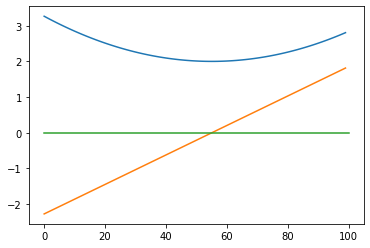

In [1718]:
# verify gradients
a_list = np.linspace(-1, 1, 100)
A2 = As.copy()

i, j = 1, 1

results = [[], []]

for a in a_list:
    A2[i][j] = a
    results[0].append(expected_cost_lagrange(A2, P, As = As, Ps = Ps))
    results[1].append(grad_a(A2, P, i, j))

import matplotlib.pyplot as plt
plt.plot(results[0])
plt.plot(results[1])
plt.plot([0, 100],[0, 0])

-0.034870339745329826


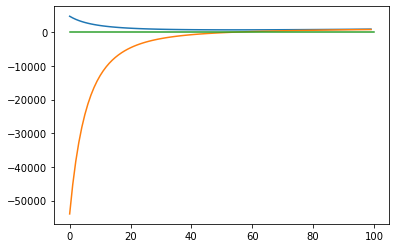

In [1871]:
# verify gradients
p_list = np.linspace(0, 1, 100)
P2 = P.copy()

lambdas = 0.1 * np.ones((2, n))
i, j = 1, 4
print(P[i][j])


results = [[], []]

for p in p_list:
    P2[i][j] = p
    results[0].append(expected_cost_lagrange(As, P2, As = As, Ps = Ps))
    results[1].append(grad_p(As, P2, i, j))

import matplotlib.pyplot as plt
plt.plot(results[0])
plt.plot(results[1])
plt.plot([0, 100],[0, 0])

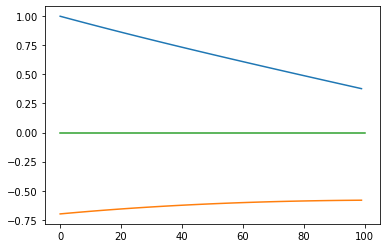

In [1723]:
# verify gradients
p_list = np.linspace(0, 1, 100)
P2 = Ps.copy()

lambdas = 0.1 * np.ones((2, n))
lambdasineq = 0.5 * np.ones((n, n))

i, j = 0, 1

results = [[], []]

for p in p_list:
    P2[i][j] = p
    results[0].append(expected_cost_lagrange(As, P2, As = As, Ps = Ps))
    results[1].append(grad_p(As, P2, i, j))

import matplotlib.pyplot as plt
plt.plot(results[0])
plt.plot(results[1])
plt.plot([0, 100],[0, 0])

To deal with the constraints that $p$ must be non-negative, we project the entries by applying the sigmoid function of each entry. Note that the range of the sigmoid is $(0, 1)$, which is also what we require for our entries $p$ (we did not explicitly constrain $p$ to be smaller than 1, but the equality constraints combined with the non-negativity constraints make sure that is the case.
To deal with the $2n$ equality constraints, we use $\textit{lagrange multipliers}$ $\lambda_{row, i}$, $i = 1, \cdots, n$ and $\lambda_{col, j}$, $j = 1, \cdots, n$. The dual function now becomes 

$$\mathcal{L}(A, P_\sigma, \mathbf{\lambda}) = C(A, P) - \sum_{i=1}^n \lambda_{row, i} \left(\sum_{j = 1}^n p_{ij} - 1\right) - \sum_{j = 1}^n \lambda_{col, j} \left(\sum_{i = 1}^n p_{ij} - 1\right),$$
where $P = \sigma(P_\sigma)$